In [1]:
import os
import re
from collections import Counter
import json
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
cm = 1/2.54

# force GPU device
os.environ["CUDA_VISIBLE_DEVICES"]='1'
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '2'
import tensorflow as tf

from keras.src.callbacks import EarlyStopping, ModelCheckpoint, ReduceLROnPlateau, CSVLogger
from keras.src.layers import SimpleRNN, LSTM, Dense, Dropout, Bidirectional
from keras import Sequential, Input
from keras.losses import CategoricalCrossentropy, CategoricalFocalCrossentropy
from keras.optimizers import Adam
from keras.models import load_model
from keras.metrics import CategoricalAccuracy, TopKCategoricalAccuracy


from sklearn.metrics import classification_report, confusion_matrix
from sklearn.utils.class_weight import compute_class_weight

from utils import *

In [2]:
max_sequence_length = 100
experiment_name = 'feature_tlds_dropout'
top_k = 3

In [3]:
checkpoint_path = f'saves/{experiment_name}'
model_path = f'{checkpoint_path}/model.keras'
log_path = f'{checkpoint_path}/log.csv'
history_path = f'{checkpoint_path}/history.npy'

# ensure directory exists
if not os.path.exists(checkpoint_path):
    os.makedirs(checkpoint_path)

In [4]:
data_directory = '/home/jrosendahl/datasets/cadets/sequences_export_benign_filetypes_more/'
unusable_threshold = 10
rare_threshold = 50
splits = (0.7, 0.15, 0.15)

max_sequence_length = 100

assert(sum(splits) == 1)

print(f'experiment parameters: \n{data_directory=} \n{unusable_threshold=} \n{rare_threshold=} \n{splits=} \n{max_sequence_length=}')

experiment parameters: 
data_directory='/home/jrosendahl/datasets/cadets/sequences_export_benign_filetypes_more/' 
unusable_threshold=10 
rare_threshold=50 
splits=(0.7, 0.15, 0.15) 
max_sequence_length=100


In [5]:
total_classes = 0

# unusable classes will be removed from the dataset
unusable_classes = []
# rare classes will be oversampled
rare_classes = []

# all classes in training data (all classes - unusable classes)
classes = []

# walk all files, build unusable_classes, rare_classes
classes_occurrences = Counter()
for filename in os.listdir(data_directory):
    label = class_from_filename(filename)
    classes_occurrences[label] += 1

total_classes = len(classes_occurrences)
for label, count in classes_occurrences.items():
    if count < unusable_threshold:
        unusable_classes.append(label)
    elif count < rare_threshold:
        rare_classes.append(label)
        classes.append(label)
    else:
        classes.append(label)

print(f'Total classes: {total_classes}')
print(f'Unusable classes: {len(unusable_classes)}')
print(f'\t{unusable_classes}')
print(f'Rare classes: {len(rare_classes)}')
print(f'\t{rare_classes}')

labels_cardinality = len(set(classes))
print(f'Usable classes: {labels_cardinality}')

Total classes: 118
Unusable classes: 51
	['ping', 'pwd_mkdb', 'vi', 'tr', 'uname', 'msgs', 'screen', 'pw', 'bzip2', 'bzcat', 'nginx', 'stat', 'tail', 'smtp', 'kenv', 'nawk', 'ssh', 'chown', 'cut', 'php-fpm', 'jot', 'xz', 'diff', 'bounce', 'links', 'ipfw', 'touch', 'env', 'pfctl', 'minions', 'csh', 'kldstat', 'su', 'nohup', 'stty', 'df', 'limits', 'id', 'postmap', 'ifconfig', 'chkgrp', 'ipfstat', 'locale', 'devd', 'uniq', 'XIM', 'getty', 'which', 'init', 'test', 'nice']
Rare classes: 20
	['wc', 'grep', 'mktemp', 'less', 'tty', 'mailwrapper', 'kill', 'lockf', 'mount', 'tee', 'expr', 'ps', 'route', 'sed', 'cmp', 'egrep', 'sort', 'basename', 'awk', 'mail']
Usable classes: 67


In [6]:
# split into train, validation, test
labels_set = set()

filenames_all = []

filenames_train = []
filenames_val = []
filenames_test = []

for filename in os.listdir(data_directory):
    label = class_from_filename(filename)
    if label in unusable_classes:
        continue
    labels_set.add(label)
    filenames_all.append(filename)

# stratisfied split
test_vs_val = splits[2] / (splits[1] + splits[2])
filenames_train, filenames_val_test = train_test_split(filenames_all, test_size=splits[1]+splits[2], stratify=[class_from_filename(f) for f in filenames_all])
filenames_val, filenames_test = train_test_split(filenames_val_test, test_size=test_vs_val, stratify=[class_from_filename(f) for f in filenames_val_test])

print(f'Train: {len(filenames_train)}')
print(f'Validation: {len(filenames_val)}')
print(f'Test: {len(filenames_test)}')

# build labels_map in alphabetical order
labels_map = {}
for i, label in enumerate(sorted(labels_set)):
    labels_map[label] = i

Train: 150475
Validation: 32245
Test: 32245


In [7]:
# load data
count_files_read = 0
count_sequences_split = 0
count_splits = 0

preprocessor = Preprocessor(['TYPE', 'PRED_OBJ_PATHS'])

def parse_file(filename) -> tuple[list[int], list[list[int]]]:
    """
    Parse a file and return the vectorized data. Not a pure function (calls parse_line)!
    """
    global count_files_read, count_sequences_split, count_splits

    y_list: list[int] = []
    X_list: list[list[int]] = []
    y = class_from_filename(filename)
    y = labels_map[y]
    with open(os.path.join(data_directory, filename), 'r') as f:
        lines = f.readlines()
        count_files_read += 1
    if count_files_read % 50000 == 0:
        print(f'Files read: {count_files_read}')
    X = []
    for line in lines:
        line_res = preprocessor.process(line)
        event = line_res['TYPE']
        path1_tld = line_res['PRED_OBJ1_PATH']
        path2_tld = line_res['PRED_OBJ2_PATH']
        X.append((event, path1_tld, path2_tld))

    # check if sequence needs to be split
    if len(X) > max_sequence_length:
        count_sequences_split += 1
        count_splits += len(X) // max_sequence_length
        for i in range(0, len(X), max_sequence_length):
            y_list.append(y)
            X_list.append(X[i:i+max_sequence_length])
        assert len(X_list[0]) == max_sequence_length
    else:
        y_list.append(y)
        X_list.append(X)

    # transform elements to numpy arrays
    y_list = np.array(y_list)
    X_list = [np.array(x) for x in X_list]

    assert len(y_list) == len(X_list)
    return y_list, X_list


y_train = []
X_train = []
y_val = []
X_val = []
y_test = []
X_test = []

for filename in filenames_train:
    try:
        y_list, X_list = parse_file(filename)
    except Exception as e:
        print(f'Error parsing file: {filename}')
        raise e
    y_train.extend(y_list)
    X_train.extend(X_list)

for filename in filenames_val:
    y_list, X_list = parse_file(filename)
    y_val.extend(y_list)
    X_val.extend(X_list)

for filename in filenames_test:
    y_list, X_list = parse_file(filename)
    y_test.extend(y_list)
    X_test.extend(X_list)

assert len(X_train) == len(y_train)
assert len(X_val) == len(y_val)
assert len(X_test) == len(y_test)

print(f'Files read: {count_files_read}')
print(f'Sequences split: {count_sequences_split}')
print(f'Splits: {count_splits}')


event_types_map = preprocessor.event_types_map
path_map = preprocessor.path_map

event_types_cardinality = len(event_types_map)
path_cardinality = len(path_map)

print(f'Event types: {event_types_cardinality}')
print(f'Paths: {path_cardinality}')

# print lengths
print(f'Train: {len(y_train)}')
print(f'Validation: {len(y_val)}')
print(f'Test: {len(y_test)}')

Files read: 50000


Files read: 100000


Files read: 150000


Files read: 200000


Files read: 214965
Sequences split: 22897
Splits: 132960
Event types: 29
Paths: 23
Train: 247249
Validation: 48541
Test: 52084


In [8]:
# debug print all maps (sorted)
print('Event types:')
for k, v in sorted(event_types_map.items(), key=lambda x: x[1]):
    print(f'{v}: {k}', end=', ')
print()

print('Paths:')
for k, v in sorted(path_map.items(), key=lambda x: x[1]):
    print(f'{v}: {k}', end=', ')
print()

Event types:
0: EVENT_EXECUTE, 1: EVENT_OPEN, 2: EVENT_READ, 3: EVENT_CLOSE, 4: EVENT_MMAP, 5: EVENT_WRITE, 6: EVENT_EXIT, 7: EVENT_CONNECT, 8: EVENT_SENDTO, 9: EVENT_LSEEK, 10: EVENT_CHANGE_PRINCIPAL, 11: EVENT_LOGIN, 12: EVENT_MODIFY_PROCESS, 13: EVENT_FCNTL, 14: EVENT_RECVFROM, 15: EVENT_MPROTECT, 16: EVENT_CREATE_OBJECT, 17: EVENT_ACCEPT, 18: EVENT_UNLINK, 19: EVENT_FORK, 20: EVENT_MODIFY_FILE_ATTRIBUTES, 21: EVENT_LINK, 22: EVENT_RENAME, 23: EVENT_TRUNCATE, 24: EVENT_SIGNAL, 25: EVENT_OTHER, 26: EVENT_SENDMSG, 27: EVENT_RECVMSG, 28: EVENT_BIND, 
Paths:
0: None, 1: bin, 2: libexec, 3: etc, 4: var, 5: lib, 6: dev, 7: usr, 8: data, 9: Other, 10: root, 11: home, 12: , 13: tmp, 14: sbin, 15: base, 16: boot, 17: media, 18: mnt, 19: net, 20: proc, 21: rescue, 22: ., 


In [9]:
# turn labels map into bidirectional map
for k, v in labels_map.copy().items():
    labels_map[v] = k

# turn feature maps into bidirectional maps
for k, v in event_types_map.copy().items():
    event_types_map[v] = k

for k, v in path_map.copy().items():
    path_map[v] = k

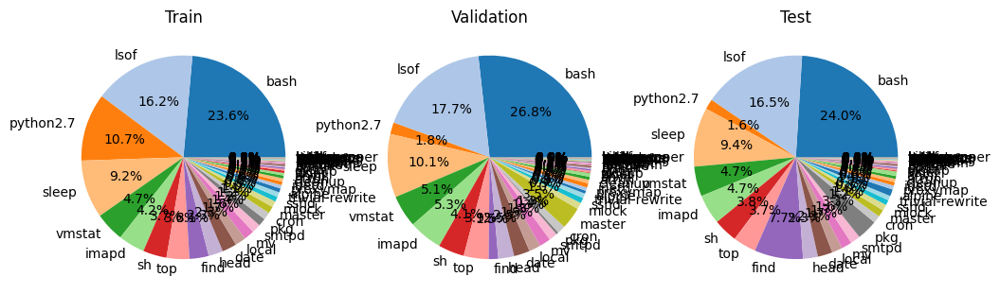

In [10]:
# print distributions in all 3 sets
train_distribution = Counter(y_train)
val_distribution = Counter(y_val)
test_distribution = Counter(y_test)

# plot 3 pie plots, use same colors for same classes
colors = plt.cm.tab20.colors
colors = [ colors[i % 20] for i in range(labels_cardinality) ]

# sort labels by occurence in training set
sorted_labels = sorted(train_distribution, key=train_distribution.get, reverse=True)

# sort all distributions by sorted_labels
train_distribution = [train_distribution[label] for label in sorted_labels]
val_distribution = [val_distribution[label] for label in sorted_labels]
test_distribution = [test_distribution[label] for label in sorted_labels]

# transform labels to names
sorted_labels = [labels_map[label] for label in sorted_labels]

fig, axs = plt.subplots(1, 3, figsize=(30*cm, 10*cm))
axs[0].pie(train_distribution, labels=sorted_labels, colors=colors, autopct='%1.1f%%')
axs[0].set_title('Train')
axs[1].pie(val_distribution, labels=sorted_labels, colors=colors, autopct='%1.1f%%')
axs[1].set_title('Validation')
axs[2].pie(test_distribution, labels=sorted_labels, colors=colors, autopct='%1.1f%%')
axs[2].set_title('Test')
plt.savefig(f'{checkpoint_path}/distributions.png')
plt.show()

In [11]:
# one-hot encode labels
y_train = np.eye(labels_cardinality)[y_train]
y_val = np.eye(labels_cardinality)[y_val]
y_test = np.eye(labels_cardinality)[y_test]

In [12]:
# one-hot encode features
# at this point, X_* are lists of tuples of vectorized features
def encode_features(sequence: np.ndarray) -> np.ndarray:
    # Precompute identity matrices
    event_eye = np.eye(event_types_cardinality)
    path_eye = np.eye(path_cardinality)

    # Initialize the output array with precomputed shapes
    encoded_seq = np.empty((len(sequence), event_eye.shape[1] + (2* path_eye.shape[1])))

    for i, feature_vector in enumerate(sequence):
        event = event_eye[feature_vector[0]]
        path1 = path_eye[feature_vector[1]]
        path2 = path_eye[feature_vector[2]]

        # Concatenate all features into a single feature vector
        encoded_seq[i] = np.concatenate((event, path1, path2))

    return encoded_seq

X_train = [ encode_features(x) for x in X_train ]
X_val = [ encode_features(x) for x in X_val ]
X_test = [ encode_features(x) for x in X_test ]

In [13]:
feature_vector_cardinality = X_train[0].shape[1]

print(f'Feature vector cardinality: {feature_vector_cardinality}')

Feature vector cardinality: 75


In [14]:
X_train, y_train = shuffle(X_train, y_train)
X_val, y_val = shuffle(X_val, y_val)
X_test, y_test = shuffle(X_test, y_test)

build model

In [15]:
model = Sequential(layers=[
    Input(shape=(None, feature_vector_cardinality)),
    SimpleRNN(128, return_sequences=True, dropout=0.1, recurrent_dropout=0.1),
    SimpleRNN(128, return_sequences=True, dropout=0.1, recurrent_dropout=0.1),
    SimpleRNN(128, return_sequences=False, dropout=0.1, recurrent_dropout=0.1),
    Dense(labels_cardinality, activation='softmax')
])

model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ simple_rnn (SimpleRNN)          │ (None, None, 128)      │        26,112 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ simple_rnn_1 (SimpleRNN)        │ (None, None, 128)      │        32,896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ simple_rnn_2 (SimpleRNN)        │ (None, 128)            │        32,896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 67)             │         8,643 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 100,547 (392.76 KB)

 Trainable params: 100,547 (392.76 KB)

 Non-trainable params: 0 (0.00 B)

In [16]:
callbacks = [
    EarlyStopping(
        monitor='val_loss',
        patience=5,
        verbose=1,
        mode='auto'
    ),
    ModelCheckpoint(
        filepath=model_path,
        monitor='val_loss',
        save_best_only=True,
        verbose=1
    ),
    ReduceLROnPlateau(
        monitor='val_loss',
        factor=0.1,
        patience=3,
        verbose=1,
        mode='auto',
        min_lr=1e-7
    ),
    CSVLogger(
        filename=log_path,
        append=False
    )
]

loss = CategoricalCrossentropy()
optimizer = Adam(learning_rate=0.0001)

# class weights
y_train_int = np.argmax(y_train, axis=1)
class_weights = compute_class_weight(
    class_weight='balanced',
    classes=np.unique(y_train_int),
    y=y_train_int
)
class_weights_dict = dict(enumerate(class_weights))

metrics = [
    CategoricalAccuracy(name='categorical_accuracy'),
    TopKCategoricalAccuracy(k=top_k, name=f'top_{top_k}_categorical_accuracy'),
]

weighted_metrics = [
    CategoricalAccuracy(name='w_categorical_accuracy'),
    TopKCategoricalAccuracy(k=top_k, name=f'w_top_{top_k}_categorical_accuracy'),
]

# 'categorical_focal_crossentropy'
# 'categorical_crossentropy'
model.compile(
    loss=loss,
    optimizer=optimizer,
    metrics=metrics,
    weighted_metrics=weighted_metrics,
)

train model

In [17]:
history = model.fit(
    x=Generator(X_train, y_train, 64, max_sequence_length),
    validation_data=Generator(X_val, y_val, 64, max_sequence_length),
    epochs=200,
    callbacks=callbacks,
    class_weight=class_weights_dict
)

# save history to file
with open(history_path, 'wb') as f:
    np.save(f, history.history)

Epoch 1/200


I0000 00:00:1723946547.605883 3508570 service.cc:145] XLA service 0x20ee5ee0 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1723946547.605970 3508570 service.cc:153]   StreamExecutor device (0): NVIDIA GeForce RTX 2080 Ti, Compute Capability 7.5


   1/3864 ━━━━━━━━━━━━━━━━━━━━ 16:38:14 16s/step - categorical_accuracy: 0.0156 - loss: 1.6963 - top_3_categorical_accuracy: 0.0469 - w_categorical_accuracy: 0.0067 - w_top_3_categorical_accuracy: 0.0373

   3/3864 ━━━━━━━━━━━━━━━━━━━━ 2:18 36ms/step - categorical_accuracy: 0.0156 - loss: 1.8912 - top_3_categorical_accuracy: 0.0451 - w_categorical_accuracy: 0.0159 - w_top_3_categorical_accuracy: 0.0359   

   5/3864 ━━━━━━━━━━━━━━━━━━━━ 2:14 35ms/step - categorical_accuracy: 0.0156 - loss: 1.8618 - top_3_categorical_accuracy: 0.0508 - w_categorical_accuracy: 0.0151 - w_top_3_categorical_accuracy: 0.0400

I0000 00:00:1723946560.050723 3508570 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


   7/3864 ━━━━━━━━━━━━━━━━━━━━ 2:12 34ms/step - categorical_accuracy: 0.0149 - loss: 1.9147 - top_3_categorical_accuracy: 0.0528 - w_categorical_accuracy: 0.0134 - w_top_3_categorical_accuracy: 0.0399

   9/3864 ━━━━━━━━━━━━━━━━━━━━ 2:08 33ms/step - categorical_accuracy: 0.0149 - loss: 1.9860 - top_3_categorical_accuracy: 0.0529 - w_categorical_accuracy: 0.0120 - w_top_3_categorical_accuracy: 0.0390

  11/3864 ━━━━━━━━━━━━━━━━━━━━ 2:07 33ms/step - categorical_accuracy: 0.0145 - loss: 2.0553 - top_3_categorical_accuracy: 0.0517 - w_categorical_accuracy: 0.0319 - w_top_3_categorical_accuracy: 0.0578

  13/3864 ━━━━━━━━━━━━━━━━━━━━ 2:04 32ms/step - categorical_accuracy: 0.0141 - loss: 2.1531 - top_3_categorical_accuracy: 0.0512 - w_categorical_accuracy: 0.0574 - w_top_3_categorical_accuracy: 0.0818

  15/3864 ━━━━━━━━━━━━━━━━━━━━ 2:03 32ms/step - categorical_accuracy: 0.0138 - loss: 2.2371 - top_3_categorical_accuracy: 0.0505 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.0953

  17/3864 ━━━━━━━━━━━━━━━━━━━━ 2:02 32ms/step - categorical_accuracy: 0.0136 - loss: 2.3022 - top_3_categorical_accuracy: 0.0499 - w_categorical_accuracy: 0.0812 - w_top_3_categorical_accuracy: 0.1032

  19/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.0134 - loss: 2.3448 - top_3_categorical_accuracy: 0.0493 - w_categorical_accuracy: 0.0871 - w_top_3_categorical_accuracy: 0.1081

  21/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.0133 - loss: 2.3973 - top_3_categorical_accuracy: 0.0488 - w_categorical_accuracy: 0.0902 - w_top_3_categorical_accuracy: 0.1103

  23/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.0134 - loss: 2.4456 - top_3_categorical_accuracy: 0.0485 - w_categorical_accuracy: 0.0920 - w_top_3_categorical_accuracy: 0.1113

  25/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.0135 - loss: 2.4907 - top_3_categorical_accuracy: 0.0482 - w_categorical_accuracy: 0.0929 - w_top_3_categorical_accuracy: 0.1130

  27/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.0135 - loss: 2.5515 - top_3_categorical_accuracy: 0.0479 - w_categorical_accuracy: 0.0926 - w_top_3_categorical_accuracy: 0.1143

  29/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.0134 - loss: 2.6377 - top_3_categorical_accuracy: 0.0475 - w_categorical_accuracy: 0.0913 - w_top_3_categorical_accuracy: 0.1139

  31/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.0134 - loss: 2.8179 - top_3_categorical_accuracy: 0.0471 - w_categorical_accuracy: 0.0888 - w_top_3_categorical_accuracy: 0.1115

  33/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.0134 - loss: 2.9857 - top_3_categorical_accuracy: 0.0469 - w_categorical_accuracy: 0.0863 - w_top_3_categorical_accuracy: 0.1092

  35/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.0134 - loss: 3.1288 - top_3_categorical_accuracy: 0.0466 - w_categorical_accuracy: 0.0846 - w_top_3_categorical_accuracy: 0.1076

  37/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.0134 - loss: 3.2576 - top_3_categorical_accuracy: 0.0464 - w_categorical_accuracy: 0.0829 - w_top_3_categorical_accuracy: 0.1059

  39/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.0134 - loss: 3.3671 - top_3_categorical_accuracy: 0.0461 - w_categorical_accuracy: 0.0813 - w_top_3_categorical_accuracy: 0.1043

  41/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.0133 - loss: 3.4596 - top_3_categorical_accuracy: 0.0459 - w_categorical_accuracy: 0.0797 - w_top_3_categorical_accuracy: 0.1028

  43/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.0133 - loss: 3.5413 - top_3_categorical_accuracy: 0.0456 - w_categorical_accuracy: 0.0789 - w_top_3_categorical_accuracy: 0.1019

  45/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.0134 - loss: 3.6104 - top_3_categorical_accuracy: 0.0455 - w_categorical_accuracy: 0.0780 - w_top_3_categorical_accuracy: 0.1011

  47/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.0134 - loss: 3.6734 - top_3_categorical_accuracy: 0.0453 - w_categorical_accuracy: 0.0772 - w_top_3_categorical_accuracy: 0.1002

  49/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.0134 - loss: 3.7266 - top_3_categorical_accuracy: 0.0452 - w_categorical_accuracy: 0.0765 - w_top_3_categorical_accuracy: 0.0995

  51/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.0135 - loss: 3.7779 - top_3_categorical_accuracy: 0.0452 - w_categorical_accuracy: 0.0757 - w_top_3_categorical_accuracy: 0.0986

  53/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.0135 - loss: 3.8236 - top_3_categorical_accuracy: 0.0451 - w_categorical_accuracy: 0.0749 - w_top_3_categorical_accuracy: 0.0977

  55/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.0135 - loss: 3.8650 - top_3_categorical_accuracy: 0.0450 - w_categorical_accuracy: 0.0740 - w_top_3_categorical_accuracy: 0.0969

  57/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.0135 - loss: 3.9029 - top_3_categorical_accuracy: 0.0449 - w_categorical_accuracy: 0.0732 - w_top_3_categorical_accuracy: 0.0960

  59/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.0135 - loss: 3.9382 - top_3_categorical_accuracy: 0.0449 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.0951

  61/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.0135 - loss: 3.9696 - top_3_categorical_accuracy: 0.0449 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.0942

  63/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.0135 - loss: 3.9970 - top_3_categorical_accuracy: 0.0449 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.0933

  65/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.0135 - loss: 4.0209 - top_3_categorical_accuracy: 0.0449 - w_categorical_accuracy: 0.0701 - w_top_3_categorical_accuracy: 0.0925

  67/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.0135 - loss: 4.0413 - top_3_categorical_accuracy: 0.0449 - w_categorical_accuracy: 0.0694 - w_top_3_categorical_accuracy: 0.0917

  69/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.0136 - loss: 4.0586 - top_3_categorical_accuracy: 0.0449 - w_categorical_accuracy: 0.0687 - w_top_3_categorical_accuracy: 0.0910

  71/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.0136 - loss: 4.0785 - top_3_categorical_accuracy: 0.0449 - w_categorical_accuracy: 0.0680 - w_top_3_categorical_accuracy: 0.0902

  73/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.0136 - loss: 4.0952 - top_3_categorical_accuracy: 0.0450 - w_categorical_accuracy: 0.0673 - w_top_3_categorical_accuracy: 0.0894

  75/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.0136 - loss: 4.1090 - top_3_categorical_accuracy: 0.0450 - w_categorical_accuracy: 0.0666 - w_top_3_categorical_accuracy: 0.0887

  77/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.0136 - loss: 4.1210 - top_3_categorical_accuracy: 0.0451 - w_categorical_accuracy: 0.0660 - w_top_3_categorical_accuracy: 0.0880

  79/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.0136 - loss: 4.1321 - top_3_categorical_accuracy: 0.0451 - w_categorical_accuracy: 0.0653 - w_top_3_categorical_accuracy: 0.0873

  81/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.0137 - loss: 4.1410 - top_3_categorical_accuracy: 0.0452 - w_categorical_accuracy: 0.0647 - w_top_3_categorical_accuracy: 0.0867

  83/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.0137 - loss: 4.1479 - top_3_categorical_accuracy: 0.0453 - w_categorical_accuracy: 0.0641 - w_top_3_categorical_accuracy: 0.0861

  85/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.0138 - loss: 4.1533 - top_3_categorical_accuracy: 0.0453 - w_categorical_accuracy: 0.0636 - w_top_3_categorical_accuracy: 0.0855

  87/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.0138 - loss: 4.1597 - top_3_categorical_accuracy: 0.0453 - w_categorical_accuracy: 0.0630 - w_top_3_categorical_accuracy: 0.0848

  89/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.0138 - loss: 4.1651 - top_3_categorical_accuracy: 0.0454 - w_categorical_accuracy: 0.0624 - w_top_3_categorical_accuracy: 0.0842

  91/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.0139 - loss: 4.1699 - top_3_categorical_accuracy: 0.0454 - w_categorical_accuracy: 0.0619 - w_top_3_categorical_accuracy: 0.0837

  93/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.0139 - loss: 4.1746 - top_3_categorical_accuracy: 0.0455 - w_categorical_accuracy: 0.0613 - w_top_3_categorical_accuracy: 0.0831

  95/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.0139 - loss: 4.1810 - top_3_categorical_accuracy: 0.0455 - w_categorical_accuracy: 0.0608 - w_top_3_categorical_accuracy: 0.0825

  97/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.0140 - loss: 4.1868 - top_3_categorical_accuracy: 0.0456 - w_categorical_accuracy: 0.0603 - w_top_3_categorical_accuracy: 0.0819

  99/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.0140 - loss: 4.1953 - top_3_categorical_accuracy: 0.0457 - w_categorical_accuracy: 0.0597 - w_top_3_categorical_accuracy: 0.0813

 101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.0141 - loss: 4.2025 - top_3_categorical_accuracy: 0.0457 - w_categorical_accuracy: 0.0592 - w_top_3_categorical_accuracy: 0.0808

 103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.0141 - loss: 4.2090 - top_3_categorical_accuracy: 0.0458 - w_categorical_accuracy: 0.0587 - w_top_3_categorical_accuracy: 0.0802

 105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.0141 - loss: 4.2148 - top_3_categorical_accuracy: 0.0459 - w_categorical_accuracy: 0.0582 - w_top_3_categorical_accuracy: 0.0797

 107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.0142 - loss: 4.2201 - top_3_categorical_accuracy: 0.0460 - w_categorical_accuracy: 0.0577 - w_top_3_categorical_accuracy: 0.0792

 109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.0142 - loss: 4.2249 - top_3_categorical_accuracy: 0.0460 - w_categorical_accuracy: 0.0573 - w_top_3_categorical_accuracy: 0.0786

 111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.0143 - loss: 4.2317 - top_3_categorical_accuracy: 0.0461 - w_categorical_accuracy: 0.0568 - w_top_3_categorical_accuracy: 0.0781

 113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.0143 - loss: 4.2418 - top_3_categorical_accuracy: 0.0462 - w_categorical_accuracy: 0.0563 - w_top_3_categorical_accuracy: 0.0775

 115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.0144 - loss: 4.2513 - top_3_categorical_accuracy: 0.0463 - w_categorical_accuracy: 0.0558 - w_top_3_categorical_accuracy: 0.0770

 117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.0144 - loss: 4.2601 - top_3_categorical_accuracy: 0.0464 - w_categorical_accuracy: 0.0553 - w_top_3_categorical_accuracy: 0.0765

 119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.0145 - loss: 4.2720 - top_3_categorical_accuracy: 0.0465 - w_categorical_accuracy: 0.0549 - w_top_3_categorical_accuracy: 0.0759

 121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.0145 - loss: 4.2827 - top_3_categorical_accuracy: 0.0466 - w_categorical_accuracy: 0.0544 - w_top_3_categorical_accuracy: 0.0754

 123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.0146 - loss: 4.2924 - top_3_categorical_accuracy: 0.0467 - w_categorical_accuracy: 0.0540 - w_top_3_categorical_accuracy: 0.0748

 125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.0146 - loss: 4.3029 - top_3_categorical_accuracy: 0.0467 - w_categorical_accuracy: 0.0535 - w_top_3_categorical_accuracy: 0.0743

 127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.0146 - loss: 4.3145 - top_3_categorical_accuracy: 0.0468 - w_categorical_accuracy: 0.0531 - w_top_3_categorical_accuracy: 0.0738

 129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.0147 - loss: 4.3255 - top_3_categorical_accuracy: 0.0469 - w_categorical_accuracy: 0.0527 - w_top_3_categorical_accuracy: 0.0733

 131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.0147 - loss: 4.3358 - top_3_categorical_accuracy: 0.0470 - w_categorical_accuracy: 0.0523 - w_top_3_categorical_accuracy: 0.0728

 133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.0148 - loss: 4.3455 - top_3_categorical_accuracy: 0.0471 - w_categorical_accuracy: 0.0519 - w_top_3_categorical_accuracy: 0.0724

 135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.0148 - loss: 4.3573 - top_3_categorical_accuracy: 0.0472 - w_categorical_accuracy: 0.0515 - w_top_3_categorical_accuracy: 0.0719

 137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.0149 - loss: 4.3703 - top_3_categorical_accuracy: 0.0474 - w_categorical_accuracy: 0.0511 - w_top_3_categorical_accuracy: 0.0715

 139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.0150 - loss: 4.3825 - top_3_categorical_accuracy: 0.0475 - w_categorical_accuracy: 0.0507 - w_top_3_categorical_accuracy: 0.0710

 141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.0150 - loss: 4.3937 - top_3_categorical_accuracy: 0.0476 - w_categorical_accuracy: 0.0503 - w_top_3_categorical_accuracy: 0.0706

 143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.0151 - loss: 4.4039 - top_3_categorical_accuracy: 0.0477 - w_categorical_accuracy: 0.0500 - w_top_3_categorical_accuracy: 0.0702

 145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.0151 - loss: 4.4145 - top_3_categorical_accuracy: 0.0478 - w_categorical_accuracy: 0.0496 - w_top_3_categorical_accuracy: 0.0700

 147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.0151 - loss: 4.4258 - top_3_categorical_accuracy: 0.0479 - w_categorical_accuracy: 0.0492 - w_top_3_categorical_accuracy: 0.0702

 149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.0152 - loss: 4.4363 - top_3_categorical_accuracy: 0.0480 - w_categorical_accuracy: 0.0489 - w_top_3_categorical_accuracy: 0.0703

 151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.0152 - loss: 4.4461 - top_3_categorical_accuracy: 0.0481 - w_categorical_accuracy: 0.0485 - w_top_3_categorical_accuracy: 0.0704

 153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.0153 - loss: 4.4575 - top_3_categorical_accuracy: 0.0482 - w_categorical_accuracy: 0.0482 - w_top_3_categorical_accuracy: 0.0705

 155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.0153 - loss: 4.4680 - top_3_categorical_accuracy: 0.0483 - w_categorical_accuracy: 0.0479 - w_top_3_categorical_accuracy: 0.0706

 157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.0154 - loss: 4.4777 - top_3_categorical_accuracy: 0.0485 - w_categorical_accuracy: 0.0475 - w_top_3_categorical_accuracy: 0.0707

 159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.0155 - loss: 4.4870 - top_3_categorical_accuracy: 0.0486 - w_categorical_accuracy: 0.0472 - w_top_3_categorical_accuracy: 0.0707

 161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.0155 - loss: 4.4957 - top_3_categorical_accuracy: 0.0487 - w_categorical_accuracy: 0.0469 - w_top_3_categorical_accuracy: 0.0708

 163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.0156 - loss: 4.5044 - top_3_categorical_accuracy: 0.0488 - w_categorical_accuracy: 0.0466 - w_top_3_categorical_accuracy: 0.0709

 165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.0156 - loss: 4.5132 - top_3_categorical_accuracy: 0.0490 - w_categorical_accuracy: 0.0463 - w_top_3_categorical_accuracy: 0.0709

 167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.0157 - loss: 4.5214 - top_3_categorical_accuracy: 0.0491 - w_categorical_accuracy: 0.0460 - w_top_3_categorical_accuracy: 0.0710

 169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.0158 - loss: 4.5291 - top_3_categorical_accuracy: 0.0492 - w_categorical_accuracy: 0.0457 - w_top_3_categorical_accuracy: 0.0710

 171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.0158 - loss: 4.5362 - top_3_categorical_accuracy: 0.0493 - w_categorical_accuracy: 0.0454 - w_top_3_categorical_accuracy: 0.0711

 173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.0159 - loss: 4.5429 - top_3_categorical_accuracy: 0.0495 - w_categorical_accuracy: 0.0452 - w_top_3_categorical_accuracy: 0.0711

 175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.0160 - loss: 4.5491 - top_3_categorical_accuracy: 0.0496 - w_categorical_accuracy: 0.0449 - w_top_3_categorical_accuracy: 0.0712

 177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.0160 - loss: 4.5555 - top_3_categorical_accuracy: 0.0497 - w_categorical_accuracy: 0.0446 - w_top_3_categorical_accuracy: 0.0712

 179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.0161 - loss: 4.5620 - top_3_categorical_accuracy: 0.0498 - w_categorical_accuracy: 0.0444 - w_top_3_categorical_accuracy: 0.0712

 181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.0162 - loss: 4.5679 - top_3_categorical_accuracy: 0.0500 - w_categorical_accuracy: 0.0441 - w_top_3_categorical_accuracy: 0.0712

 183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.0162 - loss: 4.5735 - top_3_categorical_accuracy: 0.0501 - w_categorical_accuracy: 0.0439 - w_top_3_categorical_accuracy: 0.0712

 185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.0163 - loss: 4.5786 - top_3_categorical_accuracy: 0.0502 - w_categorical_accuracy: 0.0436 - w_top_3_categorical_accuracy: 0.0713

 187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.0164 - loss: 4.5834 - top_3_categorical_accuracy: 0.0503 - w_categorical_accuracy: 0.0434 - w_top_3_categorical_accuracy: 0.0713

 189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.0165 - loss: 4.5886 - top_3_categorical_accuracy: 0.0505 - w_categorical_accuracy: 0.0432 - w_top_3_categorical_accuracy: 0.0713

 191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.0165 - loss: 4.5945 - top_3_categorical_accuracy: 0.0506 - w_categorical_accuracy: 0.0429 - w_top_3_categorical_accuracy: 0.0713

 193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.0166 - loss: 4.6002 - top_3_categorical_accuracy: 0.0507 - w_categorical_accuracy: 0.0427 - w_top_3_categorical_accuracy: 0.0713

 195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.0166 - loss: 4.6054 - top_3_categorical_accuracy: 0.0509 - w_categorical_accuracy: 0.0425 - w_top_3_categorical_accuracy: 0.0712

 197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.0167 - loss: 4.6103 - top_3_categorical_accuracy: 0.0510 - w_categorical_accuracy: 0.0422 - w_top_3_categorical_accuracy: 0.0712

 199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.0168 - loss: 4.6148 - top_3_categorical_accuracy: 0.0511 - w_categorical_accuracy: 0.0420 - w_top_3_categorical_accuracy: 0.0712

 201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.0168 - loss: 4.6192 - top_3_categorical_accuracy: 0.0512 - w_categorical_accuracy: 0.0418 - w_top_3_categorical_accuracy: 0.0712

 203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.0169 - loss: 4.6234 - top_3_categorical_accuracy: 0.0514 - w_categorical_accuracy: 0.0416 - w_top_3_categorical_accuracy: 0.0712

 205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.0170 - loss: 4.6273 - top_3_categorical_accuracy: 0.0515 - w_categorical_accuracy: 0.0414 - w_top_3_categorical_accuracy: 0.0711

 207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.0170 - loss: 4.6311 - top_3_categorical_accuracy: 0.0516 - w_categorical_accuracy: 0.0411 - w_top_3_categorical_accuracy: 0.0711

 209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.0171 - loss: 4.6347 - top_3_categorical_accuracy: 0.0517 - w_categorical_accuracy: 0.0409 - w_top_3_categorical_accuracy: 0.0710

 211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.0171 - loss: 4.6380 - top_3_categorical_accuracy: 0.0519 - w_categorical_accuracy: 0.0407 - w_top_3_categorical_accuracy: 0.0710

 213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.0172 - loss: 4.6409 - top_3_categorical_accuracy: 0.0520 - w_categorical_accuracy: 0.0405 - w_top_3_categorical_accuracy: 0.0710

 215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.0173 - loss: 4.6437 - top_3_categorical_accuracy: 0.0521 - w_categorical_accuracy: 0.0403 - w_top_3_categorical_accuracy: 0.0709

 217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.0173 - loss: 4.6462 - top_3_categorical_accuracy: 0.0522 - w_categorical_accuracy: 0.0401 - w_top_3_categorical_accuracy: 0.0709

 219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.0174 - loss: 4.6489 - top_3_categorical_accuracy: 0.0524 - w_categorical_accuracy: 0.0400 - w_top_3_categorical_accuracy: 0.0709

 221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.0174 - loss: 4.6516 - top_3_categorical_accuracy: 0.0525 - w_categorical_accuracy: 0.0398 - w_top_3_categorical_accuracy: 0.0708

 223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.0175 - loss: 4.6541 - top_3_categorical_accuracy: 0.0526 - w_categorical_accuracy: 0.0396 - w_top_3_categorical_accuracy: 0.0708

 225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.0176 - loss: 4.6563 - top_3_categorical_accuracy: 0.0527 - w_categorical_accuracy: 0.0394 - w_top_3_categorical_accuracy: 0.0707

 227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.0176 - loss: 4.6583 - top_3_categorical_accuracy: 0.0528 - w_categorical_accuracy: 0.0392 - w_top_3_categorical_accuracy: 0.0707

 229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.0177 - loss: 4.6600 - top_3_categorical_accuracy: 0.0530 - w_categorical_accuracy: 0.0390 - w_top_3_categorical_accuracy: 0.0706

 231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.0178 - loss: 4.6615 - top_3_categorical_accuracy: 0.0531 - w_categorical_accuracy: 0.0389 - w_top_3_categorical_accuracy: 0.0706

 233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.0178 - loss: 4.6628 - top_3_categorical_accuracy: 0.0532 - w_categorical_accuracy: 0.0387 - w_top_3_categorical_accuracy: 0.0705

 235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.0179 - loss: 4.6642 - top_3_categorical_accuracy: 0.0533 - w_categorical_accuracy: 0.0385 - w_top_3_categorical_accuracy: 0.0705

 237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.0180 - loss: 4.6656 - top_3_categorical_accuracy: 0.0535 - w_categorical_accuracy: 0.0384 - w_top_3_categorical_accuracy: 0.0704

 239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.0180 - loss: 4.6670 - top_3_categorical_accuracy: 0.0536 - w_categorical_accuracy: 0.0382 - w_top_3_categorical_accuracy: 0.0704

 241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.0181 - loss: 4.6683 - top_3_categorical_accuracy: 0.0537 - w_categorical_accuracy: 0.0380 - w_top_3_categorical_accuracy: 0.0704

 243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.0182 - loss: 4.6694 - top_3_categorical_accuracy: 0.0538 - w_categorical_accuracy: 0.0379 - w_top_3_categorical_accuracy: 0.0703

 245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.0182 - loss: 4.6704 - top_3_categorical_accuracy: 0.0540 - w_categorical_accuracy: 0.0377 - w_top_3_categorical_accuracy: 0.0703

 247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.0183 - loss: 4.6715 - top_3_categorical_accuracy: 0.0541 - w_categorical_accuracy: 0.0376 - w_top_3_categorical_accuracy: 0.0702

 249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.0184 - loss: 4.6724 - top_3_categorical_accuracy: 0.0542 - w_categorical_accuracy: 0.0374 - w_top_3_categorical_accuracy: 0.0702

 251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.0184 - loss: 4.6732 - top_3_categorical_accuracy: 0.0543 - w_categorical_accuracy: 0.0373 - w_top_3_categorical_accuracy: 0.0701

 253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.0185 - loss: 4.6739 - top_3_categorical_accuracy: 0.0545 - w_categorical_accuracy: 0.0371 - w_top_3_categorical_accuracy: 0.0701

 255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.0186 - loss: 4.6752 - top_3_categorical_accuracy: 0.0546 - w_categorical_accuracy: 0.0370 - w_top_3_categorical_accuracy: 0.0701

 257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.0186 - loss: 4.6771 - top_3_categorical_accuracy: 0.0547 - w_categorical_accuracy: 0.0368 - w_top_3_categorical_accuracy: 0.0700

 259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.0187 - loss: 4.6793 - top_3_categorical_accuracy: 0.0548 - w_categorical_accuracy: 0.0367 - w_top_3_categorical_accuracy: 0.0699

 261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.0188 - loss: 4.6812 - top_3_categorical_accuracy: 0.0550 - w_categorical_accuracy: 0.0365 - w_top_3_categorical_accuracy: 0.0699

 263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.0188 - loss: 4.6829 - top_3_categorical_accuracy: 0.0551 - w_categorical_accuracy: 0.0364 - w_top_3_categorical_accuracy: 0.0698

 265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.0189 - loss: 4.6846 - top_3_categorical_accuracy: 0.0552 - w_categorical_accuracy: 0.0362 - w_top_3_categorical_accuracy: 0.0698

 267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.0190 - loss: 4.6862 - top_3_categorical_accuracy: 0.0553 - w_categorical_accuracy: 0.0361 - w_top_3_categorical_accuracy: 0.0697

 269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.0190 - loss: 4.6877 - top_3_categorical_accuracy: 0.0554 - w_categorical_accuracy: 0.0360 - w_top_3_categorical_accuracy: 0.0696

 271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.0191 - loss: 4.6891 - top_3_categorical_accuracy: 0.0555 - w_categorical_accuracy: 0.0358 - w_top_3_categorical_accuracy: 0.0696

 273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.0191 - loss: 4.6904 - top_3_categorical_accuracy: 0.0557 - w_categorical_accuracy: 0.0357 - w_top_3_categorical_accuracy: 0.0695

 275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.0192 - loss: 4.6915 - top_3_categorical_accuracy: 0.0558 - w_categorical_accuracy: 0.0356 - w_top_3_categorical_accuracy: 0.0695

 277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.0193 - loss: 4.6927 - top_3_categorical_accuracy: 0.0559 - w_categorical_accuracy: 0.0355 - w_top_3_categorical_accuracy: 0.0694

 279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.0193 - loss: 4.6939 - top_3_categorical_accuracy: 0.0560 - w_categorical_accuracy: 0.0353 - w_top_3_categorical_accuracy: 0.0694

 281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.0194 - loss: 4.6950 - top_3_categorical_accuracy: 0.0561 - w_categorical_accuracy: 0.0352 - w_top_3_categorical_accuracy: 0.0693

 283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.0195 - loss: 4.6959 - top_3_categorical_accuracy: 0.0562 - w_categorical_accuracy: 0.0351 - w_top_3_categorical_accuracy: 0.0693

 285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.0195 - loss: 4.6968 - top_3_categorical_accuracy: 0.0564 - w_categorical_accuracy: 0.0350 - w_top_3_categorical_accuracy: 0.0692

 287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.0196 - loss: 4.6979 - top_3_categorical_accuracy: 0.0565 - w_categorical_accuracy: 0.0349 - w_top_3_categorical_accuracy: 0.0691

 289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.0196 - loss: 4.6987 - top_3_categorical_accuracy: 0.0566 - w_categorical_accuracy: 0.0347 - w_top_3_categorical_accuracy: 0.0691

 291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.0197 - loss: 4.6996 - top_3_categorical_accuracy: 0.0567 - w_categorical_accuracy: 0.0346 - w_top_3_categorical_accuracy: 0.0690

 293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.0198 - loss: 4.7004 - top_3_categorical_accuracy: 0.0568 - w_categorical_accuracy: 0.0345 - w_top_3_categorical_accuracy: 0.0690

 295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.0198 - loss: 4.7012 - top_3_categorical_accuracy: 0.0569 - w_categorical_accuracy: 0.0344 - w_top_3_categorical_accuracy: 0.0689

 297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.0199 - loss: 4.7020 - top_3_categorical_accuracy: 0.0570 - w_categorical_accuracy: 0.0343 - w_top_3_categorical_accuracy: 0.0689

 299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.0200 - loss: 4.7026 - top_3_categorical_accuracy: 0.0571 - w_categorical_accuracy: 0.0342 - w_top_3_categorical_accuracy: 0.0688

 301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.0200 - loss: 4.7032 - top_3_categorical_accuracy: 0.0572 - w_categorical_accuracy: 0.0341 - w_top_3_categorical_accuracy: 0.0688

 303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.0201 - loss: 4.7038 - top_3_categorical_accuracy: 0.0574 - w_categorical_accuracy: 0.0340 - w_top_3_categorical_accuracy: 0.0688

 305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.0201 - loss: 4.7044 - top_3_categorical_accuracy: 0.0575 - w_categorical_accuracy: 0.0339 - w_top_3_categorical_accuracy: 0.0687

 307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.0202 - loss: 4.7051 - top_3_categorical_accuracy: 0.0576 - w_categorical_accuracy: 0.0338 - w_top_3_categorical_accuracy: 0.0687

 309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.0203 - loss: 4.7056 - top_3_categorical_accuracy: 0.0577 - w_categorical_accuracy: 0.0337 - w_top_3_categorical_accuracy: 0.0686

 311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.0203 - loss: 4.7062 - top_3_categorical_accuracy: 0.0578 - w_categorical_accuracy: 0.0336 - w_top_3_categorical_accuracy: 0.0686

 313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.0204 - loss: 4.7068 - top_3_categorical_accuracy: 0.0579 - w_categorical_accuracy: 0.0335 - w_top_3_categorical_accuracy: 0.0685

 315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.0205 - loss: 4.7074 - top_3_categorical_accuracy: 0.0580 - w_categorical_accuracy: 0.0334 - w_top_3_categorical_accuracy: 0.0685

 317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.0205 - loss: 4.7082 - top_3_categorical_accuracy: 0.0581 - w_categorical_accuracy: 0.0333 - w_top_3_categorical_accuracy: 0.0684

 319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.0206 - loss: 4.7089 - top_3_categorical_accuracy: 0.0583 - w_categorical_accuracy: 0.0332 - w_top_3_categorical_accuracy: 0.0684

 321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.0207 - loss: 4.7095 - top_3_categorical_accuracy: 0.0584 - w_categorical_accuracy: 0.0331 - w_top_3_categorical_accuracy: 0.0683

 323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.0207 - loss: 4.7101 - top_3_categorical_accuracy: 0.0585 - w_categorical_accuracy: 0.0330 - w_top_3_categorical_accuracy: 0.0683

 325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.0208 - loss: 4.7105 - top_3_categorical_accuracy: 0.0586 - w_categorical_accuracy: 0.0329 - w_top_3_categorical_accuracy: 0.0682

 327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.0208 - loss: 4.7108 - top_3_categorical_accuracy: 0.0587 - w_categorical_accuracy: 0.0328 - w_top_3_categorical_accuracy: 0.0682

 329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.0209 - loss: 4.7110 - top_3_categorical_accuracy: 0.0588 - w_categorical_accuracy: 0.0327 - w_top_3_categorical_accuracy: 0.0681

 331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.0210 - loss: 4.7111 - top_3_categorical_accuracy: 0.0589 - w_categorical_accuracy: 0.0326 - w_top_3_categorical_accuracy: 0.0681

 333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.0210 - loss: 4.7115 - top_3_categorical_accuracy: 0.0590 - w_categorical_accuracy: 0.0325 - w_top_3_categorical_accuracy: 0.0680

 335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.0211 - loss: 4.7119 - top_3_categorical_accuracy: 0.0591 - w_categorical_accuracy: 0.0325 - w_top_3_categorical_accuracy: 0.0680

 337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.0211 - loss: 4.7125 - top_3_categorical_accuracy: 0.0592 - w_categorical_accuracy: 0.0324 - w_top_3_categorical_accuracy: 0.0679

 339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.0212 - loss: 4.7137 - top_3_categorical_accuracy: 0.0593 - w_categorical_accuracy: 0.0323 - w_top_3_categorical_accuracy: 0.0678

 341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.0213 - loss: 4.7149 - top_3_categorical_accuracy: 0.0595 - w_categorical_accuracy: 0.0322 - w_top_3_categorical_accuracy: 0.0678

 343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.0213 - loss: 4.7161 - top_3_categorical_accuracy: 0.0596 - w_categorical_accuracy: 0.0321 - w_top_3_categorical_accuracy: 0.0677

 345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.0214 - loss: 4.7172 - top_3_categorical_accuracy: 0.0597 - w_categorical_accuracy: 0.0320 - w_top_3_categorical_accuracy: 0.0677

 347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.0214 - loss: 4.7182 - top_3_categorical_accuracy: 0.0598 - w_categorical_accuracy: 0.0319 - w_top_3_categorical_accuracy: 0.0676

 349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.0215 - loss: 4.7190 - top_3_categorical_accuracy: 0.0599 - w_categorical_accuracy: 0.0318 - w_top_3_categorical_accuracy: 0.0676

 351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.0216 - loss: 4.7198 - top_3_categorical_accuracy: 0.0600 - w_categorical_accuracy: 0.0318 - w_top_3_categorical_accuracy: 0.0675

 353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.0216 - loss: 4.7205 - top_3_categorical_accuracy: 0.0601 - w_categorical_accuracy: 0.0317 - w_top_3_categorical_accuracy: 0.0674

 355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.0217 - loss: 4.7210 - top_3_categorical_accuracy: 0.0602 - w_categorical_accuracy: 0.0316 - w_top_3_categorical_accuracy: 0.0674

 357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.0217 - loss: 4.7215 - top_3_categorical_accuracy: 0.0603 - w_categorical_accuracy: 0.0315 - w_top_3_categorical_accuracy: 0.0673

 359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.0218 - loss: 4.7219 - top_3_categorical_accuracy: 0.0604 - w_categorical_accuracy: 0.0314 - w_top_3_categorical_accuracy: 0.0673

 361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.0218 - loss: 4.7224 - top_3_categorical_accuracy: 0.0605 - w_categorical_accuracy: 0.0314 - w_top_3_categorical_accuracy: 0.0672

 363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.0219 - loss: 4.7229 - top_3_categorical_accuracy: 0.0606 - w_categorical_accuracy: 0.0313 - w_top_3_categorical_accuracy: 0.0672

 365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.0220 - loss: 4.7234 - top_3_categorical_accuracy: 0.0607 - w_categorical_accuracy: 0.0312 - w_top_3_categorical_accuracy: 0.0671

 367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.0220 - loss: 4.7239 - top_3_categorical_accuracy: 0.0608 - w_categorical_accuracy: 0.0311 - w_top_3_categorical_accuracy: 0.0671

 369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.0221 - loss: 4.7243 - top_3_categorical_accuracy: 0.0609 - w_categorical_accuracy: 0.0311 - w_top_3_categorical_accuracy: 0.0670

 371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.0221 - loss: 4.7246 - top_3_categorical_accuracy: 0.0610 - w_categorical_accuracy: 0.0310 - w_top_3_categorical_accuracy: 0.0670

 373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.0222 - loss: 4.7249 - top_3_categorical_accuracy: 0.0611 - w_categorical_accuracy: 0.0309 - w_top_3_categorical_accuracy: 0.0669

 375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.0223 - loss: 4.7252 - top_3_categorical_accuracy: 0.0612 - w_categorical_accuracy: 0.0308 - w_top_3_categorical_accuracy: 0.0669

 377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.0223 - loss: 4.7254 - top_3_categorical_accuracy: 0.0613 - w_categorical_accuracy: 0.0308 - w_top_3_categorical_accuracy: 0.0668

 379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.0224 - loss: 4.7256 - top_3_categorical_accuracy: 0.0614 - w_categorical_accuracy: 0.0307 - w_top_3_categorical_accuracy: 0.0668

 381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.0224 - loss: 4.7257 - top_3_categorical_accuracy: 0.0615 - w_categorical_accuracy: 0.0306 - w_top_3_categorical_accuracy: 0.0667

 383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.0225 - loss: 4.7257 - top_3_categorical_accuracy: 0.0616 - w_categorical_accuracy: 0.0306 - w_top_3_categorical_accuracy: 0.0667

 385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.0226 - loss: 4.7257 - top_3_categorical_accuracy: 0.0617 - w_categorical_accuracy: 0.0305 - w_top_3_categorical_accuracy: 0.0666

 387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.0226 - loss: 4.7257 - top_3_categorical_accuracy: 0.0618 - w_categorical_accuracy: 0.0304 - w_top_3_categorical_accuracy: 0.0666

 389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.0227 - loss: 4.7257 - top_3_categorical_accuracy: 0.0619 - w_categorical_accuracy: 0.0304 - w_top_3_categorical_accuracy: 0.0665

 391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.0227 - loss: 4.7259 - top_3_categorical_accuracy: 0.0620 - w_categorical_accuracy: 0.0303 - w_top_3_categorical_accuracy: 0.0665

 393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.0228 - loss: 4.7262 - top_3_categorical_accuracy: 0.0621 - w_categorical_accuracy: 0.0302 - w_top_3_categorical_accuracy: 0.0664

 395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.0229 - loss: 4.7263 - top_3_categorical_accuracy: 0.0622 - w_categorical_accuracy: 0.0302 - w_top_3_categorical_accuracy: 0.0664

 397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.0229 - loss: 4.7264 - top_3_categorical_accuracy: 0.0623 - w_categorical_accuracy: 0.0301 - w_top_3_categorical_accuracy: 0.0663

 399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.0230 - loss: 4.7266 - top_3_categorical_accuracy: 0.0624 - w_categorical_accuracy: 0.0300 - w_top_3_categorical_accuracy: 0.0663

 401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.0230 - loss: 4.7268 - top_3_categorical_accuracy: 0.0625 - w_categorical_accuracy: 0.0300 - w_top_3_categorical_accuracy: 0.0662

 403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.0231 - loss: 4.7269 - top_3_categorical_accuracy: 0.0626 - w_categorical_accuracy: 0.0299 - w_top_3_categorical_accuracy: 0.0662

 405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.0231 - loss: 4.7270 - top_3_categorical_accuracy: 0.0627 - w_categorical_accuracy: 0.0298 - w_top_3_categorical_accuracy: 0.0661

 407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.0232 - loss: 4.7271 - top_3_categorical_accuracy: 0.0628 - w_categorical_accuracy: 0.0298 - w_top_3_categorical_accuracy: 0.0661

 409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.0233 - loss: 4.7272 - top_3_categorical_accuracy: 0.0629 - w_categorical_accuracy: 0.0297 - w_top_3_categorical_accuracy: 0.0660

 411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.0233 - loss: 4.7276 - top_3_categorical_accuracy: 0.0630 - w_categorical_accuracy: 0.0296 - w_top_3_categorical_accuracy: 0.0660

 413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.0234 - loss: 4.7279 - top_3_categorical_accuracy: 0.0631 - w_categorical_accuracy: 0.0296 - w_top_3_categorical_accuracy: 0.0659

 415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.0234 - loss: 4.7283 - top_3_categorical_accuracy: 0.0632 - w_categorical_accuracy: 0.0295 - w_top_3_categorical_accuracy: 0.0659

 417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.0235 - loss: 4.7287 - top_3_categorical_accuracy: 0.0633 - w_categorical_accuracy: 0.0295 - w_top_3_categorical_accuracy: 0.0658

 419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.0235 - loss: 4.7290 - top_3_categorical_accuracy: 0.0634 - w_categorical_accuracy: 0.0295 - w_top_3_categorical_accuracy: 0.0658

 421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.0236 - loss: 4.7293 - top_3_categorical_accuracy: 0.0634 - w_categorical_accuracy: 0.0294 - w_top_3_categorical_accuracy: 0.0658

 423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.0236 - loss: 4.7299 - top_3_categorical_accuracy: 0.0635 - w_categorical_accuracy: 0.0294 - w_top_3_categorical_accuracy: 0.0657

 425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.0237 - loss: 4.7305 - top_3_categorical_accuracy: 0.0636 - w_categorical_accuracy: 0.0293 - w_top_3_categorical_accuracy: 0.0657

 427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.0237 - loss: 4.7310 - top_3_categorical_accuracy: 0.0637 - w_categorical_accuracy: 0.0293 - w_top_3_categorical_accuracy: 0.0656

 429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.0238 - loss: 4.7315 - top_3_categorical_accuracy: 0.0638 - w_categorical_accuracy: 0.0292 - w_top_3_categorical_accuracy: 0.0656

 431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.0239 - loss: 4.7319 - top_3_categorical_accuracy: 0.0639 - w_categorical_accuracy: 0.0292 - w_top_3_categorical_accuracy: 0.0655

 433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.0239 - loss: 4.7323 - top_3_categorical_accuracy: 0.0640 - w_categorical_accuracy: 0.0291 - w_top_3_categorical_accuracy: 0.0655

 435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.0240 - loss: 4.7326 - top_3_categorical_accuracy: 0.0641 - w_categorical_accuracy: 0.0291 - w_top_3_categorical_accuracy: 0.0655

 437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.0240 - loss: 4.7329 - top_3_categorical_accuracy: 0.0642 - w_categorical_accuracy: 0.0290 - w_top_3_categorical_accuracy: 0.0654

 439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.0241 - loss: 4.7334 - top_3_categorical_accuracy: 0.0643 - w_categorical_accuracy: 0.0290 - w_top_3_categorical_accuracy: 0.0654

 441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.0241 - loss: 4.7340 - top_3_categorical_accuracy: 0.0644 - w_categorical_accuracy: 0.0289 - w_top_3_categorical_accuracy: 0.0653

 443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.0242 - loss: 4.7345 - top_3_categorical_accuracy: 0.0644 - w_categorical_accuracy: 0.0289 - w_top_3_categorical_accuracy: 0.0653

 445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.0242 - loss: 4.7350 - top_3_categorical_accuracy: 0.0645 - w_categorical_accuracy: 0.0288 - w_top_3_categorical_accuracy: 0.0652

 447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.0243 - loss: 4.7355 - top_3_categorical_accuracy: 0.0646 - w_categorical_accuracy: 0.0288 - w_top_3_categorical_accuracy: 0.0652

 449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.0243 - loss: 4.7359 - top_3_categorical_accuracy: 0.0647 - w_categorical_accuracy: 0.0287 - w_top_3_categorical_accuracy: 0.0651

 451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.0244 - loss: 4.7363 - top_3_categorical_accuracy: 0.0648 - w_categorical_accuracy: 0.0287 - w_top_3_categorical_accuracy: 0.0651

 453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.0244 - loss: 4.7367 - top_3_categorical_accuracy: 0.0649 - w_categorical_accuracy: 0.0287 - w_top_3_categorical_accuracy: 0.0651

 455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.0245 - loss: 4.7371 - top_3_categorical_accuracy: 0.0650 - w_categorical_accuracy: 0.0286 - w_top_3_categorical_accuracy: 0.0650

 457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.0245 - loss: 4.7374 - top_3_categorical_accuracy: 0.0651 - w_categorical_accuracy: 0.0286 - w_top_3_categorical_accuracy: 0.0650

 459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.0246 - loss: 4.7378 - top_3_categorical_accuracy: 0.0652 - w_categorical_accuracy: 0.0285 - w_top_3_categorical_accuracy: 0.0649

 461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.0247 - loss: 4.7381 - top_3_categorical_accuracy: 0.0653 - w_categorical_accuracy: 0.0285 - w_top_3_categorical_accuracy: 0.0649

 463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.0247 - loss: 4.7384 - top_3_categorical_accuracy: 0.0654 - w_categorical_accuracy: 0.0284 - w_top_3_categorical_accuracy: 0.0648

 465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.0248 - loss: 4.7387 - top_3_categorical_accuracy: 0.0655 - w_categorical_accuracy: 0.0284 - w_top_3_categorical_accuracy: 0.0648

 467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.0248 - loss: 4.7390 - top_3_categorical_accuracy: 0.0656 - w_categorical_accuracy: 0.0283 - w_top_3_categorical_accuracy: 0.0648

 469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.0249 - loss: 4.7393 - top_3_categorical_accuracy: 0.0657 - w_categorical_accuracy: 0.0283 - w_top_3_categorical_accuracy: 0.0647

 471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.0249 - loss: 4.7396 - top_3_categorical_accuracy: 0.0657 - w_categorical_accuracy: 0.0283 - w_top_3_categorical_accuracy: 0.0647

 473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.0250 - loss: 4.7399 - top_3_categorical_accuracy: 0.0658 - w_categorical_accuracy: 0.0282 - w_top_3_categorical_accuracy: 0.0646

 475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.0250 - loss: 4.7401 - top_3_categorical_accuracy: 0.0659 - w_categorical_accuracy: 0.0282 - w_top_3_categorical_accuracy: 0.0646

 477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.0251 - loss: 4.7404 - top_3_categorical_accuracy: 0.0660 - w_categorical_accuracy: 0.0281 - w_top_3_categorical_accuracy: 0.0645

 479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.0251 - loss: 4.7408 - top_3_categorical_accuracy: 0.0661 - w_categorical_accuracy: 0.0281 - w_top_3_categorical_accuracy: 0.0645

 481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.0252 - loss: 4.7410 - top_3_categorical_accuracy: 0.0662 - w_categorical_accuracy: 0.0281 - w_top_3_categorical_accuracy: 0.0645

 483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.0252 - loss: 4.7413 - top_3_categorical_accuracy: 0.0663 - w_categorical_accuracy: 0.0280 - w_top_3_categorical_accuracy: 0.0644

 485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.0253 - loss: 4.7416 - top_3_categorical_accuracy: 0.0664 - w_categorical_accuracy: 0.0280 - w_top_3_categorical_accuracy: 0.0644

 487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.0253 - loss: 4.7419 - top_3_categorical_accuracy: 0.0665 - w_categorical_accuracy: 0.0280 - w_top_3_categorical_accuracy: 0.0644

 489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.0254 - loss: 4.7422 - top_3_categorical_accuracy: 0.0666 - w_categorical_accuracy: 0.0279 - w_top_3_categorical_accuracy: 0.0643

 491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.0255 - loss: 4.7424 - top_3_categorical_accuracy: 0.0667 - w_categorical_accuracy: 0.0279 - w_top_3_categorical_accuracy: 0.0643

 493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.0255 - loss: 4.7426 - top_3_categorical_accuracy: 0.0668 - w_categorical_accuracy: 0.0278 - w_top_3_categorical_accuracy: 0.0642

 495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.0256 - loss: 4.7428 - top_3_categorical_accuracy: 0.0669 - w_categorical_accuracy: 0.0278 - w_top_3_categorical_accuracy: 0.0642

 497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.0256 - loss: 4.7430 - top_3_categorical_accuracy: 0.0669 - w_categorical_accuracy: 0.0278 - w_top_3_categorical_accuracy: 0.0642

 499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.0257 - loss: 4.7432 - top_3_categorical_accuracy: 0.0670 - w_categorical_accuracy: 0.0278 - w_top_3_categorical_accuracy: 0.0642

 501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.0257 - loss: 4.7434 - top_3_categorical_accuracy: 0.0671 - w_categorical_accuracy: 0.0277 - w_top_3_categorical_accuracy: 0.0641

 503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.0258 - loss: 4.7436 - top_3_categorical_accuracy: 0.0672 - w_categorical_accuracy: 0.0277 - w_top_3_categorical_accuracy: 0.0641

 505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.0258 - loss: 4.7438 - top_3_categorical_accuracy: 0.0673 - w_categorical_accuracy: 0.0277 - w_top_3_categorical_accuracy: 0.0641

 507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.0259 - loss: 4.7440 - top_3_categorical_accuracy: 0.0674 - w_categorical_accuracy: 0.0277 - w_top_3_categorical_accuracy: 0.0641

 509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.0259 - loss: 4.7443 - top_3_categorical_accuracy: 0.0675 - w_categorical_accuracy: 0.0276 - w_top_3_categorical_accuracy: 0.0640

 511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.0260 - loss: 4.7447 - top_3_categorical_accuracy: 0.0676 - w_categorical_accuracy: 0.0276 - w_top_3_categorical_accuracy: 0.0640

 513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.0260 - loss: 4.7452 - top_3_categorical_accuracy: 0.0677 - w_categorical_accuracy: 0.0276 - w_top_3_categorical_accuracy: 0.0640

 515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.0261 - loss: 4.7458 - top_3_categorical_accuracy: 0.0678 - w_categorical_accuracy: 0.0276 - w_top_3_categorical_accuracy: 0.0639

 517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.0262 - loss: 4.7463 - top_3_categorical_accuracy: 0.0678 - w_categorical_accuracy: 0.0275 - w_top_3_categorical_accuracy: 0.0639

 519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.0262 - loss: 4.7467 - top_3_categorical_accuracy: 0.0679 - w_categorical_accuracy: 0.0275 - w_top_3_categorical_accuracy: 0.0639

 521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.0263 - loss: 4.7472 - top_3_categorical_accuracy: 0.0680 - w_categorical_accuracy: 0.0275 - w_top_3_categorical_accuracy: 0.0638

 523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.0263 - loss: 4.7476 - top_3_categorical_accuracy: 0.0681 - w_categorical_accuracy: 0.0275 - w_top_3_categorical_accuracy: 0.0638

 525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.0264 - loss: 4.7480 - top_3_categorical_accuracy: 0.0682 - w_categorical_accuracy: 0.0274 - w_top_3_categorical_accuracy: 0.0638

 527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.0264 - loss: 4.7483 - top_3_categorical_accuracy: 0.0683 - w_categorical_accuracy: 0.0274 - w_top_3_categorical_accuracy: 0.0638

 529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.0265 - loss: 4.7487 - top_3_categorical_accuracy: 0.0684 - w_categorical_accuracy: 0.0274 - w_top_3_categorical_accuracy: 0.0637

 531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.0265 - loss: 4.7490 - top_3_categorical_accuracy: 0.0685 - w_categorical_accuracy: 0.0274 - w_top_3_categorical_accuracy: 0.0637

 533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.0266 - loss: 4.7492 - top_3_categorical_accuracy: 0.0686 - w_categorical_accuracy: 0.0274 - w_top_3_categorical_accuracy: 0.0637

 535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.0266 - loss: 4.7495 - top_3_categorical_accuracy: 0.0686 - w_categorical_accuracy: 0.0273 - w_top_3_categorical_accuracy: 0.0637

 537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.0267 - loss: 4.7497 - top_3_categorical_accuracy: 0.0687 - w_categorical_accuracy: 0.0273 - w_top_3_categorical_accuracy: 0.0636

 539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.0267 - loss: 4.7500 - top_3_categorical_accuracy: 0.0688 - w_categorical_accuracy: 0.0273 - w_top_3_categorical_accuracy: 0.0636

 541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.0268 - loss: 4.7502 - top_3_categorical_accuracy: 0.0689 - w_categorical_accuracy: 0.0273 - w_top_3_categorical_accuracy: 0.0636

 543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.0268 - loss: 4.7504 - top_3_categorical_accuracy: 0.0690 - w_categorical_accuracy: 0.0272 - w_top_3_categorical_accuracy: 0.0635

 545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.0269 - loss: 4.7506 - top_3_categorical_accuracy: 0.0691 - w_categorical_accuracy: 0.0272 - w_top_3_categorical_accuracy: 0.0635

 547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.0269 - loss: 4.7507 - top_3_categorical_accuracy: 0.0692 - w_categorical_accuracy: 0.0272 - w_top_3_categorical_accuracy: 0.0635

 549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.0270 - loss: 4.7508 - top_3_categorical_accuracy: 0.0692 - w_categorical_accuracy: 0.0272 - w_top_3_categorical_accuracy: 0.0635

 551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.0271 - loss: 4.7509 - top_3_categorical_accuracy: 0.0693 - w_categorical_accuracy: 0.0272 - w_top_3_categorical_accuracy: 0.0634

 553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.0271 - loss: 4.7511 - top_3_categorical_accuracy: 0.0694 - w_categorical_accuracy: 0.0271 - w_top_3_categorical_accuracy: 0.0634

 555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.0272 - loss: 4.7512 - top_3_categorical_accuracy: 0.0695 - w_categorical_accuracy: 0.0271 - w_top_3_categorical_accuracy: 0.0634

 557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.0272 - loss: 4.7512 - top_3_categorical_accuracy: 0.0696 - w_categorical_accuracy: 0.0271 - w_top_3_categorical_accuracy: 0.0634

 559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.0273 - loss: 4.7513 - top_3_categorical_accuracy: 0.0697 - w_categorical_accuracy: 0.0271 - w_top_3_categorical_accuracy: 0.0633

 561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.0273 - loss: 4.7515 - top_3_categorical_accuracy: 0.0698 - w_categorical_accuracy: 0.0271 - w_top_3_categorical_accuracy: 0.0633

 563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.0274 - loss: 4.7516 - top_3_categorical_accuracy: 0.0698 - w_categorical_accuracy: 0.0271 - w_top_3_categorical_accuracy: 0.0633

 565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.0274 - loss: 4.7517 - top_3_categorical_accuracy: 0.0699 - w_categorical_accuracy: 0.0270 - w_top_3_categorical_accuracy: 0.0633

 567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.0275 - loss: 4.7518 - top_3_categorical_accuracy: 0.0700 - w_categorical_accuracy: 0.0270 - w_top_3_categorical_accuracy: 0.0632

 569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.0275 - loss: 4.7519 - top_3_categorical_accuracy: 0.0701 - w_categorical_accuracy: 0.0270 - w_top_3_categorical_accuracy: 0.0632

 571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.0276 - loss: 4.7519 - top_3_categorical_accuracy: 0.0702 - w_categorical_accuracy: 0.0270 - w_top_3_categorical_accuracy: 0.0632

 573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.0276 - loss: 4.7519 - top_3_categorical_accuracy: 0.0703 - w_categorical_accuracy: 0.0270 - w_top_3_categorical_accuracy: 0.0632

 575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.0277 - loss: 4.7519 - top_3_categorical_accuracy: 0.0704 - w_categorical_accuracy: 0.0269 - w_top_3_categorical_accuracy: 0.0631

 577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.0277 - loss: 4.7520 - top_3_categorical_accuracy: 0.0704 - w_categorical_accuracy: 0.0269 - w_top_3_categorical_accuracy: 0.0631

 579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.0278 - loss: 4.7520 - top_3_categorical_accuracy: 0.0705 - w_categorical_accuracy: 0.0269 - w_top_3_categorical_accuracy: 0.0631

 581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.0278 - loss: 4.7520 - top_3_categorical_accuracy: 0.0706 - w_categorical_accuracy: 0.0269 - w_top_3_categorical_accuracy: 0.0631

 583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.0279 - loss: 4.7519 - top_3_categorical_accuracy: 0.0707 - w_categorical_accuracy: 0.0269 - w_top_3_categorical_accuracy: 0.0630

 585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.0279 - loss: 4.7519 - top_3_categorical_accuracy: 0.0708 - w_categorical_accuracy: 0.0268 - w_top_3_categorical_accuracy: 0.0630

 587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.0280 - loss: 4.7518 - top_3_categorical_accuracy: 0.0708 - w_categorical_accuracy: 0.0268 - w_top_3_categorical_accuracy: 0.0630

 589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.0280 - loss: 4.7517 - top_3_categorical_accuracy: 0.0709 - w_categorical_accuracy: 0.0268 - w_top_3_categorical_accuracy: 0.0630

 591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.0281 - loss: 4.7515 - top_3_categorical_accuracy: 0.0710 - w_categorical_accuracy: 0.0268 - w_top_3_categorical_accuracy: 0.0629

 593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.0281 - loss: 4.7514 - top_3_categorical_accuracy: 0.0711 - w_categorical_accuracy: 0.0268 - w_top_3_categorical_accuracy: 0.0629

 595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.0282 - loss: 4.7512 - top_3_categorical_accuracy: 0.0712 - w_categorical_accuracy: 0.0268 - w_top_3_categorical_accuracy: 0.0629

 597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.0282 - loss: 4.7511 - top_3_categorical_accuracy: 0.0712 - w_categorical_accuracy: 0.0267 - w_top_3_categorical_accuracy: 0.0629

 599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.0283 - loss: 4.7509 - top_3_categorical_accuracy: 0.0713 - w_categorical_accuracy: 0.0267 - w_top_3_categorical_accuracy: 0.0629

 601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.0283 - loss: 4.7508 - top_3_categorical_accuracy: 0.0714 - w_categorical_accuracy: 0.0267 - w_top_3_categorical_accuracy: 0.0628

 603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.0284 - loss: 4.7506 - top_3_categorical_accuracy: 0.0715 - w_categorical_accuracy: 0.0267 - w_top_3_categorical_accuracy: 0.0628

 605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.0284 - loss: 4.7504 - top_3_categorical_accuracy: 0.0716 - w_categorical_accuracy: 0.0267 - w_top_3_categorical_accuracy: 0.0628

 607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.0284 - loss: 4.7502 - top_3_categorical_accuracy: 0.0716 - w_categorical_accuracy: 0.0266 - w_top_3_categorical_accuracy: 0.0628

 609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.0285 - loss: 4.7501 - top_3_categorical_accuracy: 0.0717 - w_categorical_accuracy: 0.0266 - w_top_3_categorical_accuracy: 0.0627

 611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.0285 - loss: 4.7499 - top_3_categorical_accuracy: 0.0718 - w_categorical_accuracy: 0.0266 - w_top_3_categorical_accuracy: 0.0627

 613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.0286 - loss: 4.7498 - top_3_categorical_accuracy: 0.0719 - w_categorical_accuracy: 0.0266 - w_top_3_categorical_accuracy: 0.0627

 615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.0286 - loss: 4.7498 - top_3_categorical_accuracy: 0.0720 - w_categorical_accuracy: 0.0266 - w_top_3_categorical_accuracy: 0.0627

 617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.0287 - loss: 4.7498 - top_3_categorical_accuracy: 0.0720 - w_categorical_accuracy: 0.0266 - w_top_3_categorical_accuracy: 0.0626

 619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.0287 - loss: 4.7497 - top_3_categorical_accuracy: 0.0721 - w_categorical_accuracy: 0.0265 - w_top_3_categorical_accuracy: 0.0626

 621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.0288 - loss: 4.7496 - top_3_categorical_accuracy: 0.0722 - w_categorical_accuracy: 0.0265 - w_top_3_categorical_accuracy: 0.0626

 623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.0288 - loss: 4.7495 - top_3_categorical_accuracy: 0.0723 - w_categorical_accuracy: 0.0265 - w_top_3_categorical_accuracy: 0.0626

 625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.0289 - loss: 4.7493 - top_3_categorical_accuracy: 0.0724 - w_categorical_accuracy: 0.0265 - w_top_3_categorical_accuracy: 0.0625

 627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.0289 - loss: 4.7492 - top_3_categorical_accuracy: 0.0724 - w_categorical_accuracy: 0.0265 - w_top_3_categorical_accuracy: 0.0625

 629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.0290 - loss: 4.7490 - top_3_categorical_accuracy: 0.0725 - w_categorical_accuracy: 0.0265 - w_top_3_categorical_accuracy: 0.0625

 631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.0290 - loss: 4.7488 - top_3_categorical_accuracy: 0.0726 - w_categorical_accuracy: 0.0264 - w_top_3_categorical_accuracy: 0.0625

 633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.0291 - loss: 4.7486 - top_3_categorical_accuracy: 0.0727 - w_categorical_accuracy: 0.0264 - w_top_3_categorical_accuracy: 0.0624

 635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.0291 - loss: 4.7484 - top_3_categorical_accuracy: 0.0727 - w_categorical_accuracy: 0.0264 - w_top_3_categorical_accuracy: 0.0624

 637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.0292 - loss: 4.7483 - top_3_categorical_accuracy: 0.0728 - w_categorical_accuracy: 0.0264 - w_top_3_categorical_accuracy: 0.0624

 639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.0292 - loss: 4.7482 - top_3_categorical_accuracy: 0.0729 - w_categorical_accuracy: 0.0264 - w_top_3_categorical_accuracy: 0.0624

 641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.0292 - loss: 4.7481 - top_3_categorical_accuracy: 0.0730 - w_categorical_accuracy: 0.0264 - w_top_3_categorical_accuracy: 0.0623

 643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.0293 - loss: 4.7480 - top_3_categorical_accuracy: 0.0731 - w_categorical_accuracy: 0.0264 - w_top_3_categorical_accuracy: 0.0623

 645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.0293 - loss: 4.7478 - top_3_categorical_accuracy: 0.0731 - w_categorical_accuracy: 0.0263 - w_top_3_categorical_accuracy: 0.0623

 647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.0294 - loss: 4.7477 - top_3_categorical_accuracy: 0.0732 - w_categorical_accuracy: 0.0263 - w_top_3_categorical_accuracy: 0.0623

 649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.0294 - loss: 4.7475 - top_3_categorical_accuracy: 0.0733 - w_categorical_accuracy: 0.0263 - w_top_3_categorical_accuracy: 0.0623

 651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.0295 - loss: 4.7473 - top_3_categorical_accuracy: 0.0734 - w_categorical_accuracy: 0.0263 - w_top_3_categorical_accuracy: 0.0622

 653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.0295 - loss: 4.7471 - top_3_categorical_accuracy: 0.0734 - w_categorical_accuracy: 0.0263 - w_top_3_categorical_accuracy: 0.0622

 655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.0296 - loss: 4.7469 - top_3_categorical_accuracy: 0.0735 - w_categorical_accuracy: 0.0263 - w_top_3_categorical_accuracy: 0.0622

 657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.0296 - loss: 4.7467 - top_3_categorical_accuracy: 0.0736 - w_categorical_accuracy: 0.0263 - w_top_3_categorical_accuracy: 0.0622

 659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.0297 - loss: 4.7464 - top_3_categorical_accuracy: 0.0737 - w_categorical_accuracy: 0.0262 - w_top_3_categorical_accuracy: 0.0622

 661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.0297 - loss: 4.7461 - top_3_categorical_accuracy: 0.0737 - w_categorical_accuracy: 0.0262 - w_top_3_categorical_accuracy: 0.0621

 663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.0298 - loss: 4.7459 - top_3_categorical_accuracy: 0.0738 - w_categorical_accuracy: 0.0262 - w_top_3_categorical_accuracy: 0.0621

 665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.0298 - loss: 4.7457 - top_3_categorical_accuracy: 0.0739 - w_categorical_accuracy: 0.0262 - w_top_3_categorical_accuracy: 0.0621

 667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.0299 - loss: 4.7455 - top_3_categorical_accuracy: 0.0740 - w_categorical_accuracy: 0.0262 - w_top_3_categorical_accuracy: 0.0621

 669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.0299 - loss: 4.7453 - top_3_categorical_accuracy: 0.0740 - w_categorical_accuracy: 0.0262 - w_top_3_categorical_accuracy: 0.0620

 671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.0299 - loss: 4.7450 - top_3_categorical_accuracy: 0.0741 - w_categorical_accuracy: 0.0262 - w_top_3_categorical_accuracy: 0.0620

 673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.0300 - loss: 4.7448 - top_3_categorical_accuracy: 0.0742 - w_categorical_accuracy: 0.0261 - w_top_3_categorical_accuracy: 0.0620

 675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.0300 - loss: 4.7445 - top_3_categorical_accuracy: 0.0743 - w_categorical_accuracy: 0.0261 - w_top_3_categorical_accuracy: 0.0620

 677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.0301 - loss: 4.7443 - top_3_categorical_accuracy: 0.0743 - w_categorical_accuracy: 0.0261 - w_top_3_categorical_accuracy: 0.0620

 679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.0301 - loss: 4.7440 - top_3_categorical_accuracy: 0.0744 - w_categorical_accuracy: 0.0261 - w_top_3_categorical_accuracy: 0.0619

 681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.0302 - loss: 4.7438 - top_3_categorical_accuracy: 0.0745 - w_categorical_accuracy: 0.0261 - w_top_3_categorical_accuracy: 0.0619

 683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.0302 - loss: 4.7435 - top_3_categorical_accuracy: 0.0746 - w_categorical_accuracy: 0.0261 - w_top_3_categorical_accuracy: 0.0619

 685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.0303 - loss: 4.7432 - top_3_categorical_accuracy: 0.0746 - w_categorical_accuracy: 0.0261 - w_top_3_categorical_accuracy: 0.0619

 687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.0303 - loss: 4.7430 - top_3_categorical_accuracy: 0.0747 - w_categorical_accuracy: 0.0261 - w_top_3_categorical_accuracy: 0.0619

 689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.0303 - loss: 4.7428 - top_3_categorical_accuracy: 0.0748 - w_categorical_accuracy: 0.0260 - w_top_3_categorical_accuracy: 0.0619

 691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.0304 - loss: 4.7425 - top_3_categorical_accuracy: 0.0749 - w_categorical_accuracy: 0.0260 - w_top_3_categorical_accuracy: 0.0618

 693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.0304 - loss: 4.7423 - top_3_categorical_accuracy: 0.0749 - w_categorical_accuracy: 0.0260 - w_top_3_categorical_accuracy: 0.0618

 695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.0305 - loss: 4.7421 - top_3_categorical_accuracy: 0.0750 - w_categorical_accuracy: 0.0260 - w_top_3_categorical_accuracy: 0.0618

 697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.0305 - loss: 4.7418 - top_3_categorical_accuracy: 0.0751 - w_categorical_accuracy: 0.0260 - w_top_3_categorical_accuracy: 0.0618

 699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.0306 - loss: 4.7415 - top_3_categorical_accuracy: 0.0752 - w_categorical_accuracy: 0.0260 - w_top_3_categorical_accuracy: 0.0618

 701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.0306 - loss: 4.7412 - top_3_categorical_accuracy: 0.0752 - w_categorical_accuracy: 0.0260 - w_top_3_categorical_accuracy: 0.0618

 703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.0306 - loss: 4.7410 - top_3_categorical_accuracy: 0.0753 - w_categorical_accuracy: 0.0260 - w_top_3_categorical_accuracy: 0.0617

 705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.0307 - loss: 4.7407 - top_3_categorical_accuracy: 0.0754 - w_categorical_accuracy: 0.0260 - w_top_3_categorical_accuracy: 0.0617

 707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.0307 - loss: 4.7404 - top_3_categorical_accuracy: 0.0754 - w_categorical_accuracy: 0.0260 - w_top_3_categorical_accuracy: 0.0617

 709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.0308 - loss: 4.7402 - top_3_categorical_accuracy: 0.0755 - w_categorical_accuracy: 0.0260 - w_top_3_categorical_accuracy: 0.0617

 711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.0308 - loss: 4.7399 - top_3_categorical_accuracy: 0.0756 - w_categorical_accuracy: 0.0259 - w_top_3_categorical_accuracy: 0.0617

 713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.0308 - loss: 4.7396 - top_3_categorical_accuracy: 0.0756 - w_categorical_accuracy: 0.0259 - w_top_3_categorical_accuracy: 0.0617

 715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.0309 - loss: 4.7393 - top_3_categorical_accuracy: 0.0757 - w_categorical_accuracy: 0.0259 - w_top_3_categorical_accuracy: 0.0617

 717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.0309 - loss: 4.7391 - top_3_categorical_accuracy: 0.0758 - w_categorical_accuracy: 0.0259 - w_top_3_categorical_accuracy: 0.0616

 719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.0310 - loss: 4.7387 - top_3_categorical_accuracy: 0.0759 - w_categorical_accuracy: 0.0259 - w_top_3_categorical_accuracy: 0.0616

 721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.0310 - loss: 4.7384 - top_3_categorical_accuracy: 0.0759 - w_categorical_accuracy: 0.0259 - w_top_3_categorical_accuracy: 0.0616

 723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.0311 - loss: 4.7381 - top_3_categorical_accuracy: 0.0760 - w_categorical_accuracy: 0.0259 - w_top_3_categorical_accuracy: 0.0616

 725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.0311 - loss: 4.7378 - top_3_categorical_accuracy: 0.0761 - w_categorical_accuracy: 0.0259 - w_top_3_categorical_accuracy: 0.0616

 727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.0311 - loss: 4.7374 - top_3_categorical_accuracy: 0.0761 - w_categorical_accuracy: 0.0259 - w_top_3_categorical_accuracy: 0.0616

 729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.0312 - loss: 4.7371 - top_3_categorical_accuracy: 0.0762 - w_categorical_accuracy: 0.0259 - w_top_3_categorical_accuracy: 0.0616

 731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.0312 - loss: 4.7368 - top_3_categorical_accuracy: 0.0763 - w_categorical_accuracy: 0.0259 - w_top_3_categorical_accuracy: 0.0616

 733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.0313 - loss: 4.7364 - top_3_categorical_accuracy: 0.0763 - w_categorical_accuracy: 0.0259 - w_top_3_categorical_accuracy: 0.0616

 735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.0313 - loss: 4.7361 - top_3_categorical_accuracy: 0.0764 - w_categorical_accuracy: 0.0259 - w_top_3_categorical_accuracy: 0.0615

 737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.0313 - loss: 4.7358 - top_3_categorical_accuracy: 0.0765 - w_categorical_accuracy: 0.0258 - w_top_3_categorical_accuracy: 0.0615

 739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.0314 - loss: 4.7355 - top_3_categorical_accuracy: 0.0765 - w_categorical_accuracy: 0.0258 - w_top_3_categorical_accuracy: 0.0615

 741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.0314 - loss: 4.7352 - top_3_categorical_accuracy: 0.0766 - w_categorical_accuracy: 0.0258 - w_top_3_categorical_accuracy: 0.0615

 743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.0315 - loss: 4.7350 - top_3_categorical_accuracy: 0.0767 - w_categorical_accuracy: 0.0258 - w_top_3_categorical_accuracy: 0.0615

 745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.0315 - loss: 4.7347 - top_3_categorical_accuracy: 0.0767 - w_categorical_accuracy: 0.0258 - w_top_3_categorical_accuracy: 0.0615

 747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.0315 - loss: 4.7345 - top_3_categorical_accuracy: 0.0768 - w_categorical_accuracy: 0.0258 - w_top_3_categorical_accuracy: 0.0615

 749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.0316 - loss: 4.7343 - top_3_categorical_accuracy: 0.0769 - w_categorical_accuracy: 0.0258 - w_top_3_categorical_accuracy: 0.0615

 751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.0316 - loss: 4.7340 - top_3_categorical_accuracy: 0.0769 - w_categorical_accuracy: 0.0258 - w_top_3_categorical_accuracy: 0.0614

 753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.0317 - loss: 4.7338 - top_3_categorical_accuracy: 0.0770 - w_categorical_accuracy: 0.0258 - w_top_3_categorical_accuracy: 0.0614

 755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.0317 - loss: 4.7336 - top_3_categorical_accuracy: 0.0771 - w_categorical_accuracy: 0.0258 - w_top_3_categorical_accuracy: 0.0614

 757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.0317 - loss: 4.7334 - top_3_categorical_accuracy: 0.0771 - w_categorical_accuracy: 0.0258 - w_top_3_categorical_accuracy: 0.0614

 759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.0318 - loss: 4.7331 - top_3_categorical_accuracy: 0.0772 - w_categorical_accuracy: 0.0258 - w_top_3_categorical_accuracy: 0.0614

 761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.0318 - loss: 4.7328 - top_3_categorical_accuracy: 0.0773 - w_categorical_accuracy: 0.0257 - w_top_3_categorical_accuracy: 0.0614

 763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.0319 - loss: 4.7325 - top_3_categorical_accuracy: 0.0773 - w_categorical_accuracy: 0.0257 - w_top_3_categorical_accuracy: 0.0614

 765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.0319 - loss: 4.7322 - top_3_categorical_accuracy: 0.0774 - w_categorical_accuracy: 0.0257 - w_top_3_categorical_accuracy: 0.0614

 767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.0319 - loss: 4.7319 - top_3_categorical_accuracy: 0.0775 - w_categorical_accuracy: 0.0257 - w_top_3_categorical_accuracy: 0.0614

 769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.0320 - loss: 4.7317 - top_3_categorical_accuracy: 0.0775 - w_categorical_accuracy: 0.0257 - w_top_3_categorical_accuracy: 0.0614

 771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.0320 - loss: 4.7313 - top_3_categorical_accuracy: 0.0776 - w_categorical_accuracy: 0.0257 - w_top_3_categorical_accuracy: 0.0614

 773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.0321 - loss: 4.7310 - top_3_categorical_accuracy: 0.0777 - w_categorical_accuracy: 0.0257 - w_top_3_categorical_accuracy: 0.0614

 775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.0321 - loss: 4.7307 - top_3_categorical_accuracy: 0.0777 - w_categorical_accuracy: 0.0257 - w_top_3_categorical_accuracy: 0.0614

 777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.0321 - loss: 4.7304 - top_3_categorical_accuracy: 0.0778 - w_categorical_accuracy: 0.0257 - w_top_3_categorical_accuracy: 0.0614

 779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.0322 - loss: 4.7300 - top_3_categorical_accuracy: 0.0779 - w_categorical_accuracy: 0.0257 - w_top_3_categorical_accuracy: 0.0614

 781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.0322 - loss: 4.7297 - top_3_categorical_accuracy: 0.0779 - w_categorical_accuracy: 0.0257 - w_top_3_categorical_accuracy: 0.0614

 783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.0322 - loss: 4.7293 - top_3_categorical_accuracy: 0.0780 - w_categorical_accuracy: 0.0257 - w_top_3_categorical_accuracy: 0.0614

 785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.0323 - loss: 4.7290 - top_3_categorical_accuracy: 0.0781 - w_categorical_accuracy: 0.0257 - w_top_3_categorical_accuracy: 0.0614

 787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.0323 - loss: 4.7287 - top_3_categorical_accuracy: 0.0781 - w_categorical_accuracy: 0.0256 - w_top_3_categorical_accuracy: 0.0613

 789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.0324 - loss: 4.7284 - top_3_categorical_accuracy: 0.0782 - w_categorical_accuracy: 0.0256 - w_top_3_categorical_accuracy: 0.0613

 791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.0324 - loss: 4.7281 - top_3_categorical_accuracy: 0.0783 - w_categorical_accuracy: 0.0256 - w_top_3_categorical_accuracy: 0.0613

 793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.0324 - loss: 4.7278 - top_3_categorical_accuracy: 0.0783 - w_categorical_accuracy: 0.0256 - w_top_3_categorical_accuracy: 0.0613

 795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.0325 - loss: 4.7275 - top_3_categorical_accuracy: 0.0784 - w_categorical_accuracy: 0.0256 - w_top_3_categorical_accuracy: 0.0613

 797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.0325 - loss: 4.7272 - top_3_categorical_accuracy: 0.0785 - w_categorical_accuracy: 0.0256 - w_top_3_categorical_accuracy: 0.0613

 799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.0326 - loss: 4.7268 - top_3_categorical_accuracy: 0.0785 - w_categorical_accuracy: 0.0256 - w_top_3_categorical_accuracy: 0.0613

 801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.0326 - loss: 4.7265 - top_3_categorical_accuracy: 0.0786 - w_categorical_accuracy: 0.0256 - w_top_3_categorical_accuracy: 0.0613

 803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.0326 - loss: 4.7262 - top_3_categorical_accuracy: 0.0786 - w_categorical_accuracy: 0.0256 - w_top_3_categorical_accuracy: 0.0613

 805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.0327 - loss: 4.7259 - top_3_categorical_accuracy: 0.0787 - w_categorical_accuracy: 0.0256 - w_top_3_categorical_accuracy: 0.0613

 807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.0327 - loss: 4.7256 - top_3_categorical_accuracy: 0.0788 - w_categorical_accuracy: 0.0256 - w_top_3_categorical_accuracy: 0.0613

 809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.0328 - loss: 4.7253 - top_3_categorical_accuracy: 0.0788 - w_categorical_accuracy: 0.0256 - w_top_3_categorical_accuracy: 0.0613

 811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.0328 - loss: 4.7250 - top_3_categorical_accuracy: 0.0789 - w_categorical_accuracy: 0.0256 - w_top_3_categorical_accuracy: 0.0613

 813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.0328 - loss: 4.7246 - top_3_categorical_accuracy: 0.0790 - w_categorical_accuracy: 0.0256 - w_top_3_categorical_accuracy: 0.0613

 815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.0329 - loss: 4.7243 - top_3_categorical_accuracy: 0.0790 - w_categorical_accuracy: 0.0255 - w_top_3_categorical_accuracy: 0.0613

 817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.0329 - loss: 4.7240 - top_3_categorical_accuracy: 0.0791 - w_categorical_accuracy: 0.0255 - w_top_3_categorical_accuracy: 0.0613

 819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.0329 - loss: 4.7236 - top_3_categorical_accuracy: 0.0792 - w_categorical_accuracy: 0.0255 - w_top_3_categorical_accuracy: 0.0613

 821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.0330 - loss: 4.7233 - top_3_categorical_accuracy: 0.0792 - w_categorical_accuracy: 0.0255 - w_top_3_categorical_accuracy: 0.0613

 823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.0330 - loss: 4.7230 - top_3_categorical_accuracy: 0.0793 - w_categorical_accuracy: 0.0255 - w_top_3_categorical_accuracy: 0.0613

 825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.0331 - loss: 4.7227 - top_3_categorical_accuracy: 0.0794 - w_categorical_accuracy: 0.0255 - w_top_3_categorical_accuracy: 0.0613

 827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.0331 - loss: 4.7223 - top_3_categorical_accuracy: 0.0794 - w_categorical_accuracy: 0.0255 - w_top_3_categorical_accuracy: 0.0613

 829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.0331 - loss: 4.7220 - top_3_categorical_accuracy: 0.0795 - w_categorical_accuracy: 0.0255 - w_top_3_categorical_accuracy: 0.0613

 831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.0332 - loss: 4.7216 - top_3_categorical_accuracy: 0.0795 - w_categorical_accuracy: 0.0255 - w_top_3_categorical_accuracy: 0.0613

 833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.0332 - loss: 4.7213 - top_3_categorical_accuracy: 0.0796 - w_categorical_accuracy: 0.0255 - w_top_3_categorical_accuracy: 0.0613

 835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.0333 - loss: 4.7209 - top_3_categorical_accuracy: 0.0797 - w_categorical_accuracy: 0.0255 - w_top_3_categorical_accuracy: 0.0613

 837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.0333 - loss: 4.7206 - top_3_categorical_accuracy: 0.0797 - w_categorical_accuracy: 0.0255 - w_top_3_categorical_accuracy: 0.0613

 839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.0333 - loss: 4.7202 - top_3_categorical_accuracy: 0.0798 - w_categorical_accuracy: 0.0255 - w_top_3_categorical_accuracy: 0.0613

 841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.0334 - loss: 4.7199 - top_3_categorical_accuracy: 0.0799 - w_categorical_accuracy: 0.0255 - w_top_3_categorical_accuracy: 0.0613

 843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.0334 - loss: 4.7195 - top_3_categorical_accuracy: 0.0799 - w_categorical_accuracy: 0.0255 - w_top_3_categorical_accuracy: 0.0613

 845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.0334 - loss: 4.7191 - top_3_categorical_accuracy: 0.0800 - w_categorical_accuracy: 0.0255 - w_top_3_categorical_accuracy: 0.0613

 847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.0335 - loss: 4.7187 - top_3_categorical_accuracy: 0.0800 - w_categorical_accuracy: 0.0255 - w_top_3_categorical_accuracy: 0.0613

 849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.0335 - loss: 4.7183 - top_3_categorical_accuracy: 0.0801 - w_categorical_accuracy: 0.0254 - w_top_3_categorical_accuracy: 0.0613

 851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.0336 - loss: 4.7179 - top_3_categorical_accuracy: 0.0802 - w_categorical_accuracy: 0.0254 - w_top_3_categorical_accuracy: 0.0613

 853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.0336 - loss: 4.7175 - top_3_categorical_accuracy: 0.0802 - w_categorical_accuracy: 0.0254 - w_top_3_categorical_accuracy: 0.0613

 855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.0336 - loss: 4.7171 - top_3_categorical_accuracy: 0.0803 - w_categorical_accuracy: 0.0254 - w_top_3_categorical_accuracy: 0.0613

 857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.0337 - loss: 4.7167 - top_3_categorical_accuracy: 0.0804 - w_categorical_accuracy: 0.0254 - w_top_3_categorical_accuracy: 0.0613

 859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.0337 - loss: 4.7163 - top_3_categorical_accuracy: 0.0804 - w_categorical_accuracy: 0.0254 - w_top_3_categorical_accuracy: 0.0612

 861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.0338 - loss: 4.7159 - top_3_categorical_accuracy: 0.0805 - w_categorical_accuracy: 0.0254 - w_top_3_categorical_accuracy: 0.0612

 863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.0338 - loss: 4.7155 - top_3_categorical_accuracy: 0.0805 - w_categorical_accuracy: 0.0254 - w_top_3_categorical_accuracy: 0.0612

 865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.0338 - loss: 4.7151 - top_3_categorical_accuracy: 0.0806 - w_categorical_accuracy: 0.0254 - w_top_3_categorical_accuracy: 0.0612

 867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.0339 - loss: 4.7147 - top_3_categorical_accuracy: 0.0807 - w_categorical_accuracy: 0.0254 - w_top_3_categorical_accuracy: 0.0612

 869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.0339 - loss: 4.7143 - top_3_categorical_accuracy: 0.0807 - w_categorical_accuracy: 0.0254 - w_top_3_categorical_accuracy: 0.0612

 871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.0339 - loss: 4.7139 - top_3_categorical_accuracy: 0.0808 - w_categorical_accuracy: 0.0254 - w_top_3_categorical_accuracy: 0.0612

 873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.0340 - loss: 4.7136 - top_3_categorical_accuracy: 0.0809 - w_categorical_accuracy: 0.0254 - w_top_3_categorical_accuracy: 0.0612

 875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.0340 - loss: 4.7132 - top_3_categorical_accuracy: 0.0809 - w_categorical_accuracy: 0.0254 - w_top_3_categorical_accuracy: 0.0612

 877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.0341 - loss: 4.7128 - top_3_categorical_accuracy: 0.0810 - w_categorical_accuracy: 0.0254 - w_top_3_categorical_accuracy: 0.0612

 879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.0341 - loss: 4.7124 - top_3_categorical_accuracy: 0.0810 - w_categorical_accuracy: 0.0254 - w_top_3_categorical_accuracy: 0.0612

 881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.0341 - loss: 4.7120 - top_3_categorical_accuracy: 0.0811 - w_categorical_accuracy: 0.0254 - w_top_3_categorical_accuracy: 0.0612

 883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.0342 - loss: 4.7117 - top_3_categorical_accuracy: 0.0812 - w_categorical_accuracy: 0.0254 - w_top_3_categorical_accuracy: 0.0612

 885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.0342 - loss: 4.7113 - top_3_categorical_accuracy: 0.0812 - w_categorical_accuracy: 0.0254 - w_top_3_categorical_accuracy: 0.0612

 887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.0343 - loss: 4.7109 - top_3_categorical_accuracy: 0.0813 - w_categorical_accuracy: 0.0254 - w_top_3_categorical_accuracy: 0.0612

 889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.0343 - loss: 4.7105 - top_3_categorical_accuracy: 0.0814 - w_categorical_accuracy: 0.0254 - w_top_3_categorical_accuracy: 0.0612

 891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.0343 - loss: 4.7101 - top_3_categorical_accuracy: 0.0814 - w_categorical_accuracy: 0.0254 - w_top_3_categorical_accuracy: 0.0612

 893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.0344 - loss: 4.7097 - top_3_categorical_accuracy: 0.0815 - w_categorical_accuracy: 0.0254 - w_top_3_categorical_accuracy: 0.0612

 895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.0344 - loss: 4.7093 - top_3_categorical_accuracy: 0.0815 - w_categorical_accuracy: 0.0254 - w_top_3_categorical_accuracy: 0.0612

 897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.0344 - loss: 4.7089 - top_3_categorical_accuracy: 0.0816 - w_categorical_accuracy: 0.0253 - w_top_3_categorical_accuracy: 0.0612

 899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.0345 - loss: 4.7084 - top_3_categorical_accuracy: 0.0817 - w_categorical_accuracy: 0.0253 - w_top_3_categorical_accuracy: 0.0612

 901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.0345 - loss: 4.7080 - top_3_categorical_accuracy: 0.0817 - w_categorical_accuracy: 0.0253 - w_top_3_categorical_accuracy: 0.0612

 903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.0346 - loss: 4.7076 - top_3_categorical_accuracy: 0.0818 - w_categorical_accuracy: 0.0253 - w_top_3_categorical_accuracy: 0.0612

 905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.0346 - loss: 4.7072 - top_3_categorical_accuracy: 0.0818 - w_categorical_accuracy: 0.0253 - w_top_3_categorical_accuracy: 0.0612

 907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.0346 - loss: 4.7069 - top_3_categorical_accuracy: 0.0819 - w_categorical_accuracy: 0.0253 - w_top_3_categorical_accuracy: 0.0612

 909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.0347 - loss: 4.7065 - top_3_categorical_accuracy: 0.0820 - w_categorical_accuracy: 0.0253 - w_top_3_categorical_accuracy: 0.0612

 911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.0347 - loss: 4.7061 - top_3_categorical_accuracy: 0.0820 - w_categorical_accuracy: 0.0253 - w_top_3_categorical_accuracy: 0.0612

 913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.0347 - loss: 4.7057 - top_3_categorical_accuracy: 0.0821 - w_categorical_accuracy: 0.0253 - w_top_3_categorical_accuracy: 0.0612

 915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.0348 - loss: 4.7053 - top_3_categorical_accuracy: 0.0821 - w_categorical_accuracy: 0.0253 - w_top_3_categorical_accuracy: 0.0612

 917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.0348 - loss: 4.7049 - top_3_categorical_accuracy: 0.0822 - w_categorical_accuracy: 0.0253 - w_top_3_categorical_accuracy: 0.0612

 919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.0348 - loss: 4.7045 - top_3_categorical_accuracy: 0.0823 - w_categorical_accuracy: 0.0253 - w_top_3_categorical_accuracy: 0.0612

 921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.0349 - loss: 4.7041 - top_3_categorical_accuracy: 0.0823 - w_categorical_accuracy: 0.0253 - w_top_3_categorical_accuracy: 0.0612

 923/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.0349 - loss: 4.7037 - top_3_categorical_accuracy: 0.0824 - w_categorical_accuracy: 0.0253 - w_top_3_categorical_accuracy: 0.0612

 925/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.0349 - loss: 4.7033 - top_3_categorical_accuracy: 0.0824 - w_categorical_accuracy: 0.0253 - w_top_3_categorical_accuracy: 0.0612

 927/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.0350 - loss: 4.7028 - top_3_categorical_accuracy: 0.0825 - w_categorical_accuracy: 0.0253 - w_top_3_categorical_accuracy: 0.0612

 929/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.0350 - loss: 4.7024 - top_3_categorical_accuracy: 0.0826 - w_categorical_accuracy: 0.0253 - w_top_3_categorical_accuracy: 0.0612

 931/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.0351 - loss: 4.7020 - top_3_categorical_accuracy: 0.0826 - w_categorical_accuracy: 0.0253 - w_top_3_categorical_accuracy: 0.0612

 933/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.0351 - loss: 4.7015 - top_3_categorical_accuracy: 0.0827 - w_categorical_accuracy: 0.0253 - w_top_3_categorical_accuracy: 0.0612

 935/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.0351 - loss: 4.7011 - top_3_categorical_accuracy: 0.0827 - w_categorical_accuracy: 0.0253 - w_top_3_categorical_accuracy: 0.0612

 937/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.0352 - loss: 4.7007 - top_3_categorical_accuracy: 0.0828 - w_categorical_accuracy: 0.0253 - w_top_3_categorical_accuracy: 0.0612

 939/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.0352 - loss: 4.7002 - top_3_categorical_accuracy: 0.0829 - w_categorical_accuracy: 0.0253 - w_top_3_categorical_accuracy: 0.0612

 941/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.0352 - loss: 4.6997 - top_3_categorical_accuracy: 0.0829 - w_categorical_accuracy: 0.0253 - w_top_3_categorical_accuracy: 0.0612

 943/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.0353 - loss: 4.6993 - top_3_categorical_accuracy: 0.0830 - w_categorical_accuracy: 0.0253 - w_top_3_categorical_accuracy: 0.0612

 945/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.0353 - loss: 4.6989 - top_3_categorical_accuracy: 0.0830 - w_categorical_accuracy: 0.0253 - w_top_3_categorical_accuracy: 0.0612

 947/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.0353 - loss: 4.6985 - top_3_categorical_accuracy: 0.0831 - w_categorical_accuracy: 0.0253 - w_top_3_categorical_accuracy: 0.0612

 949/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.0354 - loss: 4.6981 - top_3_categorical_accuracy: 0.0831 - w_categorical_accuracy: 0.0253 - w_top_3_categorical_accuracy: 0.0612

 951/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.0354 - loss: 4.6977 - top_3_categorical_accuracy: 0.0832 - w_categorical_accuracy: 0.0253 - w_top_3_categorical_accuracy: 0.0612

 953/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.0354 - loss: 4.6973 - top_3_categorical_accuracy: 0.0833 - w_categorical_accuracy: 0.0253 - w_top_3_categorical_accuracy: 0.0612

 955/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.0355 - loss: 4.6969 - top_3_categorical_accuracy: 0.0833 - w_categorical_accuracy: 0.0253 - w_top_3_categorical_accuracy: 0.0612

 957/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.0355 - loss: 4.6965 - top_3_categorical_accuracy: 0.0834 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0612

 959/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.0355 - loss: 4.6961 - top_3_categorical_accuracy: 0.0834 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0612

 961/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.0356 - loss: 4.6957 - top_3_categorical_accuracy: 0.0835 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0612

 963/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.0356 - loss: 4.6953 - top_3_categorical_accuracy: 0.0835 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0612

 965/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.0356 - loss: 4.6949 - top_3_categorical_accuracy: 0.0836 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0612

 967/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.0357 - loss: 4.6945 - top_3_categorical_accuracy: 0.0837 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0612

 969/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.0357 - loss: 4.6941 - top_3_categorical_accuracy: 0.0837 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0612

 971/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.0357 - loss: 4.6937 - top_3_categorical_accuracy: 0.0838 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0612

 973/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.0358 - loss: 4.6932 - top_3_categorical_accuracy: 0.0838 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0612

 975/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.0358 - loss: 4.6928 - top_3_categorical_accuracy: 0.0839 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0612

 977/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.0358 - loss: 4.6924 - top_3_categorical_accuracy: 0.0839 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0612

 979/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.0359 - loss: 4.6920 - top_3_categorical_accuracy: 0.0840 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0612

 981/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.0359 - loss: 4.6915 - top_3_categorical_accuracy: 0.0840 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0612

 983/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.0359 - loss: 4.6911 - top_3_categorical_accuracy: 0.0841 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0612

 985/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.0360 - loss: 4.6906 - top_3_categorical_accuracy: 0.0842 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0612

 987/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.0360 - loss: 4.6902 - top_3_categorical_accuracy: 0.0842 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0612

 989/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.0360 - loss: 4.6898 - top_3_categorical_accuracy: 0.0843 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0612

 991/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.0361 - loss: 4.6893 - top_3_categorical_accuracy: 0.0843 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0612

 993/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.0361 - loss: 4.6889 - top_3_categorical_accuracy: 0.0844 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0612

 995/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.0361 - loss: 4.6884 - top_3_categorical_accuracy: 0.0844 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0612

 997/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.0362 - loss: 4.6880 - top_3_categorical_accuracy: 0.0845 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0612

 999/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.0362 - loss: 4.6875 - top_3_categorical_accuracy: 0.0845 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0612

1001/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.0362 - loss: 4.6870 - top_3_categorical_accuracy: 0.0846 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0612

1003/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.0363 - loss: 4.6866 - top_3_categorical_accuracy: 0.0846 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0612

1005/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.0363 - loss: 4.6861 - top_3_categorical_accuracy: 0.0847 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0612

1007/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.0363 - loss: 4.6856 - top_3_categorical_accuracy: 0.0848 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0612

1009/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.0364 - loss: 4.6852 - top_3_categorical_accuracy: 0.0848 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0612

1011/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.0364 - loss: 4.6847 - top_3_categorical_accuracy: 0.0849 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0612

1013/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.0364 - loss: 4.6842 - top_3_categorical_accuracy: 0.0849 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0612

1015/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.0365 - loss: 4.6838 - top_3_categorical_accuracy: 0.0850 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0612

1017/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.0365 - loss: 4.6834 - top_3_categorical_accuracy: 0.0850 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0612

1019/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.0365 - loss: 4.6829 - top_3_categorical_accuracy: 0.0851 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0612

1021/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.0366 - loss: 4.6825 - top_3_categorical_accuracy: 0.0851 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0612

1023/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.0366 - loss: 4.6820 - top_3_categorical_accuracy: 0.0852 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0612

1025/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.0366 - loss: 4.6816 - top_3_categorical_accuracy: 0.0852 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0612

1027/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.0366 - loss: 4.6811 - top_3_categorical_accuracy: 0.0853 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0612

1029/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.0367 - loss: 4.6807 - top_3_categorical_accuracy: 0.0853 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0612

1031/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.0367 - loss: 4.6802 - top_3_categorical_accuracy: 0.0854 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0612

1033/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.0367 - loss: 4.6798 - top_3_categorical_accuracy: 0.0854 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0612

1035/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.0368 - loss: 4.6793 - top_3_categorical_accuracy: 0.0855 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0612

1037/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.0368 - loss: 4.6788 - top_3_categorical_accuracy: 0.0855 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0612

1039/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.0368 - loss: 4.6784 - top_3_categorical_accuracy: 0.0856 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0612

1041/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.0369 - loss: 4.6779 - top_3_categorical_accuracy: 0.0857 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0612

1043/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.0369 - loss: 4.6774 - top_3_categorical_accuracy: 0.0857 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0612

1045/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.0369 - loss: 4.6770 - top_3_categorical_accuracy: 0.0858 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0612

1047/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.0369 - loss: 4.6766 - top_3_categorical_accuracy: 0.0858 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0612

1049/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.0370 - loss: 4.6762 - top_3_categorical_accuracy: 0.0859 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0612

1051/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.0370 - loss: 4.6758 - top_3_categorical_accuracy: 0.0859 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0612

1053/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.0370 - loss: 4.6753 - top_3_categorical_accuracy: 0.0860 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0612

1055/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.0371 - loss: 4.6749 - top_3_categorical_accuracy: 0.0860 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0612

1057/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.0371 - loss: 4.6745 - top_3_categorical_accuracy: 0.0861 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0612

1059/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.0371 - loss: 4.6741 - top_3_categorical_accuracy: 0.0861 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0612

1061/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.0372 - loss: 4.6737 - top_3_categorical_accuracy: 0.0862 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0612

1063/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.0372 - loss: 4.6733 - top_3_categorical_accuracy: 0.0862 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0612

1065/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.0372 - loss: 4.6729 - top_3_categorical_accuracy: 0.0863 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0612

1067/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.0372 - loss: 4.6725 - top_3_categorical_accuracy: 0.0863 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0612

1069/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.0373 - loss: 4.6720 - top_3_categorical_accuracy: 0.0864 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0612

1071/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.0373 - loss: 4.6716 - top_3_categorical_accuracy: 0.0864 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0612

1073/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.0373 - loss: 4.6712 - top_3_categorical_accuracy: 0.0865 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0612

1075/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.0374 - loss: 4.6708 - top_3_categorical_accuracy: 0.0865 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0612

1077/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.0374 - loss: 4.6703 - top_3_categorical_accuracy: 0.0866 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0612

1079/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.0374 - loss: 4.6699 - top_3_categorical_accuracy: 0.0866 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0612

1081/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.0374 - loss: 4.6694 - top_3_categorical_accuracy: 0.0867 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0612

1083/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.0375 - loss: 4.6690 - top_3_categorical_accuracy: 0.0867 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0612

1085/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.0375 - loss: 4.6686 - top_3_categorical_accuracy: 0.0868 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0612

1087/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.0375 - loss: 4.6681 - top_3_categorical_accuracy: 0.0869 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0612

1089/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.0376 - loss: 4.6677 - top_3_categorical_accuracy: 0.0869 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0612

1091/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.0376 - loss: 4.6672 - top_3_categorical_accuracy: 0.0870 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0612

1093/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.0376 - loss: 4.6667 - top_3_categorical_accuracy: 0.0870 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0612

1095/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.0376 - loss: 4.6663 - top_3_categorical_accuracy: 0.0871 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0612

1097/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.0377 - loss: 4.6658 - top_3_categorical_accuracy: 0.0871 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0612

1099/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.0377 - loss: 4.6653 - top_3_categorical_accuracy: 0.0872 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0612

1101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.0377 - loss: 4.6649 - top_3_categorical_accuracy: 0.0872 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0612

1103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.0378 - loss: 4.6644 - top_3_categorical_accuracy: 0.0873 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0612

1105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.0378 - loss: 4.6639 - top_3_categorical_accuracy: 0.0873 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0612

1107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.0378 - loss: 4.6634 - top_3_categorical_accuracy: 0.0874 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0612

1109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.0378 - loss: 4.6629 - top_3_categorical_accuracy: 0.0874 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0612

1111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.0379 - loss: 4.6625 - top_3_categorical_accuracy: 0.0875 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0612

1113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.0379 - loss: 4.6620 - top_3_categorical_accuracy: 0.0875 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0612

1115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.0379 - loss: 4.6615 - top_3_categorical_accuracy: 0.0876 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0612

1117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.0379 - loss: 4.6610 - top_3_categorical_accuracy: 0.0876 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0612

1119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.0380 - loss: 4.6605 - top_3_categorical_accuracy: 0.0877 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0612

1121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.0380 - loss: 4.6600 - top_3_categorical_accuracy: 0.0877 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0613

1123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.0380 - loss: 4.6595 - top_3_categorical_accuracy: 0.0878 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0613

1125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.0380 - loss: 4.6590 - top_3_categorical_accuracy: 0.0878 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0613

1127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.0381 - loss: 4.6586 - top_3_categorical_accuracy: 0.0879 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0613

1129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.0381 - loss: 4.6581 - top_3_categorical_accuracy: 0.0879 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0613

1131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.0381 - loss: 4.6576 - top_3_categorical_accuracy: 0.0880 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0613

1133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.0382 - loss: 4.6572 - top_3_categorical_accuracy: 0.0880 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0613

1135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.0382 - loss: 4.6567 - top_3_categorical_accuracy: 0.0881 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0613

1137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.0382 - loss: 4.6562 - top_3_categorical_accuracy: 0.0881 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0613

1139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.0382 - loss: 4.6558 - top_3_categorical_accuracy: 0.0882 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0613

1141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.0383 - loss: 4.6553 - top_3_categorical_accuracy: 0.0882 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0613

1143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.0383 - loss: 4.6549 - top_3_categorical_accuracy: 0.0883 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0613

1145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.0383 - loss: 4.6544 - top_3_categorical_accuracy: 0.0883 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0613

1147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.0383 - loss: 4.6540 - top_3_categorical_accuracy: 0.0884 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0613

1149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.0384 - loss: 4.6535 - top_3_categorical_accuracy: 0.0884 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0613

1151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.0384 - loss: 4.6530 - top_3_categorical_accuracy: 0.0885 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0613

1153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.0384 - loss: 4.6526 - top_3_categorical_accuracy: 0.0885 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0613

1155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.0384 - loss: 4.6521 - top_3_categorical_accuracy: 0.0886 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0613

1157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.0385 - loss: 4.6517 - top_3_categorical_accuracy: 0.0886 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0613

1159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.0385 - loss: 4.6513 - top_3_categorical_accuracy: 0.0887 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0613

1161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.0385 - loss: 4.6508 - top_3_categorical_accuracy: 0.0887 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0613

1163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.0385 - loss: 4.6504 - top_3_categorical_accuracy: 0.0888 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0613

1165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.0386 - loss: 4.6500 - top_3_categorical_accuracy: 0.0888 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0613

1167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.0386 - loss: 4.6496 - top_3_categorical_accuracy: 0.0889 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0613

1169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.0386 - loss: 4.6491 - top_3_categorical_accuracy: 0.0889 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0613

1171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.0386 - loss: 4.6487 - top_3_categorical_accuracy: 0.0890 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0613

1173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.0387 - loss: 4.6483 - top_3_categorical_accuracy: 0.0890 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0613

1175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.0387 - loss: 4.6479 - top_3_categorical_accuracy: 0.0891 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0613

1177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.0387 - loss: 4.6474 - top_3_categorical_accuracy: 0.0891 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0613

1179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.0387 - loss: 4.6470 - top_3_categorical_accuracy: 0.0892 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0613

1181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.0388 - loss: 4.6466 - top_3_categorical_accuracy: 0.0892 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0613

1183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.0388 - loss: 4.6461 - top_3_categorical_accuracy: 0.0893 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0614

1185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.0388 - loss: 4.6457 - top_3_categorical_accuracy: 0.0893 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0614

1187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.0388 - loss: 4.6452 - top_3_categorical_accuracy: 0.0894 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0614

1189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.0389 - loss: 4.6448 - top_3_categorical_accuracy: 0.0894 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0614

1191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.0389 - loss: 4.6444 - top_3_categorical_accuracy: 0.0894 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0614

1193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.0389 - loss: 4.6440 - top_3_categorical_accuracy: 0.0895 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0614

1195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.0389 - loss: 4.6435 - top_3_categorical_accuracy: 0.0895 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0614

1197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.0390 - loss: 4.6431 - top_3_categorical_accuracy: 0.0896 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0614

1199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.0390 - loss: 4.6427 - top_3_categorical_accuracy: 0.0896 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0614

1201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.0390 - loss: 4.6423 - top_3_categorical_accuracy: 0.0897 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0614

1203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.0390 - loss: 4.6418 - top_3_categorical_accuracy: 0.0897 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0614

1205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.0391 - loss: 4.6414 - top_3_categorical_accuracy: 0.0898 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0614

1207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.0391 - loss: 4.6410 - top_3_categorical_accuracy: 0.0898 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0614

1209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.0391 - loss: 4.6406 - top_3_categorical_accuracy: 0.0899 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0615

1211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.0391 - loss: 4.6402 - top_3_categorical_accuracy: 0.0899 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0615

1213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.0392 - loss: 4.6398 - top_3_categorical_accuracy: 0.0900 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0615

1215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.0392 - loss: 4.6394 - top_3_categorical_accuracy: 0.0900 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0615

1217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.0392 - loss: 4.6390 - top_3_categorical_accuracy: 0.0901 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0615

1219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.0392 - loss: 4.6386 - top_3_categorical_accuracy: 0.0901 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0615

1221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.0393 - loss: 4.6382 - top_3_categorical_accuracy: 0.0902 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0615

1223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.0393 - loss: 4.6378 - top_3_categorical_accuracy: 0.0902 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0615

1225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.0393 - loss: 4.6374 - top_3_categorical_accuracy: 0.0903 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0615

1227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.0393 - loss: 4.6370 - top_3_categorical_accuracy: 0.0903 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0615

1229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.0394 - loss: 4.6365 - top_3_categorical_accuracy: 0.0904 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0615

1231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.0394 - loss: 4.6361 - top_3_categorical_accuracy: 0.0904 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0615

1233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.0394 - loss: 4.6357 - top_3_categorical_accuracy: 0.0905 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0615

1235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.0394 - loss: 4.6353 - top_3_categorical_accuracy: 0.0905 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0615

1237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.0395 - loss: 4.6348 - top_3_categorical_accuracy: 0.0906 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0615

1239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.0395 - loss: 4.6344 - top_3_categorical_accuracy: 0.0906 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0616

1241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.0395 - loss: 4.6340 - top_3_categorical_accuracy: 0.0907 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0616

1243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.0395 - loss: 4.6336 - top_3_categorical_accuracy: 0.0907 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0616

1245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.0396 - loss: 4.6331 - top_3_categorical_accuracy: 0.0908 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0616

1247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.0396 - loss: 4.6327 - top_3_categorical_accuracy: 0.0908 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0616

1249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.0396 - loss: 4.6323 - top_3_categorical_accuracy: 0.0909 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0616

1251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.0396 - loss: 4.6319 - top_3_categorical_accuracy: 0.0909 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0616

1253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.0396 - loss: 4.6315 - top_3_categorical_accuracy: 0.0909 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0616

1255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.0397 - loss: 4.6311 - top_3_categorical_accuracy: 0.0910 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0616

1257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.0397 - loss: 4.6307 - top_3_categorical_accuracy: 0.0910 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0616

1259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.0397 - loss: 4.6303 - top_3_categorical_accuracy: 0.0911 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0616

1261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.0397 - loss: 4.6299 - top_3_categorical_accuracy: 0.0911 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0616

1263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.0398 - loss: 4.6295 - top_3_categorical_accuracy: 0.0912 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0616

1265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.0398 - loss: 4.6291 - top_3_categorical_accuracy: 0.0912 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0616

1267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.0398 - loss: 4.6287 - top_3_categorical_accuracy: 0.0913 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0616

1269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.0398 - loss: 4.6282 - top_3_categorical_accuracy: 0.0913 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0617

1271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.0399 - loss: 4.6278 - top_3_categorical_accuracy: 0.0914 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0617

1273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.0399 - loss: 4.6274 - top_3_categorical_accuracy: 0.0914 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0617

1275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.0399 - loss: 4.6270 - top_3_categorical_accuracy: 0.0915 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0617

1277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.0399 - loss: 4.6266 - top_3_categorical_accuracy: 0.0915 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0617

1279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.0400 - loss: 4.6262 - top_3_categorical_accuracy: 0.0916 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0617

1281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.0400 - loss: 4.6257 - top_3_categorical_accuracy: 0.0916 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0617

1283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.0400 - loss: 4.6253 - top_3_categorical_accuracy: 0.0917 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0617

1285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.0400 - loss: 4.6249 - top_3_categorical_accuracy: 0.0917 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0617

1287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.0401 - loss: 4.6245 - top_3_categorical_accuracy: 0.0918 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0617

1289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.0401 - loss: 4.6241 - top_3_categorical_accuracy: 0.0918 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0617

1291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.0401 - loss: 4.6237 - top_3_categorical_accuracy: 0.0918 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0617

1293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.0401 - loss: 4.6232 - top_3_categorical_accuracy: 0.0919 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0617

1295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.0401 - loss: 4.6228 - top_3_categorical_accuracy: 0.0919 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0618

1297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.0402 - loss: 4.6224 - top_3_categorical_accuracy: 0.0920 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0618

1299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.0402 - loss: 4.6219 - top_3_categorical_accuracy: 0.0920 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0618

1301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.0402 - loss: 4.6215 - top_3_categorical_accuracy: 0.0921 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0618

1303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.0402 - loss: 4.6211 - top_3_categorical_accuracy: 0.0921 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0618

1305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.0403 - loss: 4.6206 - top_3_categorical_accuracy: 0.0922 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0618

1307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.0403 - loss: 4.6202 - top_3_categorical_accuracy: 0.0922 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0618

1309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.0403 - loss: 4.6198 - top_3_categorical_accuracy: 0.0923 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0618

1311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.0403 - loss: 4.6194 - top_3_categorical_accuracy: 0.0923 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0618

1313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.0404 - loss: 4.6190 - top_3_categorical_accuracy: 0.0924 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0618

1315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.0404 - loss: 4.6186 - top_3_categorical_accuracy: 0.0924 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0618

1317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.0404 - loss: 4.6182 - top_3_categorical_accuracy: 0.0925 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0618

1319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.0404 - loss: 4.6178 - top_3_categorical_accuracy: 0.0925 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0619

1321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.0404 - loss: 4.6175 - top_3_categorical_accuracy: 0.0925 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0619

1323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.0405 - loss: 4.6171 - top_3_categorical_accuracy: 0.0926 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0619

1325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.0405 - loss: 4.6168 - top_3_categorical_accuracy: 0.0926 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0619

1327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.0405 - loss: 4.6164 - top_3_categorical_accuracy: 0.0927 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0619

1329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.0405 - loss: 4.6160 - top_3_categorical_accuracy: 0.0927 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0619

1331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.0406 - loss: 4.6156 - top_3_categorical_accuracy: 0.0928 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0619

1333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.0406 - loss: 4.6153 - top_3_categorical_accuracy: 0.0928 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0619

1335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.0406 - loss: 4.6149 - top_3_categorical_accuracy: 0.0929 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0619

1337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.0406 - loss: 4.6145 - top_3_categorical_accuracy: 0.0929 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0619

1339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.0407 - loss: 4.6141 - top_3_categorical_accuracy: 0.0930 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0619

1341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.0407 - loss: 4.6138 - top_3_categorical_accuracy: 0.0930 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0619

1343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.0407 - loss: 4.6134 - top_3_categorical_accuracy: 0.0931 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0619

1345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.0407 - loss: 4.6130 - top_3_categorical_accuracy: 0.0931 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0620

1347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.0407 - loss: 4.6126 - top_3_categorical_accuracy: 0.0931 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0620

1349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.0408 - loss: 4.6123 - top_3_categorical_accuracy: 0.0932 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0620

1351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.0408 - loss: 4.6119 - top_3_categorical_accuracy: 0.0932 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0620

1353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.0408 - loss: 4.6115 - top_3_categorical_accuracy: 0.0933 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0620

1355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.0408 - loss: 4.6111 - top_3_categorical_accuracy: 0.0933 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0620

1357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.0409 - loss: 4.6107 - top_3_categorical_accuracy: 0.0934 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0620

1359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.0409 - loss: 4.6103 - top_3_categorical_accuracy: 0.0934 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0620

1361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.0409 - loss: 4.6099 - top_3_categorical_accuracy: 0.0935 - w_categorical_accuracy: 0.0253 - w_top_3_categorical_accuracy: 0.0620

1363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.0409 - loss: 4.6095 - top_3_categorical_accuracy: 0.0935 - w_categorical_accuracy: 0.0253 - w_top_3_categorical_accuracy: 0.0620

1365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.0409 - loss: 4.6091 - top_3_categorical_accuracy: 0.0936 - w_categorical_accuracy: 0.0253 - w_top_3_categorical_accuracy: 0.0620

1367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.0410 - loss: 4.6088 - top_3_categorical_accuracy: 0.0936 - w_categorical_accuracy: 0.0253 - w_top_3_categorical_accuracy: 0.0620

1369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.0410 - loss: 4.6084 - top_3_categorical_accuracy: 0.0936 - w_categorical_accuracy: 0.0253 - w_top_3_categorical_accuracy: 0.0621

1371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.0410 - loss: 4.6080 - top_3_categorical_accuracy: 0.0937 - w_categorical_accuracy: 0.0253 - w_top_3_categorical_accuracy: 0.0621

1373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.0410 - loss: 4.6076 - top_3_categorical_accuracy: 0.0937 - w_categorical_accuracy: 0.0253 - w_top_3_categorical_accuracy: 0.0621

1375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.0411 - loss: 4.6072 - top_3_categorical_accuracy: 0.0938 - w_categorical_accuracy: 0.0253 - w_top_3_categorical_accuracy: 0.0621

1377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.0411 - loss: 4.6067 - top_3_categorical_accuracy: 0.0938 - w_categorical_accuracy: 0.0253 - w_top_3_categorical_accuracy: 0.0621

1379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.0411 - loss: 4.6063 - top_3_categorical_accuracy: 0.0939 - w_categorical_accuracy: 0.0253 - w_top_3_categorical_accuracy: 0.0621

1381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.0411 - loss: 4.6059 - top_3_categorical_accuracy: 0.0939 - w_categorical_accuracy: 0.0253 - w_top_3_categorical_accuracy: 0.0621

1383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.0411 - loss: 4.6055 - top_3_categorical_accuracy: 0.0940 - w_categorical_accuracy: 0.0253 - w_top_3_categorical_accuracy: 0.0621

1385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.0412 - loss: 4.6051 - top_3_categorical_accuracy: 0.0940 - w_categorical_accuracy: 0.0253 - w_top_3_categorical_accuracy: 0.0621

1387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.0412 - loss: 4.6047 - top_3_categorical_accuracy: 0.0941 - w_categorical_accuracy: 0.0253 - w_top_3_categorical_accuracy: 0.0621

1389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.0412 - loss: 4.6043 - top_3_categorical_accuracy: 0.0941 - w_categorical_accuracy: 0.0253 - w_top_3_categorical_accuracy: 0.0621

1391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.0412 - loss: 4.6039 - top_3_categorical_accuracy: 0.0941 - w_categorical_accuracy: 0.0253 - w_top_3_categorical_accuracy: 0.0622

1393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.0413 - loss: 4.6035 - top_3_categorical_accuracy: 0.0942 - w_categorical_accuracy: 0.0253 - w_top_3_categorical_accuracy: 0.0622

1395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.0413 - loss: 4.6030 - top_3_categorical_accuracy: 0.0942 - w_categorical_accuracy: 0.0253 - w_top_3_categorical_accuracy: 0.0622

1397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.0413 - loss: 4.6026 - top_3_categorical_accuracy: 0.0943 - w_categorical_accuracy: 0.0253 - w_top_3_categorical_accuracy: 0.0622

1399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.0413 - loss: 4.6022 - top_3_categorical_accuracy: 0.0943 - w_categorical_accuracy: 0.0253 - w_top_3_categorical_accuracy: 0.0622

1401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.0413 - loss: 4.6018 - top_3_categorical_accuracy: 0.0944 - w_categorical_accuracy: 0.0253 - w_top_3_categorical_accuracy: 0.0622

1403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.0414 - loss: 4.6014 - top_3_categorical_accuracy: 0.0944 - w_categorical_accuracy: 0.0253 - w_top_3_categorical_accuracy: 0.0622

1405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.0414 - loss: 4.6010 - top_3_categorical_accuracy: 0.0945 - w_categorical_accuracy: 0.0253 - w_top_3_categorical_accuracy: 0.0622

1407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.0414 - loss: 4.6006 - top_3_categorical_accuracy: 0.0945 - w_categorical_accuracy: 0.0253 - w_top_3_categorical_accuracy: 0.0622

1409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.0414 - loss: 4.6002 - top_3_categorical_accuracy: 0.0945 - w_categorical_accuracy: 0.0253 - w_top_3_categorical_accuracy: 0.0622

1411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.0415 - loss: 4.5998 - top_3_categorical_accuracy: 0.0946 - w_categorical_accuracy: 0.0253 - w_top_3_categorical_accuracy: 0.0623

1413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.0415 - loss: 4.5994 - top_3_categorical_accuracy: 0.0946 - w_categorical_accuracy: 0.0253 - w_top_3_categorical_accuracy: 0.0623

1415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.0415 - loss: 4.5990 - top_3_categorical_accuracy: 0.0947 - w_categorical_accuracy: 0.0253 - w_top_3_categorical_accuracy: 0.0623

1417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.0415 - loss: 4.5985 - top_3_categorical_accuracy: 0.0947 - w_categorical_accuracy: 0.0253 - w_top_3_categorical_accuracy: 0.0623

1419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.0415 - loss: 4.5981 - top_3_categorical_accuracy: 0.0948 - w_categorical_accuracy: 0.0253 - w_top_3_categorical_accuracy: 0.0623

1421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.0416 - loss: 4.5977 - top_3_categorical_accuracy: 0.0948 - w_categorical_accuracy: 0.0253 - w_top_3_categorical_accuracy: 0.0623

1423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.0416 - loss: 4.5973 - top_3_categorical_accuracy: 0.0949 - w_categorical_accuracy: 0.0254 - w_top_3_categorical_accuracy: 0.0623

1425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.0416 - loss: 4.5969 - top_3_categorical_accuracy: 0.0949 - w_categorical_accuracy: 0.0254 - w_top_3_categorical_accuracy: 0.0623

1427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.0416 - loss: 4.5965 - top_3_categorical_accuracy: 0.0950 - w_categorical_accuracy: 0.0254 - w_top_3_categorical_accuracy: 0.0623

1429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.0417 - loss: 4.5960 - top_3_categorical_accuracy: 0.0950 - w_categorical_accuracy: 0.0254 - w_top_3_categorical_accuracy: 0.0624

1431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.0417 - loss: 4.5956 - top_3_categorical_accuracy: 0.0950 - w_categorical_accuracy: 0.0254 - w_top_3_categorical_accuracy: 0.0624

1433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.0417 - loss: 4.5952 - top_3_categorical_accuracy: 0.0951 - w_categorical_accuracy: 0.0254 - w_top_3_categorical_accuracy: 0.0624

1435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.0417 - loss: 4.5947 - top_3_categorical_accuracy: 0.0951 - w_categorical_accuracy: 0.0254 - w_top_3_categorical_accuracy: 0.0624

1437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.0417 - loss: 4.5943 - top_3_categorical_accuracy: 0.0952 - w_categorical_accuracy: 0.0254 - w_top_3_categorical_accuracy: 0.0624

1439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.0418 - loss: 4.5939 - top_3_categorical_accuracy: 0.0952 - w_categorical_accuracy: 0.0254 - w_top_3_categorical_accuracy: 0.0624

1441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.0418 - loss: 4.5935 - top_3_categorical_accuracy: 0.0953 - w_categorical_accuracy: 0.0254 - w_top_3_categorical_accuracy: 0.0624

1443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.0418 - loss: 4.5931 - top_3_categorical_accuracy: 0.0953 - w_categorical_accuracy: 0.0254 - w_top_3_categorical_accuracy: 0.0624

1445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.0418 - loss: 4.5927 - top_3_categorical_accuracy: 0.0954 - w_categorical_accuracy: 0.0254 - w_top_3_categorical_accuracy: 0.0624

1447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.0419 - loss: 4.5923 - top_3_categorical_accuracy: 0.0954 - w_categorical_accuracy: 0.0254 - w_top_3_categorical_accuracy: 0.0624

1449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.0419 - loss: 4.5919 - top_3_categorical_accuracy: 0.0954 - w_categorical_accuracy: 0.0254 - w_top_3_categorical_accuracy: 0.0625

1451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.0419 - loss: 4.5916 - top_3_categorical_accuracy: 0.0955 - w_categorical_accuracy: 0.0254 - w_top_3_categorical_accuracy: 0.0625

1453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.0419 - loss: 4.5912 - top_3_categorical_accuracy: 0.0955 - w_categorical_accuracy: 0.0254 - w_top_3_categorical_accuracy: 0.0625

1455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.0419 - loss: 4.5908 - top_3_categorical_accuracy: 0.0956 - w_categorical_accuracy: 0.0254 - w_top_3_categorical_accuracy: 0.0625

1457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.0420 - loss: 4.5904 - top_3_categorical_accuracy: 0.0956 - w_categorical_accuracy: 0.0254 - w_top_3_categorical_accuracy: 0.0625

1459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.0420 - loss: 4.5900 - top_3_categorical_accuracy: 0.0957 - w_categorical_accuracy: 0.0254 - w_top_3_categorical_accuracy: 0.0625

1461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.0420 - loss: 4.5896 - top_3_categorical_accuracy: 0.0957 - w_categorical_accuracy: 0.0254 - w_top_3_categorical_accuracy: 0.0625

1463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.0420 - loss: 4.5892 - top_3_categorical_accuracy: 0.0958 - w_categorical_accuracy: 0.0254 - w_top_3_categorical_accuracy: 0.0625

1465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.0421 - loss: 4.5888 - top_3_categorical_accuracy: 0.0958 - w_categorical_accuracy: 0.0254 - w_top_3_categorical_accuracy: 0.0625

1467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.0421 - loss: 4.5884 - top_3_categorical_accuracy: 0.0959 - w_categorical_accuracy: 0.0254 - w_top_3_categorical_accuracy: 0.0625

1469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.0421 - loss: 4.5881 - top_3_categorical_accuracy: 0.0959 - w_categorical_accuracy: 0.0254 - w_top_3_categorical_accuracy: 0.0626

1471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.0421 - loss: 4.5877 - top_3_categorical_accuracy: 0.0959 - w_categorical_accuracy: 0.0254 - w_top_3_categorical_accuracy: 0.0626

1473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.0421 - loss: 4.5873 - top_3_categorical_accuracy: 0.0960 - w_categorical_accuracy: 0.0254 - w_top_3_categorical_accuracy: 0.0626

1475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.0422 - loss: 4.5869 - top_3_categorical_accuracy: 0.0960 - w_categorical_accuracy: 0.0254 - w_top_3_categorical_accuracy: 0.0626

1477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.0422 - loss: 4.5865 - top_3_categorical_accuracy: 0.0961 - w_categorical_accuracy: 0.0255 - w_top_3_categorical_accuracy: 0.0626

1479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.0422 - loss: 4.5862 - top_3_categorical_accuracy: 0.0961 - w_categorical_accuracy: 0.0255 - w_top_3_categorical_accuracy: 0.0626

1481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.0422 - loss: 4.5858 - top_3_categorical_accuracy: 0.0962 - w_categorical_accuracy: 0.0255 - w_top_3_categorical_accuracy: 0.0626

1483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.0423 - loss: 4.5854 - top_3_categorical_accuracy: 0.0962 - w_categorical_accuracy: 0.0255 - w_top_3_categorical_accuracy: 0.0626

1485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.0423 - loss: 4.5851 - top_3_categorical_accuracy: 0.0963 - w_categorical_accuracy: 0.0255 - w_top_3_categorical_accuracy: 0.0626

1487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.0423 - loss: 4.5847 - top_3_categorical_accuracy: 0.0963 - w_categorical_accuracy: 0.0255 - w_top_3_categorical_accuracy: 0.0626

1489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.0423 - loss: 4.5843 - top_3_categorical_accuracy: 0.0963 - w_categorical_accuracy: 0.0255 - w_top_3_categorical_accuracy: 0.0627

1491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.0423 - loss: 4.5840 - top_3_categorical_accuracy: 0.0964 - w_categorical_accuracy: 0.0255 - w_top_3_categorical_accuracy: 0.0627

1493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.0424 - loss: 4.5836 - top_3_categorical_accuracy: 0.0964 - w_categorical_accuracy: 0.0255 - w_top_3_categorical_accuracy: 0.0627

1495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.0424 - loss: 4.5832 - top_3_categorical_accuracy: 0.0965 - w_categorical_accuracy: 0.0255 - w_top_3_categorical_accuracy: 0.0627

1497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.0424 - loss: 4.5828 - top_3_categorical_accuracy: 0.0965 - w_categorical_accuracy: 0.0255 - w_top_3_categorical_accuracy: 0.0627

1499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.0424 - loss: 4.5825 - top_3_categorical_accuracy: 0.0966 - w_categorical_accuracy: 0.0255 - w_top_3_categorical_accuracy: 0.0627

1501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.0425 - loss: 4.5821 - top_3_categorical_accuracy: 0.0966 - w_categorical_accuracy: 0.0255 - w_top_3_categorical_accuracy: 0.0627

1503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.0425 - loss: 4.5818 - top_3_categorical_accuracy: 0.0967 - w_categorical_accuracy: 0.0255 - w_top_3_categorical_accuracy: 0.0627

1505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.0425 - loss: 4.5814 - top_3_categorical_accuracy: 0.0967 - w_categorical_accuracy: 0.0255 - w_top_3_categorical_accuracy: 0.0627

1507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.0425 - loss: 4.5811 - top_3_categorical_accuracy: 0.0967 - w_categorical_accuracy: 0.0255 - w_top_3_categorical_accuracy: 0.0627

1509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.0425 - loss: 4.5807 - top_3_categorical_accuracy: 0.0968 - w_categorical_accuracy: 0.0255 - w_top_3_categorical_accuracy: 0.0627

1511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.0426 - loss: 4.5804 - top_3_categorical_accuracy: 0.0968 - w_categorical_accuracy: 0.0255 - w_top_3_categorical_accuracy: 0.0628

1513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.0426 - loss: 4.5800 - top_3_categorical_accuracy: 0.0969 - w_categorical_accuracy: 0.0255 - w_top_3_categorical_accuracy: 0.0628

1515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.0426 - loss: 4.5796 - top_3_categorical_accuracy: 0.0969 - w_categorical_accuracy: 0.0255 - w_top_3_categorical_accuracy: 0.0628

1517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.0426 - loss: 4.5793 - top_3_categorical_accuracy: 0.0970 - w_categorical_accuracy: 0.0255 - w_top_3_categorical_accuracy: 0.0628

1519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.0426 - loss: 4.5789 - top_3_categorical_accuracy: 0.0970 - w_categorical_accuracy: 0.0255 - w_top_3_categorical_accuracy: 0.0628

1521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.0427 - loss: 4.5786 - top_3_categorical_accuracy: 0.0970 - w_categorical_accuracy: 0.0255 - w_top_3_categorical_accuracy: 0.0628

1523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.0427 - loss: 4.5783 - top_3_categorical_accuracy: 0.0971 - w_categorical_accuracy: 0.0255 - w_top_3_categorical_accuracy: 0.0628

1525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.0427 - loss: 4.5780 - top_3_categorical_accuracy: 0.0971 - w_categorical_accuracy: 0.0255 - w_top_3_categorical_accuracy: 0.0628

1527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.0427 - loss: 4.5776 - top_3_categorical_accuracy: 0.0972 - w_categorical_accuracy: 0.0255 - w_top_3_categorical_accuracy: 0.0628

1529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.0428 - loss: 4.5773 - top_3_categorical_accuracy: 0.0972 - w_categorical_accuracy: 0.0255 - w_top_3_categorical_accuracy: 0.0628

1531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.0428 - loss: 4.5769 - top_3_categorical_accuracy: 0.0973 - w_categorical_accuracy: 0.0255 - w_top_3_categorical_accuracy: 0.0628

1533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.0428 - loss: 4.5766 - top_3_categorical_accuracy: 0.0973 - w_categorical_accuracy: 0.0256 - w_top_3_categorical_accuracy: 0.0629

1535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.0428 - loss: 4.5763 - top_3_categorical_accuracy: 0.0974 - w_categorical_accuracy: 0.0256 - w_top_3_categorical_accuracy: 0.0629

1537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.0428 - loss: 4.5760 - top_3_categorical_accuracy: 0.0974 - w_categorical_accuracy: 0.0256 - w_top_3_categorical_accuracy: 0.0629

1539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.0429 - loss: 4.5757 - top_3_categorical_accuracy: 0.0974 - w_categorical_accuracy: 0.0256 - w_top_3_categorical_accuracy: 0.0629

1541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.0429 - loss: 4.5754 - top_3_categorical_accuracy: 0.0975 - w_categorical_accuracy: 0.0256 - w_top_3_categorical_accuracy: 0.0629

1543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.0429 - loss: 4.5751 - top_3_categorical_accuracy: 0.0975 - w_categorical_accuracy: 0.0256 - w_top_3_categorical_accuracy: 0.0629

1545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.0429 - loss: 4.5747 - top_3_categorical_accuracy: 0.0976 - w_categorical_accuracy: 0.0256 - w_top_3_categorical_accuracy: 0.0629

1547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.0429 - loss: 4.5744 - top_3_categorical_accuracy: 0.0976 - w_categorical_accuracy: 0.0256 - w_top_3_categorical_accuracy: 0.0629

1549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.0430 - loss: 4.5741 - top_3_categorical_accuracy: 0.0977 - w_categorical_accuracy: 0.0256 - w_top_3_categorical_accuracy: 0.0629

1551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.0430 - loss: 4.5738 - top_3_categorical_accuracy: 0.0977 - w_categorical_accuracy: 0.0256 - w_top_3_categorical_accuracy: 0.0629

1553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.0430 - loss: 4.5735 - top_3_categorical_accuracy: 0.0977 - w_categorical_accuracy: 0.0256 - w_top_3_categorical_accuracy: 0.0629

1555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.0430 - loss: 4.5732 - top_3_categorical_accuracy: 0.0978 - w_categorical_accuracy: 0.0256 - w_top_3_categorical_accuracy: 0.0629

1557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.0431 - loss: 4.5729 - top_3_categorical_accuracy: 0.0978 - w_categorical_accuracy: 0.0256 - w_top_3_categorical_accuracy: 0.0630

1559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.0431 - loss: 4.5727 - top_3_categorical_accuracy: 0.0979 - w_categorical_accuracy: 0.0256 - w_top_3_categorical_accuracy: 0.0630

1561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.0431 - loss: 4.5724 - top_3_categorical_accuracy: 0.0979 - w_categorical_accuracy: 0.0256 - w_top_3_categorical_accuracy: 0.0630

1563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.0431 - loss: 4.5721 - top_3_categorical_accuracy: 0.0980 - w_categorical_accuracy: 0.0256 - w_top_3_categorical_accuracy: 0.0630

1565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.0431 - loss: 4.5718 - top_3_categorical_accuracy: 0.0980 - w_categorical_accuracy: 0.0256 - w_top_3_categorical_accuracy: 0.0630

1567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.0432 - loss: 4.5715 - top_3_categorical_accuracy: 0.0981 - w_categorical_accuracy: 0.0256 - w_top_3_categorical_accuracy: 0.0630

1569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.0432 - loss: 4.5712 - top_3_categorical_accuracy: 0.0981 - w_categorical_accuracy: 0.0256 - w_top_3_categorical_accuracy: 0.0630

1571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.0432 - loss: 4.5710 - top_3_categorical_accuracy: 0.0981 - w_categorical_accuracy: 0.0256 - w_top_3_categorical_accuracy: 0.0630

1573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.0432 - loss: 4.5707 - top_3_categorical_accuracy: 0.0982 - w_categorical_accuracy: 0.0256 - w_top_3_categorical_accuracy: 0.0630

1575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.0432 - loss: 4.5704 - top_3_categorical_accuracy: 0.0982 - w_categorical_accuracy: 0.0256 - w_top_3_categorical_accuracy: 0.0630

1577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.0433 - loss: 4.5701 - top_3_categorical_accuracy: 0.0983 - w_categorical_accuracy: 0.0256 - w_top_3_categorical_accuracy: 0.0630

1579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.0433 - loss: 4.5698 - top_3_categorical_accuracy: 0.0983 - w_categorical_accuracy: 0.0256 - w_top_3_categorical_accuracy: 0.0631

1581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.0433 - loss: 4.5695 - top_3_categorical_accuracy: 0.0984 - w_categorical_accuracy: 0.0256 - w_top_3_categorical_accuracy: 0.0631

1583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.0433 - loss: 4.5692 - top_3_categorical_accuracy: 0.0984 - w_categorical_accuracy: 0.0256 - w_top_3_categorical_accuracy: 0.0631

1585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.0433 - loss: 4.5689 - top_3_categorical_accuracy: 0.0984 - w_categorical_accuracy: 0.0256 - w_top_3_categorical_accuracy: 0.0631

1587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.0434 - loss: 4.5686 - top_3_categorical_accuracy: 0.0985 - w_categorical_accuracy: 0.0256 - w_top_3_categorical_accuracy: 0.0631

1589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.0434 - loss: 4.5683 - top_3_categorical_accuracy: 0.0985 - w_categorical_accuracy: 0.0256 - w_top_3_categorical_accuracy: 0.0631

1591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.0434 - loss: 4.5680 - top_3_categorical_accuracy: 0.0986 - w_categorical_accuracy: 0.0256 - w_top_3_categorical_accuracy: 0.0631

1593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.0434 - loss: 4.5677 - top_3_categorical_accuracy: 0.0986 - w_categorical_accuracy: 0.0257 - w_top_3_categorical_accuracy: 0.0631

1595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.0435 - loss: 4.5674 - top_3_categorical_accuracy: 0.0987 - w_categorical_accuracy: 0.0257 - w_top_3_categorical_accuracy: 0.0631

1597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.0435 - loss: 4.5671 - top_3_categorical_accuracy: 0.0987 - w_categorical_accuracy: 0.0257 - w_top_3_categorical_accuracy: 0.0631

1599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.0435 - loss: 4.5668 - top_3_categorical_accuracy: 0.0987 - w_categorical_accuracy: 0.0257 - w_top_3_categorical_accuracy: 0.0631

1601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.0435 - loss: 4.5665 - top_3_categorical_accuracy: 0.0988 - w_categorical_accuracy: 0.0257 - w_top_3_categorical_accuracy: 0.0632

1603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.0435 - loss: 4.5662 - top_3_categorical_accuracy: 0.0988 - w_categorical_accuracy: 0.0257 - w_top_3_categorical_accuracy: 0.0632

1605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.0436 - loss: 4.5659 - top_3_categorical_accuracy: 0.0989 - w_categorical_accuracy: 0.0257 - w_top_3_categorical_accuracy: 0.0632

1607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.0436 - loss: 4.5657 - top_3_categorical_accuracy: 0.0989 - w_categorical_accuracy: 0.0257 - w_top_3_categorical_accuracy: 0.0632

1609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.0436 - loss: 4.5654 - top_3_categorical_accuracy: 0.0990 - w_categorical_accuracy: 0.0257 - w_top_3_categorical_accuracy: 0.0632

1611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.0436 - loss: 4.5651 - top_3_categorical_accuracy: 0.0990 - w_categorical_accuracy: 0.0257 - w_top_3_categorical_accuracy: 0.0632

1613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.0436 - loss: 4.5648 - top_3_categorical_accuracy: 0.0990 - w_categorical_accuracy: 0.0257 - w_top_3_categorical_accuracy: 0.0632

1615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.0437 - loss: 4.5645 - top_3_categorical_accuracy: 0.0991 - w_categorical_accuracy: 0.0257 - w_top_3_categorical_accuracy: 0.0632

1617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.0437 - loss: 4.5642 - top_3_categorical_accuracy: 0.0991 - w_categorical_accuracy: 0.0257 - w_top_3_categorical_accuracy: 0.0632

1619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.0437 - loss: 4.5639 - top_3_categorical_accuracy: 0.0992 - w_categorical_accuracy: 0.0257 - w_top_3_categorical_accuracy: 0.0632

1621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.0437 - loss: 4.5636 - top_3_categorical_accuracy: 0.0992 - w_categorical_accuracy: 0.0257 - w_top_3_categorical_accuracy: 0.0633

1623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.0437 - loss: 4.5633 - top_3_categorical_accuracy: 0.0993 - w_categorical_accuracy: 0.0257 - w_top_3_categorical_accuracy: 0.0633

1625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.0438 - loss: 4.5630 - top_3_categorical_accuracy: 0.0993 - w_categorical_accuracy: 0.0257 - w_top_3_categorical_accuracy: 0.0633

1627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.0438 - loss: 4.5628 - top_3_categorical_accuracy: 0.0993 - w_categorical_accuracy: 0.0257 - w_top_3_categorical_accuracy: 0.0633

1629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.0438 - loss: 4.5625 - top_3_categorical_accuracy: 0.0994 - w_categorical_accuracy: 0.0257 - w_top_3_categorical_accuracy: 0.0633

1631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.0438 - loss: 4.5622 - top_3_categorical_accuracy: 0.0994 - w_categorical_accuracy: 0.0257 - w_top_3_categorical_accuracy: 0.0633

1633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.0438 - loss: 4.5619 - top_3_categorical_accuracy: 0.0995 - w_categorical_accuracy: 0.0257 - w_top_3_categorical_accuracy: 0.0633

1635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.0439 - loss: 4.5616 - top_3_categorical_accuracy: 0.0995 - w_categorical_accuracy: 0.0257 - w_top_3_categorical_accuracy: 0.0633

1637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.0439 - loss: 4.5613 - top_3_categorical_accuracy: 0.0995 - w_categorical_accuracy: 0.0257 - w_top_3_categorical_accuracy: 0.0633

1639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.0439 - loss: 4.5610 - top_3_categorical_accuracy: 0.0996 - w_categorical_accuracy: 0.0257 - w_top_3_categorical_accuracy: 0.0634

1641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.0439 - loss: 4.5607 - top_3_categorical_accuracy: 0.0996 - w_categorical_accuracy: 0.0257 - w_top_3_categorical_accuracy: 0.0634

1643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.0439 - loss: 4.5604 - top_3_categorical_accuracy: 0.0997 - w_categorical_accuracy: 0.0257 - w_top_3_categorical_accuracy: 0.0634

1645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.0440 - loss: 4.5601 - top_3_categorical_accuracy: 0.0997 - w_categorical_accuracy: 0.0257 - w_top_3_categorical_accuracy: 0.0634

1647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.0440 - loss: 4.5599 - top_3_categorical_accuracy: 0.0998 - w_categorical_accuracy: 0.0258 - w_top_3_categorical_accuracy: 0.0634

1649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.0440 - loss: 4.5596 - top_3_categorical_accuracy: 0.0998 - w_categorical_accuracy: 0.0258 - w_top_3_categorical_accuracy: 0.0634

1651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.0440 - loss: 4.5593 - top_3_categorical_accuracy: 0.0998 - w_categorical_accuracy: 0.0258 - w_top_3_categorical_accuracy: 0.0634

1653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.0440 - loss: 4.5591 - top_3_categorical_accuracy: 0.0999 - w_categorical_accuracy: 0.0258 - w_top_3_categorical_accuracy: 0.0634

1655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.0441 - loss: 4.5588 - top_3_categorical_accuracy: 0.0999 - w_categorical_accuracy: 0.0258 - w_top_3_categorical_accuracy: 0.0634

1657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.0441 - loss: 4.5586 - top_3_categorical_accuracy: 0.1000 - w_categorical_accuracy: 0.0258 - w_top_3_categorical_accuracy: 0.0635

1659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.0441 - loss: 4.5583 - top_3_categorical_accuracy: 0.1000 - w_categorical_accuracy: 0.0258 - w_top_3_categorical_accuracy: 0.0635

1661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.0441 - loss: 4.5581 - top_3_categorical_accuracy: 0.1001 - w_categorical_accuracy: 0.0258 - w_top_3_categorical_accuracy: 0.0635

1663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.0441 - loss: 4.5579 - top_3_categorical_accuracy: 0.1001 - w_categorical_accuracy: 0.0258 - w_top_3_categorical_accuracy: 0.0635

1665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.0442 - loss: 4.5576 - top_3_categorical_accuracy: 0.1001 - w_categorical_accuracy: 0.0258 - w_top_3_categorical_accuracy: 0.0635

1667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.0442 - loss: 4.5574 - top_3_categorical_accuracy: 0.1002 - w_categorical_accuracy: 0.0258 - w_top_3_categorical_accuracy: 0.0635

1669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.0442 - loss: 4.5572 - top_3_categorical_accuracy: 0.1002 - w_categorical_accuracy: 0.0258 - w_top_3_categorical_accuracy: 0.0635

1671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.0442 - loss: 4.5569 - top_3_categorical_accuracy: 0.1003 - w_categorical_accuracy: 0.0258 - w_top_3_categorical_accuracy: 0.0635

1673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.0443 - loss: 4.5567 - top_3_categorical_accuracy: 0.1003 - w_categorical_accuracy: 0.0258 - w_top_3_categorical_accuracy: 0.0636

1675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.0443 - loss: 4.5565 - top_3_categorical_accuracy: 0.1004 - w_categorical_accuracy: 0.0258 - w_top_3_categorical_accuracy: 0.0636

1677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.0443 - loss: 4.5562 - top_3_categorical_accuracy: 0.1004 - w_categorical_accuracy: 0.0258 - w_top_3_categorical_accuracy: 0.0636

1679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.0443 - loss: 4.5560 - top_3_categorical_accuracy: 0.1004 - w_categorical_accuracy: 0.0258 - w_top_3_categorical_accuracy: 0.0636

1681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.0443 - loss: 4.5558 - top_3_categorical_accuracy: 0.1005 - w_categorical_accuracy: 0.0258 - w_top_3_categorical_accuracy: 0.0636

1683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.0443 - loss: 4.5555 - top_3_categorical_accuracy: 0.1005 - w_categorical_accuracy: 0.0258 - w_top_3_categorical_accuracy: 0.0636

1685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.0444 - loss: 4.5553 - top_3_categorical_accuracy: 0.1006 - w_categorical_accuracy: 0.0258 - w_top_3_categorical_accuracy: 0.0636

1687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.0444 - loss: 4.5550 - top_3_categorical_accuracy: 0.1006 - w_categorical_accuracy: 0.0258 - w_top_3_categorical_accuracy: 0.0636

1689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.0444 - loss: 4.5548 - top_3_categorical_accuracy: 0.1006 - w_categorical_accuracy: 0.0258 - w_top_3_categorical_accuracy: 0.0637

1691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.0444 - loss: 4.5546 - top_3_categorical_accuracy: 0.1007 - w_categorical_accuracy: 0.0259 - w_top_3_categorical_accuracy: 0.0637

1693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.0444 - loss: 4.5543 - top_3_categorical_accuracy: 0.1007 - w_categorical_accuracy: 0.0259 - w_top_3_categorical_accuracy: 0.0637

1695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.0445 - loss: 4.5541 - top_3_categorical_accuracy: 0.1008 - w_categorical_accuracy: 0.0259 - w_top_3_categorical_accuracy: 0.0637

1697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.0445 - loss: 4.5539 - top_3_categorical_accuracy: 0.1008 - w_categorical_accuracy: 0.0259 - w_top_3_categorical_accuracy: 0.0637

1699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.0445 - loss: 4.5536 - top_3_categorical_accuracy: 0.1008 - w_categorical_accuracy: 0.0259 - w_top_3_categorical_accuracy: 0.0637

1701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.0445 - loss: 4.5534 - top_3_categorical_accuracy: 0.1009 - w_categorical_accuracy: 0.0259 - w_top_3_categorical_accuracy: 0.0637

1703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.0445 - loss: 4.5532 - top_3_categorical_accuracy: 0.1009 - w_categorical_accuracy: 0.0259 - w_top_3_categorical_accuracy: 0.0637

1705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.0446 - loss: 4.5529 - top_3_categorical_accuracy: 0.1010 - w_categorical_accuracy: 0.0259 - w_top_3_categorical_accuracy: 0.0638

1707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.0446 - loss: 4.5527 - top_3_categorical_accuracy: 0.1010 - w_categorical_accuracy: 0.0259 - w_top_3_categorical_accuracy: 0.0638

1709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.0446 - loss: 4.5525 - top_3_categorical_accuracy: 0.1011 - w_categorical_accuracy: 0.0259 - w_top_3_categorical_accuracy: 0.0638

1711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.0446 - loss: 4.5523 - top_3_categorical_accuracy: 0.1011 - w_categorical_accuracy: 0.0259 - w_top_3_categorical_accuracy: 0.0638

1713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.0446 - loss: 4.5520 - top_3_categorical_accuracy: 0.1011 - w_categorical_accuracy: 0.0259 - w_top_3_categorical_accuracy: 0.0638

1715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.0447 - loss: 4.5518 - top_3_categorical_accuracy: 0.1012 - w_categorical_accuracy: 0.0259 - w_top_3_categorical_accuracy: 0.0638

1717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.0447 - loss: 4.5516 - top_3_categorical_accuracy: 0.1012 - w_categorical_accuracy: 0.0259 - w_top_3_categorical_accuracy: 0.0638

1719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.0447 - loss: 4.5513 - top_3_categorical_accuracy: 0.1013 - w_categorical_accuracy: 0.0259 - w_top_3_categorical_accuracy: 0.0638

1721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.0447 - loss: 4.5511 - top_3_categorical_accuracy: 0.1013 - w_categorical_accuracy: 0.0259 - w_top_3_categorical_accuracy: 0.0639

1723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.0447 - loss: 4.5509 - top_3_categorical_accuracy: 0.1013 - w_categorical_accuracy: 0.0259 - w_top_3_categorical_accuracy: 0.0639

1725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.0448 - loss: 4.5507 - top_3_categorical_accuracy: 0.1014 - w_categorical_accuracy: 0.0259 - w_top_3_categorical_accuracy: 0.0639

1727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.0448 - loss: 4.5504 - top_3_categorical_accuracy: 0.1014 - w_categorical_accuracy: 0.0259 - w_top_3_categorical_accuracy: 0.0639

1729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.0448 - loss: 4.5502 - top_3_categorical_accuracy: 0.1015 - w_categorical_accuracy: 0.0259 - w_top_3_categorical_accuracy: 0.0639

1731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.0448 - loss: 4.5500 - top_3_categorical_accuracy: 0.1015 - w_categorical_accuracy: 0.0259 - w_top_3_categorical_accuracy: 0.0639

1733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.0448 - loss: 4.5498 - top_3_categorical_accuracy: 0.1015 - w_categorical_accuracy: 0.0259 - w_top_3_categorical_accuracy: 0.0640

1735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.0449 - loss: 4.5496 - top_3_categorical_accuracy: 0.1016 - w_categorical_accuracy: 0.0260 - w_top_3_categorical_accuracy: 0.0640

1737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.0449 - loss: 4.5494 - top_3_categorical_accuracy: 0.1016 - w_categorical_accuracy: 0.0260 - w_top_3_categorical_accuracy: 0.0640

1739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.0449 - loss: 4.5492 - top_3_categorical_accuracy: 0.1017 - w_categorical_accuracy: 0.0260 - w_top_3_categorical_accuracy: 0.0640

1741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.0449 - loss: 4.5490 - top_3_categorical_accuracy: 0.1017 - w_categorical_accuracy: 0.0260 - w_top_3_categorical_accuracy: 0.0640

1743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.0449 - loss: 4.5488 - top_3_categorical_accuracy: 0.1017 - w_categorical_accuracy: 0.0260 - w_top_3_categorical_accuracy: 0.0640

1745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.0450 - loss: 4.5485 - top_3_categorical_accuracy: 0.1018 - w_categorical_accuracy: 0.0260 - w_top_3_categorical_accuracy: 0.0640

1747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.0450 - loss: 4.5483 - top_3_categorical_accuracy: 0.1018 - w_categorical_accuracy: 0.0260 - w_top_3_categorical_accuracy: 0.0641

1749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.0450 - loss: 4.5481 - top_3_categorical_accuracy: 0.1019 - w_categorical_accuracy: 0.0260 - w_top_3_categorical_accuracy: 0.0641

1751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.0450 - loss: 4.5479 - top_3_categorical_accuracy: 0.1019 - w_categorical_accuracy: 0.0260 - w_top_3_categorical_accuracy: 0.0641

1753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.0450 - loss: 4.5477 - top_3_categorical_accuracy: 0.1019 - w_categorical_accuracy: 0.0260 - w_top_3_categorical_accuracy: 0.0641

1755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.0450 - loss: 4.5475 - top_3_categorical_accuracy: 0.1020 - w_categorical_accuracy: 0.0260 - w_top_3_categorical_accuracy: 0.0641

1757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.0451 - loss: 4.5473 - top_3_categorical_accuracy: 0.1020 - w_categorical_accuracy: 0.0260 - w_top_3_categorical_accuracy: 0.0641

1759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.0451 - loss: 4.5471 - top_3_categorical_accuracy: 0.1021 - w_categorical_accuracy: 0.0260 - w_top_3_categorical_accuracy: 0.0642

1761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.0451 - loss: 4.5469 - top_3_categorical_accuracy: 0.1021 - w_categorical_accuracy: 0.0260 - w_top_3_categorical_accuracy: 0.0642

1763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.0451 - loss: 4.5467 - top_3_categorical_accuracy: 0.1021 - w_categorical_accuracy: 0.0260 - w_top_3_categorical_accuracy: 0.0642

1765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.0451 - loss: 4.5465 - top_3_categorical_accuracy: 0.1022 - w_categorical_accuracy: 0.0260 - w_top_3_categorical_accuracy: 0.0642

1767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.0452 - loss: 4.5463 - top_3_categorical_accuracy: 0.1022 - w_categorical_accuracy: 0.0260 - w_top_3_categorical_accuracy: 0.0642

1769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.0452 - loss: 4.5461 - top_3_categorical_accuracy: 0.1023 - w_categorical_accuracy: 0.0260 - w_top_3_categorical_accuracy: 0.0642

1771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.0452 - loss: 4.5459 - top_3_categorical_accuracy: 0.1023 - w_categorical_accuracy: 0.0260 - w_top_3_categorical_accuracy: 0.0643

1773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.0452 - loss: 4.5456 - top_3_categorical_accuracy: 0.1023 - w_categorical_accuracy: 0.0260 - w_top_3_categorical_accuracy: 0.0643

1775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.0452 - loss: 4.5454 - top_3_categorical_accuracy: 0.1024 - w_categorical_accuracy: 0.0260 - w_top_3_categorical_accuracy: 0.0643

1777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.0453 - loss: 4.5452 - top_3_categorical_accuracy: 0.1024 - w_categorical_accuracy: 0.0260 - w_top_3_categorical_accuracy: 0.0643

1779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.0453 - loss: 4.5450 - top_3_categorical_accuracy: 0.1025 - w_categorical_accuracy: 0.0260 - w_top_3_categorical_accuracy: 0.0643

1781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.0453 - loss: 4.5448 - top_3_categorical_accuracy: 0.1025 - w_categorical_accuracy: 0.0260 - w_top_3_categorical_accuracy: 0.0643

1783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.0453 - loss: 4.5446 - top_3_categorical_accuracy: 0.1025 - w_categorical_accuracy: 0.0261 - w_top_3_categorical_accuracy: 0.0643

1785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.0453 - loss: 4.5444 - top_3_categorical_accuracy: 0.1026 - w_categorical_accuracy: 0.0261 - w_top_3_categorical_accuracy: 0.0644

1787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.0453 - loss: 4.5442 - top_3_categorical_accuracy: 0.1026 - w_categorical_accuracy: 0.0261 - w_top_3_categorical_accuracy: 0.0644

1789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.0454 - loss: 4.5440 - top_3_categorical_accuracy: 0.1027 - w_categorical_accuracy: 0.0261 - w_top_3_categorical_accuracy: 0.0644

1791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.0454 - loss: 4.5438 - top_3_categorical_accuracy: 0.1027 - w_categorical_accuracy: 0.0261 - w_top_3_categorical_accuracy: 0.0644

1793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.0454 - loss: 4.5436 - top_3_categorical_accuracy: 0.1027 - w_categorical_accuracy: 0.0261 - w_top_3_categorical_accuracy: 0.0644

1795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.0454 - loss: 4.5434 - top_3_categorical_accuracy: 0.1028 - w_categorical_accuracy: 0.0261 - w_top_3_categorical_accuracy: 0.0644

1797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.0454 - loss: 4.5432 - top_3_categorical_accuracy: 0.1028 - w_categorical_accuracy: 0.0261 - w_top_3_categorical_accuracy: 0.0645

1799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.0455 - loss: 4.5430 - top_3_categorical_accuracy: 0.1028 - w_categorical_accuracy: 0.0261 - w_top_3_categorical_accuracy: 0.0645

1801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.0455 - loss: 4.5428 - top_3_categorical_accuracy: 0.1029 - w_categorical_accuracy: 0.0261 - w_top_3_categorical_accuracy: 0.0645

1803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.0455 - loss: 4.5426 - top_3_categorical_accuracy: 0.1029 - w_categorical_accuracy: 0.0261 - w_top_3_categorical_accuracy: 0.0645

1805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.0455 - loss: 4.5424 - top_3_categorical_accuracy: 0.1030 - w_categorical_accuracy: 0.0261 - w_top_3_categorical_accuracy: 0.0645

1807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.0455 - loss: 4.5422 - top_3_categorical_accuracy: 0.1030 - w_categorical_accuracy: 0.0261 - w_top_3_categorical_accuracy: 0.0645

1809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.0455 - loss: 4.5420 - top_3_categorical_accuracy: 0.1030 - w_categorical_accuracy: 0.0261 - w_top_3_categorical_accuracy: 0.0646

1811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.0456 - loss: 4.5418 - top_3_categorical_accuracy: 0.1031 - w_categorical_accuracy: 0.0261 - w_top_3_categorical_accuracy: 0.0646

1813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.0456 - loss: 4.5416 - top_3_categorical_accuracy: 0.1031 - w_categorical_accuracy: 0.0261 - w_top_3_categorical_accuracy: 0.0646

1815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.0456 - loss: 4.5414 - top_3_categorical_accuracy: 0.1031 - w_categorical_accuracy: 0.0261 - w_top_3_categorical_accuracy: 0.0646

1817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.0456 - loss: 4.5412 - top_3_categorical_accuracy: 0.1032 - w_categorical_accuracy: 0.0261 - w_top_3_categorical_accuracy: 0.0646

1819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.0456 - loss: 4.5410 - top_3_categorical_accuracy: 0.1032 - w_categorical_accuracy: 0.0261 - w_top_3_categorical_accuracy: 0.0646

1821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.0457 - loss: 4.5408 - top_3_categorical_accuracy: 0.1033 - w_categorical_accuracy: 0.0261 - w_top_3_categorical_accuracy: 0.0646

1823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.0457 - loss: 4.5406 - top_3_categorical_accuracy: 0.1033 - w_categorical_accuracy: 0.0261 - w_top_3_categorical_accuracy: 0.0647

1825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.0457 - loss: 4.5404 - top_3_categorical_accuracy: 0.1033 - w_categorical_accuracy: 0.0261 - w_top_3_categorical_accuracy: 0.0647

1827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.0457 - loss: 4.5402 - top_3_categorical_accuracy: 0.1034 - w_categorical_accuracy: 0.0261 - w_top_3_categorical_accuracy: 0.0647

1829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.0457 - loss: 4.5400 - top_3_categorical_accuracy: 0.1034 - w_categorical_accuracy: 0.0261 - w_top_3_categorical_accuracy: 0.0647

1831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.0457 - loss: 4.5399 - top_3_categorical_accuracy: 0.1034 - w_categorical_accuracy: 0.0261 - w_top_3_categorical_accuracy: 0.0647

1833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.0458 - loss: 4.5397 - top_3_categorical_accuracy: 0.1035 - w_categorical_accuracy: 0.0261 - w_top_3_categorical_accuracy: 0.0647

1835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.0458 - loss: 4.5395 - top_3_categorical_accuracy: 0.1035 - w_categorical_accuracy: 0.0262 - w_top_3_categorical_accuracy: 0.0648

1837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.0458 - loss: 4.5393 - top_3_categorical_accuracy: 0.1036 - w_categorical_accuracy: 0.0262 - w_top_3_categorical_accuracy: 0.0648

1839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.0458 - loss: 4.5391 - top_3_categorical_accuracy: 0.1036 - w_categorical_accuracy: 0.0262 - w_top_3_categorical_accuracy: 0.0648

1841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.0458 - loss: 4.5389 - top_3_categorical_accuracy: 0.1036 - w_categorical_accuracy: 0.0262 - w_top_3_categorical_accuracy: 0.0648

1843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.0458 - loss: 4.5387 - top_3_categorical_accuracy: 0.1037 - w_categorical_accuracy: 0.0262 - w_top_3_categorical_accuracy: 0.0648

1845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.0459 - loss: 4.5385 - top_3_categorical_accuracy: 0.1037 - w_categorical_accuracy: 0.0262 - w_top_3_categorical_accuracy: 0.0648

1847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.0459 - loss: 4.5383 - top_3_categorical_accuracy: 0.1037 - w_categorical_accuracy: 0.0262 - w_top_3_categorical_accuracy: 0.0648

1849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.0459 - loss: 4.5381 - top_3_categorical_accuracy: 0.1038 - w_categorical_accuracy: 0.0262 - w_top_3_categorical_accuracy: 0.0649

1851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.0459 - loss: 4.5379 - top_3_categorical_accuracy: 0.1038 - w_categorical_accuracy: 0.0262 - w_top_3_categorical_accuracy: 0.0649

1853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.0459 - loss: 4.5378 - top_3_categorical_accuracy: 0.1039 - w_categorical_accuracy: 0.0262 - w_top_3_categorical_accuracy: 0.0649

1855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.0459 - loss: 4.5376 - top_3_categorical_accuracy: 0.1039 - w_categorical_accuracy: 0.0262 - w_top_3_categorical_accuracy: 0.0649

1857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.0460 - loss: 4.5374 - top_3_categorical_accuracy: 0.1039 - w_categorical_accuracy: 0.0262 - w_top_3_categorical_accuracy: 0.0649

1859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.0460 - loss: 4.5372 - top_3_categorical_accuracy: 0.1040 - w_categorical_accuracy: 0.0262 - w_top_3_categorical_accuracy: 0.0649

1861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.0460 - loss: 4.5371 - top_3_categorical_accuracy: 0.1040 - w_categorical_accuracy: 0.0262 - w_top_3_categorical_accuracy: 0.0650

1863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.0460 - loss: 4.5369 - top_3_categorical_accuracy: 0.1040 - w_categorical_accuracy: 0.0262 - w_top_3_categorical_accuracy: 0.0650

1865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.0460 - loss: 4.5367 - top_3_categorical_accuracy: 0.1041 - w_categorical_accuracy: 0.0262 - w_top_3_categorical_accuracy: 0.0650

1867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.0460 - loss: 4.5366 - top_3_categorical_accuracy: 0.1041 - w_categorical_accuracy: 0.0262 - w_top_3_categorical_accuracy: 0.0650

1869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.0461 - loss: 4.5364 - top_3_categorical_accuracy: 0.1041 - w_categorical_accuracy: 0.0262 - w_top_3_categorical_accuracy: 0.0650

1871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.0461 - loss: 4.5362 - top_3_categorical_accuracy: 0.1042 - w_categorical_accuracy: 0.0262 - w_top_3_categorical_accuracy: 0.0650

1873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.0461 - loss: 4.5360 - top_3_categorical_accuracy: 0.1042 - w_categorical_accuracy: 0.0262 - w_top_3_categorical_accuracy: 0.0650

1875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.0461 - loss: 4.5359 - top_3_categorical_accuracy: 0.1043 - w_categorical_accuracy: 0.0262 - w_top_3_categorical_accuracy: 0.0651

1877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.0461 - loss: 4.5357 - top_3_categorical_accuracy: 0.1043 - w_categorical_accuracy: 0.0262 - w_top_3_categorical_accuracy: 0.0651

1879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.0461 - loss: 4.5355 - top_3_categorical_accuracy: 0.1043 - w_categorical_accuracy: 0.0262 - w_top_3_categorical_accuracy: 0.0651

1881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.0462 - loss: 4.5353 - top_3_categorical_accuracy: 0.1044 - w_categorical_accuracy: 0.0262 - w_top_3_categorical_accuracy: 0.0651

1883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.0462 - loss: 4.5351 - top_3_categorical_accuracy: 0.1044 - w_categorical_accuracy: 0.0262 - w_top_3_categorical_accuracy: 0.0651

1885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.0462 - loss: 4.5350 - top_3_categorical_accuracy: 0.1044 - w_categorical_accuracy: 0.0262 - w_top_3_categorical_accuracy: 0.0651

1887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.0462 - loss: 4.5348 - top_3_categorical_accuracy: 0.1045 - w_categorical_accuracy: 0.0263 - w_top_3_categorical_accuracy: 0.0651

1889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.0462 - loss: 4.5346 - top_3_categorical_accuracy: 0.1045 - w_categorical_accuracy: 0.0263 - w_top_3_categorical_accuracy: 0.0652

1891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.0462 - loss: 4.5344 - top_3_categorical_accuracy: 0.1045 - w_categorical_accuracy: 0.0263 - w_top_3_categorical_accuracy: 0.0652

1893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.0463 - loss: 4.5342 - top_3_categorical_accuracy: 0.1046 - w_categorical_accuracy: 0.0263 - w_top_3_categorical_accuracy: 0.0652

1895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.0463 - loss: 4.5340 - top_3_categorical_accuracy: 0.1046 - w_categorical_accuracy: 0.0263 - w_top_3_categorical_accuracy: 0.0652

1897/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.0463 - loss: 4.5338 - top_3_categorical_accuracy: 0.1046 - w_categorical_accuracy: 0.0263 - w_top_3_categorical_accuracy: 0.0652 

1899/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.0463 - loss: 4.5336 - top_3_categorical_accuracy: 0.1047 - w_categorical_accuracy: 0.0263 - w_top_3_categorical_accuracy: 0.0652

1901/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.0463 - loss: 4.5334 - top_3_categorical_accuracy: 0.1047 - w_categorical_accuracy: 0.0263 - w_top_3_categorical_accuracy: 0.0652

1903/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.0463 - loss: 4.5332 - top_3_categorical_accuracy: 0.1048 - w_categorical_accuracy: 0.0263 - w_top_3_categorical_accuracy: 0.0653

1905/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.0464 - loss: 4.5330 - top_3_categorical_accuracy: 0.1048 - w_categorical_accuracy: 0.0263 - w_top_3_categorical_accuracy: 0.0653

1907/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.0464 - loss: 4.5328 - top_3_categorical_accuracy: 0.1048 - w_categorical_accuracy: 0.0263 - w_top_3_categorical_accuracy: 0.0653

1909/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.0464 - loss: 4.5326 - top_3_categorical_accuracy: 0.1049 - w_categorical_accuracy: 0.0263 - w_top_3_categorical_accuracy: 0.0653

1911/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.0464 - loss: 4.5324 - top_3_categorical_accuracy: 0.1049 - w_categorical_accuracy: 0.0263 - w_top_3_categorical_accuracy: 0.0653

1913/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.0464 - loss: 4.5322 - top_3_categorical_accuracy: 0.1049 - w_categorical_accuracy: 0.0263 - w_top_3_categorical_accuracy: 0.0653

1915/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.0464 - loss: 4.5320 - top_3_categorical_accuracy: 0.1050 - w_categorical_accuracy: 0.0263 - w_top_3_categorical_accuracy: 0.0653

1917/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.0465 - loss: 4.5318 - top_3_categorical_accuracy: 0.1050 - w_categorical_accuracy: 0.0263 - w_top_3_categorical_accuracy: 0.0654

1919/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.0465 - loss: 4.5316 - top_3_categorical_accuracy: 0.1050 - w_categorical_accuracy: 0.0263 - w_top_3_categorical_accuracy: 0.0654

1921/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.0465 - loss: 4.5314 - top_3_categorical_accuracy: 0.1051 - w_categorical_accuracy: 0.0263 - w_top_3_categorical_accuracy: 0.0654

1923/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.0465 - loss: 4.5312 - top_3_categorical_accuracy: 0.1051 - w_categorical_accuracy: 0.0263 - w_top_3_categorical_accuracy: 0.0654

1925/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.0465 - loss: 4.5310 - top_3_categorical_accuracy: 0.1051 - w_categorical_accuracy: 0.0263 - w_top_3_categorical_accuracy: 0.0654

1927/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.0465 - loss: 4.5308 - top_3_categorical_accuracy: 0.1052 - w_categorical_accuracy: 0.0263 - w_top_3_categorical_accuracy: 0.0654

1929/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.0466 - loss: 4.5306 - top_3_categorical_accuracy: 0.1052 - w_categorical_accuracy: 0.0263 - w_top_3_categorical_accuracy: 0.0654

1931/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.0466 - loss: 4.5304 - top_3_categorical_accuracy: 0.1052 - w_categorical_accuracy: 0.0263 - w_top_3_categorical_accuracy: 0.0655

1933/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.0466 - loss: 4.5301 - top_3_categorical_accuracy: 0.1053 - w_categorical_accuracy: 0.0263 - w_top_3_categorical_accuracy: 0.0655

1935/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.0466 - loss: 4.5299 - top_3_categorical_accuracy: 0.1053 - w_categorical_accuracy: 0.0263 - w_top_3_categorical_accuracy: 0.0655

1937/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.0466 - loss: 4.5297 - top_3_categorical_accuracy: 0.1053 - w_categorical_accuracy: 0.0263 - w_top_3_categorical_accuracy: 0.0655

1939/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.0466 - loss: 4.5295 - top_3_categorical_accuracy: 0.1054 - w_categorical_accuracy: 0.0263 - w_top_3_categorical_accuracy: 0.0655

1941/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.0467 - loss: 4.5293 - top_3_categorical_accuracy: 0.1054 - w_categorical_accuracy: 0.0263 - w_top_3_categorical_accuracy: 0.0655

1943/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.0467 - loss: 4.5291 - top_3_categorical_accuracy: 0.1054 - w_categorical_accuracy: 0.0264 - w_top_3_categorical_accuracy: 0.0655

1945/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.0467 - loss: 4.5289 - top_3_categorical_accuracy: 0.1055 - w_categorical_accuracy: 0.0264 - w_top_3_categorical_accuracy: 0.0656

1947/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.0467 - loss: 4.5287 - top_3_categorical_accuracy: 0.1055 - w_categorical_accuracy: 0.0264 - w_top_3_categorical_accuracy: 0.0656

1949/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.0467 - loss: 4.5284 - top_3_categorical_accuracy: 0.1056 - w_categorical_accuracy: 0.0264 - w_top_3_categorical_accuracy: 0.0656

1951/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.0467 - loss: 4.5282 - top_3_categorical_accuracy: 0.1056 - w_categorical_accuracy: 0.0264 - w_top_3_categorical_accuracy: 0.0656

1953/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.0468 - loss: 4.5280 - top_3_categorical_accuracy: 0.1056 - w_categorical_accuracy: 0.0264 - w_top_3_categorical_accuracy: 0.0656

1955/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.0468 - loss: 4.5278 - top_3_categorical_accuracy: 0.1057 - w_categorical_accuracy: 0.0264 - w_top_3_categorical_accuracy: 0.0656

1957/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.0468 - loss: 4.5276 - top_3_categorical_accuracy: 0.1057 - w_categorical_accuracy: 0.0264 - w_top_3_categorical_accuracy: 0.0656

1959/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.0468 - loss: 4.5274 - top_3_categorical_accuracy: 0.1057 - w_categorical_accuracy: 0.0264 - w_top_3_categorical_accuracy: 0.0657

1961/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.0468 - loss: 4.5272 - top_3_categorical_accuracy: 0.1058 - w_categorical_accuracy: 0.0264 - w_top_3_categorical_accuracy: 0.0657

1963/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.0468 - loss: 4.5270 - top_3_categorical_accuracy: 0.1058 - w_categorical_accuracy: 0.0264 - w_top_3_categorical_accuracy: 0.0657

1965/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.0468 - loss: 4.5268 - top_3_categorical_accuracy: 0.1058 - w_categorical_accuracy: 0.0264 - w_top_3_categorical_accuracy: 0.0657

1967/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.0469 - loss: 4.5266 - top_3_categorical_accuracy: 0.1059 - w_categorical_accuracy: 0.0264 - w_top_3_categorical_accuracy: 0.0657

1969/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.0469 - loss: 4.5265 - top_3_categorical_accuracy: 0.1059 - w_categorical_accuracy: 0.0264 - w_top_3_categorical_accuracy: 0.0657

1971/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.0469 - loss: 4.5263 - top_3_categorical_accuracy: 0.1059 - w_categorical_accuracy: 0.0264 - w_top_3_categorical_accuracy: 0.0657

1973/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.0469 - loss: 4.5261 - top_3_categorical_accuracy: 0.1060 - w_categorical_accuracy: 0.0264 - w_top_3_categorical_accuracy: 0.0658

1975/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.0469 - loss: 4.5259 - top_3_categorical_accuracy: 0.1060 - w_categorical_accuracy: 0.0264 - w_top_3_categorical_accuracy: 0.0658

1977/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.0469 - loss: 4.5257 - top_3_categorical_accuracy: 0.1060 - w_categorical_accuracy: 0.0264 - w_top_3_categorical_accuracy: 0.0658

1979/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.0470 - loss: 4.5255 - top_3_categorical_accuracy: 0.1061 - w_categorical_accuracy: 0.0264 - w_top_3_categorical_accuracy: 0.0658

1981/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.0470 - loss: 4.5253 - top_3_categorical_accuracy: 0.1061 - w_categorical_accuracy: 0.0264 - w_top_3_categorical_accuracy: 0.0658

1983/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.0470 - loss: 4.5251 - top_3_categorical_accuracy: 0.1061 - w_categorical_accuracy: 0.0264 - w_top_3_categorical_accuracy: 0.0658

1985/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.0470 - loss: 4.5249 - top_3_categorical_accuracy: 0.1062 - w_categorical_accuracy: 0.0264 - w_top_3_categorical_accuracy: 0.0658

1987/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.0470 - loss: 4.5248 - top_3_categorical_accuracy: 0.1062 - w_categorical_accuracy: 0.0264 - w_top_3_categorical_accuracy: 0.0658

1989/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.0470 - loss: 4.5246 - top_3_categorical_accuracy: 0.1062 - w_categorical_accuracy: 0.0264 - w_top_3_categorical_accuracy: 0.0659

1991/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.0471 - loss: 4.5244 - top_3_categorical_accuracy: 0.1063 - w_categorical_accuracy: 0.0264 - w_top_3_categorical_accuracy: 0.0659

1993/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.0471 - loss: 4.5242 - top_3_categorical_accuracy: 0.1063 - w_categorical_accuracy: 0.0264 - w_top_3_categorical_accuracy: 0.0659

1995/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.0471 - loss: 4.5240 - top_3_categorical_accuracy: 0.1063 - w_categorical_accuracy: 0.0264 - w_top_3_categorical_accuracy: 0.0659

1997/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.0471 - loss: 4.5238 - top_3_categorical_accuracy: 0.1064 - w_categorical_accuracy: 0.0265 - w_top_3_categorical_accuracy: 0.0659

1999/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.0471 - loss: 4.5236 - top_3_categorical_accuracy: 0.1064 - w_categorical_accuracy: 0.0265 - w_top_3_categorical_accuracy: 0.0659

2001/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.0471 - loss: 4.5235 - top_3_categorical_accuracy: 0.1064 - w_categorical_accuracy: 0.0265 - w_top_3_categorical_accuracy: 0.0659

2003/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.0471 - loss: 4.5233 - top_3_categorical_accuracy: 0.1065 - w_categorical_accuracy: 0.0265 - w_top_3_categorical_accuracy: 0.0660

2005/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.0472 - loss: 4.5231 - top_3_categorical_accuracy: 0.1065 - w_categorical_accuracy: 0.0265 - w_top_3_categorical_accuracy: 0.0660

2007/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.0472 - loss: 4.5229 - top_3_categorical_accuracy: 0.1065 - w_categorical_accuracy: 0.0265 - w_top_3_categorical_accuracy: 0.0660

2009/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.0472 - loss: 4.5227 - top_3_categorical_accuracy: 0.1066 - w_categorical_accuracy: 0.0265 - w_top_3_categorical_accuracy: 0.0660

2011/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.0472 - loss: 4.5226 - top_3_categorical_accuracy: 0.1066 - w_categorical_accuracy: 0.0265 - w_top_3_categorical_accuracy: 0.0660

2013/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.0472 - loss: 4.5224 - top_3_categorical_accuracy: 0.1066 - w_categorical_accuracy: 0.0265 - w_top_3_categorical_accuracy: 0.0660

2015/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.0472 - loss: 4.5222 - top_3_categorical_accuracy: 0.1067 - w_categorical_accuracy: 0.0265 - w_top_3_categorical_accuracy: 0.0660

2017/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.0473 - loss: 4.5220 - top_3_categorical_accuracy: 0.1067 - w_categorical_accuracy: 0.0265 - w_top_3_categorical_accuracy: 0.0661

2019/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.0473 - loss: 4.5219 - top_3_categorical_accuracy: 0.1067 - w_categorical_accuracy: 0.0265 - w_top_3_categorical_accuracy: 0.0661

2021/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.0473 - loss: 4.5217 - top_3_categorical_accuracy: 0.1068 - w_categorical_accuracy: 0.0265 - w_top_3_categorical_accuracy: 0.0661

2023/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.0473 - loss: 4.5215 - top_3_categorical_accuracy: 0.1068 - w_categorical_accuracy: 0.0265 - w_top_3_categorical_accuracy: 0.0661

2025/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.0473 - loss: 4.5214 - top_3_categorical_accuracy: 0.1068 - w_categorical_accuracy: 0.0265 - w_top_3_categorical_accuracy: 0.0661

2027/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.0473 - loss: 4.5212 - top_3_categorical_accuracy: 0.1069 - w_categorical_accuracy: 0.0265 - w_top_3_categorical_accuracy: 0.0661

2029/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.0473 - loss: 4.5210 - top_3_categorical_accuracy: 0.1069 - w_categorical_accuracy: 0.0265 - w_top_3_categorical_accuracy: 0.0661

2031/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.0474 - loss: 4.5209 - top_3_categorical_accuracy: 0.1069 - w_categorical_accuracy: 0.0265 - w_top_3_categorical_accuracy: 0.0661

2033/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.0474 - loss: 4.5207 - top_3_categorical_accuracy: 0.1070 - w_categorical_accuracy: 0.0265 - w_top_3_categorical_accuracy: 0.0662

2035/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.0474 - loss: 4.5205 - top_3_categorical_accuracy: 0.1070 - w_categorical_accuracy: 0.0265 - w_top_3_categorical_accuracy: 0.0662

2037/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.0474 - loss: 4.5204 - top_3_categorical_accuracy: 0.1070 - w_categorical_accuracy: 0.0265 - w_top_3_categorical_accuracy: 0.0662

2039/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.0474 - loss: 4.5202 - top_3_categorical_accuracy: 0.1071 - w_categorical_accuracy: 0.0265 - w_top_3_categorical_accuracy: 0.0662

2041/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.0474 - loss: 4.5200 - top_3_categorical_accuracy: 0.1071 - w_categorical_accuracy: 0.0265 - w_top_3_categorical_accuracy: 0.0662

2043/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.0475 - loss: 4.5198 - top_3_categorical_accuracy: 0.1071 - w_categorical_accuracy: 0.0265 - w_top_3_categorical_accuracy: 0.0662

2045/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.0475 - loss: 4.5196 - top_3_categorical_accuracy: 0.1072 - w_categorical_accuracy: 0.0265 - w_top_3_categorical_accuracy: 0.0662

2047/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.0475 - loss: 4.5195 - top_3_categorical_accuracy: 0.1072 - w_categorical_accuracy: 0.0265 - w_top_3_categorical_accuracy: 0.0663

2049/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.0475 - loss: 4.5193 - top_3_categorical_accuracy: 0.1072 - w_categorical_accuracy: 0.0265 - w_top_3_categorical_accuracy: 0.0663

2051/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.0475 - loss: 4.5191 - top_3_categorical_accuracy: 0.1073 - w_categorical_accuracy: 0.0265 - w_top_3_categorical_accuracy: 0.0663

2053/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.0475 - loss: 4.5189 - top_3_categorical_accuracy: 0.1073 - w_categorical_accuracy: 0.0266 - w_top_3_categorical_accuracy: 0.0663

2055/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.0475 - loss: 4.5187 - top_3_categorical_accuracy: 0.1073 - w_categorical_accuracy: 0.0266 - w_top_3_categorical_accuracy: 0.0663

2057/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.0476 - loss: 4.5185 - top_3_categorical_accuracy: 0.1074 - w_categorical_accuracy: 0.0266 - w_top_3_categorical_accuracy: 0.0663

2059/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.0476 - loss: 4.5184 - top_3_categorical_accuracy: 0.1074 - w_categorical_accuracy: 0.0266 - w_top_3_categorical_accuracy: 0.0663

2061/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.0476 - loss: 4.5182 - top_3_categorical_accuracy: 0.1074 - w_categorical_accuracy: 0.0266 - w_top_3_categorical_accuracy: 0.0663

2063/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.0476 - loss: 4.5180 - top_3_categorical_accuracy: 0.1074 - w_categorical_accuracy: 0.0266 - w_top_3_categorical_accuracy: 0.0664

2065/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.0476 - loss: 4.5178 - top_3_categorical_accuracy: 0.1075 - w_categorical_accuracy: 0.0266 - w_top_3_categorical_accuracy: 0.0664

2067/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.0476 - loss: 4.5176 - top_3_categorical_accuracy: 0.1075 - w_categorical_accuracy: 0.0266 - w_top_3_categorical_accuracy: 0.0664

2069/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.0477 - loss: 4.5174 - top_3_categorical_accuracy: 0.1075 - w_categorical_accuracy: 0.0266 - w_top_3_categorical_accuracy: 0.0664

2071/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.0477 - loss: 4.5172 - top_3_categorical_accuracy: 0.1076 - w_categorical_accuracy: 0.0266 - w_top_3_categorical_accuracy: 0.0664

2073/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.0477 - loss: 4.5170 - top_3_categorical_accuracy: 0.1076 - w_categorical_accuracy: 0.0266 - w_top_3_categorical_accuracy: 0.0664

2075/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.0477 - loss: 4.5169 - top_3_categorical_accuracy: 0.1076 - w_categorical_accuracy: 0.0266 - w_top_3_categorical_accuracy: 0.0664

2077/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.0477 - loss: 4.5167 - top_3_categorical_accuracy: 0.1077 - w_categorical_accuracy: 0.0266 - w_top_3_categorical_accuracy: 0.0664

2079/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.0477 - loss: 4.5165 - top_3_categorical_accuracy: 0.1077 - w_categorical_accuracy: 0.0266 - w_top_3_categorical_accuracy: 0.0665

2081/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.0477 - loss: 4.5163 - top_3_categorical_accuracy: 0.1077 - w_categorical_accuracy: 0.0266 - w_top_3_categorical_accuracy: 0.0665

2083/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.0478 - loss: 4.5161 - top_3_categorical_accuracy: 0.1078 - w_categorical_accuracy: 0.0266 - w_top_3_categorical_accuracy: 0.0665

2085/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.0478 - loss: 4.5159 - top_3_categorical_accuracy: 0.1078 - w_categorical_accuracy: 0.0266 - w_top_3_categorical_accuracy: 0.0665

2087/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.0478 - loss: 4.5158 - top_3_categorical_accuracy: 0.1078 - w_categorical_accuracy: 0.0266 - w_top_3_categorical_accuracy: 0.0665

2089/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.0478 - loss: 4.5156 - top_3_categorical_accuracy: 0.1079 - w_categorical_accuracy: 0.0266 - w_top_3_categorical_accuracy: 0.0665

2091/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.0478 - loss: 4.5154 - top_3_categorical_accuracy: 0.1079 - w_categorical_accuracy: 0.0266 - w_top_3_categorical_accuracy: 0.0665

2093/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.0478 - loss: 4.5152 - top_3_categorical_accuracy: 0.1079 - w_categorical_accuracy: 0.0266 - w_top_3_categorical_accuracy: 0.0666

2095/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.0478 - loss: 4.5150 - top_3_categorical_accuracy: 0.1080 - w_categorical_accuracy: 0.0266 - w_top_3_categorical_accuracy: 0.0666

2097/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.0479 - loss: 4.5148 - top_3_categorical_accuracy: 0.1080 - w_categorical_accuracy: 0.0266 - w_top_3_categorical_accuracy: 0.0666

2099/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.0479 - loss: 4.5147 - top_3_categorical_accuracy: 0.1080 - w_categorical_accuracy: 0.0266 - w_top_3_categorical_accuracy: 0.0666

2101/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.0479 - loss: 4.5145 - top_3_categorical_accuracy: 0.1081 - w_categorical_accuracy: 0.0266 - w_top_3_categorical_accuracy: 0.0666

2103/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.0479 - loss: 4.5143 - top_3_categorical_accuracy: 0.1081 - w_categorical_accuracy: 0.0266 - w_top_3_categorical_accuracy: 0.0666

2105/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.0479 - loss: 4.5141 - top_3_categorical_accuracy: 0.1081 - w_categorical_accuracy: 0.0266 - w_top_3_categorical_accuracy: 0.0666

2107/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.0479 - loss: 4.5140 - top_3_categorical_accuracy: 0.1082 - w_categorical_accuracy: 0.0266 - w_top_3_categorical_accuracy: 0.0666

2109/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.0480 - loss: 4.5138 - top_3_categorical_accuracy: 0.1082 - w_categorical_accuracy: 0.0266 - w_top_3_categorical_accuracy: 0.0667

2111/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.0480 - loss: 4.5136 - top_3_categorical_accuracy: 0.1082 - w_categorical_accuracy: 0.0267 - w_top_3_categorical_accuracy: 0.0667

2113/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.0480 - loss: 4.5134 - top_3_categorical_accuracy: 0.1083 - w_categorical_accuracy: 0.0267 - w_top_3_categorical_accuracy: 0.0667

2115/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.0480 - loss: 4.5132 - top_3_categorical_accuracy: 0.1083 - w_categorical_accuracy: 0.0267 - w_top_3_categorical_accuracy: 0.0667

2117/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.0480 - loss: 4.5131 - top_3_categorical_accuracy: 0.1083 - w_categorical_accuracy: 0.0267 - w_top_3_categorical_accuracy: 0.0667

2119/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.0480 - loss: 4.5129 - top_3_categorical_accuracy: 0.1084 - w_categorical_accuracy: 0.0267 - w_top_3_categorical_accuracy: 0.0667

2121/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.0480 - loss: 4.5127 - top_3_categorical_accuracy: 0.1084 - w_categorical_accuracy: 0.0267 - w_top_3_categorical_accuracy: 0.0667

2123/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.0481 - loss: 4.5125 - top_3_categorical_accuracy: 0.1084 - w_categorical_accuracy: 0.0267 - w_top_3_categorical_accuracy: 0.0667

2125/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.0481 - loss: 4.5123 - top_3_categorical_accuracy: 0.1084 - w_categorical_accuracy: 0.0267 - w_top_3_categorical_accuracy: 0.0667

2127/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.0481 - loss: 4.5122 - top_3_categorical_accuracy: 0.1085 - w_categorical_accuracy: 0.0267 - w_top_3_categorical_accuracy: 0.0668

2129/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.0481 - loss: 4.5120 - top_3_categorical_accuracy: 0.1085 - w_categorical_accuracy: 0.0267 - w_top_3_categorical_accuracy: 0.0668

2131/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.0481 - loss: 4.5118 - top_3_categorical_accuracy: 0.1085 - w_categorical_accuracy: 0.0267 - w_top_3_categorical_accuracy: 0.0668

2133/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.0481 - loss: 4.5116 - top_3_categorical_accuracy: 0.1086 - w_categorical_accuracy: 0.0267 - w_top_3_categorical_accuracy: 0.0668

2135/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.0481 - loss: 4.5115 - top_3_categorical_accuracy: 0.1086 - w_categorical_accuracy: 0.0267 - w_top_3_categorical_accuracy: 0.0668

2137/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.0482 - loss: 4.5113 - top_3_categorical_accuracy: 0.1086 - w_categorical_accuracy: 0.0267 - w_top_3_categorical_accuracy: 0.0668

2139/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.0482 - loss: 4.5111 - top_3_categorical_accuracy: 0.1087 - w_categorical_accuracy: 0.0267 - w_top_3_categorical_accuracy: 0.0668

2141/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.0482 - loss: 4.5109 - top_3_categorical_accuracy: 0.1087 - w_categorical_accuracy: 0.0267 - w_top_3_categorical_accuracy: 0.0668

2143/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.0482 - loss: 4.5107 - top_3_categorical_accuracy: 0.1087 - w_categorical_accuracy: 0.0267 - w_top_3_categorical_accuracy: 0.0669

2145/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.0482 - loss: 4.5106 - top_3_categorical_accuracy: 0.1088 - w_categorical_accuracy: 0.0267 - w_top_3_categorical_accuracy: 0.0669

2147/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.0482 - loss: 4.5104 - top_3_categorical_accuracy: 0.1088 - w_categorical_accuracy: 0.0267 - w_top_3_categorical_accuracy: 0.0669

2149/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.0483 - loss: 4.5102 - top_3_categorical_accuracy: 0.1088 - w_categorical_accuracy: 0.0267 - w_top_3_categorical_accuracy: 0.0669

2151/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.0483 - loss: 4.5100 - top_3_categorical_accuracy: 0.1089 - w_categorical_accuracy: 0.0267 - w_top_3_categorical_accuracy: 0.0669

2153/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.0483 - loss: 4.5098 - top_3_categorical_accuracy: 0.1089 - w_categorical_accuracy: 0.0267 - w_top_3_categorical_accuracy: 0.0669

2155/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.0483 - loss: 4.5097 - top_3_categorical_accuracy: 0.1089 - w_categorical_accuracy: 0.0267 - w_top_3_categorical_accuracy: 0.0669

2157/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.0483 - loss: 4.5095 - top_3_categorical_accuracy: 0.1090 - w_categorical_accuracy: 0.0267 - w_top_3_categorical_accuracy: 0.0669

2159/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.0483 - loss: 4.5093 - top_3_categorical_accuracy: 0.1090 - w_categorical_accuracy: 0.0267 - w_top_3_categorical_accuracy: 0.0670

2161/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.0483 - loss: 4.5091 - top_3_categorical_accuracy: 0.1090 - w_categorical_accuracy: 0.0267 - w_top_3_categorical_accuracy: 0.0670

2163/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.0484 - loss: 4.5089 - top_3_categorical_accuracy: 0.1091 - w_categorical_accuracy: 0.0267 - w_top_3_categorical_accuracy: 0.0670

2165/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.0484 - loss: 4.5087 - top_3_categorical_accuracy: 0.1091 - w_categorical_accuracy: 0.0267 - w_top_3_categorical_accuracy: 0.0670

2167/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.0484 - loss: 4.5085 - top_3_categorical_accuracy: 0.1091 - w_categorical_accuracy: 0.0267 - w_top_3_categorical_accuracy: 0.0670

2169/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.0484 - loss: 4.5084 - top_3_categorical_accuracy: 0.1091 - w_categorical_accuracy: 0.0267 - w_top_3_categorical_accuracy: 0.0670

2171/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.0484 - loss: 4.5082 - top_3_categorical_accuracy: 0.1092 - w_categorical_accuracy: 0.0267 - w_top_3_categorical_accuracy: 0.0670

2173/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.0484 - loss: 4.5080 - top_3_categorical_accuracy: 0.1092 - w_categorical_accuracy: 0.0268 - w_top_3_categorical_accuracy: 0.0670

2175/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.0484 - loss: 4.5078 - top_3_categorical_accuracy: 0.1092 - w_categorical_accuracy: 0.0268 - w_top_3_categorical_accuracy: 0.0670

2177/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.0485 - loss: 4.5076 - top_3_categorical_accuracy: 0.1093 - w_categorical_accuracy: 0.0268 - w_top_3_categorical_accuracy: 0.0671

2179/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.0485 - loss: 4.5074 - top_3_categorical_accuracy: 0.1093 - w_categorical_accuracy: 0.0268 - w_top_3_categorical_accuracy: 0.0671

2181/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.0485 - loss: 4.5072 - top_3_categorical_accuracy: 0.1093 - w_categorical_accuracy: 0.0268 - w_top_3_categorical_accuracy: 0.0671

2183/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.0485 - loss: 4.5070 - top_3_categorical_accuracy: 0.1094 - w_categorical_accuracy: 0.0268 - w_top_3_categorical_accuracy: 0.0671

2185/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.0485 - loss: 4.5068 - top_3_categorical_accuracy: 0.1094 - w_categorical_accuracy: 0.0268 - w_top_3_categorical_accuracy: 0.0671

2187/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.0485 - loss: 4.5066 - top_3_categorical_accuracy: 0.1094 - w_categorical_accuracy: 0.0268 - w_top_3_categorical_accuracy: 0.0671

2189/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.0486 - loss: 4.5065 - top_3_categorical_accuracy: 0.1095 - w_categorical_accuracy: 0.0268 - w_top_3_categorical_accuracy: 0.0671

2191/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.0486 - loss: 4.5063 - top_3_categorical_accuracy: 0.1095 - w_categorical_accuracy: 0.0268 - w_top_3_categorical_accuracy: 0.0671

2193/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.0486 - loss: 4.5061 - top_3_categorical_accuracy: 0.1095 - w_categorical_accuracy: 0.0268 - w_top_3_categorical_accuracy: 0.0672

2195/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.0486 - loss: 4.5059 - top_3_categorical_accuracy: 0.1096 - w_categorical_accuracy: 0.0268 - w_top_3_categorical_accuracy: 0.0672

2197/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.0486 - loss: 4.5058 - top_3_categorical_accuracy: 0.1096 - w_categorical_accuracy: 0.0268 - w_top_3_categorical_accuracy: 0.0672

2199/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.0486 - loss: 4.5056 - top_3_categorical_accuracy: 0.1096 - w_categorical_accuracy: 0.0268 - w_top_3_categorical_accuracy: 0.0672

2201/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.0486 - loss: 4.5054 - top_3_categorical_accuracy: 0.1097 - w_categorical_accuracy: 0.0268 - w_top_3_categorical_accuracy: 0.0672

2203/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.0487 - loss: 4.5053 - top_3_categorical_accuracy: 0.1097 - w_categorical_accuracy: 0.0268 - w_top_3_categorical_accuracy: 0.0672

2205/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.0487 - loss: 4.5051 - top_3_categorical_accuracy: 0.1097 - w_categorical_accuracy: 0.0268 - w_top_3_categorical_accuracy: 0.0672

2207/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.0487 - loss: 4.5049 - top_3_categorical_accuracy: 0.1097 - w_categorical_accuracy: 0.0268 - w_top_3_categorical_accuracy: 0.0672

2209/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.0487 - loss: 4.5047 - top_3_categorical_accuracy: 0.1098 - w_categorical_accuracy: 0.0268 - w_top_3_categorical_accuracy: 0.0673

2211/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.0487 - loss: 4.5046 - top_3_categorical_accuracy: 0.1098 - w_categorical_accuracy: 0.0268 - w_top_3_categorical_accuracy: 0.0673

2213/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.0487 - loss: 4.5044 - top_3_categorical_accuracy: 0.1098 - w_categorical_accuracy: 0.0268 - w_top_3_categorical_accuracy: 0.0673

2215/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.0487 - loss: 4.5042 - top_3_categorical_accuracy: 0.1099 - w_categorical_accuracy: 0.0268 - w_top_3_categorical_accuracy: 0.0673

2217/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.0488 - loss: 4.5040 - top_3_categorical_accuracy: 0.1099 - w_categorical_accuracy: 0.0268 - w_top_3_categorical_accuracy: 0.0673

2219/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.0488 - loss: 4.5039 - top_3_categorical_accuracy: 0.1099 - w_categorical_accuracy: 0.0268 - w_top_3_categorical_accuracy: 0.0673

2221/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.0488 - loss: 4.5037 - top_3_categorical_accuracy: 0.1100 - w_categorical_accuracy: 0.0268 - w_top_3_categorical_accuracy: 0.0673

2223/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.0488 - loss: 4.5035 - top_3_categorical_accuracy: 0.1100 - w_categorical_accuracy: 0.0268 - w_top_3_categorical_accuracy: 0.0673

2225/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.0488 - loss: 4.5033 - top_3_categorical_accuracy: 0.1100 - w_categorical_accuracy: 0.0268 - w_top_3_categorical_accuracy: 0.0674

2227/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.0488 - loss: 4.5032 - top_3_categorical_accuracy: 0.1101 - w_categorical_accuracy: 0.0269 - w_top_3_categorical_accuracy: 0.0674

2229/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.0488 - loss: 4.5030 - top_3_categorical_accuracy: 0.1101 - w_categorical_accuracy: 0.0269 - w_top_3_categorical_accuracy: 0.0674

2231/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.0489 - loss: 4.5028 - top_3_categorical_accuracy: 0.1101 - w_categorical_accuracy: 0.0269 - w_top_3_categorical_accuracy: 0.0674

2233/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.0489 - loss: 4.5026 - top_3_categorical_accuracy: 0.1102 - w_categorical_accuracy: 0.0269 - w_top_3_categorical_accuracy: 0.0674

2235/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.0489 - loss: 4.5025 - top_3_categorical_accuracy: 0.1102 - w_categorical_accuracy: 0.0269 - w_top_3_categorical_accuracy: 0.0674

2237/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.0489 - loss: 4.5023 - top_3_categorical_accuracy: 0.1102 - w_categorical_accuracy: 0.0269 - w_top_3_categorical_accuracy: 0.0675

2239/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.0489 - loss: 4.5021 - top_3_categorical_accuracy: 0.1103 - w_categorical_accuracy: 0.0269 - w_top_3_categorical_accuracy: 0.0675

2241/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.0489 - loss: 4.5019 - top_3_categorical_accuracy: 0.1103 - w_categorical_accuracy: 0.0269 - w_top_3_categorical_accuracy: 0.0675

2243/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.0490 - loss: 4.5018 - top_3_categorical_accuracy: 0.1103 - w_categorical_accuracy: 0.0269 - w_top_3_categorical_accuracy: 0.0675

2245/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.0490 - loss: 4.5016 - top_3_categorical_accuracy: 0.1103 - w_categorical_accuracy: 0.0269 - w_top_3_categorical_accuracy: 0.0675

2247/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.0490 - loss: 4.5014 - top_3_categorical_accuracy: 0.1104 - w_categorical_accuracy: 0.0269 - w_top_3_categorical_accuracy: 0.0675

2249/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.0490 - loss: 4.5013 - top_3_categorical_accuracy: 0.1104 - w_categorical_accuracy: 0.0269 - w_top_3_categorical_accuracy: 0.0675

2251/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.0490 - loss: 4.5011 - top_3_categorical_accuracy: 0.1104 - w_categorical_accuracy: 0.0269 - w_top_3_categorical_accuracy: 0.0676

2253/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.0490 - loss: 4.5009 - top_3_categorical_accuracy: 0.1105 - w_categorical_accuracy: 0.0269 - w_top_3_categorical_accuracy: 0.0676

2255/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.0490 - loss: 4.5007 - top_3_categorical_accuracy: 0.1105 - w_categorical_accuracy: 0.0269 - w_top_3_categorical_accuracy: 0.0676

2257/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.0491 - loss: 4.5006 - top_3_categorical_accuracy: 0.1105 - w_categorical_accuracy: 0.0269 - w_top_3_categorical_accuracy: 0.0676

2259/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.0491 - loss: 4.5004 - top_3_categorical_accuracy: 0.1106 - w_categorical_accuracy: 0.0269 - w_top_3_categorical_accuracy: 0.0676

2261/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.0491 - loss: 4.5002 - top_3_categorical_accuracy: 0.1106 - w_categorical_accuracy: 0.0269 - w_top_3_categorical_accuracy: 0.0676

2263/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.0491 - loss: 4.5000 - top_3_categorical_accuracy: 0.1106 - w_categorical_accuracy: 0.0270 - w_top_3_categorical_accuracy: 0.0677

2265/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.0491 - loss: 4.4998 - top_3_categorical_accuracy: 0.1107 - w_categorical_accuracy: 0.0270 - w_top_3_categorical_accuracy: 0.0677

2267/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.0491 - loss: 4.4997 - top_3_categorical_accuracy: 0.1107 - w_categorical_accuracy: 0.0270 - w_top_3_categorical_accuracy: 0.0677

2269/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.0491 - loss: 4.4995 - top_3_categorical_accuracy: 0.1107 - w_categorical_accuracy: 0.0270 - w_top_3_categorical_accuracy: 0.0677

2271/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.0492 - loss: 4.4993 - top_3_categorical_accuracy: 0.1108 - w_categorical_accuracy: 0.0270 - w_top_3_categorical_accuracy: 0.0677

2273/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.0492 - loss: 4.4991 - top_3_categorical_accuracy: 0.1108 - w_categorical_accuracy: 0.0270 - w_top_3_categorical_accuracy: 0.0677

2275/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.0492 - loss: 4.4989 - top_3_categorical_accuracy: 0.1108 - w_categorical_accuracy: 0.0270 - w_top_3_categorical_accuracy: 0.0677

2277/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.0492 - loss: 4.4988 - top_3_categorical_accuracy: 0.1109 - w_categorical_accuracy: 0.0270 - w_top_3_categorical_accuracy: 0.0678

2279/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.0492 - loss: 4.4986 - top_3_categorical_accuracy: 0.1109 - w_categorical_accuracy: 0.0270 - w_top_3_categorical_accuracy: 0.0678

2281/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.0492 - loss: 4.4984 - top_3_categorical_accuracy: 0.1109 - w_categorical_accuracy: 0.0270 - w_top_3_categorical_accuracy: 0.0678

2283/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.0493 - loss: 4.4982 - top_3_categorical_accuracy: 0.1109 - w_categorical_accuracy: 0.0270 - w_top_3_categorical_accuracy: 0.0678

2285/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.0493 - loss: 4.4980 - top_3_categorical_accuracy: 0.1110 - w_categorical_accuracy: 0.0270 - w_top_3_categorical_accuracy: 0.0678

2287/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.0493 - loss: 4.4978 - top_3_categorical_accuracy: 0.1110 - w_categorical_accuracy: 0.0270 - w_top_3_categorical_accuracy: 0.0678

2289/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.0493 - loss: 4.4976 - top_3_categorical_accuracy: 0.1110 - w_categorical_accuracy: 0.0270 - w_top_3_categorical_accuracy: 0.0678

2291/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.0493 - loss: 4.4975 - top_3_categorical_accuracy: 0.1111 - w_categorical_accuracy: 0.0270 - w_top_3_categorical_accuracy: 0.0679

2293/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.0493 - loss: 4.4973 - top_3_categorical_accuracy: 0.1111 - w_categorical_accuracy: 0.0270 - w_top_3_categorical_accuracy: 0.0679

2295/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.0493 - loss: 4.4971 - top_3_categorical_accuracy: 0.1111 - w_categorical_accuracy: 0.0270 - w_top_3_categorical_accuracy: 0.0679

2297/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.0494 - loss: 4.4969 - top_3_categorical_accuracy: 0.1112 - w_categorical_accuracy: 0.0271 - w_top_3_categorical_accuracy: 0.0679

2299/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.0494 - loss: 4.4967 - top_3_categorical_accuracy: 0.1112 - w_categorical_accuracy: 0.0271 - w_top_3_categorical_accuracy: 0.0679

2301/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.0494 - loss: 4.4965 - top_3_categorical_accuracy: 0.1112 - w_categorical_accuracy: 0.0271 - w_top_3_categorical_accuracy: 0.0679

2303/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.0494 - loss: 4.4963 - top_3_categorical_accuracy: 0.1113 - w_categorical_accuracy: 0.0271 - w_top_3_categorical_accuracy: 0.0679

2305/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.0494 - loss: 4.4961 - top_3_categorical_accuracy: 0.1113 - w_categorical_accuracy: 0.0271 - w_top_3_categorical_accuracy: 0.0680

2307/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.0494 - loss: 4.4959 - top_3_categorical_accuracy: 0.1113 - w_categorical_accuracy: 0.0271 - w_top_3_categorical_accuracy: 0.0680

2309/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.0494 - loss: 4.4957 - top_3_categorical_accuracy: 0.1113 - w_categorical_accuracy: 0.0271 - w_top_3_categorical_accuracy: 0.0680

2311/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.0495 - loss: 4.4955 - top_3_categorical_accuracy: 0.1114 - w_categorical_accuracy: 0.0271 - w_top_3_categorical_accuracy: 0.0680

2313/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.0495 - loss: 4.4954 - top_3_categorical_accuracy: 0.1114 - w_categorical_accuracy: 0.0271 - w_top_3_categorical_accuracy: 0.0680

2315/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.0495 - loss: 4.4952 - top_3_categorical_accuracy: 0.1114 - w_categorical_accuracy: 0.0271 - w_top_3_categorical_accuracy: 0.0680

2317/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.0495 - loss: 4.4950 - top_3_categorical_accuracy: 0.1115 - w_categorical_accuracy: 0.0271 - w_top_3_categorical_accuracy: 0.0681

2319/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.0495 - loss: 4.4948 - top_3_categorical_accuracy: 0.1115 - w_categorical_accuracy: 0.0271 - w_top_3_categorical_accuracy: 0.0681

2321/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.0495 - loss: 4.4946 - top_3_categorical_accuracy: 0.1115 - w_categorical_accuracy: 0.0271 - w_top_3_categorical_accuracy: 0.0681

2323/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.0495 - loss: 4.4944 - top_3_categorical_accuracy: 0.1116 - w_categorical_accuracy: 0.0271 - w_top_3_categorical_accuracy: 0.0681

2325/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.0496 - loss: 4.4943 - top_3_categorical_accuracy: 0.1116 - w_categorical_accuracy: 0.0271 - w_top_3_categorical_accuracy: 0.0681

2327/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.0496 - loss: 4.4941 - top_3_categorical_accuracy: 0.1116 - w_categorical_accuracy: 0.0271 - w_top_3_categorical_accuracy: 0.0681

2329/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.0496 - loss: 4.4939 - top_3_categorical_accuracy: 0.1117 - w_categorical_accuracy: 0.0271 - w_top_3_categorical_accuracy: 0.0681

2331/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.0496 - loss: 4.4937 - top_3_categorical_accuracy: 0.1117 - w_categorical_accuracy: 0.0271 - w_top_3_categorical_accuracy: 0.0682

2333/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.0496 - loss: 4.4935 - top_3_categorical_accuracy: 0.1117 - w_categorical_accuracy: 0.0271 - w_top_3_categorical_accuracy: 0.0682

2335/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.0496 - loss: 4.4934 - top_3_categorical_accuracy: 0.1117 - w_categorical_accuracy: 0.0272 - w_top_3_categorical_accuracy: 0.0682

2337/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.0497 - loss: 4.4932 - top_3_categorical_accuracy: 0.1118 - w_categorical_accuracy: 0.0272 - w_top_3_categorical_accuracy: 0.0682

2339/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.0497 - loss: 4.4930 - top_3_categorical_accuracy: 0.1118 - w_categorical_accuracy: 0.0272 - w_top_3_categorical_accuracy: 0.0682

2341/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.0497 - loss: 4.4928 - top_3_categorical_accuracy: 0.1118 - w_categorical_accuracy: 0.0272 - w_top_3_categorical_accuracy: 0.0682

2343/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.0497 - loss: 4.4927 - top_3_categorical_accuracy: 0.1119 - w_categorical_accuracy: 0.0272 - w_top_3_categorical_accuracy: 0.0682

2345/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.0497 - loss: 4.4925 - top_3_categorical_accuracy: 0.1119 - w_categorical_accuracy: 0.0272 - w_top_3_categorical_accuracy: 0.0683

2347/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.0497 - loss: 4.4923 - top_3_categorical_accuracy: 0.1119 - w_categorical_accuracy: 0.0272 - w_top_3_categorical_accuracy: 0.0683

2349/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.0497 - loss: 4.4921 - top_3_categorical_accuracy: 0.1120 - w_categorical_accuracy: 0.0272 - w_top_3_categorical_accuracy: 0.0683

2351/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.0498 - loss: 4.4920 - top_3_categorical_accuracy: 0.1120 - w_categorical_accuracy: 0.0272 - w_top_3_categorical_accuracy: 0.0683

2353/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.0498 - loss: 4.4918 - top_3_categorical_accuracy: 0.1120 - w_categorical_accuracy: 0.0272 - w_top_3_categorical_accuracy: 0.0683

2355/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.0498 - loss: 4.4917 - top_3_categorical_accuracy: 0.1121 - w_categorical_accuracy: 0.0272 - w_top_3_categorical_accuracy: 0.0683

2357/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.0498 - loss: 4.4915 - top_3_categorical_accuracy: 0.1121 - w_categorical_accuracy: 0.0272 - w_top_3_categorical_accuracy: 0.0684

2359/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.0498 - loss: 4.4913 - top_3_categorical_accuracy: 0.1121 - w_categorical_accuracy: 0.0272 - w_top_3_categorical_accuracy: 0.0684

2361/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.0498 - loss: 4.4912 - top_3_categorical_accuracy: 0.1121 - w_categorical_accuracy: 0.0272 - w_top_3_categorical_accuracy: 0.0684

2363/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.0498 - loss: 4.4910 - top_3_categorical_accuracy: 0.1122 - w_categorical_accuracy: 0.0272 - w_top_3_categorical_accuracy: 0.0684

2365/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.0499 - loss: 4.4908 - top_3_categorical_accuracy: 0.1122 - w_categorical_accuracy: 0.0272 - w_top_3_categorical_accuracy: 0.0684

2367/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.0499 - loss: 4.4907 - top_3_categorical_accuracy: 0.1122 - w_categorical_accuracy: 0.0272 - w_top_3_categorical_accuracy: 0.0684

2369/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.0499 - loss: 4.4905 - top_3_categorical_accuracy: 0.1123 - w_categorical_accuracy: 0.0272 - w_top_3_categorical_accuracy: 0.0685

2371/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.0499 - loss: 4.4903 - top_3_categorical_accuracy: 0.1123 - w_categorical_accuracy: 0.0273 - w_top_3_categorical_accuracy: 0.0685

2373/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.0499 - loss: 4.4902 - top_3_categorical_accuracy: 0.1123 - w_categorical_accuracy: 0.0273 - w_top_3_categorical_accuracy: 0.0685

2375/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.0499 - loss: 4.4900 - top_3_categorical_accuracy: 0.1124 - w_categorical_accuracy: 0.0273 - w_top_3_categorical_accuracy: 0.0685

2377/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.0499 - loss: 4.4899 - top_3_categorical_accuracy: 0.1124 - w_categorical_accuracy: 0.0273 - w_top_3_categorical_accuracy: 0.0685

2379/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.0500 - loss: 4.4897 - top_3_categorical_accuracy: 0.1124 - w_categorical_accuracy: 0.0273 - w_top_3_categorical_accuracy: 0.0685

2381/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.0500 - loss: 4.4895 - top_3_categorical_accuracy: 0.1124 - w_categorical_accuracy: 0.0273 - w_top_3_categorical_accuracy: 0.0685

2383/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.0500 - loss: 4.4894 - top_3_categorical_accuracy: 0.1125 - w_categorical_accuracy: 0.0273 - w_top_3_categorical_accuracy: 0.0686

2385/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.0500 - loss: 4.4892 - top_3_categorical_accuracy: 0.1125 - w_categorical_accuracy: 0.0273 - w_top_3_categorical_accuracy: 0.0686

2387/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.0500 - loss: 4.4890 - top_3_categorical_accuracy: 0.1125 - w_categorical_accuracy: 0.0273 - w_top_3_categorical_accuracy: 0.0686

2389/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.0500 - loss: 4.4889 - top_3_categorical_accuracy: 0.1126 - w_categorical_accuracy: 0.0273 - w_top_3_categorical_accuracy: 0.0686

2391/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.0500 - loss: 4.4887 - top_3_categorical_accuracy: 0.1126 - w_categorical_accuracy: 0.0273 - w_top_3_categorical_accuracy: 0.0686

2393/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 35ms/step - categorical_accuracy: 0.0501 - loss: 4.4885 - top_3_categorical_accuracy: 0.1126 - w_categorical_accuracy: 0.0273 - w_top_3_categorical_accuracy: 0.0686

2395/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 35ms/step - categorical_accuracy: 0.0501 - loss: 4.4884 - top_3_categorical_accuracy: 0.1127 - w_categorical_accuracy: 0.0273 - w_top_3_categorical_accuracy: 0.0687

2397/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 35ms/step - categorical_accuracy: 0.0501 - loss: 4.4882 - top_3_categorical_accuracy: 0.1127 - w_categorical_accuracy: 0.0273 - w_top_3_categorical_accuracy: 0.0687

2399/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 35ms/step - categorical_accuracy: 0.0501 - loss: 4.4880 - top_3_categorical_accuracy: 0.1127 - w_categorical_accuracy: 0.0273 - w_top_3_categorical_accuracy: 0.0687

2401/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 35ms/step - categorical_accuracy: 0.0501 - loss: 4.4878 - top_3_categorical_accuracy: 0.1127 - w_categorical_accuracy: 0.0273 - w_top_3_categorical_accuracy: 0.0687

2403/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 35ms/step - categorical_accuracy: 0.0501 - loss: 4.4877 - top_3_categorical_accuracy: 0.1128 - w_categorical_accuracy: 0.0273 - w_top_3_categorical_accuracy: 0.0687

2405/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 35ms/step - categorical_accuracy: 0.0501 - loss: 4.4875 - top_3_categorical_accuracy: 0.1128 - w_categorical_accuracy: 0.0273 - w_top_3_categorical_accuracy: 0.0687

2407/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 35ms/step - categorical_accuracy: 0.0502 - loss: 4.4873 - top_3_categorical_accuracy: 0.1128 - w_categorical_accuracy: 0.0274 - w_top_3_categorical_accuracy: 0.0687

2409/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 35ms/step - categorical_accuracy: 0.0502 - loss: 4.4871 - top_3_categorical_accuracy: 0.1129 - w_categorical_accuracy: 0.0274 - w_top_3_categorical_accuracy: 0.0688

2411/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 35ms/step - categorical_accuracy: 0.0502 - loss: 4.4870 - top_3_categorical_accuracy: 0.1129 - w_categorical_accuracy: 0.0274 - w_top_3_categorical_accuracy: 0.0688

2413/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 35ms/step - categorical_accuracy: 0.0502 - loss: 4.4868 - top_3_categorical_accuracy: 0.1129 - w_categorical_accuracy: 0.0274 - w_top_3_categorical_accuracy: 0.0688

2415/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 35ms/step - categorical_accuracy: 0.0502 - loss: 4.4866 - top_3_categorical_accuracy: 0.1130 - w_categorical_accuracy: 0.0274 - w_top_3_categorical_accuracy: 0.0688

2417/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 35ms/step - categorical_accuracy: 0.0502 - loss: 4.4864 - top_3_categorical_accuracy: 0.1130 - w_categorical_accuracy: 0.0274 - w_top_3_categorical_accuracy: 0.0688

2419/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 35ms/step - categorical_accuracy: 0.0502 - loss: 4.4863 - top_3_categorical_accuracy: 0.1130 - w_categorical_accuracy: 0.0274 - w_top_3_categorical_accuracy: 0.0688

2421/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 35ms/step - categorical_accuracy: 0.0503 - loss: 4.4861 - top_3_categorical_accuracy: 0.1131 - w_categorical_accuracy: 0.0274 - w_top_3_categorical_accuracy: 0.0689

2423/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 35ms/step - categorical_accuracy: 0.0503 - loss: 4.4859 - top_3_categorical_accuracy: 0.1131 - w_categorical_accuracy: 0.0274 - w_top_3_categorical_accuracy: 0.0689

2425/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 35ms/step - categorical_accuracy: 0.0503 - loss: 4.4858 - top_3_categorical_accuracy: 0.1131 - w_categorical_accuracy: 0.0274 - w_top_3_categorical_accuracy: 0.0689

2427/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 35ms/step - categorical_accuracy: 0.0503 - loss: 4.4856 - top_3_categorical_accuracy: 0.1131 - w_categorical_accuracy: 0.0274 - w_top_3_categorical_accuracy: 0.0689

2429/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 35ms/step - categorical_accuracy: 0.0503 - loss: 4.4854 - top_3_categorical_accuracy: 0.1132 - w_categorical_accuracy: 0.0274 - w_top_3_categorical_accuracy: 0.0689

2431/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 35ms/step - categorical_accuracy: 0.0503 - loss: 4.4852 - top_3_categorical_accuracy: 0.1132 - w_categorical_accuracy: 0.0274 - w_top_3_categorical_accuracy: 0.0689

2433/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 35ms/step - categorical_accuracy: 0.0503 - loss: 4.4851 - top_3_categorical_accuracy: 0.1132 - w_categorical_accuracy: 0.0274 - w_top_3_categorical_accuracy: 0.0690

2435/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 35ms/step - categorical_accuracy: 0.0504 - loss: 4.4849 - top_3_categorical_accuracy: 0.1133 - w_categorical_accuracy: 0.0274 - w_top_3_categorical_accuracy: 0.0690

2437/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 35ms/step - categorical_accuracy: 0.0504 - loss: 4.4847 - top_3_categorical_accuracy: 0.1133 - w_categorical_accuracy: 0.0274 - w_top_3_categorical_accuracy: 0.0690

2439/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 35ms/step - categorical_accuracy: 0.0504 - loss: 4.4846 - top_3_categorical_accuracy: 0.1133 - w_categorical_accuracy: 0.0274 - w_top_3_categorical_accuracy: 0.0690

2441/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 35ms/step - categorical_accuracy: 0.0504 - loss: 4.4844 - top_3_categorical_accuracy: 0.1134 - w_categorical_accuracy: 0.0274 - w_top_3_categorical_accuracy: 0.0690

2443/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 35ms/step - categorical_accuracy: 0.0504 - loss: 4.4842 - top_3_categorical_accuracy: 0.1134 - w_categorical_accuracy: 0.0274 - w_top_3_categorical_accuracy: 0.0690

2445/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 35ms/step - categorical_accuracy: 0.0504 - loss: 4.4841 - top_3_categorical_accuracy: 0.1134 - w_categorical_accuracy: 0.0275 - w_top_3_categorical_accuracy: 0.0690

2447/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 35ms/step - categorical_accuracy: 0.0504 - loss: 4.4839 - top_3_categorical_accuracy: 0.1134 - w_categorical_accuracy: 0.0275 - w_top_3_categorical_accuracy: 0.0691

2449/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 35ms/step - categorical_accuracy: 0.0505 - loss: 4.4837 - top_3_categorical_accuracy: 0.1135 - w_categorical_accuracy: 0.0275 - w_top_3_categorical_accuracy: 0.0691

2451/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 35ms/step - categorical_accuracy: 0.0505 - loss: 4.4835 - top_3_categorical_accuracy: 0.1135 - w_categorical_accuracy: 0.0275 - w_top_3_categorical_accuracy: 0.0691

2453/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 35ms/step - categorical_accuracy: 0.0505 - loss: 4.4834 - top_3_categorical_accuracy: 0.1135 - w_categorical_accuracy: 0.0275 - w_top_3_categorical_accuracy: 0.0691

2455/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 35ms/step - categorical_accuracy: 0.0505 - loss: 4.4832 - top_3_categorical_accuracy: 0.1136 - w_categorical_accuracy: 0.0275 - w_top_3_categorical_accuracy: 0.0691

2457/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 35ms/step - categorical_accuracy: 0.0505 - loss: 4.4830 - top_3_categorical_accuracy: 0.1136 - w_categorical_accuracy: 0.0275 - w_top_3_categorical_accuracy: 0.0691

2459/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 35ms/step - categorical_accuracy: 0.0505 - loss: 4.4829 - top_3_categorical_accuracy: 0.1136 - w_categorical_accuracy: 0.0275 - w_top_3_categorical_accuracy: 0.0692

2461/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 35ms/step - categorical_accuracy: 0.0505 - loss: 4.4827 - top_3_categorical_accuracy: 0.1137 - w_categorical_accuracy: 0.0275 - w_top_3_categorical_accuracy: 0.0692

2463/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 35ms/step - categorical_accuracy: 0.0506 - loss: 4.4826 - top_3_categorical_accuracy: 0.1137 - w_categorical_accuracy: 0.0275 - w_top_3_categorical_accuracy: 0.0692

2465/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 35ms/step - categorical_accuracy: 0.0506 - loss: 4.4824 - top_3_categorical_accuracy: 0.1137 - w_categorical_accuracy: 0.0275 - w_top_3_categorical_accuracy: 0.0692

2467/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 35ms/step - categorical_accuracy: 0.0506 - loss: 4.4823 - top_3_categorical_accuracy: 0.1137 - w_categorical_accuracy: 0.0275 - w_top_3_categorical_accuracy: 0.0692

2469/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 35ms/step - categorical_accuracy: 0.0506 - loss: 4.4821 - top_3_categorical_accuracy: 0.1138 - w_categorical_accuracy: 0.0275 - w_top_3_categorical_accuracy: 0.0692

2471/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 35ms/step - categorical_accuracy: 0.0506 - loss: 4.4819 - top_3_categorical_accuracy: 0.1138 - w_categorical_accuracy: 0.0275 - w_top_3_categorical_accuracy: 0.0693

2473/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 35ms/step - categorical_accuracy: 0.0506 - loss: 4.4818 - top_3_categorical_accuracy: 0.1138 - w_categorical_accuracy: 0.0275 - w_top_3_categorical_accuracy: 0.0693

2475/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 35ms/step - categorical_accuracy: 0.0506 - loss: 4.4816 - top_3_categorical_accuracy: 0.1139 - w_categorical_accuracy: 0.0275 - w_top_3_categorical_accuracy: 0.0693

2477/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 35ms/step - categorical_accuracy: 0.0507 - loss: 4.4815 - top_3_categorical_accuracy: 0.1139 - w_categorical_accuracy: 0.0275 - w_top_3_categorical_accuracy: 0.0693

2479/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 35ms/step - categorical_accuracy: 0.0507 - loss: 4.4813 - top_3_categorical_accuracy: 0.1139 - w_categorical_accuracy: 0.0275 - w_top_3_categorical_accuracy: 0.0693

2481/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 35ms/step - categorical_accuracy: 0.0507 - loss: 4.4812 - top_3_categorical_accuracy: 0.1140 - w_categorical_accuracy: 0.0276 - w_top_3_categorical_accuracy: 0.0693

2483/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 35ms/step - categorical_accuracy: 0.0507 - loss: 4.4810 - top_3_categorical_accuracy: 0.1140 - w_categorical_accuracy: 0.0276 - w_top_3_categorical_accuracy: 0.0694

2485/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 35ms/step - categorical_accuracy: 0.0507 - loss: 4.4809 - top_3_categorical_accuracy: 0.1140 - w_categorical_accuracy: 0.0276 - w_top_3_categorical_accuracy: 0.0694

2487/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 35ms/step - categorical_accuracy: 0.0507 - loss: 4.4807 - top_3_categorical_accuracy: 0.1140 - w_categorical_accuracy: 0.0276 - w_top_3_categorical_accuracy: 0.0694

2489/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 35ms/step - categorical_accuracy: 0.0507 - loss: 4.4805 - top_3_categorical_accuracy: 0.1141 - w_categorical_accuracy: 0.0276 - w_top_3_categorical_accuracy: 0.0694

2491/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 35ms/step - categorical_accuracy: 0.0508 - loss: 4.4804 - top_3_categorical_accuracy: 0.1141 - w_categorical_accuracy: 0.0276 - w_top_3_categorical_accuracy: 0.0694

2493/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 35ms/step - categorical_accuracy: 0.0508 - loss: 4.4802 - top_3_categorical_accuracy: 0.1141 - w_categorical_accuracy: 0.0276 - w_top_3_categorical_accuracy: 0.0694

2495/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 35ms/step - categorical_accuracy: 0.0508 - loss: 4.4801 - top_3_categorical_accuracy: 0.1142 - w_categorical_accuracy: 0.0276 - w_top_3_categorical_accuracy: 0.0694

2497/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 35ms/step - categorical_accuracy: 0.0508 - loss: 4.4799 - top_3_categorical_accuracy: 0.1142 - w_categorical_accuracy: 0.0276 - w_top_3_categorical_accuracy: 0.0695

2499/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 35ms/step - categorical_accuracy: 0.0508 - loss: 4.4798 - top_3_categorical_accuracy: 0.1142 - w_categorical_accuracy: 0.0276 - w_top_3_categorical_accuracy: 0.0695

2501/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 35ms/step - categorical_accuracy: 0.0508 - loss: 4.4796 - top_3_categorical_accuracy: 0.1143 - w_categorical_accuracy: 0.0276 - w_top_3_categorical_accuracy: 0.0695

2503/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 35ms/step - categorical_accuracy: 0.0508 - loss: 4.4794 - top_3_categorical_accuracy: 0.1143 - w_categorical_accuracy: 0.0276 - w_top_3_categorical_accuracy: 0.0695

2505/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 35ms/step - categorical_accuracy: 0.0509 - loss: 4.4793 - top_3_categorical_accuracy: 0.1143 - w_categorical_accuracy: 0.0276 - w_top_3_categorical_accuracy: 0.0695

2507/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 35ms/step - categorical_accuracy: 0.0509 - loss: 4.4791 - top_3_categorical_accuracy: 0.1143 - w_categorical_accuracy: 0.0276 - w_top_3_categorical_accuracy: 0.0695

2509/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 35ms/step - categorical_accuracy: 0.0509 - loss: 4.4789 - top_3_categorical_accuracy: 0.1144 - w_categorical_accuracy: 0.0276 - w_top_3_categorical_accuracy: 0.0696

2511/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 35ms/step - categorical_accuracy: 0.0509 - loss: 4.4788 - top_3_categorical_accuracy: 0.1144 - w_categorical_accuracy: 0.0276 - w_top_3_categorical_accuracy: 0.0696

2513/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 35ms/step - categorical_accuracy: 0.0509 - loss: 4.4786 - top_3_categorical_accuracy: 0.1144 - w_categorical_accuracy: 0.0276 - w_top_3_categorical_accuracy: 0.0696

2515/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 35ms/step - categorical_accuracy: 0.0509 - loss: 4.4784 - top_3_categorical_accuracy: 0.1145 - w_categorical_accuracy: 0.0276 - w_top_3_categorical_accuracy: 0.0696

2517/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 35ms/step - categorical_accuracy: 0.0509 - loss: 4.4783 - top_3_categorical_accuracy: 0.1145 - w_categorical_accuracy: 0.0276 - w_top_3_categorical_accuracy: 0.0696

2519/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 35ms/step - categorical_accuracy: 0.0510 - loss: 4.4781 - top_3_categorical_accuracy: 0.1145 - w_categorical_accuracy: 0.0277 - w_top_3_categorical_accuracy: 0.0696

2521/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 35ms/step - categorical_accuracy: 0.0510 - loss: 4.4780 - top_3_categorical_accuracy: 0.1146 - w_categorical_accuracy: 0.0277 - w_top_3_categorical_accuracy: 0.0696

2523/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 35ms/step - categorical_accuracy: 0.0510 - loss: 4.4778 - top_3_categorical_accuracy: 0.1146 - w_categorical_accuracy: 0.0277 - w_top_3_categorical_accuracy: 0.0697

2525/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 35ms/step - categorical_accuracy: 0.0510 - loss: 4.4776 - top_3_categorical_accuracy: 0.1146 - w_categorical_accuracy: 0.0277 - w_top_3_categorical_accuracy: 0.0697

2527/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 35ms/step - categorical_accuracy: 0.0510 - loss: 4.4775 - top_3_categorical_accuracy: 0.1146 - w_categorical_accuracy: 0.0277 - w_top_3_categorical_accuracy: 0.0697

2529/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 35ms/step - categorical_accuracy: 0.0510 - loss: 4.4773 - top_3_categorical_accuracy: 0.1147 - w_categorical_accuracy: 0.0277 - w_top_3_categorical_accuracy: 0.0697

2531/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 35ms/step - categorical_accuracy: 0.0510 - loss: 4.4772 - top_3_categorical_accuracy: 0.1147 - w_categorical_accuracy: 0.0277 - w_top_3_categorical_accuracy: 0.0697

2533/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 35ms/step - categorical_accuracy: 0.0511 - loss: 4.4770 - top_3_categorical_accuracy: 0.1147 - w_categorical_accuracy: 0.0277 - w_top_3_categorical_accuracy: 0.0697

2535/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 35ms/step - categorical_accuracy: 0.0511 - loss: 4.4768 - top_3_categorical_accuracy: 0.1148 - w_categorical_accuracy: 0.0277 - w_top_3_categorical_accuracy: 0.0698

2537/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.0511 - loss: 4.4767 - top_3_categorical_accuracy: 0.1148 - w_categorical_accuracy: 0.0277 - w_top_3_categorical_accuracy: 0.0698

2539/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.0511 - loss: 4.4765 - top_3_categorical_accuracy: 0.1148 - w_categorical_accuracy: 0.0277 - w_top_3_categorical_accuracy: 0.0698

2541/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.0511 - loss: 4.4764 - top_3_categorical_accuracy: 0.1149 - w_categorical_accuracy: 0.0277 - w_top_3_categorical_accuracy: 0.0698

2543/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.0511 - loss: 4.4762 - top_3_categorical_accuracy: 0.1149 - w_categorical_accuracy: 0.0277 - w_top_3_categorical_accuracy: 0.0698

2545/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.0511 - loss: 4.4761 - top_3_categorical_accuracy: 0.1149 - w_categorical_accuracy: 0.0277 - w_top_3_categorical_accuracy: 0.0698

2547/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.0512 - loss: 4.4759 - top_3_categorical_accuracy: 0.1149 - w_categorical_accuracy: 0.0277 - w_top_3_categorical_accuracy: 0.0698

2549/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.0512 - loss: 4.4758 - top_3_categorical_accuracy: 0.1150 - w_categorical_accuracy: 0.0277 - w_top_3_categorical_accuracy: 0.0699

2551/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.0512 - loss: 4.4756 - top_3_categorical_accuracy: 0.1150 - w_categorical_accuracy: 0.0277 - w_top_3_categorical_accuracy: 0.0699

2553/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.0512 - loss: 4.4755 - top_3_categorical_accuracy: 0.1150 - w_categorical_accuracy: 0.0277 - w_top_3_categorical_accuracy: 0.0699

2555/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.0512 - loss: 4.4753 - top_3_categorical_accuracy: 0.1151 - w_categorical_accuracy: 0.0277 - w_top_3_categorical_accuracy: 0.0699

2557/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.0512 - loss: 4.4752 - top_3_categorical_accuracy: 0.1151 - w_categorical_accuracy: 0.0278 - w_top_3_categorical_accuracy: 0.0699

2559/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.0512 - loss: 4.4750 - top_3_categorical_accuracy: 0.1151 - w_categorical_accuracy: 0.0278 - w_top_3_categorical_accuracy: 0.0699

2561/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.0513 - loss: 4.4748 - top_3_categorical_accuracy: 0.1152 - w_categorical_accuracy: 0.0278 - w_top_3_categorical_accuracy: 0.0699

2563/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.0513 - loss: 4.4747 - top_3_categorical_accuracy: 0.1152 - w_categorical_accuracy: 0.0278 - w_top_3_categorical_accuracy: 0.0700

2565/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.0513 - loss: 4.4745 - top_3_categorical_accuracy: 0.1152 - w_categorical_accuracy: 0.0278 - w_top_3_categorical_accuracy: 0.0700

2567/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.0513 - loss: 4.4744 - top_3_categorical_accuracy: 0.1152 - w_categorical_accuracy: 0.0278 - w_top_3_categorical_accuracy: 0.0700

2569/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.0513 - loss: 4.4742 - top_3_categorical_accuracy: 0.1153 - w_categorical_accuracy: 0.0278 - w_top_3_categorical_accuracy: 0.0700

2571/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.0513 - loss: 4.4741 - top_3_categorical_accuracy: 0.1153 - w_categorical_accuracy: 0.0278 - w_top_3_categorical_accuracy: 0.0700

2573/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.0513 - loss: 4.4739 - top_3_categorical_accuracy: 0.1153 - w_categorical_accuracy: 0.0278 - w_top_3_categorical_accuracy: 0.0700

2575/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.0514 - loss: 4.4738 - top_3_categorical_accuracy: 0.1154 - w_categorical_accuracy: 0.0278 - w_top_3_categorical_accuracy: 0.0700

2577/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.0514 - loss: 4.4736 - top_3_categorical_accuracy: 0.1154 - w_categorical_accuracy: 0.0278 - w_top_3_categorical_accuracy: 0.0701

2579/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.0514 - loss: 4.4734 - top_3_categorical_accuracy: 0.1154 - w_categorical_accuracy: 0.0278 - w_top_3_categorical_accuracy: 0.0701

2581/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.0514 - loss: 4.4733 - top_3_categorical_accuracy: 0.1154 - w_categorical_accuracy: 0.0278 - w_top_3_categorical_accuracy: 0.0701

2583/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.0514 - loss: 4.4731 - top_3_categorical_accuracy: 0.1155 - w_categorical_accuracy: 0.0278 - w_top_3_categorical_accuracy: 0.0701

2585/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.0514 - loss: 4.4730 - top_3_categorical_accuracy: 0.1155 - w_categorical_accuracy: 0.0278 - w_top_3_categorical_accuracy: 0.0701

2587/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.0514 - loss: 4.4728 - top_3_categorical_accuracy: 0.1155 - w_categorical_accuracy: 0.0278 - w_top_3_categorical_accuracy: 0.0701

2589/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.0515 - loss: 4.4727 - top_3_categorical_accuracy: 0.1156 - w_categorical_accuracy: 0.0278 - w_top_3_categorical_accuracy: 0.0701

2591/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.0515 - loss: 4.4725 - top_3_categorical_accuracy: 0.1156 - w_categorical_accuracy: 0.0278 - w_top_3_categorical_accuracy: 0.0702

2593/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.0515 - loss: 4.4723 - top_3_categorical_accuracy: 0.1156 - w_categorical_accuracy: 0.0278 - w_top_3_categorical_accuracy: 0.0702

2595/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.0515 - loss: 4.4722 - top_3_categorical_accuracy: 0.1157 - w_categorical_accuracy: 0.0279 - w_top_3_categorical_accuracy: 0.0702

2597/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.0515 - loss: 4.4720 - top_3_categorical_accuracy: 0.1157 - w_categorical_accuracy: 0.0279 - w_top_3_categorical_accuracy: 0.0702

2599/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.0515 - loss: 4.4719 - top_3_categorical_accuracy: 0.1157 - w_categorical_accuracy: 0.0279 - w_top_3_categorical_accuracy: 0.0702

2601/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.0515 - loss: 4.4717 - top_3_categorical_accuracy: 0.1157 - w_categorical_accuracy: 0.0279 - w_top_3_categorical_accuracy: 0.0702

2603/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.0516 - loss: 4.4716 - top_3_categorical_accuracy: 0.1158 - w_categorical_accuracy: 0.0279 - w_top_3_categorical_accuracy: 0.0702

2605/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.0516 - loss: 4.4714 - top_3_categorical_accuracy: 0.1158 - w_categorical_accuracy: 0.0279 - w_top_3_categorical_accuracy: 0.0703

2607/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.0516 - loss: 4.4713 - top_3_categorical_accuracy: 0.1158 - w_categorical_accuracy: 0.0279 - w_top_3_categorical_accuracy: 0.0703

2609/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.0516 - loss: 4.4711 - top_3_categorical_accuracy: 0.1159 - w_categorical_accuracy: 0.0279 - w_top_3_categorical_accuracy: 0.0703

2611/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.0516 - loss: 4.4710 - top_3_categorical_accuracy: 0.1159 - w_categorical_accuracy: 0.0279 - w_top_3_categorical_accuracy: 0.0703

2613/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.0516 - loss: 4.4708 - top_3_categorical_accuracy: 0.1159 - w_categorical_accuracy: 0.0279 - w_top_3_categorical_accuracy: 0.0703

2615/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.0516 - loss: 4.4707 - top_3_categorical_accuracy: 0.1160 - w_categorical_accuracy: 0.0279 - w_top_3_categorical_accuracy: 0.0703

2617/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.0517 - loss: 4.4706 - top_3_categorical_accuracy: 0.1160 - w_categorical_accuracy: 0.0279 - w_top_3_categorical_accuracy: 0.0703

2619/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.0517 - loss: 4.4704 - top_3_categorical_accuracy: 0.1160 - w_categorical_accuracy: 0.0279 - w_top_3_categorical_accuracy: 0.0704

2621/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.0517 - loss: 4.4703 - top_3_categorical_accuracy: 0.1160 - w_categorical_accuracy: 0.0279 - w_top_3_categorical_accuracy: 0.0704

2623/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.0517 - loss: 4.4701 - top_3_categorical_accuracy: 0.1161 - w_categorical_accuracy: 0.0279 - w_top_3_categorical_accuracy: 0.0704

2625/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.0517 - loss: 4.4700 - top_3_categorical_accuracy: 0.1161 - w_categorical_accuracy: 0.0279 - w_top_3_categorical_accuracy: 0.0704

2627/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.0517 - loss: 4.4698 - top_3_categorical_accuracy: 0.1161 - w_categorical_accuracy: 0.0279 - w_top_3_categorical_accuracy: 0.0704

2629/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.0517 - loss: 4.4697 - top_3_categorical_accuracy: 0.1162 - w_categorical_accuracy: 0.0279 - w_top_3_categorical_accuracy: 0.0704

2631/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.0518 - loss: 4.4695 - top_3_categorical_accuracy: 0.1162 - w_categorical_accuracy: 0.0279 - w_top_3_categorical_accuracy: 0.0704

2633/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.0518 - loss: 4.4694 - top_3_categorical_accuracy: 0.1162 - w_categorical_accuracy: 0.0280 - w_top_3_categorical_accuracy: 0.0705

2635/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.0518 - loss: 4.4692 - top_3_categorical_accuracy: 0.1163 - w_categorical_accuracy: 0.0280 - w_top_3_categorical_accuracy: 0.0705

2637/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.0518 - loss: 4.4691 - top_3_categorical_accuracy: 0.1163 - w_categorical_accuracy: 0.0280 - w_top_3_categorical_accuracy: 0.0705

2639/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.0518 - loss: 4.4689 - top_3_categorical_accuracy: 0.1163 - w_categorical_accuracy: 0.0280 - w_top_3_categorical_accuracy: 0.0705

2641/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.0518 - loss: 4.4688 - top_3_categorical_accuracy: 0.1163 - w_categorical_accuracy: 0.0280 - w_top_3_categorical_accuracy: 0.0705

2643/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.0518 - loss: 4.4686 - top_3_categorical_accuracy: 0.1164 - w_categorical_accuracy: 0.0280 - w_top_3_categorical_accuracy: 0.0705

2645/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.0519 - loss: 4.4685 - top_3_categorical_accuracy: 0.1164 - w_categorical_accuracy: 0.0280 - w_top_3_categorical_accuracy: 0.0705

2647/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.0519 - loss: 4.4683 - top_3_categorical_accuracy: 0.1164 - w_categorical_accuracy: 0.0280 - w_top_3_categorical_accuracy: 0.0706

2649/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.0519 - loss: 4.4682 - top_3_categorical_accuracy: 0.1165 - w_categorical_accuracy: 0.0280 - w_top_3_categorical_accuracy: 0.0706

2651/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.0519 - loss: 4.4680 - top_3_categorical_accuracy: 0.1165 - w_categorical_accuracy: 0.0280 - w_top_3_categorical_accuracy: 0.0706

2653/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.0519 - loss: 4.4679 - top_3_categorical_accuracy: 0.1165 - w_categorical_accuracy: 0.0280 - w_top_3_categorical_accuracy: 0.0706

2655/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.0519 - loss: 4.4677 - top_3_categorical_accuracy: 0.1165 - w_categorical_accuracy: 0.0280 - w_top_3_categorical_accuracy: 0.0706

2657/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.0519 - loss: 4.4676 - top_3_categorical_accuracy: 0.1166 - w_categorical_accuracy: 0.0280 - w_top_3_categorical_accuracy: 0.0706

2659/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.0520 - loss: 4.4674 - top_3_categorical_accuracy: 0.1166 - w_categorical_accuracy: 0.0280 - w_top_3_categorical_accuracy: 0.0706

2661/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.0520 - loss: 4.4673 - top_3_categorical_accuracy: 0.1166 - w_categorical_accuracy: 0.0280 - w_top_3_categorical_accuracy: 0.0707

2663/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.0520 - loss: 4.4671 - top_3_categorical_accuracy: 0.1167 - w_categorical_accuracy: 0.0280 - w_top_3_categorical_accuracy: 0.0707

2665/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.0520 - loss: 4.4670 - top_3_categorical_accuracy: 0.1167 - w_categorical_accuracy: 0.0280 - w_top_3_categorical_accuracy: 0.0707

2667/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.0520 - loss: 4.4668 - top_3_categorical_accuracy: 0.1167 - w_categorical_accuracy: 0.0280 - w_top_3_categorical_accuracy: 0.0707

2669/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.0520 - loss: 4.4667 - top_3_categorical_accuracy: 0.1168 - w_categorical_accuracy: 0.0280 - w_top_3_categorical_accuracy: 0.0707

2671/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.0520 - loss: 4.4665 - top_3_categorical_accuracy: 0.1168 - w_categorical_accuracy: 0.0280 - w_top_3_categorical_accuracy: 0.0707

2673/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.0521 - loss: 4.4664 - top_3_categorical_accuracy: 0.1168 - w_categorical_accuracy: 0.0281 - w_top_3_categorical_accuracy: 0.0707

2675/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.0521 - loss: 4.4662 - top_3_categorical_accuracy: 0.1168 - w_categorical_accuracy: 0.0281 - w_top_3_categorical_accuracy: 0.0708

2677/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.0521 - loss: 4.4661 - top_3_categorical_accuracy: 0.1169 - w_categorical_accuracy: 0.0281 - w_top_3_categorical_accuracy: 0.0708

2679/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.0521 - loss: 4.4659 - top_3_categorical_accuracy: 0.1169 - w_categorical_accuracy: 0.0281 - w_top_3_categorical_accuracy: 0.0708

2681/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.0521 - loss: 4.4658 - top_3_categorical_accuracy: 0.1169 - w_categorical_accuracy: 0.0281 - w_top_3_categorical_accuracy: 0.0708

2683/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.0521 - loss: 4.4656 - top_3_categorical_accuracy: 0.1170 - w_categorical_accuracy: 0.0281 - w_top_3_categorical_accuracy: 0.0708

2685/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.0521 - loss: 4.4655 - top_3_categorical_accuracy: 0.1170 - w_categorical_accuracy: 0.0281 - w_top_3_categorical_accuracy: 0.0708

2687/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.0522 - loss: 4.4653 - top_3_categorical_accuracy: 0.1170 - w_categorical_accuracy: 0.0281 - w_top_3_categorical_accuracy: 0.0708

2689/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.0522 - loss: 4.4652 - top_3_categorical_accuracy: 0.1171 - w_categorical_accuracy: 0.0281 - w_top_3_categorical_accuracy: 0.0709

2691/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.0522 - loss: 4.4651 - top_3_categorical_accuracy: 0.1171 - w_categorical_accuracy: 0.0281 - w_top_3_categorical_accuracy: 0.0709

2693/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.0522 - loss: 4.4649 - top_3_categorical_accuracy: 0.1171 - w_categorical_accuracy: 0.0281 - w_top_3_categorical_accuracy: 0.0709

2695/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.0522 - loss: 4.4648 - top_3_categorical_accuracy: 0.1171 - w_categorical_accuracy: 0.0281 - w_top_3_categorical_accuracy: 0.0709

2697/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.0522 - loss: 4.4646 - top_3_categorical_accuracy: 0.1172 - w_categorical_accuracy: 0.0281 - w_top_3_categorical_accuracy: 0.0709

2699/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.0522 - loss: 4.4645 - top_3_categorical_accuracy: 0.1172 - w_categorical_accuracy: 0.0281 - w_top_3_categorical_accuracy: 0.0709

2701/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.0523 - loss: 4.4644 - top_3_categorical_accuracy: 0.1172 - w_categorical_accuracy: 0.0281 - w_top_3_categorical_accuracy: 0.0709

2703/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.0523 - loss: 4.4642 - top_3_categorical_accuracy: 0.1173 - w_categorical_accuracy: 0.0281 - w_top_3_categorical_accuracy: 0.0710

2705/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.0523 - loss: 4.4641 - top_3_categorical_accuracy: 0.1173 - w_categorical_accuracy: 0.0281 - w_top_3_categorical_accuracy: 0.0710

2707/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.0523 - loss: 4.4639 - top_3_categorical_accuracy: 0.1173 - w_categorical_accuracy: 0.0281 - w_top_3_categorical_accuracy: 0.0710

2709/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.0523 - loss: 4.4638 - top_3_categorical_accuracy: 0.1174 - w_categorical_accuracy: 0.0281 - w_top_3_categorical_accuracy: 0.0710

2711/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.0523 - loss: 4.4637 - top_3_categorical_accuracy: 0.1174 - w_categorical_accuracy: 0.0281 - w_top_3_categorical_accuracy: 0.0710

2713/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.0523 - loss: 4.4635 - top_3_categorical_accuracy: 0.1174 - w_categorical_accuracy: 0.0282 - w_top_3_categorical_accuracy: 0.0710

2715/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.0524 - loss: 4.4634 - top_3_categorical_accuracy: 0.1174 - w_categorical_accuracy: 0.0282 - w_top_3_categorical_accuracy: 0.0710

2717/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.0524 - loss: 4.4633 - top_3_categorical_accuracy: 0.1175 - w_categorical_accuracy: 0.0282 - w_top_3_categorical_accuracy: 0.0711

2719/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.0524 - loss: 4.4631 - top_3_categorical_accuracy: 0.1175 - w_categorical_accuracy: 0.0282 - w_top_3_categorical_accuracy: 0.0711

2721/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.0524 - loss: 4.4630 - top_3_categorical_accuracy: 0.1175 - w_categorical_accuracy: 0.0282 - w_top_3_categorical_accuracy: 0.0711

2723/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.0524 - loss: 4.4628 - top_3_categorical_accuracy: 0.1176 - w_categorical_accuracy: 0.0282 - w_top_3_categorical_accuracy: 0.0711

2725/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.0524 - loss: 4.4627 - top_3_categorical_accuracy: 0.1176 - w_categorical_accuracy: 0.0282 - w_top_3_categorical_accuracy: 0.0711

2727/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.0524 - loss: 4.4626 - top_3_categorical_accuracy: 0.1176 - w_categorical_accuracy: 0.0282 - w_top_3_categorical_accuracy: 0.0711

2729/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.0525 - loss: 4.4624 - top_3_categorical_accuracy: 0.1177 - w_categorical_accuracy: 0.0282 - w_top_3_categorical_accuracy: 0.0711

2731/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.0525 - loss: 4.4623 - top_3_categorical_accuracy: 0.1177 - w_categorical_accuracy: 0.0282 - w_top_3_categorical_accuracy: 0.0712

2733/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.0525 - loss: 4.4621 - top_3_categorical_accuracy: 0.1177 - w_categorical_accuracy: 0.0282 - w_top_3_categorical_accuracy: 0.0712

2735/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.0525 - loss: 4.4620 - top_3_categorical_accuracy: 0.1177 - w_categorical_accuracy: 0.0282 - w_top_3_categorical_accuracy: 0.0712

2737/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.0525 - loss: 4.4619 - top_3_categorical_accuracy: 0.1178 - w_categorical_accuracy: 0.0282 - w_top_3_categorical_accuracy: 0.0712

2739/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.0525 - loss: 4.4617 - top_3_categorical_accuracy: 0.1178 - w_categorical_accuracy: 0.0282 - w_top_3_categorical_accuracy: 0.0712

2741/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.0525 - loss: 4.4616 - top_3_categorical_accuracy: 0.1178 - w_categorical_accuracy: 0.0282 - w_top_3_categorical_accuracy: 0.0712

2743/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.0526 - loss: 4.4615 - top_3_categorical_accuracy: 0.1179 - w_categorical_accuracy: 0.0282 - w_top_3_categorical_accuracy: 0.0712

2745/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.0526 - loss: 4.4613 - top_3_categorical_accuracy: 0.1179 - w_categorical_accuracy: 0.0282 - w_top_3_categorical_accuracy: 0.0712

2747/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.0526 - loss: 4.4612 - top_3_categorical_accuracy: 0.1179 - w_categorical_accuracy: 0.0282 - w_top_3_categorical_accuracy: 0.0713

2749/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.0526 - loss: 4.4610 - top_3_categorical_accuracy: 0.1180 - w_categorical_accuracy: 0.0282 - w_top_3_categorical_accuracy: 0.0713

2751/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.0526 - loss: 4.4609 - top_3_categorical_accuracy: 0.1180 - w_categorical_accuracy: 0.0282 - w_top_3_categorical_accuracy: 0.0713

2753/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.0526 - loss: 4.4608 - top_3_categorical_accuracy: 0.1180 - w_categorical_accuracy: 0.0282 - w_top_3_categorical_accuracy: 0.0713

2755/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.0526 - loss: 4.4606 - top_3_categorical_accuracy: 0.1180 - w_categorical_accuracy: 0.0283 - w_top_3_categorical_accuracy: 0.0713

2757/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.0527 - loss: 4.4605 - top_3_categorical_accuracy: 0.1181 - w_categorical_accuracy: 0.0283 - w_top_3_categorical_accuracy: 0.0713

2759/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.0527 - loss: 4.4603 - top_3_categorical_accuracy: 0.1181 - w_categorical_accuracy: 0.0283 - w_top_3_categorical_accuracy: 0.0713

2761/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.0527 - loss: 4.4602 - top_3_categorical_accuracy: 0.1181 - w_categorical_accuracy: 0.0283 - w_top_3_categorical_accuracy: 0.0714

2763/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.0527 - loss: 4.4601 - top_3_categorical_accuracy: 0.1182 - w_categorical_accuracy: 0.0283 - w_top_3_categorical_accuracy: 0.0714

2765/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.0527 - loss: 4.4599 - top_3_categorical_accuracy: 0.1182 - w_categorical_accuracy: 0.0283 - w_top_3_categorical_accuracy: 0.0714

2767/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.0527 - loss: 4.4598 - top_3_categorical_accuracy: 0.1182 - w_categorical_accuracy: 0.0283 - w_top_3_categorical_accuracy: 0.0714

2769/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.0527 - loss: 4.4596 - top_3_categorical_accuracy: 0.1183 - w_categorical_accuracy: 0.0283 - w_top_3_categorical_accuracy: 0.0714

2771/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.0528 - loss: 4.4595 - top_3_categorical_accuracy: 0.1183 - w_categorical_accuracy: 0.0283 - w_top_3_categorical_accuracy: 0.0714

2773/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.0528 - loss: 4.4593 - top_3_categorical_accuracy: 0.1183 - w_categorical_accuracy: 0.0283 - w_top_3_categorical_accuracy: 0.0714

2775/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.0528 - loss: 4.4592 - top_3_categorical_accuracy: 0.1183 - w_categorical_accuracy: 0.0283 - w_top_3_categorical_accuracy: 0.0714

2777/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.0528 - loss: 4.4591 - top_3_categorical_accuracy: 0.1184 - w_categorical_accuracy: 0.0283 - w_top_3_categorical_accuracy: 0.0715

2779/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.0528 - loss: 4.4589 - top_3_categorical_accuracy: 0.1184 - w_categorical_accuracy: 0.0283 - w_top_3_categorical_accuracy: 0.0715

2781/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.0528 - loss: 4.4588 - top_3_categorical_accuracy: 0.1184 - w_categorical_accuracy: 0.0283 - w_top_3_categorical_accuracy: 0.0715

2783/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.0528 - loss: 4.4586 - top_3_categorical_accuracy: 0.1185 - w_categorical_accuracy: 0.0283 - w_top_3_categorical_accuracy: 0.0715

2785/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.0529 - loss: 4.4585 - top_3_categorical_accuracy: 0.1185 - w_categorical_accuracy: 0.0283 - w_top_3_categorical_accuracy: 0.0715

2787/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.0529 - loss: 4.4583 - top_3_categorical_accuracy: 0.1185 - w_categorical_accuracy: 0.0283 - w_top_3_categorical_accuracy: 0.0715

2789/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.0529 - loss: 4.4582 - top_3_categorical_accuracy: 0.1186 - w_categorical_accuracy: 0.0283 - w_top_3_categorical_accuracy: 0.0715

2791/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.0529 - loss: 4.4580 - top_3_categorical_accuracy: 0.1186 - w_categorical_accuracy: 0.0283 - w_top_3_categorical_accuracy: 0.0716

2793/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.0529 - loss: 4.4579 - top_3_categorical_accuracy: 0.1186 - w_categorical_accuracy: 0.0283 - w_top_3_categorical_accuracy: 0.0716

2795/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.0529 - loss: 4.4578 - top_3_categorical_accuracy: 0.1187 - w_categorical_accuracy: 0.0283 - w_top_3_categorical_accuracy: 0.0716

2797/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.0529 - loss: 4.4576 - top_3_categorical_accuracy: 0.1187 - w_categorical_accuracy: 0.0284 - w_top_3_categorical_accuracy: 0.0716

2799/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.0530 - loss: 4.4575 - top_3_categorical_accuracy: 0.1187 - w_categorical_accuracy: 0.0284 - w_top_3_categorical_accuracy: 0.0716

2801/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.0530 - loss: 4.4573 - top_3_categorical_accuracy: 0.1187 - w_categorical_accuracy: 0.0284 - w_top_3_categorical_accuracy: 0.0716

2803/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.0530 - loss: 4.4572 - top_3_categorical_accuracy: 0.1188 - w_categorical_accuracy: 0.0284 - w_top_3_categorical_accuracy: 0.0716

2805/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.0530 - loss: 4.4570 - top_3_categorical_accuracy: 0.1188 - w_categorical_accuracy: 0.0284 - w_top_3_categorical_accuracy: 0.0716

2807/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.0530 - loss: 4.4569 - top_3_categorical_accuracy: 0.1188 - w_categorical_accuracy: 0.0284 - w_top_3_categorical_accuracy: 0.0717

2809/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.0530 - loss: 4.4567 - top_3_categorical_accuracy: 0.1189 - w_categorical_accuracy: 0.0284 - w_top_3_categorical_accuracy: 0.0717

2811/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.0530 - loss: 4.4566 - top_3_categorical_accuracy: 0.1189 - w_categorical_accuracy: 0.0284 - w_top_3_categorical_accuracy: 0.0717

2813/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.0531 - loss: 4.4564 - top_3_categorical_accuracy: 0.1189 - w_categorical_accuracy: 0.0284 - w_top_3_categorical_accuracy: 0.0717

2815/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.0531 - loss: 4.4562 - top_3_categorical_accuracy: 0.1190 - w_categorical_accuracy: 0.0284 - w_top_3_categorical_accuracy: 0.0717

2817/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.0531 - loss: 4.4561 - top_3_categorical_accuracy: 0.1190 - w_categorical_accuracy: 0.0284 - w_top_3_categorical_accuracy: 0.0717

2819/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.0531 - loss: 4.4559 - top_3_categorical_accuracy: 0.1190 - w_categorical_accuracy: 0.0284 - w_top_3_categorical_accuracy: 0.0717

2821/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.0531 - loss: 4.4558 - top_3_categorical_accuracy: 0.1190 - w_categorical_accuracy: 0.0284 - w_top_3_categorical_accuracy: 0.0718

2823/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.0531 - loss: 4.4556 - top_3_categorical_accuracy: 0.1191 - w_categorical_accuracy: 0.0284 - w_top_3_categorical_accuracy: 0.0718

2825/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.0531 - loss: 4.4555 - top_3_categorical_accuracy: 0.1191 - w_categorical_accuracy: 0.0284 - w_top_3_categorical_accuracy: 0.0718

2827/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.0532 - loss: 4.4553 - top_3_categorical_accuracy: 0.1191 - w_categorical_accuracy: 0.0284 - w_top_3_categorical_accuracy: 0.0718

2829/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.0532 - loss: 4.4551 - top_3_categorical_accuracy: 0.1192 - w_categorical_accuracy: 0.0284 - w_top_3_categorical_accuracy: 0.0718

2831/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.0532 - loss: 4.4550 - top_3_categorical_accuracy: 0.1192 - w_categorical_accuracy: 0.0284 - w_top_3_categorical_accuracy: 0.0718

2833/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.0532 - loss: 4.4548 - top_3_categorical_accuracy: 0.1192 - w_categorical_accuracy: 0.0284 - w_top_3_categorical_accuracy: 0.0718

2835/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.0532 - loss: 4.4547 - top_3_categorical_accuracy: 0.1193 - w_categorical_accuracy: 0.0284 - w_top_3_categorical_accuracy: 0.0718

2837/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.0532 - loss: 4.4545 - top_3_categorical_accuracy: 0.1193 - w_categorical_accuracy: 0.0284 - w_top_3_categorical_accuracy: 0.0719

2839/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.0532 - loss: 4.4543 - top_3_categorical_accuracy: 0.1193 - w_categorical_accuracy: 0.0284 - w_top_3_categorical_accuracy: 0.0719

2841/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.0533 - loss: 4.4542 - top_3_categorical_accuracy: 0.1194 - w_categorical_accuracy: 0.0285 - w_top_3_categorical_accuracy: 0.0719

2843/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.0533 - loss: 4.4540 - top_3_categorical_accuracy: 0.1194 - w_categorical_accuracy: 0.0285 - w_top_3_categorical_accuracy: 0.0719

2845/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.0533 - loss: 4.4538 - top_3_categorical_accuracy: 0.1194 - w_categorical_accuracy: 0.0285 - w_top_3_categorical_accuracy: 0.0719

2847/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.0533 - loss: 4.4537 - top_3_categorical_accuracy: 0.1194 - w_categorical_accuracy: 0.0285 - w_top_3_categorical_accuracy: 0.0719

2849/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.0533 - loss: 4.4535 - top_3_categorical_accuracy: 0.1195 - w_categorical_accuracy: 0.0285 - w_top_3_categorical_accuracy: 0.0719

2851/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.0533 - loss: 4.4534 - top_3_categorical_accuracy: 0.1195 - w_categorical_accuracy: 0.0285 - w_top_3_categorical_accuracy: 0.0719

2853/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.0533 - loss: 4.4532 - top_3_categorical_accuracy: 0.1195 - w_categorical_accuracy: 0.0285 - w_top_3_categorical_accuracy: 0.0720

2855/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.0534 - loss: 4.4530 - top_3_categorical_accuracy: 0.1196 - w_categorical_accuracy: 0.0285 - w_top_3_categorical_accuracy: 0.0720

2857/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.0534 - loss: 4.4529 - top_3_categorical_accuracy: 0.1196 - w_categorical_accuracy: 0.0285 - w_top_3_categorical_accuracy: 0.0720

2859/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.0534 - loss: 4.4527 - top_3_categorical_accuracy: 0.1196 - w_categorical_accuracy: 0.0285 - w_top_3_categorical_accuracy: 0.0720

2861/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.0534 - loss: 4.4525 - top_3_categorical_accuracy: 0.1197 - w_categorical_accuracy: 0.0285 - w_top_3_categorical_accuracy: 0.0720

2863/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.0534 - loss: 4.4524 - top_3_categorical_accuracy: 0.1197 - w_categorical_accuracy: 0.0285 - w_top_3_categorical_accuracy: 0.0720

2865/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.0534 - loss: 4.4522 - top_3_categorical_accuracy: 0.1197 - w_categorical_accuracy: 0.0285 - w_top_3_categorical_accuracy: 0.0720

2867/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.0534 - loss: 4.4520 - top_3_categorical_accuracy: 0.1197 - w_categorical_accuracy: 0.0285 - w_top_3_categorical_accuracy: 0.0721

2869/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.0535 - loss: 4.4519 - top_3_categorical_accuracy: 0.1198 - w_categorical_accuracy: 0.0285 - w_top_3_categorical_accuracy: 0.0721

2871/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.0535 - loss: 4.4517 - top_3_categorical_accuracy: 0.1198 - w_categorical_accuracy: 0.0285 - w_top_3_categorical_accuracy: 0.0721

2873/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.0535 - loss: 4.4516 - top_3_categorical_accuracy: 0.1198 - w_categorical_accuracy: 0.0285 - w_top_3_categorical_accuracy: 0.0721

2875/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.0535 - loss: 4.4514 - top_3_categorical_accuracy: 0.1199 - w_categorical_accuracy: 0.0285 - w_top_3_categorical_accuracy: 0.0721

2877/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.0535 - loss: 4.4513 - top_3_categorical_accuracy: 0.1199 - w_categorical_accuracy: 0.0285 - w_top_3_categorical_accuracy: 0.0721

2879/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.0535 - loss: 4.4511 - top_3_categorical_accuracy: 0.1199 - w_categorical_accuracy: 0.0285 - w_top_3_categorical_accuracy: 0.0721

2881/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.0535 - loss: 4.4509 - top_3_categorical_accuracy: 0.1200 - w_categorical_accuracy: 0.0285 - w_top_3_categorical_accuracy: 0.0721

2883/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.0536 - loss: 4.4508 - top_3_categorical_accuracy: 0.1200 - w_categorical_accuracy: 0.0286 - w_top_3_categorical_accuracy: 0.0722

2885/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.0536 - loss: 4.4506 - top_3_categorical_accuracy: 0.1200 - w_categorical_accuracy: 0.0286 - w_top_3_categorical_accuracy: 0.0722

2887/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.0536 - loss: 4.4505 - top_3_categorical_accuracy: 0.1201 - w_categorical_accuracy: 0.0286 - w_top_3_categorical_accuracy: 0.0722

2889/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.0536 - loss: 4.4503 - top_3_categorical_accuracy: 0.1201 - w_categorical_accuracy: 0.0286 - w_top_3_categorical_accuracy: 0.0722

2891/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.0536 - loss: 4.4502 - top_3_categorical_accuracy: 0.1201 - w_categorical_accuracy: 0.0286 - w_top_3_categorical_accuracy: 0.0722

2893/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.0536 - loss: 4.4500 - top_3_categorical_accuracy: 0.1201 - w_categorical_accuracy: 0.0286 - w_top_3_categorical_accuracy: 0.0722

2895/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.0536 - loss: 4.4499 - top_3_categorical_accuracy: 0.1202 - w_categorical_accuracy: 0.0286 - w_top_3_categorical_accuracy: 0.0722

2897/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.0537 - loss: 4.4497 - top_3_categorical_accuracy: 0.1202 - w_categorical_accuracy: 0.0286 - w_top_3_categorical_accuracy: 0.0722

2899/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.0537 - loss: 4.4496 - top_3_categorical_accuracy: 0.1202 - w_categorical_accuracy: 0.0286 - w_top_3_categorical_accuracy: 0.0723

2901/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.0537 - loss: 4.4494 - top_3_categorical_accuracy: 0.1203 - w_categorical_accuracy: 0.0286 - w_top_3_categorical_accuracy: 0.0723

2903/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.0537 - loss: 4.4493 - top_3_categorical_accuracy: 0.1203 - w_categorical_accuracy: 0.0286 - w_top_3_categorical_accuracy: 0.0723

2905/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.0537 - loss: 4.4491 - top_3_categorical_accuracy: 0.1203 - w_categorical_accuracy: 0.0286 - w_top_3_categorical_accuracy: 0.0723

2907/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.0537 - loss: 4.4490 - top_3_categorical_accuracy: 0.1204 - w_categorical_accuracy: 0.0286 - w_top_3_categorical_accuracy: 0.0723

2909/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.0537 - loss: 4.4488 - top_3_categorical_accuracy: 0.1204 - w_categorical_accuracy: 0.0286 - w_top_3_categorical_accuracy: 0.0723

2911/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.0538 - loss: 4.4487 - top_3_categorical_accuracy: 0.1204 - w_categorical_accuracy: 0.0286 - w_top_3_categorical_accuracy: 0.0723

2913/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.0538 - loss: 4.4485 - top_3_categorical_accuracy: 0.1205 - w_categorical_accuracy: 0.0286 - w_top_3_categorical_accuracy: 0.0723

2915/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.0538 - loss: 4.4483 - top_3_categorical_accuracy: 0.1205 - w_categorical_accuracy: 0.0286 - w_top_3_categorical_accuracy: 0.0724

2917/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.0538 - loss: 4.4482 - top_3_categorical_accuracy: 0.1205 - w_categorical_accuracy: 0.0286 - w_top_3_categorical_accuracy: 0.0724

2919/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.0538 - loss: 4.4480 - top_3_categorical_accuracy: 0.1205 - w_categorical_accuracy: 0.0286 - w_top_3_categorical_accuracy: 0.0724

2921/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.0538 - loss: 4.4479 - top_3_categorical_accuracy: 0.1206 - w_categorical_accuracy: 0.0286 - w_top_3_categorical_accuracy: 0.0724

2923/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.0539 - loss: 4.4477 - top_3_categorical_accuracy: 0.1206 - w_categorical_accuracy: 0.0286 - w_top_3_categorical_accuracy: 0.0724

2925/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.0539 - loss: 4.4476 - top_3_categorical_accuracy: 0.1206 - w_categorical_accuracy: 0.0287 - w_top_3_categorical_accuracy: 0.0724

2927/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.0539 - loss: 4.4474 - top_3_categorical_accuracy: 0.1207 - w_categorical_accuracy: 0.0287 - w_top_3_categorical_accuracy: 0.0724

2929/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.0539 - loss: 4.4472 - top_3_categorical_accuracy: 0.1207 - w_categorical_accuracy: 0.0287 - w_top_3_categorical_accuracy: 0.0724

2931/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.0539 - loss: 4.4471 - top_3_categorical_accuracy: 0.1207 - w_categorical_accuracy: 0.0287 - w_top_3_categorical_accuracy: 0.0725

2933/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.0539 - loss: 4.4469 - top_3_categorical_accuracy: 0.1208 - w_categorical_accuracy: 0.0287 - w_top_3_categorical_accuracy: 0.0725

2935/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.0539 - loss: 4.4468 - top_3_categorical_accuracy: 0.1208 - w_categorical_accuracy: 0.0287 - w_top_3_categorical_accuracy: 0.0725

2937/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.0540 - loss: 4.4466 - top_3_categorical_accuracy: 0.1208 - w_categorical_accuracy: 0.0287 - w_top_3_categorical_accuracy: 0.0725

2939/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.0540 - loss: 4.4465 - top_3_categorical_accuracy: 0.1209 - w_categorical_accuracy: 0.0287 - w_top_3_categorical_accuracy: 0.0725

2941/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.0540 - loss: 4.4463 - top_3_categorical_accuracy: 0.1209 - w_categorical_accuracy: 0.0287 - w_top_3_categorical_accuracy: 0.0725

2943/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.0540 - loss: 4.4462 - top_3_categorical_accuracy: 0.1209 - w_categorical_accuracy: 0.0287 - w_top_3_categorical_accuracy: 0.0725

2945/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.0540 - loss: 4.4460 - top_3_categorical_accuracy: 0.1210 - w_categorical_accuracy: 0.0287 - w_top_3_categorical_accuracy: 0.0726

2947/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.0540 - loss: 4.4459 - top_3_categorical_accuracy: 0.1210 - w_categorical_accuracy: 0.0287 - w_top_3_categorical_accuracy: 0.0726

2949/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.0540 - loss: 4.4457 - top_3_categorical_accuracy: 0.1210 - w_categorical_accuracy: 0.0287 - w_top_3_categorical_accuracy: 0.0726

2951/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.0541 - loss: 4.4456 - top_3_categorical_accuracy: 0.1210 - w_categorical_accuracy: 0.0287 - w_top_3_categorical_accuracy: 0.0726

2953/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.0541 - loss: 4.4454 - top_3_categorical_accuracy: 0.1211 - w_categorical_accuracy: 0.0287 - w_top_3_categorical_accuracy: 0.0726

2955/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.0541 - loss: 4.4453 - top_3_categorical_accuracy: 0.1211 - w_categorical_accuracy: 0.0287 - w_top_3_categorical_accuracy: 0.0726

2957/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.0541 - loss: 4.4451 - top_3_categorical_accuracy: 0.1211 - w_categorical_accuracy: 0.0287 - w_top_3_categorical_accuracy: 0.0726

2959/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.0541 - loss: 4.4450 - top_3_categorical_accuracy: 0.1212 - w_categorical_accuracy: 0.0287 - w_top_3_categorical_accuracy: 0.0726

2961/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.0541 - loss: 4.4448 - top_3_categorical_accuracy: 0.1212 - w_categorical_accuracy: 0.0287 - w_top_3_categorical_accuracy: 0.0727

2963/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.0541 - loss: 4.4447 - top_3_categorical_accuracy: 0.1212 - w_categorical_accuracy: 0.0287 - w_top_3_categorical_accuracy: 0.0727

2965/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.0542 - loss: 4.4445 - top_3_categorical_accuracy: 0.1213 - w_categorical_accuracy: 0.0287 - w_top_3_categorical_accuracy: 0.0727

2967/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.0542 - loss: 4.4444 - top_3_categorical_accuracy: 0.1213 - w_categorical_accuracy: 0.0288 - w_top_3_categorical_accuracy: 0.0727

2969/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.0542 - loss: 4.4443 - top_3_categorical_accuracy: 0.1213 - w_categorical_accuracy: 0.0288 - w_top_3_categorical_accuracy: 0.0727

2971/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.0542 - loss: 4.4441 - top_3_categorical_accuracy: 0.1214 - w_categorical_accuracy: 0.0288 - w_top_3_categorical_accuracy: 0.0727

2973/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.0542 - loss: 4.4440 - top_3_categorical_accuracy: 0.1214 - w_categorical_accuracy: 0.0288 - w_top_3_categorical_accuracy: 0.0727

2975/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.0542 - loss: 4.4438 - top_3_categorical_accuracy: 0.1214 - w_categorical_accuracy: 0.0288 - w_top_3_categorical_accuracy: 0.0727

2977/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.0543 - loss: 4.4437 - top_3_categorical_accuracy: 0.1214 - w_categorical_accuracy: 0.0288 - w_top_3_categorical_accuracy: 0.0728

2979/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.0543 - loss: 4.4435 - top_3_categorical_accuracy: 0.1215 - w_categorical_accuracy: 0.0288 - w_top_3_categorical_accuracy: 0.0728

2981/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.0543 - loss: 4.4434 - top_3_categorical_accuracy: 0.1215 - w_categorical_accuracy: 0.0288 - w_top_3_categorical_accuracy: 0.0728

2983/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.0543 - loss: 4.4432 - top_3_categorical_accuracy: 0.1215 - w_categorical_accuracy: 0.0288 - w_top_3_categorical_accuracy: 0.0728

2985/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.0543 - loss: 4.4431 - top_3_categorical_accuracy: 0.1216 - w_categorical_accuracy: 0.0288 - w_top_3_categorical_accuracy: 0.0728

2987/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.0543 - loss: 4.4429 - top_3_categorical_accuracy: 0.1216 - w_categorical_accuracy: 0.0288 - w_top_3_categorical_accuracy: 0.0728

2989/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.0543 - loss: 4.4428 - top_3_categorical_accuracy: 0.1216 - w_categorical_accuracy: 0.0288 - w_top_3_categorical_accuracy: 0.0728

2991/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.0544 - loss: 4.4426 - top_3_categorical_accuracy: 0.1217 - w_categorical_accuracy: 0.0288 - w_top_3_categorical_accuracy: 0.0728

2993/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.0544 - loss: 4.4425 - top_3_categorical_accuracy: 0.1217 - w_categorical_accuracy: 0.0288 - w_top_3_categorical_accuracy: 0.0728

2995/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.0544 - loss: 4.4423 - top_3_categorical_accuracy: 0.1217 - w_categorical_accuracy: 0.0288 - w_top_3_categorical_accuracy: 0.0729

2997/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.0544 - loss: 4.4422 - top_3_categorical_accuracy: 0.1218 - w_categorical_accuracy: 0.0288 - w_top_3_categorical_accuracy: 0.0729

2999/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.0544 - loss: 4.4420 - top_3_categorical_accuracy: 0.1218 - w_categorical_accuracy: 0.0288 - w_top_3_categorical_accuracy: 0.0729

3001/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.0544 - loss: 4.4419 - top_3_categorical_accuracy: 0.1218 - w_categorical_accuracy: 0.0288 - w_top_3_categorical_accuracy: 0.0729

3003/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.0544 - loss: 4.4417 - top_3_categorical_accuracy: 0.1219 - w_categorical_accuracy: 0.0288 - w_top_3_categorical_accuracy: 0.0729

3005/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.0545 - loss: 4.4416 - top_3_categorical_accuracy: 0.1219 - w_categorical_accuracy: 0.0288 - w_top_3_categorical_accuracy: 0.0729

3007/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.0545 - loss: 4.4414 - top_3_categorical_accuracy: 0.1219 - w_categorical_accuracy: 0.0288 - w_top_3_categorical_accuracy: 0.0729

3009/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.0545 - loss: 4.4413 - top_3_categorical_accuracy: 0.1219 - w_categorical_accuracy: 0.0289 - w_top_3_categorical_accuracy: 0.0729

3011/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.0545 - loss: 4.4411 - top_3_categorical_accuracy: 0.1220 - w_categorical_accuracy: 0.0289 - w_top_3_categorical_accuracy: 0.0730

3013/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.0545 - loss: 4.4410 - top_3_categorical_accuracy: 0.1220 - w_categorical_accuracy: 0.0289 - w_top_3_categorical_accuracy: 0.0730

3015/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.0545 - loss: 4.4409 - top_3_categorical_accuracy: 0.1220 - w_categorical_accuracy: 0.0289 - w_top_3_categorical_accuracy: 0.0730

3017/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.0545 - loss: 4.4407 - top_3_categorical_accuracy: 0.1221 - w_categorical_accuracy: 0.0289 - w_top_3_categorical_accuracy: 0.0730

3019/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.0546 - loss: 4.4406 - top_3_categorical_accuracy: 0.1221 - w_categorical_accuracy: 0.0289 - w_top_3_categorical_accuracy: 0.0730

3021/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.0546 - loss: 4.4404 - top_3_categorical_accuracy: 0.1221 - w_categorical_accuracy: 0.0289 - w_top_3_categorical_accuracy: 0.0730

3023/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.0546 - loss: 4.4403 - top_3_categorical_accuracy: 0.1222 - w_categorical_accuracy: 0.0289 - w_top_3_categorical_accuracy: 0.0730

3025/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.0546 - loss: 4.4401 - top_3_categorical_accuracy: 0.1222 - w_categorical_accuracy: 0.0289 - w_top_3_categorical_accuracy: 0.0730

3027/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.0546 - loss: 4.4400 - top_3_categorical_accuracy: 0.1222 - w_categorical_accuracy: 0.0289 - w_top_3_categorical_accuracy: 0.0731

3029/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.0546 - loss: 4.4398 - top_3_categorical_accuracy: 0.1223 - w_categorical_accuracy: 0.0289 - w_top_3_categorical_accuracy: 0.0731

3031/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.0546 - loss: 4.4397 - top_3_categorical_accuracy: 0.1223 - w_categorical_accuracy: 0.0289 - w_top_3_categorical_accuracy: 0.0731

3033/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.0547 - loss: 4.4395 - top_3_categorical_accuracy: 0.1223 - w_categorical_accuracy: 0.0289 - w_top_3_categorical_accuracy: 0.0731

3035/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.0547 - loss: 4.4394 - top_3_categorical_accuracy: 0.1223 - w_categorical_accuracy: 0.0289 - w_top_3_categorical_accuracy: 0.0731

3037/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.0547 - loss: 4.4392 - top_3_categorical_accuracy: 0.1224 - w_categorical_accuracy: 0.0289 - w_top_3_categorical_accuracy: 0.0731

3039/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.0547 - loss: 4.4391 - top_3_categorical_accuracy: 0.1224 - w_categorical_accuracy: 0.0289 - w_top_3_categorical_accuracy: 0.0731

3041/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.0547 - loss: 4.4389 - top_3_categorical_accuracy: 0.1224 - w_categorical_accuracy: 0.0289 - w_top_3_categorical_accuracy: 0.0731

3043/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.0547 - loss: 4.4388 - top_3_categorical_accuracy: 0.1225 - w_categorical_accuracy: 0.0289 - w_top_3_categorical_accuracy: 0.0732

3045/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.0548 - loss: 4.4387 - top_3_categorical_accuracy: 0.1225 - w_categorical_accuracy: 0.0289 - w_top_3_categorical_accuracy: 0.0732

3047/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.0548 - loss: 4.4385 - top_3_categorical_accuracy: 0.1225 - w_categorical_accuracy: 0.0289 - w_top_3_categorical_accuracy: 0.0732

3049/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.0548 - loss: 4.4384 - top_3_categorical_accuracy: 0.1226 - w_categorical_accuracy: 0.0289 - w_top_3_categorical_accuracy: 0.0732

3051/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.0548 - loss: 4.4382 - top_3_categorical_accuracy: 0.1226 - w_categorical_accuracy: 0.0290 - w_top_3_categorical_accuracy: 0.0732

3053/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.0548 - loss: 4.4381 - top_3_categorical_accuracy: 0.1226 - w_categorical_accuracy: 0.0290 - w_top_3_categorical_accuracy: 0.0732

3055/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.0548 - loss: 4.4379 - top_3_categorical_accuracy: 0.1227 - w_categorical_accuracy: 0.0290 - w_top_3_categorical_accuracy: 0.0732

3057/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.0548 - loss: 4.4378 - top_3_categorical_accuracy: 0.1227 - w_categorical_accuracy: 0.0290 - w_top_3_categorical_accuracy: 0.0732

3059/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.0549 - loss: 4.4376 - top_3_categorical_accuracy: 0.1227 - w_categorical_accuracy: 0.0290 - w_top_3_categorical_accuracy: 0.0732

3061/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.0549 - loss: 4.4375 - top_3_categorical_accuracy: 0.1227 - w_categorical_accuracy: 0.0290 - w_top_3_categorical_accuracy: 0.0733

3063/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.0549 - loss: 4.4373 - top_3_categorical_accuracy: 0.1228 - w_categorical_accuracy: 0.0290 - w_top_3_categorical_accuracy: 0.0733

3065/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.0549 - loss: 4.4372 - top_3_categorical_accuracy: 0.1228 - w_categorical_accuracy: 0.0290 - w_top_3_categorical_accuracy: 0.0733

3067/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.0549 - loss: 4.4370 - top_3_categorical_accuracy: 0.1228 - w_categorical_accuracy: 0.0290 - w_top_3_categorical_accuracy: 0.0733

3069/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.0549 - loss: 4.4369 - top_3_categorical_accuracy: 0.1229 - w_categorical_accuracy: 0.0290 - w_top_3_categorical_accuracy: 0.0733

3071/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.0549 - loss: 4.4367 - top_3_categorical_accuracy: 0.1229 - w_categorical_accuracy: 0.0290 - w_top_3_categorical_accuracy: 0.0733

3073/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.0550 - loss: 4.4365 - top_3_categorical_accuracy: 0.1229 - w_categorical_accuracy: 0.0290 - w_top_3_categorical_accuracy: 0.0733

3075/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.0550 - loss: 4.4364 - top_3_categorical_accuracy: 0.1230 - w_categorical_accuracy: 0.0290 - w_top_3_categorical_accuracy: 0.0733

3077/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.0550 - loss: 4.4362 - top_3_categorical_accuracy: 0.1230 - w_categorical_accuracy: 0.0290 - w_top_3_categorical_accuracy: 0.0734

3079/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.0550 - loss: 4.4361 - top_3_categorical_accuracy: 0.1230 - w_categorical_accuracy: 0.0290 - w_top_3_categorical_accuracy: 0.0734

3081/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.0550 - loss: 4.4359 - top_3_categorical_accuracy: 0.1231 - w_categorical_accuracy: 0.0290 - w_top_3_categorical_accuracy: 0.0734

3083/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.0550 - loss: 4.4358 - top_3_categorical_accuracy: 0.1231 - w_categorical_accuracy: 0.0290 - w_top_3_categorical_accuracy: 0.0734

3085/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.0550 - loss: 4.4356 - top_3_categorical_accuracy: 0.1231 - w_categorical_accuracy: 0.0290 - w_top_3_categorical_accuracy: 0.0734

3087/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.0551 - loss: 4.4355 - top_3_categorical_accuracy: 0.1231 - w_categorical_accuracy: 0.0290 - w_top_3_categorical_accuracy: 0.0734

3089/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.0551 - loss: 4.4353 - top_3_categorical_accuracy: 0.1232 - w_categorical_accuracy: 0.0290 - w_top_3_categorical_accuracy: 0.0734

3091/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.0551 - loss: 4.4352 - top_3_categorical_accuracy: 0.1232 - w_categorical_accuracy: 0.0290 - w_top_3_categorical_accuracy: 0.0734

3093/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.0551 - loss: 4.4350 - top_3_categorical_accuracy: 0.1232 - w_categorical_accuracy: 0.0291 - w_top_3_categorical_accuracy: 0.0735

3095/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.0551 - loss: 4.4349 - top_3_categorical_accuracy: 0.1233 - w_categorical_accuracy: 0.0291 - w_top_3_categorical_accuracy: 0.0735

3097/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.0551 - loss: 4.4347 - top_3_categorical_accuracy: 0.1233 - w_categorical_accuracy: 0.0291 - w_top_3_categorical_accuracy: 0.0735

3099/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.0551 - loss: 4.4346 - top_3_categorical_accuracy: 0.1233 - w_categorical_accuracy: 0.0291 - w_top_3_categorical_accuracy: 0.0735

3101/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.0552 - loss: 4.4344 - top_3_categorical_accuracy: 0.1234 - w_categorical_accuracy: 0.0291 - w_top_3_categorical_accuracy: 0.0735

3103/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.0552 - loss: 4.4343 - top_3_categorical_accuracy: 0.1234 - w_categorical_accuracy: 0.0291 - w_top_3_categorical_accuracy: 0.0735

3105/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.0552 - loss: 4.4341 - top_3_categorical_accuracy: 0.1234 - w_categorical_accuracy: 0.0291 - w_top_3_categorical_accuracy: 0.0735

3107/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.0552 - loss: 4.4340 - top_3_categorical_accuracy: 0.1235 - w_categorical_accuracy: 0.0291 - w_top_3_categorical_accuracy: 0.0735

3109/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.0552 - loss: 4.4338 - top_3_categorical_accuracy: 0.1235 - w_categorical_accuracy: 0.0291 - w_top_3_categorical_accuracy: 0.0735

3111/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.0552 - loss: 4.4337 - top_3_categorical_accuracy: 0.1235 - w_categorical_accuracy: 0.0291 - w_top_3_categorical_accuracy: 0.0736

3113/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.0553 - loss: 4.4335 - top_3_categorical_accuracy: 0.1235 - w_categorical_accuracy: 0.0291 - w_top_3_categorical_accuracy: 0.0736

3115/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.0553 - loss: 4.4334 - top_3_categorical_accuracy: 0.1236 - w_categorical_accuracy: 0.0291 - w_top_3_categorical_accuracy: 0.0736

3117/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.0553 - loss: 4.4333 - top_3_categorical_accuracy: 0.1236 - w_categorical_accuracy: 0.0291 - w_top_3_categorical_accuracy: 0.0736

3119/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.0553 - loss: 4.4331 - top_3_categorical_accuracy: 0.1236 - w_categorical_accuracy: 0.0291 - w_top_3_categorical_accuracy: 0.0736

3121/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.0553 - loss: 4.4330 - top_3_categorical_accuracy: 0.1237 - w_categorical_accuracy: 0.0291 - w_top_3_categorical_accuracy: 0.0736

3123/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.0553 - loss: 4.4328 - top_3_categorical_accuracy: 0.1237 - w_categorical_accuracy: 0.0291 - w_top_3_categorical_accuracy: 0.0736

3125/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.0553 - loss: 4.4327 - top_3_categorical_accuracy: 0.1237 - w_categorical_accuracy: 0.0291 - w_top_3_categorical_accuracy: 0.0736

3127/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.0554 - loss: 4.4325 - top_3_categorical_accuracy: 0.1238 - w_categorical_accuracy: 0.0291 - w_top_3_categorical_accuracy: 0.0737

3129/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.0554 - loss: 4.4324 - top_3_categorical_accuracy: 0.1238 - w_categorical_accuracy: 0.0291 - w_top_3_categorical_accuracy: 0.0737

3131/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.0554 - loss: 4.4322 - top_3_categorical_accuracy: 0.1238 - w_categorical_accuracy: 0.0291 - w_top_3_categorical_accuracy: 0.0737

3133/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.0554 - loss: 4.4321 - top_3_categorical_accuracy: 0.1239 - w_categorical_accuracy: 0.0291 - w_top_3_categorical_accuracy: 0.0737

3135/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.0554 - loss: 4.4319 - top_3_categorical_accuracy: 0.1239 - w_categorical_accuracy: 0.0292 - w_top_3_categorical_accuracy: 0.0737

3137/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.0554 - loss: 4.4318 - top_3_categorical_accuracy: 0.1239 - w_categorical_accuracy: 0.0292 - w_top_3_categorical_accuracy: 0.0737

3139/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.0554 - loss: 4.4316 - top_3_categorical_accuracy: 0.1240 - w_categorical_accuracy: 0.0292 - w_top_3_categorical_accuracy: 0.0737

3141/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.0555 - loss: 4.4315 - top_3_categorical_accuracy: 0.1240 - w_categorical_accuracy: 0.0292 - w_top_3_categorical_accuracy: 0.0737

3143/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.0555 - loss: 4.4313 - top_3_categorical_accuracy: 0.1240 - w_categorical_accuracy: 0.0292 - w_top_3_categorical_accuracy: 0.0737

3145/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.0555 - loss: 4.4312 - top_3_categorical_accuracy: 0.1240 - w_categorical_accuracy: 0.0292 - w_top_3_categorical_accuracy: 0.0738

3147/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.0555 - loss: 4.4310 - top_3_categorical_accuracy: 0.1241 - w_categorical_accuracy: 0.0292 - w_top_3_categorical_accuracy: 0.0738

3149/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.0555 - loss: 4.4309 - top_3_categorical_accuracy: 0.1241 - w_categorical_accuracy: 0.0292 - w_top_3_categorical_accuracy: 0.0738

3151/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.0555 - loss: 4.4307 - top_3_categorical_accuracy: 0.1241 - w_categorical_accuracy: 0.0292 - w_top_3_categorical_accuracy: 0.0738

3153/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.0555 - loss: 4.4306 - top_3_categorical_accuracy: 0.1242 - w_categorical_accuracy: 0.0292 - w_top_3_categorical_accuracy: 0.0738

3155/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.0556 - loss: 4.4304 - top_3_categorical_accuracy: 0.1242 - w_categorical_accuracy: 0.0292 - w_top_3_categorical_accuracy: 0.0738

3157/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.0556 - loss: 4.4303 - top_3_categorical_accuracy: 0.1242 - w_categorical_accuracy: 0.0292 - w_top_3_categorical_accuracy: 0.0738

3159/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.0556 - loss: 4.4301 - top_3_categorical_accuracy: 0.1243 - w_categorical_accuracy: 0.0292 - w_top_3_categorical_accuracy: 0.0738

3161/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.0556 - loss: 4.4300 - top_3_categorical_accuracy: 0.1243 - w_categorical_accuracy: 0.0292 - w_top_3_categorical_accuracy: 0.0739

3163/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.0556 - loss: 4.4298 - top_3_categorical_accuracy: 0.1243 - w_categorical_accuracy: 0.0292 - w_top_3_categorical_accuracy: 0.0739

3165/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.0556 - loss: 4.4297 - top_3_categorical_accuracy: 0.1244 - w_categorical_accuracy: 0.0292 - w_top_3_categorical_accuracy: 0.0739

3167/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.0557 - loss: 4.4295 - top_3_categorical_accuracy: 0.1244 - w_categorical_accuracy: 0.0292 - w_top_3_categorical_accuracy: 0.0739

3169/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.0557 - loss: 4.4294 - top_3_categorical_accuracy: 0.1244 - w_categorical_accuracy: 0.0292 - w_top_3_categorical_accuracy: 0.0739

3171/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.0557 - loss: 4.4292 - top_3_categorical_accuracy: 0.1245 - w_categorical_accuracy: 0.0292 - w_top_3_categorical_accuracy: 0.0739

3173/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.0557 - loss: 4.4291 - top_3_categorical_accuracy: 0.1245 - w_categorical_accuracy: 0.0292 - w_top_3_categorical_accuracy: 0.0739

3175/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.0557 - loss: 4.4289 - top_3_categorical_accuracy: 0.1245 - w_categorical_accuracy: 0.0292 - w_top_3_categorical_accuracy: 0.0739

3177/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.0557 - loss: 4.4288 - top_3_categorical_accuracy: 0.1245 - w_categorical_accuracy: 0.0292 - w_top_3_categorical_accuracy: 0.0739

3179/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.0557 - loss: 4.4286 - top_3_categorical_accuracy: 0.1246 - w_categorical_accuracy: 0.0293 - w_top_3_categorical_accuracy: 0.0740

3181/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.0558 - loss: 4.4285 - top_3_categorical_accuracy: 0.1246 - w_categorical_accuracy: 0.0293 - w_top_3_categorical_accuracy: 0.0740

3183/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.0558 - loss: 4.4283 - top_3_categorical_accuracy: 0.1246 - w_categorical_accuracy: 0.0293 - w_top_3_categorical_accuracy: 0.0740

3185/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.0558 - loss: 4.4282 - top_3_categorical_accuracy: 0.1247 - w_categorical_accuracy: 0.0293 - w_top_3_categorical_accuracy: 0.0740

3187/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.0558 - loss: 4.4281 - top_3_categorical_accuracy: 0.1247 - w_categorical_accuracy: 0.0293 - w_top_3_categorical_accuracy: 0.0740

3189/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.0558 - loss: 4.4279 - top_3_categorical_accuracy: 0.1247 - w_categorical_accuracy: 0.0293 - w_top_3_categorical_accuracy: 0.0740

3191/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.0558 - loss: 4.4278 - top_3_categorical_accuracy: 0.1248 - w_categorical_accuracy: 0.0293 - w_top_3_categorical_accuracy: 0.0740

3193/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.0558 - loss: 4.4276 - top_3_categorical_accuracy: 0.1248 - w_categorical_accuracy: 0.0293 - w_top_3_categorical_accuracy: 0.0740

3195/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.0559 - loss: 4.4275 - top_3_categorical_accuracy: 0.1248 - w_categorical_accuracy: 0.0293 - w_top_3_categorical_accuracy: 0.0740

3197/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.0559 - loss: 4.4273 - top_3_categorical_accuracy: 0.1249 - w_categorical_accuracy: 0.0293 - w_top_3_categorical_accuracy: 0.0741

3199/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.0559 - loss: 4.4272 - top_3_categorical_accuracy: 0.1249 - w_categorical_accuracy: 0.0293 - w_top_3_categorical_accuracy: 0.0741

3201/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.0559 - loss: 4.4271 - top_3_categorical_accuracy: 0.1249 - w_categorical_accuracy: 0.0293 - w_top_3_categorical_accuracy: 0.0741

3203/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.0559 - loss: 4.4269 - top_3_categorical_accuracy: 0.1250 - w_categorical_accuracy: 0.0293 - w_top_3_categorical_accuracy: 0.0741

3205/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.0559 - loss: 4.4268 - top_3_categorical_accuracy: 0.1250 - w_categorical_accuracy: 0.0293 - w_top_3_categorical_accuracy: 0.0741

3207/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.0559 - loss: 4.4266 - top_3_categorical_accuracy: 0.1250 - w_categorical_accuracy: 0.0293 - w_top_3_categorical_accuracy: 0.0741

3209/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.0560 - loss: 4.4265 - top_3_categorical_accuracy: 0.1250 - w_categorical_accuracy: 0.0293 - w_top_3_categorical_accuracy: 0.0741

3211/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.0560 - loss: 4.4263 - top_3_categorical_accuracy: 0.1251 - w_categorical_accuracy: 0.0293 - w_top_3_categorical_accuracy: 0.0741

3213/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.0560 - loss: 4.4262 - top_3_categorical_accuracy: 0.1251 - w_categorical_accuracy: 0.0293 - w_top_3_categorical_accuracy: 0.0742

3215/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.0560 - loss: 4.4261 - top_3_categorical_accuracy: 0.1251 - w_categorical_accuracy: 0.0293 - w_top_3_categorical_accuracy: 0.0742

3217/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.0560 - loss: 4.4259 - top_3_categorical_accuracy: 0.1252 - w_categorical_accuracy: 0.0293 - w_top_3_categorical_accuracy: 0.0742

3219/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.0560 - loss: 4.4258 - top_3_categorical_accuracy: 0.1252 - w_categorical_accuracy: 0.0293 - w_top_3_categorical_accuracy: 0.0742

3221/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.0561 - loss: 4.4256 - top_3_categorical_accuracy: 0.1252 - w_categorical_accuracy: 0.0293 - w_top_3_categorical_accuracy: 0.0742

3223/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.0561 - loss: 4.4255 - top_3_categorical_accuracy: 0.1253 - w_categorical_accuracy: 0.0294 - w_top_3_categorical_accuracy: 0.0742

3225/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.0561 - loss: 4.4253 - top_3_categorical_accuracy: 0.1253 - w_categorical_accuracy: 0.0294 - w_top_3_categorical_accuracy: 0.0742

3227/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.0561 - loss: 4.4252 - top_3_categorical_accuracy: 0.1253 - w_categorical_accuracy: 0.0294 - w_top_3_categorical_accuracy: 0.0742

3229/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.0561 - loss: 4.4250 - top_3_categorical_accuracy: 0.1254 - w_categorical_accuracy: 0.0294 - w_top_3_categorical_accuracy: 0.0742

3231/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.0561 - loss: 4.4249 - top_3_categorical_accuracy: 0.1254 - w_categorical_accuracy: 0.0294 - w_top_3_categorical_accuracy: 0.0743

3233/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.0561 - loss: 4.4248 - top_3_categorical_accuracy: 0.1254 - w_categorical_accuracy: 0.0294 - w_top_3_categorical_accuracy: 0.0743

3235/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.0562 - loss: 4.4246 - top_3_categorical_accuracy: 0.1255 - w_categorical_accuracy: 0.0294 - w_top_3_categorical_accuracy: 0.0743

3237/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.0562 - loss: 4.4245 - top_3_categorical_accuracy: 0.1255 - w_categorical_accuracy: 0.0294 - w_top_3_categorical_accuracy: 0.0743

3239/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.0562 - loss: 4.4243 - top_3_categorical_accuracy: 0.1255 - w_categorical_accuracy: 0.0294 - w_top_3_categorical_accuracy: 0.0743

3241/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.0562 - loss: 4.4242 - top_3_categorical_accuracy: 0.1255 - w_categorical_accuracy: 0.0294 - w_top_3_categorical_accuracy: 0.0743

3243/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.0562 - loss: 4.4240 - top_3_categorical_accuracy: 0.1256 - w_categorical_accuracy: 0.0294 - w_top_3_categorical_accuracy: 0.0743

3245/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.0562 - loss: 4.4239 - top_3_categorical_accuracy: 0.1256 - w_categorical_accuracy: 0.0294 - w_top_3_categorical_accuracy: 0.0743

3247/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.0562 - loss: 4.4237 - top_3_categorical_accuracy: 0.1256 - w_categorical_accuracy: 0.0294 - w_top_3_categorical_accuracy: 0.0743

3249/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.0563 - loss: 4.4236 - top_3_categorical_accuracy: 0.1257 - w_categorical_accuracy: 0.0294 - w_top_3_categorical_accuracy: 0.0744

3251/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.0563 - loss: 4.4235 - top_3_categorical_accuracy: 0.1257 - w_categorical_accuracy: 0.0294 - w_top_3_categorical_accuracy: 0.0744

3253/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.0563 - loss: 4.4233 - top_3_categorical_accuracy: 0.1257 - w_categorical_accuracy: 0.0294 - w_top_3_categorical_accuracy: 0.0744

3255/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.0563 - loss: 4.4232 - top_3_categorical_accuracy: 0.1258 - w_categorical_accuracy: 0.0294 - w_top_3_categorical_accuracy: 0.0744

3257/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.0563 - loss: 4.4230 - top_3_categorical_accuracy: 0.1258 - w_categorical_accuracy: 0.0294 - w_top_3_categorical_accuracy: 0.0744

3259/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.0563 - loss: 4.4229 - top_3_categorical_accuracy: 0.1258 - w_categorical_accuracy: 0.0294 - w_top_3_categorical_accuracy: 0.0744

3261/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.0563 - loss: 4.4227 - top_3_categorical_accuracy: 0.1259 - w_categorical_accuracy: 0.0294 - w_top_3_categorical_accuracy: 0.0744

3263/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.0564 - loss: 4.4226 - top_3_categorical_accuracy: 0.1259 - w_categorical_accuracy: 0.0294 - w_top_3_categorical_accuracy: 0.0744

3265/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.0564 - loss: 4.4224 - top_3_categorical_accuracy: 0.1259 - w_categorical_accuracy: 0.0294 - w_top_3_categorical_accuracy: 0.0744

3267/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.0564 - loss: 4.4223 - top_3_categorical_accuracy: 0.1259 - w_categorical_accuracy: 0.0294 - w_top_3_categorical_accuracy: 0.0745

3269/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.0564 - loss: 4.4221 - top_3_categorical_accuracy: 0.1260 - w_categorical_accuracy: 0.0295 - w_top_3_categorical_accuracy: 0.0745

3271/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.0564 - loss: 4.4220 - top_3_categorical_accuracy: 0.1260 - w_categorical_accuracy: 0.0295 - w_top_3_categorical_accuracy: 0.0745

3273/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.0564 - loss: 4.4219 - top_3_categorical_accuracy: 0.1260 - w_categorical_accuracy: 0.0295 - w_top_3_categorical_accuracy: 0.0745

3275/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.0564 - loss: 4.4217 - top_3_categorical_accuracy: 0.1261 - w_categorical_accuracy: 0.0295 - w_top_3_categorical_accuracy: 0.0745

3277/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.0565 - loss: 4.4216 - top_3_categorical_accuracy: 0.1261 - w_categorical_accuracy: 0.0295 - w_top_3_categorical_accuracy: 0.0745

3279/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.0565 - loss: 4.4214 - top_3_categorical_accuracy: 0.1261 - w_categorical_accuracy: 0.0295 - w_top_3_categorical_accuracy: 0.0745

3281/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.0565 - loss: 4.4213 - top_3_categorical_accuracy: 0.1262 - w_categorical_accuracy: 0.0295 - w_top_3_categorical_accuracy: 0.0745

3283/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.0565 - loss: 4.4211 - top_3_categorical_accuracy: 0.1262 - w_categorical_accuracy: 0.0295 - w_top_3_categorical_accuracy: 0.0745

3285/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.0565 - loss: 4.4210 - top_3_categorical_accuracy: 0.1262 - w_categorical_accuracy: 0.0295 - w_top_3_categorical_accuracy: 0.0746

3287/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.0565 - loss: 4.4209 - top_3_categorical_accuracy: 0.1263 - w_categorical_accuracy: 0.0295 - w_top_3_categorical_accuracy: 0.0746

3289/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.0565 - loss: 4.4207 - top_3_categorical_accuracy: 0.1263 - w_categorical_accuracy: 0.0295 - w_top_3_categorical_accuracy: 0.0746

3291/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.0566 - loss: 4.4206 - top_3_categorical_accuracy: 0.1263 - w_categorical_accuracy: 0.0295 - w_top_3_categorical_accuracy: 0.0746

3293/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.0566 - loss: 4.4204 - top_3_categorical_accuracy: 0.1263 - w_categorical_accuracy: 0.0295 - w_top_3_categorical_accuracy: 0.0746

3295/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.0566 - loss: 4.4203 - top_3_categorical_accuracy: 0.1264 - w_categorical_accuracy: 0.0295 - w_top_3_categorical_accuracy: 0.0746

3297/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.0566 - loss: 4.4202 - top_3_categorical_accuracy: 0.1264 - w_categorical_accuracy: 0.0295 - w_top_3_categorical_accuracy: 0.0746

3299/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.0566 - loss: 4.4200 - top_3_categorical_accuracy: 0.1264 - w_categorical_accuracy: 0.0295 - w_top_3_categorical_accuracy: 0.0746

3301/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.0566 - loss: 4.4199 - top_3_categorical_accuracy: 0.1265 - w_categorical_accuracy: 0.0295 - w_top_3_categorical_accuracy: 0.0746

3303/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.0566 - loss: 4.4197 - top_3_categorical_accuracy: 0.1265 - w_categorical_accuracy: 0.0295 - w_top_3_categorical_accuracy: 0.0747

3305/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.0567 - loss: 4.4196 - top_3_categorical_accuracy: 0.1265 - w_categorical_accuracy: 0.0295 - w_top_3_categorical_accuracy: 0.0747

3307/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.0567 - loss: 4.4195 - top_3_categorical_accuracy: 0.1266 - w_categorical_accuracy: 0.0295 - w_top_3_categorical_accuracy: 0.0747

3309/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.0567 - loss: 4.4193 - top_3_categorical_accuracy: 0.1266 - w_categorical_accuracy: 0.0295 - w_top_3_categorical_accuracy: 0.0747

3311/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.0567 - loss: 4.4192 - top_3_categorical_accuracy: 0.1266 - w_categorical_accuracy: 0.0295 - w_top_3_categorical_accuracy: 0.0747

3313/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.0567 - loss: 4.4191 - top_3_categorical_accuracy: 0.1267 - w_categorical_accuracy: 0.0295 - w_top_3_categorical_accuracy: 0.0747

3315/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.0567 - loss: 4.4189 - top_3_categorical_accuracy: 0.1267 - w_categorical_accuracy: 0.0296 - w_top_3_categorical_accuracy: 0.0747

3317/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.0567 - loss: 4.4188 - top_3_categorical_accuracy: 0.1267 - w_categorical_accuracy: 0.0296 - w_top_3_categorical_accuracy: 0.0747

3319/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.0568 - loss: 4.4187 - top_3_categorical_accuracy: 0.1267 - w_categorical_accuracy: 0.0296 - w_top_3_categorical_accuracy: 0.0747

3321/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.0568 - loss: 4.4185 - top_3_categorical_accuracy: 0.1268 - w_categorical_accuracy: 0.0296 - w_top_3_categorical_accuracy: 0.0748

3323/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.0568 - loss: 4.4184 - top_3_categorical_accuracy: 0.1268 - w_categorical_accuracy: 0.0296 - w_top_3_categorical_accuracy: 0.0748

3325/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.0568 - loss: 4.4183 - top_3_categorical_accuracy: 0.1268 - w_categorical_accuracy: 0.0296 - w_top_3_categorical_accuracy: 0.0748

3327/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.0568 - loss: 4.4181 - top_3_categorical_accuracy: 0.1269 - w_categorical_accuracy: 0.0296 - w_top_3_categorical_accuracy: 0.0748

3329/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.0568 - loss: 4.4180 - top_3_categorical_accuracy: 0.1269 - w_categorical_accuracy: 0.0296 - w_top_3_categorical_accuracy: 0.0748

3331/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.0568 - loss: 4.4179 - top_3_categorical_accuracy: 0.1269 - w_categorical_accuracy: 0.0296 - w_top_3_categorical_accuracy: 0.0748

3333/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.0569 - loss: 4.4177 - top_3_categorical_accuracy: 0.1270 - w_categorical_accuracy: 0.0296 - w_top_3_categorical_accuracy: 0.0748

3335/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.0569 - loss: 4.4176 - top_3_categorical_accuracy: 0.1270 - w_categorical_accuracy: 0.0296 - w_top_3_categorical_accuracy: 0.0748

3337/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.0569 - loss: 4.4174 - top_3_categorical_accuracy: 0.1270 - w_categorical_accuracy: 0.0296 - w_top_3_categorical_accuracy: 0.0748

3339/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.0569 - loss: 4.4173 - top_3_categorical_accuracy: 0.1271 - w_categorical_accuracy: 0.0296 - w_top_3_categorical_accuracy: 0.0749

3341/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.0569 - loss: 4.4172 - top_3_categorical_accuracy: 0.1271 - w_categorical_accuracy: 0.0296 - w_top_3_categorical_accuracy: 0.0749

3343/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.0569 - loss: 4.4170 - top_3_categorical_accuracy: 0.1271 - w_categorical_accuracy: 0.0296 - w_top_3_categorical_accuracy: 0.0749

3345/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.0570 - loss: 4.4169 - top_3_categorical_accuracy: 0.1271 - w_categorical_accuracy: 0.0296 - w_top_3_categorical_accuracy: 0.0749

3347/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.0570 - loss: 4.4168 - top_3_categorical_accuracy: 0.1272 - w_categorical_accuracy: 0.0296 - w_top_3_categorical_accuracy: 0.0749

3349/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.0570 - loss: 4.4166 - top_3_categorical_accuracy: 0.1272 - w_categorical_accuracy: 0.0296 - w_top_3_categorical_accuracy: 0.0749

3351/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.0570 - loss: 4.4165 - top_3_categorical_accuracy: 0.1272 - w_categorical_accuracy: 0.0296 - w_top_3_categorical_accuracy: 0.0749

3353/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.0570 - loss: 4.4164 - top_3_categorical_accuracy: 0.1273 - w_categorical_accuracy: 0.0296 - w_top_3_categorical_accuracy: 0.0749

3355/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.0570 - loss: 4.4162 - top_3_categorical_accuracy: 0.1273 - w_categorical_accuracy: 0.0296 - w_top_3_categorical_accuracy: 0.0749

3357/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.0570 - loss: 4.4161 - top_3_categorical_accuracy: 0.1273 - w_categorical_accuracy: 0.0296 - w_top_3_categorical_accuracy: 0.0750

3359/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.0571 - loss: 4.4160 - top_3_categorical_accuracy: 0.1274 - w_categorical_accuracy: 0.0296 - w_top_3_categorical_accuracy: 0.0750

3361/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.0571 - loss: 4.4158 - top_3_categorical_accuracy: 0.1274 - w_categorical_accuracy: 0.0297 - w_top_3_categorical_accuracy: 0.0750

3363/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.0571 - loss: 4.4157 - top_3_categorical_accuracy: 0.1274 - w_categorical_accuracy: 0.0297 - w_top_3_categorical_accuracy: 0.0750

3365/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.0571 - loss: 4.4156 - top_3_categorical_accuracy: 0.1275 - w_categorical_accuracy: 0.0297 - w_top_3_categorical_accuracy: 0.0750

3367/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.0571 - loss: 4.4154 - top_3_categorical_accuracy: 0.1275 - w_categorical_accuracy: 0.0297 - w_top_3_categorical_accuracy: 0.0750

3369/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.0571 - loss: 4.4153 - top_3_categorical_accuracy: 0.1275 - w_categorical_accuracy: 0.0297 - w_top_3_categorical_accuracy: 0.0750

3371/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.0571 - loss: 4.4152 - top_3_categorical_accuracy: 0.1275 - w_categorical_accuracy: 0.0297 - w_top_3_categorical_accuracy: 0.0750

3373/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.0572 - loss: 4.4150 - top_3_categorical_accuracy: 0.1276 - w_categorical_accuracy: 0.0297 - w_top_3_categorical_accuracy: 0.0750

3375/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.0572 - loss: 4.4149 - top_3_categorical_accuracy: 0.1276 - w_categorical_accuracy: 0.0297 - w_top_3_categorical_accuracy: 0.0751

3377/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.0572 - loss: 4.4147 - top_3_categorical_accuracy: 0.1276 - w_categorical_accuracy: 0.0297 - w_top_3_categorical_accuracy: 0.0751

3379/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.0572 - loss: 4.4146 - top_3_categorical_accuracy: 0.1277 - w_categorical_accuracy: 0.0297 - w_top_3_categorical_accuracy: 0.0751

3381/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.0572 - loss: 4.4145 - top_3_categorical_accuracy: 0.1277 - w_categorical_accuracy: 0.0297 - w_top_3_categorical_accuracy: 0.0751

3383/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.0572 - loss: 4.4143 - top_3_categorical_accuracy: 0.1277 - w_categorical_accuracy: 0.0297 - w_top_3_categorical_accuracy: 0.0751

3385/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.0572 - loss: 4.4142 - top_3_categorical_accuracy: 0.1278 - w_categorical_accuracy: 0.0297 - w_top_3_categorical_accuracy: 0.0751

3387/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.0573 - loss: 4.4140 - top_3_categorical_accuracy: 0.1278 - w_categorical_accuracy: 0.0297 - w_top_3_categorical_accuracy: 0.0751

3389/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.0573 - loss: 4.4139 - top_3_categorical_accuracy: 0.1278 - w_categorical_accuracy: 0.0297 - w_top_3_categorical_accuracy: 0.0751

3391/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.0573 - loss: 4.4138 - top_3_categorical_accuracy: 0.1279 - w_categorical_accuracy: 0.0297 - w_top_3_categorical_accuracy: 0.0751

3393/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.0573 - loss: 4.4136 - top_3_categorical_accuracy: 0.1279 - w_categorical_accuracy: 0.0297 - w_top_3_categorical_accuracy: 0.0752

3395/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.0573 - loss: 4.4135 - top_3_categorical_accuracy: 0.1279 - w_categorical_accuracy: 0.0297 - w_top_3_categorical_accuracy: 0.0752

3397/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.0573 - loss: 4.4134 - top_3_categorical_accuracy: 0.1279 - w_categorical_accuracy: 0.0297 - w_top_3_categorical_accuracy: 0.0752

3399/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.0573 - loss: 4.4132 - top_3_categorical_accuracy: 0.1280 - w_categorical_accuracy: 0.0297 - w_top_3_categorical_accuracy: 0.0752

3401/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.0574 - loss: 4.4131 - top_3_categorical_accuracy: 0.1280 - w_categorical_accuracy: 0.0297 - w_top_3_categorical_accuracy: 0.0752

3403/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.0574 - loss: 4.4129 - top_3_categorical_accuracy: 0.1280 - w_categorical_accuracy: 0.0297 - w_top_3_categorical_accuracy: 0.0752

3405/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.0574 - loss: 4.4128 - top_3_categorical_accuracy: 0.1281 - w_categorical_accuracy: 0.0297 - w_top_3_categorical_accuracy: 0.0752

3407/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.0574 - loss: 4.4127 - top_3_categorical_accuracy: 0.1281 - w_categorical_accuracy: 0.0298 - w_top_3_categorical_accuracy: 0.0752

3409/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.0574 - loss: 4.4125 - top_3_categorical_accuracy: 0.1281 - w_categorical_accuracy: 0.0298 - w_top_3_categorical_accuracy: 0.0752

3411/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.0574 - loss: 4.4124 - top_3_categorical_accuracy: 0.1282 - w_categorical_accuracy: 0.0298 - w_top_3_categorical_accuracy: 0.0753

3413/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.0574 - loss: 4.4122 - top_3_categorical_accuracy: 0.1282 - w_categorical_accuracy: 0.0298 - w_top_3_categorical_accuracy: 0.0753

3415/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.0575 - loss: 4.4121 - top_3_categorical_accuracy: 0.1282 - w_categorical_accuracy: 0.0298 - w_top_3_categorical_accuracy: 0.0753

3417/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.0575 - loss: 4.4119 - top_3_categorical_accuracy: 0.1283 - w_categorical_accuracy: 0.0298 - w_top_3_categorical_accuracy: 0.0753

3419/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.0575 - loss: 4.4118 - top_3_categorical_accuracy: 0.1283 - w_categorical_accuracy: 0.0298 - w_top_3_categorical_accuracy: 0.0753

3421/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.0575 - loss: 4.4116 - top_3_categorical_accuracy: 0.1283 - w_categorical_accuracy: 0.0298 - w_top_3_categorical_accuracy: 0.0753

3423/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.0575 - loss: 4.4115 - top_3_categorical_accuracy: 0.1283 - w_categorical_accuracy: 0.0298 - w_top_3_categorical_accuracy: 0.0753

3425/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.0575 - loss: 4.4114 - top_3_categorical_accuracy: 0.1284 - w_categorical_accuracy: 0.0298 - w_top_3_categorical_accuracy: 0.0753

3427/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.0575 - loss: 4.4112 - top_3_categorical_accuracy: 0.1284 - w_categorical_accuracy: 0.0298 - w_top_3_categorical_accuracy: 0.0753

3429/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.0576 - loss: 4.4111 - top_3_categorical_accuracy: 0.1284 - w_categorical_accuracy: 0.0298 - w_top_3_categorical_accuracy: 0.0754

3431/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.0576 - loss: 4.4109 - top_3_categorical_accuracy: 0.1285 - w_categorical_accuracy: 0.0298 - w_top_3_categorical_accuracy: 0.0754

3433/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.0576 - loss: 4.4108 - top_3_categorical_accuracy: 0.1285 - w_categorical_accuracy: 0.0298 - w_top_3_categorical_accuracy: 0.0754

3435/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.0576 - loss: 4.4106 - top_3_categorical_accuracy: 0.1285 - w_categorical_accuracy: 0.0298 - w_top_3_categorical_accuracy: 0.0754

3437/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.0576 - loss: 4.4105 - top_3_categorical_accuracy: 0.1286 - w_categorical_accuracy: 0.0298 - w_top_3_categorical_accuracy: 0.0754

3439/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.0576 - loss: 4.4103 - top_3_categorical_accuracy: 0.1286 - w_categorical_accuracy: 0.0298 - w_top_3_categorical_accuracy: 0.0754

3441/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.0577 - loss: 4.4102 - top_3_categorical_accuracy: 0.1286 - w_categorical_accuracy: 0.0298 - w_top_3_categorical_accuracy: 0.0754

3443/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.0577 - loss: 4.4101 - top_3_categorical_accuracy: 0.1286 - w_categorical_accuracy: 0.0298 - w_top_3_categorical_accuracy: 0.0754

3445/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.0577 - loss: 4.4099 - top_3_categorical_accuracy: 0.1287 - w_categorical_accuracy: 0.0298 - w_top_3_categorical_accuracy: 0.0754

3447/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.0577 - loss: 4.4098 - top_3_categorical_accuracy: 0.1287 - w_categorical_accuracy: 0.0298 - w_top_3_categorical_accuracy: 0.0755

3449/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.0577 - loss: 4.4096 - top_3_categorical_accuracy: 0.1287 - w_categorical_accuracy: 0.0298 - w_top_3_categorical_accuracy: 0.0755

3451/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.0577 - loss: 4.4095 - top_3_categorical_accuracy: 0.1288 - w_categorical_accuracy: 0.0298 - w_top_3_categorical_accuracy: 0.0755

3453/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.0577 - loss: 4.4094 - top_3_categorical_accuracy: 0.1288 - w_categorical_accuracy: 0.0299 - w_top_3_categorical_accuracy: 0.0755

3455/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.0578 - loss: 4.4092 - top_3_categorical_accuracy: 0.1288 - w_categorical_accuracy: 0.0299 - w_top_3_categorical_accuracy: 0.0755

3457/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.0578 - loss: 4.4091 - top_3_categorical_accuracy: 0.1289 - w_categorical_accuracy: 0.0299 - w_top_3_categorical_accuracy: 0.0755

3459/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.0578 - loss: 4.4090 - top_3_categorical_accuracy: 0.1289 - w_categorical_accuracy: 0.0299 - w_top_3_categorical_accuracy: 0.0755

3461/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.0578 - loss: 4.4088 - top_3_categorical_accuracy: 0.1289 - w_categorical_accuracy: 0.0299 - w_top_3_categorical_accuracy: 0.0755

3463/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.0578 - loss: 4.4087 - top_3_categorical_accuracy: 0.1290 - w_categorical_accuracy: 0.0299 - w_top_3_categorical_accuracy: 0.0755

3465/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.0578 - loss: 4.4086 - top_3_categorical_accuracy: 0.1290 - w_categorical_accuracy: 0.0299 - w_top_3_categorical_accuracy: 0.0756

3467/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.0578 - loss: 4.4084 - top_3_categorical_accuracy: 0.1290 - w_categorical_accuracy: 0.0299 - w_top_3_categorical_accuracy: 0.0756

3469/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.0579 - loss: 4.4083 - top_3_categorical_accuracy: 0.1290 - w_categorical_accuracy: 0.0299 - w_top_3_categorical_accuracy: 0.0756

3471/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.0579 - loss: 4.4082 - top_3_categorical_accuracy: 0.1291 - w_categorical_accuracy: 0.0299 - w_top_3_categorical_accuracy: 0.0756

3473/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.0579 - loss: 4.4080 - top_3_categorical_accuracy: 0.1291 - w_categorical_accuracy: 0.0299 - w_top_3_categorical_accuracy: 0.0756

3475/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.0579 - loss: 4.4079 - top_3_categorical_accuracy: 0.1291 - w_categorical_accuracy: 0.0299 - w_top_3_categorical_accuracy: 0.0756

3477/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.0579 - loss: 4.4078 - top_3_categorical_accuracy: 0.1292 - w_categorical_accuracy: 0.0299 - w_top_3_categorical_accuracy: 0.0756

3479/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.0579 - loss: 4.4076 - top_3_categorical_accuracy: 0.1292 - w_categorical_accuracy: 0.0299 - w_top_3_categorical_accuracy: 0.0756

3481/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.0579 - loss: 4.4075 - top_3_categorical_accuracy: 0.1292 - w_categorical_accuracy: 0.0299 - w_top_3_categorical_accuracy: 0.0756

3483/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.0580 - loss: 4.4074 - top_3_categorical_accuracy: 0.1293 - w_categorical_accuracy: 0.0299 - w_top_3_categorical_accuracy: 0.0756

3485/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.0580 - loss: 4.4072 - top_3_categorical_accuracy: 0.1293 - w_categorical_accuracy: 0.0299 - w_top_3_categorical_accuracy: 0.0757

3487/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.0580 - loss: 4.4071 - top_3_categorical_accuracy: 0.1293 - w_categorical_accuracy: 0.0299 - w_top_3_categorical_accuracy: 0.0757

3489/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.0580 - loss: 4.4070 - top_3_categorical_accuracy: 0.1294 - w_categorical_accuracy: 0.0299 - w_top_3_categorical_accuracy: 0.0757

3491/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.0580 - loss: 4.4068 - top_3_categorical_accuracy: 0.1294 - w_categorical_accuracy: 0.0299 - w_top_3_categorical_accuracy: 0.0757

3493/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.0580 - loss: 4.4067 - top_3_categorical_accuracy: 0.1294 - w_categorical_accuracy: 0.0299 - w_top_3_categorical_accuracy: 0.0757

3495/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.0580 - loss: 4.4066 - top_3_categorical_accuracy: 0.1294 - w_categorical_accuracy: 0.0299 - w_top_3_categorical_accuracy: 0.0757

3497/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.0581 - loss: 4.4064 - top_3_categorical_accuracy: 0.1295 - w_categorical_accuracy: 0.0299 - w_top_3_categorical_accuracy: 0.0757

3499/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.0581 - loss: 4.4063 - top_3_categorical_accuracy: 0.1295 - w_categorical_accuracy: 0.0299 - w_top_3_categorical_accuracy: 0.0757

3501/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.0581 - loss: 4.4062 - top_3_categorical_accuracy: 0.1295 - w_categorical_accuracy: 0.0300 - w_top_3_categorical_accuracy: 0.0757

3503/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.0581 - loss: 4.4060 - top_3_categorical_accuracy: 0.1296 - w_categorical_accuracy: 0.0300 - w_top_3_categorical_accuracy: 0.0758

3505/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 33ms/step - categorical_accuracy: 0.0581 - loss: 4.4059 - top_3_categorical_accuracy: 0.1296 - w_categorical_accuracy: 0.0300 - w_top_3_categorical_accuracy: 0.0758

3507/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 33ms/step - categorical_accuracy: 0.0581 - loss: 4.4057 - top_3_categorical_accuracy: 0.1296 - w_categorical_accuracy: 0.0300 - w_top_3_categorical_accuracy: 0.0758

3509/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 33ms/step - categorical_accuracy: 0.0581 - loss: 4.4056 - top_3_categorical_accuracy: 0.1297 - w_categorical_accuracy: 0.0300 - w_top_3_categorical_accuracy: 0.0758

3511/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 33ms/step - categorical_accuracy: 0.0582 - loss: 4.4055 - top_3_categorical_accuracy: 0.1297 - w_categorical_accuracy: 0.0300 - w_top_3_categorical_accuracy: 0.0758

3513/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 33ms/step - categorical_accuracy: 0.0582 - loss: 4.4053 - top_3_categorical_accuracy: 0.1297 - w_categorical_accuracy: 0.0300 - w_top_3_categorical_accuracy: 0.0758

3515/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 33ms/step - categorical_accuracy: 0.0582 - loss: 4.4052 - top_3_categorical_accuracy: 0.1297 - w_categorical_accuracy: 0.0300 - w_top_3_categorical_accuracy: 0.0758

3517/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 33ms/step - categorical_accuracy: 0.0582 - loss: 4.4051 - top_3_categorical_accuracy: 0.1298 - w_categorical_accuracy: 0.0300 - w_top_3_categorical_accuracy: 0.0758

3519/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 33ms/step - categorical_accuracy: 0.0582 - loss: 4.4049 - top_3_categorical_accuracy: 0.1298 - w_categorical_accuracy: 0.0300 - w_top_3_categorical_accuracy: 0.0758

3521/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 33ms/step - categorical_accuracy: 0.0582 - loss: 4.4048 - top_3_categorical_accuracy: 0.1298 - w_categorical_accuracy: 0.0300 - w_top_3_categorical_accuracy: 0.0759

3523/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 33ms/step - categorical_accuracy: 0.0583 - loss: 4.4046 - top_3_categorical_accuracy: 0.1299 - w_categorical_accuracy: 0.0300 - w_top_3_categorical_accuracy: 0.0759

3525/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 33ms/step - categorical_accuracy: 0.0583 - loss: 4.4045 - top_3_categorical_accuracy: 0.1299 - w_categorical_accuracy: 0.0300 - w_top_3_categorical_accuracy: 0.0759

3527/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 33ms/step - categorical_accuracy: 0.0583 - loss: 4.4043 - top_3_categorical_accuracy: 0.1299 - w_categorical_accuracy: 0.0300 - w_top_3_categorical_accuracy: 0.0759

3529/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 33ms/step - categorical_accuracy: 0.0583 - loss: 4.4042 - top_3_categorical_accuracy: 0.1300 - w_categorical_accuracy: 0.0300 - w_top_3_categorical_accuracy: 0.0759

3531/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 33ms/step - categorical_accuracy: 0.0583 - loss: 4.4041 - top_3_categorical_accuracy: 0.1300 - w_categorical_accuracy: 0.0300 - w_top_3_categorical_accuracy: 0.0759

3533/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 33ms/step - categorical_accuracy: 0.0583 - loss: 4.4039 - top_3_categorical_accuracy: 0.1300 - w_categorical_accuracy: 0.0300 - w_top_3_categorical_accuracy: 0.0759

3535/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 33ms/step - categorical_accuracy: 0.0583 - loss: 4.4038 - top_3_categorical_accuracy: 0.1301 - w_categorical_accuracy: 0.0300 - w_top_3_categorical_accuracy: 0.0759

3537/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 33ms/step - categorical_accuracy: 0.0584 - loss: 4.4036 - top_3_categorical_accuracy: 0.1301 - w_categorical_accuracy: 0.0300 - w_top_3_categorical_accuracy: 0.0759

3539/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 33ms/step - categorical_accuracy: 0.0584 - loss: 4.4035 - top_3_categorical_accuracy: 0.1301 - w_categorical_accuracy: 0.0300 - w_top_3_categorical_accuracy: 0.0760

3541/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 33ms/step - categorical_accuracy: 0.0584 - loss: 4.4033 - top_3_categorical_accuracy: 0.1301 - w_categorical_accuracy: 0.0300 - w_top_3_categorical_accuracy: 0.0760

3543/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 33ms/step - categorical_accuracy: 0.0584 - loss: 4.4032 - top_3_categorical_accuracy: 0.1302 - w_categorical_accuracy: 0.0300 - w_top_3_categorical_accuracy: 0.0760

3545/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 33ms/step - categorical_accuracy: 0.0584 - loss: 4.4031 - top_3_categorical_accuracy: 0.1302 - w_categorical_accuracy: 0.0300 - w_top_3_categorical_accuracy: 0.0760

3547/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 33ms/step - categorical_accuracy: 0.0584 - loss: 4.4029 - top_3_categorical_accuracy: 0.1302 - w_categorical_accuracy: 0.0300 - w_top_3_categorical_accuracy: 0.0760

3549/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 33ms/step - categorical_accuracy: 0.0584 - loss: 4.4028 - top_3_categorical_accuracy: 0.1303 - w_categorical_accuracy: 0.0301 - w_top_3_categorical_accuracy: 0.0760

3551/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 33ms/step - categorical_accuracy: 0.0585 - loss: 4.4026 - top_3_categorical_accuracy: 0.1303 - w_categorical_accuracy: 0.0301 - w_top_3_categorical_accuracy: 0.0760

3553/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 33ms/step - categorical_accuracy: 0.0585 - loss: 4.4025 - top_3_categorical_accuracy: 0.1303 - w_categorical_accuracy: 0.0301 - w_top_3_categorical_accuracy: 0.0760

3555/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 33ms/step - categorical_accuracy: 0.0585 - loss: 4.4023 - top_3_categorical_accuracy: 0.1304 - w_categorical_accuracy: 0.0301 - w_top_3_categorical_accuracy: 0.0760

3557/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 33ms/step - categorical_accuracy: 0.0585 - loss: 4.4022 - top_3_categorical_accuracy: 0.1304 - w_categorical_accuracy: 0.0301 - w_top_3_categorical_accuracy: 0.0760

3559/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 33ms/step - categorical_accuracy: 0.0585 - loss: 4.4021 - top_3_categorical_accuracy: 0.1304 - w_categorical_accuracy: 0.0301 - w_top_3_categorical_accuracy: 0.0761

3561/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 33ms/step - categorical_accuracy: 0.0585 - loss: 4.4019 - top_3_categorical_accuracy: 0.1304 - w_categorical_accuracy: 0.0301 - w_top_3_categorical_accuracy: 0.0761

3563/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 33ms/step - categorical_accuracy: 0.0585 - loss: 4.4018 - top_3_categorical_accuracy: 0.1305 - w_categorical_accuracy: 0.0301 - w_top_3_categorical_accuracy: 0.0761

3565/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 33ms/step - categorical_accuracy: 0.0586 - loss: 4.4016 - top_3_categorical_accuracy: 0.1305 - w_categorical_accuracy: 0.0301 - w_top_3_categorical_accuracy: 0.0761

3567/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 33ms/step - categorical_accuracy: 0.0586 - loss: 4.4015 - top_3_categorical_accuracy: 0.1305 - w_categorical_accuracy: 0.0301 - w_top_3_categorical_accuracy: 0.0761 

3569/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 33ms/step - categorical_accuracy: 0.0586 - loss: 4.4013 - top_3_categorical_accuracy: 0.1306 - w_categorical_accuracy: 0.0301 - w_top_3_categorical_accuracy: 0.0761

3571/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 33ms/step - categorical_accuracy: 0.0586 - loss: 4.4012 - top_3_categorical_accuracy: 0.1306 - w_categorical_accuracy: 0.0301 - w_top_3_categorical_accuracy: 0.0761

3573/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 33ms/step - categorical_accuracy: 0.0586 - loss: 4.4010 - top_3_categorical_accuracy: 0.1306 - w_categorical_accuracy: 0.0301 - w_top_3_categorical_accuracy: 0.0761

3575/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 33ms/step - categorical_accuracy: 0.0586 - loss: 4.4009 - top_3_categorical_accuracy: 0.1307 - w_categorical_accuracy: 0.0301 - w_top_3_categorical_accuracy: 0.0761

3577/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 33ms/step - categorical_accuracy: 0.0586 - loss: 4.4007 - top_3_categorical_accuracy: 0.1307 - w_categorical_accuracy: 0.0301 - w_top_3_categorical_accuracy: 0.0762

3579/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 33ms/step - categorical_accuracy: 0.0587 - loss: 4.4006 - top_3_categorical_accuracy: 0.1307 - w_categorical_accuracy: 0.0301 - w_top_3_categorical_accuracy: 0.0762

3581/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 33ms/step - categorical_accuracy: 0.0587 - loss: 4.4004 - top_3_categorical_accuracy: 0.1307 - w_categorical_accuracy: 0.0301 - w_top_3_categorical_accuracy: 0.0762

3583/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 33ms/step - categorical_accuracy: 0.0587 - loss: 4.4003 - top_3_categorical_accuracy: 0.1308 - w_categorical_accuracy: 0.0301 - w_top_3_categorical_accuracy: 0.0762

3585/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 33ms/step - categorical_accuracy: 0.0587 - loss: 4.4002 - top_3_categorical_accuracy: 0.1308 - w_categorical_accuracy: 0.0301 - w_top_3_categorical_accuracy: 0.0762

3587/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 33ms/step - categorical_accuracy: 0.0587 - loss: 4.4000 - top_3_categorical_accuracy: 0.1308 - w_categorical_accuracy: 0.0301 - w_top_3_categorical_accuracy: 0.0762

3589/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 33ms/step - categorical_accuracy: 0.0587 - loss: 4.3999 - top_3_categorical_accuracy: 0.1309 - w_categorical_accuracy: 0.0301 - w_top_3_categorical_accuracy: 0.0762

3591/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 33ms/step - categorical_accuracy: 0.0588 - loss: 4.3997 - top_3_categorical_accuracy: 0.1309 - w_categorical_accuracy: 0.0301 - w_top_3_categorical_accuracy: 0.0762

3593/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 33ms/step - categorical_accuracy: 0.0588 - loss: 4.3996 - top_3_categorical_accuracy: 0.1309 - w_categorical_accuracy: 0.0301 - w_top_3_categorical_accuracy: 0.0762

3595/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 33ms/step - categorical_accuracy: 0.0588 - loss: 4.3994 - top_3_categorical_accuracy: 0.1310 - w_categorical_accuracy: 0.0302 - w_top_3_categorical_accuracy: 0.0763

3597/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 33ms/step - categorical_accuracy: 0.0588 - loss: 4.3993 - top_3_categorical_accuracy: 0.1310 - w_categorical_accuracy: 0.0302 - w_top_3_categorical_accuracy: 0.0763

3599/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 33ms/step - categorical_accuracy: 0.0588 - loss: 4.3991 - top_3_categorical_accuracy: 0.1310 - w_categorical_accuracy: 0.0302 - w_top_3_categorical_accuracy: 0.0763

3601/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 33ms/step - categorical_accuracy: 0.0588 - loss: 4.3990 - top_3_categorical_accuracy: 0.1311 - w_categorical_accuracy: 0.0302 - w_top_3_categorical_accuracy: 0.0763

3603/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 33ms/step - categorical_accuracy: 0.0588 - loss: 4.3988 - top_3_categorical_accuracy: 0.1311 - w_categorical_accuracy: 0.0302 - w_top_3_categorical_accuracy: 0.0763

3605/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 33ms/step - categorical_accuracy: 0.0589 - loss: 4.3987 - top_3_categorical_accuracy: 0.1311 - w_categorical_accuracy: 0.0302 - w_top_3_categorical_accuracy: 0.0763

3607/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 33ms/step - categorical_accuracy: 0.0589 - loss: 4.3985 - top_3_categorical_accuracy: 0.1311 - w_categorical_accuracy: 0.0302 - w_top_3_categorical_accuracy: 0.0763

3609/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 33ms/step - categorical_accuracy: 0.0589 - loss: 4.3984 - top_3_categorical_accuracy: 0.1312 - w_categorical_accuracy: 0.0302 - w_top_3_categorical_accuracy: 0.0763

3611/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 33ms/step - categorical_accuracy: 0.0589 - loss: 4.3982 - top_3_categorical_accuracy: 0.1312 - w_categorical_accuracy: 0.0302 - w_top_3_categorical_accuracy: 0.0763

3613/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 33ms/step - categorical_accuracy: 0.0589 - loss: 4.3981 - top_3_categorical_accuracy: 0.1312 - w_categorical_accuracy: 0.0302 - w_top_3_categorical_accuracy: 0.0764

3615/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 33ms/step - categorical_accuracy: 0.0589 - loss: 4.3979 - top_3_categorical_accuracy: 0.1313 - w_categorical_accuracy: 0.0302 - w_top_3_categorical_accuracy: 0.0764

3617/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 33ms/step - categorical_accuracy: 0.0589 - loss: 4.3978 - top_3_categorical_accuracy: 0.1313 - w_categorical_accuracy: 0.0302 - w_top_3_categorical_accuracy: 0.0764

3619/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 33ms/step - categorical_accuracy: 0.0590 - loss: 4.3977 - top_3_categorical_accuracy: 0.1313 - w_categorical_accuracy: 0.0302 - w_top_3_categorical_accuracy: 0.0764

3621/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 33ms/step - categorical_accuracy: 0.0590 - loss: 4.3975 - top_3_categorical_accuracy: 0.1314 - w_categorical_accuracy: 0.0302 - w_top_3_categorical_accuracy: 0.0764

3623/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 33ms/step - categorical_accuracy: 0.0590 - loss: 4.3974 - top_3_categorical_accuracy: 0.1314 - w_categorical_accuracy: 0.0302 - w_top_3_categorical_accuracy: 0.0764

3625/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 33ms/step - categorical_accuracy: 0.0590 - loss: 4.3972 - top_3_categorical_accuracy: 0.1314 - w_categorical_accuracy: 0.0302 - w_top_3_categorical_accuracy: 0.0764

3627/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 33ms/step - categorical_accuracy: 0.0590 - loss: 4.3971 - top_3_categorical_accuracy: 0.1314 - w_categorical_accuracy: 0.0302 - w_top_3_categorical_accuracy: 0.0764

3629/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 33ms/step - categorical_accuracy: 0.0590 - loss: 4.3969 - top_3_categorical_accuracy: 0.1315 - w_categorical_accuracy: 0.0302 - w_top_3_categorical_accuracy: 0.0764

3631/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 33ms/step - categorical_accuracy: 0.0590 - loss: 4.3968 - top_3_categorical_accuracy: 0.1315 - w_categorical_accuracy: 0.0302 - w_top_3_categorical_accuracy: 0.0764

3633/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 33ms/step - categorical_accuracy: 0.0591 - loss: 4.3966 - top_3_categorical_accuracy: 0.1315 - w_categorical_accuracy: 0.0302 - w_top_3_categorical_accuracy: 0.0765

3635/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 33ms/step - categorical_accuracy: 0.0591 - loss: 4.3965 - top_3_categorical_accuracy: 0.1316 - w_categorical_accuracy: 0.0302 - w_top_3_categorical_accuracy: 0.0765

3637/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 33ms/step - categorical_accuracy: 0.0591 - loss: 4.3964 - top_3_categorical_accuracy: 0.1316 - w_categorical_accuracy: 0.0302 - w_top_3_categorical_accuracy: 0.0765

3639/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 33ms/step - categorical_accuracy: 0.0591 - loss: 4.3962 - top_3_categorical_accuracy: 0.1316 - w_categorical_accuracy: 0.0302 - w_top_3_categorical_accuracy: 0.0765

3641/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 33ms/step - categorical_accuracy: 0.0591 - loss: 4.3961 - top_3_categorical_accuracy: 0.1317 - w_categorical_accuracy: 0.0302 - w_top_3_categorical_accuracy: 0.0765

3643/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 33ms/step - categorical_accuracy: 0.0591 - loss: 4.3959 - top_3_categorical_accuracy: 0.1317 - w_categorical_accuracy: 0.0303 - w_top_3_categorical_accuracy: 0.0765

3645/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 33ms/step - categorical_accuracy: 0.0591 - loss: 4.3958 - top_3_categorical_accuracy: 0.1317 - w_categorical_accuracy: 0.0303 - w_top_3_categorical_accuracy: 0.0765

3647/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 33ms/step - categorical_accuracy: 0.0592 - loss: 4.3956 - top_3_categorical_accuracy: 0.1317 - w_categorical_accuracy: 0.0303 - w_top_3_categorical_accuracy: 0.0765

3649/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 33ms/step - categorical_accuracy: 0.0592 - loss: 4.3955 - top_3_categorical_accuracy: 0.1318 - w_categorical_accuracy: 0.0303 - w_top_3_categorical_accuracy: 0.0765

3651/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 33ms/step - categorical_accuracy: 0.0592 - loss: 4.3954 - top_3_categorical_accuracy: 0.1318 - w_categorical_accuracy: 0.0303 - w_top_3_categorical_accuracy: 0.0766

3653/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 33ms/step - categorical_accuracy: 0.0592 - loss: 4.3952 - top_3_categorical_accuracy: 0.1318 - w_categorical_accuracy: 0.0303 - w_top_3_categorical_accuracy: 0.0766

3655/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 33ms/step - categorical_accuracy: 0.0592 - loss: 4.3951 - top_3_categorical_accuracy: 0.1319 - w_categorical_accuracy: 0.0303 - w_top_3_categorical_accuracy: 0.0766

3657/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 33ms/step - categorical_accuracy: 0.0592 - loss: 4.3949 - top_3_categorical_accuracy: 0.1319 - w_categorical_accuracy: 0.0303 - w_top_3_categorical_accuracy: 0.0766

3659/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 33ms/step - categorical_accuracy: 0.0593 - loss: 4.3948 - top_3_categorical_accuracy: 0.1319 - w_categorical_accuracy: 0.0303 - w_top_3_categorical_accuracy: 0.0766

3661/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 33ms/step - categorical_accuracy: 0.0593 - loss: 4.3946 - top_3_categorical_accuracy: 0.1320 - w_categorical_accuracy: 0.0303 - w_top_3_categorical_accuracy: 0.0766

3663/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 33ms/step - categorical_accuracy: 0.0593 - loss: 4.3945 - top_3_categorical_accuracy: 0.1320 - w_categorical_accuracy: 0.0303 - w_top_3_categorical_accuracy: 0.0766

3665/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 33ms/step - categorical_accuracy: 0.0593 - loss: 4.3944 - top_3_categorical_accuracy: 0.1320 - w_categorical_accuracy: 0.0303 - w_top_3_categorical_accuracy: 0.0766

3667/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 33ms/step - categorical_accuracy: 0.0593 - loss: 4.3942 - top_3_categorical_accuracy: 0.1320 - w_categorical_accuracy: 0.0303 - w_top_3_categorical_accuracy: 0.0766

3669/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 33ms/step - categorical_accuracy: 0.0593 - loss: 4.3941 - top_3_categorical_accuracy: 0.1321 - w_categorical_accuracy: 0.0303 - w_top_3_categorical_accuracy: 0.0766

3671/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 33ms/step - categorical_accuracy: 0.0593 - loss: 4.3940 - top_3_categorical_accuracy: 0.1321 - w_categorical_accuracy: 0.0303 - w_top_3_categorical_accuracy: 0.0767

3673/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 33ms/step - categorical_accuracy: 0.0594 - loss: 4.3938 - top_3_categorical_accuracy: 0.1321 - w_categorical_accuracy: 0.0303 - w_top_3_categorical_accuracy: 0.0767

3675/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 33ms/step - categorical_accuracy: 0.0594 - loss: 4.3937 - top_3_categorical_accuracy: 0.1322 - w_categorical_accuracy: 0.0303 - w_top_3_categorical_accuracy: 0.0767

3677/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 33ms/step - categorical_accuracy: 0.0594 - loss: 4.3936 - top_3_categorical_accuracy: 0.1322 - w_categorical_accuracy: 0.0303 - w_top_3_categorical_accuracy: 0.0767

3679/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 33ms/step - categorical_accuracy: 0.0594 - loss: 4.3934 - top_3_categorical_accuracy: 0.1322 - w_categorical_accuracy: 0.0303 - w_top_3_categorical_accuracy: 0.0767

3681/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 33ms/step - categorical_accuracy: 0.0594 - loss: 4.3933 - top_3_categorical_accuracy: 0.1323 - w_categorical_accuracy: 0.0303 - w_top_3_categorical_accuracy: 0.0767

3683/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 33ms/step - categorical_accuracy: 0.0594 - loss: 4.3932 - top_3_categorical_accuracy: 0.1323 - w_categorical_accuracy: 0.0303 - w_top_3_categorical_accuracy: 0.0767

3685/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 33ms/step - categorical_accuracy: 0.0594 - loss: 4.3930 - top_3_categorical_accuracy: 0.1323 - w_categorical_accuracy: 0.0303 - w_top_3_categorical_accuracy: 0.0767

3687/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 33ms/step - categorical_accuracy: 0.0595 - loss: 4.3929 - top_3_categorical_accuracy: 0.1323 - w_categorical_accuracy: 0.0303 - w_top_3_categorical_accuracy: 0.0767

3689/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 33ms/step - categorical_accuracy: 0.0595 - loss: 4.3928 - top_3_categorical_accuracy: 0.1324 - w_categorical_accuracy: 0.0303 - w_top_3_categorical_accuracy: 0.0767

3691/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 33ms/step - categorical_accuracy: 0.0595 - loss: 4.3926 - top_3_categorical_accuracy: 0.1324 - w_categorical_accuracy: 0.0303 - w_top_3_categorical_accuracy: 0.0768

3693/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 33ms/step - categorical_accuracy: 0.0595 - loss: 4.3925 - top_3_categorical_accuracy: 0.1324 - w_categorical_accuracy: 0.0304 - w_top_3_categorical_accuracy: 0.0768

3695/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 33ms/step - categorical_accuracy: 0.0595 - loss: 4.3923 - top_3_categorical_accuracy: 0.1325 - w_categorical_accuracy: 0.0304 - w_top_3_categorical_accuracy: 0.0768

3697/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 33ms/step - categorical_accuracy: 0.0595 - loss: 4.3922 - top_3_categorical_accuracy: 0.1325 - w_categorical_accuracy: 0.0304 - w_top_3_categorical_accuracy: 0.0768

3699/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 33ms/step - categorical_accuracy: 0.0595 - loss: 4.3921 - top_3_categorical_accuracy: 0.1325 - w_categorical_accuracy: 0.0304 - w_top_3_categorical_accuracy: 0.0768

3701/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 33ms/step - categorical_accuracy: 0.0596 - loss: 4.3919 - top_3_categorical_accuracy: 0.1326 - w_categorical_accuracy: 0.0304 - w_top_3_categorical_accuracy: 0.0768

3703/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 33ms/step - categorical_accuracy: 0.0596 - loss: 4.3918 - top_3_categorical_accuracy: 0.1326 - w_categorical_accuracy: 0.0304 - w_top_3_categorical_accuracy: 0.0768

3705/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 33ms/step - categorical_accuracy: 0.0596 - loss: 4.3917 - top_3_categorical_accuracy: 0.1326 - w_categorical_accuracy: 0.0304 - w_top_3_categorical_accuracy: 0.0768

3707/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 33ms/step - categorical_accuracy: 0.0596 - loss: 4.3915 - top_3_categorical_accuracy: 0.1326 - w_categorical_accuracy: 0.0304 - w_top_3_categorical_accuracy: 0.0768

3709/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 33ms/step - categorical_accuracy: 0.0596 - loss: 4.3914 - top_3_categorical_accuracy: 0.1327 - w_categorical_accuracy: 0.0304 - w_top_3_categorical_accuracy: 0.0769

3711/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 33ms/step - categorical_accuracy: 0.0596 - loss: 4.3913 - top_3_categorical_accuracy: 0.1327 - w_categorical_accuracy: 0.0304 - w_top_3_categorical_accuracy: 0.0769

3713/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 33ms/step - categorical_accuracy: 0.0596 - loss: 4.3911 - top_3_categorical_accuracy: 0.1327 - w_categorical_accuracy: 0.0304 - w_top_3_categorical_accuracy: 0.0769

3715/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 33ms/step - categorical_accuracy: 0.0597 - loss: 4.3910 - top_3_categorical_accuracy: 0.1328 - w_categorical_accuracy: 0.0304 - w_top_3_categorical_accuracy: 0.0769

3717/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 33ms/step - categorical_accuracy: 0.0597 - loss: 4.3909 - top_3_categorical_accuracy: 0.1328 - w_categorical_accuracy: 0.0304 - w_top_3_categorical_accuracy: 0.0769

3719/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 33ms/step - categorical_accuracy: 0.0597 - loss: 4.3907 - top_3_categorical_accuracy: 0.1328 - w_categorical_accuracy: 0.0304 - w_top_3_categorical_accuracy: 0.0769

3721/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 33ms/step - categorical_accuracy: 0.0597 - loss: 4.3906 - top_3_categorical_accuracy: 0.1329 - w_categorical_accuracy: 0.0304 - w_top_3_categorical_accuracy: 0.0769

3723/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 33ms/step - categorical_accuracy: 0.0597 - loss: 4.3905 - top_3_categorical_accuracy: 0.1329 - w_categorical_accuracy: 0.0304 - w_top_3_categorical_accuracy: 0.0769

3725/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 33ms/step - categorical_accuracy: 0.0597 - loss: 4.3903 - top_3_categorical_accuracy: 0.1329 - w_categorical_accuracy: 0.0304 - w_top_3_categorical_accuracy: 0.0769

3727/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 33ms/step - categorical_accuracy: 0.0597 - loss: 4.3902 - top_3_categorical_accuracy: 0.1329 - w_categorical_accuracy: 0.0304 - w_top_3_categorical_accuracy: 0.0769

3729/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 33ms/step - categorical_accuracy: 0.0598 - loss: 4.3901 - top_3_categorical_accuracy: 0.1330 - w_categorical_accuracy: 0.0304 - w_top_3_categorical_accuracy: 0.0770

3731/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 33ms/step - categorical_accuracy: 0.0598 - loss: 4.3899 - top_3_categorical_accuracy: 0.1330 - w_categorical_accuracy: 0.0304 - w_top_3_categorical_accuracy: 0.0770

3733/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 33ms/step - categorical_accuracy: 0.0598 - loss: 4.3898 - top_3_categorical_accuracy: 0.1330 - w_categorical_accuracy: 0.0304 - w_top_3_categorical_accuracy: 0.0770

3735/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 33ms/step - categorical_accuracy: 0.0598 - loss: 4.3897 - top_3_categorical_accuracy: 0.1331 - w_categorical_accuracy: 0.0304 - w_top_3_categorical_accuracy: 0.0770

3737/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 33ms/step - categorical_accuracy: 0.0598 - loss: 4.3895 - top_3_categorical_accuracy: 0.1331 - w_categorical_accuracy: 0.0304 - w_top_3_categorical_accuracy: 0.0770

3739/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 33ms/step - categorical_accuracy: 0.0598 - loss: 4.3894 - top_3_categorical_accuracy: 0.1331 - w_categorical_accuracy: 0.0304 - w_top_3_categorical_accuracy: 0.0770

3741/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 33ms/step - categorical_accuracy: 0.0598 - loss: 4.3892 - top_3_categorical_accuracy: 0.1331 - w_categorical_accuracy: 0.0304 - w_top_3_categorical_accuracy: 0.0770

3743/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 33ms/step - categorical_accuracy: 0.0599 - loss: 4.3891 - top_3_categorical_accuracy: 0.1332 - w_categorical_accuracy: 0.0305 - w_top_3_categorical_accuracy: 0.0770

3745/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - categorical_accuracy: 0.0599 - loss: 4.3890 - top_3_categorical_accuracy: 0.1332 - w_categorical_accuracy: 0.0305 - w_top_3_categorical_accuracy: 0.0770

3747/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - categorical_accuracy: 0.0599 - loss: 4.3888 - top_3_categorical_accuracy: 0.1332 - w_categorical_accuracy: 0.0305 - w_top_3_categorical_accuracy: 0.0770

3749/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - categorical_accuracy: 0.0599 - loss: 4.3887 - top_3_categorical_accuracy: 0.1333 - w_categorical_accuracy: 0.0305 - w_top_3_categorical_accuracy: 0.0771

3751/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - categorical_accuracy: 0.0599 - loss: 4.3886 - top_3_categorical_accuracy: 0.1333 - w_categorical_accuracy: 0.0305 - w_top_3_categorical_accuracy: 0.0771

3753/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - categorical_accuracy: 0.0599 - loss: 4.3884 - top_3_categorical_accuracy: 0.1333 - w_categorical_accuracy: 0.0305 - w_top_3_categorical_accuracy: 0.0771

3755/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - categorical_accuracy: 0.0599 - loss: 4.3883 - top_3_categorical_accuracy: 0.1334 - w_categorical_accuracy: 0.0305 - w_top_3_categorical_accuracy: 0.0771

3757/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - categorical_accuracy: 0.0600 - loss: 4.3882 - top_3_categorical_accuracy: 0.1334 - w_categorical_accuracy: 0.0305 - w_top_3_categorical_accuracy: 0.0771

3759/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - categorical_accuracy: 0.0600 - loss: 4.3881 - top_3_categorical_accuracy: 0.1334 - w_categorical_accuracy: 0.0305 - w_top_3_categorical_accuracy: 0.0771

3761/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - categorical_accuracy: 0.0600 - loss: 4.3879 - top_3_categorical_accuracy: 0.1334 - w_categorical_accuracy: 0.0305 - w_top_3_categorical_accuracy: 0.0771

3763/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - categorical_accuracy: 0.0600 - loss: 4.3878 - top_3_categorical_accuracy: 0.1335 - w_categorical_accuracy: 0.0305 - w_top_3_categorical_accuracy: 0.0771

3765/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - categorical_accuracy: 0.0600 - loss: 4.3877 - top_3_categorical_accuracy: 0.1335 - w_categorical_accuracy: 0.0305 - w_top_3_categorical_accuracy: 0.0771

3767/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - categorical_accuracy: 0.0600 - loss: 4.3875 - top_3_categorical_accuracy: 0.1335 - w_categorical_accuracy: 0.0305 - w_top_3_categorical_accuracy: 0.0771

3769/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - categorical_accuracy: 0.0600 - loss: 4.3874 - top_3_categorical_accuracy: 0.1336 - w_categorical_accuracy: 0.0305 - w_top_3_categorical_accuracy: 0.0772

3771/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - categorical_accuracy: 0.0601 - loss: 4.3873 - top_3_categorical_accuracy: 0.1336 - w_categorical_accuracy: 0.0305 - w_top_3_categorical_accuracy: 0.0772

3773/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - categorical_accuracy: 0.0601 - loss: 4.3871 - top_3_categorical_accuracy: 0.1336 - w_categorical_accuracy: 0.0305 - w_top_3_categorical_accuracy: 0.0772

3775/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - categorical_accuracy: 0.0601 - loss: 4.3870 - top_3_categorical_accuracy: 0.1336 - w_categorical_accuracy: 0.0305 - w_top_3_categorical_accuracy: 0.0772

3777/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - categorical_accuracy: 0.0601 - loss: 4.3869 - top_3_categorical_accuracy: 0.1337 - w_categorical_accuracy: 0.0305 - w_top_3_categorical_accuracy: 0.0772

3779/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - categorical_accuracy: 0.0601 - loss: 4.3868 - top_3_categorical_accuracy: 0.1337 - w_categorical_accuracy: 0.0305 - w_top_3_categorical_accuracy: 0.0772

3781/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - categorical_accuracy: 0.0601 - loss: 4.3866 - top_3_categorical_accuracy: 0.1337 - w_categorical_accuracy: 0.0305 - w_top_3_categorical_accuracy: 0.0772

3783/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - categorical_accuracy: 0.0601 - loss: 4.3865 - top_3_categorical_accuracy: 0.1338 - w_categorical_accuracy: 0.0305 - w_top_3_categorical_accuracy: 0.0772

3785/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - categorical_accuracy: 0.0602 - loss: 4.3864 - top_3_categorical_accuracy: 0.1338 - w_categorical_accuracy: 0.0305 - w_top_3_categorical_accuracy: 0.0772

3787/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - categorical_accuracy: 0.0602 - loss: 4.3862 - top_3_categorical_accuracy: 0.1338 - w_categorical_accuracy: 0.0305 - w_top_3_categorical_accuracy: 0.0772

3789/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - categorical_accuracy: 0.0602 - loss: 4.3861 - top_3_categorical_accuracy: 0.1339 - w_categorical_accuracy: 0.0305 - w_top_3_categorical_accuracy: 0.0773

3791/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - categorical_accuracy: 0.0602 - loss: 4.3860 - top_3_categorical_accuracy: 0.1339 - w_categorical_accuracy: 0.0305 - w_top_3_categorical_accuracy: 0.0773

3793/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - categorical_accuracy: 0.0602 - loss: 4.3858 - top_3_categorical_accuracy: 0.1339 - w_categorical_accuracy: 0.0305 - w_top_3_categorical_accuracy: 0.0773

3795/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - categorical_accuracy: 0.0602 - loss: 4.3857 - top_3_categorical_accuracy: 0.1339 - w_categorical_accuracy: 0.0306 - w_top_3_categorical_accuracy: 0.0773

3797/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - categorical_accuracy: 0.0602 - loss: 4.3856 - top_3_categorical_accuracy: 0.1340 - w_categorical_accuracy: 0.0306 - w_top_3_categorical_accuracy: 0.0773

3799/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - categorical_accuracy: 0.0603 - loss: 4.3854 - top_3_categorical_accuracy: 0.1340 - w_categorical_accuracy: 0.0306 - w_top_3_categorical_accuracy: 0.0773

3801/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - categorical_accuracy: 0.0603 - loss: 4.3853 - top_3_categorical_accuracy: 0.1340 - w_categorical_accuracy: 0.0306 - w_top_3_categorical_accuracy: 0.0773

3803/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - categorical_accuracy: 0.0603 - loss: 4.3852 - top_3_categorical_accuracy: 0.1341 - w_categorical_accuracy: 0.0306 - w_top_3_categorical_accuracy: 0.0773

3805/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.0603 - loss: 4.3850 - top_3_categorical_accuracy: 0.1341 - w_categorical_accuracy: 0.0306 - w_top_3_categorical_accuracy: 0.0773

3807/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.0603 - loss: 4.3849 - top_3_categorical_accuracy: 0.1341 - w_categorical_accuracy: 0.0306 - w_top_3_categorical_accuracy: 0.0773

3809/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.0603 - loss: 4.3848 - top_3_categorical_accuracy: 0.1341 - w_categorical_accuracy: 0.0306 - w_top_3_categorical_accuracy: 0.0773

3811/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.0603 - loss: 4.3847 - top_3_categorical_accuracy: 0.1342 - w_categorical_accuracy: 0.0306 - w_top_3_categorical_accuracy: 0.0774

3813/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.0604 - loss: 4.3845 - top_3_categorical_accuracy: 0.1342 - w_categorical_accuracy: 0.0306 - w_top_3_categorical_accuracy: 0.0774

3815/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.0604 - loss: 4.3844 - top_3_categorical_accuracy: 0.1342 - w_categorical_accuracy: 0.0306 - w_top_3_categorical_accuracy: 0.0774

3817/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.0604 - loss: 4.3843 - top_3_categorical_accuracy: 0.1343 - w_categorical_accuracy: 0.0306 - w_top_3_categorical_accuracy: 0.0774

3819/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.0604 - loss: 4.3841 - top_3_categorical_accuracy: 0.1343 - w_categorical_accuracy: 0.0306 - w_top_3_categorical_accuracy: 0.0774

3821/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.0604 - loss: 4.3840 - top_3_categorical_accuracy: 0.1343 - w_categorical_accuracy: 0.0306 - w_top_3_categorical_accuracy: 0.0774

3823/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.0604 - loss: 4.3839 - top_3_categorical_accuracy: 0.1343 - w_categorical_accuracy: 0.0306 - w_top_3_categorical_accuracy: 0.0774

3825/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.0604 - loss: 4.3837 - top_3_categorical_accuracy: 0.1344 - w_categorical_accuracy: 0.0306 - w_top_3_categorical_accuracy: 0.0774

3827/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.0605 - loss: 4.3836 - top_3_categorical_accuracy: 0.1344 - w_categorical_accuracy: 0.0306 - w_top_3_categorical_accuracy: 0.0774

3829/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.0605 - loss: 4.3835 - top_3_categorical_accuracy: 0.1344 - w_categorical_accuracy: 0.0306 - w_top_3_categorical_accuracy: 0.0774

3831/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.0605 - loss: 4.3833 - top_3_categorical_accuracy: 0.1345 - w_categorical_accuracy: 0.0306 - w_top_3_categorical_accuracy: 0.0775

3833/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.0605 - loss: 4.3832 - top_3_categorical_accuracy: 0.1345 - w_categorical_accuracy: 0.0306 - w_top_3_categorical_accuracy: 0.0775

3835/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.0605 - loss: 4.3831 - top_3_categorical_accuracy: 0.1345 - w_categorical_accuracy: 0.0306 - w_top_3_categorical_accuracy: 0.0775

3837/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.0605 - loss: 4.3829 - top_3_categorical_accuracy: 0.1345 - w_categorical_accuracy: 0.0306 - w_top_3_categorical_accuracy: 0.0775

3839/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.0605 - loss: 4.3828 - top_3_categorical_accuracy: 0.1346 - w_categorical_accuracy: 0.0306 - w_top_3_categorical_accuracy: 0.0775

3841/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.0606 - loss: 4.3827 - top_3_categorical_accuracy: 0.1346 - w_categorical_accuracy: 0.0306 - w_top_3_categorical_accuracy: 0.0775

3843/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.0606 - loss: 4.3826 - top_3_categorical_accuracy: 0.1346 - w_categorical_accuracy: 0.0306 - w_top_3_categorical_accuracy: 0.0775

3845/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.0606 - loss: 4.3824 - top_3_categorical_accuracy: 0.1347 - w_categorical_accuracy: 0.0307 - w_top_3_categorical_accuracy: 0.0775

3847/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.0606 - loss: 4.3823 - top_3_categorical_accuracy: 0.1347 - w_categorical_accuracy: 0.0307 - w_top_3_categorical_accuracy: 0.0775

3849/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.0606 - loss: 4.3822 - top_3_categorical_accuracy: 0.1347 - w_categorical_accuracy: 0.0307 - w_top_3_categorical_accuracy: 0.0775

3851/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.0606 - loss: 4.3820 - top_3_categorical_accuracy: 0.1347 - w_categorical_accuracy: 0.0307 - w_top_3_categorical_accuracy: 0.0776

3853/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.0606 - loss: 4.3819 - top_3_categorical_accuracy: 0.1348 - w_categorical_accuracy: 0.0307 - w_top_3_categorical_accuracy: 0.0776

3855/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.0607 - loss: 4.3818 - top_3_categorical_accuracy: 0.1348 - w_categorical_accuracy: 0.0307 - w_top_3_categorical_accuracy: 0.0776

3857/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.0607 - loss: 4.3816 - top_3_categorical_accuracy: 0.1348 - w_categorical_accuracy: 0.0307 - w_top_3_categorical_accuracy: 0.0776

3859/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.0607 - loss: 4.3815 - top_3_categorical_accuracy: 0.1349 - w_categorical_accuracy: 0.0307 - w_top_3_categorical_accuracy: 0.0776

3861/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.0607 - loss: 4.3814 - top_3_categorical_accuracy: 0.1349 - w_categorical_accuracy: 0.0307 - w_top_3_categorical_accuracy: 0.0776

3863/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.0607 - loss: 4.3812 - top_3_categorical_accuracy: 0.1349 - w_categorical_accuracy: 0.0307 - w_top_3_categorical_accuracy: 0.0776


Epoch 1: val_loss improved from inf to 3.82931, saving model to saves/feature_tlds_dropout/model.keras


3864/3864 ━━━━━━━━━━━━━━━━━━━━ 157s 37ms/step - categorical_accuracy: 0.0607 - loss: 4.3811 - top_3_categorical_accuracy: 0.1349 - w_categorical_accuracy: 0.0307 - w_top_3_categorical_accuracy: 0.0776 - val_categorical_accuracy: 0.0291 - val_loss: 3.8293 - val_top_3_categorical_accuracy: 0.1505 - val_w_categorical_accuracy: 0.0291 - val_w_top_3_categorical_accuracy: 0.1505 - learning_rate: 1.0000e-04


Epoch 2/200


   1/3864 ━━━━━━━━━━━━━━━━━━━━ 10:20 161ms/step - categorical_accuracy: 0.2031 - loss: 4.5832 - top_3_categorical_accuracy: 0.3125 - w_categorical_accuracy: 0.8135 - w_top_3_categorical_accuracy: 0.8346

   3/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 31ms/step - categorical_accuracy: 0.1858 - loss: 5.4635 - top_3_categorical_accuracy: 0.3038 - w_categorical_accuracy: 0.5130 - w_top_3_categorical_accuracy: 0.5395  

   5/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.1666 - loss: 5.7197 - top_3_categorical_accuracy: 0.2846 - w_categorical_accuracy: 0.4168 - w_top_3_categorical_accuracy: 0.4452

   7/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.1557 - loss: 5.5441 - top_3_categorical_accuracy: 0.2713 - w_categorical_accuracy: 0.3837 - w_top_3_categorical_accuracy: 0.4131

   9/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.1501 - loss: 5.3009 - top_3_categorical_accuracy: 0.2637 - w_categorical_accuracy: 0.3581 - w_top_3_categorical_accuracy: 0.3910

  11/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 30ms/step - categorical_accuracy: 0.1466 - loss: 5.1331 - top_3_categorical_accuracy: 0.2586 - w_categorical_accuracy: 0.3364 - w_top_3_categorical_accuracy: 0.3706

  13/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.1434 - loss: 5.0840 - top_3_categorical_accuracy: 0.2542 - w_categorical_accuracy: 0.3138 - w_top_3_categorical_accuracy: 0.3483

  15/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.1414 - loss: 5.0062 - top_3_categorical_accuracy: 0.2511 - w_categorical_accuracy: 0.2958 - w_top_3_categorical_accuracy: 0.3308

  17/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 30ms/step - categorical_accuracy: 0.1395 - loss: 4.9108 - top_3_categorical_accuracy: 0.2495 - w_categorical_accuracy: 0.2812 - w_top_3_categorical_accuracy: 0.3181

  19/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 30ms/step - categorical_accuracy: 0.1379 - loss: 4.8094 - top_3_categorical_accuracy: 0.2484 - w_categorical_accuracy: 0.2692 - w_top_3_categorical_accuracy: 0.3078

  21/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.1366 - loss: 4.7067 - top_3_categorical_accuracy: 0.2475 - w_categorical_accuracy: 0.2589 - w_top_3_categorical_accuracy: 0.2989

  23/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.1355 - loss: 4.6054 - top_3_categorical_accuracy: 0.2469 - w_categorical_accuracy: 0.2506 - w_top_3_categorical_accuracy: 0.2919

  25/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.1343 - loss: 4.5088 - top_3_categorical_accuracy: 0.2460 - w_categorical_accuracy: 0.2436 - w_top_3_categorical_accuracy: 0.2861

  27/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.1333 - loss: 4.4201 - top_3_categorical_accuracy: 0.2454 - w_categorical_accuracy: 0.2374 - w_top_3_categorical_accuracy: 0.2810

  29/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.1325 - loss: 4.3454 - top_3_categorical_accuracy: 0.2447 - w_categorical_accuracy: 0.2318 - w_top_3_categorical_accuracy: 0.2760

  31/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.1317 - loss: 4.2785 - top_3_categorical_accuracy: 0.2440 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.2710

  33/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.1310 - loss: 4.2130 - top_3_categorical_accuracy: 0.2433 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.2667

  35/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.1302 - loss: 4.1597 - top_3_categorical_accuracy: 0.2427 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.2623

  37/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.1297 - loss: 4.1208 - top_3_categorical_accuracy: 0.2421 - w_categorical_accuracy: 0.2117 - w_top_3_categorical_accuracy: 0.2578

  39/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.1291 - loss: 4.0985 - top_3_categorical_accuracy: 0.2415 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.2530

  41/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.1287 - loss: 4.1188 - top_3_categorical_accuracy: 0.2411 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.2473

  43/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.1282 - loss: 4.1520 - top_3_categorical_accuracy: 0.2408 - w_categorical_accuracy: 0.1959 - w_top_3_categorical_accuracy: 0.2419

  45/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.1278 - loss: 4.1786 - top_3_categorical_accuracy: 0.2404 - w_categorical_accuracy: 0.1912 - w_top_3_categorical_accuracy: 0.2376

  47/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.1275 - loss: 4.2005 - top_3_categorical_accuracy: 0.2401 - w_categorical_accuracy: 0.1868 - w_top_3_categorical_accuracy: 0.2336

  49/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.1272 - loss: 4.2161 - top_3_categorical_accuracy: 0.2398 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.2299

  51/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.1269 - loss: 4.2263 - top_3_categorical_accuracy: 0.2394 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.2265

  53/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.1265 - loss: 4.2318 - top_3_categorical_accuracy: 0.2391 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.2234

  55/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.1261 - loss: 4.2337 - top_3_categorical_accuracy: 0.2387 - w_categorical_accuracy: 0.1724 - w_top_3_categorical_accuracy: 0.2205

  57/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.1258 - loss: 4.2324 - top_3_categorical_accuracy: 0.2384 - w_categorical_accuracy: 0.1694 - w_top_3_categorical_accuracy: 0.2178

  59/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.1254 - loss: 4.2288 - top_3_categorical_accuracy: 0.2381 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.2154

  61/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.1250 - loss: 4.2244 - top_3_categorical_accuracy: 0.2378 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.2137

  63/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.1247 - loss: 4.2193 - top_3_categorical_accuracy: 0.2377 - w_categorical_accuracy: 0.1613 - w_top_3_categorical_accuracy: 0.2127

  65/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.1244 - loss: 4.2133 - top_3_categorical_accuracy: 0.2375 - w_categorical_accuracy: 0.1588 - w_top_3_categorical_accuracy: 0.2116

  67/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.1241 - loss: 4.2071 - top_3_categorical_accuracy: 0.2374 - w_categorical_accuracy: 0.1564 - w_top_3_categorical_accuracy: 0.2106

  69/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.1237 - loss: 4.1995 - top_3_categorical_accuracy: 0.2372 - w_categorical_accuracy: 0.1542 - w_top_3_categorical_accuracy: 0.2097

  71/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.1234 - loss: 4.1908 - top_3_categorical_accuracy: 0.2371 - w_categorical_accuracy: 0.1521 - w_top_3_categorical_accuracy: 0.2088

  73/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.1231 - loss: 4.1818 - top_3_categorical_accuracy: 0.2370 - w_categorical_accuracy: 0.1501 - w_top_3_categorical_accuracy: 0.2079

  75/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.1229 - loss: 4.1719 - top_3_categorical_accuracy: 0.2369 - w_categorical_accuracy: 0.1482 - w_top_3_categorical_accuracy: 0.2071

  77/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.1226 - loss: 4.1617 - top_3_categorical_accuracy: 0.2368 - w_categorical_accuracy: 0.1464 - w_top_3_categorical_accuracy: 0.2063

  79/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.1224 - loss: 4.1539 - top_3_categorical_accuracy: 0.2367 - w_categorical_accuracy: 0.1446 - w_top_3_categorical_accuracy: 0.2054

  81/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.1222 - loss: 4.1461 - top_3_categorical_accuracy: 0.2366 - w_categorical_accuracy: 0.1429 - w_top_3_categorical_accuracy: 0.2045

  83/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.1220 - loss: 4.1377 - top_3_categorical_accuracy: 0.2365 - w_categorical_accuracy: 0.1413 - w_top_3_categorical_accuracy: 0.2036

  85/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.1219 - loss: 4.1289 - top_3_categorical_accuracy: 0.2364 - w_categorical_accuracy: 0.1398 - w_top_3_categorical_accuracy: 0.2029

  87/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.1218 - loss: 4.1193 - top_3_categorical_accuracy: 0.2363 - w_categorical_accuracy: 0.1384 - w_top_3_categorical_accuracy: 0.2021

  89/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.1216 - loss: 4.1129 - top_3_categorical_accuracy: 0.2361 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2013

  91/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.1215 - loss: 4.1111 - top_3_categorical_accuracy: 0.2360 - w_categorical_accuracy: 0.1356 - w_top_3_categorical_accuracy: 0.2004

  93/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.1214 - loss: 4.1087 - top_3_categorical_accuracy: 0.2359 - w_categorical_accuracy: 0.1342 - w_top_3_categorical_accuracy: 0.1996

  95/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.1213 - loss: 4.1056 - top_3_categorical_accuracy: 0.2358 - w_categorical_accuracy: 0.1329 - w_top_3_categorical_accuracy: 0.1988

  97/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.1211 - loss: 4.1015 - top_3_categorical_accuracy: 0.2357 - w_categorical_accuracy: 0.1316 - w_top_3_categorical_accuracy: 0.1980

  99/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.1210 - loss: 4.0978 - top_3_categorical_accuracy: 0.2356 - w_categorical_accuracy: 0.1304 - w_top_3_categorical_accuracy: 0.1973

 101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.1209 - loss: 4.0954 - top_3_categorical_accuracy: 0.2355 - w_categorical_accuracy: 0.1293 - w_top_3_categorical_accuracy: 0.1966

 103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.1208 - loss: 4.0922 - top_3_categorical_accuracy: 0.2354 - w_categorical_accuracy: 0.1282 - w_top_3_categorical_accuracy: 0.1959

 105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.1207 - loss: 4.0886 - top_3_categorical_accuracy: 0.2353 - w_categorical_accuracy: 0.1271 - w_top_3_categorical_accuracy: 0.1953

 107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.1207 - loss: 4.0850 - top_3_categorical_accuracy: 0.2353 - w_categorical_accuracy: 0.1261 - w_top_3_categorical_accuracy: 0.1946

 109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.1206 - loss: 4.0812 - top_3_categorical_accuracy: 0.2352 - w_categorical_accuracy: 0.1251 - w_top_3_categorical_accuracy: 0.1940

 111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.1205 - loss: 4.0799 - top_3_categorical_accuracy: 0.2352 - w_categorical_accuracy: 0.1241 - w_top_3_categorical_accuracy: 0.1933

 113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.1205 - loss: 4.0794 - top_3_categorical_accuracy: 0.2352 - w_categorical_accuracy: 0.1232 - w_top_3_categorical_accuracy: 0.1926

 115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.1204 - loss: 4.0791 - top_3_categorical_accuracy: 0.2351 - w_categorical_accuracy: 0.1222 - w_top_3_categorical_accuracy: 0.1920

 117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1203 - loss: 4.0800 - top_3_categorical_accuracy: 0.2351 - w_categorical_accuracy: 0.1213 - w_top_3_categorical_accuracy: 0.1913

 119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1203 - loss: 4.0812 - top_3_categorical_accuracy: 0.2351 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.1906

 121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1202 - loss: 4.0816 - top_3_categorical_accuracy: 0.2351 - w_categorical_accuracy: 0.1195 - w_top_3_categorical_accuracy: 0.1899

 123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1202 - loss: 4.0814 - top_3_categorical_accuracy: 0.2351 - w_categorical_accuracy: 0.1187 - w_top_3_categorical_accuracy: 0.1892

 125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1201 - loss: 4.0806 - top_3_categorical_accuracy: 0.2351 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.1886

 127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1201 - loss: 4.0800 - top_3_categorical_accuracy: 0.2351 - w_categorical_accuracy: 0.1171 - w_top_3_categorical_accuracy: 0.1880

 129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1200 - loss: 4.0799 - top_3_categorical_accuracy: 0.2351 - w_categorical_accuracy: 0.1163 - w_top_3_categorical_accuracy: 0.1873

 131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1200 - loss: 4.0793 - top_3_categorical_accuracy: 0.2350 - w_categorical_accuracy: 0.1155 - w_top_3_categorical_accuracy: 0.1867

 133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1199 - loss: 4.0787 - top_3_categorical_accuracy: 0.2350 - w_categorical_accuracy: 0.1148 - w_top_3_categorical_accuracy: 0.1860

 135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1199 - loss: 4.0777 - top_3_categorical_accuracy: 0.2350 - w_categorical_accuracy: 0.1141 - w_top_3_categorical_accuracy: 0.1854

 137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1198 - loss: 4.0763 - top_3_categorical_accuracy: 0.2350 - w_categorical_accuracy: 0.1134 - w_top_3_categorical_accuracy: 0.1848

 139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1198 - loss: 4.0745 - top_3_categorical_accuracy: 0.2349 - w_categorical_accuracy: 0.1127 - w_top_3_categorical_accuracy: 0.1843

 141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1198 - loss: 4.0727 - top_3_categorical_accuracy: 0.2349 - w_categorical_accuracy: 0.1121 - w_top_3_categorical_accuracy: 0.1838

 143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1197 - loss: 4.0710 - top_3_categorical_accuracy: 0.2349 - w_categorical_accuracy: 0.1115 - w_top_3_categorical_accuracy: 0.1832

 145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1197 - loss: 4.0695 - top_3_categorical_accuracy: 0.2349 - w_categorical_accuracy: 0.1108 - w_top_3_categorical_accuracy: 0.1827

 147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1197 - loss: 4.0686 - top_3_categorical_accuracy: 0.2349 - w_categorical_accuracy: 0.1102 - w_top_3_categorical_accuracy: 0.1822

 149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1196 - loss: 4.0686 - top_3_categorical_accuracy: 0.2349 - w_categorical_accuracy: 0.1096 - w_top_3_categorical_accuracy: 0.1818

 151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1196 - loss: 4.0690 - top_3_categorical_accuracy: 0.2349 - w_categorical_accuracy: 0.1090 - w_top_3_categorical_accuracy: 0.1813

 153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1196 - loss: 4.0702 - top_3_categorical_accuracy: 0.2349 - w_categorical_accuracy: 0.1084 - w_top_3_categorical_accuracy: 0.1808

 155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1196 - loss: 4.0719 - top_3_categorical_accuracy: 0.2349 - w_categorical_accuracy: 0.1078 - w_top_3_categorical_accuracy: 0.1803

 157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1195 - loss: 4.0732 - top_3_categorical_accuracy: 0.2350 - w_categorical_accuracy: 0.1072 - w_top_3_categorical_accuracy: 0.1798

 159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1195 - loss: 4.0741 - top_3_categorical_accuracy: 0.2350 - w_categorical_accuracy: 0.1066 - w_top_3_categorical_accuracy: 0.1793

 161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1195 - loss: 4.0747 - top_3_categorical_accuracy: 0.2350 - w_categorical_accuracy: 0.1060 - w_top_3_categorical_accuracy: 0.1788

 163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1195 - loss: 4.0751 - top_3_categorical_accuracy: 0.2350 - w_categorical_accuracy: 0.1055 - w_top_3_categorical_accuracy: 0.1783

 165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1195 - loss: 4.0760 - top_3_categorical_accuracy: 0.2350 - w_categorical_accuracy: 0.1050 - w_top_3_categorical_accuracy: 0.1778

 167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1195 - loss: 4.0776 - top_3_categorical_accuracy: 0.2351 - w_categorical_accuracy: 0.1044 - w_top_3_categorical_accuracy: 0.1773

 169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1195 - loss: 4.0791 - top_3_categorical_accuracy: 0.2351 - w_categorical_accuracy: 0.1039 - w_top_3_categorical_accuracy: 0.1768

 171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1195 - loss: 4.0804 - top_3_categorical_accuracy: 0.2351 - w_categorical_accuracy: 0.1034 - w_top_3_categorical_accuracy: 0.1764

 173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1195 - loss: 4.0814 - top_3_categorical_accuracy: 0.2351 - w_categorical_accuracy: 0.1028 - w_top_3_categorical_accuracy: 0.1759

 175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1195 - loss: 4.0821 - top_3_categorical_accuracy: 0.2351 - w_categorical_accuracy: 0.1023 - w_top_3_categorical_accuracy: 0.1754

 177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1194 - loss: 4.0827 - top_3_categorical_accuracy: 0.2352 - w_categorical_accuracy: 0.1019 - w_top_3_categorical_accuracy: 0.1750

 179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1194 - loss: 4.0830 - top_3_categorical_accuracy: 0.2352 - w_categorical_accuracy: 0.1014 - w_top_3_categorical_accuracy: 0.1745

 181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1194 - loss: 4.0833 - top_3_categorical_accuracy: 0.2352 - w_categorical_accuracy: 0.1009 - w_top_3_categorical_accuracy: 0.1741

 183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1194 - loss: 4.0834 - top_3_categorical_accuracy: 0.2352 - w_categorical_accuracy: 0.1004 - w_top_3_categorical_accuracy: 0.1737

 185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1194 - loss: 4.0832 - top_3_categorical_accuracy: 0.2352 - w_categorical_accuracy: 0.1000 - w_top_3_categorical_accuracy: 0.1732

 187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.1194 - loss: 4.0828 - top_3_categorical_accuracy: 0.2352 - w_categorical_accuracy: 0.0995 - w_top_3_categorical_accuracy: 0.1728

 189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.1194 - loss: 4.0827 - top_3_categorical_accuracy: 0.2353 - w_categorical_accuracy: 0.0991 - w_top_3_categorical_accuracy: 0.1724

 191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.1194 - loss: 4.0824 - top_3_categorical_accuracy: 0.2353 - w_categorical_accuracy: 0.0987 - w_top_3_categorical_accuracy: 0.1720

 193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.1194 - loss: 4.0819 - top_3_categorical_accuracy: 0.2353 - w_categorical_accuracy: 0.0983 - w_top_3_categorical_accuracy: 0.1717

 195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.1194 - loss: 4.0812 - top_3_categorical_accuracy: 0.2353 - w_categorical_accuracy: 0.0978 - w_top_3_categorical_accuracy: 0.1713

 197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.1194 - loss: 4.0802 - top_3_categorical_accuracy: 0.2353 - w_categorical_accuracy: 0.0974 - w_top_3_categorical_accuracy: 0.1709

 199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.1194 - loss: 4.0793 - top_3_categorical_accuracy: 0.2354 - w_categorical_accuracy: 0.0971 - w_top_3_categorical_accuracy: 0.1705

 201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.1194 - loss: 4.0782 - top_3_categorical_accuracy: 0.2354 - w_categorical_accuracy: 0.0967 - w_top_3_categorical_accuracy: 0.1702

 203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.1194 - loss: 4.0770 - top_3_categorical_accuracy: 0.2354 - w_categorical_accuracy: 0.0963 - w_top_3_categorical_accuracy: 0.1698

 205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.1194 - loss: 4.0758 - top_3_categorical_accuracy: 0.2354 - w_categorical_accuracy: 0.0960 - w_top_3_categorical_accuracy: 0.1695

 207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.1194 - loss: 4.0743 - top_3_categorical_accuracy: 0.2355 - w_categorical_accuracy: 0.0956 - w_top_3_categorical_accuracy: 0.1692

 209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.1194 - loss: 4.0727 - top_3_categorical_accuracy: 0.2355 - w_categorical_accuracy: 0.0953 - w_top_3_categorical_accuracy: 0.1689

 211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.1195 - loss: 4.0709 - top_3_categorical_accuracy: 0.2355 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.1686

 213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.1195 - loss: 4.0693 - top_3_categorical_accuracy: 0.2355 - w_categorical_accuracy: 0.0947 - w_top_3_categorical_accuracy: 0.1683

 215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.1195 - loss: 4.0683 - top_3_categorical_accuracy: 0.2355 - w_categorical_accuracy: 0.0944 - w_top_3_categorical_accuracy: 0.1680

 217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.1195 - loss: 4.0678 - top_3_categorical_accuracy: 0.2356 - w_categorical_accuracy: 0.0941 - w_top_3_categorical_accuracy: 0.1677

 219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.1195 - loss: 4.0675 - top_3_categorical_accuracy: 0.2356 - w_categorical_accuracy: 0.0938 - w_top_3_categorical_accuracy: 0.1673

 221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.1195 - loss: 4.0672 - top_3_categorical_accuracy: 0.2356 - w_categorical_accuracy: 0.0935 - w_top_3_categorical_accuracy: 0.1670

 223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.1196 - loss: 4.0668 - top_3_categorical_accuracy: 0.2357 - w_categorical_accuracy: 0.0932 - w_top_3_categorical_accuracy: 0.1668

 225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.1196 - loss: 4.0663 - top_3_categorical_accuracy: 0.2357 - w_categorical_accuracy: 0.0930 - w_top_3_categorical_accuracy: 0.1665

 227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.1196 - loss: 4.0656 - top_3_categorical_accuracy: 0.2357 - w_categorical_accuracy: 0.0927 - w_top_3_categorical_accuracy: 0.1662

 229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.1196 - loss: 4.0649 - top_3_categorical_accuracy: 0.2358 - w_categorical_accuracy: 0.0924 - w_top_3_categorical_accuracy: 0.1659

 231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.1196 - loss: 4.0639 - top_3_categorical_accuracy: 0.2358 - w_categorical_accuracy: 0.0922 - w_top_3_categorical_accuracy: 0.1657

 233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.1196 - loss: 4.0631 - top_3_categorical_accuracy: 0.2358 - w_categorical_accuracy: 0.0919 - w_top_3_categorical_accuracy: 0.1654

 235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.1196 - loss: 4.0623 - top_3_categorical_accuracy: 0.2359 - w_categorical_accuracy: 0.0917 - w_top_3_categorical_accuracy: 0.1652

 237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.1197 - loss: 4.0613 - top_3_categorical_accuracy: 0.2359 - w_categorical_accuracy: 0.0914 - w_top_3_categorical_accuracy: 0.1649

 239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.1197 - loss: 4.0602 - top_3_categorical_accuracy: 0.2359 - w_categorical_accuracy: 0.0912 - w_top_3_categorical_accuracy: 0.1647

 241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.1197 - loss: 4.0591 - top_3_categorical_accuracy: 0.2359 - w_categorical_accuracy: 0.0909 - w_top_3_categorical_accuracy: 0.1644

 243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.1197 - loss: 4.0580 - top_3_categorical_accuracy: 0.2360 - w_categorical_accuracy: 0.0907 - w_top_3_categorical_accuracy: 0.1642

 245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.1197 - loss: 4.0570 - top_3_categorical_accuracy: 0.2360 - w_categorical_accuracy: 0.0904 - w_top_3_categorical_accuracy: 0.1639

 247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.1197 - loss: 4.0559 - top_3_categorical_accuracy: 0.2360 - w_categorical_accuracy: 0.0902 - w_top_3_categorical_accuracy: 0.1637

 249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.1197 - loss: 4.0549 - top_3_categorical_accuracy: 0.2360 - w_categorical_accuracy: 0.0900 - w_top_3_categorical_accuracy: 0.1635

 251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.1198 - loss: 4.0540 - top_3_categorical_accuracy: 0.2361 - w_categorical_accuracy: 0.0897 - w_top_3_categorical_accuracy: 0.1632

 253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.1198 - loss: 4.0530 - top_3_categorical_accuracy: 0.2361 - w_categorical_accuracy: 0.0895 - w_top_3_categorical_accuracy: 0.1630

 255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.1198 - loss: 4.0520 - top_3_categorical_accuracy: 0.2361 - w_categorical_accuracy: 0.0893 - w_top_3_categorical_accuracy: 0.1628

 257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.1198 - loss: 4.0510 - top_3_categorical_accuracy: 0.2361 - w_categorical_accuracy: 0.0891 - w_top_3_categorical_accuracy: 0.1626

 259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.1199 - loss: 4.0499 - top_3_categorical_accuracy: 0.2362 - w_categorical_accuracy: 0.0889 - w_top_3_categorical_accuracy: 0.1624

 261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.1199 - loss: 4.0488 - top_3_categorical_accuracy: 0.2362 - w_categorical_accuracy: 0.0887 - w_top_3_categorical_accuracy: 0.1622

 263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.1199 - loss: 4.0490 - top_3_categorical_accuracy: 0.2362 - w_categorical_accuracy: 0.0885 - w_top_3_categorical_accuracy: 0.1619

 265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.1199 - loss: 4.0491 - top_3_categorical_accuracy: 0.2362 - w_categorical_accuracy: 0.0883 - w_top_3_categorical_accuracy: 0.1617

 267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.1200 - loss: 4.0491 - top_3_categorical_accuracy: 0.2363 - w_categorical_accuracy: 0.0881 - w_top_3_categorical_accuracy: 0.1615

 269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.1200 - loss: 4.0491 - top_3_categorical_accuracy: 0.2363 - w_categorical_accuracy: 0.0879 - w_top_3_categorical_accuracy: 0.1613

 271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.1200 - loss: 4.0489 - top_3_categorical_accuracy: 0.2363 - w_categorical_accuracy: 0.0878 - w_top_3_categorical_accuracy: 0.1611

 273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.1200 - loss: 4.0486 - top_3_categorical_accuracy: 0.2363 - w_categorical_accuracy: 0.0876 - w_top_3_categorical_accuracy: 0.1609

 275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.1201 - loss: 4.0482 - top_3_categorical_accuracy: 0.2364 - w_categorical_accuracy: 0.0874 - w_top_3_categorical_accuracy: 0.1607

 277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.1201 - loss: 4.0477 - top_3_categorical_accuracy: 0.2364 - w_categorical_accuracy: 0.0872 - w_top_3_categorical_accuracy: 0.1605

 279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.1201 - loss: 4.0471 - top_3_categorical_accuracy: 0.2364 - w_categorical_accuracy: 0.0871 - w_top_3_categorical_accuracy: 0.1603

 281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.1201 - loss: 4.0465 - top_3_categorical_accuracy: 0.2364 - w_categorical_accuracy: 0.0869 - w_top_3_categorical_accuracy: 0.1601

 283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.1202 - loss: 4.0458 - top_3_categorical_accuracy: 0.2365 - w_categorical_accuracy: 0.0867 - w_top_3_categorical_accuracy: 0.1599

 285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.1202 - loss: 4.0450 - top_3_categorical_accuracy: 0.2365 - w_categorical_accuracy: 0.0865 - w_top_3_categorical_accuracy: 0.1597

 287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.1202 - loss: 4.0441 - top_3_categorical_accuracy: 0.2365 - w_categorical_accuracy: 0.0864 - w_top_3_categorical_accuracy: 0.1595

 289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.1202 - loss: 4.0432 - top_3_categorical_accuracy: 0.2365 - w_categorical_accuracy: 0.0862 - w_top_3_categorical_accuracy: 0.1594

 291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.1203 - loss: 4.0421 - top_3_categorical_accuracy: 0.2365 - w_categorical_accuracy: 0.0861 - w_top_3_categorical_accuracy: 0.1592

 293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.1203 - loss: 4.0410 - top_3_categorical_accuracy: 0.2366 - w_categorical_accuracy: 0.0859 - w_top_3_categorical_accuracy: 0.1590

 295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.1203 - loss: 4.0399 - top_3_categorical_accuracy: 0.2366 - w_categorical_accuracy: 0.0858 - w_top_3_categorical_accuracy: 0.1589

 297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.1203 - loss: 4.0388 - top_3_categorical_accuracy: 0.2366 - w_categorical_accuracy: 0.0856 - w_top_3_categorical_accuracy: 0.1587

 299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.1204 - loss: 4.0378 - top_3_categorical_accuracy: 0.2366 - w_categorical_accuracy: 0.0855 - w_top_3_categorical_accuracy: 0.1586

 301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.1204 - loss: 4.0368 - top_3_categorical_accuracy: 0.2367 - w_categorical_accuracy: 0.0853 - w_top_3_categorical_accuracy: 0.1584

 303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.1204 - loss: 4.0359 - top_3_categorical_accuracy: 0.2367 - w_categorical_accuracy: 0.0852 - w_top_3_categorical_accuracy: 0.1583

 305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.1205 - loss: 4.0350 - top_3_categorical_accuracy: 0.2367 - w_categorical_accuracy: 0.0850 - w_top_3_categorical_accuracy: 0.1581

 307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.1205 - loss: 4.0341 - top_3_categorical_accuracy: 0.2367 - w_categorical_accuracy: 0.0849 - w_top_3_categorical_accuracy: 0.1580

 309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.1205 - loss: 4.0338 - top_3_categorical_accuracy: 0.2368 - w_categorical_accuracy: 0.0847 - w_top_3_categorical_accuracy: 0.1578

 311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.1205 - loss: 4.0335 - top_3_categorical_accuracy: 0.2368 - w_categorical_accuracy: 0.0846 - w_top_3_categorical_accuracy: 0.1576

 313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.1206 - loss: 4.0330 - top_3_categorical_accuracy: 0.2368 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.1575

 315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.1206 - loss: 4.0326 - top_3_categorical_accuracy: 0.2369 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1573

 317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.1206 - loss: 4.0322 - top_3_categorical_accuracy: 0.2369 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1572

 319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.1207 - loss: 4.0317 - top_3_categorical_accuracy: 0.2369 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1570

 321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.1207 - loss: 4.0312 - top_3_categorical_accuracy: 0.2369 - w_categorical_accuracy: 0.0839 - w_top_3_categorical_accuracy: 0.1569

 323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.1207 - loss: 4.0307 - top_3_categorical_accuracy: 0.2370 - w_categorical_accuracy: 0.0837 - w_top_3_categorical_accuracy: 0.1567

 325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.1207 - loss: 4.0303 - top_3_categorical_accuracy: 0.2370 - w_categorical_accuracy: 0.0836 - w_top_3_categorical_accuracy: 0.1566

 327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.1208 - loss: 4.0298 - top_3_categorical_accuracy: 0.2370 - w_categorical_accuracy: 0.0834 - w_top_3_categorical_accuracy: 0.1564

 329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.1208 - loss: 4.0292 - top_3_categorical_accuracy: 0.2370 - w_categorical_accuracy: 0.0833 - w_top_3_categorical_accuracy: 0.1563

 331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.1208 - loss: 4.0286 - top_3_categorical_accuracy: 0.2370 - w_categorical_accuracy: 0.0832 - w_top_3_categorical_accuracy: 0.1562

 333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.1208 - loss: 4.0280 - top_3_categorical_accuracy: 0.2371 - w_categorical_accuracy: 0.0831 - w_top_3_categorical_accuracy: 0.1560

 335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.1209 - loss: 4.0274 - top_3_categorical_accuracy: 0.2371 - w_categorical_accuracy: 0.0829 - w_top_3_categorical_accuracy: 0.1559

 337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.1209 - loss: 4.0269 - top_3_categorical_accuracy: 0.2371 - w_categorical_accuracy: 0.0828 - w_top_3_categorical_accuracy: 0.1558

 339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.1209 - loss: 4.0267 - top_3_categorical_accuracy: 0.2371 - w_categorical_accuracy: 0.0827 - w_top_3_categorical_accuracy: 0.1556

 341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.1209 - loss: 4.0265 - top_3_categorical_accuracy: 0.2372 - w_categorical_accuracy: 0.0825 - w_top_3_categorical_accuracy: 0.1555

 343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.1209 - loss: 4.0262 - top_3_categorical_accuracy: 0.2372 - w_categorical_accuracy: 0.0824 - w_top_3_categorical_accuracy: 0.1553

 345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.1210 - loss: 4.0259 - top_3_categorical_accuracy: 0.2372 - w_categorical_accuracy: 0.0823 - w_top_3_categorical_accuracy: 0.1552

 347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.1210 - loss: 4.0257 - top_3_categorical_accuracy: 0.2372 - w_categorical_accuracy: 0.0822 - w_top_3_categorical_accuracy: 0.1551

 349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.1210 - loss: 4.0254 - top_3_categorical_accuracy: 0.2372 - w_categorical_accuracy: 0.0820 - w_top_3_categorical_accuracy: 0.1549

 351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.1210 - loss: 4.0251 - top_3_categorical_accuracy: 0.2373 - w_categorical_accuracy: 0.0819 - w_top_3_categorical_accuracy: 0.1548

 353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.1211 - loss: 4.0248 - top_3_categorical_accuracy: 0.2373 - w_categorical_accuracy: 0.0818 - w_top_3_categorical_accuracy: 0.1546

 355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.1211 - loss: 4.0245 - top_3_categorical_accuracy: 0.2373 - w_categorical_accuracy: 0.0817 - w_top_3_categorical_accuracy: 0.1545

 357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.1211 - loss: 4.0243 - top_3_categorical_accuracy: 0.2373 - w_categorical_accuracy: 0.0815 - w_top_3_categorical_accuracy: 0.1544

 359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.1211 - loss: 4.0240 - top_3_categorical_accuracy: 0.2374 - w_categorical_accuracy: 0.0814 - w_top_3_categorical_accuracy: 0.1542

 361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.1211 - loss: 4.0237 - top_3_categorical_accuracy: 0.2374 - w_categorical_accuracy: 0.0813 - w_top_3_categorical_accuracy: 0.1541

 363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.1212 - loss: 4.0234 - top_3_categorical_accuracy: 0.2374 - w_categorical_accuracy: 0.0812 - w_top_3_categorical_accuracy: 0.1540

 365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.1212 - loss: 4.0229 - top_3_categorical_accuracy: 0.2374 - w_categorical_accuracy: 0.0811 - w_top_3_categorical_accuracy: 0.1538

 367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.1212 - loss: 4.0224 - top_3_categorical_accuracy: 0.2375 - w_categorical_accuracy: 0.0810 - w_top_3_categorical_accuracy: 0.1537

 369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.1212 - loss: 4.0218 - top_3_categorical_accuracy: 0.2375 - w_categorical_accuracy: 0.0809 - w_top_3_categorical_accuracy: 0.1536

 371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.1213 - loss: 4.0213 - top_3_categorical_accuracy: 0.2375 - w_categorical_accuracy: 0.0807 - w_top_3_categorical_accuracy: 0.1534

 373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.1213 - loss: 4.0209 - top_3_categorical_accuracy: 0.2375 - w_categorical_accuracy: 0.0806 - w_top_3_categorical_accuracy: 0.1533

 375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.1213 - loss: 4.0206 - top_3_categorical_accuracy: 0.2376 - w_categorical_accuracy: 0.0805 - w_top_3_categorical_accuracy: 0.1532

 377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.1213 - loss: 4.0203 - top_3_categorical_accuracy: 0.2376 - w_categorical_accuracy: 0.0804 - w_top_3_categorical_accuracy: 0.1531

 379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.1214 - loss: 4.0202 - top_3_categorical_accuracy: 0.2376 - w_categorical_accuracy: 0.0803 - w_top_3_categorical_accuracy: 0.1529

 381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.1214 - loss: 4.0202 - top_3_categorical_accuracy: 0.2376 - w_categorical_accuracy: 0.0802 - w_top_3_categorical_accuracy: 0.1528

 383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.1214 - loss: 4.0203 - top_3_categorical_accuracy: 0.2377 - w_categorical_accuracy: 0.0801 - w_top_3_categorical_accuracy: 0.1527

 385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.1214 - loss: 4.0204 - top_3_categorical_accuracy: 0.2377 - w_categorical_accuracy: 0.0800 - w_top_3_categorical_accuracy: 0.1525

 387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.1214 - loss: 4.0209 - top_3_categorical_accuracy: 0.2377 - w_categorical_accuracy: 0.0799 - w_top_3_categorical_accuracy: 0.1524

 389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.1215 - loss: 4.0214 - top_3_categorical_accuracy: 0.2377 - w_categorical_accuracy: 0.0798 - w_top_3_categorical_accuracy: 0.1523

 391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.1215 - loss: 4.0223 - top_3_categorical_accuracy: 0.2378 - w_categorical_accuracy: 0.0797 - w_top_3_categorical_accuracy: 0.1521

 393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.1215 - loss: 4.0231 - top_3_categorical_accuracy: 0.2378 - w_categorical_accuracy: 0.0796 - w_top_3_categorical_accuracy: 0.1520

 395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.1215 - loss: 4.0239 - top_3_categorical_accuracy: 0.2378 - w_categorical_accuracy: 0.0795 - w_top_3_categorical_accuracy: 0.1518

 397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.1215 - loss: 4.0247 - top_3_categorical_accuracy: 0.2378 - w_categorical_accuracy: 0.0794 - w_top_3_categorical_accuracy: 0.1517

 399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.1216 - loss: 4.0254 - top_3_categorical_accuracy: 0.2379 - w_categorical_accuracy: 0.0793 - w_top_3_categorical_accuracy: 0.1516

 401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.1216 - loss: 4.0260 - top_3_categorical_accuracy: 0.2379 - w_categorical_accuracy: 0.0792 - w_top_3_categorical_accuracy: 0.1515

 403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.1216 - loss: 4.0266 - top_3_categorical_accuracy: 0.2379 - w_categorical_accuracy: 0.0791 - w_top_3_categorical_accuracy: 0.1513

 405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.1216 - loss: 4.0271 - top_3_categorical_accuracy: 0.2379 - w_categorical_accuracy: 0.0790 - w_top_3_categorical_accuracy: 0.1512

 407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.1216 - loss: 4.0276 - top_3_categorical_accuracy: 0.2379 - w_categorical_accuracy: 0.0789 - w_top_3_categorical_accuracy: 0.1511

 409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.1217 - loss: 4.0281 - top_3_categorical_accuracy: 0.2380 - w_categorical_accuracy: 0.0788 - w_top_3_categorical_accuracy: 0.1509

 411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.1217 - loss: 4.0285 - top_3_categorical_accuracy: 0.2380 - w_categorical_accuracy: 0.0787 - w_top_3_categorical_accuracy: 0.1508

 413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.1217 - loss: 4.0288 - top_3_categorical_accuracy: 0.2380 - w_categorical_accuracy: 0.0786 - w_top_3_categorical_accuracy: 0.1507

 415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.1217 - loss: 4.0291 - top_3_categorical_accuracy: 0.2380 - w_categorical_accuracy: 0.0785 - w_top_3_categorical_accuracy: 0.1506

 417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.1217 - loss: 4.0293 - top_3_categorical_accuracy: 0.2380 - w_categorical_accuracy: 0.0784 - w_top_3_categorical_accuracy: 0.1505

 419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.1217 - loss: 4.0295 - top_3_categorical_accuracy: 0.2380 - w_categorical_accuracy: 0.0783 - w_top_3_categorical_accuracy: 0.1503

 421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.1218 - loss: 4.0297 - top_3_categorical_accuracy: 0.2381 - w_categorical_accuracy: 0.0782 - w_top_3_categorical_accuracy: 0.1502

 423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.1218 - loss: 4.0298 - top_3_categorical_accuracy: 0.2381 - w_categorical_accuracy: 0.0781 - w_top_3_categorical_accuracy: 0.1501

 425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.1218 - loss: 4.0299 - top_3_categorical_accuracy: 0.2381 - w_categorical_accuracy: 0.0780 - w_top_3_categorical_accuracy: 0.1500

 427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.1218 - loss: 4.0300 - top_3_categorical_accuracy: 0.2381 - w_categorical_accuracy: 0.0779 - w_top_3_categorical_accuracy: 0.1499

 429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.1218 - loss: 4.0302 - top_3_categorical_accuracy: 0.2381 - w_categorical_accuracy: 0.0779 - w_top_3_categorical_accuracy: 0.1498

 431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.1218 - loss: 4.0302 - top_3_categorical_accuracy: 0.2381 - w_categorical_accuracy: 0.0778 - w_top_3_categorical_accuracy: 0.1497

 433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.1219 - loss: 4.0303 - top_3_categorical_accuracy: 0.2381 - w_categorical_accuracy: 0.0777 - w_top_3_categorical_accuracy: 0.1496

 435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.1219 - loss: 4.0302 - top_3_categorical_accuracy: 0.2382 - w_categorical_accuracy: 0.0776 - w_top_3_categorical_accuracy: 0.1494

 437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.1219 - loss: 4.0302 - top_3_categorical_accuracy: 0.2382 - w_categorical_accuracy: 0.0775 - w_top_3_categorical_accuracy: 0.1493

 439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.1219 - loss: 4.0301 - top_3_categorical_accuracy: 0.2382 - w_categorical_accuracy: 0.0774 - w_top_3_categorical_accuracy: 0.1492

 441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.1219 - loss: 4.0300 - top_3_categorical_accuracy: 0.2382 - w_categorical_accuracy: 0.0774 - w_top_3_categorical_accuracy: 0.1491

 443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.1219 - loss: 4.0299 - top_3_categorical_accuracy: 0.2382 - w_categorical_accuracy: 0.0773 - w_top_3_categorical_accuracy: 0.1490

 445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.1219 - loss: 4.0298 - top_3_categorical_accuracy: 0.2382 - w_categorical_accuracy: 0.0772 - w_top_3_categorical_accuracy: 0.1489

 447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.1220 - loss: 4.0296 - top_3_categorical_accuracy: 0.2382 - w_categorical_accuracy: 0.0771 - w_top_3_categorical_accuracy: 0.1488

 449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.1220 - loss: 4.0294 - top_3_categorical_accuracy: 0.2383 - w_categorical_accuracy: 0.0771 - w_top_3_categorical_accuracy: 0.1487

 451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.1220 - loss: 4.0291 - top_3_categorical_accuracy: 0.2383 - w_categorical_accuracy: 0.0770 - w_top_3_categorical_accuracy: 0.1487

 453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.1220 - loss: 4.0289 - top_3_categorical_accuracy: 0.2383 - w_categorical_accuracy: 0.0769 - w_top_3_categorical_accuracy: 0.1486

 455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.1220 - loss: 4.0286 - top_3_categorical_accuracy: 0.2383 - w_categorical_accuracy: 0.0769 - w_top_3_categorical_accuracy: 0.1485

 457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.1220 - loss: 4.0283 - top_3_categorical_accuracy: 0.2383 - w_categorical_accuracy: 0.0768 - w_top_3_categorical_accuracy: 0.1484

 459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.1220 - loss: 4.0279 - top_3_categorical_accuracy: 0.2383 - w_categorical_accuracy: 0.0767 - w_top_3_categorical_accuracy: 0.1483

 461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.1221 - loss: 4.0276 - top_3_categorical_accuracy: 0.2383 - w_categorical_accuracy: 0.0767 - w_top_3_categorical_accuracy: 0.1482

 463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.1221 - loss: 4.0272 - top_3_categorical_accuracy: 0.2383 - w_categorical_accuracy: 0.0766 - w_top_3_categorical_accuracy: 0.1482

 465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.1221 - loss: 4.0268 - top_3_categorical_accuracy: 0.2383 - w_categorical_accuracy: 0.0766 - w_top_3_categorical_accuracy: 0.1481

 467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.1221 - loss: 4.0264 - top_3_categorical_accuracy: 0.2383 - w_categorical_accuracy: 0.0765 - w_top_3_categorical_accuracy: 0.1480

 469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.1221 - loss: 4.0259 - top_3_categorical_accuracy: 0.2384 - w_categorical_accuracy: 0.0764 - w_top_3_categorical_accuracy: 0.1479

 471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.1221 - loss: 4.0254 - top_3_categorical_accuracy: 0.2384 - w_categorical_accuracy: 0.0764 - w_top_3_categorical_accuracy: 0.1478

 473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.1221 - loss: 4.0249 - top_3_categorical_accuracy: 0.2384 - w_categorical_accuracy: 0.0763 - w_top_3_categorical_accuracy: 0.1478

 475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.1221 - loss: 4.0244 - top_3_categorical_accuracy: 0.2384 - w_categorical_accuracy: 0.0763 - w_top_3_categorical_accuracy: 0.1477

 477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.1222 - loss: 4.0239 - top_3_categorical_accuracy: 0.2384 - w_categorical_accuracy: 0.0762 - w_top_3_categorical_accuracy: 0.1476

 479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.1222 - loss: 4.0233 - top_3_categorical_accuracy: 0.2384 - w_categorical_accuracy: 0.0761 - w_top_3_categorical_accuracy: 0.1476

 481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.1222 - loss: 4.0227 - top_3_categorical_accuracy: 0.2384 - w_categorical_accuracy: 0.0761 - w_top_3_categorical_accuracy: 0.1475

 483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.1222 - loss: 4.0221 - top_3_categorical_accuracy: 0.2384 - w_categorical_accuracy: 0.0760 - w_top_3_categorical_accuracy: 0.1474

 485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.1222 - loss: 4.0215 - top_3_categorical_accuracy: 0.2384 - w_categorical_accuracy: 0.0760 - w_top_3_categorical_accuracy: 0.1474

 487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.1222 - loss: 4.0208 - top_3_categorical_accuracy: 0.2385 - w_categorical_accuracy: 0.0759 - w_top_3_categorical_accuracy: 0.1473

 489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.1222 - loss: 4.0202 - top_3_categorical_accuracy: 0.2385 - w_categorical_accuracy: 0.0759 - w_top_3_categorical_accuracy: 0.1472

 491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.1223 - loss: 4.0195 - top_3_categorical_accuracy: 0.2385 - w_categorical_accuracy: 0.0758 - w_top_3_categorical_accuracy: 0.1472

 493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.1223 - loss: 4.0189 - top_3_categorical_accuracy: 0.2385 - w_categorical_accuracy: 0.0758 - w_top_3_categorical_accuracy: 0.1471

 495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.1223 - loss: 4.0183 - top_3_categorical_accuracy: 0.2385 - w_categorical_accuracy: 0.0757 - w_top_3_categorical_accuracy: 0.1470

 497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.1223 - loss: 4.0176 - top_3_categorical_accuracy: 0.2385 - w_categorical_accuracy: 0.0757 - w_top_3_categorical_accuracy: 0.1470

 499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.1223 - loss: 4.0170 - top_3_categorical_accuracy: 0.2385 - w_categorical_accuracy: 0.0756 - w_top_3_categorical_accuracy: 0.1469

 501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.1223 - loss: 4.0163 - top_3_categorical_accuracy: 0.2385 - w_categorical_accuracy: 0.0756 - w_top_3_categorical_accuracy: 0.1469

 503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.1223 - loss: 4.0156 - top_3_categorical_accuracy: 0.2386 - w_categorical_accuracy: 0.0755 - w_top_3_categorical_accuracy: 0.1468

 505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.1223 - loss: 4.0150 - top_3_categorical_accuracy: 0.2386 - w_categorical_accuracy: 0.0754 - w_top_3_categorical_accuracy: 0.1467

 507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.1224 - loss: 4.0144 - top_3_categorical_accuracy: 0.2386 - w_categorical_accuracy: 0.0754 - w_top_3_categorical_accuracy: 0.1467

 509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.1224 - loss: 4.0138 - top_3_categorical_accuracy: 0.2386 - w_categorical_accuracy: 0.0753 - w_top_3_categorical_accuracy: 0.1466

 511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.1224 - loss: 4.0133 - top_3_categorical_accuracy: 0.2386 - w_categorical_accuracy: 0.0753 - w_top_3_categorical_accuracy: 0.1465

 513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.1224 - loss: 4.0128 - top_3_categorical_accuracy: 0.2386 - w_categorical_accuracy: 0.0752 - w_top_3_categorical_accuracy: 0.1465

 515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.1224 - loss: 4.0123 - top_3_categorical_accuracy: 0.2386 - w_categorical_accuracy: 0.0752 - w_top_3_categorical_accuracy: 0.1464

 517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.1224 - loss: 4.0117 - top_3_categorical_accuracy: 0.2387 - w_categorical_accuracy: 0.0751 - w_top_3_categorical_accuracy: 0.1463

 519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.1224 - loss: 4.0111 - top_3_categorical_accuracy: 0.2387 - w_categorical_accuracy: 0.0751 - w_top_3_categorical_accuracy: 0.1463

 521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.1224 - loss: 4.0105 - top_3_categorical_accuracy: 0.2387 - w_categorical_accuracy: 0.0750 - w_top_3_categorical_accuracy: 0.1462

 523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.1225 - loss: 4.0098 - top_3_categorical_accuracy: 0.2387 - w_categorical_accuracy: 0.0750 - w_top_3_categorical_accuracy: 0.1461

 525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.1225 - loss: 4.0092 - top_3_categorical_accuracy: 0.2387 - w_categorical_accuracy: 0.0749 - w_top_3_categorical_accuracy: 0.1461

 527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.1225 - loss: 4.0085 - top_3_categorical_accuracy: 0.2387 - w_categorical_accuracy: 0.0749 - w_top_3_categorical_accuracy: 0.1460

 529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.1225 - loss: 4.0079 - top_3_categorical_accuracy: 0.2388 - w_categorical_accuracy: 0.0748 - w_top_3_categorical_accuracy: 0.1459

 531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.1225 - loss: 4.0072 - top_3_categorical_accuracy: 0.2388 - w_categorical_accuracy: 0.0748 - w_top_3_categorical_accuracy: 0.1459

 533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.1225 - loss: 4.0065 - top_3_categorical_accuracy: 0.2388 - w_categorical_accuracy: 0.0747 - w_top_3_categorical_accuracy: 0.1458

 535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.1225 - loss: 4.0058 - top_3_categorical_accuracy: 0.2388 - w_categorical_accuracy: 0.0747 - w_top_3_categorical_accuracy: 0.1458

 537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.1225 - loss: 4.0050 - top_3_categorical_accuracy: 0.2388 - w_categorical_accuracy: 0.0746 - w_top_3_categorical_accuracy: 0.1457

 539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.1226 - loss: 4.0043 - top_3_categorical_accuracy: 0.2388 - w_categorical_accuracy: 0.0746 - w_top_3_categorical_accuracy: 0.1457

 541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.1226 - loss: 4.0035 - top_3_categorical_accuracy: 0.2388 - w_categorical_accuracy: 0.0746 - w_top_3_categorical_accuracy: 0.1456

 543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.1226 - loss: 4.0028 - top_3_categorical_accuracy: 0.2389 - w_categorical_accuracy: 0.0745 - w_top_3_categorical_accuracy: 0.1456

 545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.1226 - loss: 4.0021 - top_3_categorical_accuracy: 0.2389 - w_categorical_accuracy: 0.0745 - w_top_3_categorical_accuracy: 0.1455

 547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.1226 - loss: 4.0013 - top_3_categorical_accuracy: 0.2389 - w_categorical_accuracy: 0.0744 - w_top_3_categorical_accuracy: 0.1455

 549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.1226 - loss: 4.0005 - top_3_categorical_accuracy: 0.2389 - w_categorical_accuracy: 0.0744 - w_top_3_categorical_accuracy: 0.1454

 551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.1226 - loss: 3.9997 - top_3_categorical_accuracy: 0.2389 - w_categorical_accuracy: 0.0744 - w_top_3_categorical_accuracy: 0.1454

 553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.1226 - loss: 3.9989 - top_3_categorical_accuracy: 0.2389 - w_categorical_accuracy: 0.0743 - w_top_3_categorical_accuracy: 0.1453

 555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.1227 - loss: 3.9980 - top_3_categorical_accuracy: 0.2389 - w_categorical_accuracy: 0.0743 - w_top_3_categorical_accuracy: 0.1453

 557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.1227 - loss: 3.9972 - top_3_categorical_accuracy: 0.2389 - w_categorical_accuracy: 0.0742 - w_top_3_categorical_accuracy: 0.1452

 559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.1227 - loss: 3.9965 - top_3_categorical_accuracy: 0.2390 - w_categorical_accuracy: 0.0742 - w_top_3_categorical_accuracy: 0.1452

 561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.1227 - loss: 3.9957 - top_3_categorical_accuracy: 0.2390 - w_categorical_accuracy: 0.0742 - w_top_3_categorical_accuracy: 0.1451

 563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.1227 - loss: 3.9950 - top_3_categorical_accuracy: 0.2390 - w_categorical_accuracy: 0.0741 - w_top_3_categorical_accuracy: 0.1451

 565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.1227 - loss: 3.9942 - top_3_categorical_accuracy: 0.2390 - w_categorical_accuracy: 0.0741 - w_top_3_categorical_accuracy: 0.1450

 567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.1227 - loss: 3.9935 - top_3_categorical_accuracy: 0.2390 - w_categorical_accuracy: 0.0741 - w_top_3_categorical_accuracy: 0.1450

 569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.1227 - loss: 3.9927 - top_3_categorical_accuracy: 0.2390 - w_categorical_accuracy: 0.0740 - w_top_3_categorical_accuracy: 0.1449

 571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.1227 - loss: 3.9919 - top_3_categorical_accuracy: 0.2390 - w_categorical_accuracy: 0.0740 - w_top_3_categorical_accuracy: 0.1449

 573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.1228 - loss: 3.9911 - top_3_categorical_accuracy: 0.2391 - w_categorical_accuracy: 0.0740 - w_top_3_categorical_accuracy: 0.1448

 575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.1228 - loss: 3.9903 - top_3_categorical_accuracy: 0.2391 - w_categorical_accuracy: 0.0739 - w_top_3_categorical_accuracy: 0.1448

 577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.1228 - loss: 3.9895 - top_3_categorical_accuracy: 0.2391 - w_categorical_accuracy: 0.0739 - w_top_3_categorical_accuracy: 0.1448

 579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.1228 - loss: 3.9887 - top_3_categorical_accuracy: 0.2391 - w_categorical_accuracy: 0.0738 - w_top_3_categorical_accuracy: 0.1447

 581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.1228 - loss: 3.9879 - top_3_categorical_accuracy: 0.2391 - w_categorical_accuracy: 0.0738 - w_top_3_categorical_accuracy: 0.1447

 583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.1228 - loss: 3.9871 - top_3_categorical_accuracy: 0.2391 - w_categorical_accuracy: 0.0738 - w_top_3_categorical_accuracy: 0.1446

 585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.1228 - loss: 3.9863 - top_3_categorical_accuracy: 0.2392 - w_categorical_accuracy: 0.0737 - w_top_3_categorical_accuracy: 0.1446

 587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.1228 - loss: 3.9855 - top_3_categorical_accuracy: 0.2392 - w_categorical_accuracy: 0.0737 - w_top_3_categorical_accuracy: 0.1446

 589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.1228 - loss: 3.9849 - top_3_categorical_accuracy: 0.2392 - w_categorical_accuracy: 0.0737 - w_top_3_categorical_accuracy: 0.1445

 591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.1229 - loss: 3.9842 - top_3_categorical_accuracy: 0.2392 - w_categorical_accuracy: 0.0736 - w_top_3_categorical_accuracy: 0.1445

 593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.1229 - loss: 3.9837 - top_3_categorical_accuracy: 0.2392 - w_categorical_accuracy: 0.0736 - w_top_3_categorical_accuracy: 0.1445

 595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.1229 - loss: 3.9831 - top_3_categorical_accuracy: 0.2392 - w_categorical_accuracy: 0.0736 - w_top_3_categorical_accuracy: 0.1445

 597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.1229 - loss: 3.9825 - top_3_categorical_accuracy: 0.2393 - w_categorical_accuracy: 0.0735 - w_top_3_categorical_accuracy: 0.1444

 599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.1229 - loss: 3.9819 - top_3_categorical_accuracy: 0.2393 - w_categorical_accuracy: 0.0735 - w_top_3_categorical_accuracy: 0.1444

 601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.1229 - loss: 3.9812 - top_3_categorical_accuracy: 0.2393 - w_categorical_accuracy: 0.0735 - w_top_3_categorical_accuracy: 0.1444

 603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.1229 - loss: 3.9806 - top_3_categorical_accuracy: 0.2393 - w_categorical_accuracy: 0.0734 - w_top_3_categorical_accuracy: 0.1443

 605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.1229 - loss: 3.9800 - top_3_categorical_accuracy: 0.2393 - w_categorical_accuracy: 0.0734 - w_top_3_categorical_accuracy: 0.1443

 607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.1230 - loss: 3.9794 - top_3_categorical_accuracy: 0.2394 - w_categorical_accuracy: 0.0733 - w_top_3_categorical_accuracy: 0.1443

 609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.1230 - loss: 3.9788 - top_3_categorical_accuracy: 0.2394 - w_categorical_accuracy: 0.0733 - w_top_3_categorical_accuracy: 0.1443

 611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.1230 - loss: 3.9781 - top_3_categorical_accuracy: 0.2394 - w_categorical_accuracy: 0.0733 - w_top_3_categorical_accuracy: 0.1442

 613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.1230 - loss: 3.9775 - top_3_categorical_accuracy: 0.2394 - w_categorical_accuracy: 0.0732 - w_top_3_categorical_accuracy: 0.1442

 615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.1230 - loss: 3.9768 - top_3_categorical_accuracy: 0.2394 - w_categorical_accuracy: 0.0732 - w_top_3_categorical_accuracy: 0.1442

 617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.1230 - loss: 3.9761 - top_3_categorical_accuracy: 0.2395 - w_categorical_accuracy: 0.0732 - w_top_3_categorical_accuracy: 0.1442

 619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.1230 - loss: 3.9755 - top_3_categorical_accuracy: 0.2395 - w_categorical_accuracy: 0.0731 - w_top_3_categorical_accuracy: 0.1441

 621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.1231 - loss: 3.9748 - top_3_categorical_accuracy: 0.2395 - w_categorical_accuracy: 0.0731 - w_top_3_categorical_accuracy: 0.1441

 623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.1231 - loss: 3.9741 - top_3_categorical_accuracy: 0.2395 - w_categorical_accuracy: 0.0731 - w_top_3_categorical_accuracy: 0.1441

 625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.1231 - loss: 3.9734 - top_3_categorical_accuracy: 0.2395 - w_categorical_accuracy: 0.0730 - w_top_3_categorical_accuracy: 0.1440

 627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.1231 - loss: 3.9728 - top_3_categorical_accuracy: 0.2396 - w_categorical_accuracy: 0.0730 - w_top_3_categorical_accuracy: 0.1440

 629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.1231 - loss: 3.9721 - top_3_categorical_accuracy: 0.2396 - w_categorical_accuracy: 0.0730 - w_top_3_categorical_accuracy: 0.1440

 631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.1231 - loss: 3.9715 - top_3_categorical_accuracy: 0.2396 - w_categorical_accuracy: 0.0729 - w_top_3_categorical_accuracy: 0.1440

 633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.1231 - loss: 3.9709 - top_3_categorical_accuracy: 0.2396 - w_categorical_accuracy: 0.0729 - w_top_3_categorical_accuracy: 0.1439

 635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.1232 - loss: 3.9704 - top_3_categorical_accuracy: 0.2397 - w_categorical_accuracy: 0.0729 - w_top_3_categorical_accuracy: 0.1439

 637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.1232 - loss: 3.9698 - top_3_categorical_accuracy: 0.2397 - w_categorical_accuracy: 0.0728 - w_top_3_categorical_accuracy: 0.1439

 639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.1232 - loss: 3.9692 - top_3_categorical_accuracy: 0.2397 - w_categorical_accuracy: 0.0728 - w_top_3_categorical_accuracy: 0.1439

 641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.1232 - loss: 3.9686 - top_3_categorical_accuracy: 0.2397 - w_categorical_accuracy: 0.0728 - w_top_3_categorical_accuracy: 0.1438

 643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.1232 - loss: 3.9680 - top_3_categorical_accuracy: 0.2397 - w_categorical_accuracy: 0.0728 - w_top_3_categorical_accuracy: 0.1438

 645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.1232 - loss: 3.9674 - top_3_categorical_accuracy: 0.2398 - w_categorical_accuracy: 0.0727 - w_top_3_categorical_accuracy: 0.1438

 647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.1233 - loss: 3.9668 - top_3_categorical_accuracy: 0.2398 - w_categorical_accuracy: 0.0727 - w_top_3_categorical_accuracy: 0.1438

 649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.1233 - loss: 3.9662 - top_3_categorical_accuracy: 0.2398 - w_categorical_accuracy: 0.0727 - w_top_3_categorical_accuracy: 0.1437

 651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.1233 - loss: 3.9656 - top_3_categorical_accuracy: 0.2398 - w_categorical_accuracy: 0.0727 - w_top_3_categorical_accuracy: 0.1437

 653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.1233 - loss: 3.9650 - top_3_categorical_accuracy: 0.2399 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1437

 655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.1233 - loss: 3.9644 - top_3_categorical_accuracy: 0.2399 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1437

 657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.1233 - loss: 3.9639 - top_3_categorical_accuracy: 0.2399 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1436

 659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.1234 - loss: 3.9633 - top_3_categorical_accuracy: 0.2399 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1436

 661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.1234 - loss: 3.9627 - top_3_categorical_accuracy: 0.2399 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1436

 663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.1234 - loss: 3.9621 - top_3_categorical_accuracy: 0.2400 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1436

 665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.1234 - loss: 3.9614 - top_3_categorical_accuracy: 0.2400 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1436

 667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.1234 - loss: 3.9608 - top_3_categorical_accuracy: 0.2400 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1435

 669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.1234 - loss: 3.9602 - top_3_categorical_accuracy: 0.2400 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1435

 671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.1234 - loss: 3.9597 - top_3_categorical_accuracy: 0.2401 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1435

 673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.1235 - loss: 3.9592 - top_3_categorical_accuracy: 0.2401 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1435

 675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.1235 - loss: 3.9587 - top_3_categorical_accuracy: 0.2401 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1434

 677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.1235 - loss: 3.9581 - top_3_categorical_accuracy: 0.2401 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1434

 679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.1235 - loss: 3.9576 - top_3_categorical_accuracy: 0.2401 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1434

 681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.1235 - loss: 3.9571 - top_3_categorical_accuracy: 0.2402 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1434

 683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.1235 - loss: 3.9565 - top_3_categorical_accuracy: 0.2402 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1434

 685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.1236 - loss: 3.9561 - top_3_categorical_accuracy: 0.2402 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1434

 687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.1236 - loss: 3.9556 - top_3_categorical_accuracy: 0.2402 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1433

 689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.1236 - loss: 3.9551 - top_3_categorical_accuracy: 0.2403 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1433

 691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.1236 - loss: 3.9547 - top_3_categorical_accuracy: 0.2403 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1433

 693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.1236 - loss: 3.9543 - top_3_categorical_accuracy: 0.2403 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1433

 695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.1237 - loss: 3.9539 - top_3_categorical_accuracy: 0.2403 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1433

 697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.1237 - loss: 3.9535 - top_3_categorical_accuracy: 0.2404 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1433

 699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.1237 - loss: 3.9531 - top_3_categorical_accuracy: 0.2404 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1432

 701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.1237 - loss: 3.9528 - top_3_categorical_accuracy: 0.2404 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1432

 703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.1237 - loss: 3.9524 - top_3_categorical_accuracy: 0.2404 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1432

 705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.1238 - loss: 3.9520 - top_3_categorical_accuracy: 0.2405 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1432

 707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.1238 - loss: 3.9516 - top_3_categorical_accuracy: 0.2405 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1432

 709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.1238 - loss: 3.9512 - top_3_categorical_accuracy: 0.2405 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1432

 711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.1238 - loss: 3.9508 - top_3_categorical_accuracy: 0.2405 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1432

 713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.1238 - loss: 3.9504 - top_3_categorical_accuracy: 0.2406 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1431

 715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.1239 - loss: 3.9501 - top_3_categorical_accuracy: 0.2406 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1431

 717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.1239 - loss: 3.9497 - top_3_categorical_accuracy: 0.2406 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1431

 719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.1239 - loss: 3.9494 - top_3_categorical_accuracy: 0.2406 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1431

 721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.1239 - loss: 3.9490 - top_3_categorical_accuracy: 0.2407 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1431

 723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.1239 - loss: 3.9486 - top_3_categorical_accuracy: 0.2407 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1431

 725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.1240 - loss: 3.9483 - top_3_categorical_accuracy: 0.2407 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1431

 727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.1240 - loss: 3.9480 - top_3_categorical_accuracy: 0.2407 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1430

 729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.1240 - loss: 3.9478 - top_3_categorical_accuracy: 0.2408 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1430

 731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.1240 - loss: 3.9475 - top_3_categorical_accuracy: 0.2408 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1430

 733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.1240 - loss: 3.9473 - top_3_categorical_accuracy: 0.2408 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1430

 735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.1241 - loss: 3.9471 - top_3_categorical_accuracy: 0.2408 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1430

 737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.1241 - loss: 3.9469 - top_3_categorical_accuracy: 0.2409 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1430

 739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.1241 - loss: 3.9466 - top_3_categorical_accuracy: 0.2409 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1430

 741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.1241 - loss: 3.9464 - top_3_categorical_accuracy: 0.2409 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1429

 743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.1241 - loss: 3.9462 - top_3_categorical_accuracy: 0.2410 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1429

 745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.1242 - loss: 3.9460 - top_3_categorical_accuracy: 0.2410 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1429

 747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.1242 - loss: 3.9458 - top_3_categorical_accuracy: 0.2410 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1429

 749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.1242 - loss: 3.9456 - top_3_categorical_accuracy: 0.2410 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1429

 751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.1242 - loss: 3.9454 - top_3_categorical_accuracy: 0.2411 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1429

 753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.1242 - loss: 3.9451 - top_3_categorical_accuracy: 0.2411 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1428

 755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.1243 - loss: 3.9449 - top_3_categorical_accuracy: 0.2411 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1428

 757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.1243 - loss: 3.9448 - top_3_categorical_accuracy: 0.2411 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1428

 759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.1243 - loss: 3.9446 - top_3_categorical_accuracy: 0.2412 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1428

 761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.1243 - loss: 3.9445 - top_3_categorical_accuracy: 0.2412 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1428

 763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.1243 - loss: 3.9443 - top_3_categorical_accuracy: 0.2412 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1428

 765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.1244 - loss: 3.9442 - top_3_categorical_accuracy: 0.2412 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1428

 767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.1244 - loss: 3.9442 - top_3_categorical_accuracy: 0.2413 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1428

 769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.1244 - loss: 3.9441 - top_3_categorical_accuracy: 0.2413 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1428

 771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.1244 - loss: 3.9439 - top_3_categorical_accuracy: 0.2413 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1428

 773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.1244 - loss: 3.9439 - top_3_categorical_accuracy: 0.2413 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1428

 775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.1245 - loss: 3.9438 - top_3_categorical_accuracy: 0.2414 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1428

 777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.1245 - loss: 3.9437 - top_3_categorical_accuracy: 0.2414 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1427

 779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.1245 - loss: 3.9437 - top_3_categorical_accuracy: 0.2414 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1427

 781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.1245 - loss: 3.9437 - top_3_categorical_accuracy: 0.2414 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1427

 783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.1245 - loss: 3.9437 - top_3_categorical_accuracy: 0.2415 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1427

 785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.1245 - loss: 3.9437 - top_3_categorical_accuracy: 0.2415 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1427

 787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.1246 - loss: 3.9437 - top_3_categorical_accuracy: 0.2415 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1427

 789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.1246 - loss: 3.9438 - top_3_categorical_accuracy: 0.2415 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1427

 791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.1246 - loss: 3.9438 - top_3_categorical_accuracy: 0.2416 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1427

 793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.1246 - loss: 3.9438 - top_3_categorical_accuracy: 0.2416 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1427

 795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.1246 - loss: 3.9438 - top_3_categorical_accuracy: 0.2416 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1427

 797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.1247 - loss: 3.9437 - top_3_categorical_accuracy: 0.2416 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1428

 799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.1247 - loss: 3.9437 - top_3_categorical_accuracy: 0.2417 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1428

 801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.1247 - loss: 3.9437 - top_3_categorical_accuracy: 0.2417 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1428

 803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.1247 - loss: 3.9438 - top_3_categorical_accuracy: 0.2417 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1428

 805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.1247 - loss: 3.9439 - top_3_categorical_accuracy: 0.2417 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1428

 807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.1247 - loss: 3.9439 - top_3_categorical_accuracy: 0.2417 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1428

 809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.1248 - loss: 3.9440 - top_3_categorical_accuracy: 0.2418 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1428

 811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.1248 - loss: 3.9440 - top_3_categorical_accuracy: 0.2418 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1428

 813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.1248 - loss: 3.9441 - top_3_categorical_accuracy: 0.2418 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1428

 815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.1248 - loss: 3.9441 - top_3_categorical_accuracy: 0.2418 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1428

 817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.1248 - loss: 3.9442 - top_3_categorical_accuracy: 0.2419 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1428

 819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.1248 - loss: 3.9442 - top_3_categorical_accuracy: 0.2419 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1428

 821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.1249 - loss: 3.9442 - top_3_categorical_accuracy: 0.2419 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1428

 823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.1249 - loss: 3.9442 - top_3_categorical_accuracy: 0.2419 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1428

 825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.1249 - loss: 3.9442 - top_3_categorical_accuracy: 0.2419 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1428

 827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.1249 - loss: 3.9442 - top_3_categorical_accuracy: 0.2420 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1428

 829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.1249 - loss: 3.9442 - top_3_categorical_accuracy: 0.2420 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1428

 831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.1249 - loss: 3.9442 - top_3_categorical_accuracy: 0.2420 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1428

 833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.1250 - loss: 3.9442 - top_3_categorical_accuracy: 0.2420 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1428

 835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.1250 - loss: 3.9442 - top_3_categorical_accuracy: 0.2420 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1428

 837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.1250 - loss: 3.9442 - top_3_categorical_accuracy: 0.2420 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1428

 839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.1250 - loss: 3.9442 - top_3_categorical_accuracy: 0.2421 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1428

 841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.1250 - loss: 3.9442 - top_3_categorical_accuracy: 0.2421 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1428

 843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.1250 - loss: 3.9442 - top_3_categorical_accuracy: 0.2421 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1428

 845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.1251 - loss: 3.9442 - top_3_categorical_accuracy: 0.2421 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1428

 847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.1251 - loss: 3.9442 - top_3_categorical_accuracy: 0.2421 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1428

 849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.1251 - loss: 3.9441 - top_3_categorical_accuracy: 0.2422 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1428

 851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.1251 - loss: 3.9441 - top_3_categorical_accuracy: 0.2422 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1428

 853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.1251 - loss: 3.9441 - top_3_categorical_accuracy: 0.2422 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1428

 855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.1251 - loss: 3.9441 - top_3_categorical_accuracy: 0.2422 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1428

 857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.1252 - loss: 3.9440 - top_3_categorical_accuracy: 0.2422 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1428

 859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.1252 - loss: 3.9440 - top_3_categorical_accuracy: 0.2422 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1428

 861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.1252 - loss: 3.9440 - top_3_categorical_accuracy: 0.2423 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1428

 863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.1252 - loss: 3.9439 - top_3_categorical_accuracy: 0.2423 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1428

 865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.1252 - loss: 3.9439 - top_3_categorical_accuracy: 0.2423 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1428

 867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.1252 - loss: 3.9439 - top_3_categorical_accuracy: 0.2423 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1428

 869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.1252 - loss: 3.9438 - top_3_categorical_accuracy: 0.2423 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1428

 871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.1253 - loss: 3.9438 - top_3_categorical_accuracy: 0.2423 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1429

 873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.1253 - loss: 3.9437 - top_3_categorical_accuracy: 0.2424 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1429

 875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.1253 - loss: 3.9437 - top_3_categorical_accuracy: 0.2424 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1429

 877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.1253 - loss: 3.9437 - top_3_categorical_accuracy: 0.2424 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1429

 879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.1253 - loss: 3.9436 - top_3_categorical_accuracy: 0.2424 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1429

 881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.1253 - loss: 3.9436 - top_3_categorical_accuracy: 0.2424 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1429

 883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.1254 - loss: 3.9436 - top_3_categorical_accuracy: 0.2424 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1429

 885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.1254 - loss: 3.9435 - top_3_categorical_accuracy: 0.2424 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1429

 887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.1254 - loss: 3.9435 - top_3_categorical_accuracy: 0.2425 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1429

 889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.1254 - loss: 3.9435 - top_3_categorical_accuracy: 0.2425 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1429

 891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.1254 - loss: 3.9434 - top_3_categorical_accuracy: 0.2425 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1429

 893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.1254 - loss: 3.9433 - top_3_categorical_accuracy: 0.2425 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1429

 895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.1254 - loss: 3.9433 - top_3_categorical_accuracy: 0.2425 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1430

 897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.1255 - loss: 3.9432 - top_3_categorical_accuracy: 0.2425 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1430

 899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.1255 - loss: 3.9431 - top_3_categorical_accuracy: 0.2426 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1430

 901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.1255 - loss: 3.9431 - top_3_categorical_accuracy: 0.2426 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1430

 903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.1255 - loss: 3.9430 - top_3_categorical_accuracy: 0.2426 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1430

 905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.1255 - loss: 3.9429 - top_3_categorical_accuracy: 0.2426 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1430

 907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.1255 - loss: 3.9428 - top_3_categorical_accuracy: 0.2426 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1430

 909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.1255 - loss: 3.9427 - top_3_categorical_accuracy: 0.2426 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1430

 911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.1256 - loss: 3.9426 - top_3_categorical_accuracy: 0.2426 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1430

 913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.1256 - loss: 3.9425 - top_3_categorical_accuracy: 0.2427 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1430

 915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.1256 - loss: 3.9425 - top_3_categorical_accuracy: 0.2427 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1430

 917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.1256 - loss: 3.9424 - top_3_categorical_accuracy: 0.2427 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1431

 919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.1256 - loss: 3.9423 - top_3_categorical_accuracy: 0.2427 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1431

 921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.1256 - loss: 3.9422 - top_3_categorical_accuracy: 0.2427 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1431

 923/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.1257 - loss: 3.9421 - top_3_categorical_accuracy: 0.2427 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1431

 925/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.1257 - loss: 3.9420 - top_3_categorical_accuracy: 0.2428 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1431

 927/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.1257 - loss: 3.9419 - top_3_categorical_accuracy: 0.2428 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1431

 929/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.1257 - loss: 3.9418 - top_3_categorical_accuracy: 0.2428 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1431

 931/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.1257 - loss: 3.9417 - top_3_categorical_accuracy: 0.2428 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1432

 933/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.1257 - loss: 3.9416 - top_3_categorical_accuracy: 0.2428 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1432

 935/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.1257 - loss: 3.9415 - top_3_categorical_accuracy: 0.2428 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1432

 937/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.1258 - loss: 3.9415 - top_3_categorical_accuracy: 0.2429 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1432

 939/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.1258 - loss: 3.9415 - top_3_categorical_accuracy: 0.2429 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1432

 941/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.1258 - loss: 3.9416 - top_3_categorical_accuracy: 0.2429 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1432

 943/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.1258 - loss: 3.9417 - top_3_categorical_accuracy: 0.2429 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1432

 945/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.1258 - loss: 3.9417 - top_3_categorical_accuracy: 0.2429 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1432

 947/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.1258 - loss: 3.9418 - top_3_categorical_accuracy: 0.2429 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1432

 949/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.1258 - loss: 3.9419 - top_3_categorical_accuracy: 0.2429 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1433

 951/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.1259 - loss: 3.9419 - top_3_categorical_accuracy: 0.2430 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1433

 953/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.1259 - loss: 3.9420 - top_3_categorical_accuracy: 0.2430 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1433

 955/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.1259 - loss: 3.9421 - top_3_categorical_accuracy: 0.2430 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1433

 957/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.1259 - loss: 3.9421 - top_3_categorical_accuracy: 0.2430 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1433

 959/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.1259 - loss: 3.9422 - top_3_categorical_accuracy: 0.2430 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1433

 961/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.1259 - loss: 3.9422 - top_3_categorical_accuracy: 0.2430 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1433

 963/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.1260 - loss: 3.9423 - top_3_categorical_accuracy: 0.2430 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1433

 965/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.1260 - loss: 3.9423 - top_3_categorical_accuracy: 0.2431 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1433

 967/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.1260 - loss: 3.9424 - top_3_categorical_accuracy: 0.2431 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1433

 969/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.1260 - loss: 3.9425 - top_3_categorical_accuracy: 0.2431 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1433

 971/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.1260 - loss: 3.9425 - top_3_categorical_accuracy: 0.2431 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1433

 973/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.1260 - loss: 3.9425 - top_3_categorical_accuracy: 0.2431 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1433

 975/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.1260 - loss: 3.9426 - top_3_categorical_accuracy: 0.2431 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1434

 977/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.1261 - loss: 3.9426 - top_3_categorical_accuracy: 0.2431 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1434

 979/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.1261 - loss: 3.9426 - top_3_categorical_accuracy: 0.2432 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1434

 981/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.1261 - loss: 3.9426 - top_3_categorical_accuracy: 0.2432 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1434

 983/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.1261 - loss: 3.9427 - top_3_categorical_accuracy: 0.2432 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1434

 985/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.1261 - loss: 3.9427 - top_3_categorical_accuracy: 0.2432 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1434

 987/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.1261 - loss: 3.9428 - top_3_categorical_accuracy: 0.2432 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1434

 989/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.1261 - loss: 3.9428 - top_3_categorical_accuracy: 0.2432 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1434

 991/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.1262 - loss: 3.9428 - top_3_categorical_accuracy: 0.2432 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1434

 993/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.1262 - loss: 3.9428 - top_3_categorical_accuracy: 0.2433 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1434

 995/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.1262 - loss: 3.9428 - top_3_categorical_accuracy: 0.2433 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1434

 997/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.1262 - loss: 3.9428 - top_3_categorical_accuracy: 0.2433 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1434

 999/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.1262 - loss: 3.9428 - top_3_categorical_accuracy: 0.2433 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1434

1001/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.1262 - loss: 3.9428 - top_3_categorical_accuracy: 0.2433 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1434

1003/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.1262 - loss: 3.9428 - top_3_categorical_accuracy: 0.2433 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1434

1005/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.1263 - loss: 3.9428 - top_3_categorical_accuracy: 0.2433 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1434

1007/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.1263 - loss: 3.9428 - top_3_categorical_accuracy: 0.2434 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1434

1009/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.1263 - loss: 3.9428 - top_3_categorical_accuracy: 0.2434 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1435

1011/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.1263 - loss: 3.9428 - top_3_categorical_accuracy: 0.2434 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1435

1013/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.1263 - loss: 3.9427 - top_3_categorical_accuracy: 0.2434 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1435

1015/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.1263 - loss: 3.9427 - top_3_categorical_accuracy: 0.2434 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1435

1017/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.1263 - loss: 3.9427 - top_3_categorical_accuracy: 0.2434 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1435

1019/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.1264 - loss: 3.9426 - top_3_categorical_accuracy: 0.2434 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1435

1021/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.1264 - loss: 3.9426 - top_3_categorical_accuracy: 0.2435 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1435

1023/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.1264 - loss: 3.9426 - top_3_categorical_accuracy: 0.2435 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1435

1025/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.1264 - loss: 3.9426 - top_3_categorical_accuracy: 0.2435 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1435

1027/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.1264 - loss: 3.9425 - top_3_categorical_accuracy: 0.2435 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1435

1029/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.1264 - loss: 3.9425 - top_3_categorical_accuracy: 0.2435 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1435

1031/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.1265 - loss: 3.9424 - top_3_categorical_accuracy: 0.2435 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1435

1033/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.1265 - loss: 3.9424 - top_3_categorical_accuracy: 0.2435 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1435

1035/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.1265 - loss: 3.9424 - top_3_categorical_accuracy: 0.2436 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1435

1037/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.1265 - loss: 3.9424 - top_3_categorical_accuracy: 0.2436 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1435

1039/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.1265 - loss: 3.9424 - top_3_categorical_accuracy: 0.2436 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1435

1041/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.1265 - loss: 3.9424 - top_3_categorical_accuracy: 0.2436 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1435

1043/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.1265 - loss: 3.9424 - top_3_categorical_accuracy: 0.2436 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1436

1045/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.1266 - loss: 3.9424 - top_3_categorical_accuracy: 0.2436 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1436

1047/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.1266 - loss: 3.9424 - top_3_categorical_accuracy: 0.2437 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1436

1049/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.1266 - loss: 3.9424 - top_3_categorical_accuracy: 0.2437 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1436

1051/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.1266 - loss: 3.9425 - top_3_categorical_accuracy: 0.2437 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1436

1053/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.1266 - loss: 3.9425 - top_3_categorical_accuracy: 0.2437 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1436

1055/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.1266 - loss: 3.9426 - top_3_categorical_accuracy: 0.2437 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1436

1057/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.1266 - loss: 3.9427 - top_3_categorical_accuracy: 0.2437 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1436

1059/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.1267 - loss: 3.9427 - top_3_categorical_accuracy: 0.2437 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1436

1061/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.1267 - loss: 3.9428 - top_3_categorical_accuracy: 0.2437 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1436

1063/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.1267 - loss: 3.9429 - top_3_categorical_accuracy: 0.2438 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1436

1065/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.1267 - loss: 3.9429 - top_3_categorical_accuracy: 0.2438 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1436

1067/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.1267 - loss: 3.9430 - top_3_categorical_accuracy: 0.2438 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1436

1069/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.1267 - loss: 3.9431 - top_3_categorical_accuracy: 0.2438 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1436

1071/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.1268 - loss: 3.9431 - top_3_categorical_accuracy: 0.2438 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1436

1073/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.1268 - loss: 3.9432 - top_3_categorical_accuracy: 0.2438 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1436

1075/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.1268 - loss: 3.9432 - top_3_categorical_accuracy: 0.2438 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1436

1077/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.1268 - loss: 3.9433 - top_3_categorical_accuracy: 0.2439 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1436

1079/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.1268 - loss: 3.9433 - top_3_categorical_accuracy: 0.2439 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1436

1081/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.1268 - loss: 3.9434 - top_3_categorical_accuracy: 0.2439 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1436

1083/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.1268 - loss: 3.9434 - top_3_categorical_accuracy: 0.2439 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1436

1085/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.1269 - loss: 3.9436 - top_3_categorical_accuracy: 0.2439 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1436

1087/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.1269 - loss: 3.9437 - top_3_categorical_accuracy: 0.2439 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1436

1089/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.1269 - loss: 3.9438 - top_3_categorical_accuracy: 0.2439 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1436

1091/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.1269 - loss: 3.9439 - top_3_categorical_accuracy: 0.2440 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1436

1093/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.1269 - loss: 3.9440 - top_3_categorical_accuracy: 0.2440 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1437

1095/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.1269 - loss: 3.9440 - top_3_categorical_accuracy: 0.2440 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1437

1097/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.1269 - loss: 3.9441 - top_3_categorical_accuracy: 0.2440 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1437

1099/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.1270 - loss: 3.9442 - top_3_categorical_accuracy: 0.2440 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1437

1101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.1270 - loss: 3.9443 - top_3_categorical_accuracy: 0.2440 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1437

1103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.1270 - loss: 3.9443 - top_3_categorical_accuracy: 0.2440 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1437

1105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.1270 - loss: 3.9444 - top_3_categorical_accuracy: 0.2440 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1437

1107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.1270 - loss: 3.9445 - top_3_categorical_accuracy: 0.2441 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1437

1109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.1270 - loss: 3.9446 - top_3_categorical_accuracy: 0.2441 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1437

1111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.1271 - loss: 3.9447 - top_3_categorical_accuracy: 0.2441 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1437

1113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.1271 - loss: 3.9448 - top_3_categorical_accuracy: 0.2441 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1437

1115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.1271 - loss: 3.9449 - top_3_categorical_accuracy: 0.2441 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1437

1117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.1271 - loss: 3.9450 - top_3_categorical_accuracy: 0.2441 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1437

1119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.1271 - loss: 3.9450 - top_3_categorical_accuracy: 0.2441 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1437

1121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.1271 - loss: 3.9451 - top_3_categorical_accuracy: 0.2441 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1437

1123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.1271 - loss: 3.9452 - top_3_categorical_accuracy: 0.2442 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1438

1125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.1272 - loss: 3.9452 - top_3_categorical_accuracy: 0.2442 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1438

1127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.1272 - loss: 3.9453 - top_3_categorical_accuracy: 0.2442 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1438

1129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.1272 - loss: 3.9453 - top_3_categorical_accuracy: 0.2442 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1438

1131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.1272 - loss: 3.9454 - top_3_categorical_accuracy: 0.2442 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1438

1133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.1272 - loss: 3.9454 - top_3_categorical_accuracy: 0.2442 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1438

1135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.1272 - loss: 3.9454 - top_3_categorical_accuracy: 0.2442 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1438

1137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.1272 - loss: 3.9455 - top_3_categorical_accuracy: 0.2442 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1438

1139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.1273 - loss: 3.9455 - top_3_categorical_accuracy: 0.2443 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1438

1141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.1273 - loss: 3.9455 - top_3_categorical_accuracy: 0.2443 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1439

1143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.1273 - loss: 3.9455 - top_3_categorical_accuracy: 0.2443 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1439

1145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.1273 - loss: 3.9456 - top_3_categorical_accuracy: 0.2443 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1439

1147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.1273 - loss: 3.9456 - top_3_categorical_accuracy: 0.2443 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1439

1149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.1273 - loss: 3.9456 - top_3_categorical_accuracy: 0.2443 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1439

1151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.1273 - loss: 3.9457 - top_3_categorical_accuracy: 0.2443 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1439

1153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.1274 - loss: 3.9457 - top_3_categorical_accuracy: 0.2443 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1439

1155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.1274 - loss: 3.9457 - top_3_categorical_accuracy: 0.2443 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1440

1157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.1274 - loss: 3.9458 - top_3_categorical_accuracy: 0.2444 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1440

1159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.1274 - loss: 3.9458 - top_3_categorical_accuracy: 0.2444 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1440

1161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.1274 - loss: 3.9458 - top_3_categorical_accuracy: 0.2444 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1440

1163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.1274 - loss: 3.9458 - top_3_categorical_accuracy: 0.2444 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1440

1165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.1274 - loss: 3.9459 - top_3_categorical_accuracy: 0.2444 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1440

1167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.1274 - loss: 3.9459 - top_3_categorical_accuracy: 0.2444 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1440

1169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.1275 - loss: 3.9459 - top_3_categorical_accuracy: 0.2444 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1440

1171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.1275 - loss: 3.9459 - top_3_categorical_accuracy: 0.2444 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1441

1173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.1275 - loss: 3.9459 - top_3_categorical_accuracy: 0.2444 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1441

1175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.1275 - loss: 3.9460 - top_3_categorical_accuracy: 0.2445 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1441

1177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.1275 - loss: 3.9460 - top_3_categorical_accuracy: 0.2445 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1441

1179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.1275 - loss: 3.9460 - top_3_categorical_accuracy: 0.2445 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1441

1181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.1275 - loss: 3.9461 - top_3_categorical_accuracy: 0.2445 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1441

1183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.1276 - loss: 3.9461 - top_3_categorical_accuracy: 0.2445 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1441

1185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.1276 - loss: 3.9461 - top_3_categorical_accuracy: 0.2445 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1441

1187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.1276 - loss: 3.9461 - top_3_categorical_accuracy: 0.2445 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1442

1189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.1276 - loss: 3.9462 - top_3_categorical_accuracy: 0.2445 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1442

1191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.1276 - loss: 3.9462 - top_3_categorical_accuracy: 0.2445 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1442

1193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.1276 - loss: 3.9462 - top_3_categorical_accuracy: 0.2446 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1442

1195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.1276 - loss: 3.9462 - top_3_categorical_accuracy: 0.2446 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1442

1197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.1276 - loss: 3.9462 - top_3_categorical_accuracy: 0.2446 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1442

1199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.1277 - loss: 3.9462 - top_3_categorical_accuracy: 0.2446 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1442

1201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.1277 - loss: 3.9462 - top_3_categorical_accuracy: 0.2446 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1442

1203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.1277 - loss: 3.9463 - top_3_categorical_accuracy: 0.2446 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1442

1205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.1277 - loss: 3.9463 - top_3_categorical_accuracy: 0.2446 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1443

1207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.1277 - loss: 3.9463 - top_3_categorical_accuracy: 0.2446 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1443

1209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.1277 - loss: 3.9463 - top_3_categorical_accuracy: 0.2446 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1443

1211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.1277 - loss: 3.9463 - top_3_categorical_accuracy: 0.2447 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1443

1213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.1277 - loss: 3.9463 - top_3_categorical_accuracy: 0.2447 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1443

1215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.1278 - loss: 3.9463 - top_3_categorical_accuracy: 0.2447 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1443

1217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.1278 - loss: 3.9463 - top_3_categorical_accuracy: 0.2447 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1443

1219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.1278 - loss: 3.9463 - top_3_categorical_accuracy: 0.2447 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1443

1221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.1278 - loss: 3.9463 - top_3_categorical_accuracy: 0.2447 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1443

1223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.1278 - loss: 3.9463 - top_3_categorical_accuracy: 0.2447 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1443

1225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.1278 - loss: 3.9462 - top_3_categorical_accuracy: 0.2447 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1444

1227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.1278 - loss: 3.9462 - top_3_categorical_accuracy: 0.2447 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1444

1229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.1278 - loss: 3.9462 - top_3_categorical_accuracy: 0.2447 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1444

1231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.1279 - loss: 3.9462 - top_3_categorical_accuracy: 0.2448 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1444

1233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.1279 - loss: 3.9461 - top_3_categorical_accuracy: 0.2448 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1444

1235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.1279 - loss: 3.9461 - top_3_categorical_accuracy: 0.2448 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1444

1237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.1279 - loss: 3.9461 - top_3_categorical_accuracy: 0.2448 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1444

1239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.1279 - loss: 3.9461 - top_3_categorical_accuracy: 0.2448 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1444

1241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.1279 - loss: 3.9460 - top_3_categorical_accuracy: 0.2448 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1444

1243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.1279 - loss: 3.9460 - top_3_categorical_accuracy: 0.2448 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1444

1245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.1279 - loss: 3.9459 - top_3_categorical_accuracy: 0.2448 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1445

1247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.1280 - loss: 3.9459 - top_3_categorical_accuracy: 0.2448 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1445

1249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.1280 - loss: 3.9459 - top_3_categorical_accuracy: 0.2449 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1445

1251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.1280 - loss: 3.9458 - top_3_categorical_accuracy: 0.2449 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1445

1253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.1280 - loss: 3.9458 - top_3_categorical_accuracy: 0.2449 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1445

1255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.1280 - loss: 3.9457 - top_3_categorical_accuracy: 0.2449 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1445

1257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.1280 - loss: 3.9457 - top_3_categorical_accuracy: 0.2449 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1445

1259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.1280 - loss: 3.9456 - top_3_categorical_accuracy: 0.2449 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1445

1261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.1280 - loss: 3.9455 - top_3_categorical_accuracy: 0.2449 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1445

1263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.1281 - loss: 3.9455 - top_3_categorical_accuracy: 0.2449 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1446

1265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.1281 - loss: 3.9454 - top_3_categorical_accuracy: 0.2449 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1446

1267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.1281 - loss: 3.9453 - top_3_categorical_accuracy: 0.2450 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1446

1269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.1281 - loss: 3.9453 - top_3_categorical_accuracy: 0.2450 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1446

1271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.1281 - loss: 3.9452 - top_3_categorical_accuracy: 0.2450 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1446

1273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.1281 - loss: 3.9451 - top_3_categorical_accuracy: 0.2450 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1446

1275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.1281 - loss: 3.9450 - top_3_categorical_accuracy: 0.2450 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1446

1277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.1281 - loss: 3.9449 - top_3_categorical_accuracy: 0.2450 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1447

1279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.1282 - loss: 3.9448 - top_3_categorical_accuracy: 0.2450 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1447

1281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.1282 - loss: 3.9448 - top_3_categorical_accuracy: 0.2450 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1447

1283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.1282 - loss: 3.9447 - top_3_categorical_accuracy: 0.2450 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1447

1285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.1282 - loss: 3.9446 - top_3_categorical_accuracy: 0.2450 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1447

1287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.1282 - loss: 3.9445 - top_3_categorical_accuracy: 0.2451 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1447

1289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.1282 - loss: 3.9444 - top_3_categorical_accuracy: 0.2451 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1447

1291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.1282 - loss: 3.9443 - top_3_categorical_accuracy: 0.2451 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1447

1293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.1282 - loss: 3.9443 - top_3_categorical_accuracy: 0.2451 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1448

1295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.1283 - loss: 3.9442 - top_3_categorical_accuracy: 0.2451 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1448

1297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.1283 - loss: 3.9441 - top_3_categorical_accuracy: 0.2451 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1448

1299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.1283 - loss: 3.9440 - top_3_categorical_accuracy: 0.2451 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1448

1301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.1283 - loss: 3.9439 - top_3_categorical_accuracy: 0.2451 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1448

1303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.1283 - loss: 3.9438 - top_3_categorical_accuracy: 0.2451 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1448

1305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.1283 - loss: 3.9438 - top_3_categorical_accuracy: 0.2451 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1448

1307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.1283 - loss: 3.9437 - top_3_categorical_accuracy: 0.2452 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1448

1309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.1283 - loss: 3.9436 - top_3_categorical_accuracy: 0.2452 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1448

1311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.1283 - loss: 3.9435 - top_3_categorical_accuracy: 0.2452 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1449

1313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.1284 - loss: 3.9434 - top_3_categorical_accuracy: 0.2452 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1449

1315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.1284 - loss: 3.9433 - top_3_categorical_accuracy: 0.2452 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1449

1317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.1284 - loss: 3.9432 - top_3_categorical_accuracy: 0.2452 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1449

1319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.1284 - loss: 3.9431 - top_3_categorical_accuracy: 0.2452 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1449

1321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.1284 - loss: 3.9431 - top_3_categorical_accuracy: 0.2452 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1449

1323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.1284 - loss: 3.9430 - top_3_categorical_accuracy: 0.2452 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1449

1325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.1284 - loss: 3.9429 - top_3_categorical_accuracy: 0.2453 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1449

1327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.1284 - loss: 3.9428 - top_3_categorical_accuracy: 0.2453 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1449

1329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.1285 - loss: 3.9427 - top_3_categorical_accuracy: 0.2453 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1450

1331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.1285 - loss: 3.9426 - top_3_categorical_accuracy: 0.2453 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1450

1333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.1285 - loss: 3.9426 - top_3_categorical_accuracy: 0.2453 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1450

1335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.1285 - loss: 3.9425 - top_3_categorical_accuracy: 0.2453 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1450

1337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.1285 - loss: 3.9424 - top_3_categorical_accuracy: 0.2453 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1450

1339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.1285 - loss: 3.9422 - top_3_categorical_accuracy: 0.2453 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1450

1341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.1285 - loss: 3.9421 - top_3_categorical_accuracy: 0.2453 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1450

1343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.1285 - loss: 3.9420 - top_3_categorical_accuracy: 0.2454 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1450

1345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.1285 - loss: 3.9419 - top_3_categorical_accuracy: 0.2454 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1450

1347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.1286 - loss: 3.9418 - top_3_categorical_accuracy: 0.2454 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1451

1349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.1286 - loss: 3.9417 - top_3_categorical_accuracy: 0.2454 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1451

1351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.1286 - loss: 3.9416 - top_3_categorical_accuracy: 0.2454 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1451

1353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.1286 - loss: 3.9415 - top_3_categorical_accuracy: 0.2454 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1451

1355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.1286 - loss: 3.9413 - top_3_categorical_accuracy: 0.2454 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1451

1357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.1286 - loss: 3.9412 - top_3_categorical_accuracy: 0.2454 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1451

1359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.1286 - loss: 3.9411 - top_3_categorical_accuracy: 0.2454 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1451

1361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.1286 - loss: 3.9410 - top_3_categorical_accuracy: 0.2454 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1451

1363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.1286 - loss: 3.9408 - top_3_categorical_accuracy: 0.2455 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1451

1365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.1287 - loss: 3.9407 - top_3_categorical_accuracy: 0.2455 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1452

1367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.1287 - loss: 3.9405 - top_3_categorical_accuracy: 0.2455 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1452

1369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.1287 - loss: 3.9404 - top_3_categorical_accuracy: 0.2455 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1452

1371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.1287 - loss: 3.9403 - top_3_categorical_accuracy: 0.2455 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1452

1373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.1287 - loss: 3.9401 - top_3_categorical_accuracy: 0.2455 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1452

1375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.1287 - loss: 3.9400 - top_3_categorical_accuracy: 0.2455 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1452

1377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.1287 - loss: 3.9399 - top_3_categorical_accuracy: 0.2455 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1452

1379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.1287 - loss: 3.9398 - top_3_categorical_accuracy: 0.2455 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1452

1381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.1287 - loss: 3.9397 - top_3_categorical_accuracy: 0.2455 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1453

1383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.1288 - loss: 3.9395 - top_3_categorical_accuracy: 0.2456 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1453

1385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.1288 - loss: 3.9394 - top_3_categorical_accuracy: 0.2456 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1453

1387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.1288 - loss: 3.9393 - top_3_categorical_accuracy: 0.2456 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1453

1389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.1288 - loss: 3.9392 - top_3_categorical_accuracy: 0.2456 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1453

1391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.1288 - loss: 3.9390 - top_3_categorical_accuracy: 0.2456 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1453

1393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.1288 - loss: 3.9389 - top_3_categorical_accuracy: 0.2456 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1453

1395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.1288 - loss: 3.9388 - top_3_categorical_accuracy: 0.2456 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1453

1397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.1288 - loss: 3.9387 - top_3_categorical_accuracy: 0.2456 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1453

1399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.1288 - loss: 3.9386 - top_3_categorical_accuracy: 0.2456 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1453

1401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.1289 - loss: 3.9385 - top_3_categorical_accuracy: 0.2457 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1454

1403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.1289 - loss: 3.9384 - top_3_categorical_accuracy: 0.2457 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1454

1405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.1289 - loss: 3.9383 - top_3_categorical_accuracy: 0.2457 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1454

1407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.1289 - loss: 3.9382 - top_3_categorical_accuracy: 0.2457 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1454

1409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.1289 - loss: 3.9381 - top_3_categorical_accuracy: 0.2457 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1454

1411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.1289 - loss: 3.9380 - top_3_categorical_accuracy: 0.2457 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1454

1413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.1289 - loss: 3.9380 - top_3_categorical_accuracy: 0.2457 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1454

1415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.1289 - loss: 3.9379 - top_3_categorical_accuracy: 0.2457 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1454

1417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.1289 - loss: 3.9378 - top_3_categorical_accuracy: 0.2457 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1454

1419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.1290 - loss: 3.9377 - top_3_categorical_accuracy: 0.2458 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1454

1421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.1290 - loss: 3.9376 - top_3_categorical_accuracy: 0.2458 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1454

1423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.1290 - loss: 3.9375 - top_3_categorical_accuracy: 0.2458 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1455

1425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.1290 - loss: 3.9374 - top_3_categorical_accuracy: 0.2458 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1455

1427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.1290 - loss: 3.9373 - top_3_categorical_accuracy: 0.2458 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1455

1429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.1290 - loss: 3.9372 - top_3_categorical_accuracy: 0.2458 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1455

1431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.1290 - loss: 3.9371 - top_3_categorical_accuracy: 0.2458 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1455

1433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.1290 - loss: 3.9370 - top_3_categorical_accuracy: 0.2458 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1455

1435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.1290 - loss: 3.9369 - top_3_categorical_accuracy: 0.2458 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1455

1437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.1291 - loss: 3.9368 - top_3_categorical_accuracy: 0.2459 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1455

1439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.1291 - loss: 3.9367 - top_3_categorical_accuracy: 0.2459 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1455

1441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.1291 - loss: 3.9366 - top_3_categorical_accuracy: 0.2459 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1455

1443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.1291 - loss: 3.9365 - top_3_categorical_accuracy: 0.2459 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1455

1445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.1291 - loss: 3.9364 - top_3_categorical_accuracy: 0.2459 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1456

1447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.1291 - loss: 3.9363 - top_3_categorical_accuracy: 0.2459 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1456

1449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.1291 - loss: 3.9362 - top_3_categorical_accuracy: 0.2459 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1456

1451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.1291 - loss: 3.9361 - top_3_categorical_accuracy: 0.2459 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1456

1453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.1291 - loss: 3.9360 - top_3_categorical_accuracy: 0.2459 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1456

1455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.1292 - loss: 3.9359 - top_3_categorical_accuracy: 0.2460 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1456

1457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.1292 - loss: 3.9358 - top_3_categorical_accuracy: 0.2460 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1456

1459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.1292 - loss: 3.9357 - top_3_categorical_accuracy: 0.2460 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1456

1461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.1292 - loss: 3.9356 - top_3_categorical_accuracy: 0.2460 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1456

1463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.1292 - loss: 3.9355 - top_3_categorical_accuracy: 0.2460 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1456

1465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.1292 - loss: 3.9354 - top_3_categorical_accuracy: 0.2460 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1457

1467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.1292 - loss: 3.9353 - top_3_categorical_accuracy: 0.2460 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1457

1469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.1292 - loss: 3.9352 - top_3_categorical_accuracy: 0.2460 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1457

1471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.1292 - loss: 3.9351 - top_3_categorical_accuracy: 0.2461 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1457

1473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.1293 - loss: 3.9351 - top_3_categorical_accuracy: 0.2461 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1457

1475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.1293 - loss: 3.9350 - top_3_categorical_accuracy: 0.2461 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1457

1477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.1293 - loss: 3.9349 - top_3_categorical_accuracy: 0.2461 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1457

1479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.1293 - loss: 3.9348 - top_3_categorical_accuracy: 0.2461 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1457

1481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.1293 - loss: 3.9347 - top_3_categorical_accuracy: 0.2461 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1457

1483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.1293 - loss: 3.9346 - top_3_categorical_accuracy: 0.2461 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1457

1485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.1293 - loss: 3.9345 - top_3_categorical_accuracy: 0.2461 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1457

1487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.1293 - loss: 3.9344 - top_3_categorical_accuracy: 0.2462 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1457

1489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.1293 - loss: 3.9343 - top_3_categorical_accuracy: 0.2462 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1458

1491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.1294 - loss: 3.9342 - top_3_categorical_accuracy: 0.2462 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1458

1493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.1294 - loss: 3.9341 - top_3_categorical_accuracy: 0.2462 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1458

1495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.1294 - loss: 3.9340 - top_3_categorical_accuracy: 0.2462 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1458

1497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.1294 - loss: 3.9339 - top_3_categorical_accuracy: 0.2462 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1458

1499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.1294 - loss: 3.9338 - top_3_categorical_accuracy: 0.2462 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1458

1501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.1294 - loss: 3.9337 - top_3_categorical_accuracy: 0.2462 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1458

1503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.1294 - loss: 3.9336 - top_3_categorical_accuracy: 0.2463 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1458

1505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.1294 - loss: 3.9335 - top_3_categorical_accuracy: 0.2463 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1458

1507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.1295 - loss: 3.9334 - top_3_categorical_accuracy: 0.2463 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1458

1509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.1295 - loss: 3.9333 - top_3_categorical_accuracy: 0.2463 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1458

1511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.1295 - loss: 3.9332 - top_3_categorical_accuracy: 0.2463 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1459

1513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.1295 - loss: 3.9331 - top_3_categorical_accuracy: 0.2463 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1459

1515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.1295 - loss: 3.9330 - top_3_categorical_accuracy: 0.2463 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1459

1517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.1295 - loss: 3.9329 - top_3_categorical_accuracy: 0.2463 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1459

1519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.1295 - loss: 3.9328 - top_3_categorical_accuracy: 0.2464 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1459

1521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.1295 - loss: 3.9326 - top_3_categorical_accuracy: 0.2464 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1459

1523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.1295 - loss: 3.9325 - top_3_categorical_accuracy: 0.2464 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1459

1525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.1296 - loss: 3.9324 - top_3_categorical_accuracy: 0.2464 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1459

1527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.1296 - loss: 3.9323 - top_3_categorical_accuracy: 0.2464 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1459

1529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.1296 - loss: 3.9322 - top_3_categorical_accuracy: 0.2464 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1459

1531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.1296 - loss: 3.9321 - top_3_categorical_accuracy: 0.2464 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1459

1533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.1296 - loss: 3.9319 - top_3_categorical_accuracy: 0.2465 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1460

1535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.1296 - loss: 3.9318 - top_3_categorical_accuracy: 0.2465 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1460

1537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.1296 - loss: 3.9317 - top_3_categorical_accuracy: 0.2465 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1460

1539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.1296 - loss: 3.9316 - top_3_categorical_accuracy: 0.2465 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1460

1541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.1297 - loss: 3.9315 - top_3_categorical_accuracy: 0.2465 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1460

1543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.1297 - loss: 3.9313 - top_3_categorical_accuracy: 0.2465 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1460

1545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.1297 - loss: 3.9312 - top_3_categorical_accuracy: 0.2465 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1460

1547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.1297 - loss: 3.9311 - top_3_categorical_accuracy: 0.2466 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1460

1549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.1297 - loss: 3.9309 - top_3_categorical_accuracy: 0.2466 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1460

1551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.1297 - loss: 3.9308 - top_3_categorical_accuracy: 0.2466 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1460

1553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.1297 - loss: 3.9307 - top_3_categorical_accuracy: 0.2466 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1460

1555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.1297 - loss: 3.9305 - top_3_categorical_accuracy: 0.2466 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1460

1557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.1298 - loss: 3.9304 - top_3_categorical_accuracy: 0.2466 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1461

1559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.1298 - loss: 3.9302 - top_3_categorical_accuracy: 0.2466 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1461

1561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.1298 - loss: 3.9301 - top_3_categorical_accuracy: 0.2467 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1461

1563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.1298 - loss: 3.9300 - top_3_categorical_accuracy: 0.2467 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1461

1565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.1298 - loss: 3.9298 - top_3_categorical_accuracy: 0.2467 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1461

1567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.1298 - loss: 3.9297 - top_3_categorical_accuracy: 0.2467 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1461

1569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.1298 - loss: 3.9295 - top_3_categorical_accuracy: 0.2467 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1461

1571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.1298 - loss: 3.9294 - top_3_categorical_accuracy: 0.2467 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1461

1573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.1299 - loss: 3.9293 - top_3_categorical_accuracy: 0.2468 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1461

1575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.1299 - loss: 3.9291 - top_3_categorical_accuracy: 0.2468 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1461

1577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.1299 - loss: 3.9290 - top_3_categorical_accuracy: 0.2468 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1461

1579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.1299 - loss: 3.9288 - top_3_categorical_accuracy: 0.2468 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1462

1581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.1299 - loss: 3.9287 - top_3_categorical_accuracy: 0.2468 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1462

1583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.1299 - loss: 3.9285 - top_3_categorical_accuracy: 0.2468 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1462

1585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.1299 - loss: 3.9284 - top_3_categorical_accuracy: 0.2468 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1462

1587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.1299 - loss: 3.9283 - top_3_categorical_accuracy: 0.2469 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1462

1589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.1300 - loss: 3.9281 - top_3_categorical_accuracy: 0.2469 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1462

1591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.1300 - loss: 3.9280 - top_3_categorical_accuracy: 0.2469 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1462

1593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.1300 - loss: 3.9279 - top_3_categorical_accuracy: 0.2469 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1462

1595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.1300 - loss: 3.9277 - top_3_categorical_accuracy: 0.2469 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1462

1597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.1300 - loss: 3.9276 - top_3_categorical_accuracy: 0.2469 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1462

1599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.1300 - loss: 3.9274 - top_3_categorical_accuracy: 0.2470 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1462

1601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.1300 - loss: 3.9273 - top_3_categorical_accuracy: 0.2470 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1462

1603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.1300 - loss: 3.9272 - top_3_categorical_accuracy: 0.2470 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1463

1605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.1301 - loss: 3.9270 - top_3_categorical_accuracy: 0.2470 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1463

1607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.1301 - loss: 3.9269 - top_3_categorical_accuracy: 0.2470 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1463

1609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.1301 - loss: 3.9267 - top_3_categorical_accuracy: 0.2470 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1463

1611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.1301 - loss: 3.9266 - top_3_categorical_accuracy: 0.2470 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1463

1613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.1301 - loss: 3.9264 - top_3_categorical_accuracy: 0.2471 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1463

1615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.1301 - loss: 3.9263 - top_3_categorical_accuracy: 0.2471 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1463

1617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.1301 - loss: 3.9261 - top_3_categorical_accuracy: 0.2471 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1463

1619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.1301 - loss: 3.9260 - top_3_categorical_accuracy: 0.2471 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1463

1621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.1302 - loss: 3.9258 - top_3_categorical_accuracy: 0.2471 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1463

1623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.1302 - loss: 3.9257 - top_3_categorical_accuracy: 0.2471 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1463

1625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.1302 - loss: 3.9255 - top_3_categorical_accuracy: 0.2472 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1463

1627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.1302 - loss: 3.9254 - top_3_categorical_accuracy: 0.2472 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1463

1629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.1302 - loss: 3.9252 - top_3_categorical_accuracy: 0.2472 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1464

1631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.1302 - loss: 3.9251 - top_3_categorical_accuracy: 0.2472 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1464

1633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.1302 - loss: 3.9249 - top_3_categorical_accuracy: 0.2472 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1464

1635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.1303 - loss: 3.9247 - top_3_categorical_accuracy: 0.2472 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1464

1637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.1303 - loss: 3.9246 - top_3_categorical_accuracy: 0.2473 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1464

1639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.1303 - loss: 3.9244 - top_3_categorical_accuracy: 0.2473 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1464

1641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.1303 - loss: 3.9243 - top_3_categorical_accuracy: 0.2473 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1464

1643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.1303 - loss: 3.9241 - top_3_categorical_accuracy: 0.2473 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1464

1645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.1303 - loss: 3.9240 - top_3_categorical_accuracy: 0.2473 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1464

1647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.1303 - loss: 3.9238 - top_3_categorical_accuracy: 0.2473 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1464

1649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.1303 - loss: 3.9236 - top_3_categorical_accuracy: 0.2474 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1464

1651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.1304 - loss: 3.9235 - top_3_categorical_accuracy: 0.2474 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1464

1653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.1304 - loss: 3.9233 - top_3_categorical_accuracy: 0.2474 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1465

1655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.1304 - loss: 3.9231 - top_3_categorical_accuracy: 0.2474 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1465

1657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.1304 - loss: 3.9230 - top_3_categorical_accuracy: 0.2474 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1465

1659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.1304 - loss: 3.9228 - top_3_categorical_accuracy: 0.2474 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1465

1661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.1304 - loss: 3.9226 - top_3_categorical_accuracy: 0.2475 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1465

1663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.1304 - loss: 3.9225 - top_3_categorical_accuracy: 0.2475 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1465

1665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.1304 - loss: 3.9223 - top_3_categorical_accuracy: 0.2475 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1465

1667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.1305 - loss: 3.9221 - top_3_categorical_accuracy: 0.2475 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1465

1669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.1305 - loss: 3.9220 - top_3_categorical_accuracy: 0.2475 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1465

1671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.1305 - loss: 3.9218 - top_3_categorical_accuracy: 0.2475 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1465

1673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.1305 - loss: 3.9217 - top_3_categorical_accuracy: 0.2476 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1465

1675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.1305 - loss: 3.9215 - top_3_categorical_accuracy: 0.2476 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1466

1677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.1305 - loss: 3.9213 - top_3_categorical_accuracy: 0.2476 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1466

1679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.1305 - loss: 3.9212 - top_3_categorical_accuracy: 0.2476 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1466

1681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.1306 - loss: 3.9210 - top_3_categorical_accuracy: 0.2476 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1466

1683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.1306 - loss: 3.9209 - top_3_categorical_accuracy: 0.2476 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1466

1685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.1306 - loss: 3.9207 - top_3_categorical_accuracy: 0.2477 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1466

1687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.1306 - loss: 3.9206 - top_3_categorical_accuracy: 0.2477 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1466

1689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.1306 - loss: 3.9204 - top_3_categorical_accuracy: 0.2477 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1466

1691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.1306 - loss: 3.9202 - top_3_categorical_accuracy: 0.2477 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1466

1693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.1306 - loss: 3.9201 - top_3_categorical_accuracy: 0.2477 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1467

1695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.1306 - loss: 3.9199 - top_3_categorical_accuracy: 0.2478 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1467

1697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.1307 - loss: 3.9198 - top_3_categorical_accuracy: 0.2478 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1467

1699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.1307 - loss: 3.9196 - top_3_categorical_accuracy: 0.2478 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1467

1701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.1307 - loss: 3.9194 - top_3_categorical_accuracy: 0.2478 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1467

1703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.1307 - loss: 3.9192 - top_3_categorical_accuracy: 0.2478 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1467

1705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.1307 - loss: 3.9191 - top_3_categorical_accuracy: 0.2478 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1467

1707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.1307 - loss: 3.9189 - top_3_categorical_accuracy: 0.2479 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1467

1709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.1307 - loss: 3.9188 - top_3_categorical_accuracy: 0.2479 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1468

1711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.1308 - loss: 3.9186 - top_3_categorical_accuracy: 0.2479 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1468

1713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.1308 - loss: 3.9184 - top_3_categorical_accuracy: 0.2479 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1468

1715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.1308 - loss: 3.9183 - top_3_categorical_accuracy: 0.2479 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1468

1717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.1308 - loss: 3.9182 - top_3_categorical_accuracy: 0.2479 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1468

1719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.1308 - loss: 3.9180 - top_3_categorical_accuracy: 0.2480 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1468

1721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.1308 - loss: 3.9179 - top_3_categorical_accuracy: 0.2480 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1468

1723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.1308 - loss: 3.9178 - top_3_categorical_accuracy: 0.2480 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1468

1725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.1309 - loss: 3.9176 - top_3_categorical_accuracy: 0.2480 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1468

1727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.1309 - loss: 3.9175 - top_3_categorical_accuracy: 0.2480 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1469

1729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.1309 - loss: 3.9174 - top_3_categorical_accuracy: 0.2481 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1469

1731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.1309 - loss: 3.9173 - top_3_categorical_accuracy: 0.2481 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1469

1733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.1309 - loss: 3.9171 - top_3_categorical_accuracy: 0.2481 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1469

1735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.1309 - loss: 3.9170 - top_3_categorical_accuracy: 0.2481 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1469

1737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.1309 - loss: 3.9169 - top_3_categorical_accuracy: 0.2481 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1469

1739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.1309 - loss: 3.9168 - top_3_categorical_accuracy: 0.2481 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1469

1741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.1310 - loss: 3.9166 - top_3_categorical_accuracy: 0.2482 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1469

1743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.1310 - loss: 3.9165 - top_3_categorical_accuracy: 0.2482 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1469

1745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.1310 - loss: 3.9164 - top_3_categorical_accuracy: 0.2482 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1469

1747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.1310 - loss: 3.9163 - top_3_categorical_accuracy: 0.2482 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1470

1749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.1310 - loss: 3.9162 - top_3_categorical_accuracy: 0.2482 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1470

1751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.1310 - loss: 3.9161 - top_3_categorical_accuracy: 0.2482 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1470

1753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.1310 - loss: 3.9160 - top_3_categorical_accuracy: 0.2483 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1470

1755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.1310 - loss: 3.9159 - top_3_categorical_accuracy: 0.2483 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1470

1757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.1311 - loss: 3.9158 - top_3_categorical_accuracy: 0.2483 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1470

1759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.1311 - loss: 3.9157 - top_3_categorical_accuracy: 0.2483 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1470

1761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.1311 - loss: 3.9156 - top_3_categorical_accuracy: 0.2483 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1470

1763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.1311 - loss: 3.9155 - top_3_categorical_accuracy: 0.2484 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1470

1765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.1311 - loss: 3.9154 - top_3_categorical_accuracy: 0.2484 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1470

1767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.1311 - loss: 3.9152 - top_3_categorical_accuracy: 0.2484 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1470

1769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.1311 - loss: 3.9151 - top_3_categorical_accuracy: 0.2484 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1471

1771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.1312 - loss: 3.9150 - top_3_categorical_accuracy: 0.2484 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1471

1773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.1312 - loss: 3.9149 - top_3_categorical_accuracy: 0.2484 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1471

1775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.1312 - loss: 3.9148 - top_3_categorical_accuracy: 0.2485 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1471

1777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.1312 - loss: 3.9147 - top_3_categorical_accuracy: 0.2485 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1471

1779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.1312 - loss: 3.9146 - top_3_categorical_accuracy: 0.2485 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1471

1781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.1312 - loss: 3.9145 - top_3_categorical_accuracy: 0.2485 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1471

1783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.1312 - loss: 3.9144 - top_3_categorical_accuracy: 0.2485 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1471

1785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.1312 - loss: 3.9142 - top_3_categorical_accuracy: 0.2485 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1471

1787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.1313 - loss: 3.9141 - top_3_categorical_accuracy: 0.2486 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1471

1789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.1313 - loss: 3.9140 - top_3_categorical_accuracy: 0.2486 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1471

1791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.1313 - loss: 3.9139 - top_3_categorical_accuracy: 0.2486 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1472

1793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.1313 - loss: 3.9138 - top_3_categorical_accuracy: 0.2486 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1472

1795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.1313 - loss: 3.9136 - top_3_categorical_accuracy: 0.2486 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1472

1797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.1313 - loss: 3.9135 - top_3_categorical_accuracy: 0.2486 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1472

1799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.1313 - loss: 3.9134 - top_3_categorical_accuracy: 0.2487 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1472

1801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.1313 - loss: 3.9133 - top_3_categorical_accuracy: 0.2487 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1472

1803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.1314 - loss: 3.9132 - top_3_categorical_accuracy: 0.2487 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1472

1805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.1314 - loss: 3.9130 - top_3_categorical_accuracy: 0.2487 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1472

1807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.1314 - loss: 3.9129 - top_3_categorical_accuracy: 0.2487 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1472

1809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.1314 - loss: 3.9128 - top_3_categorical_accuracy: 0.2487 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1472

1811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.1314 - loss: 3.9127 - top_3_categorical_accuracy: 0.2488 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1472

1813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.1314 - loss: 3.9125 - top_3_categorical_accuracy: 0.2488 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1473

1815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.1314 - loss: 3.9124 - top_3_categorical_accuracy: 0.2488 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1473

1817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.1314 - loss: 3.9123 - top_3_categorical_accuracy: 0.2488 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1473

1819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.1314 - loss: 3.9122 - top_3_categorical_accuracy: 0.2488 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1473

1821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.1315 - loss: 3.9121 - top_3_categorical_accuracy: 0.2488 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1473

1823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.1315 - loss: 3.9120 - top_3_categorical_accuracy: 0.2489 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1473

1825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.1315 - loss: 3.9119 - top_3_categorical_accuracy: 0.2489 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1473

1827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.1315 - loss: 3.9118 - top_3_categorical_accuracy: 0.2489 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1473

1829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.1315 - loss: 3.9117 - top_3_categorical_accuracy: 0.2489 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1473

1831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.1315 - loss: 3.9116 - top_3_categorical_accuracy: 0.2489 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1473

1833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.1315 - loss: 3.9115 - top_3_categorical_accuracy: 0.2489 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1473

1835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.1315 - loss: 3.9114 - top_3_categorical_accuracy: 0.2490 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1473

1837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.1316 - loss: 3.9113 - top_3_categorical_accuracy: 0.2490 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1474

1839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.1316 - loss: 3.9112 - top_3_categorical_accuracy: 0.2490 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1474

1841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.1316 - loss: 3.9111 - top_3_categorical_accuracy: 0.2490 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1474

1843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.1316 - loss: 3.9110 - top_3_categorical_accuracy: 0.2490 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1474

1845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.1316 - loss: 3.9109 - top_3_categorical_accuracy: 0.2490 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1474

1847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.1316 - loss: 3.9108 - top_3_categorical_accuracy: 0.2490 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1474

1849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.1316 - loss: 3.9107 - top_3_categorical_accuracy: 0.2491 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1474

1851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.1316 - loss: 3.9106 - top_3_categorical_accuracy: 0.2491 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1474

1853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.1316 - loss: 3.9105 - top_3_categorical_accuracy: 0.2491 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1474

1855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.1317 - loss: 3.9104 - top_3_categorical_accuracy: 0.2491 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1474

1857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.1317 - loss: 3.9103 - top_3_categorical_accuracy: 0.2491 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1474

1859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.1317 - loss: 3.9102 - top_3_categorical_accuracy: 0.2491 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1474

1861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.1317 - loss: 3.9101 - top_3_categorical_accuracy: 0.2492 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1475

1863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.1317 - loss: 3.9100 - top_3_categorical_accuracy: 0.2492 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1475

1865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.1317 - loss: 3.9099 - top_3_categorical_accuracy: 0.2492 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1475

1867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.1317 - loss: 3.9098 - top_3_categorical_accuracy: 0.2492 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1475

1869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.1317 - loss: 3.9097 - top_3_categorical_accuracy: 0.2492 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1475

1871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.1318 - loss: 3.9096 - top_3_categorical_accuracy: 0.2492 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1475

1873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.1318 - loss: 3.9095 - top_3_categorical_accuracy: 0.2492 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1475

1875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.1318 - loss: 3.9094 - top_3_categorical_accuracy: 0.2493 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1475

1877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.1318 - loss: 3.9093 - top_3_categorical_accuracy: 0.2493 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1475

1879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.1318 - loss: 3.9092 - top_3_categorical_accuracy: 0.2493 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1475

1881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.1318 - loss: 3.9091 - top_3_categorical_accuracy: 0.2493 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1475

1883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.1318 - loss: 3.9090 - top_3_categorical_accuracy: 0.2493 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1475

1885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.1318 - loss: 3.9090 - top_3_categorical_accuracy: 0.2493 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1476

1887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.1318 - loss: 3.9089 - top_3_categorical_accuracy: 0.2493 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1476

1889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.1318 - loss: 3.9088 - top_3_categorical_accuracy: 0.2494 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1476

1891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.1319 - loss: 3.9087 - top_3_categorical_accuracy: 0.2494 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1476

1893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.1319 - loss: 3.9086 - top_3_categorical_accuracy: 0.2494 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1476

1895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.1319 - loss: 3.9085 - top_3_categorical_accuracy: 0.2494 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1476

1897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.1319 - loss: 3.9084 - top_3_categorical_accuracy: 0.2494 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1476

1899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.1319 - loss: 3.9083 - top_3_categorical_accuracy: 0.2494 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1476

1901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.1319 - loss: 3.9083 - top_3_categorical_accuracy: 0.2495 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1476

1903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.1319 - loss: 3.9082 - top_3_categorical_accuracy: 0.2495 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1476

1905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.1319 - loss: 3.9081 - top_3_categorical_accuracy: 0.2495 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1476

1907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.1319 - loss: 3.9080 - top_3_categorical_accuracy: 0.2495 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1476

1909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.1320 - loss: 3.9079 - top_3_categorical_accuracy: 0.2495 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1476

1911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.1320 - loss: 3.9078 - top_3_categorical_accuracy: 0.2495 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1477

1913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.1320 - loss: 3.9077 - top_3_categorical_accuracy: 0.2495 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1477

1915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.1320 - loss: 3.9077 - top_3_categorical_accuracy: 0.2496 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1477

1917/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.1320 - loss: 3.9076 - top_3_categorical_accuracy: 0.2496 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1477 

1919/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.1320 - loss: 3.9075 - top_3_categorical_accuracy: 0.2496 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1477

1921/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.1320 - loss: 3.9074 - top_3_categorical_accuracy: 0.2496 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1477

1923/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.1320 - loss: 3.9073 - top_3_categorical_accuracy: 0.2496 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1477

1925/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.1320 - loss: 3.9072 - top_3_categorical_accuracy: 0.2496 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1477

1927/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.1321 - loss: 3.9071 - top_3_categorical_accuracy: 0.2496 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1477

1929/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.1321 - loss: 3.9071 - top_3_categorical_accuracy: 0.2497 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1477

1931/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.1321 - loss: 3.9070 - top_3_categorical_accuracy: 0.2497 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1477

1933/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.1321 - loss: 3.9069 - top_3_categorical_accuracy: 0.2497 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1477

1935/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.1321 - loss: 3.9068 - top_3_categorical_accuracy: 0.2497 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1477

1937/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.1321 - loss: 3.9067 - top_3_categorical_accuracy: 0.2497 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1478

1939/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.1321 - loss: 3.9066 - top_3_categorical_accuracy: 0.2497 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1478

1941/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.1321 - loss: 3.9065 - top_3_categorical_accuracy: 0.2497 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1478

1943/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.1321 - loss: 3.9064 - top_3_categorical_accuracy: 0.2497 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1478

1945/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.1321 - loss: 3.9063 - top_3_categorical_accuracy: 0.2498 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1478

1947/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.1322 - loss: 3.9062 - top_3_categorical_accuracy: 0.2498 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1478

1949/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.1322 - loss: 3.9061 - top_3_categorical_accuracy: 0.2498 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1478

1951/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.1322 - loss: 3.9061 - top_3_categorical_accuracy: 0.2498 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1478

1953/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.1322 - loss: 3.9060 - top_3_categorical_accuracy: 0.2498 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1478

1955/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.1322 - loss: 3.9059 - top_3_categorical_accuracy: 0.2498 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1478

1957/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.1322 - loss: 3.9058 - top_3_categorical_accuracy: 0.2498 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1478

1959/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.1322 - loss: 3.9057 - top_3_categorical_accuracy: 0.2499 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1478

1961/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.1322 - loss: 3.9056 - top_3_categorical_accuracy: 0.2499 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1478

1963/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.1322 - loss: 3.9055 - top_3_categorical_accuracy: 0.2499 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1479

1965/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.1322 - loss: 3.9054 - top_3_categorical_accuracy: 0.2499 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1479

1967/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.1323 - loss: 3.9053 - top_3_categorical_accuracy: 0.2499 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1479

1969/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.1323 - loss: 3.9052 - top_3_categorical_accuracy: 0.2499 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1479

1971/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.1323 - loss: 3.9051 - top_3_categorical_accuracy: 0.2499 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1479

1973/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.1323 - loss: 3.9050 - top_3_categorical_accuracy: 0.2500 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1479

1975/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.1323 - loss: 3.9049 - top_3_categorical_accuracy: 0.2500 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1479

1977/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.1323 - loss: 3.9048 - top_3_categorical_accuracy: 0.2500 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1479

1979/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.1323 - loss: 3.9047 - top_3_categorical_accuracy: 0.2500 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1479

1981/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.1323 - loss: 3.9046 - top_3_categorical_accuracy: 0.2500 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1479

1983/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.1323 - loss: 3.9045 - top_3_categorical_accuracy: 0.2500 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1479

1985/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.1323 - loss: 3.9044 - top_3_categorical_accuracy: 0.2500 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1479

1987/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.1324 - loss: 3.9043 - top_3_categorical_accuracy: 0.2500 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1479

1989/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.1324 - loss: 3.9042 - top_3_categorical_accuracy: 0.2501 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1480

1991/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.1324 - loss: 3.9041 - top_3_categorical_accuracy: 0.2501 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1480

1993/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.1324 - loss: 3.9040 - top_3_categorical_accuracy: 0.2501 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1480

1995/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.1324 - loss: 3.9039 - top_3_categorical_accuracy: 0.2501 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1480

1997/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.1324 - loss: 3.9038 - top_3_categorical_accuracy: 0.2501 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1480

1999/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.1324 - loss: 3.9037 - top_3_categorical_accuracy: 0.2501 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1480

2001/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.1324 - loss: 3.9036 - top_3_categorical_accuracy: 0.2501 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1480

2003/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.1324 - loss: 3.9035 - top_3_categorical_accuracy: 0.2501 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1480

2005/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.1324 - loss: 3.9034 - top_3_categorical_accuracy: 0.2502 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1480

2007/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.1324 - loss: 3.9034 - top_3_categorical_accuracy: 0.2502 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1480

2009/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.1325 - loss: 3.9033 - top_3_categorical_accuracy: 0.2502 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1480

2011/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.1325 - loss: 3.9032 - top_3_categorical_accuracy: 0.2502 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1480

2013/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.1325 - loss: 3.9031 - top_3_categorical_accuracy: 0.2502 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1480

2015/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.1325 - loss: 3.9030 - top_3_categorical_accuracy: 0.2502 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1481

2017/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.1325 - loss: 3.9029 - top_3_categorical_accuracy: 0.2502 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1481

2019/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.1325 - loss: 3.9028 - top_3_categorical_accuracy: 0.2503 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1481

2021/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.1325 - loss: 3.9027 - top_3_categorical_accuracy: 0.2503 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1481

2023/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.1325 - loss: 3.9026 - top_3_categorical_accuracy: 0.2503 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1481

2025/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.1325 - loss: 3.9025 - top_3_categorical_accuracy: 0.2503 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1481

2027/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.1325 - loss: 3.9024 - top_3_categorical_accuracy: 0.2503 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1481

2029/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.1326 - loss: 3.9023 - top_3_categorical_accuracy: 0.2503 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1481

2031/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.1326 - loss: 3.9022 - top_3_categorical_accuracy: 0.2503 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1481

2033/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.1326 - loss: 3.9021 - top_3_categorical_accuracy: 0.2503 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1481

2035/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.1326 - loss: 3.9020 - top_3_categorical_accuracy: 0.2504 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1481

2037/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.1326 - loss: 3.9019 - top_3_categorical_accuracy: 0.2504 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1481

2039/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.1326 - loss: 3.9018 - top_3_categorical_accuracy: 0.2504 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1481

2041/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.1326 - loss: 3.9016 - top_3_categorical_accuracy: 0.2504 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1482

2043/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.1326 - loss: 3.9015 - top_3_categorical_accuracy: 0.2504 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1482

2045/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.1326 - loss: 3.9014 - top_3_categorical_accuracy: 0.2504 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1482

2047/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.1326 - loss: 3.9013 - top_3_categorical_accuracy: 0.2504 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1482

2049/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.1326 - loss: 3.9012 - top_3_categorical_accuracy: 0.2504 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1482

2051/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.1327 - loss: 3.9011 - top_3_categorical_accuracy: 0.2505 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1482

2053/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.1327 - loss: 3.9010 - top_3_categorical_accuracy: 0.2505 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1482

2055/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.1327 - loss: 3.9009 - top_3_categorical_accuracy: 0.2505 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1482

2057/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.1327 - loss: 3.9008 - top_3_categorical_accuracy: 0.2505 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1482

2059/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.1327 - loss: 3.9007 - top_3_categorical_accuracy: 0.2505 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1482

2061/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.1327 - loss: 3.9006 - top_3_categorical_accuracy: 0.2505 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1482

2063/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.1327 - loss: 3.9005 - top_3_categorical_accuracy: 0.2505 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1482

2065/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.1327 - loss: 3.9004 - top_3_categorical_accuracy: 0.2505 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1483

2067/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.1327 - loss: 3.9003 - top_3_categorical_accuracy: 0.2506 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1483

2069/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.1327 - loss: 3.9002 - top_3_categorical_accuracy: 0.2506 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1483

2071/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.1327 - loss: 3.9001 - top_3_categorical_accuracy: 0.2506 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1483

2073/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.1328 - loss: 3.9000 - top_3_categorical_accuracy: 0.2506 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1483

2075/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.1328 - loss: 3.8999 - top_3_categorical_accuracy: 0.2506 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1483

2077/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.1328 - loss: 3.8998 - top_3_categorical_accuracy: 0.2506 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1483

2079/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.1328 - loss: 3.8997 - top_3_categorical_accuracy: 0.2506 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1483

2081/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.1328 - loss: 3.8995 - top_3_categorical_accuracy: 0.2506 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1483

2083/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.1328 - loss: 3.8994 - top_3_categorical_accuracy: 0.2506 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1483

2085/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.1328 - loss: 3.8993 - top_3_categorical_accuracy: 0.2507 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1483

2087/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.1328 - loss: 3.8992 - top_3_categorical_accuracy: 0.2507 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1484

2089/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.1328 - loss: 3.8991 - top_3_categorical_accuracy: 0.2507 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1484

2091/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.1328 - loss: 3.8990 - top_3_categorical_accuracy: 0.2507 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1484

2093/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.1328 - loss: 3.8989 - top_3_categorical_accuracy: 0.2507 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1484

2095/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.1329 - loss: 3.8988 - top_3_categorical_accuracy: 0.2507 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1484

2097/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.1329 - loss: 3.8987 - top_3_categorical_accuracy: 0.2507 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1484

2099/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.1329 - loss: 3.8986 - top_3_categorical_accuracy: 0.2507 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1484

2101/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.1329 - loss: 3.8985 - top_3_categorical_accuracy: 0.2508 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1484

2103/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.1329 - loss: 3.8984 - top_3_categorical_accuracy: 0.2508 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1484

2105/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.1329 - loss: 3.8983 - top_3_categorical_accuracy: 0.2508 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1484

2107/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.1329 - loss: 3.8982 - top_3_categorical_accuracy: 0.2508 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1484

2109/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.1329 - loss: 3.8981 - top_3_categorical_accuracy: 0.2508 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1484

2111/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.1329 - loss: 3.8980 - top_3_categorical_accuracy: 0.2508 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1485

2113/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.1329 - loss: 3.8979 - top_3_categorical_accuracy: 0.2508 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1485

2115/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.1329 - loss: 3.8978 - top_3_categorical_accuracy: 0.2508 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1485

2117/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.1330 - loss: 3.8977 - top_3_categorical_accuracy: 0.2509 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1485

2119/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.1330 - loss: 3.8976 - top_3_categorical_accuracy: 0.2509 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1485

2121/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.1330 - loss: 3.8975 - top_3_categorical_accuracy: 0.2509 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1485

2123/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.1330 - loss: 3.8974 - top_3_categorical_accuracy: 0.2509 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1485

2125/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.1330 - loss: 3.8973 - top_3_categorical_accuracy: 0.2509 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1485

2127/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.1330 - loss: 3.8972 - top_3_categorical_accuracy: 0.2509 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1485

2129/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.1330 - loss: 3.8971 - top_3_categorical_accuracy: 0.2509 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1485

2131/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.1330 - loss: 3.8970 - top_3_categorical_accuracy: 0.2509 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1485

2133/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.1330 - loss: 3.8969 - top_3_categorical_accuracy: 0.2509 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1486

2135/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.1330 - loss: 3.8968 - top_3_categorical_accuracy: 0.2510 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1486

2137/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.1330 - loss: 3.8966 - top_3_categorical_accuracy: 0.2510 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1486

2139/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.1331 - loss: 3.8965 - top_3_categorical_accuracy: 0.2510 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1486

2141/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.1331 - loss: 3.8964 - top_3_categorical_accuracy: 0.2510 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1486

2143/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.1331 - loss: 3.8963 - top_3_categorical_accuracy: 0.2510 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1486

2145/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.1331 - loss: 3.8962 - top_3_categorical_accuracy: 0.2510 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1486

2147/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.1331 - loss: 3.8961 - top_3_categorical_accuracy: 0.2510 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1486

2149/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.1331 - loss: 3.8960 - top_3_categorical_accuracy: 0.2510 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1486

2151/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.1331 - loss: 3.8959 - top_3_categorical_accuracy: 0.2511 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1486

2153/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.1331 - loss: 3.8958 - top_3_categorical_accuracy: 0.2511 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1486

2155/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.1331 - loss: 3.8957 - top_3_categorical_accuracy: 0.2511 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1487

2157/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.1331 - loss: 3.8956 - top_3_categorical_accuracy: 0.2511 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1487

2159/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.1331 - loss: 3.8954 - top_3_categorical_accuracy: 0.2511 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1487

2161/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.1331 - loss: 3.8953 - top_3_categorical_accuracy: 0.2511 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1487

2163/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.1332 - loss: 3.8952 - top_3_categorical_accuracy: 0.2511 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1487

2165/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.1332 - loss: 3.8951 - top_3_categorical_accuracy: 0.2511 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1487

2167/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.1332 - loss: 3.8950 - top_3_categorical_accuracy: 0.2512 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1487

2169/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.1332 - loss: 3.8949 - top_3_categorical_accuracy: 0.2512 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1487

2171/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.1332 - loss: 3.8948 - top_3_categorical_accuracy: 0.2512 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1487

2173/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.1332 - loss: 3.8947 - top_3_categorical_accuracy: 0.2512 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1487

2175/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.1332 - loss: 3.8946 - top_3_categorical_accuracy: 0.2512 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1487

2177/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.1332 - loss: 3.8944 - top_3_categorical_accuracy: 0.2512 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1488

2179/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.1332 - loss: 3.8943 - top_3_categorical_accuracy: 0.2512 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1488

2181/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.1332 - loss: 3.8942 - top_3_categorical_accuracy: 0.2512 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1488

2183/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.1332 - loss: 3.8941 - top_3_categorical_accuracy: 0.2512 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1488

2185/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.1332 - loss: 3.8940 - top_3_categorical_accuracy: 0.2513 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1488

2187/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.1333 - loss: 3.8938 - top_3_categorical_accuracy: 0.2513 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1488

2189/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.1333 - loss: 3.8937 - top_3_categorical_accuracy: 0.2513 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1488

2191/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.1333 - loss: 3.8936 - top_3_categorical_accuracy: 0.2513 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1488

2193/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.1333 - loss: 3.8935 - top_3_categorical_accuracy: 0.2513 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1488

2195/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.1333 - loss: 3.8934 - top_3_categorical_accuracy: 0.2513 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1488

2197/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.1333 - loss: 3.8932 - top_3_categorical_accuracy: 0.2513 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1489

2199/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.1333 - loss: 3.8931 - top_3_categorical_accuracy: 0.2513 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1489

2201/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.1333 - loss: 3.8930 - top_3_categorical_accuracy: 0.2514 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1489

2203/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.1333 - loss: 3.8929 - top_3_categorical_accuracy: 0.2514 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1489

2205/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.1333 - loss: 3.8928 - top_3_categorical_accuracy: 0.2514 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1489

2207/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.1333 - loss: 3.8926 - top_3_categorical_accuracy: 0.2514 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1489

2209/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.1333 - loss: 3.8925 - top_3_categorical_accuracy: 0.2514 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1489

2211/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.1334 - loss: 3.8924 - top_3_categorical_accuracy: 0.2514 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1489

2213/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.1334 - loss: 3.8923 - top_3_categorical_accuracy: 0.2514 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1489

2215/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.1334 - loss: 3.8922 - top_3_categorical_accuracy: 0.2514 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1490

2217/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.1334 - loss: 3.8920 - top_3_categorical_accuracy: 0.2515 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1490

2219/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.1334 - loss: 3.8919 - top_3_categorical_accuracy: 0.2515 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1490

2221/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.1334 - loss: 3.8918 - top_3_categorical_accuracy: 0.2515 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1490

2223/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.1334 - loss: 3.8917 - top_3_categorical_accuracy: 0.2515 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1490

2225/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.1334 - loss: 3.8916 - top_3_categorical_accuracy: 0.2515 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1490

2227/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.1334 - loss: 3.8915 - top_3_categorical_accuracy: 0.2515 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1490

2229/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.1334 - loss: 3.8914 - top_3_categorical_accuracy: 0.2515 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1490

2231/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.1334 - loss: 3.8913 - top_3_categorical_accuracy: 0.2515 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1490

2233/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.1334 - loss: 3.8911 - top_3_categorical_accuracy: 0.2515 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1490

2235/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.1335 - loss: 3.8910 - top_3_categorical_accuracy: 0.2516 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1491

2237/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.1335 - loss: 3.8909 - top_3_categorical_accuracy: 0.2516 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1491

2239/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.1335 - loss: 3.8908 - top_3_categorical_accuracy: 0.2516 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1491

2241/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.1335 - loss: 3.8907 - top_3_categorical_accuracy: 0.2516 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1491

2243/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.1335 - loss: 3.8906 - top_3_categorical_accuracy: 0.2516 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1491

2245/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.1335 - loss: 3.8905 - top_3_categorical_accuracy: 0.2516 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1491

2247/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.1335 - loss: 3.8904 - top_3_categorical_accuracy: 0.2516 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1491

2249/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.1335 - loss: 3.8903 - top_3_categorical_accuracy: 0.2516 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1491

2251/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.1335 - loss: 3.8902 - top_3_categorical_accuracy: 0.2517 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1491

2253/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.1335 - loss: 3.8901 - top_3_categorical_accuracy: 0.2517 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1491

2255/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.1335 - loss: 3.8900 - top_3_categorical_accuracy: 0.2517 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1492

2257/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.1335 - loss: 3.8898 - top_3_categorical_accuracy: 0.2517 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1492

2259/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.1336 - loss: 3.8897 - top_3_categorical_accuracy: 0.2517 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1492

2261/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.1336 - loss: 3.8896 - top_3_categorical_accuracy: 0.2517 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1492

2263/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.1336 - loss: 3.8895 - top_3_categorical_accuracy: 0.2517 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1492

2265/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.1336 - loss: 3.8894 - top_3_categorical_accuracy: 0.2517 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1492

2267/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.1336 - loss: 3.8893 - top_3_categorical_accuracy: 0.2518 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1492

2269/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.1336 - loss: 3.8892 - top_3_categorical_accuracy: 0.2518 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1492

2271/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.1336 - loss: 3.8891 - top_3_categorical_accuracy: 0.2518 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1492

2273/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.1336 - loss: 3.8890 - top_3_categorical_accuracy: 0.2518 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1492

2275/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.1336 - loss: 3.8889 - top_3_categorical_accuracy: 0.2518 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1493

2277/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.1336 - loss: 3.8888 - top_3_categorical_accuracy: 0.2518 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1493

2279/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.1336 - loss: 3.8887 - top_3_categorical_accuracy: 0.2518 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1493

2281/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.1336 - loss: 3.8886 - top_3_categorical_accuracy: 0.2518 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1493

2283/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.1337 - loss: 3.8885 - top_3_categorical_accuracy: 0.2519 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1493

2285/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.1337 - loss: 3.8884 - top_3_categorical_accuracy: 0.2519 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1493

2287/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.1337 - loss: 3.8883 - top_3_categorical_accuracy: 0.2519 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1493

2289/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.1337 - loss: 3.8882 - top_3_categorical_accuracy: 0.2519 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1493

2291/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.1337 - loss: 3.8881 - top_3_categorical_accuracy: 0.2519 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1493

2293/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.1337 - loss: 3.8880 - top_3_categorical_accuracy: 0.2519 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1493

2295/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.1337 - loss: 3.8879 - top_3_categorical_accuracy: 0.2519 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1493

2297/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.1337 - loss: 3.8878 - top_3_categorical_accuracy: 0.2519 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1494

2299/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.1337 - loss: 3.8878 - top_3_categorical_accuracy: 0.2520 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1494

2301/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.1337 - loss: 3.8877 - top_3_categorical_accuracy: 0.2520 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1494

2303/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.1337 - loss: 3.8876 - top_3_categorical_accuracy: 0.2520 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1494

2305/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.1337 - loss: 3.8875 - top_3_categorical_accuracy: 0.2520 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1494

2307/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.1337 - loss: 3.8874 - top_3_categorical_accuracy: 0.2520 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1494

2309/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.1338 - loss: 3.8873 - top_3_categorical_accuracy: 0.2520 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1494

2311/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.1338 - loss: 3.8872 - top_3_categorical_accuracy: 0.2520 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1494

2313/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.1338 - loss: 3.8871 - top_3_categorical_accuracy: 0.2520 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1494

2315/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.1338 - loss: 3.8871 - top_3_categorical_accuracy: 0.2520 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1494

2317/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.1338 - loss: 3.8870 - top_3_categorical_accuracy: 0.2521 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1494

2319/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.1338 - loss: 3.8869 - top_3_categorical_accuracy: 0.2521 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1495

2321/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.1338 - loss: 3.8868 - top_3_categorical_accuracy: 0.2521 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1495

2323/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.1338 - loss: 3.8867 - top_3_categorical_accuracy: 0.2521 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1495

2325/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.1338 - loss: 3.8866 - top_3_categorical_accuracy: 0.2521 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1495

2327/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.1338 - loss: 3.8865 - top_3_categorical_accuracy: 0.2521 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1495

2329/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.1338 - loss: 3.8865 - top_3_categorical_accuracy: 0.2521 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1495

2331/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.1338 - loss: 3.8864 - top_3_categorical_accuracy: 0.2521 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1495

2333/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.1339 - loss: 3.8863 - top_3_categorical_accuracy: 0.2522 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1495

2335/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.1339 - loss: 3.8862 - top_3_categorical_accuracy: 0.2522 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1495

2337/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.1339 - loss: 3.8861 - top_3_categorical_accuracy: 0.2522 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1495

2339/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.1339 - loss: 3.8860 - top_3_categorical_accuracy: 0.2522 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1495

2341/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.1339 - loss: 3.8859 - top_3_categorical_accuracy: 0.2522 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1496

2343/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.1339 - loss: 3.8859 - top_3_categorical_accuracy: 0.2522 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1496

2345/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.1339 - loss: 3.8858 - top_3_categorical_accuracy: 0.2522 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1496

2347/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.1339 - loss: 3.8857 - top_3_categorical_accuracy: 0.2522 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1496

2349/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.1339 - loss: 3.8857 - top_3_categorical_accuracy: 0.2523 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1496

2351/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.1339 - loss: 3.8856 - top_3_categorical_accuracy: 0.2523 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1496

2353/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.1339 - loss: 3.8855 - top_3_categorical_accuracy: 0.2523 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1496

2355/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.1339 - loss: 3.8855 - top_3_categorical_accuracy: 0.2523 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1496

2357/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.1339 - loss: 3.8854 - top_3_categorical_accuracy: 0.2523 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1496

2359/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.1340 - loss: 3.8853 - top_3_categorical_accuracy: 0.2523 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1496

2361/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.1340 - loss: 3.8853 - top_3_categorical_accuracy: 0.2523 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1496

2363/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.1340 - loss: 3.8852 - top_3_categorical_accuracy: 0.2523 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1496

2365/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.1340 - loss: 3.8851 - top_3_categorical_accuracy: 0.2523 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1496

2367/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.1340 - loss: 3.8850 - top_3_categorical_accuracy: 0.2524 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1497

2369/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.1340 - loss: 3.8850 - top_3_categorical_accuracy: 0.2524 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1497

2371/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.1340 - loss: 3.8849 - top_3_categorical_accuracy: 0.2524 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1497

2373/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.1340 - loss: 3.8848 - top_3_categorical_accuracy: 0.2524 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1497

2375/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.1340 - loss: 3.8847 - top_3_categorical_accuracy: 0.2524 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1497

2377/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.1340 - loss: 3.8847 - top_3_categorical_accuracy: 0.2524 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1497

2379/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.1340 - loss: 3.8846 - top_3_categorical_accuracy: 0.2524 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1497

2381/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.1340 - loss: 3.8845 - top_3_categorical_accuracy: 0.2524 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1497

2383/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.1340 - loss: 3.8844 - top_3_categorical_accuracy: 0.2524 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1497

2385/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.1341 - loss: 3.8844 - top_3_categorical_accuracy: 0.2525 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1497

2387/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.1341 - loss: 3.8843 - top_3_categorical_accuracy: 0.2525 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1497

2389/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.1341 - loss: 3.8842 - top_3_categorical_accuracy: 0.2525 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1497

2391/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.1341 - loss: 3.8841 - top_3_categorical_accuracy: 0.2525 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1497

2393/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.1341 - loss: 3.8841 - top_3_categorical_accuracy: 0.2525 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1498

2395/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.1341 - loss: 3.8840 - top_3_categorical_accuracy: 0.2525 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1498

2397/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.1341 - loss: 3.8839 - top_3_categorical_accuracy: 0.2525 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1498

2399/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.1341 - loss: 3.8838 - top_3_categorical_accuracy: 0.2525 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1498

2401/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.1341 - loss: 3.8838 - top_3_categorical_accuracy: 0.2526 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1498

2403/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.1341 - loss: 3.8837 - top_3_categorical_accuracy: 0.2526 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1498

2405/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.1341 - loss: 3.8836 - top_3_categorical_accuracy: 0.2526 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1498

2407/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.1341 - loss: 3.8835 - top_3_categorical_accuracy: 0.2526 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1498

2409/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.1341 - loss: 3.8834 - top_3_categorical_accuracy: 0.2526 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1498

2411/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.1342 - loss: 3.8834 - top_3_categorical_accuracy: 0.2526 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1498

2413/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.1342 - loss: 3.8833 - top_3_categorical_accuracy: 0.2526 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1498

2415/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.1342 - loss: 3.8832 - top_3_categorical_accuracy: 0.2526 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1498

2417/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.1342 - loss: 3.8831 - top_3_categorical_accuracy: 0.2526 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1498

2419/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.1342 - loss: 3.8830 - top_3_categorical_accuracy: 0.2526 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1499

2421/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.1342 - loss: 3.8830 - top_3_categorical_accuracy: 0.2527 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1499

2423/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.1342 - loss: 3.8829 - top_3_categorical_accuracy: 0.2527 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1499

2425/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.1342 - loss: 3.8828 - top_3_categorical_accuracy: 0.2527 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1499

2427/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.1342 - loss: 3.8827 - top_3_categorical_accuracy: 0.2527 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1499

2429/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.1342 - loss: 3.8826 - top_3_categorical_accuracy: 0.2527 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1499

2431/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.1342 - loss: 3.8826 - top_3_categorical_accuracy: 0.2527 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1499

2433/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.1342 - loss: 3.8825 - top_3_categorical_accuracy: 0.2527 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1499

2435/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.1342 - loss: 3.8824 - top_3_categorical_accuracy: 0.2527 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1499

2437/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.1342 - loss: 3.8823 - top_3_categorical_accuracy: 0.2527 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1499

2439/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.1342 - loss: 3.8822 - top_3_categorical_accuracy: 0.2528 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1499

2441/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.1343 - loss: 3.8821 - top_3_categorical_accuracy: 0.2528 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1499

2443/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.1343 - loss: 3.8821 - top_3_categorical_accuracy: 0.2528 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1500

2445/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.1343 - loss: 3.8820 - top_3_categorical_accuracy: 0.2528 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1500

2447/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.1343 - loss: 3.8819 - top_3_categorical_accuracy: 0.2528 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1500

2449/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.1343 - loss: 3.8818 - top_3_categorical_accuracy: 0.2528 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1500

2451/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.1343 - loss: 3.8817 - top_3_categorical_accuracy: 0.2528 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1500

2453/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.1343 - loss: 3.8817 - top_3_categorical_accuracy: 0.2528 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1500

2455/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.1343 - loss: 3.8816 - top_3_categorical_accuracy: 0.2528 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1500

2457/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.1343 - loss: 3.8815 - top_3_categorical_accuracy: 0.2529 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1500

2459/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.1343 - loss: 3.8814 - top_3_categorical_accuracy: 0.2529 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1500

2461/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.1343 - loss: 3.8813 - top_3_categorical_accuracy: 0.2529 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1500

2463/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.1343 - loss: 3.8813 - top_3_categorical_accuracy: 0.2529 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1500

2465/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.1343 - loss: 3.8812 - top_3_categorical_accuracy: 0.2529 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1500

2467/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.1343 - loss: 3.8811 - top_3_categorical_accuracy: 0.2529 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1500

2469/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.1344 - loss: 3.8810 - top_3_categorical_accuracy: 0.2529 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1501

2471/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.1344 - loss: 3.8809 - top_3_categorical_accuracy: 0.2529 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1501

2473/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.1344 - loss: 3.8809 - top_3_categorical_accuracy: 0.2529 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1501

2475/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.1344 - loss: 3.8808 - top_3_categorical_accuracy: 0.2529 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1501

2477/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.1344 - loss: 3.8807 - top_3_categorical_accuracy: 0.2530 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1501

2479/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.1344 - loss: 3.8806 - top_3_categorical_accuracy: 0.2530 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1501

2481/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.1344 - loss: 3.8806 - top_3_categorical_accuracy: 0.2530 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1501

2483/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.1344 - loss: 3.8805 - top_3_categorical_accuracy: 0.2530 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1501

2485/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.1344 - loss: 3.8804 - top_3_categorical_accuracy: 0.2530 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1501

2487/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.1344 - loss: 3.8804 - top_3_categorical_accuracy: 0.2530 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1501

2489/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.1344 - loss: 3.8803 - top_3_categorical_accuracy: 0.2530 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1501

2491/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.1344 - loss: 3.8802 - top_3_categorical_accuracy: 0.2530 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1501

2493/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.1344 - loss: 3.8802 - top_3_categorical_accuracy: 0.2530 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1501

2495/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.1344 - loss: 3.8801 - top_3_categorical_accuracy: 0.2530 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1502

2497/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.1344 - loss: 3.8800 - top_3_categorical_accuracy: 0.2531 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1502

2499/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.1345 - loss: 3.8800 - top_3_categorical_accuracy: 0.2531 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1502

2501/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.1345 - loss: 3.8799 - top_3_categorical_accuracy: 0.2531 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1502

2503/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.1345 - loss: 3.8798 - top_3_categorical_accuracy: 0.2531 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1502

2505/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.1345 - loss: 3.8797 - top_3_categorical_accuracy: 0.2531 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1502

2507/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.1345 - loss: 3.8797 - top_3_categorical_accuracy: 0.2531 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1502

2509/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.1345 - loss: 3.8796 - top_3_categorical_accuracy: 0.2531 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1502

2511/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.1345 - loss: 3.8795 - top_3_categorical_accuracy: 0.2531 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1502

2513/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.1345 - loss: 3.8795 - top_3_categorical_accuracy: 0.2531 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1502

2515/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.1345 - loss: 3.8794 - top_3_categorical_accuracy: 0.2531 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1502

2517/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.1345 - loss: 3.8794 - top_3_categorical_accuracy: 0.2532 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1502

2519/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.1345 - loss: 3.8793 - top_3_categorical_accuracy: 0.2532 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1502

2521/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.1345 - loss: 3.8792 - top_3_categorical_accuracy: 0.2532 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1502

2523/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.1345 - loss: 3.8792 - top_3_categorical_accuracy: 0.2532 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1503

2525/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.1345 - loss: 3.8791 - top_3_categorical_accuracy: 0.2532 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1503

2527/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.1345 - loss: 3.8790 - top_3_categorical_accuracy: 0.2532 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1503

2529/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.1345 - loss: 3.8790 - top_3_categorical_accuracy: 0.2532 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1503

2531/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.1346 - loss: 3.8789 - top_3_categorical_accuracy: 0.2532 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1503

2533/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.1346 - loss: 3.8788 - top_3_categorical_accuracy: 0.2532 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1503

2535/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.1346 - loss: 3.8788 - top_3_categorical_accuracy: 0.2532 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1503

2537/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.1346 - loss: 3.8787 - top_3_categorical_accuracy: 0.2533 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1503

2539/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.1346 - loss: 3.8786 - top_3_categorical_accuracy: 0.2533 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1503

2541/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.1346 - loss: 3.8786 - top_3_categorical_accuracy: 0.2533 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1503

2543/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.1346 - loss: 3.8785 - top_3_categorical_accuracy: 0.2533 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1503

2545/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.1346 - loss: 3.8784 - top_3_categorical_accuracy: 0.2533 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1503

2547/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.1346 - loss: 3.8784 - top_3_categorical_accuracy: 0.2533 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1503

2549/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.1346 - loss: 3.8783 - top_3_categorical_accuracy: 0.2533 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1503

2551/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.1346 - loss: 3.8782 - top_3_categorical_accuracy: 0.2533 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1503

2553/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.1346 - loss: 3.8781 - top_3_categorical_accuracy: 0.2533 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1504

2555/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.1346 - loss: 3.8781 - top_3_categorical_accuracy: 0.2533 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1504

2557/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.1346 - loss: 3.8780 - top_3_categorical_accuracy: 0.2534 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1504

2559/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.1346 - loss: 3.8779 - top_3_categorical_accuracy: 0.2534 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1504

2561/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.1346 - loss: 3.8778 - top_3_categorical_accuracy: 0.2534 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1504

2563/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.1346 - loss: 3.8778 - top_3_categorical_accuracy: 0.2534 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1504

2565/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.1347 - loss: 3.8777 - top_3_categorical_accuracy: 0.2534 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1504

2567/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.1347 - loss: 3.8776 - top_3_categorical_accuracy: 0.2534 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1504

2569/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.1347 - loss: 3.8776 - top_3_categorical_accuracy: 0.2534 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1504

2571/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.1347 - loss: 3.8775 - top_3_categorical_accuracy: 0.2534 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1504

2573/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.1347 - loss: 3.8774 - top_3_categorical_accuracy: 0.2534 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1504

2575/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.1347 - loss: 3.8774 - top_3_categorical_accuracy: 0.2534 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1504

2577/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.1347 - loss: 3.8773 - top_3_categorical_accuracy: 0.2534 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1504

2579/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.1347 - loss: 3.8772 - top_3_categorical_accuracy: 0.2535 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1504

2581/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.1347 - loss: 3.8771 - top_3_categorical_accuracy: 0.2535 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1504

2583/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.1347 - loss: 3.8771 - top_3_categorical_accuracy: 0.2535 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1505

2585/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.1347 - loss: 3.8770 - top_3_categorical_accuracy: 0.2535 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1505

2587/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.1347 - loss: 3.8770 - top_3_categorical_accuracy: 0.2535 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1505

2589/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.1347 - loss: 3.8769 - top_3_categorical_accuracy: 0.2535 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1505

2591/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.1347 - loss: 3.8768 - top_3_categorical_accuracy: 0.2535 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1505

2593/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.1347 - loss: 3.8768 - top_3_categorical_accuracy: 0.2535 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1505

2595/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.1347 - loss: 3.8767 - top_3_categorical_accuracy: 0.2535 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1505

2597/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.1347 - loss: 3.8766 - top_3_categorical_accuracy: 0.2535 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1505

2599/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.1348 - loss: 3.8765 - top_3_categorical_accuracy: 0.2535 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1505

2601/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.1348 - loss: 3.8765 - top_3_categorical_accuracy: 0.2536 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1505

2603/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.1348 - loss: 3.8764 - top_3_categorical_accuracy: 0.2536 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1505

2605/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.1348 - loss: 3.8763 - top_3_categorical_accuracy: 0.2536 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1505

2607/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.1348 - loss: 3.8763 - top_3_categorical_accuracy: 0.2536 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1505

2609/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.1348 - loss: 3.8762 - top_3_categorical_accuracy: 0.2536 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1505

2611/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.1348 - loss: 3.8761 - top_3_categorical_accuracy: 0.2536 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1505

2613/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.1348 - loss: 3.8761 - top_3_categorical_accuracy: 0.2536 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1505

2615/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.1348 - loss: 3.8760 - top_3_categorical_accuracy: 0.2536 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1505

2617/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.1348 - loss: 3.8759 - top_3_categorical_accuracy: 0.2536 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1506

2619/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.1348 - loss: 3.8759 - top_3_categorical_accuracy: 0.2536 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1506

2621/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.1348 - loss: 3.8758 - top_3_categorical_accuracy: 0.2537 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1506

2623/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.1348 - loss: 3.8757 - top_3_categorical_accuracy: 0.2537 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1506

2625/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.1348 - loss: 3.8756 - top_3_categorical_accuracy: 0.2537 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1506

2627/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.1348 - loss: 3.8756 - top_3_categorical_accuracy: 0.2537 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1506

2629/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.1348 - loss: 3.8755 - top_3_categorical_accuracy: 0.2537 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1506

2631/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.1348 - loss: 3.8754 - top_3_categorical_accuracy: 0.2537 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1506

2633/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.1348 - loss: 3.8754 - top_3_categorical_accuracy: 0.2537 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1506

2635/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.1349 - loss: 3.8753 - top_3_categorical_accuracy: 0.2537 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1506

2637/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.1349 - loss: 3.8752 - top_3_categorical_accuracy: 0.2537 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1506

2639/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.1349 - loss: 3.8751 - top_3_categorical_accuracy: 0.2537 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1506

2641/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.1349 - loss: 3.8751 - top_3_categorical_accuracy: 0.2537 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1506

2643/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.1349 - loss: 3.8750 - top_3_categorical_accuracy: 0.2538 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1506

2645/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.1349 - loss: 3.8749 - top_3_categorical_accuracy: 0.2538 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1506

2647/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.1349 - loss: 3.8748 - top_3_categorical_accuracy: 0.2538 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1506

2649/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.1349 - loss: 3.8748 - top_3_categorical_accuracy: 0.2538 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1506

2651/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.1349 - loss: 3.8747 - top_3_categorical_accuracy: 0.2538 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1507

2653/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.1349 - loss: 3.8746 - top_3_categorical_accuracy: 0.2538 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1507

2655/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.1349 - loss: 3.8745 - top_3_categorical_accuracy: 0.2538 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1507

2657/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.1349 - loss: 3.8744 - top_3_categorical_accuracy: 0.2538 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1507

2659/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.1349 - loss: 3.8744 - top_3_categorical_accuracy: 0.2538 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1507

2661/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.1349 - loss: 3.8743 - top_3_categorical_accuracy: 0.2538 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1507

2663/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.1349 - loss: 3.8742 - top_3_categorical_accuracy: 0.2538 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1507

2665/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.1349 - loss: 3.8741 - top_3_categorical_accuracy: 0.2539 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1507

2667/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.1349 - loss: 3.8741 - top_3_categorical_accuracy: 0.2539 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1507

2669/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.1349 - loss: 3.8740 - top_3_categorical_accuracy: 0.2539 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1507

2671/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.1350 - loss: 3.8739 - top_3_categorical_accuracy: 0.2539 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1507

2673/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.1350 - loss: 3.8738 - top_3_categorical_accuracy: 0.2539 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1507

2675/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.1350 - loss: 3.8738 - top_3_categorical_accuracy: 0.2539 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1507

2677/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.1350 - loss: 3.8737 - top_3_categorical_accuracy: 0.2539 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1507

2679/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.1350 - loss: 3.8736 - top_3_categorical_accuracy: 0.2539 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1507

2681/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.1350 - loss: 3.8735 - top_3_categorical_accuracy: 0.2539 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1507

2683/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.1350 - loss: 3.8735 - top_3_categorical_accuracy: 0.2539 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1507

2685/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.1350 - loss: 3.8734 - top_3_categorical_accuracy: 0.2539 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1508

2687/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.1350 - loss: 3.8733 - top_3_categorical_accuracy: 0.2540 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1508

2689/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.1350 - loss: 3.8732 - top_3_categorical_accuracy: 0.2540 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1508

2691/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.1350 - loss: 3.8732 - top_3_categorical_accuracy: 0.2540 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1508

2693/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.1350 - loss: 3.8731 - top_3_categorical_accuracy: 0.2540 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1508

2695/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.1350 - loss: 3.8730 - top_3_categorical_accuracy: 0.2540 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1508

2697/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.1350 - loss: 3.8729 - top_3_categorical_accuracy: 0.2540 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1508

2699/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.1350 - loss: 3.8729 - top_3_categorical_accuracy: 0.2540 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1508

2701/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.1350 - loss: 3.8728 - top_3_categorical_accuracy: 0.2540 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1508

2703/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.1350 - loss: 3.8727 - top_3_categorical_accuracy: 0.2540 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1508

2705/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.1350 - loss: 3.8727 - top_3_categorical_accuracy: 0.2540 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1508

2707/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.1351 - loss: 3.8726 - top_3_categorical_accuracy: 0.2540 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1508

2709/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.1351 - loss: 3.8725 - top_3_categorical_accuracy: 0.2540 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1508

2711/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.1351 - loss: 3.8725 - top_3_categorical_accuracy: 0.2541 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1508

2713/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.1351 - loss: 3.8724 - top_3_categorical_accuracy: 0.2541 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1508

2715/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.1351 - loss: 3.8723 - top_3_categorical_accuracy: 0.2541 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1508

2717/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.1351 - loss: 3.8723 - top_3_categorical_accuracy: 0.2541 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1508

2719/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.1351 - loss: 3.8722 - top_3_categorical_accuracy: 0.2541 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1508

2721/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.1351 - loss: 3.8721 - top_3_categorical_accuracy: 0.2541 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1508

2723/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.1351 - loss: 3.8721 - top_3_categorical_accuracy: 0.2541 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1508

2725/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.1351 - loss: 3.8720 - top_3_categorical_accuracy: 0.2541 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1509

2727/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.1351 - loss: 3.8719 - top_3_categorical_accuracy: 0.2541 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1509

2729/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.1351 - loss: 3.8719 - top_3_categorical_accuracy: 0.2541 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1509

2731/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.1351 - loss: 3.8718 - top_3_categorical_accuracy: 0.2541 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1509

2733/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.1351 - loss: 3.8717 - top_3_categorical_accuracy: 0.2542 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1509

2735/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.1351 - loss: 3.8716 - top_3_categorical_accuracy: 0.2542 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1509

2737/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.1351 - loss: 3.8716 - top_3_categorical_accuracy: 0.2542 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1509

2739/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.1351 - loss: 3.8715 - top_3_categorical_accuracy: 0.2542 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1509

2741/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.1351 - loss: 3.8714 - top_3_categorical_accuracy: 0.2542 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1509

2743/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.1351 - loss: 3.8714 - top_3_categorical_accuracy: 0.2542 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1509

2745/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.1352 - loss: 3.8713 - top_3_categorical_accuracy: 0.2542 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1509

2747/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.1352 - loss: 3.8712 - top_3_categorical_accuracy: 0.2542 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1509

2749/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.1352 - loss: 3.8712 - top_3_categorical_accuracy: 0.2542 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1509

2751/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.1352 - loss: 3.8711 - top_3_categorical_accuracy: 0.2542 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1509

2753/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.1352 - loss: 3.8710 - top_3_categorical_accuracy: 0.2542 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1509

2755/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.1352 - loss: 3.8710 - top_3_categorical_accuracy: 0.2543 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1509

2757/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.1352 - loss: 3.8709 - top_3_categorical_accuracy: 0.2543 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1509

2759/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.1352 - loss: 3.8709 - top_3_categorical_accuracy: 0.2543 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1509

2761/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.1352 - loss: 3.8708 - top_3_categorical_accuracy: 0.2543 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1509

2763/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.1352 - loss: 3.8707 - top_3_categorical_accuracy: 0.2543 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1509

2765/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.1352 - loss: 3.8707 - top_3_categorical_accuracy: 0.2543 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1509

2767/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.1352 - loss: 3.8706 - top_3_categorical_accuracy: 0.2543 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1509

2769/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.1352 - loss: 3.8706 - top_3_categorical_accuracy: 0.2543 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1510

2771/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.1352 - loss: 3.8705 - top_3_categorical_accuracy: 0.2543 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1510

2773/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.1352 - loss: 3.8705 - top_3_categorical_accuracy: 0.2543 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1510

2775/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.1352 - loss: 3.8704 - top_3_categorical_accuracy: 0.2543 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1510

2777/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.1352 - loss: 3.8703 - top_3_categorical_accuracy: 0.2543 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1510

2779/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.1352 - loss: 3.8703 - top_3_categorical_accuracy: 0.2544 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1510

2781/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.1352 - loss: 3.8702 - top_3_categorical_accuracy: 0.2544 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1510

2783/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.1353 - loss: 3.8702 - top_3_categorical_accuracy: 0.2544 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1510

2785/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.1353 - loss: 3.8701 - top_3_categorical_accuracy: 0.2544 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1510

2787/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.1353 - loss: 3.8701 - top_3_categorical_accuracy: 0.2544 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1510

2789/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.1353 - loss: 3.8700 - top_3_categorical_accuracy: 0.2544 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1510

2791/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.1353 - loss: 3.8700 - top_3_categorical_accuracy: 0.2544 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1510

2793/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.1353 - loss: 3.8699 - top_3_categorical_accuracy: 0.2544 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1510

2796/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.1353 - loss: 3.8698 - top_3_categorical_accuracy: 0.2544 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1510

2798/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.1353 - loss: 3.8698 - top_3_categorical_accuracy: 0.2544 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1510

2800/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.1353 - loss: 3.8697 - top_3_categorical_accuracy: 0.2544 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1510

2802/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.1353 - loss: 3.8696 - top_3_categorical_accuracy: 0.2545 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1510

2804/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.1353 - loss: 3.8696 - top_3_categorical_accuracy: 0.2545 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1510

2806/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.1353 - loss: 3.8695 - top_3_categorical_accuracy: 0.2545 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1510

2808/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.1353 - loss: 3.8695 - top_3_categorical_accuracy: 0.2545 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1510

2810/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.1353 - loss: 3.8694 - top_3_categorical_accuracy: 0.2545 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1510

2812/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.1353 - loss: 3.8694 - top_3_categorical_accuracy: 0.2545 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1510

2814/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.1353 - loss: 3.8693 - top_3_categorical_accuracy: 0.2545 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1510

2816/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.1353 - loss: 3.8692 - top_3_categorical_accuracy: 0.2545 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1511

2818/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.1353 - loss: 3.8692 - top_3_categorical_accuracy: 0.2545 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1511

2820/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.1354 - loss: 3.8691 - top_3_categorical_accuracy: 0.2545 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1511

2822/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.1354 - loss: 3.8691 - top_3_categorical_accuracy: 0.2545 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1511

2824/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.1354 - loss: 3.8690 - top_3_categorical_accuracy: 0.2546 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1511

2826/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.1354 - loss: 3.8690 - top_3_categorical_accuracy: 0.2546 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1511

2828/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.1354 - loss: 3.8689 - top_3_categorical_accuracy: 0.2546 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1511

2830/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.1354 - loss: 3.8689 - top_3_categorical_accuracy: 0.2546 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1511

2832/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.1354 - loss: 3.8688 - top_3_categorical_accuracy: 0.2546 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1511

2834/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.1354 - loss: 3.8687 - top_3_categorical_accuracy: 0.2546 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1511

2836/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.1354 - loss: 3.8687 - top_3_categorical_accuracy: 0.2546 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1511

2838/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.1354 - loss: 3.8686 - top_3_categorical_accuracy: 0.2546 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1511

2840/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.1354 - loss: 3.8686 - top_3_categorical_accuracy: 0.2546 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1511

2842/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.1354 - loss: 3.8685 - top_3_categorical_accuracy: 0.2546 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1511

2844/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.1354 - loss: 3.8684 - top_3_categorical_accuracy: 0.2546 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1511

2846/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.1354 - loss: 3.8684 - top_3_categorical_accuracy: 0.2546 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1511

2848/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.1354 - loss: 3.8683 - top_3_categorical_accuracy: 0.2547 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1511

2850/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.1354 - loss: 3.8683 - top_3_categorical_accuracy: 0.2547 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1511

2852/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.1354 - loss: 3.8682 - top_3_categorical_accuracy: 0.2547 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1511

2854/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.1354 - loss: 3.8681 - top_3_categorical_accuracy: 0.2547 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1511

2856/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.1354 - loss: 3.8681 - top_3_categorical_accuracy: 0.2547 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1511

2858/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.1355 - loss: 3.8680 - top_3_categorical_accuracy: 0.2547 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1511

2860/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.1355 - loss: 3.8680 - top_3_categorical_accuracy: 0.2547 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1512

2862/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.1355 - loss: 3.8679 - top_3_categorical_accuracy: 0.2547 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1512

2864/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.1355 - loss: 3.8678 - top_3_categorical_accuracy: 0.2547 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1512

2866/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.1355 - loss: 3.8678 - top_3_categorical_accuracy: 0.2547 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1512

2868/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.1355 - loss: 3.8677 - top_3_categorical_accuracy: 0.2547 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1512

2870/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.1355 - loss: 3.8676 - top_3_categorical_accuracy: 0.2547 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1512

2872/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.1355 - loss: 3.8676 - top_3_categorical_accuracy: 0.2548 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1512

2874/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.1355 - loss: 3.8675 - top_3_categorical_accuracy: 0.2548 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1512

2876/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.1355 - loss: 3.8675 - top_3_categorical_accuracy: 0.2548 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1512

2878/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.1355 - loss: 3.8674 - top_3_categorical_accuracy: 0.2548 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1512

2880/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.1355 - loss: 3.8673 - top_3_categorical_accuracy: 0.2548 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1512

2882/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.1355 - loss: 3.8673 - top_3_categorical_accuracy: 0.2548 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1512

2884/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.1355 - loss: 3.8672 - top_3_categorical_accuracy: 0.2548 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1512

2886/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.1355 - loss: 3.8671 - top_3_categorical_accuracy: 0.2548 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1512

2888/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.1355 - loss: 3.8671 - top_3_categorical_accuracy: 0.2548 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1512

2890/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.1355 - loss: 3.8670 - top_3_categorical_accuracy: 0.2548 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1512

2892/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.1355 - loss: 3.8670 - top_3_categorical_accuracy: 0.2548 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1512

2894/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.1355 - loss: 3.8669 - top_3_categorical_accuracy: 0.2548 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1512

2896/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.1355 - loss: 3.8668 - top_3_categorical_accuracy: 0.2549 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1512

2898/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.1356 - loss: 3.8668 - top_3_categorical_accuracy: 0.2549 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1513

2900/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.1356 - loss: 3.8667 - top_3_categorical_accuracy: 0.2549 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1513

2902/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.1356 - loss: 3.8667 - top_3_categorical_accuracy: 0.2549 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1513

2904/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.1356 - loss: 3.8666 - top_3_categorical_accuracy: 0.2549 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1513

2906/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.1356 - loss: 3.8665 - top_3_categorical_accuracy: 0.2549 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1513

2908/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.1356 - loss: 3.8665 - top_3_categorical_accuracy: 0.2549 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1513

2910/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.1356 - loss: 3.8664 - top_3_categorical_accuracy: 0.2549 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1513

2912/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.1356 - loss: 3.8663 - top_3_categorical_accuracy: 0.2549 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1513

2914/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.1356 - loss: 3.8663 - top_3_categorical_accuracy: 0.2549 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1513

2916/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.1356 - loss: 3.8662 - top_3_categorical_accuracy: 0.2549 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1513

2918/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.1356 - loss: 3.8661 - top_3_categorical_accuracy: 0.2549 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1513

2920/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.1356 - loss: 3.8661 - top_3_categorical_accuracy: 0.2550 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1513

2922/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.1356 - loss: 3.8660 - top_3_categorical_accuracy: 0.2550 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1513

2924/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.1356 - loss: 3.8660 - top_3_categorical_accuracy: 0.2550 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1513

2926/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.1356 - loss: 3.8659 - top_3_categorical_accuracy: 0.2550 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1513

2928/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.1356 - loss: 3.8658 - top_3_categorical_accuracy: 0.2550 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1513

2930/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.1356 - loss: 3.8658 - top_3_categorical_accuracy: 0.2550 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1513

2932/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.1356 - loss: 3.8657 - top_3_categorical_accuracy: 0.2550 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1513

2934/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.1356 - loss: 3.8657 - top_3_categorical_accuracy: 0.2550 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1513

2936/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.1356 - loss: 3.8656 - top_3_categorical_accuracy: 0.2550 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1513

2938/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.1357 - loss: 3.8656 - top_3_categorical_accuracy: 0.2550 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1514

2940/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.1357 - loss: 3.8655 - top_3_categorical_accuracy: 0.2550 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1514

2942/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.1357 - loss: 3.8655 - top_3_categorical_accuracy: 0.2550 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1514

2944/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.1357 - loss: 3.8654 - top_3_categorical_accuracy: 0.2551 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1514

2946/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.1357 - loss: 3.8653 - top_3_categorical_accuracy: 0.2551 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1514

2948/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.1357 - loss: 3.8653 - top_3_categorical_accuracy: 0.2551 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1514

2950/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.1357 - loss: 3.8653 - top_3_categorical_accuracy: 0.2551 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1514

2952/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.1357 - loss: 3.8652 - top_3_categorical_accuracy: 0.2551 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1514

2954/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.1357 - loss: 3.8652 - top_3_categorical_accuracy: 0.2551 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1514

2956/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.1357 - loss: 3.8651 - top_3_categorical_accuracy: 0.2551 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1514

2958/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.1357 - loss: 3.8651 - top_3_categorical_accuracy: 0.2551 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1514

2960/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.1357 - loss: 3.8650 - top_3_categorical_accuracy: 0.2551 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1514

2962/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.1357 - loss: 3.8650 - top_3_categorical_accuracy: 0.2551 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1514

2964/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.1357 - loss: 3.8650 - top_3_categorical_accuracy: 0.2551 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1514

2966/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.1357 - loss: 3.8649 - top_3_categorical_accuracy: 0.2551 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1514

2968/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.1357 - loss: 3.8649 - top_3_categorical_accuracy: 0.2552 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1514

2970/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.1357 - loss: 3.8648 - top_3_categorical_accuracy: 0.2552 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1514

2972/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.1357 - loss: 3.8648 - top_3_categorical_accuracy: 0.2552 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1514

2974/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.1357 - loss: 3.8648 - top_3_categorical_accuracy: 0.2552 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1514

2976/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.1357 - loss: 3.8647 - top_3_categorical_accuracy: 0.2552 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1514

2978/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.1357 - loss: 3.8647 - top_3_categorical_accuracy: 0.2552 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1514

2980/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.1358 - loss: 3.8646 - top_3_categorical_accuracy: 0.2552 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1514

2982/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.1358 - loss: 3.8646 - top_3_categorical_accuracy: 0.2552 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1514

2984/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.1358 - loss: 3.8646 - top_3_categorical_accuracy: 0.2552 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1514

2986/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.1358 - loss: 3.8645 - top_3_categorical_accuracy: 0.2552 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1514

2988/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.1358 - loss: 3.8645 - top_3_categorical_accuracy: 0.2552 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1515

2990/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.1358 - loss: 3.8645 - top_3_categorical_accuracy: 0.2552 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1515

2992/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.1358 - loss: 3.8644 - top_3_categorical_accuracy: 0.2553 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1515

2994/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.1358 - loss: 3.8644 - top_3_categorical_accuracy: 0.2553 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1515

2996/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.1358 - loss: 3.8644 - top_3_categorical_accuracy: 0.2553 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1515

2998/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.1358 - loss: 3.8643 - top_3_categorical_accuracy: 0.2553 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1515

3000/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.1358 - loss: 3.8643 - top_3_categorical_accuracy: 0.2553 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1515

3002/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.1358 - loss: 3.8643 - top_3_categorical_accuracy: 0.2553 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1515

3004/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.1358 - loss: 3.8642 - top_3_categorical_accuracy: 0.2553 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1515

3006/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.1358 - loss: 3.8642 - top_3_categorical_accuracy: 0.2553 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1515

3008/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.1358 - loss: 3.8642 - top_3_categorical_accuracy: 0.2553 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1515

3010/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.1358 - loss: 3.8641 - top_3_categorical_accuracy: 0.2553 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1515

3012/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.1358 - loss: 3.8641 - top_3_categorical_accuracy: 0.2553 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1515

3014/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.1358 - loss: 3.8641 - top_3_categorical_accuracy: 0.2553 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1515

3016/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.1358 - loss: 3.8640 - top_3_categorical_accuracy: 0.2554 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1515

3018/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.1358 - loss: 3.8640 - top_3_categorical_accuracy: 0.2554 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1515

3020/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.1358 - loss: 3.8640 - top_3_categorical_accuracy: 0.2554 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1515

3022/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.1359 - loss: 3.8639 - top_3_categorical_accuracy: 0.2554 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1515

3024/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.1359 - loss: 3.8639 - top_3_categorical_accuracy: 0.2554 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1515

3026/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.1359 - loss: 3.8639 - top_3_categorical_accuracy: 0.2554 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1515

3028/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.1359 - loss: 3.8638 - top_3_categorical_accuracy: 0.2554 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1515

3030/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.1359 - loss: 3.8638 - top_3_categorical_accuracy: 0.2554 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1515

3032/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.1359 - loss: 3.8637 - top_3_categorical_accuracy: 0.2554 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1515

3034/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.1359 - loss: 3.8637 - top_3_categorical_accuracy: 0.2554 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1515

3036/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.1359 - loss: 3.8637 - top_3_categorical_accuracy: 0.2554 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1515

3038/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.1359 - loss: 3.8636 - top_3_categorical_accuracy: 0.2554 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1515

3040/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.1359 - loss: 3.8636 - top_3_categorical_accuracy: 0.2554 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1516

3042/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.1359 - loss: 3.8636 - top_3_categorical_accuracy: 0.2555 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1516

3044/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.1359 - loss: 3.8635 - top_3_categorical_accuracy: 0.2555 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1516

3046/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.1359 - loss: 3.8635 - top_3_categorical_accuracy: 0.2555 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1516

3048/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.1359 - loss: 3.8634 - top_3_categorical_accuracy: 0.2555 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1516

3050/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.1359 - loss: 3.8634 - top_3_categorical_accuracy: 0.2555 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1516

3052/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.1359 - loss: 3.8634 - top_3_categorical_accuracy: 0.2555 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1516

3054/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.1359 - loss: 3.8633 - top_3_categorical_accuracy: 0.2555 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1516

3056/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.1359 - loss: 3.8633 - top_3_categorical_accuracy: 0.2555 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1516

3058/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.1359 - loss: 3.8633 - top_3_categorical_accuracy: 0.2555 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1516

3060/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.1359 - loss: 3.8632 - top_3_categorical_accuracy: 0.2555 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1516

3062/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.1359 - loss: 3.8632 - top_3_categorical_accuracy: 0.2555 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1516

3064/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.1359 - loss: 3.8632 - top_3_categorical_accuracy: 0.2555 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1516

3066/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.1359 - loss: 3.8631 - top_3_categorical_accuracy: 0.2555 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1516

3068/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.1360 - loss: 3.8631 - top_3_categorical_accuracy: 0.2556 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1516

3070/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.1360 - loss: 3.8631 - top_3_categorical_accuracy: 0.2556 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1516

3072/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.1360 - loss: 3.8630 - top_3_categorical_accuracy: 0.2556 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1516

3074/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.1360 - loss: 3.8630 - top_3_categorical_accuracy: 0.2556 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1516

3076/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.1360 - loss: 3.8629 - top_3_categorical_accuracy: 0.2556 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1516

3078/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.1360 - loss: 3.8629 - top_3_categorical_accuracy: 0.2556 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1516

3080/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.1360 - loss: 3.8629 - top_3_categorical_accuracy: 0.2556 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1516

3082/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.1360 - loss: 3.8628 - top_3_categorical_accuracy: 0.2556 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1516

3084/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.1360 - loss: 3.8628 - top_3_categorical_accuracy: 0.2556 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1516

3086/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.1360 - loss: 3.8628 - top_3_categorical_accuracy: 0.2556 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1516

3088/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.1360 - loss: 3.8628 - top_3_categorical_accuracy: 0.2556 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1516

3090/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.1360 - loss: 3.8627 - top_3_categorical_accuracy: 0.2556 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1516

3092/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.1360 - loss: 3.8627 - top_3_categorical_accuracy: 0.2556 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1516

3094/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.1360 - loss: 3.8627 - top_3_categorical_accuracy: 0.2557 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1516

3096/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.1360 - loss: 3.8626 - top_3_categorical_accuracy: 0.2557 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1516

3098/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.1360 - loss: 3.8626 - top_3_categorical_accuracy: 0.2557 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1516

3100/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.1360 - loss: 3.8626 - top_3_categorical_accuracy: 0.2557 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1516

3102/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.1360 - loss: 3.8625 - top_3_categorical_accuracy: 0.2557 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1517

3104/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.1360 - loss: 3.8625 - top_3_categorical_accuracy: 0.2557 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1517

3106/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.1360 - loss: 3.8625 - top_3_categorical_accuracy: 0.2557 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1517

3108/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.1360 - loss: 3.8624 - top_3_categorical_accuracy: 0.2557 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1517

3110/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.1360 - loss: 3.8624 - top_3_categorical_accuracy: 0.2557 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1517

3112/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.1360 - loss: 3.8624 - top_3_categorical_accuracy: 0.2557 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1517

3114/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.1360 - loss: 3.8623 - top_3_categorical_accuracy: 0.2557 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1517

3116/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.1361 - loss: 3.8623 - top_3_categorical_accuracy: 0.2557 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1517

3118/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.1361 - loss: 3.8623 - top_3_categorical_accuracy: 0.2557 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1517

3120/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.1361 - loss: 3.8622 - top_3_categorical_accuracy: 0.2558 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1517

3122/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.1361 - loss: 3.8622 - top_3_categorical_accuracy: 0.2558 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1517

3124/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.1361 - loss: 3.8622 - top_3_categorical_accuracy: 0.2558 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1517

3126/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.1361 - loss: 3.8622 - top_3_categorical_accuracy: 0.2558 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1517

3128/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.1361 - loss: 3.8621 - top_3_categorical_accuracy: 0.2558 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1517

3130/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.1361 - loss: 3.8621 - top_3_categorical_accuracy: 0.2558 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1517

3132/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.1361 - loss: 3.8621 - top_3_categorical_accuracy: 0.2558 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1517

3134/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.1361 - loss: 3.8620 - top_3_categorical_accuracy: 0.2558 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1517

3136/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.1361 - loss: 3.8620 - top_3_categorical_accuracy: 0.2558 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1517

3138/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.1361 - loss: 3.8620 - top_3_categorical_accuracy: 0.2558 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1517

3140/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.1361 - loss: 3.8619 - top_3_categorical_accuracy: 0.2558 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1517

3142/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.1361 - loss: 3.8619 - top_3_categorical_accuracy: 0.2558 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1517

3144/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.1361 - loss: 3.8619 - top_3_categorical_accuracy: 0.2558 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1517

3146/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.1361 - loss: 3.8618 - top_3_categorical_accuracy: 0.2558 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1517

3148/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.1361 - loss: 3.8618 - top_3_categorical_accuracy: 0.2559 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1517

3150/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.1361 - loss: 3.8618 - top_3_categorical_accuracy: 0.2559 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1517

3152/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.1361 - loss: 3.8618 - top_3_categorical_accuracy: 0.2559 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1517

3154/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.1361 - loss: 3.8617 - top_3_categorical_accuracy: 0.2559 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1518

3156/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.1361 - loss: 3.8617 - top_3_categorical_accuracy: 0.2559 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1518

3158/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.1361 - loss: 3.8616 - top_3_categorical_accuracy: 0.2559 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1518

3160/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.1361 - loss: 3.8616 - top_3_categorical_accuracy: 0.2559 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1518

3162/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.1361 - loss: 3.8616 - top_3_categorical_accuracy: 0.2559 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1518

3164/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.1361 - loss: 3.8616 - top_3_categorical_accuracy: 0.2559 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1518

3166/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.1362 - loss: 3.8615 - top_3_categorical_accuracy: 0.2559 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1518

3168/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.1362 - loss: 3.8615 - top_3_categorical_accuracy: 0.2559 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1518

3170/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.1362 - loss: 3.8614 - top_3_categorical_accuracy: 0.2559 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1518

3172/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.1362 - loss: 3.8614 - top_3_categorical_accuracy: 0.2559 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1518

3174/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.1362 - loss: 3.8614 - top_3_categorical_accuracy: 0.2559 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1518

3176/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.1362 - loss: 3.8613 - top_3_categorical_accuracy: 0.2560 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1518

3178/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.1362 - loss: 3.8613 - top_3_categorical_accuracy: 0.2560 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1518

3180/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.1362 - loss: 3.8613 - top_3_categorical_accuracy: 0.2560 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1518

3182/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.1362 - loss: 3.8612 - top_3_categorical_accuracy: 0.2560 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1518

3184/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.1362 - loss: 3.8612 - top_3_categorical_accuracy: 0.2560 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1518

3186/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.1362 - loss: 3.8612 - top_3_categorical_accuracy: 0.2560 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1518

3188/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.1362 - loss: 3.8611 - top_3_categorical_accuracy: 0.2560 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1518

3190/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.1362 - loss: 3.8611 - top_3_categorical_accuracy: 0.2560 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1518

3192/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.1362 - loss: 3.8611 - top_3_categorical_accuracy: 0.2560 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1518

3194/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.1362 - loss: 3.8610 - top_3_categorical_accuracy: 0.2560 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1518

3196/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.1362 - loss: 3.8610 - top_3_categorical_accuracy: 0.2560 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1518

3198/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.1362 - loss: 3.8609 - top_3_categorical_accuracy: 0.2560 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1518

3200/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.1362 - loss: 3.8609 - top_3_categorical_accuracy: 0.2560 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1518

3202/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.1362 - loss: 3.8609 - top_3_categorical_accuracy: 0.2560 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1518

3204/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.1362 - loss: 3.8608 - top_3_categorical_accuracy: 0.2560 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1518

3206/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.1362 - loss: 3.8608 - top_3_categorical_accuracy: 0.2561 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1518

3208/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.1362 - loss: 3.8608 - top_3_categorical_accuracy: 0.2561 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1519

3210/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.1362 - loss: 3.8607 - top_3_categorical_accuracy: 0.2561 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1519

3212/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.1362 - loss: 3.8607 - top_3_categorical_accuracy: 0.2561 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1519

3214/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.1362 - loss: 3.8607 - top_3_categorical_accuracy: 0.2561 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1519

3216/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.1362 - loss: 3.8606 - top_3_categorical_accuracy: 0.2561 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1519

3218/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.1362 - loss: 3.8606 - top_3_categorical_accuracy: 0.2561 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1519

3220/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.1363 - loss: 3.8605 - top_3_categorical_accuracy: 0.2561 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1519

3222/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.1363 - loss: 3.8605 - top_3_categorical_accuracy: 0.2561 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1519

3224/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.1363 - loss: 3.8605 - top_3_categorical_accuracy: 0.2561 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1519

3226/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.1363 - loss: 3.8604 - top_3_categorical_accuracy: 0.2561 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1519

3228/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.1363 - loss: 3.8604 - top_3_categorical_accuracy: 0.2561 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1519

3230/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.1363 - loss: 3.8604 - top_3_categorical_accuracy: 0.2561 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1519

3232/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.1363 - loss: 3.8603 - top_3_categorical_accuracy: 0.2561 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1519

3234/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.1363 - loss: 3.8603 - top_3_categorical_accuracy: 0.2562 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1519

3236/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.1363 - loss: 3.8602 - top_3_categorical_accuracy: 0.2562 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1519

3238/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.1363 - loss: 3.8602 - top_3_categorical_accuracy: 0.2562 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1519

3240/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.1363 - loss: 3.8602 - top_3_categorical_accuracy: 0.2562 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1519

3242/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.1363 - loss: 3.8601 - top_3_categorical_accuracy: 0.2562 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1519

3244/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.1363 - loss: 3.8601 - top_3_categorical_accuracy: 0.2562 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1519

3246/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.1363 - loss: 3.8600 - top_3_categorical_accuracy: 0.2562 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1519

3248/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.1363 - loss: 3.8600 - top_3_categorical_accuracy: 0.2562 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1519

3250/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.1363 - loss: 3.8599 - top_3_categorical_accuracy: 0.2562 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1519

3252/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.1363 - loss: 3.8599 - top_3_categorical_accuracy: 0.2562 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1519

3254/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.1363 - loss: 3.8599 - top_3_categorical_accuracy: 0.2562 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1519

3256/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.1363 - loss: 3.8598 - top_3_categorical_accuracy: 0.2562 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1519

3258/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.1363 - loss: 3.8598 - top_3_categorical_accuracy: 0.2562 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1519

3260/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.1363 - loss: 3.8597 - top_3_categorical_accuracy: 0.2562 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1520

3262/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.1363 - loss: 3.8597 - top_3_categorical_accuracy: 0.2562 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1520

3264/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.1363 - loss: 3.8596 - top_3_categorical_accuracy: 0.2563 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1520

3266/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.1363 - loss: 3.8596 - top_3_categorical_accuracy: 0.2563 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1520

3268/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.1363 - loss: 3.8596 - top_3_categorical_accuracy: 0.2563 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1520

3270/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.1363 - loss: 3.8595 - top_3_categorical_accuracy: 0.2563 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1520

3272/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.1363 - loss: 3.8595 - top_3_categorical_accuracy: 0.2563 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1520

3274/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.1364 - loss: 3.8595 - top_3_categorical_accuracy: 0.2563 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1520

3276/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.1364 - loss: 3.8594 - top_3_categorical_accuracy: 0.2563 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1520

3278/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.1364 - loss: 3.8594 - top_3_categorical_accuracy: 0.2563 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1520

3280/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.1364 - loss: 3.8593 - top_3_categorical_accuracy: 0.2563 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1520

3282/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.1364 - loss: 3.8593 - top_3_categorical_accuracy: 0.2563 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1520

3284/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.1364 - loss: 3.8593 - top_3_categorical_accuracy: 0.2563 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1520

3286/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.1364 - loss: 3.8592 - top_3_categorical_accuracy: 0.2563 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1520

3288/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.1364 - loss: 3.8592 - top_3_categorical_accuracy: 0.2563 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1520

3290/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.1364 - loss: 3.8591 - top_3_categorical_accuracy: 0.2563 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1520

3292/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.1364 - loss: 3.8591 - top_3_categorical_accuracy: 0.2563 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1520

3294/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.1364 - loss: 3.8591 - top_3_categorical_accuracy: 0.2563 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1520

3296/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.1364 - loss: 3.8590 - top_3_categorical_accuracy: 0.2564 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1520

3298/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.1364 - loss: 3.8590 - top_3_categorical_accuracy: 0.2564 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1520

3300/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.1364 - loss: 3.8589 - top_3_categorical_accuracy: 0.2564 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1520

3302/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.1364 - loss: 3.8589 - top_3_categorical_accuracy: 0.2564 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1520

3304/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.1364 - loss: 3.8588 - top_3_categorical_accuracy: 0.2564 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1520

3306/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.1364 - loss: 3.8588 - top_3_categorical_accuracy: 0.2564 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1520

3308/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.1364 - loss: 3.8588 - top_3_categorical_accuracy: 0.2564 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1520

3310/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.1364 - loss: 3.8587 - top_3_categorical_accuracy: 0.2564 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1520

3312/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.1364 - loss: 3.8587 - top_3_categorical_accuracy: 0.2564 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1521

3314/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.1364 - loss: 3.8586 - top_3_categorical_accuracy: 0.2564 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1521

3316/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.1364 - loss: 3.8586 - top_3_categorical_accuracy: 0.2564 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1521

3318/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.1364 - loss: 3.8586 - top_3_categorical_accuracy: 0.2564 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1521

3320/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.1364 - loss: 3.8585 - top_3_categorical_accuracy: 0.2564 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1521

3322/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.1364 - loss: 3.8585 - top_3_categorical_accuracy: 0.2564 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1521

3324/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.1364 - loss: 3.8584 - top_3_categorical_accuracy: 0.2564 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1521

3326/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.1364 - loss: 3.8584 - top_3_categorical_accuracy: 0.2565 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1521

3328/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.1365 - loss: 3.8584 - top_3_categorical_accuracy: 0.2565 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1521

3330/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.1365 - loss: 3.8583 - top_3_categorical_accuracy: 0.2565 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1521

3332/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.1365 - loss: 3.8583 - top_3_categorical_accuracy: 0.2565 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1521

3334/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.1365 - loss: 3.8582 - top_3_categorical_accuracy: 0.2565 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1521

3336/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.1365 - loss: 3.8582 - top_3_categorical_accuracy: 0.2565 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1521

3338/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.1365 - loss: 3.8582 - top_3_categorical_accuracy: 0.2565 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1521

3340/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.1365 - loss: 3.8581 - top_3_categorical_accuracy: 0.2565 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1521

3342/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.1365 - loss: 3.8581 - top_3_categorical_accuracy: 0.2565 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1521

3344/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.1365 - loss: 3.8580 - top_3_categorical_accuracy: 0.2565 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1521

3346/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.1365 - loss: 3.8580 - top_3_categorical_accuracy: 0.2565 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1521

3348/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.1365 - loss: 3.8580 - top_3_categorical_accuracy: 0.2565 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1521

3350/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.1365 - loss: 3.8579 - top_3_categorical_accuracy: 0.2565 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1521

3352/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.1365 - loss: 3.8579 - top_3_categorical_accuracy: 0.2565 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1521

3354/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.1365 - loss: 3.8578 - top_3_categorical_accuracy: 0.2565 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1521

3356/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.1365 - loss: 3.8578 - top_3_categorical_accuracy: 0.2566 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1521

3358/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.1365 - loss: 3.8578 - top_3_categorical_accuracy: 0.2566 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1521

3360/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.1365 - loss: 3.8577 - top_3_categorical_accuracy: 0.2566 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1521

3362/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.1365 - loss: 3.8577 - top_3_categorical_accuracy: 0.2566 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1521

3364/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.1365 - loss: 3.8577 - top_3_categorical_accuracy: 0.2566 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1521

3366/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.1365 - loss: 3.8576 - top_3_categorical_accuracy: 0.2566 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1521

3368/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.1365 - loss: 3.8576 - top_3_categorical_accuracy: 0.2566 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1521

3370/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.1365 - loss: 3.8575 - top_3_categorical_accuracy: 0.2566 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1522

3372/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.1365 - loss: 3.8575 - top_3_categorical_accuracy: 0.2566 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1522

3374/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.1365 - loss: 3.8575 - top_3_categorical_accuracy: 0.2566 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1522

3376/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.1365 - loss: 3.8574 - top_3_categorical_accuracy: 0.2566 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1522

3378/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.1365 - loss: 3.8574 - top_3_categorical_accuracy: 0.2566 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1522

3380/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.1366 - loss: 3.8573 - top_3_categorical_accuracy: 0.2566 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1522

3382/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.1366 - loss: 3.8573 - top_3_categorical_accuracy: 0.2566 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1522

3384/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.1366 - loss: 3.8573 - top_3_categorical_accuracy: 0.2566 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1522

3386/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.1366 - loss: 3.8572 - top_3_categorical_accuracy: 0.2566 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1522

3388/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.1366 - loss: 3.8572 - top_3_categorical_accuracy: 0.2567 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1522

3390/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.1366 - loss: 3.8571 - top_3_categorical_accuracy: 0.2567 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1522

3392/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.1366 - loss: 3.8571 - top_3_categorical_accuracy: 0.2567 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1522

3394/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.1366 - loss: 3.8571 - top_3_categorical_accuracy: 0.2567 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1522

3396/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.1366 - loss: 3.8570 - top_3_categorical_accuracy: 0.2567 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1522

3398/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.1366 - loss: 3.8570 - top_3_categorical_accuracy: 0.2567 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1522

3400/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.1366 - loss: 3.8569 - top_3_categorical_accuracy: 0.2567 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1522

3402/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.1366 - loss: 3.8569 - top_3_categorical_accuracy: 0.2567 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1522

3404/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.1366 - loss: 3.8569 - top_3_categorical_accuracy: 0.2567 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1522

3406/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.1366 - loss: 3.8568 - top_3_categorical_accuracy: 0.2567 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1522

3408/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.1366 - loss: 3.8568 - top_3_categorical_accuracy: 0.2567 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1522

3410/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.1366 - loss: 3.8567 - top_3_categorical_accuracy: 0.2567 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1522

3412/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.1366 - loss: 3.8567 - top_3_categorical_accuracy: 0.2567 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1522

3414/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.1366 - loss: 3.8567 - top_3_categorical_accuracy: 0.2567 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1522

3416/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.1366 - loss: 3.8566 - top_3_categorical_accuracy: 0.2567 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1522

3418/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.1366 - loss: 3.8566 - top_3_categorical_accuracy: 0.2568 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1522

3420/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.1366 - loss: 3.8565 - top_3_categorical_accuracy: 0.2568 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1522

3422/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.1366 - loss: 3.8565 - top_3_categorical_accuracy: 0.2568 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1522

3424/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.1366 - loss: 3.8564 - top_3_categorical_accuracy: 0.2568 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1523

3426/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.1366 - loss: 3.8564 - top_3_categorical_accuracy: 0.2568 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1523

3428/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.1366 - loss: 3.8564 - top_3_categorical_accuracy: 0.2568 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1523

3430/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.1367 - loss: 3.8563 - top_3_categorical_accuracy: 0.2568 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1523

3432/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.1367 - loss: 3.8563 - top_3_categorical_accuracy: 0.2568 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1523

3434/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.1367 - loss: 3.8562 - top_3_categorical_accuracy: 0.2568 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1523

3436/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.1367 - loss: 3.8562 - top_3_categorical_accuracy: 0.2568 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1523

3438/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.1367 - loss: 3.8562 - top_3_categorical_accuracy: 0.2568 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1523

3440/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.1367 - loss: 3.8561 - top_3_categorical_accuracy: 0.2568 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1523

3442/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.1367 - loss: 3.8561 - top_3_categorical_accuracy: 0.2568 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1523

3444/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.1367 - loss: 3.8560 - top_3_categorical_accuracy: 0.2568 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1523

3446/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.1367 - loss: 3.8560 - top_3_categorical_accuracy: 0.2568 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1523

3448/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.1367 - loss: 3.8559 - top_3_categorical_accuracy: 0.2568 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1523

3450/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.1367 - loss: 3.8559 - top_3_categorical_accuracy: 0.2569 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1523

3452/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.1367 - loss: 3.8559 - top_3_categorical_accuracy: 0.2569 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1523

3454/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.1367 - loss: 3.8558 - top_3_categorical_accuracy: 0.2569 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1523

3456/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.1367 - loss: 3.8558 - top_3_categorical_accuracy: 0.2569 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1523

3458/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.1367 - loss: 3.8557 - top_3_categorical_accuracy: 0.2569 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1523

3460/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.1367 - loss: 3.8557 - top_3_categorical_accuracy: 0.2569 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1523

3462/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.1367 - loss: 3.8557 - top_3_categorical_accuracy: 0.2569 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1523

3464/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.1367 - loss: 3.8556 - top_3_categorical_accuracy: 0.2569 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1523

3466/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.1367 - loss: 3.8556 - top_3_categorical_accuracy: 0.2569 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1523

3468/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.1367 - loss: 3.8555 - top_3_categorical_accuracy: 0.2569 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1523

3470/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.1367 - loss: 3.8555 - top_3_categorical_accuracy: 0.2569 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1523

3472/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.1367 - loss: 3.8554 - top_3_categorical_accuracy: 0.2569 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1523

3474/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.1367 - loss: 3.8554 - top_3_categorical_accuracy: 0.2569 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1523

3476/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.1367 - loss: 3.8554 - top_3_categorical_accuracy: 0.2569 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1523

3478/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.1368 - loss: 3.8553 - top_3_categorical_accuracy: 0.2569 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1524

3480/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.1368 - loss: 3.8553 - top_3_categorical_accuracy: 0.2570 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1524

3482/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.1368 - loss: 3.8552 - top_3_categorical_accuracy: 0.2570 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1524

3484/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.1368 - loss: 3.8552 - top_3_categorical_accuracy: 0.2570 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1524

3486/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.1368 - loss: 3.8551 - top_3_categorical_accuracy: 0.2570 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1524

3488/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.1368 - loss: 3.8551 - top_3_categorical_accuracy: 0.2570 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1524

3490/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.1368 - loss: 3.8550 - top_3_categorical_accuracy: 0.2570 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1524

3492/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.1368 - loss: 3.8550 - top_3_categorical_accuracy: 0.2570 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1524

3494/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.1368 - loss: 3.8549 - top_3_categorical_accuracy: 0.2570 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1524

3496/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.1368 - loss: 3.8549 - top_3_categorical_accuracy: 0.2570 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1524

3498/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.1368 - loss: 3.8549 - top_3_categorical_accuracy: 0.2570 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1524

3500/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.1368 - loss: 3.8548 - top_3_categorical_accuracy: 0.2570 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1524

3502/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.1368 - loss: 3.8548 - top_3_categorical_accuracy: 0.2570 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1524

3504/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.1368 - loss: 3.8547 - top_3_categorical_accuracy: 0.2570 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1524

3506/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.1368 - loss: 3.8547 - top_3_categorical_accuracy: 0.2570 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1524

3508/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.1368 - loss: 3.8547 - top_3_categorical_accuracy: 0.2570 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1524

3510/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.1368 - loss: 3.8546 - top_3_categorical_accuracy: 0.2571 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1524

3512/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.1368 - loss: 3.8546 - top_3_categorical_accuracy: 0.2571 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1524

3514/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.1368 - loss: 3.8546 - top_3_categorical_accuracy: 0.2571 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1524

3516/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.1368 - loss: 3.8545 - top_3_categorical_accuracy: 0.2571 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1524

3518/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.1368 - loss: 3.8545 - top_3_categorical_accuracy: 0.2571 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1524

3520/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.1368 - loss: 3.8544 - top_3_categorical_accuracy: 0.2571 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1524

3522/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.1369 - loss: 3.8544 - top_3_categorical_accuracy: 0.2571 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1524

3524/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.1369 - loss: 3.8544 - top_3_categorical_accuracy: 0.2571 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1524

3526/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.1369 - loss: 3.8543 - top_3_categorical_accuracy: 0.2571 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1524

3528/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.1369 - loss: 3.8543 - top_3_categorical_accuracy: 0.2571 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1524

3530/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.1369 - loss: 3.8543 - top_3_categorical_accuracy: 0.2571 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1524

3532/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.1369 - loss: 3.8542 - top_3_categorical_accuracy: 0.2571 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1524

3534/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.1369 - loss: 3.8542 - top_3_categorical_accuracy: 0.2571 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1525

3536/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.1369 - loss: 3.8542 - top_3_categorical_accuracy: 0.2571 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1525

3538/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.1369 - loss: 3.8542 - top_3_categorical_accuracy: 0.2571 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1525

3540/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.1369 - loss: 3.8542 - top_3_categorical_accuracy: 0.2572 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1525 

3542/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.1369 - loss: 3.8541 - top_3_categorical_accuracy: 0.2572 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1525

3544/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.1369 - loss: 3.8541 - top_3_categorical_accuracy: 0.2572 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1525

3546/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.1369 - loss: 3.8541 - top_3_categorical_accuracy: 0.2572 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1525

3548/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.1369 - loss: 3.8541 - top_3_categorical_accuracy: 0.2572 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1525

3550/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.1369 - loss: 3.8540 - top_3_categorical_accuracy: 0.2572 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1525

3552/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.1369 - loss: 3.8540 - top_3_categorical_accuracy: 0.2572 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1525

3554/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.1369 - loss: 3.8540 - top_3_categorical_accuracy: 0.2572 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1525

3556/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.1369 - loss: 3.8539 - top_3_categorical_accuracy: 0.2572 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1525

3558/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.1369 - loss: 3.8539 - top_3_categorical_accuracy: 0.2572 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1525

3560/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.1369 - loss: 3.8539 - top_3_categorical_accuracy: 0.2572 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1525

3562/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.1369 - loss: 3.8539 - top_3_categorical_accuracy: 0.2572 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1525

3564/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.1369 - loss: 3.8538 - top_3_categorical_accuracy: 0.2572 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1525

3566/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.1370 - loss: 3.8538 - top_3_categorical_accuracy: 0.2572 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1525

3568/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.1370 - loss: 3.8538 - top_3_categorical_accuracy: 0.2572 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1525

3570/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.1370 - loss: 3.8538 - top_3_categorical_accuracy: 0.2572 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1525

3572/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.1370 - loss: 3.8537 - top_3_categorical_accuracy: 0.2573 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1525

3574/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.1370 - loss: 3.8537 - top_3_categorical_accuracy: 0.2573 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1525

3576/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.1370 - loss: 3.8537 - top_3_categorical_accuracy: 0.2573 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1525

3578/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.1370 - loss: 3.8537 - top_3_categorical_accuracy: 0.2573 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1525

3580/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.1370 - loss: 3.8536 - top_3_categorical_accuracy: 0.2573 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1525

3582/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.1370 - loss: 3.8536 - top_3_categorical_accuracy: 0.2573 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1525

3584/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.1370 - loss: 3.8536 - top_3_categorical_accuracy: 0.2573 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1525

3586/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.1370 - loss: 3.8536 - top_3_categorical_accuracy: 0.2573 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1525

3588/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.1370 - loss: 3.8535 - top_3_categorical_accuracy: 0.2573 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1525

3590/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.1370 - loss: 3.8535 - top_3_categorical_accuracy: 0.2573 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1525

3592/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.1370 - loss: 3.8535 - top_3_categorical_accuracy: 0.2573 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1525

3594/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.1370 - loss: 3.8535 - top_3_categorical_accuracy: 0.2573 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1526

3596/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.1370 - loss: 3.8534 - top_3_categorical_accuracy: 0.2573 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1526

3598/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.1370 - loss: 3.8534 - top_3_categorical_accuracy: 0.2573 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1526

3600/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.1370 - loss: 3.8534 - top_3_categorical_accuracy: 0.2573 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1526

3602/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.1370 - loss: 3.8534 - top_3_categorical_accuracy: 0.2574 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1526

3604/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.1370 - loss: 3.8533 - top_3_categorical_accuracy: 0.2574 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1526

3606/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.1370 - loss: 3.8533 - top_3_categorical_accuracy: 0.2574 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1526

3608/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.1371 - loss: 3.8533 - top_3_categorical_accuracy: 0.2574 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1526

3610/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.1371 - loss: 3.8533 - top_3_categorical_accuracy: 0.2574 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1526

3612/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.1371 - loss: 3.8533 - top_3_categorical_accuracy: 0.2574 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1526

3614/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.1371 - loss: 3.8532 - top_3_categorical_accuracy: 0.2574 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1526

3616/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.1371 - loss: 3.8532 - top_3_categorical_accuracy: 0.2574 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1526

3618/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.1371 - loss: 3.8532 - top_3_categorical_accuracy: 0.2574 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1526

3620/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.1371 - loss: 3.8532 - top_3_categorical_accuracy: 0.2574 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1526

3622/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.1371 - loss: 3.8532 - top_3_categorical_accuracy: 0.2574 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1526

3624/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.1371 - loss: 3.8532 - top_3_categorical_accuracy: 0.2574 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1526

3626/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.1371 - loss: 3.8532 - top_3_categorical_accuracy: 0.2574 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1526

3628/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.1371 - loss: 3.8532 - top_3_categorical_accuracy: 0.2574 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1526

3630/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.1371 - loss: 3.8531 - top_3_categorical_accuracy: 0.2574 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1526

3632/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.1371 - loss: 3.8531 - top_3_categorical_accuracy: 0.2574 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1526

3634/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.1371 - loss: 3.8531 - top_3_categorical_accuracy: 0.2575 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1526

3636/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.1371 - loss: 3.8531 - top_3_categorical_accuracy: 0.2575 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1526

3638/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.1371 - loss: 3.8531 - top_3_categorical_accuracy: 0.2575 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1526

3640/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.1371 - loss: 3.8531 - top_3_categorical_accuracy: 0.2575 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1526

3642/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.1371 - loss: 3.8531 - top_3_categorical_accuracy: 0.2575 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1526

3644/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.1371 - loss: 3.8531 - top_3_categorical_accuracy: 0.2575 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1526

3646/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.1371 - loss: 3.8530 - top_3_categorical_accuracy: 0.2575 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1526

3648/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.1372 - loss: 3.8530 - top_3_categorical_accuracy: 0.2575 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1526

3650/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.1372 - loss: 3.8530 - top_3_categorical_accuracy: 0.2575 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1526

3652/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.1372 - loss: 3.8530 - top_3_categorical_accuracy: 0.2575 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1526

3654/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.1372 - loss: 3.8530 - top_3_categorical_accuracy: 0.2575 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1526

3656/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.1372 - loss: 3.8530 - top_3_categorical_accuracy: 0.2575 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1527

3658/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.1372 - loss: 3.8530 - top_3_categorical_accuracy: 0.2575 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1527

3660/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.1372 - loss: 3.8530 - top_3_categorical_accuracy: 0.2575 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1527

3662/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.1372 - loss: 3.8530 - top_3_categorical_accuracy: 0.2575 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1527

3664/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.1372 - loss: 3.8530 - top_3_categorical_accuracy: 0.2576 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1527

3666/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.1372 - loss: 3.8530 - top_3_categorical_accuracy: 0.2576 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1527

3668/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.1372 - loss: 3.8529 - top_3_categorical_accuracy: 0.2576 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1527

3670/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.1372 - loss: 3.8529 - top_3_categorical_accuracy: 0.2576 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1527

3672/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.1372 - loss: 3.8529 - top_3_categorical_accuracy: 0.2576 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1527

3674/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.1372 - loss: 3.8529 - top_3_categorical_accuracy: 0.2576 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1527

3676/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.1372 - loss: 3.8529 - top_3_categorical_accuracy: 0.2576 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1527

3678/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.1372 - loss: 3.8529 - top_3_categorical_accuracy: 0.2576 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1527

3680/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.1372 - loss: 3.8529 - top_3_categorical_accuracy: 0.2576 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1527

3682/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.1372 - loss: 3.8529 - top_3_categorical_accuracy: 0.2576 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1527

3684/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.1372 - loss: 3.8529 - top_3_categorical_accuracy: 0.2576 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1527

3686/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.1373 - loss: 3.8529 - top_3_categorical_accuracy: 0.2576 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1527

3688/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.1373 - loss: 3.8529 - top_3_categorical_accuracy: 0.2576 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1527

3690/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.1373 - loss: 3.8529 - top_3_categorical_accuracy: 0.2576 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1527

3692/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.1373 - loss: 3.8529 - top_3_categorical_accuracy: 0.2576 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1527

3694/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.1373 - loss: 3.8529 - top_3_categorical_accuracy: 0.2577 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1527

3696/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.1373 - loss: 3.8528 - top_3_categorical_accuracy: 0.2577 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1527

3698/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.1373 - loss: 3.8528 - top_3_categorical_accuracy: 0.2577 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1527

3700/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.1373 - loss: 3.8528 - top_3_categorical_accuracy: 0.2577 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1527

3702/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.1373 - loss: 3.8528 - top_3_categorical_accuracy: 0.2577 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1527

3704/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.1373 - loss: 3.8528 - top_3_categorical_accuracy: 0.2577 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1527

3706/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.1373 - loss: 3.8528 - top_3_categorical_accuracy: 0.2577 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1527

3708/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.1373 - loss: 3.8528 - top_3_categorical_accuracy: 0.2577 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1527

3710/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.1373 - loss: 3.8528 - top_3_categorical_accuracy: 0.2577 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1527

3712/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.1373 - loss: 3.8528 - top_3_categorical_accuracy: 0.2577 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1528

3714/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.1373 - loss: 3.8528 - top_3_categorical_accuracy: 0.2577 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1528

3716/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.1373 - loss: 3.8528 - top_3_categorical_accuracy: 0.2577 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1528

3718/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.1373 - loss: 3.8528 - top_3_categorical_accuracy: 0.2577 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1528

3720/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.1373 - loss: 3.8528 - top_3_categorical_accuracy: 0.2577 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1528

3722/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.1373 - loss: 3.8528 - top_3_categorical_accuracy: 0.2577 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1528

3724/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.1374 - loss: 3.8528 - top_3_categorical_accuracy: 0.2577 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1528

3726/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.1374 - loss: 3.8528 - top_3_categorical_accuracy: 0.2578 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1528

3728/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.1374 - loss: 3.8528 - top_3_categorical_accuracy: 0.2578 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1528

3730/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.1374 - loss: 3.8528 - top_3_categorical_accuracy: 0.2578 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1528

3732/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.1374 - loss: 3.8528 - top_3_categorical_accuracy: 0.2578 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1528

3734/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.1374 - loss: 3.8527 - top_3_categorical_accuracy: 0.2578 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1528

3736/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.1374 - loss: 3.8527 - top_3_categorical_accuracy: 0.2578 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1528

3738/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.1374 - loss: 3.8527 - top_3_categorical_accuracy: 0.2578 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1528

3740/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.1374 - loss: 3.8528 - top_3_categorical_accuracy: 0.2578 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1528

3742/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.1374 - loss: 3.8528 - top_3_categorical_accuracy: 0.2578 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1528

3744/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.1374 - loss: 3.8528 - top_3_categorical_accuracy: 0.2578 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1528

3746/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.1374 - loss: 3.8528 - top_3_categorical_accuracy: 0.2578 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1528

3748/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.1374 - loss: 3.8528 - top_3_categorical_accuracy: 0.2578 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1528

3750/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.1374 - loss: 3.8528 - top_3_categorical_accuracy: 0.2578 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1528

3752/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.1374 - loss: 3.8528 - top_3_categorical_accuracy: 0.2578 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1528

3754/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.1374 - loss: 3.8528 - top_3_categorical_accuracy: 0.2578 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1528

3756/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.1374 - loss: 3.8528 - top_3_categorical_accuracy: 0.2578 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1528

3758/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.1374 - loss: 3.8528 - top_3_categorical_accuracy: 0.2579 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1528

3760/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.1374 - loss: 3.8528 - top_3_categorical_accuracy: 0.2579 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1528

3762/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.1375 - loss: 3.8528 - top_3_categorical_accuracy: 0.2579 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1528

3764/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.1375 - loss: 3.8528 - top_3_categorical_accuracy: 0.2579 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1528

3766/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.1375 - loss: 3.8528 - top_3_categorical_accuracy: 0.2579 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1528

3768/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.1375 - loss: 3.8529 - top_3_categorical_accuracy: 0.2579 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1528

3770/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.1375 - loss: 3.8529 - top_3_categorical_accuracy: 0.2579 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1528

3772/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.1375 - loss: 3.8529 - top_3_categorical_accuracy: 0.2579 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1528

3774/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.1375 - loss: 3.8529 - top_3_categorical_accuracy: 0.2579 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1528

3776/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.1375 - loss: 3.8529 - top_3_categorical_accuracy: 0.2579 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1528

3778/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.1375 - loss: 3.8529 - top_3_categorical_accuracy: 0.2579 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1528

3780/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.1375 - loss: 3.8529 - top_3_categorical_accuracy: 0.2579 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1528

3782/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.1375 - loss: 3.8529 - top_3_categorical_accuracy: 0.2579 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1528

3784/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.1375 - loss: 3.8529 - top_3_categorical_accuracy: 0.2579 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1529

3786/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.1375 - loss: 3.8529 - top_3_categorical_accuracy: 0.2579 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1529

3788/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.1375 - loss: 3.8529 - top_3_categorical_accuracy: 0.2579 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1529

3790/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.1375 - loss: 3.8530 - top_3_categorical_accuracy: 0.2580 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1529

3792/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.1375 - loss: 3.8530 - top_3_categorical_accuracy: 0.2580 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1529

3794/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.1375 - loss: 3.8530 - top_3_categorical_accuracy: 0.2580 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1529

3796/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.1375 - loss: 3.8530 - top_3_categorical_accuracy: 0.2580 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1529

3798/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.1375 - loss: 3.8530 - top_3_categorical_accuracy: 0.2580 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1529

3800/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.1376 - loss: 3.8530 - top_3_categorical_accuracy: 0.2580 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1529

3802/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.1376 - loss: 3.8530 - top_3_categorical_accuracy: 0.2580 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1529

3804/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.1376 - loss: 3.8530 - top_3_categorical_accuracy: 0.2580 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1529

3806/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.1376 - loss: 3.8530 - top_3_categorical_accuracy: 0.2580 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1529

3808/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.1376 - loss: 3.8530 - top_3_categorical_accuracy: 0.2580 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1529

3810/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.1376 - loss: 3.8531 - top_3_categorical_accuracy: 0.2580 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1529

3812/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.1376 - loss: 3.8531 - top_3_categorical_accuracy: 0.2580 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1529

3814/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.1376 - loss: 3.8531 - top_3_categorical_accuracy: 0.2580 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1529

3816/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.1376 - loss: 3.8531 - top_3_categorical_accuracy: 0.2580 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1529

3818/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.1376 - loss: 3.8531 - top_3_categorical_accuracy: 0.2580 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1529

3820/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.1376 - loss: 3.8531 - top_3_categorical_accuracy: 0.2580 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1529

3822/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.1376 - loss: 3.8531 - top_3_categorical_accuracy: 0.2580 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1529

3824/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.1376 - loss: 3.8531 - top_3_categorical_accuracy: 0.2581 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1529

3826/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.1376 - loss: 3.8531 - top_3_categorical_accuracy: 0.2581 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1529

3828/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.1376 - loss: 3.8531 - top_3_categorical_accuracy: 0.2581 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1529

3830/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.1376 - loss: 3.8532 - top_3_categorical_accuracy: 0.2581 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1529

3832/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.1376 - loss: 3.8532 - top_3_categorical_accuracy: 0.2581 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1529

3834/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.1376 - loss: 3.8532 - top_3_categorical_accuracy: 0.2581 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1529

3836/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.1376 - loss: 3.8532 - top_3_categorical_accuracy: 0.2581 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1529

3838/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.1377 - loss: 3.8532 - top_3_categorical_accuracy: 0.2581 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1529

3840/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.1377 - loss: 3.8532 - top_3_categorical_accuracy: 0.2581 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1529

3842/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.1377 - loss: 3.8532 - top_3_categorical_accuracy: 0.2581 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1529

3844/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.1377 - loss: 3.8532 - top_3_categorical_accuracy: 0.2581 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1529

3846/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.1377 - loss: 3.8532 - top_3_categorical_accuracy: 0.2581 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1529

3848/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.1377 - loss: 3.8533 - top_3_categorical_accuracy: 0.2581 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1529

3850/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.1377 - loss: 3.8533 - top_3_categorical_accuracy: 0.2581 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1529

3852/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.1377 - loss: 3.8533 - top_3_categorical_accuracy: 0.2581 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1529

3854/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.1377 - loss: 3.8533 - top_3_categorical_accuracy: 0.2581 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1529

3856/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.1377 - loss: 3.8533 - top_3_categorical_accuracy: 0.2582 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1529

3858/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.1377 - loss: 3.8533 - top_3_categorical_accuracy: 0.2582 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1529

3860/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.1377 - loss: 3.8533 - top_3_categorical_accuracy: 0.2582 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1529

3862/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.1377 - loss: 3.8533 - top_3_categorical_accuracy: 0.2582 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1529

3864/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.1377 - loss: 3.8533 - top_3_categorical_accuracy: 0.2582 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1529


Epoch 2: val_loss improved from 3.82931 to 3.75469, saving model to saves/feature_tlds_dropout/model.keras


3864/3864 ━━━━━━━━━━━━━━━━━━━━ 130s 34ms/step - categorical_accuracy: 0.1377 - loss: 3.8533 - top_3_categorical_accuracy: 0.2582 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1529 - val_categorical_accuracy: 0.1643 - val_loss: 3.7547 - val_top_3_categorical_accuracy: 0.1954 - val_w_categorical_accuracy: 0.1643 - val_w_top_3_categorical_accuracy: 0.1954 - learning_rate: 1.0000e-04


Epoch 3/200


   1/3864 ━━━━━━━━━━━━━━━━━━━━ 11:05 172ms/step - categorical_accuracy: 0.1094 - loss: 1.9445 - top_3_categorical_accuracy: 0.2656 - w_categorical_accuracy: 0.0623 - w_top_3_categorical_accuracy: 0.2755

   3/3864 ━━━━━━━━━━━━━━━━━━━━ 2:03 32ms/step - categorical_accuracy: 0.1241 - loss: 2.0575 - top_3_categorical_accuracy: 0.2526 - w_categorical_accuracy: 0.0557 - w_top_3_categorical_accuracy: 0.2389  

   5/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.1371 - loss: 2.1212 - top_3_categorical_accuracy: 0.2536 - w_categorical_accuracy: 0.0649 - w_top_3_categorical_accuracy: 0.2170

   7/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 31ms/step - categorical_accuracy: 0.1385 - loss: 2.3168 - top_3_categorical_accuracy: 0.2527 - w_categorical_accuracy: 0.0627 - w_top_3_categorical_accuracy: 0.2023

   9/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.1409 - loss: 2.5030 - top_3_categorical_accuracy: 0.2510 - w_categorical_accuracy: 0.0608 - w_top_3_categorical_accuracy: 0.1859

  11/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.1436 - loss: 2.5853 - top_3_categorical_accuracy: 0.2507 - w_categorical_accuracy: 0.0616 - w_top_3_categorical_accuracy: 0.1766

  13/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.1453 - loss: 2.6535 - top_3_categorical_accuracy: 0.2506 - w_categorical_accuracy: 0.0628 - w_top_3_categorical_accuracy: 0.1707

  15/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.1473 - loss: 2.7597 - top_3_categorical_accuracy: 0.2508 - w_categorical_accuracy: 0.0629 - w_top_3_categorical_accuracy: 0.1641

  17/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.1494 - loss: 2.8164 - top_3_categorical_accuracy: 0.2522 - w_categorical_accuracy: 0.0635 - w_top_3_categorical_accuracy: 0.1611

  19/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.1512 - loss: 2.8492 - top_3_categorical_accuracy: 0.2532 - w_categorical_accuracy: 0.0641 - w_top_3_categorical_accuracy: 0.1596

  21/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.1532 - loss: 2.8823 - top_3_categorical_accuracy: 0.2546 - w_categorical_accuracy: 0.0644 - w_top_3_categorical_accuracy: 0.1577

  23/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.1553 - loss: 2.9110 - top_3_categorical_accuracy: 0.2560 - w_categorical_accuracy: 0.0659 - w_top_3_categorical_accuracy: 0.1572

  25/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.1570 - loss: 2.9402 - top_3_categorical_accuracy: 0.2569 - w_categorical_accuracy: 0.0672 - w_top_3_categorical_accuracy: 0.1565

  27/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.1583 - loss: 2.9563 - top_3_categorical_accuracy: 0.2577 - w_categorical_accuracy: 0.0685 - w_top_3_categorical_accuracy: 0.1564

  29/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.1595 - loss: 2.9607 - top_3_categorical_accuracy: 0.2584 - w_categorical_accuracy: 0.0698 - w_top_3_categorical_accuracy: 0.1566

  31/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.1605 - loss: 2.9613 - top_3_categorical_accuracy: 0.2591 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1587

  33/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.1614 - loss: 2.9581 - top_3_categorical_accuracy: 0.2597 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1603

  35/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.1620 - loss: 2.9546 - top_3_categorical_accuracy: 0.2599 - w_categorical_accuracy: 0.0728 - w_top_3_categorical_accuracy: 0.1613

  37/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.1625 - loss: 2.9528 - top_3_categorical_accuracy: 0.2602 - w_categorical_accuracy: 0.0734 - w_top_3_categorical_accuracy: 0.1619

  39/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.1630 - loss: 2.9530 - top_3_categorical_accuracy: 0.2604 - w_categorical_accuracy: 0.0739 - w_top_3_categorical_accuracy: 0.1621

  41/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.1634 - loss: 2.9496 - top_3_categorical_accuracy: 0.2607 - w_categorical_accuracy: 0.0743 - w_top_3_categorical_accuracy: 0.1623

  43/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.1639 - loss: 2.9435 - top_3_categorical_accuracy: 0.2611 - w_categorical_accuracy: 0.0747 - w_top_3_categorical_accuracy: 0.1626

  45/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.1644 - loss: 2.9356 - top_3_categorical_accuracy: 0.2616 - w_categorical_accuracy: 0.0751 - w_top_3_categorical_accuracy: 0.1629

  47/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.1649 - loss: 2.9374 - top_3_categorical_accuracy: 0.2621 - w_categorical_accuracy: 0.0751 - w_top_3_categorical_accuracy: 0.1626

  49/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.1654 - loss: 2.9466 - top_3_categorical_accuracy: 0.2626 - w_categorical_accuracy: 0.0751 - w_top_3_categorical_accuracy: 0.1621

  51/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.1657 - loss: 2.9535 - top_3_categorical_accuracy: 0.2629 - w_categorical_accuracy: 0.0751 - w_top_3_categorical_accuracy: 0.1616

  53/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.1661 - loss: 2.9586 - top_3_categorical_accuracy: 0.2632 - w_categorical_accuracy: 0.0752 - w_top_3_categorical_accuracy: 0.1611

  55/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.1664 - loss: 2.9663 - top_3_categorical_accuracy: 0.2635 - w_categorical_accuracy: 0.0752 - w_top_3_categorical_accuracy: 0.1605

  57/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.1667 - loss: 2.9860 - top_3_categorical_accuracy: 0.2637 - w_categorical_accuracy: 0.0750 - w_top_3_categorical_accuracy: 0.1597

  59/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.1671 - loss: 3.0047 - top_3_categorical_accuracy: 0.2640 - w_categorical_accuracy: 0.0749 - w_top_3_categorical_accuracy: 0.1591

  61/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.1674 - loss: 3.0214 - top_3_categorical_accuracy: 0.2643 - w_categorical_accuracy: 0.0749 - w_top_3_categorical_accuracy: 0.1587

  63/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.1678 - loss: 3.0362 - top_3_categorical_accuracy: 0.2646 - w_categorical_accuracy: 0.0752 - w_top_3_categorical_accuracy: 0.1585

  65/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.1681 - loss: 3.0490 - top_3_categorical_accuracy: 0.2649 - w_categorical_accuracy: 0.0754 - w_top_3_categorical_accuracy: 0.1583

  67/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.1685 - loss: 3.0602 - top_3_categorical_accuracy: 0.2651 - w_categorical_accuracy: 0.0756 - w_top_3_categorical_accuracy: 0.1582

  69/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.1689 - loss: 3.0709 - top_3_categorical_accuracy: 0.2654 - w_categorical_accuracy: 0.0757 - w_top_3_categorical_accuracy: 0.1580

  71/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.1693 - loss: 3.0806 - top_3_categorical_accuracy: 0.2656 - w_categorical_accuracy: 0.0759 - w_top_3_categorical_accuracy: 0.1578

  73/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.1696 - loss: 3.0901 - top_3_categorical_accuracy: 0.2659 - w_categorical_accuracy: 0.0760 - w_top_3_categorical_accuracy: 0.1576

  75/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.1699 - loss: 3.0981 - top_3_categorical_accuracy: 0.2662 - w_categorical_accuracy: 0.0761 - w_top_3_categorical_accuracy: 0.1575

  77/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.1702 - loss: 3.1048 - top_3_categorical_accuracy: 0.2664 - w_categorical_accuracy: 0.0762 - w_top_3_categorical_accuracy: 0.1574

  79/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.1705 - loss: 3.1102 - top_3_categorical_accuracy: 0.2667 - w_categorical_accuracy: 0.0763 - w_top_3_categorical_accuracy: 0.1573

  81/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.1708 - loss: 3.1150 - top_3_categorical_accuracy: 0.2670 - w_categorical_accuracy: 0.0764 - w_top_3_categorical_accuracy: 0.1572

  83/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.1710 - loss: 3.1195 - top_3_categorical_accuracy: 0.2672 - w_categorical_accuracy: 0.0764 - w_top_3_categorical_accuracy: 0.1571

  85/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.1714 - loss: 3.1228 - top_3_categorical_accuracy: 0.2676 - w_categorical_accuracy: 0.0766 - w_top_3_categorical_accuracy: 0.1571

  87/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.1717 - loss: 3.1252 - top_3_categorical_accuracy: 0.2678 - w_categorical_accuracy: 0.0767 - w_top_3_categorical_accuracy: 0.1571

  89/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.1720 - loss: 3.1268 - top_3_categorical_accuracy: 0.2681 - w_categorical_accuracy: 0.0768 - w_top_3_categorical_accuracy: 0.1571

  91/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.1722 - loss: 3.1285 - top_3_categorical_accuracy: 0.2683 - w_categorical_accuracy: 0.0768 - w_top_3_categorical_accuracy: 0.1575

  93/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.1725 - loss: 3.1304 - top_3_categorical_accuracy: 0.2686 - w_categorical_accuracy: 0.0768 - w_top_3_categorical_accuracy: 0.1583

  95/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.1727 - loss: 3.1321 - top_3_categorical_accuracy: 0.2688 - w_categorical_accuracy: 0.0769 - w_top_3_categorical_accuracy: 0.1591

  97/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.1729 - loss: 3.1338 - top_3_categorical_accuracy: 0.2689 - w_categorical_accuracy: 0.0768 - w_top_3_categorical_accuracy: 0.1598

  99/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.1732 - loss: 3.1348 - top_3_categorical_accuracy: 0.2691 - w_categorical_accuracy: 0.0769 - w_top_3_categorical_accuracy: 0.1604

 101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.1734 - loss: 3.1352 - top_3_categorical_accuracy: 0.2693 - w_categorical_accuracy: 0.0769 - w_top_3_categorical_accuracy: 0.1611

 103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.1736 - loss: 3.1357 - top_3_categorical_accuracy: 0.2695 - w_categorical_accuracy: 0.0770 - w_top_3_categorical_accuracy: 0.1617

 105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.1738 - loss: 3.1359 - top_3_categorical_accuracy: 0.2697 - w_categorical_accuracy: 0.0770 - w_top_3_categorical_accuracy: 0.1623

 107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.1740 - loss: 3.1357 - top_3_categorical_accuracy: 0.2699 - w_categorical_accuracy: 0.0770 - w_top_3_categorical_accuracy: 0.1629

 109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.1742 - loss: 3.1353 - top_3_categorical_accuracy: 0.2701 - w_categorical_accuracy: 0.0771 - w_top_3_categorical_accuracy: 0.1635

 111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.1744 - loss: 3.1346 - top_3_categorical_accuracy: 0.2702 - w_categorical_accuracy: 0.0771 - w_top_3_categorical_accuracy: 0.1640

 113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.1745 - loss: 3.1338 - top_3_categorical_accuracy: 0.2704 - w_categorical_accuracy: 0.0772 - w_top_3_categorical_accuracy: 0.1646

 115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.1747 - loss: 3.1334 - top_3_categorical_accuracy: 0.2705 - w_categorical_accuracy: 0.0773 - w_top_3_categorical_accuracy: 0.1650

 117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.1749 - loss: 3.1330 - top_3_categorical_accuracy: 0.2707 - w_categorical_accuracy: 0.0773 - w_top_3_categorical_accuracy: 0.1654

 119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.1750 - loss: 3.1333 - top_3_categorical_accuracy: 0.2708 - w_categorical_accuracy: 0.0773 - w_top_3_categorical_accuracy: 0.1658

 121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.1752 - loss: 3.1340 - top_3_categorical_accuracy: 0.2709 - w_categorical_accuracy: 0.0773 - w_top_3_categorical_accuracy: 0.1661

 123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.1753 - loss: 3.1344 - top_3_categorical_accuracy: 0.2711 - w_categorical_accuracy: 0.0773 - w_top_3_categorical_accuracy: 0.1664

 125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.1755 - loss: 3.1347 - top_3_categorical_accuracy: 0.2712 - w_categorical_accuracy: 0.0774 - w_top_3_categorical_accuracy: 0.1667

 127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.1756 - loss: 3.1359 - top_3_categorical_accuracy: 0.2713 - w_categorical_accuracy: 0.0774 - w_top_3_categorical_accuracy: 0.1669

 129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.1757 - loss: 3.1369 - top_3_categorical_accuracy: 0.2714 - w_categorical_accuracy: 0.0774 - w_top_3_categorical_accuracy: 0.1672

 131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.1759 - loss: 3.1374 - top_3_categorical_accuracy: 0.2715 - w_categorical_accuracy: 0.0774 - w_top_3_categorical_accuracy: 0.1675

 133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.1760 - loss: 3.1379 - top_3_categorical_accuracy: 0.2716 - w_categorical_accuracy: 0.0774 - w_top_3_categorical_accuracy: 0.1678

 135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.1762 - loss: 3.1390 - top_3_categorical_accuracy: 0.2717 - w_categorical_accuracy: 0.0775 - w_top_3_categorical_accuracy: 0.1681

 137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.1763 - loss: 3.1402 - top_3_categorical_accuracy: 0.2718 - w_categorical_accuracy: 0.0775 - w_top_3_categorical_accuracy: 0.1683

 139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.1764 - loss: 3.1415 - top_3_categorical_accuracy: 0.2719 - w_categorical_accuracy: 0.0776 - w_top_3_categorical_accuracy: 0.1685

 141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.1766 - loss: 3.1432 - top_3_categorical_accuracy: 0.2720 - w_categorical_accuracy: 0.0776 - w_top_3_categorical_accuracy: 0.1687

 143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.1767 - loss: 3.1449 - top_3_categorical_accuracy: 0.2721 - w_categorical_accuracy: 0.0776 - w_top_3_categorical_accuracy: 0.1688

 145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.1768 - loss: 3.1470 - top_3_categorical_accuracy: 0.2722 - w_categorical_accuracy: 0.0777 - w_top_3_categorical_accuracy: 0.1689

 147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.1769 - loss: 3.1501 - top_3_categorical_accuracy: 0.2723 - w_categorical_accuracy: 0.0777 - w_top_3_categorical_accuracy: 0.1690

 149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.1771 - loss: 3.1532 - top_3_categorical_accuracy: 0.2724 - w_categorical_accuracy: 0.0776 - w_top_3_categorical_accuracy: 0.1690

 151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1772 - loss: 3.1566 - top_3_categorical_accuracy: 0.2725 - w_categorical_accuracy: 0.0776 - w_top_3_categorical_accuracy: 0.1690

 153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1773 - loss: 3.1598 - top_3_categorical_accuracy: 0.2726 - w_categorical_accuracy: 0.0776 - w_top_3_categorical_accuracy: 0.1690

 155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1774 - loss: 3.1649 - top_3_categorical_accuracy: 0.2727 - w_categorical_accuracy: 0.0775 - w_top_3_categorical_accuracy: 0.1695

 157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1776 - loss: 3.1697 - top_3_categorical_accuracy: 0.2728 - w_categorical_accuracy: 0.0774 - w_top_3_categorical_accuracy: 0.1700

 159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1777 - loss: 3.1745 - top_3_categorical_accuracy: 0.2728 - w_categorical_accuracy: 0.0774 - w_top_3_categorical_accuracy: 0.1704

 161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1778 - loss: 3.1792 - top_3_categorical_accuracy: 0.2729 - w_categorical_accuracy: 0.0773 - w_top_3_categorical_accuracy: 0.1708

 163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1779 - loss: 3.1835 - top_3_categorical_accuracy: 0.2730 - w_categorical_accuracy: 0.0772 - w_top_3_categorical_accuracy: 0.1713

 165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1781 - loss: 3.1875 - top_3_categorical_accuracy: 0.2731 - w_categorical_accuracy: 0.0772 - w_top_3_categorical_accuracy: 0.1717

 167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1782 - loss: 3.1911 - top_3_categorical_accuracy: 0.2732 - w_categorical_accuracy: 0.0771 - w_top_3_categorical_accuracy: 0.1721

 169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1784 - loss: 3.1945 - top_3_categorical_accuracy: 0.2733 - w_categorical_accuracy: 0.0771 - w_top_3_categorical_accuracy: 0.1725

 171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1785 - loss: 3.1978 - top_3_categorical_accuracy: 0.2734 - w_categorical_accuracy: 0.0771 - w_top_3_categorical_accuracy: 0.1729

 173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1786 - loss: 3.2009 - top_3_categorical_accuracy: 0.2735 - w_categorical_accuracy: 0.0771 - w_top_3_categorical_accuracy: 0.1733

 175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1788 - loss: 3.2037 - top_3_categorical_accuracy: 0.2736 - w_categorical_accuracy: 0.0771 - w_top_3_categorical_accuracy: 0.1737

 177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1789 - loss: 3.2066 - top_3_categorical_accuracy: 0.2737 - w_categorical_accuracy: 0.0771 - w_top_3_categorical_accuracy: 0.1741

 179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1790 - loss: 3.2097 - top_3_categorical_accuracy: 0.2738 - w_categorical_accuracy: 0.0771 - w_top_3_categorical_accuracy: 0.1745

 181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.1791 - loss: 3.2125 - top_3_categorical_accuracy: 0.2739 - w_categorical_accuracy: 0.0771 - w_top_3_categorical_accuracy: 0.1749

 183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.1793 - loss: 3.2154 - top_3_categorical_accuracy: 0.2740 - w_categorical_accuracy: 0.0771 - w_top_3_categorical_accuracy: 0.1753

 185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.1794 - loss: 3.2181 - top_3_categorical_accuracy: 0.2741 - w_categorical_accuracy: 0.0772 - w_top_3_categorical_accuracy: 0.1756

 187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.1796 - loss: 3.2208 - top_3_categorical_accuracy: 0.2742 - w_categorical_accuracy: 0.0772 - w_top_3_categorical_accuracy: 0.1760

 189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.1797 - loss: 3.2232 - top_3_categorical_accuracy: 0.2743 - w_categorical_accuracy: 0.0772 - w_top_3_categorical_accuracy: 0.1763

 191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.1798 - loss: 3.2253 - top_3_categorical_accuracy: 0.2744 - w_categorical_accuracy: 0.0772 - w_top_3_categorical_accuracy: 0.1767

 193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.1800 - loss: 3.2274 - top_3_categorical_accuracy: 0.2745 - w_categorical_accuracy: 0.0772 - w_top_3_categorical_accuracy: 0.1770

 195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.1801 - loss: 3.2293 - top_3_categorical_accuracy: 0.2746 - w_categorical_accuracy: 0.0772 - w_top_3_categorical_accuracy: 0.1773

 197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.1802 - loss: 3.2311 - top_3_categorical_accuracy: 0.2748 - w_categorical_accuracy: 0.0772 - w_top_3_categorical_accuracy: 0.1776

 199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.1804 - loss: 3.2329 - top_3_categorical_accuracy: 0.2749 - w_categorical_accuracy: 0.0772 - w_top_3_categorical_accuracy: 0.1779

 201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.1805 - loss: 3.2346 - top_3_categorical_accuracy: 0.2750 - w_categorical_accuracy: 0.0773 - w_top_3_categorical_accuracy: 0.1781

 203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.1806 - loss: 3.2361 - top_3_categorical_accuracy: 0.2751 - w_categorical_accuracy: 0.0773 - w_top_3_categorical_accuracy: 0.1784

 205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.1808 - loss: 3.2376 - top_3_categorical_accuracy: 0.2752 - w_categorical_accuracy: 0.0773 - w_top_3_categorical_accuracy: 0.1787

 207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.1809 - loss: 3.2392 - top_3_categorical_accuracy: 0.2753 - w_categorical_accuracy: 0.0773 - w_top_3_categorical_accuracy: 0.1789

 209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.1810 - loss: 3.2406 - top_3_categorical_accuracy: 0.2754 - w_categorical_accuracy: 0.0773 - w_top_3_categorical_accuracy: 0.1792

 211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.1811 - loss: 3.2419 - top_3_categorical_accuracy: 0.2755 - w_categorical_accuracy: 0.0773 - w_top_3_categorical_accuracy: 0.1794

 213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.1812 - loss: 3.2436 - top_3_categorical_accuracy: 0.2756 - w_categorical_accuracy: 0.0773 - w_top_3_categorical_accuracy: 0.1796

 215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.1813 - loss: 3.2450 - top_3_categorical_accuracy: 0.2757 - w_categorical_accuracy: 0.0774 - w_top_3_categorical_accuracy: 0.1798

 217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.1815 - loss: 3.2462 - top_3_categorical_accuracy: 0.2758 - w_categorical_accuracy: 0.0774 - w_top_3_categorical_accuracy: 0.1801

 219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.1816 - loss: 3.2473 - top_3_categorical_accuracy: 0.2759 - w_categorical_accuracy: 0.0774 - w_top_3_categorical_accuracy: 0.1803

 221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.1817 - loss: 3.2483 - top_3_categorical_accuracy: 0.2760 - w_categorical_accuracy: 0.0774 - w_top_3_categorical_accuracy: 0.1805

 223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.1818 - loss: 3.2492 - top_3_categorical_accuracy: 0.2761 - w_categorical_accuracy: 0.0774 - w_top_3_categorical_accuracy: 0.1807

 225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.1819 - loss: 3.2501 - top_3_categorical_accuracy: 0.2762 - w_categorical_accuracy: 0.0775 - w_top_3_categorical_accuracy: 0.1809

 227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.1820 - loss: 3.2508 - top_3_categorical_accuracy: 0.2762 - w_categorical_accuracy: 0.0775 - w_top_3_categorical_accuracy: 0.1811

 229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.1821 - loss: 3.2515 - top_3_categorical_accuracy: 0.2763 - w_categorical_accuracy: 0.0775 - w_top_3_categorical_accuracy: 0.1813

 231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.1822 - loss: 3.2521 - top_3_categorical_accuracy: 0.2764 - w_categorical_accuracy: 0.0775 - w_top_3_categorical_accuracy: 0.1814

 233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.1823 - loss: 3.2525 - top_3_categorical_accuracy: 0.2765 - w_categorical_accuracy: 0.0776 - w_top_3_categorical_accuracy: 0.1816

 235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.1824 - loss: 3.2530 - top_3_categorical_accuracy: 0.2766 - w_categorical_accuracy: 0.0776 - w_top_3_categorical_accuracy: 0.1818

 237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.1824 - loss: 3.2535 - top_3_categorical_accuracy: 0.2766 - w_categorical_accuracy: 0.0776 - w_top_3_categorical_accuracy: 0.1820

 239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.1825 - loss: 3.2539 - top_3_categorical_accuracy: 0.2767 - w_categorical_accuracy: 0.0776 - w_top_3_categorical_accuracy: 0.1821

 241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.1826 - loss: 3.2541 - top_3_categorical_accuracy: 0.2768 - w_categorical_accuracy: 0.0777 - w_top_3_categorical_accuracy: 0.1823

 243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.1827 - loss: 3.2543 - top_3_categorical_accuracy: 0.2769 - w_categorical_accuracy: 0.0777 - w_top_3_categorical_accuracy: 0.1824

 245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.1828 - loss: 3.2546 - top_3_categorical_accuracy: 0.2769 - w_categorical_accuracy: 0.0777 - w_top_3_categorical_accuracy: 0.1826

 247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.1829 - loss: 3.2548 - top_3_categorical_accuracy: 0.2770 - w_categorical_accuracy: 0.0777 - w_top_3_categorical_accuracy: 0.1827

 249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.1830 - loss: 3.2549 - top_3_categorical_accuracy: 0.2771 - w_categorical_accuracy: 0.0778 - w_top_3_categorical_accuracy: 0.1829

 251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.1831 - loss: 3.2551 - top_3_categorical_accuracy: 0.2772 - w_categorical_accuracy: 0.0778 - w_top_3_categorical_accuracy: 0.1830

 253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.1832 - loss: 3.2553 - top_3_categorical_accuracy: 0.2772 - w_categorical_accuracy: 0.0778 - w_top_3_categorical_accuracy: 0.1831

 255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.1832 - loss: 3.2554 - top_3_categorical_accuracy: 0.2773 - w_categorical_accuracy: 0.0779 - w_top_3_categorical_accuracy: 0.1833

 257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.1833 - loss: 3.2554 - top_3_categorical_accuracy: 0.2774 - w_categorical_accuracy: 0.0779 - w_top_3_categorical_accuracy: 0.1834

 259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.1834 - loss: 3.2553 - top_3_categorical_accuracy: 0.2775 - w_categorical_accuracy: 0.0779 - w_top_3_categorical_accuracy: 0.1835

 261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.1835 - loss: 3.2557 - top_3_categorical_accuracy: 0.2775 - w_categorical_accuracy: 0.0780 - w_top_3_categorical_accuracy: 0.1837

 263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.1836 - loss: 3.2561 - top_3_categorical_accuracy: 0.2776 - w_categorical_accuracy: 0.0780 - w_top_3_categorical_accuracy: 0.1838

 265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.1836 - loss: 3.2566 - top_3_categorical_accuracy: 0.2777 - w_categorical_accuracy: 0.0780 - w_top_3_categorical_accuracy: 0.1840

 267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.1837 - loss: 3.2572 - top_3_categorical_accuracy: 0.2778 - w_categorical_accuracy: 0.0780 - w_top_3_categorical_accuracy: 0.1841

 269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.1838 - loss: 3.2581 - top_3_categorical_accuracy: 0.2778 - w_categorical_accuracy: 0.0781 - w_top_3_categorical_accuracy: 0.1842

 271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.1839 - loss: 3.2595 - top_3_categorical_accuracy: 0.2779 - w_categorical_accuracy: 0.0781 - w_top_3_categorical_accuracy: 0.1843

 273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.1840 - loss: 3.2609 - top_3_categorical_accuracy: 0.2780 - w_categorical_accuracy: 0.0781 - w_top_3_categorical_accuracy: 0.1844

 275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.1840 - loss: 3.2622 - top_3_categorical_accuracy: 0.2780 - w_categorical_accuracy: 0.0781 - w_top_3_categorical_accuracy: 0.1845

 277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.1841 - loss: 3.2638 - top_3_categorical_accuracy: 0.2781 - w_categorical_accuracy: 0.0781 - w_top_3_categorical_accuracy: 0.1845

 279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.1842 - loss: 3.2654 - top_3_categorical_accuracy: 0.2782 - w_categorical_accuracy: 0.0781 - w_top_3_categorical_accuracy: 0.1846

 281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.1843 - loss: 3.2670 - top_3_categorical_accuracy: 0.2783 - w_categorical_accuracy: 0.0782 - w_top_3_categorical_accuracy: 0.1847

 283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.1844 - loss: 3.2692 - top_3_categorical_accuracy: 0.2783 - w_categorical_accuracy: 0.0782 - w_top_3_categorical_accuracy: 0.1847

 285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.1844 - loss: 3.2719 - top_3_categorical_accuracy: 0.2784 - w_categorical_accuracy: 0.0782 - w_top_3_categorical_accuracy: 0.1848

 287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.1845 - loss: 3.2746 - top_3_categorical_accuracy: 0.2785 - w_categorical_accuracy: 0.0783 - w_top_3_categorical_accuracy: 0.1848

 289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.1846 - loss: 3.2773 - top_3_categorical_accuracy: 0.2785 - w_categorical_accuracy: 0.0783 - w_top_3_categorical_accuracy: 0.1848

 291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.1847 - loss: 3.2800 - top_3_categorical_accuracy: 0.2786 - w_categorical_accuracy: 0.0783 - w_top_3_categorical_accuracy: 0.1849

 293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.1847 - loss: 3.2827 - top_3_categorical_accuracy: 0.2787 - w_categorical_accuracy: 0.0784 - w_top_3_categorical_accuracy: 0.1849

 295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.1848 - loss: 3.2853 - top_3_categorical_accuracy: 0.2787 - w_categorical_accuracy: 0.0784 - w_top_3_categorical_accuracy: 0.1849

 297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.1849 - loss: 3.2877 - top_3_categorical_accuracy: 0.2788 - w_categorical_accuracy: 0.0784 - w_top_3_categorical_accuracy: 0.1850

 299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.1849 - loss: 3.2901 - top_3_categorical_accuracy: 0.2789 - w_categorical_accuracy: 0.0784 - w_top_3_categorical_accuracy: 0.1850

 301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.1850 - loss: 3.2925 - top_3_categorical_accuracy: 0.2789 - w_categorical_accuracy: 0.0785 - w_top_3_categorical_accuracy: 0.1850

 303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.1851 - loss: 3.2949 - top_3_categorical_accuracy: 0.2790 - w_categorical_accuracy: 0.0785 - w_top_3_categorical_accuracy: 0.1850

 305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.1852 - loss: 3.2971 - top_3_categorical_accuracy: 0.2791 - w_categorical_accuracy: 0.0785 - w_top_3_categorical_accuracy: 0.1851

 307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.1852 - loss: 3.2992 - top_3_categorical_accuracy: 0.2791 - w_categorical_accuracy: 0.0785 - w_top_3_categorical_accuracy: 0.1851

 309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.1853 - loss: 3.3013 - top_3_categorical_accuracy: 0.2792 - w_categorical_accuracy: 0.0786 - w_top_3_categorical_accuracy: 0.1851

 311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.1854 - loss: 3.3034 - top_3_categorical_accuracy: 0.2792 - w_categorical_accuracy: 0.0786 - w_top_3_categorical_accuracy: 0.1851

 313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.1854 - loss: 3.3054 - top_3_categorical_accuracy: 0.2793 - w_categorical_accuracy: 0.0786 - w_top_3_categorical_accuracy: 0.1851

 315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.1855 - loss: 3.3074 - top_3_categorical_accuracy: 0.2794 - w_categorical_accuracy: 0.0786 - w_top_3_categorical_accuracy: 0.1851

 317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.1856 - loss: 3.3093 - top_3_categorical_accuracy: 0.2794 - w_categorical_accuracy: 0.0787 - w_top_3_categorical_accuracy: 0.1852

 319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.1857 - loss: 3.3111 - top_3_categorical_accuracy: 0.2795 - w_categorical_accuracy: 0.0787 - w_top_3_categorical_accuracy: 0.1852

 321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.1857 - loss: 3.3129 - top_3_categorical_accuracy: 0.2796 - w_categorical_accuracy: 0.0787 - w_top_3_categorical_accuracy: 0.1852

 323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.1858 - loss: 3.3146 - top_3_categorical_accuracy: 0.2796 - w_categorical_accuracy: 0.0787 - w_top_3_categorical_accuracy: 0.1852

 325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.1859 - loss: 3.3162 - top_3_categorical_accuracy: 0.2797 - w_categorical_accuracy: 0.0788 - w_top_3_categorical_accuracy: 0.1852

 327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.1859 - loss: 3.3179 - top_3_categorical_accuracy: 0.2797 - w_categorical_accuracy: 0.0788 - w_top_3_categorical_accuracy: 0.1852

 329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.1860 - loss: 3.3196 - top_3_categorical_accuracy: 0.2798 - w_categorical_accuracy: 0.0788 - w_top_3_categorical_accuracy: 0.1852

 331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.1861 - loss: 3.3211 - top_3_categorical_accuracy: 0.2799 - w_categorical_accuracy: 0.0788 - w_top_3_categorical_accuracy: 0.1852

 333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.1862 - loss: 3.3225 - top_3_categorical_accuracy: 0.2799 - w_categorical_accuracy: 0.0789 - w_top_3_categorical_accuracy: 0.1852

 335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.1862 - loss: 3.3239 - top_3_categorical_accuracy: 0.2800 - w_categorical_accuracy: 0.0789 - w_top_3_categorical_accuracy: 0.1853

 337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.1863 - loss: 3.3252 - top_3_categorical_accuracy: 0.2801 - w_categorical_accuracy: 0.0789 - w_top_3_categorical_accuracy: 0.1853

 339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.1864 - loss: 3.3265 - top_3_categorical_accuracy: 0.2801 - w_categorical_accuracy: 0.0790 - w_top_3_categorical_accuracy: 0.1853

 341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.1865 - loss: 3.3277 - top_3_categorical_accuracy: 0.2802 - w_categorical_accuracy: 0.0790 - w_top_3_categorical_accuracy: 0.1853

 343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.1865 - loss: 3.3288 - top_3_categorical_accuracy: 0.2802 - w_categorical_accuracy: 0.0790 - w_top_3_categorical_accuracy: 0.1853

 345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.1866 - loss: 3.3299 - top_3_categorical_accuracy: 0.2803 - w_categorical_accuracy: 0.0791 - w_top_3_categorical_accuracy: 0.1853

 347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.1867 - loss: 3.3310 - top_3_categorical_accuracy: 0.2804 - w_categorical_accuracy: 0.0791 - w_top_3_categorical_accuracy: 0.1853

 349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.1867 - loss: 3.3320 - top_3_categorical_accuracy: 0.2804 - w_categorical_accuracy: 0.0791 - w_top_3_categorical_accuracy: 0.1853

 351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.1868 - loss: 3.3330 - top_3_categorical_accuracy: 0.2805 - w_categorical_accuracy: 0.0792 - w_top_3_categorical_accuracy: 0.1854

 353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.1869 - loss: 3.3339 - top_3_categorical_accuracy: 0.2805 - w_categorical_accuracy: 0.0792 - w_top_3_categorical_accuracy: 0.1854

 355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.1869 - loss: 3.3348 - top_3_categorical_accuracy: 0.2806 - w_categorical_accuracy: 0.0793 - w_top_3_categorical_accuracy: 0.1854

 357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.1870 - loss: 3.3357 - top_3_categorical_accuracy: 0.2807 - w_categorical_accuracy: 0.0793 - w_top_3_categorical_accuracy: 0.1854

 359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.1871 - loss: 3.3367 - top_3_categorical_accuracy: 0.2807 - w_categorical_accuracy: 0.0793 - w_top_3_categorical_accuracy: 0.1854

 361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.1871 - loss: 3.3377 - top_3_categorical_accuracy: 0.2808 - w_categorical_accuracy: 0.0794 - w_top_3_categorical_accuracy: 0.1854

 363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.1872 - loss: 3.3387 - top_3_categorical_accuracy: 0.2808 - w_categorical_accuracy: 0.0794 - w_top_3_categorical_accuracy: 0.1854

 365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.1873 - loss: 3.3397 - top_3_categorical_accuracy: 0.2809 - w_categorical_accuracy: 0.0794 - w_top_3_categorical_accuracy: 0.1854

 367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.1873 - loss: 3.3405 - top_3_categorical_accuracy: 0.2810 - w_categorical_accuracy: 0.0795 - w_top_3_categorical_accuracy: 0.1854

 369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.1874 - loss: 3.3414 - top_3_categorical_accuracy: 0.2810 - w_categorical_accuracy: 0.0795 - w_top_3_categorical_accuracy: 0.1854

 371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.1875 - loss: 3.3423 - top_3_categorical_accuracy: 0.2811 - w_categorical_accuracy: 0.0795 - w_top_3_categorical_accuracy: 0.1854

 373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.1875 - loss: 3.3431 - top_3_categorical_accuracy: 0.2811 - w_categorical_accuracy: 0.0796 - w_top_3_categorical_accuracy: 0.1854

 375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.1876 - loss: 3.3438 - top_3_categorical_accuracy: 0.2812 - w_categorical_accuracy: 0.0796 - w_top_3_categorical_accuracy: 0.1854

 377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.1877 - loss: 3.3446 - top_3_categorical_accuracy: 0.2812 - w_categorical_accuracy: 0.0796 - w_top_3_categorical_accuracy: 0.1854

 379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.1877 - loss: 3.3453 - top_3_categorical_accuracy: 0.2813 - w_categorical_accuracy: 0.0797 - w_top_3_categorical_accuracy: 0.1855

 381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.1878 - loss: 3.3461 - top_3_categorical_accuracy: 0.2813 - w_categorical_accuracy: 0.0797 - w_top_3_categorical_accuracy: 0.1855

 383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.1878 - loss: 3.3468 - top_3_categorical_accuracy: 0.2814 - w_categorical_accuracy: 0.0797 - w_top_3_categorical_accuracy: 0.1855

 385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.1879 - loss: 3.3476 - top_3_categorical_accuracy: 0.2815 - w_categorical_accuracy: 0.0798 - w_top_3_categorical_accuracy: 0.1855

 387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.1880 - loss: 3.3483 - top_3_categorical_accuracy: 0.2815 - w_categorical_accuracy: 0.0798 - w_top_3_categorical_accuracy: 0.1855

 389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.1880 - loss: 3.3489 - top_3_categorical_accuracy: 0.2816 - w_categorical_accuracy: 0.0798 - w_top_3_categorical_accuracy: 0.1855

 391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.1881 - loss: 3.3495 - top_3_categorical_accuracy: 0.2816 - w_categorical_accuracy: 0.0799 - w_top_3_categorical_accuracy: 0.1855

 393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.1881 - loss: 3.3501 - top_3_categorical_accuracy: 0.2817 - w_categorical_accuracy: 0.0799 - w_top_3_categorical_accuracy: 0.1855

 395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.1882 - loss: 3.3506 - top_3_categorical_accuracy: 0.2817 - w_categorical_accuracy: 0.0799 - w_top_3_categorical_accuracy: 0.1855

 397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.1882 - loss: 3.3512 - top_3_categorical_accuracy: 0.2818 - w_categorical_accuracy: 0.0800 - w_top_3_categorical_accuracy: 0.1855

 399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.1883 - loss: 3.3519 - top_3_categorical_accuracy: 0.2818 - w_categorical_accuracy: 0.0800 - w_top_3_categorical_accuracy: 0.1855

 401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.1884 - loss: 3.3525 - top_3_categorical_accuracy: 0.2819 - w_categorical_accuracy: 0.0800 - w_top_3_categorical_accuracy: 0.1854

 403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.1884 - loss: 3.3530 - top_3_categorical_accuracy: 0.2819 - w_categorical_accuracy: 0.0801 - w_top_3_categorical_accuracy: 0.1854

 405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.1885 - loss: 3.3535 - top_3_categorical_accuracy: 0.2820 - w_categorical_accuracy: 0.0801 - w_top_3_categorical_accuracy: 0.1854

 407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.1885 - loss: 3.3540 - top_3_categorical_accuracy: 0.2820 - w_categorical_accuracy: 0.0801 - w_top_3_categorical_accuracy: 0.1854

 409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.1886 - loss: 3.3545 - top_3_categorical_accuracy: 0.2821 - w_categorical_accuracy: 0.0802 - w_top_3_categorical_accuracy: 0.1854

 411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.1886 - loss: 3.3550 - top_3_categorical_accuracy: 0.2822 - w_categorical_accuracy: 0.0802 - w_top_3_categorical_accuracy: 0.1854

 413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.1887 - loss: 3.3554 - top_3_categorical_accuracy: 0.2822 - w_categorical_accuracy: 0.0803 - w_top_3_categorical_accuracy: 0.1854

 415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.1887 - loss: 3.3557 - top_3_categorical_accuracy: 0.2823 - w_categorical_accuracy: 0.0803 - w_top_3_categorical_accuracy: 0.1854

 417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.1888 - loss: 3.3561 - top_3_categorical_accuracy: 0.2823 - w_categorical_accuracy: 0.0803 - w_top_3_categorical_accuracy: 0.1854

 419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.1889 - loss: 3.3565 - top_3_categorical_accuracy: 0.2824 - w_categorical_accuracy: 0.0804 - w_top_3_categorical_accuracy: 0.1854

 421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.1889 - loss: 3.3570 - top_3_categorical_accuracy: 0.2824 - w_categorical_accuracy: 0.0804 - w_top_3_categorical_accuracy: 0.1855

 423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.1890 - loss: 3.3579 - top_3_categorical_accuracy: 0.2825 - w_categorical_accuracy: 0.0804 - w_top_3_categorical_accuracy: 0.1855

 425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.1890 - loss: 3.3588 - top_3_categorical_accuracy: 0.2825 - w_categorical_accuracy: 0.0804 - w_top_3_categorical_accuracy: 0.1855

 427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.1891 - loss: 3.3596 - top_3_categorical_accuracy: 0.2826 - w_categorical_accuracy: 0.0804 - w_top_3_categorical_accuracy: 0.1855

 429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.1891 - loss: 3.3604 - top_3_categorical_accuracy: 0.2827 - w_categorical_accuracy: 0.0805 - w_top_3_categorical_accuracy: 0.1855

 431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.1892 - loss: 3.3611 - top_3_categorical_accuracy: 0.2827 - w_categorical_accuracy: 0.0805 - w_top_3_categorical_accuracy: 0.1855

 433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.1893 - loss: 3.3618 - top_3_categorical_accuracy: 0.2828 - w_categorical_accuracy: 0.0805 - w_top_3_categorical_accuracy: 0.1855

 435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.1893 - loss: 3.3626 - top_3_categorical_accuracy: 0.2828 - w_categorical_accuracy: 0.0805 - w_top_3_categorical_accuracy: 0.1855

 437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.1894 - loss: 3.3634 - top_3_categorical_accuracy: 0.2829 - w_categorical_accuracy: 0.0806 - w_top_3_categorical_accuracy: 0.1855

 439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.1894 - loss: 3.3642 - top_3_categorical_accuracy: 0.2830 - w_categorical_accuracy: 0.0806 - w_top_3_categorical_accuracy: 0.1855

 441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.1895 - loss: 3.3651 - top_3_categorical_accuracy: 0.2830 - w_categorical_accuracy: 0.0806 - w_top_3_categorical_accuracy: 0.1855

 443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.1895 - loss: 3.3659 - top_3_categorical_accuracy: 0.2831 - w_categorical_accuracy: 0.0806 - w_top_3_categorical_accuracy: 0.1855

 445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.1896 - loss: 3.3667 - top_3_categorical_accuracy: 0.2831 - w_categorical_accuracy: 0.0806 - w_top_3_categorical_accuracy: 0.1855

 447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.1896 - loss: 3.3674 - top_3_categorical_accuracy: 0.2832 - w_categorical_accuracy: 0.0806 - w_top_3_categorical_accuracy: 0.1855

 449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.1897 - loss: 3.3681 - top_3_categorical_accuracy: 0.2832 - w_categorical_accuracy: 0.0807 - w_top_3_categorical_accuracy: 0.1855

 451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.1897 - loss: 3.3688 - top_3_categorical_accuracy: 0.2833 - w_categorical_accuracy: 0.0807 - w_top_3_categorical_accuracy: 0.1855

 453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.1898 - loss: 3.3697 - top_3_categorical_accuracy: 0.2834 - w_categorical_accuracy: 0.0807 - w_top_3_categorical_accuracy: 0.1855

 455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.1898 - loss: 3.3705 - top_3_categorical_accuracy: 0.2834 - w_categorical_accuracy: 0.0807 - w_top_3_categorical_accuracy: 0.1855

 457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.1899 - loss: 3.3714 - top_3_categorical_accuracy: 0.2835 - w_categorical_accuracy: 0.0807 - w_top_3_categorical_accuracy: 0.1855

 459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.1899 - loss: 3.3722 - top_3_categorical_accuracy: 0.2835 - w_categorical_accuracy: 0.0808 - w_top_3_categorical_accuracy: 0.1855

 461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.1900 - loss: 3.3729 - top_3_categorical_accuracy: 0.2836 - w_categorical_accuracy: 0.0808 - w_top_3_categorical_accuracy: 0.1855

 463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.1900 - loss: 3.3737 - top_3_categorical_accuracy: 0.2836 - w_categorical_accuracy: 0.0808 - w_top_3_categorical_accuracy: 0.1855

 465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.1901 - loss: 3.3744 - top_3_categorical_accuracy: 0.2837 - w_categorical_accuracy: 0.0808 - w_top_3_categorical_accuracy: 0.1855

 467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.1901 - loss: 3.3752 - top_3_categorical_accuracy: 0.2837 - w_categorical_accuracy: 0.0808 - w_top_3_categorical_accuracy: 0.1855

 469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.1902 - loss: 3.3759 - top_3_categorical_accuracy: 0.2838 - w_categorical_accuracy: 0.0809 - w_top_3_categorical_accuracy: 0.1855

 471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.1902 - loss: 3.3766 - top_3_categorical_accuracy: 0.2838 - w_categorical_accuracy: 0.0809 - w_top_3_categorical_accuracy: 0.1854

 473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.1903 - loss: 3.3774 - top_3_categorical_accuracy: 0.2839 - w_categorical_accuracy: 0.0809 - w_top_3_categorical_accuracy: 0.1854

 475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.1903 - loss: 3.3782 - top_3_categorical_accuracy: 0.2839 - w_categorical_accuracy: 0.0809 - w_top_3_categorical_accuracy: 0.1854

 477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.1904 - loss: 3.3789 - top_3_categorical_accuracy: 0.2840 - w_categorical_accuracy: 0.0809 - w_top_3_categorical_accuracy: 0.1854

 479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.1904 - loss: 3.3798 - top_3_categorical_accuracy: 0.2840 - w_categorical_accuracy: 0.0810 - w_top_3_categorical_accuracy: 0.1854

 481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.1905 - loss: 3.3805 - top_3_categorical_accuracy: 0.2841 - w_categorical_accuracy: 0.0810 - w_top_3_categorical_accuracy: 0.1854

 483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.1905 - loss: 3.3813 - top_3_categorical_accuracy: 0.2841 - w_categorical_accuracy: 0.0810 - w_top_3_categorical_accuracy: 0.1854

 485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.1906 - loss: 3.3820 - top_3_categorical_accuracy: 0.2842 - w_categorical_accuracy: 0.0810 - w_top_3_categorical_accuracy: 0.1854

 487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.1906 - loss: 3.3827 - top_3_categorical_accuracy: 0.2842 - w_categorical_accuracy: 0.0810 - w_top_3_categorical_accuracy: 0.1854

 489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.1906 - loss: 3.3834 - top_3_categorical_accuracy: 0.2843 - w_categorical_accuracy: 0.0811 - w_top_3_categorical_accuracy: 0.1853

 491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.1907 - loss: 3.3841 - top_3_categorical_accuracy: 0.2843 - w_categorical_accuracy: 0.0811 - w_top_3_categorical_accuracy: 0.1853

 493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.1907 - loss: 3.3847 - top_3_categorical_accuracy: 0.2844 - w_categorical_accuracy: 0.0811 - w_top_3_categorical_accuracy: 0.1853

 495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.1908 - loss: 3.3853 - top_3_categorical_accuracy: 0.2844 - w_categorical_accuracy: 0.0811 - w_top_3_categorical_accuracy: 0.1853

 497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.1908 - loss: 3.3859 - top_3_categorical_accuracy: 0.2845 - w_categorical_accuracy: 0.0812 - w_top_3_categorical_accuracy: 0.1853

 499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.1909 - loss: 3.3864 - top_3_categorical_accuracy: 0.2845 - w_categorical_accuracy: 0.0812 - w_top_3_categorical_accuracy: 0.1853

 501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.1909 - loss: 3.3869 - top_3_categorical_accuracy: 0.2846 - w_categorical_accuracy: 0.0812 - w_top_3_categorical_accuracy: 0.1853

 503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.1910 - loss: 3.3874 - top_3_categorical_accuracy: 0.2846 - w_categorical_accuracy: 0.0812 - w_top_3_categorical_accuracy: 0.1853

 505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.1910 - loss: 3.3880 - top_3_categorical_accuracy: 0.2846 - w_categorical_accuracy: 0.0812 - w_top_3_categorical_accuracy: 0.1853

 507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.1910 - loss: 3.3887 - top_3_categorical_accuracy: 0.2847 - w_categorical_accuracy: 0.0813 - w_top_3_categorical_accuracy: 0.1853

 509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.1911 - loss: 3.3893 - top_3_categorical_accuracy: 0.2847 - w_categorical_accuracy: 0.0813 - w_top_3_categorical_accuracy: 0.1853

 511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.1911 - loss: 3.3898 - top_3_categorical_accuracy: 0.2848 - w_categorical_accuracy: 0.0813 - w_top_3_categorical_accuracy: 0.1853

 513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.1912 - loss: 3.3904 - top_3_categorical_accuracy: 0.2848 - w_categorical_accuracy: 0.0813 - w_top_3_categorical_accuracy: 0.1853

 515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.1912 - loss: 3.3909 - top_3_categorical_accuracy: 0.2849 - w_categorical_accuracy: 0.0813 - w_top_3_categorical_accuracy: 0.1853

 517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.1913 - loss: 3.3915 - top_3_categorical_accuracy: 0.2849 - w_categorical_accuracy: 0.0814 - w_top_3_categorical_accuracy: 0.1852

 519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.1913 - loss: 3.3919 - top_3_categorical_accuracy: 0.2850 - w_categorical_accuracy: 0.0814 - w_top_3_categorical_accuracy: 0.1852

 521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.1914 - loss: 3.3926 - top_3_categorical_accuracy: 0.2850 - w_categorical_accuracy: 0.0814 - w_top_3_categorical_accuracy: 0.1852

 523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.1914 - loss: 3.3933 - top_3_categorical_accuracy: 0.2851 - w_categorical_accuracy: 0.0814 - w_top_3_categorical_accuracy: 0.1852

 525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.1915 - loss: 3.3940 - top_3_categorical_accuracy: 0.2851 - w_categorical_accuracy: 0.0814 - w_top_3_categorical_accuracy: 0.1852

 527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.1915 - loss: 3.3946 - top_3_categorical_accuracy: 0.2852 - w_categorical_accuracy: 0.0815 - w_top_3_categorical_accuracy: 0.1852

 529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.1915 - loss: 3.3952 - top_3_categorical_accuracy: 0.2852 - w_categorical_accuracy: 0.0815 - w_top_3_categorical_accuracy: 0.1852

 531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.1916 - loss: 3.3958 - top_3_categorical_accuracy: 0.2853 - w_categorical_accuracy: 0.0815 - w_top_3_categorical_accuracy: 0.1852

 533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.1916 - loss: 3.3964 - top_3_categorical_accuracy: 0.2853 - w_categorical_accuracy: 0.0815 - w_top_3_categorical_accuracy: 0.1852

 535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.1917 - loss: 3.3969 - top_3_categorical_accuracy: 0.2854 - w_categorical_accuracy: 0.0815 - w_top_3_categorical_accuracy: 0.1851

 537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.1917 - loss: 3.3975 - top_3_categorical_accuracy: 0.2854 - w_categorical_accuracy: 0.0816 - w_top_3_categorical_accuracy: 0.1852

 539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.1918 - loss: 3.3980 - top_3_categorical_accuracy: 0.2855 - w_categorical_accuracy: 0.0816 - w_top_3_categorical_accuracy: 0.1852

 541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.1918 - loss: 3.3985 - top_3_categorical_accuracy: 0.2855 - w_categorical_accuracy: 0.0816 - w_top_3_categorical_accuracy: 0.1852

 543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.1918 - loss: 3.3991 - top_3_categorical_accuracy: 0.2856 - w_categorical_accuracy: 0.0816 - w_top_3_categorical_accuracy: 0.1852

 545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.1919 - loss: 3.3996 - top_3_categorical_accuracy: 0.2856 - w_categorical_accuracy: 0.0816 - w_top_3_categorical_accuracy: 0.1852

 547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.1919 - loss: 3.4002 - top_3_categorical_accuracy: 0.2856 - w_categorical_accuracy: 0.0816 - w_top_3_categorical_accuracy: 0.1852

 549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.1920 - loss: 3.4007 - top_3_categorical_accuracy: 0.2857 - w_categorical_accuracy: 0.0817 - w_top_3_categorical_accuracy: 0.1852

 551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.1920 - loss: 3.4011 - top_3_categorical_accuracy: 0.2857 - w_categorical_accuracy: 0.0817 - w_top_3_categorical_accuracy: 0.1852

 553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.1920 - loss: 3.4016 - top_3_categorical_accuracy: 0.2858 - w_categorical_accuracy: 0.0817 - w_top_3_categorical_accuracy: 0.1852

 555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.1921 - loss: 3.4020 - top_3_categorical_accuracy: 0.2858 - w_categorical_accuracy: 0.0817 - w_top_3_categorical_accuracy: 0.1852

 557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.1921 - loss: 3.4024 - top_3_categorical_accuracy: 0.2859 - w_categorical_accuracy: 0.0817 - w_top_3_categorical_accuracy: 0.1852

 559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.1922 - loss: 3.4028 - top_3_categorical_accuracy: 0.2859 - w_categorical_accuracy: 0.0818 - w_top_3_categorical_accuracy: 0.1852

 561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.1922 - loss: 3.4031 - top_3_categorical_accuracy: 0.2860 - w_categorical_accuracy: 0.0818 - w_top_3_categorical_accuracy: 0.1852

 563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.1922 - loss: 3.4036 - top_3_categorical_accuracy: 0.2860 - w_categorical_accuracy: 0.0818 - w_top_3_categorical_accuracy: 0.1852

 565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.1923 - loss: 3.4040 - top_3_categorical_accuracy: 0.2860 - w_categorical_accuracy: 0.0818 - w_top_3_categorical_accuracy: 0.1852

 567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.1923 - loss: 3.4044 - top_3_categorical_accuracy: 0.2861 - w_categorical_accuracy: 0.0818 - w_top_3_categorical_accuracy: 0.1852

 569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.1924 - loss: 3.4047 - top_3_categorical_accuracy: 0.2861 - w_categorical_accuracy: 0.0818 - w_top_3_categorical_accuracy: 0.1852

 571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.1924 - loss: 3.4052 - top_3_categorical_accuracy: 0.2862 - w_categorical_accuracy: 0.0819 - w_top_3_categorical_accuracy: 0.1852

 573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.1924 - loss: 3.4057 - top_3_categorical_accuracy: 0.2862 - w_categorical_accuracy: 0.0819 - w_top_3_categorical_accuracy: 0.1852

 575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.1925 - loss: 3.4061 - top_3_categorical_accuracy: 0.2863 - w_categorical_accuracy: 0.0819 - w_top_3_categorical_accuracy: 0.1852

 577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.1925 - loss: 3.4066 - top_3_categorical_accuracy: 0.2863 - w_categorical_accuracy: 0.0819 - w_top_3_categorical_accuracy: 0.1852

 579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.1925 - loss: 3.4070 - top_3_categorical_accuracy: 0.2864 - w_categorical_accuracy: 0.0819 - w_top_3_categorical_accuracy: 0.1852

 581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.1926 - loss: 3.4074 - top_3_categorical_accuracy: 0.2864 - w_categorical_accuracy: 0.0819 - w_top_3_categorical_accuracy: 0.1851

 583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.1926 - loss: 3.4077 - top_3_categorical_accuracy: 0.2864 - w_categorical_accuracy: 0.0819 - w_top_3_categorical_accuracy: 0.1851

 585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.1927 - loss: 3.4081 - top_3_categorical_accuracy: 0.2865 - w_categorical_accuracy: 0.0819 - w_top_3_categorical_accuracy: 0.1851

 587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.1927 - loss: 3.4084 - top_3_categorical_accuracy: 0.2865 - w_categorical_accuracy: 0.0820 - w_top_3_categorical_accuracy: 0.1851

 589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.1927 - loss: 3.4088 - top_3_categorical_accuracy: 0.2866 - w_categorical_accuracy: 0.0820 - w_top_3_categorical_accuracy: 0.1851

 591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.1928 - loss: 3.4091 - top_3_categorical_accuracy: 0.2866 - w_categorical_accuracy: 0.0820 - w_top_3_categorical_accuracy: 0.1851

 593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.1928 - loss: 3.4094 - top_3_categorical_accuracy: 0.2867 - w_categorical_accuracy: 0.0820 - w_top_3_categorical_accuracy: 0.1851

 595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.1928 - loss: 3.4097 - top_3_categorical_accuracy: 0.2867 - w_categorical_accuracy: 0.0820 - w_top_3_categorical_accuracy: 0.1851

 597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.1929 - loss: 3.4101 - top_3_categorical_accuracy: 0.2867 - w_categorical_accuracy: 0.0820 - w_top_3_categorical_accuracy: 0.1851

 599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.1929 - loss: 3.4104 - top_3_categorical_accuracy: 0.2868 - w_categorical_accuracy: 0.0821 - w_top_3_categorical_accuracy: 0.1851

 601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.1930 - loss: 3.4107 - top_3_categorical_accuracy: 0.2868 - w_categorical_accuracy: 0.0821 - w_top_3_categorical_accuracy: 0.1851

 603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.1930 - loss: 3.4109 - top_3_categorical_accuracy: 0.2869 - w_categorical_accuracy: 0.0821 - w_top_3_categorical_accuracy: 0.1851

 605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.1930 - loss: 3.4112 - top_3_categorical_accuracy: 0.2869 - w_categorical_accuracy: 0.0821 - w_top_3_categorical_accuracy: 0.1851

 607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.1931 - loss: 3.4114 - top_3_categorical_accuracy: 0.2870 - w_categorical_accuracy: 0.0821 - w_top_3_categorical_accuracy: 0.1851

 609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.1931 - loss: 3.4118 - top_3_categorical_accuracy: 0.2870 - w_categorical_accuracy: 0.0822 - w_top_3_categorical_accuracy: 0.1851

 611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.1932 - loss: 3.4121 - top_3_categorical_accuracy: 0.2871 - w_categorical_accuracy: 0.0822 - w_top_3_categorical_accuracy: 0.1851

 613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.1932 - loss: 3.4125 - top_3_categorical_accuracy: 0.2871 - w_categorical_accuracy: 0.0822 - w_top_3_categorical_accuracy: 0.1851

 615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.1932 - loss: 3.4129 - top_3_categorical_accuracy: 0.2871 - w_categorical_accuracy: 0.0822 - w_top_3_categorical_accuracy: 0.1851

 617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.1933 - loss: 3.4133 - top_3_categorical_accuracy: 0.2872 - w_categorical_accuracy: 0.0822 - w_top_3_categorical_accuracy: 0.1852

 619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.1933 - loss: 3.4138 - top_3_categorical_accuracy: 0.2872 - w_categorical_accuracy: 0.0822 - w_top_3_categorical_accuracy: 0.1852

 621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.1934 - loss: 3.4142 - top_3_categorical_accuracy: 0.2873 - w_categorical_accuracy: 0.0823 - w_top_3_categorical_accuracy: 0.1852

 623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.1934 - loss: 3.4145 - top_3_categorical_accuracy: 0.2873 - w_categorical_accuracy: 0.0823 - w_top_3_categorical_accuracy: 0.1852

 625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.1934 - loss: 3.4149 - top_3_categorical_accuracy: 0.2874 - w_categorical_accuracy: 0.0823 - w_top_3_categorical_accuracy: 0.1853

 627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.1935 - loss: 3.4153 - top_3_categorical_accuracy: 0.2874 - w_categorical_accuracy: 0.0823 - w_top_3_categorical_accuracy: 0.1853

 629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.1935 - loss: 3.4157 - top_3_categorical_accuracy: 0.2875 - w_categorical_accuracy: 0.0823 - w_top_3_categorical_accuracy: 0.1853

 631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.1935 - loss: 3.4161 - top_3_categorical_accuracy: 0.2875 - w_categorical_accuracy: 0.0823 - w_top_3_categorical_accuracy: 0.1853

 633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.1936 - loss: 3.4164 - top_3_categorical_accuracy: 0.2875 - w_categorical_accuracy: 0.0823 - w_top_3_categorical_accuracy: 0.1853

 635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.1936 - loss: 3.4168 - top_3_categorical_accuracy: 0.2876 - w_categorical_accuracy: 0.0824 - w_top_3_categorical_accuracy: 0.1854

 637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.1937 - loss: 3.4172 - top_3_categorical_accuracy: 0.2876 - w_categorical_accuracy: 0.0824 - w_top_3_categorical_accuracy: 0.1854

 639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.1937 - loss: 3.4176 - top_3_categorical_accuracy: 0.2877 - w_categorical_accuracy: 0.0824 - w_top_3_categorical_accuracy: 0.1854

 641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.1937 - loss: 3.4182 - top_3_categorical_accuracy: 0.2877 - w_categorical_accuracy: 0.0824 - w_top_3_categorical_accuracy: 0.1854

 643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.1938 - loss: 3.4187 - top_3_categorical_accuracy: 0.2878 - w_categorical_accuracy: 0.0824 - w_top_3_categorical_accuracy: 0.1854

 645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.1938 - loss: 3.4193 - top_3_categorical_accuracy: 0.2878 - w_categorical_accuracy: 0.0824 - w_top_3_categorical_accuracy: 0.1854

 647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.1938 - loss: 3.4199 - top_3_categorical_accuracy: 0.2878 - w_categorical_accuracy: 0.0824 - w_top_3_categorical_accuracy: 0.1854

 649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.1939 - loss: 3.4206 - top_3_categorical_accuracy: 0.2879 - w_categorical_accuracy: 0.0824 - w_top_3_categorical_accuracy: 0.1854

 651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.1939 - loss: 3.4212 - top_3_categorical_accuracy: 0.2879 - w_categorical_accuracy: 0.0824 - w_top_3_categorical_accuracy: 0.1854

 653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.1939 - loss: 3.4218 - top_3_categorical_accuracy: 0.2880 - w_categorical_accuracy: 0.0824 - w_top_3_categorical_accuracy: 0.1854

 655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.1940 - loss: 3.4224 - top_3_categorical_accuracy: 0.2880 - w_categorical_accuracy: 0.0825 - w_top_3_categorical_accuracy: 0.1854

 657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.1940 - loss: 3.4229 - top_3_categorical_accuracy: 0.2881 - w_categorical_accuracy: 0.0825 - w_top_3_categorical_accuracy: 0.1854

 659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.1941 - loss: 3.4235 - top_3_categorical_accuracy: 0.2881 - w_categorical_accuracy: 0.0825 - w_top_3_categorical_accuracy: 0.1854

 661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.1941 - loss: 3.4240 - top_3_categorical_accuracy: 0.2881 - w_categorical_accuracy: 0.0825 - w_top_3_categorical_accuracy: 0.1854

 663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.1941 - loss: 3.4245 - top_3_categorical_accuracy: 0.2882 - w_categorical_accuracy: 0.0825 - w_top_3_categorical_accuracy: 0.1854

 665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.1942 - loss: 3.4251 - top_3_categorical_accuracy: 0.2882 - w_categorical_accuracy: 0.0825 - w_top_3_categorical_accuracy: 0.1855

 667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.1942 - loss: 3.4256 - top_3_categorical_accuracy: 0.2883 - w_categorical_accuracy: 0.0825 - w_top_3_categorical_accuracy: 0.1855

 669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.1942 - loss: 3.4261 - top_3_categorical_accuracy: 0.2883 - w_categorical_accuracy: 0.0825 - w_top_3_categorical_accuracy: 0.1855

 671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.1943 - loss: 3.4266 - top_3_categorical_accuracy: 0.2884 - w_categorical_accuracy: 0.0826 - w_top_3_categorical_accuracy: 0.1855

 673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.1943 - loss: 3.4271 - top_3_categorical_accuracy: 0.2884 - w_categorical_accuracy: 0.0826 - w_top_3_categorical_accuracy: 0.1855

 675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.1943 - loss: 3.4276 - top_3_categorical_accuracy: 0.2884 - w_categorical_accuracy: 0.0826 - w_top_3_categorical_accuracy: 0.1855

 677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.1944 - loss: 3.4282 - top_3_categorical_accuracy: 0.2885 - w_categorical_accuracy: 0.0826 - w_top_3_categorical_accuracy: 0.1855

 679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.1944 - loss: 3.4287 - top_3_categorical_accuracy: 0.2885 - w_categorical_accuracy: 0.0826 - w_top_3_categorical_accuracy: 0.1855

 681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.1945 - loss: 3.4293 - top_3_categorical_accuracy: 0.2886 - w_categorical_accuracy: 0.0826 - w_top_3_categorical_accuracy: 0.1855

 683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.1945 - loss: 3.4299 - top_3_categorical_accuracy: 0.2886 - w_categorical_accuracy: 0.0826 - w_top_3_categorical_accuracy: 0.1855

 685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.1945 - loss: 3.4304 - top_3_categorical_accuracy: 0.2886 - w_categorical_accuracy: 0.0827 - w_top_3_categorical_accuracy: 0.1855

 687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.1946 - loss: 3.4309 - top_3_categorical_accuracy: 0.2887 - w_categorical_accuracy: 0.0827 - w_top_3_categorical_accuracy: 0.1855

 689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.1946 - loss: 3.4314 - top_3_categorical_accuracy: 0.2887 - w_categorical_accuracy: 0.0827 - w_top_3_categorical_accuracy: 0.1856

 691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.1946 - loss: 3.4319 - top_3_categorical_accuracy: 0.2888 - w_categorical_accuracy: 0.0827 - w_top_3_categorical_accuracy: 0.1856

 693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.1947 - loss: 3.4324 - top_3_categorical_accuracy: 0.2888 - w_categorical_accuracy: 0.0827 - w_top_3_categorical_accuracy: 0.1856

 695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.1947 - loss: 3.4329 - top_3_categorical_accuracy: 0.2889 - w_categorical_accuracy: 0.0827 - w_top_3_categorical_accuracy: 0.1856

 697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.1947 - loss: 3.4334 - top_3_categorical_accuracy: 0.2889 - w_categorical_accuracy: 0.0827 - w_top_3_categorical_accuracy: 0.1856

 699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.1948 - loss: 3.4339 - top_3_categorical_accuracy: 0.2889 - w_categorical_accuracy: 0.0828 - w_top_3_categorical_accuracy: 0.1856

 701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.1948 - loss: 3.4344 - top_3_categorical_accuracy: 0.2890 - w_categorical_accuracy: 0.0828 - w_top_3_categorical_accuracy: 0.1856

 703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.1948 - loss: 3.4350 - top_3_categorical_accuracy: 0.2890 - w_categorical_accuracy: 0.0828 - w_top_3_categorical_accuracy: 0.1856

 705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.1949 - loss: 3.4354 - top_3_categorical_accuracy: 0.2891 - w_categorical_accuracy: 0.0828 - w_top_3_categorical_accuracy: 0.1856

 707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.1949 - loss: 3.4359 - top_3_categorical_accuracy: 0.2891 - w_categorical_accuracy: 0.0828 - w_top_3_categorical_accuracy: 0.1856

 709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.1949 - loss: 3.4364 - top_3_categorical_accuracy: 0.2891 - w_categorical_accuracy: 0.0828 - w_top_3_categorical_accuracy: 0.1856

 711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.1950 - loss: 3.4368 - top_3_categorical_accuracy: 0.2892 - w_categorical_accuracy: 0.0828 - w_top_3_categorical_accuracy: 0.1856

 713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.1950 - loss: 3.4373 - top_3_categorical_accuracy: 0.2892 - w_categorical_accuracy: 0.0829 - w_top_3_categorical_accuracy: 0.1856

 715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.1950 - loss: 3.4377 - top_3_categorical_accuracy: 0.2893 - w_categorical_accuracy: 0.0829 - w_top_3_categorical_accuracy: 0.1856

 717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.1951 - loss: 3.4381 - top_3_categorical_accuracy: 0.2893 - w_categorical_accuracy: 0.0829 - w_top_3_categorical_accuracy: 0.1856

 719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.1951 - loss: 3.4385 - top_3_categorical_accuracy: 0.2893 - w_categorical_accuracy: 0.0829 - w_top_3_categorical_accuracy: 0.1856

 721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.1951 - loss: 3.4390 - top_3_categorical_accuracy: 0.2894 - w_categorical_accuracy: 0.0829 - w_top_3_categorical_accuracy: 0.1856

 723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.1952 - loss: 3.4395 - top_3_categorical_accuracy: 0.2894 - w_categorical_accuracy: 0.0829 - w_top_3_categorical_accuracy: 0.1856

 725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.1952 - loss: 3.4400 - top_3_categorical_accuracy: 0.2895 - w_categorical_accuracy: 0.0829 - w_top_3_categorical_accuracy: 0.1856

 727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.1952 - loss: 3.4406 - top_3_categorical_accuracy: 0.2895 - w_categorical_accuracy: 0.0829 - w_top_3_categorical_accuracy: 0.1856

 729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.1953 - loss: 3.4411 - top_3_categorical_accuracy: 0.2895 - w_categorical_accuracy: 0.0830 - w_top_3_categorical_accuracy: 0.1856

 731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.1953 - loss: 3.4416 - top_3_categorical_accuracy: 0.2896 - w_categorical_accuracy: 0.0830 - w_top_3_categorical_accuracy: 0.1856

 733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.1953 - loss: 3.4421 - top_3_categorical_accuracy: 0.2896 - w_categorical_accuracy: 0.0830 - w_top_3_categorical_accuracy: 0.1856

 735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.1954 - loss: 3.4426 - top_3_categorical_accuracy: 0.2896 - w_categorical_accuracy: 0.0830 - w_top_3_categorical_accuracy: 0.1856

 737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.1954 - loss: 3.4431 - top_3_categorical_accuracy: 0.2897 - w_categorical_accuracy: 0.0830 - w_top_3_categorical_accuracy: 0.1856

 739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.1954 - loss: 3.4437 - top_3_categorical_accuracy: 0.2897 - w_categorical_accuracy: 0.0830 - w_top_3_categorical_accuracy: 0.1856

 741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.1955 - loss: 3.4442 - top_3_categorical_accuracy: 0.2898 - w_categorical_accuracy: 0.0830 - w_top_3_categorical_accuracy: 0.1856

 743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.1955 - loss: 3.4448 - top_3_categorical_accuracy: 0.2898 - w_categorical_accuracy: 0.0830 - w_top_3_categorical_accuracy: 0.1856

 745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.1955 - loss: 3.4453 - top_3_categorical_accuracy: 0.2898 - w_categorical_accuracy: 0.0830 - w_top_3_categorical_accuracy: 0.1856

 747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.1956 - loss: 3.4459 - top_3_categorical_accuracy: 0.2899 - w_categorical_accuracy: 0.0830 - w_top_3_categorical_accuracy: 0.1856

 749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.1956 - loss: 3.4464 - top_3_categorical_accuracy: 0.2899 - w_categorical_accuracy: 0.0831 - w_top_3_categorical_accuracy: 0.1857

 751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.1956 - loss: 3.4470 - top_3_categorical_accuracy: 0.2899 - w_categorical_accuracy: 0.0831 - w_top_3_categorical_accuracy: 0.1857

 753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.1956 - loss: 3.4475 - top_3_categorical_accuracy: 0.2900 - w_categorical_accuracy: 0.0831 - w_top_3_categorical_accuracy: 0.1857

 755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.1957 - loss: 3.4482 - top_3_categorical_accuracy: 0.2900 - w_categorical_accuracy: 0.0831 - w_top_3_categorical_accuracy: 0.1857

 757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.1957 - loss: 3.4488 - top_3_categorical_accuracy: 0.2901 - w_categorical_accuracy: 0.0831 - w_top_3_categorical_accuracy: 0.1857

 759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.1957 - loss: 3.4494 - top_3_categorical_accuracy: 0.2901 - w_categorical_accuracy: 0.0831 - w_top_3_categorical_accuracy: 0.1857

 761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.1958 - loss: 3.4500 - top_3_categorical_accuracy: 0.2901 - w_categorical_accuracy: 0.0831 - w_top_3_categorical_accuracy: 0.1857

 763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.1958 - loss: 3.4506 - top_3_categorical_accuracy: 0.2902 - w_categorical_accuracy: 0.0831 - w_top_3_categorical_accuracy: 0.1857

 765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.1958 - loss: 3.4512 - top_3_categorical_accuracy: 0.2902 - w_categorical_accuracy: 0.0831 - w_top_3_categorical_accuracy: 0.1857

 767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.1959 - loss: 3.4518 - top_3_categorical_accuracy: 0.2902 - w_categorical_accuracy: 0.0831 - w_top_3_categorical_accuracy: 0.1857

 769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.1959 - loss: 3.4524 - top_3_categorical_accuracy: 0.2903 - w_categorical_accuracy: 0.0831 - w_top_3_categorical_accuracy: 0.1857

 771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.1959 - loss: 3.4529 - top_3_categorical_accuracy: 0.2903 - w_categorical_accuracy: 0.0831 - w_top_3_categorical_accuracy: 0.1857

 773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.1959 - loss: 3.4535 - top_3_categorical_accuracy: 0.2903 - w_categorical_accuracy: 0.0831 - w_top_3_categorical_accuracy: 0.1857

 775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.1960 - loss: 3.4540 - top_3_categorical_accuracy: 0.2904 - w_categorical_accuracy: 0.0832 - w_top_3_categorical_accuracy: 0.1857

 777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.1960 - loss: 3.4546 - top_3_categorical_accuracy: 0.2904 - w_categorical_accuracy: 0.0832 - w_top_3_categorical_accuracy: 0.1857

 779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.1960 - loss: 3.4553 - top_3_categorical_accuracy: 0.2904 - w_categorical_accuracy: 0.0832 - w_top_3_categorical_accuracy: 0.1857

 781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.1961 - loss: 3.4559 - top_3_categorical_accuracy: 0.2905 - w_categorical_accuracy: 0.0832 - w_top_3_categorical_accuracy: 0.1857

 783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.1961 - loss: 3.4565 - top_3_categorical_accuracy: 0.2905 - w_categorical_accuracy: 0.0832 - w_top_3_categorical_accuracy: 0.1857

 785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.1961 - loss: 3.4571 - top_3_categorical_accuracy: 0.2905 - w_categorical_accuracy: 0.0832 - w_top_3_categorical_accuracy: 0.1857

 787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.1961 - loss: 3.4578 - top_3_categorical_accuracy: 0.2906 - w_categorical_accuracy: 0.0833 - w_top_3_categorical_accuracy: 0.1857

 789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.1962 - loss: 3.4585 - top_3_categorical_accuracy: 0.2906 - w_categorical_accuracy: 0.0833 - w_top_3_categorical_accuracy: 0.1857

 791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.1962 - loss: 3.4592 - top_3_categorical_accuracy: 0.2906 - w_categorical_accuracy: 0.0833 - w_top_3_categorical_accuracy: 0.1857

 793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.1962 - loss: 3.4599 - top_3_categorical_accuracy: 0.2907 - w_categorical_accuracy: 0.0833 - w_top_3_categorical_accuracy: 0.1857

 795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.1963 - loss: 3.4606 - top_3_categorical_accuracy: 0.2907 - w_categorical_accuracy: 0.0833 - w_top_3_categorical_accuracy: 0.1857

 797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.1963 - loss: 3.4613 - top_3_categorical_accuracy: 0.2907 - w_categorical_accuracy: 0.0833 - w_top_3_categorical_accuracy: 0.1858

 799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.1963 - loss: 3.4620 - top_3_categorical_accuracy: 0.2908 - w_categorical_accuracy: 0.0834 - w_top_3_categorical_accuracy: 0.1858

 801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.1963 - loss: 3.4627 - top_3_categorical_accuracy: 0.2908 - w_categorical_accuracy: 0.0834 - w_top_3_categorical_accuracy: 0.1858

 803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.1964 - loss: 3.4634 - top_3_categorical_accuracy: 0.2908 - w_categorical_accuracy: 0.0834 - w_top_3_categorical_accuracy: 0.1858

 805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.1964 - loss: 3.4641 - top_3_categorical_accuracy: 0.2909 - w_categorical_accuracy: 0.0834 - w_top_3_categorical_accuracy: 0.1858

 807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.1964 - loss: 3.4648 - top_3_categorical_accuracy: 0.2909 - w_categorical_accuracy: 0.0834 - w_top_3_categorical_accuracy: 0.1858

 809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.1964 - loss: 3.4656 - top_3_categorical_accuracy: 0.2909 - w_categorical_accuracy: 0.0834 - w_top_3_categorical_accuracy: 0.1858

 811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.1965 - loss: 3.4663 - top_3_categorical_accuracy: 0.2909 - w_categorical_accuracy: 0.0835 - w_top_3_categorical_accuracy: 0.1858

 813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.1965 - loss: 3.4670 - top_3_categorical_accuracy: 0.2910 - w_categorical_accuracy: 0.0835 - w_top_3_categorical_accuracy: 0.1858

 815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.1965 - loss: 3.4677 - top_3_categorical_accuracy: 0.2910 - w_categorical_accuracy: 0.0835 - w_top_3_categorical_accuracy: 0.1858

 817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.1965 - loss: 3.4684 - top_3_categorical_accuracy: 0.2910 - w_categorical_accuracy: 0.0835 - w_top_3_categorical_accuracy: 0.1858

 819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.1966 - loss: 3.4691 - top_3_categorical_accuracy: 0.2911 - w_categorical_accuracy: 0.0835 - w_top_3_categorical_accuracy: 0.1858

 821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.1966 - loss: 3.4698 - top_3_categorical_accuracy: 0.2911 - w_categorical_accuracy: 0.0835 - w_top_3_categorical_accuracy: 0.1858

 823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.1966 - loss: 3.4705 - top_3_categorical_accuracy: 0.2911 - w_categorical_accuracy: 0.0835 - w_top_3_categorical_accuracy: 0.1858

 825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.1966 - loss: 3.4712 - top_3_categorical_accuracy: 0.2912 - w_categorical_accuracy: 0.0836 - w_top_3_categorical_accuracy: 0.1858

 827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.1966 - loss: 3.4719 - top_3_categorical_accuracy: 0.2912 - w_categorical_accuracy: 0.0836 - w_top_3_categorical_accuracy: 0.1858

 829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.1967 - loss: 3.4725 - top_3_categorical_accuracy: 0.2912 - w_categorical_accuracy: 0.0836 - w_top_3_categorical_accuracy: 0.1857

 831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.1967 - loss: 3.4732 - top_3_categorical_accuracy: 0.2912 - w_categorical_accuracy: 0.0836 - w_top_3_categorical_accuracy: 0.1857

 833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.1967 - loss: 3.4739 - top_3_categorical_accuracy: 0.2913 - w_categorical_accuracy: 0.0836 - w_top_3_categorical_accuracy: 0.1857

 835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.1967 - loss: 3.4745 - top_3_categorical_accuracy: 0.2913 - w_categorical_accuracy: 0.0836 - w_top_3_categorical_accuracy: 0.1857

 837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.1968 - loss: 3.4752 - top_3_categorical_accuracy: 0.2913 - w_categorical_accuracy: 0.0836 - w_top_3_categorical_accuracy: 0.1858

 839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.1968 - loss: 3.4758 - top_3_categorical_accuracy: 0.2913 - w_categorical_accuracy: 0.0837 - w_top_3_categorical_accuracy: 0.1858

 841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.1968 - loss: 3.4764 - top_3_categorical_accuracy: 0.2914 - w_categorical_accuracy: 0.0837 - w_top_3_categorical_accuracy: 0.1858

 843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.1968 - loss: 3.4771 - top_3_categorical_accuracy: 0.2914 - w_categorical_accuracy: 0.0837 - w_top_3_categorical_accuracy: 0.1858

 845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.1968 - loss: 3.4777 - top_3_categorical_accuracy: 0.2914 - w_categorical_accuracy: 0.0837 - w_top_3_categorical_accuracy: 0.1858

 847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.1969 - loss: 3.4783 - top_3_categorical_accuracy: 0.2914 - w_categorical_accuracy: 0.0837 - w_top_3_categorical_accuracy: 0.1858

 849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.1969 - loss: 3.4789 - top_3_categorical_accuracy: 0.2915 - w_categorical_accuracy: 0.0838 - w_top_3_categorical_accuracy: 0.1858

 851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.1969 - loss: 3.4795 - top_3_categorical_accuracy: 0.2915 - w_categorical_accuracy: 0.0838 - w_top_3_categorical_accuracy: 0.1858

 853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.1969 - loss: 3.4800 - top_3_categorical_accuracy: 0.2915 - w_categorical_accuracy: 0.0838 - w_top_3_categorical_accuracy: 0.1858

 855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.1969 - loss: 3.4806 - top_3_categorical_accuracy: 0.2915 - w_categorical_accuracy: 0.0838 - w_top_3_categorical_accuracy: 0.1858

 857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.1970 - loss: 3.4812 - top_3_categorical_accuracy: 0.2916 - w_categorical_accuracy: 0.0838 - w_top_3_categorical_accuracy: 0.1858

 859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.1970 - loss: 3.4817 - top_3_categorical_accuracy: 0.2916 - w_categorical_accuracy: 0.0838 - w_top_3_categorical_accuracy: 0.1858

 861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.1970 - loss: 3.4822 - top_3_categorical_accuracy: 0.2916 - w_categorical_accuracy: 0.0839 - w_top_3_categorical_accuracy: 0.1858

 863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.1970 - loss: 3.4828 - top_3_categorical_accuracy: 0.2916 - w_categorical_accuracy: 0.0839 - w_top_3_categorical_accuracy: 0.1858

 865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.1970 - loss: 3.4833 - top_3_categorical_accuracy: 0.2917 - w_categorical_accuracy: 0.0839 - w_top_3_categorical_accuracy: 0.1858

 867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.1971 - loss: 3.4838 - top_3_categorical_accuracy: 0.2917 - w_categorical_accuracy: 0.0839 - w_top_3_categorical_accuracy: 0.1859

 869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.1971 - loss: 3.4843 - top_3_categorical_accuracy: 0.2917 - w_categorical_accuracy: 0.0839 - w_top_3_categorical_accuracy: 0.1859

 871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.1971 - loss: 3.4849 - top_3_categorical_accuracy: 0.2917 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1859

 873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.1971 - loss: 3.4854 - top_3_categorical_accuracy: 0.2918 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1859

 875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.1971 - loss: 3.4859 - top_3_categorical_accuracy: 0.2918 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1859

 877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.1972 - loss: 3.4864 - top_3_categorical_accuracy: 0.2918 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1859

 879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.1972 - loss: 3.4869 - top_3_categorical_accuracy: 0.2918 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1859

 881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.1972 - loss: 3.4873 - top_3_categorical_accuracy: 0.2918 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1859

 883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.1972 - loss: 3.4878 - top_3_categorical_accuracy: 0.2919 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1859

 885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.1972 - loss: 3.4883 - top_3_categorical_accuracy: 0.2919 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1859

 887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.1973 - loss: 3.4888 - top_3_categorical_accuracy: 0.2919 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1859

 889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.1973 - loss: 3.4893 - top_3_categorical_accuracy: 0.2919 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1859

 891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.1973 - loss: 3.4898 - top_3_categorical_accuracy: 0.2920 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1859

 893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.1973 - loss: 3.4903 - top_3_categorical_accuracy: 0.2920 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1859

 895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.1973 - loss: 3.4908 - top_3_categorical_accuracy: 0.2920 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1860

 897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.1973 - loss: 3.4913 - top_3_categorical_accuracy: 0.2920 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1860

 899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.1974 - loss: 3.4918 - top_3_categorical_accuracy: 0.2920 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1860

 901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.1974 - loss: 3.4923 - top_3_categorical_accuracy: 0.2921 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1860

 903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.1974 - loss: 3.4927 - top_3_categorical_accuracy: 0.2921 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1860

 905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.1974 - loss: 3.4932 - top_3_categorical_accuracy: 0.2921 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1860

 907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.1974 - loss: 3.4937 - top_3_categorical_accuracy: 0.2921 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1860

 909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.1974 - loss: 3.4941 - top_3_categorical_accuracy: 0.2922 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1860

 911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.1975 - loss: 3.4946 - top_3_categorical_accuracy: 0.2922 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1860

 913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.1975 - loss: 3.4950 - top_3_categorical_accuracy: 0.2922 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1860

 915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.1975 - loss: 3.4955 - top_3_categorical_accuracy: 0.2922 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.1861

 917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.1975 - loss: 3.4959 - top_3_categorical_accuracy: 0.2922 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.1861

 919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.1975 - loss: 3.4964 - top_3_categorical_accuracy: 0.2923 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.1861

 921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.1975 - loss: 3.4968 - top_3_categorical_accuracy: 0.2923 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.1861

 923/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.1976 - loss: 3.4973 - top_3_categorical_accuracy: 0.2923 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.1861

 925/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.1976 - loss: 3.4978 - top_3_categorical_accuracy: 0.2923 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.1861

 927/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.1976 - loss: 3.4982 - top_3_categorical_accuracy: 0.2923 - w_categorical_accuracy: 0.0845 - w_top_3_categorical_accuracy: 0.1861

 929/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.1976 - loss: 3.4987 - top_3_categorical_accuracy: 0.2924 - w_categorical_accuracy: 0.0845 - w_top_3_categorical_accuracy: 0.1861

 931/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.1976 - loss: 3.4992 - top_3_categorical_accuracy: 0.2924 - w_categorical_accuracy: 0.0845 - w_top_3_categorical_accuracy: 0.1861

 933/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.1977 - loss: 3.4997 - top_3_categorical_accuracy: 0.2924 - w_categorical_accuracy: 0.0845 - w_top_3_categorical_accuracy: 0.1861

 935/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.1977 - loss: 3.5002 - top_3_categorical_accuracy: 0.2924 - w_categorical_accuracy: 0.0845 - w_top_3_categorical_accuracy: 0.1861

 937/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.1977 - loss: 3.5006 - top_3_categorical_accuracy: 0.2924 - w_categorical_accuracy: 0.0845 - w_top_3_categorical_accuracy: 0.1861

 939/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.1977 - loss: 3.5011 - top_3_categorical_accuracy: 0.2925 - w_categorical_accuracy: 0.0846 - w_top_3_categorical_accuracy: 0.1862

 941/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.1977 - loss: 3.5016 - top_3_categorical_accuracy: 0.2925 - w_categorical_accuracy: 0.0846 - w_top_3_categorical_accuracy: 0.1862

 943/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.1977 - loss: 3.5020 - top_3_categorical_accuracy: 0.2925 - w_categorical_accuracy: 0.0846 - w_top_3_categorical_accuracy: 0.1862

 945/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.1978 - loss: 3.5025 - top_3_categorical_accuracy: 0.2925 - w_categorical_accuracy: 0.0846 - w_top_3_categorical_accuracy: 0.1862

 947/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.1978 - loss: 3.5030 - top_3_categorical_accuracy: 0.2925 - w_categorical_accuracy: 0.0846 - w_top_3_categorical_accuracy: 0.1862

 949/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.1978 - loss: 3.5034 - top_3_categorical_accuracy: 0.2926 - w_categorical_accuracy: 0.0846 - w_top_3_categorical_accuracy: 0.1862

 951/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.1978 - loss: 3.5039 - top_3_categorical_accuracy: 0.2926 - w_categorical_accuracy: 0.0847 - w_top_3_categorical_accuracy: 0.1862

 953/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.1978 - loss: 3.5044 - top_3_categorical_accuracy: 0.2926 - w_categorical_accuracy: 0.0847 - w_top_3_categorical_accuracy: 0.1862

 955/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.1978 - loss: 3.5050 - top_3_categorical_accuracy: 0.2926 - w_categorical_accuracy: 0.0847 - w_top_3_categorical_accuracy: 0.1862

 957/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.1978 - loss: 3.5056 - top_3_categorical_accuracy: 0.2927 - w_categorical_accuracy: 0.0847 - w_top_3_categorical_accuracy: 0.1862

 959/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.1979 - loss: 3.5061 - top_3_categorical_accuracy: 0.2927 - w_categorical_accuracy: 0.0847 - w_top_3_categorical_accuracy: 0.1862

 961/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.1979 - loss: 3.5066 - top_3_categorical_accuracy: 0.2927 - w_categorical_accuracy: 0.0847 - w_top_3_categorical_accuracy: 0.1862

 963/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.1979 - loss: 3.5072 - top_3_categorical_accuracy: 0.2927 - w_categorical_accuracy: 0.0847 - w_top_3_categorical_accuracy: 0.1862

 965/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.1979 - loss: 3.5077 - top_3_categorical_accuracy: 0.2927 - w_categorical_accuracy: 0.0848 - w_top_3_categorical_accuracy: 0.1862

 967/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.1979 - loss: 3.5082 - top_3_categorical_accuracy: 0.2928 - w_categorical_accuracy: 0.0848 - w_top_3_categorical_accuracy: 0.1862

 969/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.1979 - loss: 3.5087 - top_3_categorical_accuracy: 0.2928 - w_categorical_accuracy: 0.0848 - w_top_3_categorical_accuracy: 0.1862

 971/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.1980 - loss: 3.5092 - top_3_categorical_accuracy: 0.2928 - w_categorical_accuracy: 0.0848 - w_top_3_categorical_accuracy: 0.1862

 973/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.1980 - loss: 3.5097 - top_3_categorical_accuracy: 0.2928 - w_categorical_accuracy: 0.0848 - w_top_3_categorical_accuracy: 0.1862

 975/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.1980 - loss: 3.5101 - top_3_categorical_accuracy: 0.2928 - w_categorical_accuracy: 0.0848 - w_top_3_categorical_accuracy: 0.1862

 977/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.1980 - loss: 3.5106 - top_3_categorical_accuracy: 0.2928 - w_categorical_accuracy: 0.0849 - w_top_3_categorical_accuracy: 0.1862

 979/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.1980 - loss: 3.5110 - top_3_categorical_accuracy: 0.2929 - w_categorical_accuracy: 0.0849 - w_top_3_categorical_accuracy: 0.1862

 981/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.1980 - loss: 3.5115 - top_3_categorical_accuracy: 0.2929 - w_categorical_accuracy: 0.0849 - w_top_3_categorical_accuracy: 0.1863

 983/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.1981 - loss: 3.5120 - top_3_categorical_accuracy: 0.2929 - w_categorical_accuracy: 0.0849 - w_top_3_categorical_accuracy: 0.1863

 985/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.1981 - loss: 3.5125 - top_3_categorical_accuracy: 0.2929 - w_categorical_accuracy: 0.0849 - w_top_3_categorical_accuracy: 0.1863

 987/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.1981 - loss: 3.5130 - top_3_categorical_accuracy: 0.2929 - w_categorical_accuracy: 0.0849 - w_top_3_categorical_accuracy: 0.1863

 989/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.1981 - loss: 3.5135 - top_3_categorical_accuracy: 0.2930 - w_categorical_accuracy: 0.0849 - w_top_3_categorical_accuracy: 0.1863

 991/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.1981 - loss: 3.5140 - top_3_categorical_accuracy: 0.2930 - w_categorical_accuracy: 0.0850 - w_top_3_categorical_accuracy: 0.1863

 993/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.1981 - loss: 3.5145 - top_3_categorical_accuracy: 0.2930 - w_categorical_accuracy: 0.0850 - w_top_3_categorical_accuracy: 0.1863

 995/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.1981 - loss: 3.5150 - top_3_categorical_accuracy: 0.2930 - w_categorical_accuracy: 0.0850 - w_top_3_categorical_accuracy: 0.1863

 997/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.1982 - loss: 3.5155 - top_3_categorical_accuracy: 0.2930 - w_categorical_accuracy: 0.0850 - w_top_3_categorical_accuracy: 0.1863

 999/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.1982 - loss: 3.5160 - top_3_categorical_accuracy: 0.2930 - w_categorical_accuracy: 0.0850 - w_top_3_categorical_accuracy: 0.1863

1001/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.1982 - loss: 3.5165 - top_3_categorical_accuracy: 0.2931 - w_categorical_accuracy: 0.0850 - w_top_3_categorical_accuracy: 0.1863

1003/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.1982 - loss: 3.5170 - top_3_categorical_accuracy: 0.2931 - w_categorical_accuracy: 0.0850 - w_top_3_categorical_accuracy: 0.1863

1005/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.1982 - loss: 3.5176 - top_3_categorical_accuracy: 0.2931 - w_categorical_accuracy: 0.0851 - w_top_3_categorical_accuracy: 0.1863

1007/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.1982 - loss: 3.5181 - top_3_categorical_accuracy: 0.2931 - w_categorical_accuracy: 0.0851 - w_top_3_categorical_accuracy: 0.1863

1009/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.1983 - loss: 3.5186 - top_3_categorical_accuracy: 0.2931 - w_categorical_accuracy: 0.0851 - w_top_3_categorical_accuracy: 0.1863

1011/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.1983 - loss: 3.5191 - top_3_categorical_accuracy: 0.2931 - w_categorical_accuracy: 0.0851 - w_top_3_categorical_accuracy: 0.1863

1013/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.1983 - loss: 3.5196 - top_3_categorical_accuracy: 0.2932 - w_categorical_accuracy: 0.0851 - w_top_3_categorical_accuracy: 0.1863

1015/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.1983 - loss: 3.5201 - top_3_categorical_accuracy: 0.2932 - w_categorical_accuracy: 0.0851 - w_top_3_categorical_accuracy: 0.1863

1017/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.1983 - loss: 3.5205 - top_3_categorical_accuracy: 0.2932 - w_categorical_accuracy: 0.0851 - w_top_3_categorical_accuracy: 0.1863

1019/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.1983 - loss: 3.5210 - top_3_categorical_accuracy: 0.2932 - w_categorical_accuracy: 0.0851 - w_top_3_categorical_accuracy: 0.1863

1021/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.1984 - loss: 3.5215 - top_3_categorical_accuracy: 0.2932 - w_categorical_accuracy: 0.0852 - w_top_3_categorical_accuracy: 0.1863

1023/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.1984 - loss: 3.5220 - top_3_categorical_accuracy: 0.2932 - w_categorical_accuracy: 0.0852 - w_top_3_categorical_accuracy: 0.1863

1025/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.1984 - loss: 3.5224 - top_3_categorical_accuracy: 0.2933 - w_categorical_accuracy: 0.0852 - w_top_3_categorical_accuracy: 0.1863

1027/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.1984 - loss: 3.5229 - top_3_categorical_accuracy: 0.2933 - w_categorical_accuracy: 0.0852 - w_top_3_categorical_accuracy: 0.1863

1029/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.1984 - loss: 3.5233 - top_3_categorical_accuracy: 0.2933 - w_categorical_accuracy: 0.0852 - w_top_3_categorical_accuracy: 0.1863

1031/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.1984 - loss: 3.5238 - top_3_categorical_accuracy: 0.2933 - w_categorical_accuracy: 0.0852 - w_top_3_categorical_accuracy: 0.1863

1033/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.1984 - loss: 3.5242 - top_3_categorical_accuracy: 0.2933 - w_categorical_accuracy: 0.0852 - w_top_3_categorical_accuracy: 0.1863

1035/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.1985 - loss: 3.5246 - top_3_categorical_accuracy: 0.2933 - w_categorical_accuracy: 0.0853 - w_top_3_categorical_accuracy: 0.1863

1037/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.1985 - loss: 3.5251 - top_3_categorical_accuracy: 0.2934 - w_categorical_accuracy: 0.0853 - w_top_3_categorical_accuracy: 0.1863

1039/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.1985 - loss: 3.5255 - top_3_categorical_accuracy: 0.2934 - w_categorical_accuracy: 0.0853 - w_top_3_categorical_accuracy: 0.1863

1041/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.1985 - loss: 3.5260 - top_3_categorical_accuracy: 0.2934 - w_categorical_accuracy: 0.0853 - w_top_3_categorical_accuracy: 0.1863

1043/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.1985 - loss: 3.5264 - top_3_categorical_accuracy: 0.2934 - w_categorical_accuracy: 0.0853 - w_top_3_categorical_accuracy: 0.1863

1045/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.1985 - loss: 3.5268 - top_3_categorical_accuracy: 0.2934 - w_categorical_accuracy: 0.0853 - w_top_3_categorical_accuracy: 0.1863

1047/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.1986 - loss: 3.5272 - top_3_categorical_accuracy: 0.2934 - w_categorical_accuracy: 0.0853 - w_top_3_categorical_accuracy: 0.1863

1049/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.1986 - loss: 3.5276 - top_3_categorical_accuracy: 0.2934 - w_categorical_accuracy: 0.0854 - w_top_3_categorical_accuracy: 0.1863

1051/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.1986 - loss: 3.5280 - top_3_categorical_accuracy: 0.2935 - w_categorical_accuracy: 0.0854 - w_top_3_categorical_accuracy: 0.1863

1053/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.1986 - loss: 3.5284 - top_3_categorical_accuracy: 0.2935 - w_categorical_accuracy: 0.0854 - w_top_3_categorical_accuracy: 0.1863

1055/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.1986 - loss: 3.5288 - top_3_categorical_accuracy: 0.2935 - w_categorical_accuracy: 0.0854 - w_top_3_categorical_accuracy: 0.1863

1057/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.1986 - loss: 3.5292 - top_3_categorical_accuracy: 0.2935 - w_categorical_accuracy: 0.0854 - w_top_3_categorical_accuracy: 0.1863

1059/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.1986 - loss: 3.5296 - top_3_categorical_accuracy: 0.2935 - w_categorical_accuracy: 0.0854 - w_top_3_categorical_accuracy: 0.1863

1061/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.1987 - loss: 3.5300 - top_3_categorical_accuracy: 0.2935 - w_categorical_accuracy: 0.0854 - w_top_3_categorical_accuracy: 0.1863

1063/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.1987 - loss: 3.5305 - top_3_categorical_accuracy: 0.2936 - w_categorical_accuracy: 0.0854 - w_top_3_categorical_accuracy: 0.1863

1065/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.1987 - loss: 3.5310 - top_3_categorical_accuracy: 0.2936 - w_categorical_accuracy: 0.0855 - w_top_3_categorical_accuracy: 0.1863

1067/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.1987 - loss: 3.5315 - top_3_categorical_accuracy: 0.2936 - w_categorical_accuracy: 0.0855 - w_top_3_categorical_accuracy: 0.1863

1069/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.1987 - loss: 3.5320 - top_3_categorical_accuracy: 0.2936 - w_categorical_accuracy: 0.0855 - w_top_3_categorical_accuracy: 0.1863

1071/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.1987 - loss: 3.5324 - top_3_categorical_accuracy: 0.2936 - w_categorical_accuracy: 0.0855 - w_top_3_categorical_accuracy: 0.1863

1073/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.1988 - loss: 3.5329 - top_3_categorical_accuracy: 0.2936 - w_categorical_accuracy: 0.0855 - w_top_3_categorical_accuracy: 0.1863

1075/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.1988 - loss: 3.5334 - top_3_categorical_accuracy: 0.2936 - w_categorical_accuracy: 0.0855 - w_top_3_categorical_accuracy: 0.1864

1077/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.1988 - loss: 3.5339 - top_3_categorical_accuracy: 0.2937 - w_categorical_accuracy: 0.0855 - w_top_3_categorical_accuracy: 0.1864

1079/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.1988 - loss: 3.5344 - top_3_categorical_accuracy: 0.2937 - w_categorical_accuracy: 0.0855 - w_top_3_categorical_accuracy: 0.1864

1081/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.1988 - loss: 3.5349 - top_3_categorical_accuracy: 0.2937 - w_categorical_accuracy: 0.0856 - w_top_3_categorical_accuracy: 0.1864

1083/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.1988 - loss: 3.5354 - top_3_categorical_accuracy: 0.2937 - w_categorical_accuracy: 0.0856 - w_top_3_categorical_accuracy: 0.1864

1085/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.1989 - loss: 3.5358 - top_3_categorical_accuracy: 0.2937 - w_categorical_accuracy: 0.0856 - w_top_3_categorical_accuracy: 0.1864

1087/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.1989 - loss: 3.5363 - top_3_categorical_accuracy: 0.2937 - w_categorical_accuracy: 0.0856 - w_top_3_categorical_accuracy: 0.1864

1089/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.1989 - loss: 3.5368 - top_3_categorical_accuracy: 0.2937 - w_categorical_accuracy: 0.0856 - w_top_3_categorical_accuracy: 0.1864

1091/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.1989 - loss: 3.5372 - top_3_categorical_accuracy: 0.2938 - w_categorical_accuracy: 0.0856 - w_top_3_categorical_accuracy: 0.1864

1093/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.1989 - loss: 3.5377 - top_3_categorical_accuracy: 0.2938 - w_categorical_accuracy: 0.0856 - w_top_3_categorical_accuracy: 0.1864

1095/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.1989 - loss: 3.5381 - top_3_categorical_accuracy: 0.2938 - w_categorical_accuracy: 0.0857 - w_top_3_categorical_accuracy: 0.1865

1097/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.1989 - loss: 3.5386 - top_3_categorical_accuracy: 0.2938 - w_categorical_accuracy: 0.0857 - w_top_3_categorical_accuracy: 0.1865

1099/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.1990 - loss: 3.5390 - top_3_categorical_accuracy: 0.2938 - w_categorical_accuracy: 0.0857 - w_top_3_categorical_accuracy: 0.1865

1101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.1990 - loss: 3.5394 - top_3_categorical_accuracy: 0.2938 - w_categorical_accuracy: 0.0857 - w_top_3_categorical_accuracy: 0.1865

1103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.1990 - loss: 3.5398 - top_3_categorical_accuracy: 0.2938 - w_categorical_accuracy: 0.0857 - w_top_3_categorical_accuracy: 0.1865

1105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.1990 - loss: 3.5402 - top_3_categorical_accuracy: 0.2939 - w_categorical_accuracy: 0.0857 - w_top_3_categorical_accuracy: 0.1865

1107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.1990 - loss: 3.5407 - top_3_categorical_accuracy: 0.2939 - w_categorical_accuracy: 0.0858 - w_top_3_categorical_accuracy: 0.1865

1109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.1990 - loss: 3.5411 - top_3_categorical_accuracy: 0.2939 - w_categorical_accuracy: 0.0858 - w_top_3_categorical_accuracy: 0.1865

1111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.1991 - loss: 3.5415 - top_3_categorical_accuracy: 0.2939 - w_categorical_accuracy: 0.0858 - w_top_3_categorical_accuracy: 0.1865

1113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.1991 - loss: 3.5419 - top_3_categorical_accuracy: 0.2939 - w_categorical_accuracy: 0.0858 - w_top_3_categorical_accuracy: 0.1866

1115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.1991 - loss: 3.5423 - top_3_categorical_accuracy: 0.2939 - w_categorical_accuracy: 0.0858 - w_top_3_categorical_accuracy: 0.1866

1117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.1991 - loss: 3.5427 - top_3_categorical_accuracy: 0.2939 - w_categorical_accuracy: 0.0858 - w_top_3_categorical_accuracy: 0.1866

1119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.1991 - loss: 3.5431 - top_3_categorical_accuracy: 0.2939 - w_categorical_accuracy: 0.0858 - w_top_3_categorical_accuracy: 0.1866

1121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.1991 - loss: 3.5435 - top_3_categorical_accuracy: 0.2940 - w_categorical_accuracy: 0.0859 - w_top_3_categorical_accuracy: 0.1866

1123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.1992 - loss: 3.5439 - top_3_categorical_accuracy: 0.2940 - w_categorical_accuracy: 0.0859 - w_top_3_categorical_accuracy: 0.1866

1125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.1992 - loss: 3.5443 - top_3_categorical_accuracy: 0.2940 - w_categorical_accuracy: 0.0859 - w_top_3_categorical_accuracy: 0.1866

1127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.1992 - loss: 3.5447 - top_3_categorical_accuracy: 0.2940 - w_categorical_accuracy: 0.0859 - w_top_3_categorical_accuracy: 0.1866

1129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.1992 - loss: 3.5451 - top_3_categorical_accuracy: 0.2940 - w_categorical_accuracy: 0.0859 - w_top_3_categorical_accuracy: 0.1867

1131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.1992 - loss: 3.5454 - top_3_categorical_accuracy: 0.2940 - w_categorical_accuracy: 0.0860 - w_top_3_categorical_accuracy: 0.1867

1133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.1992 - loss: 3.5458 - top_3_categorical_accuracy: 0.2940 - w_categorical_accuracy: 0.0860 - w_top_3_categorical_accuracy: 0.1867

1135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.1992 - loss: 3.5462 - top_3_categorical_accuracy: 0.2940 - w_categorical_accuracy: 0.0860 - w_top_3_categorical_accuracy: 0.1867

1137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.1993 - loss: 3.5466 - top_3_categorical_accuracy: 0.2941 - w_categorical_accuracy: 0.0860 - w_top_3_categorical_accuracy: 0.1867

1139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.1993 - loss: 3.5470 - top_3_categorical_accuracy: 0.2941 - w_categorical_accuracy: 0.0860 - w_top_3_categorical_accuracy: 0.1867

1141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.1993 - loss: 3.5474 - top_3_categorical_accuracy: 0.2941 - w_categorical_accuracy: 0.0861 - w_top_3_categorical_accuracy: 0.1867

1143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.1993 - loss: 3.5477 - top_3_categorical_accuracy: 0.2941 - w_categorical_accuracy: 0.0861 - w_top_3_categorical_accuracy: 0.1868

1145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.1993 - loss: 3.5481 - top_3_categorical_accuracy: 0.2941 - w_categorical_accuracy: 0.0861 - w_top_3_categorical_accuracy: 0.1868

1147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.1993 - loss: 3.5485 - top_3_categorical_accuracy: 0.2941 - w_categorical_accuracy: 0.0861 - w_top_3_categorical_accuracy: 0.1868

1149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.1994 - loss: 3.5489 - top_3_categorical_accuracy: 0.2941 - w_categorical_accuracy: 0.0861 - w_top_3_categorical_accuracy: 0.1868

1151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.1994 - loss: 3.5492 - top_3_categorical_accuracy: 0.2941 - w_categorical_accuracy: 0.0862 - w_top_3_categorical_accuracy: 0.1868

1153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.1994 - loss: 3.5496 - top_3_categorical_accuracy: 0.2941 - w_categorical_accuracy: 0.0862 - w_top_3_categorical_accuracy: 0.1868

1155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.1994 - loss: 3.5500 - top_3_categorical_accuracy: 0.2942 - w_categorical_accuracy: 0.0862 - w_top_3_categorical_accuracy: 0.1868

1157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.1994 - loss: 3.5504 - top_3_categorical_accuracy: 0.2942 - w_categorical_accuracy: 0.0862 - w_top_3_categorical_accuracy: 0.1868

1159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.1994 - loss: 3.5508 - top_3_categorical_accuracy: 0.2942 - w_categorical_accuracy: 0.0862 - w_top_3_categorical_accuracy: 0.1869

1161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.1994 - loss: 3.5512 - top_3_categorical_accuracy: 0.2942 - w_categorical_accuracy: 0.0862 - w_top_3_categorical_accuracy: 0.1869

1163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.1995 - loss: 3.5515 - top_3_categorical_accuracy: 0.2942 - w_categorical_accuracy: 0.0863 - w_top_3_categorical_accuracy: 0.1869

1165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.1995 - loss: 3.5519 - top_3_categorical_accuracy: 0.2942 - w_categorical_accuracy: 0.0863 - w_top_3_categorical_accuracy: 0.1869

1167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.1995 - loss: 3.5523 - top_3_categorical_accuracy: 0.2942 - w_categorical_accuracy: 0.0863 - w_top_3_categorical_accuracy: 0.1869

1169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.1995 - loss: 3.5526 - top_3_categorical_accuracy: 0.2942 - w_categorical_accuracy: 0.0863 - w_top_3_categorical_accuracy: 0.1869

1171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.1995 - loss: 3.5530 - top_3_categorical_accuracy: 0.2942 - w_categorical_accuracy: 0.0863 - w_top_3_categorical_accuracy: 0.1869

1173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.1995 - loss: 3.5534 - top_3_categorical_accuracy: 0.2943 - w_categorical_accuracy: 0.0864 - w_top_3_categorical_accuracy: 0.1869

1175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.1995 - loss: 3.5537 - top_3_categorical_accuracy: 0.2943 - w_categorical_accuracy: 0.0864 - w_top_3_categorical_accuracy: 0.1870

1177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.1996 - loss: 3.5541 - top_3_categorical_accuracy: 0.2943 - w_categorical_accuracy: 0.0864 - w_top_3_categorical_accuracy: 0.1870

1179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.1996 - loss: 3.5544 - top_3_categorical_accuracy: 0.2943 - w_categorical_accuracy: 0.0864 - w_top_3_categorical_accuracy: 0.1870

1181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.1996 - loss: 3.5548 - top_3_categorical_accuracy: 0.2943 - w_categorical_accuracy: 0.0864 - w_top_3_categorical_accuracy: 0.1870

1183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.1996 - loss: 3.5551 - top_3_categorical_accuracy: 0.2943 - w_categorical_accuracy: 0.0865 - w_top_3_categorical_accuracy: 0.1870

1185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.1996 - loss: 3.5554 - top_3_categorical_accuracy: 0.2943 - w_categorical_accuracy: 0.0865 - w_top_3_categorical_accuracy: 0.1870

1187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.1996 - loss: 3.5557 - top_3_categorical_accuracy: 0.2943 - w_categorical_accuracy: 0.0865 - w_top_3_categorical_accuracy: 0.1870

1189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.1996 - loss: 3.5560 - top_3_categorical_accuracy: 0.2943 - w_categorical_accuracy: 0.0865 - w_top_3_categorical_accuracy: 0.1871

1191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.1997 - loss: 3.5564 - top_3_categorical_accuracy: 0.2944 - w_categorical_accuracy: 0.0865 - w_top_3_categorical_accuracy: 0.1871

1193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.1997 - loss: 3.5567 - top_3_categorical_accuracy: 0.2944 - w_categorical_accuracy: 0.0865 - w_top_3_categorical_accuracy: 0.1871

1195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.1997 - loss: 3.5570 - top_3_categorical_accuracy: 0.2944 - w_categorical_accuracy: 0.0866 - w_top_3_categorical_accuracy: 0.1871

1197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.1997 - loss: 3.5573 - top_3_categorical_accuracy: 0.2944 - w_categorical_accuracy: 0.0866 - w_top_3_categorical_accuracy: 0.1871

1199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.1997 - loss: 3.5576 - top_3_categorical_accuracy: 0.2944 - w_categorical_accuracy: 0.0866 - w_top_3_categorical_accuracy: 0.1871

1201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.1997 - loss: 3.5579 - top_3_categorical_accuracy: 0.2944 - w_categorical_accuracy: 0.0866 - w_top_3_categorical_accuracy: 0.1871

1203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.1998 - loss: 3.5582 - top_3_categorical_accuracy: 0.2944 - w_categorical_accuracy: 0.0866 - w_top_3_categorical_accuracy: 0.1871

1205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.1998 - loss: 3.5585 - top_3_categorical_accuracy: 0.2944 - w_categorical_accuracy: 0.0867 - w_top_3_categorical_accuracy: 0.1872

1207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.1998 - loss: 3.5588 - top_3_categorical_accuracy: 0.2944 - w_categorical_accuracy: 0.0867 - w_top_3_categorical_accuracy: 0.1872

1209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.1998 - loss: 3.5591 - top_3_categorical_accuracy: 0.2945 - w_categorical_accuracy: 0.0867 - w_top_3_categorical_accuracy: 0.1872

1211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.1998 - loss: 3.5594 - top_3_categorical_accuracy: 0.2945 - w_categorical_accuracy: 0.0867 - w_top_3_categorical_accuracy: 0.1872

1213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.1998 - loss: 3.5597 - top_3_categorical_accuracy: 0.2945 - w_categorical_accuracy: 0.0867 - w_top_3_categorical_accuracy: 0.1872

1215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.1998 - loss: 3.5600 - top_3_categorical_accuracy: 0.2945 - w_categorical_accuracy: 0.0867 - w_top_3_categorical_accuracy: 0.1872

1217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.1999 - loss: 3.5602 - top_3_categorical_accuracy: 0.2945 - w_categorical_accuracy: 0.0868 - w_top_3_categorical_accuracy: 0.1872

1219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.1999 - loss: 3.5605 - top_3_categorical_accuracy: 0.2945 - w_categorical_accuracy: 0.0868 - w_top_3_categorical_accuracy: 0.1872

1221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.1999 - loss: 3.5608 - top_3_categorical_accuracy: 0.2945 - w_categorical_accuracy: 0.0868 - w_top_3_categorical_accuracy: 0.1873

1223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.1999 - loss: 3.5611 - top_3_categorical_accuracy: 0.2945 - w_categorical_accuracy: 0.0868 - w_top_3_categorical_accuracy: 0.1873

1225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.1999 - loss: 3.5613 - top_3_categorical_accuracy: 0.2945 - w_categorical_accuracy: 0.0868 - w_top_3_categorical_accuracy: 0.1873

1227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.1999 - loss: 3.5616 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0869 - w_top_3_categorical_accuracy: 0.1873

1229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.1999 - loss: 3.5619 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0869 - w_top_3_categorical_accuracy: 0.1873

1231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2000 - loss: 3.5622 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0869 - w_top_3_categorical_accuracy: 0.1873

1233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2000 - loss: 3.5625 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0869 - w_top_3_categorical_accuracy: 0.1873

1235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2000 - loss: 3.5628 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0869 - w_top_3_categorical_accuracy: 0.1873

1237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2000 - loss: 3.5631 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0869 - w_top_3_categorical_accuracy: 0.1874

1239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2000 - loss: 3.5634 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0870 - w_top_3_categorical_accuracy: 0.1874

1241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2000 - loss: 3.5637 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0870 - w_top_3_categorical_accuracy: 0.1874

1243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2001 - loss: 3.5641 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0870 - w_top_3_categorical_accuracy: 0.1874

1245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2001 - loss: 3.5644 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.0870 - w_top_3_categorical_accuracy: 0.1874

1247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2001 - loss: 3.5647 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0870 - w_top_3_categorical_accuracy: 0.1874

1249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2001 - loss: 3.5650 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0870 - w_top_3_categorical_accuracy: 0.1874

1251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2001 - loss: 3.5653 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0871 - w_top_3_categorical_accuracy: 0.1874

1253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2001 - loss: 3.5657 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0871 - w_top_3_categorical_accuracy: 0.1874

1255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2001 - loss: 3.5660 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0871 - w_top_3_categorical_accuracy: 0.1874

1257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2002 - loss: 3.5663 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0871 - w_top_3_categorical_accuracy: 0.1874

1259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2002 - loss: 3.5666 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0871 - w_top_3_categorical_accuracy: 0.1874

1261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2002 - loss: 3.5669 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0871 - w_top_3_categorical_accuracy: 0.1875

1263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2002 - loss: 3.5672 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0872 - w_top_3_categorical_accuracy: 0.1875

1265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2002 - loss: 3.5674 - top_3_categorical_accuracy: 0.2947 - w_categorical_accuracy: 0.0872 - w_top_3_categorical_accuracy: 0.1875

1267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2002 - loss: 3.5677 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0872 - w_top_3_categorical_accuracy: 0.1875

1269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2002 - loss: 3.5680 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0872 - w_top_3_categorical_accuracy: 0.1875

1271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2003 - loss: 3.5683 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0872 - w_top_3_categorical_accuracy: 0.1875

1273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2003 - loss: 3.5686 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0872 - w_top_3_categorical_accuracy: 0.1875

1275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2003 - loss: 3.5689 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0873 - w_top_3_categorical_accuracy: 0.1875

1277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2003 - loss: 3.5692 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0873 - w_top_3_categorical_accuracy: 0.1875

1279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2003 - loss: 3.5695 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0873 - w_top_3_categorical_accuracy: 0.1875

1281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2003 - loss: 3.5698 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0873 - w_top_3_categorical_accuracy: 0.1875

1283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2003 - loss: 3.5701 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0873 - w_top_3_categorical_accuracy: 0.1875

1285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2004 - loss: 3.5704 - top_3_categorical_accuracy: 0.2948 - w_categorical_accuracy: 0.0873 - w_top_3_categorical_accuracy: 0.1875

1287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2004 - loss: 3.5707 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0874 - w_top_3_categorical_accuracy: 0.1875

1289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2004 - loss: 3.5710 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0874 - w_top_3_categorical_accuracy: 0.1876

1291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2004 - loss: 3.5713 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0874 - w_top_3_categorical_accuracy: 0.1876

1293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2004 - loss: 3.5716 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0874 - w_top_3_categorical_accuracy: 0.1876

1295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2004 - loss: 3.5720 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0874 - w_top_3_categorical_accuracy: 0.1876

1297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2004 - loss: 3.5723 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0874 - w_top_3_categorical_accuracy: 0.1876

1299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2004 - loss: 3.5726 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0874 - w_top_3_categorical_accuracy: 0.1876

1301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2005 - loss: 3.5729 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0875 - w_top_3_categorical_accuracy: 0.1876

1303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2005 - loss: 3.5732 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0875 - w_top_3_categorical_accuracy: 0.1876

1305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2005 - loss: 3.5735 - top_3_categorical_accuracy: 0.2949 - w_categorical_accuracy: 0.0875 - w_top_3_categorical_accuracy: 0.1876

1307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2005 - loss: 3.5738 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0875 - w_top_3_categorical_accuracy: 0.1876

1309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2005 - loss: 3.5741 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0875 - w_top_3_categorical_accuracy: 0.1876

1311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2005 - loss: 3.5744 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0875 - w_top_3_categorical_accuracy: 0.1876

1313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2005 - loss: 3.5746 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0875 - w_top_3_categorical_accuracy: 0.1876

1315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2006 - loss: 3.5749 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0876 - w_top_3_categorical_accuracy: 0.1876

1317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2006 - loss: 3.5752 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0876 - w_top_3_categorical_accuracy: 0.1876

1319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2006 - loss: 3.5755 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0876 - w_top_3_categorical_accuracy: 0.1876

1321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2006 - loss: 3.5757 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0876 - w_top_3_categorical_accuracy: 0.1876

1323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2006 - loss: 3.5760 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0876 - w_top_3_categorical_accuracy: 0.1876

1325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2006 - loss: 3.5763 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0876 - w_top_3_categorical_accuracy: 0.1876

1327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2006 - loss: 3.5766 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0876 - w_top_3_categorical_accuracy: 0.1876

1329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2006 - loss: 3.5768 - top_3_categorical_accuracy: 0.2950 - w_categorical_accuracy: 0.0876 - w_top_3_categorical_accuracy: 0.1876

1331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2007 - loss: 3.5771 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0877 - w_top_3_categorical_accuracy: 0.1876

1333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2007 - loss: 3.5774 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0877 - w_top_3_categorical_accuracy: 0.1876

1335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2007 - loss: 3.5776 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0877 - w_top_3_categorical_accuracy: 0.1876

1337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2007 - loss: 3.5779 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0877 - w_top_3_categorical_accuracy: 0.1877

1339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2007 - loss: 3.5782 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0877 - w_top_3_categorical_accuracy: 0.1877

1341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2007 - loss: 3.5784 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0877 - w_top_3_categorical_accuracy: 0.1877

1343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2007 - loss: 3.5787 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0877 - w_top_3_categorical_accuracy: 0.1877

1345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2007 - loss: 3.5790 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0878 - w_top_3_categorical_accuracy: 0.1877

1347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2008 - loss: 3.5793 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0878 - w_top_3_categorical_accuracy: 0.1877

1349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2008 - loss: 3.5796 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0878 - w_top_3_categorical_accuracy: 0.1877

1351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2008 - loss: 3.5798 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0878 - w_top_3_categorical_accuracy: 0.1877

1353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2008 - loss: 3.5801 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.0878 - w_top_3_categorical_accuracy: 0.1877

1355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2008 - loss: 3.5804 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0878 - w_top_3_categorical_accuracy: 0.1877

1357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2008 - loss: 3.5806 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0878 - w_top_3_categorical_accuracy: 0.1877

1359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2008 - loss: 3.5809 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0878 - w_top_3_categorical_accuracy: 0.1877

1361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2008 - loss: 3.5812 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0879 - w_top_3_categorical_accuracy: 0.1877

1363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2009 - loss: 3.5814 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0879 - w_top_3_categorical_accuracy: 0.1877

1365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2009 - loss: 3.5817 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0879 - w_top_3_categorical_accuracy: 0.1877

1367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2009 - loss: 3.5820 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0879 - w_top_3_categorical_accuracy: 0.1877

1369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2009 - loss: 3.5822 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0879 - w_top_3_categorical_accuracy: 0.1877

1371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2009 - loss: 3.5825 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0879 - w_top_3_categorical_accuracy: 0.1877

1373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2009 - loss: 3.5828 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0879 - w_top_3_categorical_accuracy: 0.1877

1375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2009 - loss: 3.5831 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0879 - w_top_3_categorical_accuracy: 0.1877

1377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2009 - loss: 3.5833 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0880 - w_top_3_categorical_accuracy: 0.1877

1379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2009 - loss: 3.5836 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.0880 - w_top_3_categorical_accuracy: 0.1877

1381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2010 - loss: 3.5839 - top_3_categorical_accuracy: 0.2953 - w_categorical_accuracy: 0.0880 - w_top_3_categorical_accuracy: 0.1877

1383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2010 - loss: 3.5842 - top_3_categorical_accuracy: 0.2953 - w_categorical_accuracy: 0.0880 - w_top_3_categorical_accuracy: 0.1877

1385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2010 - loss: 3.5844 - top_3_categorical_accuracy: 0.2953 - w_categorical_accuracy: 0.0880 - w_top_3_categorical_accuracy: 0.1877

1387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2010 - loss: 3.5847 - top_3_categorical_accuracy: 0.2953 - w_categorical_accuracy: 0.0880 - w_top_3_categorical_accuracy: 0.1877

1389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2010 - loss: 3.5850 - top_3_categorical_accuracy: 0.2953 - w_categorical_accuracy: 0.0880 - w_top_3_categorical_accuracy: 0.1877

1391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2010 - loss: 3.5853 - top_3_categorical_accuracy: 0.2953 - w_categorical_accuracy: 0.0880 - w_top_3_categorical_accuracy: 0.1877

1393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2010 - loss: 3.5855 - top_3_categorical_accuracy: 0.2953 - w_categorical_accuracy: 0.0880 - w_top_3_categorical_accuracy: 0.1877

1395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2010 - loss: 3.5858 - top_3_categorical_accuracy: 0.2953 - w_categorical_accuracy: 0.0881 - w_top_3_categorical_accuracy: 0.1877

1397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2010 - loss: 3.5861 - top_3_categorical_accuracy: 0.2953 - w_categorical_accuracy: 0.0881 - w_top_3_categorical_accuracy: 0.1877

1399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2011 - loss: 3.5863 - top_3_categorical_accuracy: 0.2953 - w_categorical_accuracy: 0.0881 - w_top_3_categorical_accuracy: 0.1877

1401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2011 - loss: 3.5866 - top_3_categorical_accuracy: 0.2953 - w_categorical_accuracy: 0.0881 - w_top_3_categorical_accuracy: 0.1877

1403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2011 - loss: 3.5868 - top_3_categorical_accuracy: 0.2953 - w_categorical_accuracy: 0.0881 - w_top_3_categorical_accuracy: 0.1877

1405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2011 - loss: 3.5871 - top_3_categorical_accuracy: 0.2953 - w_categorical_accuracy: 0.0881 - w_top_3_categorical_accuracy: 0.1877

1407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2011 - loss: 3.5874 - top_3_categorical_accuracy: 0.2953 - w_categorical_accuracy: 0.0881 - w_top_3_categorical_accuracy: 0.1877

1409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2011 - loss: 3.5876 - top_3_categorical_accuracy: 0.2953 - w_categorical_accuracy: 0.0881 - w_top_3_categorical_accuracy: 0.1877

1411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2011 - loss: 3.5879 - top_3_categorical_accuracy: 0.2954 - w_categorical_accuracy: 0.0882 - w_top_3_categorical_accuracy: 0.1877

1413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2011 - loss: 3.5881 - top_3_categorical_accuracy: 0.2954 - w_categorical_accuracy: 0.0882 - w_top_3_categorical_accuracy: 0.1877

1415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2011 - loss: 3.5884 - top_3_categorical_accuracy: 0.2954 - w_categorical_accuracy: 0.0882 - w_top_3_categorical_accuracy: 0.1877

1417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2012 - loss: 3.5886 - top_3_categorical_accuracy: 0.2954 - w_categorical_accuracy: 0.0882 - w_top_3_categorical_accuracy: 0.1877

1419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2012 - loss: 3.5889 - top_3_categorical_accuracy: 0.2954 - w_categorical_accuracy: 0.0882 - w_top_3_categorical_accuracy: 0.1877

1421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2012 - loss: 3.5891 - top_3_categorical_accuracy: 0.2954 - w_categorical_accuracy: 0.0882 - w_top_3_categorical_accuracy: 0.1877

1423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2012 - loss: 3.5894 - top_3_categorical_accuracy: 0.2954 - w_categorical_accuracy: 0.0882 - w_top_3_categorical_accuracy: 0.1877

1425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2012 - loss: 3.5896 - top_3_categorical_accuracy: 0.2954 - w_categorical_accuracy: 0.0882 - w_top_3_categorical_accuracy: 0.1877

1427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2012 - loss: 3.5898 - top_3_categorical_accuracy: 0.2954 - w_categorical_accuracy: 0.0883 - w_top_3_categorical_accuracy: 0.1877

1429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2012 - loss: 3.5901 - top_3_categorical_accuracy: 0.2954 - w_categorical_accuracy: 0.0883 - w_top_3_categorical_accuracy: 0.1877

1431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2012 - loss: 3.5903 - top_3_categorical_accuracy: 0.2954 - w_categorical_accuracy: 0.0883 - w_top_3_categorical_accuracy: 0.1877

1433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2012 - loss: 3.5905 - top_3_categorical_accuracy: 0.2954 - w_categorical_accuracy: 0.0883 - w_top_3_categorical_accuracy: 0.1877

1435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2013 - loss: 3.5907 - top_3_categorical_accuracy: 0.2954 - w_categorical_accuracy: 0.0883 - w_top_3_categorical_accuracy: 0.1877

1437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2013 - loss: 3.5910 - top_3_categorical_accuracy: 0.2954 - w_categorical_accuracy: 0.0883 - w_top_3_categorical_accuracy: 0.1877

1439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2013 - loss: 3.5912 - top_3_categorical_accuracy: 0.2955 - w_categorical_accuracy: 0.0883 - w_top_3_categorical_accuracy: 0.1877

1441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2013 - loss: 3.5914 - top_3_categorical_accuracy: 0.2955 - w_categorical_accuracy: 0.0883 - w_top_3_categorical_accuracy: 0.1877

1443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2013 - loss: 3.5916 - top_3_categorical_accuracy: 0.2955 - w_categorical_accuracy: 0.0884 - w_top_3_categorical_accuracy: 0.1877

1445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2013 - loss: 3.5918 - top_3_categorical_accuracy: 0.2955 - w_categorical_accuracy: 0.0884 - w_top_3_categorical_accuracy: 0.1877

1447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2013 - loss: 3.5920 - top_3_categorical_accuracy: 0.2955 - w_categorical_accuracy: 0.0884 - w_top_3_categorical_accuracy: 0.1877

1449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2013 - loss: 3.5922 - top_3_categorical_accuracy: 0.2955 - w_categorical_accuracy: 0.0884 - w_top_3_categorical_accuracy: 0.1877

1451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2013 - loss: 3.5924 - top_3_categorical_accuracy: 0.2955 - w_categorical_accuracy: 0.0884 - w_top_3_categorical_accuracy: 0.1877

1453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2014 - loss: 3.5926 - top_3_categorical_accuracy: 0.2955 - w_categorical_accuracy: 0.0884 - w_top_3_categorical_accuracy: 0.1877

1455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2014 - loss: 3.5928 - top_3_categorical_accuracy: 0.2955 - w_categorical_accuracy: 0.0884 - w_top_3_categorical_accuracy: 0.1877

1457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2014 - loss: 3.5930 - top_3_categorical_accuracy: 0.2955 - w_categorical_accuracy: 0.0884 - w_top_3_categorical_accuracy: 0.1877

1459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2014 - loss: 3.5932 - top_3_categorical_accuracy: 0.2955 - w_categorical_accuracy: 0.0885 - w_top_3_categorical_accuracy: 0.1877

1461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2014 - loss: 3.5935 - top_3_categorical_accuracy: 0.2955 - w_categorical_accuracy: 0.0885 - w_top_3_categorical_accuracy: 0.1877

1463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2014 - loss: 3.5937 - top_3_categorical_accuracy: 0.2955 - w_categorical_accuracy: 0.0885 - w_top_3_categorical_accuracy: 0.1877

1465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2014 - loss: 3.5939 - top_3_categorical_accuracy: 0.2955 - w_categorical_accuracy: 0.0885 - w_top_3_categorical_accuracy: 0.1877

1467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2014 - loss: 3.5941 - top_3_categorical_accuracy: 0.2955 - w_categorical_accuracy: 0.0885 - w_top_3_categorical_accuracy: 0.1877

1469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2014 - loss: 3.5943 - top_3_categorical_accuracy: 0.2956 - w_categorical_accuracy: 0.0885 - w_top_3_categorical_accuracy: 0.1877

1471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2015 - loss: 3.5946 - top_3_categorical_accuracy: 0.2956 - w_categorical_accuracy: 0.0885 - w_top_3_categorical_accuracy: 0.1877

1473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2015 - loss: 3.5948 - top_3_categorical_accuracy: 0.2956 - w_categorical_accuracy: 0.0885 - w_top_3_categorical_accuracy: 0.1877

1475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2015 - loss: 3.5950 - top_3_categorical_accuracy: 0.2956 - w_categorical_accuracy: 0.0885 - w_top_3_categorical_accuracy: 0.1877

1477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2015 - loss: 3.5952 - top_3_categorical_accuracy: 0.2956 - w_categorical_accuracy: 0.0886 - w_top_3_categorical_accuracy: 0.1877

1479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2015 - loss: 3.5954 - top_3_categorical_accuracy: 0.2956 - w_categorical_accuracy: 0.0886 - w_top_3_categorical_accuracy: 0.1877

1481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2015 - loss: 3.5956 - top_3_categorical_accuracy: 0.2956 - w_categorical_accuracy: 0.0886 - w_top_3_categorical_accuracy: 0.1877

1483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2015 - loss: 3.5959 - top_3_categorical_accuracy: 0.2956 - w_categorical_accuracy: 0.0886 - w_top_3_categorical_accuracy: 0.1877

1485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2015 - loss: 3.5961 - top_3_categorical_accuracy: 0.2956 - w_categorical_accuracy: 0.0886 - w_top_3_categorical_accuracy: 0.1877

1487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2015 - loss: 3.5963 - top_3_categorical_accuracy: 0.2956 - w_categorical_accuracy: 0.0886 - w_top_3_categorical_accuracy: 0.1877

1489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2015 - loss: 3.5965 - top_3_categorical_accuracy: 0.2956 - w_categorical_accuracy: 0.0886 - w_top_3_categorical_accuracy: 0.1877

1491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2016 - loss: 3.5967 - top_3_categorical_accuracy: 0.2956 - w_categorical_accuracy: 0.0886 - w_top_3_categorical_accuracy: 0.1877

1493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2016 - loss: 3.5969 - top_3_categorical_accuracy: 0.2956 - w_categorical_accuracy: 0.0887 - w_top_3_categorical_accuracy: 0.1877

1495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2016 - loss: 3.5971 - top_3_categorical_accuracy: 0.2957 - w_categorical_accuracy: 0.0887 - w_top_3_categorical_accuracy: 0.1877

1497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2016 - loss: 3.5974 - top_3_categorical_accuracy: 0.2957 - w_categorical_accuracy: 0.0887 - w_top_3_categorical_accuracy: 0.1878

1499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2016 - loss: 3.5976 - top_3_categorical_accuracy: 0.2957 - w_categorical_accuracy: 0.0887 - w_top_3_categorical_accuracy: 0.1878

1501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2016 - loss: 3.5978 - top_3_categorical_accuracy: 0.2957 - w_categorical_accuracy: 0.0887 - w_top_3_categorical_accuracy: 0.1878

1503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2016 - loss: 3.5980 - top_3_categorical_accuracy: 0.2957 - w_categorical_accuracy: 0.0887 - w_top_3_categorical_accuracy: 0.1878

1505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2016 - loss: 3.5982 - top_3_categorical_accuracy: 0.2957 - w_categorical_accuracy: 0.0887 - w_top_3_categorical_accuracy: 0.1878

1507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2016 - loss: 3.5984 - top_3_categorical_accuracy: 0.2957 - w_categorical_accuracy: 0.0887 - w_top_3_categorical_accuracy: 0.1878

1509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2017 - loss: 3.5986 - top_3_categorical_accuracy: 0.2957 - w_categorical_accuracy: 0.0888 - w_top_3_categorical_accuracy: 0.1878

1511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2017 - loss: 3.5988 - top_3_categorical_accuracy: 0.2957 - w_categorical_accuracy: 0.0888 - w_top_3_categorical_accuracy: 0.1878

1513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2017 - loss: 3.5991 - top_3_categorical_accuracy: 0.2957 - w_categorical_accuracy: 0.0888 - w_top_3_categorical_accuracy: 0.1878

1515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2017 - loss: 3.5993 - top_3_categorical_accuracy: 0.2957 - w_categorical_accuracy: 0.0888 - w_top_3_categorical_accuracy: 0.1878

1517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2017 - loss: 3.5995 - top_3_categorical_accuracy: 0.2957 - w_categorical_accuracy: 0.0888 - w_top_3_categorical_accuracy: 0.1878

1519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2017 - loss: 3.5997 - top_3_categorical_accuracy: 0.2957 - w_categorical_accuracy: 0.0888 - w_top_3_categorical_accuracy: 0.1878

1521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2017 - loss: 3.5999 - top_3_categorical_accuracy: 0.2957 - w_categorical_accuracy: 0.0888 - w_top_3_categorical_accuracy: 0.1878

1523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2017 - loss: 3.6001 - top_3_categorical_accuracy: 0.2958 - w_categorical_accuracy: 0.0888 - w_top_3_categorical_accuracy: 0.1878

1525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2017 - loss: 3.6003 - top_3_categorical_accuracy: 0.2958 - w_categorical_accuracy: 0.0888 - w_top_3_categorical_accuracy: 0.1878

1527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2017 - loss: 3.6005 - top_3_categorical_accuracy: 0.2958 - w_categorical_accuracy: 0.0889 - w_top_3_categorical_accuracy: 0.1878

1529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2018 - loss: 3.6007 - top_3_categorical_accuracy: 0.2958 - w_categorical_accuracy: 0.0889 - w_top_3_categorical_accuracy: 0.1878

1531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2018 - loss: 3.6009 - top_3_categorical_accuracy: 0.2958 - w_categorical_accuracy: 0.0889 - w_top_3_categorical_accuracy: 0.1879

1533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2018 - loss: 3.6011 - top_3_categorical_accuracy: 0.2958 - w_categorical_accuracy: 0.0889 - w_top_3_categorical_accuracy: 0.1879

1535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2018 - loss: 3.6013 - top_3_categorical_accuracy: 0.2958 - w_categorical_accuracy: 0.0889 - w_top_3_categorical_accuracy: 0.1879

1537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2018 - loss: 3.6015 - top_3_categorical_accuracy: 0.2958 - w_categorical_accuracy: 0.0889 - w_top_3_categorical_accuracy: 0.1879

1539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2018 - loss: 3.6017 - top_3_categorical_accuracy: 0.2958 - w_categorical_accuracy: 0.0889 - w_top_3_categorical_accuracy: 0.1879

1541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2018 - loss: 3.6019 - top_3_categorical_accuracy: 0.2958 - w_categorical_accuracy: 0.0889 - w_top_3_categorical_accuracy: 0.1879

1543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2018 - loss: 3.6021 - top_3_categorical_accuracy: 0.2958 - w_categorical_accuracy: 0.0889 - w_top_3_categorical_accuracy: 0.1879

1545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2018 - loss: 3.6023 - top_3_categorical_accuracy: 0.2958 - w_categorical_accuracy: 0.0890 - w_top_3_categorical_accuracy: 0.1879

1547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2019 - loss: 3.6025 - top_3_categorical_accuracy: 0.2958 - w_categorical_accuracy: 0.0890 - w_top_3_categorical_accuracy: 0.1879

1549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2019 - loss: 3.6027 - top_3_categorical_accuracy: 0.2958 - w_categorical_accuracy: 0.0890 - w_top_3_categorical_accuracy: 0.1879

1551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2019 - loss: 3.6029 - top_3_categorical_accuracy: 0.2959 - w_categorical_accuracy: 0.0890 - w_top_3_categorical_accuracy: 0.1879

1553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2019 - loss: 3.6031 - top_3_categorical_accuracy: 0.2959 - w_categorical_accuracy: 0.0890 - w_top_3_categorical_accuracy: 0.1879

1555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2019 - loss: 3.6032 - top_3_categorical_accuracy: 0.2959 - w_categorical_accuracy: 0.0890 - w_top_3_categorical_accuracy: 0.1879

1557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2019 - loss: 3.6034 - top_3_categorical_accuracy: 0.2959 - w_categorical_accuracy: 0.0890 - w_top_3_categorical_accuracy: 0.1879

1559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2019 - loss: 3.6036 - top_3_categorical_accuracy: 0.2959 - w_categorical_accuracy: 0.0890 - w_top_3_categorical_accuracy: 0.1879

1561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2019 - loss: 3.6038 - top_3_categorical_accuracy: 0.2959 - w_categorical_accuracy: 0.0890 - w_top_3_categorical_accuracy: 0.1879

1563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2019 - loss: 3.6040 - top_3_categorical_accuracy: 0.2959 - w_categorical_accuracy: 0.0891 - w_top_3_categorical_accuracy: 0.1879

1565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2020 - loss: 3.6042 - top_3_categorical_accuracy: 0.2959 - w_categorical_accuracy: 0.0891 - w_top_3_categorical_accuracy: 0.1880

1567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2020 - loss: 3.6044 - top_3_categorical_accuracy: 0.2959 - w_categorical_accuracy: 0.0891 - w_top_3_categorical_accuracy: 0.1880

1569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2020 - loss: 3.6046 - top_3_categorical_accuracy: 0.2959 - w_categorical_accuracy: 0.0891 - w_top_3_categorical_accuracy: 0.1880

1571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2020 - loss: 3.6048 - top_3_categorical_accuracy: 0.2959 - w_categorical_accuracy: 0.0891 - w_top_3_categorical_accuracy: 0.1880

1573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2020 - loss: 3.6049 - top_3_categorical_accuracy: 0.2959 - w_categorical_accuracy: 0.0891 - w_top_3_categorical_accuracy: 0.1880

1575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2020 - loss: 3.6051 - top_3_categorical_accuracy: 0.2960 - w_categorical_accuracy: 0.0891 - w_top_3_categorical_accuracy: 0.1880

1577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2020 - loss: 3.6053 - top_3_categorical_accuracy: 0.2960 - w_categorical_accuracy: 0.0891 - w_top_3_categorical_accuracy: 0.1880

1579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2020 - loss: 3.6055 - top_3_categorical_accuracy: 0.2960 - w_categorical_accuracy: 0.0891 - w_top_3_categorical_accuracy: 0.1880

1581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2020 - loss: 3.6057 - top_3_categorical_accuracy: 0.2960 - w_categorical_accuracy: 0.0892 - w_top_3_categorical_accuracy: 0.1880

1583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2021 - loss: 3.6058 - top_3_categorical_accuracy: 0.2960 - w_categorical_accuracy: 0.0892 - w_top_3_categorical_accuracy: 0.1880

1585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2021 - loss: 3.6060 - top_3_categorical_accuracy: 0.2960 - w_categorical_accuracy: 0.0892 - w_top_3_categorical_accuracy: 0.1880

1587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2021 - loss: 3.6062 - top_3_categorical_accuracy: 0.2960 - w_categorical_accuracy: 0.0892 - w_top_3_categorical_accuracy: 0.1880

1589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2021 - loss: 3.6063 - top_3_categorical_accuracy: 0.2960 - w_categorical_accuracy: 0.0892 - w_top_3_categorical_accuracy: 0.1880

1591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2021 - loss: 3.6065 - top_3_categorical_accuracy: 0.2960 - w_categorical_accuracy: 0.0892 - w_top_3_categorical_accuracy: 0.1880

1593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2021 - loss: 3.6067 - top_3_categorical_accuracy: 0.2960 - w_categorical_accuracy: 0.0892 - w_top_3_categorical_accuracy: 0.1881

1595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2021 - loss: 3.6068 - top_3_categorical_accuracy: 0.2960 - w_categorical_accuracy: 0.0892 - w_top_3_categorical_accuracy: 0.1881

1597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2021 - loss: 3.6070 - top_3_categorical_accuracy: 0.2960 - w_categorical_accuracy: 0.0892 - w_top_3_categorical_accuracy: 0.1881

1599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2021 - loss: 3.6072 - top_3_categorical_accuracy: 0.2961 - w_categorical_accuracy: 0.0893 - w_top_3_categorical_accuracy: 0.1881

1601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2022 - loss: 3.6073 - top_3_categorical_accuracy: 0.2961 - w_categorical_accuracy: 0.0893 - w_top_3_categorical_accuracy: 0.1881

1603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2022 - loss: 3.6075 - top_3_categorical_accuracy: 0.2961 - w_categorical_accuracy: 0.0893 - w_top_3_categorical_accuracy: 0.1881

1605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2022 - loss: 3.6076 - top_3_categorical_accuracy: 0.2961 - w_categorical_accuracy: 0.0893 - w_top_3_categorical_accuracy: 0.1881

1607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2022 - loss: 3.6078 - top_3_categorical_accuracy: 0.2961 - w_categorical_accuracy: 0.0893 - w_top_3_categorical_accuracy: 0.1881

1609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2022 - loss: 3.6080 - top_3_categorical_accuracy: 0.2961 - w_categorical_accuracy: 0.0893 - w_top_3_categorical_accuracy: 0.1881

1611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2022 - loss: 3.6081 - top_3_categorical_accuracy: 0.2961 - w_categorical_accuracy: 0.0893 - w_top_3_categorical_accuracy: 0.1881

1613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2022 - loss: 3.6083 - top_3_categorical_accuracy: 0.2961 - w_categorical_accuracy: 0.0893 - w_top_3_categorical_accuracy: 0.1881

1615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2022 - loss: 3.6084 - top_3_categorical_accuracy: 0.2961 - w_categorical_accuracy: 0.0893 - w_top_3_categorical_accuracy: 0.1881

1617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2022 - loss: 3.6086 - top_3_categorical_accuracy: 0.2961 - w_categorical_accuracy: 0.0894 - w_top_3_categorical_accuracy: 0.1881

1619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2023 - loss: 3.6087 - top_3_categorical_accuracy: 0.2961 - w_categorical_accuracy: 0.0894 - w_top_3_categorical_accuracy: 0.1882

1621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2023 - loss: 3.6089 - top_3_categorical_accuracy: 0.2961 - w_categorical_accuracy: 0.0894 - w_top_3_categorical_accuracy: 0.1882

1623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2023 - loss: 3.6090 - top_3_categorical_accuracy: 0.2961 - w_categorical_accuracy: 0.0894 - w_top_3_categorical_accuracy: 0.1882

1625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2023 - loss: 3.6092 - top_3_categorical_accuracy: 0.2962 - w_categorical_accuracy: 0.0894 - w_top_3_categorical_accuracy: 0.1882

1627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2023 - loss: 3.6093 - top_3_categorical_accuracy: 0.2962 - w_categorical_accuracy: 0.0894 - w_top_3_categorical_accuracy: 0.1882

1629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2023 - loss: 3.6094 - top_3_categorical_accuracy: 0.2962 - w_categorical_accuracy: 0.0894 - w_top_3_categorical_accuracy: 0.1882

1631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2023 - loss: 3.6096 - top_3_categorical_accuracy: 0.2962 - w_categorical_accuracy: 0.0894 - w_top_3_categorical_accuracy: 0.1882

1633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2023 - loss: 3.6098 - top_3_categorical_accuracy: 0.2962 - w_categorical_accuracy: 0.0894 - w_top_3_categorical_accuracy: 0.1882

1635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2023 - loss: 3.6099 - top_3_categorical_accuracy: 0.2962 - w_categorical_accuracy: 0.0894 - w_top_3_categorical_accuracy: 0.1882

1637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2024 - loss: 3.6101 - top_3_categorical_accuracy: 0.2962 - w_categorical_accuracy: 0.0895 - w_top_3_categorical_accuracy: 0.1882

1639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2024 - loss: 3.6102 - top_3_categorical_accuracy: 0.2962 - w_categorical_accuracy: 0.0895 - w_top_3_categorical_accuracy: 0.1882

1641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2024 - loss: 3.6104 - top_3_categorical_accuracy: 0.2962 - w_categorical_accuracy: 0.0895 - w_top_3_categorical_accuracy: 0.1882

1643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2024 - loss: 3.6105 - top_3_categorical_accuracy: 0.2962 - w_categorical_accuracy: 0.0895 - w_top_3_categorical_accuracy: 0.1882

1645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2024 - loss: 3.6107 - top_3_categorical_accuracy: 0.2962 - w_categorical_accuracy: 0.0895 - w_top_3_categorical_accuracy: 0.1882

1647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2024 - loss: 3.6108 - top_3_categorical_accuracy: 0.2962 - w_categorical_accuracy: 0.0895 - w_top_3_categorical_accuracy: 0.1882

1649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2024 - loss: 3.6109 - top_3_categorical_accuracy: 0.2963 - w_categorical_accuracy: 0.0895 - w_top_3_categorical_accuracy: 0.1882

1651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2024 - loss: 3.6111 - top_3_categorical_accuracy: 0.2963 - w_categorical_accuracy: 0.0895 - w_top_3_categorical_accuracy: 0.1883

1653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2024 - loss: 3.6112 - top_3_categorical_accuracy: 0.2963 - w_categorical_accuracy: 0.0895 - w_top_3_categorical_accuracy: 0.1883

1655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2025 - loss: 3.6114 - top_3_categorical_accuracy: 0.2963 - w_categorical_accuracy: 0.0895 - w_top_3_categorical_accuracy: 0.1883

1657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2025 - loss: 3.6115 - top_3_categorical_accuracy: 0.2963 - w_categorical_accuracy: 0.0896 - w_top_3_categorical_accuracy: 0.1883

1659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2025 - loss: 3.6116 - top_3_categorical_accuracy: 0.2963 - w_categorical_accuracy: 0.0896 - w_top_3_categorical_accuracy: 0.1883

1661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2025 - loss: 3.6118 - top_3_categorical_accuracy: 0.2963 - w_categorical_accuracy: 0.0896 - w_top_3_categorical_accuracy: 0.1883

1663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2025 - loss: 3.6119 - top_3_categorical_accuracy: 0.2963 - w_categorical_accuracy: 0.0896 - w_top_3_categorical_accuracy: 0.1883

1665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2025 - loss: 3.6121 - top_3_categorical_accuracy: 0.2963 - w_categorical_accuracy: 0.0896 - w_top_3_categorical_accuracy: 0.1883

1667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2025 - loss: 3.6122 - top_3_categorical_accuracy: 0.2963 - w_categorical_accuracy: 0.0896 - w_top_3_categorical_accuracy: 0.1883

1669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2025 - loss: 3.6123 - top_3_categorical_accuracy: 0.2963 - w_categorical_accuracy: 0.0896 - w_top_3_categorical_accuracy: 0.1883

1671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2025 - loss: 3.6125 - top_3_categorical_accuracy: 0.2963 - w_categorical_accuracy: 0.0897 - w_top_3_categorical_accuracy: 0.1883

1673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2026 - loss: 3.6126 - top_3_categorical_accuracy: 0.2964 - w_categorical_accuracy: 0.0897 - w_top_3_categorical_accuracy: 0.1884

1675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2026 - loss: 3.6127 - top_3_categorical_accuracy: 0.2964 - w_categorical_accuracy: 0.0897 - w_top_3_categorical_accuracy: 0.1884

1677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2026 - loss: 3.6129 - top_3_categorical_accuracy: 0.2964 - w_categorical_accuracy: 0.0897 - w_top_3_categorical_accuracy: 0.1884

1679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2026 - loss: 3.6130 - top_3_categorical_accuracy: 0.2964 - w_categorical_accuracy: 0.0897 - w_top_3_categorical_accuracy: 0.1884

1681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2026 - loss: 3.6131 - top_3_categorical_accuracy: 0.2964 - w_categorical_accuracy: 0.0897 - w_top_3_categorical_accuracy: 0.1884

1683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2026 - loss: 3.6132 - top_3_categorical_accuracy: 0.2964 - w_categorical_accuracy: 0.0897 - w_top_3_categorical_accuracy: 0.1884

1685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2026 - loss: 3.6133 - top_3_categorical_accuracy: 0.2964 - w_categorical_accuracy: 0.0898 - w_top_3_categorical_accuracy: 0.1884

1687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2026 - loss: 3.6134 - top_3_categorical_accuracy: 0.2964 - w_categorical_accuracy: 0.0898 - w_top_3_categorical_accuracy: 0.1884

1689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2026 - loss: 3.6135 - top_3_categorical_accuracy: 0.2964 - w_categorical_accuracy: 0.0898 - w_top_3_categorical_accuracy: 0.1884

1691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2027 - loss: 3.6137 - top_3_categorical_accuracy: 0.2964 - w_categorical_accuracy: 0.0898 - w_top_3_categorical_accuracy: 0.1884

1693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2027 - loss: 3.6138 - top_3_categorical_accuracy: 0.2964 - w_categorical_accuracy: 0.0898 - w_top_3_categorical_accuracy: 0.1885

1695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2027 - loss: 3.6139 - top_3_categorical_accuracy: 0.2964 - w_categorical_accuracy: 0.0898 - w_top_3_categorical_accuracy: 0.1885

1697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2027 - loss: 3.6140 - top_3_categorical_accuracy: 0.2965 - w_categorical_accuracy: 0.0898 - w_top_3_categorical_accuracy: 0.1885

1699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2027 - loss: 3.6141 - top_3_categorical_accuracy: 0.2965 - w_categorical_accuracy: 0.0898 - w_top_3_categorical_accuracy: 0.1885

1701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2027 - loss: 3.6142 - top_3_categorical_accuracy: 0.2965 - w_categorical_accuracy: 0.0899 - w_top_3_categorical_accuracy: 0.1885

1703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2027 - loss: 3.6143 - top_3_categorical_accuracy: 0.2965 - w_categorical_accuracy: 0.0899 - w_top_3_categorical_accuracy: 0.1885

1705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2027 - loss: 3.6144 - top_3_categorical_accuracy: 0.2965 - w_categorical_accuracy: 0.0899 - w_top_3_categorical_accuracy: 0.1885

1707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2027 - loss: 3.6145 - top_3_categorical_accuracy: 0.2965 - w_categorical_accuracy: 0.0899 - w_top_3_categorical_accuracy: 0.1885

1709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2028 - loss: 3.6146 - top_3_categorical_accuracy: 0.2965 - w_categorical_accuracy: 0.0899 - w_top_3_categorical_accuracy: 0.1885

1711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2028 - loss: 3.6147 - top_3_categorical_accuracy: 0.2965 - w_categorical_accuracy: 0.0899 - w_top_3_categorical_accuracy: 0.1885

1713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2028 - loss: 3.6148 - top_3_categorical_accuracy: 0.2965 - w_categorical_accuracy: 0.0899 - w_top_3_categorical_accuracy: 0.1886

1715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2028 - loss: 3.6149 - top_3_categorical_accuracy: 0.2965 - w_categorical_accuracy: 0.0900 - w_top_3_categorical_accuracy: 0.1886

1717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2028 - loss: 3.6150 - top_3_categorical_accuracy: 0.2965 - w_categorical_accuracy: 0.0900 - w_top_3_categorical_accuracy: 0.1886

1719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2028 - loss: 3.6151 - top_3_categorical_accuracy: 0.2965 - w_categorical_accuracy: 0.0900 - w_top_3_categorical_accuracy: 0.1886

1721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2028 - loss: 3.6152 - top_3_categorical_accuracy: 0.2966 - w_categorical_accuracy: 0.0900 - w_top_3_categorical_accuracy: 0.1886

1723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2028 - loss: 3.6153 - top_3_categorical_accuracy: 0.2966 - w_categorical_accuracy: 0.0900 - w_top_3_categorical_accuracy: 0.1886

1725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2028 - loss: 3.6154 - top_3_categorical_accuracy: 0.2966 - w_categorical_accuracy: 0.0900 - w_top_3_categorical_accuracy: 0.1886

1727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2029 - loss: 3.6155 - top_3_categorical_accuracy: 0.2966 - w_categorical_accuracy: 0.0900 - w_top_3_categorical_accuracy: 0.1886

1729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2029 - loss: 3.6156 - top_3_categorical_accuracy: 0.2966 - w_categorical_accuracy: 0.0900 - w_top_3_categorical_accuracy: 0.1886

1731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2029 - loss: 3.6157 - top_3_categorical_accuracy: 0.2966 - w_categorical_accuracy: 0.0900 - w_top_3_categorical_accuracy: 0.1887

1733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2029 - loss: 3.6158 - top_3_categorical_accuracy: 0.2966 - w_categorical_accuracy: 0.0901 - w_top_3_categorical_accuracy: 0.1887

1735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2029 - loss: 3.6158 - top_3_categorical_accuracy: 0.2966 - w_categorical_accuracy: 0.0901 - w_top_3_categorical_accuracy: 0.1887

1737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2029 - loss: 3.6159 - top_3_categorical_accuracy: 0.2966 - w_categorical_accuracy: 0.0901 - w_top_3_categorical_accuracy: 0.1887

1739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2029 - loss: 3.6160 - top_3_categorical_accuracy: 0.2966 - w_categorical_accuracy: 0.0901 - w_top_3_categorical_accuracy: 0.1887

1741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2029 - loss: 3.6161 - top_3_categorical_accuracy: 0.2966 - w_categorical_accuracy: 0.0901 - w_top_3_categorical_accuracy: 0.1887

1743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2029 - loss: 3.6162 - top_3_categorical_accuracy: 0.2966 - w_categorical_accuracy: 0.0901 - w_top_3_categorical_accuracy: 0.1887

1745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2029 - loss: 3.6163 - top_3_categorical_accuracy: 0.2966 - w_categorical_accuracy: 0.0901 - w_top_3_categorical_accuracy: 0.1887

1747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2030 - loss: 3.6163 - top_3_categorical_accuracy: 0.2967 - w_categorical_accuracy: 0.0902 - w_top_3_categorical_accuracy: 0.1887

1749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2030 - loss: 3.6164 - top_3_categorical_accuracy: 0.2967 - w_categorical_accuracy: 0.0902 - w_top_3_categorical_accuracy: 0.1888

1751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2030 - loss: 3.6165 - top_3_categorical_accuracy: 0.2967 - w_categorical_accuracy: 0.0902 - w_top_3_categorical_accuracy: 0.1888

1753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2030 - loss: 3.6165 - top_3_categorical_accuracy: 0.2967 - w_categorical_accuracy: 0.0902 - w_top_3_categorical_accuracy: 0.1888

1755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2030 - loss: 3.6166 - top_3_categorical_accuracy: 0.2967 - w_categorical_accuracy: 0.0902 - w_top_3_categorical_accuracy: 0.1888

1757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2030 - loss: 3.6167 - top_3_categorical_accuracy: 0.2967 - w_categorical_accuracy: 0.0902 - w_top_3_categorical_accuracy: 0.1888

1759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2030 - loss: 3.6167 - top_3_categorical_accuracy: 0.2967 - w_categorical_accuracy: 0.0902 - w_top_3_categorical_accuracy: 0.1888

1761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2030 - loss: 3.6168 - top_3_categorical_accuracy: 0.2967 - w_categorical_accuracy: 0.0902 - w_top_3_categorical_accuracy: 0.1888

1763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2030 - loss: 3.6169 - top_3_categorical_accuracy: 0.2967 - w_categorical_accuracy: 0.0903 - w_top_3_categorical_accuracy: 0.1888

1765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2030 - loss: 3.6169 - top_3_categorical_accuracy: 0.2967 - w_categorical_accuracy: 0.0903 - w_top_3_categorical_accuracy: 0.1888

1767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2031 - loss: 3.6170 - top_3_categorical_accuracy: 0.2967 - w_categorical_accuracy: 0.0903 - w_top_3_categorical_accuracy: 0.1889

1769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2031 - loss: 3.6171 - top_3_categorical_accuracy: 0.2967 - w_categorical_accuracy: 0.0903 - w_top_3_categorical_accuracy: 0.1889

1771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2031 - loss: 3.6171 - top_3_categorical_accuracy: 0.2967 - w_categorical_accuracy: 0.0903 - w_top_3_categorical_accuracy: 0.1889

1773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2031 - loss: 3.6172 - top_3_categorical_accuracy: 0.2968 - w_categorical_accuracy: 0.0903 - w_top_3_categorical_accuracy: 0.1889

1775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2031 - loss: 3.6173 - top_3_categorical_accuracy: 0.2968 - w_categorical_accuracy: 0.0903 - w_top_3_categorical_accuracy: 0.1889

1777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2031 - loss: 3.6173 - top_3_categorical_accuracy: 0.2968 - w_categorical_accuracy: 0.0903 - w_top_3_categorical_accuracy: 0.1889

1779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2031 - loss: 3.6174 - top_3_categorical_accuracy: 0.2968 - w_categorical_accuracy: 0.0903 - w_top_3_categorical_accuracy: 0.1889

1781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2031 - loss: 3.6175 - top_3_categorical_accuracy: 0.2968 - w_categorical_accuracy: 0.0904 - w_top_3_categorical_accuracy: 0.1889

1783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2031 - loss: 3.6176 - top_3_categorical_accuracy: 0.2968 - w_categorical_accuracy: 0.0904 - w_top_3_categorical_accuracy: 0.1889

1785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2031 - loss: 3.6177 - top_3_categorical_accuracy: 0.2968 - w_categorical_accuracy: 0.0904 - w_top_3_categorical_accuracy: 0.1889

1787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2032 - loss: 3.6178 - top_3_categorical_accuracy: 0.2968 - w_categorical_accuracy: 0.0904 - w_top_3_categorical_accuracy: 0.1890

1789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2032 - loss: 3.6178 - top_3_categorical_accuracy: 0.2968 - w_categorical_accuracy: 0.0904 - w_top_3_categorical_accuracy: 0.1890

1791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2032 - loss: 3.6179 - top_3_categorical_accuracy: 0.2968 - w_categorical_accuracy: 0.0904 - w_top_3_categorical_accuracy: 0.1890

1793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2032 - loss: 3.6180 - top_3_categorical_accuracy: 0.2968 - w_categorical_accuracy: 0.0904 - w_top_3_categorical_accuracy: 0.1890

1795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2032 - loss: 3.6181 - top_3_categorical_accuracy: 0.2968 - w_categorical_accuracy: 0.0904 - w_top_3_categorical_accuracy: 0.1890

1797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2032 - loss: 3.6182 - top_3_categorical_accuracy: 0.2968 - w_categorical_accuracy: 0.0905 - w_top_3_categorical_accuracy: 0.1890

1799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2032 - loss: 3.6182 - top_3_categorical_accuracy: 0.2969 - w_categorical_accuracy: 0.0905 - w_top_3_categorical_accuracy: 0.1890

1801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2032 - loss: 3.6183 - top_3_categorical_accuracy: 0.2969 - w_categorical_accuracy: 0.0905 - w_top_3_categorical_accuracy: 0.1890

1803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2032 - loss: 3.6184 - top_3_categorical_accuracy: 0.2969 - w_categorical_accuracy: 0.0905 - w_top_3_categorical_accuracy: 0.1890

1805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2032 - loss: 3.6185 - top_3_categorical_accuracy: 0.2969 - w_categorical_accuracy: 0.0905 - w_top_3_categorical_accuracy: 0.1890

1807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2033 - loss: 3.6185 - top_3_categorical_accuracy: 0.2969 - w_categorical_accuracy: 0.0905 - w_top_3_categorical_accuracy: 0.1890

1809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2033 - loss: 3.6186 - top_3_categorical_accuracy: 0.2969 - w_categorical_accuracy: 0.0905 - w_top_3_categorical_accuracy: 0.1891

1811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2033 - loss: 3.6187 - top_3_categorical_accuracy: 0.2969 - w_categorical_accuracy: 0.0905 - w_top_3_categorical_accuracy: 0.1891

1813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2033 - loss: 3.6188 - top_3_categorical_accuracy: 0.2969 - w_categorical_accuracy: 0.0905 - w_top_3_categorical_accuracy: 0.1891

1815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2033 - loss: 3.6188 - top_3_categorical_accuracy: 0.2969 - w_categorical_accuracy: 0.0906 - w_top_3_categorical_accuracy: 0.1891

1817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2033 - loss: 3.6189 - top_3_categorical_accuracy: 0.2969 - w_categorical_accuracy: 0.0906 - w_top_3_categorical_accuracy: 0.1891

1819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2033 - loss: 3.6190 - top_3_categorical_accuracy: 0.2969 - w_categorical_accuracy: 0.0906 - w_top_3_categorical_accuracy: 0.1891

1821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2033 - loss: 3.6190 - top_3_categorical_accuracy: 0.2969 - w_categorical_accuracy: 0.0906 - w_top_3_categorical_accuracy: 0.1891

1823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2033 - loss: 3.6191 - top_3_categorical_accuracy: 0.2969 - w_categorical_accuracy: 0.0906 - w_top_3_categorical_accuracy: 0.1891

1825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2033 - loss: 3.6192 - top_3_categorical_accuracy: 0.2970 - w_categorical_accuracy: 0.0906 - w_top_3_categorical_accuracy: 0.1891

1827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2034 - loss: 3.6192 - top_3_categorical_accuracy: 0.2970 - w_categorical_accuracy: 0.0906 - w_top_3_categorical_accuracy: 0.1891

1829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2034 - loss: 3.6193 - top_3_categorical_accuracy: 0.2970 - w_categorical_accuracy: 0.0906 - w_top_3_categorical_accuracy: 0.1891

1831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2034 - loss: 3.6193 - top_3_categorical_accuracy: 0.2970 - w_categorical_accuracy: 0.0906 - w_top_3_categorical_accuracy: 0.1892

1833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2034 - loss: 3.6194 - top_3_categorical_accuracy: 0.2970 - w_categorical_accuracy: 0.0907 - w_top_3_categorical_accuracy: 0.1892

1835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2034 - loss: 3.6194 - top_3_categorical_accuracy: 0.2970 - w_categorical_accuracy: 0.0907 - w_top_3_categorical_accuracy: 0.1892

1837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2034 - loss: 3.6195 - top_3_categorical_accuracy: 0.2970 - w_categorical_accuracy: 0.0907 - w_top_3_categorical_accuracy: 0.1892

1839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2034 - loss: 3.6195 - top_3_categorical_accuracy: 0.2970 - w_categorical_accuracy: 0.0907 - w_top_3_categorical_accuracy: 0.1892

1841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2034 - loss: 3.6196 - top_3_categorical_accuracy: 0.2970 - w_categorical_accuracy: 0.0907 - w_top_3_categorical_accuracy: 0.1892

1843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2034 - loss: 3.6196 - top_3_categorical_accuracy: 0.2970 - w_categorical_accuracy: 0.0907 - w_top_3_categorical_accuracy: 0.1892

1845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2034 - loss: 3.6196 - top_3_categorical_accuracy: 0.2970 - w_categorical_accuracy: 0.0907 - w_top_3_categorical_accuracy: 0.1892

1847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2035 - loss: 3.6197 - top_3_categorical_accuracy: 0.2970 - w_categorical_accuracy: 0.0907 - w_top_3_categorical_accuracy: 0.1892

1849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2035 - loss: 3.6197 - top_3_categorical_accuracy: 0.2970 - w_categorical_accuracy: 0.0908 - w_top_3_categorical_accuracy: 0.1892

1851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2035 - loss: 3.6198 - top_3_categorical_accuracy: 0.2970 - w_categorical_accuracy: 0.0908 - w_top_3_categorical_accuracy: 0.1893

1853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2035 - loss: 3.6198 - top_3_categorical_accuracy: 0.2971 - w_categorical_accuracy: 0.0908 - w_top_3_categorical_accuracy: 0.1893

1855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2035 - loss: 3.6198 - top_3_categorical_accuracy: 0.2971 - w_categorical_accuracy: 0.0908 - w_top_3_categorical_accuracy: 0.1893

1857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2035 - loss: 3.6199 - top_3_categorical_accuracy: 0.2971 - w_categorical_accuracy: 0.0908 - w_top_3_categorical_accuracy: 0.1893

1859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2035 - loss: 3.6199 - top_3_categorical_accuracy: 0.2971 - w_categorical_accuracy: 0.0908 - w_top_3_categorical_accuracy: 0.1893

1861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2035 - loss: 3.6200 - top_3_categorical_accuracy: 0.2971 - w_categorical_accuracy: 0.0908 - w_top_3_categorical_accuracy: 0.1893

1863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2035 - loss: 3.6200 - top_3_categorical_accuracy: 0.2971 - w_categorical_accuracy: 0.0908 - w_top_3_categorical_accuracy: 0.1893

1865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2035 - loss: 3.6201 - top_3_categorical_accuracy: 0.2971 - w_categorical_accuracy: 0.0908 - w_top_3_categorical_accuracy: 0.1893

1867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2036 - loss: 3.6201 - top_3_categorical_accuracy: 0.2971 - w_categorical_accuracy: 0.0909 - w_top_3_categorical_accuracy: 0.1893

1869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2036 - loss: 3.6202 - top_3_categorical_accuracy: 0.2971 - w_categorical_accuracy: 0.0909 - w_top_3_categorical_accuracy: 0.1893

1871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2036 - loss: 3.6202 - top_3_categorical_accuracy: 0.2971 - w_categorical_accuracy: 0.0909 - w_top_3_categorical_accuracy: 0.1893

1873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2036 - loss: 3.6203 - top_3_categorical_accuracy: 0.2971 - w_categorical_accuracy: 0.0909 - w_top_3_categorical_accuracy: 0.1893

1875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2036 - loss: 3.6203 - top_3_categorical_accuracy: 0.2971 - w_categorical_accuracy: 0.0909 - w_top_3_categorical_accuracy: 0.1894

1877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2036 - loss: 3.6203 - top_3_categorical_accuracy: 0.2972 - w_categorical_accuracy: 0.0909 - w_top_3_categorical_accuracy: 0.1894

1879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2036 - loss: 3.6204 - top_3_categorical_accuracy: 0.2972 - w_categorical_accuracy: 0.0909 - w_top_3_categorical_accuracy: 0.1894

1881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2036 - loss: 3.6204 - top_3_categorical_accuracy: 0.2972 - w_categorical_accuracy: 0.0909 - w_top_3_categorical_accuracy: 0.1894

1883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2036 - loss: 3.6204 - top_3_categorical_accuracy: 0.2972 - w_categorical_accuracy: 0.0909 - w_top_3_categorical_accuracy: 0.1894

1885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2036 - loss: 3.6205 - top_3_categorical_accuracy: 0.2972 - w_categorical_accuracy: 0.0910 - w_top_3_categorical_accuracy: 0.1894

1887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2037 - loss: 3.6205 - top_3_categorical_accuracy: 0.2972 - w_categorical_accuracy: 0.0910 - w_top_3_categorical_accuracy: 0.1894

1889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2037 - loss: 3.6205 - top_3_categorical_accuracy: 0.2972 - w_categorical_accuracy: 0.0910 - w_top_3_categorical_accuracy: 0.1894

1891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2037 - loss: 3.6206 - top_3_categorical_accuracy: 0.2972 - w_categorical_accuracy: 0.0910 - w_top_3_categorical_accuracy: 0.1894

1893/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2037 - loss: 3.6206 - top_3_categorical_accuracy: 0.2972 - w_categorical_accuracy: 0.0910 - w_top_3_categorical_accuracy: 0.1894 

1895/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2037 - loss: 3.6206 - top_3_categorical_accuracy: 0.2972 - w_categorical_accuracy: 0.0910 - w_top_3_categorical_accuracy: 0.1894

1897/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2037 - loss: 3.6206 - top_3_categorical_accuracy: 0.2972 - w_categorical_accuracy: 0.0910 - w_top_3_categorical_accuracy: 0.1894

1899/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2037 - loss: 3.6207 - top_3_categorical_accuracy: 0.2972 - w_categorical_accuracy: 0.0910 - w_top_3_categorical_accuracy: 0.1895

1901/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2037 - loss: 3.6207 - top_3_categorical_accuracy: 0.2972 - w_categorical_accuracy: 0.0910 - w_top_3_categorical_accuracy: 0.1895

1903/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2037 - loss: 3.6207 - top_3_categorical_accuracy: 0.2973 - w_categorical_accuracy: 0.0911 - w_top_3_categorical_accuracy: 0.1895

1905/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2037 - loss: 3.6208 - top_3_categorical_accuracy: 0.2973 - w_categorical_accuracy: 0.0911 - w_top_3_categorical_accuracy: 0.1895

1907/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2038 - loss: 3.6208 - top_3_categorical_accuracy: 0.2973 - w_categorical_accuracy: 0.0911 - w_top_3_categorical_accuracy: 0.1895

1909/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2038 - loss: 3.6208 - top_3_categorical_accuracy: 0.2973 - w_categorical_accuracy: 0.0911 - w_top_3_categorical_accuracy: 0.1895

1911/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2038 - loss: 3.6209 - top_3_categorical_accuracy: 0.2973 - w_categorical_accuracy: 0.0911 - w_top_3_categorical_accuracy: 0.1895

1913/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2038 - loss: 3.6209 - top_3_categorical_accuracy: 0.2973 - w_categorical_accuracy: 0.0911 - w_top_3_categorical_accuracy: 0.1895

1915/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2038 - loss: 3.6210 - top_3_categorical_accuracy: 0.2973 - w_categorical_accuracy: 0.0911 - w_top_3_categorical_accuracy: 0.1895

1917/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2038 - loss: 3.6210 - top_3_categorical_accuracy: 0.2973 - w_categorical_accuracy: 0.0911 - w_top_3_categorical_accuracy: 0.1895

1919/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2038 - loss: 3.6210 - top_3_categorical_accuracy: 0.2973 - w_categorical_accuracy: 0.0911 - w_top_3_categorical_accuracy: 0.1895

1921/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2038 - loss: 3.6211 - top_3_categorical_accuracy: 0.2973 - w_categorical_accuracy: 0.0912 - w_top_3_categorical_accuracy: 0.1895

1923/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2038 - loss: 3.6211 - top_3_categorical_accuracy: 0.2973 - w_categorical_accuracy: 0.0912 - w_top_3_categorical_accuracy: 0.1895

1925/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2039 - loss: 3.6212 - top_3_categorical_accuracy: 0.2973 - w_categorical_accuracy: 0.0912 - w_top_3_categorical_accuracy: 0.1895

1927/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2039 - loss: 3.6212 - top_3_categorical_accuracy: 0.2974 - w_categorical_accuracy: 0.0912 - w_top_3_categorical_accuracy: 0.1895

1929/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2039 - loss: 3.6213 - top_3_categorical_accuracy: 0.2974 - w_categorical_accuracy: 0.0912 - w_top_3_categorical_accuracy: 0.1896

1931/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2039 - loss: 3.6213 - top_3_categorical_accuracy: 0.2974 - w_categorical_accuracy: 0.0912 - w_top_3_categorical_accuracy: 0.1896

1933/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2039 - loss: 3.6213 - top_3_categorical_accuracy: 0.2974 - w_categorical_accuracy: 0.0912 - w_top_3_categorical_accuracy: 0.1896

1935/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2039 - loss: 3.6214 - top_3_categorical_accuracy: 0.2974 - w_categorical_accuracy: 0.0912 - w_top_3_categorical_accuracy: 0.1896

1937/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2039 - loss: 3.6214 - top_3_categorical_accuracy: 0.2974 - w_categorical_accuracy: 0.0912 - w_top_3_categorical_accuracy: 0.1896

1939/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2039 - loss: 3.6215 - top_3_categorical_accuracy: 0.2974 - w_categorical_accuracy: 0.0912 - w_top_3_categorical_accuracy: 0.1896

1941/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2039 - loss: 3.6215 - top_3_categorical_accuracy: 0.2974 - w_categorical_accuracy: 0.0913 - w_top_3_categorical_accuracy: 0.1896

1943/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2039 - loss: 3.6215 - top_3_categorical_accuracy: 0.2974 - w_categorical_accuracy: 0.0913 - w_top_3_categorical_accuracy: 0.1896

1945/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2040 - loss: 3.6216 - top_3_categorical_accuracy: 0.2974 - w_categorical_accuracy: 0.0913 - w_top_3_categorical_accuracy: 0.1896

1947/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2040 - loss: 3.6216 - top_3_categorical_accuracy: 0.2974 - w_categorical_accuracy: 0.0913 - w_top_3_categorical_accuracy: 0.1896

1949/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2040 - loss: 3.6216 - top_3_categorical_accuracy: 0.2974 - w_categorical_accuracy: 0.0913 - w_top_3_categorical_accuracy: 0.1896

1951/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2040 - loss: 3.6217 - top_3_categorical_accuracy: 0.2974 - w_categorical_accuracy: 0.0913 - w_top_3_categorical_accuracy: 0.1896

1953/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2040 - loss: 3.6217 - top_3_categorical_accuracy: 0.2975 - w_categorical_accuracy: 0.0913 - w_top_3_categorical_accuracy: 0.1896

1955/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2040 - loss: 3.6218 - top_3_categorical_accuracy: 0.2975 - w_categorical_accuracy: 0.0913 - w_top_3_categorical_accuracy: 0.1896

1957/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2040 - loss: 3.6218 - top_3_categorical_accuracy: 0.2975 - w_categorical_accuracy: 0.0913 - w_top_3_categorical_accuracy: 0.1897

1959/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2040 - loss: 3.6218 - top_3_categorical_accuracy: 0.2975 - w_categorical_accuracy: 0.0913 - w_top_3_categorical_accuracy: 0.1897

1961/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2040 - loss: 3.6219 - top_3_categorical_accuracy: 0.2975 - w_categorical_accuracy: 0.0914 - w_top_3_categorical_accuracy: 0.1897

1963/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2040 - loss: 3.6219 - top_3_categorical_accuracy: 0.2975 - w_categorical_accuracy: 0.0914 - w_top_3_categorical_accuracy: 0.1897

1965/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2040 - loss: 3.6219 - top_3_categorical_accuracy: 0.2975 - w_categorical_accuracy: 0.0914 - w_top_3_categorical_accuracy: 0.1897

1967/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2041 - loss: 3.6220 - top_3_categorical_accuracy: 0.2975 - w_categorical_accuracy: 0.0914 - w_top_3_categorical_accuracy: 0.1897

1969/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2041 - loss: 3.6220 - top_3_categorical_accuracy: 0.2975 - w_categorical_accuracy: 0.0914 - w_top_3_categorical_accuracy: 0.1897

1971/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2041 - loss: 3.6220 - top_3_categorical_accuracy: 0.2975 - w_categorical_accuracy: 0.0914 - w_top_3_categorical_accuracy: 0.1897

1973/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2041 - loss: 3.6221 - top_3_categorical_accuracy: 0.2975 - w_categorical_accuracy: 0.0914 - w_top_3_categorical_accuracy: 0.1897

1975/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2041 - loss: 3.6221 - top_3_categorical_accuracy: 0.2975 - w_categorical_accuracy: 0.0914 - w_top_3_categorical_accuracy: 0.1897

1977/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2041 - loss: 3.6222 - top_3_categorical_accuracy: 0.2976 - w_categorical_accuracy: 0.0914 - w_top_3_categorical_accuracy: 0.1897

1979/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2041 - loss: 3.6223 - top_3_categorical_accuracy: 0.2976 - w_categorical_accuracy: 0.0914 - w_top_3_categorical_accuracy: 0.1897

1981/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2041 - loss: 3.6223 - top_3_categorical_accuracy: 0.2976 - w_categorical_accuracy: 0.0914 - w_top_3_categorical_accuracy: 0.1897

1983/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2041 - loss: 3.6224 - top_3_categorical_accuracy: 0.2976 - w_categorical_accuracy: 0.0915 - w_top_3_categorical_accuracy: 0.1897

1985/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2041 - loss: 3.6224 - top_3_categorical_accuracy: 0.2976 - w_categorical_accuracy: 0.0915 - w_top_3_categorical_accuracy: 0.1897

1987/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2042 - loss: 3.6225 - top_3_categorical_accuracy: 0.2976 - w_categorical_accuracy: 0.0915 - w_top_3_categorical_accuracy: 0.1897

1989/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2042 - loss: 3.6226 - top_3_categorical_accuracy: 0.2976 - w_categorical_accuracy: 0.0915 - w_top_3_categorical_accuracy: 0.1897

1991/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2042 - loss: 3.6226 - top_3_categorical_accuracy: 0.2976 - w_categorical_accuracy: 0.0915 - w_top_3_categorical_accuracy: 0.1897

1993/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2042 - loss: 3.6227 - top_3_categorical_accuracy: 0.2976 - w_categorical_accuracy: 0.0915 - w_top_3_categorical_accuracy: 0.1898

1995/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2042 - loss: 3.6228 - top_3_categorical_accuracy: 0.2976 - w_categorical_accuracy: 0.0915 - w_top_3_categorical_accuracy: 0.1898

1997/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2042 - loss: 3.6228 - top_3_categorical_accuracy: 0.2976 - w_categorical_accuracy: 0.0915 - w_top_3_categorical_accuracy: 0.1898

1999/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2042 - loss: 3.6229 - top_3_categorical_accuracy: 0.2976 - w_categorical_accuracy: 0.0915 - w_top_3_categorical_accuracy: 0.1898

2001/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2042 - loss: 3.6229 - top_3_categorical_accuracy: 0.2976 - w_categorical_accuracy: 0.0915 - w_top_3_categorical_accuracy: 0.1898

2003/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2042 - loss: 3.6230 - top_3_categorical_accuracy: 0.2977 - w_categorical_accuracy: 0.0915 - w_top_3_categorical_accuracy: 0.1898

2005/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2042 - loss: 3.6230 - top_3_categorical_accuracy: 0.2977 - w_categorical_accuracy: 0.0916 - w_top_3_categorical_accuracy: 0.1898

2007/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2042 - loss: 3.6231 - top_3_categorical_accuracy: 0.2977 - w_categorical_accuracy: 0.0916 - w_top_3_categorical_accuracy: 0.1898

2009/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2043 - loss: 3.6231 - top_3_categorical_accuracy: 0.2977 - w_categorical_accuracy: 0.0916 - w_top_3_categorical_accuracy: 0.1898

2011/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2043 - loss: 3.6232 - top_3_categorical_accuracy: 0.2977 - w_categorical_accuracy: 0.0916 - w_top_3_categorical_accuracy: 0.1898

2013/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2043 - loss: 3.6233 - top_3_categorical_accuracy: 0.2977 - w_categorical_accuracy: 0.0916 - w_top_3_categorical_accuracy: 0.1898

2015/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2043 - loss: 3.6233 - top_3_categorical_accuracy: 0.2977 - w_categorical_accuracy: 0.0916 - w_top_3_categorical_accuracy: 0.1898

2017/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2043 - loss: 3.6234 - top_3_categorical_accuracy: 0.2977 - w_categorical_accuracy: 0.0916 - w_top_3_categorical_accuracy: 0.1898

2019/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2043 - loss: 3.6234 - top_3_categorical_accuracy: 0.2977 - w_categorical_accuracy: 0.0916 - w_top_3_categorical_accuracy: 0.1898

2021/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2043 - loss: 3.6235 - top_3_categorical_accuracy: 0.2977 - w_categorical_accuracy: 0.0916 - w_top_3_categorical_accuracy: 0.1898

2023/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2043 - loss: 3.6235 - top_3_categorical_accuracy: 0.2977 - w_categorical_accuracy: 0.0916 - w_top_3_categorical_accuracy: 0.1898

2025/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2043 - loss: 3.6236 - top_3_categorical_accuracy: 0.2977 - w_categorical_accuracy: 0.0916 - w_top_3_categorical_accuracy: 0.1898

2027/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2043 - loss: 3.6236 - top_3_categorical_accuracy: 0.2977 - w_categorical_accuracy: 0.0916 - w_top_3_categorical_accuracy: 0.1898

2029/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2043 - loss: 3.6237 - top_3_categorical_accuracy: 0.2978 - w_categorical_accuracy: 0.0917 - w_top_3_categorical_accuracy: 0.1898

2031/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2043 - loss: 3.6237 - top_3_categorical_accuracy: 0.2978 - w_categorical_accuracy: 0.0917 - w_top_3_categorical_accuracy: 0.1898

2033/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2044 - loss: 3.6238 - top_3_categorical_accuracy: 0.2978 - w_categorical_accuracy: 0.0917 - w_top_3_categorical_accuracy: 0.1898

2035/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2044 - loss: 3.6238 - top_3_categorical_accuracy: 0.2978 - w_categorical_accuracy: 0.0917 - w_top_3_categorical_accuracy: 0.1898

2037/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2044 - loss: 3.6239 - top_3_categorical_accuracy: 0.2978 - w_categorical_accuracy: 0.0917 - w_top_3_categorical_accuracy: 0.1899

2039/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2044 - loss: 3.6239 - top_3_categorical_accuracy: 0.2978 - w_categorical_accuracy: 0.0917 - w_top_3_categorical_accuracy: 0.1899

2041/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2044 - loss: 3.6240 - top_3_categorical_accuracy: 0.2978 - w_categorical_accuracy: 0.0917 - w_top_3_categorical_accuracy: 0.1899

2043/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2044 - loss: 3.6241 - top_3_categorical_accuracy: 0.2978 - w_categorical_accuracy: 0.0917 - w_top_3_categorical_accuracy: 0.1899

2045/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2044 - loss: 3.6241 - top_3_categorical_accuracy: 0.2978 - w_categorical_accuracy: 0.0917 - w_top_3_categorical_accuracy: 0.1899

2047/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2044 - loss: 3.6242 - top_3_categorical_accuracy: 0.2978 - w_categorical_accuracy: 0.0917 - w_top_3_categorical_accuracy: 0.1899

2049/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2044 - loss: 3.6243 - top_3_categorical_accuracy: 0.2978 - w_categorical_accuracy: 0.0917 - w_top_3_categorical_accuracy: 0.1899

2051/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2044 - loss: 3.6243 - top_3_categorical_accuracy: 0.2978 - w_categorical_accuracy: 0.0917 - w_top_3_categorical_accuracy: 0.1899

2053/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2044 - loss: 3.6244 - top_3_categorical_accuracy: 0.2978 - w_categorical_accuracy: 0.0917 - w_top_3_categorical_accuracy: 0.1899

2055/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2044 - loss: 3.6245 - top_3_categorical_accuracy: 0.2979 - w_categorical_accuracy: 0.0918 - w_top_3_categorical_accuracy: 0.1899

2057/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2045 - loss: 3.6245 - top_3_categorical_accuracy: 0.2979 - w_categorical_accuracy: 0.0918 - w_top_3_categorical_accuracy: 0.1899

2059/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2045 - loss: 3.6246 - top_3_categorical_accuracy: 0.2979 - w_categorical_accuracy: 0.0918 - w_top_3_categorical_accuracy: 0.1899

2061/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2045 - loss: 3.6246 - top_3_categorical_accuracy: 0.2979 - w_categorical_accuracy: 0.0918 - w_top_3_categorical_accuracy: 0.1899

2063/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2045 - loss: 3.6247 - top_3_categorical_accuracy: 0.2979 - w_categorical_accuracy: 0.0918 - w_top_3_categorical_accuracy: 0.1899

2065/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2045 - loss: 3.6247 - top_3_categorical_accuracy: 0.2979 - w_categorical_accuracy: 0.0918 - w_top_3_categorical_accuracy: 0.1899

2067/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2045 - loss: 3.6248 - top_3_categorical_accuracy: 0.2979 - w_categorical_accuracy: 0.0918 - w_top_3_categorical_accuracy: 0.1899

2069/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2045 - loss: 3.6249 - top_3_categorical_accuracy: 0.2979 - w_categorical_accuracy: 0.0918 - w_top_3_categorical_accuracy: 0.1899

2071/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2045 - loss: 3.6249 - top_3_categorical_accuracy: 0.2979 - w_categorical_accuracy: 0.0918 - w_top_3_categorical_accuracy: 0.1899

2073/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2045 - loss: 3.6250 - top_3_categorical_accuracy: 0.2979 - w_categorical_accuracy: 0.0918 - w_top_3_categorical_accuracy: 0.1899

2075/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2045 - loss: 3.6250 - top_3_categorical_accuracy: 0.2979 - w_categorical_accuracy: 0.0918 - w_top_3_categorical_accuracy: 0.1899

2077/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2045 - loss: 3.6251 - top_3_categorical_accuracy: 0.2979 - w_categorical_accuracy: 0.0918 - w_top_3_categorical_accuracy: 0.1899

2079/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2045 - loss: 3.6251 - top_3_categorical_accuracy: 0.2979 - w_categorical_accuracy: 0.0918 - w_top_3_categorical_accuracy: 0.1899

2081/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2045 - loss: 3.6252 - top_3_categorical_accuracy: 0.2979 - w_categorical_accuracy: 0.0919 - w_top_3_categorical_accuracy: 0.1899

2083/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2046 - loss: 3.6252 - top_3_categorical_accuracy: 0.2980 - w_categorical_accuracy: 0.0919 - w_top_3_categorical_accuracy: 0.1899

2085/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2046 - loss: 3.6253 - top_3_categorical_accuracy: 0.2980 - w_categorical_accuracy: 0.0919 - w_top_3_categorical_accuracy: 0.1899

2087/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2046 - loss: 3.6254 - top_3_categorical_accuracy: 0.2980 - w_categorical_accuracy: 0.0919 - w_top_3_categorical_accuracy: 0.1899

2089/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2046 - loss: 3.6254 - top_3_categorical_accuracy: 0.2980 - w_categorical_accuracy: 0.0919 - w_top_3_categorical_accuracy: 0.1899

2091/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2046 - loss: 3.6255 - top_3_categorical_accuracy: 0.2980 - w_categorical_accuracy: 0.0919 - w_top_3_categorical_accuracy: 0.1899

2093/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2046 - loss: 3.6256 - top_3_categorical_accuracy: 0.2980 - w_categorical_accuracy: 0.0919 - w_top_3_categorical_accuracy: 0.1899

2095/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2046 - loss: 3.6256 - top_3_categorical_accuracy: 0.2980 - w_categorical_accuracy: 0.0919 - w_top_3_categorical_accuracy: 0.1900

2097/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2046 - loss: 3.6257 - top_3_categorical_accuracy: 0.2980 - w_categorical_accuracy: 0.0919 - w_top_3_categorical_accuracy: 0.1900

2099/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2046 - loss: 3.6257 - top_3_categorical_accuracy: 0.2980 - w_categorical_accuracy: 0.0919 - w_top_3_categorical_accuracy: 0.1900

2101/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2046 - loss: 3.6258 - top_3_categorical_accuracy: 0.2980 - w_categorical_accuracy: 0.0919 - w_top_3_categorical_accuracy: 0.1900

2103/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2046 - loss: 3.6259 - top_3_categorical_accuracy: 0.2980 - w_categorical_accuracy: 0.0919 - w_top_3_categorical_accuracy: 0.1900

2105/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2046 - loss: 3.6259 - top_3_categorical_accuracy: 0.2980 - w_categorical_accuracy: 0.0919 - w_top_3_categorical_accuracy: 0.1900

2107/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2046 - loss: 3.6260 - top_3_categorical_accuracy: 0.2980 - w_categorical_accuracy: 0.0919 - w_top_3_categorical_accuracy: 0.1900

2109/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2046 - loss: 3.6260 - top_3_categorical_accuracy: 0.2980 - w_categorical_accuracy: 0.0920 - w_top_3_categorical_accuracy: 0.1900

2111/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2047 - loss: 3.6261 - top_3_categorical_accuracy: 0.2980 - w_categorical_accuracy: 0.0920 - w_top_3_categorical_accuracy: 0.1900

2113/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2047 - loss: 3.6261 - top_3_categorical_accuracy: 0.2981 - w_categorical_accuracy: 0.0920 - w_top_3_categorical_accuracy: 0.1900

2115/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2047 - loss: 3.6261 - top_3_categorical_accuracy: 0.2981 - w_categorical_accuracy: 0.0920 - w_top_3_categorical_accuracy: 0.1900

2117/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2047 - loss: 3.6262 - top_3_categorical_accuracy: 0.2981 - w_categorical_accuracy: 0.0920 - w_top_3_categorical_accuracy: 0.1900

2119/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2047 - loss: 3.6262 - top_3_categorical_accuracy: 0.2981 - w_categorical_accuracy: 0.0920 - w_top_3_categorical_accuracy: 0.1900

2121/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2047 - loss: 3.6263 - top_3_categorical_accuracy: 0.2981 - w_categorical_accuracy: 0.0920 - w_top_3_categorical_accuracy: 0.1900

2123/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2047 - loss: 3.6263 - top_3_categorical_accuracy: 0.2981 - w_categorical_accuracy: 0.0920 - w_top_3_categorical_accuracy: 0.1900

2125/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2047 - loss: 3.6264 - top_3_categorical_accuracy: 0.2981 - w_categorical_accuracy: 0.0920 - w_top_3_categorical_accuracy: 0.1900

2127/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2047 - loss: 3.6264 - top_3_categorical_accuracy: 0.2981 - w_categorical_accuracy: 0.0920 - w_top_3_categorical_accuracy: 0.1900

2129/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2047 - loss: 3.6264 - top_3_categorical_accuracy: 0.2981 - w_categorical_accuracy: 0.0920 - w_top_3_categorical_accuracy: 0.1900

2131/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2047 - loss: 3.6265 - top_3_categorical_accuracy: 0.2981 - w_categorical_accuracy: 0.0920 - w_top_3_categorical_accuracy: 0.1900

2133/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2047 - loss: 3.6265 - top_3_categorical_accuracy: 0.2981 - w_categorical_accuracy: 0.0920 - w_top_3_categorical_accuracy: 0.1900

2135/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2047 - loss: 3.6265 - top_3_categorical_accuracy: 0.2981 - w_categorical_accuracy: 0.0921 - w_top_3_categorical_accuracy: 0.1900

2137/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2047 - loss: 3.6266 - top_3_categorical_accuracy: 0.2981 - w_categorical_accuracy: 0.0921 - w_top_3_categorical_accuracy: 0.1900

2139/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2047 - loss: 3.6266 - top_3_categorical_accuracy: 0.2981 - w_categorical_accuracy: 0.0921 - w_top_3_categorical_accuracy: 0.1900

2141/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2048 - loss: 3.6267 - top_3_categorical_accuracy: 0.2981 - w_categorical_accuracy: 0.0921 - w_top_3_categorical_accuracy: 0.1900

2143/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2048 - loss: 3.6267 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0921 - w_top_3_categorical_accuracy: 0.1900

2145/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2048 - loss: 3.6267 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0921 - w_top_3_categorical_accuracy: 0.1900

2147/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2048 - loss: 3.6267 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0921 - w_top_3_categorical_accuracy: 0.1900

2149/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2048 - loss: 3.6268 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0921 - w_top_3_categorical_accuracy: 0.1900

2151/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2048 - loss: 3.6268 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0921 - w_top_3_categorical_accuracy: 0.1901

2153/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2048 - loss: 3.6268 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0921 - w_top_3_categorical_accuracy: 0.1901

2155/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2048 - loss: 3.6269 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0921 - w_top_3_categorical_accuracy: 0.1901

2157/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2048 - loss: 3.6269 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0921 - w_top_3_categorical_accuracy: 0.1901

2159/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2048 - loss: 3.6269 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0921 - w_top_3_categorical_accuracy: 0.1901

2161/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2048 - loss: 3.6269 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0921 - w_top_3_categorical_accuracy: 0.1901

2163/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2048 - loss: 3.6270 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0922 - w_top_3_categorical_accuracy: 0.1901

2165/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2048 - loss: 3.6270 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0922 - w_top_3_categorical_accuracy: 0.1901

2167/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2048 - loss: 3.6270 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0922 - w_top_3_categorical_accuracy: 0.1901

2169/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2048 - loss: 3.6270 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0922 - w_top_3_categorical_accuracy: 0.1901

2171/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2048 - loss: 3.6271 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.0922 - w_top_3_categorical_accuracy: 0.1901

2173/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2048 - loss: 3.6271 - top_3_categorical_accuracy: 0.2983 - w_categorical_accuracy: 0.0922 - w_top_3_categorical_accuracy: 0.1901

2175/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2049 - loss: 3.6271 - top_3_categorical_accuracy: 0.2983 - w_categorical_accuracy: 0.0922 - w_top_3_categorical_accuracy: 0.1901

2177/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2049 - loss: 3.6271 - top_3_categorical_accuracy: 0.2983 - w_categorical_accuracy: 0.0922 - w_top_3_categorical_accuracy: 0.1901

2179/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2049 - loss: 3.6271 - top_3_categorical_accuracy: 0.2983 - w_categorical_accuracy: 0.0922 - w_top_3_categorical_accuracy: 0.1901

2181/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2049 - loss: 3.6272 - top_3_categorical_accuracy: 0.2983 - w_categorical_accuracy: 0.0922 - w_top_3_categorical_accuracy: 0.1901

2183/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2049 - loss: 3.6272 - top_3_categorical_accuracy: 0.2983 - w_categorical_accuracy: 0.0922 - w_top_3_categorical_accuracy: 0.1901

2185/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2049 - loss: 3.6272 - top_3_categorical_accuracy: 0.2983 - w_categorical_accuracy: 0.0922 - w_top_3_categorical_accuracy: 0.1901

2187/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2049 - loss: 3.6272 - top_3_categorical_accuracy: 0.2983 - w_categorical_accuracy: 0.0922 - w_top_3_categorical_accuracy: 0.1901

2189/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2049 - loss: 3.6272 - top_3_categorical_accuracy: 0.2983 - w_categorical_accuracy: 0.0922 - w_top_3_categorical_accuracy: 0.1901

2191/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2049 - loss: 3.6273 - top_3_categorical_accuracy: 0.2983 - w_categorical_accuracy: 0.0922 - w_top_3_categorical_accuracy: 0.1901

2193/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2049 - loss: 3.6273 - top_3_categorical_accuracy: 0.2983 - w_categorical_accuracy: 0.0923 - w_top_3_categorical_accuracy: 0.1901

2195/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2049 - loss: 3.6273 - top_3_categorical_accuracy: 0.2983 - w_categorical_accuracy: 0.0923 - w_top_3_categorical_accuracy: 0.1901

2197/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2049 - loss: 3.6273 - top_3_categorical_accuracy: 0.2983 - w_categorical_accuracy: 0.0923 - w_top_3_categorical_accuracy: 0.1901

2199/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2049 - loss: 3.6274 - top_3_categorical_accuracy: 0.2983 - w_categorical_accuracy: 0.0923 - w_top_3_categorical_accuracy: 0.1901

2201/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2049 - loss: 3.6274 - top_3_categorical_accuracy: 0.2983 - w_categorical_accuracy: 0.0923 - w_top_3_categorical_accuracy: 0.1901

2203/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2049 - loss: 3.6274 - top_3_categorical_accuracy: 0.2983 - w_categorical_accuracy: 0.0923 - w_top_3_categorical_accuracy: 0.1901

2205/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2049 - loss: 3.6275 - top_3_categorical_accuracy: 0.2983 - w_categorical_accuracy: 0.0923 - w_top_3_categorical_accuracy: 0.1901

2207/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2049 - loss: 3.6275 - top_3_categorical_accuracy: 0.2984 - w_categorical_accuracy: 0.0923 - w_top_3_categorical_accuracy: 0.1901

2209/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2049 - loss: 3.6275 - top_3_categorical_accuracy: 0.2984 - w_categorical_accuracy: 0.0923 - w_top_3_categorical_accuracy: 0.1901

2211/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2049 - loss: 3.6275 - top_3_categorical_accuracy: 0.2984 - w_categorical_accuracy: 0.0923 - w_top_3_categorical_accuracy: 0.1901

2213/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2050 - loss: 3.6276 - top_3_categorical_accuracy: 0.2984 - w_categorical_accuracy: 0.0923 - w_top_3_categorical_accuracy: 0.1901

2215/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2050 - loss: 3.6276 - top_3_categorical_accuracy: 0.2984 - w_categorical_accuracy: 0.0923 - w_top_3_categorical_accuracy: 0.1902

2217/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2050 - loss: 3.6276 - top_3_categorical_accuracy: 0.2984 - w_categorical_accuracy: 0.0923 - w_top_3_categorical_accuracy: 0.1902

2219/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2050 - loss: 3.6277 - top_3_categorical_accuracy: 0.2984 - w_categorical_accuracy: 0.0923 - w_top_3_categorical_accuracy: 0.1902

2221/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2050 - loss: 3.6277 - top_3_categorical_accuracy: 0.2984 - w_categorical_accuracy: 0.0923 - w_top_3_categorical_accuracy: 0.1902

2223/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2050 - loss: 3.6277 - top_3_categorical_accuracy: 0.2984 - w_categorical_accuracy: 0.0924 - w_top_3_categorical_accuracy: 0.1902

2225/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2050 - loss: 3.6277 - top_3_categorical_accuracy: 0.2984 - w_categorical_accuracy: 0.0924 - w_top_3_categorical_accuracy: 0.1902

2227/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2050 - loss: 3.6277 - top_3_categorical_accuracy: 0.2984 - w_categorical_accuracy: 0.0924 - w_top_3_categorical_accuracy: 0.1902

2229/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2050 - loss: 3.6278 - top_3_categorical_accuracy: 0.2984 - w_categorical_accuracy: 0.0924 - w_top_3_categorical_accuracy: 0.1902

2231/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2050 - loss: 3.6278 - top_3_categorical_accuracy: 0.2984 - w_categorical_accuracy: 0.0924 - w_top_3_categorical_accuracy: 0.1902

2233/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2050 - loss: 3.6278 - top_3_categorical_accuracy: 0.2984 - w_categorical_accuracy: 0.0924 - w_top_3_categorical_accuracy: 0.1902

2235/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2050 - loss: 3.6278 - top_3_categorical_accuracy: 0.2984 - w_categorical_accuracy: 0.0924 - w_top_3_categorical_accuracy: 0.1902

2237/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2050 - loss: 3.6279 - top_3_categorical_accuracy: 0.2985 - w_categorical_accuracy: 0.0924 - w_top_3_categorical_accuracy: 0.1902

2239/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2050 - loss: 3.6279 - top_3_categorical_accuracy: 0.2985 - w_categorical_accuracy: 0.0924 - w_top_3_categorical_accuracy: 0.1902

2241/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2050 - loss: 3.6279 - top_3_categorical_accuracy: 0.2985 - w_categorical_accuracy: 0.0924 - w_top_3_categorical_accuracy: 0.1902

2243/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2050 - loss: 3.6279 - top_3_categorical_accuracy: 0.2985 - w_categorical_accuracy: 0.0924 - w_top_3_categorical_accuracy: 0.1902

2245/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2050 - loss: 3.6280 - top_3_categorical_accuracy: 0.2985 - w_categorical_accuracy: 0.0924 - w_top_3_categorical_accuracy: 0.1902

2247/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2050 - loss: 3.6280 - top_3_categorical_accuracy: 0.2985 - w_categorical_accuracy: 0.0924 - w_top_3_categorical_accuracy: 0.1902

2249/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2050 - loss: 3.6280 - top_3_categorical_accuracy: 0.2985 - w_categorical_accuracy: 0.0924 - w_top_3_categorical_accuracy: 0.1902

2251/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2051 - loss: 3.6281 - top_3_categorical_accuracy: 0.2985 - w_categorical_accuracy: 0.0924 - w_top_3_categorical_accuracy: 0.1902

2253/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2051 - loss: 3.6281 - top_3_categorical_accuracy: 0.2985 - w_categorical_accuracy: 0.0924 - w_top_3_categorical_accuracy: 0.1902

2255/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2051 - loss: 3.6281 - top_3_categorical_accuracy: 0.2985 - w_categorical_accuracy: 0.0925 - w_top_3_categorical_accuracy: 0.1902

2257/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2051 - loss: 3.6282 - top_3_categorical_accuracy: 0.2985 - w_categorical_accuracy: 0.0925 - w_top_3_categorical_accuracy: 0.1902

2259/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2051 - loss: 3.6282 - top_3_categorical_accuracy: 0.2985 - w_categorical_accuracy: 0.0925 - w_top_3_categorical_accuracy: 0.1902

2261/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2051 - loss: 3.6282 - top_3_categorical_accuracy: 0.2985 - w_categorical_accuracy: 0.0925 - w_top_3_categorical_accuracy: 0.1902

2263/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2051 - loss: 3.6283 - top_3_categorical_accuracy: 0.2985 - w_categorical_accuracy: 0.0925 - w_top_3_categorical_accuracy: 0.1902

2265/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2051 - loss: 3.6283 - top_3_categorical_accuracy: 0.2985 - w_categorical_accuracy: 0.0925 - w_top_3_categorical_accuracy: 0.1902

2267/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2051 - loss: 3.6283 - top_3_categorical_accuracy: 0.2985 - w_categorical_accuracy: 0.0925 - w_top_3_categorical_accuracy: 0.1902

2269/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2051 - loss: 3.6283 - top_3_categorical_accuracy: 0.2986 - w_categorical_accuracy: 0.0925 - w_top_3_categorical_accuracy: 0.1902

2271/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2051 - loss: 3.6284 - top_3_categorical_accuracy: 0.2986 - w_categorical_accuracy: 0.0925 - w_top_3_categorical_accuracy: 0.1903

2273/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2051 - loss: 3.6284 - top_3_categorical_accuracy: 0.2986 - w_categorical_accuracy: 0.0925 - w_top_3_categorical_accuracy: 0.1903

2275/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2051 - loss: 3.6284 - top_3_categorical_accuracy: 0.2986 - w_categorical_accuracy: 0.0925 - w_top_3_categorical_accuracy: 0.1903

2277/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2051 - loss: 3.6284 - top_3_categorical_accuracy: 0.2986 - w_categorical_accuracy: 0.0926 - w_top_3_categorical_accuracy: 0.1903

2279/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2051 - loss: 3.6285 - top_3_categorical_accuracy: 0.2986 - w_categorical_accuracy: 0.0926 - w_top_3_categorical_accuracy: 0.1903

2281/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2051 - loss: 3.6285 - top_3_categorical_accuracy: 0.2986 - w_categorical_accuracy: 0.0926 - w_top_3_categorical_accuracy: 0.1903

2283/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2051 - loss: 3.6285 - top_3_categorical_accuracy: 0.2986 - w_categorical_accuracy: 0.0926 - w_top_3_categorical_accuracy: 0.1903

2285/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2051 - loss: 3.6286 - top_3_categorical_accuracy: 0.2986 - w_categorical_accuracy: 0.0926 - w_top_3_categorical_accuracy: 0.1903

2287/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2051 - loss: 3.6286 - top_3_categorical_accuracy: 0.2986 - w_categorical_accuracy: 0.0926 - w_top_3_categorical_accuracy: 0.1903

2289/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2052 - loss: 3.6286 - top_3_categorical_accuracy: 0.2986 - w_categorical_accuracy: 0.0926 - w_top_3_categorical_accuracy: 0.1903

2291/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2052 - loss: 3.6287 - top_3_categorical_accuracy: 0.2986 - w_categorical_accuracy: 0.0926 - w_top_3_categorical_accuracy: 0.1903

2293/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2052 - loss: 3.6287 - top_3_categorical_accuracy: 0.2986 - w_categorical_accuracy: 0.0926 - w_top_3_categorical_accuracy: 0.1903

2295/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2052 - loss: 3.6287 - top_3_categorical_accuracy: 0.2986 - w_categorical_accuracy: 0.0926 - w_top_3_categorical_accuracy: 0.1903

2297/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2052 - loss: 3.6287 - top_3_categorical_accuracy: 0.2986 - w_categorical_accuracy: 0.0926 - w_top_3_categorical_accuracy: 0.1903

2299/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2052 - loss: 3.6288 - top_3_categorical_accuracy: 0.2987 - w_categorical_accuracy: 0.0926 - w_top_3_categorical_accuracy: 0.1903

2301/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2052 - loss: 3.6288 - top_3_categorical_accuracy: 0.2987 - w_categorical_accuracy: 0.0927 - w_top_3_categorical_accuracy: 0.1903

2303/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2052 - loss: 3.6288 - top_3_categorical_accuracy: 0.2987 - w_categorical_accuracy: 0.0927 - w_top_3_categorical_accuracy: 0.1903

2305/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2052 - loss: 3.6288 - top_3_categorical_accuracy: 0.2987 - w_categorical_accuracy: 0.0927 - w_top_3_categorical_accuracy: 0.1903

2307/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2052 - loss: 3.6288 - top_3_categorical_accuracy: 0.2987 - w_categorical_accuracy: 0.0927 - w_top_3_categorical_accuracy: 0.1903

2309/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2052 - loss: 3.6289 - top_3_categorical_accuracy: 0.2987 - w_categorical_accuracy: 0.0927 - w_top_3_categorical_accuracy: 0.1903

2311/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2052 - loss: 3.6289 - top_3_categorical_accuracy: 0.2987 - w_categorical_accuracy: 0.0927 - w_top_3_categorical_accuracy: 0.1903

2313/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2052 - loss: 3.6289 - top_3_categorical_accuracy: 0.2987 - w_categorical_accuracy: 0.0927 - w_top_3_categorical_accuracy: 0.1903

2315/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2052 - loss: 3.6289 - top_3_categorical_accuracy: 0.2987 - w_categorical_accuracy: 0.0927 - w_top_3_categorical_accuracy: 0.1904

2317/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2052 - loss: 3.6290 - top_3_categorical_accuracy: 0.2987 - w_categorical_accuracy: 0.0927 - w_top_3_categorical_accuracy: 0.1904

2319/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2052 - loss: 3.6290 - top_3_categorical_accuracy: 0.2987 - w_categorical_accuracy: 0.0927 - w_top_3_categorical_accuracy: 0.1904

2321/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2052 - loss: 3.6290 - top_3_categorical_accuracy: 0.2987 - w_categorical_accuracy: 0.0927 - w_top_3_categorical_accuracy: 0.1904

2323/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2052 - loss: 3.6290 - top_3_categorical_accuracy: 0.2987 - w_categorical_accuracy: 0.0927 - w_top_3_categorical_accuracy: 0.1904

2325/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2053 - loss: 3.6291 - top_3_categorical_accuracy: 0.2987 - w_categorical_accuracy: 0.0928 - w_top_3_categorical_accuracy: 0.1904

2327/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2053 - loss: 3.6291 - top_3_categorical_accuracy: 0.2987 - w_categorical_accuracy: 0.0928 - w_top_3_categorical_accuracy: 0.1904

2329/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2053 - loss: 3.6291 - top_3_categorical_accuracy: 0.2988 - w_categorical_accuracy: 0.0928 - w_top_3_categorical_accuracy: 0.1904

2331/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2053 - loss: 3.6291 - top_3_categorical_accuracy: 0.2988 - w_categorical_accuracy: 0.0928 - w_top_3_categorical_accuracy: 0.1904

2333/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2053 - loss: 3.6291 - top_3_categorical_accuracy: 0.2988 - w_categorical_accuracy: 0.0928 - w_top_3_categorical_accuracy: 0.1904

2335/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2053 - loss: 3.6291 - top_3_categorical_accuracy: 0.2988 - w_categorical_accuracy: 0.0928 - w_top_3_categorical_accuracy: 0.1904

2337/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2053 - loss: 3.6292 - top_3_categorical_accuracy: 0.2988 - w_categorical_accuracy: 0.0928 - w_top_3_categorical_accuracy: 0.1904

2339/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2053 - loss: 3.6292 - top_3_categorical_accuracy: 0.2988 - w_categorical_accuracy: 0.0928 - w_top_3_categorical_accuracy: 0.1904

2341/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2053 - loss: 3.6292 - top_3_categorical_accuracy: 0.2988 - w_categorical_accuracy: 0.0928 - w_top_3_categorical_accuracy: 0.1904

2343/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2053 - loss: 3.6292 - top_3_categorical_accuracy: 0.2988 - w_categorical_accuracy: 0.0928 - w_top_3_categorical_accuracy: 0.1904

2345/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2053 - loss: 3.6292 - top_3_categorical_accuracy: 0.2988 - w_categorical_accuracy: 0.0928 - w_top_3_categorical_accuracy: 0.1904

2347/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2053 - loss: 3.6292 - top_3_categorical_accuracy: 0.2988 - w_categorical_accuracy: 0.0928 - w_top_3_categorical_accuracy: 0.1904

2349/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2053 - loss: 3.6292 - top_3_categorical_accuracy: 0.2988 - w_categorical_accuracy: 0.0929 - w_top_3_categorical_accuracy: 0.1904

2351/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2053 - loss: 3.6292 - top_3_categorical_accuracy: 0.2988 - w_categorical_accuracy: 0.0929 - w_top_3_categorical_accuracy: 0.1904

2353/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2053 - loss: 3.6293 - top_3_categorical_accuracy: 0.2988 - w_categorical_accuracy: 0.0929 - w_top_3_categorical_accuracy: 0.1904

2355/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2053 - loss: 3.6293 - top_3_categorical_accuracy: 0.2988 - w_categorical_accuracy: 0.0929 - w_top_3_categorical_accuracy: 0.1905

2357/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2053 - loss: 3.6293 - top_3_categorical_accuracy: 0.2988 - w_categorical_accuracy: 0.0929 - w_top_3_categorical_accuracy: 0.1905

2359/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2053 - loss: 3.6293 - top_3_categorical_accuracy: 0.2989 - w_categorical_accuracy: 0.0929 - w_top_3_categorical_accuracy: 0.1905

2361/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2054 - loss: 3.6293 - top_3_categorical_accuracy: 0.2989 - w_categorical_accuracy: 0.0929 - w_top_3_categorical_accuracy: 0.1905

2363/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2054 - loss: 3.6293 - top_3_categorical_accuracy: 0.2989 - w_categorical_accuracy: 0.0929 - w_top_3_categorical_accuracy: 0.1905

2365/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2054 - loss: 3.6293 - top_3_categorical_accuracy: 0.2989 - w_categorical_accuracy: 0.0929 - w_top_3_categorical_accuracy: 0.1905

2367/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2054 - loss: 3.6294 - top_3_categorical_accuracy: 0.2989 - w_categorical_accuracy: 0.0929 - w_top_3_categorical_accuracy: 0.1905

2369/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2054 - loss: 3.6294 - top_3_categorical_accuracy: 0.2989 - w_categorical_accuracy: 0.0929 - w_top_3_categorical_accuracy: 0.1905

2371/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2054 - loss: 3.6295 - top_3_categorical_accuracy: 0.2989 - w_categorical_accuracy: 0.0929 - w_top_3_categorical_accuracy: 0.1905

2373/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2054 - loss: 3.6295 - top_3_categorical_accuracy: 0.2989 - w_categorical_accuracy: 0.0929 - w_top_3_categorical_accuracy: 0.1905

2375/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2054 - loss: 3.6295 - top_3_categorical_accuracy: 0.2989 - w_categorical_accuracy: 0.0929 - w_top_3_categorical_accuracy: 0.1905

2377/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2054 - loss: 3.6296 - top_3_categorical_accuracy: 0.2989 - w_categorical_accuracy: 0.0930 - w_top_3_categorical_accuracy: 0.1905

2379/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2054 - loss: 3.6296 - top_3_categorical_accuracy: 0.2989 - w_categorical_accuracy: 0.0930 - w_top_3_categorical_accuracy: 0.1905

2381/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2054 - loss: 3.6297 - top_3_categorical_accuracy: 0.2989 - w_categorical_accuracy: 0.0930 - w_top_3_categorical_accuracy: 0.1905

2383/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2054 - loss: 3.6297 - top_3_categorical_accuracy: 0.2989 - w_categorical_accuracy: 0.0930 - w_top_3_categorical_accuracy: 0.1905

2385/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2054 - loss: 3.6298 - top_3_categorical_accuracy: 0.2989 - w_categorical_accuracy: 0.0930 - w_top_3_categorical_accuracy: 0.1905

2387/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2054 - loss: 3.6299 - top_3_categorical_accuracy: 0.2989 - w_categorical_accuracy: 0.0930 - w_top_3_categorical_accuracy: 0.1905

2389/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2054 - loss: 3.6299 - top_3_categorical_accuracy: 0.2990 - w_categorical_accuracy: 0.0930 - w_top_3_categorical_accuracy: 0.1905

2391/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2054 - loss: 3.6300 - top_3_categorical_accuracy: 0.2990 - w_categorical_accuracy: 0.0930 - w_top_3_categorical_accuracy: 0.1905

2393/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2054 - loss: 3.6301 - top_3_categorical_accuracy: 0.2990 - w_categorical_accuracy: 0.0930 - w_top_3_categorical_accuracy: 0.1906

2395/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2054 - loss: 3.6301 - top_3_categorical_accuracy: 0.2990 - w_categorical_accuracy: 0.0930 - w_top_3_categorical_accuracy: 0.1906

2397/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2055 - loss: 3.6302 - top_3_categorical_accuracy: 0.2990 - w_categorical_accuracy: 0.0930 - w_top_3_categorical_accuracy: 0.1906

2399/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2055 - loss: 3.6303 - top_3_categorical_accuracy: 0.2990 - w_categorical_accuracy: 0.0930 - w_top_3_categorical_accuracy: 0.1906

2401/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2055 - loss: 3.6303 - top_3_categorical_accuracy: 0.2990 - w_categorical_accuracy: 0.0930 - w_top_3_categorical_accuracy: 0.1906

2403/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2055 - loss: 3.6304 - top_3_categorical_accuracy: 0.2990 - w_categorical_accuracy: 0.0930 - w_top_3_categorical_accuracy: 0.1906

2405/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2055 - loss: 3.6304 - top_3_categorical_accuracy: 0.2990 - w_categorical_accuracy: 0.0930 - w_top_3_categorical_accuracy: 0.1906

2407/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2055 - loss: 3.6305 - top_3_categorical_accuracy: 0.2990 - w_categorical_accuracy: 0.0931 - w_top_3_categorical_accuracy: 0.1906

2409/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2055 - loss: 3.6306 - top_3_categorical_accuracy: 0.2990 - w_categorical_accuracy: 0.0931 - w_top_3_categorical_accuracy: 0.1906

2411/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2055 - loss: 3.6306 - top_3_categorical_accuracy: 0.2990 - w_categorical_accuracy: 0.0931 - w_top_3_categorical_accuracy: 0.1906

2413/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2055 - loss: 3.6307 - top_3_categorical_accuracy: 0.2990 - w_categorical_accuracy: 0.0931 - w_top_3_categorical_accuracy: 0.1906

2415/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2055 - loss: 3.6307 - top_3_categorical_accuracy: 0.2990 - w_categorical_accuracy: 0.0931 - w_top_3_categorical_accuracy: 0.1906

2417/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2055 - loss: 3.6308 - top_3_categorical_accuracy: 0.2990 - w_categorical_accuracy: 0.0931 - w_top_3_categorical_accuracy: 0.1906

2419/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2055 - loss: 3.6308 - top_3_categorical_accuracy: 0.2991 - w_categorical_accuracy: 0.0931 - w_top_3_categorical_accuracy: 0.1906

2421/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2055 - loss: 3.6309 - top_3_categorical_accuracy: 0.2991 - w_categorical_accuracy: 0.0931 - w_top_3_categorical_accuracy: 0.1906

2423/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2055 - loss: 3.6310 - top_3_categorical_accuracy: 0.2991 - w_categorical_accuracy: 0.0931 - w_top_3_categorical_accuracy: 0.1907

2425/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2055 - loss: 3.6310 - top_3_categorical_accuracy: 0.2991 - w_categorical_accuracy: 0.0931 - w_top_3_categorical_accuracy: 0.1907

2427/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2055 - loss: 3.6311 - top_3_categorical_accuracy: 0.2991 - w_categorical_accuracy: 0.0931 - w_top_3_categorical_accuracy: 0.1907

2429/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2055 - loss: 3.6311 - top_3_categorical_accuracy: 0.2991 - w_categorical_accuracy: 0.0931 - w_top_3_categorical_accuracy: 0.1907

2431/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2055 - loss: 3.6312 - top_3_categorical_accuracy: 0.2991 - w_categorical_accuracy: 0.0931 - w_top_3_categorical_accuracy: 0.1907

2433/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2056 - loss: 3.6313 - top_3_categorical_accuracy: 0.2991 - w_categorical_accuracy: 0.0931 - w_top_3_categorical_accuracy: 0.1907

2435/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2056 - loss: 3.6313 - top_3_categorical_accuracy: 0.2991 - w_categorical_accuracy: 0.0931 - w_top_3_categorical_accuracy: 0.1907

2437/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2056 - loss: 3.6314 - top_3_categorical_accuracy: 0.2991 - w_categorical_accuracy: 0.0931 - w_top_3_categorical_accuracy: 0.1907

2439/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2056 - loss: 3.6315 - top_3_categorical_accuracy: 0.2991 - w_categorical_accuracy: 0.0931 - w_top_3_categorical_accuracy: 0.1907

2441/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2056 - loss: 3.6315 - top_3_categorical_accuracy: 0.2991 - w_categorical_accuracy: 0.0932 - w_top_3_categorical_accuracy: 0.1907

2443/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2056 - loss: 3.6316 - top_3_categorical_accuracy: 0.2991 - w_categorical_accuracy: 0.0932 - w_top_3_categorical_accuracy: 0.1907

2445/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2056 - loss: 3.6317 - top_3_categorical_accuracy: 0.2991 - w_categorical_accuracy: 0.0932 - w_top_3_categorical_accuracy: 0.1907

2447/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2056 - loss: 3.6317 - top_3_categorical_accuracy: 0.2991 - w_categorical_accuracy: 0.0932 - w_top_3_categorical_accuracy: 0.1908

2449/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2056 - loss: 3.6318 - top_3_categorical_accuracy: 0.2991 - w_categorical_accuracy: 0.0932 - w_top_3_categorical_accuracy: 0.1908

2451/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2056 - loss: 3.6318 - top_3_categorical_accuracy: 0.2992 - w_categorical_accuracy: 0.0932 - w_top_3_categorical_accuracy: 0.1908

2453/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2056 - loss: 3.6319 - top_3_categorical_accuracy: 0.2992 - w_categorical_accuracy: 0.0932 - w_top_3_categorical_accuracy: 0.1908

2455/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2056 - loss: 3.6320 - top_3_categorical_accuracy: 0.2992 - w_categorical_accuracy: 0.0932 - w_top_3_categorical_accuracy: 0.1908

2457/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2056 - loss: 3.6320 - top_3_categorical_accuracy: 0.2992 - w_categorical_accuracy: 0.0932 - w_top_3_categorical_accuracy: 0.1908

2459/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2056 - loss: 3.6321 - top_3_categorical_accuracy: 0.2992 - w_categorical_accuracy: 0.0932 - w_top_3_categorical_accuracy: 0.1908

2461/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2056 - loss: 3.6321 - top_3_categorical_accuracy: 0.2992 - w_categorical_accuracy: 0.0932 - w_top_3_categorical_accuracy: 0.1908

2463/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2056 - loss: 3.6322 - top_3_categorical_accuracy: 0.2992 - w_categorical_accuracy: 0.0932 - w_top_3_categorical_accuracy: 0.1908

2465/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2056 - loss: 3.6322 - top_3_categorical_accuracy: 0.2992 - w_categorical_accuracy: 0.0932 - w_top_3_categorical_accuracy: 0.1908

2467/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2056 - loss: 3.6323 - top_3_categorical_accuracy: 0.2992 - w_categorical_accuracy: 0.0932 - w_top_3_categorical_accuracy: 0.1908

2469/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2056 - loss: 3.6323 - top_3_categorical_accuracy: 0.2992 - w_categorical_accuracy: 0.0932 - w_top_3_categorical_accuracy: 0.1908

2471/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2056 - loss: 3.6324 - top_3_categorical_accuracy: 0.2992 - w_categorical_accuracy: 0.0932 - w_top_3_categorical_accuracy: 0.1908

2473/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2057 - loss: 3.6324 - top_3_categorical_accuracy: 0.2992 - w_categorical_accuracy: 0.0932 - w_top_3_categorical_accuracy: 0.1908

2475/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2057 - loss: 3.6325 - top_3_categorical_accuracy: 0.2992 - w_categorical_accuracy: 0.0932 - w_top_3_categorical_accuracy: 0.1909

2477/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2057 - loss: 3.6325 - top_3_categorical_accuracy: 0.2992 - w_categorical_accuracy: 0.0933 - w_top_3_categorical_accuracy: 0.1909

2479/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2057 - loss: 3.6326 - top_3_categorical_accuracy: 0.2992 - w_categorical_accuracy: 0.0933 - w_top_3_categorical_accuracy: 0.1909

2481/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2057 - loss: 3.6326 - top_3_categorical_accuracy: 0.2992 - w_categorical_accuracy: 0.0933 - w_top_3_categorical_accuracy: 0.1909

2483/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2057 - loss: 3.6327 - top_3_categorical_accuracy: 0.2992 - w_categorical_accuracy: 0.0933 - w_top_3_categorical_accuracy: 0.1909

2485/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2057 - loss: 3.6327 - top_3_categorical_accuracy: 0.2993 - w_categorical_accuracy: 0.0933 - w_top_3_categorical_accuracy: 0.1909

2487/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2057 - loss: 3.6328 - top_3_categorical_accuracy: 0.2993 - w_categorical_accuracy: 0.0933 - w_top_3_categorical_accuracy: 0.1909

2489/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2057 - loss: 3.6328 - top_3_categorical_accuracy: 0.2993 - w_categorical_accuracy: 0.0933 - w_top_3_categorical_accuracy: 0.1909

2491/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2057 - loss: 3.6329 - top_3_categorical_accuracy: 0.2993 - w_categorical_accuracy: 0.0933 - w_top_3_categorical_accuracy: 0.1909

2493/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2057 - loss: 3.6329 - top_3_categorical_accuracy: 0.2993 - w_categorical_accuracy: 0.0933 - w_top_3_categorical_accuracy: 0.1909

2495/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2057 - loss: 3.6330 - top_3_categorical_accuracy: 0.2993 - w_categorical_accuracy: 0.0933 - w_top_3_categorical_accuracy: 0.1909

2497/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2057 - loss: 3.6330 - top_3_categorical_accuracy: 0.2993 - w_categorical_accuracy: 0.0933 - w_top_3_categorical_accuracy: 0.1909

2499/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2057 - loss: 3.6331 - top_3_categorical_accuracy: 0.2993 - w_categorical_accuracy: 0.0933 - w_top_3_categorical_accuracy: 0.1909

2501/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2057 - loss: 3.6331 - top_3_categorical_accuracy: 0.2993 - w_categorical_accuracy: 0.0933 - w_top_3_categorical_accuracy: 0.1910

2503/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2057 - loss: 3.6332 - top_3_categorical_accuracy: 0.2993 - w_categorical_accuracy: 0.0933 - w_top_3_categorical_accuracy: 0.1910

2505/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2057 - loss: 3.6332 - top_3_categorical_accuracy: 0.2993 - w_categorical_accuracy: 0.0933 - w_top_3_categorical_accuracy: 0.1910

2507/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2057 - loss: 3.6332 - top_3_categorical_accuracy: 0.2993 - w_categorical_accuracy: 0.0933 - w_top_3_categorical_accuracy: 0.1910

2509/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2057 - loss: 3.6333 - top_3_categorical_accuracy: 0.2993 - w_categorical_accuracy: 0.0933 - w_top_3_categorical_accuracy: 0.1910

2511/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2057 - loss: 3.6333 - top_3_categorical_accuracy: 0.2993 - w_categorical_accuracy: 0.0933 - w_top_3_categorical_accuracy: 0.1910

2513/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2057 - loss: 3.6334 - top_3_categorical_accuracy: 0.2993 - w_categorical_accuracy: 0.0933 - w_top_3_categorical_accuracy: 0.1910

2515/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2057 - loss: 3.6334 - top_3_categorical_accuracy: 0.2993 - w_categorical_accuracy: 0.0934 - w_top_3_categorical_accuracy: 0.1910

2517/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2057 - loss: 3.6334 - top_3_categorical_accuracy: 0.2993 - w_categorical_accuracy: 0.0934 - w_top_3_categorical_accuracy: 0.1910

2519/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2058 - loss: 3.6335 - top_3_categorical_accuracy: 0.2993 - w_categorical_accuracy: 0.0934 - w_top_3_categorical_accuracy: 0.1910

2521/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2058 - loss: 3.6335 - top_3_categorical_accuracy: 0.2994 - w_categorical_accuracy: 0.0934 - w_top_3_categorical_accuracy: 0.1910

2523/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2058 - loss: 3.6336 - top_3_categorical_accuracy: 0.2994 - w_categorical_accuracy: 0.0934 - w_top_3_categorical_accuracy: 0.1910

2525/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2058 - loss: 3.6336 - top_3_categorical_accuracy: 0.2994 - w_categorical_accuracy: 0.0934 - w_top_3_categorical_accuracy: 0.1911

2527/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2058 - loss: 3.6336 - top_3_categorical_accuracy: 0.2994 - w_categorical_accuracy: 0.0934 - w_top_3_categorical_accuracy: 0.1911

2529/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2058 - loss: 3.6337 - top_3_categorical_accuracy: 0.2994 - w_categorical_accuracy: 0.0934 - w_top_3_categorical_accuracy: 0.1911

2531/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2058 - loss: 3.6337 - top_3_categorical_accuracy: 0.2994 - w_categorical_accuracy: 0.0934 - w_top_3_categorical_accuracy: 0.1911

2533/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2058 - loss: 3.6338 - top_3_categorical_accuracy: 0.2994 - w_categorical_accuracy: 0.0934 - w_top_3_categorical_accuracy: 0.1911

2535/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2058 - loss: 3.6338 - top_3_categorical_accuracy: 0.2994 - w_categorical_accuracy: 0.0934 - w_top_3_categorical_accuracy: 0.1911

2537/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2058 - loss: 3.6338 - top_3_categorical_accuracy: 0.2994 - w_categorical_accuracy: 0.0934 - w_top_3_categorical_accuracy: 0.1911

2539/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2058 - loss: 3.6339 - top_3_categorical_accuracy: 0.2994 - w_categorical_accuracy: 0.0934 - w_top_3_categorical_accuracy: 0.1911

2541/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2058 - loss: 3.6339 - top_3_categorical_accuracy: 0.2994 - w_categorical_accuracy: 0.0934 - w_top_3_categorical_accuracy: 0.1911

2543/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2058 - loss: 3.6340 - top_3_categorical_accuracy: 0.2994 - w_categorical_accuracy: 0.0934 - w_top_3_categorical_accuracy: 0.1911

2545/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2058 - loss: 3.6340 - top_3_categorical_accuracy: 0.2994 - w_categorical_accuracy: 0.0934 - w_top_3_categorical_accuracy: 0.1911

2547/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2058 - loss: 3.6341 - top_3_categorical_accuracy: 0.2994 - w_categorical_accuracy: 0.0934 - w_top_3_categorical_accuracy: 0.1911

2549/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2058 - loss: 3.6341 - top_3_categorical_accuracy: 0.2994 - w_categorical_accuracy: 0.0934 - w_top_3_categorical_accuracy: 0.1911

2551/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2058 - loss: 3.6341 - top_3_categorical_accuracy: 0.2994 - w_categorical_accuracy: 0.0934 - w_top_3_categorical_accuracy: 0.1912

2553/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2058 - loss: 3.6342 - top_3_categorical_accuracy: 0.2994 - w_categorical_accuracy: 0.0935 - w_top_3_categorical_accuracy: 0.1912

2555/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2058 - loss: 3.6342 - top_3_categorical_accuracy: 0.2994 - w_categorical_accuracy: 0.0935 - w_top_3_categorical_accuracy: 0.1912

2557/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2058 - loss: 3.6342 - top_3_categorical_accuracy: 0.2994 - w_categorical_accuracy: 0.0935 - w_top_3_categorical_accuracy: 0.1912

2559/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2058 - loss: 3.6343 - top_3_categorical_accuracy: 0.2995 - w_categorical_accuracy: 0.0935 - w_top_3_categorical_accuracy: 0.1912

2561/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2058 - loss: 3.6343 - top_3_categorical_accuracy: 0.2995 - w_categorical_accuracy: 0.0935 - w_top_3_categorical_accuracy: 0.1912

2563/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2058 - loss: 3.6344 - top_3_categorical_accuracy: 0.2995 - w_categorical_accuracy: 0.0935 - w_top_3_categorical_accuracy: 0.1912

2565/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2058 - loss: 3.6344 - top_3_categorical_accuracy: 0.2995 - w_categorical_accuracy: 0.0935 - w_top_3_categorical_accuracy: 0.1912

2567/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2059 - loss: 3.6344 - top_3_categorical_accuracy: 0.2995 - w_categorical_accuracy: 0.0935 - w_top_3_categorical_accuracy: 0.1912

2569/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2059 - loss: 3.6345 - top_3_categorical_accuracy: 0.2995 - w_categorical_accuracy: 0.0935 - w_top_3_categorical_accuracy: 0.1912

2571/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2059 - loss: 3.6345 - top_3_categorical_accuracy: 0.2995 - w_categorical_accuracy: 0.0935 - w_top_3_categorical_accuracy: 0.1912

2573/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2059 - loss: 3.6345 - top_3_categorical_accuracy: 0.2995 - w_categorical_accuracy: 0.0935 - w_top_3_categorical_accuracy: 0.1912

2575/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2059 - loss: 3.6346 - top_3_categorical_accuracy: 0.2995 - w_categorical_accuracy: 0.0935 - w_top_3_categorical_accuracy: 0.1912

2577/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2059 - loss: 3.6346 - top_3_categorical_accuracy: 0.2995 - w_categorical_accuracy: 0.0935 - w_top_3_categorical_accuracy: 0.1912

2579/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2059 - loss: 3.6346 - top_3_categorical_accuracy: 0.2995 - w_categorical_accuracy: 0.0935 - w_top_3_categorical_accuracy: 0.1913

2581/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2059 - loss: 3.6347 - top_3_categorical_accuracy: 0.2995 - w_categorical_accuracy: 0.0935 - w_top_3_categorical_accuracy: 0.1913

2583/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2059 - loss: 3.6347 - top_3_categorical_accuracy: 0.2995 - w_categorical_accuracy: 0.0935 - w_top_3_categorical_accuracy: 0.1913

2585/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2059 - loss: 3.6347 - top_3_categorical_accuracy: 0.2995 - w_categorical_accuracy: 0.0935 - w_top_3_categorical_accuracy: 0.1913

2587/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2059 - loss: 3.6348 - top_3_categorical_accuracy: 0.2995 - w_categorical_accuracy: 0.0935 - w_top_3_categorical_accuracy: 0.1913

2589/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2059 - loss: 3.6348 - top_3_categorical_accuracy: 0.2995 - w_categorical_accuracy: 0.0935 - w_top_3_categorical_accuracy: 0.1913

2591/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2059 - loss: 3.6348 - top_3_categorical_accuracy: 0.2995 - w_categorical_accuracy: 0.0936 - w_top_3_categorical_accuracy: 0.1913

2593/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2059 - loss: 3.6349 - top_3_categorical_accuracy: 0.2995 - w_categorical_accuracy: 0.0936 - w_top_3_categorical_accuracy: 0.1913

2595/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2059 - loss: 3.6349 - top_3_categorical_accuracy: 0.2995 - w_categorical_accuracy: 0.0936 - w_top_3_categorical_accuracy: 0.1913

2597/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2059 - loss: 3.6349 - top_3_categorical_accuracy: 0.2995 - w_categorical_accuracy: 0.0936 - w_top_3_categorical_accuracy: 0.1913

2599/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2059 - loss: 3.6350 - top_3_categorical_accuracy: 0.2996 - w_categorical_accuracy: 0.0936 - w_top_3_categorical_accuracy: 0.1913

2601/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2059 - loss: 3.6350 - top_3_categorical_accuracy: 0.2996 - w_categorical_accuracy: 0.0936 - w_top_3_categorical_accuracy: 0.1913

2603/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2059 - loss: 3.6350 - top_3_categorical_accuracy: 0.2996 - w_categorical_accuracy: 0.0936 - w_top_3_categorical_accuracy: 0.1913

2605/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2059 - loss: 3.6351 - top_3_categorical_accuracy: 0.2996 - w_categorical_accuracy: 0.0936 - w_top_3_categorical_accuracy: 0.1914

2607/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2059 - loss: 3.6351 - top_3_categorical_accuracy: 0.2996 - w_categorical_accuracy: 0.0936 - w_top_3_categorical_accuracy: 0.1914

2609/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2059 - loss: 3.6351 - top_3_categorical_accuracy: 0.2996 - w_categorical_accuracy: 0.0936 - w_top_3_categorical_accuracy: 0.1914

2611/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2059 - loss: 3.6351 - top_3_categorical_accuracy: 0.2996 - w_categorical_accuracy: 0.0936 - w_top_3_categorical_accuracy: 0.1914

2613/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2059 - loss: 3.6352 - top_3_categorical_accuracy: 0.2996 - w_categorical_accuracy: 0.0936 - w_top_3_categorical_accuracy: 0.1914

2615/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2059 - loss: 3.6352 - top_3_categorical_accuracy: 0.2996 - w_categorical_accuracy: 0.0936 - w_top_3_categorical_accuracy: 0.1914

2617/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2059 - loss: 3.6352 - top_3_categorical_accuracy: 0.2996 - w_categorical_accuracy: 0.0936 - w_top_3_categorical_accuracy: 0.1914

2619/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2059 - loss: 3.6352 - top_3_categorical_accuracy: 0.2996 - w_categorical_accuracy: 0.0936 - w_top_3_categorical_accuracy: 0.1914

2621/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2060 - loss: 3.6353 - top_3_categorical_accuracy: 0.2996 - w_categorical_accuracy: 0.0936 - w_top_3_categorical_accuracy: 0.1914

2623/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2060 - loss: 3.6353 - top_3_categorical_accuracy: 0.2996 - w_categorical_accuracy: 0.0936 - w_top_3_categorical_accuracy: 0.1914

2625/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2060 - loss: 3.6353 - top_3_categorical_accuracy: 0.2996 - w_categorical_accuracy: 0.0936 - w_top_3_categorical_accuracy: 0.1914

2627/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2060 - loss: 3.6354 - top_3_categorical_accuracy: 0.2996 - w_categorical_accuracy: 0.0936 - w_top_3_categorical_accuracy: 0.1914

2629/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2060 - loss: 3.6354 - top_3_categorical_accuracy: 0.2996 - w_categorical_accuracy: 0.0936 - w_top_3_categorical_accuracy: 0.1914

2631/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2060 - loss: 3.6354 - top_3_categorical_accuracy: 0.2996 - w_categorical_accuracy: 0.0937 - w_top_3_categorical_accuracy: 0.1914

2633/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2060 - loss: 3.6355 - top_3_categorical_accuracy: 0.2996 - w_categorical_accuracy: 0.0937 - w_top_3_categorical_accuracy: 0.1915

2635/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2060 - loss: 3.6355 - top_3_categorical_accuracy: 0.2996 - w_categorical_accuracy: 0.0937 - w_top_3_categorical_accuracy: 0.1915

2637/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2060 - loss: 3.6355 - top_3_categorical_accuracy: 0.2996 - w_categorical_accuracy: 0.0937 - w_top_3_categorical_accuracy: 0.1915

2639/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2060 - loss: 3.6356 - top_3_categorical_accuracy: 0.2996 - w_categorical_accuracy: 0.0937 - w_top_3_categorical_accuracy: 0.1915

2641/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2060 - loss: 3.6356 - top_3_categorical_accuracy: 0.2997 - w_categorical_accuracy: 0.0937 - w_top_3_categorical_accuracy: 0.1915

2643/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2060 - loss: 3.6356 - top_3_categorical_accuracy: 0.2997 - w_categorical_accuracy: 0.0937 - w_top_3_categorical_accuracy: 0.1915

2645/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2060 - loss: 3.6357 - top_3_categorical_accuracy: 0.2997 - w_categorical_accuracy: 0.0937 - w_top_3_categorical_accuracy: 0.1915

2647/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2060 - loss: 3.6357 - top_3_categorical_accuracy: 0.2997 - w_categorical_accuracy: 0.0937 - w_top_3_categorical_accuracy: 0.1915

2649/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2060 - loss: 3.6357 - top_3_categorical_accuracy: 0.2997 - w_categorical_accuracy: 0.0937 - w_top_3_categorical_accuracy: 0.1915

2651/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2060 - loss: 3.6357 - top_3_categorical_accuracy: 0.2997 - w_categorical_accuracy: 0.0937 - w_top_3_categorical_accuracy: 0.1915

2653/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2060 - loss: 3.6358 - top_3_categorical_accuracy: 0.2997 - w_categorical_accuracy: 0.0937 - w_top_3_categorical_accuracy: 0.1915

2655/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2060 - loss: 3.6358 - top_3_categorical_accuracy: 0.2997 - w_categorical_accuracy: 0.0937 - w_top_3_categorical_accuracy: 0.1915

2657/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2060 - loss: 3.6358 - top_3_categorical_accuracy: 0.2997 - w_categorical_accuracy: 0.0937 - w_top_3_categorical_accuracy: 0.1915

2659/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2060 - loss: 3.6359 - top_3_categorical_accuracy: 0.2997 - w_categorical_accuracy: 0.0937 - w_top_3_categorical_accuracy: 0.1915

2661/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2060 - loss: 3.6359 - top_3_categorical_accuracy: 0.2997 - w_categorical_accuracy: 0.0937 - w_top_3_categorical_accuracy: 0.1915

2663/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2060 - loss: 3.6359 - top_3_categorical_accuracy: 0.2997 - w_categorical_accuracy: 0.0937 - w_top_3_categorical_accuracy: 0.1915

2665/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2060 - loss: 3.6360 - top_3_categorical_accuracy: 0.2997 - w_categorical_accuracy: 0.0937 - w_top_3_categorical_accuracy: 0.1916

2667/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2060 - loss: 3.6360 - top_3_categorical_accuracy: 0.2997 - w_categorical_accuracy: 0.0937 - w_top_3_categorical_accuracy: 0.1916

2669/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2060 - loss: 3.6360 - top_3_categorical_accuracy: 0.2997 - w_categorical_accuracy: 0.0937 - w_top_3_categorical_accuracy: 0.1916

2671/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2060 - loss: 3.6360 - top_3_categorical_accuracy: 0.2997 - w_categorical_accuracy: 0.0937 - w_top_3_categorical_accuracy: 0.1916

2673/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2060 - loss: 3.6361 - top_3_categorical_accuracy: 0.2997 - w_categorical_accuracy: 0.0937 - w_top_3_categorical_accuracy: 0.1916

2675/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2060 - loss: 3.6361 - top_3_categorical_accuracy: 0.2997 - w_categorical_accuracy: 0.0938 - w_top_3_categorical_accuracy: 0.1916

2677/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2061 - loss: 3.6361 - top_3_categorical_accuracy: 0.2997 - w_categorical_accuracy: 0.0938 - w_top_3_categorical_accuracy: 0.1916

2679/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2061 - loss: 3.6362 - top_3_categorical_accuracy: 0.2997 - w_categorical_accuracy: 0.0938 - w_top_3_categorical_accuracy: 0.1916

2681/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2061 - loss: 3.6362 - top_3_categorical_accuracy: 0.2997 - w_categorical_accuracy: 0.0938 - w_top_3_categorical_accuracy: 0.1916

2683/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2061 - loss: 3.6362 - top_3_categorical_accuracy: 0.2997 - w_categorical_accuracy: 0.0938 - w_top_3_categorical_accuracy: 0.1916

2685/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2061 - loss: 3.6363 - top_3_categorical_accuracy: 0.2998 - w_categorical_accuracy: 0.0938 - w_top_3_categorical_accuracy: 0.1916

2687/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2061 - loss: 3.6363 - top_3_categorical_accuracy: 0.2998 - w_categorical_accuracy: 0.0938 - w_top_3_categorical_accuracy: 0.1916

2689/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2061 - loss: 3.6364 - top_3_categorical_accuracy: 0.2998 - w_categorical_accuracy: 0.0938 - w_top_3_categorical_accuracy: 0.1916

2691/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2061 - loss: 3.6364 - top_3_categorical_accuracy: 0.2998 - w_categorical_accuracy: 0.0938 - w_top_3_categorical_accuracy: 0.1916

2693/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2061 - loss: 3.6364 - top_3_categorical_accuracy: 0.2998 - w_categorical_accuracy: 0.0938 - w_top_3_categorical_accuracy: 0.1916

2695/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2061 - loss: 3.6365 - top_3_categorical_accuracy: 0.2998 - w_categorical_accuracy: 0.0938 - w_top_3_categorical_accuracy: 0.1916

2697/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2061 - loss: 3.6365 - top_3_categorical_accuracy: 0.2998 - w_categorical_accuracy: 0.0938 - w_top_3_categorical_accuracy: 0.1917

2699/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2061 - loss: 3.6366 - top_3_categorical_accuracy: 0.2998 - w_categorical_accuracy: 0.0938 - w_top_3_categorical_accuracy: 0.1917

2701/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2061 - loss: 3.6366 - top_3_categorical_accuracy: 0.2998 - w_categorical_accuracy: 0.0938 - w_top_3_categorical_accuracy: 0.1917

2703/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2061 - loss: 3.6366 - top_3_categorical_accuracy: 0.2998 - w_categorical_accuracy: 0.0938 - w_top_3_categorical_accuracy: 0.1917

2705/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2061 - loss: 3.6367 - top_3_categorical_accuracy: 0.2998 - w_categorical_accuracy: 0.0938 - w_top_3_categorical_accuracy: 0.1917

2707/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2061 - loss: 3.6367 - top_3_categorical_accuracy: 0.2998 - w_categorical_accuracy: 0.0938 - w_top_3_categorical_accuracy: 0.1917

2709/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2061 - loss: 3.6367 - top_3_categorical_accuracy: 0.2998 - w_categorical_accuracy: 0.0938 - w_top_3_categorical_accuracy: 0.1917

2711/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2061 - loss: 3.6368 - top_3_categorical_accuracy: 0.2998 - w_categorical_accuracy: 0.0938 - w_top_3_categorical_accuracy: 0.1917

2713/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2061 - loss: 3.6368 - top_3_categorical_accuracy: 0.2998 - w_categorical_accuracy: 0.0938 - w_top_3_categorical_accuracy: 0.1917

2715/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2061 - loss: 3.6368 - top_3_categorical_accuracy: 0.2998 - w_categorical_accuracy: 0.0938 - w_top_3_categorical_accuracy: 0.1917

2717/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2061 - loss: 3.6369 - top_3_categorical_accuracy: 0.2998 - w_categorical_accuracy: 0.0938 - w_top_3_categorical_accuracy: 0.1917

2719/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2061 - loss: 3.6369 - top_3_categorical_accuracy: 0.2998 - w_categorical_accuracy: 0.0938 - w_top_3_categorical_accuracy: 0.1917

2721/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2061 - loss: 3.6370 - top_3_categorical_accuracy: 0.2998 - w_categorical_accuracy: 0.0938 - w_top_3_categorical_accuracy: 0.1917

2723/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2061 - loss: 3.6370 - top_3_categorical_accuracy: 0.2998 - w_categorical_accuracy: 0.0938 - w_top_3_categorical_accuracy: 0.1917

2725/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2061 - loss: 3.6370 - top_3_categorical_accuracy: 0.2998 - w_categorical_accuracy: 0.0939 - w_top_3_categorical_accuracy: 0.1917

2727/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2061 - loss: 3.6371 - top_3_categorical_accuracy: 0.2998 - w_categorical_accuracy: 0.0939 - w_top_3_categorical_accuracy: 0.1917

2729/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2061 - loss: 3.6371 - top_3_categorical_accuracy: 0.2999 - w_categorical_accuracy: 0.0939 - w_top_3_categorical_accuracy: 0.1917

2731/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2061 - loss: 3.6371 - top_3_categorical_accuracy: 0.2999 - w_categorical_accuracy: 0.0939 - w_top_3_categorical_accuracy: 0.1918

2733/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2061 - loss: 3.6372 - top_3_categorical_accuracy: 0.2999 - w_categorical_accuracy: 0.0939 - w_top_3_categorical_accuracy: 0.1918

2735/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2062 - loss: 3.6372 - top_3_categorical_accuracy: 0.2999 - w_categorical_accuracy: 0.0939 - w_top_3_categorical_accuracy: 0.1918

2737/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2062 - loss: 3.6372 - top_3_categorical_accuracy: 0.2999 - w_categorical_accuracy: 0.0939 - w_top_3_categorical_accuracy: 0.1918

2739/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2062 - loss: 3.6373 - top_3_categorical_accuracy: 0.2999 - w_categorical_accuracy: 0.0939 - w_top_3_categorical_accuracy: 0.1918

2741/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2062 - loss: 3.6373 - top_3_categorical_accuracy: 0.2999 - w_categorical_accuracy: 0.0939 - w_top_3_categorical_accuracy: 0.1918

2743/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2062 - loss: 3.6373 - top_3_categorical_accuracy: 0.2999 - w_categorical_accuracy: 0.0939 - w_top_3_categorical_accuracy: 0.1918

2745/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2062 - loss: 3.6373 - top_3_categorical_accuracy: 0.2999 - w_categorical_accuracy: 0.0939 - w_top_3_categorical_accuracy: 0.1918

2747/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2062 - loss: 3.6374 - top_3_categorical_accuracy: 0.2999 - w_categorical_accuracy: 0.0939 - w_top_3_categorical_accuracy: 0.1918

2749/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2062 - loss: 3.6374 - top_3_categorical_accuracy: 0.2999 - w_categorical_accuracy: 0.0939 - w_top_3_categorical_accuracy: 0.1918

2751/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2062 - loss: 3.6374 - top_3_categorical_accuracy: 0.2999 - w_categorical_accuracy: 0.0939 - w_top_3_categorical_accuracy: 0.1918

2753/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2062 - loss: 3.6375 - top_3_categorical_accuracy: 0.2999 - w_categorical_accuracy: 0.0939 - w_top_3_categorical_accuracy: 0.1918

2755/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2062 - loss: 3.6375 - top_3_categorical_accuracy: 0.2999 - w_categorical_accuracy: 0.0939 - w_top_3_categorical_accuracy: 0.1918

2757/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2062 - loss: 3.6375 - top_3_categorical_accuracy: 0.2999 - w_categorical_accuracy: 0.0939 - w_top_3_categorical_accuracy: 0.1918

2759/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2062 - loss: 3.6376 - top_3_categorical_accuracy: 0.2999 - w_categorical_accuracy: 0.0939 - w_top_3_categorical_accuracy: 0.1918

2761/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2062 - loss: 3.6376 - top_3_categorical_accuracy: 0.2999 - w_categorical_accuracy: 0.0939 - w_top_3_categorical_accuracy: 0.1918

2763/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2062 - loss: 3.6377 - top_3_categorical_accuracy: 0.2999 - w_categorical_accuracy: 0.0939 - w_top_3_categorical_accuracy: 0.1919

2765/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2062 - loss: 3.6377 - top_3_categorical_accuracy: 0.2999 - w_categorical_accuracy: 0.0939 - w_top_3_categorical_accuracy: 0.1919

2767/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2062 - loss: 3.6377 - top_3_categorical_accuracy: 0.2999 - w_categorical_accuracy: 0.0939 - w_top_3_categorical_accuracy: 0.1919

2769/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2062 - loss: 3.6378 - top_3_categorical_accuracy: 0.2999 - w_categorical_accuracy: 0.0939 - w_top_3_categorical_accuracy: 0.1919

2771/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2062 - loss: 3.6378 - top_3_categorical_accuracy: 0.2999 - w_categorical_accuracy: 0.0939 - w_top_3_categorical_accuracy: 0.1919

2773/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2062 - loss: 3.6378 - top_3_categorical_accuracy: 0.3000 - w_categorical_accuracy: 0.0940 - w_top_3_categorical_accuracy: 0.1919

2775/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2062 - loss: 3.6379 - top_3_categorical_accuracy: 0.3000 - w_categorical_accuracy: 0.0940 - w_top_3_categorical_accuracy: 0.1919

2777/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2062 - loss: 3.6379 - top_3_categorical_accuracy: 0.3000 - w_categorical_accuracy: 0.0940 - w_top_3_categorical_accuracy: 0.1919

2779/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2062 - loss: 3.6379 - top_3_categorical_accuracy: 0.3000 - w_categorical_accuracy: 0.0940 - w_top_3_categorical_accuracy: 0.1919

2781/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2062 - loss: 3.6379 - top_3_categorical_accuracy: 0.3000 - w_categorical_accuracy: 0.0940 - w_top_3_categorical_accuracy: 0.1919

2783/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2062 - loss: 3.6380 - top_3_categorical_accuracy: 0.3000 - w_categorical_accuracy: 0.0940 - w_top_3_categorical_accuracy: 0.1919

2785/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2062 - loss: 3.6380 - top_3_categorical_accuracy: 0.3000 - w_categorical_accuracy: 0.0940 - w_top_3_categorical_accuracy: 0.1919

2787/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2062 - loss: 3.6380 - top_3_categorical_accuracy: 0.3000 - w_categorical_accuracy: 0.0940 - w_top_3_categorical_accuracy: 0.1919

2789/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2062 - loss: 3.6380 - top_3_categorical_accuracy: 0.3000 - w_categorical_accuracy: 0.0940 - w_top_3_categorical_accuracy: 0.1919

2791/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2062 - loss: 3.6381 - top_3_categorical_accuracy: 0.3000 - w_categorical_accuracy: 0.0940 - w_top_3_categorical_accuracy: 0.1919

2793/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2062 - loss: 3.6381 - top_3_categorical_accuracy: 0.3000 - w_categorical_accuracy: 0.0940 - w_top_3_categorical_accuracy: 0.1919

2795/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2063 - loss: 3.6381 - top_3_categorical_accuracy: 0.3000 - w_categorical_accuracy: 0.0940 - w_top_3_categorical_accuracy: 0.1919

2797/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2063 - loss: 3.6382 - top_3_categorical_accuracy: 0.3000 - w_categorical_accuracy: 0.0940 - w_top_3_categorical_accuracy: 0.1919

2799/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2063 - loss: 3.6382 - top_3_categorical_accuracy: 0.3000 - w_categorical_accuracy: 0.0940 - w_top_3_categorical_accuracy: 0.1920

2801/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2063 - loss: 3.6382 - top_3_categorical_accuracy: 0.3000 - w_categorical_accuracy: 0.0940 - w_top_3_categorical_accuracy: 0.1920

2803/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2063 - loss: 3.6382 - top_3_categorical_accuracy: 0.3000 - w_categorical_accuracy: 0.0940 - w_top_3_categorical_accuracy: 0.1920

2805/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2063 - loss: 3.6383 - top_3_categorical_accuracy: 0.3000 - w_categorical_accuracy: 0.0940 - w_top_3_categorical_accuracy: 0.1920

2807/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2063 - loss: 3.6383 - top_3_categorical_accuracy: 0.3000 - w_categorical_accuracy: 0.0940 - w_top_3_categorical_accuracy: 0.1920

2809/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2063 - loss: 3.6383 - top_3_categorical_accuracy: 0.3000 - w_categorical_accuracy: 0.0940 - w_top_3_categorical_accuracy: 0.1920

2811/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2063 - loss: 3.6383 - top_3_categorical_accuracy: 0.3000 - w_categorical_accuracy: 0.0940 - w_top_3_categorical_accuracy: 0.1920

2813/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2063 - loss: 3.6384 - top_3_categorical_accuracy: 0.3000 - w_categorical_accuracy: 0.0940 - w_top_3_categorical_accuracy: 0.1920

2815/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2063 - loss: 3.6384 - top_3_categorical_accuracy: 0.3000 - w_categorical_accuracy: 0.0940 - w_top_3_categorical_accuracy: 0.1920

2817/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2063 - loss: 3.6384 - top_3_categorical_accuracy: 0.3000 - w_categorical_accuracy: 0.0940 - w_top_3_categorical_accuracy: 0.1920

2819/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2063 - loss: 3.6384 - top_3_categorical_accuracy: 0.3000 - w_categorical_accuracy: 0.0941 - w_top_3_categorical_accuracy: 0.1920

2821/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2063 - loss: 3.6384 - top_3_categorical_accuracy: 0.3001 - w_categorical_accuracy: 0.0941 - w_top_3_categorical_accuracy: 0.1920

2823/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2063 - loss: 3.6385 - top_3_categorical_accuracy: 0.3001 - w_categorical_accuracy: 0.0941 - w_top_3_categorical_accuracy: 0.1920

2825/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2063 - loss: 3.6385 - top_3_categorical_accuracy: 0.3001 - w_categorical_accuracy: 0.0941 - w_top_3_categorical_accuracy: 0.1920

2827/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2063 - loss: 3.6385 - top_3_categorical_accuracy: 0.3001 - w_categorical_accuracy: 0.0941 - w_top_3_categorical_accuracy: 0.1920

2829/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2063 - loss: 3.6385 - top_3_categorical_accuracy: 0.3001 - w_categorical_accuracy: 0.0941 - w_top_3_categorical_accuracy: 0.1920

2831/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2063 - loss: 3.6386 - top_3_categorical_accuracy: 0.3001 - w_categorical_accuracy: 0.0941 - w_top_3_categorical_accuracy: 0.1920

2833/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2063 - loss: 3.6386 - top_3_categorical_accuracy: 0.3001 - w_categorical_accuracy: 0.0941 - w_top_3_categorical_accuracy: 0.1920

2835/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2063 - loss: 3.6386 - top_3_categorical_accuracy: 0.3001 - w_categorical_accuracy: 0.0941 - w_top_3_categorical_accuracy: 0.1921

2837/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2063 - loss: 3.6386 - top_3_categorical_accuracy: 0.3001 - w_categorical_accuracy: 0.0941 - w_top_3_categorical_accuracy: 0.1921

2839/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2063 - loss: 3.6386 - top_3_categorical_accuracy: 0.3001 - w_categorical_accuracy: 0.0941 - w_top_3_categorical_accuracy: 0.1921

2841/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2063 - loss: 3.6387 - top_3_categorical_accuracy: 0.3001 - w_categorical_accuracy: 0.0941 - w_top_3_categorical_accuracy: 0.1921

2843/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2063 - loss: 3.6387 - top_3_categorical_accuracy: 0.3001 - w_categorical_accuracy: 0.0941 - w_top_3_categorical_accuracy: 0.1921

2845/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2063 - loss: 3.6387 - top_3_categorical_accuracy: 0.3001 - w_categorical_accuracy: 0.0941 - w_top_3_categorical_accuracy: 0.1921

2847/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2063 - loss: 3.6387 - top_3_categorical_accuracy: 0.3001 - w_categorical_accuracy: 0.0941 - w_top_3_categorical_accuracy: 0.1921

2849/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2063 - loss: 3.6387 - top_3_categorical_accuracy: 0.3001 - w_categorical_accuracy: 0.0941 - w_top_3_categorical_accuracy: 0.1921

2851/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2063 - loss: 3.6387 - top_3_categorical_accuracy: 0.3001 - w_categorical_accuracy: 0.0941 - w_top_3_categorical_accuracy: 0.1921

2853/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2063 - loss: 3.6388 - top_3_categorical_accuracy: 0.3001 - w_categorical_accuracy: 0.0941 - w_top_3_categorical_accuracy: 0.1921

2855/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2063 - loss: 3.6388 - top_3_categorical_accuracy: 0.3001 - w_categorical_accuracy: 0.0941 - w_top_3_categorical_accuracy: 0.1921

2857/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2064 - loss: 3.6388 - top_3_categorical_accuracy: 0.3001 - w_categorical_accuracy: 0.0941 - w_top_3_categorical_accuracy: 0.1921

2859/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2064 - loss: 3.6388 - top_3_categorical_accuracy: 0.3001 - w_categorical_accuracy: 0.0941 - w_top_3_categorical_accuracy: 0.1921

2861/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2064 - loss: 3.6388 - top_3_categorical_accuracy: 0.3001 - w_categorical_accuracy: 0.0941 - w_top_3_categorical_accuracy: 0.1921

2863/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2064 - loss: 3.6388 - top_3_categorical_accuracy: 0.3001 - w_categorical_accuracy: 0.0941 - w_top_3_categorical_accuracy: 0.1921

2865/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2064 - loss: 3.6389 - top_3_categorical_accuracy: 0.3001 - w_categorical_accuracy: 0.0942 - w_top_3_categorical_accuracy: 0.1921

2867/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2064 - loss: 3.6389 - top_3_categorical_accuracy: 0.3001 - w_categorical_accuracy: 0.0942 - w_top_3_categorical_accuracy: 0.1921

2869/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2064 - loss: 3.6389 - top_3_categorical_accuracy: 0.3001 - w_categorical_accuracy: 0.0942 - w_top_3_categorical_accuracy: 0.1921

2871/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2064 - loss: 3.6389 - top_3_categorical_accuracy: 0.3002 - w_categorical_accuracy: 0.0942 - w_top_3_categorical_accuracy: 0.1921

2873/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2064 - loss: 3.6389 - top_3_categorical_accuracy: 0.3002 - w_categorical_accuracy: 0.0942 - w_top_3_categorical_accuracy: 0.1922

2875/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2064 - loss: 3.6389 - top_3_categorical_accuracy: 0.3002 - w_categorical_accuracy: 0.0942 - w_top_3_categorical_accuracy: 0.1922

2877/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2064 - loss: 3.6390 - top_3_categorical_accuracy: 0.3002 - w_categorical_accuracy: 0.0942 - w_top_3_categorical_accuracy: 0.1922

2879/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2064 - loss: 3.6390 - top_3_categorical_accuracy: 0.3002 - w_categorical_accuracy: 0.0942 - w_top_3_categorical_accuracy: 0.1922

2881/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2064 - loss: 3.6390 - top_3_categorical_accuracy: 0.3002 - w_categorical_accuracy: 0.0942 - w_top_3_categorical_accuracy: 0.1922

2883/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2064 - loss: 3.6390 - top_3_categorical_accuracy: 0.3002 - w_categorical_accuracy: 0.0942 - w_top_3_categorical_accuracy: 0.1922

2885/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2064 - loss: 3.6390 - top_3_categorical_accuracy: 0.3002 - w_categorical_accuracy: 0.0942 - w_top_3_categorical_accuracy: 0.1922

2887/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2064 - loss: 3.6390 - top_3_categorical_accuracy: 0.3002 - w_categorical_accuracy: 0.0942 - w_top_3_categorical_accuracy: 0.1922

2889/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2064 - loss: 3.6390 - top_3_categorical_accuracy: 0.3002 - w_categorical_accuracy: 0.0942 - w_top_3_categorical_accuracy: 0.1922

2891/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2064 - loss: 3.6390 - top_3_categorical_accuracy: 0.3002 - w_categorical_accuracy: 0.0942 - w_top_3_categorical_accuracy: 0.1922

2893/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2064 - loss: 3.6390 - top_3_categorical_accuracy: 0.3002 - w_categorical_accuracy: 0.0942 - w_top_3_categorical_accuracy: 0.1922

2895/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2064 - loss: 3.6390 - top_3_categorical_accuracy: 0.3002 - w_categorical_accuracy: 0.0942 - w_top_3_categorical_accuracy: 0.1922

2897/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2064 - loss: 3.6391 - top_3_categorical_accuracy: 0.3002 - w_categorical_accuracy: 0.0942 - w_top_3_categorical_accuracy: 0.1922

2899/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2064 - loss: 3.6391 - top_3_categorical_accuracy: 0.3002 - w_categorical_accuracy: 0.0942 - w_top_3_categorical_accuracy: 0.1922

2901/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2064 - loss: 3.6391 - top_3_categorical_accuracy: 0.3002 - w_categorical_accuracy: 0.0942 - w_top_3_categorical_accuracy: 0.1922

2903/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2064 - loss: 3.6391 - top_3_categorical_accuracy: 0.3002 - w_categorical_accuracy: 0.0942 - w_top_3_categorical_accuracy: 0.1922

2905/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2064 - loss: 3.6391 - top_3_categorical_accuracy: 0.3002 - w_categorical_accuracy: 0.0942 - w_top_3_categorical_accuracy: 0.1922

2907/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2064 - loss: 3.6391 - top_3_categorical_accuracy: 0.3002 - w_categorical_accuracy: 0.0942 - w_top_3_categorical_accuracy: 0.1922

2909/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2064 - loss: 3.6391 - top_3_categorical_accuracy: 0.3002 - w_categorical_accuracy: 0.0942 - w_top_3_categorical_accuracy: 0.1922

2911/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2064 - loss: 3.6391 - top_3_categorical_accuracy: 0.3002 - w_categorical_accuracy: 0.0942 - w_top_3_categorical_accuracy: 0.1922

2913/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2064 - loss: 3.6392 - top_3_categorical_accuracy: 0.3002 - w_categorical_accuracy: 0.0943 - w_top_3_categorical_accuracy: 0.1923

2915/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2065 - loss: 3.6392 - top_3_categorical_accuracy: 0.3002 - w_categorical_accuracy: 0.0943 - w_top_3_categorical_accuracy: 0.1923

2917/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2065 - loss: 3.6392 - top_3_categorical_accuracy: 0.3002 - w_categorical_accuracy: 0.0943 - w_top_3_categorical_accuracy: 0.1923

2919/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2065 - loss: 3.6392 - top_3_categorical_accuracy: 0.3003 - w_categorical_accuracy: 0.0943 - w_top_3_categorical_accuracy: 0.1923

2921/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2065 - loss: 3.6392 - top_3_categorical_accuracy: 0.3003 - w_categorical_accuracy: 0.0943 - w_top_3_categorical_accuracy: 0.1923

2923/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2065 - loss: 3.6392 - top_3_categorical_accuracy: 0.3003 - w_categorical_accuracy: 0.0943 - w_top_3_categorical_accuracy: 0.1923

2925/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2065 - loss: 3.6392 - top_3_categorical_accuracy: 0.3003 - w_categorical_accuracy: 0.0943 - w_top_3_categorical_accuracy: 0.1923

2927/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2065 - loss: 3.6392 - top_3_categorical_accuracy: 0.3003 - w_categorical_accuracy: 0.0943 - w_top_3_categorical_accuracy: 0.1923

2929/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2065 - loss: 3.6393 - top_3_categorical_accuracy: 0.3003 - w_categorical_accuracy: 0.0943 - w_top_3_categorical_accuracy: 0.1923

2931/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2065 - loss: 3.6393 - top_3_categorical_accuracy: 0.3003 - w_categorical_accuracy: 0.0943 - w_top_3_categorical_accuracy: 0.1923

2933/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2065 - loss: 3.6393 - top_3_categorical_accuracy: 0.3003 - w_categorical_accuracy: 0.0943 - w_top_3_categorical_accuracy: 0.1923

2935/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2065 - loss: 3.6393 - top_3_categorical_accuracy: 0.3003 - w_categorical_accuracy: 0.0943 - w_top_3_categorical_accuracy: 0.1923

2937/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2065 - loss: 3.6393 - top_3_categorical_accuracy: 0.3003 - w_categorical_accuracy: 0.0943 - w_top_3_categorical_accuracy: 0.1923

2939/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2065 - loss: 3.6393 - top_3_categorical_accuracy: 0.3003 - w_categorical_accuracy: 0.0943 - w_top_3_categorical_accuracy: 0.1923

2941/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2065 - loss: 3.6394 - top_3_categorical_accuracy: 0.3003 - w_categorical_accuracy: 0.0943 - w_top_3_categorical_accuracy: 0.1923

2943/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2065 - loss: 3.6394 - top_3_categorical_accuracy: 0.3003 - w_categorical_accuracy: 0.0943 - w_top_3_categorical_accuracy: 0.1923

2945/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2065 - loss: 3.6394 - top_3_categorical_accuracy: 0.3003 - w_categorical_accuracy: 0.0943 - w_top_3_categorical_accuracy: 0.1923

2947/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2065 - loss: 3.6394 - top_3_categorical_accuracy: 0.3003 - w_categorical_accuracy: 0.0943 - w_top_3_categorical_accuracy: 0.1923

2949/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2065 - loss: 3.6394 - top_3_categorical_accuracy: 0.3003 - w_categorical_accuracy: 0.0943 - w_top_3_categorical_accuracy: 0.1923

2951/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2065 - loss: 3.6395 - top_3_categorical_accuracy: 0.3003 - w_categorical_accuracy: 0.0943 - w_top_3_categorical_accuracy: 0.1923

2953/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2065 - loss: 3.6395 - top_3_categorical_accuracy: 0.3003 - w_categorical_accuracy: 0.0943 - w_top_3_categorical_accuracy: 0.1923

2955/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2065 - loss: 3.6395 - top_3_categorical_accuracy: 0.3003 - w_categorical_accuracy: 0.0943 - w_top_3_categorical_accuracy: 0.1924

2957/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2065 - loss: 3.6395 - top_3_categorical_accuracy: 0.3003 - w_categorical_accuracy: 0.0943 - w_top_3_categorical_accuracy: 0.1924

2959/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2065 - loss: 3.6396 - top_3_categorical_accuracy: 0.3003 - w_categorical_accuracy: 0.0943 - w_top_3_categorical_accuracy: 0.1924

2961/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2065 - loss: 3.6396 - top_3_categorical_accuracy: 0.3003 - w_categorical_accuracy: 0.0944 - w_top_3_categorical_accuracy: 0.1924

2963/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2065 - loss: 3.6396 - top_3_categorical_accuracy: 0.3003 - w_categorical_accuracy: 0.0944 - w_top_3_categorical_accuracy: 0.1924

2965/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2065 - loss: 3.6396 - top_3_categorical_accuracy: 0.3003 - w_categorical_accuracy: 0.0944 - w_top_3_categorical_accuracy: 0.1924

2967/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2065 - loss: 3.6396 - top_3_categorical_accuracy: 0.3003 - w_categorical_accuracy: 0.0944 - w_top_3_categorical_accuracy: 0.1924

2969/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2065 - loss: 3.6397 - top_3_categorical_accuracy: 0.3004 - w_categorical_accuracy: 0.0944 - w_top_3_categorical_accuracy: 0.1924

2971/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2065 - loss: 3.6397 - top_3_categorical_accuracy: 0.3004 - w_categorical_accuracy: 0.0944 - w_top_3_categorical_accuracy: 0.1924

2973/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2065 - loss: 3.6397 - top_3_categorical_accuracy: 0.3004 - w_categorical_accuracy: 0.0944 - w_top_3_categorical_accuracy: 0.1924

2975/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2066 - loss: 3.6397 - top_3_categorical_accuracy: 0.3004 - w_categorical_accuracy: 0.0944 - w_top_3_categorical_accuracy: 0.1924

2977/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2066 - loss: 3.6397 - top_3_categorical_accuracy: 0.3004 - w_categorical_accuracy: 0.0944 - w_top_3_categorical_accuracy: 0.1924

2979/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2066 - loss: 3.6397 - top_3_categorical_accuracy: 0.3004 - w_categorical_accuracy: 0.0944 - w_top_3_categorical_accuracy: 0.1924

2981/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2066 - loss: 3.6398 - top_3_categorical_accuracy: 0.3004 - w_categorical_accuracy: 0.0944 - w_top_3_categorical_accuracy: 0.1924

2983/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2066 - loss: 3.6398 - top_3_categorical_accuracy: 0.3004 - w_categorical_accuracy: 0.0944 - w_top_3_categorical_accuracy: 0.1924

2985/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2066 - loss: 3.6398 - top_3_categorical_accuracy: 0.3004 - w_categorical_accuracy: 0.0944 - w_top_3_categorical_accuracy: 0.1924

2987/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2066 - loss: 3.6398 - top_3_categorical_accuracy: 0.3004 - w_categorical_accuracy: 0.0944 - w_top_3_categorical_accuracy: 0.1924

2989/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2066 - loss: 3.6398 - top_3_categorical_accuracy: 0.3004 - w_categorical_accuracy: 0.0944 - w_top_3_categorical_accuracy: 0.1924

2991/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2066 - loss: 3.6398 - top_3_categorical_accuracy: 0.3004 - w_categorical_accuracy: 0.0944 - w_top_3_categorical_accuracy: 0.1924

2993/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2066 - loss: 3.6399 - top_3_categorical_accuracy: 0.3004 - w_categorical_accuracy: 0.0944 - w_top_3_categorical_accuracy: 0.1924

2995/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2066 - loss: 3.6399 - top_3_categorical_accuracy: 0.3004 - w_categorical_accuracy: 0.0944 - w_top_3_categorical_accuracy: 0.1924

2997/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2066 - loss: 3.6399 - top_3_categorical_accuracy: 0.3004 - w_categorical_accuracy: 0.0944 - w_top_3_categorical_accuracy: 0.1924

2999/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2066 - loss: 3.6399 - top_3_categorical_accuracy: 0.3004 - w_categorical_accuracy: 0.0944 - w_top_3_categorical_accuracy: 0.1924

3001/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2066 - loss: 3.6399 - top_3_categorical_accuracy: 0.3004 - w_categorical_accuracy: 0.0944 - w_top_3_categorical_accuracy: 0.1925

3003/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2066 - loss: 3.6399 - top_3_categorical_accuracy: 0.3004 - w_categorical_accuracy: 0.0944 - w_top_3_categorical_accuracy: 0.1925

3005/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2066 - loss: 3.6400 - top_3_categorical_accuracy: 0.3004 - w_categorical_accuracy: 0.0944 - w_top_3_categorical_accuracy: 0.1925

3007/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2066 - loss: 3.6400 - top_3_categorical_accuracy: 0.3004 - w_categorical_accuracy: 0.0944 - w_top_3_categorical_accuracy: 0.1925

3009/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2066 - loss: 3.6400 - top_3_categorical_accuracy: 0.3004 - w_categorical_accuracy: 0.0945 - w_top_3_categorical_accuracy: 0.1925

3011/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2066 - loss: 3.6400 - top_3_categorical_accuracy: 0.3004 - w_categorical_accuracy: 0.0945 - w_top_3_categorical_accuracy: 0.1925

3013/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2066 - loss: 3.6400 - top_3_categorical_accuracy: 0.3004 - w_categorical_accuracy: 0.0945 - w_top_3_categorical_accuracy: 0.1925

3015/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2066 - loss: 3.6400 - top_3_categorical_accuracy: 0.3004 - w_categorical_accuracy: 0.0945 - w_top_3_categorical_accuracy: 0.1925

3017/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2066 - loss: 3.6401 - top_3_categorical_accuracy: 0.3004 - w_categorical_accuracy: 0.0945 - w_top_3_categorical_accuracy: 0.1925

3019/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2066 - loss: 3.6401 - top_3_categorical_accuracy: 0.3005 - w_categorical_accuracy: 0.0945 - w_top_3_categorical_accuracy: 0.1925

3021/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2066 - loss: 3.6401 - top_3_categorical_accuracy: 0.3005 - w_categorical_accuracy: 0.0945 - w_top_3_categorical_accuracy: 0.1925

3023/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2066 - loss: 3.6401 - top_3_categorical_accuracy: 0.3005 - w_categorical_accuracy: 0.0945 - w_top_3_categorical_accuracy: 0.1925

3025/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2066 - loss: 3.6401 - top_3_categorical_accuracy: 0.3005 - w_categorical_accuracy: 0.0945 - w_top_3_categorical_accuracy: 0.1925

3027/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2066 - loss: 3.6401 - top_3_categorical_accuracy: 0.3005 - w_categorical_accuracy: 0.0945 - w_top_3_categorical_accuracy: 0.1925

3029/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2066 - loss: 3.6401 - top_3_categorical_accuracy: 0.3005 - w_categorical_accuracy: 0.0945 - w_top_3_categorical_accuracy: 0.1925

3031/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2066 - loss: 3.6401 - top_3_categorical_accuracy: 0.3005 - w_categorical_accuracy: 0.0945 - w_top_3_categorical_accuracy: 0.1925

3033/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2067 - loss: 3.6402 - top_3_categorical_accuracy: 0.3005 - w_categorical_accuracy: 0.0945 - w_top_3_categorical_accuracy: 0.1925

3035/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2067 - loss: 3.6402 - top_3_categorical_accuracy: 0.3005 - w_categorical_accuracy: 0.0945 - w_top_3_categorical_accuracy: 0.1925

3037/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2067 - loss: 3.6402 - top_3_categorical_accuracy: 0.3005 - w_categorical_accuracy: 0.0945 - w_top_3_categorical_accuracy: 0.1925

3039/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2067 - loss: 3.6402 - top_3_categorical_accuracy: 0.3005 - w_categorical_accuracy: 0.0945 - w_top_3_categorical_accuracy: 0.1925

3041/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2067 - loss: 3.6402 - top_3_categorical_accuracy: 0.3005 - w_categorical_accuracy: 0.0945 - w_top_3_categorical_accuracy: 0.1925

3043/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2067 - loss: 3.6402 - top_3_categorical_accuracy: 0.3005 - w_categorical_accuracy: 0.0945 - w_top_3_categorical_accuracy: 0.1925

3045/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2067 - loss: 3.6402 - top_3_categorical_accuracy: 0.3005 - w_categorical_accuracy: 0.0945 - w_top_3_categorical_accuracy: 0.1925

3047/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2067 - loss: 3.6402 - top_3_categorical_accuracy: 0.3005 - w_categorical_accuracy: 0.0945 - w_top_3_categorical_accuracy: 0.1926

3049/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2067 - loss: 3.6403 - top_3_categorical_accuracy: 0.3005 - w_categorical_accuracy: 0.0945 - w_top_3_categorical_accuracy: 0.1926

3051/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2067 - loss: 3.6403 - top_3_categorical_accuracy: 0.3005 - w_categorical_accuracy: 0.0945 - w_top_3_categorical_accuracy: 0.1926

3053/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2067 - loss: 3.6403 - top_3_categorical_accuracy: 0.3005 - w_categorical_accuracy: 0.0945 - w_top_3_categorical_accuracy: 0.1926

3055/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2067 - loss: 3.6403 - top_3_categorical_accuracy: 0.3005 - w_categorical_accuracy: 0.0945 - w_top_3_categorical_accuracy: 0.1926

3057/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2067 - loss: 3.6403 - top_3_categorical_accuracy: 0.3005 - w_categorical_accuracy: 0.0946 - w_top_3_categorical_accuracy: 0.1926

3059/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2067 - loss: 3.6403 - top_3_categorical_accuracy: 0.3005 - w_categorical_accuracy: 0.0946 - w_top_3_categorical_accuracy: 0.1926

3061/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2067 - loss: 3.6403 - top_3_categorical_accuracy: 0.3005 - w_categorical_accuracy: 0.0946 - w_top_3_categorical_accuracy: 0.1926

3063/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2067 - loss: 3.6403 - top_3_categorical_accuracy: 0.3005 - w_categorical_accuracy: 0.0946 - w_top_3_categorical_accuracy: 0.1926

3065/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2067 - loss: 3.6403 - top_3_categorical_accuracy: 0.3005 - w_categorical_accuracy: 0.0946 - w_top_3_categorical_accuracy: 0.1926

3067/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2067 - loss: 3.6403 - top_3_categorical_accuracy: 0.3005 - w_categorical_accuracy: 0.0946 - w_top_3_categorical_accuracy: 0.1926

3069/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2067 - loss: 3.6404 - top_3_categorical_accuracy: 0.3005 - w_categorical_accuracy: 0.0946 - w_top_3_categorical_accuracy: 0.1926

3071/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2067 - loss: 3.6404 - top_3_categorical_accuracy: 0.3006 - w_categorical_accuracy: 0.0946 - w_top_3_categorical_accuracy: 0.1926

3073/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2067 - loss: 3.6404 - top_3_categorical_accuracy: 0.3006 - w_categorical_accuracy: 0.0946 - w_top_3_categorical_accuracy: 0.1926

3075/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2067 - loss: 3.6404 - top_3_categorical_accuracy: 0.3006 - w_categorical_accuracy: 0.0946 - w_top_3_categorical_accuracy: 0.1926

3077/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2067 - loss: 3.6404 - top_3_categorical_accuracy: 0.3006 - w_categorical_accuracy: 0.0946 - w_top_3_categorical_accuracy: 0.1926

3079/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2067 - loss: 3.6404 - top_3_categorical_accuracy: 0.3006 - w_categorical_accuracy: 0.0946 - w_top_3_categorical_accuracy: 0.1926

3081/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2067 - loss: 3.6404 - top_3_categorical_accuracy: 0.3006 - w_categorical_accuracy: 0.0946 - w_top_3_categorical_accuracy: 0.1926

3083/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2067 - loss: 3.6404 - top_3_categorical_accuracy: 0.3006 - w_categorical_accuracy: 0.0946 - w_top_3_categorical_accuracy: 0.1926

3085/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2067 - loss: 3.6404 - top_3_categorical_accuracy: 0.3006 - w_categorical_accuracy: 0.0946 - w_top_3_categorical_accuracy: 0.1926

3087/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2067 - loss: 3.6405 - top_3_categorical_accuracy: 0.3006 - w_categorical_accuracy: 0.0946 - w_top_3_categorical_accuracy: 0.1926

3089/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2068 - loss: 3.6405 - top_3_categorical_accuracy: 0.3006 - w_categorical_accuracy: 0.0946 - w_top_3_categorical_accuracy: 0.1926

3091/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2068 - loss: 3.6405 - top_3_categorical_accuracy: 0.3006 - w_categorical_accuracy: 0.0946 - w_top_3_categorical_accuracy: 0.1927

3093/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2068 - loss: 3.6405 - top_3_categorical_accuracy: 0.3006 - w_categorical_accuracy: 0.0946 - w_top_3_categorical_accuracy: 0.1927

3095/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2068 - loss: 3.6405 - top_3_categorical_accuracy: 0.3006 - w_categorical_accuracy: 0.0946 - w_top_3_categorical_accuracy: 0.1927

3097/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2068 - loss: 3.6405 - top_3_categorical_accuracy: 0.3006 - w_categorical_accuracy: 0.0946 - w_top_3_categorical_accuracy: 0.1927

3099/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2068 - loss: 3.6406 - top_3_categorical_accuracy: 0.3006 - w_categorical_accuracy: 0.0946 - w_top_3_categorical_accuracy: 0.1927

3101/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2068 - loss: 3.6406 - top_3_categorical_accuracy: 0.3006 - w_categorical_accuracy: 0.0946 - w_top_3_categorical_accuracy: 0.1927

3103/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2068 - loss: 3.6406 - top_3_categorical_accuracy: 0.3006 - w_categorical_accuracy: 0.0947 - w_top_3_categorical_accuracy: 0.1927

3105/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2068 - loss: 3.6406 - top_3_categorical_accuracy: 0.3006 - w_categorical_accuracy: 0.0947 - w_top_3_categorical_accuracy: 0.1927

3107/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2068 - loss: 3.6406 - top_3_categorical_accuracy: 0.3006 - w_categorical_accuracy: 0.0947 - w_top_3_categorical_accuracy: 0.1927

3109/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2068 - loss: 3.6407 - top_3_categorical_accuracy: 0.3006 - w_categorical_accuracy: 0.0947 - w_top_3_categorical_accuracy: 0.1927

3111/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2068 - loss: 3.6407 - top_3_categorical_accuracy: 0.3006 - w_categorical_accuracy: 0.0947 - w_top_3_categorical_accuracy: 0.1927

3113/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2068 - loss: 3.6407 - top_3_categorical_accuracy: 0.3006 - w_categorical_accuracy: 0.0947 - w_top_3_categorical_accuracy: 0.1927

3115/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2068 - loss: 3.6407 - top_3_categorical_accuracy: 0.3006 - w_categorical_accuracy: 0.0947 - w_top_3_categorical_accuracy: 0.1927

3117/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2068 - loss: 3.6407 - top_3_categorical_accuracy: 0.3006 - w_categorical_accuracy: 0.0947 - w_top_3_categorical_accuracy: 0.1927

3119/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2068 - loss: 3.6408 - top_3_categorical_accuracy: 0.3006 - w_categorical_accuracy: 0.0947 - w_top_3_categorical_accuracy: 0.1927

3121/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2068 - loss: 3.6408 - top_3_categorical_accuracy: 0.3006 - w_categorical_accuracy: 0.0947 - w_top_3_categorical_accuracy: 0.1927

3123/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2068 - loss: 3.6408 - top_3_categorical_accuracy: 0.3006 - w_categorical_accuracy: 0.0947 - w_top_3_categorical_accuracy: 0.1927

3125/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2068 - loss: 3.6408 - top_3_categorical_accuracy: 0.3006 - w_categorical_accuracy: 0.0947 - w_top_3_categorical_accuracy: 0.1927

3127/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2068 - loss: 3.6408 - top_3_categorical_accuracy: 0.3007 - w_categorical_accuracy: 0.0947 - w_top_3_categorical_accuracy: 0.1927

3129/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2068 - loss: 3.6408 - top_3_categorical_accuracy: 0.3007 - w_categorical_accuracy: 0.0947 - w_top_3_categorical_accuracy: 0.1927

3131/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2068 - loss: 3.6409 - top_3_categorical_accuracy: 0.3007 - w_categorical_accuracy: 0.0947 - w_top_3_categorical_accuracy: 0.1927

3133/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2068 - loss: 3.6409 - top_3_categorical_accuracy: 0.3007 - w_categorical_accuracy: 0.0947 - w_top_3_categorical_accuracy: 0.1927

3135/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2068 - loss: 3.6409 - top_3_categorical_accuracy: 0.3007 - w_categorical_accuracy: 0.0947 - w_top_3_categorical_accuracy: 0.1927

3137/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2068 - loss: 3.6409 - top_3_categorical_accuracy: 0.3007 - w_categorical_accuracy: 0.0947 - w_top_3_categorical_accuracy: 0.1927

3139/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2068 - loss: 3.6409 - top_3_categorical_accuracy: 0.3007 - w_categorical_accuracy: 0.0947 - w_top_3_categorical_accuracy: 0.1927

3141/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2068 - loss: 3.6409 - top_3_categorical_accuracy: 0.3007 - w_categorical_accuracy: 0.0947 - w_top_3_categorical_accuracy: 0.1927

3143/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2068 - loss: 3.6410 - top_3_categorical_accuracy: 0.3007 - w_categorical_accuracy: 0.0947 - w_top_3_categorical_accuracy: 0.1927

3145/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2068 - loss: 3.6410 - top_3_categorical_accuracy: 0.3007 - w_categorical_accuracy: 0.0947 - w_top_3_categorical_accuracy: 0.1927

3147/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2069 - loss: 3.6410 - top_3_categorical_accuracy: 0.3007 - w_categorical_accuracy: 0.0947 - w_top_3_categorical_accuracy: 0.1928

3149/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2069 - loss: 3.6410 - top_3_categorical_accuracy: 0.3007 - w_categorical_accuracy: 0.0947 - w_top_3_categorical_accuracy: 0.1928

3151/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2069 - loss: 3.6410 - top_3_categorical_accuracy: 0.3007 - w_categorical_accuracy: 0.0948 - w_top_3_categorical_accuracy: 0.1928

3153/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2069 - loss: 3.6410 - top_3_categorical_accuracy: 0.3007 - w_categorical_accuracy: 0.0948 - w_top_3_categorical_accuracy: 0.1928

3155/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2069 - loss: 3.6410 - top_3_categorical_accuracy: 0.3007 - w_categorical_accuracy: 0.0948 - w_top_3_categorical_accuracy: 0.1928

3157/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2069 - loss: 3.6411 - top_3_categorical_accuracy: 0.3007 - w_categorical_accuracy: 0.0948 - w_top_3_categorical_accuracy: 0.1928

3159/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2069 - loss: 3.6411 - top_3_categorical_accuracy: 0.3007 - w_categorical_accuracy: 0.0948 - w_top_3_categorical_accuracy: 0.1928

3161/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2069 - loss: 3.6411 - top_3_categorical_accuracy: 0.3007 - w_categorical_accuracy: 0.0948 - w_top_3_categorical_accuracy: 0.1928

3163/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2069 - loss: 3.6411 - top_3_categorical_accuracy: 0.3007 - w_categorical_accuracy: 0.0948 - w_top_3_categorical_accuracy: 0.1928

3165/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2069 - loss: 3.6411 - top_3_categorical_accuracy: 0.3007 - w_categorical_accuracy: 0.0948 - w_top_3_categorical_accuracy: 0.1928

3167/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2069 - loss: 3.6411 - top_3_categorical_accuracy: 0.3007 - w_categorical_accuracy: 0.0948 - w_top_3_categorical_accuracy: 0.1928

3169/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2069 - loss: 3.6411 - top_3_categorical_accuracy: 0.3007 - w_categorical_accuracy: 0.0948 - w_top_3_categorical_accuracy: 0.1928

3171/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2069 - loss: 3.6412 - top_3_categorical_accuracy: 0.3007 - w_categorical_accuracy: 0.0948 - w_top_3_categorical_accuracy: 0.1928

3173/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2069 - loss: 3.6412 - top_3_categorical_accuracy: 0.3007 - w_categorical_accuracy: 0.0948 - w_top_3_categorical_accuracy: 0.1928

3175/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2069 - loss: 3.6412 - top_3_categorical_accuracy: 0.3007 - w_categorical_accuracy: 0.0948 - w_top_3_categorical_accuracy: 0.1928

3177/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2069 - loss: 3.6412 - top_3_categorical_accuracy: 0.3007 - w_categorical_accuracy: 0.0948 - w_top_3_categorical_accuracy: 0.1928

3179/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2069 - loss: 3.6412 - top_3_categorical_accuracy: 0.3007 - w_categorical_accuracy: 0.0948 - w_top_3_categorical_accuracy: 0.1928

3181/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2069 - loss: 3.6412 - top_3_categorical_accuracy: 0.3007 - w_categorical_accuracy: 0.0948 - w_top_3_categorical_accuracy: 0.1928

3183/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2069 - loss: 3.6412 - top_3_categorical_accuracy: 0.3008 - w_categorical_accuracy: 0.0948 - w_top_3_categorical_accuracy: 0.1928

3185/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2069 - loss: 3.6413 - top_3_categorical_accuracy: 0.3008 - w_categorical_accuracy: 0.0948 - w_top_3_categorical_accuracy: 0.1928

3187/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2069 - loss: 3.6413 - top_3_categorical_accuracy: 0.3008 - w_categorical_accuracy: 0.0948 - w_top_3_categorical_accuracy: 0.1928

3189/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2069 - loss: 3.6413 - top_3_categorical_accuracy: 0.3008 - w_categorical_accuracy: 0.0948 - w_top_3_categorical_accuracy: 0.1928

3191/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2069 - loss: 3.6413 - top_3_categorical_accuracy: 0.3008 - w_categorical_accuracy: 0.0948 - w_top_3_categorical_accuracy: 0.1928

3193/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2069 - loss: 3.6413 - top_3_categorical_accuracy: 0.3008 - w_categorical_accuracy: 0.0948 - w_top_3_categorical_accuracy: 0.1928

3195/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2069 - loss: 3.6413 - top_3_categorical_accuracy: 0.3008 - w_categorical_accuracy: 0.0948 - w_top_3_categorical_accuracy: 0.1928

3197/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2069 - loss: 3.6413 - top_3_categorical_accuracy: 0.3008 - w_categorical_accuracy: 0.0948 - w_top_3_categorical_accuracy: 0.1928

3199/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2069 - loss: 3.6413 - top_3_categorical_accuracy: 0.3008 - w_categorical_accuracy: 0.0948 - w_top_3_categorical_accuracy: 0.1928

3201/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2069 - loss: 3.6413 - top_3_categorical_accuracy: 0.3008 - w_categorical_accuracy: 0.0948 - w_top_3_categorical_accuracy: 0.1929

3203/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2069 - loss: 3.6414 - top_3_categorical_accuracy: 0.3008 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.1929

3205/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2070 - loss: 3.6414 - top_3_categorical_accuracy: 0.3008 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.1929

3207/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2070 - loss: 3.6414 - top_3_categorical_accuracy: 0.3008 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.1929

3209/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2070 - loss: 3.6414 - top_3_categorical_accuracy: 0.3008 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.1929

3211/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2070 - loss: 3.6414 - top_3_categorical_accuracy: 0.3008 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.1929

3213/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2070 - loss: 3.6414 - top_3_categorical_accuracy: 0.3008 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.1929

3215/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2070 - loss: 3.6414 - top_3_categorical_accuracy: 0.3008 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.1929

3217/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2070 - loss: 3.6414 - top_3_categorical_accuracy: 0.3008 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.1929

3219/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2070 - loss: 3.6414 - top_3_categorical_accuracy: 0.3008 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.1929

3221/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2070 - loss: 3.6414 - top_3_categorical_accuracy: 0.3008 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.1929

3223/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2070 - loss: 3.6414 - top_3_categorical_accuracy: 0.3008 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.1929

3225/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2070 - loss: 3.6414 - top_3_categorical_accuracy: 0.3008 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.1929

3227/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2070 - loss: 3.6415 - top_3_categorical_accuracy: 0.3008 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.1929

3229/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2070 - loss: 3.6415 - top_3_categorical_accuracy: 0.3008 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.1929

3231/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2070 - loss: 3.6415 - top_3_categorical_accuracy: 0.3008 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.1929

3233/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2070 - loss: 3.6415 - top_3_categorical_accuracy: 0.3008 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.1929

3235/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2070 - loss: 3.6415 - top_3_categorical_accuracy: 0.3008 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.1929

3237/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2070 - loss: 3.6415 - top_3_categorical_accuracy: 0.3009 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.1929

3239/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2070 - loss: 3.6415 - top_3_categorical_accuracy: 0.3009 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.1929

3241/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2070 - loss: 3.6416 - top_3_categorical_accuracy: 0.3009 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.1929

3243/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2070 - loss: 3.6416 - top_3_categorical_accuracy: 0.3009 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.1929

3245/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2070 - loss: 3.6416 - top_3_categorical_accuracy: 0.3009 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.1929

3247/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2070 - loss: 3.6416 - top_3_categorical_accuracy: 0.3009 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.1929

3249/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2070 - loss: 3.6416 - top_3_categorical_accuracy: 0.3009 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.1929

3251/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2070 - loss: 3.6417 - top_3_categorical_accuracy: 0.3009 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.1929

3253/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2070 - loss: 3.6417 - top_3_categorical_accuracy: 0.3009 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.1929

3255/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2070 - loss: 3.6417 - top_3_categorical_accuracy: 0.3009 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.1929

3257/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2070 - loss: 3.6417 - top_3_categorical_accuracy: 0.3009 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.1929

3259/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2070 - loss: 3.6418 - top_3_categorical_accuracy: 0.3009 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.1929

3261/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2071 - loss: 3.6418 - top_3_categorical_accuracy: 0.3009 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.1929

3263/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2071 - loss: 3.6418 - top_3_categorical_accuracy: 0.3009 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.1930

3265/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2071 - loss: 3.6418 - top_3_categorical_accuracy: 0.3009 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.1930

3267/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2071 - loss: 3.6418 - top_3_categorical_accuracy: 0.3009 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.1930

3269/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2071 - loss: 3.6419 - top_3_categorical_accuracy: 0.3009 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.1930

3271/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2071 - loss: 3.6419 - top_3_categorical_accuracy: 0.3009 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.1930

3273/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2071 - loss: 3.6419 - top_3_categorical_accuracy: 0.3009 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.1930

3275/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2071 - loss: 3.6420 - top_3_categorical_accuracy: 0.3009 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.1930

3277/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2071 - loss: 3.6420 - top_3_categorical_accuracy: 0.3009 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.1930

3279/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2071 - loss: 3.6420 - top_3_categorical_accuracy: 0.3009 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.1930

3281/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2071 - loss: 3.6420 - top_3_categorical_accuracy: 0.3009 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.1930

3283/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2071 - loss: 3.6421 - top_3_categorical_accuracy: 0.3009 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.1930

3285/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2071 - loss: 3.6421 - top_3_categorical_accuracy: 0.3009 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.1930

3287/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2071 - loss: 3.6421 - top_3_categorical_accuracy: 0.3009 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.1930

3289/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2071 - loss: 3.6421 - top_3_categorical_accuracy: 0.3009 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.1930

3291/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2071 - loss: 3.6422 - top_3_categorical_accuracy: 0.3009 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.1930

3293/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2071 - loss: 3.6422 - top_3_categorical_accuracy: 0.3010 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.1930

3295/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2071 - loss: 3.6422 - top_3_categorical_accuracy: 0.3010 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.1930

3297/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2071 - loss: 3.6422 - top_3_categorical_accuracy: 0.3010 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.1930

3299/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2071 - loss: 3.6423 - top_3_categorical_accuracy: 0.3010 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.1930

3301/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2071 - loss: 3.6423 - top_3_categorical_accuracy: 0.3010 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.1930

3303/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2071 - loss: 3.6423 - top_3_categorical_accuracy: 0.3010 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.1930

3305/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2071 - loss: 3.6423 - top_3_categorical_accuracy: 0.3010 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.1930

3307/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2071 - loss: 3.6424 - top_3_categorical_accuracy: 0.3010 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.1930

3309/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2071 - loss: 3.6424 - top_3_categorical_accuracy: 0.3010 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.1930

3311/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2071 - loss: 3.6424 - top_3_categorical_accuracy: 0.3010 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.1930

3313/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2071 - loss: 3.6424 - top_3_categorical_accuracy: 0.3010 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.1930

3315/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2072 - loss: 3.6425 - top_3_categorical_accuracy: 0.3010 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.1930

3317/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2072 - loss: 3.6425 - top_3_categorical_accuracy: 0.3010 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.1930

3319/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2072 - loss: 3.6425 - top_3_categorical_accuracy: 0.3010 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.1930

3321/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2072 - loss: 3.6425 - top_3_categorical_accuracy: 0.3010 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.1931

3323/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2072 - loss: 3.6426 - top_3_categorical_accuracy: 0.3010 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.1931

3325/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2072 - loss: 3.6426 - top_3_categorical_accuracy: 0.3010 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.1931

3327/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2072 - loss: 3.6426 - top_3_categorical_accuracy: 0.3010 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.1931

3329/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2072 - loss: 3.6426 - top_3_categorical_accuracy: 0.3010 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.1931

3331/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2072 - loss: 3.6427 - top_3_categorical_accuracy: 0.3010 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.1931

3333/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2072 - loss: 3.6427 - top_3_categorical_accuracy: 0.3010 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.1931

3335/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2072 - loss: 3.6427 - top_3_categorical_accuracy: 0.3010 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.1931

3337/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2072 - loss: 3.6427 - top_3_categorical_accuracy: 0.3010 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.1931

3339/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2072 - loss: 3.6428 - top_3_categorical_accuracy: 0.3010 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.1931

3341/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2072 - loss: 3.6428 - top_3_categorical_accuracy: 0.3010 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.1931

3343/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2072 - loss: 3.6428 - top_3_categorical_accuracy: 0.3010 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.1931

3345/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2072 - loss: 3.6429 - top_3_categorical_accuracy: 0.3010 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.1931

3347/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2072 - loss: 3.6429 - top_3_categorical_accuracy: 0.3011 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.1931

3349/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2072 - loss: 3.6429 - top_3_categorical_accuracy: 0.3011 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.1931

3351/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2072 - loss: 3.6430 - top_3_categorical_accuracy: 0.3011 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.1931

3353/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2072 - loss: 3.6430 - top_3_categorical_accuracy: 0.3011 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.1931

3355/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2072 - loss: 3.6430 - top_3_categorical_accuracy: 0.3011 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.1931

3357/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2072 - loss: 3.6430 - top_3_categorical_accuracy: 0.3011 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.1931

3359/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2072 - loss: 3.6431 - top_3_categorical_accuracy: 0.3011 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.1931

3361/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2072 - loss: 3.6431 - top_3_categorical_accuracy: 0.3011 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.1931

3363/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2072 - loss: 3.6431 - top_3_categorical_accuracy: 0.3011 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.1931

3365/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2072 - loss: 3.6432 - top_3_categorical_accuracy: 0.3011 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.1931

3367/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2073 - loss: 3.6432 - top_3_categorical_accuracy: 0.3011 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.1931

3369/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2073 - loss: 3.6432 - top_3_categorical_accuracy: 0.3011 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.1931

3371/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2073 - loss: 3.6433 - top_3_categorical_accuracy: 0.3011 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.1931

3373/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2073 - loss: 3.6433 - top_3_categorical_accuracy: 0.3011 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.1931

3375/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2073 - loss: 3.6433 - top_3_categorical_accuracy: 0.3011 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.1931

3377/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2073 - loss: 3.6433 - top_3_categorical_accuracy: 0.3011 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.1931

3379/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2073 - loss: 3.6434 - top_3_categorical_accuracy: 0.3011 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.1931

3381/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2073 - loss: 3.6434 - top_3_categorical_accuracy: 0.3011 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.1932

3383/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2073 - loss: 3.6435 - top_3_categorical_accuracy: 0.3011 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.1932

3385/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2073 - loss: 3.6435 - top_3_categorical_accuracy: 0.3011 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.1932

3387/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2073 - loss: 3.6435 - top_3_categorical_accuracy: 0.3011 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.1932

3389/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2073 - loss: 3.6436 - top_3_categorical_accuracy: 0.3011 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.1932

3391/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2073 - loss: 3.6436 - top_3_categorical_accuracy: 0.3011 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.1932

3393/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2073 - loss: 3.6436 - top_3_categorical_accuracy: 0.3011 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.1932

3395/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2073 - loss: 3.6437 - top_3_categorical_accuracy: 0.3011 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.1932

3397/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2073 - loss: 3.6437 - top_3_categorical_accuracy: 0.3011 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.1932

3399/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2073 - loss: 3.6438 - top_3_categorical_accuracy: 0.3011 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.1932

3401/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2073 - loss: 3.6438 - top_3_categorical_accuracy: 0.3011 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.1932

3403/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2073 - loss: 3.6438 - top_3_categorical_accuracy: 0.3012 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.1932

3405/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2073 - loss: 3.6439 - top_3_categorical_accuracy: 0.3012 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.1932

3407/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2073 - loss: 3.6439 - top_3_categorical_accuracy: 0.3012 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.1932

3409/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2073 - loss: 3.6439 - top_3_categorical_accuracy: 0.3012 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.1932

3411/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2073 - loss: 3.6440 - top_3_categorical_accuracy: 0.3012 - w_categorical_accuracy: 0.0953 - w_top_3_categorical_accuracy: 0.1932

3413/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2073 - loss: 3.6440 - top_3_categorical_accuracy: 0.3012 - w_categorical_accuracy: 0.0953 - w_top_3_categorical_accuracy: 0.1932

3415/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2073 - loss: 3.6441 - top_3_categorical_accuracy: 0.3012 - w_categorical_accuracy: 0.0953 - w_top_3_categorical_accuracy: 0.1932

3417/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2074 - loss: 3.6441 - top_3_categorical_accuracy: 0.3012 - w_categorical_accuracy: 0.0953 - w_top_3_categorical_accuracy: 0.1932

3419/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2074 - loss: 3.6441 - top_3_categorical_accuracy: 0.3012 - w_categorical_accuracy: 0.0953 - w_top_3_categorical_accuracy: 0.1932

3421/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2074 - loss: 3.6442 - top_3_categorical_accuracy: 0.3012 - w_categorical_accuracy: 0.0953 - w_top_3_categorical_accuracy: 0.1932

3423/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2074 - loss: 3.6442 - top_3_categorical_accuracy: 0.3012 - w_categorical_accuracy: 0.0953 - w_top_3_categorical_accuracy: 0.1932

3425/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2074 - loss: 3.6442 - top_3_categorical_accuracy: 0.3012 - w_categorical_accuracy: 0.0953 - w_top_3_categorical_accuracy: 0.1932

3427/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2074 - loss: 3.6443 - top_3_categorical_accuracy: 0.3012 - w_categorical_accuracy: 0.0953 - w_top_3_categorical_accuracy: 0.1932

3429/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2074 - loss: 3.6443 - top_3_categorical_accuracy: 0.3012 - w_categorical_accuracy: 0.0953 - w_top_3_categorical_accuracy: 0.1932

3431/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2074 - loss: 3.6444 - top_3_categorical_accuracy: 0.3012 - w_categorical_accuracy: 0.0953 - w_top_3_categorical_accuracy: 0.1932

3433/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2074 - loss: 3.6444 - top_3_categorical_accuracy: 0.3012 - w_categorical_accuracy: 0.0953 - w_top_3_categorical_accuracy: 0.1932

3435/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2074 - loss: 3.6444 - top_3_categorical_accuracy: 0.3012 - w_categorical_accuracy: 0.0953 - w_top_3_categorical_accuracy: 0.1933

3437/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2074 - loss: 3.6445 - top_3_categorical_accuracy: 0.3012 - w_categorical_accuracy: 0.0953 - w_top_3_categorical_accuracy: 0.1933

3439/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2074 - loss: 3.6445 - top_3_categorical_accuracy: 0.3012 - w_categorical_accuracy: 0.0953 - w_top_3_categorical_accuracy: 0.1933

3441/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2074 - loss: 3.6445 - top_3_categorical_accuracy: 0.3012 - w_categorical_accuracy: 0.0953 - w_top_3_categorical_accuracy: 0.1933

3443/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2074 - loss: 3.6446 - top_3_categorical_accuracy: 0.3012 - w_categorical_accuracy: 0.0953 - w_top_3_categorical_accuracy: 0.1933

3445/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2074 - loss: 3.6446 - top_3_categorical_accuracy: 0.3012 - w_categorical_accuracy: 0.0953 - w_top_3_categorical_accuracy: 0.1933

3447/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2074 - loss: 3.6447 - top_3_categorical_accuracy: 0.3012 - w_categorical_accuracy: 0.0953 - w_top_3_categorical_accuracy: 0.1933

3449/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2074 - loss: 3.6447 - top_3_categorical_accuracy: 0.3012 - w_categorical_accuracy: 0.0953 - w_top_3_categorical_accuracy: 0.1933

3451/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2074 - loss: 3.6447 - top_3_categorical_accuracy: 0.3012 - w_categorical_accuracy: 0.0953 - w_top_3_categorical_accuracy: 0.1933

3453/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2074 - loss: 3.6448 - top_3_categorical_accuracy: 0.3012 - w_categorical_accuracy: 0.0953 - w_top_3_categorical_accuracy: 0.1933

3455/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2074 - loss: 3.6448 - top_3_categorical_accuracy: 0.3012 - w_categorical_accuracy: 0.0953 - w_top_3_categorical_accuracy: 0.1933

3457/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2074 - loss: 3.6449 - top_3_categorical_accuracy: 0.3012 - w_categorical_accuracy: 0.0953 - w_top_3_categorical_accuracy: 0.1933

3459/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2074 - loss: 3.6449 - top_3_categorical_accuracy: 0.3012 - w_categorical_accuracy: 0.0953 - w_top_3_categorical_accuracy: 0.1933

3461/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2074 - loss: 3.6450 - top_3_categorical_accuracy: 0.3012 - w_categorical_accuracy: 0.0953 - w_top_3_categorical_accuracy: 0.1933

3463/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2074 - loss: 3.6450 - top_3_categorical_accuracy: 0.3012 - w_categorical_accuracy: 0.0953 - w_top_3_categorical_accuracy: 0.1933

3465/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2074 - loss: 3.6450 - top_3_categorical_accuracy: 0.3013 - w_categorical_accuracy: 0.0953 - w_top_3_categorical_accuracy: 0.1933

3467/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2074 - loss: 3.6451 - top_3_categorical_accuracy: 0.3013 - w_categorical_accuracy: 0.0953 - w_top_3_categorical_accuracy: 0.1933

3469/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2075 - loss: 3.6451 - top_3_categorical_accuracy: 0.3013 - w_categorical_accuracy: 0.0954 - w_top_3_categorical_accuracy: 0.1933

3471/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2075 - loss: 3.6452 - top_3_categorical_accuracy: 0.3013 - w_categorical_accuracy: 0.0954 - w_top_3_categorical_accuracy: 0.1933

3473/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2075 - loss: 3.6452 - top_3_categorical_accuracy: 0.3013 - w_categorical_accuracy: 0.0954 - w_top_3_categorical_accuracy: 0.1933

3475/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2075 - loss: 3.6453 - top_3_categorical_accuracy: 0.3013 - w_categorical_accuracy: 0.0954 - w_top_3_categorical_accuracy: 0.1933

3477/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2075 - loss: 3.6453 - top_3_categorical_accuracy: 0.3013 - w_categorical_accuracy: 0.0954 - w_top_3_categorical_accuracy: 0.1933

3479/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2075 - loss: 3.6453 - top_3_categorical_accuracy: 0.3013 - w_categorical_accuracy: 0.0954 - w_top_3_categorical_accuracy: 0.1933

3481/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2075 - loss: 3.6454 - top_3_categorical_accuracy: 0.3013 - w_categorical_accuracy: 0.0954 - w_top_3_categorical_accuracy: 0.1933

3483/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2075 - loss: 3.6454 - top_3_categorical_accuracy: 0.3013 - w_categorical_accuracy: 0.0954 - w_top_3_categorical_accuracy: 0.1933

3485/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2075 - loss: 3.6455 - top_3_categorical_accuracy: 0.3013 - w_categorical_accuracy: 0.0954 - w_top_3_categorical_accuracy: 0.1933

3487/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2075 - loss: 3.6455 - top_3_categorical_accuracy: 0.3013 - w_categorical_accuracy: 0.0954 - w_top_3_categorical_accuracy: 0.1933

3489/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2075 - loss: 3.6456 - top_3_categorical_accuracy: 0.3013 - w_categorical_accuracy: 0.0954 - w_top_3_categorical_accuracy: 0.1933

3491/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2075 - loss: 3.6456 - top_3_categorical_accuracy: 0.3013 - w_categorical_accuracy: 0.0954 - w_top_3_categorical_accuracy: 0.1933

3493/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2075 - loss: 3.6456 - top_3_categorical_accuracy: 0.3013 - w_categorical_accuracy: 0.0954 - w_top_3_categorical_accuracy: 0.1933

3495/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2075 - loss: 3.6457 - top_3_categorical_accuracy: 0.3013 - w_categorical_accuracy: 0.0954 - w_top_3_categorical_accuracy: 0.1933

3497/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2075 - loss: 3.6457 - top_3_categorical_accuracy: 0.3013 - w_categorical_accuracy: 0.0954 - w_top_3_categorical_accuracy: 0.1933

3499/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2075 - loss: 3.6458 - top_3_categorical_accuracy: 0.3013 - w_categorical_accuracy: 0.0954 - w_top_3_categorical_accuracy: 0.1933

3501/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2075 - loss: 3.6458 - top_3_categorical_accuracy: 0.3013 - w_categorical_accuracy: 0.0954 - w_top_3_categorical_accuracy: 0.1933

3503/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2075 - loss: 3.6458 - top_3_categorical_accuracy: 0.3013 - w_categorical_accuracy: 0.0954 - w_top_3_categorical_accuracy: 0.1933

3505/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2075 - loss: 3.6459 - top_3_categorical_accuracy: 0.3013 - w_categorical_accuracy: 0.0954 - w_top_3_categorical_accuracy: 0.1933

3507/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2075 - loss: 3.6459 - top_3_categorical_accuracy: 0.3013 - w_categorical_accuracy: 0.0954 - w_top_3_categorical_accuracy: 0.1934

3509/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2075 - loss: 3.6459 - top_3_categorical_accuracy: 0.3013 - w_categorical_accuracy: 0.0954 - w_top_3_categorical_accuracy: 0.1934

3511/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2075 - loss: 3.6460 - top_3_categorical_accuracy: 0.3013 - w_categorical_accuracy: 0.0954 - w_top_3_categorical_accuracy: 0.1934

3513/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2075 - loss: 3.6460 - top_3_categorical_accuracy: 0.3013 - w_categorical_accuracy: 0.0954 - w_top_3_categorical_accuracy: 0.1934

3515/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2075 - loss: 3.6460 - top_3_categorical_accuracy: 0.3013 - w_categorical_accuracy: 0.0954 - w_top_3_categorical_accuracy: 0.1934

3517/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2076 - loss: 3.6461 - top_3_categorical_accuracy: 0.3013 - w_categorical_accuracy: 0.0954 - w_top_3_categorical_accuracy: 0.1934

3519/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2076 - loss: 3.6461 - top_3_categorical_accuracy: 0.3013 - w_categorical_accuracy: 0.0954 - w_top_3_categorical_accuracy: 0.1934

3521/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2076 - loss: 3.6462 - top_3_categorical_accuracy: 0.3013 - w_categorical_accuracy: 0.0954 - w_top_3_categorical_accuracy: 0.1934

3523/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2076 - loss: 3.6462 - top_3_categorical_accuracy: 0.3013 - w_categorical_accuracy: 0.0954 - w_top_3_categorical_accuracy: 0.1934

3525/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2076 - loss: 3.6462 - top_3_categorical_accuracy: 0.3013 - w_categorical_accuracy: 0.0954 - w_top_3_categorical_accuracy: 0.1934

3527/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2076 - loss: 3.6463 - top_3_categorical_accuracy: 0.3014 - w_categorical_accuracy: 0.0954 - w_top_3_categorical_accuracy: 0.1934

3529/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2076 - loss: 3.6463 - top_3_categorical_accuracy: 0.3014 - w_categorical_accuracy: 0.0955 - w_top_3_categorical_accuracy: 0.1934

3531/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2076 - loss: 3.6464 - top_3_categorical_accuracy: 0.3014 - w_categorical_accuracy: 0.0955 - w_top_3_categorical_accuracy: 0.1934

3533/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2076 - loss: 3.6464 - top_3_categorical_accuracy: 0.3014 - w_categorical_accuracy: 0.0955 - w_top_3_categorical_accuracy: 0.1934

3535/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2076 - loss: 3.6465 - top_3_categorical_accuracy: 0.3014 - w_categorical_accuracy: 0.0955 - w_top_3_categorical_accuracy: 0.1934

3537/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2076 - loss: 3.6465 - top_3_categorical_accuracy: 0.3014 - w_categorical_accuracy: 0.0955 - w_top_3_categorical_accuracy: 0.1934

3539/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2076 - loss: 3.6465 - top_3_categorical_accuracy: 0.3014 - w_categorical_accuracy: 0.0955 - w_top_3_categorical_accuracy: 0.1934 

3541/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2076 - loss: 3.6466 - top_3_categorical_accuracy: 0.3014 - w_categorical_accuracy: 0.0955 - w_top_3_categorical_accuracy: 0.1934

3543/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2076 - loss: 3.6466 - top_3_categorical_accuracy: 0.3014 - w_categorical_accuracy: 0.0955 - w_top_3_categorical_accuracy: 0.1934

3545/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2076 - loss: 3.6467 - top_3_categorical_accuracy: 0.3014 - w_categorical_accuracy: 0.0955 - w_top_3_categorical_accuracy: 0.1934

3547/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2076 - loss: 3.6467 - top_3_categorical_accuracy: 0.3014 - w_categorical_accuracy: 0.0955 - w_top_3_categorical_accuracy: 0.1934

3549/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2076 - loss: 3.6468 - top_3_categorical_accuracy: 0.3014 - w_categorical_accuracy: 0.0955 - w_top_3_categorical_accuracy: 0.1934

3551/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2076 - loss: 3.6468 - top_3_categorical_accuracy: 0.3014 - w_categorical_accuracy: 0.0955 - w_top_3_categorical_accuracy: 0.1934

3553/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2076 - loss: 3.6468 - top_3_categorical_accuracy: 0.3014 - w_categorical_accuracy: 0.0955 - w_top_3_categorical_accuracy: 0.1934

3555/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2076 - loss: 3.6469 - top_3_categorical_accuracy: 0.3014 - w_categorical_accuracy: 0.0955 - w_top_3_categorical_accuracy: 0.1934

3557/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2076 - loss: 3.6469 - top_3_categorical_accuracy: 0.3014 - w_categorical_accuracy: 0.0955 - w_top_3_categorical_accuracy: 0.1934

3559/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2076 - loss: 3.6470 - top_3_categorical_accuracy: 0.3014 - w_categorical_accuracy: 0.0955 - w_top_3_categorical_accuracy: 0.1934

3561/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2076 - loss: 3.6470 - top_3_categorical_accuracy: 0.3014 - w_categorical_accuracy: 0.0955 - w_top_3_categorical_accuracy: 0.1934

3563/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2076 - loss: 3.6470 - top_3_categorical_accuracy: 0.3014 - w_categorical_accuracy: 0.0955 - w_top_3_categorical_accuracy: 0.1935

3565/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2077 - loss: 3.6471 - top_3_categorical_accuracy: 0.3014 - w_categorical_accuracy: 0.0955 - w_top_3_categorical_accuracy: 0.1935

3567/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2077 - loss: 3.6471 - top_3_categorical_accuracy: 0.3014 - w_categorical_accuracy: 0.0955 - w_top_3_categorical_accuracy: 0.1935

3569/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2077 - loss: 3.6472 - top_3_categorical_accuracy: 0.3014 - w_categorical_accuracy: 0.0955 - w_top_3_categorical_accuracy: 0.1935

3571/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2077 - loss: 3.6472 - top_3_categorical_accuracy: 0.3014 - w_categorical_accuracy: 0.0955 - w_top_3_categorical_accuracy: 0.1935

3573/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2077 - loss: 3.6473 - top_3_categorical_accuracy: 0.3014 - w_categorical_accuracy: 0.0955 - w_top_3_categorical_accuracy: 0.1935

3575/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2077 - loss: 3.6473 - top_3_categorical_accuracy: 0.3014 - w_categorical_accuracy: 0.0955 - w_top_3_categorical_accuracy: 0.1935

3577/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2077 - loss: 3.6473 - top_3_categorical_accuracy: 0.3014 - w_categorical_accuracy: 0.0955 - w_top_3_categorical_accuracy: 0.1935

3579/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2077 - loss: 3.6474 - top_3_categorical_accuracy: 0.3014 - w_categorical_accuracy: 0.0955 - w_top_3_categorical_accuracy: 0.1935

3581/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2077 - loss: 3.6474 - top_3_categorical_accuracy: 0.3014 - w_categorical_accuracy: 0.0955 - w_top_3_categorical_accuracy: 0.1935

3583/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2077 - loss: 3.6475 - top_3_categorical_accuracy: 0.3014 - w_categorical_accuracy: 0.0956 - w_top_3_categorical_accuracy: 0.1935

3585/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2077 - loss: 3.6475 - top_3_categorical_accuracy: 0.3014 - w_categorical_accuracy: 0.0956 - w_top_3_categorical_accuracy: 0.1935

3587/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2077 - loss: 3.6475 - top_3_categorical_accuracy: 0.3014 - w_categorical_accuracy: 0.0956 - w_top_3_categorical_accuracy: 0.1935

3589/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2077 - loss: 3.6476 - top_3_categorical_accuracy: 0.3014 - w_categorical_accuracy: 0.0956 - w_top_3_categorical_accuracy: 0.1935

3591/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2077 - loss: 3.6476 - top_3_categorical_accuracy: 0.3015 - w_categorical_accuracy: 0.0956 - w_top_3_categorical_accuracy: 0.1935

3593/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2077 - loss: 3.6477 - top_3_categorical_accuracy: 0.3015 - w_categorical_accuracy: 0.0956 - w_top_3_categorical_accuracy: 0.1935

3595/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2077 - loss: 3.6477 - top_3_categorical_accuracy: 0.3015 - w_categorical_accuracy: 0.0956 - w_top_3_categorical_accuracy: 0.1935

3597/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2077 - loss: 3.6477 - top_3_categorical_accuracy: 0.3015 - w_categorical_accuracy: 0.0956 - w_top_3_categorical_accuracy: 0.1935

3599/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2077 - loss: 3.6478 - top_3_categorical_accuracy: 0.3015 - w_categorical_accuracy: 0.0956 - w_top_3_categorical_accuracy: 0.1935

3601/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2077 - loss: 3.6478 - top_3_categorical_accuracy: 0.3015 - w_categorical_accuracy: 0.0956 - w_top_3_categorical_accuracy: 0.1935

3603/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2077 - loss: 3.6479 - top_3_categorical_accuracy: 0.3015 - w_categorical_accuracy: 0.0956 - w_top_3_categorical_accuracy: 0.1935

3605/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2077 - loss: 3.6479 - top_3_categorical_accuracy: 0.3015 - w_categorical_accuracy: 0.0956 - w_top_3_categorical_accuracy: 0.1935

3607/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2077 - loss: 3.6479 - top_3_categorical_accuracy: 0.3015 - w_categorical_accuracy: 0.0956 - w_top_3_categorical_accuracy: 0.1935

3609/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2077 - loss: 3.6480 - top_3_categorical_accuracy: 0.3015 - w_categorical_accuracy: 0.0956 - w_top_3_categorical_accuracy: 0.1935

3611/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2077 - loss: 3.6480 - top_3_categorical_accuracy: 0.3015 - w_categorical_accuracy: 0.0956 - w_top_3_categorical_accuracy: 0.1935

3613/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2078 - loss: 3.6480 - top_3_categorical_accuracy: 0.3015 - w_categorical_accuracy: 0.0956 - w_top_3_categorical_accuracy: 0.1936

3615/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2078 - loss: 3.6481 - top_3_categorical_accuracy: 0.3015 - w_categorical_accuracy: 0.0956 - w_top_3_categorical_accuracy: 0.1936

3617/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2078 - loss: 3.6481 - top_3_categorical_accuracy: 0.3015 - w_categorical_accuracy: 0.0956 - w_top_3_categorical_accuracy: 0.1936

3619/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2078 - loss: 3.6481 - top_3_categorical_accuracy: 0.3015 - w_categorical_accuracy: 0.0956 - w_top_3_categorical_accuracy: 0.1936

3621/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2078 - loss: 3.6482 - top_3_categorical_accuracy: 0.3015 - w_categorical_accuracy: 0.0956 - w_top_3_categorical_accuracy: 0.1936

3623/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2078 - loss: 3.6482 - top_3_categorical_accuracy: 0.3015 - w_categorical_accuracy: 0.0956 - w_top_3_categorical_accuracy: 0.1936

3625/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2078 - loss: 3.6482 - top_3_categorical_accuracy: 0.3015 - w_categorical_accuracy: 0.0956 - w_top_3_categorical_accuracy: 0.1936

3627/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2078 - loss: 3.6483 - top_3_categorical_accuracy: 0.3015 - w_categorical_accuracy: 0.0956 - w_top_3_categorical_accuracy: 0.1936

3629/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2078 - loss: 3.6483 - top_3_categorical_accuracy: 0.3015 - w_categorical_accuracy: 0.0956 - w_top_3_categorical_accuracy: 0.1936

3631/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2078 - loss: 3.6483 - top_3_categorical_accuracy: 0.3015 - w_categorical_accuracy: 0.0956 - w_top_3_categorical_accuracy: 0.1936

3633/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2078 - loss: 3.6484 - top_3_categorical_accuracy: 0.3015 - w_categorical_accuracy: 0.0956 - w_top_3_categorical_accuracy: 0.1936

3635/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2078 - loss: 3.6484 - top_3_categorical_accuracy: 0.3015 - w_categorical_accuracy: 0.0957 - w_top_3_categorical_accuracy: 0.1936

3637/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2078 - loss: 3.6484 - top_3_categorical_accuracy: 0.3015 - w_categorical_accuracy: 0.0957 - w_top_3_categorical_accuracy: 0.1936

3639/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2078 - loss: 3.6485 - top_3_categorical_accuracy: 0.3015 - w_categorical_accuracy: 0.0957 - w_top_3_categorical_accuracy: 0.1936

3641/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2078 - loss: 3.6485 - top_3_categorical_accuracy: 0.3015 - w_categorical_accuracy: 0.0957 - w_top_3_categorical_accuracy: 0.1936

3643/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2078 - loss: 3.6485 - top_3_categorical_accuracy: 0.3015 - w_categorical_accuracy: 0.0957 - w_top_3_categorical_accuracy: 0.1936

3645/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2078 - loss: 3.6486 - top_3_categorical_accuracy: 0.3015 - w_categorical_accuracy: 0.0957 - w_top_3_categorical_accuracy: 0.1936

3647/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2078 - loss: 3.6486 - top_3_categorical_accuracy: 0.3015 - w_categorical_accuracy: 0.0957 - w_top_3_categorical_accuracy: 0.1936

3649/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2078 - loss: 3.6486 - top_3_categorical_accuracy: 0.3015 - w_categorical_accuracy: 0.0957 - w_top_3_categorical_accuracy: 0.1936

3651/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2078 - loss: 3.6487 - top_3_categorical_accuracy: 0.3015 - w_categorical_accuracy: 0.0957 - w_top_3_categorical_accuracy: 0.1936

3653/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2078 - loss: 3.6487 - top_3_categorical_accuracy: 0.3015 - w_categorical_accuracy: 0.0957 - w_top_3_categorical_accuracy: 0.1936

3655/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2078 - loss: 3.6487 - top_3_categorical_accuracy: 0.3015 - w_categorical_accuracy: 0.0957 - w_top_3_categorical_accuracy: 0.1936

3657/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2079 - loss: 3.6488 - top_3_categorical_accuracy: 0.3015 - w_categorical_accuracy: 0.0957 - w_top_3_categorical_accuracy: 0.1936

3659/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2079 - loss: 3.6488 - top_3_categorical_accuracy: 0.3016 - w_categorical_accuracy: 0.0957 - w_top_3_categorical_accuracy: 0.1936

3661/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2079 - loss: 3.6488 - top_3_categorical_accuracy: 0.3016 - w_categorical_accuracy: 0.0957 - w_top_3_categorical_accuracy: 0.1936

3663/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2079 - loss: 3.6489 - top_3_categorical_accuracy: 0.3016 - w_categorical_accuracy: 0.0957 - w_top_3_categorical_accuracy: 0.1936

3665/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2079 - loss: 3.6489 - top_3_categorical_accuracy: 0.3016 - w_categorical_accuracy: 0.0957 - w_top_3_categorical_accuracy: 0.1937

3667/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2079 - loss: 3.6489 - top_3_categorical_accuracy: 0.3016 - w_categorical_accuracy: 0.0957 - w_top_3_categorical_accuracy: 0.1937

3669/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2079 - loss: 3.6489 - top_3_categorical_accuracy: 0.3016 - w_categorical_accuracy: 0.0957 - w_top_3_categorical_accuracy: 0.1937

3671/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2079 - loss: 3.6490 - top_3_categorical_accuracy: 0.3016 - w_categorical_accuracy: 0.0957 - w_top_3_categorical_accuracy: 0.1937

3673/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2079 - loss: 3.6490 - top_3_categorical_accuracy: 0.3016 - w_categorical_accuracy: 0.0957 - w_top_3_categorical_accuracy: 0.1937

3675/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2079 - loss: 3.6490 - top_3_categorical_accuracy: 0.3016 - w_categorical_accuracy: 0.0957 - w_top_3_categorical_accuracy: 0.1937

3677/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2079 - loss: 3.6491 - top_3_categorical_accuracy: 0.3016 - w_categorical_accuracy: 0.0957 - w_top_3_categorical_accuracy: 0.1937

3679/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2079 - loss: 3.6491 - top_3_categorical_accuracy: 0.3016 - w_categorical_accuracy: 0.0957 - w_top_3_categorical_accuracy: 0.1937

3681/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2079 - loss: 3.6491 - top_3_categorical_accuracy: 0.3016 - w_categorical_accuracy: 0.0957 - w_top_3_categorical_accuracy: 0.1937

3683/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2079 - loss: 3.6492 - top_3_categorical_accuracy: 0.3016 - w_categorical_accuracy: 0.0957 - w_top_3_categorical_accuracy: 0.1937

3685/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2079 - loss: 3.6492 - top_3_categorical_accuracy: 0.3016 - w_categorical_accuracy: 0.0957 - w_top_3_categorical_accuracy: 0.1937

3687/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2079 - loss: 3.6492 - top_3_categorical_accuracy: 0.3016 - w_categorical_accuracy: 0.0957 - w_top_3_categorical_accuracy: 0.1937

3689/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2079 - loss: 3.6493 - top_3_categorical_accuracy: 0.3016 - w_categorical_accuracy: 0.0957 - w_top_3_categorical_accuracy: 0.1937

3691/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2079 - loss: 3.6493 - top_3_categorical_accuracy: 0.3016 - w_categorical_accuracy: 0.0958 - w_top_3_categorical_accuracy: 0.1937

3693/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2079 - loss: 3.6493 - top_3_categorical_accuracy: 0.3016 - w_categorical_accuracy: 0.0958 - w_top_3_categorical_accuracy: 0.1937

3695/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2079 - loss: 3.6494 - top_3_categorical_accuracy: 0.3016 - w_categorical_accuracy: 0.0958 - w_top_3_categorical_accuracy: 0.1937

3697/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2079 - loss: 3.6494 - top_3_categorical_accuracy: 0.3016 - w_categorical_accuracy: 0.0958 - w_top_3_categorical_accuracy: 0.1937

3699/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2079 - loss: 3.6494 - top_3_categorical_accuracy: 0.3016 - w_categorical_accuracy: 0.0958 - w_top_3_categorical_accuracy: 0.1937

3701/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2079 - loss: 3.6495 - top_3_categorical_accuracy: 0.3016 - w_categorical_accuracy: 0.0958 - w_top_3_categorical_accuracy: 0.1937

3703/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2080 - loss: 3.6495 - top_3_categorical_accuracy: 0.3016 - w_categorical_accuracy: 0.0958 - w_top_3_categorical_accuracy: 0.1937

3705/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2080 - loss: 3.6495 - top_3_categorical_accuracy: 0.3016 - w_categorical_accuracy: 0.0958 - w_top_3_categorical_accuracy: 0.1937

3707/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2080 - loss: 3.6496 - top_3_categorical_accuracy: 0.3016 - w_categorical_accuracy: 0.0958 - w_top_3_categorical_accuracy: 0.1937

3709/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2080 - loss: 3.6496 - top_3_categorical_accuracy: 0.3016 - w_categorical_accuracy: 0.0958 - w_top_3_categorical_accuracy: 0.1937

3711/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2080 - loss: 3.6496 - top_3_categorical_accuracy: 0.3016 - w_categorical_accuracy: 0.0958 - w_top_3_categorical_accuracy: 0.1938

3713/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2080 - loss: 3.6496 - top_3_categorical_accuracy: 0.3016 - w_categorical_accuracy: 0.0958 - w_top_3_categorical_accuracy: 0.1938

3715/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2080 - loss: 3.6497 - top_3_categorical_accuracy: 0.3016 - w_categorical_accuracy: 0.0958 - w_top_3_categorical_accuracy: 0.1938

3717/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2080 - loss: 3.6497 - top_3_categorical_accuracy: 0.3016 - w_categorical_accuracy: 0.0958 - w_top_3_categorical_accuracy: 0.1938

3719/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2080 - loss: 3.6497 - top_3_categorical_accuracy: 0.3016 - w_categorical_accuracy: 0.0958 - w_top_3_categorical_accuracy: 0.1938

3721/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2080 - loss: 3.6497 - top_3_categorical_accuracy: 0.3016 - w_categorical_accuracy: 0.0958 - w_top_3_categorical_accuracy: 0.1938

3723/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2080 - loss: 3.6498 - top_3_categorical_accuracy: 0.3016 - w_categorical_accuracy: 0.0958 - w_top_3_categorical_accuracy: 0.1938

3725/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2080 - loss: 3.6498 - top_3_categorical_accuracy: 0.3016 - w_categorical_accuracy: 0.0958 - w_top_3_categorical_accuracy: 0.1938

3727/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2080 - loss: 3.6498 - top_3_categorical_accuracy: 0.3017 - w_categorical_accuracy: 0.0958 - w_top_3_categorical_accuracy: 0.1938

3729/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2080 - loss: 3.6498 - top_3_categorical_accuracy: 0.3017 - w_categorical_accuracy: 0.0958 - w_top_3_categorical_accuracy: 0.1938

3731/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2080 - loss: 3.6499 - top_3_categorical_accuracy: 0.3017 - w_categorical_accuracy: 0.0958 - w_top_3_categorical_accuracy: 0.1938

3733/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2080 - loss: 3.6499 - top_3_categorical_accuracy: 0.3017 - w_categorical_accuracy: 0.0958 - w_top_3_categorical_accuracy: 0.1938

3735/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2080 - loss: 3.6499 - top_3_categorical_accuracy: 0.3017 - w_categorical_accuracy: 0.0958 - w_top_3_categorical_accuracy: 0.1938

3737/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2080 - loss: 3.6500 - top_3_categorical_accuracy: 0.3017 - w_categorical_accuracy: 0.0958 - w_top_3_categorical_accuracy: 0.1938

3739/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2080 - loss: 3.6500 - top_3_categorical_accuracy: 0.3017 - w_categorical_accuracy: 0.0958 - w_top_3_categorical_accuracy: 0.1938

3741/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2080 - loss: 3.6500 - top_3_categorical_accuracy: 0.3017 - w_categorical_accuracy: 0.0958 - w_top_3_categorical_accuracy: 0.1938

3743/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2080 - loss: 3.6500 - top_3_categorical_accuracy: 0.3017 - w_categorical_accuracy: 0.0958 - w_top_3_categorical_accuracy: 0.1938

3745/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2080 - loss: 3.6501 - top_3_categorical_accuracy: 0.3017 - w_categorical_accuracy: 0.0958 - w_top_3_categorical_accuracy: 0.1938

3747/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2081 - loss: 3.6501 - top_3_categorical_accuracy: 0.3017 - w_categorical_accuracy: 0.0958 - w_top_3_categorical_accuracy: 0.1938

3749/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2081 - loss: 3.6501 - top_3_categorical_accuracy: 0.3017 - w_categorical_accuracy: 0.0959 - w_top_3_categorical_accuracy: 0.1938

3751/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2081 - loss: 3.6502 - top_3_categorical_accuracy: 0.3017 - w_categorical_accuracy: 0.0959 - w_top_3_categorical_accuracy: 0.1938

3753/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2081 - loss: 3.6502 - top_3_categorical_accuracy: 0.3017 - w_categorical_accuracy: 0.0959 - w_top_3_categorical_accuracy: 0.1938

3755/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2081 - loss: 3.6503 - top_3_categorical_accuracy: 0.3017 - w_categorical_accuracy: 0.0959 - w_top_3_categorical_accuracy: 0.1938

3757/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2081 - loss: 3.6503 - top_3_categorical_accuracy: 0.3017 - w_categorical_accuracy: 0.0959 - w_top_3_categorical_accuracy: 0.1938

3759/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2081 - loss: 3.6503 - top_3_categorical_accuracy: 0.3017 - w_categorical_accuracy: 0.0959 - w_top_3_categorical_accuracy: 0.1939

3761/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2081 - loss: 3.6504 - top_3_categorical_accuracy: 0.3017 - w_categorical_accuracy: 0.0959 - w_top_3_categorical_accuracy: 0.1939

3763/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2081 - loss: 3.6504 - top_3_categorical_accuracy: 0.3017 - w_categorical_accuracy: 0.0959 - w_top_3_categorical_accuracy: 0.1939

3765/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2081 - loss: 3.6504 - top_3_categorical_accuracy: 0.3017 - w_categorical_accuracy: 0.0959 - w_top_3_categorical_accuracy: 0.1939

3767/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2081 - loss: 3.6505 - top_3_categorical_accuracy: 0.3017 - w_categorical_accuracy: 0.0959 - w_top_3_categorical_accuracy: 0.1939

3769/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2081 - loss: 3.6505 - top_3_categorical_accuracy: 0.3017 - w_categorical_accuracy: 0.0959 - w_top_3_categorical_accuracy: 0.1939

3771/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2081 - loss: 3.6505 - top_3_categorical_accuracy: 0.3017 - w_categorical_accuracy: 0.0959 - w_top_3_categorical_accuracy: 0.1939

3773/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2081 - loss: 3.6506 - top_3_categorical_accuracy: 0.3017 - w_categorical_accuracy: 0.0959 - w_top_3_categorical_accuracy: 0.1939

3775/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2081 - loss: 3.6506 - top_3_categorical_accuracy: 0.3017 - w_categorical_accuracy: 0.0959 - w_top_3_categorical_accuracy: 0.1939

3777/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2081 - loss: 3.6507 - top_3_categorical_accuracy: 0.3017 - w_categorical_accuracy: 0.0959 - w_top_3_categorical_accuracy: 0.1939

3779/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2081 - loss: 3.6507 - top_3_categorical_accuracy: 0.3017 - w_categorical_accuracy: 0.0959 - w_top_3_categorical_accuracy: 0.1939

3781/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2081 - loss: 3.6507 - top_3_categorical_accuracy: 0.3017 - w_categorical_accuracy: 0.0959 - w_top_3_categorical_accuracy: 0.1939

3783/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2081 - loss: 3.6508 - top_3_categorical_accuracy: 0.3017 - w_categorical_accuracy: 0.0959 - w_top_3_categorical_accuracy: 0.1939

3785/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2081 - loss: 3.6508 - top_3_categorical_accuracy: 0.3017 - w_categorical_accuracy: 0.0959 - w_top_3_categorical_accuracy: 0.1939

3787/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2081 - loss: 3.6508 - top_3_categorical_accuracy: 0.3017 - w_categorical_accuracy: 0.0959 - w_top_3_categorical_accuracy: 0.1939

3789/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2081 - loss: 3.6509 - top_3_categorical_accuracy: 0.3017 - w_categorical_accuracy: 0.0959 - w_top_3_categorical_accuracy: 0.1939

3791/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2082 - loss: 3.6509 - top_3_categorical_accuracy: 0.3017 - w_categorical_accuracy: 0.0959 - w_top_3_categorical_accuracy: 0.1939

3793/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2082 - loss: 3.6509 - top_3_categorical_accuracy: 0.3017 - w_categorical_accuracy: 0.0959 - w_top_3_categorical_accuracy: 0.1939

3795/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2082 - loss: 3.6510 - top_3_categorical_accuracy: 0.3017 - w_categorical_accuracy: 0.0959 - w_top_3_categorical_accuracy: 0.1939

3797/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2082 - loss: 3.6510 - top_3_categorical_accuracy: 0.3017 - w_categorical_accuracy: 0.0959 - w_top_3_categorical_accuracy: 0.1939

3799/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2082 - loss: 3.6510 - top_3_categorical_accuracy: 0.3018 - w_categorical_accuracy: 0.0959 - w_top_3_categorical_accuracy: 0.1939

3801/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2082 - loss: 3.6511 - top_3_categorical_accuracy: 0.3018 - w_categorical_accuracy: 0.0959 - w_top_3_categorical_accuracy: 0.1939

3803/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2082 - loss: 3.6511 - top_3_categorical_accuracy: 0.3018 - w_categorical_accuracy: 0.0959 - w_top_3_categorical_accuracy: 0.1939

3805/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2082 - loss: 3.6512 - top_3_categorical_accuracy: 0.3018 - w_categorical_accuracy: 0.0959 - w_top_3_categorical_accuracy: 0.1939

3807/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2082 - loss: 3.6512 - top_3_categorical_accuracy: 0.3018 - w_categorical_accuracy: 0.0959 - w_top_3_categorical_accuracy: 0.1940

3809/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2082 - loss: 3.6512 - top_3_categorical_accuracy: 0.3018 - w_categorical_accuracy: 0.0959 - w_top_3_categorical_accuracy: 0.1940

3811/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2082 - loss: 3.6513 - top_3_categorical_accuracy: 0.3018 - w_categorical_accuracy: 0.0959 - w_top_3_categorical_accuracy: 0.1940

3813/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2082 - loss: 3.6513 - top_3_categorical_accuracy: 0.3018 - w_categorical_accuracy: 0.0960 - w_top_3_categorical_accuracy: 0.1940

3815/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2082 - loss: 3.6513 - top_3_categorical_accuracy: 0.3018 - w_categorical_accuracy: 0.0960 - w_top_3_categorical_accuracy: 0.1940

3817/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2082 - loss: 3.6513 - top_3_categorical_accuracy: 0.3018 - w_categorical_accuracy: 0.0960 - w_top_3_categorical_accuracy: 0.1940

3819/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2082 - loss: 3.6514 - top_3_categorical_accuracy: 0.3018 - w_categorical_accuracy: 0.0960 - w_top_3_categorical_accuracy: 0.1940

3821/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2082 - loss: 3.6514 - top_3_categorical_accuracy: 0.3018 - w_categorical_accuracy: 0.0960 - w_top_3_categorical_accuracy: 0.1940

3823/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2082 - loss: 3.6514 - top_3_categorical_accuracy: 0.3018 - w_categorical_accuracy: 0.0960 - w_top_3_categorical_accuracy: 0.1940

3825/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2082 - loss: 3.6515 - top_3_categorical_accuracy: 0.3018 - w_categorical_accuracy: 0.0960 - w_top_3_categorical_accuracy: 0.1940

3827/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2082 - loss: 3.6515 - top_3_categorical_accuracy: 0.3018 - w_categorical_accuracy: 0.0960 - w_top_3_categorical_accuracy: 0.1940

3829/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2082 - loss: 3.6515 - top_3_categorical_accuracy: 0.3018 - w_categorical_accuracy: 0.0960 - w_top_3_categorical_accuracy: 0.1940

3831/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2082 - loss: 3.6516 - top_3_categorical_accuracy: 0.3018 - w_categorical_accuracy: 0.0960 - w_top_3_categorical_accuracy: 0.1940

3833/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2082 - loss: 3.6516 - top_3_categorical_accuracy: 0.3018 - w_categorical_accuracy: 0.0960 - w_top_3_categorical_accuracy: 0.1940

3835/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2083 - loss: 3.6516 - top_3_categorical_accuracy: 0.3018 - w_categorical_accuracy: 0.0960 - w_top_3_categorical_accuracy: 0.1940

3837/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2083 - loss: 3.6517 - top_3_categorical_accuracy: 0.3018 - w_categorical_accuracy: 0.0960 - w_top_3_categorical_accuracy: 0.1940

3839/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2083 - loss: 3.6517 - top_3_categorical_accuracy: 0.3018 - w_categorical_accuracy: 0.0960 - w_top_3_categorical_accuracy: 0.1940

3841/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2083 - loss: 3.6517 - top_3_categorical_accuracy: 0.3018 - w_categorical_accuracy: 0.0960 - w_top_3_categorical_accuracy: 0.1940

3843/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2083 - loss: 3.6518 - top_3_categorical_accuracy: 0.3018 - w_categorical_accuracy: 0.0960 - w_top_3_categorical_accuracy: 0.1940

3845/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2083 - loss: 3.6518 - top_3_categorical_accuracy: 0.3018 - w_categorical_accuracy: 0.0960 - w_top_3_categorical_accuracy: 0.1940

3847/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2083 - loss: 3.6518 - top_3_categorical_accuracy: 0.3018 - w_categorical_accuracy: 0.0960 - w_top_3_categorical_accuracy: 0.1940

3849/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2083 - loss: 3.6519 - top_3_categorical_accuracy: 0.3018 - w_categorical_accuracy: 0.0960 - w_top_3_categorical_accuracy: 0.1940

3851/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2083 - loss: 3.6519 - top_3_categorical_accuracy: 0.3018 - w_categorical_accuracy: 0.0960 - w_top_3_categorical_accuracy: 0.1940

3853/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2083 - loss: 3.6519 - top_3_categorical_accuracy: 0.3018 - w_categorical_accuracy: 0.0960 - w_top_3_categorical_accuracy: 0.1941

3855/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2083 - loss: 3.6520 - top_3_categorical_accuracy: 0.3018 - w_categorical_accuracy: 0.0960 - w_top_3_categorical_accuracy: 0.1941

3857/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2083 - loss: 3.6520 - top_3_categorical_accuracy: 0.3018 - w_categorical_accuracy: 0.0960 - w_top_3_categorical_accuracy: 0.1941

3859/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2083 - loss: 3.6520 - top_3_categorical_accuracy: 0.3018 - w_categorical_accuracy: 0.0960 - w_top_3_categorical_accuracy: 0.1941

3861/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2083 - loss: 3.6521 - top_3_categorical_accuracy: 0.3018 - w_categorical_accuracy: 0.0960 - w_top_3_categorical_accuracy: 0.1941

3863/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2083 - loss: 3.6521 - top_3_categorical_accuracy: 0.3018 - w_categorical_accuracy: 0.0960 - w_top_3_categorical_accuracy: 0.1941


Epoch 3: val_loss improved from 3.75469 to 3.59260, saving model to saves/feature_tlds_dropout/model.keras


3864/3864 ━━━━━━━━━━━━━━━━━━━━ 130s 34ms/step - categorical_accuracy: 0.2083 - loss: 3.6521 - top_3_categorical_accuracy: 0.3018 - w_categorical_accuracy: 0.0960 - w_top_3_categorical_accuracy: 0.1941 - val_categorical_accuracy: 0.1814 - val_loss: 3.5926 - val_top_3_categorical_accuracy: 0.2193 - val_w_categorical_accuracy: 0.1814 - val_w_top_3_categorical_accuracy: 0.2193 - learning_rate: 1.0000e-04


Epoch 4/200


   1/3864 ━━━━━━━━━━━━━━━━━━━━ 10:19 160ms/step - categorical_accuracy: 0.2500 - loss: 1.6194 - top_3_categorical_accuracy: 0.2969 - w_categorical_accuracy: 0.2146 - w_top_3_categorical_accuracy: 0.2606

   3/3864 ━━━━━━━━━━━━━━━━━━━━ 2:02 32ms/step - categorical_accuracy: 0.2161 - loss: 1.7266 - top_3_categorical_accuracy: 0.2691 - w_categorical_accuracy: 0.1497 - w_top_3_categorical_accuracy: 0.2064  

   5/3864 ━━━━━━━━━━━━━━━━━━━━ 2:02 32ms/step - categorical_accuracy: 0.2120 - loss: 1.7238 - top_3_categorical_accuracy: 0.2697 - w_categorical_accuracy: 0.1302 - w_top_3_categorical_accuracy: 0.2083

   7/3864 ━━━━━━━━━━━━━━━━━━━━ 2:02 32ms/step - categorical_accuracy: 0.2153 - loss: 1.9939 - top_3_categorical_accuracy: 0.2761 - w_categorical_accuracy: 0.1371 - w_top_3_categorical_accuracy: 0.2273

   9/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.2194 - loss: 2.1134 - top_3_categorical_accuracy: 0.2834 - w_categorical_accuracy: 0.1479 - w_top_3_categorical_accuracy: 0.2423

  11/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.2213 - loss: 2.1885 - top_3_categorical_accuracy: 0.2875 - w_categorical_accuracy: 0.1541 - w_top_3_categorical_accuracy: 0.2498

  13/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.2229 - loss: 2.2179 - top_3_categorical_accuracy: 0.2903 - w_categorical_accuracy: 0.1591 - w_top_3_categorical_accuracy: 0.2581

  15/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.2254 - loss: 2.2330 - top_3_categorical_accuracy: 0.2934 - w_categorical_accuracy: 0.1631 - w_top_3_categorical_accuracy: 0.2646

  17/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.2265 - loss: 2.2432 - top_3_categorical_accuracy: 0.2954 - w_categorical_accuracy: 0.1652 - w_top_3_categorical_accuracy: 0.2684

  19/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.2275 - loss: 2.2595 - top_3_categorical_accuracy: 0.2974 - w_categorical_accuracy: 0.1657 - w_top_3_categorical_accuracy: 0.2699

  21/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.2282 - loss: 2.2624 - top_3_categorical_accuracy: 0.2989 - w_categorical_accuracy: 0.1663 - w_top_3_categorical_accuracy: 0.2709

  23/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.2286 - loss: 2.2965 - top_3_categorical_accuracy: 0.3001 - w_categorical_accuracy: 0.1656 - w_top_3_categorical_accuracy: 0.2695

  25/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.2288 - loss: 2.3594 - top_3_categorical_accuracy: 0.3008 - w_categorical_accuracy: 0.1632 - w_top_3_categorical_accuracy: 0.2656

  27/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.2288 - loss: 2.4423 - top_3_categorical_accuracy: 0.3013 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.2601

  29/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.2290 - loss: 2.5232 - top_3_categorical_accuracy: 0.3018 - w_categorical_accuracy: 0.1565 - w_top_3_categorical_accuracy: 0.2546

  31/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.2291 - loss: 2.5848 - top_3_categorical_accuracy: 0.3021 - w_categorical_accuracy: 0.1538 - w_top_3_categorical_accuracy: 0.2499

  33/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2291 - loss: 2.6326 - top_3_categorical_accuracy: 0.3025 - w_categorical_accuracy: 0.1516 - w_top_3_categorical_accuracy: 0.2460

  35/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2291 - loss: 2.6702 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.1496 - w_top_3_categorical_accuracy: 0.2426

  37/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2290 - loss: 2.7007 - top_3_categorical_accuracy: 0.3031 - w_categorical_accuracy: 0.1480 - w_top_3_categorical_accuracy: 0.2397

  38/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.2290 - loss: 2.7148 - top_3_categorical_accuracy: 0.3032 - w_categorical_accuracy: 0.1473 - w_top_3_categorical_accuracy: 0.2383

  40/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 32ms/step - categorical_accuracy: 0.2291 - loss: 2.7500 - top_3_categorical_accuracy: 0.3035 - w_categorical_accuracy: 0.1457 - w_top_3_categorical_accuracy: 0.2355

  42/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.2292 - loss: 2.7905 - top_3_categorical_accuracy: 0.3037 - w_categorical_accuracy: 0.1441 - w_top_3_categorical_accuracy: 0.2328

  44/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.2292 - loss: 2.8284 - top_3_categorical_accuracy: 0.3039 - w_categorical_accuracy: 0.1423 - w_top_3_categorical_accuracy: 0.2317

  46/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.2291 - loss: 2.8614 - top_3_categorical_accuracy: 0.3040 - w_categorical_accuracy: 0.1409 - w_top_3_categorical_accuracy: 0.2308

  48/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2291 - loss: 2.8920 - top_3_categorical_accuracy: 0.3041 - w_categorical_accuracy: 0.1395 - w_top_3_categorical_accuracy: 0.2298

  50/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2290 - loss: 2.9271 - top_3_categorical_accuracy: 0.3040 - w_categorical_accuracy: 0.1381 - w_top_3_categorical_accuracy: 0.2293

  52/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2289 - loss: 2.9639 - top_3_categorical_accuracy: 0.3040 - w_categorical_accuracy: 0.1366 - w_top_3_categorical_accuracy: 0.2287

  54/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2289 - loss: 2.9956 - top_3_categorical_accuracy: 0.3040 - w_categorical_accuracy: 0.1352 - w_top_3_categorical_accuracy: 0.2280

  56/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2289 - loss: 3.0222 - top_3_categorical_accuracy: 0.3040 - w_categorical_accuracy: 0.1340 - w_top_3_categorical_accuracy: 0.2274

  58/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2289 - loss: 3.0446 - top_3_categorical_accuracy: 0.3040 - w_categorical_accuracy: 0.1329 - w_top_3_categorical_accuracy: 0.2270

  60/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2289 - loss: 3.0636 - top_3_categorical_accuracy: 0.3040 - w_categorical_accuracy: 0.1321 - w_top_3_categorical_accuracy: 0.2268

  62/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2289 - loss: 3.0802 - top_3_categorical_accuracy: 0.3041 - w_categorical_accuracy: 0.1314 - w_top_3_categorical_accuracy: 0.2266

  64/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2290 - loss: 3.0999 - top_3_categorical_accuracy: 0.3042 - w_categorical_accuracy: 0.1306 - w_top_3_categorical_accuracy: 0.2262

  66/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2290 - loss: 3.1181 - top_3_categorical_accuracy: 0.3042 - w_categorical_accuracy: 0.1298 - w_top_3_categorical_accuracy: 0.2256

  68/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2290 - loss: 3.1356 - top_3_categorical_accuracy: 0.3042 - w_categorical_accuracy: 0.1290 - w_top_3_categorical_accuracy: 0.2251

  70/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2290 - loss: 3.1504 - top_3_categorical_accuracy: 0.3043 - w_categorical_accuracy: 0.1283 - w_top_3_categorical_accuracy: 0.2247

  72/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2290 - loss: 3.1648 - top_3_categorical_accuracy: 0.3043 - w_categorical_accuracy: 0.1276 - w_top_3_categorical_accuracy: 0.2242

  74/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2291 - loss: 3.1773 - top_3_categorical_accuracy: 0.3044 - w_categorical_accuracy: 0.1270 - w_top_3_categorical_accuracy: 0.2238

  76/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2291 - loss: 3.1880 - top_3_categorical_accuracy: 0.3045 - w_categorical_accuracy: 0.1265 - w_top_3_categorical_accuracy: 0.2234

  78/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2292 - loss: 3.1972 - top_3_categorical_accuracy: 0.3046 - w_categorical_accuracy: 0.1260 - w_top_3_categorical_accuracy: 0.2231

  80/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2292 - loss: 3.2128 - top_3_categorical_accuracy: 0.3047 - w_categorical_accuracy: 0.1253 - w_top_3_categorical_accuracy: 0.2224

  82/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2292 - loss: 3.2269 - top_3_categorical_accuracy: 0.3047 - w_categorical_accuracy: 0.1246 - w_top_3_categorical_accuracy: 0.2216

  84/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2292 - loss: 3.2393 - top_3_categorical_accuracy: 0.3048 - w_categorical_accuracy: 0.1240 - w_top_3_categorical_accuracy: 0.2210

  86/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2292 - loss: 3.2500 - top_3_categorical_accuracy: 0.3049 - w_categorical_accuracy: 0.1234 - w_top_3_categorical_accuracy: 0.2204

  88/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2292 - loss: 3.2588 - top_3_categorical_accuracy: 0.3049 - w_categorical_accuracy: 0.1229 - w_top_3_categorical_accuracy: 0.2199

  90/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2292 - loss: 3.2665 - top_3_categorical_accuracy: 0.3050 - w_categorical_accuracy: 0.1224 - w_top_3_categorical_accuracy: 0.2195

  92/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2292 - loss: 3.2728 - top_3_categorical_accuracy: 0.3050 - w_categorical_accuracy: 0.1220 - w_top_3_categorical_accuracy: 0.2192

  94/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2291 - loss: 3.2782 - top_3_categorical_accuracy: 0.3051 - w_categorical_accuracy: 0.1216 - w_top_3_categorical_accuracy: 0.2188

  96/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2291 - loss: 3.2826 - top_3_categorical_accuracy: 0.3051 - w_categorical_accuracy: 0.1212 - w_top_3_categorical_accuracy: 0.2185

  98/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2291 - loss: 3.2862 - top_3_categorical_accuracy: 0.3052 - w_categorical_accuracy: 0.1209 - w_top_3_categorical_accuracy: 0.2182

 100/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2291 - loss: 3.2888 - top_3_categorical_accuracy: 0.3052 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2180

 102/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2291 - loss: 3.2908 - top_3_categorical_accuracy: 0.3053 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2178

 104/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2290 - loss: 3.2923 - top_3_categorical_accuracy: 0.3053 - w_categorical_accuracy: 0.1199 - w_top_3_categorical_accuracy: 0.2176

 106/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2290 - loss: 3.2961 - top_3_categorical_accuracy: 0.3054 - w_categorical_accuracy: 0.1196 - w_top_3_categorical_accuracy: 0.2173

 108/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2290 - loss: 3.2993 - top_3_categorical_accuracy: 0.3054 - w_categorical_accuracy: 0.1194 - w_top_3_categorical_accuracy: 0.2170

 110/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2290 - loss: 3.3023 - top_3_categorical_accuracy: 0.3055 - w_categorical_accuracy: 0.1191 - w_top_3_categorical_accuracy: 0.2168

 112/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2290 - loss: 3.3046 - top_3_categorical_accuracy: 0.3056 - w_categorical_accuracy: 0.1188 - w_top_3_categorical_accuracy: 0.2166

 114/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2290 - loss: 3.3069 - top_3_categorical_accuracy: 0.3057 - w_categorical_accuracy: 0.1186 - w_top_3_categorical_accuracy: 0.2164

 116/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2290 - loss: 3.3093 - top_3_categorical_accuracy: 0.3057 - w_categorical_accuracy: 0.1184 - w_top_3_categorical_accuracy: 0.2162

 118/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2290 - loss: 3.3112 - top_3_categorical_accuracy: 0.3058 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.2161

 120/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2290 - loss: 3.3126 - top_3_categorical_accuracy: 0.3059 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2160

 122/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2290 - loss: 3.3136 - top_3_categorical_accuracy: 0.3059 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2158

 124/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2291 - loss: 3.3143 - top_3_categorical_accuracy: 0.3060 - w_categorical_accuracy: 0.1177 - w_top_3_categorical_accuracy: 0.2157

 126/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2291 - loss: 3.3145 - top_3_categorical_accuracy: 0.3061 - w_categorical_accuracy: 0.1176 - w_top_3_categorical_accuracy: 0.2156

 128/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2292 - loss: 3.3142 - top_3_categorical_accuracy: 0.3062 - w_categorical_accuracy: 0.1175 - w_top_3_categorical_accuracy: 0.2155

 130/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2292 - loss: 3.3145 - top_3_categorical_accuracy: 0.3062 - w_categorical_accuracy: 0.1174 - w_top_3_categorical_accuracy: 0.2154

 132/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2292 - loss: 3.3154 - top_3_categorical_accuracy: 0.3063 - w_categorical_accuracy: 0.1172 - w_top_3_categorical_accuracy: 0.2152

 134/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2293 - loss: 3.3160 - top_3_categorical_accuracy: 0.3064 - w_categorical_accuracy: 0.1171 - w_top_3_categorical_accuracy: 0.2151

 136/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2293 - loss: 3.3162 - top_3_categorical_accuracy: 0.3065 - w_categorical_accuracy: 0.1170 - w_top_3_categorical_accuracy: 0.2149

 138/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2293 - loss: 3.3160 - top_3_categorical_accuracy: 0.3066 - w_categorical_accuracy: 0.1169 - w_top_3_categorical_accuracy: 0.2148

 140/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2294 - loss: 3.3154 - top_3_categorical_accuracy: 0.3066 - w_categorical_accuracy: 0.1168 - w_top_3_categorical_accuracy: 0.2147

 142/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2294 - loss: 3.3148 - top_3_categorical_accuracy: 0.3067 - w_categorical_accuracy: 0.1167 - w_top_3_categorical_accuracy: 0.2147

 144/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2294 - loss: 3.3143 - top_3_categorical_accuracy: 0.3068 - w_categorical_accuracy: 0.1166 - w_top_3_categorical_accuracy: 0.2146

 146/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2295 - loss: 3.3142 - top_3_categorical_accuracy: 0.3069 - w_categorical_accuracy: 0.1165 - w_top_3_categorical_accuracy: 0.2145

 148/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2295 - loss: 3.3141 - top_3_categorical_accuracy: 0.3069 - w_categorical_accuracy: 0.1164 - w_top_3_categorical_accuracy: 0.2144

 150/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2295 - loss: 3.3137 - top_3_categorical_accuracy: 0.3070 - w_categorical_accuracy: 0.1164 - w_top_3_categorical_accuracy: 0.2144

 152/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2295 - loss: 3.3135 - top_3_categorical_accuracy: 0.3071 - w_categorical_accuracy: 0.1163 - w_top_3_categorical_accuracy: 0.2143

 154/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2296 - loss: 3.3134 - top_3_categorical_accuracy: 0.3071 - w_categorical_accuracy: 0.1162 - w_top_3_categorical_accuracy: 0.2143

 156/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2296 - loss: 3.3133 - top_3_categorical_accuracy: 0.3072 - w_categorical_accuracy: 0.1161 - w_top_3_categorical_accuracy: 0.2144

 158/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2296 - loss: 3.3131 - top_3_categorical_accuracy: 0.3073 - w_categorical_accuracy: 0.1160 - w_top_3_categorical_accuracy: 0.2145

 160/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2296 - loss: 3.3127 - top_3_categorical_accuracy: 0.3074 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2146

 162/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2297 - loss: 3.3125 - top_3_categorical_accuracy: 0.3074 - w_categorical_accuracy: 0.1158 - w_top_3_categorical_accuracy: 0.2147

 164/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2297 - loss: 3.3120 - top_3_categorical_accuracy: 0.3075 - w_categorical_accuracy: 0.1157 - w_top_3_categorical_accuracy: 0.2148

 166/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2297 - loss: 3.3114 - top_3_categorical_accuracy: 0.3076 - w_categorical_accuracy: 0.1156 - w_top_3_categorical_accuracy: 0.2148

 168/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2298 - loss: 3.3105 - top_3_categorical_accuracy: 0.3076 - w_categorical_accuracy: 0.1155 - w_top_3_categorical_accuracy: 0.2149

 170/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2298 - loss: 3.3096 - top_3_categorical_accuracy: 0.3077 - w_categorical_accuracy: 0.1154 - w_top_3_categorical_accuracy: 0.2150

 172/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2298 - loss: 3.3087 - top_3_categorical_accuracy: 0.3078 - w_categorical_accuracy: 0.1153 - w_top_3_categorical_accuracy: 0.2151

 174/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2299 - loss: 3.3078 - top_3_categorical_accuracy: 0.3079 - w_categorical_accuracy: 0.1153 - w_top_3_categorical_accuracy: 0.2151

 176/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2299 - loss: 3.3068 - top_3_categorical_accuracy: 0.3080 - w_categorical_accuracy: 0.1152 - w_top_3_categorical_accuracy: 0.2152

 178/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2299 - loss: 3.3055 - top_3_categorical_accuracy: 0.3080 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2153

 180/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2300 - loss: 3.3041 - top_3_categorical_accuracy: 0.3081 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2154

 182/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2300 - loss: 3.3026 - top_3_categorical_accuracy: 0.3082 - w_categorical_accuracy: 0.1150 - w_top_3_categorical_accuracy: 0.2155

 184/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2301 - loss: 3.3010 - top_3_categorical_accuracy: 0.3083 - w_categorical_accuracy: 0.1150 - w_top_3_categorical_accuracy: 0.2155

 186/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2301 - loss: 3.2996 - top_3_categorical_accuracy: 0.3084 - w_categorical_accuracy: 0.1149 - w_top_3_categorical_accuracy: 0.2156

 188/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2302 - loss: 3.2985 - top_3_categorical_accuracy: 0.3085 - w_categorical_accuracy: 0.1149 - w_top_3_categorical_accuracy: 0.2157

 190/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2302 - loss: 3.2975 - top_3_categorical_accuracy: 0.3086 - w_categorical_accuracy: 0.1148 - w_top_3_categorical_accuracy: 0.2157

 192/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2303 - loss: 3.2964 - top_3_categorical_accuracy: 0.3086 - w_categorical_accuracy: 0.1148 - w_top_3_categorical_accuracy: 0.2157

 194/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2303 - loss: 3.2957 - top_3_categorical_accuracy: 0.3087 - w_categorical_accuracy: 0.1147 - w_top_3_categorical_accuracy: 0.2158

 196/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2303 - loss: 3.2948 - top_3_categorical_accuracy: 0.3088 - w_categorical_accuracy: 0.1147 - w_top_3_categorical_accuracy: 0.2158

 198/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2304 - loss: 3.2939 - top_3_categorical_accuracy: 0.3089 - w_categorical_accuracy: 0.1146 - w_top_3_categorical_accuracy: 0.2158

 200/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2304 - loss: 3.2928 - top_3_categorical_accuracy: 0.3090 - w_categorical_accuracy: 0.1146 - w_top_3_categorical_accuracy: 0.2158

 202/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2305 - loss: 3.2917 - top_3_categorical_accuracy: 0.3090 - w_categorical_accuracy: 0.1146 - w_top_3_categorical_accuracy: 0.2158

 204/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2305 - loss: 3.2905 - top_3_categorical_accuracy: 0.3091 - w_categorical_accuracy: 0.1145 - w_top_3_categorical_accuracy: 0.2158

 206/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2306 - loss: 3.2893 - top_3_categorical_accuracy: 0.3092 - w_categorical_accuracy: 0.1145 - w_top_3_categorical_accuracy: 0.2158

 208/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2306 - loss: 3.2879 - top_3_categorical_accuracy: 0.3093 - w_categorical_accuracy: 0.1144 - w_top_3_categorical_accuracy: 0.2158

 210/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2306 - loss: 3.2865 - top_3_categorical_accuracy: 0.3093 - w_categorical_accuracy: 0.1144 - w_top_3_categorical_accuracy: 0.2158

 212/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2307 - loss: 3.2852 - top_3_categorical_accuracy: 0.3094 - w_categorical_accuracy: 0.1144 - w_top_3_categorical_accuracy: 0.2158

 214/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2307 - loss: 3.2839 - top_3_categorical_accuracy: 0.3095 - w_categorical_accuracy: 0.1143 - w_top_3_categorical_accuracy: 0.2158

 216/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2308 - loss: 3.2825 - top_3_categorical_accuracy: 0.3095 - w_categorical_accuracy: 0.1143 - w_top_3_categorical_accuracy: 0.2158

 218/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2308 - loss: 3.2811 - top_3_categorical_accuracy: 0.3096 - w_categorical_accuracy: 0.1143 - w_top_3_categorical_accuracy: 0.2159

 220/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2308 - loss: 3.2795 - top_3_categorical_accuracy: 0.3097 - w_categorical_accuracy: 0.1143 - w_top_3_categorical_accuracy: 0.2159

 222/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2309 - loss: 3.2786 - top_3_categorical_accuracy: 0.3097 - w_categorical_accuracy: 0.1145 - w_top_3_categorical_accuracy: 0.2161

 224/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2309 - loss: 3.2780 - top_3_categorical_accuracy: 0.3098 - w_categorical_accuracy: 0.1147 - w_top_3_categorical_accuracy: 0.2163

 226/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2310 - loss: 3.2772 - top_3_categorical_accuracy: 0.3099 - w_categorical_accuracy: 0.1148 - w_top_3_categorical_accuracy: 0.2165

 228/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2310 - loss: 3.2764 - top_3_categorical_accuracy: 0.3099 - w_categorical_accuracy: 0.1150 - w_top_3_categorical_accuracy: 0.2167

 230/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2310 - loss: 3.2755 - top_3_categorical_accuracy: 0.3100 - w_categorical_accuracy: 0.1152 - w_top_3_categorical_accuracy: 0.2168

 232/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2311 - loss: 3.2745 - top_3_categorical_accuracy: 0.3101 - w_categorical_accuracy: 0.1154 - w_top_3_categorical_accuracy: 0.2170

 234/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2311 - loss: 3.2735 - top_3_categorical_accuracy: 0.3101 - w_categorical_accuracy: 0.1156 - w_top_3_categorical_accuracy: 0.2172

 236/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2312 - loss: 3.2724 - top_3_categorical_accuracy: 0.3102 - w_categorical_accuracy: 0.1158 - w_top_3_categorical_accuracy: 0.2174

 238/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2312 - loss: 3.2714 - top_3_categorical_accuracy: 0.3103 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2176

 240/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2313 - loss: 3.2704 - top_3_categorical_accuracy: 0.3103 - w_categorical_accuracy: 0.1161 - w_top_3_categorical_accuracy: 0.2177

 242/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2313 - loss: 3.2693 - top_3_categorical_accuracy: 0.3104 - w_categorical_accuracy: 0.1163 - w_top_3_categorical_accuracy: 0.2179

 244/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2314 - loss: 3.2683 - top_3_categorical_accuracy: 0.3105 - w_categorical_accuracy: 0.1164 - w_top_3_categorical_accuracy: 0.2180

 246/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2314 - loss: 3.2674 - top_3_categorical_accuracy: 0.3105 - w_categorical_accuracy: 0.1166 - w_top_3_categorical_accuracy: 0.2181

 248/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2314 - loss: 3.2665 - top_3_categorical_accuracy: 0.3106 - w_categorical_accuracy: 0.1167 - w_top_3_categorical_accuracy: 0.2183

 250/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2315 - loss: 3.2656 - top_3_categorical_accuracy: 0.3106 - w_categorical_accuracy: 0.1169 - w_top_3_categorical_accuracy: 0.2184

 252/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2315 - loss: 3.2647 - top_3_categorical_accuracy: 0.3107 - w_categorical_accuracy: 0.1170 - w_top_3_categorical_accuracy: 0.2185

 254/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2315 - loss: 3.2637 - top_3_categorical_accuracy: 0.3107 - w_categorical_accuracy: 0.1172 - w_top_3_categorical_accuracy: 0.2187

 256/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2316 - loss: 3.2627 - top_3_categorical_accuracy: 0.3108 - w_categorical_accuracy: 0.1173 - w_top_3_categorical_accuracy: 0.2188

 258/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2316 - loss: 3.2616 - top_3_categorical_accuracy: 0.3108 - w_categorical_accuracy: 0.1174 - w_top_3_categorical_accuracy: 0.2189

 260/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2316 - loss: 3.2606 - top_3_categorical_accuracy: 0.3109 - w_categorical_accuracy: 0.1176 - w_top_3_categorical_accuracy: 0.2190

 262/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2317 - loss: 3.2595 - top_3_categorical_accuracy: 0.3109 - w_categorical_accuracy: 0.1177 - w_top_3_categorical_accuracy: 0.2191

 264/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2317 - loss: 3.2589 - top_3_categorical_accuracy: 0.3110 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2192

 266/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2317 - loss: 3.2583 - top_3_categorical_accuracy: 0.3110 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2193

 268/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2318 - loss: 3.2579 - top_3_categorical_accuracy: 0.3111 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2195

 270/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2318 - loss: 3.2576 - top_3_categorical_accuracy: 0.3111 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2196

 272/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2318 - loss: 3.2571 - top_3_categorical_accuracy: 0.3112 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.2197

 274/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2319 - loss: 3.2566 - top_3_categorical_accuracy: 0.3113 - w_categorical_accuracy: 0.1183 - w_top_3_categorical_accuracy: 0.2198

 276/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2319 - loss: 3.2561 - top_3_categorical_accuracy: 0.3113 - w_categorical_accuracy: 0.1184 - w_top_3_categorical_accuracy: 0.2199

 278/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2319 - loss: 3.2555 - top_3_categorical_accuracy: 0.3114 - w_categorical_accuracy: 0.1185 - w_top_3_categorical_accuracy: 0.2200

 280/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2320 - loss: 3.2549 - top_3_categorical_accuracy: 0.3114 - w_categorical_accuracy: 0.1185 - w_top_3_categorical_accuracy: 0.2202

 282/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2320 - loss: 3.2543 - top_3_categorical_accuracy: 0.3115 - w_categorical_accuracy: 0.1186 - w_top_3_categorical_accuracy: 0.2203

 284/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2320 - loss: 3.2537 - top_3_categorical_accuracy: 0.3115 - w_categorical_accuracy: 0.1187 - w_top_3_categorical_accuracy: 0.2204

 286/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2321 - loss: 3.2532 - top_3_categorical_accuracy: 0.3116 - w_categorical_accuracy: 0.1188 - w_top_3_categorical_accuracy: 0.2205

 288/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2321 - loss: 3.2527 - top_3_categorical_accuracy: 0.3116 - w_categorical_accuracy: 0.1188 - w_top_3_categorical_accuracy: 0.2206

 290/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2321 - loss: 3.2521 - top_3_categorical_accuracy: 0.3117 - w_categorical_accuracy: 0.1189 - w_top_3_categorical_accuracy: 0.2207

 292/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2321 - loss: 3.2518 - top_3_categorical_accuracy: 0.3117 - w_categorical_accuracy: 0.1190 - w_top_3_categorical_accuracy: 0.2207

 294/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2322 - loss: 3.2515 - top_3_categorical_accuracy: 0.3118 - w_categorical_accuracy: 0.1190 - w_top_3_categorical_accuracy: 0.2208

 296/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2322 - loss: 3.2511 - top_3_categorical_accuracy: 0.3118 - w_categorical_accuracy: 0.1191 - w_top_3_categorical_accuracy: 0.2209

 298/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2322 - loss: 3.2507 - top_3_categorical_accuracy: 0.3119 - w_categorical_accuracy: 0.1191 - w_top_3_categorical_accuracy: 0.2210

 300/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2323 - loss: 3.2502 - top_3_categorical_accuracy: 0.3119 - w_categorical_accuracy: 0.1192 - w_top_3_categorical_accuracy: 0.2211

 302/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2323 - loss: 3.2498 - top_3_categorical_accuracy: 0.3120 - w_categorical_accuracy: 0.1193 - w_top_3_categorical_accuracy: 0.2211

 304/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2323 - loss: 3.2493 - top_3_categorical_accuracy: 0.3120 - w_categorical_accuracy: 0.1193 - w_top_3_categorical_accuracy: 0.2212

 306/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2323 - loss: 3.2489 - top_3_categorical_accuracy: 0.3121 - w_categorical_accuracy: 0.1194 - w_top_3_categorical_accuracy: 0.2213

 308/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2324 - loss: 3.2484 - top_3_categorical_accuracy: 0.3121 - w_categorical_accuracy: 0.1194 - w_top_3_categorical_accuracy: 0.2213

 310/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2324 - loss: 3.2481 - top_3_categorical_accuracy: 0.3121 - w_categorical_accuracy: 0.1195 - w_top_3_categorical_accuracy: 0.2214

 312/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2324 - loss: 3.2478 - top_3_categorical_accuracy: 0.3122 - w_categorical_accuracy: 0.1195 - w_top_3_categorical_accuracy: 0.2214

 314/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2325 - loss: 3.2474 - top_3_categorical_accuracy: 0.3122 - w_categorical_accuracy: 0.1196 - w_top_3_categorical_accuracy: 0.2215

 316/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2325 - loss: 3.2470 - top_3_categorical_accuracy: 0.3123 - w_categorical_accuracy: 0.1196 - w_top_3_categorical_accuracy: 0.2215

 318/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2325 - loss: 3.2466 - top_3_categorical_accuracy: 0.3123 - w_categorical_accuracy: 0.1196 - w_top_3_categorical_accuracy: 0.2216

 320/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2325 - loss: 3.2461 - top_3_categorical_accuracy: 0.3124 - w_categorical_accuracy: 0.1197 - w_top_3_categorical_accuracy: 0.2216

 322/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2326 - loss: 3.2456 - top_3_categorical_accuracy: 0.3124 - w_categorical_accuracy: 0.1197 - w_top_3_categorical_accuracy: 0.2216

 324/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2326 - loss: 3.2450 - top_3_categorical_accuracy: 0.3125 - w_categorical_accuracy: 0.1198 - w_top_3_categorical_accuracy: 0.2217

 326/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2326 - loss: 3.2444 - top_3_categorical_accuracy: 0.3125 - w_categorical_accuracy: 0.1198 - w_top_3_categorical_accuracy: 0.2217

 328/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2327 - loss: 3.2439 - top_3_categorical_accuracy: 0.3125 - w_categorical_accuracy: 0.1199 - w_top_3_categorical_accuracy: 0.2218

 330/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2327 - loss: 3.2435 - top_3_categorical_accuracy: 0.3126 - w_categorical_accuracy: 0.1199 - w_top_3_categorical_accuracy: 0.2219

 332/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2327 - loss: 3.2432 - top_3_categorical_accuracy: 0.3126 - w_categorical_accuracy: 0.1200 - w_top_3_categorical_accuracy: 0.2219

 334/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2327 - loss: 3.2429 - top_3_categorical_accuracy: 0.3127 - w_categorical_accuracy: 0.1200 - w_top_3_categorical_accuracy: 0.2220

 336/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2328 - loss: 3.2426 - top_3_categorical_accuracy: 0.3127 - w_categorical_accuracy: 0.1201 - w_top_3_categorical_accuracy: 0.2221

 338/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2328 - loss: 3.2422 - top_3_categorical_accuracy: 0.3128 - w_categorical_accuracy: 0.1201 - w_top_3_categorical_accuracy: 0.2221

 340/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2328 - loss: 3.2418 - top_3_categorical_accuracy: 0.3128 - w_categorical_accuracy: 0.1201 - w_top_3_categorical_accuracy: 0.2222

 342/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2328 - loss: 3.2414 - top_3_categorical_accuracy: 0.3128 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2223

 344/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2329 - loss: 3.2410 - top_3_categorical_accuracy: 0.3129 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2223

 346/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2329 - loss: 3.2405 - top_3_categorical_accuracy: 0.3129 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2224

 348/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2329 - loss: 3.2402 - top_3_categorical_accuracy: 0.3129 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2224

 350/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2329 - loss: 3.2399 - top_3_categorical_accuracy: 0.3130 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2225

 352/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2330 - loss: 3.2397 - top_3_categorical_accuracy: 0.3130 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2225

 354/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2330 - loss: 3.2395 - top_3_categorical_accuracy: 0.3131 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2225

 356/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2330 - loss: 3.2393 - top_3_categorical_accuracy: 0.3131 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2226

 358/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2331 - loss: 3.2391 - top_3_categorical_accuracy: 0.3131 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2226

 360/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2331 - loss: 3.2388 - top_3_categorical_accuracy: 0.3132 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2226

 362/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2331 - loss: 3.2386 - top_3_categorical_accuracy: 0.3132 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2227

 364/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2331 - loss: 3.2383 - top_3_categorical_accuracy: 0.3132 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2227

 366/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2331 - loss: 3.2380 - top_3_categorical_accuracy: 0.3133 - w_categorical_accuracy: 0.1206 - w_top_3_categorical_accuracy: 0.2228

 368/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2332 - loss: 3.2378 - top_3_categorical_accuracy: 0.3133 - w_categorical_accuracy: 0.1206 - w_top_3_categorical_accuracy: 0.2228

 370/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2332 - loss: 3.2376 - top_3_categorical_accuracy: 0.3133 - w_categorical_accuracy: 0.1206 - w_top_3_categorical_accuracy: 0.2228

 372/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2332 - loss: 3.2373 - top_3_categorical_accuracy: 0.3134 - w_categorical_accuracy: 0.1207 - w_top_3_categorical_accuracy: 0.2229

 374/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2332 - loss: 3.2371 - top_3_categorical_accuracy: 0.3134 - w_categorical_accuracy: 0.1207 - w_top_3_categorical_accuracy: 0.2229

 376/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2332 - loss: 3.2370 - top_3_categorical_accuracy: 0.3134 - w_categorical_accuracy: 0.1207 - w_top_3_categorical_accuracy: 0.2229

 378/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2333 - loss: 3.2367 - top_3_categorical_accuracy: 0.3135 - w_categorical_accuracy: 0.1208 - w_top_3_categorical_accuracy: 0.2230

 380/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2333 - loss: 3.2366 - top_3_categorical_accuracy: 0.3135 - w_categorical_accuracy: 0.1208 - w_top_3_categorical_accuracy: 0.2230

 382/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2333 - loss: 3.2364 - top_3_categorical_accuracy: 0.3135 - w_categorical_accuracy: 0.1208 - w_top_3_categorical_accuracy: 0.2230

 384/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2333 - loss: 3.2361 - top_3_categorical_accuracy: 0.3136 - w_categorical_accuracy: 0.1208 - w_top_3_categorical_accuracy: 0.2230

 386/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2333 - loss: 3.2360 - top_3_categorical_accuracy: 0.3136 - w_categorical_accuracy: 0.1209 - w_top_3_categorical_accuracy: 0.2230

 388/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2334 - loss: 3.2359 - top_3_categorical_accuracy: 0.3136 - w_categorical_accuracy: 0.1209 - w_top_3_categorical_accuracy: 0.2230

 390/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2334 - loss: 3.2358 - top_3_categorical_accuracy: 0.3137 - w_categorical_accuracy: 0.1209 - w_top_3_categorical_accuracy: 0.2231

 392/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2334 - loss: 3.2356 - top_3_categorical_accuracy: 0.3137 - w_categorical_accuracy: 0.1209 - w_top_3_categorical_accuracy: 0.2231

 394/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2334 - loss: 3.2354 - top_3_categorical_accuracy: 0.3137 - w_categorical_accuracy: 0.1210 - w_top_3_categorical_accuracy: 0.2231

 396/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2335 - loss: 3.2353 - top_3_categorical_accuracy: 0.3138 - w_categorical_accuracy: 0.1210 - w_top_3_categorical_accuracy: 0.2231

 398/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2335 - loss: 3.2350 - top_3_categorical_accuracy: 0.3138 - w_categorical_accuracy: 0.1210 - w_top_3_categorical_accuracy: 0.2231

 400/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2335 - loss: 3.2348 - top_3_categorical_accuracy: 0.3139 - w_categorical_accuracy: 0.1210 - w_top_3_categorical_accuracy: 0.2231

 402/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2335 - loss: 3.2345 - top_3_categorical_accuracy: 0.3139 - w_categorical_accuracy: 0.1211 - w_top_3_categorical_accuracy: 0.2231

 404/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2335 - loss: 3.2342 - top_3_categorical_accuracy: 0.3139 - w_categorical_accuracy: 0.1211 - w_top_3_categorical_accuracy: 0.2232

 406/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2336 - loss: 3.2339 - top_3_categorical_accuracy: 0.3140 - w_categorical_accuracy: 0.1211 - w_top_3_categorical_accuracy: 0.2232

 408/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2336 - loss: 3.2335 - top_3_categorical_accuracy: 0.3140 - w_categorical_accuracy: 0.1211 - w_top_3_categorical_accuracy: 0.2232

 410/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2336 - loss: 3.2331 - top_3_categorical_accuracy: 0.3140 - w_categorical_accuracy: 0.1212 - w_top_3_categorical_accuracy: 0.2232

 412/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2336 - loss: 3.2327 - top_3_categorical_accuracy: 0.3141 - w_categorical_accuracy: 0.1212 - w_top_3_categorical_accuracy: 0.2232

 414/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2337 - loss: 3.2323 - top_3_categorical_accuracy: 0.3141 - w_categorical_accuracy: 0.1212 - w_top_3_categorical_accuracy: 0.2232

 416/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2337 - loss: 3.2319 - top_3_categorical_accuracy: 0.3141 - w_categorical_accuracy: 0.1213 - w_top_3_categorical_accuracy: 0.2233

 418/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2337 - loss: 3.2315 - top_3_categorical_accuracy: 0.3142 - w_categorical_accuracy: 0.1213 - w_top_3_categorical_accuracy: 0.2233

 420/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2337 - loss: 3.2311 - top_3_categorical_accuracy: 0.3142 - w_categorical_accuracy: 0.1213 - w_top_3_categorical_accuracy: 0.2233

 422/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2337 - loss: 3.2308 - top_3_categorical_accuracy: 0.3142 - w_categorical_accuracy: 0.1213 - w_top_3_categorical_accuracy: 0.2233

 424/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2338 - loss: 3.2304 - top_3_categorical_accuracy: 0.3143 - w_categorical_accuracy: 0.1214 - w_top_3_categorical_accuracy: 0.2234

 426/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2338 - loss: 3.2301 - top_3_categorical_accuracy: 0.3143 - w_categorical_accuracy: 0.1214 - w_top_3_categorical_accuracy: 0.2234

 428/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2338 - loss: 3.2298 - top_3_categorical_accuracy: 0.3143 - w_categorical_accuracy: 0.1214 - w_top_3_categorical_accuracy: 0.2234

 430/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2338 - loss: 3.2296 - top_3_categorical_accuracy: 0.3143 - w_categorical_accuracy: 0.1214 - w_top_3_categorical_accuracy: 0.2234

 432/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2338 - loss: 3.2294 - top_3_categorical_accuracy: 0.3144 - w_categorical_accuracy: 0.1215 - w_top_3_categorical_accuracy: 0.2234

 434/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2339 - loss: 3.2293 - top_3_categorical_accuracy: 0.3144 - w_categorical_accuracy: 0.1215 - w_top_3_categorical_accuracy: 0.2234

 436/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2339 - loss: 3.2291 - top_3_categorical_accuracy: 0.3144 - w_categorical_accuracy: 0.1215 - w_top_3_categorical_accuracy: 0.2234

 438/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2339 - loss: 3.2289 - top_3_categorical_accuracy: 0.3145 - w_categorical_accuracy: 0.1215 - w_top_3_categorical_accuracy: 0.2234

 440/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2339 - loss: 3.2287 - top_3_categorical_accuracy: 0.3145 - w_categorical_accuracy: 0.1215 - w_top_3_categorical_accuracy: 0.2234

 442/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2339 - loss: 3.2285 - top_3_categorical_accuracy: 0.3145 - w_categorical_accuracy: 0.1215 - w_top_3_categorical_accuracy: 0.2234

 444/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2339 - loss: 3.2282 - top_3_categorical_accuracy: 0.3145 - w_categorical_accuracy: 0.1215 - w_top_3_categorical_accuracy: 0.2234

 446/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2340 - loss: 3.2280 - top_3_categorical_accuracy: 0.3145 - w_categorical_accuracy: 0.1216 - w_top_3_categorical_accuracy: 0.2234

 448/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2340 - loss: 3.2277 - top_3_categorical_accuracy: 0.3146 - w_categorical_accuracy: 0.1216 - w_top_3_categorical_accuracy: 0.2234

 450/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2340 - loss: 3.2275 - top_3_categorical_accuracy: 0.3146 - w_categorical_accuracy: 0.1216 - w_top_3_categorical_accuracy: 0.2234

 452/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2340 - loss: 3.2272 - top_3_categorical_accuracy: 0.3146 - w_categorical_accuracy: 0.1216 - w_top_3_categorical_accuracy: 0.2234

 454/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2340 - loss: 3.2269 - top_3_categorical_accuracy: 0.3147 - w_categorical_accuracy: 0.1216 - w_top_3_categorical_accuracy: 0.2234

 456/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2340 - loss: 3.2267 - top_3_categorical_accuracy: 0.3147 - w_categorical_accuracy: 0.1216 - w_top_3_categorical_accuracy: 0.2234

 458/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2341 - loss: 3.2263 - top_3_categorical_accuracy: 0.3147 - w_categorical_accuracy: 0.1216 - w_top_3_categorical_accuracy: 0.2234

 460/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2341 - loss: 3.2260 - top_3_categorical_accuracy: 0.3147 - w_categorical_accuracy: 0.1216 - w_top_3_categorical_accuracy: 0.2235

 462/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2341 - loss: 3.2257 - top_3_categorical_accuracy: 0.3148 - w_categorical_accuracy: 0.1216 - w_top_3_categorical_accuracy: 0.2235

 464/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2341 - loss: 3.2253 - top_3_categorical_accuracy: 0.3148 - w_categorical_accuracy: 0.1217 - w_top_3_categorical_accuracy: 0.2235

 466/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2341 - loss: 3.2249 - top_3_categorical_accuracy: 0.3148 - w_categorical_accuracy: 0.1217 - w_top_3_categorical_accuracy: 0.2235

 468/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2341 - loss: 3.2245 - top_3_categorical_accuracy: 0.3148 - w_categorical_accuracy: 0.1217 - w_top_3_categorical_accuracy: 0.2235

 470/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2342 - loss: 3.2241 - top_3_categorical_accuracy: 0.3149 - w_categorical_accuracy: 0.1217 - w_top_3_categorical_accuracy: 0.2235

 472/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2342 - loss: 3.2236 - top_3_categorical_accuracy: 0.3149 - w_categorical_accuracy: 0.1217 - w_top_3_categorical_accuracy: 0.2235

 474/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2342 - loss: 3.2233 - top_3_categorical_accuracy: 0.3149 - w_categorical_accuracy: 0.1217 - w_top_3_categorical_accuracy: 0.2235

 476/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2342 - loss: 3.2230 - top_3_categorical_accuracy: 0.3150 - w_categorical_accuracy: 0.1217 - w_top_3_categorical_accuracy: 0.2235

 478/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2342 - loss: 3.2227 - top_3_categorical_accuracy: 0.3150 - w_categorical_accuracy: 0.1217 - w_top_3_categorical_accuracy: 0.2235

 480/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2342 - loss: 3.2224 - top_3_categorical_accuracy: 0.3150 - w_categorical_accuracy: 0.1218 - w_top_3_categorical_accuracy: 0.2235

 482/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2343 - loss: 3.2221 - top_3_categorical_accuracy: 0.3150 - w_categorical_accuracy: 0.1218 - w_top_3_categorical_accuracy: 0.2235

 484/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2343 - loss: 3.2217 - top_3_categorical_accuracy: 0.3151 - w_categorical_accuracy: 0.1218 - w_top_3_categorical_accuracy: 0.2235

 486/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2343 - loss: 3.2214 - top_3_categorical_accuracy: 0.3151 - w_categorical_accuracy: 0.1218 - w_top_3_categorical_accuracy: 0.2235

 488/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2343 - loss: 3.2211 - top_3_categorical_accuracy: 0.3151 - w_categorical_accuracy: 0.1218 - w_top_3_categorical_accuracy: 0.2235

 490/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2343 - loss: 3.2207 - top_3_categorical_accuracy: 0.3152 - w_categorical_accuracy: 0.1218 - w_top_3_categorical_accuracy: 0.2235

 492/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2344 - loss: 3.2203 - top_3_categorical_accuracy: 0.3152 - w_categorical_accuracy: 0.1218 - w_top_3_categorical_accuracy: 0.2235

 494/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2344 - loss: 3.2200 - top_3_categorical_accuracy: 0.3152 - w_categorical_accuracy: 0.1218 - w_top_3_categorical_accuracy: 0.2235

 496/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2344 - loss: 3.2196 - top_3_categorical_accuracy: 0.3152 - w_categorical_accuracy: 0.1218 - w_top_3_categorical_accuracy: 0.2235

 498/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2344 - loss: 3.2192 - top_3_categorical_accuracy: 0.3153 - w_categorical_accuracy: 0.1218 - w_top_3_categorical_accuracy: 0.2235

 500/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2344 - loss: 3.2189 - top_3_categorical_accuracy: 0.3153 - w_categorical_accuracy: 0.1218 - w_top_3_categorical_accuracy: 0.2235

 502/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2345 - loss: 3.2185 - top_3_categorical_accuracy: 0.3153 - w_categorical_accuracy: 0.1218 - w_top_3_categorical_accuracy: 0.2235

 504/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2345 - loss: 3.2181 - top_3_categorical_accuracy: 0.3154 - w_categorical_accuracy: 0.1218 - w_top_3_categorical_accuracy: 0.2235

 506/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2345 - loss: 3.2178 - top_3_categorical_accuracy: 0.3154 - w_categorical_accuracy: 0.1219 - w_top_3_categorical_accuracy: 0.2235

 508/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2345 - loss: 3.2174 - top_3_categorical_accuracy: 0.3154 - w_categorical_accuracy: 0.1219 - w_top_3_categorical_accuracy: 0.2235

 510/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2345 - loss: 3.2170 - top_3_categorical_accuracy: 0.3155 - w_categorical_accuracy: 0.1219 - w_top_3_categorical_accuracy: 0.2235

 512/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2346 - loss: 3.2167 - top_3_categorical_accuracy: 0.3155 - w_categorical_accuracy: 0.1219 - w_top_3_categorical_accuracy: 0.2235

 514/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2346 - loss: 3.2165 - top_3_categorical_accuracy: 0.3155 - w_categorical_accuracy: 0.1219 - w_top_3_categorical_accuracy: 0.2234

 516/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2346 - loss: 3.2162 - top_3_categorical_accuracy: 0.3155 - w_categorical_accuracy: 0.1219 - w_top_3_categorical_accuracy: 0.2234

 518/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2346 - loss: 3.2159 - top_3_categorical_accuracy: 0.3156 - w_categorical_accuracy: 0.1219 - w_top_3_categorical_accuracy: 0.2234

 520/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2346 - loss: 3.2157 - top_3_categorical_accuracy: 0.3156 - w_categorical_accuracy: 0.1219 - w_top_3_categorical_accuracy: 0.2234

 522/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2347 - loss: 3.2154 - top_3_categorical_accuracy: 0.3156 - w_categorical_accuracy: 0.1219 - w_top_3_categorical_accuracy: 0.2234

 524/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2347 - loss: 3.2152 - top_3_categorical_accuracy: 0.3157 - w_categorical_accuracy: 0.1219 - w_top_3_categorical_accuracy: 0.2234

 526/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2347 - loss: 3.2149 - top_3_categorical_accuracy: 0.3157 - w_categorical_accuracy: 0.1219 - w_top_3_categorical_accuracy: 0.2233

 528/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2347 - loss: 3.2146 - top_3_categorical_accuracy: 0.3157 - w_categorical_accuracy: 0.1219 - w_top_3_categorical_accuracy: 0.2233

 530/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2348 - loss: 3.2143 - top_3_categorical_accuracy: 0.3158 - w_categorical_accuracy: 0.1219 - w_top_3_categorical_accuracy: 0.2233

 532/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2348 - loss: 3.2141 - top_3_categorical_accuracy: 0.3158 - w_categorical_accuracy: 0.1219 - w_top_3_categorical_accuracy: 0.2233

 534/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2348 - loss: 3.2140 - top_3_categorical_accuracy: 0.3158 - w_categorical_accuracy: 0.1219 - w_top_3_categorical_accuracy: 0.2233

 536/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2348 - loss: 3.2140 - top_3_categorical_accuracy: 0.3159 - w_categorical_accuracy: 0.1219 - w_top_3_categorical_accuracy: 0.2232

 538/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2348 - loss: 3.2139 - top_3_categorical_accuracy: 0.3159 - w_categorical_accuracy: 0.1219 - w_top_3_categorical_accuracy: 0.2232

 540/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2349 - loss: 3.2139 - top_3_categorical_accuracy: 0.3159 - w_categorical_accuracy: 0.1219 - w_top_3_categorical_accuracy: 0.2232

 542/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2349 - loss: 3.2138 - top_3_categorical_accuracy: 0.3159 - w_categorical_accuracy: 0.1219 - w_top_3_categorical_accuracy: 0.2231

 544/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2349 - loss: 3.2137 - top_3_categorical_accuracy: 0.3160 - w_categorical_accuracy: 0.1219 - w_top_3_categorical_accuracy: 0.2231

 546/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2349 - loss: 3.2136 - top_3_categorical_accuracy: 0.3160 - w_categorical_accuracy: 0.1219 - w_top_3_categorical_accuracy: 0.2231

 548/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2350 - loss: 3.2136 - top_3_categorical_accuracy: 0.3160 - w_categorical_accuracy: 0.1219 - w_top_3_categorical_accuracy: 0.2230

 550/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2350 - loss: 3.2137 - top_3_categorical_accuracy: 0.3161 - w_categorical_accuracy: 0.1218 - w_top_3_categorical_accuracy: 0.2230

 552/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2350 - loss: 3.2138 - top_3_categorical_accuracy: 0.3161 - w_categorical_accuracy: 0.1218 - w_top_3_categorical_accuracy: 0.2229

 554/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2350 - loss: 3.2138 - top_3_categorical_accuracy: 0.3161 - w_categorical_accuracy: 0.1218 - w_top_3_categorical_accuracy: 0.2229

 556/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2351 - loss: 3.2139 - top_3_categorical_accuracy: 0.3162 - w_categorical_accuracy: 0.1218 - w_top_3_categorical_accuracy: 0.2229

 558/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2351 - loss: 3.2139 - top_3_categorical_accuracy: 0.3162 - w_categorical_accuracy: 0.1218 - w_top_3_categorical_accuracy: 0.2228

 560/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2351 - loss: 3.2140 - top_3_categorical_accuracy: 0.3162 - w_categorical_accuracy: 0.1218 - w_top_3_categorical_accuracy: 0.2228

 562/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2351 - loss: 3.2140 - top_3_categorical_accuracy: 0.3162 - w_categorical_accuracy: 0.1218 - w_top_3_categorical_accuracy: 0.2228

 564/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2352 - loss: 3.2140 - top_3_categorical_accuracy: 0.3163 - w_categorical_accuracy: 0.1218 - w_top_3_categorical_accuracy: 0.2227

 566/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2352 - loss: 3.2140 - top_3_categorical_accuracy: 0.3163 - w_categorical_accuracy: 0.1218 - w_top_3_categorical_accuracy: 0.2227

 568/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2352 - loss: 3.2139 - top_3_categorical_accuracy: 0.3163 - w_categorical_accuracy: 0.1218 - w_top_3_categorical_accuracy: 0.2227

 570/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2352 - loss: 3.2139 - top_3_categorical_accuracy: 0.3164 - w_categorical_accuracy: 0.1218 - w_top_3_categorical_accuracy: 0.2226

 572/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2353 - loss: 3.2138 - top_3_categorical_accuracy: 0.3164 - w_categorical_accuracy: 0.1218 - w_top_3_categorical_accuracy: 0.2226

 574/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2353 - loss: 3.2138 - top_3_categorical_accuracy: 0.3164 - w_categorical_accuracy: 0.1218 - w_top_3_categorical_accuracy: 0.2226

 576/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2353 - loss: 3.2139 - top_3_categorical_accuracy: 0.3164 - w_categorical_accuracy: 0.1218 - w_top_3_categorical_accuracy: 0.2225

 578/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2353 - loss: 3.2139 - top_3_categorical_accuracy: 0.3165 - w_categorical_accuracy: 0.1218 - w_top_3_categorical_accuracy: 0.2225

 580/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2354 - loss: 3.2140 - top_3_categorical_accuracy: 0.3165 - w_categorical_accuracy: 0.1218 - w_top_3_categorical_accuracy: 0.2224

 582/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2354 - loss: 3.2141 - top_3_categorical_accuracy: 0.3165 - w_categorical_accuracy: 0.1218 - w_top_3_categorical_accuracy: 0.2224

 584/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2354 - loss: 3.2144 - top_3_categorical_accuracy: 0.3166 - w_categorical_accuracy: 0.1217 - w_top_3_categorical_accuracy: 0.2223

 586/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2354 - loss: 3.2146 - top_3_categorical_accuracy: 0.3166 - w_categorical_accuracy: 0.1217 - w_top_3_categorical_accuracy: 0.2223

 588/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2355 - loss: 3.2148 - top_3_categorical_accuracy: 0.3166 - w_categorical_accuracy: 0.1217 - w_top_3_categorical_accuracy: 0.2222

 590/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2355 - loss: 3.2151 - top_3_categorical_accuracy: 0.3166 - w_categorical_accuracy: 0.1217 - w_top_3_categorical_accuracy: 0.2222

 592/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2355 - loss: 3.2153 - top_3_categorical_accuracy: 0.3167 - w_categorical_accuracy: 0.1217 - w_top_3_categorical_accuracy: 0.2221

 594/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2355 - loss: 3.2155 - top_3_categorical_accuracy: 0.3167 - w_categorical_accuracy: 0.1217 - w_top_3_categorical_accuracy: 0.2221

 596/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2355 - loss: 3.2156 - top_3_categorical_accuracy: 0.3167 - w_categorical_accuracy: 0.1217 - w_top_3_categorical_accuracy: 0.2220

 598/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2356 - loss: 3.2158 - top_3_categorical_accuracy: 0.3167 - w_categorical_accuracy: 0.1217 - w_top_3_categorical_accuracy: 0.2220

 600/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2356 - loss: 3.2159 - top_3_categorical_accuracy: 0.3168 - w_categorical_accuracy: 0.1217 - w_top_3_categorical_accuracy: 0.2219

 602/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2356 - loss: 3.2161 - top_3_categorical_accuracy: 0.3168 - w_categorical_accuracy: 0.1217 - w_top_3_categorical_accuracy: 0.2219

 604/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2356 - loss: 3.2162 - top_3_categorical_accuracy: 0.3168 - w_categorical_accuracy: 0.1217 - w_top_3_categorical_accuracy: 0.2219

 606/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2357 - loss: 3.2164 - top_3_categorical_accuracy: 0.3169 - w_categorical_accuracy: 0.1217 - w_top_3_categorical_accuracy: 0.2218

 608/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2357 - loss: 3.2165 - top_3_categorical_accuracy: 0.3169 - w_categorical_accuracy: 0.1217 - w_top_3_categorical_accuracy: 0.2218

 610/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2357 - loss: 3.2166 - top_3_categorical_accuracy: 0.3169 - w_categorical_accuracy: 0.1216 - w_top_3_categorical_accuracy: 0.2217

 612/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2357 - loss: 3.2167 - top_3_categorical_accuracy: 0.3169 - w_categorical_accuracy: 0.1216 - w_top_3_categorical_accuracy: 0.2217

 614/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2358 - loss: 3.2169 - top_3_categorical_accuracy: 0.3170 - w_categorical_accuracy: 0.1216 - w_top_3_categorical_accuracy: 0.2216

 616/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2358 - loss: 3.2171 - top_3_categorical_accuracy: 0.3170 - w_categorical_accuracy: 0.1216 - w_top_3_categorical_accuracy: 0.2216

 618/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2358 - loss: 3.2174 - top_3_categorical_accuracy: 0.3170 - w_categorical_accuracy: 0.1216 - w_top_3_categorical_accuracy: 0.2216

 620/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2358 - loss: 3.2175 - top_3_categorical_accuracy: 0.3170 - w_categorical_accuracy: 0.1216 - w_top_3_categorical_accuracy: 0.2215

 622/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2359 - loss: 3.2178 - top_3_categorical_accuracy: 0.3171 - w_categorical_accuracy: 0.1216 - w_top_3_categorical_accuracy: 0.2215

 624/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2359 - loss: 3.2180 - top_3_categorical_accuracy: 0.3171 - w_categorical_accuracy: 0.1216 - w_top_3_categorical_accuracy: 0.2214

 626/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2359 - loss: 3.2182 - top_3_categorical_accuracy: 0.3171 - w_categorical_accuracy: 0.1216 - w_top_3_categorical_accuracy: 0.2214

 628/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2359 - loss: 3.2184 - top_3_categorical_accuracy: 0.3171 - w_categorical_accuracy: 0.1216 - w_top_3_categorical_accuracy: 0.2213

 630/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2359 - loss: 3.2186 - top_3_categorical_accuracy: 0.3171 - w_categorical_accuracy: 0.1215 - w_top_3_categorical_accuracy: 0.2213

 632/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2360 - loss: 3.2188 - top_3_categorical_accuracy: 0.3172 - w_categorical_accuracy: 0.1215 - w_top_3_categorical_accuracy: 0.2212

 634/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2360 - loss: 3.2191 - top_3_categorical_accuracy: 0.3172 - w_categorical_accuracy: 0.1215 - w_top_3_categorical_accuracy: 0.2212

 636/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2360 - loss: 3.2194 - top_3_categorical_accuracy: 0.3172 - w_categorical_accuracy: 0.1215 - w_top_3_categorical_accuracy: 0.2211

 638/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2360 - loss: 3.2197 - top_3_categorical_accuracy: 0.3172 - w_categorical_accuracy: 0.1215 - w_top_3_categorical_accuracy: 0.2211

 640/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2361 - loss: 3.2200 - top_3_categorical_accuracy: 0.3173 - w_categorical_accuracy: 0.1215 - w_top_3_categorical_accuracy: 0.2210

 642/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2361 - loss: 3.2204 - top_3_categorical_accuracy: 0.3173 - w_categorical_accuracy: 0.1215 - w_top_3_categorical_accuracy: 0.2210

 644/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2361 - loss: 3.2207 - top_3_categorical_accuracy: 0.3173 - w_categorical_accuracy: 0.1215 - w_top_3_categorical_accuracy: 0.2209

 646/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2361 - loss: 3.2210 - top_3_categorical_accuracy: 0.3174 - w_categorical_accuracy: 0.1214 - w_top_3_categorical_accuracy: 0.2209

 648/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2362 - loss: 3.2213 - top_3_categorical_accuracy: 0.3174 - w_categorical_accuracy: 0.1214 - w_top_3_categorical_accuracy: 0.2208

 650/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2362 - loss: 3.2216 - top_3_categorical_accuracy: 0.3174 - w_categorical_accuracy: 0.1214 - w_top_3_categorical_accuracy: 0.2208

 652/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2362 - loss: 3.2220 - top_3_categorical_accuracy: 0.3174 - w_categorical_accuracy: 0.1214 - w_top_3_categorical_accuracy: 0.2207

 654/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2362 - loss: 3.2224 - top_3_categorical_accuracy: 0.3175 - w_categorical_accuracy: 0.1214 - w_top_3_categorical_accuracy: 0.2207

 656/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2363 - loss: 3.2228 - top_3_categorical_accuracy: 0.3175 - w_categorical_accuracy: 0.1214 - w_top_3_categorical_accuracy: 0.2206

 658/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2363 - loss: 3.2232 - top_3_categorical_accuracy: 0.3175 - w_categorical_accuracy: 0.1213 - w_top_3_categorical_accuracy: 0.2206

 660/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2363 - loss: 3.2236 - top_3_categorical_accuracy: 0.3175 - w_categorical_accuracy: 0.1213 - w_top_3_categorical_accuracy: 0.2205

 662/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2363 - loss: 3.2240 - top_3_categorical_accuracy: 0.3176 - w_categorical_accuracy: 0.1213 - w_top_3_categorical_accuracy: 0.2205

 664/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2364 - loss: 3.2245 - top_3_categorical_accuracy: 0.3176 - w_categorical_accuracy: 0.1213 - w_top_3_categorical_accuracy: 0.2204

 666/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2364 - loss: 3.2250 - top_3_categorical_accuracy: 0.3176 - w_categorical_accuracy: 0.1213 - w_top_3_categorical_accuracy: 0.2204

 668/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2364 - loss: 3.2254 - top_3_categorical_accuracy: 0.3176 - w_categorical_accuracy: 0.1212 - w_top_3_categorical_accuracy: 0.2203

 670/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2364 - loss: 3.2258 - top_3_categorical_accuracy: 0.3177 - w_categorical_accuracy: 0.1212 - w_top_3_categorical_accuracy: 0.2203

 672/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2365 - loss: 3.2262 - top_3_categorical_accuracy: 0.3177 - w_categorical_accuracy: 0.1212 - w_top_3_categorical_accuracy: 0.2202

 674/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2365 - loss: 3.2266 - top_3_categorical_accuracy: 0.3177 - w_categorical_accuracy: 0.1212 - w_top_3_categorical_accuracy: 0.2201

 676/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2365 - loss: 3.2271 - top_3_categorical_accuracy: 0.3177 - w_categorical_accuracy: 0.1212 - w_top_3_categorical_accuracy: 0.2201

 678/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2366 - loss: 3.2275 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1211 - w_top_3_categorical_accuracy: 0.2200

 680/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2366 - loss: 3.2279 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1211 - w_top_3_categorical_accuracy: 0.2200

 682/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2366 - loss: 3.2282 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1211 - w_top_3_categorical_accuracy: 0.2199

 684/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2366 - loss: 3.2286 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1211 - w_top_3_categorical_accuracy: 0.2199

 686/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2367 - loss: 3.2290 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1211 - w_top_3_categorical_accuracy: 0.2198

 688/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2367 - loss: 3.2293 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1210 - w_top_3_categorical_accuracy: 0.2197

 690/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2367 - loss: 3.2297 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1210 - w_top_3_categorical_accuracy: 0.2197

 692/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2367 - loss: 3.2300 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1210 - w_top_3_categorical_accuracy: 0.2196

 694/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2368 - loss: 3.2303 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1210 - w_top_3_categorical_accuracy: 0.2196

 696/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2368 - loss: 3.2307 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.1210 - w_top_3_categorical_accuracy: 0.2195

 698/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2368 - loss: 3.2310 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.1210 - w_top_3_categorical_accuracy: 0.2195

 700/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2368 - loss: 3.2312 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.1209 - w_top_3_categorical_accuracy: 0.2194

 702/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2369 - loss: 3.2315 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.1209 - w_top_3_categorical_accuracy: 0.2194

 704/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2369 - loss: 3.2318 - top_3_categorical_accuracy: 0.3181 - w_categorical_accuracy: 0.1209 - w_top_3_categorical_accuracy: 0.2193

 706/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2369 - loss: 3.2321 - top_3_categorical_accuracy: 0.3181 - w_categorical_accuracy: 0.1209 - w_top_3_categorical_accuracy: 0.2193

 708/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2369 - loss: 3.2323 - top_3_categorical_accuracy: 0.3181 - w_categorical_accuracy: 0.1209 - w_top_3_categorical_accuracy: 0.2192

 710/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2370 - loss: 3.2326 - top_3_categorical_accuracy: 0.3181 - w_categorical_accuracy: 0.1209 - w_top_3_categorical_accuracy: 0.2192

 712/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2370 - loss: 3.2328 - top_3_categorical_accuracy: 0.3181 - w_categorical_accuracy: 0.1208 - w_top_3_categorical_accuracy: 0.2191

 714/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2370 - loss: 3.2331 - top_3_categorical_accuracy: 0.3182 - w_categorical_accuracy: 0.1208 - w_top_3_categorical_accuracy: 0.2191

 716/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2370 - loss: 3.2333 - top_3_categorical_accuracy: 0.3182 - w_categorical_accuracy: 0.1208 - w_top_3_categorical_accuracy: 0.2190

 718/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2371 - loss: 3.2335 - top_3_categorical_accuracy: 0.3182 - w_categorical_accuracy: 0.1208 - w_top_3_categorical_accuracy: 0.2190

 720/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2371 - loss: 3.2338 - top_3_categorical_accuracy: 0.3182 - w_categorical_accuracy: 0.1208 - w_top_3_categorical_accuracy: 0.2190

 722/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2371 - loss: 3.2340 - top_3_categorical_accuracy: 0.3182 - w_categorical_accuracy: 0.1208 - w_top_3_categorical_accuracy: 0.2189

 724/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2371 - loss: 3.2341 - top_3_categorical_accuracy: 0.3183 - w_categorical_accuracy: 0.1208 - w_top_3_categorical_accuracy: 0.2189

 726/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2372 - loss: 3.2343 - top_3_categorical_accuracy: 0.3183 - w_categorical_accuracy: 0.1208 - w_top_3_categorical_accuracy: 0.2188

 728/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2372 - loss: 3.2345 - top_3_categorical_accuracy: 0.3183 - w_categorical_accuracy: 0.1207 - w_top_3_categorical_accuracy: 0.2188

 730/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2372 - loss: 3.2347 - top_3_categorical_accuracy: 0.3183 - w_categorical_accuracy: 0.1207 - w_top_3_categorical_accuracy: 0.2187

 732/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2372 - loss: 3.2348 - top_3_categorical_accuracy: 0.3183 - w_categorical_accuracy: 0.1207 - w_top_3_categorical_accuracy: 0.2187

 734/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2373 - loss: 3.2349 - top_3_categorical_accuracy: 0.3184 - w_categorical_accuracy: 0.1207 - w_top_3_categorical_accuracy: 0.2187

 736/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2373 - loss: 3.2351 - top_3_categorical_accuracy: 0.3184 - w_categorical_accuracy: 0.1207 - w_top_3_categorical_accuracy: 0.2186

 738/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2373 - loss: 3.2352 - top_3_categorical_accuracy: 0.3184 - w_categorical_accuracy: 0.1207 - w_top_3_categorical_accuracy: 0.2186

 740/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2373 - loss: 3.2354 - top_3_categorical_accuracy: 0.3184 - w_categorical_accuracy: 0.1207 - w_top_3_categorical_accuracy: 0.2185

 742/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2374 - loss: 3.2355 - top_3_categorical_accuracy: 0.3184 - w_categorical_accuracy: 0.1207 - w_top_3_categorical_accuracy: 0.2185

 744/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2374 - loss: 3.2356 - top_3_categorical_accuracy: 0.3185 - w_categorical_accuracy: 0.1207 - w_top_3_categorical_accuracy: 0.2185

 746/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2374 - loss: 3.2357 - top_3_categorical_accuracy: 0.3185 - w_categorical_accuracy: 0.1207 - w_top_3_categorical_accuracy: 0.2184

 748/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2374 - loss: 3.2359 - top_3_categorical_accuracy: 0.3185 - w_categorical_accuracy: 0.1206 - w_top_3_categorical_accuracy: 0.2184

 750/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2375 - loss: 3.2361 - top_3_categorical_accuracy: 0.3185 - w_categorical_accuracy: 0.1206 - w_top_3_categorical_accuracy: 0.2183

 752/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2375 - loss: 3.2362 - top_3_categorical_accuracy: 0.3185 - w_categorical_accuracy: 0.1206 - w_top_3_categorical_accuracy: 0.2183

 754/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2375 - loss: 3.2363 - top_3_categorical_accuracy: 0.3186 - w_categorical_accuracy: 0.1206 - w_top_3_categorical_accuracy: 0.2183

 756/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2375 - loss: 3.2364 - top_3_categorical_accuracy: 0.3186 - w_categorical_accuracy: 0.1206 - w_top_3_categorical_accuracy: 0.2182

 758/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2375 - loss: 3.2366 - top_3_categorical_accuracy: 0.3186 - w_categorical_accuracy: 0.1206 - w_top_3_categorical_accuracy: 0.2182

 760/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2376 - loss: 3.2368 - top_3_categorical_accuracy: 0.3186 - w_categorical_accuracy: 0.1206 - w_top_3_categorical_accuracy: 0.2181

 762/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2376 - loss: 3.2369 - top_3_categorical_accuracy: 0.3186 - w_categorical_accuracy: 0.1206 - w_top_3_categorical_accuracy: 0.2181

 764/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2376 - loss: 3.2371 - top_3_categorical_accuracy: 0.3187 - w_categorical_accuracy: 0.1206 - w_top_3_categorical_accuracy: 0.2181

 766/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2376 - loss: 3.2372 - top_3_categorical_accuracy: 0.3187 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2180

 768/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2377 - loss: 3.2374 - top_3_categorical_accuracy: 0.3187 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2180

 770/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2377 - loss: 3.2375 - top_3_categorical_accuracy: 0.3187 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2179

 772/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2377 - loss: 3.2376 - top_3_categorical_accuracy: 0.3187 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2179

 774/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2377 - loss: 3.2377 - top_3_categorical_accuracy: 0.3188 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2179

 776/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2377 - loss: 3.2378 - top_3_categorical_accuracy: 0.3188 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2178

 778/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2378 - loss: 3.2379 - top_3_categorical_accuracy: 0.3188 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2178

 780/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2378 - loss: 3.2380 - top_3_categorical_accuracy: 0.3188 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2177

 782/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2378 - loss: 3.2381 - top_3_categorical_accuracy: 0.3188 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2177

 784/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2378 - loss: 3.2382 - top_3_categorical_accuracy: 0.3188 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2177

 786/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2379 - loss: 3.2384 - top_3_categorical_accuracy: 0.3189 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2176

 788/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2379 - loss: 3.2385 - top_3_categorical_accuracy: 0.3189 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2176

 790/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2379 - loss: 3.2387 - top_3_categorical_accuracy: 0.3189 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2175

 792/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2379 - loss: 3.2389 - top_3_categorical_accuracy: 0.3189 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2175

 794/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2379 - loss: 3.2390 - top_3_categorical_accuracy: 0.3189 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2175

 796/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2380 - loss: 3.2392 - top_3_categorical_accuracy: 0.3189 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2174

 798/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2380 - loss: 3.2393 - top_3_categorical_accuracy: 0.3190 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2174

 800/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2380 - loss: 3.2394 - top_3_categorical_accuracy: 0.3190 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2173

 802/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2380 - loss: 3.2396 - top_3_categorical_accuracy: 0.3190 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2173

 804/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2380 - loss: 3.2397 - top_3_categorical_accuracy: 0.3190 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2173

 806/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2381 - loss: 3.2398 - top_3_categorical_accuracy: 0.3190 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2172

 808/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2381 - loss: 3.2399 - top_3_categorical_accuracy: 0.3190 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2172

 810/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2381 - loss: 3.2400 - top_3_categorical_accuracy: 0.3191 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2171

 812/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2381 - loss: 3.2402 - top_3_categorical_accuracy: 0.3191 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2171

 814/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2382 - loss: 3.2403 - top_3_categorical_accuracy: 0.3191 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2171

 816/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2382 - loss: 3.2404 - top_3_categorical_accuracy: 0.3191 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2170

 818/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2382 - loss: 3.2405 - top_3_categorical_accuracy: 0.3191 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2170

 820/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2382 - loss: 3.2406 - top_3_categorical_accuracy: 0.3191 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2170

 822/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2382 - loss: 3.2407 - top_3_categorical_accuracy: 0.3191 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2169

 824/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2383 - loss: 3.2408 - top_3_categorical_accuracy: 0.3192 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2169

 826/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2383 - loss: 3.2410 - top_3_categorical_accuracy: 0.3192 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2169

 828/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2383 - loss: 3.2411 - top_3_categorical_accuracy: 0.3192 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2168

 830/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2383 - loss: 3.2412 - top_3_categorical_accuracy: 0.3192 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2168

 832/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2383 - loss: 3.2413 - top_3_categorical_accuracy: 0.3192 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2168

 834/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2384 - loss: 3.2415 - top_3_categorical_accuracy: 0.3192 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2167

 836/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2384 - loss: 3.2416 - top_3_categorical_accuracy: 0.3193 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2167

 838/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2384 - loss: 3.2417 - top_3_categorical_accuracy: 0.3193 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2167

 840/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2384 - loss: 3.2418 - top_3_categorical_accuracy: 0.3193 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2167

 842/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2384 - loss: 3.2419 - top_3_categorical_accuracy: 0.3193 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2166

 844/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2385 - loss: 3.2421 - top_3_categorical_accuracy: 0.3193 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2166

 846/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2385 - loss: 3.2422 - top_3_categorical_accuracy: 0.3193 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2166

 848/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2385 - loss: 3.2423 - top_3_categorical_accuracy: 0.3193 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2165

 850/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2385 - loss: 3.2424 - top_3_categorical_accuracy: 0.3194 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2165

 852/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2385 - loss: 3.2426 - top_3_categorical_accuracy: 0.3194 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2165

 854/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2386 - loss: 3.2428 - top_3_categorical_accuracy: 0.3194 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2164

 856/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2386 - loss: 3.2430 - top_3_categorical_accuracy: 0.3194 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2164

 858/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2386 - loss: 3.2432 - top_3_categorical_accuracy: 0.3194 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2164

 860/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2386 - loss: 3.2434 - top_3_categorical_accuracy: 0.3194 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2163

 862/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2386 - loss: 3.2436 - top_3_categorical_accuracy: 0.3194 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2163

 864/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2387 - loss: 3.2438 - top_3_categorical_accuracy: 0.3195 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2163

 866/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2387 - loss: 3.2441 - top_3_categorical_accuracy: 0.3195 - w_categorical_accuracy: 0.1201 - w_top_3_categorical_accuracy: 0.2162

 868/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2387 - loss: 3.2443 - top_3_categorical_accuracy: 0.3195 - w_categorical_accuracy: 0.1201 - w_top_3_categorical_accuracy: 0.2162

 870/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2387 - loss: 3.2445 - top_3_categorical_accuracy: 0.3195 - w_categorical_accuracy: 0.1201 - w_top_3_categorical_accuracy: 0.2162

 872/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2387 - loss: 3.2447 - top_3_categorical_accuracy: 0.3195 - w_categorical_accuracy: 0.1201 - w_top_3_categorical_accuracy: 0.2161

 874/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2387 - loss: 3.2450 - top_3_categorical_accuracy: 0.3195 - w_categorical_accuracy: 0.1201 - w_top_3_categorical_accuracy: 0.2161

 876/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2388 - loss: 3.2452 - top_3_categorical_accuracy: 0.3195 - w_categorical_accuracy: 0.1201 - w_top_3_categorical_accuracy: 0.2161

 878/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2388 - loss: 3.2454 - top_3_categorical_accuracy: 0.3195 - w_categorical_accuracy: 0.1201 - w_top_3_categorical_accuracy: 0.2160

 880/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2388 - loss: 3.2456 - top_3_categorical_accuracy: 0.3196 - w_categorical_accuracy: 0.1201 - w_top_3_categorical_accuracy: 0.2160

 882/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2388 - loss: 3.2458 - top_3_categorical_accuracy: 0.3196 - w_categorical_accuracy: 0.1201 - w_top_3_categorical_accuracy: 0.2160

 884/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2388 - loss: 3.2460 - top_3_categorical_accuracy: 0.3196 - w_categorical_accuracy: 0.1201 - w_top_3_categorical_accuracy: 0.2160

 886/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2389 - loss: 3.2461 - top_3_categorical_accuracy: 0.3196 - w_categorical_accuracy: 0.1201 - w_top_3_categorical_accuracy: 0.2159

 888/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2389 - loss: 3.2463 - top_3_categorical_accuracy: 0.3196 - w_categorical_accuracy: 0.1201 - w_top_3_categorical_accuracy: 0.2159

 890/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2389 - loss: 3.2465 - top_3_categorical_accuracy: 0.3196 - w_categorical_accuracy: 0.1201 - w_top_3_categorical_accuracy: 0.2159

 892/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2389 - loss: 3.2467 - top_3_categorical_accuracy: 0.3196 - w_categorical_accuracy: 0.1201 - w_top_3_categorical_accuracy: 0.2158

 894/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2389 - loss: 3.2469 - top_3_categorical_accuracy: 0.3197 - w_categorical_accuracy: 0.1201 - w_top_3_categorical_accuracy: 0.2158

 896/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2390 - loss: 3.2471 - top_3_categorical_accuracy: 0.3197 - w_categorical_accuracy: 0.1201 - w_top_3_categorical_accuracy: 0.2158

 898/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2390 - loss: 3.2474 - top_3_categorical_accuracy: 0.3197 - w_categorical_accuracy: 0.1201 - w_top_3_categorical_accuracy: 0.2157

 900/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2390 - loss: 3.2477 - top_3_categorical_accuracy: 0.3197 - w_categorical_accuracy: 0.1200 - w_top_3_categorical_accuracy: 0.2157

 902/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2390 - loss: 3.2480 - top_3_categorical_accuracy: 0.3197 - w_categorical_accuracy: 0.1200 - w_top_3_categorical_accuracy: 0.2157

 904/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2390 - loss: 3.2482 - top_3_categorical_accuracy: 0.3197 - w_categorical_accuracy: 0.1200 - w_top_3_categorical_accuracy: 0.2156

 906/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2390 - loss: 3.2485 - top_3_categorical_accuracy: 0.3197 - w_categorical_accuracy: 0.1200 - w_top_3_categorical_accuracy: 0.2156

 908/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2391 - loss: 3.2488 - top_3_categorical_accuracy: 0.3197 - w_categorical_accuracy: 0.1200 - w_top_3_categorical_accuracy: 0.2156

 910/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2391 - loss: 3.2490 - top_3_categorical_accuracy: 0.3198 - w_categorical_accuracy: 0.1200 - w_top_3_categorical_accuracy: 0.2155

 912/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2391 - loss: 3.2493 - top_3_categorical_accuracy: 0.3198 - w_categorical_accuracy: 0.1200 - w_top_3_categorical_accuracy: 0.2155

 914/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2391 - loss: 3.2497 - top_3_categorical_accuracy: 0.3198 - w_categorical_accuracy: 0.1200 - w_top_3_categorical_accuracy: 0.2154

 916/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2391 - loss: 3.2500 - top_3_categorical_accuracy: 0.3198 - w_categorical_accuracy: 0.1200 - w_top_3_categorical_accuracy: 0.2154

 918/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2392 - loss: 3.2503 - top_3_categorical_accuracy: 0.3198 - w_categorical_accuracy: 0.1200 - w_top_3_categorical_accuracy: 0.2154

 920/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2392 - loss: 3.2506 - top_3_categorical_accuracy: 0.3198 - w_categorical_accuracy: 0.1200 - w_top_3_categorical_accuracy: 0.2153

 922/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2392 - loss: 3.2509 - top_3_categorical_accuracy: 0.3198 - w_categorical_accuracy: 0.1200 - w_top_3_categorical_accuracy: 0.2153

 924/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2392 - loss: 3.2512 - top_3_categorical_accuracy: 0.3198 - w_categorical_accuracy: 0.1200 - w_top_3_categorical_accuracy: 0.2153

 926/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2392 - loss: 3.2514 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.1199 - w_top_3_categorical_accuracy: 0.2152

 928/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2393 - loss: 3.2517 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.1199 - w_top_3_categorical_accuracy: 0.2152

 930/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2393 - loss: 3.2520 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.1199 - w_top_3_categorical_accuracy: 0.2152

 932/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2393 - loss: 3.2523 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.1199 - w_top_3_categorical_accuracy: 0.2151

 934/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2393 - loss: 3.2525 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.1199 - w_top_3_categorical_accuracy: 0.2151

 936/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2393 - loss: 3.2528 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.1199 - w_top_3_categorical_accuracy: 0.2150

 938/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2393 - loss: 3.2530 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.1199 - w_top_3_categorical_accuracy: 0.2150

 940/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2394 - loss: 3.2534 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.1199 - w_top_3_categorical_accuracy: 0.2150

 942/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2394 - loss: 3.2538 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.1199 - w_top_3_categorical_accuracy: 0.2149

 944/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2394 - loss: 3.2542 - top_3_categorical_accuracy: 0.3200 - w_categorical_accuracy: 0.1199 - w_top_3_categorical_accuracy: 0.2149

 946/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2394 - loss: 3.2546 - top_3_categorical_accuracy: 0.3200 - w_categorical_accuracy: 0.1199 - w_top_3_categorical_accuracy: 0.2149

 948/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2394 - loss: 3.2550 - top_3_categorical_accuracy: 0.3200 - w_categorical_accuracy: 0.1198 - w_top_3_categorical_accuracy: 0.2148

 950/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2395 - loss: 3.2553 - top_3_categorical_accuracy: 0.3200 - w_categorical_accuracy: 0.1198 - w_top_3_categorical_accuracy: 0.2148

 952/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2395 - loss: 3.2557 - top_3_categorical_accuracy: 0.3200 - w_categorical_accuracy: 0.1198 - w_top_3_categorical_accuracy: 0.2147

 954/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2395 - loss: 3.2561 - top_3_categorical_accuracy: 0.3200 - w_categorical_accuracy: 0.1198 - w_top_3_categorical_accuracy: 0.2147

 956/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2395 - loss: 3.2564 - top_3_categorical_accuracy: 0.3200 - w_categorical_accuracy: 0.1198 - w_top_3_categorical_accuracy: 0.2147

 958/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2395 - loss: 3.2568 - top_3_categorical_accuracy: 0.3200 - w_categorical_accuracy: 0.1198 - w_top_3_categorical_accuracy: 0.2146

 960/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2395 - loss: 3.2571 - top_3_categorical_accuracy: 0.3200 - w_categorical_accuracy: 0.1198 - w_top_3_categorical_accuracy: 0.2146

 962/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2396 - loss: 3.2574 - top_3_categorical_accuracy: 0.3201 - w_categorical_accuracy: 0.1198 - w_top_3_categorical_accuracy: 0.2146

 964/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2396 - loss: 3.2578 - top_3_categorical_accuracy: 0.3201 - w_categorical_accuracy: 0.1198 - w_top_3_categorical_accuracy: 0.2145

 966/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2396 - loss: 3.2581 - top_3_categorical_accuracy: 0.3201 - w_categorical_accuracy: 0.1198 - w_top_3_categorical_accuracy: 0.2145

 968/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2396 - loss: 3.2584 - top_3_categorical_accuracy: 0.3201 - w_categorical_accuracy: 0.1197 - w_top_3_categorical_accuracy: 0.2145

 970/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2396 - loss: 3.2588 - top_3_categorical_accuracy: 0.3201 - w_categorical_accuracy: 0.1197 - w_top_3_categorical_accuracy: 0.2144

 972/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2397 - loss: 3.2591 - top_3_categorical_accuracy: 0.3201 - w_categorical_accuracy: 0.1197 - w_top_3_categorical_accuracy: 0.2144

 974/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2397 - loss: 3.2594 - top_3_categorical_accuracy: 0.3201 - w_categorical_accuracy: 0.1197 - w_top_3_categorical_accuracy: 0.2144

 976/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2397 - loss: 3.2597 - top_3_categorical_accuracy: 0.3201 - w_categorical_accuracy: 0.1197 - w_top_3_categorical_accuracy: 0.2143

 978/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2397 - loss: 3.2600 - top_3_categorical_accuracy: 0.3201 - w_categorical_accuracy: 0.1197 - w_top_3_categorical_accuracy: 0.2143

 980/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2397 - loss: 3.2603 - top_3_categorical_accuracy: 0.3202 - w_categorical_accuracy: 0.1197 - w_top_3_categorical_accuracy: 0.2143

 982/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2398 - loss: 3.2606 - top_3_categorical_accuracy: 0.3202 - w_categorical_accuracy: 0.1197 - w_top_3_categorical_accuracy: 0.2142

 984/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2398 - loss: 3.2609 - top_3_categorical_accuracy: 0.3202 - w_categorical_accuracy: 0.1197 - w_top_3_categorical_accuracy: 0.2142

 986/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2398 - loss: 3.2611 - top_3_categorical_accuracy: 0.3202 - w_categorical_accuracy: 0.1197 - w_top_3_categorical_accuracy: 0.2142

 988/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2398 - loss: 3.2614 - top_3_categorical_accuracy: 0.3202 - w_categorical_accuracy: 0.1197 - w_top_3_categorical_accuracy: 0.2141

 990/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2398 - loss: 3.2617 - top_3_categorical_accuracy: 0.3202 - w_categorical_accuracy: 0.1197 - w_top_3_categorical_accuracy: 0.2141

 992/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2398 - loss: 3.2620 - top_3_categorical_accuracy: 0.3202 - w_categorical_accuracy: 0.1196 - w_top_3_categorical_accuracy: 0.2141

 994/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2399 - loss: 3.2623 - top_3_categorical_accuracy: 0.3202 - w_categorical_accuracy: 0.1196 - w_top_3_categorical_accuracy: 0.2140

 996/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2399 - loss: 3.2626 - top_3_categorical_accuracy: 0.3202 - w_categorical_accuracy: 0.1196 - w_top_3_categorical_accuracy: 0.2140

 998/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2399 - loss: 3.2629 - top_3_categorical_accuracy: 0.3203 - w_categorical_accuracy: 0.1196 - w_top_3_categorical_accuracy: 0.2140

1000/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2399 - loss: 3.2632 - top_3_categorical_accuracy: 0.3203 - w_categorical_accuracy: 0.1196 - w_top_3_categorical_accuracy: 0.2139

1002/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2400 - loss: 3.2635 - top_3_categorical_accuracy: 0.3203 - w_categorical_accuracy: 0.1196 - w_top_3_categorical_accuracy: 0.2139

1004/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2400 - loss: 3.2638 - top_3_categorical_accuracy: 0.3203 - w_categorical_accuracy: 0.1196 - w_top_3_categorical_accuracy: 0.2139

1006/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2400 - loss: 3.2640 - top_3_categorical_accuracy: 0.3203 - w_categorical_accuracy: 0.1196 - w_top_3_categorical_accuracy: 0.2139

1008/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2400 - loss: 3.2643 - top_3_categorical_accuracy: 0.3203 - w_categorical_accuracy: 0.1196 - w_top_3_categorical_accuracy: 0.2138

1010/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2400 - loss: 3.2646 - top_3_categorical_accuracy: 0.3203 - w_categorical_accuracy: 0.1196 - w_top_3_categorical_accuracy: 0.2138

1012/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2401 - loss: 3.2649 - top_3_categorical_accuracy: 0.3203 - w_categorical_accuracy: 0.1196 - w_top_3_categorical_accuracy: 0.2138

1014/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2401 - loss: 3.2652 - top_3_categorical_accuracy: 0.3204 - w_categorical_accuracy: 0.1196 - w_top_3_categorical_accuracy: 0.2137

1016/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2401 - loss: 3.2655 - top_3_categorical_accuracy: 0.3204 - w_categorical_accuracy: 0.1196 - w_top_3_categorical_accuracy: 0.2137

1018/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2401 - loss: 3.2657 - top_3_categorical_accuracy: 0.3204 - w_categorical_accuracy: 0.1195 - w_top_3_categorical_accuracy: 0.2137

1020/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2401 - loss: 3.2660 - top_3_categorical_accuracy: 0.3204 - w_categorical_accuracy: 0.1195 - w_top_3_categorical_accuracy: 0.2136

1022/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2402 - loss: 3.2663 - top_3_categorical_accuracy: 0.3204 - w_categorical_accuracy: 0.1195 - w_top_3_categorical_accuracy: 0.2136

1024/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2402 - loss: 3.2666 - top_3_categorical_accuracy: 0.3204 - w_categorical_accuracy: 0.1195 - w_top_3_categorical_accuracy: 0.2136

1026/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2402 - loss: 3.2668 - top_3_categorical_accuracy: 0.3204 - w_categorical_accuracy: 0.1195 - w_top_3_categorical_accuracy: 0.2135

1028/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2402 - loss: 3.2671 - top_3_categorical_accuracy: 0.3204 - w_categorical_accuracy: 0.1195 - w_top_3_categorical_accuracy: 0.2135

1030/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2402 - loss: 3.2674 - top_3_categorical_accuracy: 0.3204 - w_categorical_accuracy: 0.1195 - w_top_3_categorical_accuracy: 0.2135

1032/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2402 - loss: 3.2676 - top_3_categorical_accuracy: 0.3204 - w_categorical_accuracy: 0.1195 - w_top_3_categorical_accuracy: 0.2135

1034/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2403 - loss: 3.2679 - top_3_categorical_accuracy: 0.3205 - w_categorical_accuracy: 0.1195 - w_top_3_categorical_accuracy: 0.2134

1036/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2403 - loss: 3.2681 - top_3_categorical_accuracy: 0.3205 - w_categorical_accuracy: 0.1195 - w_top_3_categorical_accuracy: 0.2134

1038/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2403 - loss: 3.2684 - top_3_categorical_accuracy: 0.3205 - w_categorical_accuracy: 0.1195 - w_top_3_categorical_accuracy: 0.2134

1040/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2403 - loss: 3.2686 - top_3_categorical_accuracy: 0.3205 - w_categorical_accuracy: 0.1195 - w_top_3_categorical_accuracy: 0.2133

1042/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2403 - loss: 3.2689 - top_3_categorical_accuracy: 0.3205 - w_categorical_accuracy: 0.1195 - w_top_3_categorical_accuracy: 0.2133

1044/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2404 - loss: 3.2691 - top_3_categorical_accuracy: 0.3205 - w_categorical_accuracy: 0.1194 - w_top_3_categorical_accuracy: 0.2133

1046/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2404 - loss: 3.2694 - top_3_categorical_accuracy: 0.3205 - w_categorical_accuracy: 0.1194 - w_top_3_categorical_accuracy: 0.2133

1048/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2404 - loss: 3.2696 - top_3_categorical_accuracy: 0.3205 - w_categorical_accuracy: 0.1194 - w_top_3_categorical_accuracy: 0.2132

1050/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2404 - loss: 3.2698 - top_3_categorical_accuracy: 0.3205 - w_categorical_accuracy: 0.1194 - w_top_3_categorical_accuracy: 0.2132

1052/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2404 - loss: 3.2701 - top_3_categorical_accuracy: 0.3205 - w_categorical_accuracy: 0.1194 - w_top_3_categorical_accuracy: 0.2132

1054/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2404 - loss: 3.2703 - top_3_categorical_accuracy: 0.3205 - w_categorical_accuracy: 0.1194 - w_top_3_categorical_accuracy: 0.2132

1056/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2405 - loss: 3.2706 - top_3_categorical_accuracy: 0.3206 - w_categorical_accuracy: 0.1194 - w_top_3_categorical_accuracy: 0.2131

1058/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2405 - loss: 3.2708 - top_3_categorical_accuracy: 0.3206 - w_categorical_accuracy: 0.1194 - w_top_3_categorical_accuracy: 0.2131

1060/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2405 - loss: 3.2711 - top_3_categorical_accuracy: 0.3206 - w_categorical_accuracy: 0.1194 - w_top_3_categorical_accuracy: 0.2131

1062/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2405 - loss: 3.2713 - top_3_categorical_accuracy: 0.3206 - w_categorical_accuracy: 0.1194 - w_top_3_categorical_accuracy: 0.2131

1064/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2405 - loss: 3.2715 - top_3_categorical_accuracy: 0.3206 - w_categorical_accuracy: 0.1194 - w_top_3_categorical_accuracy: 0.2130

1066/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2405 - loss: 3.2717 - top_3_categorical_accuracy: 0.3206 - w_categorical_accuracy: 0.1194 - w_top_3_categorical_accuracy: 0.2130

1068/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2406 - loss: 3.2719 - top_3_categorical_accuracy: 0.3206 - w_categorical_accuracy: 0.1194 - w_top_3_categorical_accuracy: 0.2130

1070/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2406 - loss: 3.2721 - top_3_categorical_accuracy: 0.3206 - w_categorical_accuracy: 0.1194 - w_top_3_categorical_accuracy: 0.2130

1072/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2406 - loss: 3.2723 - top_3_categorical_accuracy: 0.3206 - w_categorical_accuracy: 0.1193 - w_top_3_categorical_accuracy: 0.2129

1074/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2406 - loss: 3.2725 - top_3_categorical_accuracy: 0.3206 - w_categorical_accuracy: 0.1193 - w_top_3_categorical_accuracy: 0.2129

1076/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2406 - loss: 3.2727 - top_3_categorical_accuracy: 0.3206 - w_categorical_accuracy: 0.1193 - w_top_3_categorical_accuracy: 0.2129

1078/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2406 - loss: 3.2729 - top_3_categorical_accuracy: 0.3206 - w_categorical_accuracy: 0.1193 - w_top_3_categorical_accuracy: 0.2129

1080/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2407 - loss: 3.2731 - top_3_categorical_accuracy: 0.3206 - w_categorical_accuracy: 0.1193 - w_top_3_categorical_accuracy: 0.2128

1082/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2407 - loss: 3.2733 - top_3_categorical_accuracy: 0.3206 - w_categorical_accuracy: 0.1193 - w_top_3_categorical_accuracy: 0.2128

1084/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2407 - loss: 3.2735 - top_3_categorical_accuracy: 0.3207 - w_categorical_accuracy: 0.1193 - w_top_3_categorical_accuracy: 0.2128

1086/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2407 - loss: 3.2737 - top_3_categorical_accuracy: 0.3207 - w_categorical_accuracy: 0.1193 - w_top_3_categorical_accuracy: 0.2128

1088/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2407 - loss: 3.2740 - top_3_categorical_accuracy: 0.3207 - w_categorical_accuracy: 0.1193 - w_top_3_categorical_accuracy: 0.2127

1090/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2407 - loss: 3.2742 - top_3_categorical_accuracy: 0.3207 - w_categorical_accuracy: 0.1193 - w_top_3_categorical_accuracy: 0.2127

1092/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2408 - loss: 3.2744 - top_3_categorical_accuracy: 0.3207 - w_categorical_accuracy: 0.1193 - w_top_3_categorical_accuracy: 0.2127

1094/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2408 - loss: 3.2747 - top_3_categorical_accuracy: 0.3207 - w_categorical_accuracy: 0.1193 - w_top_3_categorical_accuracy: 0.2127

1096/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2408 - loss: 3.2750 - top_3_categorical_accuracy: 0.3207 - w_categorical_accuracy: 0.1192 - w_top_3_categorical_accuracy: 0.2126

1098/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2408 - loss: 3.2752 - top_3_categorical_accuracy: 0.3207 - w_categorical_accuracy: 0.1192 - w_top_3_categorical_accuracy: 0.2126

1100/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2408 - loss: 3.2754 - top_3_categorical_accuracy: 0.3207 - w_categorical_accuracy: 0.1192 - w_top_3_categorical_accuracy: 0.2126

1102/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2408 - loss: 3.2757 - top_3_categorical_accuracy: 0.3207 - w_categorical_accuracy: 0.1192 - w_top_3_categorical_accuracy: 0.2126

1104/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2408 - loss: 3.2759 - top_3_categorical_accuracy: 0.3207 - w_categorical_accuracy: 0.1192 - w_top_3_categorical_accuracy: 0.2126

1106/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2409 - loss: 3.2762 - top_3_categorical_accuracy: 0.3207 - w_categorical_accuracy: 0.1192 - w_top_3_categorical_accuracy: 0.2125

1108/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2409 - loss: 3.2764 - top_3_categorical_accuracy: 0.3207 - w_categorical_accuracy: 0.1192 - w_top_3_categorical_accuracy: 0.2125

1110/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2409 - loss: 3.2767 - top_3_categorical_accuracy: 0.3207 - w_categorical_accuracy: 0.1192 - w_top_3_categorical_accuracy: 0.2125

1112/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2409 - loss: 3.2769 - top_3_categorical_accuracy: 0.3207 - w_categorical_accuracy: 0.1192 - w_top_3_categorical_accuracy: 0.2125

1114/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2409 - loss: 3.2771 - top_3_categorical_accuracy: 0.3207 - w_categorical_accuracy: 0.1192 - w_top_3_categorical_accuracy: 0.2124

1116/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2409 - loss: 3.2774 - top_3_categorical_accuracy: 0.3207 - w_categorical_accuracy: 0.1191 - w_top_3_categorical_accuracy: 0.2124

1118/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2409 - loss: 3.2777 - top_3_categorical_accuracy: 0.3208 - w_categorical_accuracy: 0.1191 - w_top_3_categorical_accuracy: 0.2124

1120/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2410 - loss: 3.2779 - top_3_categorical_accuracy: 0.3208 - w_categorical_accuracy: 0.1191 - w_top_3_categorical_accuracy: 0.2124

1122/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2410 - loss: 3.2782 - top_3_categorical_accuracy: 0.3208 - w_categorical_accuracy: 0.1191 - w_top_3_categorical_accuracy: 0.2123

1124/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2410 - loss: 3.2784 - top_3_categorical_accuracy: 0.3208 - w_categorical_accuracy: 0.1191 - w_top_3_categorical_accuracy: 0.2123

1126/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2410 - loss: 3.2787 - top_3_categorical_accuracy: 0.3208 - w_categorical_accuracy: 0.1191 - w_top_3_categorical_accuracy: 0.2123

1128/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2410 - loss: 3.2790 - top_3_categorical_accuracy: 0.3208 - w_categorical_accuracy: 0.1191 - w_top_3_categorical_accuracy: 0.2123

1130/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2410 - loss: 3.2792 - top_3_categorical_accuracy: 0.3208 - w_categorical_accuracy: 0.1191 - w_top_3_categorical_accuracy: 0.2123

1132/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2410 - loss: 3.2795 - top_3_categorical_accuracy: 0.3208 - w_categorical_accuracy: 0.1191 - w_top_3_categorical_accuracy: 0.2122

1134/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2411 - loss: 3.2798 - top_3_categorical_accuracy: 0.3208 - w_categorical_accuracy: 0.1191 - w_top_3_categorical_accuracy: 0.2122

1136/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2411 - loss: 3.2800 - top_3_categorical_accuracy: 0.3208 - w_categorical_accuracy: 0.1190 - w_top_3_categorical_accuracy: 0.2122

1138/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2411 - loss: 3.2803 - top_3_categorical_accuracy: 0.3208 - w_categorical_accuracy: 0.1190 - w_top_3_categorical_accuracy: 0.2122

1140/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2411 - loss: 3.2805 - top_3_categorical_accuracy: 0.3208 - w_categorical_accuracy: 0.1190 - w_top_3_categorical_accuracy: 0.2122

1142/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2411 - loss: 3.2808 - top_3_categorical_accuracy: 0.3208 - w_categorical_accuracy: 0.1190 - w_top_3_categorical_accuracy: 0.2121

1144/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2411 - loss: 3.2810 - top_3_categorical_accuracy: 0.3208 - w_categorical_accuracy: 0.1190 - w_top_3_categorical_accuracy: 0.2121

1146/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2411 - loss: 3.2812 - top_3_categorical_accuracy: 0.3208 - w_categorical_accuracy: 0.1190 - w_top_3_categorical_accuracy: 0.2121

1148/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2412 - loss: 3.2815 - top_3_categorical_accuracy: 0.3208 - w_categorical_accuracy: 0.1190 - w_top_3_categorical_accuracy: 0.2121

1150/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2412 - loss: 3.2817 - top_3_categorical_accuracy: 0.3208 - w_categorical_accuracy: 0.1190 - w_top_3_categorical_accuracy: 0.2121

1152/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2412 - loss: 3.2819 - top_3_categorical_accuracy: 0.3208 - w_categorical_accuracy: 0.1190 - w_top_3_categorical_accuracy: 0.2120

1154/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2412 - loss: 3.2822 - top_3_categorical_accuracy: 0.3208 - w_categorical_accuracy: 0.1189 - w_top_3_categorical_accuracy: 0.2120

1156/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2412 - loss: 3.2825 - top_3_categorical_accuracy: 0.3209 - w_categorical_accuracy: 0.1189 - w_top_3_categorical_accuracy: 0.2120

1158/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2412 - loss: 3.2828 - top_3_categorical_accuracy: 0.3209 - w_categorical_accuracy: 0.1189 - w_top_3_categorical_accuracy: 0.2120

1160/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2412 - loss: 3.2831 - top_3_categorical_accuracy: 0.3209 - w_categorical_accuracy: 0.1189 - w_top_3_categorical_accuracy: 0.2120

1162/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2412 - loss: 3.2834 - top_3_categorical_accuracy: 0.3209 - w_categorical_accuracy: 0.1189 - w_top_3_categorical_accuracy: 0.2120

1164/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2413 - loss: 3.2837 - top_3_categorical_accuracy: 0.3209 - w_categorical_accuracy: 0.1189 - w_top_3_categorical_accuracy: 0.2119

1166/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2413 - loss: 3.2840 - top_3_categorical_accuracy: 0.3209 - w_categorical_accuracy: 0.1189 - w_top_3_categorical_accuracy: 0.2119

1168/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2413 - loss: 3.2843 - top_3_categorical_accuracy: 0.3209 - w_categorical_accuracy: 0.1189 - w_top_3_categorical_accuracy: 0.2119

1170/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2413 - loss: 3.2846 - top_3_categorical_accuracy: 0.3209 - w_categorical_accuracy: 0.1188 - w_top_3_categorical_accuracy: 0.2119

1172/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2413 - loss: 3.2849 - top_3_categorical_accuracy: 0.3209 - w_categorical_accuracy: 0.1188 - w_top_3_categorical_accuracy: 0.2119

1174/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2413 - loss: 3.2852 - top_3_categorical_accuracy: 0.3209 - w_categorical_accuracy: 0.1188 - w_top_3_categorical_accuracy: 0.2119

1176/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2413 - loss: 3.2855 - top_3_categorical_accuracy: 0.3209 - w_categorical_accuracy: 0.1188 - w_top_3_categorical_accuracy: 0.2118

1178/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2414 - loss: 3.2858 - top_3_categorical_accuracy: 0.3209 - w_categorical_accuracy: 0.1188 - w_top_3_categorical_accuracy: 0.2118

1180/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2414 - loss: 3.2861 - top_3_categorical_accuracy: 0.3209 - w_categorical_accuracy: 0.1188 - w_top_3_categorical_accuracy: 0.2118

1182/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2414 - loss: 3.2864 - top_3_categorical_accuracy: 0.3209 - w_categorical_accuracy: 0.1188 - w_top_3_categorical_accuracy: 0.2118

1184/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2414 - loss: 3.2867 - top_3_categorical_accuracy: 0.3209 - w_categorical_accuracy: 0.1188 - w_top_3_categorical_accuracy: 0.2118

1186/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2414 - loss: 3.2870 - top_3_categorical_accuracy: 0.3209 - w_categorical_accuracy: 0.1187 - w_top_3_categorical_accuracy: 0.2118

1188/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2414 - loss: 3.2873 - top_3_categorical_accuracy: 0.3209 - w_categorical_accuracy: 0.1187 - w_top_3_categorical_accuracy: 0.2117

1190/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2414 - loss: 3.2876 - top_3_categorical_accuracy: 0.3209 - w_categorical_accuracy: 0.1187 - w_top_3_categorical_accuracy: 0.2117

1192/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2414 - loss: 3.2879 - top_3_categorical_accuracy: 0.3209 - w_categorical_accuracy: 0.1187 - w_top_3_categorical_accuracy: 0.2117

1194/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2415 - loss: 3.2881 - top_3_categorical_accuracy: 0.3209 - w_categorical_accuracy: 0.1187 - w_top_3_categorical_accuracy: 0.2117

1196/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2415 - loss: 3.2884 - top_3_categorical_accuracy: 0.3209 - w_categorical_accuracy: 0.1187 - w_top_3_categorical_accuracy: 0.2117

1198/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2415 - loss: 3.2887 - top_3_categorical_accuracy: 0.3209 - w_categorical_accuracy: 0.1187 - w_top_3_categorical_accuracy: 0.2117

1200/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2415 - loss: 3.2890 - top_3_categorical_accuracy: 0.3209 - w_categorical_accuracy: 0.1187 - w_top_3_categorical_accuracy: 0.2117

1202/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2415 - loss: 3.2893 - top_3_categorical_accuracy: 0.3209 - w_categorical_accuracy: 0.1186 - w_top_3_categorical_accuracy: 0.2116

1204/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2415 - loss: 3.2896 - top_3_categorical_accuracy: 0.3209 - w_categorical_accuracy: 0.1186 - w_top_3_categorical_accuracy: 0.2116

1206/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2415 - loss: 3.2898 - top_3_categorical_accuracy: 0.3209 - w_categorical_accuracy: 0.1186 - w_top_3_categorical_accuracy: 0.2116

1208/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2416 - loss: 3.2901 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.1186 - w_top_3_categorical_accuracy: 0.2116

1210/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2416 - loss: 3.2904 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.1186 - w_top_3_categorical_accuracy: 0.2116

1212/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2416 - loss: 3.2907 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.1186 - w_top_3_categorical_accuracy: 0.2116

1214/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2416 - loss: 3.2910 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.1186 - w_top_3_categorical_accuracy: 0.2116

1216/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2416 - loss: 3.2913 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.1185 - w_top_3_categorical_accuracy: 0.2116

1218/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2416 - loss: 3.2915 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.1185 - w_top_3_categorical_accuracy: 0.2116

1220/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2416 - loss: 3.2918 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.1185 - w_top_3_categorical_accuracy: 0.2116

1222/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2416 - loss: 3.2921 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.1185 - w_top_3_categorical_accuracy: 0.2116

1224/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2416 - loss: 3.2924 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.1185 - w_top_3_categorical_accuracy: 0.2116

1226/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2417 - loss: 3.2926 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.1185 - w_top_3_categorical_accuracy: 0.2115

1228/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2417 - loss: 3.2929 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.1185 - w_top_3_categorical_accuracy: 0.2115

1230/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2417 - loss: 3.2932 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.1185 - w_top_3_categorical_accuracy: 0.2115

1232/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2417 - loss: 3.2934 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.1184 - w_top_3_categorical_accuracy: 0.2115

1234/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2417 - loss: 3.2937 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.1184 - w_top_3_categorical_accuracy: 0.2115

1236/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2417 - loss: 3.2939 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.1184 - w_top_3_categorical_accuracy: 0.2115

1238/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2417 - loss: 3.2942 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.1184 - w_top_3_categorical_accuracy: 0.2115

1240/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2417 - loss: 3.2944 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.1184 - w_top_3_categorical_accuracy: 0.2115

1242/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2418 - loss: 3.2947 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.1184 - w_top_3_categorical_accuracy: 0.2115

1244/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2418 - loss: 3.2949 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.1184 - w_top_3_categorical_accuracy: 0.2115

1246/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2418 - loss: 3.2952 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.1184 - w_top_3_categorical_accuracy: 0.2115

1248/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2418 - loss: 3.2954 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.1183 - w_top_3_categorical_accuracy: 0.2115

1250/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2418 - loss: 3.2956 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.1183 - w_top_3_categorical_accuracy: 0.2115

1252/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2418 - loss: 3.2959 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.1183 - w_top_3_categorical_accuracy: 0.2115

1254/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2418 - loss: 3.2961 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.1183 - w_top_3_categorical_accuracy: 0.2115

1256/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2418 - loss: 3.2964 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.1183 - w_top_3_categorical_accuracy: 0.2115

1258/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2418 - loss: 3.2966 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.1183 - w_top_3_categorical_accuracy: 0.2115

1260/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2419 - loss: 3.2969 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.1183 - w_top_3_categorical_accuracy: 0.2114

1262/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2419 - loss: 3.2971 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.1183 - w_top_3_categorical_accuracy: 0.2114

1264/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2419 - loss: 3.2973 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.2114

1266/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2419 - loss: 3.2976 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.2114

1268/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2419 - loss: 3.2978 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.2114

1270/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2419 - loss: 3.2980 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.2114

1272/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2419 - loss: 3.2983 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.2114

1274/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2419 - loss: 3.2985 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.2114

1276/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2419 - loss: 3.2987 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.2114

1278/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2420 - loss: 3.2989 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.2114

1280/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2420 - loss: 3.2991 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2114

1282/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2420 - loss: 3.2994 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2114

1284/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2420 - loss: 3.2996 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2114

1286/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2420 - loss: 3.2998 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2114

1288/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2420 - loss: 3.3000 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2114

1290/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2420 - loss: 3.3002 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2113

1292/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2420 - loss: 3.3004 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2113

1294/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2421 - loss: 3.3006 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2113

1296/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2421 - loss: 3.3009 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2113

1298/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2421 - loss: 3.3011 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2113

1300/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2421 - loss: 3.3013 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2113

1302/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2421 - loss: 3.3015 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2113

1304/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2421 - loss: 3.3017 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2113

1306/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2421 - loss: 3.3019 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2113

1308/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2421 - loss: 3.3022 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2113

1310/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2421 - loss: 3.3024 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2113

1312/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2422 - loss: 3.3027 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2113

1314/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2422 - loss: 3.3030 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2112

1316/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2422 - loss: 3.3032 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2112

1318/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2422 - loss: 3.3035 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2112

1320/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2422 - loss: 3.3037 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2112

1322/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2422 - loss: 3.3040 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2112

1324/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2422 - loss: 3.3042 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2112

1326/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2422 - loss: 3.3045 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2112

1328/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2422 - loss: 3.3047 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2112

1330/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2423 - loss: 3.3050 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2112

1332/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2423 - loss: 3.3052 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2112

1334/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2423 - loss: 3.3055 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2111

1336/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2423 - loss: 3.3057 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2111

1338/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2423 - loss: 3.3060 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2111

1340/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2423 - loss: 3.3063 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2111

1342/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2423 - loss: 3.3065 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2111

1344/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2423 - loss: 3.3067 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2111

1346/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2424 - loss: 3.3070 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2111

1348/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2424 - loss: 3.3072 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2111

1350/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2424 - loss: 3.3075 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2111

1352/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2424 - loss: 3.3077 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1177 - w_top_3_categorical_accuracy: 0.2111

1354/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2424 - loss: 3.3079 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1177 - w_top_3_categorical_accuracy: 0.2110

1356/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2424 - loss: 3.3081 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1177 - w_top_3_categorical_accuracy: 0.2110

1358/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2424 - loss: 3.3084 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1177 - w_top_3_categorical_accuracy: 0.2110

1360/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2424 - loss: 3.3086 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1177 - w_top_3_categorical_accuracy: 0.2110

1362/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2424 - loss: 3.3088 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1177 - w_top_3_categorical_accuracy: 0.2110

1364/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2425 - loss: 3.3091 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1177 - w_top_3_categorical_accuracy: 0.2110

1366/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2425 - loss: 3.3093 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1177 - w_top_3_categorical_accuracy: 0.2110

1368/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2425 - loss: 3.3095 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1177 - w_top_3_categorical_accuracy: 0.2110

1370/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2425 - loss: 3.3097 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1177 - w_top_3_categorical_accuracy: 0.2110

1372/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2425 - loss: 3.3100 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1176 - w_top_3_categorical_accuracy: 0.2110

1374/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2425 - loss: 3.3102 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1176 - w_top_3_categorical_accuracy: 0.2110

1376/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2425 - loss: 3.3104 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1176 - w_top_3_categorical_accuracy: 0.2109

1378/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2425 - loss: 3.3106 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1176 - w_top_3_categorical_accuracy: 0.2109

1380/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2425 - loss: 3.3108 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1176 - w_top_3_categorical_accuracy: 0.2109

1382/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2426 - loss: 3.3110 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1176 - w_top_3_categorical_accuracy: 0.2109

1384/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2426 - loss: 3.3112 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1176 - w_top_3_categorical_accuracy: 0.2109

1386/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2426 - loss: 3.3114 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1176 - w_top_3_categorical_accuracy: 0.2109

1388/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2426 - loss: 3.3116 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1176 - w_top_3_categorical_accuracy: 0.2109

1390/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2426 - loss: 3.3118 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1176 - w_top_3_categorical_accuracy: 0.2109

1392/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2426 - loss: 3.3120 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1176 - w_top_3_categorical_accuracy: 0.2109

1394/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2426 - loss: 3.3122 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1175 - w_top_3_categorical_accuracy: 0.2109

1396/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2426 - loss: 3.3124 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1175 - w_top_3_categorical_accuracy: 0.2108

1398/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2426 - loss: 3.3126 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1175 - w_top_3_categorical_accuracy: 0.2108

1400/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2426 - loss: 3.3128 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1175 - w_top_3_categorical_accuracy: 0.2108

1402/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2427 - loss: 3.3130 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1175 - w_top_3_categorical_accuracy: 0.2108

1404/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2427 - loss: 3.3132 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1175 - w_top_3_categorical_accuracy: 0.2108

1406/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2427 - loss: 3.3134 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1175 - w_top_3_categorical_accuracy: 0.2108

1408/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2427 - loss: 3.3136 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1175 - w_top_3_categorical_accuracy: 0.2108

1410/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2427 - loss: 3.3138 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1175 - w_top_3_categorical_accuracy: 0.2108

1412/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2427 - loss: 3.3139 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1175 - w_top_3_categorical_accuracy: 0.2108

1414/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2427 - loss: 3.3141 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1175 - w_top_3_categorical_accuracy: 0.2108

1416/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2427 - loss: 3.3143 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1175 - w_top_3_categorical_accuracy: 0.2108

1418/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2427 - loss: 3.3145 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1174 - w_top_3_categorical_accuracy: 0.2108

1420/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2428 - loss: 3.3146 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1174 - w_top_3_categorical_accuracy: 0.2107

1422/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2428 - loss: 3.3148 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1174 - w_top_3_categorical_accuracy: 0.2107

1424/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2428 - loss: 3.3149 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1174 - w_top_3_categorical_accuracy: 0.2107

1426/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2428 - loss: 3.3151 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1174 - w_top_3_categorical_accuracy: 0.2107

1428/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2428 - loss: 3.3153 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1174 - w_top_3_categorical_accuracy: 0.2107

1430/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2428 - loss: 3.3154 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1174 - w_top_3_categorical_accuracy: 0.2107

1432/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2428 - loss: 3.3156 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1174 - w_top_3_categorical_accuracy: 0.2107

1434/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2428 - loss: 3.3157 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1174 - w_top_3_categorical_accuracy: 0.2107

1436/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2428 - loss: 3.3159 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1174 - w_top_3_categorical_accuracy: 0.2107

1438/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2429 - loss: 3.3161 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1174 - w_top_3_categorical_accuracy: 0.2107

1440/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2429 - loss: 3.3163 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1174 - w_top_3_categorical_accuracy: 0.2107

1442/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2429 - loss: 3.3164 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1174 - w_top_3_categorical_accuracy: 0.2107

1444/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2429 - loss: 3.3166 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1174 - w_top_3_categorical_accuracy: 0.2106

1446/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2429 - loss: 3.3168 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1174 - w_top_3_categorical_accuracy: 0.2106

1448/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2429 - loss: 3.3169 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1173 - w_top_3_categorical_accuracy: 0.2106

1450/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2429 - loss: 3.3171 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1173 - w_top_3_categorical_accuracy: 0.2106

1452/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2429 - loss: 3.3173 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1173 - w_top_3_categorical_accuracy: 0.2106

1454/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2429 - loss: 3.3174 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1173 - w_top_3_categorical_accuracy: 0.2106

1456/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2429 - loss: 3.3176 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1173 - w_top_3_categorical_accuracy: 0.2106

1458/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2430 - loss: 3.3178 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1173 - w_top_3_categorical_accuracy: 0.2106

1460/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2430 - loss: 3.3180 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1173 - w_top_3_categorical_accuracy: 0.2106

1462/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2430 - loss: 3.3181 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1173 - w_top_3_categorical_accuracy: 0.2106

1464/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2430 - loss: 3.3183 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1173 - w_top_3_categorical_accuracy: 0.2106

1466/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2430 - loss: 3.3185 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1173 - w_top_3_categorical_accuracy: 0.2105

1468/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2430 - loss: 3.3186 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1173 - w_top_3_categorical_accuracy: 0.2105

1470/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2430 - loss: 3.3188 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1173 - w_top_3_categorical_accuracy: 0.2105

1472/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2430 - loss: 3.3189 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1173 - w_top_3_categorical_accuracy: 0.2105

1474/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2430 - loss: 3.3191 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1173 - w_top_3_categorical_accuracy: 0.2105

1476/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2431 - loss: 3.3193 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1173 - w_top_3_categorical_accuracy: 0.2105

1478/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2431 - loss: 3.3194 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1172 - w_top_3_categorical_accuracy: 0.2105

1480/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2431 - loss: 3.3196 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1172 - w_top_3_categorical_accuracy: 0.2105

1482/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2431 - loss: 3.3197 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1172 - w_top_3_categorical_accuracy: 0.2105

1484/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2431 - loss: 3.3199 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1172 - w_top_3_categorical_accuracy: 0.2105

1486/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2431 - loss: 3.3201 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1172 - w_top_3_categorical_accuracy: 0.2105

1488/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2431 - loss: 3.3202 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1172 - w_top_3_categorical_accuracy: 0.2105

1490/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2431 - loss: 3.3204 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1172 - w_top_3_categorical_accuracy: 0.2105

1492/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2431 - loss: 3.3205 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1172 - w_top_3_categorical_accuracy: 0.2105

1494/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2431 - loss: 3.3207 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1172 - w_top_3_categorical_accuracy: 0.2105

1496/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2432 - loss: 3.3209 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1172 - w_top_3_categorical_accuracy: 0.2104

1498/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2432 - loss: 3.3210 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1172 - w_top_3_categorical_accuracy: 0.2104

1500/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2432 - loss: 3.3212 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1172 - w_top_3_categorical_accuracy: 0.2104

1502/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2432 - loss: 3.3214 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1172 - w_top_3_categorical_accuracy: 0.2104

1504/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2432 - loss: 3.3215 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1172 - w_top_3_categorical_accuracy: 0.2104

1506/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2432 - loss: 3.3217 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1172 - w_top_3_categorical_accuracy: 0.2104

1508/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2432 - loss: 3.3218 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1171 - w_top_3_categorical_accuracy: 0.2104

1510/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2432 - loss: 3.3220 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1171 - w_top_3_categorical_accuracy: 0.2104

1512/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2432 - loss: 3.3222 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1171 - w_top_3_categorical_accuracy: 0.2104

1514/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2432 - loss: 3.3223 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1171 - w_top_3_categorical_accuracy: 0.2104

1516/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2432 - loss: 3.3225 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1171 - w_top_3_categorical_accuracy: 0.2104

1518/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2433 - loss: 3.3227 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1171 - w_top_3_categorical_accuracy: 0.2104

1520/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2433 - loss: 3.3228 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1171 - w_top_3_categorical_accuracy: 0.2104

1522/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2433 - loss: 3.3230 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1171 - w_top_3_categorical_accuracy: 0.2103

1524/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2433 - loss: 3.3232 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1171 - w_top_3_categorical_accuracy: 0.2103

1526/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2433 - loss: 3.3233 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1171 - w_top_3_categorical_accuracy: 0.2103

1528/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2433 - loss: 3.3235 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1171 - w_top_3_categorical_accuracy: 0.2103

1530/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2433 - loss: 3.3237 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1171 - w_top_3_categorical_accuracy: 0.2103

1532/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2433 - loss: 3.3238 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1171 - w_top_3_categorical_accuracy: 0.2103

1534/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2433 - loss: 3.3240 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1171 - w_top_3_categorical_accuracy: 0.2103

1536/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2433 - loss: 3.3242 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1170 - w_top_3_categorical_accuracy: 0.2103

1538/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2434 - loss: 3.3244 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1170 - w_top_3_categorical_accuracy: 0.2103

1540/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2434 - loss: 3.3246 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1170 - w_top_3_categorical_accuracy: 0.2103

1542/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2434 - loss: 3.3247 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1170 - w_top_3_categorical_accuracy: 0.2103

1544/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2434 - loss: 3.3249 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1170 - w_top_3_categorical_accuracy: 0.2103

1546/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2434 - loss: 3.3251 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1170 - w_top_3_categorical_accuracy: 0.2103

1548/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2434 - loss: 3.3253 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1170 - w_top_3_categorical_accuracy: 0.2103

1550/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2434 - loss: 3.3255 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1170 - w_top_3_categorical_accuracy: 0.2102

1552/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2434 - loss: 3.3257 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1170 - w_top_3_categorical_accuracy: 0.2102

1554/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2434 - loss: 3.3258 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1170 - w_top_3_categorical_accuracy: 0.2102

1556/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2434 - loss: 3.3260 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1170 - w_top_3_categorical_accuracy: 0.2102

1558/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2434 - loss: 3.3262 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1170 - w_top_3_categorical_accuracy: 0.2102

1560/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2434 - loss: 3.3264 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1170 - w_top_3_categorical_accuracy: 0.2102

1562/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2435 - loss: 3.3265 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1169 - w_top_3_categorical_accuracy: 0.2102

1564/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2435 - loss: 3.3267 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1169 - w_top_3_categorical_accuracy: 0.2102

1566/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2435 - loss: 3.3269 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1169 - w_top_3_categorical_accuracy: 0.2102

1568/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2435 - loss: 3.3270 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1169 - w_top_3_categorical_accuracy: 0.2102

1570/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2435 - loss: 3.3272 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1169 - w_top_3_categorical_accuracy: 0.2102

1572/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2435 - loss: 3.3274 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1169 - w_top_3_categorical_accuracy: 0.2102

1574/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2435 - loss: 3.3276 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1169 - w_top_3_categorical_accuracy: 0.2102

1576/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2435 - loss: 3.3278 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1169 - w_top_3_categorical_accuracy: 0.2102

1578/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2435 - loss: 3.3279 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1169 - w_top_3_categorical_accuracy: 0.2102

1580/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2435 - loss: 3.3281 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1169 - w_top_3_categorical_accuracy: 0.2102

1582/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2435 - loss: 3.3283 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1169 - w_top_3_categorical_accuracy: 0.2101

1584/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2435 - loss: 3.3285 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1169 - w_top_3_categorical_accuracy: 0.2101

1586/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2435 - loss: 3.3287 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1168 - w_top_3_categorical_accuracy: 0.2101

1588/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2436 - loss: 3.3289 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1168 - w_top_3_categorical_accuracy: 0.2101

1590/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2436 - loss: 3.3291 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1168 - w_top_3_categorical_accuracy: 0.2101

1592/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2436 - loss: 3.3293 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1168 - w_top_3_categorical_accuracy: 0.2101

1594/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2436 - loss: 3.3295 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1168 - w_top_3_categorical_accuracy: 0.2101

1596/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2436 - loss: 3.3297 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1168 - w_top_3_categorical_accuracy: 0.2101

1598/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2436 - loss: 3.3299 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1168 - w_top_3_categorical_accuracy: 0.2101

1600/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2436 - loss: 3.3301 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1168 - w_top_3_categorical_accuracy: 0.2101

1602/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2436 - loss: 3.3302 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1168 - w_top_3_categorical_accuracy: 0.2101

1604/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2436 - loss: 3.3304 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1168 - w_top_3_categorical_accuracy: 0.2101

1606/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2436 - loss: 3.3306 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1168 - w_top_3_categorical_accuracy: 0.2101

1608/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2436 - loss: 3.3308 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1168 - w_top_3_categorical_accuracy: 0.2101

1610/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2436 - loss: 3.3310 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1167 - w_top_3_categorical_accuracy: 0.2101

1612/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2436 - loss: 3.3312 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1167 - w_top_3_categorical_accuracy: 0.2101

1614/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2436 - loss: 3.3313 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1167 - w_top_3_categorical_accuracy: 0.2100

1616/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2437 - loss: 3.3315 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1167 - w_top_3_categorical_accuracy: 0.2100

1618/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2437 - loss: 3.3317 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1167 - w_top_3_categorical_accuracy: 0.2100

1620/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2437 - loss: 3.3319 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1167 - w_top_3_categorical_accuracy: 0.2100

1622/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2437 - loss: 3.3320 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1167 - w_top_3_categorical_accuracy: 0.2100

1624/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2437 - loss: 3.3322 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1167 - w_top_3_categorical_accuracy: 0.2100

1626/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2437 - loss: 3.3324 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1167 - w_top_3_categorical_accuracy: 0.2100

1628/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2437 - loss: 3.3326 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1167 - w_top_3_categorical_accuracy: 0.2100

1630/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2437 - loss: 3.3327 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1167 - w_top_3_categorical_accuracy: 0.2100

1632/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2437 - loss: 3.3329 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1167 - w_top_3_categorical_accuracy: 0.2100

1634/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2437 - loss: 3.3331 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1167 - w_top_3_categorical_accuracy: 0.2100

1636/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2437 - loss: 3.3332 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1167 - w_top_3_categorical_accuracy: 0.2100

1638/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2437 - loss: 3.3334 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1167 - w_top_3_categorical_accuracy: 0.2100

1640/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2437 - loss: 3.3336 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1166 - w_top_3_categorical_accuracy: 0.2100

1642/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2437 - loss: 3.3337 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1166 - w_top_3_categorical_accuracy: 0.2100

1644/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2437 - loss: 3.3339 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1166 - w_top_3_categorical_accuracy: 0.2100

1646/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2438 - loss: 3.3341 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1166 - w_top_3_categorical_accuracy: 0.2100

1648/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2438 - loss: 3.3342 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1166 - w_top_3_categorical_accuracy: 0.2100

1650/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2438 - loss: 3.3344 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1166 - w_top_3_categorical_accuracy: 0.2100

1652/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2438 - loss: 3.3345 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1166 - w_top_3_categorical_accuracy: 0.2100

1654/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2438 - loss: 3.3347 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1166 - w_top_3_categorical_accuracy: 0.2100

1656/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2438 - loss: 3.3349 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1166 - w_top_3_categorical_accuracy: 0.2100

1658/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2438 - loss: 3.3350 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1166 - w_top_3_categorical_accuracy: 0.2100

1660/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2438 - loss: 3.3352 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1166 - w_top_3_categorical_accuracy: 0.2100

1662/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2438 - loss: 3.3354 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1166 - w_top_3_categorical_accuracy: 0.2100

1664/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2438 - loss: 3.3356 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1166 - w_top_3_categorical_accuracy: 0.2100

1666/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2438 - loss: 3.3358 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1166 - w_top_3_categorical_accuracy: 0.2100

1668/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2438 - loss: 3.3360 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1166 - w_top_3_categorical_accuracy: 0.2100

1670/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2438 - loss: 3.3361 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1166 - w_top_3_categorical_accuracy: 0.2100

1672/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2438 - loss: 3.3363 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1166 - w_top_3_categorical_accuracy: 0.2100

1674/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2438 - loss: 3.3365 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1166 - w_top_3_categorical_accuracy: 0.2100

1676/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2439 - loss: 3.3367 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1166 - w_top_3_categorical_accuracy: 0.2100

1678/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2439 - loss: 3.3369 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1165 - w_top_3_categorical_accuracy: 0.2100

1680/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2439 - loss: 3.3371 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1165 - w_top_3_categorical_accuracy: 0.2100

1682/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2439 - loss: 3.3373 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1165 - w_top_3_categorical_accuracy: 0.2100

1684/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2439 - loss: 3.3374 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1165 - w_top_3_categorical_accuracy: 0.2100

1686/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2439 - loss: 3.3376 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1165 - w_top_3_categorical_accuracy: 0.2100

1688/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2439 - loss: 3.3378 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1165 - w_top_3_categorical_accuracy: 0.2100

1690/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2439 - loss: 3.3380 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1165 - w_top_3_categorical_accuracy: 0.2100

1692/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2439 - loss: 3.3381 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1165 - w_top_3_categorical_accuracy: 0.2100

1694/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2439 - loss: 3.3383 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1165 - w_top_3_categorical_accuracy: 0.2100

1696/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2439 - loss: 3.3385 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1165 - w_top_3_categorical_accuracy: 0.2100

1698/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2439 - loss: 3.3387 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1165 - w_top_3_categorical_accuracy: 0.2100

1700/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2439 - loss: 3.3389 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1165 - w_top_3_categorical_accuracy: 0.2100

1702/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2439 - loss: 3.3391 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1165 - w_top_3_categorical_accuracy: 0.2100

1704/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2439 - loss: 3.3392 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1165 - w_top_3_categorical_accuracy: 0.2100

1706/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2439 - loss: 3.3394 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1165 - w_top_3_categorical_accuracy: 0.2100

1708/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2440 - loss: 3.3396 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1165 - w_top_3_categorical_accuracy: 0.2099

1710/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2440 - loss: 3.3398 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1165 - w_top_3_categorical_accuracy: 0.2099

1712/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2440 - loss: 3.3400 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1165 - w_top_3_categorical_accuracy: 0.2099

1714/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2440 - loss: 3.3401 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1165 - w_top_3_categorical_accuracy: 0.2099

1716/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2440 - loss: 3.3403 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1165 - w_top_3_categorical_accuracy: 0.2099

1718/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2440 - loss: 3.3405 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1165 - w_top_3_categorical_accuracy: 0.2099

1720/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2440 - loss: 3.3407 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1165 - w_top_3_categorical_accuracy: 0.2099

1722/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2440 - loss: 3.3409 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1164 - w_top_3_categorical_accuracy: 0.2099

1724/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2440 - loss: 3.3411 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1164 - w_top_3_categorical_accuracy: 0.2099

1726/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2440 - loss: 3.3412 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1164 - w_top_3_categorical_accuracy: 0.2099

1728/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2440 - loss: 3.3414 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1164 - w_top_3_categorical_accuracy: 0.2099

1730/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2440 - loss: 3.3416 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1164 - w_top_3_categorical_accuracy: 0.2099

1732/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2440 - loss: 3.3418 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1164 - w_top_3_categorical_accuracy: 0.2099

1734/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2440 - loss: 3.3420 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1164 - w_top_3_categorical_accuracy: 0.2099

1736/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2440 - loss: 3.3421 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1164 - w_top_3_categorical_accuracy: 0.2099

1738/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2440 - loss: 3.3423 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1164 - w_top_3_categorical_accuracy: 0.2099

1740/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2440 - loss: 3.3425 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1164 - w_top_3_categorical_accuracy: 0.2099

1742/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2440 - loss: 3.3427 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1164 - w_top_3_categorical_accuracy: 0.2099

1744/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2441 - loss: 3.3429 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1164 - w_top_3_categorical_accuracy: 0.2099

1746/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2441 - loss: 3.3430 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1164 - w_top_3_categorical_accuracy: 0.2099

1748/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2441 - loss: 3.3432 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1164 - w_top_3_categorical_accuracy: 0.2099

1750/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2441 - loss: 3.3434 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1164 - w_top_3_categorical_accuracy: 0.2099

1752/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2441 - loss: 3.3436 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1164 - w_top_3_categorical_accuracy: 0.2099

1754/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2441 - loss: 3.3437 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1164 - w_top_3_categorical_accuracy: 0.2099

1756/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2441 - loss: 3.3439 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1164 - w_top_3_categorical_accuracy: 0.2099

1758/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2441 - loss: 3.3441 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1164 - w_top_3_categorical_accuracy: 0.2099

1760/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2441 - loss: 3.3442 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1163 - w_top_3_categorical_accuracy: 0.2099

1762/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2441 - loss: 3.3444 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1163 - w_top_3_categorical_accuracy: 0.2099

1764/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2441 - loss: 3.3446 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1163 - w_top_3_categorical_accuracy: 0.2099

1766/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2441 - loss: 3.3447 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1163 - w_top_3_categorical_accuracy: 0.2099

1768/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2441 - loss: 3.3449 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1163 - w_top_3_categorical_accuracy: 0.2099

1770/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2441 - loss: 3.3451 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1163 - w_top_3_categorical_accuracy: 0.2099

1772/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2441 - loss: 3.3453 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1163 - w_top_3_categorical_accuracy: 0.2099

1774/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2441 - loss: 3.3454 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1163 - w_top_3_categorical_accuracy: 0.2099

1776/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2441 - loss: 3.3456 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1163 - w_top_3_categorical_accuracy: 0.2098

1778/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2441 - loss: 3.3458 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1163 - w_top_3_categorical_accuracy: 0.2098

1780/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2442 - loss: 3.3460 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1163 - w_top_3_categorical_accuracy: 0.2098

1782/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2442 - loss: 3.3462 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1163 - w_top_3_categorical_accuracy: 0.2098

1784/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2442 - loss: 3.3463 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1163 - w_top_3_categorical_accuracy: 0.2098

1786/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2442 - loss: 3.3465 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1163 - w_top_3_categorical_accuracy: 0.2098

1788/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2442 - loss: 3.3467 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1163 - w_top_3_categorical_accuracy: 0.2098

1790/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2442 - loss: 3.3469 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1163 - w_top_3_categorical_accuracy: 0.2098

1792/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2442 - loss: 3.3471 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1163 - w_top_3_categorical_accuracy: 0.2098

1794/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2442 - loss: 3.3473 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1163 - w_top_3_categorical_accuracy: 0.2098

1796/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2442 - loss: 3.3475 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1162 - w_top_3_categorical_accuracy: 0.2098

1798/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2442 - loss: 3.3477 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1162 - w_top_3_categorical_accuracy: 0.2098

1800/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2442 - loss: 3.3479 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1162 - w_top_3_categorical_accuracy: 0.2098

1802/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2442 - loss: 3.3481 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1162 - w_top_3_categorical_accuracy: 0.2098

1804/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2442 - loss: 3.3483 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1162 - w_top_3_categorical_accuracy: 0.2098

1806/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2442 - loss: 3.3485 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1162 - w_top_3_categorical_accuracy: 0.2098

1808/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2442 - loss: 3.3487 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1162 - w_top_3_categorical_accuracy: 0.2098

1810/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2442 - loss: 3.3489 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1162 - w_top_3_categorical_accuracy: 0.2098

1812/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2442 - loss: 3.3491 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1162 - w_top_3_categorical_accuracy: 0.2098

1814/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2442 - loss: 3.3494 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1162 - w_top_3_categorical_accuracy: 0.2098

1816/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2442 - loss: 3.3496 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1162 - w_top_3_categorical_accuracy: 0.2098

1818/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2442 - loss: 3.3498 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1162 - w_top_3_categorical_accuracy: 0.2097

1820/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2443 - loss: 3.3500 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1162 - w_top_3_categorical_accuracy: 0.2097

1822/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2443 - loss: 3.3502 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1162 - w_top_3_categorical_accuracy: 0.2097

1824/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2443 - loss: 3.3504 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1162 - w_top_3_categorical_accuracy: 0.2097

1826/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2443 - loss: 3.3507 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1162 - w_top_3_categorical_accuracy: 0.2097

1828/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2443 - loss: 3.3509 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1161 - w_top_3_categorical_accuracy: 0.2097

1830/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2443 - loss: 3.3511 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1161 - w_top_3_categorical_accuracy: 0.2097

1832/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2443 - loss: 3.3513 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1161 - w_top_3_categorical_accuracy: 0.2097

1834/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2443 - loss: 3.3515 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1161 - w_top_3_categorical_accuracy: 0.2097

1836/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2443 - loss: 3.3517 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1161 - w_top_3_categorical_accuracy: 0.2097

1838/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2443 - loss: 3.3520 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1161 - w_top_3_categorical_accuracy: 0.2097

1840/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2443 - loss: 3.3522 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1161 - w_top_3_categorical_accuracy: 0.2097

1842/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2443 - loss: 3.3524 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1161 - w_top_3_categorical_accuracy: 0.2097

1844/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2443 - loss: 3.3526 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1161 - w_top_3_categorical_accuracy: 0.2097

1846/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2443 - loss: 3.3529 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1161 - w_top_3_categorical_accuracy: 0.2097

1848/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2443 - loss: 3.3531 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1161 - w_top_3_categorical_accuracy: 0.2097

1850/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2443 - loss: 3.3533 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1161 - w_top_3_categorical_accuracy: 0.2097

1852/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2443 - loss: 3.3535 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1161 - w_top_3_categorical_accuracy: 0.2097

1854/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2443 - loss: 3.3537 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1161 - w_top_3_categorical_accuracy: 0.2097

1856/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2443 - loss: 3.3540 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1161 - w_top_3_categorical_accuracy: 0.2097

1858/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2443 - loss: 3.3542 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1161 - w_top_3_categorical_accuracy: 0.2097

1860/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2443 - loss: 3.3544 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1161 - w_top_3_categorical_accuracy: 0.2096

1862/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2444 - loss: 3.3546 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1161 - w_top_3_categorical_accuracy: 0.2096

1864/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2444 - loss: 3.3548 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1161 - w_top_3_categorical_accuracy: 0.2096

1866/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2444 - loss: 3.3550 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1161 - w_top_3_categorical_accuracy: 0.2096

1868/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2444 - loss: 3.3552 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1161 - w_top_3_categorical_accuracy: 0.2096

1870/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2444 - loss: 3.3554 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1161 - w_top_3_categorical_accuracy: 0.2096

1872/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2444 - loss: 3.3556 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1161 - w_top_3_categorical_accuracy: 0.2096

1874/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2444 - loss: 3.3559 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1161 - w_top_3_categorical_accuracy: 0.2096

1876/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2444 - loss: 3.3561 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1161 - w_top_3_categorical_accuracy: 0.2096

1878/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2444 - loss: 3.3563 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1161 - w_top_3_categorical_accuracy: 0.2096

1880/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2444 - loss: 3.3565 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1161 - w_top_3_categorical_accuracy: 0.2096

1882/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2444 - loss: 3.3567 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1160 - w_top_3_categorical_accuracy: 0.2096

1884/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2444 - loss: 3.3569 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1160 - w_top_3_categorical_accuracy: 0.2096

1886/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2444 - loss: 3.3571 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1160 - w_top_3_categorical_accuracy: 0.2096

1888/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2444 - loss: 3.3573 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1160 - w_top_3_categorical_accuracy: 0.2096

1890/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2444 - loss: 3.3575 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1160 - w_top_3_categorical_accuracy: 0.2096

1892/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2444 - loss: 3.3577 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1160 - w_top_3_categorical_accuracy: 0.2096

1894/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2444 - loss: 3.3579 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1160 - w_top_3_categorical_accuracy: 0.2096

1896/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2444 - loss: 3.3582 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1160 - w_top_3_categorical_accuracy: 0.2096

1898/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2444 - loss: 3.3584 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1160 - w_top_3_categorical_accuracy: 0.2096

1900/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2444 - loss: 3.3586 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1160 - w_top_3_categorical_accuracy: 0.2096

1902/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2444 - loss: 3.3588 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1160 - w_top_3_categorical_accuracy: 0.2096

1904/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2444 - loss: 3.3590 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1160 - w_top_3_categorical_accuracy: 0.2095

1906/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2444 - loss: 3.3592 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1160 - w_top_3_categorical_accuracy: 0.2095

1908/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2445 - loss: 3.3594 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1160 - w_top_3_categorical_accuracy: 0.2095

1910/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2445 - loss: 3.3596 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1160 - w_top_3_categorical_accuracy: 0.2095

1912/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2445 - loss: 3.3598 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1160 - w_top_3_categorical_accuracy: 0.2095

1914/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2445 - loss: 3.3600 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1160 - w_top_3_categorical_accuracy: 0.2095

1916/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.3602 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1160 - w_top_3_categorical_accuracy: 0.2095 

1918/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.3603 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1160 - w_top_3_categorical_accuracy: 0.2095

1920/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.3605 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1160 - w_top_3_categorical_accuracy: 0.2095

1922/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.3607 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1160 - w_top_3_categorical_accuracy: 0.2095

1924/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.3609 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1160 - w_top_3_categorical_accuracy: 0.2095

1926/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.3611 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1160 - w_top_3_categorical_accuracy: 0.2095

1928/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.3613 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1160 - w_top_3_categorical_accuracy: 0.2095

1930/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.3615 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1160 - w_top_3_categorical_accuracy: 0.2095

1932/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.3617 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1160 - w_top_3_categorical_accuracy: 0.2095

1934/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.3618 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1160 - w_top_3_categorical_accuracy: 0.2095

1936/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.3620 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1160 - w_top_3_categorical_accuracy: 0.2095

1938/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.3622 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1160 - w_top_3_categorical_accuracy: 0.2095

1940/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.3624 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1160 - w_top_3_categorical_accuracy: 0.2095

1942/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.3625 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1160 - w_top_3_categorical_accuracy: 0.2095

1944/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.3627 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2095

1946/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.3629 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2095

1948/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.3631 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2095

1950/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.3632 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2095

1952/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.3634 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2095

1954/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.3636 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2095

1956/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.3638 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2095

1958/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.3639 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2095

1960/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.3641 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2095

1962/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.3643 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2094

1964/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.3644 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2094

1966/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.3646 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2094

1968/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.3648 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2094

1970/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.3649 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2094

1972/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.3651 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2094

1974/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.3653 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2094

1976/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.3655 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2094

1978/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.3657 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2094

1980/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.3659 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2094

1982/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.3661 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2094

1984/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.3663 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2094

1986/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.3665 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2094

1988/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.3666 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2094

1990/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.3668 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2094

1992/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.3670 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2094

1994/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.3672 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2094

1996/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.3674 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2094

1998/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.3676 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2094

2000/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.3678 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2094

2002/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.3680 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2094

2004/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.3681 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2094

2006/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.3683 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2094

2008/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.3685 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2094

2010/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.3687 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2094

2012/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.3689 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2094

2014/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.3691 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2094

2016/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.3692 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2094

2018/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.3694 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2094

2020/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.3696 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2093

2022/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.3698 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2093

2024/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.3700 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2093

2026/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.3702 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2093

2028/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.3704 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2093

2030/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.3706 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2093

2032/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.3708 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2093

2034/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.3710 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2093

2036/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.3712 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2093

2038/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.3714 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2093

2040/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.3715 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2093

2042/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.3717 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2093

2044/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.3719 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2093

2046/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.3721 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2093

2048/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.3723 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2093

2050/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.3725 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1158 - w_top_3_categorical_accuracy: 0.2093

2052/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3727 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1158 - w_top_3_categorical_accuracy: 0.2093

2054/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3729 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1158 - w_top_3_categorical_accuracy: 0.2093

2056/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3731 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1158 - w_top_3_categorical_accuracy: 0.2093

2058/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3733 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1158 - w_top_3_categorical_accuracy: 0.2093

2060/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3735 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1158 - w_top_3_categorical_accuracy: 0.2093

2062/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3737 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1158 - w_top_3_categorical_accuracy: 0.2092

2064/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3739 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1158 - w_top_3_categorical_accuracy: 0.2092

2066/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3741 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1158 - w_top_3_categorical_accuracy: 0.2092

2068/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3743 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1158 - w_top_3_categorical_accuracy: 0.2092

2070/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3745 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1158 - w_top_3_categorical_accuracy: 0.2092

2072/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3748 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1158 - w_top_3_categorical_accuracy: 0.2092

2074/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3750 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1158 - w_top_3_categorical_accuracy: 0.2092

2076/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3752 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.1158 - w_top_3_categorical_accuracy: 0.2092

2078/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3754 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.1158 - w_top_3_categorical_accuracy: 0.2092

2080/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3756 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.1158 - w_top_3_categorical_accuracy: 0.2092

2082/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3758 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.1158 - w_top_3_categorical_accuracy: 0.2092

2084/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3760 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.1158 - w_top_3_categorical_accuracy: 0.2092

2086/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3763 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.1158 - w_top_3_categorical_accuracy: 0.2092

2088/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3765 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.1158 - w_top_3_categorical_accuracy: 0.2092

2090/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3767 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.1158 - w_top_3_categorical_accuracy: 0.2092

2092/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3769 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.1158 - w_top_3_categorical_accuracy: 0.2092

2094/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3771 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.1158 - w_top_3_categorical_accuracy: 0.2092

2096/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3773 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.1158 - w_top_3_categorical_accuracy: 0.2092

2098/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3775 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.1158 - w_top_3_categorical_accuracy: 0.2092

2100/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3777 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.1158 - w_top_3_categorical_accuracy: 0.2092

2102/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3779 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.1158 - w_top_3_categorical_accuracy: 0.2091

2104/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3781 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.1158 - w_top_3_categorical_accuracy: 0.2091

2106/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3783 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.1158 - w_top_3_categorical_accuracy: 0.2091

2108/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3785 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.1158 - w_top_3_categorical_accuracy: 0.2091

2110/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3787 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.1158 - w_top_3_categorical_accuracy: 0.2091

2112/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3789 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.1158 - w_top_3_categorical_accuracy: 0.2091

2114/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3792 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.1158 - w_top_3_categorical_accuracy: 0.2091

2116/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3794 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.1158 - w_top_3_categorical_accuracy: 0.2091

2118/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3796 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.1158 - w_top_3_categorical_accuracy: 0.2091

2120/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3798 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.1158 - w_top_3_categorical_accuracy: 0.2091

2122/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3800 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.1158 - w_top_3_categorical_accuracy: 0.2091

2124/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3802 - top_3_categorical_accuracy: 0.3209 - w_categorical_accuracy: 0.1158 - w_top_3_categorical_accuracy: 0.2091

2126/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3804 - top_3_categorical_accuracy: 0.3209 - w_categorical_accuracy: 0.1158 - w_top_3_categorical_accuracy: 0.2091

2128/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3806 - top_3_categorical_accuracy: 0.3209 - w_categorical_accuracy: 0.1158 - w_top_3_categorical_accuracy: 0.2091

2130/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3808 - top_3_categorical_accuracy: 0.3209 - w_categorical_accuracy: 0.1158 - w_top_3_categorical_accuracy: 0.2091

2132/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3810 - top_3_categorical_accuracy: 0.3209 - w_categorical_accuracy: 0.1158 - w_top_3_categorical_accuracy: 0.2091

2134/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3812 - top_3_categorical_accuracy: 0.3209 - w_categorical_accuracy: 0.1158 - w_top_3_categorical_accuracy: 0.2091

2136/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3814 - top_3_categorical_accuracy: 0.3209 - w_categorical_accuracy: 0.1158 - w_top_3_categorical_accuracy: 0.2090

2138/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3816 - top_3_categorical_accuracy: 0.3209 - w_categorical_accuracy: 0.1158 - w_top_3_categorical_accuracy: 0.2090

2140/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3819 - top_3_categorical_accuracy: 0.3209 - w_categorical_accuracy: 0.1158 - w_top_3_categorical_accuracy: 0.2090

2142/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.3821 - top_3_categorical_accuracy: 0.3209 - w_categorical_accuracy: 0.1157 - w_top_3_categorical_accuracy: 0.2090

2144/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.3823 - top_3_categorical_accuracy: 0.3209 - w_categorical_accuracy: 0.1157 - w_top_3_categorical_accuracy: 0.2090

2146/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.3825 - top_3_categorical_accuracy: 0.3209 - w_categorical_accuracy: 0.1157 - w_top_3_categorical_accuracy: 0.2090

2148/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.3826 - top_3_categorical_accuracy: 0.3209 - w_categorical_accuracy: 0.1157 - w_top_3_categorical_accuracy: 0.2090

2150/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.3828 - top_3_categorical_accuracy: 0.3209 - w_categorical_accuracy: 0.1157 - w_top_3_categorical_accuracy: 0.2090

2153/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.3831 - top_3_categorical_accuracy: 0.3209 - w_categorical_accuracy: 0.1157 - w_top_3_categorical_accuracy: 0.2090

2155/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.3833 - top_3_categorical_accuracy: 0.3209 - w_categorical_accuracy: 0.1157 - w_top_3_categorical_accuracy: 0.2090

2157/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.3835 - top_3_categorical_accuracy: 0.3209 - w_categorical_accuracy: 0.1157 - w_top_3_categorical_accuracy: 0.2090

2159/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.3837 - top_3_categorical_accuracy: 0.3209 - w_categorical_accuracy: 0.1157 - w_top_3_categorical_accuracy: 0.2090

2161/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.3839 - top_3_categorical_accuracy: 0.3208 - w_categorical_accuracy: 0.1157 - w_top_3_categorical_accuracy: 0.2090

2163/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.3841 - top_3_categorical_accuracy: 0.3208 - w_categorical_accuracy: 0.1157 - w_top_3_categorical_accuracy: 0.2090

2165/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.3843 - top_3_categorical_accuracy: 0.3208 - w_categorical_accuracy: 0.1157 - w_top_3_categorical_accuracy: 0.2090

2167/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.3845 - top_3_categorical_accuracy: 0.3208 - w_categorical_accuracy: 0.1157 - w_top_3_categorical_accuracy: 0.2090

2169/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.3847 - top_3_categorical_accuracy: 0.3208 - w_categorical_accuracy: 0.1157 - w_top_3_categorical_accuracy: 0.2089

2171/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.3849 - top_3_categorical_accuracy: 0.3208 - w_categorical_accuracy: 0.1157 - w_top_3_categorical_accuracy: 0.2089

2173/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.3852 - top_3_categorical_accuracy: 0.3208 - w_categorical_accuracy: 0.1157 - w_top_3_categorical_accuracy: 0.2089

2175/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.3854 - top_3_categorical_accuracy: 0.3208 - w_categorical_accuracy: 0.1157 - w_top_3_categorical_accuracy: 0.2089

2177/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.3856 - top_3_categorical_accuracy: 0.3208 - w_categorical_accuracy: 0.1157 - w_top_3_categorical_accuracy: 0.2089

2179/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.3858 - top_3_categorical_accuracy: 0.3208 - w_categorical_accuracy: 0.1157 - w_top_3_categorical_accuracy: 0.2089

2181/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.3860 - top_3_categorical_accuracy: 0.3208 - w_categorical_accuracy: 0.1157 - w_top_3_categorical_accuracy: 0.2089

2183/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.3862 - top_3_categorical_accuracy: 0.3208 - w_categorical_accuracy: 0.1157 - w_top_3_categorical_accuracy: 0.2089

2185/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.3864 - top_3_categorical_accuracy: 0.3208 - w_categorical_accuracy: 0.1157 - w_top_3_categorical_accuracy: 0.2089

2187/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.3866 - top_3_categorical_accuracy: 0.3208 - w_categorical_accuracy: 0.1157 - w_top_3_categorical_accuracy: 0.2089

2189/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.3868 - top_3_categorical_accuracy: 0.3208 - w_categorical_accuracy: 0.1157 - w_top_3_categorical_accuracy: 0.2089

2191/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.3870 - top_3_categorical_accuracy: 0.3208 - w_categorical_accuracy: 0.1157 - w_top_3_categorical_accuracy: 0.2089

2193/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.3872 - top_3_categorical_accuracy: 0.3208 - w_categorical_accuracy: 0.1157 - w_top_3_categorical_accuracy: 0.2089

2195/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.3874 - top_3_categorical_accuracy: 0.3207 - w_categorical_accuracy: 0.1157 - w_top_3_categorical_accuracy: 0.2089

2197/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.3876 - top_3_categorical_accuracy: 0.3207 - w_categorical_accuracy: 0.1157 - w_top_3_categorical_accuracy: 0.2089

2199/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.3878 - top_3_categorical_accuracy: 0.3207 - w_categorical_accuracy: 0.1157 - w_top_3_categorical_accuracy: 0.2089

2201/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.3880 - top_3_categorical_accuracy: 0.3207 - w_categorical_accuracy: 0.1157 - w_top_3_categorical_accuracy: 0.2089

2203/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.3882 - top_3_categorical_accuracy: 0.3207 - w_categorical_accuracy: 0.1157 - w_top_3_categorical_accuracy: 0.2089

2205/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.3884 - top_3_categorical_accuracy: 0.3207 - w_categorical_accuracy: 0.1157 - w_top_3_categorical_accuracy: 0.2089

2207/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.3886 - top_3_categorical_accuracy: 0.3207 - w_categorical_accuracy: 0.1157 - w_top_3_categorical_accuracy: 0.2089

2209/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.3888 - top_3_categorical_accuracy: 0.3207 - w_categorical_accuracy: 0.1157 - w_top_3_categorical_accuracy: 0.2089

2211/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.3890 - top_3_categorical_accuracy: 0.3207 - w_categorical_accuracy: 0.1157 - w_top_3_categorical_accuracy: 0.2089

2213/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.3892 - top_3_categorical_accuracy: 0.3207 - w_categorical_accuracy: 0.1157 - w_top_3_categorical_accuracy: 0.2089

2215/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.3894 - top_3_categorical_accuracy: 0.3207 - w_categorical_accuracy: 0.1157 - w_top_3_categorical_accuracy: 0.2089

2217/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.3896 - top_3_categorical_accuracy: 0.3207 - w_categorical_accuracy: 0.1157 - w_top_3_categorical_accuracy: 0.2089

2219/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.3898 - top_3_categorical_accuracy: 0.3207 - w_categorical_accuracy: 0.1157 - w_top_3_categorical_accuracy: 0.2089

2221/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3900 - top_3_categorical_accuracy: 0.3207 - w_categorical_accuracy: 0.1157 - w_top_3_categorical_accuracy: 0.2089

2223/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3902 - top_3_categorical_accuracy: 0.3207 - w_categorical_accuracy: 0.1157 - w_top_3_categorical_accuracy: 0.2089

2225/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3904 - top_3_categorical_accuracy: 0.3206 - w_categorical_accuracy: 0.1157 - w_top_3_categorical_accuracy: 0.2089

2227/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3906 - top_3_categorical_accuracy: 0.3206 - w_categorical_accuracy: 0.1157 - w_top_3_categorical_accuracy: 0.2089

2229/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3908 - top_3_categorical_accuracy: 0.3206 - w_categorical_accuracy: 0.1157 - w_top_3_categorical_accuracy: 0.2089

2231/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3910 - top_3_categorical_accuracy: 0.3206 - w_categorical_accuracy: 0.1157 - w_top_3_categorical_accuracy: 0.2089

2233/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3912 - top_3_categorical_accuracy: 0.3206 - w_categorical_accuracy: 0.1157 - w_top_3_categorical_accuracy: 0.2089

2235/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3914 - top_3_categorical_accuracy: 0.3206 - w_categorical_accuracy: 0.1157 - w_top_3_categorical_accuracy: 0.2089

2237/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3916 - top_3_categorical_accuracy: 0.3206 - w_categorical_accuracy: 0.1157 - w_top_3_categorical_accuracy: 0.2089

2239/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3918 - top_3_categorical_accuracy: 0.3206 - w_categorical_accuracy: 0.1156 - w_top_3_categorical_accuracy: 0.2088

2241/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3920 - top_3_categorical_accuracy: 0.3206 - w_categorical_accuracy: 0.1156 - w_top_3_categorical_accuracy: 0.2088

2243/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3922 - top_3_categorical_accuracy: 0.3206 - w_categorical_accuracy: 0.1156 - w_top_3_categorical_accuracy: 0.2088

2245/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3924 - top_3_categorical_accuracy: 0.3206 - w_categorical_accuracy: 0.1156 - w_top_3_categorical_accuracy: 0.2088

2247/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3925 - top_3_categorical_accuracy: 0.3206 - w_categorical_accuracy: 0.1156 - w_top_3_categorical_accuracy: 0.2088

2249/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3927 - top_3_categorical_accuracy: 0.3206 - w_categorical_accuracy: 0.1156 - w_top_3_categorical_accuracy: 0.2088

2251/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3929 - top_3_categorical_accuracy: 0.3206 - w_categorical_accuracy: 0.1156 - w_top_3_categorical_accuracy: 0.2088

2253/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3931 - top_3_categorical_accuracy: 0.3206 - w_categorical_accuracy: 0.1156 - w_top_3_categorical_accuracy: 0.2088

2255/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3933 - top_3_categorical_accuracy: 0.3205 - w_categorical_accuracy: 0.1156 - w_top_3_categorical_accuracy: 0.2088

2257/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3935 - top_3_categorical_accuracy: 0.3205 - w_categorical_accuracy: 0.1156 - w_top_3_categorical_accuracy: 0.2088

2259/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3937 - top_3_categorical_accuracy: 0.3205 - w_categorical_accuracy: 0.1156 - w_top_3_categorical_accuracy: 0.2088

2261/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3939 - top_3_categorical_accuracy: 0.3205 - w_categorical_accuracy: 0.1156 - w_top_3_categorical_accuracy: 0.2088

2263/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3941 - top_3_categorical_accuracy: 0.3205 - w_categorical_accuracy: 0.1156 - w_top_3_categorical_accuracy: 0.2088

2265/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3943 - top_3_categorical_accuracy: 0.3205 - w_categorical_accuracy: 0.1156 - w_top_3_categorical_accuracy: 0.2088

2267/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3945 - top_3_categorical_accuracy: 0.3205 - w_categorical_accuracy: 0.1156 - w_top_3_categorical_accuracy: 0.2088

2269/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3947 - top_3_categorical_accuracy: 0.3205 - w_categorical_accuracy: 0.1156 - w_top_3_categorical_accuracy: 0.2088

2271/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3948 - top_3_categorical_accuracy: 0.3205 - w_categorical_accuracy: 0.1156 - w_top_3_categorical_accuracy: 0.2088

2273/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3950 - top_3_categorical_accuracy: 0.3205 - w_categorical_accuracy: 0.1156 - w_top_3_categorical_accuracy: 0.2088

2275/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3952 - top_3_categorical_accuracy: 0.3205 - w_categorical_accuracy: 0.1156 - w_top_3_categorical_accuracy: 0.2088

2277/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3954 - top_3_categorical_accuracy: 0.3205 - w_categorical_accuracy: 0.1156 - w_top_3_categorical_accuracy: 0.2088

2279/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3956 - top_3_categorical_accuracy: 0.3205 - w_categorical_accuracy: 0.1156 - w_top_3_categorical_accuracy: 0.2088

2281/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3958 - top_3_categorical_accuracy: 0.3205 - w_categorical_accuracy: 0.1156 - w_top_3_categorical_accuracy: 0.2088

2283/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3960 - top_3_categorical_accuracy: 0.3204 - w_categorical_accuracy: 0.1156 - w_top_3_categorical_accuracy: 0.2088

2285/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3962 - top_3_categorical_accuracy: 0.3204 - w_categorical_accuracy: 0.1156 - w_top_3_categorical_accuracy: 0.2088

2287/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3964 - top_3_categorical_accuracy: 0.3204 - w_categorical_accuracy: 0.1156 - w_top_3_categorical_accuracy: 0.2088

2289/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3966 - top_3_categorical_accuracy: 0.3204 - w_categorical_accuracy: 0.1156 - w_top_3_categorical_accuracy: 0.2088

2291/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3968 - top_3_categorical_accuracy: 0.3204 - w_categorical_accuracy: 0.1156 - w_top_3_categorical_accuracy: 0.2088

2293/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3970 - top_3_categorical_accuracy: 0.3204 - w_categorical_accuracy: 0.1156 - w_top_3_categorical_accuracy: 0.2088

2295/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3972 - top_3_categorical_accuracy: 0.3204 - w_categorical_accuracy: 0.1156 - w_top_3_categorical_accuracy: 0.2088

2297/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3974 - top_3_categorical_accuracy: 0.3204 - w_categorical_accuracy: 0.1156 - w_top_3_categorical_accuracy: 0.2088

2299/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3976 - top_3_categorical_accuracy: 0.3204 - w_categorical_accuracy: 0.1156 - w_top_3_categorical_accuracy: 0.2088

2301/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3978 - top_3_categorical_accuracy: 0.3204 - w_categorical_accuracy: 0.1156 - w_top_3_categorical_accuracy: 0.2088

2303/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3980 - top_3_categorical_accuracy: 0.3204 - w_categorical_accuracy: 0.1156 - w_top_3_categorical_accuracy: 0.2088

2305/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3982 - top_3_categorical_accuracy: 0.3204 - w_categorical_accuracy: 0.1156 - w_top_3_categorical_accuracy: 0.2088

2307/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3984 - top_3_categorical_accuracy: 0.3204 - w_categorical_accuracy: 0.1156 - w_top_3_categorical_accuracy: 0.2088

2309/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3986 - top_3_categorical_accuracy: 0.3204 - w_categorical_accuracy: 0.1156 - w_top_3_categorical_accuracy: 0.2088

2311/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3988 - top_3_categorical_accuracy: 0.3203 - w_categorical_accuracy: 0.1156 - w_top_3_categorical_accuracy: 0.2088

2313/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3989 - top_3_categorical_accuracy: 0.3203 - w_categorical_accuracy: 0.1156 - w_top_3_categorical_accuracy: 0.2088

2315/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3991 - top_3_categorical_accuracy: 0.3203 - w_categorical_accuracy: 0.1155 - w_top_3_categorical_accuracy: 0.2088

2317/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3993 - top_3_categorical_accuracy: 0.3203 - w_categorical_accuracy: 0.1155 - w_top_3_categorical_accuracy: 0.2088

2319/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3995 - top_3_categorical_accuracy: 0.3203 - w_categorical_accuracy: 0.1155 - w_top_3_categorical_accuracy: 0.2088

2321/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3997 - top_3_categorical_accuracy: 0.3203 - w_categorical_accuracy: 0.1155 - w_top_3_categorical_accuracy: 0.2088

2323/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.3999 - top_3_categorical_accuracy: 0.3203 - w_categorical_accuracy: 0.1155 - w_top_3_categorical_accuracy: 0.2088

2325/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4001 - top_3_categorical_accuracy: 0.3203 - w_categorical_accuracy: 0.1155 - w_top_3_categorical_accuracy: 0.2087

2327/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4003 - top_3_categorical_accuracy: 0.3203 - w_categorical_accuracy: 0.1155 - w_top_3_categorical_accuracy: 0.2087

2329/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4005 - top_3_categorical_accuracy: 0.3203 - w_categorical_accuracy: 0.1155 - w_top_3_categorical_accuracy: 0.2087

2331/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4007 - top_3_categorical_accuracy: 0.3203 - w_categorical_accuracy: 0.1155 - w_top_3_categorical_accuracy: 0.2087

2333/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4009 - top_3_categorical_accuracy: 0.3203 - w_categorical_accuracy: 0.1155 - w_top_3_categorical_accuracy: 0.2087

2335/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4011 - top_3_categorical_accuracy: 0.3203 - w_categorical_accuracy: 0.1155 - w_top_3_categorical_accuracy: 0.2087

2337/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4013 - top_3_categorical_accuracy: 0.3203 - w_categorical_accuracy: 0.1155 - w_top_3_categorical_accuracy: 0.2087

2339/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4015 - top_3_categorical_accuracy: 0.3202 - w_categorical_accuracy: 0.1155 - w_top_3_categorical_accuracy: 0.2087

2341/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4017 - top_3_categorical_accuracy: 0.3202 - w_categorical_accuracy: 0.1155 - w_top_3_categorical_accuracy: 0.2087

2343/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4019 - top_3_categorical_accuracy: 0.3202 - w_categorical_accuracy: 0.1155 - w_top_3_categorical_accuracy: 0.2087

2345/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4021 - top_3_categorical_accuracy: 0.3202 - w_categorical_accuracy: 0.1155 - w_top_3_categorical_accuracy: 0.2087

2347/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4024 - top_3_categorical_accuracy: 0.3202 - w_categorical_accuracy: 0.1155 - w_top_3_categorical_accuracy: 0.2087

2349/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4026 - top_3_categorical_accuracy: 0.3202 - w_categorical_accuracy: 0.1155 - w_top_3_categorical_accuracy: 0.2087

2351/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4028 - top_3_categorical_accuracy: 0.3202 - w_categorical_accuracy: 0.1155 - w_top_3_categorical_accuracy: 0.2087

2353/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4030 - top_3_categorical_accuracy: 0.3202 - w_categorical_accuracy: 0.1155 - w_top_3_categorical_accuracy: 0.2087

2355/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4032 - top_3_categorical_accuracy: 0.3202 - w_categorical_accuracy: 0.1155 - w_top_3_categorical_accuracy: 0.2087

2357/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4034 - top_3_categorical_accuracy: 0.3202 - w_categorical_accuracy: 0.1155 - w_top_3_categorical_accuracy: 0.2087

2359/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4036 - top_3_categorical_accuracy: 0.3202 - w_categorical_accuracy: 0.1155 - w_top_3_categorical_accuracy: 0.2087

2361/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4039 - top_3_categorical_accuracy: 0.3202 - w_categorical_accuracy: 0.1155 - w_top_3_categorical_accuracy: 0.2087

2363/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4041 - top_3_categorical_accuracy: 0.3202 - w_categorical_accuracy: 0.1155 - w_top_3_categorical_accuracy: 0.2087

2365/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4043 - top_3_categorical_accuracy: 0.3202 - w_categorical_accuracy: 0.1155 - w_top_3_categorical_accuracy: 0.2087

2367/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4045 - top_3_categorical_accuracy: 0.3201 - w_categorical_accuracy: 0.1154 - w_top_3_categorical_accuracy: 0.2087

2369/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4047 - top_3_categorical_accuracy: 0.3201 - w_categorical_accuracy: 0.1154 - w_top_3_categorical_accuracy: 0.2087

2371/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4049 - top_3_categorical_accuracy: 0.3201 - w_categorical_accuracy: 0.1154 - w_top_3_categorical_accuracy: 0.2087

2373/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4051 - top_3_categorical_accuracy: 0.3201 - w_categorical_accuracy: 0.1154 - w_top_3_categorical_accuracy: 0.2087

2375/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4053 - top_3_categorical_accuracy: 0.3201 - w_categorical_accuracy: 0.1154 - w_top_3_categorical_accuracy: 0.2087

2377/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4055 - top_3_categorical_accuracy: 0.3201 - w_categorical_accuracy: 0.1154 - w_top_3_categorical_accuracy: 0.2087

2379/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4058 - top_3_categorical_accuracy: 0.3201 - w_categorical_accuracy: 0.1154 - w_top_3_categorical_accuracy: 0.2087

2381/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4060 - top_3_categorical_accuracy: 0.3201 - w_categorical_accuracy: 0.1154 - w_top_3_categorical_accuracy: 0.2087

2383/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4062 - top_3_categorical_accuracy: 0.3201 - w_categorical_accuracy: 0.1154 - w_top_3_categorical_accuracy: 0.2087

2385/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4064 - top_3_categorical_accuracy: 0.3201 - w_categorical_accuracy: 0.1154 - w_top_3_categorical_accuracy: 0.2087

2387/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4066 - top_3_categorical_accuracy: 0.3201 - w_categorical_accuracy: 0.1154 - w_top_3_categorical_accuracy: 0.2087

2389/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4068 - top_3_categorical_accuracy: 0.3201 - w_categorical_accuracy: 0.1154 - w_top_3_categorical_accuracy: 0.2087

2391/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4070 - top_3_categorical_accuracy: 0.3201 - w_categorical_accuracy: 0.1154 - w_top_3_categorical_accuracy: 0.2087

2393/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4072 - top_3_categorical_accuracy: 0.3200 - w_categorical_accuracy: 0.1154 - w_top_3_categorical_accuracy: 0.2087

2395/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4074 - top_3_categorical_accuracy: 0.3200 - w_categorical_accuracy: 0.1154 - w_top_3_categorical_accuracy: 0.2086

2397/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4076 - top_3_categorical_accuracy: 0.3200 - w_categorical_accuracy: 0.1154 - w_top_3_categorical_accuracy: 0.2086

2399/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4078 - top_3_categorical_accuracy: 0.3200 - w_categorical_accuracy: 0.1154 - w_top_3_categorical_accuracy: 0.2086

2401/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4080 - top_3_categorical_accuracy: 0.3200 - w_categorical_accuracy: 0.1154 - w_top_3_categorical_accuracy: 0.2086

2403/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4082 - top_3_categorical_accuracy: 0.3200 - w_categorical_accuracy: 0.1154 - w_top_3_categorical_accuracy: 0.2086

2405/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4084 - top_3_categorical_accuracy: 0.3200 - w_categorical_accuracy: 0.1154 - w_top_3_categorical_accuracy: 0.2086

2407/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4086 - top_3_categorical_accuracy: 0.3200 - w_categorical_accuracy: 0.1154 - w_top_3_categorical_accuracy: 0.2086

2409/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4088 - top_3_categorical_accuracy: 0.3200 - w_categorical_accuracy: 0.1154 - w_top_3_categorical_accuracy: 0.2086

2411/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4090 - top_3_categorical_accuracy: 0.3200 - w_categorical_accuracy: 0.1153 - w_top_3_categorical_accuracy: 0.2086

2413/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4092 - top_3_categorical_accuracy: 0.3200 - w_categorical_accuracy: 0.1153 - w_top_3_categorical_accuracy: 0.2086

2415/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4094 - top_3_categorical_accuracy: 0.3200 - w_categorical_accuracy: 0.1153 - w_top_3_categorical_accuracy: 0.2086

2417/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4096 - top_3_categorical_accuracy: 0.3200 - w_categorical_accuracy: 0.1153 - w_top_3_categorical_accuracy: 0.2086

2419/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4098 - top_3_categorical_accuracy: 0.3200 - w_categorical_accuracy: 0.1153 - w_top_3_categorical_accuracy: 0.2086

2421/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4100 - top_3_categorical_accuracy: 0.3200 - w_categorical_accuracy: 0.1153 - w_top_3_categorical_accuracy: 0.2086

2423/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4102 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.1153 - w_top_3_categorical_accuracy: 0.2086

2425/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4104 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.1153 - w_top_3_categorical_accuracy: 0.2086

2427/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4106 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.1153 - w_top_3_categorical_accuracy: 0.2086

2429/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4108 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.1153 - w_top_3_categorical_accuracy: 0.2086

2431/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4110 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.1153 - w_top_3_categorical_accuracy: 0.2086

2433/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4112 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.1153 - w_top_3_categorical_accuracy: 0.2086

2435/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4114 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.1153 - w_top_3_categorical_accuracy: 0.2086

2437/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4116 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.1153 - w_top_3_categorical_accuracy: 0.2086

2439/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4118 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.1153 - w_top_3_categorical_accuracy: 0.2086

2441/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4120 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.1153 - w_top_3_categorical_accuracy: 0.2086

2443/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4122 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.1153 - w_top_3_categorical_accuracy: 0.2086

2445/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4123 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.1153 - w_top_3_categorical_accuracy: 0.2086

2447/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4125 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.1153 - w_top_3_categorical_accuracy: 0.2086

2449/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4127 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.1153 - w_top_3_categorical_accuracy: 0.2085

2451/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4129 - top_3_categorical_accuracy: 0.3198 - w_categorical_accuracy: 0.1153 - w_top_3_categorical_accuracy: 0.2085

2453/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4131 - top_3_categorical_accuracy: 0.3198 - w_categorical_accuracy: 0.1152 - w_top_3_categorical_accuracy: 0.2085

2455/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4132 - top_3_categorical_accuracy: 0.3198 - w_categorical_accuracy: 0.1152 - w_top_3_categorical_accuracy: 0.2085

2457/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4134 - top_3_categorical_accuracy: 0.3198 - w_categorical_accuracy: 0.1152 - w_top_3_categorical_accuracy: 0.2085

2459/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4136 - top_3_categorical_accuracy: 0.3198 - w_categorical_accuracy: 0.1152 - w_top_3_categorical_accuracy: 0.2085

2461/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4138 - top_3_categorical_accuracy: 0.3198 - w_categorical_accuracy: 0.1152 - w_top_3_categorical_accuracy: 0.2085

2463/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4139 - top_3_categorical_accuracy: 0.3198 - w_categorical_accuracy: 0.1152 - w_top_3_categorical_accuracy: 0.2085

2465/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4141 - top_3_categorical_accuracy: 0.3198 - w_categorical_accuracy: 0.1152 - w_top_3_categorical_accuracy: 0.2085

2467/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4143 - top_3_categorical_accuracy: 0.3198 - w_categorical_accuracy: 0.1152 - w_top_3_categorical_accuracy: 0.2085

2469/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4145 - top_3_categorical_accuracy: 0.3198 - w_categorical_accuracy: 0.1152 - w_top_3_categorical_accuracy: 0.2085

2471/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4146 - top_3_categorical_accuracy: 0.3198 - w_categorical_accuracy: 0.1152 - w_top_3_categorical_accuracy: 0.2085

2473/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4148 - top_3_categorical_accuracy: 0.3198 - w_categorical_accuracy: 0.1152 - w_top_3_categorical_accuracy: 0.2085

2475/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4150 - top_3_categorical_accuracy: 0.3198 - w_categorical_accuracy: 0.1152 - w_top_3_categorical_accuracy: 0.2085

2477/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4151 - top_3_categorical_accuracy: 0.3198 - w_categorical_accuracy: 0.1152 - w_top_3_categorical_accuracy: 0.2085

2479/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4153 - top_3_categorical_accuracy: 0.3198 - w_categorical_accuracy: 0.1152 - w_top_3_categorical_accuracy: 0.2085

2481/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4155 - top_3_categorical_accuracy: 0.3197 - w_categorical_accuracy: 0.1152 - w_top_3_categorical_accuracy: 0.2085

2483/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4156 - top_3_categorical_accuracy: 0.3197 - w_categorical_accuracy: 0.1152 - w_top_3_categorical_accuracy: 0.2085

2485/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4158 - top_3_categorical_accuracy: 0.3197 - w_categorical_accuracy: 0.1152 - w_top_3_categorical_accuracy: 0.2085

2487/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4160 - top_3_categorical_accuracy: 0.3197 - w_categorical_accuracy: 0.1152 - w_top_3_categorical_accuracy: 0.2085

2489/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4161 - top_3_categorical_accuracy: 0.3197 - w_categorical_accuracy: 0.1152 - w_top_3_categorical_accuracy: 0.2085

2491/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4163 - top_3_categorical_accuracy: 0.3197 - w_categorical_accuracy: 0.1152 - w_top_3_categorical_accuracy: 0.2085

2493/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4165 - top_3_categorical_accuracy: 0.3197 - w_categorical_accuracy: 0.1152 - w_top_3_categorical_accuracy: 0.2085

2495/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4166 - top_3_categorical_accuracy: 0.3197 - w_categorical_accuracy: 0.1152 - w_top_3_categorical_accuracy: 0.2085

2497/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4168 - top_3_categorical_accuracy: 0.3197 - w_categorical_accuracy: 0.1152 - w_top_3_categorical_accuracy: 0.2085

2499/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4169 - top_3_categorical_accuracy: 0.3197 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2085

2501/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4171 - top_3_categorical_accuracy: 0.3197 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2085

2503/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4173 - top_3_categorical_accuracy: 0.3197 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2085

2505/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4174 - top_3_categorical_accuracy: 0.3197 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2085

2507/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4176 - top_3_categorical_accuracy: 0.3197 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2085

2509/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4178 - top_3_categorical_accuracy: 0.3197 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2085

2511/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4180 - top_3_categorical_accuracy: 0.3196 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2084

2513/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4181 - top_3_categorical_accuracy: 0.3196 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2084

2515/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4183 - top_3_categorical_accuracy: 0.3196 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2084

2517/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4185 - top_3_categorical_accuracy: 0.3196 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2084

2519/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4186 - top_3_categorical_accuracy: 0.3196 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2084

2521/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4188 - top_3_categorical_accuracy: 0.3196 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2084

2523/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4190 - top_3_categorical_accuracy: 0.3196 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2084

2525/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4192 - top_3_categorical_accuracy: 0.3196 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2084

2527/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4193 - top_3_categorical_accuracy: 0.3196 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2084

2529/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4195 - top_3_categorical_accuracy: 0.3196 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2084

2531/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4196 - top_3_categorical_accuracy: 0.3196 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2084

2533/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4198 - top_3_categorical_accuracy: 0.3196 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2084

2535/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4200 - top_3_categorical_accuracy: 0.3196 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2084

2537/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4201 - top_3_categorical_accuracy: 0.3196 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2084

2539/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4203 - top_3_categorical_accuracy: 0.3196 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2084

2541/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4204 - top_3_categorical_accuracy: 0.3196 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2084

2543/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4206 - top_3_categorical_accuracy: 0.3195 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2084

2545/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4208 - top_3_categorical_accuracy: 0.3195 - w_categorical_accuracy: 0.1150 - w_top_3_categorical_accuracy: 0.2084

2547/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4209 - top_3_categorical_accuracy: 0.3195 - w_categorical_accuracy: 0.1150 - w_top_3_categorical_accuracy: 0.2084

2549/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4211 - top_3_categorical_accuracy: 0.3195 - w_categorical_accuracy: 0.1150 - w_top_3_categorical_accuracy: 0.2084

2551/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4212 - top_3_categorical_accuracy: 0.3195 - w_categorical_accuracy: 0.1150 - w_top_3_categorical_accuracy: 0.2084

2553/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4214 - top_3_categorical_accuracy: 0.3195 - w_categorical_accuracy: 0.1150 - w_top_3_categorical_accuracy: 0.2084

2555/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4216 - top_3_categorical_accuracy: 0.3195 - w_categorical_accuracy: 0.1150 - w_top_3_categorical_accuracy: 0.2084

2557/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4217 - top_3_categorical_accuracy: 0.3195 - w_categorical_accuracy: 0.1150 - w_top_3_categorical_accuracy: 0.2084

2559/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4219 - top_3_categorical_accuracy: 0.3195 - w_categorical_accuracy: 0.1150 - w_top_3_categorical_accuracy: 0.2084

2561/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4220 - top_3_categorical_accuracy: 0.3195 - w_categorical_accuracy: 0.1150 - w_top_3_categorical_accuracy: 0.2084

2563/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4222 - top_3_categorical_accuracy: 0.3195 - w_categorical_accuracy: 0.1150 - w_top_3_categorical_accuracy: 0.2084

2565/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4223 - top_3_categorical_accuracy: 0.3195 - w_categorical_accuracy: 0.1150 - w_top_3_categorical_accuracy: 0.2083

2567/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4225 - top_3_categorical_accuracy: 0.3195 - w_categorical_accuracy: 0.1150 - w_top_3_categorical_accuracy: 0.2083

2569/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4227 - top_3_categorical_accuracy: 0.3195 - w_categorical_accuracy: 0.1150 - w_top_3_categorical_accuracy: 0.2083

2571/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4228 - top_3_categorical_accuracy: 0.3195 - w_categorical_accuracy: 0.1150 - w_top_3_categorical_accuracy: 0.2083

2573/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4230 - top_3_categorical_accuracy: 0.3195 - w_categorical_accuracy: 0.1150 - w_top_3_categorical_accuracy: 0.2083

2575/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4231 - top_3_categorical_accuracy: 0.3194 - w_categorical_accuracy: 0.1150 - w_top_3_categorical_accuracy: 0.2083

2577/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4233 - top_3_categorical_accuracy: 0.3194 - w_categorical_accuracy: 0.1150 - w_top_3_categorical_accuracy: 0.2083

2579/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4234 - top_3_categorical_accuracy: 0.3194 - w_categorical_accuracy: 0.1150 - w_top_3_categorical_accuracy: 0.2083

2581/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4236 - top_3_categorical_accuracy: 0.3194 - w_categorical_accuracy: 0.1150 - w_top_3_categorical_accuracy: 0.2083

2583/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4237 - top_3_categorical_accuracy: 0.3194 - w_categorical_accuracy: 0.1150 - w_top_3_categorical_accuracy: 0.2083

2585/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4239 - top_3_categorical_accuracy: 0.3194 - w_categorical_accuracy: 0.1150 - w_top_3_categorical_accuracy: 0.2083

2587/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4240 - top_3_categorical_accuracy: 0.3194 - w_categorical_accuracy: 0.1150 - w_top_3_categorical_accuracy: 0.2083

2589/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4242 - top_3_categorical_accuracy: 0.3194 - w_categorical_accuracy: 0.1150 - w_top_3_categorical_accuracy: 0.2083

2591/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4243 - top_3_categorical_accuracy: 0.3194 - w_categorical_accuracy: 0.1150 - w_top_3_categorical_accuracy: 0.2083

2593/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4245 - top_3_categorical_accuracy: 0.3194 - w_categorical_accuracy: 0.1149 - w_top_3_categorical_accuracy: 0.2083

2595/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4246 - top_3_categorical_accuracy: 0.3194 - w_categorical_accuracy: 0.1149 - w_top_3_categorical_accuracy: 0.2083

2597/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4248 - top_3_categorical_accuracy: 0.3194 - w_categorical_accuracy: 0.1149 - w_top_3_categorical_accuracy: 0.2083

2599/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4249 - top_3_categorical_accuracy: 0.3194 - w_categorical_accuracy: 0.1149 - w_top_3_categorical_accuracy: 0.2083

2601/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4251 - top_3_categorical_accuracy: 0.3194 - w_categorical_accuracy: 0.1149 - w_top_3_categorical_accuracy: 0.2083

2603/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4253 - top_3_categorical_accuracy: 0.3194 - w_categorical_accuracy: 0.1149 - w_top_3_categorical_accuracy: 0.2083

2605/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4254 - top_3_categorical_accuracy: 0.3194 - w_categorical_accuracy: 0.1149 - w_top_3_categorical_accuracy: 0.2083

2607/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4256 - top_3_categorical_accuracy: 0.3194 - w_categorical_accuracy: 0.1149 - w_top_3_categorical_accuracy: 0.2083

2609/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4257 - top_3_categorical_accuracy: 0.3193 - w_categorical_accuracy: 0.1149 - w_top_3_categorical_accuracy: 0.2083

2611/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4258 - top_3_categorical_accuracy: 0.3193 - w_categorical_accuracy: 0.1149 - w_top_3_categorical_accuracy: 0.2083

2613/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4260 - top_3_categorical_accuracy: 0.3193 - w_categorical_accuracy: 0.1149 - w_top_3_categorical_accuracy: 0.2083

2615/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4262 - top_3_categorical_accuracy: 0.3193 - w_categorical_accuracy: 0.1149 - w_top_3_categorical_accuracy: 0.2083

2617/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4263 - top_3_categorical_accuracy: 0.3193 - w_categorical_accuracy: 0.1149 - w_top_3_categorical_accuracy: 0.2083

2619/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4265 - top_3_categorical_accuracy: 0.3193 - w_categorical_accuracy: 0.1149 - w_top_3_categorical_accuracy: 0.2083

2621/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4266 - top_3_categorical_accuracy: 0.3193 - w_categorical_accuracy: 0.1149 - w_top_3_categorical_accuracy: 0.2083

2623/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4268 - top_3_categorical_accuracy: 0.3193 - w_categorical_accuracy: 0.1149 - w_top_3_categorical_accuracy: 0.2082

2625/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4269 - top_3_categorical_accuracy: 0.3193 - w_categorical_accuracy: 0.1149 - w_top_3_categorical_accuracy: 0.2082

2627/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4270 - top_3_categorical_accuracy: 0.3193 - w_categorical_accuracy: 0.1149 - w_top_3_categorical_accuracy: 0.2082

2629/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4272 - top_3_categorical_accuracy: 0.3193 - w_categorical_accuracy: 0.1149 - w_top_3_categorical_accuracy: 0.2082

2631/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4273 - top_3_categorical_accuracy: 0.3193 - w_categorical_accuracy: 0.1149 - w_top_3_categorical_accuracy: 0.2082

2633/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4275 - top_3_categorical_accuracy: 0.3193 - w_categorical_accuracy: 0.1149 - w_top_3_categorical_accuracy: 0.2082

2635/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4276 - top_3_categorical_accuracy: 0.3193 - w_categorical_accuracy: 0.1149 - w_top_3_categorical_accuracy: 0.2082

2637/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4278 - top_3_categorical_accuracy: 0.3193 - w_categorical_accuracy: 0.1149 - w_top_3_categorical_accuracy: 0.2082

2639/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4279 - top_3_categorical_accuracy: 0.3193 - w_categorical_accuracy: 0.1148 - w_top_3_categorical_accuracy: 0.2082

2641/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4281 - top_3_categorical_accuracy: 0.3193 - w_categorical_accuracy: 0.1148 - w_top_3_categorical_accuracy: 0.2082

2643/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4282 - top_3_categorical_accuracy: 0.3193 - w_categorical_accuracy: 0.1148 - w_top_3_categorical_accuracy: 0.2082

2645/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4284 - top_3_categorical_accuracy: 0.3192 - w_categorical_accuracy: 0.1148 - w_top_3_categorical_accuracy: 0.2082

2647/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4285 - top_3_categorical_accuracy: 0.3192 - w_categorical_accuracy: 0.1148 - w_top_3_categorical_accuracy: 0.2082

2649/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4287 - top_3_categorical_accuracy: 0.3192 - w_categorical_accuracy: 0.1148 - w_top_3_categorical_accuracy: 0.2082

2651/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4288 - top_3_categorical_accuracy: 0.3192 - w_categorical_accuracy: 0.1148 - w_top_3_categorical_accuracy: 0.2082

2653/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4289 - top_3_categorical_accuracy: 0.3192 - w_categorical_accuracy: 0.1148 - w_top_3_categorical_accuracy: 0.2082

2655/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4291 - top_3_categorical_accuracy: 0.3192 - w_categorical_accuracy: 0.1148 - w_top_3_categorical_accuracy: 0.2082

2657/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4292 - top_3_categorical_accuracy: 0.3192 - w_categorical_accuracy: 0.1148 - w_top_3_categorical_accuracy: 0.2082

2659/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4294 - top_3_categorical_accuracy: 0.3192 - w_categorical_accuracy: 0.1148 - w_top_3_categorical_accuracy: 0.2082

2661/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4295 - top_3_categorical_accuracy: 0.3192 - w_categorical_accuracy: 0.1148 - w_top_3_categorical_accuracy: 0.2082

2663/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4297 - top_3_categorical_accuracy: 0.3192 - w_categorical_accuracy: 0.1148 - w_top_3_categorical_accuracy: 0.2082

2665/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4298 - top_3_categorical_accuracy: 0.3192 - w_categorical_accuracy: 0.1148 - w_top_3_categorical_accuracy: 0.2082

2667/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4299 - top_3_categorical_accuracy: 0.3192 - w_categorical_accuracy: 0.1148 - w_top_3_categorical_accuracy: 0.2082

2669/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4301 - top_3_categorical_accuracy: 0.3192 - w_categorical_accuracy: 0.1148 - w_top_3_categorical_accuracy: 0.2082

2671/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4302 - top_3_categorical_accuracy: 0.3192 - w_categorical_accuracy: 0.1148 - w_top_3_categorical_accuracy: 0.2082

2673/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4304 - top_3_categorical_accuracy: 0.3192 - w_categorical_accuracy: 0.1148 - w_top_3_categorical_accuracy: 0.2082

2675/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4305 - top_3_categorical_accuracy: 0.3192 - w_categorical_accuracy: 0.1148 - w_top_3_categorical_accuracy: 0.2082

2677/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4306 - top_3_categorical_accuracy: 0.3192 - w_categorical_accuracy: 0.1148 - w_top_3_categorical_accuracy: 0.2082

2679/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4308 - top_3_categorical_accuracy: 0.3192 - w_categorical_accuracy: 0.1148 - w_top_3_categorical_accuracy: 0.2082

2681/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4309 - top_3_categorical_accuracy: 0.3192 - w_categorical_accuracy: 0.1148 - w_top_3_categorical_accuracy: 0.2082

2683/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4310 - top_3_categorical_accuracy: 0.3191 - w_categorical_accuracy: 0.1148 - w_top_3_categorical_accuracy: 0.2081

2685/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4312 - top_3_categorical_accuracy: 0.3191 - w_categorical_accuracy: 0.1148 - w_top_3_categorical_accuracy: 0.2081

2687/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4313 - top_3_categorical_accuracy: 0.3191 - w_categorical_accuracy: 0.1147 - w_top_3_categorical_accuracy: 0.2081

2689/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4314 - top_3_categorical_accuracy: 0.3191 - w_categorical_accuracy: 0.1147 - w_top_3_categorical_accuracy: 0.2081

2691/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4316 - top_3_categorical_accuracy: 0.3191 - w_categorical_accuracy: 0.1147 - w_top_3_categorical_accuracy: 0.2081

2693/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4317 - top_3_categorical_accuracy: 0.3191 - w_categorical_accuracy: 0.1147 - w_top_3_categorical_accuracy: 0.2081

2695/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4318 - top_3_categorical_accuracy: 0.3191 - w_categorical_accuracy: 0.1147 - w_top_3_categorical_accuracy: 0.2081

2697/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4320 - top_3_categorical_accuracy: 0.3191 - w_categorical_accuracy: 0.1147 - w_top_3_categorical_accuracy: 0.2081

2699/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4321 - top_3_categorical_accuracy: 0.3191 - w_categorical_accuracy: 0.1147 - w_top_3_categorical_accuracy: 0.2081

2701/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4323 - top_3_categorical_accuracy: 0.3191 - w_categorical_accuracy: 0.1147 - w_top_3_categorical_accuracy: 0.2081

2703/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4324 - top_3_categorical_accuracy: 0.3191 - w_categorical_accuracy: 0.1147 - w_top_3_categorical_accuracy: 0.2081

2705/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4325 - top_3_categorical_accuracy: 0.3191 - w_categorical_accuracy: 0.1147 - w_top_3_categorical_accuracy: 0.2081

2707/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4327 - top_3_categorical_accuracy: 0.3191 - w_categorical_accuracy: 0.1147 - w_top_3_categorical_accuracy: 0.2081

2709/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4328 - top_3_categorical_accuracy: 0.3191 - w_categorical_accuracy: 0.1147 - w_top_3_categorical_accuracy: 0.2081

2711/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4330 - top_3_categorical_accuracy: 0.3191 - w_categorical_accuracy: 0.1147 - w_top_3_categorical_accuracy: 0.2081

2713/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4331 - top_3_categorical_accuracy: 0.3191 - w_categorical_accuracy: 0.1147 - w_top_3_categorical_accuracy: 0.2081

2715/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4333 - top_3_categorical_accuracy: 0.3191 - w_categorical_accuracy: 0.1147 - w_top_3_categorical_accuracy: 0.2081

2717/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4334 - top_3_categorical_accuracy: 0.3191 - w_categorical_accuracy: 0.1147 - w_top_3_categorical_accuracy: 0.2081

2719/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4336 - top_3_categorical_accuracy: 0.3191 - w_categorical_accuracy: 0.1147 - w_top_3_categorical_accuracy: 0.2081

2721/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4337 - top_3_categorical_accuracy: 0.3191 - w_categorical_accuracy: 0.1147 - w_top_3_categorical_accuracy: 0.2081

2723/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4338 - top_3_categorical_accuracy: 0.3190 - w_categorical_accuracy: 0.1147 - w_top_3_categorical_accuracy: 0.2081

2725/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4340 - top_3_categorical_accuracy: 0.3190 - w_categorical_accuracy: 0.1147 - w_top_3_categorical_accuracy: 0.2081

2727/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4341 - top_3_categorical_accuracy: 0.3190 - w_categorical_accuracy: 0.1147 - w_top_3_categorical_accuracy: 0.2081

2729/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4343 - top_3_categorical_accuracy: 0.3190 - w_categorical_accuracy: 0.1147 - w_top_3_categorical_accuracy: 0.2081

2731/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4344 - top_3_categorical_accuracy: 0.3190 - w_categorical_accuracy: 0.1147 - w_top_3_categorical_accuracy: 0.2081

2733/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4345 - top_3_categorical_accuracy: 0.3190 - w_categorical_accuracy: 0.1146 - w_top_3_categorical_accuracy: 0.2081

2735/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4347 - top_3_categorical_accuracy: 0.3190 - w_categorical_accuracy: 0.1146 - w_top_3_categorical_accuracy: 0.2081

2737/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4348 - top_3_categorical_accuracy: 0.3190 - w_categorical_accuracy: 0.1146 - w_top_3_categorical_accuracy: 0.2081

2739/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4350 - top_3_categorical_accuracy: 0.3190 - w_categorical_accuracy: 0.1146 - w_top_3_categorical_accuracy: 0.2081

2741/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4351 - top_3_categorical_accuracy: 0.3190 - w_categorical_accuracy: 0.1146 - w_top_3_categorical_accuracy: 0.2080

2743/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4353 - top_3_categorical_accuracy: 0.3190 - w_categorical_accuracy: 0.1146 - w_top_3_categorical_accuracy: 0.2080

2745/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4354 - top_3_categorical_accuracy: 0.3190 - w_categorical_accuracy: 0.1146 - w_top_3_categorical_accuracy: 0.2080

2747/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4355 - top_3_categorical_accuracy: 0.3190 - w_categorical_accuracy: 0.1146 - w_top_3_categorical_accuracy: 0.2080

2749/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4357 - top_3_categorical_accuracy: 0.3190 - w_categorical_accuracy: 0.1146 - w_top_3_categorical_accuracy: 0.2080

2751/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4358 - top_3_categorical_accuracy: 0.3190 - w_categorical_accuracy: 0.1146 - w_top_3_categorical_accuracy: 0.2080

2753/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4359 - top_3_categorical_accuracy: 0.3190 - w_categorical_accuracy: 0.1146 - w_top_3_categorical_accuracy: 0.2080

2755/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4361 - top_3_categorical_accuracy: 0.3190 - w_categorical_accuracy: 0.1146 - w_top_3_categorical_accuracy: 0.2080

2757/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4362 - top_3_categorical_accuracy: 0.3190 - w_categorical_accuracy: 0.1146 - w_top_3_categorical_accuracy: 0.2080

2759/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4363 - top_3_categorical_accuracy: 0.3190 - w_categorical_accuracy: 0.1146 - w_top_3_categorical_accuracy: 0.2080

2761/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4365 - top_3_categorical_accuracy: 0.3190 - w_categorical_accuracy: 0.1146 - w_top_3_categorical_accuracy: 0.2080

2763/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4366 - top_3_categorical_accuracy: 0.3190 - w_categorical_accuracy: 0.1146 - w_top_3_categorical_accuracy: 0.2080

2765/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4367 - top_3_categorical_accuracy: 0.3190 - w_categorical_accuracy: 0.1146 - w_top_3_categorical_accuracy: 0.2080

2767/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4369 - top_3_categorical_accuracy: 0.3189 - w_categorical_accuracy: 0.1146 - w_top_3_categorical_accuracy: 0.2080

2769/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4370 - top_3_categorical_accuracy: 0.3189 - w_categorical_accuracy: 0.1146 - w_top_3_categorical_accuracy: 0.2080

2771/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4371 - top_3_categorical_accuracy: 0.3189 - w_categorical_accuracy: 0.1146 - w_top_3_categorical_accuracy: 0.2080

2773/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4372 - top_3_categorical_accuracy: 0.3189 - w_categorical_accuracy: 0.1146 - w_top_3_categorical_accuracy: 0.2080

2775/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4374 - top_3_categorical_accuracy: 0.3189 - w_categorical_accuracy: 0.1146 - w_top_3_categorical_accuracy: 0.2080

2777/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4375 - top_3_categorical_accuracy: 0.3189 - w_categorical_accuracy: 0.1146 - w_top_3_categorical_accuracy: 0.2080

2779/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4376 - top_3_categorical_accuracy: 0.3189 - w_categorical_accuracy: 0.1145 - w_top_3_categorical_accuracy: 0.2080

2781/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4377 - top_3_categorical_accuracy: 0.3189 - w_categorical_accuracy: 0.1145 - w_top_3_categorical_accuracy: 0.2080

2783/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4379 - top_3_categorical_accuracy: 0.3189 - w_categorical_accuracy: 0.1145 - w_top_3_categorical_accuracy: 0.2080

2785/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4380 - top_3_categorical_accuracy: 0.3189 - w_categorical_accuracy: 0.1145 - w_top_3_categorical_accuracy: 0.2080

2787/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4381 - top_3_categorical_accuracy: 0.3189 - w_categorical_accuracy: 0.1145 - w_top_3_categorical_accuracy: 0.2080

2789/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4382 - top_3_categorical_accuracy: 0.3189 - w_categorical_accuracy: 0.1145 - w_top_3_categorical_accuracy: 0.2080

2791/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4384 - top_3_categorical_accuracy: 0.3189 - w_categorical_accuracy: 0.1145 - w_top_3_categorical_accuracy: 0.2080

2793/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4385 - top_3_categorical_accuracy: 0.3189 - w_categorical_accuracy: 0.1145 - w_top_3_categorical_accuracy: 0.2080

2795/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4386 - top_3_categorical_accuracy: 0.3189 - w_categorical_accuracy: 0.1145 - w_top_3_categorical_accuracy: 0.2080

2797/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4387 - top_3_categorical_accuracy: 0.3189 - w_categorical_accuracy: 0.1145 - w_top_3_categorical_accuracy: 0.2080

2799/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4388 - top_3_categorical_accuracy: 0.3189 - w_categorical_accuracy: 0.1145 - w_top_3_categorical_accuracy: 0.2080

2801/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4390 - top_3_categorical_accuracy: 0.3189 - w_categorical_accuracy: 0.1145 - w_top_3_categorical_accuracy: 0.2080

2803/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4391 - top_3_categorical_accuracy: 0.3189 - w_categorical_accuracy: 0.1145 - w_top_3_categorical_accuracy: 0.2080

2805/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4392 - top_3_categorical_accuracy: 0.3189 - w_categorical_accuracy: 0.1145 - w_top_3_categorical_accuracy: 0.2079

2807/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4393 - top_3_categorical_accuracy: 0.3189 - w_categorical_accuracy: 0.1145 - w_top_3_categorical_accuracy: 0.2079

2809/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4394 - top_3_categorical_accuracy: 0.3189 - w_categorical_accuracy: 0.1145 - w_top_3_categorical_accuracy: 0.2079

2811/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4395 - top_3_categorical_accuracy: 0.3189 - w_categorical_accuracy: 0.1145 - w_top_3_categorical_accuracy: 0.2079

2813/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4396 - top_3_categorical_accuracy: 0.3189 - w_categorical_accuracy: 0.1145 - w_top_3_categorical_accuracy: 0.2079

2815/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4398 - top_3_categorical_accuracy: 0.3188 - w_categorical_accuracy: 0.1145 - w_top_3_categorical_accuracy: 0.2079

2817/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4399 - top_3_categorical_accuracy: 0.3188 - w_categorical_accuracy: 0.1145 - w_top_3_categorical_accuracy: 0.2079

2819/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4400 - top_3_categorical_accuracy: 0.3188 - w_categorical_accuracy: 0.1145 - w_top_3_categorical_accuracy: 0.2079

2821/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4401 - top_3_categorical_accuracy: 0.3188 - w_categorical_accuracy: 0.1145 - w_top_3_categorical_accuracy: 0.2079

2823/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4402 - top_3_categorical_accuracy: 0.3188 - w_categorical_accuracy: 0.1145 - w_top_3_categorical_accuracy: 0.2079

2825/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4403 - top_3_categorical_accuracy: 0.3188 - w_categorical_accuracy: 0.1145 - w_top_3_categorical_accuracy: 0.2079

2827/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4404 - top_3_categorical_accuracy: 0.3188 - w_categorical_accuracy: 0.1145 - w_top_3_categorical_accuracy: 0.2079

2829/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4405 - top_3_categorical_accuracy: 0.3188 - w_categorical_accuracy: 0.1145 - w_top_3_categorical_accuracy: 0.2079

2831/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4407 - top_3_categorical_accuracy: 0.3188 - w_categorical_accuracy: 0.1144 - w_top_3_categorical_accuracy: 0.2079

2833/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4408 - top_3_categorical_accuracy: 0.3188 - w_categorical_accuracy: 0.1144 - w_top_3_categorical_accuracy: 0.2079

2835/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4409 - top_3_categorical_accuracy: 0.3188 - w_categorical_accuracy: 0.1144 - w_top_3_categorical_accuracy: 0.2079

2837/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4410 - top_3_categorical_accuracy: 0.3188 - w_categorical_accuracy: 0.1144 - w_top_3_categorical_accuracy: 0.2079

2839/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4412 - top_3_categorical_accuracy: 0.3188 - w_categorical_accuracy: 0.1144 - w_top_3_categorical_accuracy: 0.2079

2841/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4413 - top_3_categorical_accuracy: 0.3188 - w_categorical_accuracy: 0.1144 - w_top_3_categorical_accuracy: 0.2079

2843/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4414 - top_3_categorical_accuracy: 0.3188 - w_categorical_accuracy: 0.1144 - w_top_3_categorical_accuracy: 0.2079

2845/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4415 - top_3_categorical_accuracy: 0.3188 - w_categorical_accuracy: 0.1144 - w_top_3_categorical_accuracy: 0.2079

2847/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4416 - top_3_categorical_accuracy: 0.3188 - w_categorical_accuracy: 0.1144 - w_top_3_categorical_accuracy: 0.2079

2849/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4417 - top_3_categorical_accuracy: 0.3188 - w_categorical_accuracy: 0.1144 - w_top_3_categorical_accuracy: 0.2079

2851/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4419 - top_3_categorical_accuracy: 0.3188 - w_categorical_accuracy: 0.1144 - w_top_3_categorical_accuracy: 0.2079

2853/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4420 - top_3_categorical_accuracy: 0.3188 - w_categorical_accuracy: 0.1144 - w_top_3_categorical_accuracy: 0.2079

2855/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4421 - top_3_categorical_accuracy: 0.3188 - w_categorical_accuracy: 0.1144 - w_top_3_categorical_accuracy: 0.2079

2857/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4422 - top_3_categorical_accuracy: 0.3188 - w_categorical_accuracy: 0.1144 - w_top_3_categorical_accuracy: 0.2079

2859/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4423 - top_3_categorical_accuracy: 0.3188 - w_categorical_accuracy: 0.1144 - w_top_3_categorical_accuracy: 0.2079

2861/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4425 - top_3_categorical_accuracy: 0.3188 - w_categorical_accuracy: 0.1144 - w_top_3_categorical_accuracy: 0.2079

2863/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4426 - top_3_categorical_accuracy: 0.3188 - w_categorical_accuracy: 0.1144 - w_top_3_categorical_accuracy: 0.2079

2865/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4427 - top_3_categorical_accuracy: 0.3188 - w_categorical_accuracy: 0.1144 - w_top_3_categorical_accuracy: 0.2079

2867/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4428 - top_3_categorical_accuracy: 0.3188 - w_categorical_accuracy: 0.1144 - w_top_3_categorical_accuracy: 0.2079

2869/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4429 - top_3_categorical_accuracy: 0.3188 - w_categorical_accuracy: 0.1144 - w_top_3_categorical_accuracy: 0.2079

2871/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4431 - top_3_categorical_accuracy: 0.3187 - w_categorical_accuracy: 0.1144 - w_top_3_categorical_accuracy: 0.2079

2873/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4432 - top_3_categorical_accuracy: 0.3187 - w_categorical_accuracy: 0.1144 - w_top_3_categorical_accuracy: 0.2079

2875/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4433 - top_3_categorical_accuracy: 0.3187 - w_categorical_accuracy: 0.1144 - w_top_3_categorical_accuracy: 0.2079

2877/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4434 - top_3_categorical_accuracy: 0.3187 - w_categorical_accuracy: 0.1144 - w_top_3_categorical_accuracy: 0.2079

2879/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4435 - top_3_categorical_accuracy: 0.3187 - w_categorical_accuracy: 0.1144 - w_top_3_categorical_accuracy: 0.2079

2881/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4437 - top_3_categorical_accuracy: 0.3187 - w_categorical_accuracy: 0.1144 - w_top_3_categorical_accuracy: 0.2079

2883/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4438 - top_3_categorical_accuracy: 0.3187 - w_categorical_accuracy: 0.1144 - w_top_3_categorical_accuracy: 0.2079

2885/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4439 - top_3_categorical_accuracy: 0.3187 - w_categorical_accuracy: 0.1144 - w_top_3_categorical_accuracy: 0.2079

2887/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4440 - top_3_categorical_accuracy: 0.3187 - w_categorical_accuracy: 0.1144 - w_top_3_categorical_accuracy: 0.2079

2889/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4441 - top_3_categorical_accuracy: 0.3187 - w_categorical_accuracy: 0.1144 - w_top_3_categorical_accuracy: 0.2078

2891/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4442 - top_3_categorical_accuracy: 0.3187 - w_categorical_accuracy: 0.1143 - w_top_3_categorical_accuracy: 0.2078

2893/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4444 - top_3_categorical_accuracy: 0.3187 - w_categorical_accuracy: 0.1143 - w_top_3_categorical_accuracy: 0.2078

2895/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4445 - top_3_categorical_accuracy: 0.3187 - w_categorical_accuracy: 0.1143 - w_top_3_categorical_accuracy: 0.2078

2897/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4446 - top_3_categorical_accuracy: 0.3187 - w_categorical_accuracy: 0.1143 - w_top_3_categorical_accuracy: 0.2078

2899/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4447 - top_3_categorical_accuracy: 0.3187 - w_categorical_accuracy: 0.1143 - w_top_3_categorical_accuracy: 0.2078

2901/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4448 - top_3_categorical_accuracy: 0.3187 - w_categorical_accuracy: 0.1143 - w_top_3_categorical_accuracy: 0.2078

2903/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4449 - top_3_categorical_accuracy: 0.3187 - w_categorical_accuracy: 0.1143 - w_top_3_categorical_accuracy: 0.2078

2905/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4450 - top_3_categorical_accuracy: 0.3187 - w_categorical_accuracy: 0.1143 - w_top_3_categorical_accuracy: 0.2078

2907/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4452 - top_3_categorical_accuracy: 0.3187 - w_categorical_accuracy: 0.1143 - w_top_3_categorical_accuracy: 0.2078

2909/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4453 - top_3_categorical_accuracy: 0.3187 - w_categorical_accuracy: 0.1143 - w_top_3_categorical_accuracy: 0.2078

2911/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4454 - top_3_categorical_accuracy: 0.3187 - w_categorical_accuracy: 0.1143 - w_top_3_categorical_accuracy: 0.2078

2913/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4455 - top_3_categorical_accuracy: 0.3187 - w_categorical_accuracy: 0.1143 - w_top_3_categorical_accuracy: 0.2078

2915/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4457 - top_3_categorical_accuracy: 0.3187 - w_categorical_accuracy: 0.1143 - w_top_3_categorical_accuracy: 0.2078

2917/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4458 - top_3_categorical_accuracy: 0.3187 - w_categorical_accuracy: 0.1143 - w_top_3_categorical_accuracy: 0.2078

2919/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4459 - top_3_categorical_accuracy: 0.3187 - w_categorical_accuracy: 0.1143 - w_top_3_categorical_accuracy: 0.2078

2921/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4460 - top_3_categorical_accuracy: 0.3187 - w_categorical_accuracy: 0.1143 - w_top_3_categorical_accuracy: 0.2078

2923/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4462 - top_3_categorical_accuracy: 0.3187 - w_categorical_accuracy: 0.1143 - w_top_3_categorical_accuracy: 0.2078

2925/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4463 - top_3_categorical_accuracy: 0.3187 - w_categorical_accuracy: 0.1143 - w_top_3_categorical_accuracy: 0.2078

2927/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4464 - top_3_categorical_accuracy: 0.3186 - w_categorical_accuracy: 0.1143 - w_top_3_categorical_accuracy: 0.2078

2929/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4465 - top_3_categorical_accuracy: 0.3186 - w_categorical_accuracy: 0.1143 - w_top_3_categorical_accuracy: 0.2078

2931/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4467 - top_3_categorical_accuracy: 0.3186 - w_categorical_accuracy: 0.1143 - w_top_3_categorical_accuracy: 0.2078

2933/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4468 - top_3_categorical_accuracy: 0.3186 - w_categorical_accuracy: 0.1143 - w_top_3_categorical_accuracy: 0.2078

2935/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4469 - top_3_categorical_accuracy: 0.3186 - w_categorical_accuracy: 0.1143 - w_top_3_categorical_accuracy: 0.2078

2937/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4470 - top_3_categorical_accuracy: 0.3186 - w_categorical_accuracy: 0.1143 - w_top_3_categorical_accuracy: 0.2078

2939/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4471 - top_3_categorical_accuracy: 0.3186 - w_categorical_accuracy: 0.1143 - w_top_3_categorical_accuracy: 0.2078

2941/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4473 - top_3_categorical_accuracy: 0.3186 - w_categorical_accuracy: 0.1143 - w_top_3_categorical_accuracy: 0.2078

2943/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4474 - top_3_categorical_accuracy: 0.3186 - w_categorical_accuracy: 0.1143 - w_top_3_categorical_accuracy: 0.2078

2945/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4475 - top_3_categorical_accuracy: 0.3186 - w_categorical_accuracy: 0.1143 - w_top_3_categorical_accuracy: 0.2078

2947/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4476 - top_3_categorical_accuracy: 0.3186 - w_categorical_accuracy: 0.1143 - w_top_3_categorical_accuracy: 0.2078

2949/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4477 - top_3_categorical_accuracy: 0.3186 - w_categorical_accuracy: 0.1143 - w_top_3_categorical_accuracy: 0.2078

2951/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4478 - top_3_categorical_accuracy: 0.3186 - w_categorical_accuracy: 0.1143 - w_top_3_categorical_accuracy: 0.2078

2953/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4479 - top_3_categorical_accuracy: 0.3186 - w_categorical_accuracy: 0.1142 - w_top_3_categorical_accuracy: 0.2078

2955/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4481 - top_3_categorical_accuracy: 0.3186 - w_categorical_accuracy: 0.1142 - w_top_3_categorical_accuracy: 0.2078

2957/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4482 - top_3_categorical_accuracy: 0.3186 - w_categorical_accuracy: 0.1142 - w_top_3_categorical_accuracy: 0.2078

2959/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4483 - top_3_categorical_accuracy: 0.3186 - w_categorical_accuracy: 0.1142 - w_top_3_categorical_accuracy: 0.2078

2961/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4484 - top_3_categorical_accuracy: 0.3186 - w_categorical_accuracy: 0.1142 - w_top_3_categorical_accuracy: 0.2078

2963/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4485 - top_3_categorical_accuracy: 0.3186 - w_categorical_accuracy: 0.1142 - w_top_3_categorical_accuracy: 0.2077

2965/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4486 - top_3_categorical_accuracy: 0.3186 - w_categorical_accuracy: 0.1142 - w_top_3_categorical_accuracy: 0.2077

2967/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4487 - top_3_categorical_accuracy: 0.3186 - w_categorical_accuracy: 0.1142 - w_top_3_categorical_accuracy: 0.2077

2969/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4488 - top_3_categorical_accuracy: 0.3186 - w_categorical_accuracy: 0.1142 - w_top_3_categorical_accuracy: 0.2077

2971/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4490 - top_3_categorical_accuracy: 0.3186 - w_categorical_accuracy: 0.1142 - w_top_3_categorical_accuracy: 0.2077

2973/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4491 - top_3_categorical_accuracy: 0.3186 - w_categorical_accuracy: 0.1142 - w_top_3_categorical_accuracy: 0.2077

2975/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4492 - top_3_categorical_accuracy: 0.3186 - w_categorical_accuracy: 0.1142 - w_top_3_categorical_accuracy: 0.2077

2977/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4493 - top_3_categorical_accuracy: 0.3186 - w_categorical_accuracy: 0.1142 - w_top_3_categorical_accuracy: 0.2077

2979/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4494 - top_3_categorical_accuracy: 0.3186 - w_categorical_accuracy: 0.1142 - w_top_3_categorical_accuracy: 0.2077

2981/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4495 - top_3_categorical_accuracy: 0.3186 - w_categorical_accuracy: 0.1142 - w_top_3_categorical_accuracy: 0.2077

2983/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4496 - top_3_categorical_accuracy: 0.3186 - w_categorical_accuracy: 0.1142 - w_top_3_categorical_accuracy: 0.2077

2985/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4497 - top_3_categorical_accuracy: 0.3185 - w_categorical_accuracy: 0.1142 - w_top_3_categorical_accuracy: 0.2077

2987/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4498 - top_3_categorical_accuracy: 0.3185 - w_categorical_accuracy: 0.1142 - w_top_3_categorical_accuracy: 0.2077

2989/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4500 - top_3_categorical_accuracy: 0.3185 - w_categorical_accuracy: 0.1142 - w_top_3_categorical_accuracy: 0.2077

2991/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4501 - top_3_categorical_accuracy: 0.3185 - w_categorical_accuracy: 0.1142 - w_top_3_categorical_accuracy: 0.2077

2993/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4502 - top_3_categorical_accuracy: 0.3185 - w_categorical_accuracy: 0.1142 - w_top_3_categorical_accuracy: 0.2077

2995/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4503 - top_3_categorical_accuracy: 0.3185 - w_categorical_accuracy: 0.1142 - w_top_3_categorical_accuracy: 0.2077

2997/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4504 - top_3_categorical_accuracy: 0.3185 - w_categorical_accuracy: 0.1142 - w_top_3_categorical_accuracy: 0.2077

2999/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4505 - top_3_categorical_accuracy: 0.3185 - w_categorical_accuracy: 0.1142 - w_top_3_categorical_accuracy: 0.2077

3001/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4506 - top_3_categorical_accuracy: 0.3185 - w_categorical_accuracy: 0.1142 - w_top_3_categorical_accuracy: 0.2077

3003/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4507 - top_3_categorical_accuracy: 0.3185 - w_categorical_accuracy: 0.1142 - w_top_3_categorical_accuracy: 0.2077

3005/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4508 - top_3_categorical_accuracy: 0.3185 - w_categorical_accuracy: 0.1142 - w_top_3_categorical_accuracy: 0.2077

3007/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4510 - top_3_categorical_accuracy: 0.3185 - w_categorical_accuracy: 0.1142 - w_top_3_categorical_accuracy: 0.2077

3009/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4511 - top_3_categorical_accuracy: 0.3185 - w_categorical_accuracy: 0.1142 - w_top_3_categorical_accuracy: 0.2077

3011/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4512 - top_3_categorical_accuracy: 0.3185 - w_categorical_accuracy: 0.1142 - w_top_3_categorical_accuracy: 0.2077

3013/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4513 - top_3_categorical_accuracy: 0.3185 - w_categorical_accuracy: 0.1142 - w_top_3_categorical_accuracy: 0.2077

3015/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4514 - top_3_categorical_accuracy: 0.3185 - w_categorical_accuracy: 0.1142 - w_top_3_categorical_accuracy: 0.2077

3017/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4515 - top_3_categorical_accuracy: 0.3185 - w_categorical_accuracy: 0.1142 - w_top_3_categorical_accuracy: 0.2077

3019/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4516 - top_3_categorical_accuracy: 0.3185 - w_categorical_accuracy: 0.1141 - w_top_3_categorical_accuracy: 0.2077

3021/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4518 - top_3_categorical_accuracy: 0.3185 - w_categorical_accuracy: 0.1141 - w_top_3_categorical_accuracy: 0.2077

3023/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4519 - top_3_categorical_accuracy: 0.3185 - w_categorical_accuracy: 0.1141 - w_top_3_categorical_accuracy: 0.2077

3025/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4520 - top_3_categorical_accuracy: 0.3185 - w_categorical_accuracy: 0.1141 - w_top_3_categorical_accuracy: 0.2077

3027/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4521 - top_3_categorical_accuracy: 0.3185 - w_categorical_accuracy: 0.1141 - w_top_3_categorical_accuracy: 0.2077

3029/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4522 - top_3_categorical_accuracy: 0.3185 - w_categorical_accuracy: 0.1141 - w_top_3_categorical_accuracy: 0.2077

3031/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4523 - top_3_categorical_accuracy: 0.3185 - w_categorical_accuracy: 0.1141 - w_top_3_categorical_accuracy: 0.2077

3033/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4524 - top_3_categorical_accuracy: 0.3185 - w_categorical_accuracy: 0.1141 - w_top_3_categorical_accuracy: 0.2077

3035/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4526 - top_3_categorical_accuracy: 0.3185 - w_categorical_accuracy: 0.1141 - w_top_3_categorical_accuracy: 0.2077

3037/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4527 - top_3_categorical_accuracy: 0.3185 - w_categorical_accuracy: 0.1141 - w_top_3_categorical_accuracy: 0.2077

3039/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4528 - top_3_categorical_accuracy: 0.3185 - w_categorical_accuracy: 0.1141 - w_top_3_categorical_accuracy: 0.2077

3041/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4529 - top_3_categorical_accuracy: 0.3185 - w_categorical_accuracy: 0.1141 - w_top_3_categorical_accuracy: 0.2077

3043/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4530 - top_3_categorical_accuracy: 0.3184 - w_categorical_accuracy: 0.1141 - w_top_3_categorical_accuracy: 0.2077

3045/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4531 - top_3_categorical_accuracy: 0.3184 - w_categorical_accuracy: 0.1141 - w_top_3_categorical_accuracy: 0.2077

3047/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4532 - top_3_categorical_accuracy: 0.3184 - w_categorical_accuracy: 0.1141 - w_top_3_categorical_accuracy: 0.2077

3049/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4534 - top_3_categorical_accuracy: 0.3184 - w_categorical_accuracy: 0.1141 - w_top_3_categorical_accuracy: 0.2077

3051/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4535 - top_3_categorical_accuracy: 0.3184 - w_categorical_accuracy: 0.1141 - w_top_3_categorical_accuracy: 0.2077

3053/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4536 - top_3_categorical_accuracy: 0.3184 - w_categorical_accuracy: 0.1141 - w_top_3_categorical_accuracy: 0.2077

3055/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4537 - top_3_categorical_accuracy: 0.3184 - w_categorical_accuracy: 0.1141 - w_top_3_categorical_accuracy: 0.2077

3057/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4538 - top_3_categorical_accuracy: 0.3184 - w_categorical_accuracy: 0.1141 - w_top_3_categorical_accuracy: 0.2077

3059/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4540 - top_3_categorical_accuracy: 0.3184 - w_categorical_accuracy: 0.1141 - w_top_3_categorical_accuracy: 0.2077

3061/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4541 - top_3_categorical_accuracy: 0.3184 - w_categorical_accuracy: 0.1141 - w_top_3_categorical_accuracy: 0.2077

3063/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4542 - top_3_categorical_accuracy: 0.3184 - w_categorical_accuracy: 0.1141 - w_top_3_categorical_accuracy: 0.2077

3065/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4543 - top_3_categorical_accuracy: 0.3184 - w_categorical_accuracy: 0.1141 - w_top_3_categorical_accuracy: 0.2077

3067/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4544 - top_3_categorical_accuracy: 0.3184 - w_categorical_accuracy: 0.1141 - w_top_3_categorical_accuracy: 0.2077

3069/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4545 - top_3_categorical_accuracy: 0.3184 - w_categorical_accuracy: 0.1141 - w_top_3_categorical_accuracy: 0.2077

3071/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4546 - top_3_categorical_accuracy: 0.3184 - w_categorical_accuracy: 0.1141 - w_top_3_categorical_accuracy: 0.2077

3073/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4548 - top_3_categorical_accuracy: 0.3184 - w_categorical_accuracy: 0.1141 - w_top_3_categorical_accuracy: 0.2077

3075/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4549 - top_3_categorical_accuracy: 0.3184 - w_categorical_accuracy: 0.1141 - w_top_3_categorical_accuracy: 0.2077

3077/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4550 - top_3_categorical_accuracy: 0.3184 - w_categorical_accuracy: 0.1141 - w_top_3_categorical_accuracy: 0.2077

3079/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4551 - top_3_categorical_accuracy: 0.3184 - w_categorical_accuracy: 0.1141 - w_top_3_categorical_accuracy: 0.2077

3081/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4552 - top_3_categorical_accuracy: 0.3184 - w_categorical_accuracy: 0.1140 - w_top_3_categorical_accuracy: 0.2077

3083/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4553 - top_3_categorical_accuracy: 0.3184 - w_categorical_accuracy: 0.1140 - w_top_3_categorical_accuracy: 0.2076

3085/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4554 - top_3_categorical_accuracy: 0.3184 - w_categorical_accuracy: 0.1140 - w_top_3_categorical_accuracy: 0.2076

3087/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4556 - top_3_categorical_accuracy: 0.3184 - w_categorical_accuracy: 0.1140 - w_top_3_categorical_accuracy: 0.2076

3089/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4557 - top_3_categorical_accuracy: 0.3184 - w_categorical_accuracy: 0.1140 - w_top_3_categorical_accuracy: 0.2076

3091/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4558 - top_3_categorical_accuracy: 0.3184 - w_categorical_accuracy: 0.1140 - w_top_3_categorical_accuracy: 0.2076

3093/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4559 - top_3_categorical_accuracy: 0.3184 - w_categorical_accuracy: 0.1140 - w_top_3_categorical_accuracy: 0.2076

3095/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4560 - top_3_categorical_accuracy: 0.3184 - w_categorical_accuracy: 0.1140 - w_top_3_categorical_accuracy: 0.2076

3097/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4561 - top_3_categorical_accuracy: 0.3184 - w_categorical_accuracy: 0.1140 - w_top_3_categorical_accuracy: 0.2076

3099/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4563 - top_3_categorical_accuracy: 0.3184 - w_categorical_accuracy: 0.1140 - w_top_3_categorical_accuracy: 0.2076

3101/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4564 - top_3_categorical_accuracy: 0.3184 - w_categorical_accuracy: 0.1140 - w_top_3_categorical_accuracy: 0.2076

3103/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4565 - top_3_categorical_accuracy: 0.3184 - w_categorical_accuracy: 0.1140 - w_top_3_categorical_accuracy: 0.2076

3105/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4566 - top_3_categorical_accuracy: 0.3183 - w_categorical_accuracy: 0.1140 - w_top_3_categorical_accuracy: 0.2076

3107/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4567 - top_3_categorical_accuracy: 0.3183 - w_categorical_accuracy: 0.1140 - w_top_3_categorical_accuracy: 0.2076

3109/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4568 - top_3_categorical_accuracy: 0.3183 - w_categorical_accuracy: 0.1140 - w_top_3_categorical_accuracy: 0.2076

3111/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4569 - top_3_categorical_accuracy: 0.3183 - w_categorical_accuracy: 0.1140 - w_top_3_categorical_accuracy: 0.2076

3113/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4571 - top_3_categorical_accuracy: 0.3183 - w_categorical_accuracy: 0.1140 - w_top_3_categorical_accuracy: 0.2076

3115/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4572 - top_3_categorical_accuracy: 0.3183 - w_categorical_accuracy: 0.1140 - w_top_3_categorical_accuracy: 0.2076

3117/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4573 - top_3_categorical_accuracy: 0.3183 - w_categorical_accuracy: 0.1140 - w_top_3_categorical_accuracy: 0.2076

3119/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4574 - top_3_categorical_accuracy: 0.3183 - w_categorical_accuracy: 0.1140 - w_top_3_categorical_accuracy: 0.2076

3121/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4575 - top_3_categorical_accuracy: 0.3183 - w_categorical_accuracy: 0.1140 - w_top_3_categorical_accuracy: 0.2076

3123/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4576 - top_3_categorical_accuracy: 0.3183 - w_categorical_accuracy: 0.1140 - w_top_3_categorical_accuracy: 0.2076

3125/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4577 - top_3_categorical_accuracy: 0.3183 - w_categorical_accuracy: 0.1140 - w_top_3_categorical_accuracy: 0.2076

3127/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4578 - top_3_categorical_accuracy: 0.3183 - w_categorical_accuracy: 0.1140 - w_top_3_categorical_accuracy: 0.2076

3129/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4580 - top_3_categorical_accuracy: 0.3183 - w_categorical_accuracy: 0.1140 - w_top_3_categorical_accuracy: 0.2076

3131/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4581 - top_3_categorical_accuracy: 0.3183 - w_categorical_accuracy: 0.1140 - w_top_3_categorical_accuracy: 0.2076

3133/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4582 - top_3_categorical_accuracy: 0.3183 - w_categorical_accuracy: 0.1140 - w_top_3_categorical_accuracy: 0.2076

3135/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4583 - top_3_categorical_accuracy: 0.3183 - w_categorical_accuracy: 0.1140 - w_top_3_categorical_accuracy: 0.2076

3137/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4584 - top_3_categorical_accuracy: 0.3183 - w_categorical_accuracy: 0.1140 - w_top_3_categorical_accuracy: 0.2076

3139/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4585 - top_3_categorical_accuracy: 0.3183 - w_categorical_accuracy: 0.1140 - w_top_3_categorical_accuracy: 0.2076

3141/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4586 - top_3_categorical_accuracy: 0.3183 - w_categorical_accuracy: 0.1140 - w_top_3_categorical_accuracy: 0.2076

3143/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4588 - top_3_categorical_accuracy: 0.3183 - w_categorical_accuracy: 0.1140 - w_top_3_categorical_accuracy: 0.2076

3145/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4589 - top_3_categorical_accuracy: 0.3183 - w_categorical_accuracy: 0.1140 - w_top_3_categorical_accuracy: 0.2076

3147/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4590 - top_3_categorical_accuracy: 0.3183 - w_categorical_accuracy: 0.1140 - w_top_3_categorical_accuracy: 0.2076

3149/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4591 - top_3_categorical_accuracy: 0.3183 - w_categorical_accuracy: 0.1140 - w_top_3_categorical_accuracy: 0.2076

3151/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4592 - top_3_categorical_accuracy: 0.3183 - w_categorical_accuracy: 0.1140 - w_top_3_categorical_accuracy: 0.2076

3153/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4593 - top_3_categorical_accuracy: 0.3183 - w_categorical_accuracy: 0.1139 - w_top_3_categorical_accuracy: 0.2076

3155/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4594 - top_3_categorical_accuracy: 0.3183 - w_categorical_accuracy: 0.1139 - w_top_3_categorical_accuracy: 0.2076

3157/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4595 - top_3_categorical_accuracy: 0.3183 - w_categorical_accuracy: 0.1139 - w_top_3_categorical_accuracy: 0.2076

3159/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4597 - top_3_categorical_accuracy: 0.3183 - w_categorical_accuracy: 0.1139 - w_top_3_categorical_accuracy: 0.2076

3161/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4598 - top_3_categorical_accuracy: 0.3183 - w_categorical_accuracy: 0.1139 - w_top_3_categorical_accuracy: 0.2076

3163/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4599 - top_3_categorical_accuracy: 0.3183 - w_categorical_accuracy: 0.1139 - w_top_3_categorical_accuracy: 0.2076

3165/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4600 - top_3_categorical_accuracy: 0.3183 - w_categorical_accuracy: 0.1139 - w_top_3_categorical_accuracy: 0.2076

3167/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4601 - top_3_categorical_accuracy: 0.3183 - w_categorical_accuracy: 0.1139 - w_top_3_categorical_accuracy: 0.2076

3169/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4602 - top_3_categorical_accuracy: 0.3183 - w_categorical_accuracy: 0.1139 - w_top_3_categorical_accuracy: 0.2076

3171/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4603 - top_3_categorical_accuracy: 0.3183 - w_categorical_accuracy: 0.1139 - w_top_3_categorical_accuracy: 0.2076

3173/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4604 - top_3_categorical_accuracy: 0.3182 - w_categorical_accuracy: 0.1139 - w_top_3_categorical_accuracy: 0.2076

3175/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4605 - top_3_categorical_accuracy: 0.3182 - w_categorical_accuracy: 0.1139 - w_top_3_categorical_accuracy: 0.2076

3177/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4606 - top_3_categorical_accuracy: 0.3182 - w_categorical_accuracy: 0.1139 - w_top_3_categorical_accuracy: 0.2076

3179/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4608 - top_3_categorical_accuracy: 0.3182 - w_categorical_accuracy: 0.1139 - w_top_3_categorical_accuracy: 0.2076

3181/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4609 - top_3_categorical_accuracy: 0.3182 - w_categorical_accuracy: 0.1139 - w_top_3_categorical_accuracy: 0.2076

3183/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4610 - top_3_categorical_accuracy: 0.3182 - w_categorical_accuracy: 0.1139 - w_top_3_categorical_accuracy: 0.2076

3185/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4611 - top_3_categorical_accuracy: 0.3182 - w_categorical_accuracy: 0.1139 - w_top_3_categorical_accuracy: 0.2076

3187/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4612 - top_3_categorical_accuracy: 0.3182 - w_categorical_accuracy: 0.1139 - w_top_3_categorical_accuracy: 0.2076

3189/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4613 - top_3_categorical_accuracy: 0.3182 - w_categorical_accuracy: 0.1139 - w_top_3_categorical_accuracy: 0.2076

3191/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4614 - top_3_categorical_accuracy: 0.3182 - w_categorical_accuracy: 0.1139 - w_top_3_categorical_accuracy: 0.2076

3193/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4615 - top_3_categorical_accuracy: 0.3182 - w_categorical_accuracy: 0.1139 - w_top_3_categorical_accuracy: 0.2076

3195/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4616 - top_3_categorical_accuracy: 0.3182 - w_categorical_accuracy: 0.1139 - w_top_3_categorical_accuracy: 0.2075

3197/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4617 - top_3_categorical_accuracy: 0.3182 - w_categorical_accuracy: 0.1139 - w_top_3_categorical_accuracy: 0.2075

3199/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4618 - top_3_categorical_accuracy: 0.3182 - w_categorical_accuracy: 0.1139 - w_top_3_categorical_accuracy: 0.2075

3201/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4619 - top_3_categorical_accuracy: 0.3182 - w_categorical_accuracy: 0.1139 - w_top_3_categorical_accuracy: 0.2075

3203/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4620 - top_3_categorical_accuracy: 0.3182 - w_categorical_accuracy: 0.1139 - w_top_3_categorical_accuracy: 0.2075

3205/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4621 - top_3_categorical_accuracy: 0.3182 - w_categorical_accuracy: 0.1139 - w_top_3_categorical_accuracy: 0.2075

3207/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4622 - top_3_categorical_accuracy: 0.3182 - w_categorical_accuracy: 0.1139 - w_top_3_categorical_accuracy: 0.2075

3209/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4623 - top_3_categorical_accuracy: 0.3182 - w_categorical_accuracy: 0.1139 - w_top_3_categorical_accuracy: 0.2075

3211/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4624 - top_3_categorical_accuracy: 0.3182 - w_categorical_accuracy: 0.1139 - w_top_3_categorical_accuracy: 0.2075

3213/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4625 - top_3_categorical_accuracy: 0.3182 - w_categorical_accuracy: 0.1139 - w_top_3_categorical_accuracy: 0.2075

3215/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4626 - top_3_categorical_accuracy: 0.3182 - w_categorical_accuracy: 0.1139 - w_top_3_categorical_accuracy: 0.2075

3217/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4627 - top_3_categorical_accuracy: 0.3182 - w_categorical_accuracy: 0.1139 - w_top_3_categorical_accuracy: 0.2075

3219/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4628 - top_3_categorical_accuracy: 0.3182 - w_categorical_accuracy: 0.1139 - w_top_3_categorical_accuracy: 0.2075

3221/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4629 - top_3_categorical_accuracy: 0.3182 - w_categorical_accuracy: 0.1139 - w_top_3_categorical_accuracy: 0.2075

3223/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4630 - top_3_categorical_accuracy: 0.3182 - w_categorical_accuracy: 0.1139 - w_top_3_categorical_accuracy: 0.2075

3225/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4631 - top_3_categorical_accuracy: 0.3182 - w_categorical_accuracy: 0.1139 - w_top_3_categorical_accuracy: 0.2075

3227/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4632 - top_3_categorical_accuracy: 0.3182 - w_categorical_accuracy: 0.1139 - w_top_3_categorical_accuracy: 0.2075

3229/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4633 - top_3_categorical_accuracy: 0.3182 - w_categorical_accuracy: 0.1139 - w_top_3_categorical_accuracy: 0.2075

3231/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4633 - top_3_categorical_accuracy: 0.3182 - w_categorical_accuracy: 0.1139 - w_top_3_categorical_accuracy: 0.2075

3233/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4634 - top_3_categorical_accuracy: 0.3182 - w_categorical_accuracy: 0.1139 - w_top_3_categorical_accuracy: 0.2075

3235/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4635 - top_3_categorical_accuracy: 0.3182 - w_categorical_accuracy: 0.1139 - w_top_3_categorical_accuracy: 0.2075

3237/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4636 - top_3_categorical_accuracy: 0.3182 - w_categorical_accuracy: 0.1139 - w_top_3_categorical_accuracy: 0.2075

3239/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4637 - top_3_categorical_accuracy: 0.3182 - w_categorical_accuracy: 0.1139 - w_top_3_categorical_accuracy: 0.2075

3241/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4638 - top_3_categorical_accuracy: 0.3182 - w_categorical_accuracy: 0.1138 - w_top_3_categorical_accuracy: 0.2075

3243/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4639 - top_3_categorical_accuracy: 0.3182 - w_categorical_accuracy: 0.1138 - w_top_3_categorical_accuracy: 0.2075

3245/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4640 - top_3_categorical_accuracy: 0.3182 - w_categorical_accuracy: 0.1138 - w_top_3_categorical_accuracy: 0.2075

3247/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4641 - top_3_categorical_accuracy: 0.3181 - w_categorical_accuracy: 0.1138 - w_top_3_categorical_accuracy: 0.2075

3249/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4642 - top_3_categorical_accuracy: 0.3181 - w_categorical_accuracy: 0.1138 - w_top_3_categorical_accuracy: 0.2075

3251/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4643 - top_3_categorical_accuracy: 0.3181 - w_categorical_accuracy: 0.1138 - w_top_3_categorical_accuracy: 0.2075

3253/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4644 - top_3_categorical_accuracy: 0.3181 - w_categorical_accuracy: 0.1138 - w_top_3_categorical_accuracy: 0.2075

3255/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4644 - top_3_categorical_accuracy: 0.3181 - w_categorical_accuracy: 0.1138 - w_top_3_categorical_accuracy: 0.2075

3257/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4645 - top_3_categorical_accuracy: 0.3181 - w_categorical_accuracy: 0.1138 - w_top_3_categorical_accuracy: 0.2075

3259/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4646 - top_3_categorical_accuracy: 0.3181 - w_categorical_accuracy: 0.1138 - w_top_3_categorical_accuracy: 0.2075

3261/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4647 - top_3_categorical_accuracy: 0.3181 - w_categorical_accuracy: 0.1138 - w_top_3_categorical_accuracy: 0.2075

3263/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4648 - top_3_categorical_accuracy: 0.3181 - w_categorical_accuracy: 0.1138 - w_top_3_categorical_accuracy: 0.2075

3265/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4649 - top_3_categorical_accuracy: 0.3181 - w_categorical_accuracy: 0.1138 - w_top_3_categorical_accuracy: 0.2075

3267/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4650 - top_3_categorical_accuracy: 0.3181 - w_categorical_accuracy: 0.1138 - w_top_3_categorical_accuracy: 0.2075

3269/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4651 - top_3_categorical_accuracy: 0.3181 - w_categorical_accuracy: 0.1138 - w_top_3_categorical_accuracy: 0.2075

3271/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4652 - top_3_categorical_accuracy: 0.3181 - w_categorical_accuracy: 0.1138 - w_top_3_categorical_accuracy: 0.2075

3273/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4653 - top_3_categorical_accuracy: 0.3181 - w_categorical_accuracy: 0.1138 - w_top_3_categorical_accuracy: 0.2075

3275/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4654 - top_3_categorical_accuracy: 0.3181 - w_categorical_accuracy: 0.1138 - w_top_3_categorical_accuracy: 0.2075

3277/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4655 - top_3_categorical_accuracy: 0.3181 - w_categorical_accuracy: 0.1138 - w_top_3_categorical_accuracy: 0.2075

3279/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4655 - top_3_categorical_accuracy: 0.3181 - w_categorical_accuracy: 0.1138 - w_top_3_categorical_accuracy: 0.2075

3281/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4656 - top_3_categorical_accuracy: 0.3181 - w_categorical_accuracy: 0.1138 - w_top_3_categorical_accuracy: 0.2075

3283/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4657 - top_3_categorical_accuracy: 0.3181 - w_categorical_accuracy: 0.1138 - w_top_3_categorical_accuracy: 0.2075

3285/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4658 - top_3_categorical_accuracy: 0.3181 - w_categorical_accuracy: 0.1138 - w_top_3_categorical_accuracy: 0.2075

3287/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4659 - top_3_categorical_accuracy: 0.3181 - w_categorical_accuracy: 0.1138 - w_top_3_categorical_accuracy: 0.2075

3289/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4660 - top_3_categorical_accuracy: 0.3181 - w_categorical_accuracy: 0.1138 - w_top_3_categorical_accuracy: 0.2075

3291/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4661 - top_3_categorical_accuracy: 0.3181 - w_categorical_accuracy: 0.1138 - w_top_3_categorical_accuracy: 0.2075

3293/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4662 - top_3_categorical_accuracy: 0.3181 - w_categorical_accuracy: 0.1138 - w_top_3_categorical_accuracy: 0.2075

3295/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4663 - top_3_categorical_accuracy: 0.3181 - w_categorical_accuracy: 0.1138 - w_top_3_categorical_accuracy: 0.2075

3297/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4664 - top_3_categorical_accuracy: 0.3181 - w_categorical_accuracy: 0.1138 - w_top_3_categorical_accuracy: 0.2075

3299/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4665 - top_3_categorical_accuracy: 0.3181 - w_categorical_accuracy: 0.1138 - w_top_3_categorical_accuracy: 0.2075

3301/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4666 - top_3_categorical_accuracy: 0.3181 - w_categorical_accuracy: 0.1138 - w_top_3_categorical_accuracy: 0.2075

3303/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4666 - top_3_categorical_accuracy: 0.3181 - w_categorical_accuracy: 0.1138 - w_top_3_categorical_accuracy: 0.2075

3305/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4667 - top_3_categorical_accuracy: 0.3181 - w_categorical_accuracy: 0.1138 - w_top_3_categorical_accuracy: 0.2075

3307/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4668 - top_3_categorical_accuracy: 0.3181 - w_categorical_accuracy: 0.1138 - w_top_3_categorical_accuracy: 0.2075

3309/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4669 - top_3_categorical_accuracy: 0.3181 - w_categorical_accuracy: 0.1138 - w_top_3_categorical_accuracy: 0.2075

3311/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4670 - top_3_categorical_accuracy: 0.3181 - w_categorical_accuracy: 0.1138 - w_top_3_categorical_accuracy: 0.2075

3313/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4671 - top_3_categorical_accuracy: 0.3181 - w_categorical_accuracy: 0.1138 - w_top_3_categorical_accuracy: 0.2075

3315/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4672 - top_3_categorical_accuracy: 0.3181 - w_categorical_accuracy: 0.1138 - w_top_3_categorical_accuracy: 0.2075

3317/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4673 - top_3_categorical_accuracy: 0.3181 - w_categorical_accuracy: 0.1138 - w_top_3_categorical_accuracy: 0.2075

3319/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4674 - top_3_categorical_accuracy: 0.3181 - w_categorical_accuracy: 0.1138 - w_top_3_categorical_accuracy: 0.2075

3321/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4675 - top_3_categorical_accuracy: 0.3181 - w_categorical_accuracy: 0.1138 - w_top_3_categorical_accuracy: 0.2075

3323/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4676 - top_3_categorical_accuracy: 0.3181 - w_categorical_accuracy: 0.1138 - w_top_3_categorical_accuracy: 0.2075

3325/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4677 - top_3_categorical_accuracy: 0.3181 - w_categorical_accuracy: 0.1138 - w_top_3_categorical_accuracy: 0.2075

3327/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4678 - top_3_categorical_accuracy: 0.3181 - w_categorical_accuracy: 0.1138 - w_top_3_categorical_accuracy: 0.2075

3329/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4679 - top_3_categorical_accuracy: 0.3181 - w_categorical_accuracy: 0.1138 - w_top_3_categorical_accuracy: 0.2075

3331/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4680 - top_3_categorical_accuracy: 0.3181 - w_categorical_accuracy: 0.1137 - w_top_3_categorical_accuracy: 0.2075

3333/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4681 - top_3_categorical_accuracy: 0.3181 - w_categorical_accuracy: 0.1137 - w_top_3_categorical_accuracy: 0.2075

3335/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4682 - top_3_categorical_accuracy: 0.3181 - w_categorical_accuracy: 0.1137 - w_top_3_categorical_accuracy: 0.2075

3337/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4683 - top_3_categorical_accuracy: 0.3181 - w_categorical_accuracy: 0.1137 - w_top_3_categorical_accuracy: 0.2075

3339/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4684 - top_3_categorical_accuracy: 0.3181 - w_categorical_accuracy: 0.1137 - w_top_3_categorical_accuracy: 0.2075

3341/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4685 - top_3_categorical_accuracy: 0.3181 - w_categorical_accuracy: 0.1137 - w_top_3_categorical_accuracy: 0.2075

3343/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4686 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.1137 - w_top_3_categorical_accuracy: 0.2075

3345/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4687 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.1137 - w_top_3_categorical_accuracy: 0.2075

3347/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4688 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.1137 - w_top_3_categorical_accuracy: 0.2075

3349/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4689 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.1137 - w_top_3_categorical_accuracy: 0.2075

3351/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4689 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.1137 - w_top_3_categorical_accuracy: 0.2075

3353/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4690 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.1137 - w_top_3_categorical_accuracy: 0.2075

3355/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4691 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.1137 - w_top_3_categorical_accuracy: 0.2075

3357/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4692 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.1137 - w_top_3_categorical_accuracy: 0.2075

3359/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4693 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.1137 - w_top_3_categorical_accuracy: 0.2075

3361/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4694 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.1137 - w_top_3_categorical_accuracy: 0.2075

3363/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4695 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.1137 - w_top_3_categorical_accuracy: 0.2075

3365/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4696 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.1137 - w_top_3_categorical_accuracy: 0.2075

3367/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4697 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.1137 - w_top_3_categorical_accuracy: 0.2075

3369/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4698 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.1137 - w_top_3_categorical_accuracy: 0.2075

3371/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4698 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.1137 - w_top_3_categorical_accuracy: 0.2075

3373/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4699 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.1137 - w_top_3_categorical_accuracy: 0.2075

3375/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4700 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.1137 - w_top_3_categorical_accuracy: 0.2075

3377/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4701 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.1137 - w_top_3_categorical_accuracy: 0.2075

3379/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4702 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.1137 - w_top_3_categorical_accuracy: 0.2075

3381/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4703 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.1137 - w_top_3_categorical_accuracy: 0.2075

3383/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4704 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.1137 - w_top_3_categorical_accuracy: 0.2075

3385/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4704 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.1137 - w_top_3_categorical_accuracy: 0.2075

3387/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4705 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.1137 - w_top_3_categorical_accuracy: 0.2075

3389/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4706 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.1137 - w_top_3_categorical_accuracy: 0.2075

3391/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2445 - loss: 3.4707 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.1137 - w_top_3_categorical_accuracy: 0.2075

3393/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4708 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.1137 - w_top_3_categorical_accuracy: 0.2075

3395/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4709 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.1137 - w_top_3_categorical_accuracy: 0.2075

3397/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4710 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.1137 - w_top_3_categorical_accuracy: 0.2075

3399/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4711 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.1137 - w_top_3_categorical_accuracy: 0.2075

3401/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4712 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.1137 - w_top_3_categorical_accuracy: 0.2075

3403/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4713 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.1137 - w_top_3_categorical_accuracy: 0.2075

3405/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4714 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.1137 - w_top_3_categorical_accuracy: 0.2075

3407/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4715 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.1137 - w_top_3_categorical_accuracy: 0.2075

3409/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4715 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.1137 - w_top_3_categorical_accuracy: 0.2075

3411/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4716 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.1137 - w_top_3_categorical_accuracy: 0.2075

3413/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4717 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.1137 - w_top_3_categorical_accuracy: 0.2075

3415/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4718 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.1137 - w_top_3_categorical_accuracy: 0.2075

3417/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4719 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.1137 - w_top_3_categorical_accuracy: 0.2075

3419/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4720 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3421/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4721 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3423/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4722 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3425/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4722 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3427/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4723 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3429/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4724 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3431/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4725 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3433/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4726 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3435/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4727 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3437/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4728 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3439/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4728 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3441/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4729 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3443/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4730 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3445/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4731 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3447/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4732 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3449/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4733 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3451/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4733 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3453/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4734 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3455/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4735 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3457/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4736 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3459/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4737 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3461/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4738 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3463/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4739 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3465/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4739 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3467/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4740 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3469/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4741 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3471/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4742 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3473/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4743 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3475/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4744 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3477/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4745 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3479/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4745 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3481/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4746 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3483/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4747 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3485/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4748 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3487/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4749 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3489/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4750 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3491/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4751 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3493/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4751 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3495/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4752 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3497/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4753 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3499/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4754 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3501/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4755 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3503/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4755 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3505/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4756 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3507/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4757 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3509/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4758 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3511/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4759 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3513/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4759 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3515/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4760 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3517/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4761 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3519/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4762 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3521/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4762 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3523/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4763 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3525/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4764 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3527/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4765 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3529/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4765 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3531/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4766 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3533/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4767 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3535/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4768 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3537/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4769 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3539/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4769 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075 

3541/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4770 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3543/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4771 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3545/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4772 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3547/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4773 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3549/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4774 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3551/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4774 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3553/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4775 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3555/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4776 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3557/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4777 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3559/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4778 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3561/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2446 - loss: 3.4778 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3563/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4779 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3565/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4780 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3567/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4781 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3569/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4781 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3571/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4782 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3573/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4783 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3575/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4784 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3577/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4785 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3579/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4786 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3581/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4786 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3583/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4787 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3585/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4788 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3587/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4789 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3589/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4790 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3591/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4790 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3593/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4791 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3595/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4792 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3597/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4793 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3599/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4794 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3601/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4795 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2075

3603/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4795 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2075

3605/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4796 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2075

3607/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4797 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2075

3609/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4798 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2075

3611/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4798 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2075

3613/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4799 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2075

3615/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4800 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2075

3617/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4801 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2076

3619/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4802 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2076

3621/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4802 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2076

3623/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4803 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2076

3625/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4804 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2076

3627/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4804 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2076

3629/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4805 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2076

3631/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4806 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2076

3633/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4807 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2076

3635/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4808 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2076

3637/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4808 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2076

3639/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4809 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2076

3641/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4810 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2076

3643/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4811 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2076

3645/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4811 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2076

3647/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4812 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2076

3649/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4813 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2076

3651/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4814 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2076

3653/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4815 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2076

3655/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4815 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2076

3657/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4816 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2076

3659/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4817 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2076

3661/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4818 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2076

3663/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4818 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2076

3665/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4819 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2076

3667/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4820 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2076

3669/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4820 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2076

3671/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4821 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2076

3673/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4822 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2076

3675/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4823 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2076

3677/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4823 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2076

3679/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4824 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2076

3681/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4825 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2076

3683/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4826 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2076

3685/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4826 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2076

3687/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4827 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2076

3689/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2447 - loss: 3.4828 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2076

3691/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4829 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2076

3693/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4829 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2076

3695/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4830 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2076

3697/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4831 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2076

3699/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4831 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2076

3701/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4832 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2076

3703/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4833 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2076

3705/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4833 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2076

3707/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4834 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2076

3709/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4835 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2076

3711/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4836 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2076

3713/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4836 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2076

3715/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4837 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2076

3717/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4838 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2076

3719/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4838 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2076

3721/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4839 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2076

3723/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4840 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2076

3725/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4840 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2076

3727/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4841 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2076

3729/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4842 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2076

3731/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4843 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2076

3733/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4843 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2076

3735/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4844 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2076

3737/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4845 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2076

3739/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4846 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2077

3741/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4847 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2077

3743/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4847 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2077

3745/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4848 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2077

3747/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4849 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2077

3749/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4850 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2077

3751/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4850 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2077

3753/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4851 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2077

3755/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4852 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2077

3757/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4853 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2077

3759/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4853 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2077

3761/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4854 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2077

3763/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4855 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2077

3765/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4856 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2077

3767/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4856 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2077

3769/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4857 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2077

3771/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4858 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2077

3773/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4859 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2077

3775/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4860 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2077

3777/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4860 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2077

3779/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4861 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2077

3781/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4862 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2077

3783/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4863 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2077

3785/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4864 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2077

3787/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4865 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2077

3789/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4865 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2077

3791/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4866 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2077

3793/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4867 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2077

3795/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4868 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2077

3797/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4869 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2077

3799/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4870 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2077

3801/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4870 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2077

3803/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4871 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2077

3805/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2448 - loss: 3.4872 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2077

3807/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.4873 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2077

3809/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.4874 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2077

3811/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.4875 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2077

3813/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.4875 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2077

3815/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.4876 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2077

3817/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.4877 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2077

3819/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.4878 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2077

3821/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.4879 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2077

3823/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.4880 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2077

3825/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.4880 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2077

3827/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.4881 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2077

3829/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.4882 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2078

3831/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.4883 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1134 - w_top_3_categorical_accuracy: 0.2078

3833/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.4884 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1134 - w_top_3_categorical_accuracy: 0.2078

3835/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.4885 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1134 - w_top_3_categorical_accuracy: 0.2078

3837/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.4885 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1134 - w_top_3_categorical_accuracy: 0.2078

3839/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.4886 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1134 - w_top_3_categorical_accuracy: 0.2078

3841/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.4887 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1134 - w_top_3_categorical_accuracy: 0.2078

3843/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.4888 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1134 - w_top_3_categorical_accuracy: 0.2078

3845/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.4888 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1134 - w_top_3_categorical_accuracy: 0.2078

3847/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.4889 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1134 - w_top_3_categorical_accuracy: 0.2078

3849/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.4890 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1134 - w_top_3_categorical_accuracy: 0.2078

3851/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.4891 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1134 - w_top_3_categorical_accuracy: 0.2078

3853/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.4892 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1134 - w_top_3_categorical_accuracy: 0.2078

3855/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.4892 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1134 - w_top_3_categorical_accuracy: 0.2078

3857/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.4893 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1134 - w_top_3_categorical_accuracy: 0.2078

3859/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.4894 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1134 - w_top_3_categorical_accuracy: 0.2078

3861/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.4895 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1134 - w_top_3_categorical_accuracy: 0.2078

3863/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2449 - loss: 3.4895 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1134 - w_top_3_categorical_accuracy: 0.2078


Epoch 4: val_loss improved from 3.59260 to 3.48345, saving model to saves/feature_tlds_dropout/model.keras


3864/3864 ━━━━━━━━━━━━━━━━━━━━ 130s 34ms/step - categorical_accuracy: 0.2449 - loss: 3.4896 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1134 - w_top_3_categorical_accuracy: 0.2078 - val_categorical_accuracy: 0.1938 - val_loss: 3.4834 - val_top_3_categorical_accuracy: 0.2583 - val_w_categorical_accuracy: 0.1938 - val_w_top_3_categorical_accuracy: 0.2583 - learning_rate: 1.0000e-04


Epoch 5/200


   1/3864 ━━━━━━━━━━━━━━━━━━━━ 10:37 165ms/step - categorical_accuracy: 0.2500 - loss: 2.3567 - top_3_categorical_accuracy: 0.2812 - w_categorical_accuracy: 0.0771 - w_top_3_categorical_accuracy: 0.1865

   3/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 31ms/step - categorical_accuracy: 0.2500 - loss: 3.8998 - top_3_categorical_accuracy: 0.2995 - w_categorical_accuracy: 0.1858 - w_top_3_categorical_accuracy: 0.2947  

   5/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.2514 - loss: 4.0145 - top_3_categorical_accuracy: 0.3020 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.2811

   7/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2551 - loss: 3.9505 - top_3_categorical_accuracy: 0.3051 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3012

   9/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2599 - loss: 4.1073 - top_3_categorical_accuracy: 0.3110 - w_categorical_accuracy: 0.1703 - w_top_3_categorical_accuracy: 0.2943

  11/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.2616 - loss: 4.0974 - top_3_categorical_accuracy: 0.3142 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.2923

  13/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.2637 - loss: 4.0271 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1622 - w_top_3_categorical_accuracy: 0.2924

  15/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.2652 - loss: 4.0332 - top_3_categorical_accuracy: 0.3203 - w_categorical_accuracy: 0.1581 - w_top_3_categorical_accuracy: 0.2864

  17/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.2661 - loss: 4.0616 - top_3_categorical_accuracy: 0.3224 - w_categorical_accuracy: 0.1533 - w_top_3_categorical_accuracy: 0.2782

  19/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2665 - loss: 4.0582 - top_3_categorical_accuracy: 0.3242 - w_categorical_accuracy: 0.1497 - w_top_3_categorical_accuracy: 0.2719

  21/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2666 - loss: 4.1316 - top_3_categorical_accuracy: 0.3251 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2638

  23/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2666 - loss: 4.1836 - top_3_categorical_accuracy: 0.3255 - w_categorical_accuracy: 0.1415 - w_top_3_categorical_accuracy: 0.2579

  25/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2668 - loss: 4.2200 - top_3_categorical_accuracy: 0.3262 - w_categorical_accuracy: 0.1381 - w_top_3_categorical_accuracy: 0.2525

  27/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2668 - loss: 4.2494 - top_3_categorical_accuracy: 0.3268 - w_categorical_accuracy: 0.1353 - w_top_3_categorical_accuracy: 0.2477

  29/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2667 - loss: 4.2822 - top_3_categorical_accuracy: 0.3272 - w_categorical_accuracy: 0.1331 - w_top_3_categorical_accuracy: 0.2436

  31/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2665 - loss: 4.3147 - top_3_categorical_accuracy: 0.3274 - w_categorical_accuracy: 0.1312 - w_top_3_categorical_accuracy: 0.2402

  33/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2665 - loss: 4.3359 - top_3_categorical_accuracy: 0.3277 - w_categorical_accuracy: 0.1299 - w_top_3_categorical_accuracy: 0.2376

  35/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2662 - loss: 4.3443 - top_3_categorical_accuracy: 0.3279 - w_categorical_accuracy: 0.1288 - w_top_3_categorical_accuracy: 0.2355

  37/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2657 - loss: 4.3642 - top_3_categorical_accuracy: 0.3279 - w_categorical_accuracy: 0.1275 - w_top_3_categorical_accuracy: 0.2330

  39/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2652 - loss: 4.3963 - top_3_categorical_accuracy: 0.3278 - w_categorical_accuracy: 0.1261 - w_top_3_categorical_accuracy: 0.2302

  41/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2648 - loss: 4.4191 - top_3_categorical_accuracy: 0.3277 - w_categorical_accuracy: 0.1250 - w_top_3_categorical_accuracy: 0.2279

  43/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2644 - loss: 4.4339 - top_3_categorical_accuracy: 0.3276 - w_categorical_accuracy: 0.1242 - w_top_3_categorical_accuracy: 0.2258

  45/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2641 - loss: 4.4402 - top_3_categorical_accuracy: 0.3274 - w_categorical_accuracy: 0.1235 - w_top_3_categorical_accuracy: 0.2240

  47/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2638 - loss: 4.4479 - top_3_categorical_accuracy: 0.3273 - w_categorical_accuracy: 0.1228 - w_top_3_categorical_accuracy: 0.2221

  49/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2635 - loss: 4.4662 - top_3_categorical_accuracy: 0.3271 - w_categorical_accuracy: 0.1253 - w_top_3_categorical_accuracy: 0.2233

  51/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2632 - loss: 4.4792 - top_3_categorical_accuracy: 0.3270 - w_categorical_accuracy: 0.1275 - w_top_3_categorical_accuracy: 0.2244

  53/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2630 - loss: 4.4879 - top_3_categorical_accuracy: 0.3268 - w_categorical_accuracy: 0.1295 - w_top_3_categorical_accuracy: 0.2253

  55/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2627 - loss: 4.4936 - top_3_categorical_accuracy: 0.3267 - w_categorical_accuracy: 0.1313 - w_top_3_categorical_accuracy: 0.2261

  57/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2624 - loss: 4.5000 - top_3_categorical_accuracy: 0.3265 - w_categorical_accuracy: 0.1328 - w_top_3_categorical_accuracy: 0.2267

  59/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2621 - loss: 4.5052 - top_3_categorical_accuracy: 0.3263 - w_categorical_accuracy: 0.1341 - w_top_3_categorical_accuracy: 0.2271

  61/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2619 - loss: 4.5097 - top_3_categorical_accuracy: 0.3262 - w_categorical_accuracy: 0.1353 - w_top_3_categorical_accuracy: 0.2275

  63/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2617 - loss: 4.5167 - top_3_categorical_accuracy: 0.3260 - w_categorical_accuracy: 0.1362 - w_top_3_categorical_accuracy: 0.2276

  65/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2615 - loss: 4.5217 - top_3_categorical_accuracy: 0.3259 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2277

  67/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2613 - loss: 4.5263 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.1379 - w_top_3_categorical_accuracy: 0.2279

  69/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2612 - loss: 4.5290 - top_3_categorical_accuracy: 0.3257 - w_categorical_accuracy: 0.1387 - w_top_3_categorical_accuracy: 0.2281

  71/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2610 - loss: 4.5304 - top_3_categorical_accuracy: 0.3256 - w_categorical_accuracy: 0.1395 - w_top_3_categorical_accuracy: 0.2282

  73/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2609 - loss: 4.5300 - top_3_categorical_accuracy: 0.3256 - w_categorical_accuracy: 0.1401 - w_top_3_categorical_accuracy: 0.2283

  75/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2607 - loss: 4.5279 - top_3_categorical_accuracy: 0.3255 - w_categorical_accuracy: 0.1408 - w_top_3_categorical_accuracy: 0.2284

  77/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2604 - loss: 4.5247 - top_3_categorical_accuracy: 0.3253 - w_categorical_accuracy: 0.1413 - w_top_3_categorical_accuracy: 0.2285

  79/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2602 - loss: 4.5197 - top_3_categorical_accuracy: 0.3252 - w_categorical_accuracy: 0.1419 - w_top_3_categorical_accuracy: 0.2285

  81/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2600 - loss: 4.5139 - top_3_categorical_accuracy: 0.3250 - w_categorical_accuracy: 0.1424 - w_top_3_categorical_accuracy: 0.2286

  83/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2598 - loss: 4.5073 - top_3_categorical_accuracy: 0.3249 - w_categorical_accuracy: 0.1429 - w_top_3_categorical_accuracy: 0.2287

  85/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2596 - loss: 4.5002 - top_3_categorical_accuracy: 0.3247 - w_categorical_accuracy: 0.1433 - w_top_3_categorical_accuracy: 0.2288

  87/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2594 - loss: 4.4928 - top_3_categorical_accuracy: 0.3247 - w_categorical_accuracy: 0.1440 - w_top_3_categorical_accuracy: 0.2290

  89/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2593 - loss: 4.4850 - top_3_categorical_accuracy: 0.3246 - w_categorical_accuracy: 0.1446 - w_top_3_categorical_accuracy: 0.2292

  91/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2592 - loss: 4.4779 - top_3_categorical_accuracy: 0.3245 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2294

  93/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2590 - loss: 4.4700 - top_3_categorical_accuracy: 0.3244 - w_categorical_accuracy: 0.1458 - w_top_3_categorical_accuracy: 0.2297

  95/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2589 - loss: 4.4640 - top_3_categorical_accuracy: 0.3242 - w_categorical_accuracy: 0.1463 - w_top_3_categorical_accuracy: 0.2297

  97/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2587 - loss: 4.4580 - top_3_categorical_accuracy: 0.3241 - w_categorical_accuracy: 0.1467 - w_top_3_categorical_accuracy: 0.2298

  99/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2586 - loss: 4.4518 - top_3_categorical_accuracy: 0.3240 - w_categorical_accuracy: 0.1471 - w_top_3_categorical_accuracy: 0.2298

 101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2585 - loss: 4.4452 - top_3_categorical_accuracy: 0.3238 - w_categorical_accuracy: 0.1475 - w_top_3_categorical_accuracy: 0.2299

 103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2583 - loss: 4.4380 - top_3_categorical_accuracy: 0.3237 - w_categorical_accuracy: 0.1478 - w_top_3_categorical_accuracy: 0.2300

 105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2583 - loss: 4.4302 - top_3_categorical_accuracy: 0.3236 - w_categorical_accuracy: 0.1482 - w_top_3_categorical_accuracy: 0.2300

 107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2581 - loss: 4.4222 - top_3_categorical_accuracy: 0.3235 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2301

 109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2580 - loss: 4.4143 - top_3_categorical_accuracy: 0.3234 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.2303

 111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2579 - loss: 4.4067 - top_3_categorical_accuracy: 0.3233 - w_categorical_accuracy: 0.1491 - w_top_3_categorical_accuracy: 0.2305

 113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2578 - loss: 4.3996 - top_3_categorical_accuracy: 0.3231 - w_categorical_accuracy: 0.1493 - w_top_3_categorical_accuracy: 0.2306

 115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2576 - loss: 4.3928 - top_3_categorical_accuracy: 0.3230 - w_categorical_accuracy: 0.1495 - w_top_3_categorical_accuracy: 0.2307

 117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2575 - loss: 4.3858 - top_3_categorical_accuracy: 0.3228 - w_categorical_accuracy: 0.1497 - w_top_3_categorical_accuracy: 0.2308

 119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2573 - loss: 4.3787 - top_3_categorical_accuracy: 0.3227 - w_categorical_accuracy: 0.1499 - w_top_3_categorical_accuracy: 0.2309

 121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2572 - loss: 4.3715 - top_3_categorical_accuracy: 0.3225 - w_categorical_accuracy: 0.1501 - w_top_3_categorical_accuracy: 0.2309

 123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2571 - loss: 4.3638 - top_3_categorical_accuracy: 0.3224 - w_categorical_accuracy: 0.1503 - w_top_3_categorical_accuracy: 0.2310

 125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2570 - loss: 4.3576 - top_3_categorical_accuracy: 0.3222 - w_categorical_accuracy: 0.1504 - w_top_3_categorical_accuracy: 0.2310

 127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2568 - loss: 4.3528 - top_3_categorical_accuracy: 0.3221 - w_categorical_accuracy: 0.1504 - w_top_3_categorical_accuracy: 0.2309

 129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2567 - loss: 4.3478 - top_3_categorical_accuracy: 0.3219 - w_categorical_accuracy: 0.1504 - w_top_3_categorical_accuracy: 0.2307

 131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2566 - loss: 4.3427 - top_3_categorical_accuracy: 0.3218 - w_categorical_accuracy: 0.1505 - w_top_3_categorical_accuracy: 0.2306

 133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2565 - loss: 4.3375 - top_3_categorical_accuracy: 0.3217 - w_categorical_accuracy: 0.1505 - w_top_3_categorical_accuracy: 0.2304

 135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2563 - loss: 4.3326 - top_3_categorical_accuracy: 0.3215 - w_categorical_accuracy: 0.1504 - w_top_3_categorical_accuracy: 0.2303

 137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2562 - loss: 4.3274 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1504 - w_top_3_categorical_accuracy: 0.2301

 139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2561 - loss: 4.3222 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1504 - w_top_3_categorical_accuracy: 0.2300

 141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2560 - loss: 4.3168 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1504 - w_top_3_categorical_accuracy: 0.2299

 143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2558 - loss: 4.3129 - top_3_categorical_accuracy: 0.3209 - w_categorical_accuracy: 0.1503 - w_top_3_categorical_accuracy: 0.2302

 145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2557 - loss: 4.3095 - top_3_categorical_accuracy: 0.3208 - w_categorical_accuracy: 0.1502 - w_top_3_categorical_accuracy: 0.2304

 147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2556 - loss: 4.3064 - top_3_categorical_accuracy: 0.3207 - w_categorical_accuracy: 0.1500 - w_top_3_categorical_accuracy: 0.2306

 149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2555 - loss: 4.3031 - top_3_categorical_accuracy: 0.3206 - w_categorical_accuracy: 0.1499 - w_top_3_categorical_accuracy: 0.2307

 151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2554 - loss: 4.2995 - top_3_categorical_accuracy: 0.3205 - w_categorical_accuracy: 0.1498 - w_top_3_categorical_accuracy: 0.2309

 153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2553 - loss: 4.2958 - top_3_categorical_accuracy: 0.3204 - w_categorical_accuracy: 0.1497 - w_top_3_categorical_accuracy: 0.2311

 155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2552 - loss: 4.2926 - top_3_categorical_accuracy: 0.3202 - w_categorical_accuracy: 0.1496 - w_top_3_categorical_accuracy: 0.2312

 157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2551 - loss: 4.2892 - top_3_categorical_accuracy: 0.3201 - w_categorical_accuracy: 0.1495 - w_top_3_categorical_accuracy: 0.2314

 159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2550 - loss: 4.2854 - top_3_categorical_accuracy: 0.3200 - w_categorical_accuracy: 0.1494 - w_top_3_categorical_accuracy: 0.2315

 161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2549 - loss: 4.2814 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.1493 - w_top_3_categorical_accuracy: 0.2317

 163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2548 - loss: 4.2771 - top_3_categorical_accuracy: 0.3198 - w_categorical_accuracy: 0.1492 - w_top_3_categorical_accuracy: 0.2318

 165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2547 - loss: 4.2725 - top_3_categorical_accuracy: 0.3197 - w_categorical_accuracy: 0.1491 - w_top_3_categorical_accuracy: 0.2320

 167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2547 - loss: 4.2679 - top_3_categorical_accuracy: 0.3196 - w_categorical_accuracy: 0.1490 - w_top_3_categorical_accuracy: 0.2322

 169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2546 - loss: 4.2634 - top_3_categorical_accuracy: 0.3195 - w_categorical_accuracy: 0.1490 - w_top_3_categorical_accuracy: 0.2323

 171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2545 - loss: 4.2599 - top_3_categorical_accuracy: 0.3194 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.2324

 173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2544 - loss: 4.2565 - top_3_categorical_accuracy: 0.3193 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2324

 175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2543 - loss: 4.2531 - top_3_categorical_accuracy: 0.3192 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2325

 177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2543 - loss: 4.2499 - top_3_categorical_accuracy: 0.3191 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2326

 179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2542 - loss: 4.2465 - top_3_categorical_accuracy: 0.3190 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2326

 181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2541 - loss: 4.2432 - top_3_categorical_accuracy: 0.3189 - w_categorical_accuracy: 0.1483 - w_top_3_categorical_accuracy: 0.2327

 183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2540 - loss: 4.2395 - top_3_categorical_accuracy: 0.3188 - w_categorical_accuracy: 0.1482 - w_top_3_categorical_accuracy: 0.2327

 185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2539 - loss: 4.2357 - top_3_categorical_accuracy: 0.3187 - w_categorical_accuracy: 0.1482 - w_top_3_categorical_accuracy: 0.2328

 187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2539 - loss: 4.2318 - top_3_categorical_accuracy: 0.3186 - w_categorical_accuracy: 0.1481 - w_top_3_categorical_accuracy: 0.2328

 189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2538 - loss: 4.2278 - top_3_categorical_accuracy: 0.3186 - w_categorical_accuracy: 0.1480 - w_top_3_categorical_accuracy: 0.2329

 191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2537 - loss: 4.2241 - top_3_categorical_accuracy: 0.3185 - w_categorical_accuracy: 0.1479 - w_top_3_categorical_accuracy: 0.2329

 193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2537 - loss: 4.2202 - top_3_categorical_accuracy: 0.3184 - w_categorical_accuracy: 0.1478 - w_top_3_categorical_accuracy: 0.2330

 195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2536 - loss: 4.2161 - top_3_categorical_accuracy: 0.3183 - w_categorical_accuracy: 0.1478 - w_top_3_categorical_accuracy: 0.2330

 197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2536 - loss: 4.2120 - top_3_categorical_accuracy: 0.3182 - w_categorical_accuracy: 0.1477 - w_top_3_categorical_accuracy: 0.2331

 199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2535 - loss: 4.2078 - top_3_categorical_accuracy: 0.3182 - w_categorical_accuracy: 0.1476 - w_top_3_categorical_accuracy: 0.2332

 201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2535 - loss: 4.2035 - top_3_categorical_accuracy: 0.3181 - w_categorical_accuracy: 0.1476 - w_top_3_categorical_accuracy: 0.2332

 203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2534 - loss: 4.1992 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.1475 - w_top_3_categorical_accuracy: 0.2333

 205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2534 - loss: 4.1949 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.1475 - w_top_3_categorical_accuracy: 0.2334

 207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2534 - loss: 4.1904 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1475 - w_top_3_categorical_accuracy: 0.2335

 209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2533 - loss: 4.1860 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1474 - w_top_3_categorical_accuracy: 0.2335

 211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2533 - loss: 4.1817 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1474 - w_top_3_categorical_accuracy: 0.2336

 213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2533 - loss: 4.1773 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1473 - w_top_3_categorical_accuracy: 0.2336

 215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2533 - loss: 4.1728 - top_3_categorical_accuracy: 0.3177 - w_categorical_accuracy: 0.1473 - w_top_3_categorical_accuracy: 0.2337

 217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2533 - loss: 4.1688 - top_3_categorical_accuracy: 0.3177 - w_categorical_accuracy: 0.1472 - w_top_3_categorical_accuracy: 0.2338

 219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2532 - loss: 4.1649 - top_3_categorical_accuracy: 0.3177 - w_categorical_accuracy: 0.1472 - w_top_3_categorical_accuracy: 0.2339

 221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2532 - loss: 4.1608 - top_3_categorical_accuracy: 0.3176 - w_categorical_accuracy: 0.1471 - w_top_3_categorical_accuracy: 0.2340

 223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2532 - loss: 4.1567 - top_3_categorical_accuracy: 0.3176 - w_categorical_accuracy: 0.1471 - w_top_3_categorical_accuracy: 0.2340

 225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2532 - loss: 4.1524 - top_3_categorical_accuracy: 0.3176 - w_categorical_accuracy: 0.1470 - w_top_3_categorical_accuracy: 0.2341

 227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2532 - loss: 4.1481 - top_3_categorical_accuracy: 0.3175 - w_categorical_accuracy: 0.1470 - w_top_3_categorical_accuracy: 0.2342

 229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2532 - loss: 4.1437 - top_3_categorical_accuracy: 0.3175 - w_categorical_accuracy: 0.1469 - w_top_3_categorical_accuracy: 0.2343

 231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2531 - loss: 4.1393 - top_3_categorical_accuracy: 0.3175 - w_categorical_accuracy: 0.1469 - w_top_3_categorical_accuracy: 0.2344

 233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2531 - loss: 4.1348 - top_3_categorical_accuracy: 0.3174 - w_categorical_accuracy: 0.1469 - w_top_3_categorical_accuracy: 0.2344

 235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2531 - loss: 4.1306 - top_3_categorical_accuracy: 0.3174 - w_categorical_accuracy: 0.1468 - w_top_3_categorical_accuracy: 0.2345

 237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2531 - loss: 4.1264 - top_3_categorical_accuracy: 0.3174 - w_categorical_accuracy: 0.1468 - w_top_3_categorical_accuracy: 0.2346

 239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2531 - loss: 4.1226 - top_3_categorical_accuracy: 0.3174 - w_categorical_accuracy: 0.1467 - w_top_3_categorical_accuracy: 0.2346

 241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2531 - loss: 4.1187 - top_3_categorical_accuracy: 0.3174 - w_categorical_accuracy: 0.1466 - w_top_3_categorical_accuracy: 0.2346

 243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2531 - loss: 4.1147 - top_3_categorical_accuracy: 0.3173 - w_categorical_accuracy: 0.1466 - w_top_3_categorical_accuracy: 0.2346

 245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2531 - loss: 4.1108 - top_3_categorical_accuracy: 0.3173 - w_categorical_accuracy: 0.1465 - w_top_3_categorical_accuracy: 0.2347

 247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2531 - loss: 4.1069 - top_3_categorical_accuracy: 0.3173 - w_categorical_accuracy: 0.1465 - w_top_3_categorical_accuracy: 0.2347

 249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2531 - loss: 4.1031 - top_3_categorical_accuracy: 0.3173 - w_categorical_accuracy: 0.1464 - w_top_3_categorical_accuracy: 0.2347

 251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2531 - loss: 4.0993 - top_3_categorical_accuracy: 0.3173 - w_categorical_accuracy: 0.1464 - w_top_3_categorical_accuracy: 0.2347

 253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2531 - loss: 4.0956 - top_3_categorical_accuracy: 0.3173 - w_categorical_accuracy: 0.1463 - w_top_3_categorical_accuracy: 0.2347

 255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2531 - loss: 4.0919 - top_3_categorical_accuracy: 0.3172 - w_categorical_accuracy: 0.1462 - w_top_3_categorical_accuracy: 0.2347

 257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2531 - loss: 4.0883 - top_3_categorical_accuracy: 0.3172 - w_categorical_accuracy: 0.1462 - w_top_3_categorical_accuracy: 0.2347

 259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2531 - loss: 4.0848 - top_3_categorical_accuracy: 0.3172 - w_categorical_accuracy: 0.1461 - w_top_3_categorical_accuracy: 0.2347

 261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2531 - loss: 4.0813 - top_3_categorical_accuracy: 0.3172 - w_categorical_accuracy: 0.1461 - w_top_3_categorical_accuracy: 0.2347

 263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2531 - loss: 4.0778 - top_3_categorical_accuracy: 0.3172 - w_categorical_accuracy: 0.1460 - w_top_3_categorical_accuracy: 0.2347

 265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2531 - loss: 4.0743 - top_3_categorical_accuracy: 0.3172 - w_categorical_accuracy: 0.1459 - w_top_3_categorical_accuracy: 0.2347

 267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2531 - loss: 4.0707 - top_3_categorical_accuracy: 0.3172 - w_categorical_accuracy: 0.1459 - w_top_3_categorical_accuracy: 0.2346

 269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2532 - loss: 4.0673 - top_3_categorical_accuracy: 0.3171 - w_categorical_accuracy: 0.1458 - w_top_3_categorical_accuracy: 0.2346

 271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2532 - loss: 4.0639 - top_3_categorical_accuracy: 0.3171 - w_categorical_accuracy: 0.1458 - w_top_3_categorical_accuracy: 0.2346

 273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2532 - loss: 4.0604 - top_3_categorical_accuracy: 0.3171 - w_categorical_accuracy: 0.1457 - w_top_3_categorical_accuracy: 0.2346

 275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2532 - loss: 4.0569 - top_3_categorical_accuracy: 0.3171 - w_categorical_accuracy: 0.1457 - w_top_3_categorical_accuracy: 0.2345

 277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2532 - loss: 4.0534 - top_3_categorical_accuracy: 0.3171 - w_categorical_accuracy: 0.1456 - w_top_3_categorical_accuracy: 0.2345

 279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2532 - loss: 4.0500 - top_3_categorical_accuracy: 0.3171 - w_categorical_accuracy: 0.1455 - w_top_3_categorical_accuracy: 0.2345

 281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2532 - loss: 4.0466 - top_3_categorical_accuracy: 0.3171 - w_categorical_accuracy: 0.1455 - w_top_3_categorical_accuracy: 0.2345

 283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2532 - loss: 4.0432 - top_3_categorical_accuracy: 0.3171 - w_categorical_accuracy: 0.1454 - w_top_3_categorical_accuracy: 0.2346

 285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2532 - loss: 4.0397 - top_3_categorical_accuracy: 0.3171 - w_categorical_accuracy: 0.1454 - w_top_3_categorical_accuracy: 0.2346

 287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2532 - loss: 4.0362 - top_3_categorical_accuracy: 0.3171 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2346

 289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2532 - loss: 4.0327 - top_3_categorical_accuracy: 0.3171 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2346

 291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2533 - loss: 4.0292 - top_3_categorical_accuracy: 0.3172 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2346

 293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2533 - loss: 4.0256 - top_3_categorical_accuracy: 0.3172 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2347

 295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2533 - loss: 4.0220 - top_3_categorical_accuracy: 0.3172 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2347

 297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2533 - loss: 4.0184 - top_3_categorical_accuracy: 0.3172 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2347

 299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2533 - loss: 4.0148 - top_3_categorical_accuracy: 0.3172 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2347

 301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2533 - loss: 4.0111 - top_3_categorical_accuracy: 0.3172 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2348

 303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2533 - loss: 4.0075 - top_3_categorical_accuracy: 0.3172 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2348

 305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2533 - loss: 4.0039 - top_3_categorical_accuracy: 0.3172 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2348

 307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2534 - loss: 4.0003 - top_3_categorical_accuracy: 0.3172 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2349

 309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2534 - loss: 3.9967 - top_3_categorical_accuracy: 0.3172 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2349

 311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2534 - loss: 3.9932 - top_3_categorical_accuracy: 0.3173 - w_categorical_accuracy: 0.1448 - w_top_3_categorical_accuracy: 0.2349

 313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2534 - loss: 3.9899 - top_3_categorical_accuracy: 0.3173 - w_categorical_accuracy: 0.1448 - w_top_3_categorical_accuracy: 0.2350

 315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2534 - loss: 3.9868 - top_3_categorical_accuracy: 0.3173 - w_categorical_accuracy: 0.1448 - w_top_3_categorical_accuracy: 0.2350

 317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2535 - loss: 3.9837 - top_3_categorical_accuracy: 0.3173 - w_categorical_accuracy: 0.1447 - w_top_3_categorical_accuracy: 0.2350

 319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2535 - loss: 3.9806 - top_3_categorical_accuracy: 0.3173 - w_categorical_accuracy: 0.1447 - w_top_3_categorical_accuracy: 0.2350

 321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2535 - loss: 3.9775 - top_3_categorical_accuracy: 0.3173 - w_categorical_accuracy: 0.1447 - w_top_3_categorical_accuracy: 0.2350

 323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2535 - loss: 3.9745 - top_3_categorical_accuracy: 0.3174 - w_categorical_accuracy: 0.1446 - w_top_3_categorical_accuracy: 0.2350

 325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2535 - loss: 3.9716 - top_3_categorical_accuracy: 0.3174 - w_categorical_accuracy: 0.1446 - w_top_3_categorical_accuracy: 0.2351

 327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2536 - loss: 3.9685 - top_3_categorical_accuracy: 0.3174 - w_categorical_accuracy: 0.1446 - w_top_3_categorical_accuracy: 0.2351

 329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2536 - loss: 3.9656 - top_3_categorical_accuracy: 0.3174 - w_categorical_accuracy: 0.1445 - w_top_3_categorical_accuracy: 0.2351

 331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2536 - loss: 3.9628 - top_3_categorical_accuracy: 0.3174 - w_categorical_accuracy: 0.1445 - w_top_3_categorical_accuracy: 0.2351

 333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2536 - loss: 3.9600 - top_3_categorical_accuracy: 0.3175 - w_categorical_accuracy: 0.1445 - w_top_3_categorical_accuracy: 0.2351

 335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2536 - loss: 3.9574 - top_3_categorical_accuracy: 0.3175 - w_categorical_accuracy: 0.1444 - w_top_3_categorical_accuracy: 0.2351

 337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2537 - loss: 3.9549 - top_3_categorical_accuracy: 0.3175 - w_categorical_accuracy: 0.1444 - w_top_3_categorical_accuracy: 0.2351

 339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2537 - loss: 3.9524 - top_3_categorical_accuracy: 0.3175 - w_categorical_accuracy: 0.1443 - w_top_3_categorical_accuracy: 0.2351

 341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2537 - loss: 3.9500 - top_3_categorical_accuracy: 0.3175 - w_categorical_accuracy: 0.1443 - w_top_3_categorical_accuracy: 0.2351

 343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2537 - loss: 3.9476 - top_3_categorical_accuracy: 0.3176 - w_categorical_accuracy: 0.1442 - w_top_3_categorical_accuracy: 0.2351

 345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2537 - loss: 3.9451 - top_3_categorical_accuracy: 0.3176 - w_categorical_accuracy: 0.1442 - w_top_3_categorical_accuracy: 0.2351

 347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2537 - loss: 3.9426 - top_3_categorical_accuracy: 0.3176 - w_categorical_accuracy: 0.1442 - w_top_3_categorical_accuracy: 0.2351

 349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2538 - loss: 3.9402 - top_3_categorical_accuracy: 0.3176 - w_categorical_accuracy: 0.1441 - w_top_3_categorical_accuracy: 0.2351

 351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2538 - loss: 3.9378 - top_3_categorical_accuracy: 0.3177 - w_categorical_accuracy: 0.1441 - w_top_3_categorical_accuracy: 0.2351

 353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2538 - loss: 3.9355 - top_3_categorical_accuracy: 0.3177 - w_categorical_accuracy: 0.1440 - w_top_3_categorical_accuracy: 0.2351

 355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2538 - loss: 3.9332 - top_3_categorical_accuracy: 0.3177 - w_categorical_accuracy: 0.1440 - w_top_3_categorical_accuracy: 0.2351

 357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2539 - loss: 3.9309 - top_3_categorical_accuracy: 0.3177 - w_categorical_accuracy: 0.1439 - w_top_3_categorical_accuracy: 0.2351

 359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2539 - loss: 3.9290 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1439 - w_top_3_categorical_accuracy: 0.2351

 361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2539 - loss: 3.9272 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1438 - w_top_3_categorical_accuracy: 0.2351

 363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2540 - loss: 3.9254 - top_3_categorical_accuracy: 0.3178 - w_categorical_accuracy: 0.1438 - w_top_3_categorical_accuracy: 0.2351

 365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2540 - loss: 3.9236 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1437 - w_top_3_categorical_accuracy: 0.2351

 367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2540 - loss: 3.9216 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1436 - w_top_3_categorical_accuracy: 0.2351

 369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2540 - loss: 3.9198 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1436 - w_top_3_categorical_accuracy: 0.2351

 371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2541 - loss: 3.9180 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.1435 - w_top_3_categorical_accuracy: 0.2351

 373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2541 - loss: 3.9161 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.1435 - w_top_3_categorical_accuracy: 0.2350

 375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2541 - loss: 3.9142 - top_3_categorical_accuracy: 0.3180 - w_categorical_accuracy: 0.1434 - w_top_3_categorical_accuracy: 0.2350

 377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2541 - loss: 3.9123 - top_3_categorical_accuracy: 0.3181 - w_categorical_accuracy: 0.1434 - w_top_3_categorical_accuracy: 0.2350

 379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2542 - loss: 3.9105 - top_3_categorical_accuracy: 0.3181 - w_categorical_accuracy: 0.1433 - w_top_3_categorical_accuracy: 0.2350

 381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2542 - loss: 3.9086 - top_3_categorical_accuracy: 0.3181 - w_categorical_accuracy: 0.1432 - w_top_3_categorical_accuracy: 0.2350

 383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2542 - loss: 3.9068 - top_3_categorical_accuracy: 0.3181 - w_categorical_accuracy: 0.1432 - w_top_3_categorical_accuracy: 0.2350

 385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2542 - loss: 3.9049 - top_3_categorical_accuracy: 0.3182 - w_categorical_accuracy: 0.1431 - w_top_3_categorical_accuracy: 0.2350

 387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2543 - loss: 3.9030 - top_3_categorical_accuracy: 0.3182 - w_categorical_accuracy: 0.1431 - w_top_3_categorical_accuracy: 0.2349

 389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2543 - loss: 3.9012 - top_3_categorical_accuracy: 0.3182 - w_categorical_accuracy: 0.1430 - w_top_3_categorical_accuracy: 0.2349

 391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2543 - loss: 3.8993 - top_3_categorical_accuracy: 0.3183 - w_categorical_accuracy: 0.1430 - w_top_3_categorical_accuracy: 0.2349

 393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2543 - loss: 3.8975 - top_3_categorical_accuracy: 0.3183 - w_categorical_accuracy: 0.1429 - w_top_3_categorical_accuracy: 0.2349

 395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2544 - loss: 3.8957 - top_3_categorical_accuracy: 0.3183 - w_categorical_accuracy: 0.1429 - w_top_3_categorical_accuracy: 0.2349

 397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2544 - loss: 3.8939 - top_3_categorical_accuracy: 0.3183 - w_categorical_accuracy: 0.1428 - w_top_3_categorical_accuracy: 0.2349

 399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2544 - loss: 3.8922 - top_3_categorical_accuracy: 0.3184 - w_categorical_accuracy: 0.1428 - w_top_3_categorical_accuracy: 0.2348

 401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2544 - loss: 3.8903 - top_3_categorical_accuracy: 0.3184 - w_categorical_accuracy: 0.1427 - w_top_3_categorical_accuracy: 0.2348

 403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2545 - loss: 3.8885 - top_3_categorical_accuracy: 0.3184 - w_categorical_accuracy: 0.1427 - w_top_3_categorical_accuracy: 0.2348

 405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2545 - loss: 3.8867 - top_3_categorical_accuracy: 0.3185 - w_categorical_accuracy: 0.1426 - w_top_3_categorical_accuracy: 0.2348

 407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2545 - loss: 3.8849 - top_3_categorical_accuracy: 0.3185 - w_categorical_accuracy: 0.1426 - w_top_3_categorical_accuracy: 0.2348

 409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2546 - loss: 3.8835 - top_3_categorical_accuracy: 0.3185 - w_categorical_accuracy: 0.1426 - w_top_3_categorical_accuracy: 0.2348

 411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2546 - loss: 3.8820 - top_3_categorical_accuracy: 0.3186 - w_categorical_accuracy: 0.1425 - w_top_3_categorical_accuracy: 0.2348

 413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2546 - loss: 3.8805 - top_3_categorical_accuracy: 0.3186 - w_categorical_accuracy: 0.1425 - w_top_3_categorical_accuracy: 0.2348

 415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2547 - loss: 3.8789 - top_3_categorical_accuracy: 0.3186 - w_categorical_accuracy: 0.1424 - w_top_3_categorical_accuracy: 0.2348

 417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2547 - loss: 3.8774 - top_3_categorical_accuracy: 0.3187 - w_categorical_accuracy: 0.1424 - w_top_3_categorical_accuracy: 0.2348

 419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2547 - loss: 3.8758 - top_3_categorical_accuracy: 0.3187 - w_categorical_accuracy: 0.1423 - w_top_3_categorical_accuracy: 0.2348

 421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2547 - loss: 3.8742 - top_3_categorical_accuracy: 0.3188 - w_categorical_accuracy: 0.1423 - w_top_3_categorical_accuracy: 0.2348

 423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2548 - loss: 3.8726 - top_3_categorical_accuracy: 0.3188 - w_categorical_accuracy: 0.1422 - w_top_3_categorical_accuracy: 0.2348

 425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2548 - loss: 3.8710 - top_3_categorical_accuracy: 0.3188 - w_categorical_accuracy: 0.1422 - w_top_3_categorical_accuracy: 0.2348

 427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2548 - loss: 3.8694 - top_3_categorical_accuracy: 0.3189 - w_categorical_accuracy: 0.1421 - w_top_3_categorical_accuracy: 0.2348

 429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2549 - loss: 3.8678 - top_3_categorical_accuracy: 0.3189 - w_categorical_accuracy: 0.1421 - w_top_3_categorical_accuracy: 0.2347

 431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2549 - loss: 3.8662 - top_3_categorical_accuracy: 0.3189 - w_categorical_accuracy: 0.1421 - w_top_3_categorical_accuracy: 0.2347

 433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2549 - loss: 3.8647 - top_3_categorical_accuracy: 0.3189 - w_categorical_accuracy: 0.1420 - w_top_3_categorical_accuracy: 0.2347

 435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2549 - loss: 3.8633 - top_3_categorical_accuracy: 0.3190 - w_categorical_accuracy: 0.1420 - w_top_3_categorical_accuracy: 0.2348

 437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2549 - loss: 3.8618 - top_3_categorical_accuracy: 0.3190 - w_categorical_accuracy: 0.1419 - w_top_3_categorical_accuracy: 0.2348

 439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2550 - loss: 3.8604 - top_3_categorical_accuracy: 0.3190 - w_categorical_accuracy: 0.1419 - w_top_3_categorical_accuracy: 0.2348

 441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2550 - loss: 3.8589 - top_3_categorical_accuracy: 0.3191 - w_categorical_accuracy: 0.1418 - w_top_3_categorical_accuracy: 0.2348

 443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2550 - loss: 3.8574 - top_3_categorical_accuracy: 0.3191 - w_categorical_accuracy: 0.1418 - w_top_3_categorical_accuracy: 0.2348

 445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2550 - loss: 3.8559 - top_3_categorical_accuracy: 0.3191 - w_categorical_accuracy: 0.1417 - w_top_3_categorical_accuracy: 0.2349

 447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2551 - loss: 3.8544 - top_3_categorical_accuracy: 0.3192 - w_categorical_accuracy: 0.1417 - w_top_3_categorical_accuracy: 0.2349

 449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2551 - loss: 3.8529 - top_3_categorical_accuracy: 0.3192 - w_categorical_accuracy: 0.1416 - w_top_3_categorical_accuracy: 0.2349

 451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2551 - loss: 3.8514 - top_3_categorical_accuracy: 0.3193 - w_categorical_accuracy: 0.1416 - w_top_3_categorical_accuracy: 0.2350

 453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2551 - loss: 3.8498 - top_3_categorical_accuracy: 0.3193 - w_categorical_accuracy: 0.1416 - w_top_3_categorical_accuracy: 0.2350

 455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2552 - loss: 3.8482 - top_3_categorical_accuracy: 0.3193 - w_categorical_accuracy: 0.1416 - w_top_3_categorical_accuracy: 0.2350

 457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2552 - loss: 3.8466 - top_3_categorical_accuracy: 0.3194 - w_categorical_accuracy: 0.1415 - w_top_3_categorical_accuracy: 0.2351

 459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2552 - loss: 3.8451 - top_3_categorical_accuracy: 0.3194 - w_categorical_accuracy: 0.1415 - w_top_3_categorical_accuracy: 0.2351

 461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2552 - loss: 3.8435 - top_3_categorical_accuracy: 0.3194 - w_categorical_accuracy: 0.1415 - w_top_3_categorical_accuracy: 0.2351

 463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2553 - loss: 3.8419 - top_3_categorical_accuracy: 0.3195 - w_categorical_accuracy: 0.1415 - w_top_3_categorical_accuracy: 0.2352

 465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2553 - loss: 3.8402 - top_3_categorical_accuracy: 0.3195 - w_categorical_accuracy: 0.1415 - w_top_3_categorical_accuracy: 0.2352

 467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2553 - loss: 3.8386 - top_3_categorical_accuracy: 0.3195 - w_categorical_accuracy: 0.1414 - w_top_3_categorical_accuracy: 0.2353

 469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2553 - loss: 3.8369 - top_3_categorical_accuracy: 0.3196 - w_categorical_accuracy: 0.1414 - w_top_3_categorical_accuracy: 0.2353

 471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2554 - loss: 3.8353 - top_3_categorical_accuracy: 0.3196 - w_categorical_accuracy: 0.1414 - w_top_3_categorical_accuracy: 0.2353

 473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2554 - loss: 3.8336 - top_3_categorical_accuracy: 0.3196 - w_categorical_accuracy: 0.1414 - w_top_3_categorical_accuracy: 0.2354

 475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2554 - loss: 3.8321 - top_3_categorical_accuracy: 0.3197 - w_categorical_accuracy: 0.1414 - w_top_3_categorical_accuracy: 0.2354

 477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2554 - loss: 3.8307 - top_3_categorical_accuracy: 0.3197 - w_categorical_accuracy: 0.1413 - w_top_3_categorical_accuracy: 0.2354

 479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2554 - loss: 3.8292 - top_3_categorical_accuracy: 0.3198 - w_categorical_accuracy: 0.1413 - w_top_3_categorical_accuracy: 0.2354

 481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2555 - loss: 3.8278 - top_3_categorical_accuracy: 0.3198 - w_categorical_accuracy: 0.1413 - w_top_3_categorical_accuracy: 0.2355

 483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2555 - loss: 3.8263 - top_3_categorical_accuracy: 0.3198 - w_categorical_accuracy: 0.1413 - w_top_3_categorical_accuracy: 0.2355

 485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2555 - loss: 3.8249 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.1413 - w_top_3_categorical_accuracy: 0.2355

 487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2555 - loss: 3.8237 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.1412 - w_top_3_categorical_accuracy: 0.2355

 489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2556 - loss: 3.8226 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.1412 - w_top_3_categorical_accuracy: 0.2356

 491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2556 - loss: 3.8215 - top_3_categorical_accuracy: 0.3200 - w_categorical_accuracy: 0.1412 - w_top_3_categorical_accuracy: 0.2356

 493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2556 - loss: 3.8204 - top_3_categorical_accuracy: 0.3200 - w_categorical_accuracy: 0.1412 - w_top_3_categorical_accuracy: 0.2356

 495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2556 - loss: 3.8194 - top_3_categorical_accuracy: 0.3200 - w_categorical_accuracy: 0.1411 - w_top_3_categorical_accuracy: 0.2356

 497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2556 - loss: 3.8184 - top_3_categorical_accuracy: 0.3201 - w_categorical_accuracy: 0.1411 - w_top_3_categorical_accuracy: 0.2356

 499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2557 - loss: 3.8175 - top_3_categorical_accuracy: 0.3201 - w_categorical_accuracy: 0.1411 - w_top_3_categorical_accuracy: 0.2356

 501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2557 - loss: 3.8165 - top_3_categorical_accuracy: 0.3201 - w_categorical_accuracy: 0.1410 - w_top_3_categorical_accuracy: 0.2356

 503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2557 - loss: 3.8155 - top_3_categorical_accuracy: 0.3202 - w_categorical_accuracy: 0.1410 - w_top_3_categorical_accuracy: 0.2356

 505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2557 - loss: 3.8146 - top_3_categorical_accuracy: 0.3202 - w_categorical_accuracy: 0.1410 - w_top_3_categorical_accuracy: 0.2356

 507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2558 - loss: 3.8136 - top_3_categorical_accuracy: 0.3202 - w_categorical_accuracy: 0.1410 - w_top_3_categorical_accuracy: 0.2356

 509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2558 - loss: 3.8127 - top_3_categorical_accuracy: 0.3203 - w_categorical_accuracy: 0.1409 - w_top_3_categorical_accuracy: 0.2356

 511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2558 - loss: 3.8117 - top_3_categorical_accuracy: 0.3203 - w_categorical_accuracy: 0.1409 - w_top_3_categorical_accuracy: 0.2356

 513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2558 - loss: 3.8107 - top_3_categorical_accuracy: 0.3203 - w_categorical_accuracy: 0.1409 - w_top_3_categorical_accuracy: 0.2356

 515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2558 - loss: 3.8098 - top_3_categorical_accuracy: 0.3204 - w_categorical_accuracy: 0.1409 - w_top_3_categorical_accuracy: 0.2356

 517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2559 - loss: 3.8088 - top_3_categorical_accuracy: 0.3204 - w_categorical_accuracy: 0.1408 - w_top_3_categorical_accuracy: 0.2356

 519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2559 - loss: 3.8078 - top_3_categorical_accuracy: 0.3204 - w_categorical_accuracy: 0.1408 - w_top_3_categorical_accuracy: 0.2356

 521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2559 - loss: 3.8069 - top_3_categorical_accuracy: 0.3205 - w_categorical_accuracy: 0.1408 - w_top_3_categorical_accuracy: 0.2356

 523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2559 - loss: 3.8059 - top_3_categorical_accuracy: 0.3205 - w_categorical_accuracy: 0.1407 - w_top_3_categorical_accuracy: 0.2356

 525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2559 - loss: 3.8048 - top_3_categorical_accuracy: 0.3205 - w_categorical_accuracy: 0.1407 - w_top_3_categorical_accuracy: 0.2356

 527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2560 - loss: 3.8038 - top_3_categorical_accuracy: 0.3206 - w_categorical_accuracy: 0.1407 - w_top_3_categorical_accuracy: 0.2356

 529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2560 - loss: 3.8028 - top_3_categorical_accuracy: 0.3206 - w_categorical_accuracy: 0.1407 - w_top_3_categorical_accuracy: 0.2356

 531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2560 - loss: 3.8018 - top_3_categorical_accuracy: 0.3207 - w_categorical_accuracy: 0.1406 - w_top_3_categorical_accuracy: 0.2355

 533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2560 - loss: 3.8008 - top_3_categorical_accuracy: 0.3207 - w_categorical_accuracy: 0.1406 - w_top_3_categorical_accuracy: 0.2355

 535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2560 - loss: 3.7998 - top_3_categorical_accuracy: 0.3207 - w_categorical_accuracy: 0.1406 - w_top_3_categorical_accuracy: 0.2355

 537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2561 - loss: 3.7988 - top_3_categorical_accuracy: 0.3208 - w_categorical_accuracy: 0.1405 - w_top_3_categorical_accuracy: 0.2355

 539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2561 - loss: 3.7978 - top_3_categorical_accuracy: 0.3208 - w_categorical_accuracy: 0.1405 - w_top_3_categorical_accuracy: 0.2355

 541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2561 - loss: 3.7968 - top_3_categorical_accuracy: 0.3208 - w_categorical_accuracy: 0.1405 - w_top_3_categorical_accuracy: 0.2355

 543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2561 - loss: 3.7958 - top_3_categorical_accuracy: 0.3209 - w_categorical_accuracy: 0.1404 - w_top_3_categorical_accuracy: 0.2355

 545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2561 - loss: 3.7948 - top_3_categorical_accuracy: 0.3209 - w_categorical_accuracy: 0.1404 - w_top_3_categorical_accuracy: 0.2355

 547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2561 - loss: 3.7937 - top_3_categorical_accuracy: 0.3209 - w_categorical_accuracy: 0.1404 - w_top_3_categorical_accuracy: 0.2355

 549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2562 - loss: 3.7927 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.1404 - w_top_3_categorical_accuracy: 0.2355

 551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2562 - loss: 3.7917 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.1403 - w_top_3_categorical_accuracy: 0.2355

 553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2562 - loss: 3.7907 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.1403 - w_top_3_categorical_accuracy: 0.2355

 555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2562 - loss: 3.7898 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1403 - w_top_3_categorical_accuracy: 0.2355

 557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2562 - loss: 3.7889 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1403 - w_top_3_categorical_accuracy: 0.2355

 559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2563 - loss: 3.7880 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.1402 - w_top_3_categorical_accuracy: 0.2355

 561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2563 - loss: 3.7871 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1402 - w_top_3_categorical_accuracy: 0.2355

 563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2563 - loss: 3.7861 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.1402 - w_top_3_categorical_accuracy: 0.2355

 565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2563 - loss: 3.7852 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1402 - w_top_3_categorical_accuracy: 0.2354

 567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2563 - loss: 3.7842 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1401 - w_top_3_categorical_accuracy: 0.2354

 569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2564 - loss: 3.7833 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1401 - w_top_3_categorical_accuracy: 0.2354

 571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2564 - loss: 3.7823 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1401 - w_top_3_categorical_accuracy: 0.2354

 573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2564 - loss: 3.7813 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1400 - w_top_3_categorical_accuracy: 0.2354

 575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2564 - loss: 3.7803 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.1400 - w_top_3_categorical_accuracy: 0.2354

 577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2564 - loss: 3.7793 - top_3_categorical_accuracy: 0.3215 - w_categorical_accuracy: 0.1400 - w_top_3_categorical_accuracy: 0.2354

 579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2565 - loss: 3.7783 - top_3_categorical_accuracy: 0.3215 - w_categorical_accuracy: 0.1400 - w_top_3_categorical_accuracy: 0.2354

 581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2565 - loss: 3.7775 - top_3_categorical_accuracy: 0.3215 - w_categorical_accuracy: 0.1400 - w_top_3_categorical_accuracy: 0.2354

 583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2565 - loss: 3.7766 - top_3_categorical_accuracy: 0.3216 - w_categorical_accuracy: 0.1399 - w_top_3_categorical_accuracy: 0.2354

 585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2565 - loss: 3.7758 - top_3_categorical_accuracy: 0.3216 - w_categorical_accuracy: 0.1399 - w_top_3_categorical_accuracy: 0.2354

 587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2565 - loss: 3.7749 - top_3_categorical_accuracy: 0.3216 - w_categorical_accuracy: 0.1399 - w_top_3_categorical_accuracy: 0.2354

 589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2566 - loss: 3.7740 - top_3_categorical_accuracy: 0.3217 - w_categorical_accuracy: 0.1399 - w_top_3_categorical_accuracy: 0.2354

 591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2566 - loss: 3.7732 - top_3_categorical_accuracy: 0.3217 - w_categorical_accuracy: 0.1399 - w_top_3_categorical_accuracy: 0.2354

 593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2566 - loss: 3.7723 - top_3_categorical_accuracy: 0.3217 - w_categorical_accuracy: 0.1398 - w_top_3_categorical_accuracy: 0.2353

 595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2566 - loss: 3.7715 - top_3_categorical_accuracy: 0.3218 - w_categorical_accuracy: 0.1398 - w_top_3_categorical_accuracy: 0.2353

 597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2566 - loss: 3.7708 - top_3_categorical_accuracy: 0.3218 - w_categorical_accuracy: 0.1398 - w_top_3_categorical_accuracy: 0.2353

 599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2566 - loss: 3.7701 - top_3_categorical_accuracy: 0.3218 - w_categorical_accuracy: 0.1398 - w_top_3_categorical_accuracy: 0.2353

 601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2567 - loss: 3.7694 - top_3_categorical_accuracy: 0.3219 - w_categorical_accuracy: 0.1398 - w_top_3_categorical_accuracy: 0.2353

 603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2567 - loss: 3.7686 - top_3_categorical_accuracy: 0.3219 - w_categorical_accuracy: 0.1397 - w_top_3_categorical_accuracy: 0.2353

 605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2567 - loss: 3.7679 - top_3_categorical_accuracy: 0.3219 - w_categorical_accuracy: 0.1397 - w_top_3_categorical_accuracy: 0.2353

 607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2567 - loss: 3.7671 - top_3_categorical_accuracy: 0.3220 - w_categorical_accuracy: 0.1397 - w_top_3_categorical_accuracy: 0.2353

 609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2568 - loss: 3.7663 - top_3_categorical_accuracy: 0.3220 - w_categorical_accuracy: 0.1397 - w_top_3_categorical_accuracy: 0.2353

 611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2568 - loss: 3.7656 - top_3_categorical_accuracy: 0.3221 - w_categorical_accuracy: 0.1397 - w_top_3_categorical_accuracy: 0.2353

 613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2568 - loss: 3.7649 - top_3_categorical_accuracy: 0.3221 - w_categorical_accuracy: 0.1397 - w_top_3_categorical_accuracy: 0.2353

 615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2568 - loss: 3.7641 - top_3_categorical_accuracy: 0.3221 - w_categorical_accuracy: 0.1396 - w_top_3_categorical_accuracy: 0.2353

 617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2568 - loss: 3.7634 - top_3_categorical_accuracy: 0.3222 - w_categorical_accuracy: 0.1396 - w_top_3_categorical_accuracy: 0.2353

 619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2569 - loss: 3.7627 - top_3_categorical_accuracy: 0.3222 - w_categorical_accuracy: 0.1396 - w_top_3_categorical_accuracy: 0.2353

 621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2569 - loss: 3.7619 - top_3_categorical_accuracy: 0.3222 - w_categorical_accuracy: 0.1396 - w_top_3_categorical_accuracy: 0.2353

 623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2569 - loss: 3.7612 - top_3_categorical_accuracy: 0.3223 - w_categorical_accuracy: 0.1396 - w_top_3_categorical_accuracy: 0.2353

 625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2569 - loss: 3.7604 - top_3_categorical_accuracy: 0.3223 - w_categorical_accuracy: 0.1396 - w_top_3_categorical_accuracy: 0.2353

 627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2569 - loss: 3.7596 - top_3_categorical_accuracy: 0.3223 - w_categorical_accuracy: 0.1396 - w_top_3_categorical_accuracy: 0.2353

 629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2570 - loss: 3.7588 - top_3_categorical_accuracy: 0.3224 - w_categorical_accuracy: 0.1396 - w_top_3_categorical_accuracy: 0.2354

 631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2570 - loss: 3.7580 - top_3_categorical_accuracy: 0.3224 - w_categorical_accuracy: 0.1396 - w_top_3_categorical_accuracy: 0.2354

 633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2570 - loss: 3.7572 - top_3_categorical_accuracy: 0.3224 - w_categorical_accuracy: 0.1395 - w_top_3_categorical_accuracy: 0.2354

 635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2570 - loss: 3.7564 - top_3_categorical_accuracy: 0.3225 - w_categorical_accuracy: 0.1395 - w_top_3_categorical_accuracy: 0.2354

 637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2570 - loss: 3.7555 - top_3_categorical_accuracy: 0.3225 - w_categorical_accuracy: 0.1395 - w_top_3_categorical_accuracy: 0.2354

 639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2571 - loss: 3.7547 - top_3_categorical_accuracy: 0.3225 - w_categorical_accuracy: 0.1395 - w_top_3_categorical_accuracy: 0.2354

 641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2571 - loss: 3.7538 - top_3_categorical_accuracy: 0.3226 - w_categorical_accuracy: 0.1395 - w_top_3_categorical_accuracy: 0.2354

 643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2571 - loss: 3.7530 - top_3_categorical_accuracy: 0.3226 - w_categorical_accuracy: 0.1395 - w_top_3_categorical_accuracy: 0.2354

 645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2571 - loss: 3.7521 - top_3_categorical_accuracy: 0.3226 - w_categorical_accuracy: 0.1395 - w_top_3_categorical_accuracy: 0.2354

 647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2571 - loss: 3.7512 - top_3_categorical_accuracy: 0.3227 - w_categorical_accuracy: 0.1395 - w_top_3_categorical_accuracy: 0.2355

 649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2572 - loss: 3.7504 - top_3_categorical_accuracy: 0.3227 - w_categorical_accuracy: 0.1395 - w_top_3_categorical_accuracy: 0.2355

 651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2572 - loss: 3.7497 - top_3_categorical_accuracy: 0.3227 - w_categorical_accuracy: 0.1395 - w_top_3_categorical_accuracy: 0.2355

 653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2572 - loss: 3.7489 - top_3_categorical_accuracy: 0.3228 - w_categorical_accuracy: 0.1395 - w_top_3_categorical_accuracy: 0.2355

 655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2572 - loss: 3.7482 - top_3_categorical_accuracy: 0.3228 - w_categorical_accuracy: 0.1395 - w_top_3_categorical_accuracy: 0.2355

 657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2573 - loss: 3.7474 - top_3_categorical_accuracy: 0.3228 - w_categorical_accuracy: 0.1394 - w_top_3_categorical_accuracy: 0.2355

 659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2573 - loss: 3.7467 - top_3_categorical_accuracy: 0.3229 - w_categorical_accuracy: 0.1394 - w_top_3_categorical_accuracy: 0.2355

 661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2573 - loss: 3.7459 - top_3_categorical_accuracy: 0.3229 - w_categorical_accuracy: 0.1394 - w_top_3_categorical_accuracy: 0.2355

 663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2573 - loss: 3.7451 - top_3_categorical_accuracy: 0.3230 - w_categorical_accuracy: 0.1394 - w_top_3_categorical_accuracy: 0.2355

 665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2574 - loss: 3.7445 - top_3_categorical_accuracy: 0.3230 - w_categorical_accuracy: 0.1394 - w_top_3_categorical_accuracy: 0.2355

 667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2574 - loss: 3.7439 - top_3_categorical_accuracy: 0.3230 - w_categorical_accuracy: 0.1394 - w_top_3_categorical_accuracy: 0.2355

 669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2574 - loss: 3.7433 - top_3_categorical_accuracy: 0.3231 - w_categorical_accuracy: 0.1394 - w_top_3_categorical_accuracy: 0.2355

 671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2574 - loss: 3.7427 - top_3_categorical_accuracy: 0.3231 - w_categorical_accuracy: 0.1394 - w_top_3_categorical_accuracy: 0.2355

 673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2574 - loss: 3.7421 - top_3_categorical_accuracy: 0.3231 - w_categorical_accuracy: 0.1394 - w_top_3_categorical_accuracy: 0.2355

 675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2575 - loss: 3.7415 - top_3_categorical_accuracy: 0.3232 - w_categorical_accuracy: 0.1393 - w_top_3_categorical_accuracy: 0.2355

 677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2575 - loss: 3.7409 - top_3_categorical_accuracy: 0.3232 - w_categorical_accuracy: 0.1393 - w_top_3_categorical_accuracy: 0.2355

 679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2575 - loss: 3.7403 - top_3_categorical_accuracy: 0.3232 - w_categorical_accuracy: 0.1393 - w_top_3_categorical_accuracy: 0.2355

 681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2575 - loss: 3.7396 - top_3_categorical_accuracy: 0.3233 - w_categorical_accuracy: 0.1393 - w_top_3_categorical_accuracy: 0.2355

 683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2576 - loss: 3.7390 - top_3_categorical_accuracy: 0.3233 - w_categorical_accuracy: 0.1393 - w_top_3_categorical_accuracy: 0.2355

 685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2576 - loss: 3.7384 - top_3_categorical_accuracy: 0.3233 - w_categorical_accuracy: 0.1393 - w_top_3_categorical_accuracy: 0.2355

 687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2576 - loss: 3.7377 - top_3_categorical_accuracy: 0.3234 - w_categorical_accuracy: 0.1393 - w_top_3_categorical_accuracy: 0.2355

 689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2576 - loss: 3.7371 - top_3_categorical_accuracy: 0.3234 - w_categorical_accuracy: 0.1393 - w_top_3_categorical_accuracy: 0.2355

 691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2577 - loss: 3.7364 - top_3_categorical_accuracy: 0.3235 - w_categorical_accuracy: 0.1392 - w_top_3_categorical_accuracy: 0.2355

 693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2577 - loss: 3.7358 - top_3_categorical_accuracy: 0.3235 - w_categorical_accuracy: 0.1392 - w_top_3_categorical_accuracy: 0.2355

 695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2577 - loss: 3.7351 - top_3_categorical_accuracy: 0.3235 - w_categorical_accuracy: 0.1392 - w_top_3_categorical_accuracy: 0.2355

 697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2577 - loss: 3.7344 - top_3_categorical_accuracy: 0.3236 - w_categorical_accuracy: 0.1392 - w_top_3_categorical_accuracy: 0.2355

 699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2577 - loss: 3.7337 - top_3_categorical_accuracy: 0.3236 - w_categorical_accuracy: 0.1392 - w_top_3_categorical_accuracy: 0.2355

 701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2578 - loss: 3.7330 - top_3_categorical_accuracy: 0.3236 - w_categorical_accuracy: 0.1392 - w_top_3_categorical_accuracy: 0.2355

 703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2578 - loss: 3.7323 - top_3_categorical_accuracy: 0.3237 - w_categorical_accuracy: 0.1392 - w_top_3_categorical_accuracy: 0.2355

 705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2578 - loss: 3.7316 - top_3_categorical_accuracy: 0.3237 - w_categorical_accuracy: 0.1392 - w_top_3_categorical_accuracy: 0.2355

 707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2578 - loss: 3.7310 - top_3_categorical_accuracy: 0.3237 - w_categorical_accuracy: 0.1392 - w_top_3_categorical_accuracy: 0.2355

 709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2579 - loss: 3.7303 - top_3_categorical_accuracy: 0.3238 - w_categorical_accuracy: 0.1391 - w_top_3_categorical_accuracy: 0.2355

 711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2579 - loss: 3.7296 - top_3_categorical_accuracy: 0.3238 - w_categorical_accuracy: 0.1391 - w_top_3_categorical_accuracy: 0.2355

 713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2579 - loss: 3.7290 - top_3_categorical_accuracy: 0.3238 - w_categorical_accuracy: 0.1391 - w_top_3_categorical_accuracy: 0.2355

 715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2579 - loss: 3.7284 - top_3_categorical_accuracy: 0.3239 - w_categorical_accuracy: 0.1391 - w_top_3_categorical_accuracy: 0.2355

 717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2579 - loss: 3.7278 - top_3_categorical_accuracy: 0.3239 - w_categorical_accuracy: 0.1391 - w_top_3_categorical_accuracy: 0.2355

 719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2580 - loss: 3.7271 - top_3_categorical_accuracy: 0.3239 - w_categorical_accuracy: 0.1391 - w_top_3_categorical_accuracy: 0.2355

 721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2580 - loss: 3.7265 - top_3_categorical_accuracy: 0.3240 - w_categorical_accuracy: 0.1391 - w_top_3_categorical_accuracy: 0.2355

 723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2580 - loss: 3.7259 - top_3_categorical_accuracy: 0.3240 - w_categorical_accuracy: 0.1390 - w_top_3_categorical_accuracy: 0.2355

 725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2580 - loss: 3.7253 - top_3_categorical_accuracy: 0.3240 - w_categorical_accuracy: 0.1390 - w_top_3_categorical_accuracy: 0.2355

 727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2581 - loss: 3.7247 - top_3_categorical_accuracy: 0.3241 - w_categorical_accuracy: 0.1390 - w_top_3_categorical_accuracy: 0.2355

 729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2581 - loss: 3.7242 - top_3_categorical_accuracy: 0.3241 - w_categorical_accuracy: 0.1390 - w_top_3_categorical_accuracy: 0.2355

 731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2581 - loss: 3.7236 - top_3_categorical_accuracy: 0.3242 - w_categorical_accuracy: 0.1390 - w_top_3_categorical_accuracy: 0.2355

 733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2581 - loss: 3.7230 - top_3_categorical_accuracy: 0.3242 - w_categorical_accuracy: 0.1390 - w_top_3_categorical_accuracy: 0.2355

 735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2581 - loss: 3.7225 - top_3_categorical_accuracy: 0.3242 - w_categorical_accuracy: 0.1389 - w_top_3_categorical_accuracy: 0.2355

 737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2582 - loss: 3.7219 - top_3_categorical_accuracy: 0.3243 - w_categorical_accuracy: 0.1389 - w_top_3_categorical_accuracy: 0.2356

 739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2582 - loss: 3.7214 - top_3_categorical_accuracy: 0.3243 - w_categorical_accuracy: 0.1389 - w_top_3_categorical_accuracy: 0.2356

 741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2582 - loss: 3.7208 - top_3_categorical_accuracy: 0.3243 - w_categorical_accuracy: 0.1389 - w_top_3_categorical_accuracy: 0.2356

 743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2582 - loss: 3.7203 - top_3_categorical_accuracy: 0.3244 - w_categorical_accuracy: 0.1389 - w_top_3_categorical_accuracy: 0.2356

 745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2583 - loss: 3.7197 - top_3_categorical_accuracy: 0.3244 - w_categorical_accuracy: 0.1389 - w_top_3_categorical_accuracy: 0.2356

 747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2583 - loss: 3.7192 - top_3_categorical_accuracy: 0.3244 - w_categorical_accuracy: 0.1388 - w_top_3_categorical_accuracy: 0.2356

 749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2583 - loss: 3.7186 - top_3_categorical_accuracy: 0.3245 - w_categorical_accuracy: 0.1388 - w_top_3_categorical_accuracy: 0.2356

 751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2583 - loss: 3.7181 - top_3_categorical_accuracy: 0.3245 - w_categorical_accuracy: 0.1388 - w_top_3_categorical_accuracy: 0.2356

 753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2583 - loss: 3.7176 - top_3_categorical_accuracy: 0.3245 - w_categorical_accuracy: 0.1388 - w_top_3_categorical_accuracy: 0.2356

 755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2584 - loss: 3.7170 - top_3_categorical_accuracy: 0.3246 - w_categorical_accuracy: 0.1388 - w_top_3_categorical_accuracy: 0.2356

 757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2584 - loss: 3.7165 - top_3_categorical_accuracy: 0.3246 - w_categorical_accuracy: 0.1387 - w_top_3_categorical_accuracy: 0.2356

 759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2584 - loss: 3.7160 - top_3_categorical_accuracy: 0.3246 - w_categorical_accuracy: 0.1387 - w_top_3_categorical_accuracy: 0.2356

 761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2584 - loss: 3.7155 - top_3_categorical_accuracy: 0.3247 - w_categorical_accuracy: 0.1387 - w_top_3_categorical_accuracy: 0.2357

 763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2584 - loss: 3.7150 - top_3_categorical_accuracy: 0.3247 - w_categorical_accuracy: 0.1387 - w_top_3_categorical_accuracy: 0.2357

 765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2585 - loss: 3.7146 - top_3_categorical_accuracy: 0.3247 - w_categorical_accuracy: 0.1387 - w_top_3_categorical_accuracy: 0.2357

 767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2585 - loss: 3.7142 - top_3_categorical_accuracy: 0.3248 - w_categorical_accuracy: 0.1386 - w_top_3_categorical_accuracy: 0.2357

 769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2585 - loss: 3.7138 - top_3_categorical_accuracy: 0.3248 - w_categorical_accuracy: 0.1386 - w_top_3_categorical_accuracy: 0.2356

 771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2585 - loss: 3.7134 - top_3_categorical_accuracy: 0.3248 - w_categorical_accuracy: 0.1386 - w_top_3_categorical_accuracy: 0.2356

 773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2586 - loss: 3.7130 - top_3_categorical_accuracy: 0.3249 - w_categorical_accuracy: 0.1386 - w_top_3_categorical_accuracy: 0.2356

 775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2586 - loss: 3.7127 - top_3_categorical_accuracy: 0.3249 - w_categorical_accuracy: 0.1385 - w_top_3_categorical_accuracy: 0.2356

 777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2586 - loss: 3.7123 - top_3_categorical_accuracy: 0.3249 - w_categorical_accuracy: 0.1385 - w_top_3_categorical_accuracy: 0.2356

 779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2586 - loss: 3.7119 - top_3_categorical_accuracy: 0.3250 - w_categorical_accuracy: 0.1385 - w_top_3_categorical_accuracy: 0.2356

 781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2586 - loss: 3.7115 - top_3_categorical_accuracy: 0.3250 - w_categorical_accuracy: 0.1385 - w_top_3_categorical_accuracy: 0.2356

 783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2587 - loss: 3.7110 - top_3_categorical_accuracy: 0.3250 - w_categorical_accuracy: 0.1384 - w_top_3_categorical_accuracy: 0.2356

 785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2587 - loss: 3.7107 - top_3_categorical_accuracy: 0.3251 - w_categorical_accuracy: 0.1384 - w_top_3_categorical_accuracy: 0.2356

 787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2587 - loss: 3.7103 - top_3_categorical_accuracy: 0.3251 - w_categorical_accuracy: 0.1384 - w_top_3_categorical_accuracy: 0.2356

 789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2587 - loss: 3.7098 - top_3_categorical_accuracy: 0.3251 - w_categorical_accuracy: 0.1384 - w_top_3_categorical_accuracy: 0.2356

 791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2587 - loss: 3.7094 - top_3_categorical_accuracy: 0.3252 - w_categorical_accuracy: 0.1384 - w_top_3_categorical_accuracy: 0.2356

 793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2588 - loss: 3.7090 - top_3_categorical_accuracy: 0.3252 - w_categorical_accuracy: 0.1383 - w_top_3_categorical_accuracy: 0.2356

 795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2588 - loss: 3.7086 - top_3_categorical_accuracy: 0.3252 - w_categorical_accuracy: 0.1383 - w_top_3_categorical_accuracy: 0.2356

 797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2588 - loss: 3.7081 - top_3_categorical_accuracy: 0.3253 - w_categorical_accuracy: 0.1383 - w_top_3_categorical_accuracy: 0.2356

 799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2588 - loss: 3.7077 - top_3_categorical_accuracy: 0.3253 - w_categorical_accuracy: 0.1383 - w_top_3_categorical_accuracy: 0.2356

 801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2588 - loss: 3.7072 - top_3_categorical_accuracy: 0.3253 - w_categorical_accuracy: 0.1382 - w_top_3_categorical_accuracy: 0.2356

 803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2589 - loss: 3.7068 - top_3_categorical_accuracy: 0.3254 - w_categorical_accuracy: 0.1382 - w_top_3_categorical_accuracy: 0.2356

 805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2589 - loss: 3.7063 - top_3_categorical_accuracy: 0.3254 - w_categorical_accuracy: 0.1382 - w_top_3_categorical_accuracy: 0.2356

 807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2589 - loss: 3.7059 - top_3_categorical_accuracy: 0.3254 - w_categorical_accuracy: 0.1382 - w_top_3_categorical_accuracy: 0.2356

 809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2589 - loss: 3.7055 - top_3_categorical_accuracy: 0.3255 - w_categorical_accuracy: 0.1382 - w_top_3_categorical_accuracy: 0.2356

 811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2589 - loss: 3.7051 - top_3_categorical_accuracy: 0.3255 - w_categorical_accuracy: 0.1382 - w_top_3_categorical_accuracy: 0.2356

 813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2590 - loss: 3.7048 - top_3_categorical_accuracy: 0.3255 - w_categorical_accuracy: 0.1381 - w_top_3_categorical_accuracy: 0.2356

 815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2590 - loss: 3.7044 - top_3_categorical_accuracy: 0.3255 - w_categorical_accuracy: 0.1381 - w_top_3_categorical_accuracy: 0.2356

 817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2590 - loss: 3.7040 - top_3_categorical_accuracy: 0.3256 - w_categorical_accuracy: 0.1381 - w_top_3_categorical_accuracy: 0.2356

 819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2590 - loss: 3.7036 - top_3_categorical_accuracy: 0.3256 - w_categorical_accuracy: 0.1381 - w_top_3_categorical_accuracy: 0.2356

 821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2590 - loss: 3.7032 - top_3_categorical_accuracy: 0.3256 - w_categorical_accuracy: 0.1381 - w_top_3_categorical_accuracy: 0.2356

 823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2591 - loss: 3.7029 - top_3_categorical_accuracy: 0.3257 - w_categorical_accuracy: 0.1381 - w_top_3_categorical_accuracy: 0.2356

 825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2591 - loss: 3.7025 - top_3_categorical_accuracy: 0.3257 - w_categorical_accuracy: 0.1381 - w_top_3_categorical_accuracy: 0.2356

 827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2591 - loss: 3.7021 - top_3_categorical_accuracy: 0.3257 - w_categorical_accuracy: 0.1380 - w_top_3_categorical_accuracy: 0.2356

 829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2591 - loss: 3.7017 - top_3_categorical_accuracy: 0.3257 - w_categorical_accuracy: 0.1380 - w_top_3_categorical_accuracy: 0.2356

 831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2591 - loss: 3.7013 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.1380 - w_top_3_categorical_accuracy: 0.2356

 833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2592 - loss: 3.7009 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.1380 - w_top_3_categorical_accuracy: 0.2356

 835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2592 - loss: 3.7005 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.1380 - w_top_3_categorical_accuracy: 0.2356

 837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2592 - loss: 3.7001 - top_3_categorical_accuracy: 0.3259 - w_categorical_accuracy: 0.1380 - w_top_3_categorical_accuracy: 0.2356

 839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2592 - loss: 3.6997 - top_3_categorical_accuracy: 0.3259 - w_categorical_accuracy: 0.1380 - w_top_3_categorical_accuracy: 0.2356

 841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2592 - loss: 3.6993 - top_3_categorical_accuracy: 0.3259 - w_categorical_accuracy: 0.1380 - w_top_3_categorical_accuracy: 0.2357

 843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2593 - loss: 3.6989 - top_3_categorical_accuracy: 0.3260 - w_categorical_accuracy: 0.1379 - w_top_3_categorical_accuracy: 0.2357

 845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2593 - loss: 3.6985 - top_3_categorical_accuracy: 0.3260 - w_categorical_accuracy: 0.1379 - w_top_3_categorical_accuracy: 0.2357

 847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2593 - loss: 3.6981 - top_3_categorical_accuracy: 0.3260 - w_categorical_accuracy: 0.1379 - w_top_3_categorical_accuracy: 0.2357

 849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2593 - loss: 3.6976 - top_3_categorical_accuracy: 0.3260 - w_categorical_accuracy: 0.1379 - w_top_3_categorical_accuracy: 0.2357

 851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2593 - loss: 3.6972 - top_3_categorical_accuracy: 0.3261 - w_categorical_accuracy: 0.1379 - w_top_3_categorical_accuracy: 0.2357

 853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2594 - loss: 3.6968 - top_3_categorical_accuracy: 0.3261 - w_categorical_accuracy: 0.1379 - w_top_3_categorical_accuracy: 0.2357

 855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2594 - loss: 3.6964 - top_3_categorical_accuracy: 0.3261 - w_categorical_accuracy: 0.1379 - w_top_3_categorical_accuracy: 0.2357

 857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2594 - loss: 3.6960 - top_3_categorical_accuracy: 0.3262 - w_categorical_accuracy: 0.1379 - w_top_3_categorical_accuracy: 0.2357

 859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2594 - loss: 3.6956 - top_3_categorical_accuracy: 0.3262 - w_categorical_accuracy: 0.1379 - w_top_3_categorical_accuracy: 0.2357

 861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2594 - loss: 3.6953 - top_3_categorical_accuracy: 0.3262 - w_categorical_accuracy: 0.1379 - w_top_3_categorical_accuracy: 0.2357

 863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2595 - loss: 3.6949 - top_3_categorical_accuracy: 0.3263 - w_categorical_accuracy: 0.1378 - w_top_3_categorical_accuracy: 0.2357

 865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2595 - loss: 3.6946 - top_3_categorical_accuracy: 0.3263 - w_categorical_accuracy: 0.1378 - w_top_3_categorical_accuracy: 0.2357

 867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2595 - loss: 3.6942 - top_3_categorical_accuracy: 0.3263 - w_categorical_accuracy: 0.1378 - w_top_3_categorical_accuracy: 0.2357

 869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2595 - loss: 3.6939 - top_3_categorical_accuracy: 0.3263 - w_categorical_accuracy: 0.1378 - w_top_3_categorical_accuracy: 0.2357

 871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2596 - loss: 3.6935 - top_3_categorical_accuracy: 0.3264 - w_categorical_accuracy: 0.1378 - w_top_3_categorical_accuracy: 0.2357

 873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2596 - loss: 3.6931 - top_3_categorical_accuracy: 0.3264 - w_categorical_accuracy: 0.1378 - w_top_3_categorical_accuracy: 0.2357

 875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2596 - loss: 3.6928 - top_3_categorical_accuracy: 0.3264 - w_categorical_accuracy: 0.1378 - w_top_3_categorical_accuracy: 0.2357

 877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2596 - loss: 3.6924 - top_3_categorical_accuracy: 0.3265 - w_categorical_accuracy: 0.1378 - w_top_3_categorical_accuracy: 0.2357

 879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2596 - loss: 3.6920 - top_3_categorical_accuracy: 0.3265 - w_categorical_accuracy: 0.1378 - w_top_3_categorical_accuracy: 0.2357

 881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2597 - loss: 3.6917 - top_3_categorical_accuracy: 0.3265 - w_categorical_accuracy: 0.1377 - w_top_3_categorical_accuracy: 0.2357

 883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2597 - loss: 3.6913 - top_3_categorical_accuracy: 0.3266 - w_categorical_accuracy: 0.1377 - w_top_3_categorical_accuracy: 0.2357

 885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2597 - loss: 3.6909 - top_3_categorical_accuracy: 0.3266 - w_categorical_accuracy: 0.1377 - w_top_3_categorical_accuracy: 0.2357

 887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2597 - loss: 3.6906 - top_3_categorical_accuracy: 0.3266 - w_categorical_accuracy: 0.1377 - w_top_3_categorical_accuracy: 0.2357

 889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2597 - loss: 3.6903 - top_3_categorical_accuracy: 0.3266 - w_categorical_accuracy: 0.1377 - w_top_3_categorical_accuracy: 0.2357

 891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2598 - loss: 3.6900 - top_3_categorical_accuracy: 0.3267 - w_categorical_accuracy: 0.1377 - w_top_3_categorical_accuracy: 0.2357

 893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2598 - loss: 3.6897 - top_3_categorical_accuracy: 0.3267 - w_categorical_accuracy: 0.1377 - w_top_3_categorical_accuracy: 0.2357

 895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2598 - loss: 3.6894 - top_3_categorical_accuracy: 0.3267 - w_categorical_accuracy: 0.1377 - w_top_3_categorical_accuracy: 0.2357

 897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2598 - loss: 3.6891 - top_3_categorical_accuracy: 0.3268 - w_categorical_accuracy: 0.1377 - w_top_3_categorical_accuracy: 0.2357

 899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2598 - loss: 3.6888 - top_3_categorical_accuracy: 0.3268 - w_categorical_accuracy: 0.1377 - w_top_3_categorical_accuracy: 0.2357

 901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2599 - loss: 3.6885 - top_3_categorical_accuracy: 0.3268 - w_categorical_accuracy: 0.1377 - w_top_3_categorical_accuracy: 0.2357

 903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2599 - loss: 3.6883 - top_3_categorical_accuracy: 0.3269 - w_categorical_accuracy: 0.1376 - w_top_3_categorical_accuracy: 0.2357

 905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2599 - loss: 3.6880 - top_3_categorical_accuracy: 0.3269 - w_categorical_accuracy: 0.1376 - w_top_3_categorical_accuracy: 0.2357

 907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2599 - loss: 3.6877 - top_3_categorical_accuracy: 0.3269 - w_categorical_accuracy: 0.1376 - w_top_3_categorical_accuracy: 0.2357

 909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2599 - loss: 3.6875 - top_3_categorical_accuracy: 0.3269 - w_categorical_accuracy: 0.1376 - w_top_3_categorical_accuracy: 0.2357

 911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2600 - loss: 3.6872 - top_3_categorical_accuracy: 0.3270 - w_categorical_accuracy: 0.1376 - w_top_3_categorical_accuracy: 0.2357

 913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2600 - loss: 3.6869 - top_3_categorical_accuracy: 0.3270 - w_categorical_accuracy: 0.1376 - w_top_3_categorical_accuracy: 0.2357

 915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2600 - loss: 3.6867 - top_3_categorical_accuracy: 0.3270 - w_categorical_accuracy: 0.1376 - w_top_3_categorical_accuracy: 0.2357

 917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2600 - loss: 3.6865 - top_3_categorical_accuracy: 0.3271 - w_categorical_accuracy: 0.1376 - w_top_3_categorical_accuracy: 0.2357

 919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2600 - loss: 3.6862 - top_3_categorical_accuracy: 0.3271 - w_categorical_accuracy: 0.1376 - w_top_3_categorical_accuracy: 0.2357

 921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2601 - loss: 3.6860 - top_3_categorical_accuracy: 0.3271 - w_categorical_accuracy: 0.1376 - w_top_3_categorical_accuracy: 0.2357

 923/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2601 - loss: 3.6857 - top_3_categorical_accuracy: 0.3271 - w_categorical_accuracy: 0.1376 - w_top_3_categorical_accuracy: 0.2357

 925/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2601 - loss: 3.6855 - top_3_categorical_accuracy: 0.3272 - w_categorical_accuracy: 0.1375 - w_top_3_categorical_accuracy: 0.2357

 927/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2601 - loss: 3.6852 - top_3_categorical_accuracy: 0.3272 - w_categorical_accuracy: 0.1375 - w_top_3_categorical_accuracy: 0.2357

 929/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2601 - loss: 3.6850 - top_3_categorical_accuracy: 0.3272 - w_categorical_accuracy: 0.1375 - w_top_3_categorical_accuracy: 0.2357

 931/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2602 - loss: 3.6847 - top_3_categorical_accuracy: 0.3273 - w_categorical_accuracy: 0.1375 - w_top_3_categorical_accuracy: 0.2357

 933/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2602 - loss: 3.6845 - top_3_categorical_accuracy: 0.3273 - w_categorical_accuracy: 0.1375 - w_top_3_categorical_accuracy: 0.2357

 935/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2602 - loss: 3.6842 - top_3_categorical_accuracy: 0.3273 - w_categorical_accuracy: 0.1375 - w_top_3_categorical_accuracy: 0.2357

 937/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2602 - loss: 3.6839 - top_3_categorical_accuracy: 0.3273 - w_categorical_accuracy: 0.1375 - w_top_3_categorical_accuracy: 0.2357

 939/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2602 - loss: 3.6837 - top_3_categorical_accuracy: 0.3274 - w_categorical_accuracy: 0.1375 - w_top_3_categorical_accuracy: 0.2357

 941/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2603 - loss: 3.6834 - top_3_categorical_accuracy: 0.3274 - w_categorical_accuracy: 0.1375 - w_top_3_categorical_accuracy: 0.2357

 943/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2603 - loss: 3.6832 - top_3_categorical_accuracy: 0.3274 - w_categorical_accuracy: 0.1375 - w_top_3_categorical_accuracy: 0.2357

 945/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2603 - loss: 3.6830 - top_3_categorical_accuracy: 0.3275 - w_categorical_accuracy: 0.1375 - w_top_3_categorical_accuracy: 0.2357

 947/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2603 - loss: 3.6827 - top_3_categorical_accuracy: 0.3275 - w_categorical_accuracy: 0.1375 - w_top_3_categorical_accuracy: 0.2357

 949/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2603 - loss: 3.6825 - top_3_categorical_accuracy: 0.3275 - w_categorical_accuracy: 0.1374 - w_top_3_categorical_accuracy: 0.2357

 951/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2603 - loss: 3.6822 - top_3_categorical_accuracy: 0.3275 - w_categorical_accuracy: 0.1374 - w_top_3_categorical_accuracy: 0.2357

 953/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2604 - loss: 3.6820 - top_3_categorical_accuracy: 0.3276 - w_categorical_accuracy: 0.1374 - w_top_3_categorical_accuracy: 0.2357

 955/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2604 - loss: 3.6818 - top_3_categorical_accuracy: 0.3276 - w_categorical_accuracy: 0.1374 - w_top_3_categorical_accuracy: 0.2357

 957/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2604 - loss: 3.6816 - top_3_categorical_accuracy: 0.3276 - w_categorical_accuracy: 0.1374 - w_top_3_categorical_accuracy: 0.2357

 959/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2604 - loss: 3.6814 - top_3_categorical_accuracy: 0.3277 - w_categorical_accuracy: 0.1374 - w_top_3_categorical_accuracy: 0.2357

 961/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2604 - loss: 3.6812 - top_3_categorical_accuracy: 0.3277 - w_categorical_accuracy: 0.1374 - w_top_3_categorical_accuracy: 0.2357

 963/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2605 - loss: 3.6810 - top_3_categorical_accuracy: 0.3277 - w_categorical_accuracy: 0.1374 - w_top_3_categorical_accuracy: 0.2357

 965/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2605 - loss: 3.6807 - top_3_categorical_accuracy: 0.3277 - w_categorical_accuracy: 0.1374 - w_top_3_categorical_accuracy: 0.2357

 967/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2605 - loss: 3.6805 - top_3_categorical_accuracy: 0.3278 - w_categorical_accuracy: 0.1374 - w_top_3_categorical_accuracy: 0.2357

 969/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2605 - loss: 3.6803 - top_3_categorical_accuracy: 0.3278 - w_categorical_accuracy: 0.1374 - w_top_3_categorical_accuracy: 0.2357

 971/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2606 - loss: 3.6801 - top_3_categorical_accuracy: 0.3278 - w_categorical_accuracy: 0.1374 - w_top_3_categorical_accuracy: 0.2357

 973/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2606 - loss: 3.6798 - top_3_categorical_accuracy: 0.3279 - w_categorical_accuracy: 0.1374 - w_top_3_categorical_accuracy: 0.2357

 975/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2606 - loss: 3.6796 - top_3_categorical_accuracy: 0.3279 - w_categorical_accuracy: 0.1374 - w_top_3_categorical_accuracy: 0.2357

 977/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2606 - loss: 3.6793 - top_3_categorical_accuracy: 0.3279 - w_categorical_accuracy: 0.1374 - w_top_3_categorical_accuracy: 0.2357

 979/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2606 - loss: 3.6791 - top_3_categorical_accuracy: 0.3279 - w_categorical_accuracy: 0.1374 - w_top_3_categorical_accuracy: 0.2357

 981/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2606 - loss: 3.6788 - top_3_categorical_accuracy: 0.3280 - w_categorical_accuracy: 0.1374 - w_top_3_categorical_accuracy: 0.2357

 983/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2607 - loss: 3.6786 - top_3_categorical_accuracy: 0.3280 - w_categorical_accuracy: 0.1374 - w_top_3_categorical_accuracy: 0.2357

 985/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2607 - loss: 3.6784 - top_3_categorical_accuracy: 0.3280 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2357

 987/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2607 - loss: 3.6781 - top_3_categorical_accuracy: 0.3281 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2358

 989/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2607 - loss: 3.6779 - top_3_categorical_accuracy: 0.3281 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2358

 991/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2607 - loss: 3.6777 - top_3_categorical_accuracy: 0.3281 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2358

 993/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2608 - loss: 3.6775 - top_3_categorical_accuracy: 0.3281 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2358

 995/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2608 - loss: 3.6772 - top_3_categorical_accuracy: 0.3282 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2358

 997/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2608 - loss: 3.6770 - top_3_categorical_accuracy: 0.3282 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2358

 999/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2608 - loss: 3.6767 - top_3_categorical_accuracy: 0.3282 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2358

1001/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2608 - loss: 3.6765 - top_3_categorical_accuracy: 0.3282 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2358

1003/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2609 - loss: 3.6762 - top_3_categorical_accuracy: 0.3283 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2358

1005/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2609 - loss: 3.6761 - top_3_categorical_accuracy: 0.3283 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2358

1007/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2609 - loss: 3.6759 - top_3_categorical_accuracy: 0.3283 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2358

1009/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2609 - loss: 3.6757 - top_3_categorical_accuracy: 0.3284 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2359

1011/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2609 - loss: 3.6755 - top_3_categorical_accuracy: 0.3284 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2359

1013/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2610 - loss: 3.6754 - top_3_categorical_accuracy: 0.3284 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2359

1015/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2610 - loss: 3.6752 - top_3_categorical_accuracy: 0.3284 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2359

1017/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2610 - loss: 3.6751 - top_3_categorical_accuracy: 0.3285 - w_categorical_accuracy: 0.1372 - w_top_3_categorical_accuracy: 0.2359

1019/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2610 - loss: 3.6749 - top_3_categorical_accuracy: 0.3285 - w_categorical_accuracy: 0.1372 - w_top_3_categorical_accuracy: 0.2359

1021/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2610 - loss: 3.6748 - top_3_categorical_accuracy: 0.3285 - w_categorical_accuracy: 0.1372 - w_top_3_categorical_accuracy: 0.2359

1023/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2611 - loss: 3.6746 - top_3_categorical_accuracy: 0.3285 - w_categorical_accuracy: 0.1372 - w_top_3_categorical_accuracy: 0.2359

1025/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2611 - loss: 3.6744 - top_3_categorical_accuracy: 0.3286 - w_categorical_accuracy: 0.1372 - w_top_3_categorical_accuracy: 0.2359

1027/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2611 - loss: 3.6742 - top_3_categorical_accuracy: 0.3286 - w_categorical_accuracy: 0.1372 - w_top_3_categorical_accuracy: 0.2359

1029/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2611 - loss: 3.6741 - top_3_categorical_accuracy: 0.3286 - w_categorical_accuracy: 0.1372 - w_top_3_categorical_accuracy: 0.2359

1031/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2611 - loss: 3.6739 - top_3_categorical_accuracy: 0.3287 - w_categorical_accuracy: 0.1372 - w_top_3_categorical_accuracy: 0.2359

1033/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2612 - loss: 3.6737 - top_3_categorical_accuracy: 0.3287 - w_categorical_accuracy: 0.1372 - w_top_3_categorical_accuracy: 0.2359

1035/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2612 - loss: 3.6735 - top_3_categorical_accuracy: 0.3287 - w_categorical_accuracy: 0.1372 - w_top_3_categorical_accuracy: 0.2360

1037/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2612 - loss: 3.6734 - top_3_categorical_accuracy: 0.3287 - w_categorical_accuracy: 0.1372 - w_top_3_categorical_accuracy: 0.2360

1039/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2612 - loss: 3.6732 - top_3_categorical_accuracy: 0.3288 - w_categorical_accuracy: 0.1371 - w_top_3_categorical_accuracy: 0.2360

1041/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2612 - loss: 3.6730 - top_3_categorical_accuracy: 0.3288 - w_categorical_accuracy: 0.1371 - w_top_3_categorical_accuracy: 0.2360

1043/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2612 - loss: 3.6728 - top_3_categorical_accuracy: 0.3288 - w_categorical_accuracy: 0.1371 - w_top_3_categorical_accuracy: 0.2360

1045/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2613 - loss: 3.6726 - top_3_categorical_accuracy: 0.3288 - w_categorical_accuracy: 0.1371 - w_top_3_categorical_accuracy: 0.2360

1047/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2613 - loss: 3.6724 - top_3_categorical_accuracy: 0.3289 - w_categorical_accuracy: 0.1371 - w_top_3_categorical_accuracy: 0.2360

1049/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2613 - loss: 3.6722 - top_3_categorical_accuracy: 0.3289 - w_categorical_accuracy: 0.1371 - w_top_3_categorical_accuracy: 0.2360

1051/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2613 - loss: 3.6720 - top_3_categorical_accuracy: 0.3289 - w_categorical_accuracy: 0.1371 - w_top_3_categorical_accuracy: 0.2360

1053/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2613 - loss: 3.6718 - top_3_categorical_accuracy: 0.3289 - w_categorical_accuracy: 0.1371 - w_top_3_categorical_accuracy: 0.2360

1055/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2614 - loss: 3.6716 - top_3_categorical_accuracy: 0.3290 - w_categorical_accuracy: 0.1371 - w_top_3_categorical_accuracy: 0.2360

1057/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2614 - loss: 3.6714 - top_3_categorical_accuracy: 0.3290 - w_categorical_accuracy: 0.1371 - w_top_3_categorical_accuracy: 0.2360

1059/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2614 - loss: 3.6712 - top_3_categorical_accuracy: 0.3290 - w_categorical_accuracy: 0.1371 - w_top_3_categorical_accuracy: 0.2361

1061/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2614 - loss: 3.6710 - top_3_categorical_accuracy: 0.3290 - w_categorical_accuracy: 0.1371 - w_top_3_categorical_accuracy: 0.2361

1063/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2614 - loss: 3.6708 - top_3_categorical_accuracy: 0.3291 - w_categorical_accuracy: 0.1371 - w_top_3_categorical_accuracy: 0.2361

1065/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2615 - loss: 3.6706 - top_3_categorical_accuracy: 0.3291 - w_categorical_accuracy: 0.1371 - w_top_3_categorical_accuracy: 0.2361

1067/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2615 - loss: 3.6703 - top_3_categorical_accuracy: 0.3291 - w_categorical_accuracy: 0.1371 - w_top_3_categorical_accuracy: 0.2361

1069/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2615 - loss: 3.6701 - top_3_categorical_accuracy: 0.3291 - w_categorical_accuracy: 0.1371 - w_top_3_categorical_accuracy: 0.2361

1071/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2615 - loss: 3.6699 - top_3_categorical_accuracy: 0.3292 - w_categorical_accuracy: 0.1371 - w_top_3_categorical_accuracy: 0.2361

1073/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2615 - loss: 3.6696 - top_3_categorical_accuracy: 0.3292 - w_categorical_accuracy: 0.1371 - w_top_3_categorical_accuracy: 0.2361

1075/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2615 - loss: 3.6694 - top_3_categorical_accuracy: 0.3292 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2361

1077/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2616 - loss: 3.6691 - top_3_categorical_accuracy: 0.3292 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2361

1079/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2616 - loss: 3.6689 - top_3_categorical_accuracy: 0.3293 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2361

1081/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2616 - loss: 3.6687 - top_3_categorical_accuracy: 0.3293 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2362

1083/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2616 - loss: 3.6684 - top_3_categorical_accuracy: 0.3293 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2362

1085/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2616 - loss: 3.6681 - top_3_categorical_accuracy: 0.3293 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2362

1087/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2616 - loss: 3.6679 - top_3_categorical_accuracy: 0.3294 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2362

1089/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2617 - loss: 3.6676 - top_3_categorical_accuracy: 0.3294 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2362

1091/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2617 - loss: 3.6674 - top_3_categorical_accuracy: 0.3294 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2362

1093/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2617 - loss: 3.6671 - top_3_categorical_accuracy: 0.3294 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2362

1095/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2617 - loss: 3.6669 - top_3_categorical_accuracy: 0.3295 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2362

1097/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2617 - loss: 3.6666 - top_3_categorical_accuracy: 0.3295 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2362

1099/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2618 - loss: 3.6664 - top_3_categorical_accuracy: 0.3295 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2362

1101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2618 - loss: 3.6661 - top_3_categorical_accuracy: 0.3295 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2362

1104/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2618 - loss: 3.6658 - top_3_categorical_accuracy: 0.3296 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2363

1106/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2618 - loss: 3.6655 - top_3_categorical_accuracy: 0.3296 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2363

1108/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2618 - loss: 3.6652 - top_3_categorical_accuracy: 0.3296 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2363

1110/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2619 - loss: 3.6650 - top_3_categorical_accuracy: 0.3296 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2363

1112/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2619 - loss: 3.6647 - top_3_categorical_accuracy: 0.3297 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2363

1114/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2619 - loss: 3.6645 - top_3_categorical_accuracy: 0.3297 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2363

1116/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2619 - loss: 3.6643 - top_3_categorical_accuracy: 0.3297 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2363

1118/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2619 - loss: 3.6640 - top_3_categorical_accuracy: 0.3297 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2363

1120/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2620 - loss: 3.6638 - top_3_categorical_accuracy: 0.3298 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2363

1122/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2620 - loss: 3.6635 - top_3_categorical_accuracy: 0.3298 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2364

1124/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2620 - loss: 3.6633 - top_3_categorical_accuracy: 0.3298 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2364

1126/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2620 - loss: 3.6631 - top_3_categorical_accuracy: 0.3298 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2364

1128/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2620 - loss: 3.6628 - top_3_categorical_accuracy: 0.3299 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2364

1130/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2620 - loss: 3.6626 - top_3_categorical_accuracy: 0.3299 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2364

1132/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2621 - loss: 3.6623 - top_3_categorical_accuracy: 0.3299 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2364

1134/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2621 - loss: 3.6621 - top_3_categorical_accuracy: 0.3299 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2364

1136/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2621 - loss: 3.6619 - top_3_categorical_accuracy: 0.3300 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2365

1138/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2621 - loss: 3.6617 - top_3_categorical_accuracy: 0.3300 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2365

1140/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2621 - loss: 3.6615 - top_3_categorical_accuracy: 0.3300 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2365

1142/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2622 - loss: 3.6612 - top_3_categorical_accuracy: 0.3300 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2365

1144/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2622 - loss: 3.6610 - top_3_categorical_accuracy: 0.3300 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2365

1146/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2622 - loss: 3.6608 - top_3_categorical_accuracy: 0.3301 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2365

1148/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2622 - loss: 3.6605 - top_3_categorical_accuracy: 0.3301 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2365

1150/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2622 - loss: 3.6603 - top_3_categorical_accuracy: 0.3301 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2365

1152/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2623 - loss: 3.6600 - top_3_categorical_accuracy: 0.3301 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2366

1154/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2623 - loss: 3.6598 - top_3_categorical_accuracy: 0.3302 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2366

1156/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2623 - loss: 3.6595 - top_3_categorical_accuracy: 0.3302 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2366

1158/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2623 - loss: 3.6593 - top_3_categorical_accuracy: 0.3302 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2366

1160/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2623 - loss: 3.6590 - top_3_categorical_accuracy: 0.3302 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2366

1162/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2624 - loss: 3.6588 - top_3_categorical_accuracy: 0.3303 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2366

1164/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2624 - loss: 3.6586 - top_3_categorical_accuracy: 0.3303 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2366

1166/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2624 - loss: 3.6584 - top_3_categorical_accuracy: 0.3303 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2367

1168/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2624 - loss: 3.6581 - top_3_categorical_accuracy: 0.3303 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2367

1170/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2624 - loss: 3.6579 - top_3_categorical_accuracy: 0.3304 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2367

1172/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2624 - loss: 3.6577 - top_3_categorical_accuracy: 0.3304 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2367

1174/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2625 - loss: 3.6575 - top_3_categorical_accuracy: 0.3304 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2367

1176/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2625 - loss: 3.6572 - top_3_categorical_accuracy: 0.3304 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2368

1178/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2625 - loss: 3.6570 - top_3_categorical_accuracy: 0.3305 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2368

1180/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2625 - loss: 3.6567 - top_3_categorical_accuracy: 0.3305 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2368

1182/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2625 - loss: 3.6565 - top_3_categorical_accuracy: 0.3305 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2368

1184/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2626 - loss: 3.6563 - top_3_categorical_accuracy: 0.3305 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2369

1186/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2626 - loss: 3.6560 - top_3_categorical_accuracy: 0.3306 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2369

1188/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2626 - loss: 3.6558 - top_3_categorical_accuracy: 0.3306 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2369

1190/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2626 - loss: 3.6556 - top_3_categorical_accuracy: 0.3306 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2369

1192/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2626 - loss: 3.6553 - top_3_categorical_accuracy: 0.3306 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2369

1194/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2627 - loss: 3.6551 - top_3_categorical_accuracy: 0.3307 - w_categorical_accuracy: 0.1371 - w_top_3_categorical_accuracy: 0.2369

1196/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2627 - loss: 3.6549 - top_3_categorical_accuracy: 0.3307 - w_categorical_accuracy: 0.1371 - w_top_3_categorical_accuracy: 0.2370

1198/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2627 - loss: 3.6546 - top_3_categorical_accuracy: 0.3307 - w_categorical_accuracy: 0.1371 - w_top_3_categorical_accuracy: 0.2370

1200/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2627 - loss: 3.6544 - top_3_categorical_accuracy: 0.3307 - w_categorical_accuracy: 0.1371 - w_top_3_categorical_accuracy: 0.2370

1202/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2627 - loss: 3.6542 - top_3_categorical_accuracy: 0.3308 - w_categorical_accuracy: 0.1371 - w_top_3_categorical_accuracy: 0.2370

1204/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2628 - loss: 3.6539 - top_3_categorical_accuracy: 0.3308 - w_categorical_accuracy: 0.1371 - w_top_3_categorical_accuracy: 0.2371

1206/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2628 - loss: 3.6537 - top_3_categorical_accuracy: 0.3308 - w_categorical_accuracy: 0.1371 - w_top_3_categorical_accuracy: 0.2371

1208/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2628 - loss: 3.6534 - top_3_categorical_accuracy: 0.3308 - w_categorical_accuracy: 0.1371 - w_top_3_categorical_accuracy: 0.2371

1210/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2628 - loss: 3.6532 - top_3_categorical_accuracy: 0.3308 - w_categorical_accuracy: 0.1371 - w_top_3_categorical_accuracy: 0.2371

1212/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2628 - loss: 3.6529 - top_3_categorical_accuracy: 0.3309 - w_categorical_accuracy: 0.1371 - w_top_3_categorical_accuracy: 0.2371

1214/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2628 - loss: 3.6527 - top_3_categorical_accuracy: 0.3309 - w_categorical_accuracy: 0.1371 - w_top_3_categorical_accuracy: 0.2372

1216/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2629 - loss: 3.6524 - top_3_categorical_accuracy: 0.3309 - w_categorical_accuracy: 0.1371 - w_top_3_categorical_accuracy: 0.2372

1218/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2629 - loss: 3.6522 - top_3_categorical_accuracy: 0.3309 - w_categorical_accuracy: 0.1371 - w_top_3_categorical_accuracy: 0.2372

1220/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2629 - loss: 3.6520 - top_3_categorical_accuracy: 0.3310 - w_categorical_accuracy: 0.1371 - w_top_3_categorical_accuracy: 0.2372

1222/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2629 - loss: 3.6518 - top_3_categorical_accuracy: 0.3310 - w_categorical_accuracy: 0.1371 - w_top_3_categorical_accuracy: 0.2373

1224/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2629 - loss: 3.6516 - top_3_categorical_accuracy: 0.3310 - w_categorical_accuracy: 0.1372 - w_top_3_categorical_accuracy: 0.2373

1226/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2630 - loss: 3.6514 - top_3_categorical_accuracy: 0.3310 - w_categorical_accuracy: 0.1372 - w_top_3_categorical_accuracy: 0.2373

1228/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2630 - loss: 3.6512 - top_3_categorical_accuracy: 0.3311 - w_categorical_accuracy: 0.1372 - w_top_3_categorical_accuracy: 0.2373

1230/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2630 - loss: 3.6510 - top_3_categorical_accuracy: 0.3311 - w_categorical_accuracy: 0.1372 - w_top_3_categorical_accuracy: 0.2374

1232/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2630 - loss: 3.6508 - top_3_categorical_accuracy: 0.3311 - w_categorical_accuracy: 0.1372 - w_top_3_categorical_accuracy: 0.2374

1234/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2630 - loss: 3.6506 - top_3_categorical_accuracy: 0.3311 - w_categorical_accuracy: 0.1372 - w_top_3_categorical_accuracy: 0.2374

1236/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2631 - loss: 3.6504 - top_3_categorical_accuracy: 0.3312 - w_categorical_accuracy: 0.1372 - w_top_3_categorical_accuracy: 0.2375

1238/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.2631 - loss: 3.6501 - top_3_categorical_accuracy: 0.3312 - w_categorical_accuracy: 0.1372 - w_top_3_categorical_accuracy: 0.2375

1240/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2631 - loss: 3.6499 - top_3_categorical_accuracy: 0.3312 - w_categorical_accuracy: 0.1372 - w_top_3_categorical_accuracy: 0.2375

1242/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2631 - loss: 3.6497 - top_3_categorical_accuracy: 0.3312 - w_categorical_accuracy: 0.1372 - w_top_3_categorical_accuracy: 0.2375

1244/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2631 - loss: 3.6495 - top_3_categorical_accuracy: 0.3313 - w_categorical_accuracy: 0.1372 - w_top_3_categorical_accuracy: 0.2376

1246/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2631 - loss: 3.6493 - top_3_categorical_accuracy: 0.3313 - w_categorical_accuracy: 0.1372 - w_top_3_categorical_accuracy: 0.2376

1248/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2632 - loss: 3.6491 - top_3_categorical_accuracy: 0.3313 - w_categorical_accuracy: 0.1372 - w_top_3_categorical_accuracy: 0.2376

1250/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2632 - loss: 3.6489 - top_3_categorical_accuracy: 0.3313 - w_categorical_accuracy: 0.1372 - w_top_3_categorical_accuracy: 0.2377

1252/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2632 - loss: 3.6487 - top_3_categorical_accuracy: 0.3314 - w_categorical_accuracy: 0.1372 - w_top_3_categorical_accuracy: 0.2377

1254/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2632 - loss: 3.6485 - top_3_categorical_accuracy: 0.3314 - w_categorical_accuracy: 0.1372 - w_top_3_categorical_accuracy: 0.2377

1256/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2632 - loss: 3.6482 - top_3_categorical_accuracy: 0.3314 - w_categorical_accuracy: 0.1372 - w_top_3_categorical_accuracy: 0.2378

1258/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2633 - loss: 3.6480 - top_3_categorical_accuracy: 0.3314 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2378

1260/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2633 - loss: 3.6478 - top_3_categorical_accuracy: 0.3314 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2378

1262/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2633 - loss: 3.6476 - top_3_categorical_accuracy: 0.3315 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2379

1264/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2633 - loss: 3.6475 - top_3_categorical_accuracy: 0.3315 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2379

1266/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2633 - loss: 3.6473 - top_3_categorical_accuracy: 0.3315 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2379

1268/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2634 - loss: 3.6470 - top_3_categorical_accuracy: 0.3315 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2380

1270/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.2634 - loss: 3.6468 - top_3_categorical_accuracy: 0.3316 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2380

1272/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2634 - loss: 3.6467 - top_3_categorical_accuracy: 0.3316 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2380

1274/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2634 - loss: 3.6465 - top_3_categorical_accuracy: 0.3316 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2381

1276/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2634 - loss: 3.6463 - top_3_categorical_accuracy: 0.3316 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2381

1278/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2634 - loss: 3.6461 - top_3_categorical_accuracy: 0.3317 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2381

1280/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2635 - loss: 3.6460 - top_3_categorical_accuracy: 0.3317 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2381

1282/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2635 - loss: 3.6458 - top_3_categorical_accuracy: 0.3317 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2382

1284/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2635 - loss: 3.6456 - top_3_categorical_accuracy: 0.3317 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2382

1286/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2635 - loss: 3.6454 - top_3_categorical_accuracy: 0.3317 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2382

1288/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2635 - loss: 3.6453 - top_3_categorical_accuracy: 0.3318 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2382

1290/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2636 - loss: 3.6451 - top_3_categorical_accuracy: 0.3318 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2383

1292/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2636 - loss: 3.6449 - top_3_categorical_accuracy: 0.3318 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2383

1294/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2636 - loss: 3.6447 - top_3_categorical_accuracy: 0.3318 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2383

1296/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2636 - loss: 3.6446 - top_3_categorical_accuracy: 0.3319 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2384

1298/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2636 - loss: 3.6444 - top_3_categorical_accuracy: 0.3319 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2384

1300/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2636 - loss: 3.6442 - top_3_categorical_accuracy: 0.3319 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2384

1302/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.2637 - loss: 3.6440 - top_3_categorical_accuracy: 0.3319 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2384

1304/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2637 - loss: 3.6439 - top_3_categorical_accuracy: 0.3320 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2385

1306/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2637 - loss: 3.6437 - top_3_categorical_accuracy: 0.3320 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2385

1308/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2637 - loss: 3.6435 - top_3_categorical_accuracy: 0.3320 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2385

1310/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2637 - loss: 3.6434 - top_3_categorical_accuracy: 0.3320 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2386

1312/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2638 - loss: 3.6432 - top_3_categorical_accuracy: 0.3320 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2386

1314/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2638 - loss: 3.6431 - top_3_categorical_accuracy: 0.3321 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2386

1316/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2638 - loss: 3.6429 - top_3_categorical_accuracy: 0.3321 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2386

1318/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2638 - loss: 3.6428 - top_3_categorical_accuracy: 0.3321 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2386

1320/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2638 - loss: 3.6426 - top_3_categorical_accuracy: 0.3321 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2387

1322/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2638 - loss: 3.6425 - top_3_categorical_accuracy: 0.3321 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2387

1324/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2639 - loss: 3.6423 - top_3_categorical_accuracy: 0.3322 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2387

1326/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2639 - loss: 3.6422 - top_3_categorical_accuracy: 0.3322 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2387

1328/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2639 - loss: 3.6420 - top_3_categorical_accuracy: 0.3322 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2388

1330/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2639 - loss: 3.6418 - top_3_categorical_accuracy: 0.3322 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2388

1332/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2639 - loss: 3.6417 - top_3_categorical_accuracy: 0.3323 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2388

1334/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2639 - loss: 3.6415 - top_3_categorical_accuracy: 0.3323 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2388

1336/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.2640 - loss: 3.6413 - top_3_categorical_accuracy: 0.3323 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2389

1338/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2640 - loss: 3.6412 - top_3_categorical_accuracy: 0.3323 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2389

1340/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2640 - loss: 3.6410 - top_3_categorical_accuracy: 0.3323 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2389

1342/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2640 - loss: 3.6408 - top_3_categorical_accuracy: 0.3324 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2389

1344/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2640 - loss: 3.6406 - top_3_categorical_accuracy: 0.3324 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2389

1346/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2640 - loss: 3.6405 - top_3_categorical_accuracy: 0.3324 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2390

1348/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2641 - loss: 3.6403 - top_3_categorical_accuracy: 0.3324 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2390

1350/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2641 - loss: 3.6401 - top_3_categorical_accuracy: 0.3324 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2390

1352/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2641 - loss: 3.6399 - top_3_categorical_accuracy: 0.3325 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2390

1354/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2641 - loss: 3.6398 - top_3_categorical_accuracy: 0.3325 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2391

1356/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2641 - loss: 3.6396 - top_3_categorical_accuracy: 0.3325 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2391

1358/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2641 - loss: 3.6394 - top_3_categorical_accuracy: 0.3325 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2391

1360/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2642 - loss: 3.6392 - top_3_categorical_accuracy: 0.3325 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2391

1362/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2642 - loss: 3.6391 - top_3_categorical_accuracy: 0.3326 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2391

1364/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2642 - loss: 3.6389 - top_3_categorical_accuracy: 0.3326 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2392

1366/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2642 - loss: 3.6387 - top_3_categorical_accuracy: 0.3326 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2392

1368/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.2642 - loss: 3.6385 - top_3_categorical_accuracy: 0.3326 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2392

1370/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2642 - loss: 3.6383 - top_3_categorical_accuracy: 0.3326 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2392

1372/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2643 - loss: 3.6381 - top_3_categorical_accuracy: 0.3327 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2393

1374/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2643 - loss: 3.6380 - top_3_categorical_accuracy: 0.3327 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2393

1376/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2643 - loss: 3.6379 - top_3_categorical_accuracy: 0.3327 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2393

1378/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2643 - loss: 3.6378 - top_3_categorical_accuracy: 0.3327 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2393

1380/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2643 - loss: 3.6377 - top_3_categorical_accuracy: 0.3327 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2393

1382/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2643 - loss: 3.6376 - top_3_categorical_accuracy: 0.3328 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2393

1384/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2644 - loss: 3.6375 - top_3_categorical_accuracy: 0.3328 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2394

1386/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2644 - loss: 3.6374 - top_3_categorical_accuracy: 0.3328 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2394

1388/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2644 - loss: 3.6373 - top_3_categorical_accuracy: 0.3328 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2394

1390/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2644 - loss: 3.6372 - top_3_categorical_accuracy: 0.3328 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2394

1392/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2644 - loss: 3.6370 - top_3_categorical_accuracy: 0.3329 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2394

1394/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2644 - loss: 3.6369 - top_3_categorical_accuracy: 0.3329 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2394

1396/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2645 - loss: 3.6368 - top_3_categorical_accuracy: 0.3329 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2395

1398/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2645 - loss: 3.6367 - top_3_categorical_accuracy: 0.3329 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2395

1400/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2645 - loss: 3.6366 - top_3_categorical_accuracy: 0.3329 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2395

1402/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2645 - loss: 3.6365 - top_3_categorical_accuracy: 0.3330 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2395

1404/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2645 - loss: 3.6364 - top_3_categorical_accuracy: 0.3330 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2395

1406/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2645 - loss: 3.6363 - top_3_categorical_accuracy: 0.3330 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2395

1408/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2645 - loss: 3.6362 - top_3_categorical_accuracy: 0.3330 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2395

1410/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2646 - loss: 3.6361 - top_3_categorical_accuracy: 0.3330 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2396

1412/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2646 - loss: 3.6359 - top_3_categorical_accuracy: 0.3330 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2396

1414/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2646 - loss: 3.6358 - top_3_categorical_accuracy: 0.3331 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2396

1416/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2646 - loss: 3.6357 - top_3_categorical_accuracy: 0.3331 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2396

1418/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2646 - loss: 3.6356 - top_3_categorical_accuracy: 0.3331 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2396

1420/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2646 - loss: 3.6355 - top_3_categorical_accuracy: 0.3331 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2396

1422/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2647 - loss: 3.6353 - top_3_categorical_accuracy: 0.3331 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2396

1424/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2647 - loss: 3.6352 - top_3_categorical_accuracy: 0.3332 - w_categorical_accuracy: 0.1372 - w_top_3_categorical_accuracy: 0.2397

1426/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2647 - loss: 3.6351 - top_3_categorical_accuracy: 0.3332 - w_categorical_accuracy: 0.1372 - w_top_3_categorical_accuracy: 0.2397

1428/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2647 - loss: 3.6350 - top_3_categorical_accuracy: 0.3332 - w_categorical_accuracy: 0.1372 - w_top_3_categorical_accuracy: 0.2397

1430/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2647 - loss: 3.6349 - top_3_categorical_accuracy: 0.3332 - w_categorical_accuracy: 0.1372 - w_top_3_categorical_accuracy: 0.2397

1432/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2647 - loss: 3.6347 - top_3_categorical_accuracy: 0.3332 - w_categorical_accuracy: 0.1372 - w_top_3_categorical_accuracy: 0.2397

1434/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2647 - loss: 3.6346 - top_3_categorical_accuracy: 0.3332 - w_categorical_accuracy: 0.1372 - w_top_3_categorical_accuracy: 0.2397

1436/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2648 - loss: 3.6345 - top_3_categorical_accuracy: 0.3333 - w_categorical_accuracy: 0.1372 - w_top_3_categorical_accuracy: 0.2397

1438/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2648 - loss: 3.6344 - top_3_categorical_accuracy: 0.3333 - w_categorical_accuracy: 0.1372 - w_top_3_categorical_accuracy: 0.2398

1440/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2648 - loss: 3.6342 - top_3_categorical_accuracy: 0.3333 - w_categorical_accuracy: 0.1372 - w_top_3_categorical_accuracy: 0.2398

1442/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2648 - loss: 3.6341 - top_3_categorical_accuracy: 0.3333 - w_categorical_accuracy: 0.1372 - w_top_3_categorical_accuracy: 0.2398

1444/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2648 - loss: 3.6340 - top_3_categorical_accuracy: 0.3333 - w_categorical_accuracy: 0.1372 - w_top_3_categorical_accuracy: 0.2398

1446/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2648 - loss: 3.6338 - top_3_categorical_accuracy: 0.3333 - w_categorical_accuracy: 0.1372 - w_top_3_categorical_accuracy: 0.2398

1448/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2648 - loss: 3.6337 - top_3_categorical_accuracy: 0.3334 - w_categorical_accuracy: 0.1372 - w_top_3_categorical_accuracy: 0.2398

1450/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2649 - loss: 3.6335 - top_3_categorical_accuracy: 0.3334 - w_categorical_accuracy: 0.1372 - w_top_3_categorical_accuracy: 0.2398

1452/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2649 - loss: 3.6334 - top_3_categorical_accuracy: 0.3334 - w_categorical_accuracy: 0.1372 - w_top_3_categorical_accuracy: 0.2398

1454/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2649 - loss: 3.6333 - top_3_categorical_accuracy: 0.3334 - w_categorical_accuracy: 0.1372 - w_top_3_categorical_accuracy: 0.2399

1456/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2649 - loss: 3.6332 - top_3_categorical_accuracy: 0.3334 - w_categorical_accuracy: 0.1372 - w_top_3_categorical_accuracy: 0.2399

1458/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2649 - loss: 3.6330 - top_3_categorical_accuracy: 0.3334 - w_categorical_accuracy: 0.1372 - w_top_3_categorical_accuracy: 0.2399

1460/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2649 - loss: 3.6329 - top_3_categorical_accuracy: 0.3335 - w_categorical_accuracy: 0.1372 - w_top_3_categorical_accuracy: 0.2399

1462/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2649 - loss: 3.6328 - top_3_categorical_accuracy: 0.3335 - w_categorical_accuracy: 0.1372 - w_top_3_categorical_accuracy: 0.2399

1464/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2650 - loss: 3.6327 - top_3_categorical_accuracy: 0.3335 - w_categorical_accuracy: 0.1372 - w_top_3_categorical_accuracy: 0.2399

1466/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2650 - loss: 3.6325 - top_3_categorical_accuracy: 0.3335 - w_categorical_accuracy: 0.1372 - w_top_3_categorical_accuracy: 0.2399

1468/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2650 - loss: 3.6324 - top_3_categorical_accuracy: 0.3335 - w_categorical_accuracy: 0.1372 - w_top_3_categorical_accuracy: 0.2399

1470/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2650 - loss: 3.6323 - top_3_categorical_accuracy: 0.3335 - w_categorical_accuracy: 0.1372 - w_top_3_categorical_accuracy: 0.2400

1472/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2650 - loss: 3.6322 - top_3_categorical_accuracy: 0.3336 - w_categorical_accuracy: 0.1372 - w_top_3_categorical_accuracy: 0.2400

1474/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2650 - loss: 3.6321 - top_3_categorical_accuracy: 0.3336 - w_categorical_accuracy: 0.1372 - w_top_3_categorical_accuracy: 0.2400

1476/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2650 - loss: 3.6320 - top_3_categorical_accuracy: 0.3336 - w_categorical_accuracy: 0.1372 - w_top_3_categorical_accuracy: 0.2400

1478/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2651 - loss: 3.6319 - top_3_categorical_accuracy: 0.3336 - w_categorical_accuracy: 0.1372 - w_top_3_categorical_accuracy: 0.2400

1480/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2651 - loss: 3.6318 - top_3_categorical_accuracy: 0.3336 - w_categorical_accuracy: 0.1372 - w_top_3_categorical_accuracy: 0.2400

1482/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2651 - loss: 3.6317 - top_3_categorical_accuracy: 0.3336 - w_categorical_accuracy: 0.1371 - w_top_3_categorical_accuracy: 0.2400

1484/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2651 - loss: 3.6316 - top_3_categorical_accuracy: 0.3337 - w_categorical_accuracy: 0.1371 - w_top_3_categorical_accuracy: 0.2400

1486/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2651 - loss: 3.6315 - top_3_categorical_accuracy: 0.3337 - w_categorical_accuracy: 0.1371 - w_top_3_categorical_accuracy: 0.2401

1488/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2651 - loss: 3.6314 - top_3_categorical_accuracy: 0.3337 - w_categorical_accuracy: 0.1371 - w_top_3_categorical_accuracy: 0.2401

1490/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2651 - loss: 3.6313 - top_3_categorical_accuracy: 0.3337 - w_categorical_accuracy: 0.1371 - w_top_3_categorical_accuracy: 0.2401

1492/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2652 - loss: 3.6312 - top_3_categorical_accuracy: 0.3337 - w_categorical_accuracy: 0.1371 - w_top_3_categorical_accuracy: 0.2401

1494/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2652 - loss: 3.6311 - top_3_categorical_accuracy: 0.3337 - w_categorical_accuracy: 0.1371 - w_top_3_categorical_accuracy: 0.2401

1496/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2652 - loss: 3.6309 - top_3_categorical_accuracy: 0.3338 - w_categorical_accuracy: 0.1371 - w_top_3_categorical_accuracy: 0.2401

1498/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2652 - loss: 3.6308 - top_3_categorical_accuracy: 0.3338 - w_categorical_accuracy: 0.1371 - w_top_3_categorical_accuracy: 0.2401

1500/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2652 - loss: 3.6307 - top_3_categorical_accuracy: 0.3338 - w_categorical_accuracy: 0.1371 - w_top_3_categorical_accuracy: 0.2401

1502/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2652 - loss: 3.6306 - top_3_categorical_accuracy: 0.3338 - w_categorical_accuracy: 0.1371 - w_top_3_categorical_accuracy: 0.2401

1504/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2652 - loss: 3.6305 - top_3_categorical_accuracy: 0.3338 - w_categorical_accuracy: 0.1371 - w_top_3_categorical_accuracy: 0.2402

1506/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2652 - loss: 3.6304 - top_3_categorical_accuracy: 0.3338 - w_categorical_accuracy: 0.1371 - w_top_3_categorical_accuracy: 0.2402

1508/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2653 - loss: 3.6302 - top_3_categorical_accuracy: 0.3339 - w_categorical_accuracy: 0.1371 - w_top_3_categorical_accuracy: 0.2402

1510/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2653 - loss: 3.6302 - top_3_categorical_accuracy: 0.3339 - w_categorical_accuracy: 0.1371 - w_top_3_categorical_accuracy: 0.2402

1512/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2653 - loss: 3.6301 - top_3_categorical_accuracy: 0.3339 - w_categorical_accuracy: 0.1371 - w_top_3_categorical_accuracy: 0.2402

1514/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2653 - loss: 3.6300 - top_3_categorical_accuracy: 0.3339 - w_categorical_accuracy: 0.1371 - w_top_3_categorical_accuracy: 0.2402

1516/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2653 - loss: 3.6299 - top_3_categorical_accuracy: 0.3339 - w_categorical_accuracy: 0.1371 - w_top_3_categorical_accuracy: 0.2402

1518/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2653 - loss: 3.6298 - top_3_categorical_accuracy: 0.3339 - w_categorical_accuracy: 0.1371 - w_top_3_categorical_accuracy: 0.2402

1520/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2653 - loss: 3.6297 - top_3_categorical_accuracy: 0.3339 - w_categorical_accuracy: 0.1371 - w_top_3_categorical_accuracy: 0.2402

1522/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2654 - loss: 3.6296 - top_3_categorical_accuracy: 0.3340 - w_categorical_accuracy: 0.1371 - w_top_3_categorical_accuracy: 0.2402

1524/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2654 - loss: 3.6295 - top_3_categorical_accuracy: 0.3340 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2403

1526/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2654 - loss: 3.6294 - top_3_categorical_accuracy: 0.3340 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2403

1528/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2654 - loss: 3.6293 - top_3_categorical_accuracy: 0.3340 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2403

1530/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2654 - loss: 3.6292 - top_3_categorical_accuracy: 0.3340 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2403

1532/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2654 - loss: 3.6291 - top_3_categorical_accuracy: 0.3340 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2403

1534/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2654 - loss: 3.6290 - top_3_categorical_accuracy: 0.3341 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2403

1536/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2654 - loss: 3.6289 - top_3_categorical_accuracy: 0.3341 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2403

1538/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2655 - loss: 3.6288 - top_3_categorical_accuracy: 0.3341 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2403

1540/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2655 - loss: 3.6288 - top_3_categorical_accuracy: 0.3341 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2403

1542/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2655 - loss: 3.6287 - top_3_categorical_accuracy: 0.3341 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2403

1544/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2655 - loss: 3.6286 - top_3_categorical_accuracy: 0.3341 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2403

1546/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2655 - loss: 3.6285 - top_3_categorical_accuracy: 0.3342 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2403

1548/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2655 - loss: 3.6284 - top_3_categorical_accuracy: 0.3342 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2403

1550/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2655 - loss: 3.6283 - top_3_categorical_accuracy: 0.3342 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2404

1552/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2656 - loss: 3.6282 - top_3_categorical_accuracy: 0.3342 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2404

1554/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2656 - loss: 3.6282 - top_3_categorical_accuracy: 0.3342 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2404

1556/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2656 - loss: 3.6281 - top_3_categorical_accuracy: 0.3342 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2404

1558/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2656 - loss: 3.6280 - top_3_categorical_accuracy: 0.3342 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2404

1560/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2656 - loss: 3.6279 - top_3_categorical_accuracy: 0.3343 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2404

1562/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2656 - loss: 3.6278 - top_3_categorical_accuracy: 0.3343 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2404

1564/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2656 - loss: 3.6277 - top_3_categorical_accuracy: 0.3343 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2404

1566/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2656 - loss: 3.6276 - top_3_categorical_accuracy: 0.3343 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2404

1568/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2657 - loss: 3.6275 - top_3_categorical_accuracy: 0.3343 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2404

1570/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2657 - loss: 3.6274 - top_3_categorical_accuracy: 0.3343 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2404

1572/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2657 - loss: 3.6273 - top_3_categorical_accuracy: 0.3344 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2404

1574/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2657 - loss: 3.6272 - top_3_categorical_accuracy: 0.3344 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2404

1576/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2657 - loss: 3.6271 - top_3_categorical_accuracy: 0.3344 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2404

1578/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2657 - loss: 3.6270 - top_3_categorical_accuracy: 0.3344 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2404

1580/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2657 - loss: 3.6270 - top_3_categorical_accuracy: 0.3344 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2404

1582/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2658 - loss: 3.6269 - top_3_categorical_accuracy: 0.3344 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2405

1584/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2658 - loss: 3.6268 - top_3_categorical_accuracy: 0.3344 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2405

1586/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2658 - loss: 3.6267 - top_3_categorical_accuracy: 0.3345 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2405

1588/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2658 - loss: 3.6267 - top_3_categorical_accuracy: 0.3345 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2405

1590/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2658 - loss: 3.6266 - top_3_categorical_accuracy: 0.3345 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2405

1592/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2658 - loss: 3.6265 - top_3_categorical_accuracy: 0.3345 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2405

1594/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2658 - loss: 3.6264 - top_3_categorical_accuracy: 0.3345 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2405

1596/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2658 - loss: 3.6263 - top_3_categorical_accuracy: 0.3345 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2405

1598/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2659 - loss: 3.6263 - top_3_categorical_accuracy: 0.3346 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2405

1600/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2659 - loss: 3.6262 - top_3_categorical_accuracy: 0.3346 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2405

1602/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2659 - loss: 3.6261 - top_3_categorical_accuracy: 0.3346 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2405

1604/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2659 - loss: 3.6260 - top_3_categorical_accuracy: 0.3346 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2405

1606/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2659 - loss: 3.6259 - top_3_categorical_accuracy: 0.3346 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2405

1608/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2659 - loss: 3.6258 - top_3_categorical_accuracy: 0.3346 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2405

1610/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2659 - loss: 3.6257 - top_3_categorical_accuracy: 0.3346 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2405

1612/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2659 - loss: 3.6257 - top_3_categorical_accuracy: 0.3347 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2405

1614/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2660 - loss: 3.6256 - top_3_categorical_accuracy: 0.3347 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2405

1616/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2660 - loss: 3.6255 - top_3_categorical_accuracy: 0.3347 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2405

1618/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2660 - loss: 3.6254 - top_3_categorical_accuracy: 0.3347 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2406

1620/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2660 - loss: 3.6253 - top_3_categorical_accuracy: 0.3347 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2406

1622/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2660 - loss: 3.6252 - top_3_categorical_accuracy: 0.3347 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2406

1624/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2660 - loss: 3.6252 - top_3_categorical_accuracy: 0.3347 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2406

1626/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2660 - loss: 3.6252 - top_3_categorical_accuracy: 0.3348 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2406

1628/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2660 - loss: 3.6251 - top_3_categorical_accuracy: 0.3348 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2406

1630/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2661 - loss: 3.6251 - top_3_categorical_accuracy: 0.3348 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2406

1632/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2661 - loss: 3.6251 - top_3_categorical_accuracy: 0.3348 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2406

1634/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2661 - loss: 3.6250 - top_3_categorical_accuracy: 0.3348 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2406

1636/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2661 - loss: 3.6250 - top_3_categorical_accuracy: 0.3348 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2406

1638/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2661 - loss: 3.6249 - top_3_categorical_accuracy: 0.3349 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2406

1640/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2661 - loss: 3.6249 - top_3_categorical_accuracy: 0.3349 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2406

1642/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2661 - loss: 3.6249 - top_3_categorical_accuracy: 0.3349 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2406

1644/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2661 - loss: 3.6248 - top_3_categorical_accuracy: 0.3349 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2406

1646/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2662 - loss: 3.6248 - top_3_categorical_accuracy: 0.3349 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2406

1648/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2662 - loss: 3.6247 - top_3_categorical_accuracy: 0.3349 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2406

1650/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2662 - loss: 3.6247 - top_3_categorical_accuracy: 0.3349 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2406

1652/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2662 - loss: 3.6246 - top_3_categorical_accuracy: 0.3350 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2406

1654/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2662 - loss: 3.6246 - top_3_categorical_accuracy: 0.3350 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2406

1656/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2662 - loss: 3.6245 - top_3_categorical_accuracy: 0.3350 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2406

1658/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2662 - loss: 3.6245 - top_3_categorical_accuracy: 0.3350 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2406

1660/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2662 - loss: 3.6244 - top_3_categorical_accuracy: 0.3350 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2406

1662/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2663 - loss: 3.6243 - top_3_categorical_accuracy: 0.3350 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2406

1664/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2663 - loss: 3.6243 - top_3_categorical_accuracy: 0.3350 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2406

1666/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2663 - loss: 3.6242 - top_3_categorical_accuracy: 0.3351 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2406

1668/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2663 - loss: 3.6242 - top_3_categorical_accuracy: 0.3351 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2406

1670/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2663 - loss: 3.6241 - top_3_categorical_accuracy: 0.3351 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2406

1672/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2663 - loss: 3.6240 - top_3_categorical_accuracy: 0.3351 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2406

1674/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2663 - loss: 3.6239 - top_3_categorical_accuracy: 0.3351 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2406

1676/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2663 - loss: 3.6239 - top_3_categorical_accuracy: 0.3351 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2406

1678/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2664 - loss: 3.6238 - top_3_categorical_accuracy: 0.3352 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2406

1680/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2664 - loss: 3.6237 - top_3_categorical_accuracy: 0.3352 - w_categorical_accuracy: 0.1366 - w_top_3_categorical_accuracy: 0.2407

1682/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2664 - loss: 3.6236 - top_3_categorical_accuracy: 0.3352 - w_categorical_accuracy: 0.1366 - w_top_3_categorical_accuracy: 0.2407

1684/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2664 - loss: 3.6236 - top_3_categorical_accuracy: 0.3352 - w_categorical_accuracy: 0.1366 - w_top_3_categorical_accuracy: 0.2407

1686/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2664 - loss: 3.6235 - top_3_categorical_accuracy: 0.3352 - w_categorical_accuracy: 0.1366 - w_top_3_categorical_accuracy: 0.2407

1688/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2664 - loss: 3.6234 - top_3_categorical_accuracy: 0.3352 - w_categorical_accuracy: 0.1366 - w_top_3_categorical_accuracy: 0.2407

1690/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2664 - loss: 3.6234 - top_3_categorical_accuracy: 0.3352 - w_categorical_accuracy: 0.1366 - w_top_3_categorical_accuracy: 0.2407

1692/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2664 - loss: 3.6233 - top_3_categorical_accuracy: 0.3353 - w_categorical_accuracy: 0.1366 - w_top_3_categorical_accuracy: 0.2407

1694/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2665 - loss: 3.6233 - top_3_categorical_accuracy: 0.3353 - w_categorical_accuracy: 0.1366 - w_top_3_categorical_accuracy: 0.2407

1696/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2665 - loss: 3.6232 - top_3_categorical_accuracy: 0.3353 - w_categorical_accuracy: 0.1366 - w_top_3_categorical_accuracy: 0.2407

1698/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2665 - loss: 3.6232 - top_3_categorical_accuracy: 0.3353 - w_categorical_accuracy: 0.1366 - w_top_3_categorical_accuracy: 0.2407

1700/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2665 - loss: 3.6231 - top_3_categorical_accuracy: 0.3353 - w_categorical_accuracy: 0.1366 - w_top_3_categorical_accuracy: 0.2407

1702/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2665 - loss: 3.6231 - top_3_categorical_accuracy: 0.3353 - w_categorical_accuracy: 0.1366 - w_top_3_categorical_accuracy: 0.2407

1704/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2665 - loss: 3.6231 - top_3_categorical_accuracy: 0.3353 - w_categorical_accuracy: 0.1366 - w_top_3_categorical_accuracy: 0.2407

1706/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2665 - loss: 3.6230 - top_3_categorical_accuracy: 0.3354 - w_categorical_accuracy: 0.1366 - w_top_3_categorical_accuracy: 0.2407

1708/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2665 - loss: 3.6230 - top_3_categorical_accuracy: 0.3354 - w_categorical_accuracy: 0.1366 - w_top_3_categorical_accuracy: 0.2407

1710/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2666 - loss: 3.6230 - top_3_categorical_accuracy: 0.3354 - w_categorical_accuracy: 0.1366 - w_top_3_categorical_accuracy: 0.2407

1712/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2666 - loss: 3.6230 - top_3_categorical_accuracy: 0.3354 - w_categorical_accuracy: 0.1366 - w_top_3_categorical_accuracy: 0.2407

1714/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2666 - loss: 3.6229 - top_3_categorical_accuracy: 0.3354 - w_categorical_accuracy: 0.1366 - w_top_3_categorical_accuracy: 0.2407

1716/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2666 - loss: 3.6229 - top_3_categorical_accuracy: 0.3354 - w_categorical_accuracy: 0.1366 - w_top_3_categorical_accuracy: 0.2407

1718/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2666 - loss: 3.6229 - top_3_categorical_accuracy: 0.3355 - w_categorical_accuracy: 0.1366 - w_top_3_categorical_accuracy: 0.2407

1720/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2666 - loss: 3.6228 - top_3_categorical_accuracy: 0.3355 - w_categorical_accuracy: 0.1365 - w_top_3_categorical_accuracy: 0.2407

1722/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2666 - loss: 3.6228 - top_3_categorical_accuracy: 0.3355 - w_categorical_accuracy: 0.1365 - w_top_3_categorical_accuracy: 0.2407

1724/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2666 - loss: 3.6228 - top_3_categorical_accuracy: 0.3355 - w_categorical_accuracy: 0.1365 - w_top_3_categorical_accuracy: 0.2407

1726/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2666 - loss: 3.6228 - top_3_categorical_accuracy: 0.3355 - w_categorical_accuracy: 0.1365 - w_top_3_categorical_accuracy: 0.2407

1728/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2667 - loss: 3.6227 - top_3_categorical_accuracy: 0.3355 - w_categorical_accuracy: 0.1365 - w_top_3_categorical_accuracy: 0.2407

1730/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2667 - loss: 3.6227 - top_3_categorical_accuracy: 0.3355 - w_categorical_accuracy: 0.1365 - w_top_3_categorical_accuracy: 0.2407

1732/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2667 - loss: 3.6227 - top_3_categorical_accuracy: 0.3356 - w_categorical_accuracy: 0.1365 - w_top_3_categorical_accuracy: 0.2407

1734/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2667 - loss: 3.6227 - top_3_categorical_accuracy: 0.3356 - w_categorical_accuracy: 0.1365 - w_top_3_categorical_accuracy: 0.2407

1736/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2667 - loss: 3.6227 - top_3_categorical_accuracy: 0.3356 - w_categorical_accuracy: 0.1365 - w_top_3_categorical_accuracy: 0.2406

1738/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2667 - loss: 3.6226 - top_3_categorical_accuracy: 0.3356 - w_categorical_accuracy: 0.1365 - w_top_3_categorical_accuracy: 0.2406

1740/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2667 - loss: 3.6226 - top_3_categorical_accuracy: 0.3356 - w_categorical_accuracy: 0.1365 - w_top_3_categorical_accuracy: 0.2406

1742/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2667 - loss: 3.6226 - top_3_categorical_accuracy: 0.3356 - w_categorical_accuracy: 0.1365 - w_top_3_categorical_accuracy: 0.2406

1744/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2668 - loss: 3.6226 - top_3_categorical_accuracy: 0.3356 - w_categorical_accuracy: 0.1365 - w_top_3_categorical_accuracy: 0.2406

1746/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2668 - loss: 3.6225 - top_3_categorical_accuracy: 0.3357 - w_categorical_accuracy: 0.1365 - w_top_3_categorical_accuracy: 0.2406

1748/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2668 - loss: 3.6225 - top_3_categorical_accuracy: 0.3357 - w_categorical_accuracy: 0.1365 - w_top_3_categorical_accuracy: 0.2406

1750/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2668 - loss: 3.6225 - top_3_categorical_accuracy: 0.3357 - w_categorical_accuracy: 0.1365 - w_top_3_categorical_accuracy: 0.2406

1752/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2668 - loss: 3.6225 - top_3_categorical_accuracy: 0.3357 - w_categorical_accuracy: 0.1365 - w_top_3_categorical_accuracy: 0.2406

1754/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2668 - loss: 3.6224 - top_3_categorical_accuracy: 0.3357 - w_categorical_accuracy: 0.1365 - w_top_3_categorical_accuracy: 0.2406

1756/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2668 - loss: 3.6224 - top_3_categorical_accuracy: 0.3357 - w_categorical_accuracy: 0.1365 - w_top_3_categorical_accuracy: 0.2406

1758/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2668 - loss: 3.6224 - top_3_categorical_accuracy: 0.3357 - w_categorical_accuracy: 0.1364 - w_top_3_categorical_accuracy: 0.2406

1760/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2669 - loss: 3.6224 - top_3_categorical_accuracy: 0.3358 - w_categorical_accuracy: 0.1364 - w_top_3_categorical_accuracy: 0.2406

1762/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2669 - loss: 3.6223 - top_3_categorical_accuracy: 0.3358 - w_categorical_accuracy: 0.1364 - w_top_3_categorical_accuracy: 0.2406

1764/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2669 - loss: 3.6223 - top_3_categorical_accuracy: 0.3358 - w_categorical_accuracy: 0.1364 - w_top_3_categorical_accuracy: 0.2406

1766/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2669 - loss: 3.6223 - top_3_categorical_accuracy: 0.3358 - w_categorical_accuracy: 0.1364 - w_top_3_categorical_accuracy: 0.2406

1768/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2669 - loss: 3.6222 - top_3_categorical_accuracy: 0.3358 - w_categorical_accuracy: 0.1364 - w_top_3_categorical_accuracy: 0.2406

1770/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2669 - loss: 3.6222 - top_3_categorical_accuracy: 0.3358 - w_categorical_accuracy: 0.1364 - w_top_3_categorical_accuracy: 0.2406

1772/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2669 - loss: 3.6222 - top_3_categorical_accuracy: 0.3358 - w_categorical_accuracy: 0.1364 - w_top_3_categorical_accuracy: 0.2406

1774/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2669 - loss: 3.6222 - top_3_categorical_accuracy: 0.3359 - w_categorical_accuracy: 0.1364 - w_top_3_categorical_accuracy: 0.2406

1776/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2669 - loss: 3.6221 - top_3_categorical_accuracy: 0.3359 - w_categorical_accuracy: 0.1364 - w_top_3_categorical_accuracy: 0.2406

1778/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2670 - loss: 3.6221 - top_3_categorical_accuracy: 0.3359 - w_categorical_accuracy: 0.1364 - w_top_3_categorical_accuracy: 0.2406

1780/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2670 - loss: 3.6221 - top_3_categorical_accuracy: 0.3359 - w_categorical_accuracy: 0.1364 - w_top_3_categorical_accuracy: 0.2407

1782/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2670 - loss: 3.6220 - top_3_categorical_accuracy: 0.3359 - w_categorical_accuracy: 0.1364 - w_top_3_categorical_accuracy: 0.2407

1784/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2670 - loss: 3.6220 - top_3_categorical_accuracy: 0.3359 - w_categorical_accuracy: 0.1364 - w_top_3_categorical_accuracy: 0.2407

1786/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2670 - loss: 3.6220 - top_3_categorical_accuracy: 0.3359 - w_categorical_accuracy: 0.1364 - w_top_3_categorical_accuracy: 0.2407

1788/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2670 - loss: 3.6219 - top_3_categorical_accuracy: 0.3359 - w_categorical_accuracy: 0.1364 - w_top_3_categorical_accuracy: 0.2407

1790/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2670 - loss: 3.6219 - top_3_categorical_accuracy: 0.3360 - w_categorical_accuracy: 0.1364 - w_top_3_categorical_accuracy: 0.2407

1792/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2670 - loss: 3.6218 - top_3_categorical_accuracy: 0.3360 - w_categorical_accuracy: 0.1364 - w_top_3_categorical_accuracy: 0.2407

1794/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2671 - loss: 3.6218 - top_3_categorical_accuracy: 0.3360 - w_categorical_accuracy: 0.1363 - w_top_3_categorical_accuracy: 0.2407

1796/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2671 - loss: 3.6218 - top_3_categorical_accuracy: 0.3360 - w_categorical_accuracy: 0.1363 - w_top_3_categorical_accuracy: 0.2407

1798/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2671 - loss: 3.6217 - top_3_categorical_accuracy: 0.3360 - w_categorical_accuracy: 0.1363 - w_top_3_categorical_accuracy: 0.2407

1800/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2671 - loss: 3.6217 - top_3_categorical_accuracy: 0.3360 - w_categorical_accuracy: 0.1363 - w_top_3_categorical_accuracy: 0.2407

1802/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2671 - loss: 3.6216 - top_3_categorical_accuracy: 0.3360 - w_categorical_accuracy: 0.1363 - w_top_3_categorical_accuracy: 0.2407

1804/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2671 - loss: 3.6216 - top_3_categorical_accuracy: 0.3361 - w_categorical_accuracy: 0.1363 - w_top_3_categorical_accuracy: 0.2407

1806/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2671 - loss: 3.6216 - top_3_categorical_accuracy: 0.3361 - w_categorical_accuracy: 0.1363 - w_top_3_categorical_accuracy: 0.2407

1808/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2671 - loss: 3.6215 - top_3_categorical_accuracy: 0.3361 - w_categorical_accuracy: 0.1363 - w_top_3_categorical_accuracy: 0.2407

1810/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2671 - loss: 3.6215 - top_3_categorical_accuracy: 0.3361 - w_categorical_accuracy: 0.1363 - w_top_3_categorical_accuracy: 0.2407

1812/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2672 - loss: 3.6214 - top_3_categorical_accuracy: 0.3361 - w_categorical_accuracy: 0.1363 - w_top_3_categorical_accuracy: 0.2407

1814/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2672 - loss: 3.6214 - top_3_categorical_accuracy: 0.3361 - w_categorical_accuracy: 0.1363 - w_top_3_categorical_accuracy: 0.2407

1816/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2672 - loss: 3.6213 - top_3_categorical_accuracy: 0.3361 - w_categorical_accuracy: 0.1363 - w_top_3_categorical_accuracy: 0.2407

1818/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2672 - loss: 3.6213 - top_3_categorical_accuracy: 0.3362 - w_categorical_accuracy: 0.1363 - w_top_3_categorical_accuracy: 0.2407

1820/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2672 - loss: 3.6212 - top_3_categorical_accuracy: 0.3362 - w_categorical_accuracy: 0.1363 - w_top_3_categorical_accuracy: 0.2407

1822/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2672 - loss: 3.6212 - top_3_categorical_accuracy: 0.3362 - w_categorical_accuracy: 0.1363 - w_top_3_categorical_accuracy: 0.2407

1824/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2672 - loss: 3.6211 - top_3_categorical_accuracy: 0.3362 - w_categorical_accuracy: 0.1363 - w_top_3_categorical_accuracy: 0.2407

1826/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2672 - loss: 3.6211 - top_3_categorical_accuracy: 0.3362 - w_categorical_accuracy: 0.1363 - w_top_3_categorical_accuracy: 0.2407

1828/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2672 - loss: 3.6210 - top_3_categorical_accuracy: 0.3362 - w_categorical_accuracy: 0.1363 - w_top_3_categorical_accuracy: 0.2407

1830/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2673 - loss: 3.6210 - top_3_categorical_accuracy: 0.3362 - w_categorical_accuracy: 0.1363 - w_top_3_categorical_accuracy: 0.2407

1832/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2673 - loss: 3.6209 - top_3_categorical_accuracy: 0.3362 - w_categorical_accuracy: 0.1363 - w_top_3_categorical_accuracy: 0.2407

1834/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2673 - loss: 3.6208 - top_3_categorical_accuracy: 0.3363 - w_categorical_accuracy: 0.1363 - w_top_3_categorical_accuracy: 0.2407

1836/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2673 - loss: 3.6208 - top_3_categorical_accuracy: 0.3363 - w_categorical_accuracy: 0.1362 - w_top_3_categorical_accuracy: 0.2407

1838/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2673 - loss: 3.6207 - top_3_categorical_accuracy: 0.3363 - w_categorical_accuracy: 0.1362 - w_top_3_categorical_accuracy: 0.2407

1840/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2673 - loss: 3.6206 - top_3_categorical_accuracy: 0.3363 - w_categorical_accuracy: 0.1362 - w_top_3_categorical_accuracy: 0.2407

1842/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2673 - loss: 3.6206 - top_3_categorical_accuracy: 0.3363 - w_categorical_accuracy: 0.1362 - w_top_3_categorical_accuracy: 0.2407

1844/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2673 - loss: 3.6205 - top_3_categorical_accuracy: 0.3363 - w_categorical_accuracy: 0.1362 - w_top_3_categorical_accuracy: 0.2408

1846/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2674 - loss: 3.6205 - top_3_categorical_accuracy: 0.3363 - w_categorical_accuracy: 0.1362 - w_top_3_categorical_accuracy: 0.2408

1848/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2674 - loss: 3.6204 - top_3_categorical_accuracy: 0.3364 - w_categorical_accuracy: 0.1362 - w_top_3_categorical_accuracy: 0.2408

1850/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2674 - loss: 3.6203 - top_3_categorical_accuracy: 0.3364 - w_categorical_accuracy: 0.1362 - w_top_3_categorical_accuracy: 0.2408

1852/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2674 - loss: 3.6203 - top_3_categorical_accuracy: 0.3364 - w_categorical_accuracy: 0.1362 - w_top_3_categorical_accuracy: 0.2408

1854/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2674 - loss: 3.6202 - top_3_categorical_accuracy: 0.3364 - w_categorical_accuracy: 0.1362 - w_top_3_categorical_accuracy: 0.2408

1856/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2674 - loss: 3.6201 - top_3_categorical_accuracy: 0.3364 - w_categorical_accuracy: 0.1362 - w_top_3_categorical_accuracy: 0.2408

1858/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2674 - loss: 3.6201 - top_3_categorical_accuracy: 0.3364 - w_categorical_accuracy: 0.1362 - w_top_3_categorical_accuracy: 0.2408

1860/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2674 - loss: 3.6200 - top_3_categorical_accuracy: 0.3364 - w_categorical_accuracy: 0.1362 - w_top_3_categorical_accuracy: 0.2408

1862/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2674 - loss: 3.6199 - top_3_categorical_accuracy: 0.3364 - w_categorical_accuracy: 0.1362 - w_top_3_categorical_accuracy: 0.2408

1864/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2675 - loss: 3.6198 - top_3_categorical_accuracy: 0.3365 - w_categorical_accuracy: 0.1362 - w_top_3_categorical_accuracy: 0.2408

1866/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2675 - loss: 3.6198 - top_3_categorical_accuracy: 0.3365 - w_categorical_accuracy: 0.1362 - w_top_3_categorical_accuracy: 0.2408

1868/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2675 - loss: 3.6197 - top_3_categorical_accuracy: 0.3365 - w_categorical_accuracy: 0.1362 - w_top_3_categorical_accuracy: 0.2408

1870/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2675 - loss: 3.6196 - top_3_categorical_accuracy: 0.3365 - w_categorical_accuracy: 0.1362 - w_top_3_categorical_accuracy: 0.2408

1872/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2675 - loss: 3.6196 - top_3_categorical_accuracy: 0.3365 - w_categorical_accuracy: 0.1362 - w_top_3_categorical_accuracy: 0.2408

1874/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2675 - loss: 3.6195 - top_3_categorical_accuracy: 0.3365 - w_categorical_accuracy: 0.1362 - w_top_3_categorical_accuracy: 0.2408

1876/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2675 - loss: 3.6194 - top_3_categorical_accuracy: 0.3365 - w_categorical_accuracy: 0.1362 - w_top_3_categorical_accuracy: 0.2408

1878/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2675 - loss: 3.6193 - top_3_categorical_accuracy: 0.3366 - w_categorical_accuracy: 0.1362 - w_top_3_categorical_accuracy: 0.2408

1880/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2675 - loss: 3.6193 - top_3_categorical_accuracy: 0.3366 - w_categorical_accuracy: 0.1362 - w_top_3_categorical_accuracy: 0.2408

1882/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2676 - loss: 3.6192 - top_3_categorical_accuracy: 0.3366 - w_categorical_accuracy: 0.1362 - w_top_3_categorical_accuracy: 0.2408

1884/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2676 - loss: 3.6191 - top_3_categorical_accuracy: 0.3366 - w_categorical_accuracy: 0.1362 - w_top_3_categorical_accuracy: 0.2408

1886/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2676 - loss: 3.6190 - top_3_categorical_accuracy: 0.3366 - w_categorical_accuracy: 0.1362 - w_top_3_categorical_accuracy: 0.2408

1888/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2676 - loss: 3.6190 - top_3_categorical_accuracy: 0.3366 - w_categorical_accuracy: 0.1362 - w_top_3_categorical_accuracy: 0.2408

1890/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2676 - loss: 3.6189 - top_3_categorical_accuracy: 0.3366 - w_categorical_accuracy: 0.1361 - w_top_3_categorical_accuracy: 0.2408

1892/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2676 - loss: 3.6188 - top_3_categorical_accuracy: 0.3367 - w_categorical_accuracy: 0.1361 - w_top_3_categorical_accuracy: 0.2408

1894/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2676 - loss: 3.6187 - top_3_categorical_accuracy: 0.3367 - w_categorical_accuracy: 0.1361 - w_top_3_categorical_accuracy: 0.2408

1896/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2676 - loss: 3.6187 - top_3_categorical_accuracy: 0.3367 - w_categorical_accuracy: 0.1361 - w_top_3_categorical_accuracy: 0.2408

1898/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2677 - loss: 3.6186 - top_3_categorical_accuracy: 0.3367 - w_categorical_accuracy: 0.1361 - w_top_3_categorical_accuracy: 0.2409

1900/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2677 - loss: 3.6185 - top_3_categorical_accuracy: 0.3367 - w_categorical_accuracy: 0.1361 - w_top_3_categorical_accuracy: 0.2409

1902/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2677 - loss: 3.6184 - top_3_categorical_accuracy: 0.3367 - w_categorical_accuracy: 0.1361 - w_top_3_categorical_accuracy: 0.2409

1904/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2677 - loss: 3.6184 - top_3_categorical_accuracy: 0.3367 - w_categorical_accuracy: 0.1361 - w_top_3_categorical_accuracy: 0.2409

1906/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2677 - loss: 3.6183 - top_3_categorical_accuracy: 0.3367 - w_categorical_accuracy: 0.1361 - w_top_3_categorical_accuracy: 0.2409

1908/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2677 - loss: 3.6182 - top_3_categorical_accuracy: 0.3368 - w_categorical_accuracy: 0.1361 - w_top_3_categorical_accuracy: 0.2409

1910/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2677 - loss: 3.6181 - top_3_categorical_accuracy: 0.3368 - w_categorical_accuracy: 0.1361 - w_top_3_categorical_accuracy: 0.2409

1912/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2677 - loss: 3.6181 - top_3_categorical_accuracy: 0.3368 - w_categorical_accuracy: 0.1361 - w_top_3_categorical_accuracy: 0.2409

1914/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2677 - loss: 3.6180 - top_3_categorical_accuracy: 0.3368 - w_categorical_accuracy: 0.1361 - w_top_3_categorical_accuracy: 0.2409

1916/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2678 - loss: 3.6180 - top_3_categorical_accuracy: 0.3368 - w_categorical_accuracy: 0.1361 - w_top_3_categorical_accuracy: 0.2409

1918/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2678 - loss: 3.6179 - top_3_categorical_accuracy: 0.3368 - w_categorical_accuracy: 0.1361 - w_top_3_categorical_accuracy: 0.2409

1920/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2678 - loss: 3.6178 - top_3_categorical_accuracy: 0.3368 - w_categorical_accuracy: 0.1361 - w_top_3_categorical_accuracy: 0.2409

1922/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2678 - loss: 3.6178 - top_3_categorical_accuracy: 0.3369 - w_categorical_accuracy: 0.1361 - w_top_3_categorical_accuracy: 0.2409

1924/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2678 - loss: 3.6177 - top_3_categorical_accuracy: 0.3369 - w_categorical_accuracy: 0.1361 - w_top_3_categorical_accuracy: 0.2409 

1926/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2678 - loss: 3.6177 - top_3_categorical_accuracy: 0.3369 - w_categorical_accuracy: 0.1361 - w_top_3_categorical_accuracy: 0.2409

1928/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2678 - loss: 3.6177 - top_3_categorical_accuracy: 0.3369 - w_categorical_accuracy: 0.1361 - w_top_3_categorical_accuracy: 0.2409

1930/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2678 - loss: 3.6176 - top_3_categorical_accuracy: 0.3369 - w_categorical_accuracy: 0.1361 - w_top_3_categorical_accuracy: 0.2409

1932/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2678 - loss: 3.6176 - top_3_categorical_accuracy: 0.3369 - w_categorical_accuracy: 0.1361 - w_top_3_categorical_accuracy: 0.2409

1934/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2679 - loss: 3.6176 - top_3_categorical_accuracy: 0.3369 - w_categorical_accuracy: 0.1361 - w_top_3_categorical_accuracy: 0.2409

1936/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2679 - loss: 3.6175 - top_3_categorical_accuracy: 0.3370 - w_categorical_accuracy: 0.1361 - w_top_3_categorical_accuracy: 0.2409

1938/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2679 - loss: 3.6175 - top_3_categorical_accuracy: 0.3370 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2409

1940/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2679 - loss: 3.6175 - top_3_categorical_accuracy: 0.3370 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2409

1942/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2679 - loss: 3.6174 - top_3_categorical_accuracy: 0.3370 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2409

1944/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2679 - loss: 3.6174 - top_3_categorical_accuracy: 0.3370 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2409

1946/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2679 - loss: 3.6173 - top_3_categorical_accuracy: 0.3370 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2409

1948/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2679 - loss: 3.6173 - top_3_categorical_accuracy: 0.3370 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2409

1950/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2680 - loss: 3.6172 - top_3_categorical_accuracy: 0.3370 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2409

1952/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2680 - loss: 3.6172 - top_3_categorical_accuracy: 0.3371 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2409

1954/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2680 - loss: 3.6171 - top_3_categorical_accuracy: 0.3371 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2409

1956/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2680 - loss: 3.6171 - top_3_categorical_accuracy: 0.3371 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2409

1958/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2680 - loss: 3.6170 - top_3_categorical_accuracy: 0.3371 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2409

1960/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2680 - loss: 3.6170 - top_3_categorical_accuracy: 0.3371 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2409

1962/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2680 - loss: 3.6169 - top_3_categorical_accuracy: 0.3371 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2409

1964/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2680 - loss: 3.6169 - top_3_categorical_accuracy: 0.3371 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2409

1966/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2680 - loss: 3.6168 - top_3_categorical_accuracy: 0.3372 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2409

1968/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2681 - loss: 3.6168 - top_3_categorical_accuracy: 0.3372 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2409

1970/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2681 - loss: 3.6167 - top_3_categorical_accuracy: 0.3372 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2409

1972/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2681 - loss: 3.6167 - top_3_categorical_accuracy: 0.3372 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2409

1974/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2681 - loss: 3.6166 - top_3_categorical_accuracy: 0.3372 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2409

1976/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2681 - loss: 3.6166 - top_3_categorical_accuracy: 0.3372 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2409

1978/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2681 - loss: 3.6166 - top_3_categorical_accuracy: 0.3372 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2409

1980/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2681 - loss: 3.6165 - top_3_categorical_accuracy: 0.3372 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2409

1982/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2681 - loss: 3.6165 - top_3_categorical_accuracy: 0.3373 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2409

1984/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2681 - loss: 3.6164 - top_3_categorical_accuracy: 0.3373 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2409

1986/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2682 - loss: 3.6164 - top_3_categorical_accuracy: 0.3373 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2409

1988/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2682 - loss: 3.6163 - top_3_categorical_accuracy: 0.3373 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2409

1990/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2682 - loss: 3.6163 - top_3_categorical_accuracy: 0.3373 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2409

1992/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2682 - loss: 3.6162 - top_3_categorical_accuracy: 0.3373 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2409

1994/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2682 - loss: 3.6162 - top_3_categorical_accuracy: 0.3373 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2409

1996/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2682 - loss: 3.6161 - top_3_categorical_accuracy: 0.3374 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2409

1998/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2682 - loss: 3.6161 - top_3_categorical_accuracy: 0.3374 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2409

2000/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2682 - loss: 3.6160 - top_3_categorical_accuracy: 0.3374 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2409

2002/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2682 - loss: 3.6160 - top_3_categorical_accuracy: 0.3374 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2409

2004/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2682 - loss: 3.6159 - top_3_categorical_accuracy: 0.3374 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2409

2006/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2683 - loss: 3.6159 - top_3_categorical_accuracy: 0.3374 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2409

2008/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2683 - loss: 3.6158 - top_3_categorical_accuracy: 0.3374 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2409

2010/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2683 - loss: 3.6158 - top_3_categorical_accuracy: 0.3374 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2409

2012/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2683 - loss: 3.6157 - top_3_categorical_accuracy: 0.3375 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2409

2014/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2683 - loss: 3.6157 - top_3_categorical_accuracy: 0.3375 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2410

2016/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2683 - loss: 3.6156 - top_3_categorical_accuracy: 0.3375 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2410

2018/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2683 - loss: 3.6155 - top_3_categorical_accuracy: 0.3375 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2410

2020/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2683 - loss: 3.6155 - top_3_categorical_accuracy: 0.3375 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2410

2022/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2683 - loss: 3.6154 - top_3_categorical_accuracy: 0.3375 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2410

2024/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2684 - loss: 3.6153 - top_3_categorical_accuracy: 0.3375 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2410

2026/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2684 - loss: 3.6153 - top_3_categorical_accuracy: 0.3375 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2410

2028/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2684 - loss: 3.6152 - top_3_categorical_accuracy: 0.3376 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2410

2030/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2684 - loss: 3.6152 - top_3_categorical_accuracy: 0.3376 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2410

2032/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2684 - loss: 3.6151 - top_3_categorical_accuracy: 0.3376 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2410

2034/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2684 - loss: 3.6151 - top_3_categorical_accuracy: 0.3376 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2410

2036/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2684 - loss: 3.6150 - top_3_categorical_accuracy: 0.3376 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2410

2038/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2684 - loss: 3.6149 - top_3_categorical_accuracy: 0.3376 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2410

2040/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2684 - loss: 3.6149 - top_3_categorical_accuracy: 0.3376 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2410

2042/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2685 - loss: 3.6148 - top_3_categorical_accuracy: 0.3376 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2410

2044/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2685 - loss: 3.6148 - top_3_categorical_accuracy: 0.3377 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2410

2046/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2685 - loss: 3.6147 - top_3_categorical_accuracy: 0.3377 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2410

2048/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2685 - loss: 3.6147 - top_3_categorical_accuracy: 0.3377 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2410

2050/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2685 - loss: 3.6146 - top_3_categorical_accuracy: 0.3377 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2410

2052/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2685 - loss: 3.6145 - top_3_categorical_accuracy: 0.3377 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2410

2054/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2685 - loss: 3.6145 - top_3_categorical_accuracy: 0.3377 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2410

2056/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2685 - loss: 3.6144 - top_3_categorical_accuracy: 0.3377 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2410

2058/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2685 - loss: 3.6144 - top_3_categorical_accuracy: 0.3377 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2410

2060/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2685 - loss: 3.6143 - top_3_categorical_accuracy: 0.3378 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2410

2062/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2686 - loss: 3.6142 - top_3_categorical_accuracy: 0.3378 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2410

2064/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2686 - loss: 3.6142 - top_3_categorical_accuracy: 0.3378 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2410

2066/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2686 - loss: 3.6141 - top_3_categorical_accuracy: 0.3378 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2410

2068/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2686 - loss: 3.6141 - top_3_categorical_accuracy: 0.3378 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2410

2070/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2686 - loss: 3.6140 - top_3_categorical_accuracy: 0.3378 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2410

2072/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2686 - loss: 3.6140 - top_3_categorical_accuracy: 0.3378 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2410

2074/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2686 - loss: 3.6139 - top_3_categorical_accuracy: 0.3378 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2410

2076/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2686 - loss: 3.6139 - top_3_categorical_accuracy: 0.3378 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2410

2078/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2686 - loss: 3.6138 - top_3_categorical_accuracy: 0.3379 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2410

2080/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2686 - loss: 3.6138 - top_3_categorical_accuracy: 0.3379 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2410

2082/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2687 - loss: 3.6137 - top_3_categorical_accuracy: 0.3379 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2410

2084/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2687 - loss: 3.6137 - top_3_categorical_accuracy: 0.3379 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2410

2086/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.2687 - loss: 3.6137 - top_3_categorical_accuracy: 0.3379 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2410

2088/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2687 - loss: 3.6136 - top_3_categorical_accuracy: 0.3379 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2410

2090/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2687 - loss: 3.6136 - top_3_categorical_accuracy: 0.3379 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2410

2092/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2687 - loss: 3.6135 - top_3_categorical_accuracy: 0.3379 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2410

2094/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2687 - loss: 3.6135 - top_3_categorical_accuracy: 0.3380 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2410

2096/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2687 - loss: 3.6134 - top_3_categorical_accuracy: 0.3380 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2410

2098/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2687 - loss: 3.6134 - top_3_categorical_accuracy: 0.3380 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2410

2100/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2687 - loss: 3.6133 - top_3_categorical_accuracy: 0.3380 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2410

2102/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2688 - loss: 3.6133 - top_3_categorical_accuracy: 0.3380 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2410

2104/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2688 - loss: 3.6132 - top_3_categorical_accuracy: 0.3380 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2410

2106/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2688 - loss: 3.6132 - top_3_categorical_accuracy: 0.3380 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2411

2108/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2688 - loss: 3.6131 - top_3_categorical_accuracy: 0.3380 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2411

2110/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2688 - loss: 3.6131 - top_3_categorical_accuracy: 0.3381 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2411

2112/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2688 - loss: 3.6130 - top_3_categorical_accuracy: 0.3381 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2411

2114/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2688 - loss: 3.6130 - top_3_categorical_accuracy: 0.3381 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2411

2116/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2688 - loss: 3.6129 - top_3_categorical_accuracy: 0.3381 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2411

2118/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.2688 - loss: 3.6128 - top_3_categorical_accuracy: 0.3381 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2411

2120/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2688 - loss: 3.6128 - top_3_categorical_accuracy: 0.3381 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2411

2122/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2689 - loss: 3.6127 - top_3_categorical_accuracy: 0.3381 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2411

2124/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2689 - loss: 3.6127 - top_3_categorical_accuracy: 0.3381 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2411

2126/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2689 - loss: 3.6126 - top_3_categorical_accuracy: 0.3381 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2411

2128/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2689 - loss: 3.6126 - top_3_categorical_accuracy: 0.3382 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2411

2130/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2689 - loss: 3.6125 - top_3_categorical_accuracy: 0.3382 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2411

2132/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2689 - loss: 3.6125 - top_3_categorical_accuracy: 0.3382 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2411

2134/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2689 - loss: 3.6124 - top_3_categorical_accuracy: 0.3382 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2411

2136/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2689 - loss: 3.6124 - top_3_categorical_accuracy: 0.3382 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2411

2138/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2689 - loss: 3.6123 - top_3_categorical_accuracy: 0.3382 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2411

2140/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2689 - loss: 3.6123 - top_3_categorical_accuracy: 0.3382 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2411

2142/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2689 - loss: 3.6122 - top_3_categorical_accuracy: 0.3382 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2411

2144/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2690 - loss: 3.6122 - top_3_categorical_accuracy: 0.3382 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2411

2146/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2690 - loss: 3.6121 - top_3_categorical_accuracy: 0.3383 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2411

2148/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2690 - loss: 3.6121 - top_3_categorical_accuracy: 0.3383 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2411

2150/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.2690 - loss: 3.6120 - top_3_categorical_accuracy: 0.3383 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2411

2152/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2690 - loss: 3.6119 - top_3_categorical_accuracy: 0.3383 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2411

2154/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2690 - loss: 3.6119 - top_3_categorical_accuracy: 0.3383 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2411

2156/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2690 - loss: 3.6118 - top_3_categorical_accuracy: 0.3383 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2411

2158/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2690 - loss: 3.6118 - top_3_categorical_accuracy: 0.3383 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2411

2160/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2690 - loss: 3.6117 - top_3_categorical_accuracy: 0.3383 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2411

2162/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2690 - loss: 3.6116 - top_3_categorical_accuracy: 0.3383 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2411

2164/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2690 - loss: 3.6116 - top_3_categorical_accuracy: 0.3384 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2411

2166/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2691 - loss: 3.6115 - top_3_categorical_accuracy: 0.3384 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2411

2168/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2691 - loss: 3.6115 - top_3_categorical_accuracy: 0.3384 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2411

2170/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2691 - loss: 3.6114 - top_3_categorical_accuracy: 0.3384 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2412

2172/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2691 - loss: 3.6113 - top_3_categorical_accuracy: 0.3384 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2412

2174/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2691 - loss: 3.6113 - top_3_categorical_accuracy: 0.3384 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2412

2176/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2691 - loss: 3.6112 - top_3_categorical_accuracy: 0.3384 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2412

2178/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2691 - loss: 3.6112 - top_3_categorical_accuracy: 0.3384 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2412

2180/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2691 - loss: 3.6111 - top_3_categorical_accuracy: 0.3385 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2412

2182/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.2691 - loss: 3.6111 - top_3_categorical_accuracy: 0.3385 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2412

2184/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2691 - loss: 3.6110 - top_3_categorical_accuracy: 0.3385 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2412

2186/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2692 - loss: 3.6110 - top_3_categorical_accuracy: 0.3385 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2412

2188/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2692 - loss: 3.6109 - top_3_categorical_accuracy: 0.3385 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2412

2190/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2692 - loss: 3.6109 - top_3_categorical_accuracy: 0.3385 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2412

2192/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2692 - loss: 3.6108 - top_3_categorical_accuracy: 0.3385 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2412

2194/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2692 - loss: 3.6108 - top_3_categorical_accuracy: 0.3385 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2412

2196/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2692 - loss: 3.6107 - top_3_categorical_accuracy: 0.3385 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2412

2198/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2692 - loss: 3.6107 - top_3_categorical_accuracy: 0.3386 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2412

2200/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2692 - loss: 3.6106 - top_3_categorical_accuracy: 0.3386 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2412

2202/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2692 - loss: 3.6106 - top_3_categorical_accuracy: 0.3386 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2412

2204/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2692 - loss: 3.6105 - top_3_categorical_accuracy: 0.3386 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2412

2206/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2692 - loss: 3.6105 - top_3_categorical_accuracy: 0.3386 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2412

2208/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2692 - loss: 3.6105 - top_3_categorical_accuracy: 0.3386 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2412

2210/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2693 - loss: 3.6104 - top_3_categorical_accuracy: 0.3386 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2412

2212/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2693 - loss: 3.6104 - top_3_categorical_accuracy: 0.3386 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2412

2214/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.2693 - loss: 3.6104 - top_3_categorical_accuracy: 0.3386 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2412

2216/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2693 - loss: 3.6103 - top_3_categorical_accuracy: 0.3387 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2412

2218/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2693 - loss: 3.6103 - top_3_categorical_accuracy: 0.3387 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2412

2220/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2693 - loss: 3.6102 - top_3_categorical_accuracy: 0.3387 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2412

2222/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2693 - loss: 3.6102 - top_3_categorical_accuracy: 0.3387 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2412

2224/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2693 - loss: 3.6102 - top_3_categorical_accuracy: 0.3387 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2412

2226/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2693 - loss: 3.6101 - top_3_categorical_accuracy: 0.3387 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2412

2228/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2693 - loss: 3.6101 - top_3_categorical_accuracy: 0.3387 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2412

2230/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2693 - loss: 3.6100 - top_3_categorical_accuracy: 0.3387 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2412

2232/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2694 - loss: 3.6100 - top_3_categorical_accuracy: 0.3387 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2412

2234/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2694 - loss: 3.6100 - top_3_categorical_accuracy: 0.3387 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2412

2236/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2694 - loss: 3.6099 - top_3_categorical_accuracy: 0.3388 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2412

2238/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2694 - loss: 3.6099 - top_3_categorical_accuracy: 0.3388 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2412

2240/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2694 - loss: 3.6099 - top_3_categorical_accuracy: 0.3388 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2412

2242/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2694 - loss: 3.6098 - top_3_categorical_accuracy: 0.3388 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2412

2244/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2694 - loss: 3.6098 - top_3_categorical_accuracy: 0.3388 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2412

2246/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.2694 - loss: 3.6098 - top_3_categorical_accuracy: 0.3388 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2412

2248/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2694 - loss: 3.6097 - top_3_categorical_accuracy: 0.3388 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2412

2250/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2694 - loss: 3.6097 - top_3_categorical_accuracy: 0.3388 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2412

2252/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2694 - loss: 3.6097 - top_3_categorical_accuracy: 0.3388 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2412

2254/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2695 - loss: 3.6096 - top_3_categorical_accuracy: 0.3389 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2412

2256/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2695 - loss: 3.6096 - top_3_categorical_accuracy: 0.3389 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2412

2258/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2695 - loss: 3.6095 - top_3_categorical_accuracy: 0.3389 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2413

2260/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2695 - loss: 3.6095 - top_3_categorical_accuracy: 0.3389 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2413

2262/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2695 - loss: 3.6095 - top_3_categorical_accuracy: 0.3389 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2413

2264/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2695 - loss: 3.6094 - top_3_categorical_accuracy: 0.3389 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2413

2266/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2695 - loss: 3.6094 - top_3_categorical_accuracy: 0.3389 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2413

2268/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2695 - loss: 3.6093 - top_3_categorical_accuracy: 0.3389 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2413

2270/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2695 - loss: 3.6093 - top_3_categorical_accuracy: 0.3389 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2413

2272/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2695 - loss: 3.6093 - top_3_categorical_accuracy: 0.3389 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2413

2274/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2695 - loss: 3.6092 - top_3_categorical_accuracy: 0.3390 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2413

2276/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2696 - loss: 3.6092 - top_3_categorical_accuracy: 0.3390 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2413

2278/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.2696 - loss: 3.6092 - top_3_categorical_accuracy: 0.3390 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2413

2280/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2696 - loss: 3.6091 - top_3_categorical_accuracy: 0.3390 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2413

2282/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2696 - loss: 3.6091 - top_3_categorical_accuracy: 0.3390 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2413

2284/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2696 - loss: 3.6090 - top_3_categorical_accuracy: 0.3390 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2413

2286/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2696 - loss: 3.6090 - top_3_categorical_accuracy: 0.3390 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2413

2288/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2696 - loss: 3.6090 - top_3_categorical_accuracy: 0.3390 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2413

2290/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2696 - loss: 3.6089 - top_3_categorical_accuracy: 0.3390 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2413

2292/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2696 - loss: 3.6089 - top_3_categorical_accuracy: 0.3391 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2413

2294/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2696 - loss: 3.6089 - top_3_categorical_accuracy: 0.3391 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2413

2296/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2696 - loss: 3.6088 - top_3_categorical_accuracy: 0.3391 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2413

2298/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2696 - loss: 3.6088 - top_3_categorical_accuracy: 0.3391 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2413

2300/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2697 - loss: 3.6088 - top_3_categorical_accuracy: 0.3391 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2413

2302/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2697 - loss: 3.6087 - top_3_categorical_accuracy: 0.3391 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2413

2304/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2697 - loss: 3.6087 - top_3_categorical_accuracy: 0.3391 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2413

2306/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2697 - loss: 3.6087 - top_3_categorical_accuracy: 0.3391 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2413

2308/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2697 - loss: 3.6086 - top_3_categorical_accuracy: 0.3391 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2413

2310/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.2697 - loss: 3.6086 - top_3_categorical_accuracy: 0.3391 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2413

2312/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2697 - loss: 3.6085 - top_3_categorical_accuracy: 0.3392 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2413

2314/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2697 - loss: 3.6085 - top_3_categorical_accuracy: 0.3392 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2413

2316/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2697 - loss: 3.6085 - top_3_categorical_accuracy: 0.3392 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2413

2318/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2697 - loss: 3.6084 - top_3_categorical_accuracy: 0.3392 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2413

2320/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2697 - loss: 3.6084 - top_3_categorical_accuracy: 0.3392 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2413

2322/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2698 - loss: 3.6083 - top_3_categorical_accuracy: 0.3392 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2413

2324/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2698 - loss: 3.6083 - top_3_categorical_accuracy: 0.3392 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2413

2326/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2698 - loss: 3.6082 - top_3_categorical_accuracy: 0.3392 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2413

2328/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2698 - loss: 3.6082 - top_3_categorical_accuracy: 0.3392 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2413

2330/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2698 - loss: 3.6081 - top_3_categorical_accuracy: 0.3393 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2414

2332/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2698 - loss: 3.6081 - top_3_categorical_accuracy: 0.3393 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2414

2334/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2698 - loss: 3.6080 - top_3_categorical_accuracy: 0.3393 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2414

2336/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2698 - loss: 3.6080 - top_3_categorical_accuracy: 0.3393 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2414

2338/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2698 - loss: 3.6079 - top_3_categorical_accuracy: 0.3393 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2414

2340/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2698 - loss: 3.6079 - top_3_categorical_accuracy: 0.3393 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2414

2342/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.2698 - loss: 3.6078 - top_3_categorical_accuracy: 0.3393 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2414

2344/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2699 - loss: 3.6078 - top_3_categorical_accuracy: 0.3393 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2414

2346/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2699 - loss: 3.6078 - top_3_categorical_accuracy: 0.3393 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2414

2348/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2699 - loss: 3.6077 - top_3_categorical_accuracy: 0.3394 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2414

2350/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2699 - loss: 3.6077 - top_3_categorical_accuracy: 0.3394 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2414

2352/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2699 - loss: 3.6076 - top_3_categorical_accuracy: 0.3394 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2414

2354/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2699 - loss: 3.6075 - top_3_categorical_accuracy: 0.3394 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2414

2356/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2699 - loss: 3.6075 - top_3_categorical_accuracy: 0.3394 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2414

2358/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2699 - loss: 3.6074 - top_3_categorical_accuracy: 0.3394 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2414

2360/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2699 - loss: 3.6074 - top_3_categorical_accuracy: 0.3394 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2414

2362/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2699 - loss: 3.6073 - top_3_categorical_accuracy: 0.3394 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2414

2364/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2699 - loss: 3.6073 - top_3_categorical_accuracy: 0.3394 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2414

2366/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2699 - loss: 3.6072 - top_3_categorical_accuracy: 0.3394 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2414

2368/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2700 - loss: 3.6071 - top_3_categorical_accuracy: 0.3395 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2414

2370/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2700 - loss: 3.6071 - top_3_categorical_accuracy: 0.3395 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2414

2372/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2700 - loss: 3.6070 - top_3_categorical_accuracy: 0.3395 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2414

2374/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2700 - loss: 3.6070 - top_3_categorical_accuracy: 0.3395 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2414

2376/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.2700 - loss: 3.6069 - top_3_categorical_accuracy: 0.3395 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2414

2378/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2700 - loss: 3.6068 - top_3_categorical_accuracy: 0.3395 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2414

2380/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2700 - loss: 3.6068 - top_3_categorical_accuracy: 0.3395 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2415

2382/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2700 - loss: 3.6067 - top_3_categorical_accuracy: 0.3395 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2415

2384/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2700 - loss: 3.6066 - top_3_categorical_accuracy: 0.3395 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2415

2386/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2700 - loss: 3.6066 - top_3_categorical_accuracy: 0.3396 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2415

2388/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2700 - loss: 3.6065 - top_3_categorical_accuracy: 0.3396 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2415

2390/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2701 - loss: 3.6064 - top_3_categorical_accuracy: 0.3396 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2415

2392/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2701 - loss: 3.6064 - top_3_categorical_accuracy: 0.3396 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2415

2394/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2701 - loss: 3.6063 - top_3_categorical_accuracy: 0.3396 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2415

2396/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2701 - loss: 3.6062 - top_3_categorical_accuracy: 0.3396 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2415

2398/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2701 - loss: 3.6062 - top_3_categorical_accuracy: 0.3396 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2415

2400/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2701 - loss: 3.6061 - top_3_categorical_accuracy: 0.3396 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2415

2402/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2701 - loss: 3.6060 - top_3_categorical_accuracy: 0.3396 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2415

2404/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2701 - loss: 3.6060 - top_3_categorical_accuracy: 0.3397 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2415

2406/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2701 - loss: 3.6059 - top_3_categorical_accuracy: 0.3397 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2415

2408/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.2701 - loss: 3.6058 - top_3_categorical_accuracy: 0.3397 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2415

2410/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2701 - loss: 3.6058 - top_3_categorical_accuracy: 0.3397 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2415

2412/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2702 - loss: 3.6057 - top_3_categorical_accuracy: 0.3397 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2415

2414/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2702 - loss: 3.6056 - top_3_categorical_accuracy: 0.3397 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2415

2416/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2702 - loss: 3.6055 - top_3_categorical_accuracy: 0.3397 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2415

2418/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2702 - loss: 3.6055 - top_3_categorical_accuracy: 0.3397 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2415

2420/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2702 - loss: 3.6054 - top_3_categorical_accuracy: 0.3397 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2416

2422/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2702 - loss: 3.6053 - top_3_categorical_accuracy: 0.3398 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2416

2424/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2702 - loss: 3.6053 - top_3_categorical_accuracy: 0.3398 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2416

2426/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2702 - loss: 3.6052 - top_3_categorical_accuracy: 0.3398 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2416

2428/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2702 - loss: 3.6052 - top_3_categorical_accuracy: 0.3398 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2416

2430/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2702 - loss: 3.6051 - top_3_categorical_accuracy: 0.3398 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2416

2432/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2703 - loss: 3.6050 - top_3_categorical_accuracy: 0.3398 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2416

2434/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2703 - loss: 3.6050 - top_3_categorical_accuracy: 0.3398 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2416

2436/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2703 - loss: 3.6049 - top_3_categorical_accuracy: 0.3398 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2416

2438/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2703 - loss: 3.6049 - top_3_categorical_accuracy: 0.3398 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2416

2440/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.2703 - loss: 3.6048 - top_3_categorical_accuracy: 0.3399 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2416

2442/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2703 - loss: 3.6047 - top_3_categorical_accuracy: 0.3399 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2416

2444/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2703 - loss: 3.6047 - top_3_categorical_accuracy: 0.3399 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2416

2446/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2703 - loss: 3.6046 - top_3_categorical_accuracy: 0.3399 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2416

2448/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2703 - loss: 3.6046 - top_3_categorical_accuracy: 0.3399 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2416

2450/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2703 - loss: 3.6045 - top_3_categorical_accuracy: 0.3399 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2416

2452/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2703 - loss: 3.6045 - top_3_categorical_accuracy: 0.3399 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2416

2454/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2704 - loss: 3.6044 - top_3_categorical_accuracy: 0.3399 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2416

2456/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2704 - loss: 3.6044 - top_3_categorical_accuracy: 0.3400 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2416

2458/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2704 - loss: 3.6043 - top_3_categorical_accuracy: 0.3400 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2416

2460/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2704 - loss: 3.6043 - top_3_categorical_accuracy: 0.3400 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2416

2462/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2704 - loss: 3.6042 - top_3_categorical_accuracy: 0.3400 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2416

2464/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2704 - loss: 3.6042 - top_3_categorical_accuracy: 0.3400 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2416

2466/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2704 - loss: 3.6042 - top_3_categorical_accuracy: 0.3400 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2416

2468/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2704 - loss: 3.6041 - top_3_categorical_accuracy: 0.3400 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2416

2470/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2704 - loss: 3.6041 - top_3_categorical_accuracy: 0.3400 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2416

2472/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.2704 - loss: 3.6040 - top_3_categorical_accuracy: 0.3400 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2416

2474/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2704 - loss: 3.6040 - top_3_categorical_accuracy: 0.3401 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2416

2476/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2705 - loss: 3.6040 - top_3_categorical_accuracy: 0.3401 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2416

2478/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2705 - loss: 3.6039 - top_3_categorical_accuracy: 0.3401 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2416

2480/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2705 - loss: 3.6039 - top_3_categorical_accuracy: 0.3401 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2416

2482/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2705 - loss: 3.6039 - top_3_categorical_accuracy: 0.3401 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2417

2484/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2705 - loss: 3.6038 - top_3_categorical_accuracy: 0.3401 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2417

2486/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2705 - loss: 3.6038 - top_3_categorical_accuracy: 0.3401 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2417

2488/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2705 - loss: 3.6037 - top_3_categorical_accuracy: 0.3401 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2417

2490/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2705 - loss: 3.6037 - top_3_categorical_accuracy: 0.3401 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2417

2492/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2705 - loss: 3.6037 - top_3_categorical_accuracy: 0.3402 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2417

2494/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2705 - loss: 3.6036 - top_3_categorical_accuracy: 0.3402 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2417

2496/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2706 - loss: 3.6036 - top_3_categorical_accuracy: 0.3402 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2417

2498/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2706 - loss: 3.6036 - top_3_categorical_accuracy: 0.3402 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2417

2500/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2706 - loss: 3.6035 - top_3_categorical_accuracy: 0.3402 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2417

2502/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2706 - loss: 3.6035 - top_3_categorical_accuracy: 0.3402 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2417

2504/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.2706 - loss: 3.6034 - top_3_categorical_accuracy: 0.3402 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2417

2506/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2706 - loss: 3.6034 - top_3_categorical_accuracy: 0.3402 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2417

2508/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2706 - loss: 3.6034 - top_3_categorical_accuracy: 0.3403 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2417

2510/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2706 - loss: 3.6033 - top_3_categorical_accuracy: 0.3403 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2417

2512/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2706 - loss: 3.6033 - top_3_categorical_accuracy: 0.3403 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2417

2514/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2706 - loss: 3.6032 - top_3_categorical_accuracy: 0.3403 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2417

2516/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2706 - loss: 3.6032 - top_3_categorical_accuracy: 0.3403 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2417

2518/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2707 - loss: 3.6032 - top_3_categorical_accuracy: 0.3403 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2417

2520/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2707 - loss: 3.6031 - top_3_categorical_accuracy: 0.3403 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2417

2522/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2707 - loss: 3.6031 - top_3_categorical_accuracy: 0.3403 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2417

2524/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2707 - loss: 3.6031 - top_3_categorical_accuracy: 0.3403 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2417

2526/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2707 - loss: 3.6030 - top_3_categorical_accuracy: 0.3404 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2417

2528/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2707 - loss: 3.6030 - top_3_categorical_accuracy: 0.3404 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2417

2530/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2707 - loss: 3.6029 - top_3_categorical_accuracy: 0.3404 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2417

2532/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2707 - loss: 3.6029 - top_3_categorical_accuracy: 0.3404 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2417

2534/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2707 - loss: 3.6028 - top_3_categorical_accuracy: 0.3404 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2417

2536/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2707 - loss: 3.6028 - top_3_categorical_accuracy: 0.3404 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2417

2538/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.2707 - loss: 3.6028 - top_3_categorical_accuracy: 0.3404 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2417

2540/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2708 - loss: 3.6027 - top_3_categorical_accuracy: 0.3404 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2417

2542/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2708 - loss: 3.6027 - top_3_categorical_accuracy: 0.3404 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2417

2544/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2708 - loss: 3.6026 - top_3_categorical_accuracy: 0.3405 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2417

2546/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2708 - loss: 3.6026 - top_3_categorical_accuracy: 0.3405 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2417

2548/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2708 - loss: 3.6025 - top_3_categorical_accuracy: 0.3405 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2417

2550/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2708 - loss: 3.6025 - top_3_categorical_accuracy: 0.3405 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2417

2552/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2708 - loss: 3.6025 - top_3_categorical_accuracy: 0.3405 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2417

2554/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2708 - loss: 3.6024 - top_3_categorical_accuracy: 0.3405 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2417

2556/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2708 - loss: 3.6024 - top_3_categorical_accuracy: 0.3405 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2417

2558/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2708 - loss: 3.6023 - top_3_categorical_accuracy: 0.3405 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2417

2560/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2709 - loss: 3.6023 - top_3_categorical_accuracy: 0.3405 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2417

2562/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2709 - loss: 3.6022 - top_3_categorical_accuracy: 0.3406 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2417

2564/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2709 - loss: 3.6022 - top_3_categorical_accuracy: 0.3406 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2417

2566/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2709 - loss: 3.6021 - top_3_categorical_accuracy: 0.3406 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2417

2568/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2709 - loss: 3.6021 - top_3_categorical_accuracy: 0.3406 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2417

2570/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.2709 - loss: 3.6020 - top_3_categorical_accuracy: 0.3406 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2417

2572/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2709 - loss: 3.6020 - top_3_categorical_accuracy: 0.3406 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2417

2574/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2709 - loss: 3.6020 - top_3_categorical_accuracy: 0.3406 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2417

2576/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2709 - loss: 3.6019 - top_3_categorical_accuracy: 0.3406 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2417

2578/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2709 - loss: 3.6019 - top_3_categorical_accuracy: 0.3406 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2417

2580/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2709 - loss: 3.6018 - top_3_categorical_accuracy: 0.3407 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2417

2582/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2710 - loss: 3.6018 - top_3_categorical_accuracy: 0.3407 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2417

2584/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2710 - loss: 3.6017 - top_3_categorical_accuracy: 0.3407 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2418

2586/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2710 - loss: 3.6017 - top_3_categorical_accuracy: 0.3407 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2418

2588/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2710 - loss: 3.6016 - top_3_categorical_accuracy: 0.3407 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2418

2590/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2710 - loss: 3.6016 - top_3_categorical_accuracy: 0.3407 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2418

2592/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2710 - loss: 3.6015 - top_3_categorical_accuracy: 0.3407 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2418

2594/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2710 - loss: 3.6015 - top_3_categorical_accuracy: 0.3407 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2418

2596/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2710 - loss: 3.6014 - top_3_categorical_accuracy: 0.3407 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2418

2598/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2710 - loss: 3.6014 - top_3_categorical_accuracy: 0.3408 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2418

2600/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2710 - loss: 3.6013 - top_3_categorical_accuracy: 0.3408 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2418

2602/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.2710 - loss: 3.6013 - top_3_categorical_accuracy: 0.3408 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2418

2604/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2711 - loss: 3.6012 - top_3_categorical_accuracy: 0.3408 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2418

2606/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2711 - loss: 3.6012 - top_3_categorical_accuracy: 0.3408 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2418

2608/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2711 - loss: 3.6011 - top_3_categorical_accuracy: 0.3408 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2418

2610/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2711 - loss: 3.6011 - top_3_categorical_accuracy: 0.3408 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2418

2612/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2711 - loss: 3.6010 - top_3_categorical_accuracy: 0.3408 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2418

2614/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2711 - loss: 3.6010 - top_3_categorical_accuracy: 0.3409 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2418

2616/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2711 - loss: 3.6009 - top_3_categorical_accuracy: 0.3409 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2418

2618/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2711 - loss: 3.6009 - top_3_categorical_accuracy: 0.3409 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2418

2620/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2711 - loss: 3.6009 - top_3_categorical_accuracy: 0.3409 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2418

2622/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2711 - loss: 3.6008 - top_3_categorical_accuracy: 0.3409 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2418

2624/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2712 - loss: 3.6008 - top_3_categorical_accuracy: 0.3409 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2418

2626/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2712 - loss: 3.6007 - top_3_categorical_accuracy: 0.3409 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2418

2628/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2712 - loss: 3.6007 - top_3_categorical_accuracy: 0.3409 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2418

2630/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2712 - loss: 3.6006 - top_3_categorical_accuracy: 0.3409 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2418

2632/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2712 - loss: 3.6006 - top_3_categorical_accuracy: 0.3410 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2418

2634/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.2712 - loss: 3.6006 - top_3_categorical_accuracy: 0.3410 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2418

2636/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2712 - loss: 3.6005 - top_3_categorical_accuracy: 0.3410 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2418

2638/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2712 - loss: 3.6005 - top_3_categorical_accuracy: 0.3410 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2418

2640/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2712 - loss: 3.6004 - top_3_categorical_accuracy: 0.3410 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2418

2642/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2712 - loss: 3.6004 - top_3_categorical_accuracy: 0.3410 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2418

2644/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2712 - loss: 3.6003 - top_3_categorical_accuracy: 0.3410 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2418

2646/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2713 - loss: 3.6003 - top_3_categorical_accuracy: 0.3410 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2418

2648/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2713 - loss: 3.6002 - top_3_categorical_accuracy: 0.3410 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2418

2650/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2713 - loss: 3.6002 - top_3_categorical_accuracy: 0.3411 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2418

2652/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2713 - loss: 3.6002 - top_3_categorical_accuracy: 0.3411 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2418

2654/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2713 - loss: 3.6001 - top_3_categorical_accuracy: 0.3411 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2418

2656/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2713 - loss: 3.6001 - top_3_categorical_accuracy: 0.3411 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2418

2658/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2713 - loss: 3.6000 - top_3_categorical_accuracy: 0.3411 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2418

2660/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2713 - loss: 3.6000 - top_3_categorical_accuracy: 0.3411 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2419

2662/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2713 - loss: 3.5999 - top_3_categorical_accuracy: 0.3411 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2419

2664/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2713 - loss: 3.5999 - top_3_categorical_accuracy: 0.3411 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2419

2666/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.2713 - loss: 3.5998 - top_3_categorical_accuracy: 0.3411 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2419

2668/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2714 - loss: 3.5998 - top_3_categorical_accuracy: 0.3412 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2419

2670/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2714 - loss: 3.5997 - top_3_categorical_accuracy: 0.3412 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2419

2672/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2714 - loss: 3.5997 - top_3_categorical_accuracy: 0.3412 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2419

2674/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2714 - loss: 3.5996 - top_3_categorical_accuracy: 0.3412 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2419

2676/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2714 - loss: 3.5996 - top_3_categorical_accuracy: 0.3412 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2419

2678/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2714 - loss: 3.5995 - top_3_categorical_accuracy: 0.3412 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2419

2680/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2714 - loss: 3.5995 - top_3_categorical_accuracy: 0.3412 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2419

2682/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2714 - loss: 3.5995 - top_3_categorical_accuracy: 0.3412 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2419

2684/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2714 - loss: 3.5994 - top_3_categorical_accuracy: 0.3412 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2419

2686/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2714 - loss: 3.5994 - top_3_categorical_accuracy: 0.3412 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2419

2688/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2714 - loss: 3.5993 - top_3_categorical_accuracy: 0.3413 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2419

2690/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2715 - loss: 3.5993 - top_3_categorical_accuracy: 0.3413 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2419

2692/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2715 - loss: 3.5992 - top_3_categorical_accuracy: 0.3413 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2419

2694/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2715 - loss: 3.5992 - top_3_categorical_accuracy: 0.3413 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2419

2696/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2715 - loss: 3.5991 - top_3_categorical_accuracy: 0.3413 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2419

2698/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2715 - loss: 3.5991 - top_3_categorical_accuracy: 0.3413 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2419

2700/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.2715 - loss: 3.5990 - top_3_categorical_accuracy: 0.3413 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2419

2702/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2715 - loss: 3.5990 - top_3_categorical_accuracy: 0.3413 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2419

2704/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2715 - loss: 3.5989 - top_3_categorical_accuracy: 0.3413 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2419

2706/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2715 - loss: 3.5989 - top_3_categorical_accuracy: 0.3414 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2419

2708/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2715 - loss: 3.5989 - top_3_categorical_accuracy: 0.3414 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2420

2710/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2715 - loss: 3.5988 - top_3_categorical_accuracy: 0.3414 - w_categorical_accuracy: 0.1361 - w_top_3_categorical_accuracy: 0.2420

2712/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2716 - loss: 3.5988 - top_3_categorical_accuracy: 0.3414 - w_categorical_accuracy: 0.1361 - w_top_3_categorical_accuracy: 0.2420

2714/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2716 - loss: 3.5987 - top_3_categorical_accuracy: 0.3414 - w_categorical_accuracy: 0.1361 - w_top_3_categorical_accuracy: 0.2420

2716/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2716 - loss: 3.5987 - top_3_categorical_accuracy: 0.3414 - w_categorical_accuracy: 0.1361 - w_top_3_categorical_accuracy: 0.2420

2718/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2716 - loss: 3.5986 - top_3_categorical_accuracy: 0.3414 - w_categorical_accuracy: 0.1361 - w_top_3_categorical_accuracy: 0.2420

2720/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2716 - loss: 3.5986 - top_3_categorical_accuracy: 0.3414 - w_categorical_accuracy: 0.1361 - w_top_3_categorical_accuracy: 0.2420

2722/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2716 - loss: 3.5985 - top_3_categorical_accuracy: 0.3414 - w_categorical_accuracy: 0.1361 - w_top_3_categorical_accuracy: 0.2420

2724/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2716 - loss: 3.5985 - top_3_categorical_accuracy: 0.3415 - w_categorical_accuracy: 0.1361 - w_top_3_categorical_accuracy: 0.2420

2726/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2716 - loss: 3.5984 - top_3_categorical_accuracy: 0.3415 - w_categorical_accuracy: 0.1361 - w_top_3_categorical_accuracy: 0.2420

2728/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2716 - loss: 3.5984 - top_3_categorical_accuracy: 0.3415 - w_categorical_accuracy: 0.1361 - w_top_3_categorical_accuracy: 0.2420

2730/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2716 - loss: 3.5983 - top_3_categorical_accuracy: 0.3415 - w_categorical_accuracy: 0.1361 - w_top_3_categorical_accuracy: 0.2420

2732/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.2716 - loss: 3.5983 - top_3_categorical_accuracy: 0.3415 - w_categorical_accuracy: 0.1361 - w_top_3_categorical_accuracy: 0.2420

2734/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2717 - loss: 3.5982 - top_3_categorical_accuracy: 0.3415 - w_categorical_accuracy: 0.1361 - w_top_3_categorical_accuracy: 0.2420

2736/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2717 - loss: 3.5982 - top_3_categorical_accuracy: 0.3415 - w_categorical_accuracy: 0.1361 - w_top_3_categorical_accuracy: 0.2420

2738/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2717 - loss: 3.5981 - top_3_categorical_accuracy: 0.3415 - w_categorical_accuracy: 0.1361 - w_top_3_categorical_accuracy: 0.2420

2740/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2717 - loss: 3.5981 - top_3_categorical_accuracy: 0.3415 - w_categorical_accuracy: 0.1361 - w_top_3_categorical_accuracy: 0.2420

2742/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2717 - loss: 3.5980 - top_3_categorical_accuracy: 0.3415 - w_categorical_accuracy: 0.1361 - w_top_3_categorical_accuracy: 0.2420

2744/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2717 - loss: 3.5980 - top_3_categorical_accuracy: 0.3416 - w_categorical_accuracy: 0.1361 - w_top_3_categorical_accuracy: 0.2420

2746/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2717 - loss: 3.5979 - top_3_categorical_accuracy: 0.3416 - w_categorical_accuracy: 0.1361 - w_top_3_categorical_accuracy: 0.2420

2748/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2717 - loss: 3.5979 - top_3_categorical_accuracy: 0.3416 - w_categorical_accuracy: 0.1361 - w_top_3_categorical_accuracy: 0.2421

2750/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2717 - loss: 3.5978 - top_3_categorical_accuracy: 0.3416 - w_categorical_accuracy: 0.1361 - w_top_3_categorical_accuracy: 0.2421

2752/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2717 - loss: 3.5978 - top_3_categorical_accuracy: 0.3416 - w_categorical_accuracy: 0.1361 - w_top_3_categorical_accuracy: 0.2421

2754/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2717 - loss: 3.5977 - top_3_categorical_accuracy: 0.3416 - w_categorical_accuracy: 0.1361 - w_top_3_categorical_accuracy: 0.2421

2756/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2718 - loss: 3.5976 - top_3_categorical_accuracy: 0.3416 - w_categorical_accuracy: 0.1361 - w_top_3_categorical_accuracy: 0.2421

2758/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2718 - loss: 3.5976 - top_3_categorical_accuracy: 0.3416 - w_categorical_accuracy: 0.1361 - w_top_3_categorical_accuracy: 0.2421

2760/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2718 - loss: 3.5975 - top_3_categorical_accuracy: 0.3416 - w_categorical_accuracy: 0.1361 - w_top_3_categorical_accuracy: 0.2421

2762/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2718 - loss: 3.5975 - top_3_categorical_accuracy: 0.3417 - w_categorical_accuracy: 0.1361 - w_top_3_categorical_accuracy: 0.2421

2764/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.2718 - loss: 3.5974 - top_3_categorical_accuracy: 0.3417 - w_categorical_accuracy: 0.1361 - w_top_3_categorical_accuracy: 0.2421

2766/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2718 - loss: 3.5973 - top_3_categorical_accuracy: 0.3417 - w_categorical_accuracy: 0.1361 - w_top_3_categorical_accuracy: 0.2421

2768/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2718 - loss: 3.5973 - top_3_categorical_accuracy: 0.3417 - w_categorical_accuracy: 0.1361 - w_top_3_categorical_accuracy: 0.2421

2770/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2718 - loss: 3.5972 - top_3_categorical_accuracy: 0.3417 - w_categorical_accuracy: 0.1361 - w_top_3_categorical_accuracy: 0.2421

2772/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2718 - loss: 3.5972 - top_3_categorical_accuracy: 0.3417 - w_categorical_accuracy: 0.1361 - w_top_3_categorical_accuracy: 0.2421

2774/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2718 - loss: 3.5971 - top_3_categorical_accuracy: 0.3417 - w_categorical_accuracy: 0.1361 - w_top_3_categorical_accuracy: 0.2421

2776/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2718 - loss: 3.5970 - top_3_categorical_accuracy: 0.3417 - w_categorical_accuracy: 0.1361 - w_top_3_categorical_accuracy: 0.2421

2778/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2719 - loss: 3.5970 - top_3_categorical_accuracy: 0.3417 - w_categorical_accuracy: 0.1361 - w_top_3_categorical_accuracy: 0.2421

2780/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2719 - loss: 3.5969 - top_3_categorical_accuracy: 0.3417 - w_categorical_accuracy: 0.1361 - w_top_3_categorical_accuracy: 0.2421

2782/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2719 - loss: 3.5969 - top_3_categorical_accuracy: 0.3418 - w_categorical_accuracy: 0.1361 - w_top_3_categorical_accuracy: 0.2421

2784/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2719 - loss: 3.5968 - top_3_categorical_accuracy: 0.3418 - w_categorical_accuracy: 0.1361 - w_top_3_categorical_accuracy: 0.2421

2786/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2719 - loss: 3.5967 - top_3_categorical_accuracy: 0.3418 - w_categorical_accuracy: 0.1361 - w_top_3_categorical_accuracy: 0.2421

2788/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2719 - loss: 3.5967 - top_3_categorical_accuracy: 0.3418 - w_categorical_accuracy: 0.1361 - w_top_3_categorical_accuracy: 0.2422

2790/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2719 - loss: 3.5966 - top_3_categorical_accuracy: 0.3418 - w_categorical_accuracy: 0.1361 - w_top_3_categorical_accuracy: 0.2422

2792/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2719 - loss: 3.5965 - top_3_categorical_accuracy: 0.3418 - w_categorical_accuracy: 0.1362 - w_top_3_categorical_accuracy: 0.2422

2794/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2719 - loss: 3.5965 - top_3_categorical_accuracy: 0.3418 - w_categorical_accuracy: 0.1362 - w_top_3_categorical_accuracy: 0.2422

2796/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2719 - loss: 3.5964 - top_3_categorical_accuracy: 0.3418 - w_categorical_accuracy: 0.1362 - w_top_3_categorical_accuracy: 0.2422

2798/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.2719 - loss: 3.5964 - top_3_categorical_accuracy: 0.3418 - w_categorical_accuracy: 0.1362 - w_top_3_categorical_accuracy: 0.2422

2800/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2719 - loss: 3.5963 - top_3_categorical_accuracy: 0.3418 - w_categorical_accuracy: 0.1362 - w_top_3_categorical_accuracy: 0.2422

2802/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2720 - loss: 3.5962 - top_3_categorical_accuracy: 0.3419 - w_categorical_accuracy: 0.1362 - w_top_3_categorical_accuracy: 0.2422

2804/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2720 - loss: 3.5962 - top_3_categorical_accuracy: 0.3419 - w_categorical_accuracy: 0.1362 - w_top_3_categorical_accuracy: 0.2422

2806/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2720 - loss: 3.5961 - top_3_categorical_accuracy: 0.3419 - w_categorical_accuracy: 0.1362 - w_top_3_categorical_accuracy: 0.2422

2808/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2720 - loss: 3.5961 - top_3_categorical_accuracy: 0.3419 - w_categorical_accuracy: 0.1362 - w_top_3_categorical_accuracy: 0.2422

2810/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2720 - loss: 3.5960 - top_3_categorical_accuracy: 0.3419 - w_categorical_accuracy: 0.1362 - w_top_3_categorical_accuracy: 0.2422

2812/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2720 - loss: 3.5959 - top_3_categorical_accuracy: 0.3419 - w_categorical_accuracy: 0.1362 - w_top_3_categorical_accuracy: 0.2422

2814/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2720 - loss: 3.5959 - top_3_categorical_accuracy: 0.3419 - w_categorical_accuracy: 0.1362 - w_top_3_categorical_accuracy: 0.2422

2816/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2720 - loss: 3.5958 - top_3_categorical_accuracy: 0.3419 - w_categorical_accuracy: 0.1362 - w_top_3_categorical_accuracy: 0.2422

2818/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2720 - loss: 3.5957 - top_3_categorical_accuracy: 0.3419 - w_categorical_accuracy: 0.1362 - w_top_3_categorical_accuracy: 0.2422

2820/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2720 - loss: 3.5957 - top_3_categorical_accuracy: 0.3420 - w_categorical_accuracy: 0.1362 - w_top_3_categorical_accuracy: 0.2422

2822/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2720 - loss: 3.5956 - top_3_categorical_accuracy: 0.3420 - w_categorical_accuracy: 0.1362 - w_top_3_categorical_accuracy: 0.2422

2824/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2721 - loss: 3.5956 - top_3_categorical_accuracy: 0.3420 - w_categorical_accuracy: 0.1362 - w_top_3_categorical_accuracy: 0.2422

2826/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2721 - loss: 3.5955 - top_3_categorical_accuracy: 0.3420 - w_categorical_accuracy: 0.1362 - w_top_3_categorical_accuracy: 0.2423

2828/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2721 - loss: 3.5954 - top_3_categorical_accuracy: 0.3420 - w_categorical_accuracy: 0.1362 - w_top_3_categorical_accuracy: 0.2423

2830/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.2721 - loss: 3.5954 - top_3_categorical_accuracy: 0.3420 - w_categorical_accuracy: 0.1362 - w_top_3_categorical_accuracy: 0.2423

2832/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2721 - loss: 3.5953 - top_3_categorical_accuracy: 0.3420 - w_categorical_accuracy: 0.1362 - w_top_3_categorical_accuracy: 0.2423

2834/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2721 - loss: 3.5952 - top_3_categorical_accuracy: 0.3420 - w_categorical_accuracy: 0.1362 - w_top_3_categorical_accuracy: 0.2423

2836/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2721 - loss: 3.5952 - top_3_categorical_accuracy: 0.3420 - w_categorical_accuracy: 0.1362 - w_top_3_categorical_accuracy: 0.2423

2838/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2721 - loss: 3.5951 - top_3_categorical_accuracy: 0.3420 - w_categorical_accuracy: 0.1362 - w_top_3_categorical_accuracy: 0.2423

2840/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2721 - loss: 3.5950 - top_3_categorical_accuracy: 0.3421 - w_categorical_accuracy: 0.1362 - w_top_3_categorical_accuracy: 0.2423

2842/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2721 - loss: 3.5949 - top_3_categorical_accuracy: 0.3421 - w_categorical_accuracy: 0.1362 - w_top_3_categorical_accuracy: 0.2423

2844/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2721 - loss: 3.5949 - top_3_categorical_accuracy: 0.3421 - w_categorical_accuracy: 0.1362 - w_top_3_categorical_accuracy: 0.2423

2846/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2721 - loss: 3.5948 - top_3_categorical_accuracy: 0.3421 - w_categorical_accuracy: 0.1362 - w_top_3_categorical_accuracy: 0.2423

2848/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2722 - loss: 3.5947 - top_3_categorical_accuracy: 0.3421 - w_categorical_accuracy: 0.1362 - w_top_3_categorical_accuracy: 0.2423

2850/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2722 - loss: 3.5947 - top_3_categorical_accuracy: 0.3421 - w_categorical_accuracy: 0.1362 - w_top_3_categorical_accuracy: 0.2423

2852/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2722 - loss: 3.5946 - top_3_categorical_accuracy: 0.3421 - w_categorical_accuracy: 0.1362 - w_top_3_categorical_accuracy: 0.2423

2854/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2722 - loss: 3.5945 - top_3_categorical_accuracy: 0.3421 - w_categorical_accuracy: 0.1362 - w_top_3_categorical_accuracy: 0.2423

2856/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2722 - loss: 3.5944 - top_3_categorical_accuracy: 0.3421 - w_categorical_accuracy: 0.1362 - w_top_3_categorical_accuracy: 0.2423

2858/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2722 - loss: 3.5944 - top_3_categorical_accuracy: 0.3421 - w_categorical_accuracy: 0.1363 - w_top_3_categorical_accuracy: 0.2423

2860/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2722 - loss: 3.5943 - top_3_categorical_accuracy: 0.3422 - w_categorical_accuracy: 0.1363 - w_top_3_categorical_accuracy: 0.2423

2862/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.2722 - loss: 3.5942 - top_3_categorical_accuracy: 0.3422 - w_categorical_accuracy: 0.1363 - w_top_3_categorical_accuracy: 0.2423

2864/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2722 - loss: 3.5941 - top_3_categorical_accuracy: 0.3422 - w_categorical_accuracy: 0.1363 - w_top_3_categorical_accuracy: 0.2424

2866/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2722 - loss: 3.5941 - top_3_categorical_accuracy: 0.3422 - w_categorical_accuracy: 0.1363 - w_top_3_categorical_accuracy: 0.2424

2868/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2722 - loss: 3.5940 - top_3_categorical_accuracy: 0.3422 - w_categorical_accuracy: 0.1363 - w_top_3_categorical_accuracy: 0.2424

2870/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2723 - loss: 3.5939 - top_3_categorical_accuracy: 0.3422 - w_categorical_accuracy: 0.1363 - w_top_3_categorical_accuracy: 0.2424

2872/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2723 - loss: 3.5938 - top_3_categorical_accuracy: 0.3422 - w_categorical_accuracy: 0.1363 - w_top_3_categorical_accuracy: 0.2424

2874/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2723 - loss: 3.5938 - top_3_categorical_accuracy: 0.3422 - w_categorical_accuracy: 0.1363 - w_top_3_categorical_accuracy: 0.2424

2876/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2723 - loss: 3.5937 - top_3_categorical_accuracy: 0.3422 - w_categorical_accuracy: 0.1363 - w_top_3_categorical_accuracy: 0.2424

2878/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2723 - loss: 3.5936 - top_3_categorical_accuracy: 0.3422 - w_categorical_accuracy: 0.1363 - w_top_3_categorical_accuracy: 0.2424

2880/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2723 - loss: 3.5935 - top_3_categorical_accuracy: 0.3423 - w_categorical_accuracy: 0.1363 - w_top_3_categorical_accuracy: 0.2424

2882/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2723 - loss: 3.5935 - top_3_categorical_accuracy: 0.3423 - w_categorical_accuracy: 0.1363 - w_top_3_categorical_accuracy: 0.2424

2884/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2723 - loss: 3.5934 - top_3_categorical_accuracy: 0.3423 - w_categorical_accuracy: 0.1363 - w_top_3_categorical_accuracy: 0.2424

2886/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2723 - loss: 3.5933 - top_3_categorical_accuracy: 0.3423 - w_categorical_accuracy: 0.1363 - w_top_3_categorical_accuracy: 0.2424

2888/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2723 - loss: 3.5933 - top_3_categorical_accuracy: 0.3423 - w_categorical_accuracy: 0.1363 - w_top_3_categorical_accuracy: 0.2424

2890/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2723 - loss: 3.5932 - top_3_categorical_accuracy: 0.3423 - w_categorical_accuracy: 0.1363 - w_top_3_categorical_accuracy: 0.2424

2892/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2723 - loss: 3.5931 - top_3_categorical_accuracy: 0.3423 - w_categorical_accuracy: 0.1363 - w_top_3_categorical_accuracy: 0.2424

2894/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.2724 - loss: 3.5930 - top_3_categorical_accuracy: 0.3423 - w_categorical_accuracy: 0.1363 - w_top_3_categorical_accuracy: 0.2424

2896/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2724 - loss: 3.5930 - top_3_categorical_accuracy: 0.3423 - w_categorical_accuracy: 0.1363 - w_top_3_categorical_accuracy: 0.2424

2898/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2724 - loss: 3.5929 - top_3_categorical_accuracy: 0.3424 - w_categorical_accuracy: 0.1363 - w_top_3_categorical_accuracy: 0.2424

2900/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2724 - loss: 3.5928 - top_3_categorical_accuracy: 0.3424 - w_categorical_accuracy: 0.1363 - w_top_3_categorical_accuracy: 0.2424

2902/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2724 - loss: 3.5927 - top_3_categorical_accuracy: 0.3424 - w_categorical_accuracy: 0.1363 - w_top_3_categorical_accuracy: 0.2425

2904/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2724 - loss: 3.5926 - top_3_categorical_accuracy: 0.3424 - w_categorical_accuracy: 0.1363 - w_top_3_categorical_accuracy: 0.2425

2906/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2724 - loss: 3.5926 - top_3_categorical_accuracy: 0.3424 - w_categorical_accuracy: 0.1363 - w_top_3_categorical_accuracy: 0.2425

2908/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2724 - loss: 3.5925 - top_3_categorical_accuracy: 0.3424 - w_categorical_accuracy: 0.1363 - w_top_3_categorical_accuracy: 0.2425

2910/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2724 - loss: 3.5924 - top_3_categorical_accuracy: 0.3424 - w_categorical_accuracy: 0.1363 - w_top_3_categorical_accuracy: 0.2425

2912/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2724 - loss: 3.5923 - top_3_categorical_accuracy: 0.3424 - w_categorical_accuracy: 0.1363 - w_top_3_categorical_accuracy: 0.2425

2914/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2724 - loss: 3.5923 - top_3_categorical_accuracy: 0.3424 - w_categorical_accuracy: 0.1363 - w_top_3_categorical_accuracy: 0.2425

2916/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2724 - loss: 3.5922 - top_3_categorical_accuracy: 0.3424 - w_categorical_accuracy: 0.1363 - w_top_3_categorical_accuracy: 0.2425

2918/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2725 - loss: 3.5921 - top_3_categorical_accuracy: 0.3425 - w_categorical_accuracy: 0.1363 - w_top_3_categorical_accuracy: 0.2425

2920/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2725 - loss: 3.5920 - top_3_categorical_accuracy: 0.3425 - w_categorical_accuracy: 0.1363 - w_top_3_categorical_accuracy: 0.2425

2922/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2725 - loss: 3.5919 - top_3_categorical_accuracy: 0.3425 - w_categorical_accuracy: 0.1363 - w_top_3_categorical_accuracy: 0.2425

2924/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2725 - loss: 3.5919 - top_3_categorical_accuracy: 0.3425 - w_categorical_accuracy: 0.1364 - w_top_3_categorical_accuracy: 0.2425

2926/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.2725 - loss: 3.5918 - top_3_categorical_accuracy: 0.3425 - w_categorical_accuracy: 0.1364 - w_top_3_categorical_accuracy: 0.2425

2928/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2725 - loss: 3.5917 - top_3_categorical_accuracy: 0.3425 - w_categorical_accuracy: 0.1364 - w_top_3_categorical_accuracy: 0.2425

2930/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2725 - loss: 3.5916 - top_3_categorical_accuracy: 0.3425 - w_categorical_accuracy: 0.1364 - w_top_3_categorical_accuracy: 0.2425

2932/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2725 - loss: 3.5916 - top_3_categorical_accuracy: 0.3425 - w_categorical_accuracy: 0.1364 - w_top_3_categorical_accuracy: 0.2425

2934/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2725 - loss: 3.5915 - top_3_categorical_accuracy: 0.3425 - w_categorical_accuracy: 0.1364 - w_top_3_categorical_accuracy: 0.2425

2936/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2725 - loss: 3.5914 - top_3_categorical_accuracy: 0.3426 - w_categorical_accuracy: 0.1364 - w_top_3_categorical_accuracy: 0.2425

2938/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2725 - loss: 3.5913 - top_3_categorical_accuracy: 0.3426 - w_categorical_accuracy: 0.1364 - w_top_3_categorical_accuracy: 0.2426

2940/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2725 - loss: 3.5913 - top_3_categorical_accuracy: 0.3426 - w_categorical_accuracy: 0.1364 - w_top_3_categorical_accuracy: 0.2426

2942/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2726 - loss: 3.5912 - top_3_categorical_accuracy: 0.3426 - w_categorical_accuracy: 0.1364 - w_top_3_categorical_accuracy: 0.2426

2944/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2726 - loss: 3.5911 - top_3_categorical_accuracy: 0.3426 - w_categorical_accuracy: 0.1364 - w_top_3_categorical_accuracy: 0.2426

2946/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2726 - loss: 3.5910 - top_3_categorical_accuracy: 0.3426 - w_categorical_accuracy: 0.1364 - w_top_3_categorical_accuracy: 0.2426

2948/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2726 - loss: 3.5910 - top_3_categorical_accuracy: 0.3426 - w_categorical_accuracy: 0.1364 - w_top_3_categorical_accuracy: 0.2426

2950/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2726 - loss: 3.5909 - top_3_categorical_accuracy: 0.3426 - w_categorical_accuracy: 0.1364 - w_top_3_categorical_accuracy: 0.2426

2952/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2726 - loss: 3.5908 - top_3_categorical_accuracy: 0.3426 - w_categorical_accuracy: 0.1364 - w_top_3_categorical_accuracy: 0.2426

2954/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2726 - loss: 3.5907 - top_3_categorical_accuracy: 0.3426 - w_categorical_accuracy: 0.1364 - w_top_3_categorical_accuracy: 0.2426

2956/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2726 - loss: 3.5907 - top_3_categorical_accuracy: 0.3427 - w_categorical_accuracy: 0.1364 - w_top_3_categorical_accuracy: 0.2426

2958/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.2726 - loss: 3.5906 - top_3_categorical_accuracy: 0.3427 - w_categorical_accuracy: 0.1364 - w_top_3_categorical_accuracy: 0.2426

2960/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2726 - loss: 3.5905 - top_3_categorical_accuracy: 0.3427 - w_categorical_accuracy: 0.1364 - w_top_3_categorical_accuracy: 0.2426

2962/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2726 - loss: 3.5904 - top_3_categorical_accuracy: 0.3427 - w_categorical_accuracy: 0.1364 - w_top_3_categorical_accuracy: 0.2426

2964/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2726 - loss: 3.5904 - top_3_categorical_accuracy: 0.3427 - w_categorical_accuracy: 0.1364 - w_top_3_categorical_accuracy: 0.2426

2966/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2727 - loss: 3.5903 - top_3_categorical_accuracy: 0.3427 - w_categorical_accuracy: 0.1364 - w_top_3_categorical_accuracy: 0.2426

2968/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2727 - loss: 3.5902 - top_3_categorical_accuracy: 0.3427 - w_categorical_accuracy: 0.1364 - w_top_3_categorical_accuracy: 0.2426

2970/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2727 - loss: 3.5902 - top_3_categorical_accuracy: 0.3427 - w_categorical_accuracy: 0.1364 - w_top_3_categorical_accuracy: 0.2426

2972/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2727 - loss: 3.5901 - top_3_categorical_accuracy: 0.3427 - w_categorical_accuracy: 0.1364 - w_top_3_categorical_accuracy: 0.2426

2974/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2727 - loss: 3.5900 - top_3_categorical_accuracy: 0.3427 - w_categorical_accuracy: 0.1364 - w_top_3_categorical_accuracy: 0.2426

2976/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2727 - loss: 3.5899 - top_3_categorical_accuracy: 0.3428 - w_categorical_accuracy: 0.1364 - w_top_3_categorical_accuracy: 0.2426

2978/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2727 - loss: 3.5899 - top_3_categorical_accuracy: 0.3428 - w_categorical_accuracy: 0.1364 - w_top_3_categorical_accuracy: 0.2427

2980/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2727 - loss: 3.5898 - top_3_categorical_accuracy: 0.3428 - w_categorical_accuracy: 0.1364 - w_top_3_categorical_accuracy: 0.2427

2982/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2727 - loss: 3.5897 - top_3_categorical_accuracy: 0.3428 - w_categorical_accuracy: 0.1364 - w_top_3_categorical_accuracy: 0.2427

2984/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2727 - loss: 3.5896 - top_3_categorical_accuracy: 0.3428 - w_categorical_accuracy: 0.1364 - w_top_3_categorical_accuracy: 0.2427

2986/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2727 - loss: 3.5896 - top_3_categorical_accuracy: 0.3428 - w_categorical_accuracy: 0.1364 - w_top_3_categorical_accuracy: 0.2427

2988/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2727 - loss: 3.5895 - top_3_categorical_accuracy: 0.3428 - w_categorical_accuracy: 0.1364 - w_top_3_categorical_accuracy: 0.2427

2990/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2727 - loss: 3.5894 - top_3_categorical_accuracy: 0.3428 - w_categorical_accuracy: 0.1364 - w_top_3_categorical_accuracy: 0.2427

2992/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.2728 - loss: 3.5893 - top_3_categorical_accuracy: 0.3428 - w_categorical_accuracy: 0.1365 - w_top_3_categorical_accuracy: 0.2427

2994/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2728 - loss: 3.5893 - top_3_categorical_accuracy: 0.3429 - w_categorical_accuracy: 0.1365 - w_top_3_categorical_accuracy: 0.2427

2996/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2728 - loss: 3.5892 - top_3_categorical_accuracy: 0.3429 - w_categorical_accuracy: 0.1365 - w_top_3_categorical_accuracy: 0.2427

2998/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2728 - loss: 3.5891 - top_3_categorical_accuracy: 0.3429 - w_categorical_accuracy: 0.1365 - w_top_3_categorical_accuracy: 0.2427

3000/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2728 - loss: 3.5891 - top_3_categorical_accuracy: 0.3429 - w_categorical_accuracy: 0.1365 - w_top_3_categorical_accuracy: 0.2427

3002/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2728 - loss: 3.5890 - top_3_categorical_accuracy: 0.3429 - w_categorical_accuracy: 0.1365 - w_top_3_categorical_accuracy: 0.2427

3004/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2728 - loss: 3.5889 - top_3_categorical_accuracy: 0.3429 - w_categorical_accuracy: 0.1365 - w_top_3_categorical_accuracy: 0.2427

3006/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2728 - loss: 3.5889 - top_3_categorical_accuracy: 0.3429 - w_categorical_accuracy: 0.1365 - w_top_3_categorical_accuracy: 0.2427

3008/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2728 - loss: 3.5888 - top_3_categorical_accuracy: 0.3429 - w_categorical_accuracy: 0.1365 - w_top_3_categorical_accuracy: 0.2427

3010/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2728 - loss: 3.5887 - top_3_categorical_accuracy: 0.3429 - w_categorical_accuracy: 0.1365 - w_top_3_categorical_accuracy: 0.2427

3012/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2728 - loss: 3.5886 - top_3_categorical_accuracy: 0.3429 - w_categorical_accuracy: 0.1365 - w_top_3_categorical_accuracy: 0.2427

3014/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2728 - loss: 3.5886 - top_3_categorical_accuracy: 0.3430 - w_categorical_accuracy: 0.1365 - w_top_3_categorical_accuracy: 0.2427

3016/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2729 - loss: 3.5885 - top_3_categorical_accuracy: 0.3430 - w_categorical_accuracy: 0.1365 - w_top_3_categorical_accuracy: 0.2428

3018/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2729 - loss: 3.5884 - top_3_categorical_accuracy: 0.3430 - w_categorical_accuracy: 0.1365 - w_top_3_categorical_accuracy: 0.2428

3020/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2729 - loss: 3.5884 - top_3_categorical_accuracy: 0.3430 - w_categorical_accuracy: 0.1365 - w_top_3_categorical_accuracy: 0.2428

3022/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2729 - loss: 3.5883 - top_3_categorical_accuracy: 0.3430 - w_categorical_accuracy: 0.1365 - w_top_3_categorical_accuracy: 0.2428

3024/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.2729 - loss: 3.5882 - top_3_categorical_accuracy: 0.3430 - w_categorical_accuracy: 0.1365 - w_top_3_categorical_accuracy: 0.2428

3026/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2729 - loss: 3.5882 - top_3_categorical_accuracy: 0.3430 - w_categorical_accuracy: 0.1365 - w_top_3_categorical_accuracy: 0.2428

3028/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2729 - loss: 3.5881 - top_3_categorical_accuracy: 0.3430 - w_categorical_accuracy: 0.1365 - w_top_3_categorical_accuracy: 0.2428

3030/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2729 - loss: 3.5880 - top_3_categorical_accuracy: 0.3430 - w_categorical_accuracy: 0.1365 - w_top_3_categorical_accuracy: 0.2428

3032/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2729 - loss: 3.5880 - top_3_categorical_accuracy: 0.3430 - w_categorical_accuracy: 0.1365 - w_top_3_categorical_accuracy: 0.2428

3034/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2729 - loss: 3.5879 - top_3_categorical_accuracy: 0.3431 - w_categorical_accuracy: 0.1365 - w_top_3_categorical_accuracy: 0.2428

3036/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2729 - loss: 3.5878 - top_3_categorical_accuracy: 0.3431 - w_categorical_accuracy: 0.1365 - w_top_3_categorical_accuracy: 0.2428

3038/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2729 - loss: 3.5878 - top_3_categorical_accuracy: 0.3431 - w_categorical_accuracy: 0.1365 - w_top_3_categorical_accuracy: 0.2428

3040/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2729 - loss: 3.5877 - top_3_categorical_accuracy: 0.3431 - w_categorical_accuracy: 0.1365 - w_top_3_categorical_accuracy: 0.2428

3042/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2730 - loss: 3.5876 - top_3_categorical_accuracy: 0.3431 - w_categorical_accuracy: 0.1365 - w_top_3_categorical_accuracy: 0.2428

3044/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2730 - loss: 3.5876 - top_3_categorical_accuracy: 0.3431 - w_categorical_accuracy: 0.1365 - w_top_3_categorical_accuracy: 0.2428

3046/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2730 - loss: 3.5875 - top_3_categorical_accuracy: 0.3431 - w_categorical_accuracy: 0.1365 - w_top_3_categorical_accuracy: 0.2428

3048/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2730 - loss: 3.5875 - top_3_categorical_accuracy: 0.3431 - w_categorical_accuracy: 0.1365 - w_top_3_categorical_accuracy: 0.2428

3050/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2730 - loss: 3.5874 - top_3_categorical_accuracy: 0.3431 - w_categorical_accuracy: 0.1365 - w_top_3_categorical_accuracy: 0.2428

3052/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2730 - loss: 3.5873 - top_3_categorical_accuracy: 0.3431 - w_categorical_accuracy: 0.1365 - w_top_3_categorical_accuracy: 0.2428

3054/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2730 - loss: 3.5873 - top_3_categorical_accuracy: 0.3432 - w_categorical_accuracy: 0.1365 - w_top_3_categorical_accuracy: 0.2428

3056/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.2730 - loss: 3.5872 - top_3_categorical_accuracy: 0.3432 - w_categorical_accuracy: 0.1365 - w_top_3_categorical_accuracy: 0.2428

3058/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2730 - loss: 3.5871 - top_3_categorical_accuracy: 0.3432 - w_categorical_accuracy: 0.1365 - w_top_3_categorical_accuracy: 0.2428

3060/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2730 - loss: 3.5871 - top_3_categorical_accuracy: 0.3432 - w_categorical_accuracy: 0.1365 - w_top_3_categorical_accuracy: 0.2429

3062/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2730 - loss: 3.5870 - top_3_categorical_accuracy: 0.3432 - w_categorical_accuracy: 0.1365 - w_top_3_categorical_accuracy: 0.2429

3064/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2730 - loss: 3.5869 - top_3_categorical_accuracy: 0.3432 - w_categorical_accuracy: 0.1365 - w_top_3_categorical_accuracy: 0.2429

3066/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2730 - loss: 3.5869 - top_3_categorical_accuracy: 0.3432 - w_categorical_accuracy: 0.1366 - w_top_3_categorical_accuracy: 0.2429

3068/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2731 - loss: 3.5868 - top_3_categorical_accuracy: 0.3432 - w_categorical_accuracy: 0.1366 - w_top_3_categorical_accuracy: 0.2429

3070/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2731 - loss: 3.5867 - top_3_categorical_accuracy: 0.3432 - w_categorical_accuracy: 0.1366 - w_top_3_categorical_accuracy: 0.2429

3072/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2731 - loss: 3.5867 - top_3_categorical_accuracy: 0.3432 - w_categorical_accuracy: 0.1366 - w_top_3_categorical_accuracy: 0.2429

3074/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2731 - loss: 3.5866 - top_3_categorical_accuracy: 0.3433 - w_categorical_accuracy: 0.1366 - w_top_3_categorical_accuracy: 0.2429

3076/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2731 - loss: 3.5865 - top_3_categorical_accuracy: 0.3433 - w_categorical_accuracy: 0.1366 - w_top_3_categorical_accuracy: 0.2429

3078/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2731 - loss: 3.5865 - top_3_categorical_accuracy: 0.3433 - w_categorical_accuracy: 0.1366 - w_top_3_categorical_accuracy: 0.2429

3080/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2731 - loss: 3.5864 - top_3_categorical_accuracy: 0.3433 - w_categorical_accuracy: 0.1366 - w_top_3_categorical_accuracy: 0.2429

3082/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2731 - loss: 3.5863 - top_3_categorical_accuracy: 0.3433 - w_categorical_accuracy: 0.1366 - w_top_3_categorical_accuracy: 0.2429

3084/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2731 - loss: 3.5863 - top_3_categorical_accuracy: 0.3433 - w_categorical_accuracy: 0.1366 - w_top_3_categorical_accuracy: 0.2429

3086/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2731 - loss: 3.5862 - top_3_categorical_accuracy: 0.3433 - w_categorical_accuracy: 0.1366 - w_top_3_categorical_accuracy: 0.2429

3088/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.2731 - loss: 3.5861 - top_3_categorical_accuracy: 0.3433 - w_categorical_accuracy: 0.1366 - w_top_3_categorical_accuracy: 0.2429

3090/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2731 - loss: 3.5861 - top_3_categorical_accuracy: 0.3433 - w_categorical_accuracy: 0.1366 - w_top_3_categorical_accuracy: 0.2429

3092/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2731 - loss: 3.5860 - top_3_categorical_accuracy: 0.3433 - w_categorical_accuracy: 0.1366 - w_top_3_categorical_accuracy: 0.2429

3094/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2732 - loss: 3.5859 - top_3_categorical_accuracy: 0.3434 - w_categorical_accuracy: 0.1366 - w_top_3_categorical_accuracy: 0.2429

3096/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2732 - loss: 3.5859 - top_3_categorical_accuracy: 0.3434 - w_categorical_accuracy: 0.1366 - w_top_3_categorical_accuracy: 0.2429

3098/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2732 - loss: 3.5858 - top_3_categorical_accuracy: 0.3434 - w_categorical_accuracy: 0.1366 - w_top_3_categorical_accuracy: 0.2429

3100/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2732 - loss: 3.5858 - top_3_categorical_accuracy: 0.3434 - w_categorical_accuracy: 0.1366 - w_top_3_categorical_accuracy: 0.2429

3102/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2732 - loss: 3.5857 - top_3_categorical_accuracy: 0.3434 - w_categorical_accuracy: 0.1366 - w_top_3_categorical_accuracy: 0.2429

3104/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2732 - loss: 3.5856 - top_3_categorical_accuracy: 0.3434 - w_categorical_accuracy: 0.1366 - w_top_3_categorical_accuracy: 0.2429

3106/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2732 - loss: 3.5856 - top_3_categorical_accuracy: 0.3434 - w_categorical_accuracy: 0.1366 - w_top_3_categorical_accuracy: 0.2429

3108/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2732 - loss: 3.5855 - top_3_categorical_accuracy: 0.3434 - w_categorical_accuracy: 0.1366 - w_top_3_categorical_accuracy: 0.2430

3110/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2732 - loss: 3.5854 - top_3_categorical_accuracy: 0.3434 - w_categorical_accuracy: 0.1366 - w_top_3_categorical_accuracy: 0.2430

3112/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2732 - loss: 3.5854 - top_3_categorical_accuracy: 0.3434 - w_categorical_accuracy: 0.1366 - w_top_3_categorical_accuracy: 0.2430

3114/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2732 - loss: 3.5853 - top_3_categorical_accuracy: 0.3434 - w_categorical_accuracy: 0.1366 - w_top_3_categorical_accuracy: 0.2430

3116/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2732 - loss: 3.5852 - top_3_categorical_accuracy: 0.3435 - w_categorical_accuracy: 0.1366 - w_top_3_categorical_accuracy: 0.2430

3118/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2732 - loss: 3.5852 - top_3_categorical_accuracy: 0.3435 - w_categorical_accuracy: 0.1366 - w_top_3_categorical_accuracy: 0.2430

3120/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.2732 - loss: 3.5851 - top_3_categorical_accuracy: 0.3435 - w_categorical_accuracy: 0.1366 - w_top_3_categorical_accuracy: 0.2430

3122/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2733 - loss: 3.5850 - top_3_categorical_accuracy: 0.3435 - w_categorical_accuracy: 0.1366 - w_top_3_categorical_accuracy: 0.2430

3124/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2733 - loss: 3.5850 - top_3_categorical_accuracy: 0.3435 - w_categorical_accuracy: 0.1366 - w_top_3_categorical_accuracy: 0.2430

3126/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2733 - loss: 3.5849 - top_3_categorical_accuracy: 0.3435 - w_categorical_accuracy: 0.1366 - w_top_3_categorical_accuracy: 0.2430

3128/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2733 - loss: 3.5848 - top_3_categorical_accuracy: 0.3435 - w_categorical_accuracy: 0.1366 - w_top_3_categorical_accuracy: 0.2430

3130/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2733 - loss: 3.5848 - top_3_categorical_accuracy: 0.3435 - w_categorical_accuracy: 0.1366 - w_top_3_categorical_accuracy: 0.2430

3132/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2733 - loss: 3.5847 - top_3_categorical_accuracy: 0.3435 - w_categorical_accuracy: 0.1366 - w_top_3_categorical_accuracy: 0.2430

3134/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2733 - loss: 3.5846 - top_3_categorical_accuracy: 0.3435 - w_categorical_accuracy: 0.1366 - w_top_3_categorical_accuracy: 0.2430

3136/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2733 - loss: 3.5846 - top_3_categorical_accuracy: 0.3436 - w_categorical_accuracy: 0.1366 - w_top_3_categorical_accuracy: 0.2430

3138/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2733 - loss: 3.5845 - top_3_categorical_accuracy: 0.3436 - w_categorical_accuracy: 0.1366 - w_top_3_categorical_accuracy: 0.2430

3140/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2733 - loss: 3.5845 - top_3_categorical_accuracy: 0.3436 - w_categorical_accuracy: 0.1366 - w_top_3_categorical_accuracy: 0.2430

3142/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2733 - loss: 3.5844 - top_3_categorical_accuracy: 0.3436 - w_categorical_accuracy: 0.1366 - w_top_3_categorical_accuracy: 0.2430

3144/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2733 - loss: 3.5843 - top_3_categorical_accuracy: 0.3436 - w_categorical_accuracy: 0.1366 - w_top_3_categorical_accuracy: 0.2430

3146/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2733 - loss: 3.5843 - top_3_categorical_accuracy: 0.3436 - w_categorical_accuracy: 0.1366 - w_top_3_categorical_accuracy: 0.2430

3148/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2734 - loss: 3.5842 - top_3_categorical_accuracy: 0.3436 - w_categorical_accuracy: 0.1366 - w_top_3_categorical_accuracy: 0.2430

3150/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2734 - loss: 3.5841 - top_3_categorical_accuracy: 0.3436 - w_categorical_accuracy: 0.1366 - w_top_3_categorical_accuracy: 0.2430

3152/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.2734 - loss: 3.5841 - top_3_categorical_accuracy: 0.3436 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2430

3154/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2734 - loss: 3.5840 - top_3_categorical_accuracy: 0.3436 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2430

3156/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2734 - loss: 3.5839 - top_3_categorical_accuracy: 0.3436 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2430

3158/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2734 - loss: 3.5839 - top_3_categorical_accuracy: 0.3437 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2430

3160/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2734 - loss: 3.5838 - top_3_categorical_accuracy: 0.3437 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2430

3162/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2734 - loss: 3.5837 - top_3_categorical_accuracy: 0.3437 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2430

3164/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2734 - loss: 3.5837 - top_3_categorical_accuracy: 0.3437 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2430

3166/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2734 - loss: 3.5836 - top_3_categorical_accuracy: 0.3437 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2431

3168/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2734 - loss: 3.5835 - top_3_categorical_accuracy: 0.3437 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2431

3170/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2734 - loss: 3.5835 - top_3_categorical_accuracy: 0.3437 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2431

3172/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2734 - loss: 3.5834 - top_3_categorical_accuracy: 0.3437 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2431

3174/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2734 - loss: 3.5833 - top_3_categorical_accuracy: 0.3437 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2431

3176/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2735 - loss: 3.5833 - top_3_categorical_accuracy: 0.3437 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2431

3178/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2735 - loss: 3.5832 - top_3_categorical_accuracy: 0.3437 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2431

3180/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2735 - loss: 3.5832 - top_3_categorical_accuracy: 0.3438 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2431

3182/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2735 - loss: 3.5831 - top_3_categorical_accuracy: 0.3438 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2431

3184/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.2735 - loss: 3.5830 - top_3_categorical_accuracy: 0.3438 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2431

3186/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2735 - loss: 3.5830 - top_3_categorical_accuracy: 0.3438 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2431

3188/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2735 - loss: 3.5829 - top_3_categorical_accuracy: 0.3438 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2431

3190/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2735 - loss: 3.5828 - top_3_categorical_accuracy: 0.3438 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2431

3192/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2735 - loss: 3.5828 - top_3_categorical_accuracy: 0.3438 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2431

3194/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2735 - loss: 3.5827 - top_3_categorical_accuracy: 0.3438 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2431

3196/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2735 - loss: 3.5826 - top_3_categorical_accuracy: 0.3438 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2431

3198/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2735 - loss: 3.5826 - top_3_categorical_accuracy: 0.3438 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2431

3200/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2735 - loss: 3.5825 - top_3_categorical_accuracy: 0.3439 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2431

3202/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2735 - loss: 3.5825 - top_3_categorical_accuracy: 0.3439 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2431

3204/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2736 - loss: 3.5824 - top_3_categorical_accuracy: 0.3439 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2431

3206/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2736 - loss: 3.5823 - top_3_categorical_accuracy: 0.3439 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2431

3208/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2736 - loss: 3.5823 - top_3_categorical_accuracy: 0.3439 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2431

3210/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2736 - loss: 3.5822 - top_3_categorical_accuracy: 0.3439 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2431

3212/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2736 - loss: 3.5822 - top_3_categorical_accuracy: 0.3439 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2431

3214/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2736 - loss: 3.5821 - top_3_categorical_accuracy: 0.3439 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2431

3216/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.2736 - loss: 3.5821 - top_3_categorical_accuracy: 0.3439 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2431

3218/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2736 - loss: 3.5820 - top_3_categorical_accuracy: 0.3439 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2431

3220/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2736 - loss: 3.5819 - top_3_categorical_accuracy: 0.3439 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2431

3222/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2736 - loss: 3.5819 - top_3_categorical_accuracy: 0.3440 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2431

3224/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2736 - loss: 3.5818 - top_3_categorical_accuracy: 0.3440 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2431

3226/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2736 - loss: 3.5818 - top_3_categorical_accuracy: 0.3440 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2431

3228/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2736 - loss: 3.5817 - top_3_categorical_accuracy: 0.3440 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2431

3230/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2736 - loss: 3.5817 - top_3_categorical_accuracy: 0.3440 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2431

3232/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2737 - loss: 3.5816 - top_3_categorical_accuracy: 0.3440 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2431

3234/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2737 - loss: 3.5816 - top_3_categorical_accuracy: 0.3440 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2431

3236/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2737 - loss: 3.5815 - top_3_categorical_accuracy: 0.3440 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2432

3238/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2737 - loss: 3.5814 - top_3_categorical_accuracy: 0.3440 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2432

3240/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2737 - loss: 3.5814 - top_3_categorical_accuracy: 0.3440 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2432

3242/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2737 - loss: 3.5813 - top_3_categorical_accuracy: 0.3440 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2432

3244/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2737 - loss: 3.5813 - top_3_categorical_accuracy: 0.3441 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2432

3246/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2737 - loss: 3.5812 - top_3_categorical_accuracy: 0.3441 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2432

3248/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.2737 - loss: 3.5812 - top_3_categorical_accuracy: 0.3441 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2432

3250/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2737 - loss: 3.5811 - top_3_categorical_accuracy: 0.3441 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2432

3252/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2737 - loss: 3.5810 - top_3_categorical_accuracy: 0.3441 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2432

3254/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2737 - loss: 3.5810 - top_3_categorical_accuracy: 0.3441 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2432

3256/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2737 - loss: 3.5809 - top_3_categorical_accuracy: 0.3441 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2432

3258/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2737 - loss: 3.5809 - top_3_categorical_accuracy: 0.3441 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2432

3260/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2738 - loss: 3.5808 - top_3_categorical_accuracy: 0.3441 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2432

3262/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2738 - loss: 3.5807 - top_3_categorical_accuracy: 0.3441 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2432

3264/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2738 - loss: 3.5807 - top_3_categorical_accuracy: 0.3441 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2432

3266/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2738 - loss: 3.5806 - top_3_categorical_accuracy: 0.3442 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2432

3268/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2738 - loss: 3.5806 - top_3_categorical_accuracy: 0.3442 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2432

3270/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2738 - loss: 3.5805 - top_3_categorical_accuracy: 0.3442 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2432

3272/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2738 - loss: 3.5805 - top_3_categorical_accuracy: 0.3442 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2432

3274/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2738 - loss: 3.5804 - top_3_categorical_accuracy: 0.3442 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2432

3276/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2738 - loss: 3.5804 - top_3_categorical_accuracy: 0.3442 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2432

3278/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2738 - loss: 3.5803 - top_3_categorical_accuracy: 0.3442 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2432

3280/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2738 - loss: 3.5803 - top_3_categorical_accuracy: 0.3442 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2432

3282/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.2738 - loss: 3.5802 - top_3_categorical_accuracy: 0.3442 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2432

3284/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2738 - loss: 3.5802 - top_3_categorical_accuracy: 0.3442 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2432

3286/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2738 - loss: 3.5801 - top_3_categorical_accuracy: 0.3442 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2432

3288/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2739 - loss: 3.5801 - top_3_categorical_accuracy: 0.3442 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2432

3290/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2739 - loss: 3.5801 - top_3_categorical_accuracy: 0.3443 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2432

3292/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2739 - loss: 3.5800 - top_3_categorical_accuracy: 0.3443 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2432

3294/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2739 - loss: 3.5800 - top_3_categorical_accuracy: 0.3443 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2432

3296/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2739 - loss: 3.5799 - top_3_categorical_accuracy: 0.3443 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2432

3298/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2739 - loss: 3.5799 - top_3_categorical_accuracy: 0.3443 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2432

3300/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2739 - loss: 3.5798 - top_3_categorical_accuracy: 0.3443 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2432

3302/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2739 - loss: 3.5798 - top_3_categorical_accuracy: 0.3443 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2432

3304/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2739 - loss: 3.5797 - top_3_categorical_accuracy: 0.3443 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2432

3306/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2739 - loss: 3.5797 - top_3_categorical_accuracy: 0.3443 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2432

3308/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2739 - loss: 3.5796 - top_3_categorical_accuracy: 0.3443 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2432

3310/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2739 - loss: 3.5796 - top_3_categorical_accuracy: 0.3443 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2432

3312/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2739 - loss: 3.5795 - top_3_categorical_accuracy: 0.3444 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2432

3314/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2739 - loss: 3.5795 - top_3_categorical_accuracy: 0.3444 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2433

3316/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2740 - loss: 3.5794 - top_3_categorical_accuracy: 0.3444 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2433

3318/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2740 - loss: 3.5794 - top_3_categorical_accuracy: 0.3444 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2433

3320/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2740 - loss: 3.5793 - top_3_categorical_accuracy: 0.3444 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2433

3322/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2740 - loss: 3.5793 - top_3_categorical_accuracy: 0.3444 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2433

3324/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2740 - loss: 3.5792 - top_3_categorical_accuracy: 0.3444 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2433

3326/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2740 - loss: 3.5792 - top_3_categorical_accuracy: 0.3444 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2433

3328/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2740 - loss: 3.5791 - top_3_categorical_accuracy: 0.3444 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2433

3330/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2740 - loss: 3.5791 - top_3_categorical_accuracy: 0.3444 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2433

3332/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2740 - loss: 3.5791 - top_3_categorical_accuracy: 0.3444 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2433

3334/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2740 - loss: 3.5790 - top_3_categorical_accuracy: 0.3444 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2433

3336/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2740 - loss: 3.5790 - top_3_categorical_accuracy: 0.3445 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2433

3338/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2740 - loss: 3.5789 - top_3_categorical_accuracy: 0.3445 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2433

3340/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2740 - loss: 3.5789 - top_3_categorical_accuracy: 0.3445 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2433

3342/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2740 - loss: 3.5788 - top_3_categorical_accuracy: 0.3445 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2433

3344/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2741 - loss: 3.5788 - top_3_categorical_accuracy: 0.3445 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2433

3346/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2741 - loss: 3.5787 - top_3_categorical_accuracy: 0.3445 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2433

3348/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2741 - loss: 3.5787 - top_3_categorical_accuracy: 0.3445 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2433

3350/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2741 - loss: 3.5786 - top_3_categorical_accuracy: 0.3445 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2433

3352/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2741 - loss: 3.5786 - top_3_categorical_accuracy: 0.3445 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2433

3354/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2741 - loss: 3.5786 - top_3_categorical_accuracy: 0.3445 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2433

3356/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2741 - loss: 3.5785 - top_3_categorical_accuracy: 0.3445 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2433

3358/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2741 - loss: 3.5785 - top_3_categorical_accuracy: 0.3445 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2433

3360/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2741 - loss: 3.5784 - top_3_categorical_accuracy: 0.3446 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2433

3362/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2741 - loss: 3.5784 - top_3_categorical_accuracy: 0.3446 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2433

3364/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2741 - loss: 3.5783 - top_3_categorical_accuracy: 0.3446 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2433

3366/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2741 - loss: 3.5783 - top_3_categorical_accuracy: 0.3446 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2433

3368/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2741 - loss: 3.5782 - top_3_categorical_accuracy: 0.3446 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2433

3370/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2741 - loss: 3.5782 - top_3_categorical_accuracy: 0.3446 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2434

3372/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2741 - loss: 3.5782 - top_3_categorical_accuracy: 0.3446 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2434

3374/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2742 - loss: 3.5781 - top_3_categorical_accuracy: 0.3446 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2434

3376/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2742 - loss: 3.5781 - top_3_categorical_accuracy: 0.3446 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2434

3378/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2742 - loss: 3.5780 - top_3_categorical_accuracy: 0.3446 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2434

3380/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2742 - loss: 3.5780 - top_3_categorical_accuracy: 0.3446 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2434

3382/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2742 - loss: 3.5779 - top_3_categorical_accuracy: 0.3446 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2434

3384/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2742 - loss: 3.5779 - top_3_categorical_accuracy: 0.3447 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2434

3386/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2742 - loss: 3.5778 - top_3_categorical_accuracy: 0.3447 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2434

3388/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2742 - loss: 3.5778 - top_3_categorical_accuracy: 0.3447 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2434

3390/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2742 - loss: 3.5777 - top_3_categorical_accuracy: 0.3447 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2434

3392/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2742 - loss: 3.5777 - top_3_categorical_accuracy: 0.3447 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2434

3394/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2742 - loss: 3.5776 - top_3_categorical_accuracy: 0.3447 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2434

3396/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2742 - loss: 3.5776 - top_3_categorical_accuracy: 0.3447 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2434

3398/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2742 - loss: 3.5775 - top_3_categorical_accuracy: 0.3447 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2434

3400/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2742 - loss: 3.5775 - top_3_categorical_accuracy: 0.3447 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2434

3402/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2743 - loss: 3.5774 - top_3_categorical_accuracy: 0.3447 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2434

3404/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2743 - loss: 3.5774 - top_3_categorical_accuracy: 0.3447 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2434

3406/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2743 - loss: 3.5774 - top_3_categorical_accuracy: 0.3447 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2434

3408/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2743 - loss: 3.5773 - top_3_categorical_accuracy: 0.3447 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2434

3410/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2743 - loss: 3.5773 - top_3_categorical_accuracy: 0.3448 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2434

3412/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2743 - loss: 3.5772 - top_3_categorical_accuracy: 0.3448 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2434

3414/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2743 - loss: 3.5772 - top_3_categorical_accuracy: 0.3448 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2434

3416/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2743 - loss: 3.5771 - top_3_categorical_accuracy: 0.3448 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2434

3418/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2743 - loss: 3.5771 - top_3_categorical_accuracy: 0.3448 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2435

3420/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2743 - loss: 3.5770 - top_3_categorical_accuracy: 0.3448 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2435

3422/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2743 - loss: 3.5770 - top_3_categorical_accuracy: 0.3448 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2435

3424/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2743 - loss: 3.5769 - top_3_categorical_accuracy: 0.3448 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2435

3426/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2743 - loss: 3.5769 - top_3_categorical_accuracy: 0.3448 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2435

3428/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2743 - loss: 3.5768 - top_3_categorical_accuracy: 0.3448 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2435

3430/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2743 - loss: 3.5768 - top_3_categorical_accuracy: 0.3448 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2435

3432/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2744 - loss: 3.5767 - top_3_categorical_accuracy: 0.3448 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2435

3434/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2744 - loss: 3.5767 - top_3_categorical_accuracy: 0.3449 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2435

3436/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2744 - loss: 3.5766 - top_3_categorical_accuracy: 0.3449 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2435

3438/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2744 - loss: 3.5766 - top_3_categorical_accuracy: 0.3449 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2435

3440/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2744 - loss: 3.5766 - top_3_categorical_accuracy: 0.3449 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2435

3442/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2744 - loss: 3.5765 - top_3_categorical_accuracy: 0.3449 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2435

3444/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2744 - loss: 3.5765 - top_3_categorical_accuracy: 0.3449 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2435

3446/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2744 - loss: 3.5764 - top_3_categorical_accuracy: 0.3449 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2435

3448/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2744 - loss: 3.5764 - top_3_categorical_accuracy: 0.3449 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2435

3450/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2744 - loss: 3.5763 - top_3_categorical_accuracy: 0.3449 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2435

3452/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2744 - loss: 3.5763 - top_3_categorical_accuracy: 0.3449 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2435

3454/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2744 - loss: 3.5762 - top_3_categorical_accuracy: 0.3449 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2435

3456/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2744 - loss: 3.5762 - top_3_categorical_accuracy: 0.3449 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2435

3458/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2744 - loss: 3.5762 - top_3_categorical_accuracy: 0.3449 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2435

3460/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2744 - loss: 3.5761 - top_3_categorical_accuracy: 0.3450 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2435

3462/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2745 - loss: 3.5761 - top_3_categorical_accuracy: 0.3450 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2435

3464/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2745 - loss: 3.5760 - top_3_categorical_accuracy: 0.3450 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2435

3466/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2745 - loss: 3.5760 - top_3_categorical_accuracy: 0.3450 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2435

3468/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2745 - loss: 3.5759 - top_3_categorical_accuracy: 0.3450 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2435

3470/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2745 - loss: 3.5759 - top_3_categorical_accuracy: 0.3450 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2435

3472/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2745 - loss: 3.5758 - top_3_categorical_accuracy: 0.3450 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2435

3474/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2745 - loss: 3.5758 - top_3_categorical_accuracy: 0.3450 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2436

3476/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2745 - loss: 3.5757 - top_3_categorical_accuracy: 0.3450 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2436

3478/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2745 - loss: 3.5757 - top_3_categorical_accuracy: 0.3450 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2436

3480/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2745 - loss: 3.5757 - top_3_categorical_accuracy: 0.3450 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2436

3482/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2745 - loss: 3.5756 - top_3_categorical_accuracy: 0.3450 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2436

3484/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2745 - loss: 3.5756 - top_3_categorical_accuracy: 0.3450 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2436

3486/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2745 - loss: 3.5755 - top_3_categorical_accuracy: 0.3451 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2436

3488/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2745 - loss: 3.5755 - top_3_categorical_accuracy: 0.3451 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2436

3490/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2745 - loss: 3.5754 - top_3_categorical_accuracy: 0.3451 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2436

3492/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2745 - loss: 3.5754 - top_3_categorical_accuracy: 0.3451 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2436

3494/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2746 - loss: 3.5753 - top_3_categorical_accuracy: 0.3451 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2436

3496/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2746 - loss: 3.5753 - top_3_categorical_accuracy: 0.3451 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2436

3498/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2746 - loss: 3.5753 - top_3_categorical_accuracy: 0.3451 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2436

3500/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2746 - loss: 3.5752 - top_3_categorical_accuracy: 0.3451 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2436

3502/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2746 - loss: 3.5752 - top_3_categorical_accuracy: 0.3451 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2436

3504/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2746 - loss: 3.5751 - top_3_categorical_accuracy: 0.3451 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2436

3506/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2746 - loss: 3.5751 - top_3_categorical_accuracy: 0.3451 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2436

3508/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2746 - loss: 3.5750 - top_3_categorical_accuracy: 0.3451 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2436

3510/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2746 - loss: 3.5750 - top_3_categorical_accuracy: 0.3451 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2436

3512/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2746 - loss: 3.5749 - top_3_categorical_accuracy: 0.3452 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2436

3514/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2746 - loss: 3.5749 - top_3_categorical_accuracy: 0.3452 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2436

3516/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2746 - loss: 3.5749 - top_3_categorical_accuracy: 0.3452 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2436

3518/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2746 - loss: 3.5748 - top_3_categorical_accuracy: 0.3452 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2436

3520/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2746 - loss: 3.5748 - top_3_categorical_accuracy: 0.3452 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2436

3522/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2746 - loss: 3.5747 - top_3_categorical_accuracy: 0.3452 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2436

3524/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2747 - loss: 3.5747 - top_3_categorical_accuracy: 0.3452 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2436

3526/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2747 - loss: 3.5746 - top_3_categorical_accuracy: 0.3452 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2436

3528/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2747 - loss: 3.5746 - top_3_categorical_accuracy: 0.3452 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2436

3530/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2747 - loss: 3.5745 - top_3_categorical_accuracy: 0.3452 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2436

3532/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2747 - loss: 3.5745 - top_3_categorical_accuracy: 0.3452 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2437

3534/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2747 - loss: 3.5745 - top_3_categorical_accuracy: 0.3452 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2437

3536/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2747 - loss: 3.5744 - top_3_categorical_accuracy: 0.3452 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2437

3538/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2747 - loss: 3.5744 - top_3_categorical_accuracy: 0.3452 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2437

3540/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2747 - loss: 3.5743 - top_3_categorical_accuracy: 0.3453 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2437

3542/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2747 - loss: 3.5743 - top_3_categorical_accuracy: 0.3453 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2437 

3544/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2747 - loss: 3.5742 - top_3_categorical_accuracy: 0.3453 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2437

3546/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2747 - loss: 3.5742 - top_3_categorical_accuracy: 0.3453 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2437

3548/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2747 - loss: 3.5741 - top_3_categorical_accuracy: 0.3453 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2437

3550/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2747 - loss: 3.5741 - top_3_categorical_accuracy: 0.3453 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2437

3552/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2747 - loss: 3.5740 - top_3_categorical_accuracy: 0.3453 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2437

3554/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2748 - loss: 3.5740 - top_3_categorical_accuracy: 0.3453 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2437

3556/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2748 - loss: 3.5740 - top_3_categorical_accuracy: 0.3453 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2437

3558/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2748 - loss: 3.5739 - top_3_categorical_accuracy: 0.3453 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2437

3560/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2748 - loss: 3.5739 - top_3_categorical_accuracy: 0.3453 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2437

3562/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2748 - loss: 3.5738 - top_3_categorical_accuracy: 0.3453 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2437

3564/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2748 - loss: 3.5738 - top_3_categorical_accuracy: 0.3453 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2437

3566/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2748 - loss: 3.5738 - top_3_categorical_accuracy: 0.3453 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2437

3568/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2748 - loss: 3.5737 - top_3_categorical_accuracy: 0.3454 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2437

3570/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2748 - loss: 3.5737 - top_3_categorical_accuracy: 0.3454 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2437

3572/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.2748 - loss: 3.5736 - top_3_categorical_accuracy: 0.3454 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2437

3574/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2748 - loss: 3.5736 - top_3_categorical_accuracy: 0.3454 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2437

3576/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2748 - loss: 3.5736 - top_3_categorical_accuracy: 0.3454 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2437

3578/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2748 - loss: 3.5735 - top_3_categorical_accuracy: 0.3454 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2437

3580/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2748 - loss: 3.5735 - top_3_categorical_accuracy: 0.3454 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2437

3582/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2748 - loss: 3.5734 - top_3_categorical_accuracy: 0.3454 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2437

3584/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2748 - loss: 3.5734 - top_3_categorical_accuracy: 0.3454 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2437

3586/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2749 - loss: 3.5733 - top_3_categorical_accuracy: 0.3454 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2437

3588/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2749 - loss: 3.5733 - top_3_categorical_accuracy: 0.3454 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2437

3590/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2749 - loss: 3.5733 - top_3_categorical_accuracy: 0.3454 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2437

3592/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2749 - loss: 3.5732 - top_3_categorical_accuracy: 0.3454 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2437

3594/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2749 - loss: 3.5732 - top_3_categorical_accuracy: 0.3455 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2438

3596/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2749 - loss: 3.5731 - top_3_categorical_accuracy: 0.3455 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2438

3598/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2749 - loss: 3.5731 - top_3_categorical_accuracy: 0.3455 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2438

3600/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2749 - loss: 3.5730 - top_3_categorical_accuracy: 0.3455 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2438

3602/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2749 - loss: 3.5730 - top_3_categorical_accuracy: 0.3455 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2438

3604/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2749 - loss: 3.5729 - top_3_categorical_accuracy: 0.3455 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2438

3606/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2749 - loss: 3.5729 - top_3_categorical_accuracy: 0.3455 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2438

3608/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2749 - loss: 3.5728 - top_3_categorical_accuracy: 0.3455 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2438

3610/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2749 - loss: 3.5728 - top_3_categorical_accuracy: 0.3455 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2438

3612/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2749 - loss: 3.5728 - top_3_categorical_accuracy: 0.3455 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2438

3614/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2749 - loss: 3.5727 - top_3_categorical_accuracy: 0.3455 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2438

3616/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2750 - loss: 3.5727 - top_3_categorical_accuracy: 0.3455 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2438

3618/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2750 - loss: 3.5726 - top_3_categorical_accuracy: 0.3455 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2438

3620/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2750 - loss: 3.5726 - top_3_categorical_accuracy: 0.3455 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2438

3622/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2750 - loss: 3.5725 - top_3_categorical_accuracy: 0.3456 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2438

3624/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2750 - loss: 3.5725 - top_3_categorical_accuracy: 0.3456 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2438

3626/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2750 - loss: 3.5724 - top_3_categorical_accuracy: 0.3456 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2438

3628/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2750 - loss: 3.5724 - top_3_categorical_accuracy: 0.3456 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2438

3630/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2750 - loss: 3.5723 - top_3_categorical_accuracy: 0.3456 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2438

3632/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2750 - loss: 3.5723 - top_3_categorical_accuracy: 0.3456 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2438

3634/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2750 - loss: 3.5722 - top_3_categorical_accuracy: 0.3456 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2438

3636/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2750 - loss: 3.5722 - top_3_categorical_accuracy: 0.3456 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2438

3638/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2750 - loss: 3.5721 - top_3_categorical_accuracy: 0.3456 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2438

3640/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2750 - loss: 3.5721 - top_3_categorical_accuracy: 0.3456 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2438

3642/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2750 - loss: 3.5721 - top_3_categorical_accuracy: 0.3456 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2438

3644/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2750 - loss: 3.5720 - top_3_categorical_accuracy: 0.3456 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2438

3646/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2750 - loss: 3.5720 - top_3_categorical_accuracy: 0.3456 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2438

3648/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2751 - loss: 3.5719 - top_3_categorical_accuracy: 0.3456 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2438

3650/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2751 - loss: 3.5719 - top_3_categorical_accuracy: 0.3457 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2438

3652/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2751 - loss: 3.5718 - top_3_categorical_accuracy: 0.3457 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2439

3654/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2751 - loss: 3.5718 - top_3_categorical_accuracy: 0.3457 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2439

3656/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2751 - loss: 3.5717 - top_3_categorical_accuracy: 0.3457 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2439

3658/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2751 - loss: 3.5717 - top_3_categorical_accuracy: 0.3457 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2439

3660/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2751 - loss: 3.5716 - top_3_categorical_accuracy: 0.3457 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2439

3662/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2751 - loss: 3.5716 - top_3_categorical_accuracy: 0.3457 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2439

3664/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2751 - loss: 3.5715 - top_3_categorical_accuracy: 0.3457 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2439

3666/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2751 - loss: 3.5715 - top_3_categorical_accuracy: 0.3457 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2439

3668/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2751 - loss: 3.5715 - top_3_categorical_accuracy: 0.3457 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2439

3670/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2751 - loss: 3.5714 - top_3_categorical_accuracy: 0.3457 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2439

3672/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2751 - loss: 3.5714 - top_3_categorical_accuracy: 0.3457 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2439

3674/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2751 - loss: 3.5713 - top_3_categorical_accuracy: 0.3457 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2439

3676/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2751 - loss: 3.5713 - top_3_categorical_accuracy: 0.3457 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2439

3678/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2751 - loss: 3.5712 - top_3_categorical_accuracy: 0.3458 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2439

3680/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2752 - loss: 3.5712 - top_3_categorical_accuracy: 0.3458 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2439

3682/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2752 - loss: 3.5711 - top_3_categorical_accuracy: 0.3458 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2439

3684/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2752 - loss: 3.5711 - top_3_categorical_accuracy: 0.3458 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2439

3686/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2752 - loss: 3.5710 - top_3_categorical_accuracy: 0.3458 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2439

3688/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2752 - loss: 3.5710 - top_3_categorical_accuracy: 0.3458 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2439

3690/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2752 - loss: 3.5709 - top_3_categorical_accuracy: 0.3458 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2439

3692/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2752 - loss: 3.5709 - top_3_categorical_accuracy: 0.3458 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2439

3694/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2752 - loss: 3.5708 - top_3_categorical_accuracy: 0.3458 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2439

3696/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2752 - loss: 3.5708 - top_3_categorical_accuracy: 0.3458 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2439

3698/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2752 - loss: 3.5707 - top_3_categorical_accuracy: 0.3458 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2439

3700/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2752 - loss: 3.5707 - top_3_categorical_accuracy: 0.3458 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2439

3702/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2752 - loss: 3.5707 - top_3_categorical_accuracy: 0.3458 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2439

3704/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2752 - loss: 3.5706 - top_3_categorical_accuracy: 0.3458 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2439

3706/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2752 - loss: 3.5706 - top_3_categorical_accuracy: 0.3459 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2439

3708/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2752 - loss: 3.5705 - top_3_categorical_accuracy: 0.3459 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2439

3710/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2752 - loss: 3.5705 - top_3_categorical_accuracy: 0.3459 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2439

3712/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2753 - loss: 3.5704 - top_3_categorical_accuracy: 0.3459 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2440

3714/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2753 - loss: 3.5704 - top_3_categorical_accuracy: 0.3459 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2440

3716/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2753 - loss: 3.5704 - top_3_categorical_accuracy: 0.3459 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2440

3718/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2753 - loss: 3.5703 - top_3_categorical_accuracy: 0.3459 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2440

3720/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2753 - loss: 3.5703 - top_3_categorical_accuracy: 0.3459 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2440

3722/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2753 - loss: 3.5702 - top_3_categorical_accuracy: 0.3459 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2440

3724/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2753 - loss: 3.5702 - top_3_categorical_accuracy: 0.3459 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2440

3726/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2753 - loss: 3.5702 - top_3_categorical_accuracy: 0.3459 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2440

3728/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2753 - loss: 3.5701 - top_3_categorical_accuracy: 0.3459 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2440

3730/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2753 - loss: 3.5701 - top_3_categorical_accuracy: 0.3459 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2440

3732/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2753 - loss: 3.5700 - top_3_categorical_accuracy: 0.3459 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2440

3734/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2753 - loss: 3.5700 - top_3_categorical_accuracy: 0.3459 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2440

3736/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2753 - loss: 3.5700 - top_3_categorical_accuracy: 0.3460 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2440

3738/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2753 - loss: 3.5699 - top_3_categorical_accuracy: 0.3460 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2440

3740/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2753 - loss: 3.5699 - top_3_categorical_accuracy: 0.3460 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2440

3742/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2753 - loss: 3.5698 - top_3_categorical_accuracy: 0.3460 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2440

3744/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2753 - loss: 3.5698 - top_3_categorical_accuracy: 0.3460 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2440

3746/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2754 - loss: 3.5697 - top_3_categorical_accuracy: 0.3460 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2440

3748/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2754 - loss: 3.5697 - top_3_categorical_accuracy: 0.3460 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2440

3750/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2754 - loss: 3.5697 - top_3_categorical_accuracy: 0.3460 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2440

3752/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2754 - loss: 3.5696 - top_3_categorical_accuracy: 0.3460 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2440

3754/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2754 - loss: 3.5696 - top_3_categorical_accuracy: 0.3460 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2440

3756/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2754 - loss: 3.5695 - top_3_categorical_accuracy: 0.3460 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2440

3758/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2754 - loss: 3.5695 - top_3_categorical_accuracy: 0.3460 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2440

3760/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2754 - loss: 3.5695 - top_3_categorical_accuracy: 0.3460 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2440

3762/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2754 - loss: 3.5694 - top_3_categorical_accuracy: 0.3460 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2440

3764/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2754 - loss: 3.5694 - top_3_categorical_accuracy: 0.3460 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2440

3766/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2754 - loss: 3.5694 - top_3_categorical_accuracy: 0.3460 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2440

3768/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2754 - loss: 3.5693 - top_3_categorical_accuracy: 0.3461 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2440

3770/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2754 - loss: 3.5693 - top_3_categorical_accuracy: 0.3461 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2440

3772/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2754 - loss: 3.5692 - top_3_categorical_accuracy: 0.3461 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2440

3774/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2754 - loss: 3.5692 - top_3_categorical_accuracy: 0.3461 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2440

3776/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2754 - loss: 3.5692 - top_3_categorical_accuracy: 0.3461 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2440

3778/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2754 - loss: 3.5691 - top_3_categorical_accuracy: 0.3461 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2440

3780/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2755 - loss: 3.5691 - top_3_categorical_accuracy: 0.3461 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2440

3782/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2755 - loss: 3.5691 - top_3_categorical_accuracy: 0.3461 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2441

3784/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2755 - loss: 3.5690 - top_3_categorical_accuracy: 0.3461 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2441

3786/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2755 - loss: 3.5690 - top_3_categorical_accuracy: 0.3461 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2441

3788/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2755 - loss: 3.5689 - top_3_categorical_accuracy: 0.3461 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2441

3790/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2755 - loss: 3.5689 - top_3_categorical_accuracy: 0.3461 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2441

3792/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2755 - loss: 3.5689 - top_3_categorical_accuracy: 0.3461 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2441

3794/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2755 - loss: 3.5688 - top_3_categorical_accuracy: 0.3461 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2441

3796/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2755 - loss: 3.5688 - top_3_categorical_accuracy: 0.3461 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2441

3798/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2755 - loss: 3.5687 - top_3_categorical_accuracy: 0.3462 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2441

3800/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2755 - loss: 3.5687 - top_3_categorical_accuracy: 0.3462 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2441

3802/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2755 - loss: 3.5687 - top_3_categorical_accuracy: 0.3462 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2441

3804/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2755 - loss: 3.5686 - top_3_categorical_accuracy: 0.3462 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2441

3806/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2755 - loss: 3.5686 - top_3_categorical_accuracy: 0.3462 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2441

3808/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2755 - loss: 3.5685 - top_3_categorical_accuracy: 0.3462 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2441

3810/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2755 - loss: 3.5685 - top_3_categorical_accuracy: 0.3462 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2441

3812/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2755 - loss: 3.5685 - top_3_categorical_accuracy: 0.3462 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2441

3814/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2756 - loss: 3.5684 - top_3_categorical_accuracy: 0.3462 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2441

3816/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2756 - loss: 3.5684 - top_3_categorical_accuracy: 0.3462 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2441

3818/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2756 - loss: 3.5684 - top_3_categorical_accuracy: 0.3462 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2441

3820/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2756 - loss: 3.5683 - top_3_categorical_accuracy: 0.3462 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2441

3822/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2756 - loss: 3.5683 - top_3_categorical_accuracy: 0.3462 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2441

3824/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2756 - loss: 3.5682 - top_3_categorical_accuracy: 0.3462 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2441

3826/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2756 - loss: 3.5682 - top_3_categorical_accuracy: 0.3462 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2441

3828/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2756 - loss: 3.5682 - top_3_categorical_accuracy: 0.3462 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2441

3830/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2756 - loss: 3.5681 - top_3_categorical_accuracy: 0.3462 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2441

3832/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2756 - loss: 3.5681 - top_3_categorical_accuracy: 0.3463 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2441

3834/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2756 - loss: 3.5681 - top_3_categorical_accuracy: 0.3463 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2441

3836/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2756 - loss: 3.5680 - top_3_categorical_accuracy: 0.3463 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2441

3838/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2756 - loss: 3.5680 - top_3_categorical_accuracy: 0.3463 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2441

3840/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2756 - loss: 3.5679 - top_3_categorical_accuracy: 0.3463 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2441

3842/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2756 - loss: 3.5679 - top_3_categorical_accuracy: 0.3463 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2441

3844/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2756 - loss: 3.5679 - top_3_categorical_accuracy: 0.3463 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2441

3846/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2756 - loss: 3.5678 - top_3_categorical_accuracy: 0.3463 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2441

3848/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2756 - loss: 3.5678 - top_3_categorical_accuracy: 0.3463 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2441

3850/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2757 - loss: 3.5678 - top_3_categorical_accuracy: 0.3463 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2442

3852/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2757 - loss: 3.5677 - top_3_categorical_accuracy: 0.3463 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2442

3854/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2757 - loss: 3.5677 - top_3_categorical_accuracy: 0.3463 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2442

3856/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2757 - loss: 3.5677 - top_3_categorical_accuracy: 0.3463 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2442

3858/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2757 - loss: 3.5676 - top_3_categorical_accuracy: 0.3463 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2442

3860/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2757 - loss: 3.5676 - top_3_categorical_accuracy: 0.3463 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2442

3862/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2757 - loss: 3.5676 - top_3_categorical_accuracy: 0.3463 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2442

3864/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2757 - loss: 3.5675 - top_3_categorical_accuracy: 0.3464 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2442


Epoch 5: val_loss improved from 3.48345 to 3.29996, saving model to saves/feature_tlds_dropout/model.keras


3864/3864 ━━━━━━━━━━━━━━━━━━━━ 131s 34ms/step - categorical_accuracy: 0.2757 - loss: 3.5675 - top_3_categorical_accuracy: 0.3464 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2442 - val_categorical_accuracy: 0.2575 - val_loss: 3.3000 - val_top_3_categorical_accuracy: 0.2903 - val_w_categorical_accuracy: 0.2575 - val_w_top_3_categorical_accuracy: 0.2903 - learning_rate: 1.0000e-04


Epoch 6/200


   1/3864 ━━━━━━━━━━━━━━━━━━━━ 10:24 162ms/step - categorical_accuracy: 0.2656 - loss: 2.1380 - top_3_categorical_accuracy: 0.3125 - w_categorical_accuracy: 0.1102 - w_top_3_categorical_accuracy: 0.2540

   3/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2561 - loss: 2.1874 - top_3_categorical_accuracy: 0.3151 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3296  

   5/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2571 - loss: 2.0565 - top_3_categorical_accuracy: 0.3164 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3308

   7/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 30ms/step - categorical_accuracy: 0.2563 - loss: 1.9671 - top_3_categorical_accuracy: 0.3132 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3238

   9/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 30ms/step - categorical_accuracy: 0.2582 - loss: 2.0325 - top_3_categorical_accuracy: 0.3138 - w_categorical_accuracy: 0.2145 - w_top_3_categorical_accuracy: 0.3131

  11/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2602 - loss: 2.1989 - top_3_categorical_accuracy: 0.3154 - w_categorical_accuracy: 0.2077 - w_top_3_categorical_accuracy: 0.3037

  13/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2617 - loss: 2.3242 - top_3_categorical_accuracy: 0.3171 - w_categorical_accuracy: 0.2047 - w_top_3_categorical_accuracy: 0.3002

  15/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2635 - loss: 2.4020 - top_3_categorical_accuracy: 0.3192 - w_categorical_accuracy: 0.2038 - w_top_3_categorical_accuracy: 0.3005

  17/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2652 - loss: 2.4511 - top_3_categorical_accuracy: 0.3207 - w_categorical_accuracy: 0.2033 - w_top_3_categorical_accuracy: 0.3012

  19/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2671 - loss: 2.4763 - top_3_categorical_accuracy: 0.3222 - w_categorical_accuracy: 0.2030 - w_top_3_categorical_accuracy: 0.3016

  21/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2692 - loss: 2.4981 - top_3_categorical_accuracy: 0.3240 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3009

  23/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2710 - loss: 2.5086 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.3005

  25/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2719 - loss: 2.5146 - top_3_categorical_accuracy: 0.3267 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.2997

  27/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2731 - loss: 2.5193 - top_3_categorical_accuracy: 0.3277 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.2983

  29/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2741 - loss: 2.5257 - top_3_categorical_accuracy: 0.3285 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.2964

  31/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2749 - loss: 2.5483 - top_3_categorical_accuracy: 0.3292 - w_categorical_accuracy: 0.1963 - w_top_3_categorical_accuracy: 0.2951

  33/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2755 - loss: 2.5649 - top_3_categorical_accuracy: 0.3297 - w_categorical_accuracy: 0.1957 - w_top_3_categorical_accuracy: 0.2939

  35/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2758 - loss: 2.5778 - top_3_categorical_accuracy: 0.3299 - w_categorical_accuracy: 0.1950 - w_top_3_categorical_accuracy: 0.2927

  37/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2761 - loss: 2.5870 - top_3_categorical_accuracy: 0.3301 - w_categorical_accuracy: 0.1947 - w_top_3_categorical_accuracy: 0.2920

  39/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.2764 - loss: 2.5965 - top_3_categorical_accuracy: 0.3304 - w_categorical_accuracy: 0.1942 - w_top_3_categorical_accuracy: 0.2914

  41/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2767 - loss: 2.6054 - top_3_categorical_accuracy: 0.3307 - w_categorical_accuracy: 0.1936 - w_top_3_categorical_accuracy: 0.2905

  43/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.2771 - loss: 2.6105 - top_3_categorical_accuracy: 0.3313 - w_categorical_accuracy: 0.1933 - w_top_3_categorical_accuracy: 0.2900

  45/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2776 - loss: 2.6149 - top_3_categorical_accuracy: 0.3318 - w_categorical_accuracy: 0.1937 - w_top_3_categorical_accuracy: 0.2901

  47/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2781 - loss: 2.6212 - top_3_categorical_accuracy: 0.3323 - w_categorical_accuracy: 0.1944 - w_top_3_categorical_accuracy: 0.2907

  49/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2786 - loss: 2.6277 - top_3_categorical_accuracy: 0.3328 - w_categorical_accuracy: 0.1951 - w_top_3_categorical_accuracy: 0.2911

  51/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.2791 - loss: 2.6329 - top_3_categorical_accuracy: 0.3333 - w_categorical_accuracy: 0.1960 - w_top_3_categorical_accuracy: 0.2917

  53/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2795 - loss: 2.6369 - top_3_categorical_accuracy: 0.3337 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.2927

  55/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2799 - loss: 2.6395 - top_3_categorical_accuracy: 0.3342 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.2937

  57/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2802 - loss: 2.6435 - top_3_categorical_accuracy: 0.3345 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.2942

  59/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2805 - loss: 2.6472 - top_3_categorical_accuracy: 0.3349 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.2945

  61/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2810 - loss: 2.6497 - top_3_categorical_accuracy: 0.3353 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.2948

  63/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2813 - loss: 2.6544 - top_3_categorical_accuracy: 0.3357 - w_categorical_accuracy: 0.2011 - w_top_3_categorical_accuracy: 0.2949

  65/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2816 - loss: 2.6583 - top_3_categorical_accuracy: 0.3360 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.2950

  67/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2819 - loss: 2.6621 - top_3_categorical_accuracy: 0.3363 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.2950

  69/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2821 - loss: 2.6643 - top_3_categorical_accuracy: 0.3365 - w_categorical_accuracy: 0.2020 - w_top_3_categorical_accuracy: 0.2949

  71/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2823 - loss: 2.6666 - top_3_categorical_accuracy: 0.3367 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.2951

  73/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2824 - loss: 2.6685 - top_3_categorical_accuracy: 0.3369 - w_categorical_accuracy: 0.2026 - w_top_3_categorical_accuracy: 0.2953

  75/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2826 - loss: 2.6696 - top_3_categorical_accuracy: 0.3371 - w_categorical_accuracy: 0.2030 - w_top_3_categorical_accuracy: 0.2955

  77/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2827 - loss: 2.6754 - top_3_categorical_accuracy: 0.3373 - w_categorical_accuracy: 0.2031 - w_top_3_categorical_accuracy: 0.2954

  79/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2829 - loss: 2.6801 - top_3_categorical_accuracy: 0.3375 - w_categorical_accuracy: 0.2035 - w_top_3_categorical_accuracy: 0.2955

  81/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2830 - loss: 2.6882 - top_3_categorical_accuracy: 0.3377 - w_categorical_accuracy: 0.2036 - w_top_3_categorical_accuracy: 0.2953

  83/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2831 - loss: 2.6995 - top_3_categorical_accuracy: 0.3378 - w_categorical_accuracy: 0.2035 - w_top_3_categorical_accuracy: 0.2948

  85/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2833 - loss: 2.7092 - top_3_categorical_accuracy: 0.3380 - w_categorical_accuracy: 0.2034 - w_top_3_categorical_accuracy: 0.2944

  87/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2834 - loss: 2.7184 - top_3_categorical_accuracy: 0.3382 - w_categorical_accuracy: 0.2031 - w_top_3_categorical_accuracy: 0.2946

  89/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2836 - loss: 2.7263 - top_3_categorical_accuracy: 0.3383 - w_categorical_accuracy: 0.2029 - w_top_3_categorical_accuracy: 0.2949

  91/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2837 - loss: 2.7333 - top_3_categorical_accuracy: 0.3385 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.2953

  93/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2839 - loss: 2.7410 - top_3_categorical_accuracy: 0.3387 - w_categorical_accuracy: 0.2026 - w_top_3_categorical_accuracy: 0.2955

  95/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2840 - loss: 2.7494 - top_3_categorical_accuracy: 0.3388 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.2955

  97/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2842 - loss: 2.7570 - top_3_categorical_accuracy: 0.3390 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.2956

  99/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2843 - loss: 2.7638 - top_3_categorical_accuracy: 0.3393 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.2957

 101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2845 - loss: 2.7713 - top_3_categorical_accuracy: 0.3394 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.2957

 103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2847 - loss: 2.7780 - top_3_categorical_accuracy: 0.3396 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.2957

 105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2848 - loss: 2.7842 - top_3_categorical_accuracy: 0.3398 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.2958

 107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2850 - loss: 2.7896 - top_3_categorical_accuracy: 0.3400 - w_categorical_accuracy: 0.2011 - w_top_3_categorical_accuracy: 0.2958

 109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2851 - loss: 2.7944 - top_3_categorical_accuracy: 0.3402 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.2957

 111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2853 - loss: 2.7987 - top_3_categorical_accuracy: 0.3403 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.2957

 113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2854 - loss: 2.8023 - top_3_categorical_accuracy: 0.3404 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.2957

 115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2855 - loss: 2.8056 - top_3_categorical_accuracy: 0.3406 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.2957

 117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2855 - loss: 2.8094 - top_3_categorical_accuracy: 0.3407 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.2956

 119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2856 - loss: 2.8137 - top_3_categorical_accuracy: 0.3407 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.2954

 121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2856 - loss: 2.8177 - top_3_categorical_accuracy: 0.3408 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.2952

 123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2857 - loss: 2.8215 - top_3_categorical_accuracy: 0.3409 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.2950

 125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2858 - loss: 2.8255 - top_3_categorical_accuracy: 0.3410 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.2947

 127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2858 - loss: 2.8290 - top_3_categorical_accuracy: 0.3411 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.2944

 129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2859 - loss: 2.8322 - top_3_categorical_accuracy: 0.3412 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.2942

 131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2860 - loss: 2.8348 - top_3_categorical_accuracy: 0.3413 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.2941

 133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2860 - loss: 2.8372 - top_3_categorical_accuracy: 0.3414 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.2939

 135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2861 - loss: 2.8395 - top_3_categorical_accuracy: 0.3414 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.2938

 137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2861 - loss: 2.8413 - top_3_categorical_accuracy: 0.3415 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.2936

 139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2862 - loss: 2.8429 - top_3_categorical_accuracy: 0.3416 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.2935

 141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2862 - loss: 2.8442 - top_3_categorical_accuracy: 0.3416 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.2934

 143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2863 - loss: 2.8478 - top_3_categorical_accuracy: 0.3417 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.2932

 145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2863 - loss: 2.8532 - top_3_categorical_accuracy: 0.3417 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.2928

 147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2863 - loss: 2.8585 - top_3_categorical_accuracy: 0.3418 - w_categorical_accuracy: 0.1967 - w_top_3_categorical_accuracy: 0.2923

 149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2863 - loss: 2.8634 - top_3_categorical_accuracy: 0.3418 - w_categorical_accuracy: 0.1964 - w_top_3_categorical_accuracy: 0.2919

 151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2863 - loss: 2.8683 - top_3_categorical_accuracy: 0.3419 - w_categorical_accuracy: 0.1960 - w_top_3_categorical_accuracy: 0.2915

 153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2863 - loss: 2.8739 - top_3_categorical_accuracy: 0.3419 - w_categorical_accuracy: 0.1957 - w_top_3_categorical_accuracy: 0.2910

 155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2863 - loss: 2.8795 - top_3_categorical_accuracy: 0.3420 - w_categorical_accuracy: 0.1953 - w_top_3_categorical_accuracy: 0.2905

 157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2864 - loss: 2.8880 - top_3_categorical_accuracy: 0.3420 - w_categorical_accuracy: 0.1948 - w_top_3_categorical_accuracy: 0.2899

 159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2864 - loss: 2.8969 - top_3_categorical_accuracy: 0.3420 - w_categorical_accuracy: 0.1943 - w_top_3_categorical_accuracy: 0.2892

 161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2864 - loss: 2.9053 - top_3_categorical_accuracy: 0.3421 - w_categorical_accuracy: 0.1938 - w_top_3_categorical_accuracy: 0.2886

 163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2864 - loss: 2.9134 - top_3_categorical_accuracy: 0.3421 - w_categorical_accuracy: 0.1933 - w_top_3_categorical_accuracy: 0.2880

 165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2864 - loss: 2.9211 - top_3_categorical_accuracy: 0.3422 - w_categorical_accuracy: 0.1929 - w_top_3_categorical_accuracy: 0.2874

 167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2864 - loss: 2.9285 - top_3_categorical_accuracy: 0.3422 - w_categorical_accuracy: 0.1924 - w_top_3_categorical_accuracy: 0.2868

 169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2864 - loss: 2.9357 - top_3_categorical_accuracy: 0.3423 - w_categorical_accuracy: 0.1920 - w_top_3_categorical_accuracy: 0.2863

 171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2864 - loss: 2.9429 - top_3_categorical_accuracy: 0.3423 - w_categorical_accuracy: 0.1915 - w_top_3_categorical_accuracy: 0.2857

 173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2865 - loss: 2.9495 - top_3_categorical_accuracy: 0.3424 - w_categorical_accuracy: 0.1911 - w_top_3_categorical_accuracy: 0.2852

 175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2865 - loss: 2.9563 - top_3_categorical_accuracy: 0.3424 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.2847

 177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2865 - loss: 2.9627 - top_3_categorical_accuracy: 0.3425 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.2841

 179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2865 - loss: 2.9689 - top_3_categorical_accuracy: 0.3425 - w_categorical_accuracy: 0.1898 - w_top_3_categorical_accuracy: 0.2836

 181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2865 - loss: 2.9748 - top_3_categorical_accuracy: 0.3426 - w_categorical_accuracy: 0.1894 - w_top_3_categorical_accuracy: 0.2831

 183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2865 - loss: 2.9806 - top_3_categorical_accuracy: 0.3426 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.2826

 185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2866 - loss: 2.9865 - top_3_categorical_accuracy: 0.3427 - w_categorical_accuracy: 0.1886 - w_top_3_categorical_accuracy: 0.2820

 187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2866 - loss: 2.9920 - top_3_categorical_accuracy: 0.3427 - w_categorical_accuracy: 0.1882 - w_top_3_categorical_accuracy: 0.2815

 189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2866 - loss: 2.9972 - top_3_categorical_accuracy: 0.3427 - w_categorical_accuracy: 0.1878 - w_top_3_categorical_accuracy: 0.2810

 191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2866 - loss: 3.0021 - top_3_categorical_accuracy: 0.3428 - w_categorical_accuracy: 0.1874 - w_top_3_categorical_accuracy: 0.2806

 193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2866 - loss: 3.0067 - top_3_categorical_accuracy: 0.3428 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.2801

 195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2866 - loss: 3.0111 - top_3_categorical_accuracy: 0.3428 - w_categorical_accuracy: 0.1867 - w_top_3_categorical_accuracy: 0.2796

 197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2866 - loss: 3.0153 - top_3_categorical_accuracy: 0.3429 - w_categorical_accuracy: 0.1863 - w_top_3_categorical_accuracy: 0.2792

 199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2866 - loss: 3.0193 - top_3_categorical_accuracy: 0.3429 - w_categorical_accuracy: 0.1860 - w_top_3_categorical_accuracy: 0.2787

 201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2866 - loss: 3.0231 - top_3_categorical_accuracy: 0.3429 - w_categorical_accuracy: 0.1856 - w_top_3_categorical_accuracy: 0.2783

 203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2866 - loss: 3.0268 - top_3_categorical_accuracy: 0.3430 - w_categorical_accuracy: 0.1853 - w_top_3_categorical_accuracy: 0.2779

 205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2866 - loss: 3.0303 - top_3_categorical_accuracy: 0.3430 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.2776

 207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2866 - loss: 3.0334 - top_3_categorical_accuracy: 0.3430 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.2772

 209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2866 - loss: 3.0365 - top_3_categorical_accuracy: 0.3430 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.2769

 211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2866 - loss: 3.0393 - top_3_categorical_accuracy: 0.3431 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.2765

 213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2866 - loss: 3.0420 - top_3_categorical_accuracy: 0.3431 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.2762

 215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2866 - loss: 3.0445 - top_3_categorical_accuracy: 0.3431 - w_categorical_accuracy: 0.1834 - w_top_3_categorical_accuracy: 0.2759

 217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2866 - loss: 3.0468 - top_3_categorical_accuracy: 0.3431 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.2757

 219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2866 - loss: 3.0490 - top_3_categorical_accuracy: 0.3432 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.2754

 221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2866 - loss: 3.0510 - top_3_categorical_accuracy: 0.3432 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.2751

 223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2866 - loss: 3.0530 - top_3_categorical_accuracy: 0.3432 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.2749

 225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2866 - loss: 3.0549 - top_3_categorical_accuracy: 0.3433 - w_categorical_accuracy: 0.1822 - w_top_3_categorical_accuracy: 0.2746

 227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2866 - loss: 3.0568 - top_3_categorical_accuracy: 0.3433 - w_categorical_accuracy: 0.1819 - w_top_3_categorical_accuracy: 0.2743

 229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2866 - loss: 3.0585 - top_3_categorical_accuracy: 0.3433 - w_categorical_accuracy: 0.1817 - w_top_3_categorical_accuracy: 0.2741

 231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2866 - loss: 3.0602 - top_3_categorical_accuracy: 0.3434 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.2738

 233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2866 - loss: 3.0618 - top_3_categorical_accuracy: 0.3434 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.2736

 235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2866 - loss: 3.0633 - top_3_categorical_accuracy: 0.3434 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.2733

 237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2866 - loss: 3.0649 - top_3_categorical_accuracy: 0.3435 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.2731

 239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2866 - loss: 3.0663 - top_3_categorical_accuracy: 0.3435 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.2729

 241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2866 - loss: 3.0676 - top_3_categorical_accuracy: 0.3435 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.2727

 243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2866 - loss: 3.0689 - top_3_categorical_accuracy: 0.3436 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.2725

 245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2866 - loss: 3.0700 - top_3_categorical_accuracy: 0.3436 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.2723

 247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2866 - loss: 3.0710 - top_3_categorical_accuracy: 0.3437 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.2721

 249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2866 - loss: 3.0721 - top_3_categorical_accuracy: 0.3437 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.2719

 251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2866 - loss: 3.0731 - top_3_categorical_accuracy: 0.3437 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.2717

 253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2867 - loss: 3.0740 - top_3_categorical_accuracy: 0.3438 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.2715

 255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2867 - loss: 3.0749 - top_3_categorical_accuracy: 0.3438 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.2714

 257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2867 - loss: 3.0757 - top_3_categorical_accuracy: 0.3439 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.2712

 259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2867 - loss: 3.0764 - top_3_categorical_accuracy: 0.3439 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.2710

 261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2867 - loss: 3.0770 - top_3_categorical_accuracy: 0.3439 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.2708

 263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2867 - loss: 3.0776 - top_3_categorical_accuracy: 0.3440 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.2707

 265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2867 - loss: 3.0783 - top_3_categorical_accuracy: 0.3440 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.2705

 267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2867 - loss: 3.0789 - top_3_categorical_accuracy: 0.3441 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.2703

 269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2867 - loss: 3.0794 - top_3_categorical_accuracy: 0.3441 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.2702

 271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2867 - loss: 3.0798 - top_3_categorical_accuracy: 0.3442 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.2700

 273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2867 - loss: 3.0803 - top_3_categorical_accuracy: 0.3442 - w_categorical_accuracy: 0.1776 - w_top_3_categorical_accuracy: 0.2698

 275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2867 - loss: 3.0807 - top_3_categorical_accuracy: 0.3443 - w_categorical_accuracy: 0.1775 - w_top_3_categorical_accuracy: 0.2697

 277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2867 - loss: 3.0810 - top_3_categorical_accuracy: 0.3443 - w_categorical_accuracy: 0.1773 - w_top_3_categorical_accuracy: 0.2696

 279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2868 - loss: 3.0812 - top_3_categorical_accuracy: 0.3443 - w_categorical_accuracy: 0.1772 - w_top_3_categorical_accuracy: 0.2694

 281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2868 - loss: 3.0814 - top_3_categorical_accuracy: 0.3444 - w_categorical_accuracy: 0.1770 - w_top_3_categorical_accuracy: 0.2693

 283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2868 - loss: 3.0815 - top_3_categorical_accuracy: 0.3444 - w_categorical_accuracy: 0.1769 - w_top_3_categorical_accuracy: 0.2692

 285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2868 - loss: 3.0816 - top_3_categorical_accuracy: 0.3445 - w_categorical_accuracy: 0.1768 - w_top_3_categorical_accuracy: 0.2690

 287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2868 - loss: 3.0815 - top_3_categorical_accuracy: 0.3445 - w_categorical_accuracy: 0.1766 - w_top_3_categorical_accuracy: 0.2689

 289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2868 - loss: 3.0815 - top_3_categorical_accuracy: 0.3446 - w_categorical_accuracy: 0.1765 - w_top_3_categorical_accuracy: 0.2688

 291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2868 - loss: 3.0815 - top_3_categorical_accuracy: 0.3446 - w_categorical_accuracy: 0.1764 - w_top_3_categorical_accuracy: 0.2687

 293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2868 - loss: 3.0815 - top_3_categorical_accuracy: 0.3447 - w_categorical_accuracy: 0.1763 - w_top_3_categorical_accuracy: 0.2686

 295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2868 - loss: 3.0816 - top_3_categorical_accuracy: 0.3447 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.2685

 297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2868 - loss: 3.0817 - top_3_categorical_accuracy: 0.3448 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.2684

 299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2869 - loss: 3.0818 - top_3_categorical_accuracy: 0.3448 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.2683

 301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2869 - loss: 3.0819 - top_3_categorical_accuracy: 0.3449 - w_categorical_accuracy: 0.1758 - w_top_3_categorical_accuracy: 0.2682

 303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2869 - loss: 3.0821 - top_3_categorical_accuracy: 0.3449 - w_categorical_accuracy: 0.1756 - w_top_3_categorical_accuracy: 0.2681

 305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2869 - loss: 3.0823 - top_3_categorical_accuracy: 0.3450 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.2680

 307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2869 - loss: 3.0824 - top_3_categorical_accuracy: 0.3450 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2678

 309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2869 - loss: 3.0826 - top_3_categorical_accuracy: 0.3451 - w_categorical_accuracy: 0.1753 - w_top_3_categorical_accuracy: 0.2677

 311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2869 - loss: 3.0826 - top_3_categorical_accuracy: 0.3451 - w_categorical_accuracy: 0.1751 - w_top_3_categorical_accuracy: 0.2676

 313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2869 - loss: 3.0827 - top_3_categorical_accuracy: 0.3452 - w_categorical_accuracy: 0.1750 - w_top_3_categorical_accuracy: 0.2675

 315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2869 - loss: 3.0828 - top_3_categorical_accuracy: 0.3452 - w_categorical_accuracy: 0.1749 - w_top_3_categorical_accuracy: 0.2674

 317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2870 - loss: 3.0833 - top_3_categorical_accuracy: 0.3453 - w_categorical_accuracy: 0.1748 - w_top_3_categorical_accuracy: 0.2673

 319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2870 - loss: 3.0839 - top_3_categorical_accuracy: 0.3453 - w_categorical_accuracy: 0.1746 - w_top_3_categorical_accuracy: 0.2672

 321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2870 - loss: 3.0846 - top_3_categorical_accuracy: 0.3454 - w_categorical_accuracy: 0.1745 - w_top_3_categorical_accuracy: 0.2671

 323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2870 - loss: 3.0853 - top_3_categorical_accuracy: 0.3454 - w_categorical_accuracy: 0.1743 - w_top_3_categorical_accuracy: 0.2670

 325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2870 - loss: 3.0859 - top_3_categorical_accuracy: 0.3455 - w_categorical_accuracy: 0.1742 - w_top_3_categorical_accuracy: 0.2669

 327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2870 - loss: 3.0866 - top_3_categorical_accuracy: 0.3455 - w_categorical_accuracy: 0.1740 - w_top_3_categorical_accuracy: 0.2668

 329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2870 - loss: 3.0872 - top_3_categorical_accuracy: 0.3456 - w_categorical_accuracy: 0.1739 - w_top_3_categorical_accuracy: 0.2667

 331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2870 - loss: 3.0879 - top_3_categorical_accuracy: 0.3456 - w_categorical_accuracy: 0.1737 - w_top_3_categorical_accuracy: 0.2666

 333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2870 - loss: 3.0886 - top_3_categorical_accuracy: 0.3456 - w_categorical_accuracy: 0.1736 - w_top_3_categorical_accuracy: 0.2665

 335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2870 - loss: 3.0892 - top_3_categorical_accuracy: 0.3457 - w_categorical_accuracy: 0.1735 - w_top_3_categorical_accuracy: 0.2664

 337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2870 - loss: 3.0898 - top_3_categorical_accuracy: 0.3457 - w_categorical_accuracy: 0.1733 - w_top_3_categorical_accuracy: 0.2663

 339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2870 - loss: 3.0903 - top_3_categorical_accuracy: 0.3458 - w_categorical_accuracy: 0.1732 - w_top_3_categorical_accuracy: 0.2662

 341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2871 - loss: 3.0908 - top_3_categorical_accuracy: 0.3458 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2661

 343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2871 - loss: 3.0913 - top_3_categorical_accuracy: 0.3459 - w_categorical_accuracy: 0.1729 - w_top_3_categorical_accuracy: 0.2660

 345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2871 - loss: 3.0918 - top_3_categorical_accuracy: 0.3459 - w_categorical_accuracy: 0.1728 - w_top_3_categorical_accuracy: 0.2659

 347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2871 - loss: 3.0925 - top_3_categorical_accuracy: 0.3460 - w_categorical_accuracy: 0.1726 - w_top_3_categorical_accuracy: 0.2658

 349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2871 - loss: 3.0933 - top_3_categorical_accuracy: 0.3460 - w_categorical_accuracy: 0.1725 - w_top_3_categorical_accuracy: 0.2657

 351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2871 - loss: 3.0940 - top_3_categorical_accuracy: 0.3461 - w_categorical_accuracy: 0.1723 - w_top_3_categorical_accuracy: 0.2655

 353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2871 - loss: 3.0948 - top_3_categorical_accuracy: 0.3461 - w_categorical_accuracy: 0.1722 - w_top_3_categorical_accuracy: 0.2654

 355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2871 - loss: 3.0957 - top_3_categorical_accuracy: 0.3462 - w_categorical_accuracy: 0.1720 - w_top_3_categorical_accuracy: 0.2653

 357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2871 - loss: 3.0968 - top_3_categorical_accuracy: 0.3462 - w_categorical_accuracy: 0.1719 - w_top_3_categorical_accuracy: 0.2652

 359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2872 - loss: 3.0980 - top_3_categorical_accuracy: 0.3463 - w_categorical_accuracy: 0.1717 - w_top_3_categorical_accuracy: 0.2650

 361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2872 - loss: 3.0994 - top_3_categorical_accuracy: 0.3463 - w_categorical_accuracy: 0.1715 - w_top_3_categorical_accuracy: 0.2648

 363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2872 - loss: 3.1009 - top_3_categorical_accuracy: 0.3463 - w_categorical_accuracy: 0.1714 - w_top_3_categorical_accuracy: 0.2647

 365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2872 - loss: 3.1022 - top_3_categorical_accuracy: 0.3464 - w_categorical_accuracy: 0.1712 - w_top_3_categorical_accuracy: 0.2645

 367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2872 - loss: 3.1038 - top_3_categorical_accuracy: 0.3464 - w_categorical_accuracy: 0.1711 - w_top_3_categorical_accuracy: 0.2643

 369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2872 - loss: 3.1052 - top_3_categorical_accuracy: 0.3465 - w_categorical_accuracy: 0.1709 - w_top_3_categorical_accuracy: 0.2642

 371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2872 - loss: 3.1066 - top_3_categorical_accuracy: 0.3465 - w_categorical_accuracy: 0.1708 - w_top_3_categorical_accuracy: 0.2641

 373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2872 - loss: 3.1080 - top_3_categorical_accuracy: 0.3465 - w_categorical_accuracy: 0.1707 - w_top_3_categorical_accuracy: 0.2639

 375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2872 - loss: 3.1093 - top_3_categorical_accuracy: 0.3466 - w_categorical_accuracy: 0.1705 - w_top_3_categorical_accuracy: 0.2638

 377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2872 - loss: 3.1105 - top_3_categorical_accuracy: 0.3466 - w_categorical_accuracy: 0.1704 - w_top_3_categorical_accuracy: 0.2637

 379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2872 - loss: 3.1118 - top_3_categorical_accuracy: 0.3466 - w_categorical_accuracy: 0.1703 - w_top_3_categorical_accuracy: 0.2635

 381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2872 - loss: 3.1130 - top_3_categorical_accuracy: 0.3467 - w_categorical_accuracy: 0.1701 - w_top_3_categorical_accuracy: 0.2634

 383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2872 - loss: 3.1143 - top_3_categorical_accuracy: 0.3467 - w_categorical_accuracy: 0.1700 - w_top_3_categorical_accuracy: 0.2633

 385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2872 - loss: 3.1155 - top_3_categorical_accuracy: 0.3468 - w_categorical_accuracy: 0.1699 - w_top_3_categorical_accuracy: 0.2632

 387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2873 - loss: 3.1167 - top_3_categorical_accuracy: 0.3468 - w_categorical_accuracy: 0.1698 - w_top_3_categorical_accuracy: 0.2631

 389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2873 - loss: 3.1179 - top_3_categorical_accuracy: 0.3468 - w_categorical_accuracy: 0.1697 - w_top_3_categorical_accuracy: 0.2629

 391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2873 - loss: 3.1191 - top_3_categorical_accuracy: 0.3469 - w_categorical_accuracy: 0.1696 - w_top_3_categorical_accuracy: 0.2628

 393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2873 - loss: 3.1204 - top_3_categorical_accuracy: 0.3469 - w_categorical_accuracy: 0.1695 - w_top_3_categorical_accuracy: 0.2627

 395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2873 - loss: 3.1216 - top_3_categorical_accuracy: 0.3469 - w_categorical_accuracy: 0.1694 - w_top_3_categorical_accuracy: 0.2626

 397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2873 - loss: 3.1228 - top_3_categorical_accuracy: 0.3470 - w_categorical_accuracy: 0.1693 - w_top_3_categorical_accuracy: 0.2625

 399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2873 - loss: 3.1239 - top_3_categorical_accuracy: 0.3470 - w_categorical_accuracy: 0.1692 - w_top_3_categorical_accuracy: 0.2624

 401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2873 - loss: 3.1249 - top_3_categorical_accuracy: 0.3470 - w_categorical_accuracy: 0.1691 - w_top_3_categorical_accuracy: 0.2622

 403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2873 - loss: 3.1260 - top_3_categorical_accuracy: 0.3470 - w_categorical_accuracy: 0.1690 - w_top_3_categorical_accuracy: 0.2621

 405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2873 - loss: 3.1270 - top_3_categorical_accuracy: 0.3471 - w_categorical_accuracy: 0.1689 - w_top_3_categorical_accuracy: 0.2620

 407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2873 - loss: 3.1280 - top_3_categorical_accuracy: 0.3471 - w_categorical_accuracy: 0.1688 - w_top_3_categorical_accuracy: 0.2619

 409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2873 - loss: 3.1289 - top_3_categorical_accuracy: 0.3471 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2618

 411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2874 - loss: 3.1298 - top_3_categorical_accuracy: 0.3472 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2617

 413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2874 - loss: 3.1307 - top_3_categorical_accuracy: 0.3472 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2616

 415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2874 - loss: 3.1315 - top_3_categorical_accuracy: 0.3472 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2615

 417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2874 - loss: 3.1325 - top_3_categorical_accuracy: 0.3472 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2614

 419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2874 - loss: 3.1334 - top_3_categorical_accuracy: 0.3473 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2613

 421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2874 - loss: 3.1344 - top_3_categorical_accuracy: 0.3473 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.2613

 423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2874 - loss: 3.1354 - top_3_categorical_accuracy: 0.3473 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.2612

 425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2874 - loss: 3.1363 - top_3_categorical_accuracy: 0.3474 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2611

 427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2874 - loss: 3.1373 - top_3_categorical_accuracy: 0.3474 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2611

 429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2875 - loss: 3.1382 - top_3_categorical_accuracy: 0.3474 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2610

 431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2875 - loss: 3.1391 - top_3_categorical_accuracy: 0.3475 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2609

 433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2875 - loss: 3.1399 - top_3_categorical_accuracy: 0.3475 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2609

 435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2875 - loss: 3.1408 - top_3_categorical_accuracy: 0.3475 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2608

 437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2875 - loss: 3.1416 - top_3_categorical_accuracy: 0.3475 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2608

 439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2875 - loss: 3.1424 - top_3_categorical_accuracy: 0.3476 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2607

 441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2875 - loss: 3.1432 - top_3_categorical_accuracy: 0.3476 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2607

 443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2875 - loss: 3.1439 - top_3_categorical_accuracy: 0.3476 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2606

 445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2875 - loss: 3.1447 - top_3_categorical_accuracy: 0.3476 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2606

 447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2876 - loss: 3.1454 - top_3_categorical_accuracy: 0.3477 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2605

 449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2876 - loss: 3.1462 - top_3_categorical_accuracy: 0.3477 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2605

 451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2876 - loss: 3.1468 - top_3_categorical_accuracy: 0.3477 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2604

 453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2876 - loss: 3.1475 - top_3_categorical_accuracy: 0.3477 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2604

 455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2876 - loss: 3.1481 - top_3_categorical_accuracy: 0.3478 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2604

 457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2876 - loss: 3.1487 - top_3_categorical_accuracy: 0.3478 - w_categorical_accuracy: 0.1675 - w_top_3_categorical_accuracy: 0.2603

 459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2876 - loss: 3.1494 - top_3_categorical_accuracy: 0.3478 - w_categorical_accuracy: 0.1675 - w_top_3_categorical_accuracy: 0.2603

 461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2876 - loss: 3.1503 - top_3_categorical_accuracy: 0.3479 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.2602

 463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2876 - loss: 3.1513 - top_3_categorical_accuracy: 0.3479 - w_categorical_accuracy: 0.1673 - w_top_3_categorical_accuracy: 0.2601

 465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2876 - loss: 3.1523 - top_3_categorical_accuracy: 0.3479 - w_categorical_accuracy: 0.1673 - w_top_3_categorical_accuracy: 0.2600

 467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2876 - loss: 3.1533 - top_3_categorical_accuracy: 0.3479 - w_categorical_accuracy: 0.1672 - w_top_3_categorical_accuracy: 0.2600

 469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2877 - loss: 3.1543 - top_3_categorical_accuracy: 0.3479 - w_categorical_accuracy: 0.1671 - w_top_3_categorical_accuracy: 0.2599

 471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2877 - loss: 3.1553 - top_3_categorical_accuracy: 0.3480 - w_categorical_accuracy: 0.1671 - w_top_3_categorical_accuracy: 0.2598

 473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2877 - loss: 3.1563 - top_3_categorical_accuracy: 0.3480 - w_categorical_accuracy: 0.1670 - w_top_3_categorical_accuracy: 0.2598

 475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2877 - loss: 3.1574 - top_3_categorical_accuracy: 0.3480 - w_categorical_accuracy: 0.1669 - w_top_3_categorical_accuracy: 0.2597

 477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2877 - loss: 3.1585 - top_3_categorical_accuracy: 0.3480 - w_categorical_accuracy: 0.1668 - w_top_3_categorical_accuracy: 0.2596

 479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2877 - loss: 3.1595 - top_3_categorical_accuracy: 0.3481 - w_categorical_accuracy: 0.1668 - w_top_3_categorical_accuracy: 0.2595

 481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2877 - loss: 3.1604 - top_3_categorical_accuracy: 0.3481 - w_categorical_accuracy: 0.1667 - w_top_3_categorical_accuracy: 0.2594

 483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2877 - loss: 3.1614 - top_3_categorical_accuracy: 0.3481 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.2594

 485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2877 - loss: 3.1623 - top_3_categorical_accuracy: 0.3481 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.2593

 487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2877 - loss: 3.1633 - top_3_categorical_accuracy: 0.3482 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.2592

 489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2878 - loss: 3.1642 - top_3_categorical_accuracy: 0.3482 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.2591

 491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2878 - loss: 3.1652 - top_3_categorical_accuracy: 0.3482 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.2591

 493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2878 - loss: 3.1661 - top_3_categorical_accuracy: 0.3483 - w_categorical_accuracy: 0.1663 - w_top_3_categorical_accuracy: 0.2590

 495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2878 - loss: 3.1670 - top_3_categorical_accuracy: 0.3483 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.2589

 497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2878 - loss: 3.1679 - top_3_categorical_accuracy: 0.3483 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.2589

 499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2878 - loss: 3.1688 - top_3_categorical_accuracy: 0.3483 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.2588

 501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2878 - loss: 3.1697 - top_3_categorical_accuracy: 0.3484 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.2588

 503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2878 - loss: 3.1705 - top_3_categorical_accuracy: 0.3484 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.2587

 505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2879 - loss: 3.1713 - top_3_categorical_accuracy: 0.3484 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.2587

 507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2879 - loss: 3.1721 - top_3_categorical_accuracy: 0.3484 - w_categorical_accuracy: 0.1659 - w_top_3_categorical_accuracy: 0.2586

 509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2879 - loss: 3.1729 - top_3_categorical_accuracy: 0.3485 - w_categorical_accuracy: 0.1659 - w_top_3_categorical_accuracy: 0.2586

 511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2879 - loss: 3.1736 - top_3_categorical_accuracy: 0.3485 - w_categorical_accuracy: 0.1658 - w_top_3_categorical_accuracy: 0.2585

 513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2879 - loss: 3.1744 - top_3_categorical_accuracy: 0.3485 - w_categorical_accuracy: 0.1658 - w_top_3_categorical_accuracy: 0.2585

 515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2879 - loss: 3.1750 - top_3_categorical_accuracy: 0.3486 - w_categorical_accuracy: 0.1657 - w_top_3_categorical_accuracy: 0.2585

 517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2879 - loss: 3.1757 - top_3_categorical_accuracy: 0.3486 - w_categorical_accuracy: 0.1657 - w_top_3_categorical_accuracy: 0.2584

 519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2879 - loss: 3.1764 - top_3_categorical_accuracy: 0.3486 - w_categorical_accuracy: 0.1657 - w_top_3_categorical_accuracy: 0.2584

 521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2880 - loss: 3.1770 - top_3_categorical_accuracy: 0.3486 - w_categorical_accuracy: 0.1656 - w_top_3_categorical_accuracy: 0.2583

 523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2880 - loss: 3.1776 - top_3_categorical_accuracy: 0.3487 - w_categorical_accuracy: 0.1656 - w_top_3_categorical_accuracy: 0.2583

 525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2880 - loss: 3.1782 - top_3_categorical_accuracy: 0.3487 - w_categorical_accuracy: 0.1655 - w_top_3_categorical_accuracy: 0.2583

 527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2880 - loss: 3.1788 - top_3_categorical_accuracy: 0.3487 - w_categorical_accuracy: 0.1655 - w_top_3_categorical_accuracy: 0.2582

 529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2880 - loss: 3.1794 - top_3_categorical_accuracy: 0.3488 - w_categorical_accuracy: 0.1654 - w_top_3_categorical_accuracy: 0.2582

 531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2880 - loss: 3.1800 - top_3_categorical_accuracy: 0.3488 - w_categorical_accuracy: 0.1654 - w_top_3_categorical_accuracy: 0.2582

 533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2880 - loss: 3.1807 - top_3_categorical_accuracy: 0.3488 - w_categorical_accuracy: 0.1654 - w_top_3_categorical_accuracy: 0.2581

 535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2881 - loss: 3.1814 - top_3_categorical_accuracy: 0.3488 - w_categorical_accuracy: 0.1653 - w_top_3_categorical_accuracy: 0.2581

 537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2881 - loss: 3.1821 - top_3_categorical_accuracy: 0.3489 - w_categorical_accuracy: 0.1653 - w_top_3_categorical_accuracy: 0.2581

 539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2881 - loss: 3.1827 - top_3_categorical_accuracy: 0.3489 - w_categorical_accuracy: 0.1652 - w_top_3_categorical_accuracy: 0.2580

 541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2881 - loss: 3.1834 - top_3_categorical_accuracy: 0.3489 - w_categorical_accuracy: 0.1652 - w_top_3_categorical_accuracy: 0.2580

 543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2881 - loss: 3.1840 - top_3_categorical_accuracy: 0.3490 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2580

 545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2881 - loss: 3.1846 - top_3_categorical_accuracy: 0.3490 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2579

 547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2881 - loss: 3.1852 - top_3_categorical_accuracy: 0.3490 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2579

 549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2882 - loss: 3.1859 - top_3_categorical_accuracy: 0.3491 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2579

 551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2882 - loss: 3.1865 - top_3_categorical_accuracy: 0.3491 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2578

 553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2882 - loss: 3.1871 - top_3_categorical_accuracy: 0.3491 - w_categorical_accuracy: 0.1649 - w_top_3_categorical_accuracy: 0.2578

 555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2882 - loss: 3.1877 - top_3_categorical_accuracy: 0.3491 - w_categorical_accuracy: 0.1649 - w_top_3_categorical_accuracy: 0.2578

 557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2882 - loss: 3.1882 - top_3_categorical_accuracy: 0.3492 - w_categorical_accuracy: 0.1648 - w_top_3_categorical_accuracy: 0.2577

 559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2882 - loss: 3.1888 - top_3_categorical_accuracy: 0.3492 - w_categorical_accuracy: 0.1648 - w_top_3_categorical_accuracy: 0.2577

 561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2882 - loss: 3.1893 - top_3_categorical_accuracy: 0.3492 - w_categorical_accuracy: 0.1648 - w_top_3_categorical_accuracy: 0.2577

 563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2883 - loss: 3.1899 - top_3_categorical_accuracy: 0.3493 - w_categorical_accuracy: 0.1647 - w_top_3_categorical_accuracy: 0.2576

 565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2883 - loss: 3.1904 - top_3_categorical_accuracy: 0.3493 - w_categorical_accuracy: 0.1647 - w_top_3_categorical_accuracy: 0.2576

 567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2883 - loss: 3.1909 - top_3_categorical_accuracy: 0.3493 - w_categorical_accuracy: 0.1647 - w_top_3_categorical_accuracy: 0.2576

 569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2883 - loss: 3.1914 - top_3_categorical_accuracy: 0.3493 - w_categorical_accuracy: 0.1646 - w_top_3_categorical_accuracy: 0.2576

 571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2883 - loss: 3.1919 - top_3_categorical_accuracy: 0.3494 - w_categorical_accuracy: 0.1646 - w_top_3_categorical_accuracy: 0.2575

 573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2883 - loss: 3.1925 - top_3_categorical_accuracy: 0.3494 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.2575

 575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2883 - loss: 3.1930 - top_3_categorical_accuracy: 0.3494 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.2575

 577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2884 - loss: 3.1935 - top_3_categorical_accuracy: 0.3494 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.2575

 579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2884 - loss: 3.1942 - top_3_categorical_accuracy: 0.3495 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.2575

 581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2884 - loss: 3.1949 - top_3_categorical_accuracy: 0.3495 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.2574

 583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2884 - loss: 3.1955 - top_3_categorical_accuracy: 0.3495 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.2574

 585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2884 - loss: 3.1961 - top_3_categorical_accuracy: 0.3496 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.2574

 587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2884 - loss: 3.1968 - top_3_categorical_accuracy: 0.3496 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.2574

 589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2884 - loss: 3.1975 - top_3_categorical_accuracy: 0.3496 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.2573

 591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2885 - loss: 3.1982 - top_3_categorical_accuracy: 0.3496 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2573

 593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2885 - loss: 3.1988 - top_3_categorical_accuracy: 0.3497 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2573

 595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2885 - loss: 3.1995 - top_3_categorical_accuracy: 0.3497 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2572

 597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2885 - loss: 3.2001 - top_3_categorical_accuracy: 0.3497 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2572

 599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2885 - loss: 3.2008 - top_3_categorical_accuracy: 0.3498 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2572

 601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2885 - loss: 3.2014 - top_3_categorical_accuracy: 0.3498 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2571

 603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2886 - loss: 3.2021 - top_3_categorical_accuracy: 0.3498 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2571

 605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2886 - loss: 3.2027 - top_3_categorical_accuracy: 0.3498 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2570

 607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2886 - loss: 3.2033 - top_3_categorical_accuracy: 0.3499 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2570

 609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2886 - loss: 3.2040 - top_3_categorical_accuracy: 0.3499 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2570

 611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2886 - loss: 3.2046 - top_3_categorical_accuracy: 0.3499 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.2570

 613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2886 - loss: 3.2052 - top_3_categorical_accuracy: 0.3500 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.2569

 615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2887 - loss: 3.2058 - top_3_categorical_accuracy: 0.3500 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.2569

 617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2887 - loss: 3.2063 - top_3_categorical_accuracy: 0.3500 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2569

 619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2887 - loss: 3.2069 - top_3_categorical_accuracy: 0.3501 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2569

 621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2887 - loss: 3.2076 - top_3_categorical_accuracy: 0.3501 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2568

 623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2887 - loss: 3.2082 - top_3_categorical_accuracy: 0.3501 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2568

 625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2887 - loss: 3.2088 - top_3_categorical_accuracy: 0.3501 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2568

 627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2888 - loss: 3.2094 - top_3_categorical_accuracy: 0.3502 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2567

 629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2888 - loss: 3.2100 - top_3_categorical_accuracy: 0.3502 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2567

 631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2888 - loss: 3.2106 - top_3_categorical_accuracy: 0.3502 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2567

 633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2888 - loss: 3.2112 - top_3_categorical_accuracy: 0.3503 - w_categorical_accuracy: 0.1634 - w_top_3_categorical_accuracy: 0.2567

 635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2888 - loss: 3.2117 - top_3_categorical_accuracy: 0.3503 - w_categorical_accuracy: 0.1634 - w_top_3_categorical_accuracy: 0.2566

 637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2888 - loss: 3.2123 - top_3_categorical_accuracy: 0.3503 - w_categorical_accuracy: 0.1634 - w_top_3_categorical_accuracy: 0.2566

 639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2889 - loss: 3.2128 - top_3_categorical_accuracy: 0.3503 - w_categorical_accuracy: 0.1633 - w_top_3_categorical_accuracy: 0.2566

 641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2889 - loss: 3.2134 - top_3_categorical_accuracy: 0.3504 - w_categorical_accuracy: 0.1633 - w_top_3_categorical_accuracy: 0.2566

 643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2889 - loss: 3.2139 - top_3_categorical_accuracy: 0.3504 - w_categorical_accuracy: 0.1633 - w_top_3_categorical_accuracy: 0.2565

 645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2889 - loss: 3.2145 - top_3_categorical_accuracy: 0.3504 - w_categorical_accuracy: 0.1632 - w_top_3_categorical_accuracy: 0.2565

 647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2889 - loss: 3.2151 - top_3_categorical_accuracy: 0.3505 - w_categorical_accuracy: 0.1632 - w_top_3_categorical_accuracy: 0.2565

 649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2890 - loss: 3.2156 - top_3_categorical_accuracy: 0.3505 - w_categorical_accuracy: 0.1631 - w_top_3_categorical_accuracy: 0.2564

 651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2890 - loss: 3.2161 - top_3_categorical_accuracy: 0.3505 - w_categorical_accuracy: 0.1631 - w_top_3_categorical_accuracy: 0.2564

 653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2890 - loss: 3.2166 - top_3_categorical_accuracy: 0.3505 - w_categorical_accuracy: 0.1631 - w_top_3_categorical_accuracy: 0.2564

 655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2890 - loss: 3.2171 - top_3_categorical_accuracy: 0.3506 - w_categorical_accuracy: 0.1630 - w_top_3_categorical_accuracy: 0.2564

 657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2890 - loss: 3.2176 - top_3_categorical_accuracy: 0.3506 - w_categorical_accuracy: 0.1630 - w_top_3_categorical_accuracy: 0.2563

 659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2890 - loss: 3.2181 - top_3_categorical_accuracy: 0.3506 - w_categorical_accuracy: 0.1630 - w_top_3_categorical_accuracy: 0.2563

 661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2891 - loss: 3.2186 - top_3_categorical_accuracy: 0.3507 - w_categorical_accuracy: 0.1629 - w_top_3_categorical_accuracy: 0.2563

 663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2891 - loss: 3.2190 - top_3_categorical_accuracy: 0.3507 - w_categorical_accuracy: 0.1629 - w_top_3_categorical_accuracy: 0.2563

 665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2891 - loss: 3.2195 - top_3_categorical_accuracy: 0.3507 - w_categorical_accuracy: 0.1629 - w_top_3_categorical_accuracy: 0.2562

 667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2891 - loss: 3.2200 - top_3_categorical_accuracy: 0.3507 - w_categorical_accuracy: 0.1628 - w_top_3_categorical_accuracy: 0.2562

 669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2891 - loss: 3.2206 - top_3_categorical_accuracy: 0.3508 - w_categorical_accuracy: 0.1628 - w_top_3_categorical_accuracy: 0.2562

 671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2892 - loss: 3.2212 - top_3_categorical_accuracy: 0.3508 - w_categorical_accuracy: 0.1628 - w_top_3_categorical_accuracy: 0.2561

 673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2892 - loss: 3.2217 - top_3_categorical_accuracy: 0.3508 - w_categorical_accuracy: 0.1628 - w_top_3_categorical_accuracy: 0.2561

 675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2892 - loss: 3.2222 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1627 - w_top_3_categorical_accuracy: 0.2561

 677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2892 - loss: 3.2228 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1627 - w_top_3_categorical_accuracy: 0.2561

 679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2892 - loss: 3.2233 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1627 - w_top_3_categorical_accuracy: 0.2560

 681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2893 - loss: 3.2238 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1626 - w_top_3_categorical_accuracy: 0.2560

 683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2893 - loss: 3.2243 - top_3_categorical_accuracy: 0.3510 - w_categorical_accuracy: 0.1626 - w_top_3_categorical_accuracy: 0.2560

 685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2893 - loss: 3.2248 - top_3_categorical_accuracy: 0.3510 - w_categorical_accuracy: 0.1626 - w_top_3_categorical_accuracy: 0.2560

 687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2893 - loss: 3.2252 - top_3_categorical_accuracy: 0.3510 - w_categorical_accuracy: 0.1626 - w_top_3_categorical_accuracy: 0.2559

 689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2893 - loss: 3.2256 - top_3_categorical_accuracy: 0.3511 - w_categorical_accuracy: 0.1626 - w_top_3_categorical_accuracy: 0.2559

 691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2893 - loss: 3.2261 - top_3_categorical_accuracy: 0.3511 - w_categorical_accuracy: 0.1625 - w_top_3_categorical_accuracy: 0.2559

 693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2894 - loss: 3.2265 - top_3_categorical_accuracy: 0.3511 - w_categorical_accuracy: 0.1625 - w_top_3_categorical_accuracy: 0.2559

 695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2894 - loss: 3.2269 - top_3_categorical_accuracy: 0.3511 - w_categorical_accuracy: 0.1625 - w_top_3_categorical_accuracy: 0.2559

 697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2894 - loss: 3.2273 - top_3_categorical_accuracy: 0.3512 - w_categorical_accuracy: 0.1625 - w_top_3_categorical_accuracy: 0.2558

 699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2894 - loss: 3.2278 - top_3_categorical_accuracy: 0.3512 - w_categorical_accuracy: 0.1624 - w_top_3_categorical_accuracy: 0.2558

 701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2894 - loss: 3.2282 - top_3_categorical_accuracy: 0.3512 - w_categorical_accuracy: 0.1624 - w_top_3_categorical_accuracy: 0.2558

 703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2894 - loss: 3.2286 - top_3_categorical_accuracy: 0.3512 - w_categorical_accuracy: 0.1624 - w_top_3_categorical_accuracy: 0.2558

 705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2895 - loss: 3.2290 - top_3_categorical_accuracy: 0.3513 - w_categorical_accuracy: 0.1624 - w_top_3_categorical_accuracy: 0.2557

 707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2895 - loss: 3.2293 - top_3_categorical_accuracy: 0.3513 - w_categorical_accuracy: 0.1623 - w_top_3_categorical_accuracy: 0.2557

 709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2895 - loss: 3.2297 - top_3_categorical_accuracy: 0.3513 - w_categorical_accuracy: 0.1623 - w_top_3_categorical_accuracy: 0.2557

 711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2895 - loss: 3.2300 - top_3_categorical_accuracy: 0.3514 - w_categorical_accuracy: 0.1623 - w_top_3_categorical_accuracy: 0.2557

 713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2895 - loss: 3.2304 - top_3_categorical_accuracy: 0.3514 - w_categorical_accuracy: 0.1623 - w_top_3_categorical_accuracy: 0.2557

 715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2895 - loss: 3.2307 - top_3_categorical_accuracy: 0.3514 - w_categorical_accuracy: 0.1623 - w_top_3_categorical_accuracy: 0.2556

 717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2896 - loss: 3.2310 - top_3_categorical_accuracy: 0.3514 - w_categorical_accuracy: 0.1623 - w_top_3_categorical_accuracy: 0.2556

 719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2896 - loss: 3.2314 - top_3_categorical_accuracy: 0.3515 - w_categorical_accuracy: 0.1622 - w_top_3_categorical_accuracy: 0.2556

 721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2896 - loss: 3.2317 - top_3_categorical_accuracy: 0.3515 - w_categorical_accuracy: 0.1622 - w_top_3_categorical_accuracy: 0.2556

 723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2896 - loss: 3.2319 - top_3_categorical_accuracy: 0.3515 - w_categorical_accuracy: 0.1622 - w_top_3_categorical_accuracy: 0.2556

 725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2896 - loss: 3.2322 - top_3_categorical_accuracy: 0.3515 - w_categorical_accuracy: 0.1622 - w_top_3_categorical_accuracy: 0.2555

 727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2896 - loss: 3.2325 - top_3_categorical_accuracy: 0.3516 - w_categorical_accuracy: 0.1622 - w_top_3_categorical_accuracy: 0.2555

 729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2897 - loss: 3.2328 - top_3_categorical_accuracy: 0.3516 - w_categorical_accuracy: 0.1621 - w_top_3_categorical_accuracy: 0.2555

 731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2897 - loss: 3.2331 - top_3_categorical_accuracy: 0.3516 - w_categorical_accuracy: 0.1621 - w_top_3_categorical_accuracy: 0.2555

 733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2897 - loss: 3.2333 - top_3_categorical_accuracy: 0.3517 - w_categorical_accuracy: 0.1621 - w_top_3_categorical_accuracy: 0.2555

 735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2897 - loss: 3.2336 - top_3_categorical_accuracy: 0.3517 - w_categorical_accuracy: 0.1621 - w_top_3_categorical_accuracy: 0.2555

 737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2897 - loss: 3.2339 - top_3_categorical_accuracy: 0.3517 - w_categorical_accuracy: 0.1621 - w_top_3_categorical_accuracy: 0.2554

 739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2897 - loss: 3.2341 - top_3_categorical_accuracy: 0.3517 - w_categorical_accuracy: 0.1620 - w_top_3_categorical_accuracy: 0.2554

 741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2897 - loss: 3.2344 - top_3_categorical_accuracy: 0.3518 - w_categorical_accuracy: 0.1620 - w_top_3_categorical_accuracy: 0.2554

 743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2898 - loss: 3.2347 - top_3_categorical_accuracy: 0.3518 - w_categorical_accuracy: 0.1620 - w_top_3_categorical_accuracy: 0.2554

 745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2898 - loss: 3.2349 - top_3_categorical_accuracy: 0.3518 - w_categorical_accuracy: 0.1620 - w_top_3_categorical_accuracy: 0.2554

 747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2898 - loss: 3.2352 - top_3_categorical_accuracy: 0.3518 - w_categorical_accuracy: 0.1620 - w_top_3_categorical_accuracy: 0.2553

 749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2898 - loss: 3.2355 - top_3_categorical_accuracy: 0.3519 - w_categorical_accuracy: 0.1619 - w_top_3_categorical_accuracy: 0.2553

 751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2898 - loss: 3.2357 - top_3_categorical_accuracy: 0.3519 - w_categorical_accuracy: 0.1619 - w_top_3_categorical_accuracy: 0.2553

 753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2898 - loss: 3.2360 - top_3_categorical_accuracy: 0.3519 - w_categorical_accuracy: 0.1619 - w_top_3_categorical_accuracy: 0.2553

 755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2898 - loss: 3.2363 - top_3_categorical_accuracy: 0.3520 - w_categorical_accuracy: 0.1619 - w_top_3_categorical_accuracy: 0.2552

 757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2899 - loss: 3.2365 - top_3_categorical_accuracy: 0.3520 - w_categorical_accuracy: 0.1618 - w_top_3_categorical_accuracy: 0.2552

 759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2899 - loss: 3.2367 - top_3_categorical_accuracy: 0.3520 - w_categorical_accuracy: 0.1618 - w_top_3_categorical_accuracy: 0.2552

 761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2899 - loss: 3.2370 - top_3_categorical_accuracy: 0.3520 - w_categorical_accuracy: 0.1618 - w_top_3_categorical_accuracy: 0.2552

 763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2899 - loss: 3.2372 - top_3_categorical_accuracy: 0.3521 - w_categorical_accuracy: 0.1618 - w_top_3_categorical_accuracy: 0.2552

 765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2899 - loss: 3.2374 - top_3_categorical_accuracy: 0.3521 - w_categorical_accuracy: 0.1618 - w_top_3_categorical_accuracy: 0.2551

 767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2899 - loss: 3.2376 - top_3_categorical_accuracy: 0.3521 - w_categorical_accuracy: 0.1617 - w_top_3_categorical_accuracy: 0.2551

 769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2899 - loss: 3.2377 - top_3_categorical_accuracy: 0.3521 - w_categorical_accuracy: 0.1617 - w_top_3_categorical_accuracy: 0.2551

 771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2900 - loss: 3.2379 - top_3_categorical_accuracy: 0.3522 - w_categorical_accuracy: 0.1617 - w_top_3_categorical_accuracy: 0.2551

 773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2900 - loss: 3.2381 - top_3_categorical_accuracy: 0.3522 - w_categorical_accuracy: 0.1617 - w_top_3_categorical_accuracy: 0.2551

 775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2900 - loss: 3.2382 - top_3_categorical_accuracy: 0.3522 - w_categorical_accuracy: 0.1617 - w_top_3_categorical_accuracy: 0.2550

 777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2900 - loss: 3.2384 - top_3_categorical_accuracy: 0.3522 - w_categorical_accuracy: 0.1616 - w_top_3_categorical_accuracy: 0.2550

 779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2900 - loss: 3.2386 - top_3_categorical_accuracy: 0.3523 - w_categorical_accuracy: 0.1616 - w_top_3_categorical_accuracy: 0.2550

 781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2900 - loss: 3.2388 - top_3_categorical_accuracy: 0.3523 - w_categorical_accuracy: 0.1616 - w_top_3_categorical_accuracy: 0.2550

 783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2900 - loss: 3.2390 - top_3_categorical_accuracy: 0.3523 - w_categorical_accuracy: 0.1616 - w_top_3_categorical_accuracy: 0.2549

 785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2900 - loss: 3.2392 - top_3_categorical_accuracy: 0.3524 - w_categorical_accuracy: 0.1616 - w_top_3_categorical_accuracy: 0.2549

 787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2901 - loss: 3.2393 - top_3_categorical_accuracy: 0.3524 - w_categorical_accuracy: 0.1615 - w_top_3_categorical_accuracy: 0.2549

 789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2901 - loss: 3.2395 - top_3_categorical_accuracy: 0.3524 - w_categorical_accuracy: 0.1615 - w_top_3_categorical_accuracy: 0.2549

 791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2901 - loss: 3.2397 - top_3_categorical_accuracy: 0.3524 - w_categorical_accuracy: 0.1615 - w_top_3_categorical_accuracy: 0.2548

 793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2901 - loss: 3.2399 - top_3_categorical_accuracy: 0.3525 - w_categorical_accuracy: 0.1615 - w_top_3_categorical_accuracy: 0.2548

 795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2901 - loss: 3.2401 - top_3_categorical_accuracy: 0.3525 - w_categorical_accuracy: 0.1615 - w_top_3_categorical_accuracy: 0.2548

 797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2901 - loss: 3.2403 - top_3_categorical_accuracy: 0.3525 - w_categorical_accuracy: 0.1614 - w_top_3_categorical_accuracy: 0.2548

 799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2901 - loss: 3.2406 - top_3_categorical_accuracy: 0.3525 - w_categorical_accuracy: 0.1614 - w_top_3_categorical_accuracy: 0.2547

 801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2901 - loss: 3.2408 - top_3_categorical_accuracy: 0.3526 - w_categorical_accuracy: 0.1614 - w_top_3_categorical_accuracy: 0.2547

 803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2902 - loss: 3.2411 - top_3_categorical_accuracy: 0.3526 - w_categorical_accuracy: 0.1614 - w_top_3_categorical_accuracy: 0.2547

 805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2902 - loss: 3.2413 - top_3_categorical_accuracy: 0.3526 - w_categorical_accuracy: 0.1613 - w_top_3_categorical_accuracy: 0.2547

 807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2902 - loss: 3.2416 - top_3_categorical_accuracy: 0.3526 - w_categorical_accuracy: 0.1613 - w_top_3_categorical_accuracy: 0.2546

 809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2902 - loss: 3.2418 - top_3_categorical_accuracy: 0.3527 - w_categorical_accuracy: 0.1613 - w_top_3_categorical_accuracy: 0.2546

 811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2902 - loss: 3.2421 - top_3_categorical_accuracy: 0.3527 - w_categorical_accuracy: 0.1613 - w_top_3_categorical_accuracy: 0.2546

 813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2902 - loss: 3.2424 - top_3_categorical_accuracy: 0.3527 - w_categorical_accuracy: 0.1612 - w_top_3_categorical_accuracy: 0.2545

 815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2902 - loss: 3.2427 - top_3_categorical_accuracy: 0.3527 - w_categorical_accuracy: 0.1612 - w_top_3_categorical_accuracy: 0.2545

 817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2902 - loss: 3.2430 - top_3_categorical_accuracy: 0.3528 - w_categorical_accuracy: 0.1612 - w_top_3_categorical_accuracy: 0.2545

 819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2903 - loss: 3.2433 - top_3_categorical_accuracy: 0.3528 - w_categorical_accuracy: 0.1612 - w_top_3_categorical_accuracy: 0.2544

 821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2903 - loss: 3.2435 - top_3_categorical_accuracy: 0.3528 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.2544

 823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2903 - loss: 3.2438 - top_3_categorical_accuracy: 0.3528 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.2544

 825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2903 - loss: 3.2440 - top_3_categorical_accuracy: 0.3529 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.2543

 827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2903 - loss: 3.2442 - top_3_categorical_accuracy: 0.3529 - w_categorical_accuracy: 0.1610 - w_top_3_categorical_accuracy: 0.2543

 829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2903 - loss: 3.2444 - top_3_categorical_accuracy: 0.3529 - w_categorical_accuracy: 0.1610 - w_top_3_categorical_accuracy: 0.2543

 831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2903 - loss: 3.2447 - top_3_categorical_accuracy: 0.3529 - w_categorical_accuracy: 0.1610 - w_top_3_categorical_accuracy: 0.2542

 833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2903 - loss: 3.2449 - top_3_categorical_accuracy: 0.3530 - w_categorical_accuracy: 0.1610 - w_top_3_categorical_accuracy: 0.2542

 835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2904 - loss: 3.2451 - top_3_categorical_accuracy: 0.3530 - w_categorical_accuracy: 0.1610 - w_top_3_categorical_accuracy: 0.2542

 837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2904 - loss: 3.2453 - top_3_categorical_accuracy: 0.3530 - w_categorical_accuracy: 0.1609 - w_top_3_categorical_accuracy: 0.2541

 839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2904 - loss: 3.2455 - top_3_categorical_accuracy: 0.3531 - w_categorical_accuracy: 0.1609 - w_top_3_categorical_accuracy: 0.2541

 841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2904 - loss: 3.2457 - top_3_categorical_accuracy: 0.3531 - w_categorical_accuracy: 0.1609 - w_top_3_categorical_accuracy: 0.2541

 843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2904 - loss: 3.2459 - top_3_categorical_accuracy: 0.3531 - w_categorical_accuracy: 0.1609 - w_top_3_categorical_accuracy: 0.2541

 845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2904 - loss: 3.2461 - top_3_categorical_accuracy: 0.3531 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.2540

 847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2904 - loss: 3.2463 - top_3_categorical_accuracy: 0.3532 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.2540

 849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2905 - loss: 3.2464 - top_3_categorical_accuracy: 0.3532 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.2540

 851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2905 - loss: 3.2466 - top_3_categorical_accuracy: 0.3532 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.2539

 853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2905 - loss: 3.2468 - top_3_categorical_accuracy: 0.3532 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.2539

 855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2905 - loss: 3.2469 - top_3_categorical_accuracy: 0.3533 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.2539

 857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2905 - loss: 3.2471 - top_3_categorical_accuracy: 0.3533 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.2539

 859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2905 - loss: 3.2473 - top_3_categorical_accuracy: 0.3533 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.2539

 861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2905 - loss: 3.2475 - top_3_categorical_accuracy: 0.3533 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.2538

 863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2905 - loss: 3.2476 - top_3_categorical_accuracy: 0.3534 - w_categorical_accuracy: 0.1606 - w_top_3_categorical_accuracy: 0.2538

 865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2906 - loss: 3.2478 - top_3_categorical_accuracy: 0.3534 - w_categorical_accuracy: 0.1606 - w_top_3_categorical_accuracy: 0.2538

 867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2906 - loss: 3.2480 - top_3_categorical_accuracy: 0.3534 - w_categorical_accuracy: 0.1606 - w_top_3_categorical_accuracy: 0.2538

 869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2906 - loss: 3.2482 - top_3_categorical_accuracy: 0.3534 - w_categorical_accuracy: 0.1606 - w_top_3_categorical_accuracy: 0.2538

 871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2906 - loss: 3.2484 - top_3_categorical_accuracy: 0.3535 - w_categorical_accuracy: 0.1606 - w_top_3_categorical_accuracy: 0.2537

 873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2906 - loss: 3.2485 - top_3_categorical_accuracy: 0.3535 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.2537

 875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2906 - loss: 3.2487 - top_3_categorical_accuracy: 0.3535 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.2537

 877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2906 - loss: 3.2489 - top_3_categorical_accuracy: 0.3535 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.2537

 879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2907 - loss: 3.2490 - top_3_categorical_accuracy: 0.3536 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.2537

 881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2907 - loss: 3.2491 - top_3_categorical_accuracy: 0.3536 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.2537

 883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2907 - loss: 3.2493 - top_3_categorical_accuracy: 0.3536 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.2537

 885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2907 - loss: 3.2495 - top_3_categorical_accuracy: 0.3537 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.2536

 887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2907 - loss: 3.2497 - top_3_categorical_accuracy: 0.3537 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.2536

 889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2907 - loss: 3.2499 - top_3_categorical_accuracy: 0.3537 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.2536

 891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2907 - loss: 3.2500 - top_3_categorical_accuracy: 0.3537 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.2536

 893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2908 - loss: 3.2502 - top_3_categorical_accuracy: 0.3538 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.2536

 895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2908 - loss: 3.2504 - top_3_categorical_accuracy: 0.3538 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.2536

 897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2908 - loss: 3.2505 - top_3_categorical_accuracy: 0.3538 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.2536

 899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2908 - loss: 3.2507 - top_3_categorical_accuracy: 0.3538 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.2535

 901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2908 - loss: 3.2508 - top_3_categorical_accuracy: 0.3539 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.2535

 903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2908 - loss: 3.2510 - top_3_categorical_accuracy: 0.3539 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.2535

 905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2908 - loss: 3.2511 - top_3_categorical_accuracy: 0.3539 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.2535

 907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2909 - loss: 3.2512 - top_3_categorical_accuracy: 0.3539 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.2535

 909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2909 - loss: 3.2513 - top_3_categorical_accuracy: 0.3540 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.2535

 911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2909 - loss: 3.2514 - top_3_categorical_accuracy: 0.3540 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.2535

 913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2909 - loss: 3.2515 - top_3_categorical_accuracy: 0.3540 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.2535

 915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2909 - loss: 3.2516 - top_3_categorical_accuracy: 0.3540 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.2535

 917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2909 - loss: 3.2517 - top_3_categorical_accuracy: 0.3541 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.2535

 919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2909 - loss: 3.2518 - top_3_categorical_accuracy: 0.3541 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.2534

 921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2909 - loss: 3.2518 - top_3_categorical_accuracy: 0.3541 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.2534

 923/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2910 - loss: 3.2519 - top_3_categorical_accuracy: 0.3542 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.2534

 925/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2910 - loss: 3.2520 - top_3_categorical_accuracy: 0.3542 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.2534

 927/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2910 - loss: 3.2520 - top_3_categorical_accuracy: 0.3542 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.2534

 929/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2910 - loss: 3.2521 - top_3_categorical_accuracy: 0.3542 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.2534

 931/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2910 - loss: 3.2521 - top_3_categorical_accuracy: 0.3543 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.2534

 933/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2910 - loss: 3.2522 - top_3_categorical_accuracy: 0.3543 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.2534

 935/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2910 - loss: 3.2522 - top_3_categorical_accuracy: 0.3543 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.2534

 937/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2911 - loss: 3.2523 - top_3_categorical_accuracy: 0.3543 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.2534

 939/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2911 - loss: 3.2523 - top_3_categorical_accuracy: 0.3544 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.2534

 941/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2911 - loss: 3.2523 - top_3_categorical_accuracy: 0.3544 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.2534

 943/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2911 - loss: 3.2524 - top_3_categorical_accuracy: 0.3544 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.2534

 945/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2911 - loss: 3.2524 - top_3_categorical_accuracy: 0.3544 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.2534

 947/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2911 - loss: 3.2524 - top_3_categorical_accuracy: 0.3545 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.2534

 949/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2911 - loss: 3.2524 - top_3_categorical_accuracy: 0.3545 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.2534

 951/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2911 - loss: 3.2524 - top_3_categorical_accuracy: 0.3545 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.2534

 953/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2912 - loss: 3.2524 - top_3_categorical_accuracy: 0.3545 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.2534

 955/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2912 - loss: 3.2524 - top_3_categorical_accuracy: 0.3546 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.2534

 957/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2912 - loss: 3.2524 - top_3_categorical_accuracy: 0.3546 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.2534

 959/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2912 - loss: 3.2524 - top_3_categorical_accuracy: 0.3546 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.2534

 961/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2912 - loss: 3.2524 - top_3_categorical_accuracy: 0.3546 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.2534

 963/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2912 - loss: 3.2524 - top_3_categorical_accuracy: 0.3547 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.2534

 965/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2912 - loss: 3.2524 - top_3_categorical_accuracy: 0.3547 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.2534

 967/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2912 - loss: 3.2524 - top_3_categorical_accuracy: 0.3547 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.2534

 969/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2913 - loss: 3.2524 - top_3_categorical_accuracy: 0.3547 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.2534

 971/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2913 - loss: 3.2524 - top_3_categorical_accuracy: 0.3548 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.2534

 973/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2913 - loss: 3.2524 - top_3_categorical_accuracy: 0.3548 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.2534

 975/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2913 - loss: 3.2523 - top_3_categorical_accuracy: 0.3548 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.2534

 977/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2913 - loss: 3.2523 - top_3_categorical_accuracy: 0.3548 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.2534

 979/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2913 - loss: 3.2523 - top_3_categorical_accuracy: 0.3549 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.2534

 981/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2913 - loss: 3.2523 - top_3_categorical_accuracy: 0.3549 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.2534

 983/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2913 - loss: 3.2523 - top_3_categorical_accuracy: 0.3549 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.2534

 985/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2914 - loss: 3.2523 - top_3_categorical_accuracy: 0.3549 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.2533

 987/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2914 - loss: 3.2524 - top_3_categorical_accuracy: 0.3550 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.2534

 989/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2914 - loss: 3.2524 - top_3_categorical_accuracy: 0.3550 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.2534

 991/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2914 - loss: 3.2524 - top_3_categorical_accuracy: 0.3550 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.2534

 993/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2914 - loss: 3.2524 - top_3_categorical_accuracy: 0.3550 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.2534

 995/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2914 - loss: 3.2524 - top_3_categorical_accuracy: 0.3551 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.2534

 997/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2914 - loss: 3.2524 - top_3_categorical_accuracy: 0.3551 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.2534

 999/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2914 - loss: 3.2524 - top_3_categorical_accuracy: 0.3551 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.2534

1001/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2915 - loss: 3.2524 - top_3_categorical_accuracy: 0.3552 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.2534

1003/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2915 - loss: 3.2524 - top_3_categorical_accuracy: 0.3552 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.2534

1005/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2915 - loss: 3.2524 - top_3_categorical_accuracy: 0.3552 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.2534

1007/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2915 - loss: 3.2523 - top_3_categorical_accuracy: 0.3552 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.2534

1009/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2915 - loss: 3.2523 - top_3_categorical_accuracy: 0.3553 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.2534

1011/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2915 - loss: 3.2523 - top_3_categorical_accuracy: 0.3553 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.2534

1013/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2915 - loss: 3.2522 - top_3_categorical_accuracy: 0.3553 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.2534

1015/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2915 - loss: 3.2522 - top_3_categorical_accuracy: 0.3554 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.2534

1017/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2916 - loss: 3.2521 - top_3_categorical_accuracy: 0.3554 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.2534

1019/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2916 - loss: 3.2521 - top_3_categorical_accuracy: 0.3554 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.2534

1021/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2916 - loss: 3.2520 - top_3_categorical_accuracy: 0.3554 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.2534

1023/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2916 - loss: 3.2519 - top_3_categorical_accuracy: 0.3555 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.2534

1025/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2916 - loss: 3.2519 - top_3_categorical_accuracy: 0.3555 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.2534

1027/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2916 - loss: 3.2518 - top_3_categorical_accuracy: 0.3555 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.2534

1029/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2916 - loss: 3.2518 - top_3_categorical_accuracy: 0.3555 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.2535

1031/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2916 - loss: 3.2517 - top_3_categorical_accuracy: 0.3556 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.2535

1033/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2917 - loss: 3.2517 - top_3_categorical_accuracy: 0.3556 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.2535

1035/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2917 - loss: 3.2517 - top_3_categorical_accuracy: 0.3556 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.2535

1037/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2917 - loss: 3.2516 - top_3_categorical_accuracy: 0.3557 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.2535

1039/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2917 - loss: 3.2516 - top_3_categorical_accuracy: 0.3557 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.2535

1041/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2917 - loss: 3.2516 - top_3_categorical_accuracy: 0.3557 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.2535

1043/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2917 - loss: 3.2516 - top_3_categorical_accuracy: 0.3557 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.2535

1045/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2917 - loss: 3.2515 - top_3_categorical_accuracy: 0.3558 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.2535

1047/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2917 - loss: 3.2515 - top_3_categorical_accuracy: 0.3558 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.2535

1049/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2918 - loss: 3.2514 - top_3_categorical_accuracy: 0.3558 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.2535

1051/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2918 - loss: 3.2514 - top_3_categorical_accuracy: 0.3559 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.2535

1053/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2918 - loss: 3.2514 - top_3_categorical_accuracy: 0.3559 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.2535

1055/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2918 - loss: 3.2514 - top_3_categorical_accuracy: 0.3559 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.2535

1057/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2918 - loss: 3.2513 - top_3_categorical_accuracy: 0.3559 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.2535

1059/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2918 - loss: 3.2513 - top_3_categorical_accuracy: 0.3560 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.2535

1061/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2918 - loss: 3.2512 - top_3_categorical_accuracy: 0.3560 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.2535

1063/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2918 - loss: 3.2512 - top_3_categorical_accuracy: 0.3560 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.2535

1065/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2919 - loss: 3.2511 - top_3_categorical_accuracy: 0.3561 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.2535

1067/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2919 - loss: 3.2510 - top_3_categorical_accuracy: 0.3561 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.2535

1069/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2919 - loss: 3.2510 - top_3_categorical_accuracy: 0.3561 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.2535

1071/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2919 - loss: 3.2510 - top_3_categorical_accuracy: 0.3561 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.2535

1073/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2919 - loss: 3.2509 - top_3_categorical_accuracy: 0.3562 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.2535

1075/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2919 - loss: 3.2510 - top_3_categorical_accuracy: 0.3562 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.2536

1077/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2919 - loss: 3.2510 - top_3_categorical_accuracy: 0.3562 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.2536

1079/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2920 - loss: 3.2510 - top_3_categorical_accuracy: 0.3563 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.2536

1081/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2920 - loss: 3.2510 - top_3_categorical_accuracy: 0.3563 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.2536

1083/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2920 - loss: 3.2510 - top_3_categorical_accuracy: 0.3563 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.2536

1085/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2920 - loss: 3.2510 - top_3_categorical_accuracy: 0.3563 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.2536

1087/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2920 - loss: 3.2510 - top_3_categorical_accuracy: 0.3564 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.2536

1089/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2920 - loss: 3.2509 - top_3_categorical_accuracy: 0.3564 - w_categorical_accuracy: 0.1595 - w_top_3_categorical_accuracy: 0.2536

1091/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2920 - loss: 3.2509 - top_3_categorical_accuracy: 0.3564 - w_categorical_accuracy: 0.1595 - w_top_3_categorical_accuracy: 0.2536

1093/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2920 - loss: 3.2509 - top_3_categorical_accuracy: 0.3564 - w_categorical_accuracy: 0.1595 - w_top_3_categorical_accuracy: 0.2536

1095/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2921 - loss: 3.2509 - top_3_categorical_accuracy: 0.3565 - w_categorical_accuracy: 0.1595 - w_top_3_categorical_accuracy: 0.2536

1097/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2921 - loss: 3.2508 - top_3_categorical_accuracy: 0.3565 - w_categorical_accuracy: 0.1595 - w_top_3_categorical_accuracy: 0.2536

1099/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2921 - loss: 3.2508 - top_3_categorical_accuracy: 0.3565 - w_categorical_accuracy: 0.1595 - w_top_3_categorical_accuracy: 0.2536

1101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2921 - loss: 3.2508 - top_3_categorical_accuracy: 0.3566 - w_categorical_accuracy: 0.1595 - w_top_3_categorical_accuracy: 0.2536

1103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2921 - loss: 3.2508 - top_3_categorical_accuracy: 0.3566 - w_categorical_accuracy: 0.1595 - w_top_3_categorical_accuracy: 0.2536

1105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2921 - loss: 3.2507 - top_3_categorical_accuracy: 0.3566 - w_categorical_accuracy: 0.1595 - w_top_3_categorical_accuracy: 0.2536

1107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2921 - loss: 3.2507 - top_3_categorical_accuracy: 0.3566 - w_categorical_accuracy: 0.1595 - w_top_3_categorical_accuracy: 0.2536

1109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2922 - loss: 3.2507 - top_3_categorical_accuracy: 0.3567 - w_categorical_accuracy: 0.1595 - w_top_3_categorical_accuracy: 0.2536

1111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2922 - loss: 3.2506 - top_3_categorical_accuracy: 0.3567 - w_categorical_accuracy: 0.1595 - w_top_3_categorical_accuracy: 0.2536

1113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2922 - loss: 3.2506 - top_3_categorical_accuracy: 0.3567 - w_categorical_accuracy: 0.1595 - w_top_3_categorical_accuracy: 0.2536

1115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2922 - loss: 3.2505 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1595 - w_top_3_categorical_accuracy: 0.2537

1117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2922 - loss: 3.2505 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1595 - w_top_3_categorical_accuracy: 0.2537

1119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2922 - loss: 3.2505 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1595 - w_top_3_categorical_accuracy: 0.2537

1121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2922 - loss: 3.2504 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1595 - w_top_3_categorical_accuracy: 0.2537

1123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2923 - loss: 3.2504 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1595 - w_top_3_categorical_accuracy: 0.2537

1125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2923 - loss: 3.2503 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1595 - w_top_3_categorical_accuracy: 0.2537

1127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2923 - loss: 3.2503 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1595 - w_top_3_categorical_accuracy: 0.2537

1129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2923 - loss: 3.2502 - top_3_categorical_accuracy: 0.3570 - w_categorical_accuracy: 0.1595 - w_top_3_categorical_accuracy: 0.2537

1131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2923 - loss: 3.2502 - top_3_categorical_accuracy: 0.3570 - w_categorical_accuracy: 0.1595 - w_top_3_categorical_accuracy: 0.2537

1133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2923 - loss: 3.2501 - top_3_categorical_accuracy: 0.3570 - w_categorical_accuracy: 0.1595 - w_top_3_categorical_accuracy: 0.2537

1135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2923 - loss: 3.2501 - top_3_categorical_accuracy: 0.3571 - w_categorical_accuracy: 0.1594 - w_top_3_categorical_accuracy: 0.2537

1137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2924 - loss: 3.2501 - top_3_categorical_accuracy: 0.3571 - w_categorical_accuracy: 0.1594 - w_top_3_categorical_accuracy: 0.2538

1139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2924 - loss: 3.2501 - top_3_categorical_accuracy: 0.3571 - w_categorical_accuracy: 0.1594 - w_top_3_categorical_accuracy: 0.2538

1141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2924 - loss: 3.2500 - top_3_categorical_accuracy: 0.3571 - w_categorical_accuracy: 0.1594 - w_top_3_categorical_accuracy: 0.2538

1143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2924 - loss: 3.2500 - top_3_categorical_accuracy: 0.3572 - w_categorical_accuracy: 0.1594 - w_top_3_categorical_accuracy: 0.2538

1145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2924 - loss: 3.2500 - top_3_categorical_accuracy: 0.3572 - w_categorical_accuracy: 0.1594 - w_top_3_categorical_accuracy: 0.2538

1147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2924 - loss: 3.2499 - top_3_categorical_accuracy: 0.3572 - w_categorical_accuracy: 0.1594 - w_top_3_categorical_accuracy: 0.2538

1149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2924 - loss: 3.2499 - top_3_categorical_accuracy: 0.3573 - w_categorical_accuracy: 0.1594 - w_top_3_categorical_accuracy: 0.2538

1151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2924 - loss: 3.2498 - top_3_categorical_accuracy: 0.3573 - w_categorical_accuracy: 0.1594 - w_top_3_categorical_accuracy: 0.2538

1153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2925 - loss: 3.2498 - top_3_categorical_accuracy: 0.3573 - w_categorical_accuracy: 0.1594 - w_top_3_categorical_accuracy: 0.2539

1155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2925 - loss: 3.2497 - top_3_categorical_accuracy: 0.3573 - w_categorical_accuracy: 0.1594 - w_top_3_categorical_accuracy: 0.2539

1157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2925 - loss: 3.2497 - top_3_categorical_accuracy: 0.3574 - w_categorical_accuracy: 0.1594 - w_top_3_categorical_accuracy: 0.2539

1159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2925 - loss: 3.2496 - top_3_categorical_accuracy: 0.3574 - w_categorical_accuracy: 0.1594 - w_top_3_categorical_accuracy: 0.2539

1161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2925 - loss: 3.2496 - top_3_categorical_accuracy: 0.3574 - w_categorical_accuracy: 0.1594 - w_top_3_categorical_accuracy: 0.2539

1163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2925 - loss: 3.2495 - top_3_categorical_accuracy: 0.3575 - w_categorical_accuracy: 0.1594 - w_top_3_categorical_accuracy: 0.2539

1165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2925 - loss: 3.2495 - top_3_categorical_accuracy: 0.3575 - w_categorical_accuracy: 0.1594 - w_top_3_categorical_accuracy: 0.2539

1167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2926 - loss: 3.2494 - top_3_categorical_accuracy: 0.3575 - w_categorical_accuracy: 0.1594 - w_top_3_categorical_accuracy: 0.2539

1169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2926 - loss: 3.2494 - top_3_categorical_accuracy: 0.3575 - w_categorical_accuracy: 0.1594 - w_top_3_categorical_accuracy: 0.2540

1171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2926 - loss: 3.2493 - top_3_categorical_accuracy: 0.3576 - w_categorical_accuracy: 0.1594 - w_top_3_categorical_accuracy: 0.2540

1173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2926 - loss: 3.2492 - top_3_categorical_accuracy: 0.3576 - w_categorical_accuracy: 0.1594 - w_top_3_categorical_accuracy: 0.2540

1175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2926 - loss: 3.2492 - top_3_categorical_accuracy: 0.3576 - w_categorical_accuracy: 0.1594 - w_top_3_categorical_accuracy: 0.2540

1177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2926 - loss: 3.2491 - top_3_categorical_accuracy: 0.3577 - w_categorical_accuracy: 0.1594 - w_top_3_categorical_accuracy: 0.2540

1179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2926 - loss: 3.2490 - top_3_categorical_accuracy: 0.3577 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2540

1181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2926 - loss: 3.2490 - top_3_categorical_accuracy: 0.3577 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2540

1183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2927 - loss: 3.2489 - top_3_categorical_accuracy: 0.3577 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2540

1185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2927 - loss: 3.2489 - top_3_categorical_accuracy: 0.3578 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2541

1187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2927 - loss: 3.2489 - top_3_categorical_accuracy: 0.3578 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2541

1189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2927 - loss: 3.2489 - top_3_categorical_accuracy: 0.3578 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2541

1191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2927 - loss: 3.2488 - top_3_categorical_accuracy: 0.3579 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2541

1193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2927 - loss: 3.2488 - top_3_categorical_accuracy: 0.3579 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2541

1195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2927 - loss: 3.2488 - top_3_categorical_accuracy: 0.3579 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2541

1197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2927 - loss: 3.2488 - top_3_categorical_accuracy: 0.3579 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2541

1199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2928 - loss: 3.2488 - top_3_categorical_accuracy: 0.3580 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2541

1201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2928 - loss: 3.2488 - top_3_categorical_accuracy: 0.3580 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2541

1203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2928 - loss: 3.2488 - top_3_categorical_accuracy: 0.3580 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2541

1205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2928 - loss: 3.2488 - top_3_categorical_accuracy: 0.3580 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2541

1207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2928 - loss: 3.2488 - top_3_categorical_accuracy: 0.3581 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2541

1209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2928 - loss: 3.2488 - top_3_categorical_accuracy: 0.3581 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2542

1211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2928 - loss: 3.2488 - top_3_categorical_accuracy: 0.3581 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2542

1213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2928 - loss: 3.2488 - top_3_categorical_accuracy: 0.3582 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2542

1215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2929 - loss: 3.2488 - top_3_categorical_accuracy: 0.3582 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2542

1217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2929 - loss: 3.2488 - top_3_categorical_accuracy: 0.3582 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2542

1219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2929 - loss: 3.2488 - top_3_categorical_accuracy: 0.3582 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2542

1221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2929 - loss: 3.2488 - top_3_categorical_accuracy: 0.3583 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2542

1223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2929 - loss: 3.2488 - top_3_categorical_accuracy: 0.3583 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2542

1225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2929 - loss: 3.2488 - top_3_categorical_accuracy: 0.3583 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2542

1227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2929 - loss: 3.2488 - top_3_categorical_accuracy: 0.3583 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2542

1229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2929 - loss: 3.2488 - top_3_categorical_accuracy: 0.3584 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2543

1231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2930 - loss: 3.2488 - top_3_categorical_accuracy: 0.3584 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2543

1233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2930 - loss: 3.2488 - top_3_categorical_accuracy: 0.3584 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2543

1235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2930 - loss: 3.2488 - top_3_categorical_accuracy: 0.3585 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2543

1237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2930 - loss: 3.2488 - top_3_categorical_accuracy: 0.3585 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2543

1239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2930 - loss: 3.2488 - top_3_categorical_accuracy: 0.3585 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2543

1241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2930 - loss: 3.2488 - top_3_categorical_accuracy: 0.3585 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2543

1243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2930 - loss: 3.2488 - top_3_categorical_accuracy: 0.3586 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2543

1245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2930 - loss: 3.2487 - top_3_categorical_accuracy: 0.3586 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2543

1247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2931 - loss: 3.2487 - top_3_categorical_accuracy: 0.3586 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2544

1249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2931 - loss: 3.2487 - top_3_categorical_accuracy: 0.3587 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2544

1251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2931 - loss: 3.2487 - top_3_categorical_accuracy: 0.3587 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2544

1253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2931 - loss: 3.2486 - top_3_categorical_accuracy: 0.3587 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2544

1255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2931 - loss: 3.2486 - top_3_categorical_accuracy: 0.3587 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2544

1257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2931 - loss: 3.2485 - top_3_categorical_accuracy: 0.3588 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2544

1259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2931 - loss: 3.2485 - top_3_categorical_accuracy: 0.3588 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2544

1261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2931 - loss: 3.2485 - top_3_categorical_accuracy: 0.3588 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2544

1263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2932 - loss: 3.2484 - top_3_categorical_accuracy: 0.3589 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2545

1265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2932 - loss: 3.2483 - top_3_categorical_accuracy: 0.3589 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2545

1267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2932 - loss: 3.2483 - top_3_categorical_accuracy: 0.3589 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2545

1269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2932 - loss: 3.2483 - top_3_categorical_accuracy: 0.3589 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2545

1271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2932 - loss: 3.2482 - top_3_categorical_accuracy: 0.3590 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2545

1273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2932 - loss: 3.2482 - top_3_categorical_accuracy: 0.3590 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2545

1275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2932 - loss: 3.2481 - top_3_categorical_accuracy: 0.3590 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2545

1277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2933 - loss: 3.2481 - top_3_categorical_accuracy: 0.3591 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2546

1279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2933 - loss: 3.2481 - top_3_categorical_accuracy: 0.3591 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2546

1281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2933 - loss: 3.2480 - top_3_categorical_accuracy: 0.3591 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2546

1283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2933 - loss: 3.2480 - top_3_categorical_accuracy: 0.3592 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2546

1285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2933 - loss: 3.2479 - top_3_categorical_accuracy: 0.3592 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2546

1287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2933 - loss: 3.2479 - top_3_categorical_accuracy: 0.3592 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2546

1289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2933 - loss: 3.2478 - top_3_categorical_accuracy: 0.3592 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2547

1291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2933 - loss: 3.2477 - top_3_categorical_accuracy: 0.3593 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2547

1293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2934 - loss: 3.2477 - top_3_categorical_accuracy: 0.3593 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2547

1295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2934 - loss: 3.2477 - top_3_categorical_accuracy: 0.3593 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2547

1297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2934 - loss: 3.2476 - top_3_categorical_accuracy: 0.3594 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2547

1299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2934 - loss: 3.2476 - top_3_categorical_accuracy: 0.3594 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2547

1301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2934 - loss: 3.2476 - top_3_categorical_accuracy: 0.3594 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2547

1303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2934 - loss: 3.2475 - top_3_categorical_accuracy: 0.3594 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2548

1305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2934 - loss: 3.2475 - top_3_categorical_accuracy: 0.3595 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2548

1307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2934 - loss: 3.2475 - top_3_categorical_accuracy: 0.3595 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2548

1309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2935 - loss: 3.2474 - top_3_categorical_accuracy: 0.3595 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2548

1311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2935 - loss: 3.2474 - top_3_categorical_accuracy: 0.3596 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2548

1313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2935 - loss: 3.2474 - top_3_categorical_accuracy: 0.3596 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2548

1315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2935 - loss: 3.2473 - top_3_categorical_accuracy: 0.3596 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2548

1317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2935 - loss: 3.2473 - top_3_categorical_accuracy: 0.3596 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2548

1319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2935 - loss: 3.2473 - top_3_categorical_accuracy: 0.3597 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2549

1321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2935 - loss: 3.2472 - top_3_categorical_accuracy: 0.3597 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2549

1323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2935 - loss: 3.2472 - top_3_categorical_accuracy: 0.3597 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2549

1325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2936 - loss: 3.2471 - top_3_categorical_accuracy: 0.3598 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2549

1327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2936 - loss: 3.2471 - top_3_categorical_accuracy: 0.3598 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2549

1329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2936 - loss: 3.2470 - top_3_categorical_accuracy: 0.3598 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2549

1331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2936 - loss: 3.2470 - top_3_categorical_accuracy: 0.3598 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2549

1333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2936 - loss: 3.2470 - top_3_categorical_accuracy: 0.3599 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2549

1335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2936 - loss: 3.2470 - top_3_categorical_accuracy: 0.3599 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2550

1337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2936 - loss: 3.2470 - top_3_categorical_accuracy: 0.3599 - w_categorical_accuracy: 0.1592 - w_top_3_categorical_accuracy: 0.2550

1339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2936 - loss: 3.2470 - top_3_categorical_accuracy: 0.3600 - w_categorical_accuracy: 0.1592 - w_top_3_categorical_accuracy: 0.2550

1341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2937 - loss: 3.2470 - top_3_categorical_accuracy: 0.3600 - w_categorical_accuracy: 0.1592 - w_top_3_categorical_accuracy: 0.2550

1343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2937 - loss: 3.2470 - top_3_categorical_accuracy: 0.3600 - w_categorical_accuracy: 0.1592 - w_top_3_categorical_accuracy: 0.2550

1345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2937 - loss: 3.2471 - top_3_categorical_accuracy: 0.3600 - w_categorical_accuracy: 0.1592 - w_top_3_categorical_accuracy: 0.2550

1347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2937 - loss: 3.2471 - top_3_categorical_accuracy: 0.3601 - w_categorical_accuracy: 0.1592 - w_top_3_categorical_accuracy: 0.2550

1349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2937 - loss: 3.2472 - top_3_categorical_accuracy: 0.3601 - w_categorical_accuracy: 0.1592 - w_top_3_categorical_accuracy: 0.2550

1351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2937 - loss: 3.2472 - top_3_categorical_accuracy: 0.3601 - w_categorical_accuracy: 0.1592 - w_top_3_categorical_accuracy: 0.2550

1353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2937 - loss: 3.2472 - top_3_categorical_accuracy: 0.3602 - w_categorical_accuracy: 0.1592 - w_top_3_categorical_accuracy: 0.2550

1355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2937 - loss: 3.2473 - top_3_categorical_accuracy: 0.3602 - w_categorical_accuracy: 0.1592 - w_top_3_categorical_accuracy: 0.2550

1357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2938 - loss: 3.2473 - top_3_categorical_accuracy: 0.3602 - w_categorical_accuracy: 0.1592 - w_top_3_categorical_accuracy: 0.2550

1359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2938 - loss: 3.2473 - top_3_categorical_accuracy: 0.3602 - w_categorical_accuracy: 0.1592 - w_top_3_categorical_accuracy: 0.2550

1361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2938 - loss: 3.2474 - top_3_categorical_accuracy: 0.3603 - w_categorical_accuracy: 0.1592 - w_top_3_categorical_accuracy: 0.2550

1363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2938 - loss: 3.2474 - top_3_categorical_accuracy: 0.3603 - w_categorical_accuracy: 0.1592 - w_top_3_categorical_accuracy: 0.2550

1365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2938 - loss: 3.2474 - top_3_categorical_accuracy: 0.3603 - w_categorical_accuracy: 0.1592 - w_top_3_categorical_accuracy: 0.2550

1367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2938 - loss: 3.2475 - top_3_categorical_accuracy: 0.3603 - w_categorical_accuracy: 0.1592 - w_top_3_categorical_accuracy: 0.2551

1369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2938 - loss: 3.2475 - top_3_categorical_accuracy: 0.3604 - w_categorical_accuracy: 0.1592 - w_top_3_categorical_accuracy: 0.2551

1371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2938 - loss: 3.2476 - top_3_categorical_accuracy: 0.3604 - w_categorical_accuracy: 0.1592 - w_top_3_categorical_accuracy: 0.2551

1373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2939 - loss: 3.2476 - top_3_categorical_accuracy: 0.3604 - w_categorical_accuracy: 0.1592 - w_top_3_categorical_accuracy: 0.2551

1375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2939 - loss: 3.2477 - top_3_categorical_accuracy: 0.3605 - w_categorical_accuracy: 0.1592 - w_top_3_categorical_accuracy: 0.2551

1377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2939 - loss: 3.2478 - top_3_categorical_accuracy: 0.3605 - w_categorical_accuracy: 0.1592 - w_top_3_categorical_accuracy: 0.2551

1379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2939 - loss: 3.2478 - top_3_categorical_accuracy: 0.3605 - w_categorical_accuracy: 0.1592 - w_top_3_categorical_accuracy: 0.2551

1381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2939 - loss: 3.2479 - top_3_categorical_accuracy: 0.3605 - w_categorical_accuracy: 0.1591 - w_top_3_categorical_accuracy: 0.2551

1383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2939 - loss: 3.2479 - top_3_categorical_accuracy: 0.3606 - w_categorical_accuracy: 0.1591 - w_top_3_categorical_accuracy: 0.2551

1385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2939 - loss: 3.2480 - top_3_categorical_accuracy: 0.3606 - w_categorical_accuracy: 0.1591 - w_top_3_categorical_accuracy: 0.2551

1387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2939 - loss: 3.2481 - top_3_categorical_accuracy: 0.3606 - w_categorical_accuracy: 0.1591 - w_top_3_categorical_accuracy: 0.2551

1389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2939 - loss: 3.2481 - top_3_categorical_accuracy: 0.3606 - w_categorical_accuracy: 0.1591 - w_top_3_categorical_accuracy: 0.2551

1391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2940 - loss: 3.2482 - top_3_categorical_accuracy: 0.3607 - w_categorical_accuracy: 0.1591 - w_top_3_categorical_accuracy: 0.2551

1393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2940 - loss: 3.2483 - top_3_categorical_accuracy: 0.3607 - w_categorical_accuracy: 0.1591 - w_top_3_categorical_accuracy: 0.2551

1395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2940 - loss: 3.2484 - top_3_categorical_accuracy: 0.3607 - w_categorical_accuracy: 0.1591 - w_top_3_categorical_accuracy: 0.2551

1397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2940 - loss: 3.2485 - top_3_categorical_accuracy: 0.3607 - w_categorical_accuracy: 0.1591 - w_top_3_categorical_accuracy: 0.2551

1399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2940 - loss: 3.2485 - top_3_categorical_accuracy: 0.3608 - w_categorical_accuracy: 0.1591 - w_top_3_categorical_accuracy: 0.2551

1401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2940 - loss: 3.2486 - top_3_categorical_accuracy: 0.3608 - w_categorical_accuracy: 0.1591 - w_top_3_categorical_accuracy: 0.2551

1403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2940 - loss: 3.2487 - top_3_categorical_accuracy: 0.3608 - w_categorical_accuracy: 0.1591 - w_top_3_categorical_accuracy: 0.2551

1405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2940 - loss: 3.2488 - top_3_categorical_accuracy: 0.3609 - w_categorical_accuracy: 0.1591 - w_top_3_categorical_accuracy: 0.2551

1407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2941 - loss: 3.2489 - top_3_categorical_accuracy: 0.3609 - w_categorical_accuracy: 0.1591 - w_top_3_categorical_accuracy: 0.2551

1409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2941 - loss: 3.2489 - top_3_categorical_accuracy: 0.3609 - w_categorical_accuracy: 0.1591 - w_top_3_categorical_accuracy: 0.2551

1411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2941 - loss: 3.2490 - top_3_categorical_accuracy: 0.3609 - w_categorical_accuracy: 0.1591 - w_top_3_categorical_accuracy: 0.2551

1413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2941 - loss: 3.2491 - top_3_categorical_accuracy: 0.3610 - w_categorical_accuracy: 0.1590 - w_top_3_categorical_accuracy: 0.2551

1415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2941 - loss: 3.2492 - top_3_categorical_accuracy: 0.3610 - w_categorical_accuracy: 0.1590 - w_top_3_categorical_accuracy: 0.2551

1417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2941 - loss: 3.2492 - top_3_categorical_accuracy: 0.3610 - w_categorical_accuracy: 0.1590 - w_top_3_categorical_accuracy: 0.2551

1419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2941 - loss: 3.2493 - top_3_categorical_accuracy: 0.3610 - w_categorical_accuracy: 0.1590 - w_top_3_categorical_accuracy: 0.2551

1421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2941 - loss: 3.2494 - top_3_categorical_accuracy: 0.3611 - w_categorical_accuracy: 0.1590 - w_top_3_categorical_accuracy: 0.2551

1423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2942 - loss: 3.2494 - top_3_categorical_accuracy: 0.3611 - w_categorical_accuracy: 0.1590 - w_top_3_categorical_accuracy: 0.2551

1425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2942 - loss: 3.2495 - top_3_categorical_accuracy: 0.3611 - w_categorical_accuracy: 0.1590 - w_top_3_categorical_accuracy: 0.2551

1427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2942 - loss: 3.2496 - top_3_categorical_accuracy: 0.3611 - w_categorical_accuracy: 0.1590 - w_top_3_categorical_accuracy: 0.2551

1429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2942 - loss: 3.2497 - top_3_categorical_accuracy: 0.3612 - w_categorical_accuracy: 0.1590 - w_top_3_categorical_accuracy: 0.2551

1431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2942 - loss: 3.2497 - top_3_categorical_accuracy: 0.3612 - w_categorical_accuracy: 0.1590 - w_top_3_categorical_accuracy: 0.2551

1433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2942 - loss: 3.2498 - top_3_categorical_accuracy: 0.3612 - w_categorical_accuracy: 0.1590 - w_top_3_categorical_accuracy: 0.2551

1435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2942 - loss: 3.2499 - top_3_categorical_accuracy: 0.3612 - w_categorical_accuracy: 0.1590 - w_top_3_categorical_accuracy: 0.2551

1437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2942 - loss: 3.2500 - top_3_categorical_accuracy: 0.3613 - w_categorical_accuracy: 0.1590 - w_top_3_categorical_accuracy: 0.2551

1439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2942 - loss: 3.2500 - top_3_categorical_accuracy: 0.3613 - w_categorical_accuracy: 0.1590 - w_top_3_categorical_accuracy: 0.2551

1441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2943 - loss: 3.2501 - top_3_categorical_accuracy: 0.3613 - w_categorical_accuracy: 0.1590 - w_top_3_categorical_accuracy: 0.2551

1443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2943 - loss: 3.2502 - top_3_categorical_accuracy: 0.3613 - w_categorical_accuracy: 0.1589 - w_top_3_categorical_accuracy: 0.2551

1445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2943 - loss: 3.2503 - top_3_categorical_accuracy: 0.3614 - w_categorical_accuracy: 0.1589 - w_top_3_categorical_accuracy: 0.2551

1447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2943 - loss: 3.2503 - top_3_categorical_accuracy: 0.3614 - w_categorical_accuracy: 0.1589 - w_top_3_categorical_accuracy: 0.2551

1449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2943 - loss: 3.2504 - top_3_categorical_accuracy: 0.3614 - w_categorical_accuracy: 0.1589 - w_top_3_categorical_accuracy: 0.2551

1451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2943 - loss: 3.2505 - top_3_categorical_accuracy: 0.3614 - w_categorical_accuracy: 0.1589 - w_top_3_categorical_accuracy: 0.2551

1453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2943 - loss: 3.2505 - top_3_categorical_accuracy: 0.3615 - w_categorical_accuracy: 0.1589 - w_top_3_categorical_accuracy: 0.2552

1455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2943 - loss: 3.2506 - top_3_categorical_accuracy: 0.3615 - w_categorical_accuracy: 0.1589 - w_top_3_categorical_accuracy: 0.2552

1457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2944 - loss: 3.2507 - top_3_categorical_accuracy: 0.3615 - w_categorical_accuracy: 0.1589 - w_top_3_categorical_accuracy: 0.2552

1459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2944 - loss: 3.2507 - top_3_categorical_accuracy: 0.3615 - w_categorical_accuracy: 0.1589 - w_top_3_categorical_accuracy: 0.2552

1461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2944 - loss: 3.2508 - top_3_categorical_accuracy: 0.3616 - w_categorical_accuracy: 0.1589 - w_top_3_categorical_accuracy: 0.2552

1463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2944 - loss: 3.2509 - top_3_categorical_accuracy: 0.3616 - w_categorical_accuracy: 0.1589 - w_top_3_categorical_accuracy: 0.2552

1465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2944 - loss: 3.2509 - top_3_categorical_accuracy: 0.3616 - w_categorical_accuracy: 0.1589 - w_top_3_categorical_accuracy: 0.2552

1467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2944 - loss: 3.2510 - top_3_categorical_accuracy: 0.3616 - w_categorical_accuracy: 0.1589 - w_top_3_categorical_accuracy: 0.2552

1469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2944 - loss: 3.2510 - top_3_categorical_accuracy: 0.3617 - w_categorical_accuracy: 0.1589 - w_top_3_categorical_accuracy: 0.2552

1471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2944 - loss: 3.2511 - top_3_categorical_accuracy: 0.3617 - w_categorical_accuracy: 0.1589 - w_top_3_categorical_accuracy: 0.2552

1473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2945 - loss: 3.2512 - top_3_categorical_accuracy: 0.3617 - w_categorical_accuracy: 0.1589 - w_top_3_categorical_accuracy: 0.2552

1475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2945 - loss: 3.2513 - top_3_categorical_accuracy: 0.3617 - w_categorical_accuracy: 0.1589 - w_top_3_categorical_accuracy: 0.2552

1477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2945 - loss: 3.2513 - top_3_categorical_accuracy: 0.3618 - w_categorical_accuracy: 0.1588 - w_top_3_categorical_accuracy: 0.2552

1479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2945 - loss: 3.2514 - top_3_categorical_accuracy: 0.3618 - w_categorical_accuracy: 0.1588 - w_top_3_categorical_accuracy: 0.2552

1481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2945 - loss: 3.2515 - top_3_categorical_accuracy: 0.3618 - w_categorical_accuracy: 0.1588 - w_top_3_categorical_accuracy: 0.2552

1483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2945 - loss: 3.2516 - top_3_categorical_accuracy: 0.3618 - w_categorical_accuracy: 0.1588 - w_top_3_categorical_accuracy: 0.2552

1485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2945 - loss: 3.2516 - top_3_categorical_accuracy: 0.3619 - w_categorical_accuracy: 0.1588 - w_top_3_categorical_accuracy: 0.2552

1487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2945 - loss: 3.2517 - top_3_categorical_accuracy: 0.3619 - w_categorical_accuracy: 0.1588 - w_top_3_categorical_accuracy: 0.2552

1489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2945 - loss: 3.2518 - top_3_categorical_accuracy: 0.3619 - w_categorical_accuracy: 0.1588 - w_top_3_categorical_accuracy: 0.2552

1491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2946 - loss: 3.2518 - top_3_categorical_accuracy: 0.3619 - w_categorical_accuracy: 0.1588 - w_top_3_categorical_accuracy: 0.2552

1493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2946 - loss: 3.2519 - top_3_categorical_accuracy: 0.3620 - w_categorical_accuracy: 0.1588 - w_top_3_categorical_accuracy: 0.2552

1495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2946 - loss: 3.2520 - top_3_categorical_accuracy: 0.3620 - w_categorical_accuracy: 0.1588 - w_top_3_categorical_accuracy: 0.2552

1497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2946 - loss: 3.2521 - top_3_categorical_accuracy: 0.3620 - w_categorical_accuracy: 0.1588 - w_top_3_categorical_accuracy: 0.2552

1499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2946 - loss: 3.2522 - top_3_categorical_accuracy: 0.3620 - w_categorical_accuracy: 0.1588 - w_top_3_categorical_accuracy: 0.2552

1501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2946 - loss: 3.2522 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1588 - w_top_3_categorical_accuracy: 0.2552

1503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2946 - loss: 3.2523 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1588 - w_top_3_categorical_accuracy: 0.2552

1505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2946 - loss: 3.2524 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1588 - w_top_3_categorical_accuracy: 0.2552

1507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2947 - loss: 3.2525 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1588 - w_top_3_categorical_accuracy: 0.2553

1509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2947 - loss: 3.2526 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1588 - w_top_3_categorical_accuracy: 0.2553

1511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2947 - loss: 3.2527 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1588 - w_top_3_categorical_accuracy: 0.2553

1513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2947 - loss: 3.2528 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1588 - w_top_3_categorical_accuracy: 0.2553

1515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2947 - loss: 3.2529 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1588 - w_top_3_categorical_accuracy: 0.2553

1517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2947 - loss: 3.2530 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1588 - w_top_3_categorical_accuracy: 0.2553

1519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2947 - loss: 3.2531 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1588 - w_top_3_categorical_accuracy: 0.2553

1521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2947 - loss: 3.2532 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1588 - w_top_3_categorical_accuracy: 0.2553

1523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2947 - loss: 3.2533 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1588 - w_top_3_categorical_accuracy: 0.2553

1525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2948 - loss: 3.2534 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1588 - w_top_3_categorical_accuracy: 0.2553

1527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2948 - loss: 3.2536 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1588 - w_top_3_categorical_accuracy: 0.2553

1529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2948 - loss: 3.2537 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1588 - w_top_3_categorical_accuracy: 0.2553

1531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2948 - loss: 3.2538 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1588 - w_top_3_categorical_accuracy: 0.2553

1533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2948 - loss: 3.2539 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1588 - w_top_3_categorical_accuracy: 0.2553

1535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2948 - loss: 3.2540 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1588 - w_top_3_categorical_accuracy: 0.2553

1537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2948 - loss: 3.2541 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1588 - w_top_3_categorical_accuracy: 0.2553

1539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2948 - loss: 3.2542 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1587 - w_top_3_categorical_accuracy: 0.2553

1541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2948 - loss: 3.2543 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1587 - w_top_3_categorical_accuracy: 0.2553

1543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2949 - loss: 3.2544 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1587 - w_top_3_categorical_accuracy: 0.2553

1545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2949 - loss: 3.2545 - top_3_categorical_accuracy: 0.3626 - w_categorical_accuracy: 0.1587 - w_top_3_categorical_accuracy: 0.2553

1547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2949 - loss: 3.2546 - top_3_categorical_accuracy: 0.3626 - w_categorical_accuracy: 0.1587 - w_top_3_categorical_accuracy: 0.2553

1549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2949 - loss: 3.2548 - top_3_categorical_accuracy: 0.3626 - w_categorical_accuracy: 0.1587 - w_top_3_categorical_accuracy: 0.2553

1551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2949 - loss: 3.2549 - top_3_categorical_accuracy: 0.3626 - w_categorical_accuracy: 0.1587 - w_top_3_categorical_accuracy: 0.2553

1553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2949 - loss: 3.2550 - top_3_categorical_accuracy: 0.3626 - w_categorical_accuracy: 0.1587 - w_top_3_categorical_accuracy: 0.2553

1555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2949 - loss: 3.2551 - top_3_categorical_accuracy: 0.3627 - w_categorical_accuracy: 0.1587 - w_top_3_categorical_accuracy: 0.2553

1557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2949 - loss: 3.2553 - top_3_categorical_accuracy: 0.3627 - w_categorical_accuracy: 0.1587 - w_top_3_categorical_accuracy: 0.2553

1559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2949 - loss: 3.2554 - top_3_categorical_accuracy: 0.3627 - w_categorical_accuracy: 0.1587 - w_top_3_categorical_accuracy: 0.2553

1561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2949 - loss: 3.2555 - top_3_categorical_accuracy: 0.3627 - w_categorical_accuracy: 0.1587 - w_top_3_categorical_accuracy: 0.2554

1563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2949 - loss: 3.2556 - top_3_categorical_accuracy: 0.3627 - w_categorical_accuracy: 0.1587 - w_top_3_categorical_accuracy: 0.2554

1565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2950 - loss: 3.2558 - top_3_categorical_accuracy: 0.3628 - w_categorical_accuracy: 0.1587 - w_top_3_categorical_accuracy: 0.2554

1567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2950 - loss: 3.2559 - top_3_categorical_accuracy: 0.3628 - w_categorical_accuracy: 0.1587 - w_top_3_categorical_accuracy: 0.2554

1569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2950 - loss: 3.2561 - top_3_categorical_accuracy: 0.3628 - w_categorical_accuracy: 0.1587 - w_top_3_categorical_accuracy: 0.2554

1571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2950 - loss: 3.2562 - top_3_categorical_accuracy: 0.3628 - w_categorical_accuracy: 0.1587 - w_top_3_categorical_accuracy: 0.2554

1573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2950 - loss: 3.2564 - top_3_categorical_accuracy: 0.3628 - w_categorical_accuracy: 0.1587 - w_top_3_categorical_accuracy: 0.2554

1575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2950 - loss: 3.2565 - top_3_categorical_accuracy: 0.3629 - w_categorical_accuracy: 0.1587 - w_top_3_categorical_accuracy: 0.2554

1577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2950 - loss: 3.2566 - top_3_categorical_accuracy: 0.3629 - w_categorical_accuracy: 0.1586 - w_top_3_categorical_accuracy: 0.2554

1579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2950 - loss: 3.2568 - top_3_categorical_accuracy: 0.3629 - w_categorical_accuracy: 0.1586 - w_top_3_categorical_accuracy: 0.2554

1581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2950 - loss: 3.2569 - top_3_categorical_accuracy: 0.3629 - w_categorical_accuracy: 0.1586 - w_top_3_categorical_accuracy: 0.2554

1583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2950 - loss: 3.2571 - top_3_categorical_accuracy: 0.3629 - w_categorical_accuracy: 0.1586 - w_top_3_categorical_accuracy: 0.2554

1585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2951 - loss: 3.2572 - top_3_categorical_accuracy: 0.3630 - w_categorical_accuracy: 0.1586 - w_top_3_categorical_accuracy: 0.2554

1587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2951 - loss: 3.2574 - top_3_categorical_accuracy: 0.3630 - w_categorical_accuracy: 0.1586 - w_top_3_categorical_accuracy: 0.2554

1589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2951 - loss: 3.2576 - top_3_categorical_accuracy: 0.3630 - w_categorical_accuracy: 0.1586 - w_top_3_categorical_accuracy: 0.2554

1591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2951 - loss: 3.2577 - top_3_categorical_accuracy: 0.3630 - w_categorical_accuracy: 0.1586 - w_top_3_categorical_accuracy: 0.2554

1593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2951 - loss: 3.2579 - top_3_categorical_accuracy: 0.3630 - w_categorical_accuracy: 0.1586 - w_top_3_categorical_accuracy: 0.2554

1595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2951 - loss: 3.2580 - top_3_categorical_accuracy: 0.3631 - w_categorical_accuracy: 0.1586 - w_top_3_categorical_accuracy: 0.2554

1597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2951 - loss: 3.2582 - top_3_categorical_accuracy: 0.3631 - w_categorical_accuracy: 0.1586 - w_top_3_categorical_accuracy: 0.2554

1599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2951 - loss: 3.2583 - top_3_categorical_accuracy: 0.3631 - w_categorical_accuracy: 0.1586 - w_top_3_categorical_accuracy: 0.2554

1601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2951 - loss: 3.2585 - top_3_categorical_accuracy: 0.3631 - w_categorical_accuracy: 0.1586 - w_top_3_categorical_accuracy: 0.2554

1603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2951 - loss: 3.2586 - top_3_categorical_accuracy: 0.3631 - w_categorical_accuracy: 0.1586 - w_top_3_categorical_accuracy: 0.2554

1605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2951 - loss: 3.2588 - top_3_categorical_accuracy: 0.3632 - w_categorical_accuracy: 0.1586 - w_top_3_categorical_accuracy: 0.2554

1607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2951 - loss: 3.2589 - top_3_categorical_accuracy: 0.3632 - w_categorical_accuracy: 0.1586 - w_top_3_categorical_accuracy: 0.2554

1609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2952 - loss: 3.2590 - top_3_categorical_accuracy: 0.3632 - w_categorical_accuracy: 0.1586 - w_top_3_categorical_accuracy: 0.2554

1611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2952 - loss: 3.2592 - top_3_categorical_accuracy: 0.3632 - w_categorical_accuracy: 0.1585 - w_top_3_categorical_accuracy: 0.2554

1613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2952 - loss: 3.2593 - top_3_categorical_accuracy: 0.3632 - w_categorical_accuracy: 0.1585 - w_top_3_categorical_accuracy: 0.2554

1615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2952 - loss: 3.2595 - top_3_categorical_accuracy: 0.3632 - w_categorical_accuracy: 0.1585 - w_top_3_categorical_accuracy: 0.2554

1617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2952 - loss: 3.2596 - top_3_categorical_accuracy: 0.3633 - w_categorical_accuracy: 0.1585 - w_top_3_categorical_accuracy: 0.2554

1619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2952 - loss: 3.2597 - top_3_categorical_accuracy: 0.3633 - w_categorical_accuracy: 0.1585 - w_top_3_categorical_accuracy: 0.2554

1621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2952 - loss: 3.2599 - top_3_categorical_accuracy: 0.3633 - w_categorical_accuracy: 0.1585 - w_top_3_categorical_accuracy: 0.2554

1623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2952 - loss: 3.2600 - top_3_categorical_accuracy: 0.3633 - w_categorical_accuracy: 0.1585 - w_top_3_categorical_accuracy: 0.2554

1625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2952 - loss: 3.2601 - top_3_categorical_accuracy: 0.3633 - w_categorical_accuracy: 0.1585 - w_top_3_categorical_accuracy: 0.2554

1627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2952 - loss: 3.2603 - top_3_categorical_accuracy: 0.3634 - w_categorical_accuracy: 0.1585 - w_top_3_categorical_accuracy: 0.2554

1629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2952 - loss: 3.2604 - top_3_categorical_accuracy: 0.3634 - w_categorical_accuracy: 0.1585 - w_top_3_categorical_accuracy: 0.2554

1631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2952 - loss: 3.2605 - top_3_categorical_accuracy: 0.3634 - w_categorical_accuracy: 0.1585 - w_top_3_categorical_accuracy: 0.2554

1633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2952 - loss: 3.2607 - top_3_categorical_accuracy: 0.3634 - w_categorical_accuracy: 0.1585 - w_top_3_categorical_accuracy: 0.2554

1635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2953 - loss: 3.2608 - top_3_categorical_accuracy: 0.3634 - w_categorical_accuracy: 0.1585 - w_top_3_categorical_accuracy: 0.2554

1637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2953 - loss: 3.2609 - top_3_categorical_accuracy: 0.3634 - w_categorical_accuracy: 0.1585 - w_top_3_categorical_accuracy: 0.2554

1639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2953 - loss: 3.2611 - top_3_categorical_accuracy: 0.3635 - w_categorical_accuracy: 0.1585 - w_top_3_categorical_accuracy: 0.2554

1641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2953 - loss: 3.2612 - top_3_categorical_accuracy: 0.3635 - w_categorical_accuracy: 0.1585 - w_top_3_categorical_accuracy: 0.2554

1643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2953 - loss: 3.2614 - top_3_categorical_accuracy: 0.3635 - w_categorical_accuracy: 0.1585 - w_top_3_categorical_accuracy: 0.2554

1645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2953 - loss: 3.2615 - top_3_categorical_accuracy: 0.3635 - w_categorical_accuracy: 0.1585 - w_top_3_categorical_accuracy: 0.2554

1647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2953 - loss: 3.2617 - top_3_categorical_accuracy: 0.3635 - w_categorical_accuracy: 0.1584 - w_top_3_categorical_accuracy: 0.2554

1649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2953 - loss: 3.2618 - top_3_categorical_accuracy: 0.3635 - w_categorical_accuracy: 0.1584 - w_top_3_categorical_accuracy: 0.2554

1651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2953 - loss: 3.2620 - top_3_categorical_accuracy: 0.3636 - w_categorical_accuracy: 0.1584 - w_top_3_categorical_accuracy: 0.2554

1653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2953 - loss: 3.2621 - top_3_categorical_accuracy: 0.3636 - w_categorical_accuracy: 0.1584 - w_top_3_categorical_accuracy: 0.2554

1655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2953 - loss: 3.2623 - top_3_categorical_accuracy: 0.3636 - w_categorical_accuracy: 0.1584 - w_top_3_categorical_accuracy: 0.2554

1657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2953 - loss: 3.2624 - top_3_categorical_accuracy: 0.3636 - w_categorical_accuracy: 0.1584 - w_top_3_categorical_accuracy: 0.2554

1659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2953 - loss: 3.2626 - top_3_categorical_accuracy: 0.3636 - w_categorical_accuracy: 0.1584 - w_top_3_categorical_accuracy: 0.2554

1661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2953 - loss: 3.2627 - top_3_categorical_accuracy: 0.3636 - w_categorical_accuracy: 0.1584 - w_top_3_categorical_accuracy: 0.2554

1663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2953 - loss: 3.2629 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1584 - w_top_3_categorical_accuracy: 0.2554

1665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2954 - loss: 3.2630 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1584 - w_top_3_categorical_accuracy: 0.2554

1667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2954 - loss: 3.2632 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1584 - w_top_3_categorical_accuracy: 0.2554

1669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2954 - loss: 3.2634 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1584 - w_top_3_categorical_accuracy: 0.2554

1671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2954 - loss: 3.2635 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1584 - w_top_3_categorical_accuracy: 0.2554

1673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2954 - loss: 3.2637 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1584 - w_top_3_categorical_accuracy: 0.2554

1675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2954 - loss: 3.2639 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1584 - w_top_3_categorical_accuracy: 0.2554

1677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2954 - loss: 3.2640 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1583 - w_top_3_categorical_accuracy: 0.2554

1679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2954 - loss: 3.2642 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1583 - w_top_3_categorical_accuracy: 0.2554

1681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2954 - loss: 3.2644 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1583 - w_top_3_categorical_accuracy: 0.2554

1683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2954 - loss: 3.2646 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1583 - w_top_3_categorical_accuracy: 0.2554

1685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2954 - loss: 3.2648 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1583 - w_top_3_categorical_accuracy: 0.2554

1687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2954 - loss: 3.2649 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1583 - w_top_3_categorical_accuracy: 0.2554

1689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2954 - loss: 3.2651 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1583 - w_top_3_categorical_accuracy: 0.2553

1691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2954 - loss: 3.2653 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1583 - w_top_3_categorical_accuracy: 0.2553

1693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2954 - loss: 3.2655 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1583 - w_top_3_categorical_accuracy: 0.2553

1695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2955 - loss: 3.2656 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1583 - w_top_3_categorical_accuracy: 0.2553

1697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2955 - loss: 3.2658 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1583 - w_top_3_categorical_accuracy: 0.2553

1699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2955 - loss: 3.2660 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1583 - w_top_3_categorical_accuracy: 0.2553

1701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2955 - loss: 3.2661 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1583 - w_top_3_categorical_accuracy: 0.2553

1703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2955 - loss: 3.2663 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1583 - w_top_3_categorical_accuracy: 0.2553

1705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2955 - loss: 3.2665 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1583 - w_top_3_categorical_accuracy: 0.2553

1707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2955 - loss: 3.2666 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1583 - w_top_3_categorical_accuracy: 0.2553

1709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2955 - loss: 3.2668 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1582 - w_top_3_categorical_accuracy: 0.2553

1711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2955 - loss: 3.2670 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1582 - w_top_3_categorical_accuracy: 0.2553

1713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2955 - loss: 3.2672 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1582 - w_top_3_categorical_accuracy: 0.2553

1715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2955 - loss: 3.2674 - top_3_categorical_accuracy: 0.3641 - w_categorical_accuracy: 0.1582 - w_top_3_categorical_accuracy: 0.2553

1717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2955 - loss: 3.2676 - top_3_categorical_accuracy: 0.3641 - w_categorical_accuracy: 0.1582 - w_top_3_categorical_accuracy: 0.2553

1719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2955 - loss: 3.2677 - top_3_categorical_accuracy: 0.3641 - w_categorical_accuracy: 0.1582 - w_top_3_categorical_accuracy: 0.2553

1721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2955 - loss: 3.2679 - top_3_categorical_accuracy: 0.3641 - w_categorical_accuracy: 0.1582 - w_top_3_categorical_accuracy: 0.2553

1723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2955 - loss: 3.2681 - top_3_categorical_accuracy: 0.3641 - w_categorical_accuracy: 0.1582 - w_top_3_categorical_accuracy: 0.2553

1725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2955 - loss: 3.2683 - top_3_categorical_accuracy: 0.3641 - w_categorical_accuracy: 0.1582 - w_top_3_categorical_accuracy: 0.2553

1727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2955 - loss: 3.2685 - top_3_categorical_accuracy: 0.3641 - w_categorical_accuracy: 0.1582 - w_top_3_categorical_accuracy: 0.2553

1729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2956 - loss: 3.2687 - top_3_categorical_accuracy: 0.3642 - w_categorical_accuracy: 0.1582 - w_top_3_categorical_accuracy: 0.2553

1731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2956 - loss: 3.2689 - top_3_categorical_accuracy: 0.3642 - w_categorical_accuracy: 0.1582 - w_top_3_categorical_accuracy: 0.2553

1733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2956 - loss: 3.2691 - top_3_categorical_accuracy: 0.3642 - w_categorical_accuracy: 0.1582 - w_top_3_categorical_accuracy: 0.2553

1735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2956 - loss: 3.2694 - top_3_categorical_accuracy: 0.3642 - w_categorical_accuracy: 0.1582 - w_top_3_categorical_accuracy: 0.2553

1737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2956 - loss: 3.2696 - top_3_categorical_accuracy: 0.3642 - w_categorical_accuracy: 0.1582 - w_top_3_categorical_accuracy: 0.2553

1739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2956 - loss: 3.2698 - top_3_categorical_accuracy: 0.3642 - w_categorical_accuracy: 0.1582 - w_top_3_categorical_accuracy: 0.2553

1741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2956 - loss: 3.2700 - top_3_categorical_accuracy: 0.3642 - w_categorical_accuracy: 0.1582 - w_top_3_categorical_accuracy: 0.2553

1743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2956 - loss: 3.2702 - top_3_categorical_accuracy: 0.3643 - w_categorical_accuracy: 0.1581 - w_top_3_categorical_accuracy: 0.2553

1745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2956 - loss: 3.2704 - top_3_categorical_accuracy: 0.3643 - w_categorical_accuracy: 0.1581 - w_top_3_categorical_accuracy: 0.2553

1747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2956 - loss: 3.2706 - top_3_categorical_accuracy: 0.3643 - w_categorical_accuracy: 0.1581 - w_top_3_categorical_accuracy: 0.2553

1749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2956 - loss: 3.2708 - top_3_categorical_accuracy: 0.3643 - w_categorical_accuracy: 0.1581 - w_top_3_categorical_accuracy: 0.2553

1751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2956 - loss: 3.2709 - top_3_categorical_accuracy: 0.3643 - w_categorical_accuracy: 0.1581 - w_top_3_categorical_accuracy: 0.2552

1753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2956 - loss: 3.2711 - top_3_categorical_accuracy: 0.3643 - w_categorical_accuracy: 0.1581 - w_top_3_categorical_accuracy: 0.2552

1755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2956 - loss: 3.2713 - top_3_categorical_accuracy: 0.3643 - w_categorical_accuracy: 0.1581 - w_top_3_categorical_accuracy: 0.2552

1757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2956 - loss: 3.2715 - top_3_categorical_accuracy: 0.3643 - w_categorical_accuracy: 0.1581 - w_top_3_categorical_accuracy: 0.2552

1759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2956 - loss: 3.2717 - top_3_categorical_accuracy: 0.3644 - w_categorical_accuracy: 0.1581 - w_top_3_categorical_accuracy: 0.2552

1761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2956 - loss: 3.2719 - top_3_categorical_accuracy: 0.3644 - w_categorical_accuracy: 0.1581 - w_top_3_categorical_accuracy: 0.2552

1763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2956 - loss: 3.2721 - top_3_categorical_accuracy: 0.3644 - w_categorical_accuracy: 0.1581 - w_top_3_categorical_accuracy: 0.2552

1765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2957 - loss: 3.2723 - top_3_categorical_accuracy: 0.3644 - w_categorical_accuracy: 0.1581 - w_top_3_categorical_accuracy: 0.2552

1767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2957 - loss: 3.2725 - top_3_categorical_accuracy: 0.3644 - w_categorical_accuracy: 0.1581 - w_top_3_categorical_accuracy: 0.2552

1769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2957 - loss: 3.2726 - top_3_categorical_accuracy: 0.3644 - w_categorical_accuracy: 0.1581 - w_top_3_categorical_accuracy: 0.2552

1771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2957 - loss: 3.2728 - top_3_categorical_accuracy: 0.3644 - w_categorical_accuracy: 0.1581 - w_top_3_categorical_accuracy: 0.2552

1773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2957 - loss: 3.2730 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1581 - w_top_3_categorical_accuracy: 0.2552

1775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2957 - loss: 3.2732 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1581 - w_top_3_categorical_accuracy: 0.2552

1777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2957 - loss: 3.2734 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1581 - w_top_3_categorical_accuracy: 0.2552

1779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2957 - loss: 3.2736 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1580 - w_top_3_categorical_accuracy: 0.2552

1781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2957 - loss: 3.2738 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1580 - w_top_3_categorical_accuracy: 0.2552

1783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2957 - loss: 3.2740 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1580 - w_top_3_categorical_accuracy: 0.2552

1785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2957 - loss: 3.2741 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1580 - w_top_3_categorical_accuracy: 0.2552

1787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2957 - loss: 3.2743 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1580 - w_top_3_categorical_accuracy: 0.2552

1789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2957 - loss: 3.2745 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1580 - w_top_3_categorical_accuracy: 0.2552

1791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2957 - loss: 3.2747 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1580 - w_top_3_categorical_accuracy: 0.2552

1793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2957 - loss: 3.2749 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1580 - w_top_3_categorical_accuracy: 0.2552

1795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2957 - loss: 3.2751 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1580 - w_top_3_categorical_accuracy: 0.2552

1797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2957 - loss: 3.2753 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1580 - w_top_3_categorical_accuracy: 0.2552

1799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2957 - loss: 3.2754 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1580 - w_top_3_categorical_accuracy: 0.2552

1801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2958 - loss: 3.2756 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1580 - w_top_3_categorical_accuracy: 0.2552

1803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2958 - loss: 3.2758 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1580 - w_top_3_categorical_accuracy: 0.2551

1805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2958 - loss: 3.2760 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1580 - w_top_3_categorical_accuracy: 0.2551

1807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2958 - loss: 3.2762 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1580 - w_top_3_categorical_accuracy: 0.2551

1809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2958 - loss: 3.2764 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1580 - w_top_3_categorical_accuracy: 0.2551

1811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2958 - loss: 3.2765 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1580 - w_top_3_categorical_accuracy: 0.2551

1813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2958 - loss: 3.2767 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1580 - w_top_3_categorical_accuracy: 0.2551

1815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2958 - loss: 3.2769 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1579 - w_top_3_categorical_accuracy: 0.2551

1817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2958 - loss: 3.2771 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1579 - w_top_3_categorical_accuracy: 0.2551

1819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2958 - loss: 3.2773 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1579 - w_top_3_categorical_accuracy: 0.2551

1821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2958 - loss: 3.2775 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1579 - w_top_3_categorical_accuracy: 0.2551

1823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2958 - loss: 3.2777 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1579 - w_top_3_categorical_accuracy: 0.2551

1825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2958 - loss: 3.2779 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1579 - w_top_3_categorical_accuracy: 0.2551

1827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2958 - loss: 3.2781 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1579 - w_top_3_categorical_accuracy: 0.2551

1829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2958 - loss: 3.2783 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1579 - w_top_3_categorical_accuracy: 0.2551

1831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2958 - loss: 3.2784 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1579 - w_top_3_categorical_accuracy: 0.2551

1833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2958 - loss: 3.2786 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1579 - w_top_3_categorical_accuracy: 0.2551

1835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2958 - loss: 3.2788 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1579 - w_top_3_categorical_accuracy: 0.2551

1837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2958 - loss: 3.2790 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1579 - w_top_3_categorical_accuracy: 0.2551

1839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2958 - loss: 3.2792 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1579 - w_top_3_categorical_accuracy: 0.2551

1841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2959 - loss: 3.2794 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1579 - w_top_3_categorical_accuracy: 0.2551

1843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2959 - loss: 3.2796 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1579 - w_top_3_categorical_accuracy: 0.2551

1845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2959 - loss: 3.2798 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1578 - w_top_3_categorical_accuracy: 0.2551

1847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2959 - loss: 3.2800 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1578 - w_top_3_categorical_accuracy: 0.2551

1849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2959 - loss: 3.2802 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1578 - w_top_3_categorical_accuracy: 0.2550

1851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2959 - loss: 3.2804 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1578 - w_top_3_categorical_accuracy: 0.2550

1853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2959 - loss: 3.2805 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1578 - w_top_3_categorical_accuracy: 0.2550

1855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2959 - loss: 3.2807 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1578 - w_top_3_categorical_accuracy: 0.2550

1857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2959 - loss: 3.2809 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1578 - w_top_3_categorical_accuracy: 0.2550

1859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2959 - loss: 3.2811 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1578 - w_top_3_categorical_accuracy: 0.2550

1861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2959 - loss: 3.2813 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1578 - w_top_3_categorical_accuracy: 0.2550

1863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2959 - loss: 3.2814 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1578 - w_top_3_categorical_accuracy: 0.2550

1865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2959 - loss: 3.2816 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1578 - w_top_3_categorical_accuracy: 0.2550

1867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2959 - loss: 3.2818 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1578 - w_top_3_categorical_accuracy: 0.2550

1869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2959 - loss: 3.2820 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1578 - w_top_3_categorical_accuracy: 0.2550

1871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2959 - loss: 3.2822 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1578 - w_top_3_categorical_accuracy: 0.2550

1873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2959 - loss: 3.2824 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1577 - w_top_3_categorical_accuracy: 0.2550

1875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2959 - loss: 3.2825 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1577 - w_top_3_categorical_accuracy: 0.2550

1877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2959 - loss: 3.2827 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1577 - w_top_3_categorical_accuracy: 0.2550

1879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2959 - loss: 3.2829 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1577 - w_top_3_categorical_accuracy: 0.2550

1881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2959 - loss: 3.2831 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1577 - w_top_3_categorical_accuracy: 0.2550

1883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2959 - loss: 3.2832 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1577 - w_top_3_categorical_accuracy: 0.2550

1885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2959 - loss: 3.2834 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1577 - w_top_3_categorical_accuracy: 0.2550

1887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2959 - loss: 3.2836 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1577 - w_top_3_categorical_accuracy: 0.2549

1889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2960 - loss: 3.2838 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1577 - w_top_3_categorical_accuracy: 0.2549

1891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2960 - loss: 3.2839 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1577 - w_top_3_categorical_accuracy: 0.2549

1893/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2960 - loss: 3.2841 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1577 - w_top_3_categorical_accuracy: 0.2549 

1895/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2960 - loss: 3.2843 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1577 - w_top_3_categorical_accuracy: 0.2549

1897/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2960 - loss: 3.2844 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1577 - w_top_3_categorical_accuracy: 0.2549

1899/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2960 - loss: 3.2846 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1577 - w_top_3_categorical_accuracy: 0.2549

1901/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2960 - loss: 3.2848 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1577 - w_top_3_categorical_accuracy: 0.2549

1903/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2960 - loss: 3.2849 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1576 - w_top_3_categorical_accuracy: 0.2549

1905/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2960 - loss: 3.2851 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1576 - w_top_3_categorical_accuracy: 0.2549

1907/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2960 - loss: 3.2853 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1576 - w_top_3_categorical_accuracy: 0.2549

1909/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2960 - loss: 3.2854 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1576 - w_top_3_categorical_accuracy: 0.2549

1911/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2960 - loss: 3.2856 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1576 - w_top_3_categorical_accuracy: 0.2549

1913/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2960 - loss: 3.2858 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1576 - w_top_3_categorical_accuracy: 0.2549

1915/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2960 - loss: 3.2860 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1576 - w_top_3_categorical_accuracy: 0.2549

1917/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2960 - loss: 3.2861 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1576 - w_top_3_categorical_accuracy: 0.2549

1919/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2960 - loss: 3.2863 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1576 - w_top_3_categorical_accuracy: 0.2549

1921/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2960 - loss: 3.2865 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1576 - w_top_3_categorical_accuracy: 0.2549

1923/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2960 - loss: 3.2867 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1576 - w_top_3_categorical_accuracy: 0.2548

1925/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2960 - loss: 3.2869 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1576 - w_top_3_categorical_accuracy: 0.2548

1927/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2960 - loss: 3.2870 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1576 - w_top_3_categorical_accuracy: 0.2548

1929/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2960 - loss: 3.2872 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1576 - w_top_3_categorical_accuracy: 0.2548

1931/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2960 - loss: 3.2874 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1575 - w_top_3_categorical_accuracy: 0.2548

1933/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2960 - loss: 3.2876 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1575 - w_top_3_categorical_accuracy: 0.2548

1935/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2960 - loss: 3.2877 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1575 - w_top_3_categorical_accuracy: 0.2548

1937/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2960 - loss: 3.2879 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1575 - w_top_3_categorical_accuracy: 0.2548

1939/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2961 - loss: 3.2881 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1575 - w_top_3_categorical_accuracy: 0.2548

1941/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2961 - loss: 3.2883 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1575 - w_top_3_categorical_accuracy: 0.2548

1943/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2961 - loss: 3.2885 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1575 - w_top_3_categorical_accuracy: 0.2548

1945/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2961 - loss: 3.2886 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1575 - w_top_3_categorical_accuracy: 0.2548

1947/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2961 - loss: 3.2888 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1575 - w_top_3_categorical_accuracy: 0.2548

1949/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2961 - loss: 3.2890 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1575 - w_top_3_categorical_accuracy: 0.2548

1951/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2961 - loss: 3.2891 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1575 - w_top_3_categorical_accuracy: 0.2548

1953/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2961 - loss: 3.2893 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1575 - w_top_3_categorical_accuracy: 0.2547

1955/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2961 - loss: 3.2895 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1575 - w_top_3_categorical_accuracy: 0.2547

1957/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2961 - loss: 3.2896 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1574 - w_top_3_categorical_accuracy: 0.2547

1959/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2961 - loss: 3.2898 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1574 - w_top_3_categorical_accuracy: 0.2547

1961/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2961 - loss: 3.2900 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1574 - w_top_3_categorical_accuracy: 0.2547

1963/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2961 - loss: 3.2901 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1574 - w_top_3_categorical_accuracy: 0.2547

1965/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2961 - loss: 3.2903 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1574 - w_top_3_categorical_accuracy: 0.2547

1967/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2961 - loss: 3.2905 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1574 - w_top_3_categorical_accuracy: 0.2547

1969/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2961 - loss: 3.2906 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1574 - w_top_3_categorical_accuracy: 0.2547

1971/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2961 - loss: 3.2908 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1574 - w_top_3_categorical_accuracy: 0.2547

1973/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2961 - loss: 3.2910 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1574 - w_top_3_categorical_accuracy: 0.2547

1975/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2961 - loss: 3.2911 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1574 - w_top_3_categorical_accuracy: 0.2547

1977/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2961 - loss: 3.2913 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1574 - w_top_3_categorical_accuracy: 0.2547

1979/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2961 - loss: 3.2915 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1574 - w_top_3_categorical_accuracy: 0.2547

1981/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2961 - loss: 3.2916 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1574 - w_top_3_categorical_accuracy: 0.2547

1983/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2961 - loss: 3.2918 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1574 - w_top_3_categorical_accuracy: 0.2547

1985/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2961 - loss: 3.2920 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1574 - w_top_3_categorical_accuracy: 0.2546

1987/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2961 - loss: 3.2922 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1573 - w_top_3_categorical_accuracy: 0.2546

1989/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2961 - loss: 3.2923 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1573 - w_top_3_categorical_accuracy: 0.2546

1991/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2961 - loss: 3.2925 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1573 - w_top_3_categorical_accuracy: 0.2546

1993/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2961 - loss: 3.2927 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1573 - w_top_3_categorical_accuracy: 0.2546

1995/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2961 - loss: 3.2929 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1573 - w_top_3_categorical_accuracy: 0.2546

1997/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2962 - loss: 3.2930 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1573 - w_top_3_categorical_accuracy: 0.2546

1999/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2962 - loss: 3.2932 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1573 - w_top_3_categorical_accuracy: 0.2546

2001/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2962 - loss: 3.2934 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1573 - w_top_3_categorical_accuracy: 0.2546

2003/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2962 - loss: 3.2936 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1573 - w_top_3_categorical_accuracy: 0.2546

2005/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2962 - loss: 3.2937 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1573 - w_top_3_categorical_accuracy: 0.2546

2007/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2962 - loss: 3.2939 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1573 - w_top_3_categorical_accuracy: 0.2546

2009/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2962 - loss: 3.2941 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1573 - w_top_3_categorical_accuracy: 0.2546

2011/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2962 - loss: 3.2942 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1573 - w_top_3_categorical_accuracy: 0.2546

2013/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2962 - loss: 3.2944 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1573 - w_top_3_categorical_accuracy: 0.2546

2015/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2962 - loss: 3.2946 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1573 - w_top_3_categorical_accuracy: 0.2546

2017/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2962 - loss: 3.2947 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1573 - w_top_3_categorical_accuracy: 0.2546

2019/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2962 - loss: 3.2949 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1573 - w_top_3_categorical_accuracy: 0.2546

2021/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2962 - loss: 3.2950 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1572 - w_top_3_categorical_accuracy: 0.2545

2023/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2962 - loss: 3.2952 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1572 - w_top_3_categorical_accuracy: 0.2545

2025/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2962 - loss: 3.2954 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1572 - w_top_3_categorical_accuracy: 0.2545

2027/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2962 - loss: 3.2955 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1572 - w_top_3_categorical_accuracy: 0.2545

2029/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2962 - loss: 3.2957 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1572 - w_top_3_categorical_accuracy: 0.2545

2031/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2962 - loss: 3.2959 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1572 - w_top_3_categorical_accuracy: 0.2545

2033/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2962 - loss: 3.2960 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1572 - w_top_3_categorical_accuracy: 0.2545

2035/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2962 - loss: 3.2962 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1572 - w_top_3_categorical_accuracy: 0.2545

2037/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2962 - loss: 3.2963 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1572 - w_top_3_categorical_accuracy: 0.2545

2039/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2962 - loss: 3.2965 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1572 - w_top_3_categorical_accuracy: 0.2545

2041/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2962 - loss: 3.2966 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1572 - w_top_3_categorical_accuracy: 0.2545

2043/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2962 - loss: 3.2968 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1572 - w_top_3_categorical_accuracy: 0.2545

2045/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2962 - loss: 3.2969 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1572 - w_top_3_categorical_accuracy: 0.2545

2047/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2962 - loss: 3.2971 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1572 - w_top_3_categorical_accuracy: 0.2545

2049/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2962 - loss: 3.2972 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1572 - w_top_3_categorical_accuracy: 0.2545

2051/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2962 - loss: 3.2974 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1572 - w_top_3_categorical_accuracy: 0.2545

2053/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2962 - loss: 3.2975 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1572 - w_top_3_categorical_accuracy: 0.2545

2055/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2962 - loss: 3.2977 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1571 - w_top_3_categorical_accuracy: 0.2545

2057/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2962 - loss: 3.2979 - top_3_categorical_accuracy: 0.3660 - w_categorical_accuracy: 0.1571 - w_top_3_categorical_accuracy: 0.2544

2059/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2962 - loss: 3.2980 - top_3_categorical_accuracy: 0.3660 - w_categorical_accuracy: 0.1571 - w_top_3_categorical_accuracy: 0.2544

2061/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2962 - loss: 3.2982 - top_3_categorical_accuracy: 0.3660 - w_categorical_accuracy: 0.1571 - w_top_3_categorical_accuracy: 0.2544

2063/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2962 - loss: 3.2983 - top_3_categorical_accuracy: 0.3660 - w_categorical_accuracy: 0.1571 - w_top_3_categorical_accuracy: 0.2544

2065/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2962 - loss: 3.2985 - top_3_categorical_accuracy: 0.3660 - w_categorical_accuracy: 0.1571 - w_top_3_categorical_accuracy: 0.2544

2067/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2962 - loss: 3.2987 - top_3_categorical_accuracy: 0.3660 - w_categorical_accuracy: 0.1571 - w_top_3_categorical_accuracy: 0.2544

2069/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2963 - loss: 3.2988 - top_3_categorical_accuracy: 0.3660 - w_categorical_accuracy: 0.1571 - w_top_3_categorical_accuracy: 0.2544

2071/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2963 - loss: 3.2990 - top_3_categorical_accuracy: 0.3660 - w_categorical_accuracy: 0.1571 - w_top_3_categorical_accuracy: 0.2544

2073/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2963 - loss: 3.2991 - top_3_categorical_accuracy: 0.3660 - w_categorical_accuracy: 0.1571 - w_top_3_categorical_accuracy: 0.2544

2075/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2963 - loss: 3.2993 - top_3_categorical_accuracy: 0.3660 - w_categorical_accuracy: 0.1571 - w_top_3_categorical_accuracy: 0.2544

2077/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2963 - loss: 3.2994 - top_3_categorical_accuracy: 0.3660 - w_categorical_accuracy: 0.1571 - w_top_3_categorical_accuracy: 0.2544

2079/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2963 - loss: 3.2996 - top_3_categorical_accuracy: 0.3660 - w_categorical_accuracy: 0.1571 - w_top_3_categorical_accuracy: 0.2544

2081/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2963 - loss: 3.2997 - top_3_categorical_accuracy: 0.3661 - w_categorical_accuracy: 0.1571 - w_top_3_categorical_accuracy: 0.2544

2083/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2963 - loss: 3.2999 - top_3_categorical_accuracy: 0.3661 - w_categorical_accuracy: 0.1571 - w_top_3_categorical_accuracy: 0.2544

2085/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2963 - loss: 3.3000 - top_3_categorical_accuracy: 0.3661 - w_categorical_accuracy: 0.1571 - w_top_3_categorical_accuracy: 0.2544

2087/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2963 - loss: 3.3001 - top_3_categorical_accuracy: 0.3661 - w_categorical_accuracy: 0.1571 - w_top_3_categorical_accuracy: 0.2544

2089/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2963 - loss: 3.3003 - top_3_categorical_accuracy: 0.3661 - w_categorical_accuracy: 0.1571 - w_top_3_categorical_accuracy: 0.2544

2091/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2963 - loss: 3.3004 - top_3_categorical_accuracy: 0.3661 - w_categorical_accuracy: 0.1570 - w_top_3_categorical_accuracy: 0.2543

2093/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2963 - loss: 3.3006 - top_3_categorical_accuracy: 0.3661 - w_categorical_accuracy: 0.1570 - w_top_3_categorical_accuracy: 0.2543

2095/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2963 - loss: 3.3007 - top_3_categorical_accuracy: 0.3661 - w_categorical_accuracy: 0.1570 - w_top_3_categorical_accuracy: 0.2543

2097/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2963 - loss: 3.3008 - top_3_categorical_accuracy: 0.3661 - w_categorical_accuracy: 0.1570 - w_top_3_categorical_accuracy: 0.2543

2099/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2963 - loss: 3.3010 - top_3_categorical_accuracy: 0.3661 - w_categorical_accuracy: 0.1570 - w_top_3_categorical_accuracy: 0.2543

2101/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2963 - loss: 3.3011 - top_3_categorical_accuracy: 0.3661 - w_categorical_accuracy: 0.1570 - w_top_3_categorical_accuracy: 0.2543

2103/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2963 - loss: 3.3013 - top_3_categorical_accuracy: 0.3661 - w_categorical_accuracy: 0.1570 - w_top_3_categorical_accuracy: 0.2543

2105/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2963 - loss: 3.3014 - top_3_categorical_accuracy: 0.3661 - w_categorical_accuracy: 0.1570 - w_top_3_categorical_accuracy: 0.2543

2107/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2963 - loss: 3.3015 - top_3_categorical_accuracy: 0.3661 - w_categorical_accuracy: 0.1570 - w_top_3_categorical_accuracy: 0.2543

2109/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2963 - loss: 3.3017 - top_3_categorical_accuracy: 0.3662 - w_categorical_accuracy: 0.1570 - w_top_3_categorical_accuracy: 0.2543

2111/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2963 - loss: 3.3018 - top_3_categorical_accuracy: 0.3662 - w_categorical_accuracy: 0.1570 - w_top_3_categorical_accuracy: 0.2543

2113/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2963 - loss: 3.3019 - top_3_categorical_accuracy: 0.3662 - w_categorical_accuracy: 0.1570 - w_top_3_categorical_accuracy: 0.2543

2115/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2963 - loss: 3.3020 - top_3_categorical_accuracy: 0.3662 - w_categorical_accuracy: 0.1570 - w_top_3_categorical_accuracy: 0.2543

2117/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2963 - loss: 3.3022 - top_3_categorical_accuracy: 0.3662 - w_categorical_accuracy: 0.1570 - w_top_3_categorical_accuracy: 0.2543

2119/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2963 - loss: 3.3023 - top_3_categorical_accuracy: 0.3662 - w_categorical_accuracy: 0.1570 - w_top_3_categorical_accuracy: 0.2543

2121/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2963 - loss: 3.3024 - top_3_categorical_accuracy: 0.3662 - w_categorical_accuracy: 0.1570 - w_top_3_categorical_accuracy: 0.2543

2123/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2963 - loss: 3.3026 - top_3_categorical_accuracy: 0.3662 - w_categorical_accuracy: 0.1570 - w_top_3_categorical_accuracy: 0.2543

2125/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2963 - loss: 3.3027 - top_3_categorical_accuracy: 0.3662 - w_categorical_accuracy: 0.1570 - w_top_3_categorical_accuracy: 0.2543

2127/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2963 - loss: 3.3028 - top_3_categorical_accuracy: 0.3662 - w_categorical_accuracy: 0.1570 - w_top_3_categorical_accuracy: 0.2543

2129/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2963 - loss: 3.3029 - top_3_categorical_accuracy: 0.3662 - w_categorical_accuracy: 0.1570 - w_top_3_categorical_accuracy: 0.2543

2131/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2963 - loss: 3.3030 - top_3_categorical_accuracy: 0.3662 - w_categorical_accuracy: 0.1570 - w_top_3_categorical_accuracy: 0.2543

2133/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2963 - loss: 3.3032 - top_3_categorical_accuracy: 0.3662 - w_categorical_accuracy: 0.1570 - w_top_3_categorical_accuracy: 0.2543

2135/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2963 - loss: 3.3033 - top_3_categorical_accuracy: 0.3663 - w_categorical_accuracy: 0.1570 - w_top_3_categorical_accuracy: 0.2543

2137/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2963 - loss: 3.3034 - top_3_categorical_accuracy: 0.3663 - w_categorical_accuracy: 0.1569 - w_top_3_categorical_accuracy: 0.2543

2139/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2963 - loss: 3.3035 - top_3_categorical_accuracy: 0.3663 - w_categorical_accuracy: 0.1569 - w_top_3_categorical_accuracy: 0.2543

2141/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2963 - loss: 3.3036 - top_3_categorical_accuracy: 0.3663 - w_categorical_accuracy: 0.1569 - w_top_3_categorical_accuracy: 0.2543

2143/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2963 - loss: 3.3038 - top_3_categorical_accuracy: 0.3663 - w_categorical_accuracy: 0.1569 - w_top_3_categorical_accuracy: 0.2543

2145/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2963 - loss: 3.3039 - top_3_categorical_accuracy: 0.3663 - w_categorical_accuracy: 0.1569 - w_top_3_categorical_accuracy: 0.2542

2147/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2963 - loss: 3.3040 - top_3_categorical_accuracy: 0.3663 - w_categorical_accuracy: 0.1569 - w_top_3_categorical_accuracy: 0.2542

2149/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2963 - loss: 3.3041 - top_3_categorical_accuracy: 0.3663 - w_categorical_accuracy: 0.1569 - w_top_3_categorical_accuracy: 0.2542

2151/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2963 - loss: 3.3042 - top_3_categorical_accuracy: 0.3663 - w_categorical_accuracy: 0.1569 - w_top_3_categorical_accuracy: 0.2542

2153/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2963 - loss: 3.3043 - top_3_categorical_accuracy: 0.3663 - w_categorical_accuracy: 0.1569 - w_top_3_categorical_accuracy: 0.2542

2155/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2964 - loss: 3.3044 - top_3_categorical_accuracy: 0.3663 - w_categorical_accuracy: 0.1569 - w_top_3_categorical_accuracy: 0.2542

2157/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2964 - loss: 3.3046 - top_3_categorical_accuracy: 0.3663 - w_categorical_accuracy: 0.1569 - w_top_3_categorical_accuracy: 0.2542

2159/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2964 - loss: 3.3047 - top_3_categorical_accuracy: 0.3663 - w_categorical_accuracy: 0.1569 - w_top_3_categorical_accuracy: 0.2542

2161/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2964 - loss: 3.3048 - top_3_categorical_accuracy: 0.3663 - w_categorical_accuracy: 0.1569 - w_top_3_categorical_accuracy: 0.2542

2163/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2964 - loss: 3.3049 - top_3_categorical_accuracy: 0.3664 - w_categorical_accuracy: 0.1569 - w_top_3_categorical_accuracy: 0.2542

2165/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2964 - loss: 3.3050 - top_3_categorical_accuracy: 0.3664 - w_categorical_accuracy: 0.1569 - w_top_3_categorical_accuracy: 0.2542

2167/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2964 - loss: 3.3051 - top_3_categorical_accuracy: 0.3664 - w_categorical_accuracy: 0.1569 - w_top_3_categorical_accuracy: 0.2542

2169/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2964 - loss: 3.3052 - top_3_categorical_accuracy: 0.3664 - w_categorical_accuracy: 0.1569 - w_top_3_categorical_accuracy: 0.2542

2171/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2964 - loss: 3.3053 - top_3_categorical_accuracy: 0.3664 - w_categorical_accuracy: 0.1569 - w_top_3_categorical_accuracy: 0.2542

2173/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2964 - loss: 3.3054 - top_3_categorical_accuracy: 0.3664 - w_categorical_accuracy: 0.1569 - w_top_3_categorical_accuracy: 0.2542

2175/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2964 - loss: 3.3055 - top_3_categorical_accuracy: 0.3664 - w_categorical_accuracy: 0.1569 - w_top_3_categorical_accuracy: 0.2542

2177/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2964 - loss: 3.3057 - top_3_categorical_accuracy: 0.3664 - w_categorical_accuracy: 0.1569 - w_top_3_categorical_accuracy: 0.2542

2179/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2964 - loss: 3.3058 - top_3_categorical_accuracy: 0.3664 - w_categorical_accuracy: 0.1569 - w_top_3_categorical_accuracy: 0.2542

2181/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2964 - loss: 3.3059 - top_3_categorical_accuracy: 0.3664 - w_categorical_accuracy: 0.1569 - w_top_3_categorical_accuracy: 0.2542

2183/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2964 - loss: 3.3060 - top_3_categorical_accuracy: 0.3664 - w_categorical_accuracy: 0.1569 - w_top_3_categorical_accuracy: 0.2542

2185/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2964 - loss: 3.3061 - top_3_categorical_accuracy: 0.3664 - w_categorical_accuracy: 0.1569 - w_top_3_categorical_accuracy: 0.2542

2187/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2964 - loss: 3.3062 - top_3_categorical_accuracy: 0.3664 - w_categorical_accuracy: 0.1568 - w_top_3_categorical_accuracy: 0.2542

2189/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2964 - loss: 3.3063 - top_3_categorical_accuracy: 0.3665 - w_categorical_accuracy: 0.1568 - w_top_3_categorical_accuracy: 0.2542

2191/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2964 - loss: 3.3064 - top_3_categorical_accuracy: 0.3665 - w_categorical_accuracy: 0.1568 - w_top_3_categorical_accuracy: 0.2542

2193/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2964 - loss: 3.3066 - top_3_categorical_accuracy: 0.3665 - w_categorical_accuracy: 0.1568 - w_top_3_categorical_accuracy: 0.2542

2195/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2964 - loss: 3.3067 - top_3_categorical_accuracy: 0.3665 - w_categorical_accuracy: 0.1568 - w_top_3_categorical_accuracy: 0.2542

2197/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2964 - loss: 3.3068 - top_3_categorical_accuracy: 0.3665 - w_categorical_accuracy: 0.1568 - w_top_3_categorical_accuracy: 0.2542

2199/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2964 - loss: 3.3069 - top_3_categorical_accuracy: 0.3665 - w_categorical_accuracy: 0.1568 - w_top_3_categorical_accuracy: 0.2542

2201/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2964 - loss: 3.3070 - top_3_categorical_accuracy: 0.3665 - w_categorical_accuracy: 0.1568 - w_top_3_categorical_accuracy: 0.2542

2203/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2964 - loss: 3.3072 - top_3_categorical_accuracy: 0.3665 - w_categorical_accuracy: 0.1568 - w_top_3_categorical_accuracy: 0.2542

2205/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2964 - loss: 3.3073 - top_3_categorical_accuracy: 0.3665 - w_categorical_accuracy: 0.1568 - w_top_3_categorical_accuracy: 0.2542

2207/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2964 - loss: 3.3074 - top_3_categorical_accuracy: 0.3665 - w_categorical_accuracy: 0.1568 - w_top_3_categorical_accuracy: 0.2542

2209/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2964 - loss: 3.3076 - top_3_categorical_accuracy: 0.3665 - w_categorical_accuracy: 0.1568 - w_top_3_categorical_accuracy: 0.2542

2211/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2964 - loss: 3.3077 - top_3_categorical_accuracy: 0.3665 - w_categorical_accuracy: 0.1568 - w_top_3_categorical_accuracy: 0.2542

2213/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2964 - loss: 3.3078 - top_3_categorical_accuracy: 0.3665 - w_categorical_accuracy: 0.1568 - w_top_3_categorical_accuracy: 0.2542

2215/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2964 - loss: 3.3079 - top_3_categorical_accuracy: 0.3665 - w_categorical_accuracy: 0.1568 - w_top_3_categorical_accuracy: 0.2542

2217/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2964 - loss: 3.3081 - top_3_categorical_accuracy: 0.3666 - w_categorical_accuracy: 0.1568 - w_top_3_categorical_accuracy: 0.2542

2219/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2964 - loss: 3.3082 - top_3_categorical_accuracy: 0.3666 - w_categorical_accuracy: 0.1568 - w_top_3_categorical_accuracy: 0.2542

2221/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2964 - loss: 3.3083 - top_3_categorical_accuracy: 0.3666 - w_categorical_accuracy: 0.1568 - w_top_3_categorical_accuracy: 0.2542

2223/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2964 - loss: 3.3084 - top_3_categorical_accuracy: 0.3666 - w_categorical_accuracy: 0.1568 - w_top_3_categorical_accuracy: 0.2542

2225/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2964 - loss: 3.3086 - top_3_categorical_accuracy: 0.3666 - w_categorical_accuracy: 0.1568 - w_top_3_categorical_accuracy: 0.2542

2227/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2964 - loss: 3.3087 - top_3_categorical_accuracy: 0.3666 - w_categorical_accuracy: 0.1568 - w_top_3_categorical_accuracy: 0.2542

2229/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2964 - loss: 3.3088 - top_3_categorical_accuracy: 0.3666 - w_categorical_accuracy: 0.1568 - w_top_3_categorical_accuracy: 0.2542

2231/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2964 - loss: 3.3090 - top_3_categorical_accuracy: 0.3666 - w_categorical_accuracy: 0.1568 - w_top_3_categorical_accuracy: 0.2542

2233/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2964 - loss: 3.3091 - top_3_categorical_accuracy: 0.3666 - w_categorical_accuracy: 0.1568 - w_top_3_categorical_accuracy: 0.2542

2235/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2964 - loss: 3.3092 - top_3_categorical_accuracy: 0.3666 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.2541

2237/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2964 - loss: 3.3094 - top_3_categorical_accuracy: 0.3666 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.2541

2239/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2964 - loss: 3.3095 - top_3_categorical_accuracy: 0.3666 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.2541

2241/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2964 - loss: 3.3096 - top_3_categorical_accuracy: 0.3666 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.2541

2243/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2964 - loss: 3.3097 - top_3_categorical_accuracy: 0.3666 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.2541

2245/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2964 - loss: 3.3099 - top_3_categorical_accuracy: 0.3666 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.2541

2247/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2965 - loss: 3.3100 - top_3_categorical_accuracy: 0.3667 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.2541

2249/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2965 - loss: 3.3101 - top_3_categorical_accuracy: 0.3667 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.2541

2251/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2965 - loss: 3.3102 - top_3_categorical_accuracy: 0.3667 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.2541

2253/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2965 - loss: 3.3103 - top_3_categorical_accuracy: 0.3667 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.2541

2255/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2965 - loss: 3.3104 - top_3_categorical_accuracy: 0.3667 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.2541

2257/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2965 - loss: 3.3106 - top_3_categorical_accuracy: 0.3667 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.2541

2259/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2965 - loss: 3.3107 - top_3_categorical_accuracy: 0.3667 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.2541

2261/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2965 - loss: 3.3108 - top_3_categorical_accuracy: 0.3667 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.2541

2263/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2965 - loss: 3.3109 - top_3_categorical_accuracy: 0.3667 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.2541

2265/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2965 - loss: 3.3110 - top_3_categorical_accuracy: 0.3667 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.2541

2267/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2965 - loss: 3.3111 - top_3_categorical_accuracy: 0.3667 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.2541

2269/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2965 - loss: 3.3112 - top_3_categorical_accuracy: 0.3667 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.2541

2271/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2965 - loss: 3.3113 - top_3_categorical_accuracy: 0.3667 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.2541

2273/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2965 - loss: 3.3114 - top_3_categorical_accuracy: 0.3667 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.2541

2275/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2965 - loss: 3.3115 - top_3_categorical_accuracy: 0.3668 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.2541

2277/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2965 - loss: 3.3116 - top_3_categorical_accuracy: 0.3668 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.2541

2279/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2965 - loss: 3.3117 - top_3_categorical_accuracy: 0.3668 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.2541

2281/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2965 - loss: 3.3118 - top_3_categorical_accuracy: 0.3668 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.2541

2283/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2965 - loss: 3.3119 - top_3_categorical_accuracy: 0.3668 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.2541

2285/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2965 - loss: 3.3120 - top_3_categorical_accuracy: 0.3668 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.2541

2287/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2965 - loss: 3.3121 - top_3_categorical_accuracy: 0.3668 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.2541

2289/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2965 - loss: 3.3122 - top_3_categorical_accuracy: 0.3668 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.2541

2291/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2965 - loss: 3.3123 - top_3_categorical_accuracy: 0.3668 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.2541

2293/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2965 - loss: 3.3124 - top_3_categorical_accuracy: 0.3668 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.2541

2295/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2965 - loss: 3.3125 - top_3_categorical_accuracy: 0.3668 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.2541

2297/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2965 - loss: 3.3126 - top_3_categorical_accuracy: 0.3668 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.2541

2299/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2965 - loss: 3.3127 - top_3_categorical_accuracy: 0.3668 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.2541

2301/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2965 - loss: 3.3128 - top_3_categorical_accuracy: 0.3668 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.2541

2303/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2965 - loss: 3.3129 - top_3_categorical_accuracy: 0.3668 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.2541

2305/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2965 - loss: 3.3130 - top_3_categorical_accuracy: 0.3669 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.2541

2307/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2965 - loss: 3.3131 - top_3_categorical_accuracy: 0.3669 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.2541

2309/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2965 - loss: 3.3132 - top_3_categorical_accuracy: 0.3669 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.2541

2311/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2965 - loss: 3.3133 - top_3_categorical_accuracy: 0.3669 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.2541

2313/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2965 - loss: 3.3134 - top_3_categorical_accuracy: 0.3669 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.2541

2315/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2965 - loss: 3.3136 - top_3_categorical_accuracy: 0.3669 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.2541

2317/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2965 - loss: 3.3137 - top_3_categorical_accuracy: 0.3669 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.2541

2319/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2965 - loss: 3.3138 - top_3_categorical_accuracy: 0.3669 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.2541

2321/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2965 - loss: 3.3139 - top_3_categorical_accuracy: 0.3669 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.2541

2323/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2965 - loss: 3.3140 - top_3_categorical_accuracy: 0.3669 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.2541

2325/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2965 - loss: 3.3141 - top_3_categorical_accuracy: 0.3669 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.2541

2327/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2965 - loss: 3.3142 - top_3_categorical_accuracy: 0.3669 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.2541

2329/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2965 - loss: 3.3143 - top_3_categorical_accuracy: 0.3669 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.2541

2331/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2965 - loss: 3.3144 - top_3_categorical_accuracy: 0.3669 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.2541

2333/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2965 - loss: 3.3145 - top_3_categorical_accuracy: 0.3669 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.2541

2335/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2965 - loss: 3.3146 - top_3_categorical_accuracy: 0.3670 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.2541

2337/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2965 - loss: 3.3147 - top_3_categorical_accuracy: 0.3670 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.2541

2339/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2965 - loss: 3.3148 - top_3_categorical_accuracy: 0.3670 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.2541

2341/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2966 - loss: 3.3149 - top_3_categorical_accuracy: 0.3670 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.2541

2343/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2966 - loss: 3.3150 - top_3_categorical_accuracy: 0.3670 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.2541

2345/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2966 - loss: 3.3151 - top_3_categorical_accuracy: 0.3670 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.2541

2347/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2966 - loss: 3.3151 - top_3_categorical_accuracy: 0.3670 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.2541

2349/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2966 - loss: 3.3152 - top_3_categorical_accuracy: 0.3670 - w_categorical_accuracy: 0.1565 - w_top_3_categorical_accuracy: 0.2541

2351/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2966 - loss: 3.3153 - top_3_categorical_accuracy: 0.3670 - w_categorical_accuracy: 0.1565 - w_top_3_categorical_accuracy: 0.2541

2353/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2966 - loss: 3.3154 - top_3_categorical_accuracy: 0.3670 - w_categorical_accuracy: 0.1565 - w_top_3_categorical_accuracy: 0.2541

2355/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2966 - loss: 3.3155 - top_3_categorical_accuracy: 0.3670 - w_categorical_accuracy: 0.1565 - w_top_3_categorical_accuracy: 0.2541

2357/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2966 - loss: 3.3156 - top_3_categorical_accuracy: 0.3670 - w_categorical_accuracy: 0.1565 - w_top_3_categorical_accuracy: 0.2541

2359/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2966 - loss: 3.3157 - top_3_categorical_accuracy: 0.3670 - w_categorical_accuracy: 0.1565 - w_top_3_categorical_accuracy: 0.2541

2361/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2966 - loss: 3.3158 - top_3_categorical_accuracy: 0.3670 - w_categorical_accuracy: 0.1565 - w_top_3_categorical_accuracy: 0.2541

2363/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2966 - loss: 3.3159 - top_3_categorical_accuracy: 0.3670 - w_categorical_accuracy: 0.1565 - w_top_3_categorical_accuracy: 0.2541

2365/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2966 - loss: 3.3160 - top_3_categorical_accuracy: 0.3671 - w_categorical_accuracy: 0.1565 - w_top_3_categorical_accuracy: 0.2541

2367/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2966 - loss: 3.3160 - top_3_categorical_accuracy: 0.3671 - w_categorical_accuracy: 0.1565 - w_top_3_categorical_accuracy: 0.2541

2369/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2966 - loss: 3.3161 - top_3_categorical_accuracy: 0.3671 - w_categorical_accuracy: 0.1565 - w_top_3_categorical_accuracy: 0.2541

2371/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2966 - loss: 3.3162 - top_3_categorical_accuracy: 0.3671 - w_categorical_accuracy: 0.1565 - w_top_3_categorical_accuracy: 0.2541

2373/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2966 - loss: 3.3163 - top_3_categorical_accuracy: 0.3671 - w_categorical_accuracy: 0.1565 - w_top_3_categorical_accuracy: 0.2541

2375/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2966 - loss: 3.3164 - top_3_categorical_accuracy: 0.3671 - w_categorical_accuracy: 0.1565 - w_top_3_categorical_accuracy: 0.2541

2377/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2966 - loss: 3.3165 - top_3_categorical_accuracy: 0.3671 - w_categorical_accuracy: 0.1565 - w_top_3_categorical_accuracy: 0.2541

2379/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2966 - loss: 3.3166 - top_3_categorical_accuracy: 0.3671 - w_categorical_accuracy: 0.1565 - w_top_3_categorical_accuracy: 0.2541

2381/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2966 - loss: 3.3167 - top_3_categorical_accuracy: 0.3671 - w_categorical_accuracy: 0.1565 - w_top_3_categorical_accuracy: 0.2541

2383/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2966 - loss: 3.3168 - top_3_categorical_accuracy: 0.3671 - w_categorical_accuracy: 0.1565 - w_top_3_categorical_accuracy: 0.2541

2385/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2966 - loss: 3.3168 - top_3_categorical_accuracy: 0.3671 - w_categorical_accuracy: 0.1565 - w_top_3_categorical_accuracy: 0.2541

2387/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2966 - loss: 3.3169 - top_3_categorical_accuracy: 0.3671 - w_categorical_accuracy: 0.1565 - w_top_3_categorical_accuracy: 0.2541

2389/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2966 - loss: 3.3170 - top_3_categorical_accuracy: 0.3671 - w_categorical_accuracy: 0.1565 - w_top_3_categorical_accuracy: 0.2541

2391/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2966 - loss: 3.3171 - top_3_categorical_accuracy: 0.3671 - w_categorical_accuracy: 0.1565 - w_top_3_categorical_accuracy: 0.2541

2393/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2966 - loss: 3.3172 - top_3_categorical_accuracy: 0.3671 - w_categorical_accuracy: 0.1565 - w_top_3_categorical_accuracy: 0.2541

2395/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2966 - loss: 3.3173 - top_3_categorical_accuracy: 0.3672 - w_categorical_accuracy: 0.1565 - w_top_3_categorical_accuracy: 0.2541

2397/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2966 - loss: 3.3174 - top_3_categorical_accuracy: 0.3672 - w_categorical_accuracy: 0.1565 - w_top_3_categorical_accuracy: 0.2541

2399/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2966 - loss: 3.3175 - top_3_categorical_accuracy: 0.3672 - w_categorical_accuracy: 0.1565 - w_top_3_categorical_accuracy: 0.2541

2401/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2966 - loss: 3.3176 - top_3_categorical_accuracy: 0.3672 - w_categorical_accuracy: 0.1565 - w_top_3_categorical_accuracy: 0.2541

2403/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2966 - loss: 3.3176 - top_3_categorical_accuracy: 0.3672 - w_categorical_accuracy: 0.1565 - w_top_3_categorical_accuracy: 0.2541

2405/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2966 - loss: 3.3177 - top_3_categorical_accuracy: 0.3672 - w_categorical_accuracy: 0.1565 - w_top_3_categorical_accuracy: 0.2541

2407/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2966 - loss: 3.3178 - top_3_categorical_accuracy: 0.3672 - w_categorical_accuracy: 0.1565 - w_top_3_categorical_accuracy: 0.2541

2409/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2966 - loss: 3.3179 - top_3_categorical_accuracy: 0.3672 - w_categorical_accuracy: 0.1565 - w_top_3_categorical_accuracy: 0.2541

2411/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2966 - loss: 3.3180 - top_3_categorical_accuracy: 0.3672 - w_categorical_accuracy: 0.1565 - w_top_3_categorical_accuracy: 0.2541

2413/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2966 - loss: 3.3181 - top_3_categorical_accuracy: 0.3672 - w_categorical_accuracy: 0.1565 - w_top_3_categorical_accuracy: 0.2541

2415/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2966 - loss: 3.3182 - top_3_categorical_accuracy: 0.3672 - w_categorical_accuracy: 0.1564 - w_top_3_categorical_accuracy: 0.2541

2417/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2966 - loss: 3.3183 - top_3_categorical_accuracy: 0.3672 - w_categorical_accuracy: 0.1564 - w_top_3_categorical_accuracy: 0.2541

2419/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2966 - loss: 3.3184 - top_3_categorical_accuracy: 0.3672 - w_categorical_accuracy: 0.1564 - w_top_3_categorical_accuracy: 0.2541

2421/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2966 - loss: 3.3185 - top_3_categorical_accuracy: 0.3672 - w_categorical_accuracy: 0.1564 - w_top_3_categorical_accuracy: 0.2541

2423/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2966 - loss: 3.3185 - top_3_categorical_accuracy: 0.3672 - w_categorical_accuracy: 0.1564 - w_top_3_categorical_accuracy: 0.2541

2425/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2966 - loss: 3.3186 - top_3_categorical_accuracy: 0.3672 - w_categorical_accuracy: 0.1564 - w_top_3_categorical_accuracy: 0.2541

2427/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2966 - loss: 3.3187 - top_3_categorical_accuracy: 0.3673 - w_categorical_accuracy: 0.1564 - w_top_3_categorical_accuracy: 0.2541

2429/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2966 - loss: 3.3188 - top_3_categorical_accuracy: 0.3673 - w_categorical_accuracy: 0.1564 - w_top_3_categorical_accuracy: 0.2541

2431/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2966 - loss: 3.3189 - top_3_categorical_accuracy: 0.3673 - w_categorical_accuracy: 0.1564 - w_top_3_categorical_accuracy: 0.2541

2433/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2966 - loss: 3.3190 - top_3_categorical_accuracy: 0.3673 - w_categorical_accuracy: 0.1564 - w_top_3_categorical_accuracy: 0.2541

2435/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2967 - loss: 3.3191 - top_3_categorical_accuracy: 0.3673 - w_categorical_accuracy: 0.1564 - w_top_3_categorical_accuracy: 0.2541

2437/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2967 - loss: 3.3192 - top_3_categorical_accuracy: 0.3673 - w_categorical_accuracy: 0.1564 - w_top_3_categorical_accuracy: 0.2540

2439/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2967 - loss: 3.3192 - top_3_categorical_accuracy: 0.3673 - w_categorical_accuracy: 0.1564 - w_top_3_categorical_accuracy: 0.2540

2441/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2967 - loss: 3.3193 - top_3_categorical_accuracy: 0.3673 - w_categorical_accuracy: 0.1564 - w_top_3_categorical_accuracy: 0.2540

2443/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2967 - loss: 3.3194 - top_3_categorical_accuracy: 0.3673 - w_categorical_accuracy: 0.1564 - w_top_3_categorical_accuracy: 0.2541

2445/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2967 - loss: 3.3195 - top_3_categorical_accuracy: 0.3673 - w_categorical_accuracy: 0.1564 - w_top_3_categorical_accuracy: 0.2541

2447/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2967 - loss: 3.3196 - top_3_categorical_accuracy: 0.3673 - w_categorical_accuracy: 0.1564 - w_top_3_categorical_accuracy: 0.2541

2449/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2967 - loss: 3.3197 - top_3_categorical_accuracy: 0.3673 - w_categorical_accuracy: 0.1564 - w_top_3_categorical_accuracy: 0.2541

2451/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2967 - loss: 3.3198 - top_3_categorical_accuracy: 0.3673 - w_categorical_accuracy: 0.1564 - w_top_3_categorical_accuracy: 0.2541

2453/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2967 - loss: 3.3199 - top_3_categorical_accuracy: 0.3673 - w_categorical_accuracy: 0.1564 - w_top_3_categorical_accuracy: 0.2541

2455/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2967 - loss: 3.3200 - top_3_categorical_accuracy: 0.3673 - w_categorical_accuracy: 0.1564 - w_top_3_categorical_accuracy: 0.2541

2457/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2967 - loss: 3.3200 - top_3_categorical_accuracy: 0.3674 - w_categorical_accuracy: 0.1564 - w_top_3_categorical_accuracy: 0.2541

2459/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2967 - loss: 3.3201 - top_3_categorical_accuracy: 0.3674 - w_categorical_accuracy: 0.1564 - w_top_3_categorical_accuracy: 0.2541

2461/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2967 - loss: 3.3202 - top_3_categorical_accuracy: 0.3674 - w_categorical_accuracy: 0.1564 - w_top_3_categorical_accuracy: 0.2541

2463/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2967 - loss: 3.3203 - top_3_categorical_accuracy: 0.3674 - w_categorical_accuracy: 0.1564 - w_top_3_categorical_accuracy: 0.2541

2465/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2967 - loss: 3.3204 - top_3_categorical_accuracy: 0.3674 - w_categorical_accuracy: 0.1564 - w_top_3_categorical_accuracy: 0.2541

2467/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2967 - loss: 3.3205 - top_3_categorical_accuracy: 0.3674 - w_categorical_accuracy: 0.1564 - w_top_3_categorical_accuracy: 0.2541

2469/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2967 - loss: 3.3206 - top_3_categorical_accuracy: 0.3674 - w_categorical_accuracy: 0.1563 - w_top_3_categorical_accuracy: 0.2541

2471/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2967 - loss: 3.3206 - top_3_categorical_accuracy: 0.3674 - w_categorical_accuracy: 0.1563 - w_top_3_categorical_accuracy: 0.2541

2473/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2967 - loss: 3.3207 - top_3_categorical_accuracy: 0.3674 - w_categorical_accuracy: 0.1563 - w_top_3_categorical_accuracy: 0.2541

2475/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2967 - loss: 3.3208 - top_3_categorical_accuracy: 0.3674 - w_categorical_accuracy: 0.1563 - w_top_3_categorical_accuracy: 0.2541

2477/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2967 - loss: 3.3209 - top_3_categorical_accuracy: 0.3674 - w_categorical_accuracy: 0.1563 - w_top_3_categorical_accuracy: 0.2541

2479/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2967 - loss: 3.3210 - top_3_categorical_accuracy: 0.3674 - w_categorical_accuracy: 0.1563 - w_top_3_categorical_accuracy: 0.2541

2481/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2967 - loss: 3.3211 - top_3_categorical_accuracy: 0.3674 - w_categorical_accuracy: 0.1563 - w_top_3_categorical_accuracy: 0.2541

2483/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2967 - loss: 3.3212 - top_3_categorical_accuracy: 0.3674 - w_categorical_accuracy: 0.1563 - w_top_3_categorical_accuracy: 0.2541

2485/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2967 - loss: 3.3213 - top_3_categorical_accuracy: 0.3674 - w_categorical_accuracy: 0.1563 - w_top_3_categorical_accuracy: 0.2541

2487/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2967 - loss: 3.3214 - top_3_categorical_accuracy: 0.3674 - w_categorical_accuracy: 0.1563 - w_top_3_categorical_accuracy: 0.2541

2489/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2967 - loss: 3.3214 - top_3_categorical_accuracy: 0.3675 - w_categorical_accuracy: 0.1563 - w_top_3_categorical_accuracy: 0.2541

2491/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2967 - loss: 3.3215 - top_3_categorical_accuracy: 0.3675 - w_categorical_accuracy: 0.1563 - w_top_3_categorical_accuracy: 0.2541

2493/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2967 - loss: 3.3216 - top_3_categorical_accuracy: 0.3675 - w_categorical_accuracy: 0.1563 - w_top_3_categorical_accuracy: 0.2541

2495/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2967 - loss: 3.3217 - top_3_categorical_accuracy: 0.3675 - w_categorical_accuracy: 0.1563 - w_top_3_categorical_accuracy: 0.2541

2497/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2967 - loss: 3.3218 - top_3_categorical_accuracy: 0.3675 - w_categorical_accuracy: 0.1563 - w_top_3_categorical_accuracy: 0.2541

2499/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2967 - loss: 3.3219 - top_3_categorical_accuracy: 0.3675 - w_categorical_accuracy: 0.1563 - w_top_3_categorical_accuracy: 0.2540

2501/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2967 - loss: 3.3220 - top_3_categorical_accuracy: 0.3675 - w_categorical_accuracy: 0.1563 - w_top_3_categorical_accuracy: 0.2540

2503/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2967 - loss: 3.3221 - top_3_categorical_accuracy: 0.3675 - w_categorical_accuracy: 0.1563 - w_top_3_categorical_accuracy: 0.2540

2505/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2967 - loss: 3.3222 - top_3_categorical_accuracy: 0.3675 - w_categorical_accuracy: 0.1563 - w_top_3_categorical_accuracy: 0.2540

2507/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2967 - loss: 3.3223 - top_3_categorical_accuracy: 0.3675 - w_categorical_accuracy: 0.1563 - w_top_3_categorical_accuracy: 0.2540

2509/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2967 - loss: 3.3224 - top_3_categorical_accuracy: 0.3675 - w_categorical_accuracy: 0.1563 - w_top_3_categorical_accuracy: 0.2540

2511/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2967 - loss: 3.3225 - top_3_categorical_accuracy: 0.3675 - w_categorical_accuracy: 0.1563 - w_top_3_categorical_accuracy: 0.2540

2513/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2967 - loss: 3.3226 - top_3_categorical_accuracy: 0.3675 - w_categorical_accuracy: 0.1562 - w_top_3_categorical_accuracy: 0.2540

2515/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2967 - loss: 3.3227 - top_3_categorical_accuracy: 0.3675 - w_categorical_accuracy: 0.1562 - w_top_3_categorical_accuracy: 0.2540

2517/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2967 - loss: 3.3228 - top_3_categorical_accuracy: 0.3675 - w_categorical_accuracy: 0.1562 - w_top_3_categorical_accuracy: 0.2540

2519/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2967 - loss: 3.3229 - top_3_categorical_accuracy: 0.3675 - w_categorical_accuracy: 0.1562 - w_top_3_categorical_accuracy: 0.2540

2521/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2967 - loss: 3.3230 - top_3_categorical_accuracy: 0.3676 - w_categorical_accuracy: 0.1562 - w_top_3_categorical_accuracy: 0.2540

2523/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2968 - loss: 3.3231 - top_3_categorical_accuracy: 0.3676 - w_categorical_accuracy: 0.1562 - w_top_3_categorical_accuracy: 0.2540

2525/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2968 - loss: 3.3232 - top_3_categorical_accuracy: 0.3676 - w_categorical_accuracy: 0.1562 - w_top_3_categorical_accuracy: 0.2540

2527/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2968 - loss: 3.3232 - top_3_categorical_accuracy: 0.3676 - w_categorical_accuracy: 0.1562 - w_top_3_categorical_accuracy: 0.2540

2529/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2968 - loss: 3.3233 - top_3_categorical_accuracy: 0.3676 - w_categorical_accuracy: 0.1562 - w_top_3_categorical_accuracy: 0.2540

2531/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2968 - loss: 3.3234 - top_3_categorical_accuracy: 0.3676 - w_categorical_accuracy: 0.1562 - w_top_3_categorical_accuracy: 0.2540

2533/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2968 - loss: 3.3235 - top_3_categorical_accuracy: 0.3676 - w_categorical_accuracy: 0.1562 - w_top_3_categorical_accuracy: 0.2540

2535/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2968 - loss: 3.3236 - top_3_categorical_accuracy: 0.3676 - w_categorical_accuracy: 0.1562 - w_top_3_categorical_accuracy: 0.2540

2537/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2968 - loss: 3.3237 - top_3_categorical_accuracy: 0.3676 - w_categorical_accuracy: 0.1562 - w_top_3_categorical_accuracy: 0.2540

2539/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2968 - loss: 3.3238 - top_3_categorical_accuracy: 0.3676 - w_categorical_accuracy: 0.1562 - w_top_3_categorical_accuracy: 0.2540

2541/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2968 - loss: 3.3239 - top_3_categorical_accuracy: 0.3676 - w_categorical_accuracy: 0.1562 - w_top_3_categorical_accuracy: 0.2540

2543/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2968 - loss: 3.3240 - top_3_categorical_accuracy: 0.3676 - w_categorical_accuracy: 0.1562 - w_top_3_categorical_accuracy: 0.2540

2545/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2968 - loss: 3.3240 - top_3_categorical_accuracy: 0.3676 - w_categorical_accuracy: 0.1562 - w_top_3_categorical_accuracy: 0.2540

2547/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2968 - loss: 3.3241 - top_3_categorical_accuracy: 0.3676 - w_categorical_accuracy: 0.1562 - w_top_3_categorical_accuracy: 0.2540

2549/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2968 - loss: 3.3242 - top_3_categorical_accuracy: 0.3676 - w_categorical_accuracy: 0.1562 - w_top_3_categorical_accuracy: 0.2540

2551/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2968 - loss: 3.3243 - top_3_categorical_accuracy: 0.3676 - w_categorical_accuracy: 0.1562 - w_top_3_categorical_accuracy: 0.2540

2553/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2968 - loss: 3.3244 - top_3_categorical_accuracy: 0.3677 - w_categorical_accuracy: 0.1562 - w_top_3_categorical_accuracy: 0.2540

2555/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2968 - loss: 3.3245 - top_3_categorical_accuracy: 0.3677 - w_categorical_accuracy: 0.1561 - w_top_3_categorical_accuracy: 0.2540

2557/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2968 - loss: 3.3245 - top_3_categorical_accuracy: 0.3677 - w_categorical_accuracy: 0.1561 - w_top_3_categorical_accuracy: 0.2540

2559/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2968 - loss: 3.3246 - top_3_categorical_accuracy: 0.3677 - w_categorical_accuracy: 0.1561 - w_top_3_categorical_accuracy: 0.2540

2561/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2968 - loss: 3.3247 - top_3_categorical_accuracy: 0.3677 - w_categorical_accuracy: 0.1561 - w_top_3_categorical_accuracy: 0.2540

2563/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2968 - loss: 3.3248 - top_3_categorical_accuracy: 0.3677 - w_categorical_accuracy: 0.1561 - w_top_3_categorical_accuracy: 0.2540

2565/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2968 - loss: 3.3249 - top_3_categorical_accuracy: 0.3677 - w_categorical_accuracy: 0.1561 - w_top_3_categorical_accuracy: 0.2540

2567/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2968 - loss: 3.3249 - top_3_categorical_accuracy: 0.3677 - w_categorical_accuracy: 0.1561 - w_top_3_categorical_accuracy: 0.2540

2569/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2968 - loss: 3.3250 - top_3_categorical_accuracy: 0.3677 - w_categorical_accuracy: 0.1561 - w_top_3_categorical_accuracy: 0.2540

2571/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2968 - loss: 3.3251 - top_3_categorical_accuracy: 0.3677 - w_categorical_accuracy: 0.1561 - w_top_3_categorical_accuracy: 0.2540

2573/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2968 - loss: 3.3252 - top_3_categorical_accuracy: 0.3677 - w_categorical_accuracy: 0.1561 - w_top_3_categorical_accuracy: 0.2540

2575/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2968 - loss: 3.3252 - top_3_categorical_accuracy: 0.3677 - w_categorical_accuracy: 0.1561 - w_top_3_categorical_accuracy: 0.2540

2577/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2968 - loss: 3.3253 - top_3_categorical_accuracy: 0.3677 - w_categorical_accuracy: 0.1561 - w_top_3_categorical_accuracy: 0.2540

2579/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2968 - loss: 3.3254 - top_3_categorical_accuracy: 0.3677 - w_categorical_accuracy: 0.1561 - w_top_3_categorical_accuracy: 0.2540

2581/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2968 - loss: 3.3255 - top_3_categorical_accuracy: 0.3677 - w_categorical_accuracy: 0.1561 - w_top_3_categorical_accuracy: 0.2540

2583/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2968 - loss: 3.3255 - top_3_categorical_accuracy: 0.3677 - w_categorical_accuracy: 0.1561 - w_top_3_categorical_accuracy: 0.2540

2585/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2968 - loss: 3.3256 - top_3_categorical_accuracy: 0.3677 - w_categorical_accuracy: 0.1561 - w_top_3_categorical_accuracy: 0.2540

2587/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2968 - loss: 3.3257 - top_3_categorical_accuracy: 0.3678 - w_categorical_accuracy: 0.1561 - w_top_3_categorical_accuracy: 0.2540

2589/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2968 - loss: 3.3257 - top_3_categorical_accuracy: 0.3678 - w_categorical_accuracy: 0.1561 - w_top_3_categorical_accuracy: 0.2540

2591/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2968 - loss: 3.3258 - top_3_categorical_accuracy: 0.3678 - w_categorical_accuracy: 0.1561 - w_top_3_categorical_accuracy: 0.2540

2593/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2968 - loss: 3.3259 - top_3_categorical_accuracy: 0.3678 - w_categorical_accuracy: 0.1561 - w_top_3_categorical_accuracy: 0.2540

2595/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2968 - loss: 3.3260 - top_3_categorical_accuracy: 0.3678 - w_categorical_accuracy: 0.1561 - w_top_3_categorical_accuracy: 0.2540

2597/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2968 - loss: 3.3260 - top_3_categorical_accuracy: 0.3678 - w_categorical_accuracy: 0.1561 - w_top_3_categorical_accuracy: 0.2540

2599/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2968 - loss: 3.3261 - top_3_categorical_accuracy: 0.3678 - w_categorical_accuracy: 0.1560 - w_top_3_categorical_accuracy: 0.2540

2601/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2968 - loss: 3.3262 - top_3_categorical_accuracy: 0.3678 - w_categorical_accuracy: 0.1560 - w_top_3_categorical_accuracy: 0.2540

2603/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2969 - loss: 3.3262 - top_3_categorical_accuracy: 0.3678 - w_categorical_accuracy: 0.1560 - w_top_3_categorical_accuracy: 0.2540

2605/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2969 - loss: 3.3263 - top_3_categorical_accuracy: 0.3678 - w_categorical_accuracy: 0.1560 - w_top_3_categorical_accuracy: 0.2540

2607/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2969 - loss: 3.3264 - top_3_categorical_accuracy: 0.3678 - w_categorical_accuracy: 0.1560 - w_top_3_categorical_accuracy: 0.2540

2609/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2969 - loss: 3.3264 - top_3_categorical_accuracy: 0.3678 - w_categorical_accuracy: 0.1560 - w_top_3_categorical_accuracy: 0.2540

2611/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2969 - loss: 3.3265 - top_3_categorical_accuracy: 0.3678 - w_categorical_accuracy: 0.1560 - w_top_3_categorical_accuracy: 0.2540

2613/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2969 - loss: 3.3266 - top_3_categorical_accuracy: 0.3678 - w_categorical_accuracy: 0.1560 - w_top_3_categorical_accuracy: 0.2540

2615/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2969 - loss: 3.3267 - top_3_categorical_accuracy: 0.3678 - w_categorical_accuracy: 0.1560 - w_top_3_categorical_accuracy: 0.2540

2617/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2969 - loss: 3.3267 - top_3_categorical_accuracy: 0.3678 - w_categorical_accuracy: 0.1560 - w_top_3_categorical_accuracy: 0.2540

2619/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2969 - loss: 3.3268 - top_3_categorical_accuracy: 0.3678 - w_categorical_accuracy: 0.1560 - w_top_3_categorical_accuracy: 0.2540

2621/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2969 - loss: 3.3269 - top_3_categorical_accuracy: 0.3679 - w_categorical_accuracy: 0.1560 - w_top_3_categorical_accuracy: 0.2540

2623/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2969 - loss: 3.3269 - top_3_categorical_accuracy: 0.3679 - w_categorical_accuracy: 0.1560 - w_top_3_categorical_accuracy: 0.2540

2625/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2969 - loss: 3.3270 - top_3_categorical_accuracy: 0.3679 - w_categorical_accuracy: 0.1560 - w_top_3_categorical_accuracy: 0.2540

2627/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2969 - loss: 3.3271 - top_3_categorical_accuracy: 0.3679 - w_categorical_accuracy: 0.1560 - w_top_3_categorical_accuracy: 0.2540

2629/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2969 - loss: 3.3271 - top_3_categorical_accuracy: 0.3679 - w_categorical_accuracy: 0.1560 - w_top_3_categorical_accuracy: 0.2540

2631/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2969 - loss: 3.3272 - top_3_categorical_accuracy: 0.3679 - w_categorical_accuracy: 0.1560 - w_top_3_categorical_accuracy: 0.2540

2633/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2969 - loss: 3.3273 - top_3_categorical_accuracy: 0.3679 - w_categorical_accuracy: 0.1560 - w_top_3_categorical_accuracy: 0.2540

2635/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2969 - loss: 3.3273 - top_3_categorical_accuracy: 0.3679 - w_categorical_accuracy: 0.1560 - w_top_3_categorical_accuracy: 0.2540

2637/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2969 - loss: 3.3274 - top_3_categorical_accuracy: 0.3679 - w_categorical_accuracy: 0.1560 - w_top_3_categorical_accuracy: 0.2540

2639/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2969 - loss: 3.3275 - top_3_categorical_accuracy: 0.3679 - w_categorical_accuracy: 0.1560 - w_top_3_categorical_accuracy: 0.2540

2641/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2969 - loss: 3.3275 - top_3_categorical_accuracy: 0.3679 - w_categorical_accuracy: 0.1559 - w_top_3_categorical_accuracy: 0.2540

2643/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2969 - loss: 3.3276 - top_3_categorical_accuracy: 0.3679 - w_categorical_accuracy: 0.1559 - w_top_3_categorical_accuracy: 0.2540

2645/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2969 - loss: 3.3276 - top_3_categorical_accuracy: 0.3679 - w_categorical_accuracy: 0.1559 - w_top_3_categorical_accuracy: 0.2540

2647/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2969 - loss: 3.3277 - top_3_categorical_accuracy: 0.3679 - w_categorical_accuracy: 0.1559 - w_top_3_categorical_accuracy: 0.2540

2649/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2969 - loss: 3.3278 - top_3_categorical_accuracy: 0.3679 - w_categorical_accuracy: 0.1559 - w_top_3_categorical_accuracy: 0.2540

2651/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2969 - loss: 3.3278 - top_3_categorical_accuracy: 0.3679 - w_categorical_accuracy: 0.1559 - w_top_3_categorical_accuracy: 0.2540

2653/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2969 - loss: 3.3279 - top_3_categorical_accuracy: 0.3680 - w_categorical_accuracy: 0.1559 - w_top_3_categorical_accuracy: 0.2540

2655/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2969 - loss: 3.3280 - top_3_categorical_accuracy: 0.3680 - w_categorical_accuracy: 0.1559 - w_top_3_categorical_accuracy: 0.2540

2657/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2969 - loss: 3.3280 - top_3_categorical_accuracy: 0.3680 - w_categorical_accuracy: 0.1559 - w_top_3_categorical_accuracy: 0.2540

2659/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2969 - loss: 3.3281 - top_3_categorical_accuracy: 0.3680 - w_categorical_accuracy: 0.1559 - w_top_3_categorical_accuracy: 0.2540

2661/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2969 - loss: 3.3281 - top_3_categorical_accuracy: 0.3680 - w_categorical_accuracy: 0.1559 - w_top_3_categorical_accuracy: 0.2540

2663/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2969 - loss: 3.3282 - top_3_categorical_accuracy: 0.3680 - w_categorical_accuracy: 0.1559 - w_top_3_categorical_accuracy: 0.2540

2665/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2969 - loss: 3.3282 - top_3_categorical_accuracy: 0.3680 - w_categorical_accuracy: 0.1559 - w_top_3_categorical_accuracy: 0.2540

2667/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2969 - loss: 3.3283 - top_3_categorical_accuracy: 0.3680 - w_categorical_accuracy: 0.1559 - w_top_3_categorical_accuracy: 0.2540

2669/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2969 - loss: 3.3284 - top_3_categorical_accuracy: 0.3680 - w_categorical_accuracy: 0.1559 - w_top_3_categorical_accuracy: 0.2540

2671/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2969 - loss: 3.3284 - top_3_categorical_accuracy: 0.3680 - w_categorical_accuracy: 0.1559 - w_top_3_categorical_accuracy: 0.2540

2673/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2969 - loss: 3.3285 - top_3_categorical_accuracy: 0.3680 - w_categorical_accuracy: 0.1559 - w_top_3_categorical_accuracy: 0.2540

2675/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2969 - loss: 3.3285 - top_3_categorical_accuracy: 0.3680 - w_categorical_accuracy: 0.1559 - w_top_3_categorical_accuracy: 0.2540

2677/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2969 - loss: 3.3286 - top_3_categorical_accuracy: 0.3680 - w_categorical_accuracy: 0.1559 - w_top_3_categorical_accuracy: 0.2540

2679/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2969 - loss: 3.3287 - top_3_categorical_accuracy: 0.3680 - w_categorical_accuracy: 0.1559 - w_top_3_categorical_accuracy: 0.2540

2681/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2970 - loss: 3.3287 - top_3_categorical_accuracy: 0.3680 - w_categorical_accuracy: 0.1559 - w_top_3_categorical_accuracy: 0.2540

2683/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2970 - loss: 3.3288 - top_3_categorical_accuracy: 0.3680 - w_categorical_accuracy: 0.1559 - w_top_3_categorical_accuracy: 0.2540

2685/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2970 - loss: 3.3288 - top_3_categorical_accuracy: 0.3680 - w_categorical_accuracy: 0.1558 - w_top_3_categorical_accuracy: 0.2540

2687/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2970 - loss: 3.3289 - top_3_categorical_accuracy: 0.3680 - w_categorical_accuracy: 0.1558 - w_top_3_categorical_accuracy: 0.2540

2689/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2970 - loss: 3.3290 - top_3_categorical_accuracy: 0.3681 - w_categorical_accuracy: 0.1558 - w_top_3_categorical_accuracy: 0.2540

2691/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2970 - loss: 3.3290 - top_3_categorical_accuracy: 0.3681 - w_categorical_accuracy: 0.1558 - w_top_3_categorical_accuracy: 0.2540

2693/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2970 - loss: 3.3291 - top_3_categorical_accuracy: 0.3681 - w_categorical_accuracy: 0.1558 - w_top_3_categorical_accuracy: 0.2540

2695/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2970 - loss: 3.3292 - top_3_categorical_accuracy: 0.3681 - w_categorical_accuracy: 0.1558 - w_top_3_categorical_accuracy: 0.2540

2697/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2970 - loss: 3.3292 - top_3_categorical_accuracy: 0.3681 - w_categorical_accuracy: 0.1558 - w_top_3_categorical_accuracy: 0.2540

2699/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2970 - loss: 3.3293 - top_3_categorical_accuracy: 0.3681 - w_categorical_accuracy: 0.1558 - w_top_3_categorical_accuracy: 0.2540

2701/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2970 - loss: 3.3293 - top_3_categorical_accuracy: 0.3681 - w_categorical_accuracy: 0.1558 - w_top_3_categorical_accuracy: 0.2540

2703/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2970 - loss: 3.3294 - top_3_categorical_accuracy: 0.3681 - w_categorical_accuracy: 0.1558 - w_top_3_categorical_accuracy: 0.2540

2705/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2970 - loss: 3.3295 - top_3_categorical_accuracy: 0.3681 - w_categorical_accuracy: 0.1558 - w_top_3_categorical_accuracy: 0.2540

2707/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2970 - loss: 3.3295 - top_3_categorical_accuracy: 0.3681 - w_categorical_accuracy: 0.1558 - w_top_3_categorical_accuracy: 0.2540

2709/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2970 - loss: 3.3296 - top_3_categorical_accuracy: 0.3681 - w_categorical_accuracy: 0.1558 - w_top_3_categorical_accuracy: 0.2540

2711/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2970 - loss: 3.3296 - top_3_categorical_accuracy: 0.3681 - w_categorical_accuracy: 0.1558 - w_top_3_categorical_accuracy: 0.2540

2713/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2970 - loss: 3.3297 - top_3_categorical_accuracy: 0.3681 - w_categorical_accuracy: 0.1558 - w_top_3_categorical_accuracy: 0.2540

2715/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2970 - loss: 3.3298 - top_3_categorical_accuracy: 0.3681 - w_categorical_accuracy: 0.1558 - w_top_3_categorical_accuracy: 0.2540

2717/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2970 - loss: 3.3298 - top_3_categorical_accuracy: 0.3681 - w_categorical_accuracy: 0.1558 - w_top_3_categorical_accuracy: 0.2540

2719/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2970 - loss: 3.3299 - top_3_categorical_accuracy: 0.3681 - w_categorical_accuracy: 0.1558 - w_top_3_categorical_accuracy: 0.2540

2721/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2970 - loss: 3.3299 - top_3_categorical_accuracy: 0.3681 - w_categorical_accuracy: 0.1558 - w_top_3_categorical_accuracy: 0.2540

2723/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2970 - loss: 3.3300 - top_3_categorical_accuracy: 0.3682 - w_categorical_accuracy: 0.1558 - w_top_3_categorical_accuracy: 0.2540

2725/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2970 - loss: 3.3301 - top_3_categorical_accuracy: 0.3682 - w_categorical_accuracy: 0.1558 - w_top_3_categorical_accuracy: 0.2540

2727/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2970 - loss: 3.3301 - top_3_categorical_accuracy: 0.3682 - w_categorical_accuracy: 0.1557 - w_top_3_categorical_accuracy: 0.2540

2729/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2970 - loss: 3.3302 - top_3_categorical_accuracy: 0.3682 - w_categorical_accuracy: 0.1557 - w_top_3_categorical_accuracy: 0.2540

2731/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2970 - loss: 3.3302 - top_3_categorical_accuracy: 0.3682 - w_categorical_accuracy: 0.1557 - w_top_3_categorical_accuracy: 0.2540

2733/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2970 - loss: 3.3303 - top_3_categorical_accuracy: 0.3682 - w_categorical_accuracy: 0.1557 - w_top_3_categorical_accuracy: 0.2540

2735/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2970 - loss: 3.3304 - top_3_categorical_accuracy: 0.3682 - w_categorical_accuracy: 0.1557 - w_top_3_categorical_accuracy: 0.2540

2737/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2970 - loss: 3.3304 - top_3_categorical_accuracy: 0.3682 - w_categorical_accuracy: 0.1557 - w_top_3_categorical_accuracy: 0.2540

2739/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2970 - loss: 3.3305 - top_3_categorical_accuracy: 0.3682 - w_categorical_accuracy: 0.1557 - w_top_3_categorical_accuracy: 0.2540

2741/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2970 - loss: 3.3305 - top_3_categorical_accuracy: 0.3682 - w_categorical_accuracy: 0.1557 - w_top_3_categorical_accuracy: 0.2540

2743/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2970 - loss: 3.3306 - top_3_categorical_accuracy: 0.3682 - w_categorical_accuracy: 0.1557 - w_top_3_categorical_accuracy: 0.2540

2745/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2970 - loss: 3.3307 - top_3_categorical_accuracy: 0.3682 - w_categorical_accuracy: 0.1557 - w_top_3_categorical_accuracy: 0.2540

2747/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2970 - loss: 3.3307 - top_3_categorical_accuracy: 0.3682 - w_categorical_accuracy: 0.1557 - w_top_3_categorical_accuracy: 0.2540

2749/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2970 - loss: 3.3308 - top_3_categorical_accuracy: 0.3682 - w_categorical_accuracy: 0.1557 - w_top_3_categorical_accuracy: 0.2540

2751/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2970 - loss: 3.3308 - top_3_categorical_accuracy: 0.3682 - w_categorical_accuracy: 0.1557 - w_top_3_categorical_accuracy: 0.2540

2753/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2970 - loss: 3.3309 - top_3_categorical_accuracy: 0.3682 - w_categorical_accuracy: 0.1557 - w_top_3_categorical_accuracy: 0.2540

2755/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2971 - loss: 3.3309 - top_3_categorical_accuracy: 0.3682 - w_categorical_accuracy: 0.1557 - w_top_3_categorical_accuracy: 0.2540

2757/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2971 - loss: 3.3310 - top_3_categorical_accuracy: 0.3682 - w_categorical_accuracy: 0.1557 - w_top_3_categorical_accuracy: 0.2540

2759/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2971 - loss: 3.3310 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.1557 - w_top_3_categorical_accuracy: 0.2540

2761/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2971 - loss: 3.3311 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.1557 - w_top_3_categorical_accuracy: 0.2540

2763/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2971 - loss: 3.3311 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.1557 - w_top_3_categorical_accuracy: 0.2540

2765/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2971 - loss: 3.3312 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.1557 - w_top_3_categorical_accuracy: 0.2540

2767/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2971 - loss: 3.3312 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.1557 - w_top_3_categorical_accuracy: 0.2540

2769/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2971 - loss: 3.3313 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.1557 - w_top_3_categorical_accuracy: 0.2540

2771/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2971 - loss: 3.3313 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.1557 - w_top_3_categorical_accuracy: 0.2540

2773/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2971 - loss: 3.3314 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.1556 - w_top_3_categorical_accuracy: 0.2540

2775/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2971 - loss: 3.3314 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.1556 - w_top_3_categorical_accuracy: 0.2540

2777/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2971 - loss: 3.3314 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.1556 - w_top_3_categorical_accuracy: 0.2540

2779/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2971 - loss: 3.3315 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.1556 - w_top_3_categorical_accuracy: 0.2540

2781/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2971 - loss: 3.3315 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.1556 - w_top_3_categorical_accuracy: 0.2540

2783/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2971 - loss: 3.3316 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.1556 - w_top_3_categorical_accuracy: 0.2540

2785/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2971 - loss: 3.3316 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.1556 - w_top_3_categorical_accuracy: 0.2540

2787/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2971 - loss: 3.3317 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.1556 - w_top_3_categorical_accuracy: 0.2540

2789/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2971 - loss: 3.3317 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.1556 - w_top_3_categorical_accuracy: 0.2540

2791/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2971 - loss: 3.3318 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.1556 - w_top_3_categorical_accuracy: 0.2540

2793/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2971 - loss: 3.3318 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1556 - w_top_3_categorical_accuracy: 0.2540

2795/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2971 - loss: 3.3319 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1556 - w_top_3_categorical_accuracy: 0.2540

2797/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2971 - loss: 3.3319 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1556 - w_top_3_categorical_accuracy: 0.2540

2799/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2971 - loss: 3.3320 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1556 - w_top_3_categorical_accuracy: 0.2540

2801/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2971 - loss: 3.3320 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1556 - w_top_3_categorical_accuracy: 0.2540

2803/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2971 - loss: 3.3321 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1556 - w_top_3_categorical_accuracy: 0.2540

2805/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2971 - loss: 3.3321 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1556 - w_top_3_categorical_accuracy: 0.2540

2807/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2971 - loss: 3.3322 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1556 - w_top_3_categorical_accuracy: 0.2540

2809/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2971 - loss: 3.3322 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1556 - w_top_3_categorical_accuracy: 0.2540

2811/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2971 - loss: 3.3323 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1556 - w_top_3_categorical_accuracy: 0.2540

2813/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2971 - loss: 3.3323 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1556 - w_top_3_categorical_accuracy: 0.2540

2815/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2971 - loss: 3.3324 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1556 - w_top_3_categorical_accuracy: 0.2540

2817/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2971 - loss: 3.3324 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1556 - w_top_3_categorical_accuracy: 0.2540

2819/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2971 - loss: 3.3325 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1556 - w_top_3_categorical_accuracy: 0.2540

2821/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2972 - loss: 3.3325 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1555 - w_top_3_categorical_accuracy: 0.2540

2823/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2972 - loss: 3.3325 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1555 - w_top_3_categorical_accuracy: 0.2540

2825/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2972 - loss: 3.3326 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1555 - w_top_3_categorical_accuracy: 0.2540

2827/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2972 - loss: 3.3326 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.1555 - w_top_3_categorical_accuracy: 0.2540

2829/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2972 - loss: 3.3326 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.1555 - w_top_3_categorical_accuracy: 0.2540

2831/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2972 - loss: 3.3327 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.1555 - w_top_3_categorical_accuracy: 0.2540

2833/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2972 - loss: 3.3327 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.1555 - w_top_3_categorical_accuracy: 0.2540

2835/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2972 - loss: 3.3328 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.1555 - w_top_3_categorical_accuracy: 0.2540

2837/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2972 - loss: 3.3328 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.1555 - w_top_3_categorical_accuracy: 0.2540

2839/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2972 - loss: 3.3329 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.1555 - w_top_3_categorical_accuracy: 0.2540

2841/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2972 - loss: 3.3329 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.1555 - w_top_3_categorical_accuracy: 0.2540

2843/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2972 - loss: 3.3330 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.1555 - w_top_3_categorical_accuracy: 0.2540

2845/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2972 - loss: 3.3330 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.1555 - w_top_3_categorical_accuracy: 0.2540

2847/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2972 - loss: 3.3331 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.1555 - w_top_3_categorical_accuracy: 0.2540

2849/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2972 - loss: 3.3331 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.1555 - w_top_3_categorical_accuracy: 0.2540

2851/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2972 - loss: 3.3332 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.1555 - w_top_3_categorical_accuracy: 0.2540

2853/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2972 - loss: 3.3332 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.1555 - w_top_3_categorical_accuracy: 0.2540

2855/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2972 - loss: 3.3332 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.1555 - w_top_3_categorical_accuracy: 0.2540

2857/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2972 - loss: 3.3333 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.1555 - w_top_3_categorical_accuracy: 0.2540

2859/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2972 - loss: 3.3333 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.1555 - w_top_3_categorical_accuracy: 0.2540

2861/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2972 - loss: 3.3334 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1555 - w_top_3_categorical_accuracy: 0.2540

2863/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2972 - loss: 3.3334 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1555 - w_top_3_categorical_accuracy: 0.2540

2865/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2972 - loss: 3.3335 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1555 - w_top_3_categorical_accuracy: 0.2540

2867/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2972 - loss: 3.3335 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1555 - w_top_3_categorical_accuracy: 0.2540

2869/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2972 - loss: 3.3335 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1555 - w_top_3_categorical_accuracy: 0.2540

2871/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2972 - loss: 3.3336 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1555 - w_top_3_categorical_accuracy: 0.2540

2873/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2972 - loss: 3.3336 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1554 - w_top_3_categorical_accuracy: 0.2540

2875/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2972 - loss: 3.3337 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1554 - w_top_3_categorical_accuracy: 0.2540

2877/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2972 - loss: 3.3337 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1554 - w_top_3_categorical_accuracy: 0.2540

2879/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2972 - loss: 3.3338 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1554 - w_top_3_categorical_accuracy: 0.2540

2881/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2972 - loss: 3.3338 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1554 - w_top_3_categorical_accuracy: 0.2540

2883/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2972 - loss: 3.3338 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1554 - w_top_3_categorical_accuracy: 0.2540

2885/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2972 - loss: 3.3339 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1554 - w_top_3_categorical_accuracy: 0.2540

2887/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2973 - loss: 3.3339 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1554 - w_top_3_categorical_accuracy: 0.2540

2889/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2973 - loss: 3.3340 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1554 - w_top_3_categorical_accuracy: 0.2540

2891/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2973 - loss: 3.3340 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1554 - w_top_3_categorical_accuracy: 0.2540

2893/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2973 - loss: 3.3340 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1554 - w_top_3_categorical_accuracy: 0.2540

2895/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2973 - loss: 3.3341 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1554 - w_top_3_categorical_accuracy: 0.2540

2897/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2973 - loss: 3.3341 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1554 - w_top_3_categorical_accuracy: 0.2540

2899/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2973 - loss: 3.3342 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1554 - w_top_3_categorical_accuracy: 0.2540

2901/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2973 - loss: 3.3342 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1554 - w_top_3_categorical_accuracy: 0.2540

2903/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2973 - loss: 3.3342 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1554 - w_top_3_categorical_accuracy: 0.2540

2905/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2973 - loss: 3.3343 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1554 - w_top_3_categorical_accuracy: 0.2540

2907/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2973 - loss: 3.3343 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1554 - w_top_3_categorical_accuracy: 0.2540

2909/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2973 - loss: 3.3344 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1554 - w_top_3_categorical_accuracy: 0.2540

2911/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2973 - loss: 3.3344 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1554 - w_top_3_categorical_accuracy: 0.2540

2913/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2973 - loss: 3.3344 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1554 - w_top_3_categorical_accuracy: 0.2540

2915/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2973 - loss: 3.3345 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1554 - w_top_3_categorical_accuracy: 0.2540

2917/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2973 - loss: 3.3345 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1554 - w_top_3_categorical_accuracy: 0.2540

2919/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2973 - loss: 3.3346 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1554 - w_top_3_categorical_accuracy: 0.2540

2921/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2973 - loss: 3.3346 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1554 - w_top_3_categorical_accuracy: 0.2540

2923/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2973 - loss: 3.3346 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1554 - w_top_3_categorical_accuracy: 0.2540

2925/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2973 - loss: 3.3347 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1554 - w_top_3_categorical_accuracy: 0.2540

2927/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2973 - loss: 3.3347 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1553 - w_top_3_categorical_accuracy: 0.2540

2929/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2973 - loss: 3.3348 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1553 - w_top_3_categorical_accuracy: 0.2540

2931/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2973 - loss: 3.3348 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1553 - w_top_3_categorical_accuracy: 0.2540

2933/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2973 - loss: 3.3349 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1553 - w_top_3_categorical_accuracy: 0.2540

2935/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2973 - loss: 3.3349 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1553 - w_top_3_categorical_accuracy: 0.2540

2937/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2973 - loss: 3.3349 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1553 - w_top_3_categorical_accuracy: 0.2540

2939/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2973 - loss: 3.3350 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1553 - w_top_3_categorical_accuracy: 0.2540

2941/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2973 - loss: 3.3350 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1553 - w_top_3_categorical_accuracy: 0.2540

2943/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2973 - loss: 3.3351 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1553 - w_top_3_categorical_accuracy: 0.2540

2945/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2973 - loss: 3.3351 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1553 - w_top_3_categorical_accuracy: 0.2540

2947/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2973 - loss: 3.3352 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1553 - w_top_3_categorical_accuracy: 0.2540

2949/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2973 - loss: 3.3353 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1553 - w_top_3_categorical_accuracy: 0.2540

2951/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2973 - loss: 3.3353 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1553 - w_top_3_categorical_accuracy: 0.2540

2953/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2974 - loss: 3.3354 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1553 - w_top_3_categorical_accuracy: 0.2540

2955/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2974 - loss: 3.3354 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1553 - w_top_3_categorical_accuracy: 0.2540

2957/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2974 - loss: 3.3355 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1553 - w_top_3_categorical_accuracy: 0.2540

2959/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2974 - loss: 3.3355 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1553 - w_top_3_categorical_accuracy: 0.2540

2961/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2974 - loss: 3.3356 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1553 - w_top_3_categorical_accuracy: 0.2540

2963/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2974 - loss: 3.3356 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1553 - w_top_3_categorical_accuracy: 0.2540

2965/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2974 - loss: 3.3357 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1553 - w_top_3_categorical_accuracy: 0.2540

2967/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2974 - loss: 3.3357 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1553 - w_top_3_categorical_accuracy: 0.2540

2969/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2974 - loss: 3.3358 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1553 - w_top_3_categorical_accuracy: 0.2540

2971/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2974 - loss: 3.3358 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1553 - w_top_3_categorical_accuracy: 0.2540

2973/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2974 - loss: 3.3359 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1553 - w_top_3_categorical_accuracy: 0.2540

2975/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2974 - loss: 3.3359 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1553 - w_top_3_categorical_accuracy: 0.2540

2977/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2974 - loss: 3.3360 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1553 - w_top_3_categorical_accuracy: 0.2540

2979/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2974 - loss: 3.3360 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1552 - w_top_3_categorical_accuracy: 0.2540

2981/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2974 - loss: 3.3361 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1552 - w_top_3_categorical_accuracy: 0.2540

2983/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2974 - loss: 3.3361 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1552 - w_top_3_categorical_accuracy: 0.2540

2985/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2974 - loss: 3.3362 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1552 - w_top_3_categorical_accuracy: 0.2540

2987/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2974 - loss: 3.3362 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1552 - w_top_3_categorical_accuracy: 0.2540

2989/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2974 - loss: 3.3363 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1552 - w_top_3_categorical_accuracy: 0.2540

2991/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2974 - loss: 3.3363 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1552 - w_top_3_categorical_accuracy: 0.2540

2993/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2974 - loss: 3.3364 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1552 - w_top_3_categorical_accuracy: 0.2540

2995/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2974 - loss: 3.3364 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1552 - w_top_3_categorical_accuracy: 0.2540

2997/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2974 - loss: 3.3365 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1552 - w_top_3_categorical_accuracy: 0.2540

2999/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2974 - loss: 3.3365 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1552 - w_top_3_categorical_accuracy: 0.2540

3001/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2974 - loss: 3.3366 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1552 - w_top_3_categorical_accuracy: 0.2540

3003/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2974 - loss: 3.3366 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1552 - w_top_3_categorical_accuracy: 0.2540

3005/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2974 - loss: 3.3367 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1552 - w_top_3_categorical_accuracy: 0.2540

3007/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2974 - loss: 3.3367 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1552 - w_top_3_categorical_accuracy: 0.2540

3009/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2974 - loss: 3.3368 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1552 - w_top_3_categorical_accuracy: 0.2540

3011/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2974 - loss: 3.3368 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1552 - w_top_3_categorical_accuracy: 0.2540

3013/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2974 - loss: 3.3368 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1552 - w_top_3_categorical_accuracy: 0.2540

3015/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2974 - loss: 3.3369 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1552 - w_top_3_categorical_accuracy: 0.2540

3017/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2974 - loss: 3.3369 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1552 - w_top_3_categorical_accuracy: 0.2540

3019/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2975 - loss: 3.3370 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1552 - w_top_3_categorical_accuracy: 0.2540

3021/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2975 - loss: 3.3370 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1552 - w_top_3_categorical_accuracy: 0.2540

3023/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2975 - loss: 3.3371 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1552 - w_top_3_categorical_accuracy: 0.2540

3025/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2975 - loss: 3.3371 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1552 - w_top_3_categorical_accuracy: 0.2540

3027/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2975 - loss: 3.3372 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1552 - w_top_3_categorical_accuracy: 0.2540

3029/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2975 - loss: 3.3372 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1552 - w_top_3_categorical_accuracy: 0.2540

3031/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2975 - loss: 3.3372 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1552 - w_top_3_categorical_accuracy: 0.2540

3033/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2975 - loss: 3.3373 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1552 - w_top_3_categorical_accuracy: 0.2540

3035/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2975 - loss: 3.3373 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1552 - w_top_3_categorical_accuracy: 0.2540

3037/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2975 - loss: 3.3374 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1551 - w_top_3_categorical_accuracy: 0.2540

3039/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2975 - loss: 3.3374 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1551 - w_top_3_categorical_accuracy: 0.2540

3041/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2975 - loss: 3.3374 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1551 - w_top_3_categorical_accuracy: 0.2540

3043/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2975 - loss: 3.3375 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1551 - w_top_3_categorical_accuracy: 0.2540

3045/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2975 - loss: 3.3375 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1551 - w_top_3_categorical_accuracy: 0.2540

3047/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2975 - loss: 3.3375 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1551 - w_top_3_categorical_accuracy: 0.2540

3049/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2975 - loss: 3.3376 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1551 - w_top_3_categorical_accuracy: 0.2540

3051/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2975 - loss: 3.3376 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1551 - w_top_3_categorical_accuracy: 0.2540

3053/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2975 - loss: 3.3376 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1551 - w_top_3_categorical_accuracy: 0.2540

3055/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2975 - loss: 3.3377 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1551 - w_top_3_categorical_accuracy: 0.2540

3057/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2975 - loss: 3.3377 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1551 - w_top_3_categorical_accuracy: 0.2540

3059/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2975 - loss: 3.3378 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1551 - w_top_3_categorical_accuracy: 0.2540

3061/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2975 - loss: 3.3378 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1551 - w_top_3_categorical_accuracy: 0.2540

3063/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2975 - loss: 3.3378 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1551 - w_top_3_categorical_accuracy: 0.2540

3065/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2975 - loss: 3.3379 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1551 - w_top_3_categorical_accuracy: 0.2540

3067/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2975 - loss: 3.3379 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1551 - w_top_3_categorical_accuracy: 0.2540

3069/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2975 - loss: 3.3379 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1551 - w_top_3_categorical_accuracy: 0.2540

3071/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2975 - loss: 3.3380 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1551 - w_top_3_categorical_accuracy: 0.2540

3073/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2975 - loss: 3.3380 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1551 - w_top_3_categorical_accuracy: 0.2540

3075/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2975 - loss: 3.3380 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1551 - w_top_3_categorical_accuracy: 0.2540

3077/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2975 - loss: 3.3381 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1551 - w_top_3_categorical_accuracy: 0.2540

3079/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2975 - loss: 3.3381 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1551 - w_top_3_categorical_accuracy: 0.2540

3081/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2975 - loss: 3.3381 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1551 - w_top_3_categorical_accuracy: 0.2540

3083/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2976 - loss: 3.3382 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1551 - w_top_3_categorical_accuracy: 0.2540

3085/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2976 - loss: 3.3382 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1551 - w_top_3_categorical_accuracy: 0.2540

3087/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2976 - loss: 3.3382 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1551 - w_top_3_categorical_accuracy: 0.2540

3089/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2976 - loss: 3.3382 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1551 - w_top_3_categorical_accuracy: 0.2540

3091/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2976 - loss: 3.3383 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1551 - w_top_3_categorical_accuracy: 0.2540

3093/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2976 - loss: 3.3383 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1551 - w_top_3_categorical_accuracy: 0.2540

3095/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2976 - loss: 3.3383 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1551 - w_top_3_categorical_accuracy: 0.2540

3097/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2976 - loss: 3.3384 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1551 - w_top_3_categorical_accuracy: 0.2540

3099/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2976 - loss: 3.3384 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1551 - w_top_3_categorical_accuracy: 0.2540

3101/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2976 - loss: 3.3384 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1551 - w_top_3_categorical_accuracy: 0.2540

3103/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2976 - loss: 3.3385 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1551 - w_top_3_categorical_accuracy: 0.2540

3105/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2976 - loss: 3.3385 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1551 - w_top_3_categorical_accuracy: 0.2540

3107/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2976 - loss: 3.3386 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1550 - w_top_3_categorical_accuracy: 0.2540

3109/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2976 - loss: 3.3386 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1550 - w_top_3_categorical_accuracy: 0.2540

3111/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2976 - loss: 3.3387 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1550 - w_top_3_categorical_accuracy: 0.2540

3113/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2976 - loss: 3.3387 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1550 - w_top_3_categorical_accuracy: 0.2540

3115/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2976 - loss: 3.3387 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1550 - w_top_3_categorical_accuracy: 0.2540

3117/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2976 - loss: 3.3388 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1550 - w_top_3_categorical_accuracy: 0.2540

3119/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2976 - loss: 3.3388 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1550 - w_top_3_categorical_accuracy: 0.2540

3121/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2976 - loss: 3.3389 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1550 - w_top_3_categorical_accuracy: 0.2540

3123/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2976 - loss: 3.3389 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1550 - w_top_3_categorical_accuracy: 0.2540

3125/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2976 - loss: 3.3389 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1550 - w_top_3_categorical_accuracy: 0.2540

3127/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2976 - loss: 3.3390 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1550 - w_top_3_categorical_accuracy: 0.2540

3129/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2976 - loss: 3.3390 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1550 - w_top_3_categorical_accuracy: 0.2540

3131/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2976 - loss: 3.3391 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1550 - w_top_3_categorical_accuracy: 0.2540

3133/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2976 - loss: 3.3391 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1550 - w_top_3_categorical_accuracy: 0.2540

3135/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2976 - loss: 3.3392 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1550 - w_top_3_categorical_accuracy: 0.2540

3137/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2976 - loss: 3.3392 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1550 - w_top_3_categorical_accuracy: 0.2540

3139/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2976 - loss: 3.3393 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1550 - w_top_3_categorical_accuracy: 0.2540

3141/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2976 - loss: 3.3393 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1550 - w_top_3_categorical_accuracy: 0.2540

3143/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2976 - loss: 3.3394 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1550 - w_top_3_categorical_accuracy: 0.2540

3145/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2977 - loss: 3.3394 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1550 - w_top_3_categorical_accuracy: 0.2540

3147/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2977 - loss: 3.3395 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1550 - w_top_3_categorical_accuracy: 0.2540

3149/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2977 - loss: 3.3395 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1550 - w_top_3_categorical_accuracy: 0.2540

3151/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2977 - loss: 3.3396 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1550 - w_top_3_categorical_accuracy: 0.2540

3153/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2977 - loss: 3.3396 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1550 - w_top_3_categorical_accuracy: 0.2540

3155/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2977 - loss: 3.3397 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1550 - w_top_3_categorical_accuracy: 0.2540

3157/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2977 - loss: 3.3397 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1550 - w_top_3_categorical_accuracy: 0.2540

3159/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2977 - loss: 3.3398 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1550 - w_top_3_categorical_accuracy: 0.2540

3161/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2977 - loss: 3.3398 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1550 - w_top_3_categorical_accuracy: 0.2540

3163/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2977 - loss: 3.3399 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1550 - w_top_3_categorical_accuracy: 0.2540

3165/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2977 - loss: 3.3400 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1550 - w_top_3_categorical_accuracy: 0.2540

3167/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2977 - loss: 3.3400 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1550 - w_top_3_categorical_accuracy: 0.2540

3169/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2977 - loss: 3.3401 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1550 - w_top_3_categorical_accuracy: 0.2540

3171/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2977 - loss: 3.3401 - top_3_categorical_accuracy: 0.3695 - w_categorical_accuracy: 0.1550 - w_top_3_categorical_accuracy: 0.2540

3173/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2977 - loss: 3.3402 - top_3_categorical_accuracy: 0.3695 - w_categorical_accuracy: 0.1549 - w_top_3_categorical_accuracy: 0.2540

3175/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2977 - loss: 3.3402 - top_3_categorical_accuracy: 0.3695 - w_categorical_accuracy: 0.1549 - w_top_3_categorical_accuracy: 0.2540

3177/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2977 - loss: 3.3403 - top_3_categorical_accuracy: 0.3695 - w_categorical_accuracy: 0.1549 - w_top_3_categorical_accuracy: 0.2540

3179/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2977 - loss: 3.3403 - top_3_categorical_accuracy: 0.3695 - w_categorical_accuracy: 0.1549 - w_top_3_categorical_accuracy: 0.2540

3181/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2977 - loss: 3.3404 - top_3_categorical_accuracy: 0.3695 - w_categorical_accuracy: 0.1549 - w_top_3_categorical_accuracy: 0.2540

3183/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2977 - loss: 3.3404 - top_3_categorical_accuracy: 0.3695 - w_categorical_accuracy: 0.1549 - w_top_3_categorical_accuracy: 0.2540

3185/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2977 - loss: 3.3405 - top_3_categorical_accuracy: 0.3695 - w_categorical_accuracy: 0.1549 - w_top_3_categorical_accuracy: 0.2540

3187/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2977 - loss: 3.3405 - top_3_categorical_accuracy: 0.3695 - w_categorical_accuracy: 0.1549 - w_top_3_categorical_accuracy: 0.2540

3189/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2977 - loss: 3.3406 - top_3_categorical_accuracy: 0.3695 - w_categorical_accuracy: 0.1549 - w_top_3_categorical_accuracy: 0.2540

3191/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2977 - loss: 3.3406 - top_3_categorical_accuracy: 0.3695 - w_categorical_accuracy: 0.1549 - w_top_3_categorical_accuracy: 0.2540

3193/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2977 - loss: 3.3407 - top_3_categorical_accuracy: 0.3695 - w_categorical_accuracy: 0.1549 - w_top_3_categorical_accuracy: 0.2540

3195/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2977 - loss: 3.3407 - top_3_categorical_accuracy: 0.3695 - w_categorical_accuracy: 0.1549 - w_top_3_categorical_accuracy: 0.2540

3197/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2977 - loss: 3.3408 - top_3_categorical_accuracy: 0.3695 - w_categorical_accuracy: 0.1549 - w_top_3_categorical_accuracy: 0.2540

3199/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2977 - loss: 3.3408 - top_3_categorical_accuracy: 0.3695 - w_categorical_accuracy: 0.1549 - w_top_3_categorical_accuracy: 0.2540

3201/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2977 - loss: 3.3409 - top_3_categorical_accuracy: 0.3695 - w_categorical_accuracy: 0.1549 - w_top_3_categorical_accuracy: 0.2540

3203/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2977 - loss: 3.3409 - top_3_categorical_accuracy: 0.3695 - w_categorical_accuracy: 0.1549 - w_top_3_categorical_accuracy: 0.2540

3205/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2977 - loss: 3.3410 - top_3_categorical_accuracy: 0.3695 - w_categorical_accuracy: 0.1549 - w_top_3_categorical_accuracy: 0.2540

3207/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2977 - loss: 3.3410 - top_3_categorical_accuracy: 0.3695 - w_categorical_accuracy: 0.1549 - w_top_3_categorical_accuracy: 0.2540

3209/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2977 - loss: 3.3411 - top_3_categorical_accuracy: 0.3696 - w_categorical_accuracy: 0.1549 - w_top_3_categorical_accuracy: 0.2540

3211/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2977 - loss: 3.3411 - top_3_categorical_accuracy: 0.3696 - w_categorical_accuracy: 0.1549 - w_top_3_categorical_accuracy: 0.2540

3213/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2978 - loss: 3.3412 - top_3_categorical_accuracy: 0.3696 - w_categorical_accuracy: 0.1549 - w_top_3_categorical_accuracy: 0.2540

3215/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2978 - loss: 3.3412 - top_3_categorical_accuracy: 0.3696 - w_categorical_accuracy: 0.1549 - w_top_3_categorical_accuracy: 0.2540

3217/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2978 - loss: 3.3413 - top_3_categorical_accuracy: 0.3696 - w_categorical_accuracy: 0.1549 - w_top_3_categorical_accuracy: 0.2540

3219/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2978 - loss: 3.3413 - top_3_categorical_accuracy: 0.3696 - w_categorical_accuracy: 0.1549 - w_top_3_categorical_accuracy: 0.2540

3221/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2978 - loss: 3.3414 - top_3_categorical_accuracy: 0.3696 - w_categorical_accuracy: 0.1549 - w_top_3_categorical_accuracy: 0.2540

3223/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2978 - loss: 3.3414 - top_3_categorical_accuracy: 0.3696 - w_categorical_accuracy: 0.1549 - w_top_3_categorical_accuracy: 0.2540

3225/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2978 - loss: 3.3415 - top_3_categorical_accuracy: 0.3696 - w_categorical_accuracy: 0.1549 - w_top_3_categorical_accuracy: 0.2540

3227/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2978 - loss: 3.3415 - top_3_categorical_accuracy: 0.3696 - w_categorical_accuracy: 0.1549 - w_top_3_categorical_accuracy: 0.2540

3229/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2978 - loss: 3.3416 - top_3_categorical_accuracy: 0.3696 - w_categorical_accuracy: 0.1549 - w_top_3_categorical_accuracy: 0.2540

3231/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2978 - loss: 3.3416 - top_3_categorical_accuracy: 0.3696 - w_categorical_accuracy: 0.1549 - w_top_3_categorical_accuracy: 0.2540

3233/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2978 - loss: 3.3417 - top_3_categorical_accuracy: 0.3696 - w_categorical_accuracy: 0.1548 - w_top_3_categorical_accuracy: 0.2540

3235/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2978 - loss: 3.3417 - top_3_categorical_accuracy: 0.3696 - w_categorical_accuracy: 0.1548 - w_top_3_categorical_accuracy: 0.2540

3237/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2978 - loss: 3.3418 - top_3_categorical_accuracy: 0.3696 - w_categorical_accuracy: 0.1548 - w_top_3_categorical_accuracy: 0.2540

3239/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2978 - loss: 3.3418 - top_3_categorical_accuracy: 0.3696 - w_categorical_accuracy: 0.1548 - w_top_3_categorical_accuracy: 0.2540

3241/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2978 - loss: 3.3418 - top_3_categorical_accuracy: 0.3696 - w_categorical_accuracy: 0.1548 - w_top_3_categorical_accuracy: 0.2540

3243/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2978 - loss: 3.3419 - top_3_categorical_accuracy: 0.3696 - w_categorical_accuracy: 0.1548 - w_top_3_categorical_accuracy: 0.2540

3245/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2978 - loss: 3.3419 - top_3_categorical_accuracy: 0.3696 - w_categorical_accuracy: 0.1548 - w_top_3_categorical_accuracy: 0.2540

3247/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2978 - loss: 3.3420 - top_3_categorical_accuracy: 0.3697 - w_categorical_accuracy: 0.1548 - w_top_3_categorical_accuracy: 0.2540

3249/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2978 - loss: 3.3420 - top_3_categorical_accuracy: 0.3697 - w_categorical_accuracy: 0.1548 - w_top_3_categorical_accuracy: 0.2540

3251/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2978 - loss: 3.3421 - top_3_categorical_accuracy: 0.3697 - w_categorical_accuracy: 0.1548 - w_top_3_categorical_accuracy: 0.2540

3253/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2978 - loss: 3.3421 - top_3_categorical_accuracy: 0.3697 - w_categorical_accuracy: 0.1548 - w_top_3_categorical_accuracy: 0.2539

3255/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2978 - loss: 3.3421 - top_3_categorical_accuracy: 0.3697 - w_categorical_accuracy: 0.1548 - w_top_3_categorical_accuracy: 0.2539

3257/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2978 - loss: 3.3422 - top_3_categorical_accuracy: 0.3697 - w_categorical_accuracy: 0.1548 - w_top_3_categorical_accuracy: 0.2539

3259/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2978 - loss: 3.3422 - top_3_categorical_accuracy: 0.3697 - w_categorical_accuracy: 0.1548 - w_top_3_categorical_accuracy: 0.2539

3261/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2978 - loss: 3.3423 - top_3_categorical_accuracy: 0.3697 - w_categorical_accuracy: 0.1548 - w_top_3_categorical_accuracy: 0.2539

3263/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2978 - loss: 3.3423 - top_3_categorical_accuracy: 0.3697 - w_categorical_accuracy: 0.1548 - w_top_3_categorical_accuracy: 0.2539

3265/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2978 - loss: 3.3424 - top_3_categorical_accuracy: 0.3697 - w_categorical_accuracy: 0.1548 - w_top_3_categorical_accuracy: 0.2539

3267/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2978 - loss: 3.3424 - top_3_categorical_accuracy: 0.3697 - w_categorical_accuracy: 0.1548 - w_top_3_categorical_accuracy: 0.2539

3269/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2978 - loss: 3.3425 - top_3_categorical_accuracy: 0.3697 - w_categorical_accuracy: 0.1548 - w_top_3_categorical_accuracy: 0.2539

3271/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2978 - loss: 3.3425 - top_3_categorical_accuracy: 0.3697 - w_categorical_accuracy: 0.1548 - w_top_3_categorical_accuracy: 0.2539

3273/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2978 - loss: 3.3426 - top_3_categorical_accuracy: 0.3697 - w_categorical_accuracy: 0.1548 - w_top_3_categorical_accuracy: 0.2539

3275/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2978 - loss: 3.3426 - top_3_categorical_accuracy: 0.3697 - w_categorical_accuracy: 0.1548 - w_top_3_categorical_accuracy: 0.2539

3277/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.3427 - top_3_categorical_accuracy: 0.3697 - w_categorical_accuracy: 0.1548 - w_top_3_categorical_accuracy: 0.2539

3279/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.3427 - top_3_categorical_accuracy: 0.3697 - w_categorical_accuracy: 0.1548 - w_top_3_categorical_accuracy: 0.2539

3281/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.3428 - top_3_categorical_accuracy: 0.3697 - w_categorical_accuracy: 0.1548 - w_top_3_categorical_accuracy: 0.2539

3283/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.3428 - top_3_categorical_accuracy: 0.3697 - w_categorical_accuracy: 0.1548 - w_top_3_categorical_accuracy: 0.2539

3285/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.3429 - top_3_categorical_accuracy: 0.3697 - w_categorical_accuracy: 0.1548 - w_top_3_categorical_accuracy: 0.2539

3287/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.3429 - top_3_categorical_accuracy: 0.3697 - w_categorical_accuracy: 0.1548 - w_top_3_categorical_accuracy: 0.2539

3289/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2978 - loss: 3.3430 - top_3_categorical_accuracy: 0.3698 - w_categorical_accuracy: 0.1547 - w_top_3_categorical_accuracy: 0.2539

3291/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.3430 - top_3_categorical_accuracy: 0.3698 - w_categorical_accuracy: 0.1547 - w_top_3_categorical_accuracy: 0.2539

3293/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.3431 - top_3_categorical_accuracy: 0.3698 - w_categorical_accuracy: 0.1547 - w_top_3_categorical_accuracy: 0.2539

3295/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.3431 - top_3_categorical_accuracy: 0.3698 - w_categorical_accuracy: 0.1547 - w_top_3_categorical_accuracy: 0.2539

3297/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.3431 - top_3_categorical_accuracy: 0.3698 - w_categorical_accuracy: 0.1547 - w_top_3_categorical_accuracy: 0.2539

3299/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.3432 - top_3_categorical_accuracy: 0.3698 - w_categorical_accuracy: 0.1547 - w_top_3_categorical_accuracy: 0.2539

3301/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.3432 - top_3_categorical_accuracy: 0.3698 - w_categorical_accuracy: 0.1547 - w_top_3_categorical_accuracy: 0.2539

3303/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.3433 - top_3_categorical_accuracy: 0.3698 - w_categorical_accuracy: 0.1547 - w_top_3_categorical_accuracy: 0.2539

3305/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.3433 - top_3_categorical_accuracy: 0.3698 - w_categorical_accuracy: 0.1547 - w_top_3_categorical_accuracy: 0.2539

3307/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.3434 - top_3_categorical_accuracy: 0.3698 - w_categorical_accuracy: 0.1547 - w_top_3_categorical_accuracy: 0.2539

3309/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.3434 - top_3_categorical_accuracy: 0.3698 - w_categorical_accuracy: 0.1547 - w_top_3_categorical_accuracy: 0.2539

3311/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.3434 - top_3_categorical_accuracy: 0.3698 - w_categorical_accuracy: 0.1547 - w_top_3_categorical_accuracy: 0.2539

3313/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.3435 - top_3_categorical_accuracy: 0.3698 - w_categorical_accuracy: 0.1547 - w_top_3_categorical_accuracy: 0.2539

3315/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.3435 - top_3_categorical_accuracy: 0.3698 - w_categorical_accuracy: 0.1547 - w_top_3_categorical_accuracy: 0.2539

3317/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.3436 - top_3_categorical_accuracy: 0.3698 - w_categorical_accuracy: 0.1547 - w_top_3_categorical_accuracy: 0.2539

3319/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.3436 - top_3_categorical_accuracy: 0.3698 - w_categorical_accuracy: 0.1547 - w_top_3_categorical_accuracy: 0.2539

3321/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.3436 - top_3_categorical_accuracy: 0.3698 - w_categorical_accuracy: 0.1547 - w_top_3_categorical_accuracy: 0.2539

3323/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.3437 - top_3_categorical_accuracy: 0.3698 - w_categorical_accuracy: 0.1547 - w_top_3_categorical_accuracy: 0.2539

3325/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.3437 - top_3_categorical_accuracy: 0.3698 - w_categorical_accuracy: 0.1547 - w_top_3_categorical_accuracy: 0.2539

3327/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.3438 - top_3_categorical_accuracy: 0.3698 - w_categorical_accuracy: 0.1547 - w_top_3_categorical_accuracy: 0.2539

3329/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.3438 - top_3_categorical_accuracy: 0.3698 - w_categorical_accuracy: 0.1547 - w_top_3_categorical_accuracy: 0.2539

3331/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.3438 - top_3_categorical_accuracy: 0.3698 - w_categorical_accuracy: 0.1547 - w_top_3_categorical_accuracy: 0.2539

3333/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.3439 - top_3_categorical_accuracy: 0.3698 - w_categorical_accuracy: 0.1547 - w_top_3_categorical_accuracy: 0.2539

3335/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.3439 - top_3_categorical_accuracy: 0.3699 - w_categorical_accuracy: 0.1547 - w_top_3_categorical_accuracy: 0.2539

3337/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.3439 - top_3_categorical_accuracy: 0.3699 - w_categorical_accuracy: 0.1547 - w_top_3_categorical_accuracy: 0.2539

3339/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.3440 - top_3_categorical_accuracy: 0.3699 - w_categorical_accuracy: 0.1547 - w_top_3_categorical_accuracy: 0.2539

3341/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.3440 - top_3_categorical_accuracy: 0.3699 - w_categorical_accuracy: 0.1547 - w_top_3_categorical_accuracy: 0.2539

3343/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.3441 - top_3_categorical_accuracy: 0.3699 - w_categorical_accuracy: 0.1547 - w_top_3_categorical_accuracy: 0.2539

3345/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.3441 - top_3_categorical_accuracy: 0.3699 - w_categorical_accuracy: 0.1547 - w_top_3_categorical_accuracy: 0.2539

3347/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.3441 - top_3_categorical_accuracy: 0.3699 - w_categorical_accuracy: 0.1547 - w_top_3_categorical_accuracy: 0.2539

3349/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.3442 - top_3_categorical_accuracy: 0.3699 - w_categorical_accuracy: 0.1547 - w_top_3_categorical_accuracy: 0.2539

3351/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.3442 - top_3_categorical_accuracy: 0.3699 - w_categorical_accuracy: 0.1547 - w_top_3_categorical_accuracy: 0.2539

3353/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.3442 - top_3_categorical_accuracy: 0.3699 - w_categorical_accuracy: 0.1547 - w_top_3_categorical_accuracy: 0.2539

3355/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.3443 - top_3_categorical_accuracy: 0.3699 - w_categorical_accuracy: 0.1547 - w_top_3_categorical_accuracy: 0.2539

3357/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.3443 - top_3_categorical_accuracy: 0.3699 - w_categorical_accuracy: 0.1547 - w_top_3_categorical_accuracy: 0.2539

3359/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.3443 - top_3_categorical_accuracy: 0.3699 - w_categorical_accuracy: 0.1547 - w_top_3_categorical_accuracy: 0.2539

3361/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.3444 - top_3_categorical_accuracy: 0.3699 - w_categorical_accuracy: 0.1547 - w_top_3_categorical_accuracy: 0.2539

3363/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.3444 - top_3_categorical_accuracy: 0.3699 - w_categorical_accuracy: 0.1546 - w_top_3_categorical_accuracy: 0.2539

3365/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.3444 - top_3_categorical_accuracy: 0.3699 - w_categorical_accuracy: 0.1546 - w_top_3_categorical_accuracy: 0.2539

3367/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.3445 - top_3_categorical_accuracy: 0.3699 - w_categorical_accuracy: 0.1546 - w_top_3_categorical_accuracy: 0.2539

3369/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.3445 - top_3_categorical_accuracy: 0.3699 - w_categorical_accuracy: 0.1546 - w_top_3_categorical_accuracy: 0.2539

3371/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.3445 - top_3_categorical_accuracy: 0.3699 - w_categorical_accuracy: 0.1546 - w_top_3_categorical_accuracy: 0.2539

3373/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.3446 - top_3_categorical_accuracy: 0.3699 - w_categorical_accuracy: 0.1546 - w_top_3_categorical_accuracy: 0.2539

3375/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.3446 - top_3_categorical_accuracy: 0.3699 - w_categorical_accuracy: 0.1546 - w_top_3_categorical_accuracy: 0.2539

3377/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.3447 - top_3_categorical_accuracy: 0.3699 - w_categorical_accuracy: 0.1546 - w_top_3_categorical_accuracy: 0.2539

3379/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.3447 - top_3_categorical_accuracy: 0.3699 - w_categorical_accuracy: 0.1546 - w_top_3_categorical_accuracy: 0.2539

3381/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.3447 - top_3_categorical_accuracy: 0.3699 - w_categorical_accuracy: 0.1546 - w_top_3_categorical_accuracy: 0.2539

3383/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2979 - loss: 3.3448 - top_3_categorical_accuracy: 0.3700 - w_categorical_accuracy: 0.1546 - w_top_3_categorical_accuracy: 0.2539

3385/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.3448 - top_3_categorical_accuracy: 0.3700 - w_categorical_accuracy: 0.1546 - w_top_3_categorical_accuracy: 0.2539

3387/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.3448 - top_3_categorical_accuracy: 0.3700 - w_categorical_accuracy: 0.1546 - w_top_3_categorical_accuracy: 0.2539

3389/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.3449 - top_3_categorical_accuracy: 0.3700 - w_categorical_accuracy: 0.1546 - w_top_3_categorical_accuracy: 0.2539

3391/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.3449 - top_3_categorical_accuracy: 0.3700 - w_categorical_accuracy: 0.1546 - w_top_3_categorical_accuracy: 0.2539

3393/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.3450 - top_3_categorical_accuracy: 0.3700 - w_categorical_accuracy: 0.1546 - w_top_3_categorical_accuracy: 0.2539

3395/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.3450 - top_3_categorical_accuracy: 0.3700 - w_categorical_accuracy: 0.1546 - w_top_3_categorical_accuracy: 0.2539

3397/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.3450 - top_3_categorical_accuracy: 0.3700 - w_categorical_accuracy: 0.1546 - w_top_3_categorical_accuracy: 0.2539

3399/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.3451 - top_3_categorical_accuracy: 0.3700 - w_categorical_accuracy: 0.1546 - w_top_3_categorical_accuracy: 0.2539

3401/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.3451 - top_3_categorical_accuracy: 0.3700 - w_categorical_accuracy: 0.1546 - w_top_3_categorical_accuracy: 0.2539

3403/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.3451 - top_3_categorical_accuracy: 0.3700 - w_categorical_accuracy: 0.1546 - w_top_3_categorical_accuracy: 0.2539

3405/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.3452 - top_3_categorical_accuracy: 0.3700 - w_categorical_accuracy: 0.1546 - w_top_3_categorical_accuracy: 0.2539

3407/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.3452 - top_3_categorical_accuracy: 0.3700 - w_categorical_accuracy: 0.1546 - w_top_3_categorical_accuracy: 0.2539

3409/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.3452 - top_3_categorical_accuracy: 0.3700 - w_categorical_accuracy: 0.1546 - w_top_3_categorical_accuracy: 0.2539

3411/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.3453 - top_3_categorical_accuracy: 0.3700 - w_categorical_accuracy: 0.1546 - w_top_3_categorical_accuracy: 0.2539

3413/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.3453 - top_3_categorical_accuracy: 0.3700 - w_categorical_accuracy: 0.1546 - w_top_3_categorical_accuracy: 0.2539

3415/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.3453 - top_3_categorical_accuracy: 0.3700 - w_categorical_accuracy: 0.1546 - w_top_3_categorical_accuracy: 0.2539

3417/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.3454 - top_3_categorical_accuracy: 0.3700 - w_categorical_accuracy: 0.1546 - w_top_3_categorical_accuracy: 0.2539

3419/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.3454 - top_3_categorical_accuracy: 0.3700 - w_categorical_accuracy: 0.1546 - w_top_3_categorical_accuracy: 0.2539

3421/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.3454 - top_3_categorical_accuracy: 0.3700 - w_categorical_accuracy: 0.1546 - w_top_3_categorical_accuracy: 0.2539

3423/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.3455 - top_3_categorical_accuracy: 0.3700 - w_categorical_accuracy: 0.1546 - w_top_3_categorical_accuracy: 0.2539

3425/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.3455 - top_3_categorical_accuracy: 0.3700 - w_categorical_accuracy: 0.1546 - w_top_3_categorical_accuracy: 0.2539

3427/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.3455 - top_3_categorical_accuracy: 0.3700 - w_categorical_accuracy: 0.1546 - w_top_3_categorical_accuracy: 0.2539

3429/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.3456 - top_3_categorical_accuracy: 0.3700 - w_categorical_accuracy: 0.1546 - w_top_3_categorical_accuracy: 0.2539

3431/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.3456 - top_3_categorical_accuracy: 0.3700 - w_categorical_accuracy: 0.1546 - w_top_3_categorical_accuracy: 0.2539

3433/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.3456 - top_3_categorical_accuracy: 0.3701 - w_categorical_accuracy: 0.1546 - w_top_3_categorical_accuracy: 0.2539

3435/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.3456 - top_3_categorical_accuracy: 0.3701 - w_categorical_accuracy: 0.1546 - w_top_3_categorical_accuracy: 0.2539

3437/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.3457 - top_3_categorical_accuracy: 0.3701 - w_categorical_accuracy: 0.1546 - w_top_3_categorical_accuracy: 0.2539

3439/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.3457 - top_3_categorical_accuracy: 0.3701 - w_categorical_accuracy: 0.1546 - w_top_3_categorical_accuracy: 0.2539

3441/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.3457 - top_3_categorical_accuracy: 0.3701 - w_categorical_accuracy: 0.1546 - w_top_3_categorical_accuracy: 0.2539

3443/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.3458 - top_3_categorical_accuracy: 0.3701 - w_categorical_accuracy: 0.1546 - w_top_3_categorical_accuracy: 0.2539

3445/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.3458 - top_3_categorical_accuracy: 0.3701 - w_categorical_accuracy: 0.1546 - w_top_3_categorical_accuracy: 0.2539

3447/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.3458 - top_3_categorical_accuracy: 0.3701 - w_categorical_accuracy: 0.1546 - w_top_3_categorical_accuracy: 0.2539

3449/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.3458 - top_3_categorical_accuracy: 0.3701 - w_categorical_accuracy: 0.1546 - w_top_3_categorical_accuracy: 0.2539

3451/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.3459 - top_3_categorical_accuracy: 0.3701 - w_categorical_accuracy: 0.1546 - w_top_3_categorical_accuracy: 0.2539

3453/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.3459 - top_3_categorical_accuracy: 0.3701 - w_categorical_accuracy: 0.1546 - w_top_3_categorical_accuracy: 0.2539

3455/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.3459 - top_3_categorical_accuracy: 0.3701 - w_categorical_accuracy: 0.1546 - w_top_3_categorical_accuracy: 0.2539

3457/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.3459 - top_3_categorical_accuracy: 0.3701 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.2539

3459/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.3460 - top_3_categorical_accuracy: 0.3701 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.2539

3461/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.3460 - top_3_categorical_accuracy: 0.3701 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.2539

3463/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.3460 - top_3_categorical_accuracy: 0.3701 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.2538

3465/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.3460 - top_3_categorical_accuracy: 0.3701 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.2538

3467/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.3461 - top_3_categorical_accuracy: 0.3701 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.2538

3469/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.3461 - top_3_categorical_accuracy: 0.3701 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.2538

3471/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.3461 - top_3_categorical_accuracy: 0.3701 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.2538

3473/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.3461 - top_3_categorical_accuracy: 0.3701 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.2538

3475/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.3461 - top_3_categorical_accuracy: 0.3701 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.2538

3477/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.3462 - top_3_categorical_accuracy: 0.3701 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.2538

3479/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.3462 - top_3_categorical_accuracy: 0.3701 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.2538

3481/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.3462 - top_3_categorical_accuracy: 0.3701 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.2538

3483/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2980 - loss: 3.3462 - top_3_categorical_accuracy: 0.3702 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.2538

3485/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2981 - loss: 3.3462 - top_3_categorical_accuracy: 0.3702 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.2538

3487/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2981 - loss: 3.3463 - top_3_categorical_accuracy: 0.3702 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.2538

3489/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2981 - loss: 3.3463 - top_3_categorical_accuracy: 0.3702 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.2538

3491/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2981 - loss: 3.3463 - top_3_categorical_accuracy: 0.3702 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.2538

3493/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2981 - loss: 3.3463 - top_3_categorical_accuracy: 0.3702 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.2538

3495/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2981 - loss: 3.3464 - top_3_categorical_accuracy: 0.3702 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.2538

3497/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2981 - loss: 3.3464 - top_3_categorical_accuracy: 0.3702 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.2538

3499/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.2981 - loss: 3.3464 - top_3_categorical_accuracy: 0.3702 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.2538

3501/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2981 - loss: 3.3464 - top_3_categorical_accuracy: 0.3702 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.2538

3503/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2981 - loss: 3.3465 - top_3_categorical_accuracy: 0.3702 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.2538

3505/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2981 - loss: 3.3465 - top_3_categorical_accuracy: 0.3702 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.2538

3507/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.2981 - loss: 3.3465 - top_3_categorical_accuracy: 0.3702 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.2538

3509/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2981 - loss: 3.3465 - top_3_categorical_accuracy: 0.3702 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.2538

3511/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2981 - loss: 3.3466 - top_3_categorical_accuracy: 0.3702 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.2538

3513/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2981 - loss: 3.3466 - top_3_categorical_accuracy: 0.3702 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.2538

3515/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2981 - loss: 3.3466 - top_3_categorical_accuracy: 0.3702 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.2538

3517/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2981 - loss: 3.3467 - top_3_categorical_accuracy: 0.3702 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.2538

3519/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2981 - loss: 3.3467 - top_3_categorical_accuracy: 0.3702 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.2538

3521/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2981 - loss: 3.3467 - top_3_categorical_accuracy: 0.3702 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.2538

3523/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2981 - loss: 3.3468 - top_3_categorical_accuracy: 0.3702 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.2538

3525/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2981 - loss: 3.3468 - top_3_categorical_accuracy: 0.3702 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.2538

3527/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2981 - loss: 3.3468 - top_3_categorical_accuracy: 0.3702 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.2538

3529/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2981 - loss: 3.3469 - top_3_categorical_accuracy: 0.3702 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.2538

3531/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2981 - loss: 3.3469 - top_3_categorical_accuracy: 0.3702 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.2538

3533/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2981 - loss: 3.3469 - top_3_categorical_accuracy: 0.3703 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.2538

3535/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2981 - loss: 3.3469 - top_3_categorical_accuracy: 0.3703 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.2538

3537/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2981 - loss: 3.3470 - top_3_categorical_accuracy: 0.3703 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.2538 

3539/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2981 - loss: 3.3470 - top_3_categorical_accuracy: 0.3703 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.2538

3541/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2981 - loss: 3.3470 - top_3_categorical_accuracy: 0.3703 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.2538

3543/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2981 - loss: 3.3471 - top_3_categorical_accuracy: 0.3703 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.2538

3545/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2981 - loss: 3.3471 - top_3_categorical_accuracy: 0.3703 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.2538

3547/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2981 - loss: 3.3471 - top_3_categorical_accuracy: 0.3703 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.2538

3549/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2981 - loss: 3.3472 - top_3_categorical_accuracy: 0.3703 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.2538

3551/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2981 - loss: 3.3472 - top_3_categorical_accuracy: 0.3703 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.2538

3553/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2981 - loss: 3.3472 - top_3_categorical_accuracy: 0.3703 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.2538

3555/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2981 - loss: 3.3473 - top_3_categorical_accuracy: 0.3703 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.2538

3557/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2981 - loss: 3.3473 - top_3_categorical_accuracy: 0.3703 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.2538

3559/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2981 - loss: 3.3473 - top_3_categorical_accuracy: 0.3703 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.2538

3561/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2981 - loss: 3.3473 - top_3_categorical_accuracy: 0.3703 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.2538

3563/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2981 - loss: 3.3474 - top_3_categorical_accuracy: 0.3703 - w_categorical_accuracy: 0.1544 - w_top_3_categorical_accuracy: 0.2538

3565/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2981 - loss: 3.3474 - top_3_categorical_accuracy: 0.3703 - w_categorical_accuracy: 0.1544 - w_top_3_categorical_accuracy: 0.2538

3567/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2981 - loss: 3.3474 - top_3_categorical_accuracy: 0.3703 - w_categorical_accuracy: 0.1544 - w_top_3_categorical_accuracy: 0.2538

3569/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2981 - loss: 3.3475 - top_3_categorical_accuracy: 0.3703 - w_categorical_accuracy: 0.1544 - w_top_3_categorical_accuracy: 0.2538

3571/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2981 - loss: 3.3475 - top_3_categorical_accuracy: 0.3703 - w_categorical_accuracy: 0.1544 - w_top_3_categorical_accuracy: 0.2538

3573/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2981 - loss: 3.3475 - top_3_categorical_accuracy: 0.3703 - w_categorical_accuracy: 0.1544 - w_top_3_categorical_accuracy: 0.2538

3575/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2981 - loss: 3.3475 - top_3_categorical_accuracy: 0.3703 - w_categorical_accuracy: 0.1544 - w_top_3_categorical_accuracy: 0.2538

3577/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2981 - loss: 3.3476 - top_3_categorical_accuracy: 0.3703 - w_categorical_accuracy: 0.1544 - w_top_3_categorical_accuracy: 0.2538

3579/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2981 - loss: 3.3476 - top_3_categorical_accuracy: 0.3703 - w_categorical_accuracy: 0.1544 - w_top_3_categorical_accuracy: 0.2538

3581/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2981 - loss: 3.3476 - top_3_categorical_accuracy: 0.3703 - w_categorical_accuracy: 0.1544 - w_top_3_categorical_accuracy: 0.2538

3583/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2981 - loss: 3.3477 - top_3_categorical_accuracy: 0.3704 - w_categorical_accuracy: 0.1544 - w_top_3_categorical_accuracy: 0.2538

3585/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2981 - loss: 3.3477 - top_3_categorical_accuracy: 0.3704 - w_categorical_accuracy: 0.1544 - w_top_3_categorical_accuracy: 0.2538

3587/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2981 - loss: 3.3477 - top_3_categorical_accuracy: 0.3704 - w_categorical_accuracy: 0.1544 - w_top_3_categorical_accuracy: 0.2538

3589/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2982 - loss: 3.3478 - top_3_categorical_accuracy: 0.3704 - w_categorical_accuracy: 0.1544 - w_top_3_categorical_accuracy: 0.2538

3591/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2982 - loss: 3.3478 - top_3_categorical_accuracy: 0.3704 - w_categorical_accuracy: 0.1544 - w_top_3_categorical_accuracy: 0.2538

3593/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2982 - loss: 3.3478 - top_3_categorical_accuracy: 0.3704 - w_categorical_accuracy: 0.1544 - w_top_3_categorical_accuracy: 0.2538

3595/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2982 - loss: 3.3478 - top_3_categorical_accuracy: 0.3704 - w_categorical_accuracy: 0.1544 - w_top_3_categorical_accuracy: 0.2538

3597/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2982 - loss: 3.3479 - top_3_categorical_accuracy: 0.3704 - w_categorical_accuracy: 0.1544 - w_top_3_categorical_accuracy: 0.2538

3599/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2982 - loss: 3.3479 - top_3_categorical_accuracy: 0.3704 - w_categorical_accuracy: 0.1544 - w_top_3_categorical_accuracy: 0.2538

3601/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.2982 - loss: 3.3479 - top_3_categorical_accuracy: 0.3704 - w_categorical_accuracy: 0.1544 - w_top_3_categorical_accuracy: 0.2538

3603/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2982 - loss: 3.3480 - top_3_categorical_accuracy: 0.3704 - w_categorical_accuracy: 0.1544 - w_top_3_categorical_accuracy: 0.2538

3605/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2982 - loss: 3.3480 - top_3_categorical_accuracy: 0.3704 - w_categorical_accuracy: 0.1544 - w_top_3_categorical_accuracy: 0.2538

3607/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2982 - loss: 3.3480 - top_3_categorical_accuracy: 0.3704 - w_categorical_accuracy: 0.1544 - w_top_3_categorical_accuracy: 0.2538

3609/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2982 - loss: 3.3481 - top_3_categorical_accuracy: 0.3704 - w_categorical_accuracy: 0.1544 - w_top_3_categorical_accuracy: 0.2538

3611/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2982 - loss: 3.3481 - top_3_categorical_accuracy: 0.3704 - w_categorical_accuracy: 0.1544 - w_top_3_categorical_accuracy: 0.2538

3613/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2982 - loss: 3.3481 - top_3_categorical_accuracy: 0.3704 - w_categorical_accuracy: 0.1544 - w_top_3_categorical_accuracy: 0.2538

3615/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2982 - loss: 3.3482 - top_3_categorical_accuracy: 0.3704 - w_categorical_accuracy: 0.1544 - w_top_3_categorical_accuracy: 0.2538

3617/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2982 - loss: 3.3482 - top_3_categorical_accuracy: 0.3704 - w_categorical_accuracy: 0.1544 - w_top_3_categorical_accuracy: 0.2538

3619/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2982 - loss: 3.3483 - top_3_categorical_accuracy: 0.3704 - w_categorical_accuracy: 0.1544 - w_top_3_categorical_accuracy: 0.2538

3621/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2982 - loss: 3.3483 - top_3_categorical_accuracy: 0.3704 - w_categorical_accuracy: 0.1544 - w_top_3_categorical_accuracy: 0.2538

3623/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2982 - loss: 3.3483 - top_3_categorical_accuracy: 0.3704 - w_categorical_accuracy: 0.1544 - w_top_3_categorical_accuracy: 0.2538

3625/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2982 - loss: 3.3484 - top_3_categorical_accuracy: 0.3704 - w_categorical_accuracy: 0.1544 - w_top_3_categorical_accuracy: 0.2538

3627/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2982 - loss: 3.3484 - top_3_categorical_accuracy: 0.3704 - w_categorical_accuracy: 0.1544 - w_top_3_categorical_accuracy: 0.2538

3629/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2982 - loss: 3.3484 - top_3_categorical_accuracy: 0.3704 - w_categorical_accuracy: 0.1544 - w_top_3_categorical_accuracy: 0.2538

3631/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2982 - loss: 3.3485 - top_3_categorical_accuracy: 0.3704 - w_categorical_accuracy: 0.1544 - w_top_3_categorical_accuracy: 0.2538

3633/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.2982 - loss: 3.3485 - top_3_categorical_accuracy: 0.3704 - w_categorical_accuracy: 0.1544 - w_top_3_categorical_accuracy: 0.2538

3635/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2982 - loss: 3.3485 - top_3_categorical_accuracy: 0.3704 - w_categorical_accuracy: 0.1544 - w_top_3_categorical_accuracy: 0.2538

3637/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2982 - loss: 3.3486 - top_3_categorical_accuracy: 0.3705 - w_categorical_accuracy: 0.1544 - w_top_3_categorical_accuracy: 0.2538

3639/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2982 - loss: 3.3486 - top_3_categorical_accuracy: 0.3705 - w_categorical_accuracy: 0.1544 - w_top_3_categorical_accuracy: 0.2538

3641/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2982 - loss: 3.3486 - top_3_categorical_accuracy: 0.3705 - w_categorical_accuracy: 0.1544 - w_top_3_categorical_accuracy: 0.2538

3643/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2982 - loss: 3.3487 - top_3_categorical_accuracy: 0.3705 - w_categorical_accuracy: 0.1544 - w_top_3_categorical_accuracy: 0.2538

3645/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2982 - loss: 3.3487 - top_3_categorical_accuracy: 0.3705 - w_categorical_accuracy: 0.1544 - w_top_3_categorical_accuracy: 0.2538

3647/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2982 - loss: 3.3487 - top_3_categorical_accuracy: 0.3705 - w_categorical_accuracy: 0.1544 - w_top_3_categorical_accuracy: 0.2538

3649/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2982 - loss: 3.3488 - top_3_categorical_accuracy: 0.3705 - w_categorical_accuracy: 0.1544 - w_top_3_categorical_accuracy: 0.2538

3651/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2982 - loss: 3.3488 - top_3_categorical_accuracy: 0.3705 - w_categorical_accuracy: 0.1544 - w_top_3_categorical_accuracy: 0.2538

3653/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2982 - loss: 3.3488 - top_3_categorical_accuracy: 0.3705 - w_categorical_accuracy: 0.1544 - w_top_3_categorical_accuracy: 0.2538

3655/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2982 - loss: 3.3489 - top_3_categorical_accuracy: 0.3705 - w_categorical_accuracy: 0.1544 - w_top_3_categorical_accuracy: 0.2538

3657/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2982 - loss: 3.3489 - top_3_categorical_accuracy: 0.3705 - w_categorical_accuracy: 0.1544 - w_top_3_categorical_accuracy: 0.2538

3659/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2982 - loss: 3.3490 - top_3_categorical_accuracy: 0.3705 - w_categorical_accuracy: 0.1544 - w_top_3_categorical_accuracy: 0.2538

3661/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2982 - loss: 3.3490 - top_3_categorical_accuracy: 0.3705 - w_categorical_accuracy: 0.1544 - w_top_3_categorical_accuracy: 0.2538

3663/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2982 - loss: 3.3490 - top_3_categorical_accuracy: 0.3705 - w_categorical_accuracy: 0.1544 - w_top_3_categorical_accuracy: 0.2538

3665/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2982 - loss: 3.3491 - top_3_categorical_accuracy: 0.3705 - w_categorical_accuracy: 0.1544 - w_top_3_categorical_accuracy: 0.2538

3667/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.2982 - loss: 3.3491 - top_3_categorical_accuracy: 0.3705 - w_categorical_accuracy: 0.1544 - w_top_3_categorical_accuracy: 0.2538

3669/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2982 - loss: 3.3491 - top_3_categorical_accuracy: 0.3705 - w_categorical_accuracy: 0.1544 - w_top_3_categorical_accuracy: 0.2538

3671/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2982 - loss: 3.3492 - top_3_categorical_accuracy: 0.3705 - w_categorical_accuracy: 0.1544 - w_top_3_categorical_accuracy: 0.2538

3673/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2982 - loss: 3.3492 - top_3_categorical_accuracy: 0.3705 - w_categorical_accuracy: 0.1544 - w_top_3_categorical_accuracy: 0.2538

3675/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2982 - loss: 3.3493 - top_3_categorical_accuracy: 0.3705 - w_categorical_accuracy: 0.1543 - w_top_3_categorical_accuracy: 0.2538

3677/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2982 - loss: 3.3493 - top_3_categorical_accuracy: 0.3705 - w_categorical_accuracy: 0.1543 - w_top_3_categorical_accuracy: 0.2538

3679/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2982 - loss: 3.3493 - top_3_categorical_accuracy: 0.3705 - w_categorical_accuracy: 0.1543 - w_top_3_categorical_accuracy: 0.2538

3681/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2982 - loss: 3.3494 - top_3_categorical_accuracy: 0.3705 - w_categorical_accuracy: 0.1543 - w_top_3_categorical_accuracy: 0.2538

3683/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2982 - loss: 3.3494 - top_3_categorical_accuracy: 0.3705 - w_categorical_accuracy: 0.1543 - w_top_3_categorical_accuracy: 0.2538

3685/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2982 - loss: 3.3495 - top_3_categorical_accuracy: 0.3705 - w_categorical_accuracy: 0.1543 - w_top_3_categorical_accuracy: 0.2538

3687/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2982 - loss: 3.3495 - top_3_categorical_accuracy: 0.3705 - w_categorical_accuracy: 0.1543 - w_top_3_categorical_accuracy: 0.2538

3689/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2982 - loss: 3.3495 - top_3_categorical_accuracy: 0.3705 - w_categorical_accuracy: 0.1543 - w_top_3_categorical_accuracy: 0.2538

3691/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2982 - loss: 3.3496 - top_3_categorical_accuracy: 0.3705 - w_categorical_accuracy: 0.1543 - w_top_3_categorical_accuracy: 0.2538

3693/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2982 - loss: 3.3496 - top_3_categorical_accuracy: 0.3705 - w_categorical_accuracy: 0.1543 - w_top_3_categorical_accuracy: 0.2538

3695/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2982 - loss: 3.3496 - top_3_categorical_accuracy: 0.3705 - w_categorical_accuracy: 0.1543 - w_top_3_categorical_accuracy: 0.2538

3697/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2982 - loss: 3.3497 - top_3_categorical_accuracy: 0.3706 - w_categorical_accuracy: 0.1543 - w_top_3_categorical_accuracy: 0.2538

3699/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.2982 - loss: 3.3497 - top_3_categorical_accuracy: 0.3706 - w_categorical_accuracy: 0.1543 - w_top_3_categorical_accuracy: 0.2538

3701/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2982 - loss: 3.3498 - top_3_categorical_accuracy: 0.3706 - w_categorical_accuracy: 0.1543 - w_top_3_categorical_accuracy: 0.2538

3703/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2982 - loss: 3.3498 - top_3_categorical_accuracy: 0.3706 - w_categorical_accuracy: 0.1543 - w_top_3_categorical_accuracy: 0.2538

3705/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2982 - loss: 3.3498 - top_3_categorical_accuracy: 0.3706 - w_categorical_accuracy: 0.1543 - w_top_3_categorical_accuracy: 0.2538

3707/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3499 - top_3_categorical_accuracy: 0.3706 - w_categorical_accuracy: 0.1543 - w_top_3_categorical_accuracy: 0.2538

3709/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3499 - top_3_categorical_accuracy: 0.3706 - w_categorical_accuracy: 0.1543 - w_top_3_categorical_accuracy: 0.2538

3711/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3500 - top_3_categorical_accuracy: 0.3706 - w_categorical_accuracy: 0.1543 - w_top_3_categorical_accuracy: 0.2538

3713/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3500 - top_3_categorical_accuracy: 0.3706 - w_categorical_accuracy: 0.1543 - w_top_3_categorical_accuracy: 0.2538

3715/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3500 - top_3_categorical_accuracy: 0.3706 - w_categorical_accuracy: 0.1543 - w_top_3_categorical_accuracy: 0.2538

3717/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3501 - top_3_categorical_accuracy: 0.3706 - w_categorical_accuracy: 0.1543 - w_top_3_categorical_accuracy: 0.2538

3719/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3501 - top_3_categorical_accuracy: 0.3706 - w_categorical_accuracy: 0.1543 - w_top_3_categorical_accuracy: 0.2538

3721/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3501 - top_3_categorical_accuracy: 0.3706 - w_categorical_accuracy: 0.1543 - w_top_3_categorical_accuracy: 0.2538

3723/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3502 - top_3_categorical_accuracy: 0.3706 - w_categorical_accuracy: 0.1543 - w_top_3_categorical_accuracy: 0.2538

3725/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3502 - top_3_categorical_accuracy: 0.3706 - w_categorical_accuracy: 0.1543 - w_top_3_categorical_accuracy: 0.2538

3727/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3502 - top_3_categorical_accuracy: 0.3706 - w_categorical_accuracy: 0.1543 - w_top_3_categorical_accuracy: 0.2538

3729/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3503 - top_3_categorical_accuracy: 0.3706 - w_categorical_accuracy: 0.1543 - w_top_3_categorical_accuracy: 0.2538

3731/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3503 - top_3_categorical_accuracy: 0.3706 - w_categorical_accuracy: 0.1543 - w_top_3_categorical_accuracy: 0.2538

3733/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3504 - top_3_categorical_accuracy: 0.3706 - w_categorical_accuracy: 0.1543 - w_top_3_categorical_accuracy: 0.2538

3735/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3504 - top_3_categorical_accuracy: 0.3706 - w_categorical_accuracy: 0.1543 - w_top_3_categorical_accuracy: 0.2538

3737/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3504 - top_3_categorical_accuracy: 0.3706 - w_categorical_accuracy: 0.1543 - w_top_3_categorical_accuracy: 0.2538

3739/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3505 - top_3_categorical_accuracy: 0.3706 - w_categorical_accuracy: 0.1543 - w_top_3_categorical_accuracy: 0.2538

3741/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3505 - top_3_categorical_accuracy: 0.3706 - w_categorical_accuracy: 0.1543 - w_top_3_categorical_accuracy: 0.2538

3743/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3505 - top_3_categorical_accuracy: 0.3706 - w_categorical_accuracy: 0.1543 - w_top_3_categorical_accuracy: 0.2538

3745/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3506 - top_3_categorical_accuracy: 0.3706 - w_categorical_accuracy: 0.1543 - w_top_3_categorical_accuracy: 0.2538

3747/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3506 - top_3_categorical_accuracy: 0.3706 - w_categorical_accuracy: 0.1543 - w_top_3_categorical_accuracy: 0.2538

3749/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3506 - top_3_categorical_accuracy: 0.3706 - w_categorical_accuracy: 0.1543 - w_top_3_categorical_accuracy: 0.2538

3751/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3507 - top_3_categorical_accuracy: 0.3706 - w_categorical_accuracy: 0.1543 - w_top_3_categorical_accuracy: 0.2538

3753/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3507 - top_3_categorical_accuracy: 0.3706 - w_categorical_accuracy: 0.1543 - w_top_3_categorical_accuracy: 0.2538

3755/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3507 - top_3_categorical_accuracy: 0.3706 - w_categorical_accuracy: 0.1543 - w_top_3_categorical_accuracy: 0.2538

3757/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3508 - top_3_categorical_accuracy: 0.3706 - w_categorical_accuracy: 0.1543 - w_top_3_categorical_accuracy: 0.2538

3759/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3508 - top_3_categorical_accuracy: 0.3706 - w_categorical_accuracy: 0.1543 - w_top_3_categorical_accuracy: 0.2538

3761/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3509 - top_3_categorical_accuracy: 0.3707 - w_categorical_accuracy: 0.1543 - w_top_3_categorical_accuracy: 0.2538

3763/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3509 - top_3_categorical_accuracy: 0.3707 - w_categorical_accuracy: 0.1543 - w_top_3_categorical_accuracy: 0.2538

3765/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3509 - top_3_categorical_accuracy: 0.3707 - w_categorical_accuracy: 0.1543 - w_top_3_categorical_accuracy: 0.2538

3767/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3510 - top_3_categorical_accuracy: 0.3707 - w_categorical_accuracy: 0.1542 - w_top_3_categorical_accuracy: 0.2538

3769/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3510 - top_3_categorical_accuracy: 0.3707 - w_categorical_accuracy: 0.1542 - w_top_3_categorical_accuracy: 0.2538

3771/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3510 - top_3_categorical_accuracy: 0.3707 - w_categorical_accuracy: 0.1542 - w_top_3_categorical_accuracy: 0.2538

3773/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3511 - top_3_categorical_accuracy: 0.3707 - w_categorical_accuracy: 0.1542 - w_top_3_categorical_accuracy: 0.2538

3775/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3511 - top_3_categorical_accuracy: 0.3707 - w_categorical_accuracy: 0.1542 - w_top_3_categorical_accuracy: 0.2538

3777/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3511 - top_3_categorical_accuracy: 0.3707 - w_categorical_accuracy: 0.1542 - w_top_3_categorical_accuracy: 0.2538

3779/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3511 - top_3_categorical_accuracy: 0.3707 - w_categorical_accuracy: 0.1542 - w_top_3_categorical_accuracy: 0.2538

3781/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3512 - top_3_categorical_accuracy: 0.3707 - w_categorical_accuracy: 0.1542 - w_top_3_categorical_accuracy: 0.2538

3783/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3512 - top_3_categorical_accuracy: 0.3707 - w_categorical_accuracy: 0.1542 - w_top_3_categorical_accuracy: 0.2538

3785/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3512 - top_3_categorical_accuracy: 0.3707 - w_categorical_accuracy: 0.1542 - w_top_3_categorical_accuracy: 0.2538

3787/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3513 - top_3_categorical_accuracy: 0.3707 - w_categorical_accuracy: 0.1542 - w_top_3_categorical_accuracy: 0.2538

3789/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3513 - top_3_categorical_accuracy: 0.3707 - w_categorical_accuracy: 0.1542 - w_top_3_categorical_accuracy: 0.2538

3791/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3514 - top_3_categorical_accuracy: 0.3707 - w_categorical_accuracy: 0.1542 - w_top_3_categorical_accuracy: 0.2538

3793/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3514 - top_3_categorical_accuracy: 0.3707 - w_categorical_accuracy: 0.1542 - w_top_3_categorical_accuracy: 0.2538

3795/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3514 - top_3_categorical_accuracy: 0.3707 - w_categorical_accuracy: 0.1542 - w_top_3_categorical_accuracy: 0.2538

3797/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3515 - top_3_categorical_accuracy: 0.3707 - w_categorical_accuracy: 0.1542 - w_top_3_categorical_accuracy: 0.2538

3799/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3515 - top_3_categorical_accuracy: 0.3707 - w_categorical_accuracy: 0.1542 - w_top_3_categorical_accuracy: 0.2538

3801/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3515 - top_3_categorical_accuracy: 0.3707 - w_categorical_accuracy: 0.1542 - w_top_3_categorical_accuracy: 0.2538

3803/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3516 - top_3_categorical_accuracy: 0.3707 - w_categorical_accuracy: 0.1542 - w_top_3_categorical_accuracy: 0.2538

3805/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3516 - top_3_categorical_accuracy: 0.3707 - w_categorical_accuracy: 0.1542 - w_top_3_categorical_accuracy: 0.2538

3807/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3516 - top_3_categorical_accuracy: 0.3707 - w_categorical_accuracy: 0.1542 - w_top_3_categorical_accuracy: 0.2538

3809/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3517 - top_3_categorical_accuracy: 0.3707 - w_categorical_accuracy: 0.1542 - w_top_3_categorical_accuracy: 0.2538

3811/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3517 - top_3_categorical_accuracy: 0.3707 - w_categorical_accuracy: 0.1542 - w_top_3_categorical_accuracy: 0.2538

3813/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3517 - top_3_categorical_accuracy: 0.3707 - w_categorical_accuracy: 0.1542 - w_top_3_categorical_accuracy: 0.2538

3815/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3518 - top_3_categorical_accuracy: 0.3707 - w_categorical_accuracy: 0.1542 - w_top_3_categorical_accuracy: 0.2538

3817/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3518 - top_3_categorical_accuracy: 0.3707 - w_categorical_accuracy: 0.1542 - w_top_3_categorical_accuracy: 0.2538

3819/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3518 - top_3_categorical_accuracy: 0.3707 - w_categorical_accuracy: 0.1542 - w_top_3_categorical_accuracy: 0.2538

3821/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3518 - top_3_categorical_accuracy: 0.3707 - w_categorical_accuracy: 0.1542 - w_top_3_categorical_accuracy: 0.2538

3823/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3519 - top_3_categorical_accuracy: 0.3707 - w_categorical_accuracy: 0.1542 - w_top_3_categorical_accuracy: 0.2538

3825/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3519 - top_3_categorical_accuracy: 0.3707 - w_categorical_accuracy: 0.1542 - w_top_3_categorical_accuracy: 0.2538

3827/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3519 - top_3_categorical_accuracy: 0.3707 - w_categorical_accuracy: 0.1542 - w_top_3_categorical_accuracy: 0.2539

3829/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3520 - top_3_categorical_accuracy: 0.3707 - w_categorical_accuracy: 0.1542 - w_top_3_categorical_accuracy: 0.2539

3831/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3520 - top_3_categorical_accuracy: 0.3707 - w_categorical_accuracy: 0.1542 - w_top_3_categorical_accuracy: 0.2539

3833/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3520 - top_3_categorical_accuracy: 0.3708 - w_categorical_accuracy: 0.1542 - w_top_3_categorical_accuracy: 0.2539

3835/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3520 - top_3_categorical_accuracy: 0.3708 - w_categorical_accuracy: 0.1542 - w_top_3_categorical_accuracy: 0.2539

3837/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3521 - top_3_categorical_accuracy: 0.3708 - w_categorical_accuracy: 0.1542 - w_top_3_categorical_accuracy: 0.2539

3839/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3521 - top_3_categorical_accuracy: 0.3708 - w_categorical_accuracy: 0.1542 - w_top_3_categorical_accuracy: 0.2539

3841/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3521 - top_3_categorical_accuracy: 0.3708 - w_categorical_accuracy: 0.1542 - w_top_3_categorical_accuracy: 0.2539

3843/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3522 - top_3_categorical_accuracy: 0.3708 - w_categorical_accuracy: 0.1542 - w_top_3_categorical_accuracy: 0.2539

3845/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2984 - loss: 3.3522 - top_3_categorical_accuracy: 0.3708 - w_categorical_accuracy: 0.1542 - w_top_3_categorical_accuracy: 0.2539

3847/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2984 - loss: 3.3522 - top_3_categorical_accuracy: 0.3708 - w_categorical_accuracy: 0.1542 - w_top_3_categorical_accuracy: 0.2539

3849/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2984 - loss: 3.3522 - top_3_categorical_accuracy: 0.3708 - w_categorical_accuracy: 0.1542 - w_top_3_categorical_accuracy: 0.2539

3851/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2984 - loss: 3.3523 - top_3_categorical_accuracy: 0.3708 - w_categorical_accuracy: 0.1542 - w_top_3_categorical_accuracy: 0.2539

3853/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2984 - loss: 3.3523 - top_3_categorical_accuracy: 0.3708 - w_categorical_accuracy: 0.1542 - w_top_3_categorical_accuracy: 0.2539

3855/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2984 - loss: 3.3523 - top_3_categorical_accuracy: 0.3708 - w_categorical_accuracy: 0.1542 - w_top_3_categorical_accuracy: 0.2539

3857/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2984 - loss: 3.3524 - top_3_categorical_accuracy: 0.3708 - w_categorical_accuracy: 0.1542 - w_top_3_categorical_accuracy: 0.2539

3859/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2984 - loss: 3.3524 - top_3_categorical_accuracy: 0.3708 - w_categorical_accuracy: 0.1542 - w_top_3_categorical_accuracy: 0.2539

3861/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2984 - loss: 3.3524 - top_3_categorical_accuracy: 0.3708 - w_categorical_accuracy: 0.1542 - w_top_3_categorical_accuracy: 0.2539

3863/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.2984 - loss: 3.3525 - top_3_categorical_accuracy: 0.3708 - w_categorical_accuracy: 0.1541 - w_top_3_categorical_accuracy: 0.2539


Epoch 6: val_loss improved from 3.29996 to 3.26145, saving model to saves/feature_tlds_dropout/model.keras


3864/3864 ━━━━━━━━━━━━━━━━━━━━ 130s 34ms/step - categorical_accuracy: 0.2984 - loss: 3.3525 - top_3_categorical_accuracy: 0.3708 - w_categorical_accuracy: 0.1541 - w_top_3_categorical_accuracy: 0.2539 - val_categorical_accuracy: 0.2030 - val_loss: 3.2614 - val_top_3_categorical_accuracy: 0.3093 - val_w_categorical_accuracy: 0.2030 - val_w_top_3_categorical_accuracy: 0.3093 - learning_rate: 1.0000e-04


Epoch 7/200


   1/3864 ━━━━━━━━━━━━━━━━━━━━ 7:12 112ms/step - categorical_accuracy: 0.1875 - loss: 1.1383 - top_3_categorical_accuracy: 0.2969 - w_categorical_accuracy: 0.1008 - w_top_3_categorical_accuracy: 0.3040

   3/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 28ms/step - categorical_accuracy: 0.2465 - loss: 1.7224 - top_3_categorical_accuracy: 0.3325 - w_categorical_accuracy: 0.1466 - w_top_3_categorical_accuracy: 0.2915 

   5/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 29ms/step - categorical_accuracy: 0.2582 - loss: 1.9270 - top_3_categorical_accuracy: 0.3356 - w_categorical_accuracy: 0.1698 - w_top_3_categorical_accuracy: 0.2898

   7/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 28ms/step - categorical_accuracy: 0.2649 - loss: 1.9109 - top_3_categorical_accuracy: 0.3383 - w_categorical_accuracy: 0.1851 - w_top_3_categorical_accuracy: 0.2929

   9/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 29ms/step - categorical_accuracy: 0.2684 - loss: 2.1889 - top_3_categorical_accuracy: 0.3399 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.2746

  11/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 29ms/step - categorical_accuracy: 0.2715 - loss: 2.3089 - top_3_categorical_accuracy: 0.3416 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.2715

  13/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 29ms/step - categorical_accuracy: 0.2740 - loss: 2.4112 - top_3_categorical_accuracy: 0.3434 - w_categorical_accuracy: 0.1818 - w_top_3_categorical_accuracy: 0.2676

  15/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2763 - loss: 2.4631 - top_3_categorical_accuracy: 0.3452 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.2669

  17/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2783 - loss: 2.5090 - top_3_categorical_accuracy: 0.3469 - w_categorical_accuracy: 0.1834 - w_top_3_categorical_accuracy: 0.2665

  19/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2799 - loss: 2.5392 - top_3_categorical_accuracy: 0.3485 - w_categorical_accuracy: 0.1835 - w_top_3_categorical_accuracy: 0.2666

  21/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2813 - loss: 2.5643 - top_3_categorical_accuracy: 0.3495 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.2660

  23/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2826 - loss: 2.5911 - top_3_categorical_accuracy: 0.3503 - w_categorical_accuracy: 0.1822 - w_top_3_categorical_accuracy: 0.2649

  25/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2835 - loss: 2.6305 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.2624

  27/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2845 - loss: 2.6627 - top_3_categorical_accuracy: 0.3516 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.2606

  29/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2852 - loss: 2.6858 - top_3_categorical_accuracy: 0.3522 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.2593

  31/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2859 - loss: 2.7018 - top_3_categorical_accuracy: 0.3528 - w_categorical_accuracy: 0.1771 - w_top_3_categorical_accuracy: 0.2582

  33/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2864 - loss: 2.7091 - top_3_categorical_accuracy: 0.3533 - w_categorical_accuracy: 0.1765 - w_top_3_categorical_accuracy: 0.2576

  35/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2869 - loss: 2.7182 - top_3_categorical_accuracy: 0.3538 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.2562

  37/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2875 - loss: 2.7549 - top_3_categorical_accuracy: 0.3544 - w_categorical_accuracy: 0.1741 - w_top_3_categorical_accuracy: 0.2627

  39/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2880 - loss: 2.7834 - top_3_categorical_accuracy: 0.3549 - w_categorical_accuracy: 0.1728 - w_top_3_categorical_accuracy: 0.2684

  41/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2885 - loss: 2.8109 - top_3_categorical_accuracy: 0.3554 - w_categorical_accuracy: 0.1716 - w_top_3_categorical_accuracy: 0.2729

  43/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2890 - loss: 2.8310 - top_3_categorical_accuracy: 0.3559 - w_categorical_accuracy: 0.1705 - w_top_3_categorical_accuracy: 0.2771

  45/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2895 - loss: 2.8549 - top_3_categorical_accuracy: 0.3564 - w_categorical_accuracy: 0.1720 - w_top_3_categorical_accuracy: 0.2827

  47/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2901 - loss: 2.8817 - top_3_categorical_accuracy: 0.3570 - w_categorical_accuracy: 0.1756 - w_top_3_categorical_accuracy: 0.2895

  49/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2907 - loss: 2.9229 - top_3_categorical_accuracy: 0.3575 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.2944

  51/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2912 - loss: 2.9570 - top_3_categorical_accuracy: 0.3579 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.2990

  53/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2915 - loss: 2.9847 - top_3_categorical_accuracy: 0.3582 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3032

  55/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2918 - loss: 3.0139 - top_3_categorical_accuracy: 0.3584 - w_categorical_accuracy: 0.1856 - w_top_3_categorical_accuracy: 0.3064

  57/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2921 - loss: 3.0505 - top_3_categorical_accuracy: 0.3586 - w_categorical_accuracy: 0.1868 - w_top_3_categorical_accuracy: 0.3098

  59/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0832 - top_3_categorical_accuracy: 0.3588 - w_categorical_accuracy: 0.1877 - w_top_3_categorical_accuracy: 0.3127

  61/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2926 - loss: 3.1139 - top_3_categorical_accuracy: 0.3591 - w_categorical_accuracy: 0.1885 - w_top_3_categorical_accuracy: 0.3152

  63/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2928 - loss: 3.1424 - top_3_categorical_accuracy: 0.3593 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3174

  65/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2930 - loss: 3.1686 - top_3_categorical_accuracy: 0.3596 - w_categorical_accuracy: 0.1898 - w_top_3_categorical_accuracy: 0.3193

  67/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2933 - loss: 3.1922 - top_3_categorical_accuracy: 0.3598 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3210

  69/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2935 - loss: 3.2125 - top_3_categorical_accuracy: 0.3601 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3225

  71/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2938 - loss: 3.2308 - top_3_categorical_accuracy: 0.3604 - w_categorical_accuracy: 0.1912 - w_top_3_categorical_accuracy: 0.3239

  73/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2940 - loss: 3.2467 - top_3_categorical_accuracy: 0.3607 - w_categorical_accuracy: 0.1915 - w_top_3_categorical_accuracy: 0.3252

  75/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2942 - loss: 3.2606 - top_3_categorical_accuracy: 0.3609 - w_categorical_accuracy: 0.1919 - w_top_3_categorical_accuracy: 0.3263

  77/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2944 - loss: 3.2733 - top_3_categorical_accuracy: 0.3610 - w_categorical_accuracy: 0.1921 - w_top_3_categorical_accuracy: 0.3277

  79/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2945 - loss: 3.2891 - top_3_categorical_accuracy: 0.3612 - w_categorical_accuracy: 0.1920 - w_top_3_categorical_accuracy: 0.3291

  81/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2946 - loss: 3.3042 - top_3_categorical_accuracy: 0.3613 - w_categorical_accuracy: 0.1919 - w_top_3_categorical_accuracy: 0.3303

  83/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2946 - loss: 3.3173 - top_3_categorical_accuracy: 0.3613 - w_categorical_accuracy: 0.1917 - w_top_3_categorical_accuracy: 0.3314

  85/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2946 - loss: 3.3287 - top_3_categorical_accuracy: 0.3613 - w_categorical_accuracy: 0.1916 - w_top_3_categorical_accuracy: 0.3324

  87/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2946 - loss: 3.3382 - top_3_categorical_accuracy: 0.3613 - w_categorical_accuracy: 0.1914 - w_top_3_categorical_accuracy: 0.3333

  89/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2945 - loss: 3.3459 - top_3_categorical_accuracy: 0.3612 - w_categorical_accuracy: 0.1913 - w_top_3_categorical_accuracy: 0.3342

  91/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2944 - loss: 3.3527 - top_3_categorical_accuracy: 0.3611 - w_categorical_accuracy: 0.1912 - w_top_3_categorical_accuracy: 0.3349

  93/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2943 - loss: 3.3599 - top_3_categorical_accuracy: 0.3611 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3355

  95/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2942 - loss: 3.3664 - top_3_categorical_accuracy: 0.3610 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3360

  97/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2941 - loss: 3.3719 - top_3_categorical_accuracy: 0.3609 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3365

  99/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2941 - loss: 3.3779 - top_3_categorical_accuracy: 0.3608 - w_categorical_accuracy: 0.1902 - w_top_3_categorical_accuracy: 0.3368

 101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2940 - loss: 3.3838 - top_3_categorical_accuracy: 0.3608 - w_categorical_accuracy: 0.1899 - w_top_3_categorical_accuracy: 0.3370

 103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2940 - loss: 3.3887 - top_3_categorical_accuracy: 0.3607 - w_categorical_accuracy: 0.1897 - w_top_3_categorical_accuracy: 0.3372

 105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2939 - loss: 3.3929 - top_3_categorical_accuracy: 0.3606 - w_categorical_accuracy: 0.1894 - w_top_3_categorical_accuracy: 0.3374

 107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2938 - loss: 3.3964 - top_3_categorical_accuracy: 0.3606 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3376

 109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2938 - loss: 3.3994 - top_3_categorical_accuracy: 0.3605 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3378

 111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2938 - loss: 3.4024 - top_3_categorical_accuracy: 0.3605 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3380

 113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2937 - loss: 3.4062 - top_3_categorical_accuracy: 0.3605 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3380

 115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2937 - loss: 3.4096 - top_3_categorical_accuracy: 0.3605 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3383

 117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2937 - loss: 3.4125 - top_3_categorical_accuracy: 0.3605 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3385

 119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2936 - loss: 3.4159 - top_3_categorical_accuracy: 0.3604 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3385

 121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2936 - loss: 3.4188 - top_3_categorical_accuracy: 0.3604 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3386

 123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2936 - loss: 3.4213 - top_3_categorical_accuracy: 0.3604 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3387

 125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2935 - loss: 3.4235 - top_3_categorical_accuracy: 0.3603 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3387

 127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2935 - loss: 3.4250 - top_3_categorical_accuracy: 0.3603 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3387

 129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2934 - loss: 3.4259 - top_3_categorical_accuracy: 0.3602 - w_categorical_accuracy: 0.1888 - w_top_3_categorical_accuracy: 0.3388

 131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2934 - loss: 3.4265 - top_3_categorical_accuracy: 0.3602 - w_categorical_accuracy: 0.1888 - w_top_3_categorical_accuracy: 0.3388

 133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2933 - loss: 3.4280 - top_3_categorical_accuracy: 0.3601 - w_categorical_accuracy: 0.1888 - w_top_3_categorical_accuracy: 0.3387

 135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2933 - loss: 3.4303 - top_3_categorical_accuracy: 0.3600 - w_categorical_accuracy: 0.1887 - w_top_3_categorical_accuracy: 0.3386

 137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2932 - loss: 3.4344 - top_3_categorical_accuracy: 0.3600 - w_categorical_accuracy: 0.1885 - w_top_3_categorical_accuracy: 0.3383

 139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2931 - loss: 3.4386 - top_3_categorical_accuracy: 0.3599 - w_categorical_accuracy: 0.1883 - w_top_3_categorical_accuracy: 0.3380

 141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2931 - loss: 3.4424 - top_3_categorical_accuracy: 0.3598 - w_categorical_accuracy: 0.1881 - w_top_3_categorical_accuracy: 0.3377

 143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2930 - loss: 3.4456 - top_3_categorical_accuracy: 0.3598 - w_categorical_accuracy: 0.1879 - w_top_3_categorical_accuracy: 0.3374

 145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2930 - loss: 3.4482 - top_3_categorical_accuracy: 0.3597 - w_categorical_accuracy: 0.1878 - w_top_3_categorical_accuracy: 0.3371

 147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2929 - loss: 3.4506 - top_3_categorical_accuracy: 0.3596 - w_categorical_accuracy: 0.1876 - w_top_3_categorical_accuracy: 0.3368

 149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2929 - loss: 3.4526 - top_3_categorical_accuracy: 0.3596 - w_categorical_accuracy: 0.1874 - w_top_3_categorical_accuracy: 0.3365

 151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2928 - loss: 3.4542 - top_3_categorical_accuracy: 0.3595 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3363

 153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2928 - loss: 3.4553 - top_3_categorical_accuracy: 0.3594 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3361

 155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2927 - loss: 3.4561 - top_3_categorical_accuracy: 0.3594 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3359

 157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2927 - loss: 3.4566 - top_3_categorical_accuracy: 0.3593 - w_categorical_accuracy: 0.1869 - w_top_3_categorical_accuracy: 0.3356

 159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2926 - loss: 3.4571 - top_3_categorical_accuracy: 0.3592 - w_categorical_accuracy: 0.1868 - w_top_3_categorical_accuracy: 0.3354

 161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2926 - loss: 3.4573 - top_3_categorical_accuracy: 0.3592 - w_categorical_accuracy: 0.1867 - w_top_3_categorical_accuracy: 0.3351

 163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2926 - loss: 3.4579 - top_3_categorical_accuracy: 0.3591 - w_categorical_accuracy: 0.1865 - w_top_3_categorical_accuracy: 0.3348

 165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2925 - loss: 3.4589 - top_3_categorical_accuracy: 0.3590 - w_categorical_accuracy: 0.1863 - w_top_3_categorical_accuracy: 0.3345

 167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2925 - loss: 3.4600 - top_3_categorical_accuracy: 0.3589 - w_categorical_accuracy: 0.1862 - w_top_3_categorical_accuracy: 0.3341

 169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2924 - loss: 3.4613 - top_3_categorical_accuracy: 0.3589 - w_categorical_accuracy: 0.1860 - w_top_3_categorical_accuracy: 0.3337

 171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2924 - loss: 3.4623 - top_3_categorical_accuracy: 0.3588 - w_categorical_accuracy: 0.1858 - w_top_3_categorical_accuracy: 0.3333

 173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2923 - loss: 3.4632 - top_3_categorical_accuracy: 0.3587 - w_categorical_accuracy: 0.1856 - w_top_3_categorical_accuracy: 0.3329

 175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2923 - loss: 3.4639 - top_3_categorical_accuracy: 0.3586 - w_categorical_accuracy: 0.1854 - w_top_3_categorical_accuracy: 0.3325

 177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2922 - loss: 3.4646 - top_3_categorical_accuracy: 0.3585 - w_categorical_accuracy: 0.1852 - w_top_3_categorical_accuracy: 0.3321

 179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2922 - loss: 3.4651 - top_3_categorical_accuracy: 0.3584 - w_categorical_accuracy: 0.1850 - w_top_3_categorical_accuracy: 0.3317

 181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2921 - loss: 3.4657 - top_3_categorical_accuracy: 0.3583 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3313

 183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2921 - loss: 3.4660 - top_3_categorical_accuracy: 0.3583 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3309

 185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2920 - loss: 3.4662 - top_3_categorical_accuracy: 0.3582 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3305

 187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2919 - loss: 3.4660 - top_3_categorical_accuracy: 0.3581 - w_categorical_accuracy: 0.1842 - w_top_3_categorical_accuracy: 0.3301

 189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2919 - loss: 3.4657 - top_3_categorical_accuracy: 0.3580 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.3298

 191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2919 - loss: 3.4652 - top_3_categorical_accuracy: 0.3580 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3294

 193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2918 - loss: 3.4645 - top_3_categorical_accuracy: 0.3579 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3291

 195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2918 - loss: 3.4638 - top_3_categorical_accuracy: 0.3578 - w_categorical_accuracy: 0.1835 - w_top_3_categorical_accuracy: 0.3289

 197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2918 - loss: 3.4635 - top_3_categorical_accuracy: 0.3578 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3286

 199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2917 - loss: 3.4634 - top_3_categorical_accuracy: 0.3577 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3283

 201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2917 - loss: 3.4639 - top_3_categorical_accuracy: 0.3577 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3279

 203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2917 - loss: 3.4643 - top_3_categorical_accuracy: 0.3576 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3276

 205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2916 - loss: 3.4645 - top_3_categorical_accuracy: 0.3576 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3273

 207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2916 - loss: 3.4644 - top_3_categorical_accuracy: 0.3575 - w_categorical_accuracy: 0.1822 - w_top_3_categorical_accuracy: 0.3270

 209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2916 - loss: 3.4643 - top_3_categorical_accuracy: 0.3575 - w_categorical_accuracy: 0.1821 - w_top_3_categorical_accuracy: 0.3266

 211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2916 - loss: 3.4639 - top_3_categorical_accuracy: 0.3574 - w_categorical_accuracy: 0.1819 - w_top_3_categorical_accuracy: 0.3263

 213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2915 - loss: 3.4634 - top_3_categorical_accuracy: 0.3574 - w_categorical_accuracy: 0.1817 - w_top_3_categorical_accuracy: 0.3260

 215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2915 - loss: 3.4628 - top_3_categorical_accuracy: 0.3573 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3257

 217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2915 - loss: 3.4620 - top_3_categorical_accuracy: 0.3573 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3254

 219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2915 - loss: 3.4614 - top_3_categorical_accuracy: 0.3573 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3251

 221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2915 - loss: 3.4614 - top_3_categorical_accuracy: 0.3572 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3248

 223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2915 - loss: 3.4612 - top_3_categorical_accuracy: 0.3572 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3245

 225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2914 - loss: 3.4610 - top_3_categorical_accuracy: 0.3572 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3242

 227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2914 - loss: 3.4606 - top_3_categorical_accuracy: 0.3571 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3238

 229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2914 - loss: 3.4604 - top_3_categorical_accuracy: 0.3571 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3235

 231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2914 - loss: 3.4600 - top_3_categorical_accuracy: 0.3571 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3232

 233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2914 - loss: 3.4596 - top_3_categorical_accuracy: 0.3570 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3229

 235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2914 - loss: 3.4590 - top_3_categorical_accuracy: 0.3570 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3227

 237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2914 - loss: 3.4593 - top_3_categorical_accuracy: 0.3570 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3223

 239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2914 - loss: 3.4594 - top_3_categorical_accuracy: 0.3570 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3220

 241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2914 - loss: 3.4595 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3216

 243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2914 - loss: 3.4594 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3213

 245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2913 - loss: 3.4593 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3210

 247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2913 - loss: 3.4592 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3207

 249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2913 - loss: 3.4591 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3204

 251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.2913 - loss: 3.4589 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3201

 253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2913 - loss: 3.4587 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3198

 255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2913 - loss: 3.4584 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3195

 257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2913 - loss: 3.4581 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3192

 259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2913 - loss: 3.4577 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3190

 261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2913 - loss: 3.4573 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1776 - w_top_3_categorical_accuracy: 0.3187

 263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2913 - loss: 3.4568 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1775 - w_top_3_categorical_accuracy: 0.3185

 265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2913 - loss: 3.4562 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1774 - w_top_3_categorical_accuracy: 0.3183

 267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2913 - loss: 3.4556 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1773 - w_top_3_categorical_accuracy: 0.3181

 269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2913 - loss: 3.4549 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1772 - w_top_3_categorical_accuracy: 0.3179

 271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2913 - loss: 3.4542 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1771 - w_top_3_categorical_accuracy: 0.3177

 273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2913 - loss: 3.4534 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1771 - w_top_3_categorical_accuracy: 0.3176

 275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2913 - loss: 3.4524 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1770 - w_top_3_categorical_accuracy: 0.3174

 277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2914 - loss: 3.4514 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1770 - w_top_3_categorical_accuracy: 0.3173

 279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2914 - loss: 3.4505 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1769 - w_top_3_categorical_accuracy: 0.3171

 281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2914 - loss: 3.4495 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1769 - w_top_3_categorical_accuracy: 0.3170

 283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.2914 - loss: 3.4486 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1768 - w_top_3_categorical_accuracy: 0.3168

 285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2914 - loss: 3.4478 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1768 - w_top_3_categorical_accuracy: 0.3167

 287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2914 - loss: 3.4474 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1768 - w_top_3_categorical_accuracy: 0.3165

 289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2914 - loss: 3.4469 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1768 - w_top_3_categorical_accuracy: 0.3164

 291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2914 - loss: 3.4463 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1767 - w_top_3_categorical_accuracy: 0.3163

 293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2915 - loss: 3.4456 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1767 - w_top_3_categorical_accuracy: 0.3161

 295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2915 - loss: 3.4449 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1767 - w_top_3_categorical_accuracy: 0.3160

 297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2915 - loss: 3.4442 - top_3_categorical_accuracy: 0.3570 - w_categorical_accuracy: 0.1767 - w_top_3_categorical_accuracy: 0.3159

 299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2915 - loss: 3.4435 - top_3_categorical_accuracy: 0.3570 - w_categorical_accuracy: 0.1767 - w_top_3_categorical_accuracy: 0.3158

 301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2915 - loss: 3.4428 - top_3_categorical_accuracy: 0.3570 - w_categorical_accuracy: 0.1767 - w_top_3_categorical_accuracy: 0.3157

 303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2915 - loss: 3.4420 - top_3_categorical_accuracy: 0.3570 - w_categorical_accuracy: 0.1767 - w_top_3_categorical_accuracy: 0.3155

 305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2915 - loss: 3.4412 - top_3_categorical_accuracy: 0.3570 - w_categorical_accuracy: 0.1767 - w_top_3_categorical_accuracy: 0.3154

 307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2916 - loss: 3.4404 - top_3_categorical_accuracy: 0.3570 - w_categorical_accuracy: 0.1767 - w_top_3_categorical_accuracy: 0.3153

 309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2916 - loss: 3.4395 - top_3_categorical_accuracy: 0.3571 - w_categorical_accuracy: 0.1766 - w_top_3_categorical_accuracy: 0.3152

 311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2916 - loss: 3.4386 - top_3_categorical_accuracy: 0.3571 - w_categorical_accuracy: 0.1766 - w_top_3_categorical_accuracy: 0.3151

 313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2916 - loss: 3.4376 - top_3_categorical_accuracy: 0.3571 - w_categorical_accuracy: 0.1766 - w_top_3_categorical_accuracy: 0.3150

 315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2916 - loss: 3.4366 - top_3_categorical_accuracy: 0.3571 - w_categorical_accuracy: 0.1766 - w_top_3_categorical_accuracy: 0.3148

 317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2916 - loss: 3.4356 - top_3_categorical_accuracy: 0.3571 - w_categorical_accuracy: 0.1766 - w_top_3_categorical_accuracy: 0.3147

 319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.2916 - loss: 3.4345 - top_3_categorical_accuracy: 0.3572 - w_categorical_accuracy: 0.1766 - w_top_3_categorical_accuracy: 0.3146

 321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2916 - loss: 3.4335 - top_3_categorical_accuracy: 0.3572 - w_categorical_accuracy: 0.1766 - w_top_3_categorical_accuracy: 0.3145

 323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2917 - loss: 3.4325 - top_3_categorical_accuracy: 0.3572 - w_categorical_accuracy: 0.1766 - w_top_3_categorical_accuracy: 0.3144

 325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2917 - loss: 3.4315 - top_3_categorical_accuracy: 0.3572 - w_categorical_accuracy: 0.1766 - w_top_3_categorical_accuracy: 0.3143

 327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2917 - loss: 3.4304 - top_3_categorical_accuracy: 0.3572 - w_categorical_accuracy: 0.1766 - w_top_3_categorical_accuracy: 0.3142

 329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2917 - loss: 3.4295 - top_3_categorical_accuracy: 0.3573 - w_categorical_accuracy: 0.1766 - w_top_3_categorical_accuracy: 0.3140

 331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2917 - loss: 3.4287 - top_3_categorical_accuracy: 0.3573 - w_categorical_accuracy: 0.1766 - w_top_3_categorical_accuracy: 0.3139

 333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2917 - loss: 3.4278 - top_3_categorical_accuracy: 0.3573 - w_categorical_accuracy: 0.1766 - w_top_3_categorical_accuracy: 0.3138

 335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2917 - loss: 3.4269 - top_3_categorical_accuracy: 0.3573 - w_categorical_accuracy: 0.1766 - w_top_3_categorical_accuracy: 0.3136

 337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2917 - loss: 3.4260 - top_3_categorical_accuracy: 0.3573 - w_categorical_accuracy: 0.1766 - w_top_3_categorical_accuracy: 0.3135

 339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2917 - loss: 3.4252 - top_3_categorical_accuracy: 0.3574 - w_categorical_accuracy: 0.1765 - w_top_3_categorical_accuracy: 0.3134

 341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2918 - loss: 3.4246 - top_3_categorical_accuracy: 0.3574 - w_categorical_accuracy: 0.1765 - w_top_3_categorical_accuracy: 0.3132

 343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2918 - loss: 3.4239 - top_3_categorical_accuracy: 0.3574 - w_categorical_accuracy: 0.1765 - w_top_3_categorical_accuracy: 0.3131

 345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2918 - loss: 3.4232 - top_3_categorical_accuracy: 0.3574 - w_categorical_accuracy: 0.1765 - w_top_3_categorical_accuracy: 0.3130

 347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.2918 - loss: 3.4224 - top_3_categorical_accuracy: 0.3575 - w_categorical_accuracy: 0.1765 - w_top_3_categorical_accuracy: 0.3128

 349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2918 - loss: 3.4217 - top_3_categorical_accuracy: 0.3575 - w_categorical_accuracy: 0.1764 - w_top_3_categorical_accuracy: 0.3127

 351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2918 - loss: 3.4209 - top_3_categorical_accuracy: 0.3575 - w_categorical_accuracy: 0.1764 - w_top_3_categorical_accuracy: 0.3126

 353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2918 - loss: 3.4201 - top_3_categorical_accuracy: 0.3575 - w_categorical_accuracy: 0.1764 - w_top_3_categorical_accuracy: 0.3125

 355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2919 - loss: 3.4193 - top_3_categorical_accuracy: 0.3576 - w_categorical_accuracy: 0.1764 - w_top_3_categorical_accuracy: 0.3124

 357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2919 - loss: 3.4184 - top_3_categorical_accuracy: 0.3576 - w_categorical_accuracy: 0.1764 - w_top_3_categorical_accuracy: 0.3122

 359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2919 - loss: 3.4176 - top_3_categorical_accuracy: 0.3576 - w_categorical_accuracy: 0.1763 - w_top_3_categorical_accuracy: 0.3121

 361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2919 - loss: 3.4167 - top_3_categorical_accuracy: 0.3577 - w_categorical_accuracy: 0.1763 - w_top_3_categorical_accuracy: 0.3120

 363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2919 - loss: 3.4159 - top_3_categorical_accuracy: 0.3577 - w_categorical_accuracy: 0.1763 - w_top_3_categorical_accuracy: 0.3119

 365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2920 - loss: 3.4150 - top_3_categorical_accuracy: 0.3577 - w_categorical_accuracy: 0.1763 - w_top_3_categorical_accuracy: 0.3118

 367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2920 - loss: 3.4142 - top_3_categorical_accuracy: 0.3578 - w_categorical_accuracy: 0.1762 - w_top_3_categorical_accuracy: 0.3117

 369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2920 - loss: 3.4133 - top_3_categorical_accuracy: 0.3578 - w_categorical_accuracy: 0.1762 - w_top_3_categorical_accuracy: 0.3116

 371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2920 - loss: 3.4124 - top_3_categorical_accuracy: 0.3578 - w_categorical_accuracy: 0.1762 - w_top_3_categorical_accuracy: 0.3114

 373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2920 - loss: 3.4115 - top_3_categorical_accuracy: 0.3579 - w_categorical_accuracy: 0.1762 - w_top_3_categorical_accuracy: 0.3113

 375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2921 - loss: 3.4107 - top_3_categorical_accuracy: 0.3579 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.3112

 377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2921 - loss: 3.4098 - top_3_categorical_accuracy: 0.3579 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.3111

 379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2921 - loss: 3.4089 - top_3_categorical_accuracy: 0.3580 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.3110

 381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.2921 - loss: 3.4080 - top_3_categorical_accuracy: 0.3580 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.3109

 383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2921 - loss: 3.4070 - top_3_categorical_accuracy: 0.3580 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.3107

 385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2922 - loss: 3.4060 - top_3_categorical_accuracy: 0.3581 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.3106

 387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2922 - loss: 3.4051 - top_3_categorical_accuracy: 0.3581 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.3105

 389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2922 - loss: 3.4041 - top_3_categorical_accuracy: 0.3582 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.3104

 391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2922 - loss: 3.4031 - top_3_categorical_accuracy: 0.3582 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.3103

 393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2923 - loss: 3.4021 - top_3_categorical_accuracy: 0.3582 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.3102

 395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2923 - loss: 3.4011 - top_3_categorical_accuracy: 0.3583 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.3101

 397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2923 - loss: 3.4000 - top_3_categorical_accuracy: 0.3583 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.3100

 399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2923 - loss: 3.3990 - top_3_categorical_accuracy: 0.3583 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.3099

 401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2924 - loss: 3.3979 - top_3_categorical_accuracy: 0.3584 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.3098

 403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2924 - loss: 3.3968 - top_3_categorical_accuracy: 0.3584 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.3097

 405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2924 - loss: 3.3958 - top_3_categorical_accuracy: 0.3585 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.3096

 407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2924 - loss: 3.3947 - top_3_categorical_accuracy: 0.3585 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.3095

 409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2925 - loss: 3.3936 - top_3_categorical_accuracy: 0.3585 - w_categorical_accuracy: 0.1758 - w_top_3_categorical_accuracy: 0.3094

 411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2925 - loss: 3.3924 - top_3_categorical_accuracy: 0.3586 - w_categorical_accuracy: 0.1758 - w_top_3_categorical_accuracy: 0.3093

 413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2925 - loss: 3.3913 - top_3_categorical_accuracy: 0.3586 - w_categorical_accuracy: 0.1758 - w_top_3_categorical_accuracy: 0.3092

 415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2925 - loss: 3.3902 - top_3_categorical_accuracy: 0.3587 - w_categorical_accuracy: 0.1758 - w_top_3_categorical_accuracy: 0.3091

 417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.2926 - loss: 3.3890 - top_3_categorical_accuracy: 0.3587 - w_categorical_accuracy: 0.1758 - w_top_3_categorical_accuracy: 0.3090

 419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2926 - loss: 3.3878 - top_3_categorical_accuracy: 0.3587 - w_categorical_accuracy: 0.1758 - w_top_3_categorical_accuracy: 0.3089

 421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2926 - loss: 3.3867 - top_3_categorical_accuracy: 0.3588 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.3088

 423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2926 - loss: 3.3855 - top_3_categorical_accuracy: 0.3588 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.3087

 425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2927 - loss: 3.3842 - top_3_categorical_accuracy: 0.3589 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.3087

 427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2927 - loss: 3.3830 - top_3_categorical_accuracy: 0.3589 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.3086

 429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2927 - loss: 3.3817 - top_3_categorical_accuracy: 0.3589 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.3085

 431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2927 - loss: 3.3804 - top_3_categorical_accuracy: 0.3590 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.3084

 433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2928 - loss: 3.3791 - top_3_categorical_accuracy: 0.3590 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.3083

 435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2928 - loss: 3.3778 - top_3_categorical_accuracy: 0.3591 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.3083

 437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2928 - loss: 3.3766 - top_3_categorical_accuracy: 0.3591 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.3082

 439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2928 - loss: 3.3753 - top_3_categorical_accuracy: 0.3592 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.3081

 441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2929 - loss: 3.3741 - top_3_categorical_accuracy: 0.3592 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.3080

 443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.2929 - loss: 3.3731 - top_3_categorical_accuracy: 0.3592 - w_categorical_accuracy: 0.1756 - w_top_3_categorical_accuracy: 0.3079

 445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2929 - loss: 3.3720 - top_3_categorical_accuracy: 0.3593 - w_categorical_accuracy: 0.1756 - w_top_3_categorical_accuracy: 0.3078

 447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2930 - loss: 3.3709 - top_3_categorical_accuracy: 0.3593 - w_categorical_accuracy: 0.1756 - w_top_3_categorical_accuracy: 0.3077

 449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2930 - loss: 3.3699 - top_3_categorical_accuracy: 0.3594 - w_categorical_accuracy: 0.1756 - w_top_3_categorical_accuracy: 0.3076

 451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2930 - loss: 3.3687 - top_3_categorical_accuracy: 0.3594 - w_categorical_accuracy: 0.1756 - w_top_3_categorical_accuracy: 0.3075

 453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2930 - loss: 3.3678 - top_3_categorical_accuracy: 0.3595 - w_categorical_accuracy: 0.1756 - w_top_3_categorical_accuracy: 0.3074

 455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2931 - loss: 3.3668 - top_3_categorical_accuracy: 0.3595 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.3073

 457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2931 - loss: 3.3658 - top_3_categorical_accuracy: 0.3596 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.3072

 459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2931 - loss: 3.3649 - top_3_categorical_accuracy: 0.3596 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.3071

 461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2932 - loss: 3.3639 - top_3_categorical_accuracy: 0.3596 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.3070

 463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2932 - loss: 3.3631 - top_3_categorical_accuracy: 0.3597 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.3069

 465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2932 - loss: 3.3624 - top_3_categorical_accuracy: 0.3597 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.3068

 467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2932 - loss: 3.3617 - top_3_categorical_accuracy: 0.3598 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.3068

 469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2933 - loss: 3.3610 - top_3_categorical_accuracy: 0.3598 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.3067

 471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2933 - loss: 3.3603 - top_3_categorical_accuracy: 0.3599 - w_categorical_accuracy: 0.1753 - w_top_3_categorical_accuracy: 0.3066

 473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.2933 - loss: 3.3599 - top_3_categorical_accuracy: 0.3599 - w_categorical_accuracy: 0.1753 - w_top_3_categorical_accuracy: 0.3065

 475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2933 - loss: 3.3594 - top_3_categorical_accuracy: 0.3600 - w_categorical_accuracy: 0.1752 - w_top_3_categorical_accuracy: 0.3063

 477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2934 - loss: 3.3589 - top_3_categorical_accuracy: 0.3600 - w_categorical_accuracy: 0.1752 - w_top_3_categorical_accuracy: 0.3062

 479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2934 - loss: 3.3584 - top_3_categorical_accuracy: 0.3600 - w_categorical_accuracy: 0.1751 - w_top_3_categorical_accuracy: 0.3061

 481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2934 - loss: 3.3579 - top_3_categorical_accuracy: 0.3601 - w_categorical_accuracy: 0.1751 - w_top_3_categorical_accuracy: 0.3060

 483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2934 - loss: 3.3574 - top_3_categorical_accuracy: 0.3601 - w_categorical_accuracy: 0.1751 - w_top_3_categorical_accuracy: 0.3059

 485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2934 - loss: 3.3569 - top_3_categorical_accuracy: 0.3602 - w_categorical_accuracy: 0.1750 - w_top_3_categorical_accuracy: 0.3058

 487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2935 - loss: 3.3565 - top_3_categorical_accuracy: 0.3602 - w_categorical_accuracy: 0.1750 - w_top_3_categorical_accuracy: 0.3057

 489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2935 - loss: 3.3562 - top_3_categorical_accuracy: 0.3603 - w_categorical_accuracy: 0.1749 - w_top_3_categorical_accuracy: 0.3055

 491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2935 - loss: 3.3558 - top_3_categorical_accuracy: 0.3603 - w_categorical_accuracy: 0.1749 - w_top_3_categorical_accuracy: 0.3054

 493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2935 - loss: 3.3554 - top_3_categorical_accuracy: 0.3603 - w_categorical_accuracy: 0.1748 - w_top_3_categorical_accuracy: 0.3053

 495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2935 - loss: 3.3551 - top_3_categorical_accuracy: 0.3604 - w_categorical_accuracy: 0.1748 - w_top_3_categorical_accuracy: 0.3052

 497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2936 - loss: 3.3548 - top_3_categorical_accuracy: 0.3604 - w_categorical_accuracy: 0.1747 - w_top_3_categorical_accuracy: 0.3051

 499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2936 - loss: 3.3546 - top_3_categorical_accuracy: 0.3605 - w_categorical_accuracy: 0.1747 - w_top_3_categorical_accuracy: 0.3050

 501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2936 - loss: 3.3544 - top_3_categorical_accuracy: 0.3605 - w_categorical_accuracy: 0.1746 - w_top_3_categorical_accuracy: 0.3048

 503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2936 - loss: 3.3542 - top_3_categorical_accuracy: 0.3605 - w_categorical_accuracy: 0.1746 - w_top_3_categorical_accuracy: 0.3047

 505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.2937 - loss: 3.3539 - top_3_categorical_accuracy: 0.3606 - w_categorical_accuracy: 0.1745 - w_top_3_categorical_accuracy: 0.3046

 507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2937 - loss: 3.3537 - top_3_categorical_accuracy: 0.3606 - w_categorical_accuracy: 0.1745 - w_top_3_categorical_accuracy: 0.3045

 509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2937 - loss: 3.3535 - top_3_categorical_accuracy: 0.3607 - w_categorical_accuracy: 0.1744 - w_top_3_categorical_accuracy: 0.3044

 511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2937 - loss: 3.3532 - top_3_categorical_accuracy: 0.3607 - w_categorical_accuracy: 0.1744 - w_top_3_categorical_accuracy: 0.3043

 513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2937 - loss: 3.3530 - top_3_categorical_accuracy: 0.3608 - w_categorical_accuracy: 0.1743 - w_top_3_categorical_accuracy: 0.3042

 515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2938 - loss: 3.3527 - top_3_categorical_accuracy: 0.3608 - w_categorical_accuracy: 0.1743 - w_top_3_categorical_accuracy: 0.3041

 517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2938 - loss: 3.3523 - top_3_categorical_accuracy: 0.3608 - w_categorical_accuracy: 0.1742 - w_top_3_categorical_accuracy: 0.3040

 519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2938 - loss: 3.3520 - top_3_categorical_accuracy: 0.3609 - w_categorical_accuracy: 0.1742 - w_top_3_categorical_accuracy: 0.3039

 521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2938 - loss: 3.3516 - top_3_categorical_accuracy: 0.3609 - w_categorical_accuracy: 0.1741 - w_top_3_categorical_accuracy: 0.3038

 523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2939 - loss: 3.3513 - top_3_categorical_accuracy: 0.3610 - w_categorical_accuracy: 0.1741 - w_top_3_categorical_accuracy: 0.3038

 525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2939 - loss: 3.3509 - top_3_categorical_accuracy: 0.3610 - w_categorical_accuracy: 0.1740 - w_top_3_categorical_accuracy: 0.3037

 527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2939 - loss: 3.3505 - top_3_categorical_accuracy: 0.3611 - w_categorical_accuracy: 0.1740 - w_top_3_categorical_accuracy: 0.3036

 529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2939 - loss: 3.3501 - top_3_categorical_accuracy: 0.3611 - w_categorical_accuracy: 0.1739 - w_top_3_categorical_accuracy: 0.3035

 531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2940 - loss: 3.3497 - top_3_categorical_accuracy: 0.3611 - w_categorical_accuracy: 0.1739 - w_top_3_categorical_accuracy: 0.3035

 533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2940 - loss: 3.3494 - top_3_categorical_accuracy: 0.3612 - w_categorical_accuracy: 0.1738 - w_top_3_categorical_accuracy: 0.3034

 535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2940 - loss: 3.3490 - top_3_categorical_accuracy: 0.3612 - w_categorical_accuracy: 0.1738 - w_top_3_categorical_accuracy: 0.3033

 537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2940 - loss: 3.3486 - top_3_categorical_accuracy: 0.3613 - w_categorical_accuracy: 0.1738 - w_top_3_categorical_accuracy: 0.3032

 539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.2940 - loss: 3.3482 - top_3_categorical_accuracy: 0.3613 - w_categorical_accuracy: 0.1737 - w_top_3_categorical_accuracy: 0.3031

 541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2941 - loss: 3.3478 - top_3_categorical_accuracy: 0.3613 - w_categorical_accuracy: 0.1737 - w_top_3_categorical_accuracy: 0.3031

 543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2941 - loss: 3.3474 - top_3_categorical_accuracy: 0.3614 - w_categorical_accuracy: 0.1736 - w_top_3_categorical_accuracy: 0.3030

 545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2941 - loss: 3.3469 - top_3_categorical_accuracy: 0.3614 - w_categorical_accuracy: 0.1736 - w_top_3_categorical_accuracy: 0.3029

 547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2941 - loss: 3.3465 - top_3_categorical_accuracy: 0.3615 - w_categorical_accuracy: 0.1735 - w_top_3_categorical_accuracy: 0.3028

 549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2942 - loss: 3.3460 - top_3_categorical_accuracy: 0.3615 - w_categorical_accuracy: 0.1735 - w_top_3_categorical_accuracy: 0.3028

 551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2942 - loss: 3.3455 - top_3_categorical_accuracy: 0.3615 - w_categorical_accuracy: 0.1734 - w_top_3_categorical_accuracy: 0.3027

 553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2942 - loss: 3.3451 - top_3_categorical_accuracy: 0.3616 - w_categorical_accuracy: 0.1734 - w_top_3_categorical_accuracy: 0.3026

 555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2942 - loss: 3.3447 - top_3_categorical_accuracy: 0.3616 - w_categorical_accuracy: 0.1734 - w_top_3_categorical_accuracy: 0.3025

 557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2943 - loss: 3.3442 - top_3_categorical_accuracy: 0.3617 - w_categorical_accuracy: 0.1733 - w_top_3_categorical_accuracy: 0.3025

 559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2943 - loss: 3.3438 - top_3_categorical_accuracy: 0.3617 - w_categorical_accuracy: 0.1733 - w_top_3_categorical_accuracy: 0.3024

 561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2943 - loss: 3.3433 - top_3_categorical_accuracy: 0.3617 - w_categorical_accuracy: 0.1732 - w_top_3_categorical_accuracy: 0.3023

 563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2943 - loss: 3.3428 - top_3_categorical_accuracy: 0.3618 - w_categorical_accuracy: 0.1732 - w_top_3_categorical_accuracy: 0.3023

 565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2944 - loss: 3.3424 - top_3_categorical_accuracy: 0.3618 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.3022

 567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2944 - loss: 3.3419 - top_3_categorical_accuracy: 0.3619 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.3021

 569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.2944 - loss: 3.3415 - top_3_categorical_accuracy: 0.3619 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.3021

 571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2944 - loss: 3.3411 - top_3_categorical_accuracy: 0.3620 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.3020

 573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2944 - loss: 3.3409 - top_3_categorical_accuracy: 0.3620 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.3019

 575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2945 - loss: 3.3407 - top_3_categorical_accuracy: 0.3620 - w_categorical_accuracy: 0.1729 - w_top_3_categorical_accuracy: 0.3018

 577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2945 - loss: 3.3406 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1729 - w_top_3_categorical_accuracy: 0.3017

 579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2945 - loss: 3.3404 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1728 - w_top_3_categorical_accuracy: 0.3016

 581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2945 - loss: 3.3402 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1728 - w_top_3_categorical_accuracy: 0.3016

 583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2946 - loss: 3.3400 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1727 - w_top_3_categorical_accuracy: 0.3015

 585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2946 - loss: 3.3398 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1727 - w_top_3_categorical_accuracy: 0.3014

 587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2946 - loss: 3.3397 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1726 - w_top_3_categorical_accuracy: 0.3013

 589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2946 - loss: 3.3395 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1726 - w_top_3_categorical_accuracy: 0.3012

 591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2947 - loss: 3.3395 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1725 - w_top_3_categorical_accuracy: 0.3011

 593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2947 - loss: 3.3394 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1724 - w_top_3_categorical_accuracy: 0.3010

 595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2947 - loss: 3.3393 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1724 - w_top_3_categorical_accuracy: 0.3009

 597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.2947 - loss: 3.3392 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1723 - w_top_3_categorical_accuracy: 0.3008

 599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2948 - loss: 3.3391 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1723 - w_top_3_categorical_accuracy: 0.3007

 601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2948 - loss: 3.3390 - top_3_categorical_accuracy: 0.3626 - w_categorical_accuracy: 0.1722 - w_top_3_categorical_accuracy: 0.3006

 603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2948 - loss: 3.3388 - top_3_categorical_accuracy: 0.3626 - w_categorical_accuracy: 0.1722 - w_top_3_categorical_accuracy: 0.3005

 605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2948 - loss: 3.3387 - top_3_categorical_accuracy: 0.3626 - w_categorical_accuracy: 0.1721 - w_top_3_categorical_accuracy: 0.3005

 607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2949 - loss: 3.3386 - top_3_categorical_accuracy: 0.3627 - w_categorical_accuracy: 0.1721 - w_top_3_categorical_accuracy: 0.3004

 609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2949 - loss: 3.3384 - top_3_categorical_accuracy: 0.3627 - w_categorical_accuracy: 0.1720 - w_top_3_categorical_accuracy: 0.3003

 611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2949 - loss: 3.3383 - top_3_categorical_accuracy: 0.3628 - w_categorical_accuracy: 0.1720 - w_top_3_categorical_accuracy: 0.3002

 613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2949 - loss: 3.3382 - top_3_categorical_accuracy: 0.3628 - w_categorical_accuracy: 0.1720 - w_top_3_categorical_accuracy: 0.3001

 615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2950 - loss: 3.3380 - top_3_categorical_accuracy: 0.3628 - w_categorical_accuracy: 0.1719 - w_top_3_categorical_accuracy: 0.3000

 617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2950 - loss: 3.3378 - top_3_categorical_accuracy: 0.3629 - w_categorical_accuracy: 0.1719 - w_top_3_categorical_accuracy: 0.2999

 619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2950 - loss: 3.3376 - top_3_categorical_accuracy: 0.3629 - w_categorical_accuracy: 0.1718 - w_top_3_categorical_accuracy: 0.2999

 621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2950 - loss: 3.3375 - top_3_categorical_accuracy: 0.3629 - w_categorical_accuracy: 0.1718 - w_top_3_categorical_accuracy: 0.2998

 623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2951 - loss: 3.3375 - top_3_categorical_accuracy: 0.3630 - w_categorical_accuracy: 0.1717 - w_top_3_categorical_accuracy: 0.2997

 625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2951 - loss: 3.3374 - top_3_categorical_accuracy: 0.3630 - w_categorical_accuracy: 0.1717 - w_top_3_categorical_accuracy: 0.2996

 627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2951 - loss: 3.3373 - top_3_categorical_accuracy: 0.3631 - w_categorical_accuracy: 0.1717 - w_top_3_categorical_accuracy: 0.2995

 629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2951 - loss: 3.3373 - top_3_categorical_accuracy: 0.3631 - w_categorical_accuracy: 0.1716 - w_top_3_categorical_accuracy: 0.2994

 631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2952 - loss: 3.3374 - top_3_categorical_accuracy: 0.3631 - w_categorical_accuracy: 0.1716 - w_top_3_categorical_accuracy: 0.2993

 633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.2952 - loss: 3.3374 - top_3_categorical_accuracy: 0.3632 - w_categorical_accuracy: 0.1715 - w_top_3_categorical_accuracy: 0.2992

 635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2952 - loss: 3.3374 - top_3_categorical_accuracy: 0.3632 - w_categorical_accuracy: 0.1715 - w_top_3_categorical_accuracy: 0.2991

 637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2952 - loss: 3.3374 - top_3_categorical_accuracy: 0.3632 - w_categorical_accuracy: 0.1715 - w_top_3_categorical_accuracy: 0.2990

 639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2953 - loss: 3.3374 - top_3_categorical_accuracy: 0.3633 - w_categorical_accuracy: 0.1714 - w_top_3_categorical_accuracy: 0.2990

 641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2953 - loss: 3.3374 - top_3_categorical_accuracy: 0.3633 - w_categorical_accuracy: 0.1714 - w_top_3_categorical_accuracy: 0.2989

 643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2953 - loss: 3.3374 - top_3_categorical_accuracy: 0.3634 - w_categorical_accuracy: 0.1713 - w_top_3_categorical_accuracy: 0.2988

 645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2953 - loss: 3.3375 - top_3_categorical_accuracy: 0.3634 - w_categorical_accuracy: 0.1713 - w_top_3_categorical_accuracy: 0.2987

 647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2954 - loss: 3.3376 - top_3_categorical_accuracy: 0.3634 - w_categorical_accuracy: 0.1712 - w_top_3_categorical_accuracy: 0.2986

 649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2954 - loss: 3.3376 - top_3_categorical_accuracy: 0.3635 - w_categorical_accuracy: 0.1712 - w_top_3_categorical_accuracy: 0.2985

 651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2954 - loss: 3.3376 - top_3_categorical_accuracy: 0.3635 - w_categorical_accuracy: 0.1712 - w_top_3_categorical_accuracy: 0.2984

 653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2954 - loss: 3.3377 - top_3_categorical_accuracy: 0.3635 - w_categorical_accuracy: 0.1711 - w_top_3_categorical_accuracy: 0.2983

 655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2954 - loss: 3.3377 - top_3_categorical_accuracy: 0.3636 - w_categorical_accuracy: 0.1711 - w_top_3_categorical_accuracy: 0.2982

 657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2955 - loss: 3.3377 - top_3_categorical_accuracy: 0.3636 - w_categorical_accuracy: 0.1711 - w_top_3_categorical_accuracy: 0.2981

 659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2955 - loss: 3.3377 - top_3_categorical_accuracy: 0.3636 - w_categorical_accuracy: 0.1710 - w_top_3_categorical_accuracy: 0.2981

 661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2955 - loss: 3.3377 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1710 - w_top_3_categorical_accuracy: 0.2980

 663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.2955 - loss: 3.3378 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1710 - w_top_3_categorical_accuracy: 0.2979

 665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2956 - loss: 3.3378 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1709 - w_top_3_categorical_accuracy: 0.2978

 667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2956 - loss: 3.3378 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1709 - w_top_3_categorical_accuracy: 0.2977

 669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2956 - loss: 3.3378 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1708 - w_top_3_categorical_accuracy: 0.2976

 671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2956 - loss: 3.3378 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1708 - w_top_3_categorical_accuracy: 0.2975

 673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2957 - loss: 3.3378 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1708 - w_top_3_categorical_accuracy: 0.2974

 675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2957 - loss: 3.3378 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1707 - w_top_3_categorical_accuracy: 0.2973

 677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2957 - loss: 3.3379 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1707 - w_top_3_categorical_accuracy: 0.2973

 679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2957 - loss: 3.3379 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1707 - w_top_3_categorical_accuracy: 0.2972

 681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2957 - loss: 3.3379 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1707 - w_top_3_categorical_accuracy: 0.2971

 683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2958 - loss: 3.3380 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1707 - w_top_3_categorical_accuracy: 0.2971

 685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2958 - loss: 3.3380 - top_3_categorical_accuracy: 0.3641 - w_categorical_accuracy: 0.1707 - w_top_3_categorical_accuracy: 0.2970

 687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2958 - loss: 3.3380 - top_3_categorical_accuracy: 0.3641 - w_categorical_accuracy: 0.1707 - w_top_3_categorical_accuracy: 0.2969

 689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2958 - loss: 3.3381 - top_3_categorical_accuracy: 0.3641 - w_categorical_accuracy: 0.1707 - w_top_3_categorical_accuracy: 0.2969

 691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2959 - loss: 3.3383 - top_3_categorical_accuracy: 0.3642 - w_categorical_accuracy: 0.1706 - w_top_3_categorical_accuracy: 0.2968

 693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.2959 - loss: 3.3385 - top_3_categorical_accuracy: 0.3642 - w_categorical_accuracy: 0.1706 - w_top_3_categorical_accuracy: 0.2967

 695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2959 - loss: 3.3386 - top_3_categorical_accuracy: 0.3642 - w_categorical_accuracy: 0.1706 - w_top_3_categorical_accuracy: 0.2966

 697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2959 - loss: 3.3389 - top_3_categorical_accuracy: 0.3643 - w_categorical_accuracy: 0.1706 - w_top_3_categorical_accuracy: 0.2966

 699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2960 - loss: 3.3391 - top_3_categorical_accuracy: 0.3643 - w_categorical_accuracy: 0.1706 - w_top_3_categorical_accuracy: 0.2965

 701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2960 - loss: 3.3393 - top_3_categorical_accuracy: 0.3643 - w_categorical_accuracy: 0.1705 - w_top_3_categorical_accuracy: 0.2964

 703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2960 - loss: 3.3395 - top_3_categorical_accuracy: 0.3643 - w_categorical_accuracy: 0.1705 - w_top_3_categorical_accuracy: 0.2964

 705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2960 - loss: 3.3398 - top_3_categorical_accuracy: 0.3644 - w_categorical_accuracy: 0.1705 - w_top_3_categorical_accuracy: 0.2963

 707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2960 - loss: 3.3401 - top_3_categorical_accuracy: 0.3644 - w_categorical_accuracy: 0.1705 - w_top_3_categorical_accuracy: 0.2963

 709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2961 - loss: 3.3404 - top_3_categorical_accuracy: 0.3644 - w_categorical_accuracy: 0.1705 - w_top_3_categorical_accuracy: 0.2962

 711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2961 - loss: 3.3406 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1704 - w_top_3_categorical_accuracy: 0.2961

 713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2961 - loss: 3.3409 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1704 - w_top_3_categorical_accuracy: 0.2961

 715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2961 - loss: 3.3412 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1704 - w_top_3_categorical_accuracy: 0.2960

 717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2961 - loss: 3.3414 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1704 - w_top_3_categorical_accuracy: 0.2959

 719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3417 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1703 - w_top_3_categorical_accuracy: 0.2959

 721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3420 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1703 - w_top_3_categorical_accuracy: 0.2958

 723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3422 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1703 - w_top_3_categorical_accuracy: 0.2958

 725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2962 - loss: 3.3425 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1703 - w_top_3_categorical_accuracy: 0.2957

 727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2963 - loss: 3.3428 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1703 - w_top_3_categorical_accuracy: 0.2956

 729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2963 - loss: 3.3430 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1703 - w_top_3_categorical_accuracy: 0.2956

 731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.2963 - loss: 3.3433 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1702 - w_top_3_categorical_accuracy: 0.2955

 733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2963 - loss: 3.3436 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1702 - w_top_3_categorical_accuracy: 0.2955

 735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2963 - loss: 3.3439 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1702 - w_top_3_categorical_accuracy: 0.2954

 737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2964 - loss: 3.3442 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1702 - w_top_3_categorical_accuracy: 0.2954

 739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2964 - loss: 3.3445 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1702 - w_top_3_categorical_accuracy: 0.2953

 741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2964 - loss: 3.3448 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1701 - w_top_3_categorical_accuracy: 0.2953

 743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2964 - loss: 3.3451 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1701 - w_top_3_categorical_accuracy: 0.2952

 745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2964 - loss: 3.3453 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1701 - w_top_3_categorical_accuracy: 0.2952

 747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2965 - loss: 3.3455 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1701 - w_top_3_categorical_accuracy: 0.2951

 749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2965 - loss: 3.3458 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1701 - w_top_3_categorical_accuracy: 0.2951

 751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2965 - loss: 3.3460 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1701 - w_top_3_categorical_accuracy: 0.2950

 753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2965 - loss: 3.3463 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1701 - w_top_3_categorical_accuracy: 0.2949

 755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2965 - loss: 3.3465 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1700 - w_top_3_categorical_accuracy: 0.2949

 757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2966 - loss: 3.3467 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1700 - w_top_3_categorical_accuracy: 0.2949

 759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2966 - loss: 3.3469 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1700 - w_top_3_categorical_accuracy: 0.2948

 761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2966 - loss: 3.3471 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1700 - w_top_3_categorical_accuracy: 0.2948

 763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.2966 - loss: 3.3473 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1700 - w_top_3_categorical_accuracy: 0.2947

 765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2967 - loss: 3.3475 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1700 - w_top_3_categorical_accuracy: 0.2947

 767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2967 - loss: 3.3477 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1700 - w_top_3_categorical_accuracy: 0.2946

 769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2967 - loss: 3.3479 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1700 - w_top_3_categorical_accuracy: 0.2946

 771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2967 - loss: 3.3482 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1700 - w_top_3_categorical_accuracy: 0.2945

 773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2967 - loss: 3.3485 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1699 - w_top_3_categorical_accuracy: 0.2945

 775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2968 - loss: 3.3488 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1699 - w_top_3_categorical_accuracy: 0.2944

 777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2968 - loss: 3.3490 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1699 - w_top_3_categorical_accuracy: 0.2944

 779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2968 - loss: 3.3493 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1699 - w_top_3_categorical_accuracy: 0.2943

 781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2968 - loss: 3.3495 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1699 - w_top_3_categorical_accuracy: 0.2943

 783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2968 - loss: 3.3498 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1699 - w_top_3_categorical_accuracy: 0.2942

 785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2969 - loss: 3.3500 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1699 - w_top_3_categorical_accuracy: 0.2941

 787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2969 - loss: 3.3502 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1698 - w_top_3_categorical_accuracy: 0.2941

 789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2969 - loss: 3.3504 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1698 - w_top_3_categorical_accuracy: 0.2940

 791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2969 - loss: 3.3506 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1698 - w_top_3_categorical_accuracy: 0.2940

 793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.2970 - loss: 3.3508 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1698 - w_top_3_categorical_accuracy: 0.2939

 795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2970 - loss: 3.3510 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1698 - w_top_3_categorical_accuracy: 0.2939

 797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2970 - loss: 3.3512 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1698 - w_top_3_categorical_accuracy: 0.2939

 799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2970 - loss: 3.3514 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1697 - w_top_3_categorical_accuracy: 0.2938

 801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2970 - loss: 3.3515 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1697 - w_top_3_categorical_accuracy: 0.2937

 803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2971 - loss: 3.3517 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1697 - w_top_3_categorical_accuracy: 0.2937

 805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2971 - loss: 3.3518 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1697 - w_top_3_categorical_accuracy: 0.2937

 807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2971 - loss: 3.3520 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1697 - w_top_3_categorical_accuracy: 0.2936

 809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2971 - loss: 3.3522 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1697 - w_top_3_categorical_accuracy: 0.2936

 811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2971 - loss: 3.3523 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1697 - w_top_3_categorical_accuracy: 0.2935

 813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2971 - loss: 3.3525 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1697 - w_top_3_categorical_accuracy: 0.2935

 815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2972 - loss: 3.3527 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1696 - w_top_3_categorical_accuracy: 0.2934

 817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2972 - loss: 3.3529 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1696 - w_top_3_categorical_accuracy: 0.2934

 819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2972 - loss: 3.3531 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1696 - w_top_3_categorical_accuracy: 0.2933

 821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2972 - loss: 3.3533 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1696 - w_top_3_categorical_accuracy: 0.2932

 823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2972 - loss: 3.3535 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1696 - w_top_3_categorical_accuracy: 0.2932

 825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2973 - loss: 3.3537 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1696 - w_top_3_categorical_accuracy: 0.2931

 827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.2973 - loss: 3.3538 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1696 - w_top_3_categorical_accuracy: 0.2931

 829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2973 - loss: 3.3540 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1695 - w_top_3_categorical_accuracy: 0.2930

 831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2973 - loss: 3.3541 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1695 - w_top_3_categorical_accuracy: 0.2930

 833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2973 - loss: 3.3543 - top_3_categorical_accuracy: 0.3660 - w_categorical_accuracy: 0.1695 - w_top_3_categorical_accuracy: 0.2930

 835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2974 - loss: 3.3545 - top_3_categorical_accuracy: 0.3660 - w_categorical_accuracy: 0.1695 - w_top_3_categorical_accuracy: 0.2929

 837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2974 - loss: 3.3546 - top_3_categorical_accuracy: 0.3660 - w_categorical_accuracy: 0.1695 - w_top_3_categorical_accuracy: 0.2928

 839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2974 - loss: 3.3548 - top_3_categorical_accuracy: 0.3660 - w_categorical_accuracy: 0.1695 - w_top_3_categorical_accuracy: 0.2928

 841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2974 - loss: 3.3549 - top_3_categorical_accuracy: 0.3661 - w_categorical_accuracy: 0.1695 - w_top_3_categorical_accuracy: 0.2927

 843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2974 - loss: 3.3551 - top_3_categorical_accuracy: 0.3661 - w_categorical_accuracy: 0.1695 - w_top_3_categorical_accuracy: 0.2927

 845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2974 - loss: 3.3552 - top_3_categorical_accuracy: 0.3661 - w_categorical_accuracy: 0.1694 - w_top_3_categorical_accuracy: 0.2926

 847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2975 - loss: 3.3554 - top_3_categorical_accuracy: 0.3661 - w_categorical_accuracy: 0.1694 - w_top_3_categorical_accuracy: 0.2926

 849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2975 - loss: 3.3555 - top_3_categorical_accuracy: 0.3661 - w_categorical_accuracy: 0.1694 - w_top_3_categorical_accuracy: 0.2925

 851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2975 - loss: 3.3557 - top_3_categorical_accuracy: 0.3662 - w_categorical_accuracy: 0.1694 - w_top_3_categorical_accuracy: 0.2925

 853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2975 - loss: 3.3558 - top_3_categorical_accuracy: 0.3662 - w_categorical_accuracy: 0.1694 - w_top_3_categorical_accuracy: 0.2924

 855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2975 - loss: 3.3560 - top_3_categorical_accuracy: 0.3662 - w_categorical_accuracy: 0.1694 - w_top_3_categorical_accuracy: 0.2924

 857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2975 - loss: 3.3561 - top_3_categorical_accuracy: 0.3662 - w_categorical_accuracy: 0.1693 - w_top_3_categorical_accuracy: 0.2923

 859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.2976 - loss: 3.3562 - top_3_categorical_accuracy: 0.3662 - w_categorical_accuracy: 0.1693 - w_top_3_categorical_accuracy: 0.2923

 861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2976 - loss: 3.3563 - top_3_categorical_accuracy: 0.3663 - w_categorical_accuracy: 0.1693 - w_top_3_categorical_accuracy: 0.2922

 863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2976 - loss: 3.3564 - top_3_categorical_accuracy: 0.3663 - w_categorical_accuracy: 0.1693 - w_top_3_categorical_accuracy: 0.2922

 865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2976 - loss: 3.3565 - top_3_categorical_accuracy: 0.3663 - w_categorical_accuracy: 0.1693 - w_top_3_categorical_accuracy: 0.2921

 867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2976 - loss: 3.3566 - top_3_categorical_accuracy: 0.3663 - w_categorical_accuracy: 0.1693 - w_top_3_categorical_accuracy: 0.2921

 869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2977 - loss: 3.3567 - top_3_categorical_accuracy: 0.3663 - w_categorical_accuracy: 0.1693 - w_top_3_categorical_accuracy: 0.2920

 871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2977 - loss: 3.3568 - top_3_categorical_accuracy: 0.3664 - w_categorical_accuracy: 0.1693 - w_top_3_categorical_accuracy: 0.2920

 873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2977 - loss: 3.3569 - top_3_categorical_accuracy: 0.3664 - w_categorical_accuracy: 0.1693 - w_top_3_categorical_accuracy: 0.2919

 875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2977 - loss: 3.3569 - top_3_categorical_accuracy: 0.3664 - w_categorical_accuracy: 0.1692 - w_top_3_categorical_accuracy: 0.2919

 877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2977 - loss: 3.3570 - top_3_categorical_accuracy: 0.3664 - w_categorical_accuracy: 0.1692 - w_top_3_categorical_accuracy: 0.2919

 879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2978 - loss: 3.3571 - top_3_categorical_accuracy: 0.3665 - w_categorical_accuracy: 0.1692 - w_top_3_categorical_accuracy: 0.2918

 881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2978 - loss: 3.3572 - top_3_categorical_accuracy: 0.3665 - w_categorical_accuracy: 0.1692 - w_top_3_categorical_accuracy: 0.2918

 883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2978 - loss: 3.3573 - top_3_categorical_accuracy: 0.3665 - w_categorical_accuracy: 0.1692 - w_top_3_categorical_accuracy: 0.2917

 885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2978 - loss: 3.3574 - top_3_categorical_accuracy: 0.3665 - w_categorical_accuracy: 0.1692 - w_top_3_categorical_accuracy: 0.2917

 887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2978 - loss: 3.3576 - top_3_categorical_accuracy: 0.3665 - w_categorical_accuracy: 0.1692 - w_top_3_categorical_accuracy: 0.2916

 889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2978 - loss: 3.3577 - top_3_categorical_accuracy: 0.3666 - w_categorical_accuracy: 0.1692 - w_top_3_categorical_accuracy: 0.2916

 891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.2979 - loss: 3.3579 - top_3_categorical_accuracy: 0.3666 - w_categorical_accuracy: 0.1691 - w_top_3_categorical_accuracy: 0.2915

 893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2979 - loss: 3.3580 - top_3_categorical_accuracy: 0.3666 - w_categorical_accuracy: 0.1691 - w_top_3_categorical_accuracy: 0.2915

 895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2979 - loss: 3.3582 - top_3_categorical_accuracy: 0.3666 - w_categorical_accuracy: 0.1691 - w_top_3_categorical_accuracy: 0.2914

 897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2979 - loss: 3.3583 - top_3_categorical_accuracy: 0.3667 - w_categorical_accuracy: 0.1691 - w_top_3_categorical_accuracy: 0.2914

 899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2979 - loss: 3.3585 - top_3_categorical_accuracy: 0.3667 - w_categorical_accuracy: 0.1691 - w_top_3_categorical_accuracy: 0.2913

 901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2980 - loss: 3.3586 - top_3_categorical_accuracy: 0.3667 - w_categorical_accuracy: 0.1691 - w_top_3_categorical_accuracy: 0.2913

 903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2980 - loss: 3.3587 - top_3_categorical_accuracy: 0.3667 - w_categorical_accuracy: 0.1691 - w_top_3_categorical_accuracy: 0.2912

 905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2980 - loss: 3.3588 - top_3_categorical_accuracy: 0.3667 - w_categorical_accuracy: 0.1691 - w_top_3_categorical_accuracy: 0.2912

 907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2980 - loss: 3.3590 - top_3_categorical_accuracy: 0.3668 - w_categorical_accuracy: 0.1691 - w_top_3_categorical_accuracy: 0.2911

 909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2980 - loss: 3.3591 - top_3_categorical_accuracy: 0.3668 - w_categorical_accuracy: 0.1690 - w_top_3_categorical_accuracy: 0.2911

 911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2981 - loss: 3.3593 - top_3_categorical_accuracy: 0.3668 - w_categorical_accuracy: 0.1690 - w_top_3_categorical_accuracy: 0.2910

 913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2981 - loss: 3.3595 - top_3_categorical_accuracy: 0.3668 - w_categorical_accuracy: 0.1690 - w_top_3_categorical_accuracy: 0.2910

 915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2981 - loss: 3.3596 - top_3_categorical_accuracy: 0.3668 - w_categorical_accuracy: 0.1690 - w_top_3_categorical_accuracy: 0.2910

 917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2981 - loss: 3.3597 - top_3_categorical_accuracy: 0.3669 - w_categorical_accuracy: 0.1690 - w_top_3_categorical_accuracy: 0.2909

 919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2981 - loss: 3.3599 - top_3_categorical_accuracy: 0.3669 - w_categorical_accuracy: 0.1690 - w_top_3_categorical_accuracy: 0.2909

 921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2981 - loss: 3.3600 - top_3_categorical_accuracy: 0.3669 - w_categorical_accuracy: 0.1690 - w_top_3_categorical_accuracy: 0.2908

 923/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.2982 - loss: 3.3602 - top_3_categorical_accuracy: 0.3669 - w_categorical_accuracy: 0.1690 - w_top_3_categorical_accuracy: 0.2908

 925/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2982 - loss: 3.3603 - top_3_categorical_accuracy: 0.3670 - w_categorical_accuracy: 0.1689 - w_top_3_categorical_accuracy: 0.2907

 927/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2982 - loss: 3.3605 - top_3_categorical_accuracy: 0.3670 - w_categorical_accuracy: 0.1689 - w_top_3_categorical_accuracy: 0.2907

 929/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2982 - loss: 3.3607 - top_3_categorical_accuracy: 0.3670 - w_categorical_accuracy: 0.1689 - w_top_3_categorical_accuracy: 0.2906

 931/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2982 - loss: 3.3609 - top_3_categorical_accuracy: 0.3670 - w_categorical_accuracy: 0.1689 - w_top_3_categorical_accuracy: 0.2906

 933/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3610 - top_3_categorical_accuracy: 0.3670 - w_categorical_accuracy: 0.1689 - w_top_3_categorical_accuracy: 0.2905

 935/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3612 - top_3_categorical_accuracy: 0.3671 - w_categorical_accuracy: 0.1689 - w_top_3_categorical_accuracy: 0.2905

 937/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3614 - top_3_categorical_accuracy: 0.3671 - w_categorical_accuracy: 0.1689 - w_top_3_categorical_accuracy: 0.2904

 939/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3616 - top_3_categorical_accuracy: 0.3671 - w_categorical_accuracy: 0.1689 - w_top_3_categorical_accuracy: 0.2904

 941/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3618 - top_3_categorical_accuracy: 0.3671 - w_categorical_accuracy: 0.1688 - w_top_3_categorical_accuracy: 0.2904

 943/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2983 - loss: 3.3620 - top_3_categorical_accuracy: 0.3671 - w_categorical_accuracy: 0.1688 - w_top_3_categorical_accuracy: 0.2903

 945/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2984 - loss: 3.3621 - top_3_categorical_accuracy: 0.3672 - w_categorical_accuracy: 0.1688 - w_top_3_categorical_accuracy: 0.2903

 947/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2984 - loss: 3.3623 - top_3_categorical_accuracy: 0.3672 - w_categorical_accuracy: 0.1688 - w_top_3_categorical_accuracy: 0.2902

 949/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2984 - loss: 3.3625 - top_3_categorical_accuracy: 0.3672 - w_categorical_accuracy: 0.1688 - w_top_3_categorical_accuracy: 0.2902

 951/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2984 - loss: 3.3626 - top_3_categorical_accuracy: 0.3672 - w_categorical_accuracy: 0.1688 - w_top_3_categorical_accuracy: 0.2901

 953/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2984 - loss: 3.3628 - top_3_categorical_accuracy: 0.3672 - w_categorical_accuracy: 0.1688 - w_top_3_categorical_accuracy: 0.2901

 955/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2984 - loss: 3.3630 - top_3_categorical_accuracy: 0.3673 - w_categorical_accuracy: 0.1688 - w_top_3_categorical_accuracy: 0.2900

 957/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.2985 - loss: 3.3631 - top_3_categorical_accuracy: 0.3673 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2900

 959/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2985 - loss: 3.3633 - top_3_categorical_accuracy: 0.3673 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2899

 961/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2985 - loss: 3.3634 - top_3_categorical_accuracy: 0.3673 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2899

 963/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2985 - loss: 3.3636 - top_3_categorical_accuracy: 0.3673 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2898

 965/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2985 - loss: 3.3639 - top_3_categorical_accuracy: 0.3674 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2898

 967/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2985 - loss: 3.3641 - top_3_categorical_accuracy: 0.3674 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2897

 969/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2986 - loss: 3.3644 - top_3_categorical_accuracy: 0.3674 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2897

 971/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2986 - loss: 3.3647 - top_3_categorical_accuracy: 0.3674 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2897

 973/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2986 - loss: 3.3649 - top_3_categorical_accuracy: 0.3674 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2896

 975/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2986 - loss: 3.3652 - top_3_categorical_accuracy: 0.3675 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2896

 977/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2986 - loss: 3.3655 - top_3_categorical_accuracy: 0.3675 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2896

 979/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2986 - loss: 3.3658 - top_3_categorical_accuracy: 0.3675 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2895

 981/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2986 - loss: 3.3661 - top_3_categorical_accuracy: 0.3675 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2895

 983/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2987 - loss: 3.3664 - top_3_categorical_accuracy: 0.3675 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2894

 985/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2987 - loss: 3.3667 - top_3_categorical_accuracy: 0.3676 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2894

 987/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2987 - loss: 3.3670 - top_3_categorical_accuracy: 0.3676 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2894

 989/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.2987 - loss: 3.3673 - top_3_categorical_accuracy: 0.3676 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2893

 991/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2987 - loss: 3.3675 - top_3_categorical_accuracy: 0.3676 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2893

 993/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2987 - loss: 3.3678 - top_3_categorical_accuracy: 0.3676 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2893

 995/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2988 - loss: 3.3681 - top_3_categorical_accuracy: 0.3677 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2892

 997/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2988 - loss: 3.3683 - top_3_categorical_accuracy: 0.3677 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2892

 999/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2988 - loss: 3.3686 - top_3_categorical_accuracy: 0.3677 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2892

1001/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2988 - loss: 3.3688 - top_3_categorical_accuracy: 0.3677 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2891

1003/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2988 - loss: 3.3691 - top_3_categorical_accuracy: 0.3677 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2891

1005/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2988 - loss: 3.3693 - top_3_categorical_accuracy: 0.3677 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2891

1007/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2989 - loss: 3.3695 - top_3_categorical_accuracy: 0.3678 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2890

1009/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2989 - loss: 3.3698 - top_3_categorical_accuracy: 0.3678 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2890

1011/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2989 - loss: 3.3700 - top_3_categorical_accuracy: 0.3678 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2889

1013/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2989 - loss: 3.3702 - top_3_categorical_accuracy: 0.3678 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2889

1015/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2989 - loss: 3.3705 - top_3_categorical_accuracy: 0.3678 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2889

1017/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2989 - loss: 3.3707 - top_3_categorical_accuracy: 0.3679 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2888

1019/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2989 - loss: 3.3709 - top_3_categorical_accuracy: 0.3679 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2888

1021/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2990 - loss: 3.3712 - top_3_categorical_accuracy: 0.3679 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2888

1023/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.2990 - loss: 3.3714 - top_3_categorical_accuracy: 0.3679 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2887

1025/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2990 - loss: 3.3717 - top_3_categorical_accuracy: 0.3679 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2887

1027/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2990 - loss: 3.3719 - top_3_categorical_accuracy: 0.3679 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2887

1029/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2990 - loss: 3.3721 - top_3_categorical_accuracy: 0.3680 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2886

1031/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2990 - loss: 3.3723 - top_3_categorical_accuracy: 0.3680 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2886

1033/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2990 - loss: 3.3725 - top_3_categorical_accuracy: 0.3680 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2885

1035/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2991 - loss: 3.3728 - top_3_categorical_accuracy: 0.3680 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2885

1037/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2991 - loss: 3.3730 - top_3_categorical_accuracy: 0.3680 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2885

1039/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2991 - loss: 3.3732 - top_3_categorical_accuracy: 0.3680 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2884

1041/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2991 - loss: 3.3734 - top_3_categorical_accuracy: 0.3681 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2884

1043/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2991 - loss: 3.3736 - top_3_categorical_accuracy: 0.3681 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2884

1045/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2991 - loss: 3.3738 - top_3_categorical_accuracy: 0.3681 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2883

1047/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2992 - loss: 3.3740 - top_3_categorical_accuracy: 0.3681 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2883

1049/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2992 - loss: 3.3742 - top_3_categorical_accuracy: 0.3681 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2883

1051/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2992 - loss: 3.3744 - top_3_categorical_accuracy: 0.3682 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2882

1053/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2992 - loss: 3.3746 - top_3_categorical_accuracy: 0.3682 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2882

1055/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.2992 - loss: 3.3747 - top_3_categorical_accuracy: 0.3682 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2882

1057/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2992 - loss: 3.3749 - top_3_categorical_accuracy: 0.3682 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2881

1059/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2992 - loss: 3.3751 - top_3_categorical_accuracy: 0.3682 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2881

1061/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2992 - loss: 3.3753 - top_3_categorical_accuracy: 0.3682 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2881

1063/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2993 - loss: 3.3755 - top_3_categorical_accuracy: 0.3682 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2880

1065/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2993 - loss: 3.3756 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2880

1067/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2993 - loss: 3.3758 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2880

1069/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2993 - loss: 3.3760 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2879

1071/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2993 - loss: 3.3761 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2879

1073/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2993 - loss: 3.3763 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2879

1075/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2993 - loss: 3.3764 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2878

1077/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2994 - loss: 3.3766 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2878

1079/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2994 - loss: 3.3767 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2878

1081/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2994 - loss: 3.3768 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2877

1083/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2994 - loss: 3.3769 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2877

1085/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2994 - loss: 3.3771 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2877

1087/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.2994 - loss: 3.3772 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2876

1089/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2994 - loss: 3.3773 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2876

1091/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2994 - loss: 3.3774 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2876

1093/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2995 - loss: 3.3775 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2875

1095/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2995 - loss: 3.3776 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2875

1097/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2995 - loss: 3.3778 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2875

1099/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2995 - loss: 3.3779 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2874

1101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2995 - loss: 3.3780 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2874

1103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2995 - loss: 3.3781 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2874

1105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2995 - loss: 3.3782 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2874

1107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2995 - loss: 3.3783 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2873

1109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2996 - loss: 3.3784 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2873

1111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2996 - loss: 3.3785 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2873

1113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2996 - loss: 3.3786 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2873

1115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2996 - loss: 3.3787 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2872

1117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2996 - loss: 3.3788 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2872

1119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.2996 - loss: 3.3790 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2872

1121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2996 - loss: 3.3791 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2872

1123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2996 - loss: 3.3792 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2871

1125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2996 - loss: 3.3794 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2871

1127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2997 - loss: 3.3795 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2871

1129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2997 - loss: 3.3796 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2871

1131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2997 - loss: 3.3798 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2870

1133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2997 - loss: 3.3799 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2870

1135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2997 - loss: 3.3801 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2870

1137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2997 - loss: 3.3802 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2870

1139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2997 - loss: 3.3803 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2869

1141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2997 - loss: 3.3805 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2869

1143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2997 - loss: 3.3806 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2869

1145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2998 - loss: 3.3807 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2869

1147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2998 - loss: 3.3808 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2868

1149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2998 - loss: 3.3810 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2868

1151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2998 - loss: 3.3811 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2868

1153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.2998 - loss: 3.3812 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2868

1155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2998 - loss: 3.3813 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2867

1157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2998 - loss: 3.3815 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2867

1159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2998 - loss: 3.3816 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2867

1161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2998 - loss: 3.3817 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2867

1163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2998 - loss: 3.3819 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2867

1165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2999 - loss: 3.3820 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2866

1167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2999 - loss: 3.3821 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2866

1169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2999 - loss: 3.3823 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2866

1171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2999 - loss: 3.3824 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2866

1173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2999 - loss: 3.3825 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2866

1175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2999 - loss: 3.3827 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2866

1177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2999 - loss: 3.3828 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2865

1179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2999 - loss: 3.3829 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2865

1181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.2999 - loss: 3.3830 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2865

1183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3000 - loss: 3.3831 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2865

1185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3000 - loss: 3.3832 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2865

1187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3000 - loss: 3.3833 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2864

1189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3000 - loss: 3.3834 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2864

1191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3000 - loss: 3.3835 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2864

1193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3000 - loss: 3.3836 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2864

1195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3000 - loss: 3.3837 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2864

1197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3000 - loss: 3.3839 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2864

1199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3000 - loss: 3.3840 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2864

1201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3000 - loss: 3.3841 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2863

1203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3000 - loss: 3.3842 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2863

1205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3001 - loss: 3.3844 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2863

1207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3001 - loss: 3.3845 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2863

1209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3001 - loss: 3.3846 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2863

1211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3001 - loss: 3.3847 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2862

1213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3001 - loss: 3.3848 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2862

1215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3001 - loss: 3.3849 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2862

1217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3001 - loss: 3.3850 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2862

1219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3001 - loss: 3.3852 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2862

1221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3001 - loss: 3.3853 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2861

1223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3001 - loss: 3.3854 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2861

1225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3001 - loss: 3.3855 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2861

1227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3002 - loss: 3.3856 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2861

1229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3002 - loss: 3.3858 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2861

1231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3002 - loss: 3.3859 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2860

1233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3002 - loss: 3.3861 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2860

1235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3002 - loss: 3.3862 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2860

1237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3002 - loss: 3.3864 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2860

1239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3002 - loss: 3.3865 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2860

1241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3002 - loss: 3.3867 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2859

1243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3002 - loss: 3.3868 - top_3_categorical_accuracy: 0.3695 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2859

1245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3002 - loss: 3.3869 - top_3_categorical_accuracy: 0.3695 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2859

1247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3002 - loss: 3.3871 - top_3_categorical_accuracy: 0.3695 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2859

1249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3002 - loss: 3.3873 - top_3_categorical_accuracy: 0.3695 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2859

1251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3003 - loss: 3.3874 - top_3_categorical_accuracy: 0.3695 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2858

1253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3003 - loss: 3.3876 - top_3_categorical_accuracy: 0.3695 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2858

1255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3003 - loss: 3.3877 - top_3_categorical_accuracy: 0.3695 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2858

1257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3003 - loss: 3.3879 - top_3_categorical_accuracy: 0.3695 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2858

1259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3003 - loss: 3.3881 - top_3_categorical_accuracy: 0.3696 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2858

1261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3003 - loss: 3.3882 - top_3_categorical_accuracy: 0.3696 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2857

1263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3003 - loss: 3.3884 - top_3_categorical_accuracy: 0.3696 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2857

1265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3003 - loss: 3.3885 - top_3_categorical_accuracy: 0.3696 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2857

1267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3003 - loss: 3.3887 - top_3_categorical_accuracy: 0.3696 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2857

1269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3003 - loss: 3.3888 - top_3_categorical_accuracy: 0.3696 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2857

1271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3003 - loss: 3.3889 - top_3_categorical_accuracy: 0.3696 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2857

1273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3003 - loss: 3.3891 - top_3_categorical_accuracy: 0.3696 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2856

1275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3003 - loss: 3.3892 - top_3_categorical_accuracy: 0.3696 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2856

1277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3004 - loss: 3.3893 - top_3_categorical_accuracy: 0.3697 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2856

1279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3004 - loss: 3.3894 - top_3_categorical_accuracy: 0.3697 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2856

1281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3004 - loss: 3.3896 - top_3_categorical_accuracy: 0.3697 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2856

1283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3004 - loss: 3.3897 - top_3_categorical_accuracy: 0.3697 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2855

1285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3004 - loss: 3.3898 - top_3_categorical_accuracy: 0.3697 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2855

1287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3004 - loss: 3.3899 - top_3_categorical_accuracy: 0.3697 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2855

1289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3004 - loss: 3.3900 - top_3_categorical_accuracy: 0.3697 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2855

1291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3004 - loss: 3.3901 - top_3_categorical_accuracy: 0.3697 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2855

1293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3004 - loss: 3.3902 - top_3_categorical_accuracy: 0.3698 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2855

1295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3004 - loss: 3.3903 - top_3_categorical_accuracy: 0.3698 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2854

1297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3004 - loss: 3.3904 - top_3_categorical_accuracy: 0.3698 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2854

1299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3004 - loss: 3.3905 - top_3_categorical_accuracy: 0.3698 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2854

1301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3004 - loss: 3.3906 - top_3_categorical_accuracy: 0.3698 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2854

1303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3005 - loss: 3.3907 - top_3_categorical_accuracy: 0.3698 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2854

1305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3005 - loss: 3.3908 - top_3_categorical_accuracy: 0.3698 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2854

1307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3005 - loss: 3.3909 - top_3_categorical_accuracy: 0.3698 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2853

1309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3005 - loss: 3.3910 - top_3_categorical_accuracy: 0.3698 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2853

1311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3005 - loss: 3.3911 - top_3_categorical_accuracy: 0.3699 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2853

1313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3005 - loss: 3.3912 - top_3_categorical_accuracy: 0.3699 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2853

1315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3005 - loss: 3.3913 - top_3_categorical_accuracy: 0.3699 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2853

1317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3005 - loss: 3.3913 - top_3_categorical_accuracy: 0.3699 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2853

1319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3005 - loss: 3.3914 - top_3_categorical_accuracy: 0.3699 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2853

1321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3005 - loss: 3.3915 - top_3_categorical_accuracy: 0.3699 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2852

1323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3005 - loss: 3.3916 - top_3_categorical_accuracy: 0.3699 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2852

1325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3005 - loss: 3.3917 - top_3_categorical_accuracy: 0.3699 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2852

1327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3005 - loss: 3.3918 - top_3_categorical_accuracy: 0.3699 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2852

1329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3005 - loss: 3.3919 - top_3_categorical_accuracy: 0.3700 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2852

1331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3006 - loss: 3.3920 - top_3_categorical_accuracy: 0.3700 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2852

1333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3006 - loss: 3.3921 - top_3_categorical_accuracy: 0.3700 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2852

1335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3006 - loss: 3.3922 - top_3_categorical_accuracy: 0.3700 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2852

1337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3006 - loss: 3.3922 - top_3_categorical_accuracy: 0.3700 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2851

1339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3006 - loss: 3.3923 - top_3_categorical_accuracy: 0.3700 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2851

1341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3006 - loss: 3.3924 - top_3_categorical_accuracy: 0.3700 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2851

1343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3006 - loss: 3.3924 - top_3_categorical_accuracy: 0.3700 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2851

1345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3006 - loss: 3.3925 - top_3_categorical_accuracy: 0.3700 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2851

1347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3006 - loss: 3.3926 - top_3_categorical_accuracy: 0.3701 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2851

1349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3006 - loss: 3.3927 - top_3_categorical_accuracy: 0.3701 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2851

1351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3006 - loss: 3.3928 - top_3_categorical_accuracy: 0.3701 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2851

1353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3006 - loss: 3.3929 - top_3_categorical_accuracy: 0.3701 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2851

1355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3006 - loss: 3.3930 - top_3_categorical_accuracy: 0.3701 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2850

1357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3006 - loss: 3.3931 - top_3_categorical_accuracy: 0.3701 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2850

1359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3006 - loss: 3.3932 - top_3_categorical_accuracy: 0.3701 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2850

1361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3007 - loss: 3.3933 - top_3_categorical_accuracy: 0.3701 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2850

1363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3007 - loss: 3.3934 - top_3_categorical_accuracy: 0.3701 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2850

1365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3007 - loss: 3.3934 - top_3_categorical_accuracy: 0.3701 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2850

1367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3007 - loss: 3.3935 - top_3_categorical_accuracy: 0.3702 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2850

1369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3007 - loss: 3.3936 - top_3_categorical_accuracy: 0.3702 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2850

1371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3007 - loss: 3.3937 - top_3_categorical_accuracy: 0.3702 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2850

1373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3007 - loss: 3.3938 - top_3_categorical_accuracy: 0.3702 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2850

1375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3007 - loss: 3.3938 - top_3_categorical_accuracy: 0.3702 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2849

1377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3007 - loss: 3.3939 - top_3_categorical_accuracy: 0.3702 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2849

1379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3007 - loss: 3.3940 - top_3_categorical_accuracy: 0.3702 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2849

1381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3007 - loss: 3.3940 - top_3_categorical_accuracy: 0.3702 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2849

1383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3007 - loss: 3.3941 - top_3_categorical_accuracy: 0.3702 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2849

1385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3007 - loss: 3.3942 - top_3_categorical_accuracy: 0.3702 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2849

1387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3007 - loss: 3.3942 - top_3_categorical_accuracy: 0.3703 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2849

1389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3007 - loss: 3.3943 - top_3_categorical_accuracy: 0.3703 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2849

1391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3007 - loss: 3.3944 - top_3_categorical_accuracy: 0.3703 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2849

1393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3007 - loss: 3.3945 - top_3_categorical_accuracy: 0.3703 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2849

1395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3008 - loss: 3.3945 - top_3_categorical_accuracy: 0.3703 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2849

1397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3008 - loss: 3.3946 - top_3_categorical_accuracy: 0.3703 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2848

1399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3008 - loss: 3.3947 - top_3_categorical_accuracy: 0.3703 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2848

1401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3008 - loss: 3.3948 - top_3_categorical_accuracy: 0.3703 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2848

1403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3008 - loss: 3.3948 - top_3_categorical_accuracy: 0.3703 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2848

1405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3008 - loss: 3.3949 - top_3_categorical_accuracy: 0.3703 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2848

1407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3008 - loss: 3.3950 - top_3_categorical_accuracy: 0.3704 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2848

1409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3008 - loss: 3.3951 - top_3_categorical_accuracy: 0.3704 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2848

1411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3008 - loss: 3.3952 - top_3_categorical_accuracy: 0.3704 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2848

1413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3008 - loss: 3.3953 - top_3_categorical_accuracy: 0.3704 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2847

1415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3008 - loss: 3.3954 - top_3_categorical_accuracy: 0.3704 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2847

1417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3008 - loss: 3.3954 - top_3_categorical_accuracy: 0.3704 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2847

1419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3008 - loss: 3.3955 - top_3_categorical_accuracy: 0.3704 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2847

1421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3008 - loss: 3.3956 - top_3_categorical_accuracy: 0.3704 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2847

1423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3008 - loss: 3.3956 - top_3_categorical_accuracy: 0.3704 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2847

1425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3008 - loss: 3.3957 - top_3_categorical_accuracy: 0.3704 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2847

1427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3008 - loss: 3.3958 - top_3_categorical_accuracy: 0.3704 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2847

1429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3008 - loss: 3.3958 - top_3_categorical_accuracy: 0.3705 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2846

1431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3009 - loss: 3.3959 - top_3_categorical_accuracy: 0.3705 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2846

1433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3009 - loss: 3.3959 - top_3_categorical_accuracy: 0.3705 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2846

1435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3009 - loss: 3.3960 - top_3_categorical_accuracy: 0.3705 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2846

1437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3009 - loss: 3.3961 - top_3_categorical_accuracy: 0.3705 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2846

1439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3009 - loss: 3.3961 - top_3_categorical_accuracy: 0.3705 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2846

1441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3009 - loss: 3.3961 - top_3_categorical_accuracy: 0.3705 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2846

1443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3009 - loss: 3.3962 - top_3_categorical_accuracy: 0.3705 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2846

1445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3009 - loss: 3.3963 - top_3_categorical_accuracy: 0.3705 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2845

1447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3009 - loss: 3.3963 - top_3_categorical_accuracy: 0.3705 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2845

1449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3009 - loss: 3.3964 - top_3_categorical_accuracy: 0.3706 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2845

1451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3009 - loss: 3.3964 - top_3_categorical_accuracy: 0.3706 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2845

1453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3009 - loss: 3.3964 - top_3_categorical_accuracy: 0.3706 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2845

1455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3009 - loss: 3.3965 - top_3_categorical_accuracy: 0.3706 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2845

1457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3009 - loss: 3.3965 - top_3_categorical_accuracy: 0.3706 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2845

1459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3009 - loss: 3.3966 - top_3_categorical_accuracy: 0.3706 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2845

1461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3009 - loss: 3.3966 - top_3_categorical_accuracy: 0.3706 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2844

1463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3009 - loss: 3.3966 - top_3_categorical_accuracy: 0.3706 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2844

1465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3009 - loss: 3.3967 - top_3_categorical_accuracy: 0.3706 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2844

1467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3009 - loss: 3.3967 - top_3_categorical_accuracy: 0.3706 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2844

1469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3967 - top_3_categorical_accuracy: 0.3706 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2844

1471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3967 - top_3_categorical_accuracy: 0.3707 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2844

1473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3968 - top_3_categorical_accuracy: 0.3707 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2844

1475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3968 - top_3_categorical_accuracy: 0.3707 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2844

1477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3968 - top_3_categorical_accuracy: 0.3707 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2843

1479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3968 - top_3_categorical_accuracy: 0.3707 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2843

1481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3968 - top_3_categorical_accuracy: 0.3707 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2843

1483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3969 - top_3_categorical_accuracy: 0.3707 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2843

1485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3969 - top_3_categorical_accuracy: 0.3707 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2843

1487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3969 - top_3_categorical_accuracy: 0.3707 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2843

1489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3970 - top_3_categorical_accuracy: 0.3707 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2843

1491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3970 - top_3_categorical_accuracy: 0.3707 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2842

1493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3970 - top_3_categorical_accuracy: 0.3708 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2842

1495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3971 - top_3_categorical_accuracy: 0.3708 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2842

1497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3971 - top_3_categorical_accuracy: 0.3708 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2842

1499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3971 - top_3_categorical_accuracy: 0.3708 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2842

1501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3971 - top_3_categorical_accuracy: 0.3708 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2842

1503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3010 - loss: 3.3972 - top_3_categorical_accuracy: 0.3708 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2842

1505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3011 - loss: 3.3972 - top_3_categorical_accuracy: 0.3708 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2841

1507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3011 - loss: 3.3972 - top_3_categorical_accuracy: 0.3708 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2841

1509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3011 - loss: 3.3972 - top_3_categorical_accuracy: 0.3708 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2841

1511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3011 - loss: 3.3972 - top_3_categorical_accuracy: 0.3709 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2841

1513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3011 - loss: 3.3973 - top_3_categorical_accuracy: 0.3709 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2841

1515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3011 - loss: 3.3973 - top_3_categorical_accuracy: 0.3709 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2841

1517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3011 - loss: 3.3973 - top_3_categorical_accuracy: 0.3709 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2841

1519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3011 - loss: 3.3974 - top_3_categorical_accuracy: 0.3709 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2840

1521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3011 - loss: 3.3974 - top_3_categorical_accuracy: 0.3709 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2840

1523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3011 - loss: 3.3974 - top_3_categorical_accuracy: 0.3709 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2840

1525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3011 - loss: 3.3975 - top_3_categorical_accuracy: 0.3709 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2840

1527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3011 - loss: 3.3975 - top_3_categorical_accuracy: 0.3709 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2840

1529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3011 - loss: 3.3975 - top_3_categorical_accuracy: 0.3709 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2840

1531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3011 - loss: 3.3975 - top_3_categorical_accuracy: 0.3710 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2840

1533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3011 - loss: 3.3975 - top_3_categorical_accuracy: 0.3710 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2840

1535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3011 - loss: 3.3976 - top_3_categorical_accuracy: 0.3710 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2839

1537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3011 - loss: 3.3976 - top_3_categorical_accuracy: 0.3710 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2839

1539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3011 - loss: 3.3976 - top_3_categorical_accuracy: 0.3710 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2839

1541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3012 - loss: 3.3976 - top_3_categorical_accuracy: 0.3710 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2839

1543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3012 - loss: 3.3976 - top_3_categorical_accuracy: 0.3710 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2839

1545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3012 - loss: 3.3976 - top_3_categorical_accuracy: 0.3710 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2839

1547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3012 - loss: 3.3976 - top_3_categorical_accuracy: 0.3710 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2839

1549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3012 - loss: 3.3976 - top_3_categorical_accuracy: 0.3710 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2838

1551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3012 - loss: 3.3976 - top_3_categorical_accuracy: 0.3711 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2838

1553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3012 - loss: 3.3976 - top_3_categorical_accuracy: 0.3711 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2838

1555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3012 - loss: 3.3976 - top_3_categorical_accuracy: 0.3711 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2838

1557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3012 - loss: 3.3976 - top_3_categorical_accuracy: 0.3711 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2838

1559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3012 - loss: 3.3976 - top_3_categorical_accuracy: 0.3711 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2838

1561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3012 - loss: 3.3977 - top_3_categorical_accuracy: 0.3711 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2838

1563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3012 - loss: 3.3977 - top_3_categorical_accuracy: 0.3711 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2838

1565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3012 - loss: 3.3977 - top_3_categorical_accuracy: 0.3711 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2837

1567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3012 - loss: 3.3977 - top_3_categorical_accuracy: 0.3711 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2837

1569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3012 - loss: 3.3978 - top_3_categorical_accuracy: 0.3711 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2837

1571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3012 - loss: 3.3978 - top_3_categorical_accuracy: 0.3712 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2837

1573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3012 - loss: 3.3978 - top_3_categorical_accuracy: 0.3712 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2837

1575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3013 - loss: 3.3979 - top_3_categorical_accuracy: 0.3712 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2837

1577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3013 - loss: 3.3979 - top_3_categorical_accuracy: 0.3712 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2837

1579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3013 - loss: 3.3979 - top_3_categorical_accuracy: 0.3712 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2836

1581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3013 - loss: 3.3979 - top_3_categorical_accuracy: 0.3712 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2836

1583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3013 - loss: 3.3980 - top_3_categorical_accuracy: 0.3712 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2836

1585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3013 - loss: 3.3980 - top_3_categorical_accuracy: 0.3712 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2836

1587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3013 - loss: 3.3980 - top_3_categorical_accuracy: 0.3712 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2836

1589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3013 - loss: 3.3980 - top_3_categorical_accuracy: 0.3712 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2836

1591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3013 - loss: 3.3981 - top_3_categorical_accuracy: 0.3713 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2836

1593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3013 - loss: 3.3981 - top_3_categorical_accuracy: 0.3713 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2835

1595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3013 - loss: 3.3981 - top_3_categorical_accuracy: 0.3713 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2835

1597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3013 - loss: 3.3981 - top_3_categorical_accuracy: 0.3713 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2835

1599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3013 - loss: 3.3982 - top_3_categorical_accuracy: 0.3713 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2835

1601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3013 - loss: 3.3982 - top_3_categorical_accuracy: 0.3713 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2835

1603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3013 - loss: 3.3982 - top_3_categorical_accuracy: 0.3713 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2835

1605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3013 - loss: 3.3982 - top_3_categorical_accuracy: 0.3713 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2834

1607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3013 - loss: 3.3983 - top_3_categorical_accuracy: 0.3713 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2834

1609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3014 - loss: 3.3983 - top_3_categorical_accuracy: 0.3713 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2834

1611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3014 - loss: 3.3984 - top_3_categorical_accuracy: 0.3714 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2834

1613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3014 - loss: 3.3984 - top_3_categorical_accuracy: 0.3714 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2834

1615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3014 - loss: 3.3985 - top_3_categorical_accuracy: 0.3714 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2834

1617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3014 - loss: 3.3985 - top_3_categorical_accuracy: 0.3714 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2833

1619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3014 - loss: 3.3985 - top_3_categorical_accuracy: 0.3714 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2833

1621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3014 - loss: 3.3986 - top_3_categorical_accuracy: 0.3714 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2833

1623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3014 - loss: 3.3987 - top_3_categorical_accuracy: 0.3714 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2833

1625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3014 - loss: 3.3987 - top_3_categorical_accuracy: 0.3714 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2833

1627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3014 - loss: 3.3988 - top_3_categorical_accuracy: 0.3714 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2833

1629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3014 - loss: 3.3989 - top_3_categorical_accuracy: 0.3714 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2832

1631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3014 - loss: 3.3989 - top_3_categorical_accuracy: 0.3715 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2832

1633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3014 - loss: 3.3990 - top_3_categorical_accuracy: 0.3715 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2832

1635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3014 - loss: 3.3991 - top_3_categorical_accuracy: 0.3715 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.2832

1637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3014 - loss: 3.3991 - top_3_categorical_accuracy: 0.3715 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2832

1639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3014 - loss: 3.3992 - top_3_categorical_accuracy: 0.3715 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2831

1641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3014 - loss: 3.3992 - top_3_categorical_accuracy: 0.3715 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2831

1643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3015 - loss: 3.3993 - top_3_categorical_accuracy: 0.3715 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2831

1645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3015 - loss: 3.3993 - top_3_categorical_accuracy: 0.3715 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2831

1647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3015 - loss: 3.3994 - top_3_categorical_accuracy: 0.3715 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2831

1649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3015 - loss: 3.3995 - top_3_categorical_accuracy: 0.3715 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2831

1651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3015 - loss: 3.3995 - top_3_categorical_accuracy: 0.3716 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2830

1653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3015 - loss: 3.3996 - top_3_categorical_accuracy: 0.3716 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2830

1655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3015 - loss: 3.3996 - top_3_categorical_accuracy: 0.3716 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2830

1657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3015 - loss: 3.3997 - top_3_categorical_accuracy: 0.3716 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2830

1659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3015 - loss: 3.3997 - top_3_categorical_accuracy: 0.3716 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2830

1661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3015 - loss: 3.3997 - top_3_categorical_accuracy: 0.3716 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2829

1663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3015 - loss: 3.3998 - top_3_categorical_accuracy: 0.3716 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2829

1665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3015 - loss: 3.3998 - top_3_categorical_accuracy: 0.3716 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2829

1667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3015 - loss: 3.3999 - top_3_categorical_accuracy: 0.3716 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2829

1669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3015 - loss: 3.3999 - top_3_categorical_accuracy: 0.3716 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2829

1671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3015 - loss: 3.3999 - top_3_categorical_accuracy: 0.3716 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2829

1673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3015 - loss: 3.4000 - top_3_categorical_accuracy: 0.3717 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2828

1675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3015 - loss: 3.4000 - top_3_categorical_accuracy: 0.3717 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2828

1677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3015 - loss: 3.4001 - top_3_categorical_accuracy: 0.3717 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2828

1679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3015 - loss: 3.4001 - top_3_categorical_accuracy: 0.3717 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2828

1681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3016 - loss: 3.4001 - top_3_categorical_accuracy: 0.3717 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2828

1683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3016 - loss: 3.4002 - top_3_categorical_accuracy: 0.3717 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2827

1685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3016 - loss: 3.4002 - top_3_categorical_accuracy: 0.3717 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2827

1687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3016 - loss: 3.4002 - top_3_categorical_accuracy: 0.3717 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2827

1689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3016 - loss: 3.4003 - top_3_categorical_accuracy: 0.3717 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2827

1691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3016 - loss: 3.4003 - top_3_categorical_accuracy: 0.3717 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2827

1693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3016 - loss: 3.4003 - top_3_categorical_accuracy: 0.3717 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2826

1695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3016 - loss: 3.4003 - top_3_categorical_accuracy: 0.3718 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2826

1697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3016 - loss: 3.4004 - top_3_categorical_accuracy: 0.3718 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2826

1699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3016 - loss: 3.4004 - top_3_categorical_accuracy: 0.3718 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2826

1701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3016 - loss: 3.4004 - top_3_categorical_accuracy: 0.3718 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2826

1703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3016 - loss: 3.4005 - top_3_categorical_accuracy: 0.3718 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2826

1705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3016 - loss: 3.4005 - top_3_categorical_accuracy: 0.3718 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2825

1707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3016 - loss: 3.4005 - top_3_categorical_accuracy: 0.3718 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2825

1709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3016 - loss: 3.4006 - top_3_categorical_accuracy: 0.3718 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2825

1711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3016 - loss: 3.4006 - top_3_categorical_accuracy: 0.3718 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2825

1713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3016 - loss: 3.4006 - top_3_categorical_accuracy: 0.3718 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2825

1715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3016 - loss: 3.4007 - top_3_categorical_accuracy: 0.3718 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2824

1717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3016 - loss: 3.4007 - top_3_categorical_accuracy: 0.3718 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2824

1719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3016 - loss: 3.4007 - top_3_categorical_accuracy: 0.3719 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2824

1721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3017 - loss: 3.4008 - top_3_categorical_accuracy: 0.3719 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2824

1723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3017 - loss: 3.4008 - top_3_categorical_accuracy: 0.3719 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2824

1725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3017 - loss: 3.4008 - top_3_categorical_accuracy: 0.3719 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2823

1727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3017 - loss: 3.4008 - top_3_categorical_accuracy: 0.3719 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2823

1729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3017 - loss: 3.4009 - top_3_categorical_accuracy: 0.3719 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2823

1731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3017 - loss: 3.4009 - top_3_categorical_accuracy: 0.3719 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2823

1733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3017 - loss: 3.4009 - top_3_categorical_accuracy: 0.3719 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2823

1735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3017 - loss: 3.4009 - top_3_categorical_accuracy: 0.3719 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2823

1737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3017 - loss: 3.4009 - top_3_categorical_accuracy: 0.3719 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2822

1739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3017 - loss: 3.4009 - top_3_categorical_accuracy: 0.3719 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2822

1741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3017 - loss: 3.4009 - top_3_categorical_accuracy: 0.3720 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2822

1743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3017 - loss: 3.4010 - top_3_categorical_accuracy: 0.3720 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2822

1745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3017 - loss: 3.4010 - top_3_categorical_accuracy: 0.3720 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2822

1747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3017 - loss: 3.4010 - top_3_categorical_accuracy: 0.3720 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2821

1749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3017 - loss: 3.4010 - top_3_categorical_accuracy: 0.3720 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2821

1751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3017 - loss: 3.4011 - top_3_categorical_accuracy: 0.3720 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2821

1753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3017 - loss: 3.4011 - top_3_categorical_accuracy: 0.3720 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2821

1755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3017 - loss: 3.4011 - top_3_categorical_accuracy: 0.3720 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2821

1757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3017 - loss: 3.4011 - top_3_categorical_accuracy: 0.3720 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2820

1759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3017 - loss: 3.4012 - top_3_categorical_accuracy: 0.3720 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2820

1761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3018 - loss: 3.4012 - top_3_categorical_accuracy: 0.3720 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2820

1763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3018 - loss: 3.4012 - top_3_categorical_accuracy: 0.3720 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2820

1765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3018 - loss: 3.4012 - top_3_categorical_accuracy: 0.3720 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2820

1767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3018 - loss: 3.4012 - top_3_categorical_accuracy: 0.3721 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2820

1769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3018 - loss: 3.4013 - top_3_categorical_accuracy: 0.3721 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2819

1771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3018 - loss: 3.4013 - top_3_categorical_accuracy: 0.3721 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2819

1773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3018 - loss: 3.4013 - top_3_categorical_accuracy: 0.3721 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2819

1775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3018 - loss: 3.4013 - top_3_categorical_accuracy: 0.3721 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2819

1777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3018 - loss: 3.4014 - top_3_categorical_accuracy: 0.3721 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2819

1779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3018 - loss: 3.4014 - top_3_categorical_accuracy: 0.3721 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.2818

1781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3018 - loss: 3.4014 - top_3_categorical_accuracy: 0.3721 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.2818

1783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3018 - loss: 3.4014 - top_3_categorical_accuracy: 0.3721 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.2818

1785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3018 - loss: 3.4014 - top_3_categorical_accuracy: 0.3721 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.2818

1787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3018 - loss: 3.4015 - top_3_categorical_accuracy: 0.3721 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.2818

1789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3018 - loss: 3.4015 - top_3_categorical_accuracy: 0.3721 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.2817

1791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3018 - loss: 3.4015 - top_3_categorical_accuracy: 0.3722 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.2817

1793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3018 - loss: 3.4015 - top_3_categorical_accuracy: 0.3722 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.2817

1795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3018 - loss: 3.4015 - top_3_categorical_accuracy: 0.3722 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.2817

1797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3018 - loss: 3.4015 - top_3_categorical_accuracy: 0.3722 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.2817

1799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3018 - loss: 3.4015 - top_3_categorical_accuracy: 0.3722 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.2817

1801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3018 - loss: 3.4015 - top_3_categorical_accuracy: 0.3722 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.2816

1803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3018 - loss: 3.4015 - top_3_categorical_accuracy: 0.3722 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.2816

1805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3019 - loss: 3.4015 - top_3_categorical_accuracy: 0.3722 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.2816

1807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3019 - loss: 3.4015 - top_3_categorical_accuracy: 0.3722 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.2816

1809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3019 - loss: 3.4015 - top_3_categorical_accuracy: 0.3722 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.2816

1811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3019 - loss: 3.4014 - top_3_categorical_accuracy: 0.3722 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.2816

1813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3019 - loss: 3.4014 - top_3_categorical_accuracy: 0.3722 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.2815

1815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3019 - loss: 3.4014 - top_3_categorical_accuracy: 0.3723 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.2815

1817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3019 - loss: 3.4014 - top_3_categorical_accuracy: 0.3723 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.2815

1819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3019 - loss: 3.4014 - top_3_categorical_accuracy: 0.3723 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.2815

1821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3019 - loss: 3.4014 - top_3_categorical_accuracy: 0.3723 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.2815

1823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3019 - loss: 3.4014 - top_3_categorical_accuracy: 0.3723 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.2815

1825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3019 - loss: 3.4014 - top_3_categorical_accuracy: 0.3723 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.2814

1827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3019 - loss: 3.4014 - top_3_categorical_accuracy: 0.3723 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.2814

1829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3019 - loss: 3.4014 - top_3_categorical_accuracy: 0.3723 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.2814

1831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3019 - loss: 3.4014 - top_3_categorical_accuracy: 0.3723 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.2814

1833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3019 - loss: 3.4014 - top_3_categorical_accuracy: 0.3723 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.2814

1835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3019 - loss: 3.4014 - top_3_categorical_accuracy: 0.3723 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.2813

1837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3019 - loss: 3.4014 - top_3_categorical_accuracy: 0.3723 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.2813

1839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3019 - loss: 3.4014 - top_3_categorical_accuracy: 0.3724 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.2813

1841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3019 - loss: 3.4015 - top_3_categorical_accuracy: 0.3724 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2813

1843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3019 - loss: 3.4015 - top_3_categorical_accuracy: 0.3724 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2813

1845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3019 - loss: 3.4015 - top_3_categorical_accuracy: 0.3724 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2813

1847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3019 - loss: 3.4015 - top_3_categorical_accuracy: 0.3724 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2812

1849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3020 - loss: 3.4015 - top_3_categorical_accuracy: 0.3724 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2812

1851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3020 - loss: 3.4015 - top_3_categorical_accuracy: 0.3724 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2812

1853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3020 - loss: 3.4015 - top_3_categorical_accuracy: 0.3724 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2812

1855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3020 - loss: 3.4015 - top_3_categorical_accuracy: 0.3724 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2812

1857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3020 - loss: 3.4015 - top_3_categorical_accuracy: 0.3724 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2811

1859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3020 - loss: 3.4015 - top_3_categorical_accuracy: 0.3724 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2811

1861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3020 - loss: 3.4015 - top_3_categorical_accuracy: 0.3724 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2811

1863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3020 - loss: 3.4015 - top_3_categorical_accuracy: 0.3724 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2811

1865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3020 - loss: 3.4015 - top_3_categorical_accuracy: 0.3725 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2811

1867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3020 - loss: 3.4015 - top_3_categorical_accuracy: 0.3725 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2811

1869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3020 - loss: 3.4015 - top_3_categorical_accuracy: 0.3725 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2810

1871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3020 - loss: 3.4015 - top_3_categorical_accuracy: 0.3725 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2810

1873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3020 - loss: 3.4015 - top_3_categorical_accuracy: 0.3725 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2810

1875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3020 - loss: 3.4015 - top_3_categorical_accuracy: 0.3725 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2810

1877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3020 - loss: 3.4015 - top_3_categorical_accuracy: 0.3725 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2810

1879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3020 - loss: 3.4015 - top_3_categorical_accuracy: 0.3725 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2809

1881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3020 - loss: 3.4015 - top_3_categorical_accuracy: 0.3725 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2809

1883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3020 - loss: 3.4015 - top_3_categorical_accuracy: 0.3725 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2809

1885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3020 - loss: 3.4015 - top_3_categorical_accuracy: 0.3725 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2809

1887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3020 - loss: 3.4015 - top_3_categorical_accuracy: 0.3725 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2809

1889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3020 - loss: 3.4015 - top_3_categorical_accuracy: 0.3725 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2809

1891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3020 - loss: 3.4015 - top_3_categorical_accuracy: 0.3726 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2808

1893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3020 - loss: 3.4015 - top_3_categorical_accuracy: 0.3726 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2808

1895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3020 - loss: 3.4015 - top_3_categorical_accuracy: 0.3726 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2808

1897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3021 - loss: 3.4015 - top_3_categorical_accuracy: 0.3726 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2808

1899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3021 - loss: 3.4015 - top_3_categorical_accuracy: 0.3726 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2808

1901/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3021 - loss: 3.4016 - top_3_categorical_accuracy: 0.3726 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2807 

1903/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3021 - loss: 3.4016 - top_3_categorical_accuracy: 0.3726 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2807

1905/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3021 - loss: 3.4016 - top_3_categorical_accuracy: 0.3726 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2807

1907/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3021 - loss: 3.4016 - top_3_categorical_accuracy: 0.3726 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2807

1909/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3021 - loss: 3.4016 - top_3_categorical_accuracy: 0.3726 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2807

1911/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3021 - loss: 3.4017 - top_3_categorical_accuracy: 0.3726 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2807

1913/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3021 - loss: 3.4017 - top_3_categorical_accuracy: 0.3726 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2806

1915/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3021 - loss: 3.4017 - top_3_categorical_accuracy: 0.3727 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2806

1917/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3021 - loss: 3.4017 - top_3_categorical_accuracy: 0.3727 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2806

1919/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3021 - loss: 3.4017 - top_3_categorical_accuracy: 0.3727 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2806

1921/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3021 - loss: 3.4018 - top_3_categorical_accuracy: 0.3727 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2806

1923/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3021 - loss: 3.4018 - top_3_categorical_accuracy: 0.3727 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2805

1925/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3021 - loss: 3.4018 - top_3_categorical_accuracy: 0.3727 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2805

1927/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3021 - loss: 3.4018 - top_3_categorical_accuracy: 0.3727 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2805

1929/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3021 - loss: 3.4018 - top_3_categorical_accuracy: 0.3727 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2805

1931/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3021 - loss: 3.4018 - top_3_categorical_accuracy: 0.3727 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2805

1933/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3021 - loss: 3.4018 - top_3_categorical_accuracy: 0.3727 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2804

1935/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3021 - loss: 3.4018 - top_3_categorical_accuracy: 0.3727 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2804

1937/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3021 - loss: 3.4019 - top_3_categorical_accuracy: 0.3727 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2804

1939/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3021 - loss: 3.4019 - top_3_categorical_accuracy: 0.3727 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2804

1941/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3021 - loss: 3.4019 - top_3_categorical_accuracy: 0.3728 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2804

1943/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3021 - loss: 3.4019 - top_3_categorical_accuracy: 0.3728 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2804

1945/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3022 - loss: 3.4019 - top_3_categorical_accuracy: 0.3728 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2803

1947/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3022 - loss: 3.4019 - top_3_categorical_accuracy: 0.3728 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2803

1949/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3022 - loss: 3.4019 - top_3_categorical_accuracy: 0.3728 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2803

1951/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3022 - loss: 3.4019 - top_3_categorical_accuracy: 0.3728 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2803

1953/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3022 - loss: 3.4019 - top_3_categorical_accuracy: 0.3728 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2803

1955/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3022 - loss: 3.4019 - top_3_categorical_accuracy: 0.3728 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2802

1957/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3022 - loss: 3.4019 - top_3_categorical_accuracy: 0.3728 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2802

1959/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3022 - loss: 3.4019 - top_3_categorical_accuracy: 0.3728 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2802

1961/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3022 - loss: 3.4019 - top_3_categorical_accuracy: 0.3728 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2802

1963/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3022 - loss: 3.4019 - top_3_categorical_accuracy: 0.3728 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2802

1965/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3022 - loss: 3.4018 - top_3_categorical_accuracy: 0.3728 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2802

1967/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3022 - loss: 3.4018 - top_3_categorical_accuracy: 0.3729 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2801

1969/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3022 - loss: 3.4018 - top_3_categorical_accuracy: 0.3729 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2801

1971/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3022 - loss: 3.4018 - top_3_categorical_accuracy: 0.3729 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2801

1973/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3022 - loss: 3.4018 - top_3_categorical_accuracy: 0.3729 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2801

1975/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3022 - loss: 3.4018 - top_3_categorical_accuracy: 0.3729 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2801

1977/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3022 - loss: 3.4018 - top_3_categorical_accuracy: 0.3729 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2801

1979/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3022 - loss: 3.4018 - top_3_categorical_accuracy: 0.3729 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2800

1981/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3022 - loss: 3.4018 - top_3_categorical_accuracy: 0.3729 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2800

1983/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3022 - loss: 3.4017 - top_3_categorical_accuracy: 0.3729 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2800

1985/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3022 - loss: 3.4017 - top_3_categorical_accuracy: 0.3729 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2800

1987/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3022 - loss: 3.4017 - top_3_categorical_accuracy: 0.3729 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2800

1989/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3022 - loss: 3.4017 - top_3_categorical_accuracy: 0.3729 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2799

1991/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3022 - loss: 3.4017 - top_3_categorical_accuracy: 0.3729 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2799

1993/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3023 - loss: 3.4017 - top_3_categorical_accuracy: 0.3730 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2799

1995/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3023 - loss: 3.4017 - top_3_categorical_accuracy: 0.3730 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2799

1997/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3023 - loss: 3.4017 - top_3_categorical_accuracy: 0.3730 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2799

1999/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3023 - loss: 3.4017 - top_3_categorical_accuracy: 0.3730 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2799

2001/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3023 - loss: 3.4017 - top_3_categorical_accuracy: 0.3730 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2798

2003/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3023 - loss: 3.4016 - top_3_categorical_accuracy: 0.3730 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2798

2005/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3023 - loss: 3.4016 - top_3_categorical_accuracy: 0.3730 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2798

2007/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3023 - loss: 3.4016 - top_3_categorical_accuracy: 0.3730 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2798

2009/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3023 - loss: 3.4016 - top_3_categorical_accuracy: 0.3730 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2798

2011/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3023 - loss: 3.4016 - top_3_categorical_accuracy: 0.3730 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2798

2013/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3023 - loss: 3.4016 - top_3_categorical_accuracy: 0.3730 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2797

2015/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3023 - loss: 3.4016 - top_3_categorical_accuracy: 0.3730 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2797

2017/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3023 - loss: 3.4016 - top_3_categorical_accuracy: 0.3730 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2797

2019/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3023 - loss: 3.4016 - top_3_categorical_accuracy: 0.3731 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2797

2021/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3023 - loss: 3.4016 - top_3_categorical_accuracy: 0.3731 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2797

2023/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3023 - loss: 3.4016 - top_3_categorical_accuracy: 0.3731 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2797

2025/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3023 - loss: 3.4016 - top_3_categorical_accuracy: 0.3731 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2797

2027/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3023 - loss: 3.4016 - top_3_categorical_accuracy: 0.3731 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2796

2029/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3023 - loss: 3.4016 - top_3_categorical_accuracy: 0.3731 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2796

2031/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3023 - loss: 3.4016 - top_3_categorical_accuracy: 0.3731 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2796

2033/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3023 - loss: 3.4016 - top_3_categorical_accuracy: 0.3731 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2796

2035/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3023 - loss: 3.4015 - top_3_categorical_accuracy: 0.3731 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2796

2037/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3023 - loss: 3.4015 - top_3_categorical_accuracy: 0.3731 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2796

2039/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3023 - loss: 3.4015 - top_3_categorical_accuracy: 0.3731 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2796

2041/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3023 - loss: 3.4015 - top_3_categorical_accuracy: 0.3731 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2796

2043/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3024 - loss: 3.4015 - top_3_categorical_accuracy: 0.3731 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2795

2045/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3024 - loss: 3.4015 - top_3_categorical_accuracy: 0.3732 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2795

2047/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3024 - loss: 3.4015 - top_3_categorical_accuracy: 0.3732 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2795

2049/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3024 - loss: 3.4014 - top_3_categorical_accuracy: 0.3732 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2795

2051/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3024 - loss: 3.4014 - top_3_categorical_accuracy: 0.3732 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2795

2053/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3024 - loss: 3.4014 - top_3_categorical_accuracy: 0.3732 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2795

2055/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3024 - loss: 3.4014 - top_3_categorical_accuracy: 0.3732 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2795

2057/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3024 - loss: 3.4014 - top_3_categorical_accuracy: 0.3732 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2794

2059/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3024 - loss: 3.4013 - top_3_categorical_accuracy: 0.3732 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2794

2061/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3024 - loss: 3.4013 - top_3_categorical_accuracy: 0.3732 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2794

2063/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3024 - loss: 3.4013 - top_3_categorical_accuracy: 0.3732 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2794

2065/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3024 - loss: 3.4013 - top_3_categorical_accuracy: 0.3732 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2794

2067/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3024 - loss: 3.4012 - top_3_categorical_accuracy: 0.3732 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2794

2069/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3024 - loss: 3.4012 - top_3_categorical_accuracy: 0.3732 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2794

2071/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3024 - loss: 3.4012 - top_3_categorical_accuracy: 0.3732 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2794

2073/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3024 - loss: 3.4012 - top_3_categorical_accuracy: 0.3733 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2793

2075/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3024 - loss: 3.4012 - top_3_categorical_accuracy: 0.3733 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2793

2077/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3024 - loss: 3.4012 - top_3_categorical_accuracy: 0.3733 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2793

2079/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3024 - loss: 3.4011 - top_3_categorical_accuracy: 0.3733 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2793

2081/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3024 - loss: 3.4011 - top_3_categorical_accuracy: 0.3733 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2793

2083/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3024 - loss: 3.4011 - top_3_categorical_accuracy: 0.3733 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2793

2085/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3024 - loss: 3.4011 - top_3_categorical_accuracy: 0.3733 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2793

2087/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3024 - loss: 3.4011 - top_3_categorical_accuracy: 0.3733 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2793

2089/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3024 - loss: 3.4010 - top_3_categorical_accuracy: 0.3733 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2792

2091/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3024 - loss: 3.4010 - top_3_categorical_accuracy: 0.3733 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2792

2093/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3024 - loss: 3.4010 - top_3_categorical_accuracy: 0.3733 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2792

2095/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3024 - loss: 3.4010 - top_3_categorical_accuracy: 0.3733 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2792

2097/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3024 - loss: 3.4010 - top_3_categorical_accuracy: 0.3733 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2792

2099/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3025 - loss: 3.4010 - top_3_categorical_accuracy: 0.3733 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2792

2101/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3025 - loss: 3.4009 - top_3_categorical_accuracy: 0.3734 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2792

2103/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3025 - loss: 3.4009 - top_3_categorical_accuracy: 0.3734 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2791

2105/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3025 - loss: 3.4009 - top_3_categorical_accuracy: 0.3734 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2791

2107/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3025 - loss: 3.4009 - top_3_categorical_accuracy: 0.3734 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2791

2109/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3025 - loss: 3.4009 - top_3_categorical_accuracy: 0.3734 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2791

2111/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3025 - loss: 3.4008 - top_3_categorical_accuracy: 0.3734 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2791

2113/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3025 - loss: 3.4008 - top_3_categorical_accuracy: 0.3734 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2791

2115/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3025 - loss: 3.4008 - top_3_categorical_accuracy: 0.3734 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2791

2117/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3025 - loss: 3.4008 - top_3_categorical_accuracy: 0.3734 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2791

2119/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3025 - loss: 3.4007 - top_3_categorical_accuracy: 0.3734 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2790

2121/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3025 - loss: 3.4007 - top_3_categorical_accuracy: 0.3734 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2790

2123/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3025 - loss: 3.4007 - top_3_categorical_accuracy: 0.3734 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2790

2125/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3025 - loss: 3.4006 - top_3_categorical_accuracy: 0.3734 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2790

2127/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3025 - loss: 3.4006 - top_3_categorical_accuracy: 0.3735 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2790

2129/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3025 - loss: 3.4006 - top_3_categorical_accuracy: 0.3735 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2790

2131/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3025 - loss: 3.4006 - top_3_categorical_accuracy: 0.3735 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2790

2133/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3025 - loss: 3.4005 - top_3_categorical_accuracy: 0.3735 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2790

2135/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3025 - loss: 3.4005 - top_3_categorical_accuracy: 0.3735 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2789

2137/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3025 - loss: 3.4004 - top_3_categorical_accuracy: 0.3735 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2789

2139/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3025 - loss: 3.4004 - top_3_categorical_accuracy: 0.3735 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2789

2141/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3025 - loss: 3.4004 - top_3_categorical_accuracy: 0.3735 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2789

2143/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3025 - loss: 3.4003 - top_3_categorical_accuracy: 0.3735 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2789

2145/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3025 - loss: 3.4003 - top_3_categorical_accuracy: 0.3735 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2789

2147/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3025 - loss: 3.4003 - top_3_categorical_accuracy: 0.3735 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2789

2149/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3025 - loss: 3.4002 - top_3_categorical_accuracy: 0.3735 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2789

2151/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3026 - loss: 3.4002 - top_3_categorical_accuracy: 0.3735 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2789

2153/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3026 - loss: 3.4002 - top_3_categorical_accuracy: 0.3736 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2789

2155/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3026 - loss: 3.4001 - top_3_categorical_accuracy: 0.3736 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2788

2157/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3026 - loss: 3.4001 - top_3_categorical_accuracy: 0.3736 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2788

2159/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3026 - loss: 3.4000 - top_3_categorical_accuracy: 0.3736 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2788

2161/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3026 - loss: 3.4000 - top_3_categorical_accuracy: 0.3736 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2788

2163/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3026 - loss: 3.4000 - top_3_categorical_accuracy: 0.3736 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2788

2165/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3026 - loss: 3.3999 - top_3_categorical_accuracy: 0.3736 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2788

2167/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3026 - loss: 3.3999 - top_3_categorical_accuracy: 0.3736 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2788

2169/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3026 - loss: 3.3998 - top_3_categorical_accuracy: 0.3736 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2788

2171/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3026 - loss: 3.3998 - top_3_categorical_accuracy: 0.3736 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2788

2173/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3026 - loss: 3.3997 - top_3_categorical_accuracy: 0.3736 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2788

2175/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3026 - loss: 3.3997 - top_3_categorical_accuracy: 0.3736 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2788

2177/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3026 - loss: 3.3996 - top_3_categorical_accuracy: 0.3736 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2787

2179/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3026 - loss: 3.3996 - top_3_categorical_accuracy: 0.3736 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2787

2181/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3026 - loss: 3.3996 - top_3_categorical_accuracy: 0.3737 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2787

2183/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3026 - loss: 3.3995 - top_3_categorical_accuracy: 0.3737 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2787

2185/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3026 - loss: 3.3995 - top_3_categorical_accuracy: 0.3737 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2787

2187/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3026 - loss: 3.3994 - top_3_categorical_accuracy: 0.3737 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2787

2189/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3026 - loss: 3.3994 - top_3_categorical_accuracy: 0.3737 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2787

2191/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3026 - loss: 3.3993 - top_3_categorical_accuracy: 0.3737 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2787

2193/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3026 - loss: 3.3993 - top_3_categorical_accuracy: 0.3737 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2787

2195/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3026 - loss: 3.3992 - top_3_categorical_accuracy: 0.3737 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2787

2197/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3026 - loss: 3.3992 - top_3_categorical_accuracy: 0.3737 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2787

2199/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3026 - loss: 3.3991 - top_3_categorical_accuracy: 0.3737 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2786

2201/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3026 - loss: 3.3991 - top_3_categorical_accuracy: 0.3737 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2786

2203/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3026 - loss: 3.3990 - top_3_categorical_accuracy: 0.3737 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2786

2205/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3026 - loss: 3.3990 - top_3_categorical_accuracy: 0.3737 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2786

2207/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3027 - loss: 3.3989 - top_3_categorical_accuracy: 0.3737 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2786

2209/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3027 - loss: 3.3989 - top_3_categorical_accuracy: 0.3738 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2786

2211/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3027 - loss: 3.3988 - top_3_categorical_accuracy: 0.3738 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2786

2213/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3027 - loss: 3.3987 - top_3_categorical_accuracy: 0.3738 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2786

2215/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3027 - loss: 3.3987 - top_3_categorical_accuracy: 0.3738 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2786

2217/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3027 - loss: 3.3986 - top_3_categorical_accuracy: 0.3738 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2786

2219/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3027 - loss: 3.3986 - top_3_categorical_accuracy: 0.3738 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2786

2221/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3027 - loss: 3.3985 - top_3_categorical_accuracy: 0.3738 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2786

2223/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3027 - loss: 3.3985 - top_3_categorical_accuracy: 0.3738 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2786

2225/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3027 - loss: 3.3984 - top_3_categorical_accuracy: 0.3738 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2785

2227/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3027 - loss: 3.3984 - top_3_categorical_accuracy: 0.3738 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2785

2229/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3027 - loss: 3.3983 - top_3_categorical_accuracy: 0.3738 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2785

2231/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3027 - loss: 3.3983 - top_3_categorical_accuracy: 0.3738 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2785

2233/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3027 - loss: 3.3983 - top_3_categorical_accuracy: 0.3738 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2785

2235/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3027 - loss: 3.3982 - top_3_categorical_accuracy: 0.3738 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2785

2237/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3027 - loss: 3.3982 - top_3_categorical_accuracy: 0.3739 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2785

2239/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3027 - loss: 3.3981 - top_3_categorical_accuracy: 0.3739 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2785

2241/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3027 - loss: 3.3981 - top_3_categorical_accuracy: 0.3739 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2785

2243/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3027 - loss: 3.3981 - top_3_categorical_accuracy: 0.3739 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2785

2245/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3027 - loss: 3.3980 - top_3_categorical_accuracy: 0.3739 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2785

2247/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3027 - loss: 3.3980 - top_3_categorical_accuracy: 0.3739 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2784

2249/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3027 - loss: 3.3979 - top_3_categorical_accuracy: 0.3739 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2784

2251/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3027 - loss: 3.3979 - top_3_categorical_accuracy: 0.3739 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2784

2253/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3027 - loss: 3.3979 - top_3_categorical_accuracy: 0.3739 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2784

2255/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3027 - loss: 3.3978 - top_3_categorical_accuracy: 0.3739 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2784

2257/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3027 - loss: 3.3978 - top_3_categorical_accuracy: 0.3739 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2784

2259/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3027 - loss: 3.3978 - top_3_categorical_accuracy: 0.3739 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2784

2261/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3028 - loss: 3.3977 - top_3_categorical_accuracy: 0.3739 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2784

2263/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3028 - loss: 3.3977 - top_3_categorical_accuracy: 0.3739 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2784

2265/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3028 - loss: 3.3977 - top_3_categorical_accuracy: 0.3740 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2784

2267/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3028 - loss: 3.3976 - top_3_categorical_accuracy: 0.3740 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2784

2269/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3028 - loss: 3.3976 - top_3_categorical_accuracy: 0.3740 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2783

2271/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3028 - loss: 3.3976 - top_3_categorical_accuracy: 0.3740 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2783

2273/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3028 - loss: 3.3976 - top_3_categorical_accuracy: 0.3740 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2783

2275/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3028 - loss: 3.3975 - top_3_categorical_accuracy: 0.3740 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2783

2277/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3028 - loss: 3.3975 - top_3_categorical_accuracy: 0.3740 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2783

2279/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3028 - loss: 3.3975 - top_3_categorical_accuracy: 0.3740 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2783

2281/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3028 - loss: 3.3975 - top_3_categorical_accuracy: 0.3740 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2783

2283/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3028 - loss: 3.3974 - top_3_categorical_accuracy: 0.3740 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2783

2285/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3028 - loss: 3.3974 - top_3_categorical_accuracy: 0.3740 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2783

2287/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3028 - loss: 3.3974 - top_3_categorical_accuracy: 0.3740 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2783

2289/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3028 - loss: 3.3974 - top_3_categorical_accuracy: 0.3740 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2782

2291/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3028 - loss: 3.3974 - top_3_categorical_accuracy: 0.3740 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2782

2293/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3028 - loss: 3.3974 - top_3_categorical_accuracy: 0.3740 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2782

2295/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3028 - loss: 3.3973 - top_3_categorical_accuracy: 0.3741 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2782

2297/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3028 - loss: 3.3973 - top_3_categorical_accuracy: 0.3741 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2782

2299/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3028 - loss: 3.3973 - top_3_categorical_accuracy: 0.3741 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2782

2301/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3028 - loss: 3.3973 - top_3_categorical_accuracy: 0.3741 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2782

2303/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3028 - loss: 3.3973 - top_3_categorical_accuracy: 0.3741 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2782

2305/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3028 - loss: 3.3973 - top_3_categorical_accuracy: 0.3741 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2782

2307/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3028 - loss: 3.3973 - top_3_categorical_accuracy: 0.3741 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2782

2309/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3028 - loss: 3.3972 - top_3_categorical_accuracy: 0.3741 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2781

2311/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3028 - loss: 3.3972 - top_3_categorical_accuracy: 0.3741 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2781

2313/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3028 - loss: 3.3972 - top_3_categorical_accuracy: 0.3741 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2781

2315/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3028 - loss: 3.3972 - top_3_categorical_accuracy: 0.3741 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2781

2317/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3028 - loss: 3.3972 - top_3_categorical_accuracy: 0.3741 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2781

2319/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3028 - loss: 3.3972 - top_3_categorical_accuracy: 0.3741 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2781

2321/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3028 - loss: 3.3972 - top_3_categorical_accuracy: 0.3741 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2781

2323/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3029 - loss: 3.3971 - top_3_categorical_accuracy: 0.3741 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2781

2325/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3029 - loss: 3.3971 - top_3_categorical_accuracy: 0.3742 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2781

2327/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3029 - loss: 3.3971 - top_3_categorical_accuracy: 0.3742 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2781

2329/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3029 - loss: 3.3971 - top_3_categorical_accuracy: 0.3742 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2780

2331/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3029 - loss: 3.3971 - top_3_categorical_accuracy: 0.3742 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2780

2333/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3029 - loss: 3.3971 - top_3_categorical_accuracy: 0.3742 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2780

2335/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3029 - loss: 3.3971 - top_3_categorical_accuracy: 0.3742 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2780

2337/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3029 - loss: 3.3970 - top_3_categorical_accuracy: 0.3742 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2780

2339/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3029 - loss: 3.3970 - top_3_categorical_accuracy: 0.3742 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2780

2341/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3029 - loss: 3.3970 - top_3_categorical_accuracy: 0.3742 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2780

2343/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3029 - loss: 3.3970 - top_3_categorical_accuracy: 0.3742 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2780

2345/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3029 - loss: 3.3970 - top_3_categorical_accuracy: 0.3742 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2780

2347/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3029 - loss: 3.3970 - top_3_categorical_accuracy: 0.3742 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2780

2349/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3029 - loss: 3.3969 - top_3_categorical_accuracy: 0.3742 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2779

2351/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3029 - loss: 3.3969 - top_3_categorical_accuracy: 0.3742 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2779

2353/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3029 - loss: 3.3969 - top_3_categorical_accuracy: 0.3742 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2779

2355/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3029 - loss: 3.3969 - top_3_categorical_accuracy: 0.3742 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2779

2357/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3029 - loss: 3.3969 - top_3_categorical_accuracy: 0.3743 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2779

2359/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3029 - loss: 3.3969 - top_3_categorical_accuracy: 0.3743 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2779

2361/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3029 - loss: 3.3969 - top_3_categorical_accuracy: 0.3743 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2779

2363/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3029 - loss: 3.3969 - top_3_categorical_accuracy: 0.3743 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2779

2365/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3029 - loss: 3.3969 - top_3_categorical_accuracy: 0.3743 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2779

2367/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3029 - loss: 3.3968 - top_3_categorical_accuracy: 0.3743 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2778

2369/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3029 - loss: 3.3968 - top_3_categorical_accuracy: 0.3743 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2778

2371/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3029 - loss: 3.3968 - top_3_categorical_accuracy: 0.3743 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2778

2373/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3029 - loss: 3.3968 - top_3_categorical_accuracy: 0.3743 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2778

2375/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3029 - loss: 3.3968 - top_3_categorical_accuracy: 0.3743 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2778

2377/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3029 - loss: 3.3968 - top_3_categorical_accuracy: 0.3743 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2778

2379/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3029 - loss: 3.3968 - top_3_categorical_accuracy: 0.3743 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2778

2381/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3029 - loss: 3.3968 - top_3_categorical_accuracy: 0.3743 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2778

2383/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3029 - loss: 3.3967 - top_3_categorical_accuracy: 0.3743 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2778

2385/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3029 - loss: 3.3967 - top_3_categorical_accuracy: 0.3743 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2777

2387/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3029 - loss: 3.3967 - top_3_categorical_accuracy: 0.3743 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2777

2389/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3030 - loss: 3.3967 - top_3_categorical_accuracy: 0.3743 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2777

2391/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3030 - loss: 3.3967 - top_3_categorical_accuracy: 0.3744 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2777

2393/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3030 - loss: 3.3967 - top_3_categorical_accuracy: 0.3744 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2777

2395/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3030 - loss: 3.3967 - top_3_categorical_accuracy: 0.3744 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2777

2397/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3030 - loss: 3.3966 - top_3_categorical_accuracy: 0.3744 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2777

2399/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3030 - loss: 3.3966 - top_3_categorical_accuracy: 0.3744 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2777

2401/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3030 - loss: 3.3966 - top_3_categorical_accuracy: 0.3744 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2777

2403/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3030 - loss: 3.3966 - top_3_categorical_accuracy: 0.3744 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2777

2405/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3030 - loss: 3.3966 - top_3_categorical_accuracy: 0.3744 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2777

2407/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3030 - loss: 3.3966 - top_3_categorical_accuracy: 0.3744 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2776

2409/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3030 - loss: 3.3965 - top_3_categorical_accuracy: 0.3744 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2776

2411/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3030 - loss: 3.3965 - top_3_categorical_accuracy: 0.3744 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2776

2413/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3030 - loss: 3.3965 - top_3_categorical_accuracy: 0.3744 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2776

2415/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3030 - loss: 3.3965 - top_3_categorical_accuracy: 0.3744 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2776

2417/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3030 - loss: 3.3965 - top_3_categorical_accuracy: 0.3744 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2776

2419/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3030 - loss: 3.3965 - top_3_categorical_accuracy: 0.3744 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2776

2421/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3030 - loss: 3.3964 - top_3_categorical_accuracy: 0.3744 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2776

2423/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3030 - loss: 3.3964 - top_3_categorical_accuracy: 0.3744 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2776

2425/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3030 - loss: 3.3964 - top_3_categorical_accuracy: 0.3745 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2776

2427/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3030 - loss: 3.3964 - top_3_categorical_accuracy: 0.3745 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2776

2429/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3030 - loss: 3.3964 - top_3_categorical_accuracy: 0.3745 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2776

2431/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3030 - loss: 3.3964 - top_3_categorical_accuracy: 0.3745 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2776

2433/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3030 - loss: 3.3963 - top_3_categorical_accuracy: 0.3745 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2775

2435/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3030 - loss: 3.3963 - top_3_categorical_accuracy: 0.3745 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2775

2437/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3030 - loss: 3.3963 - top_3_categorical_accuracy: 0.3745 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2775

2439/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3030 - loss: 3.3963 - top_3_categorical_accuracy: 0.3745 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2775

2441/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3030 - loss: 3.3963 - top_3_categorical_accuracy: 0.3745 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2775

2443/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3030 - loss: 3.3962 - top_3_categorical_accuracy: 0.3745 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2775

2445/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3030 - loss: 3.3962 - top_3_categorical_accuracy: 0.3745 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2775

2447/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3030 - loss: 3.3962 - top_3_categorical_accuracy: 0.3745 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2775

2449/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3030 - loss: 3.3962 - top_3_categorical_accuracy: 0.3745 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2775

2451/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3030 - loss: 3.3961 - top_3_categorical_accuracy: 0.3745 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2775

2453/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3031 - loss: 3.3961 - top_3_categorical_accuracy: 0.3745 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2775

2455/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3031 - loss: 3.3961 - top_3_categorical_accuracy: 0.3745 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2775

2457/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3031 - loss: 3.3961 - top_3_categorical_accuracy: 0.3745 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2775

2459/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3031 - loss: 3.3961 - top_3_categorical_accuracy: 0.3746 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2775

2461/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3031 - loss: 3.3961 - top_3_categorical_accuracy: 0.3746 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2775

2463/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3031 - loss: 3.3961 - top_3_categorical_accuracy: 0.3746 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2775

2465/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3031 - loss: 3.3960 - top_3_categorical_accuracy: 0.3746 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2774

2467/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3031 - loss: 3.3960 - top_3_categorical_accuracy: 0.3746 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2774

2469/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3031 - loss: 3.3960 - top_3_categorical_accuracy: 0.3746 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2774

2471/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3031 - loss: 3.3960 - top_3_categorical_accuracy: 0.3746 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2774

2473/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3031 - loss: 3.3960 - top_3_categorical_accuracy: 0.3746 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2774

2475/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3031 - loss: 3.3960 - top_3_categorical_accuracy: 0.3746 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2774

2477/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3031 - loss: 3.3960 - top_3_categorical_accuracy: 0.3746 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2774

2479/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3031 - loss: 3.3960 - top_3_categorical_accuracy: 0.3746 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2774

2481/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3031 - loss: 3.3960 - top_3_categorical_accuracy: 0.3746 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2774

2483/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3031 - loss: 3.3960 - top_3_categorical_accuracy: 0.3746 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2774

2485/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3031 - loss: 3.3960 - top_3_categorical_accuracy: 0.3746 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2774

2487/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3031 - loss: 3.3960 - top_3_categorical_accuracy: 0.3746 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2774

2489/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3031 - loss: 3.3960 - top_3_categorical_accuracy: 0.3746 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2774

2491/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3031 - loss: 3.3959 - top_3_categorical_accuracy: 0.3746 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2774

2493/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3031 - loss: 3.3959 - top_3_categorical_accuracy: 0.3747 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2774

2495/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3031 - loss: 3.3959 - top_3_categorical_accuracy: 0.3747 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2774

2497/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3031 - loss: 3.3959 - top_3_categorical_accuracy: 0.3747 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2774

2499/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3031 - loss: 3.3959 - top_3_categorical_accuracy: 0.3747 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2774

2501/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3031 - loss: 3.3959 - top_3_categorical_accuracy: 0.3747 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2774

2503/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3031 - loss: 3.3959 - top_3_categorical_accuracy: 0.3747 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2773

2505/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3031 - loss: 3.3959 - top_3_categorical_accuracy: 0.3747 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2773

2507/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3031 - loss: 3.3959 - top_3_categorical_accuracy: 0.3747 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2773

2509/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3031 - loss: 3.3958 - top_3_categorical_accuracy: 0.3747 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2773

2511/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3031 - loss: 3.3958 - top_3_categorical_accuracy: 0.3747 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2773

2513/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3032 - loss: 3.3958 - top_3_categorical_accuracy: 0.3747 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2773

2515/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3032 - loss: 3.3958 - top_3_categorical_accuracy: 0.3747 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2773

2517/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3032 - loss: 3.3958 - top_3_categorical_accuracy: 0.3747 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2773

2519/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3032 - loss: 3.3958 - top_3_categorical_accuracy: 0.3747 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2773

2521/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3032 - loss: 3.3958 - top_3_categorical_accuracy: 0.3747 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2773

2523/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3032 - loss: 3.3957 - top_3_categorical_accuracy: 0.3747 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2773

2525/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3032 - loss: 3.3957 - top_3_categorical_accuracy: 0.3747 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2773

2527/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3032 - loss: 3.3957 - top_3_categorical_accuracy: 0.3748 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2773

2529/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3032 - loss: 3.3957 - top_3_categorical_accuracy: 0.3748 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2773

2531/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3032 - loss: 3.3957 - top_3_categorical_accuracy: 0.3748 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2773

2533/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3032 - loss: 3.3957 - top_3_categorical_accuracy: 0.3748 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2773

2535/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3032 - loss: 3.3957 - top_3_categorical_accuracy: 0.3748 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2773

2537/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3032 - loss: 3.3957 - top_3_categorical_accuracy: 0.3748 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2773

2539/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3032 - loss: 3.3956 - top_3_categorical_accuracy: 0.3748 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2773

2541/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3032 - loss: 3.3956 - top_3_categorical_accuracy: 0.3748 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2773

2543/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3032 - loss: 3.3956 - top_3_categorical_accuracy: 0.3748 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2773

2545/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3032 - loss: 3.3956 - top_3_categorical_accuracy: 0.3748 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2773

2547/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3032 - loss: 3.3956 - top_3_categorical_accuracy: 0.3748 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2773

2549/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3032 - loss: 3.3956 - top_3_categorical_accuracy: 0.3748 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2773

2551/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3032 - loss: 3.3956 - top_3_categorical_accuracy: 0.3748 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2773

2553/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3032 - loss: 3.3956 - top_3_categorical_accuracy: 0.3748 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2773

2555/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3032 - loss: 3.3956 - top_3_categorical_accuracy: 0.3748 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2772

2557/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3032 - loss: 3.3956 - top_3_categorical_accuracy: 0.3748 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2772

2559/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3032 - loss: 3.3956 - top_3_categorical_accuracy: 0.3748 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2772

2561/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3032 - loss: 3.3955 - top_3_categorical_accuracy: 0.3748 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2772

2563/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3032 - loss: 3.3955 - top_3_categorical_accuracy: 0.3749 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2772

2565/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3032 - loss: 3.3955 - top_3_categorical_accuracy: 0.3749 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2772

2567/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3032 - loss: 3.3955 - top_3_categorical_accuracy: 0.3749 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2772

2569/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3032 - loss: 3.3955 - top_3_categorical_accuracy: 0.3749 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2772

2571/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3032 - loss: 3.3955 - top_3_categorical_accuracy: 0.3749 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2772

2573/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3032 - loss: 3.3955 - top_3_categorical_accuracy: 0.3749 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2772

2575/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3033 - loss: 3.3955 - top_3_categorical_accuracy: 0.3749 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2772

2577/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3033 - loss: 3.3954 - top_3_categorical_accuracy: 0.3749 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2772

2579/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3033 - loss: 3.3954 - top_3_categorical_accuracy: 0.3749 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2772

2581/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3033 - loss: 3.3954 - top_3_categorical_accuracy: 0.3749 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2772

2583/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3033 - loss: 3.3954 - top_3_categorical_accuracy: 0.3749 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2772

2585/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3033 - loss: 3.3954 - top_3_categorical_accuracy: 0.3749 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2772

2587/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3033 - loss: 3.3954 - top_3_categorical_accuracy: 0.3749 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2772

2589/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3033 - loss: 3.3954 - top_3_categorical_accuracy: 0.3749 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2772

2591/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3033 - loss: 3.3954 - top_3_categorical_accuracy: 0.3749 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2772

2593/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3033 - loss: 3.3953 - top_3_categorical_accuracy: 0.3749 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2772

2595/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3033 - loss: 3.3953 - top_3_categorical_accuracy: 0.3749 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2772

2597/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3033 - loss: 3.3953 - top_3_categorical_accuracy: 0.3749 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2772

2599/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3033 - loss: 3.3953 - top_3_categorical_accuracy: 0.3750 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2772

2601/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3033 - loss: 3.3953 - top_3_categorical_accuracy: 0.3750 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2772

2603/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3033 - loss: 3.3953 - top_3_categorical_accuracy: 0.3750 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2772

2605/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3033 - loss: 3.3952 - top_3_categorical_accuracy: 0.3750 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2772

2607/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3033 - loss: 3.3952 - top_3_categorical_accuracy: 0.3750 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2772

2609/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3033 - loss: 3.3952 - top_3_categorical_accuracy: 0.3750 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2772

2611/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3033 - loss: 3.3952 - top_3_categorical_accuracy: 0.3750 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2771

2613/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3033 - loss: 3.3952 - top_3_categorical_accuracy: 0.3750 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2771

2615/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3033 - loss: 3.3951 - top_3_categorical_accuracy: 0.3750 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2771

2617/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3033 - loss: 3.3951 - top_3_categorical_accuracy: 0.3750 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2771

2619/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3033 - loss: 3.3951 - top_3_categorical_accuracy: 0.3750 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2771

2621/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3033 - loss: 3.3951 - top_3_categorical_accuracy: 0.3750 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2771

2623/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3033 - loss: 3.3951 - top_3_categorical_accuracy: 0.3750 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2771

2625/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3033 - loss: 3.3950 - top_3_categorical_accuracy: 0.3750 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2771

2627/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3033 - loss: 3.3950 - top_3_categorical_accuracy: 0.3750 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2771

2629/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3033 - loss: 3.3950 - top_3_categorical_accuracy: 0.3750 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2771

2631/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3033 - loss: 3.3950 - top_3_categorical_accuracy: 0.3750 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2771

2633/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3034 - loss: 3.3950 - top_3_categorical_accuracy: 0.3750 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2771

2635/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3034 - loss: 3.3950 - top_3_categorical_accuracy: 0.3750 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2771

2637/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3034 - loss: 3.3950 - top_3_categorical_accuracy: 0.3751 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2771

2639/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3034 - loss: 3.3950 - top_3_categorical_accuracy: 0.3751 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2771

2641/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3034 - loss: 3.3950 - top_3_categorical_accuracy: 0.3751 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2771

2643/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3034 - loss: 3.3950 - top_3_categorical_accuracy: 0.3751 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2771

2645/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3034 - loss: 3.3950 - top_3_categorical_accuracy: 0.3751 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2771

2647/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3034 - loss: 3.3950 - top_3_categorical_accuracy: 0.3751 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2771

2649/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3034 - loss: 3.3950 - top_3_categorical_accuracy: 0.3751 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2771

2651/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3034 - loss: 3.3949 - top_3_categorical_accuracy: 0.3751 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2771

2653/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3034 - loss: 3.3949 - top_3_categorical_accuracy: 0.3751 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2771

2655/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3034 - loss: 3.3949 - top_3_categorical_accuracy: 0.3751 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2771

2657/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3034 - loss: 3.3949 - top_3_categorical_accuracy: 0.3751 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2771

2659/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3034 - loss: 3.3949 - top_3_categorical_accuracy: 0.3751 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2771

2661/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3034 - loss: 3.3949 - top_3_categorical_accuracy: 0.3751 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2771

2663/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3034 - loss: 3.3949 - top_3_categorical_accuracy: 0.3751 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2771

2665/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3034 - loss: 3.3949 - top_3_categorical_accuracy: 0.3751 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2771

2667/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3034 - loss: 3.3949 - top_3_categorical_accuracy: 0.3751 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2770

2669/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3034 - loss: 3.3949 - top_3_categorical_accuracy: 0.3751 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2770

2671/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3034 - loss: 3.3949 - top_3_categorical_accuracy: 0.3751 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2770

2673/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3034 - loss: 3.3949 - top_3_categorical_accuracy: 0.3752 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2770

2675/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3034 - loss: 3.3949 - top_3_categorical_accuracy: 0.3752 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2770

2677/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3034 - loss: 3.3949 - top_3_categorical_accuracy: 0.3752 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2770

2679/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3034 - loss: 3.3949 - top_3_categorical_accuracy: 0.3752 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2770

2681/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3034 - loss: 3.3949 - top_3_categorical_accuracy: 0.3752 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2770

2683/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3034 - loss: 3.3949 - top_3_categorical_accuracy: 0.3752 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2770

2685/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3034 - loss: 3.3948 - top_3_categorical_accuracy: 0.3752 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2770

2687/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3034 - loss: 3.3948 - top_3_categorical_accuracy: 0.3752 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2770

2689/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3035 - loss: 3.3948 - top_3_categorical_accuracy: 0.3752 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2770

2691/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3035 - loss: 3.3948 - top_3_categorical_accuracy: 0.3752 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2770

2693/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3035 - loss: 3.3948 - top_3_categorical_accuracy: 0.3752 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2770

2695/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3035 - loss: 3.3948 - top_3_categorical_accuracy: 0.3752 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2770

2697/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3035 - loss: 3.3948 - top_3_categorical_accuracy: 0.3752 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2770

2699/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3035 - loss: 3.3948 - top_3_categorical_accuracy: 0.3752 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2770

2701/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3035 - loss: 3.3948 - top_3_categorical_accuracy: 0.3752 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2770

2703/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3035 - loss: 3.3948 - top_3_categorical_accuracy: 0.3752 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2770

2705/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3035 - loss: 3.3948 - top_3_categorical_accuracy: 0.3752 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2770

2707/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3035 - loss: 3.3948 - top_3_categorical_accuracy: 0.3752 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2770

2709/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3035 - loss: 3.3948 - top_3_categorical_accuracy: 0.3753 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2770

2711/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3035 - loss: 3.3947 - top_3_categorical_accuracy: 0.3753 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2770

2713/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3035 - loss: 3.3947 - top_3_categorical_accuracy: 0.3753 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2770

2715/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3035 - loss: 3.3947 - top_3_categorical_accuracy: 0.3753 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2770

2717/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3035 - loss: 3.3947 - top_3_categorical_accuracy: 0.3753 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2770

2719/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3035 - loss: 3.3947 - top_3_categorical_accuracy: 0.3753 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2770

2721/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3035 - loss: 3.3947 - top_3_categorical_accuracy: 0.3753 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2770

2723/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3035 - loss: 3.3947 - top_3_categorical_accuracy: 0.3753 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2770

2725/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3035 - loss: 3.3947 - top_3_categorical_accuracy: 0.3753 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2770

2727/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3035 - loss: 3.3947 - top_3_categorical_accuracy: 0.3753 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2770

2729/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3035 - loss: 3.3947 - top_3_categorical_accuracy: 0.3753 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2770

2731/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3035 - loss: 3.3946 - top_3_categorical_accuracy: 0.3753 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2770

2733/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3035 - loss: 3.3946 - top_3_categorical_accuracy: 0.3753 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2770

2735/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3035 - loss: 3.3946 - top_3_categorical_accuracy: 0.3753 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2769

2737/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3035 - loss: 3.3946 - top_3_categorical_accuracy: 0.3753 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2769

2739/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3035 - loss: 3.3946 - top_3_categorical_accuracy: 0.3753 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2769

2741/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3035 - loss: 3.3946 - top_3_categorical_accuracy: 0.3753 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2769

2743/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3035 - loss: 3.3946 - top_3_categorical_accuracy: 0.3753 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2769

2745/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3036 - loss: 3.3946 - top_3_categorical_accuracy: 0.3753 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2769

2747/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3036 - loss: 3.3946 - top_3_categorical_accuracy: 0.3753 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2769

2749/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3036 - loss: 3.3946 - top_3_categorical_accuracy: 0.3754 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2769

2751/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3036 - loss: 3.3945 - top_3_categorical_accuracy: 0.3754 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2769

2753/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3036 - loss: 3.3945 - top_3_categorical_accuracy: 0.3754 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2769

2755/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3036 - loss: 3.3945 - top_3_categorical_accuracy: 0.3754 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2769

2757/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3036 - loss: 3.3945 - top_3_categorical_accuracy: 0.3754 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2769

2759/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3036 - loss: 3.3945 - top_3_categorical_accuracy: 0.3754 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2769

2761/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3036 - loss: 3.3945 - top_3_categorical_accuracy: 0.3754 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2769

2763/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3036 - loss: 3.3945 - top_3_categorical_accuracy: 0.3754 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2769

2765/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3036 - loss: 3.3945 - top_3_categorical_accuracy: 0.3754 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2769

2767/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3036 - loss: 3.3945 - top_3_categorical_accuracy: 0.3754 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2769

2769/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3036 - loss: 3.3945 - top_3_categorical_accuracy: 0.3754 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2769

2771/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3036 - loss: 3.3945 - top_3_categorical_accuracy: 0.3754 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2769

2773/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3036 - loss: 3.3945 - top_3_categorical_accuracy: 0.3754 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2769

2775/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3036 - loss: 3.3945 - top_3_categorical_accuracy: 0.3754 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2769

2777/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3036 - loss: 3.3945 - top_3_categorical_accuracy: 0.3754 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2769

2779/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3036 - loss: 3.3945 - top_3_categorical_accuracy: 0.3754 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2769

2781/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3036 - loss: 3.3945 - top_3_categorical_accuracy: 0.3754 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2769

2783/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3036 - loss: 3.3945 - top_3_categorical_accuracy: 0.3754 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2769

2785/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3036 - loss: 3.3945 - top_3_categorical_accuracy: 0.3754 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2769

2787/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3036 - loss: 3.3945 - top_3_categorical_accuracy: 0.3755 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2769

2789/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3036 - loss: 3.3945 - top_3_categorical_accuracy: 0.3755 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2769

2791/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3036 - loss: 3.3944 - top_3_categorical_accuracy: 0.3755 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2769

2793/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3036 - loss: 3.3944 - top_3_categorical_accuracy: 0.3755 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2769

2795/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3036 - loss: 3.3944 - top_3_categorical_accuracy: 0.3755 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2769

2797/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3036 - loss: 3.3944 - top_3_categorical_accuracy: 0.3755 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2768

2799/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3037 - loss: 3.3944 - top_3_categorical_accuracy: 0.3755 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2768

2801/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3037 - loss: 3.3944 - top_3_categorical_accuracy: 0.3755 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2768

2803/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3037 - loss: 3.3944 - top_3_categorical_accuracy: 0.3755 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2768

2805/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3037 - loss: 3.3944 - top_3_categorical_accuracy: 0.3755 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2768

2807/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3037 - loss: 3.3944 - top_3_categorical_accuracy: 0.3755 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2768

2809/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3037 - loss: 3.3944 - top_3_categorical_accuracy: 0.3755 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2768

2811/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3037 - loss: 3.3944 - top_3_categorical_accuracy: 0.3755 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2768

2813/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3037 - loss: 3.3944 - top_3_categorical_accuracy: 0.3755 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2768

2815/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3037 - loss: 3.3944 - top_3_categorical_accuracy: 0.3755 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2768

2817/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3037 - loss: 3.3944 - top_3_categorical_accuracy: 0.3755 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2768

2819/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3037 - loss: 3.3943 - top_3_categorical_accuracy: 0.3755 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2768

2821/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3037 - loss: 3.3943 - top_3_categorical_accuracy: 0.3755 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2768

2823/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3037 - loss: 3.3943 - top_3_categorical_accuracy: 0.3755 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2768

2825/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3037 - loss: 3.3943 - top_3_categorical_accuracy: 0.3755 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2768

2827/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3037 - loss: 3.3943 - top_3_categorical_accuracy: 0.3756 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2768

2829/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3037 - loss: 3.3943 - top_3_categorical_accuracy: 0.3756 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2768

2831/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3037 - loss: 3.3943 - top_3_categorical_accuracy: 0.3756 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2768

2833/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3037 - loss: 3.3942 - top_3_categorical_accuracy: 0.3756 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2768

2835/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3037 - loss: 3.3942 - top_3_categorical_accuracy: 0.3756 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2768

2837/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3037 - loss: 3.3942 - top_3_categorical_accuracy: 0.3756 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2768

2839/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3037 - loss: 3.3942 - top_3_categorical_accuracy: 0.3756 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2768

2841/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3037 - loss: 3.3942 - top_3_categorical_accuracy: 0.3756 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2768

2843/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3037 - loss: 3.3942 - top_3_categorical_accuracy: 0.3756 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2768

2845/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3037 - loss: 3.3942 - top_3_categorical_accuracy: 0.3756 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2768

2847/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3037 - loss: 3.3941 - top_3_categorical_accuracy: 0.3756 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2768

2849/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3037 - loss: 3.3941 - top_3_categorical_accuracy: 0.3756 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2768

2851/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3037 - loss: 3.3941 - top_3_categorical_accuracy: 0.3756 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2768

2853/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3038 - loss: 3.3941 - top_3_categorical_accuracy: 0.3756 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2768

2855/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3038 - loss: 3.3941 - top_3_categorical_accuracy: 0.3756 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2768

2857/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3038 - loss: 3.3941 - top_3_categorical_accuracy: 0.3756 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2768

2859/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3038 - loss: 3.3940 - top_3_categorical_accuracy: 0.3756 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2767

2861/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3038 - loss: 3.3940 - top_3_categorical_accuracy: 0.3756 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2767

2863/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3038 - loss: 3.3940 - top_3_categorical_accuracy: 0.3756 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2767

2865/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3038 - loss: 3.3940 - top_3_categorical_accuracy: 0.3757 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2767

2867/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3038 - loss: 3.3940 - top_3_categorical_accuracy: 0.3757 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2767

2869/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3038 - loss: 3.3940 - top_3_categorical_accuracy: 0.3757 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2767

2871/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3038 - loss: 3.3939 - top_3_categorical_accuracy: 0.3757 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2767

2873/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3038 - loss: 3.3939 - top_3_categorical_accuracy: 0.3757 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2767

2875/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3038 - loss: 3.3939 - top_3_categorical_accuracy: 0.3757 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2767

2877/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3038 - loss: 3.3939 - top_3_categorical_accuracy: 0.3757 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2767

2879/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3038 - loss: 3.3939 - top_3_categorical_accuracy: 0.3757 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2767

2881/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3038 - loss: 3.3939 - top_3_categorical_accuracy: 0.3757 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2767

2883/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3038 - loss: 3.3938 - top_3_categorical_accuracy: 0.3757 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2767

2885/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3038 - loss: 3.3938 - top_3_categorical_accuracy: 0.3757 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2767

2887/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3038 - loss: 3.3938 - top_3_categorical_accuracy: 0.3757 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2767

2889/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3038 - loss: 3.3938 - top_3_categorical_accuracy: 0.3757 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2767

2891/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3038 - loss: 3.3938 - top_3_categorical_accuracy: 0.3757 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2767

2893/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3038 - loss: 3.3938 - top_3_categorical_accuracy: 0.3757 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2767

2895/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3038 - loss: 3.3938 - top_3_categorical_accuracy: 0.3757 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2767

2897/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3038 - loss: 3.3938 - top_3_categorical_accuracy: 0.3757 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2767

2899/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3038 - loss: 3.3937 - top_3_categorical_accuracy: 0.3757 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2767

2901/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3038 - loss: 3.3937 - top_3_categorical_accuracy: 0.3757 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2767

2903/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3039 - loss: 3.3937 - top_3_categorical_accuracy: 0.3757 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2767

2905/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3039 - loss: 3.3937 - top_3_categorical_accuracy: 0.3758 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2767

2907/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3039 - loss: 3.3937 - top_3_categorical_accuracy: 0.3758 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2767

2909/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3039 - loss: 3.3937 - top_3_categorical_accuracy: 0.3758 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2767

2911/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3039 - loss: 3.3937 - top_3_categorical_accuracy: 0.3758 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2767

2913/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3039 - loss: 3.3937 - top_3_categorical_accuracy: 0.3758 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2767

2915/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3039 - loss: 3.3937 - top_3_categorical_accuracy: 0.3758 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2767

2917/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3039 - loss: 3.3937 - top_3_categorical_accuracy: 0.3758 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2767

2919/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3039 - loss: 3.3936 - top_3_categorical_accuracy: 0.3758 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2767

2921/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3039 - loss: 3.3936 - top_3_categorical_accuracy: 0.3758 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2767

2923/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3039 - loss: 3.3936 - top_3_categorical_accuracy: 0.3758 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2767

2925/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3039 - loss: 3.3936 - top_3_categorical_accuracy: 0.3758 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2767

2927/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3039 - loss: 3.3936 - top_3_categorical_accuracy: 0.3758 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2767

2929/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3039 - loss: 3.3936 - top_3_categorical_accuracy: 0.3758 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2767

2931/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3039 - loss: 3.3936 - top_3_categorical_accuracy: 0.3758 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2767

2933/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3039 - loss: 3.3936 - top_3_categorical_accuracy: 0.3758 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2767

2935/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3039 - loss: 3.3935 - top_3_categorical_accuracy: 0.3758 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2767

2937/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3039 - loss: 3.3935 - top_3_categorical_accuracy: 0.3758 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2767

2939/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3039 - loss: 3.3935 - top_3_categorical_accuracy: 0.3758 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2767

2941/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3039 - loss: 3.3935 - top_3_categorical_accuracy: 0.3758 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2767

2943/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3039 - loss: 3.3935 - top_3_categorical_accuracy: 0.3759 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2767

2945/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3039 - loss: 3.3935 - top_3_categorical_accuracy: 0.3759 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2767

2947/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3039 - loss: 3.3934 - top_3_categorical_accuracy: 0.3759 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2767

2949/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3039 - loss: 3.3934 - top_3_categorical_accuracy: 0.3759 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2767

2951/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3039 - loss: 3.3934 - top_3_categorical_accuracy: 0.3759 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2767

2953/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3040 - loss: 3.3934 - top_3_categorical_accuracy: 0.3759 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2767

2955/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3040 - loss: 3.3934 - top_3_categorical_accuracy: 0.3759 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2767

2957/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3040 - loss: 3.3933 - top_3_categorical_accuracy: 0.3759 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2767

2959/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3040 - loss: 3.3933 - top_3_categorical_accuracy: 0.3759 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2767

2961/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3040 - loss: 3.3933 - top_3_categorical_accuracy: 0.3759 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2767

2963/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3040 - loss: 3.3933 - top_3_categorical_accuracy: 0.3759 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2767

2965/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3040 - loss: 3.3933 - top_3_categorical_accuracy: 0.3759 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2767

2967/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3040 - loss: 3.3932 - top_3_categorical_accuracy: 0.3759 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2767

2969/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3040 - loss: 3.3932 - top_3_categorical_accuracy: 0.3759 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2767

2971/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3040 - loss: 3.3932 - top_3_categorical_accuracy: 0.3759 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2767

2973/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3040 - loss: 3.3932 - top_3_categorical_accuracy: 0.3759 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2767

2975/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3040 - loss: 3.3931 - top_3_categorical_accuracy: 0.3759 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2767

2977/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3040 - loss: 3.3931 - top_3_categorical_accuracy: 0.3759 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2767

2979/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3040 - loss: 3.3931 - top_3_categorical_accuracy: 0.3759 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2766

2981/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3040 - loss: 3.3931 - top_3_categorical_accuracy: 0.3760 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2766

2983/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3040 - loss: 3.3930 - top_3_categorical_accuracy: 0.3760 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2766

2985/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3040 - loss: 3.3930 - top_3_categorical_accuracy: 0.3760 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2766

2987/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3040 - loss: 3.3930 - top_3_categorical_accuracy: 0.3760 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2766

2989/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3040 - loss: 3.3930 - top_3_categorical_accuracy: 0.3760 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2766

2991/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3040 - loss: 3.3929 - top_3_categorical_accuracy: 0.3760 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2766

2993/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3040 - loss: 3.3929 - top_3_categorical_accuracy: 0.3760 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2766

2995/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3040 - loss: 3.3929 - top_3_categorical_accuracy: 0.3760 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2766

2997/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3040 - loss: 3.3929 - top_3_categorical_accuracy: 0.3760 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2766

2999/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3040 - loss: 3.3928 - top_3_categorical_accuracy: 0.3760 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2766

3001/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.3928 - top_3_categorical_accuracy: 0.3760 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2766

3003/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.3928 - top_3_categorical_accuracy: 0.3760 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2766

3005/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.3928 - top_3_categorical_accuracy: 0.3760 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2766

3007/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.3927 - top_3_categorical_accuracy: 0.3760 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2766

3009/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.3927 - top_3_categorical_accuracy: 0.3760 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2766

3011/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.3927 - top_3_categorical_accuracy: 0.3760 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2766

3013/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.3927 - top_3_categorical_accuracy: 0.3760 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2766

3015/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.3926 - top_3_categorical_accuracy: 0.3760 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2766

3017/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.3926 - top_3_categorical_accuracy: 0.3760 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2766

3019/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.3926 - top_3_categorical_accuracy: 0.3760 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2766

3021/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.3926 - top_3_categorical_accuracy: 0.3761 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2766

3023/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.3925 - top_3_categorical_accuracy: 0.3761 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2766

3025/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.3925 - top_3_categorical_accuracy: 0.3761 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2766

3027/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.3925 - top_3_categorical_accuracy: 0.3761 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2766

3029/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.3924 - top_3_categorical_accuracy: 0.3761 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2766

3031/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.3924 - top_3_categorical_accuracy: 0.3761 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2766

3033/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.3924 - top_3_categorical_accuracy: 0.3761 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2766

3035/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.3924 - top_3_categorical_accuracy: 0.3761 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2766

3037/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.3924 - top_3_categorical_accuracy: 0.3761 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2766

3039/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.3923 - top_3_categorical_accuracy: 0.3761 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2766

3041/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.3923 - top_3_categorical_accuracy: 0.3761 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2766

3043/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.3923 - top_3_categorical_accuracy: 0.3761 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2766

3045/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.3923 - top_3_categorical_accuracy: 0.3761 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2766

3047/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.3922 - top_3_categorical_accuracy: 0.3761 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2766

3049/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3041 - loss: 3.3922 - top_3_categorical_accuracy: 0.3761 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2766

3051/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.3922 - top_3_categorical_accuracy: 0.3761 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2766

3053/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.3922 - top_3_categorical_accuracy: 0.3761 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2766

3055/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.3921 - top_3_categorical_accuracy: 0.3761 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2766

3057/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.3921 - top_3_categorical_accuracy: 0.3761 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2766

3059/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.3921 - top_3_categorical_accuracy: 0.3761 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2766

3061/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.3921 - top_3_categorical_accuracy: 0.3762 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2766

3063/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.3921 - top_3_categorical_accuracy: 0.3762 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2766

3065/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.3920 - top_3_categorical_accuracy: 0.3762 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2766

3067/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.3920 - top_3_categorical_accuracy: 0.3762 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2766

3069/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.3920 - top_3_categorical_accuracy: 0.3762 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2766

3071/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.3920 - top_3_categorical_accuracy: 0.3762 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2766

3073/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.3920 - top_3_categorical_accuracy: 0.3762 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2766

3075/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.3920 - top_3_categorical_accuracy: 0.3762 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2766

3077/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.3919 - top_3_categorical_accuracy: 0.3762 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2766

3079/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.3919 - top_3_categorical_accuracy: 0.3762 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2766

3081/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.3919 - top_3_categorical_accuracy: 0.3762 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2766

3083/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.3919 - top_3_categorical_accuracy: 0.3762 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2766

3085/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.3919 - top_3_categorical_accuracy: 0.3762 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2766

3087/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.3918 - top_3_categorical_accuracy: 0.3762 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2766

3089/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.3918 - top_3_categorical_accuracy: 0.3762 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2766

3091/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.3918 - top_3_categorical_accuracy: 0.3762 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2766

3093/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.3918 - top_3_categorical_accuracy: 0.3762 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2766

3095/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.3918 - top_3_categorical_accuracy: 0.3762 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2766

3097/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.3918 - top_3_categorical_accuracy: 0.3762 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2766

3099/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3042 - loss: 3.3918 - top_3_categorical_accuracy: 0.3763 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2766

3101/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.3918 - top_3_categorical_accuracy: 0.3763 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2766

3103/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.3918 - top_3_categorical_accuracy: 0.3763 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2766

3105/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.3917 - top_3_categorical_accuracy: 0.3763 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2766

3107/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.3917 - top_3_categorical_accuracy: 0.3763 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2766

3109/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.3917 - top_3_categorical_accuracy: 0.3763 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2766

3111/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.3917 - top_3_categorical_accuracy: 0.3763 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2766

3113/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.3917 - top_3_categorical_accuracy: 0.3763 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2766

3115/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.3917 - top_3_categorical_accuracy: 0.3763 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2766

3117/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.3917 - top_3_categorical_accuracy: 0.3763 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2766

3119/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.3917 - top_3_categorical_accuracy: 0.3763 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2766

3121/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.3916 - top_3_categorical_accuracy: 0.3763 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2766

3123/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.3916 - top_3_categorical_accuracy: 0.3763 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2766

3125/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.3916 - top_3_categorical_accuracy: 0.3763 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2766

3127/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.3916 - top_3_categorical_accuracy: 0.3763 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2766

3129/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.3916 - top_3_categorical_accuracy: 0.3763 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2766

3131/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.3916 - top_3_categorical_accuracy: 0.3763 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2766

3133/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.3915 - top_3_categorical_accuracy: 0.3763 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2766

3135/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.3915 - top_3_categorical_accuracy: 0.3763 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2766

3137/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.3915 - top_3_categorical_accuracy: 0.3763 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2766

3139/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.3915 - top_3_categorical_accuracy: 0.3763 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2766

3141/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.3915 - top_3_categorical_accuracy: 0.3764 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2766

3143/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.3914 - top_3_categorical_accuracy: 0.3764 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2766

3145/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.3914 - top_3_categorical_accuracy: 0.3764 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2766

3147/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.3914 - top_3_categorical_accuracy: 0.3764 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2766

3149/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3043 - loss: 3.3914 - top_3_categorical_accuracy: 0.3764 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2766

3151/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3044 - loss: 3.3914 - top_3_categorical_accuracy: 0.3764 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2766

3153/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3044 - loss: 3.3914 - top_3_categorical_accuracy: 0.3764 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2766

3155/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3044 - loss: 3.3914 - top_3_categorical_accuracy: 0.3764 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2766

3157/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3044 - loss: 3.3914 - top_3_categorical_accuracy: 0.3764 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2766

3159/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3044 - loss: 3.3913 - top_3_categorical_accuracy: 0.3764 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2766

3161/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3044 - loss: 3.3913 - top_3_categorical_accuracy: 0.3764 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2766

3163/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3044 - loss: 3.3913 - top_3_categorical_accuracy: 0.3764 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2766

3165/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3044 - loss: 3.3913 - top_3_categorical_accuracy: 0.3764 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2766

3167/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3044 - loss: 3.3913 - top_3_categorical_accuracy: 0.3764 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2766

3169/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3044 - loss: 3.3913 - top_3_categorical_accuracy: 0.3764 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2766

3171/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3044 - loss: 3.3913 - top_3_categorical_accuracy: 0.3764 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2766

3173/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3044 - loss: 3.3912 - top_3_categorical_accuracy: 0.3764 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2766

3175/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3044 - loss: 3.3912 - top_3_categorical_accuracy: 0.3764 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2766

3177/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3044 - loss: 3.3912 - top_3_categorical_accuracy: 0.3764 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2765

3179/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3044 - loss: 3.3912 - top_3_categorical_accuracy: 0.3764 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2765

3181/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3044 - loss: 3.3912 - top_3_categorical_accuracy: 0.3765 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2765

3183/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3044 - loss: 3.3912 - top_3_categorical_accuracy: 0.3765 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2765

3185/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3044 - loss: 3.3912 - top_3_categorical_accuracy: 0.3765 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2765

3187/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3044 - loss: 3.3911 - top_3_categorical_accuracy: 0.3765 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2765

3189/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3044 - loss: 3.3911 - top_3_categorical_accuracy: 0.3765 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2765

3191/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3044 - loss: 3.3911 - top_3_categorical_accuracy: 0.3765 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2765

3193/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3044 - loss: 3.3911 - top_3_categorical_accuracy: 0.3765 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2765

3195/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3044 - loss: 3.3911 - top_3_categorical_accuracy: 0.3765 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2765

3197/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3044 - loss: 3.3911 - top_3_categorical_accuracy: 0.3765 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2765

3199/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3044 - loss: 3.3910 - top_3_categorical_accuracy: 0.3765 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2765

3201/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3044 - loss: 3.3910 - top_3_categorical_accuracy: 0.3765 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2765

3203/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3045 - loss: 3.3910 - top_3_categorical_accuracy: 0.3765 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2765

3205/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3045 - loss: 3.3910 - top_3_categorical_accuracy: 0.3765 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2765

3207/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3045 - loss: 3.3910 - top_3_categorical_accuracy: 0.3765 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2765

3209/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3045 - loss: 3.3910 - top_3_categorical_accuracy: 0.3765 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2765

3211/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3045 - loss: 3.3909 - top_3_categorical_accuracy: 0.3765 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2765

3213/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3045 - loss: 3.3909 - top_3_categorical_accuracy: 0.3765 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2765

3215/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3045 - loss: 3.3909 - top_3_categorical_accuracy: 0.3765 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2765

3217/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3045 - loss: 3.3909 - top_3_categorical_accuracy: 0.3765 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2765

3219/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3045 - loss: 3.3909 - top_3_categorical_accuracy: 0.3765 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2765

3221/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3045 - loss: 3.3908 - top_3_categorical_accuracy: 0.3765 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2765

3223/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3045 - loss: 3.3908 - top_3_categorical_accuracy: 0.3765 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2765

3225/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3045 - loss: 3.3908 - top_3_categorical_accuracy: 0.3766 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2765

3227/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3045 - loss: 3.3908 - top_3_categorical_accuracy: 0.3766 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2765

3229/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3045 - loss: 3.3907 - top_3_categorical_accuracy: 0.3766 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2765

3231/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3045 - loss: 3.3907 - top_3_categorical_accuracy: 0.3766 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2765

3233/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3045 - loss: 3.3907 - top_3_categorical_accuracy: 0.3766 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2765

3235/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3045 - loss: 3.3907 - top_3_categorical_accuracy: 0.3766 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2765

3237/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3045 - loss: 3.3906 - top_3_categorical_accuracy: 0.3766 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2765

3239/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3045 - loss: 3.3906 - top_3_categorical_accuracy: 0.3766 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2765

3241/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3045 - loss: 3.3906 - top_3_categorical_accuracy: 0.3766 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2765

3243/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3045 - loss: 3.3906 - top_3_categorical_accuracy: 0.3766 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2765

3245/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3045 - loss: 3.3905 - top_3_categorical_accuracy: 0.3766 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2765

3247/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3045 - loss: 3.3905 - top_3_categorical_accuracy: 0.3766 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2765

3249/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3045 - loss: 3.3905 - top_3_categorical_accuracy: 0.3766 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2765

3251/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3045 - loss: 3.3905 - top_3_categorical_accuracy: 0.3766 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2765

3253/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3045 - loss: 3.3905 - top_3_categorical_accuracy: 0.3766 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2765

3255/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3046 - loss: 3.3904 - top_3_categorical_accuracy: 0.3766 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2765

3257/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3046 - loss: 3.3904 - top_3_categorical_accuracy: 0.3766 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2765

3259/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3046 - loss: 3.3904 - top_3_categorical_accuracy: 0.3766 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2765

3261/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3046 - loss: 3.3904 - top_3_categorical_accuracy: 0.3766 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2765

3263/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3046 - loss: 3.3903 - top_3_categorical_accuracy: 0.3766 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2765

3265/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3046 - loss: 3.3903 - top_3_categorical_accuracy: 0.3766 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2765

3267/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3046 - loss: 3.3903 - top_3_categorical_accuracy: 0.3767 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2765

3269/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3046 - loss: 3.3903 - top_3_categorical_accuracy: 0.3767 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2765

3271/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3046 - loss: 3.3903 - top_3_categorical_accuracy: 0.3767 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2765

3273/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3046 - loss: 3.3902 - top_3_categorical_accuracy: 0.3767 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2765

3275/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3046 - loss: 3.3902 - top_3_categorical_accuracy: 0.3767 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2765

3277/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3046 - loss: 3.3902 - top_3_categorical_accuracy: 0.3767 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2765

3279/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3046 - loss: 3.3902 - top_3_categorical_accuracy: 0.3767 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2765

3281/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3046 - loss: 3.3902 - top_3_categorical_accuracy: 0.3767 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2765

3283/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3046 - loss: 3.3901 - top_3_categorical_accuracy: 0.3767 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2765

3285/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3046 - loss: 3.3901 - top_3_categorical_accuracy: 0.3767 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2765

3287/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3046 - loss: 3.3901 - top_3_categorical_accuracy: 0.3767 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2765

3289/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3046 - loss: 3.3901 - top_3_categorical_accuracy: 0.3767 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2765

3291/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3046 - loss: 3.3901 - top_3_categorical_accuracy: 0.3767 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2765

3293/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3046 - loss: 3.3901 - top_3_categorical_accuracy: 0.3767 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2765

3295/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3046 - loss: 3.3900 - top_3_categorical_accuracy: 0.3767 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2765

3297/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3046 - loss: 3.3900 - top_3_categorical_accuracy: 0.3767 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2765

3299/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3046 - loss: 3.3900 - top_3_categorical_accuracy: 0.3767 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2765

3301/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3046 - loss: 3.3900 - top_3_categorical_accuracy: 0.3767 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2765

3303/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3046 - loss: 3.3900 - top_3_categorical_accuracy: 0.3767 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2765

3305/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3046 - loss: 3.3899 - top_3_categorical_accuracy: 0.3767 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2765

3307/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3047 - loss: 3.3899 - top_3_categorical_accuracy: 0.3767 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2765

3309/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3047 - loss: 3.3899 - top_3_categorical_accuracy: 0.3767 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2765

3311/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3047 - loss: 3.3899 - top_3_categorical_accuracy: 0.3768 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2765

3313/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3047 - loss: 3.3899 - top_3_categorical_accuracy: 0.3768 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2765

3315/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3047 - loss: 3.3898 - top_3_categorical_accuracy: 0.3768 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2765

3317/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3047 - loss: 3.3898 - top_3_categorical_accuracy: 0.3768 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2765

3319/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3047 - loss: 3.3898 - top_3_categorical_accuracy: 0.3768 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2765

3321/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3047 - loss: 3.3898 - top_3_categorical_accuracy: 0.3768 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2765

3323/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3047 - loss: 3.3898 - top_3_categorical_accuracy: 0.3768 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2765

3325/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3047 - loss: 3.3897 - top_3_categorical_accuracy: 0.3768 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2765

3327/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3047 - loss: 3.3897 - top_3_categorical_accuracy: 0.3768 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2765

3329/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3047 - loss: 3.3897 - top_3_categorical_accuracy: 0.3768 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2765

3331/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3047 - loss: 3.3897 - top_3_categorical_accuracy: 0.3768 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2765

3333/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3047 - loss: 3.3897 - top_3_categorical_accuracy: 0.3768 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2764

3335/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3047 - loss: 3.3896 - top_3_categorical_accuracy: 0.3768 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2764

3337/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3047 - loss: 3.3896 - top_3_categorical_accuracy: 0.3768 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2764

3339/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3047 - loss: 3.3896 - top_3_categorical_accuracy: 0.3768 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2764

3341/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3047 - loss: 3.3896 - top_3_categorical_accuracy: 0.3768 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2764

3343/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3047 - loss: 3.3895 - top_3_categorical_accuracy: 0.3768 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2764

3345/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3047 - loss: 3.3895 - top_3_categorical_accuracy: 0.3768 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2764

3347/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3047 - loss: 3.3895 - top_3_categorical_accuracy: 0.3768 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2764

3349/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3047 - loss: 3.3895 - top_3_categorical_accuracy: 0.3768 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2764

3351/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3047 - loss: 3.3894 - top_3_categorical_accuracy: 0.3768 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2764

3353/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3047 - loss: 3.3894 - top_3_categorical_accuracy: 0.3768 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2764

3355/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3047 - loss: 3.3894 - top_3_categorical_accuracy: 0.3769 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2764

3357/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3047 - loss: 3.3894 - top_3_categorical_accuracy: 0.3769 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2764

3359/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3047 - loss: 3.3894 - top_3_categorical_accuracy: 0.3769 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2764

3361/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3047 - loss: 3.3893 - top_3_categorical_accuracy: 0.3769 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2764

3363/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3047 - loss: 3.3893 - top_3_categorical_accuracy: 0.3769 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2764

3365/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3048 - loss: 3.3893 - top_3_categorical_accuracy: 0.3769 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2764

3367/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3048 - loss: 3.3893 - top_3_categorical_accuracy: 0.3769 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2764

3369/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3048 - loss: 3.3892 - top_3_categorical_accuracy: 0.3769 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2764

3371/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3048 - loss: 3.3892 - top_3_categorical_accuracy: 0.3769 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2764

3373/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3048 - loss: 3.3892 - top_3_categorical_accuracy: 0.3769 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2764

3375/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3048 - loss: 3.3892 - top_3_categorical_accuracy: 0.3769 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2764

3377/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3048 - loss: 3.3891 - top_3_categorical_accuracy: 0.3769 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2764

3379/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3048 - loss: 3.3891 - top_3_categorical_accuracy: 0.3769 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2764

3381/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3048 - loss: 3.3891 - top_3_categorical_accuracy: 0.3769 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2764

3383/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3048 - loss: 3.3891 - top_3_categorical_accuracy: 0.3769 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2764

3385/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3048 - loss: 3.3890 - top_3_categorical_accuracy: 0.3769 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2764

3387/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3048 - loss: 3.3890 - top_3_categorical_accuracy: 0.3769 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2764

3389/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3048 - loss: 3.3890 - top_3_categorical_accuracy: 0.3769 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2764

3391/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3048 - loss: 3.3890 - top_3_categorical_accuracy: 0.3769 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2764

3393/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3048 - loss: 3.3890 - top_3_categorical_accuracy: 0.3769 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2764

3395/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3048 - loss: 3.3889 - top_3_categorical_accuracy: 0.3769 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2764

3397/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3048 - loss: 3.3889 - top_3_categorical_accuracy: 0.3769 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2764

3399/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3048 - loss: 3.3889 - top_3_categorical_accuracy: 0.3769 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2764

3401/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3048 - loss: 3.3889 - top_3_categorical_accuracy: 0.3769 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2764

3403/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3048 - loss: 3.3889 - top_3_categorical_accuracy: 0.3770 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2764

3405/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3048 - loss: 3.3888 - top_3_categorical_accuracy: 0.3770 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2764

3407/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3048 - loss: 3.3888 - top_3_categorical_accuracy: 0.3770 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2764

3409/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3048 - loss: 3.3888 - top_3_categorical_accuracy: 0.3770 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2764

3411/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3048 - loss: 3.3888 - top_3_categorical_accuracy: 0.3770 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2764

3413/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3048 - loss: 3.3888 - top_3_categorical_accuracy: 0.3770 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2764

3415/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3048 - loss: 3.3887 - top_3_categorical_accuracy: 0.3770 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2764

3417/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3048 - loss: 3.3887 - top_3_categorical_accuracy: 0.3770 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2764

3419/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3048 - loss: 3.3887 - top_3_categorical_accuracy: 0.3770 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2764

3421/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3048 - loss: 3.3887 - top_3_categorical_accuracy: 0.3770 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2764

3423/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3048 - loss: 3.3887 - top_3_categorical_accuracy: 0.3770 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2764

3425/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3049 - loss: 3.3886 - top_3_categorical_accuracy: 0.3770 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2764

3427/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3049 - loss: 3.3886 - top_3_categorical_accuracy: 0.3770 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2764

3429/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3049 - loss: 3.3886 - top_3_categorical_accuracy: 0.3770 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2764

3431/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3049 - loss: 3.3886 - top_3_categorical_accuracy: 0.3770 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2764

3433/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3049 - loss: 3.3886 - top_3_categorical_accuracy: 0.3770 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2764

3435/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3049 - loss: 3.3885 - top_3_categorical_accuracy: 0.3770 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2764

3437/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3049 - loss: 3.3885 - top_3_categorical_accuracy: 0.3770 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2764

3439/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3049 - loss: 3.3885 - top_3_categorical_accuracy: 0.3770 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2764

3441/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3049 - loss: 3.3885 - top_3_categorical_accuracy: 0.3770 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2764

3443/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3049 - loss: 3.3885 - top_3_categorical_accuracy: 0.3770 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2764

3445/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3049 - loss: 3.3884 - top_3_categorical_accuracy: 0.3770 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2764

3447/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3049 - loss: 3.3884 - top_3_categorical_accuracy: 0.3770 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2764

3449/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3049 - loss: 3.3884 - top_3_categorical_accuracy: 0.3770 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3451/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3049 - loss: 3.3884 - top_3_categorical_accuracy: 0.3771 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3453/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3049 - loss: 3.3883 - top_3_categorical_accuracy: 0.3771 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3455/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3049 - loss: 3.3883 - top_3_categorical_accuracy: 0.3771 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3457/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3049 - loss: 3.3883 - top_3_categorical_accuracy: 0.3771 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3459/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3049 - loss: 3.3883 - top_3_categorical_accuracy: 0.3771 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3461/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3049 - loss: 3.3882 - top_3_categorical_accuracy: 0.3771 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3463/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3049 - loss: 3.3882 - top_3_categorical_accuracy: 0.3771 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3465/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3049 - loss: 3.3882 - top_3_categorical_accuracy: 0.3771 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3467/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3049 - loss: 3.3881 - top_3_categorical_accuracy: 0.3771 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3469/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3049 - loss: 3.3881 - top_3_categorical_accuracy: 0.3771 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3471/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3049 - loss: 3.3881 - top_3_categorical_accuracy: 0.3771 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3473/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3049 - loss: 3.3881 - top_3_categorical_accuracy: 0.3771 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3475/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3049 - loss: 3.3880 - top_3_categorical_accuracy: 0.3771 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3477/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3049 - loss: 3.3880 - top_3_categorical_accuracy: 0.3771 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3479/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3049 - loss: 3.3880 - top_3_categorical_accuracy: 0.3771 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3481/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3049 - loss: 3.3880 - top_3_categorical_accuracy: 0.3771 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3483/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3050 - loss: 3.3879 - top_3_categorical_accuracy: 0.3771 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3485/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3050 - loss: 3.3879 - top_3_categorical_accuracy: 0.3771 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3487/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3050 - loss: 3.3879 - top_3_categorical_accuracy: 0.3771 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3489/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3050 - loss: 3.3879 - top_3_categorical_accuracy: 0.3771 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3491/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3050 - loss: 3.3878 - top_3_categorical_accuracy: 0.3771 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3493/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3050 - loss: 3.3878 - top_3_categorical_accuracy: 0.3771 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3495/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3050 - loss: 3.3878 - top_3_categorical_accuracy: 0.3771 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3497/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3050 - loss: 3.3878 - top_3_categorical_accuracy: 0.3771 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3499/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3050 - loss: 3.3877 - top_3_categorical_accuracy: 0.3771 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3501/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3050 - loss: 3.3877 - top_3_categorical_accuracy: 0.3772 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3503/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3050 - loss: 3.3877 - top_3_categorical_accuracy: 0.3772 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3505/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3050 - loss: 3.3877 - top_3_categorical_accuracy: 0.3772 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3507/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3050 - loss: 3.3876 - top_3_categorical_accuracy: 0.3772 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3509/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3050 - loss: 3.3876 - top_3_categorical_accuracy: 0.3772 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3511/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3050 - loss: 3.3876 - top_3_categorical_accuracy: 0.3772 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3513/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3050 - loss: 3.3876 - top_3_categorical_accuracy: 0.3772 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3515/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3050 - loss: 3.3875 - top_3_categorical_accuracy: 0.3772 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3517/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3050 - loss: 3.3875 - top_3_categorical_accuracy: 0.3772 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3519/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3050 - loss: 3.3875 - top_3_categorical_accuracy: 0.3772 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3521/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3050 - loss: 3.3874 - top_3_categorical_accuracy: 0.3772 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3523/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3050 - loss: 3.3874 - top_3_categorical_accuracy: 0.3772 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3525/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3050 - loss: 3.3874 - top_3_categorical_accuracy: 0.3772 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3527/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3050 - loss: 3.3874 - top_3_categorical_accuracy: 0.3772 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3529/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3050 - loss: 3.3873 - top_3_categorical_accuracy: 0.3772 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3531/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3050 - loss: 3.3873 - top_3_categorical_accuracy: 0.3772 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3533/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3050 - loss: 3.3873 - top_3_categorical_accuracy: 0.3772 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3535/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3050 - loss: 3.3872 - top_3_categorical_accuracy: 0.3772 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3537/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3050 - loss: 3.3872 - top_3_categorical_accuracy: 0.3772 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3539/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3050 - loss: 3.3872 - top_3_categorical_accuracy: 0.3772 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764 

3541/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3050 - loss: 3.3871 - top_3_categorical_accuracy: 0.3772 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3543/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3051 - loss: 3.3871 - top_3_categorical_accuracy: 0.3772 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3545/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3051 - loss: 3.3871 - top_3_categorical_accuracy: 0.3772 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3547/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3051 - loss: 3.3871 - top_3_categorical_accuracy: 0.3772 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3549/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3051 - loss: 3.3870 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3551/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3051 - loss: 3.3870 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3553/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3051 - loss: 3.3870 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3555/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3051 - loss: 3.3870 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3557/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3051 - loss: 3.3869 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3559/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3051 - loss: 3.3869 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3561/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3051 - loss: 3.3869 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3563/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3051 - loss: 3.3869 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3565/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3051 - loss: 3.3868 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3567/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3051 - loss: 3.3868 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3569/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3051 - loss: 3.3868 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3571/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3051 - loss: 3.3868 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3573/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3051 - loss: 3.3867 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3575/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3051 - loss: 3.3867 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3577/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3051 - loss: 3.3867 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3579/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3051 - loss: 3.3867 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3581/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3051 - loss: 3.3866 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3583/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3051 - loss: 3.3866 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3585/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3051 - loss: 3.3866 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3587/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3051 - loss: 3.3866 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3589/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3051 - loss: 3.3865 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3591/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3051 - loss: 3.3865 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3593/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3051 - loss: 3.3865 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3595/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3051 - loss: 3.3865 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3597/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3051 - loss: 3.3864 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3599/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3051 - loss: 3.3864 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3601/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3051 - loss: 3.3864 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3603/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3051 - loss: 3.3864 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3605/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3052 - loss: 3.3863 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3607/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3052 - loss: 3.3863 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3609/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3052 - loss: 3.3863 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3611/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3052 - loss: 3.3863 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2764

3613/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3052 - loss: 3.3862 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2764

3615/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3052 - loss: 3.3862 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2764

3617/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3052 - loss: 3.3862 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2764

3619/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3052 - loss: 3.3862 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2764

3621/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3052 - loss: 3.3861 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2764

3623/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3052 - loss: 3.3861 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2764

3625/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3052 - loss: 3.3861 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2764

3627/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3052 - loss: 3.3861 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2764

3629/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3052 - loss: 3.3860 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2764

3631/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3052 - loss: 3.3860 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2764

3633/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3052 - loss: 3.3860 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2764

3635/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3052 - loss: 3.3860 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2764

3637/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3052 - loss: 3.3859 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2764

3639/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3052 - loss: 3.3859 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2764

3641/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3052 - loss: 3.3859 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2764

3643/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3052 - loss: 3.3859 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2764

3645/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3052 - loss: 3.3859 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2764

3647/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3052 - loss: 3.3858 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2764

3649/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3052 - loss: 3.3858 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2764

3651/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3052 - loss: 3.3858 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2764

3653/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3052 - loss: 3.3858 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2764

3655/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3052 - loss: 3.3858 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2764

3657/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3052 - loss: 3.3857 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2764

3659/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3052 - loss: 3.3857 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2764

3661/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3052 - loss: 3.3857 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2764

3663/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3052 - loss: 3.3857 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2764

3665/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3052 - loss: 3.3857 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2764

3667/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3052 - loss: 3.3856 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2764

3669/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3053 - loss: 3.3856 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2764

3671/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3053 - loss: 3.3856 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2764

3673/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3053 - loss: 3.3856 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2764

3675/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3053 - loss: 3.3856 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2764

3677/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3053 - loss: 3.3856 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2764

3679/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3053 - loss: 3.3855 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2764

3681/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3053 - loss: 3.3855 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2764

3683/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3053 - loss: 3.3855 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2764

3685/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3053 - loss: 3.3855 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2764

3687/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3053 - loss: 3.3855 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2764

3689/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3053 - loss: 3.3855 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2764

3691/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3053 - loss: 3.3855 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2764

3693/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3053 - loss: 3.3854 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2764

3695/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3053 - loss: 3.3854 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2764

3697/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3053 - loss: 3.3854 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2764

3699/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3053 - loss: 3.3854 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2764

3701/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3053 - loss: 3.3854 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2764

3703/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3053 - loss: 3.3853 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2764

3705/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3053 - loss: 3.3853 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2764

3707/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3053 - loss: 3.3853 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2764

3709/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3053 - loss: 3.3853 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2764

3711/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3053 - loss: 3.3853 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2764

3713/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3053 - loss: 3.3853 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2764

3715/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3053 - loss: 3.3852 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2764

3717/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3053 - loss: 3.3852 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2764

3719/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3053 - loss: 3.3852 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2764

3721/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3053 - loss: 3.3852 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2764

3723/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3053 - loss: 3.3852 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2764

3725/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3053 - loss: 3.3851 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2764

3727/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3053 - loss: 3.3851 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2764

3729/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3053 - loss: 3.3851 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2764

3731/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3053 - loss: 3.3851 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2764

3733/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3054 - loss: 3.3851 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2764

3735/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3054 - loss: 3.3850 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2764

3737/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3054 - loss: 3.3850 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2764

3739/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3054 - loss: 3.3850 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2764

3741/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3054 - loss: 3.3850 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2764

3743/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3054 - loss: 3.3849 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2764

3745/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3054 - loss: 3.3849 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2764

3747/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3054 - loss: 3.3849 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2764

3749/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3054 - loss: 3.3849 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2764

3751/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3054 - loss: 3.3849 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2764

3753/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3054 - loss: 3.3848 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2764

3755/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3054 - loss: 3.3848 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2764

3757/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3054 - loss: 3.3848 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2764

3759/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3054 - loss: 3.3848 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2764

3761/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3054 - loss: 3.3848 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2764

3763/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3054 - loss: 3.3847 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2764

3765/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3054 - loss: 3.3847 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2764

3767/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3054 - loss: 3.3847 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2764

3769/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3054 - loss: 3.3847 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2764

3771/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3054 - loss: 3.3846 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2764

3773/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3054 - loss: 3.3846 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2764

3775/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3054 - loss: 3.3846 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2764

3777/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3054 - loss: 3.3846 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2764

3779/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3054 - loss: 3.3846 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2764

3781/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3054 - loss: 3.3845 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2764

3783/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3054 - loss: 3.3845 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2764

3785/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3054 - loss: 3.3845 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2764

3787/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3054 - loss: 3.3845 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2764

3789/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3054 - loss: 3.3844 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2764

3791/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3054 - loss: 3.3844 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2764

3793/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3054 - loss: 3.3844 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2764

3795/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3054 - loss: 3.3844 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2764

3797/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3054 - loss: 3.3844 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2764

3799/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3054 - loss: 3.3843 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2764

3801/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3054 - loss: 3.3843 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2764

3803/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3055 - loss: 3.3843 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2764

3805/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3055 - loss: 3.3843 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2764

3807/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3055 - loss: 3.3842 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2764

3809/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3055 - loss: 3.3842 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2764

3811/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3055 - loss: 3.3842 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2764

3813/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3055 - loss: 3.3842 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2764

3815/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3055 - loss: 3.3841 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2764

3817/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3055 - loss: 3.3841 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2765

3819/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3055 - loss: 3.3841 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2765

3821/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3055 - loss: 3.3841 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2765

3823/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3055 - loss: 3.3840 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2765

3825/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3055 - loss: 3.3840 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2765

3827/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3055 - loss: 3.3840 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2765

3829/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3055 - loss: 3.3839 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2765

3831/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3055 - loss: 3.3839 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2765

3833/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3055 - loss: 3.3839 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2765

3835/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3055 - loss: 3.3839 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2765

3837/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3055 - loss: 3.3838 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2765

3839/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3055 - loss: 3.3838 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2765

3841/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3055 - loss: 3.3838 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2765

3843/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3055 - loss: 3.3838 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2765

3845/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3055 - loss: 3.3837 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2765

3847/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3055 - loss: 3.3837 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2765

3849/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3055 - loss: 3.3837 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2765

3851/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3055 - loss: 3.3837 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2765

3853/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3055 - loss: 3.3836 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2765

3855/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3055 - loss: 3.3836 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2765

3857/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3055 - loss: 3.3836 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2765

3859/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3055 - loss: 3.3835 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2765

3861/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3055 - loss: 3.3835 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2765

3863/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3055 - loss: 3.3835 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2765


Epoch 7: val_loss improved from 3.26145 to 3.04654, saving model to saves/feature_tlds_dropout/model.keras


3864/3864 ━━━━━━━━━━━━━━━━━━━━ 130s 34ms/step - categorical_accuracy: 0.3055 - loss: 3.3835 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2765 - val_categorical_accuracy: 0.2764 - val_loss: 3.0465 - val_top_3_categorical_accuracy: 0.3364 - val_w_categorical_accuracy: 0.2764 - val_w_top_3_categorical_accuracy: 0.3364 - learning_rate: 1.0000e-04


Epoch 8/200


   1/3864 ━━━━━━━━━━━━━━━━━━━━ 9:10 142ms/step - categorical_accuracy: 0.3125 - loss: 1.5493 - top_3_categorical_accuracy: 0.3906 - w_categorical_accuracy: 0.1967 - w_top_3_categorical_accuracy: 0.2909

   3/3864 ━━━━━━━━━━━━━━━━━━━━ 2:02 32ms/step - categorical_accuracy: 0.2743 - loss: 1.6224 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.2241 - w_top_3_categorical_accuracy: 0.3989 

   5/3864 ━━━━━━━━━━━━━━━━━━━━ 2:03 32ms/step - categorical_accuracy: 0.2713 - loss: 2.1271 - top_3_categorical_accuracy: 0.3720 - w_categorical_accuracy: 0.2117 - w_top_3_categorical_accuracy: 0.3585

   7/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.2747 - loss: 2.3020 - top_3_categorical_accuracy: 0.3744 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3299

   9/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2791 - loss: 2.3541 - top_3_categorical_accuracy: 0.3787 - w_categorical_accuracy: 0.1951 - w_top_3_categorical_accuracy: 0.3160

  11/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.2843 - loss: 2.3965 - top_3_categorical_accuracy: 0.3839 - w_categorical_accuracy: 0.2146 - w_top_3_categorical_accuracy: 0.3277

  13/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.2880 - loss: 2.4818 - top_3_categorical_accuracy: 0.3884 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3298

  15/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.2898 - loss: 2.5978 - top_3_categorical_accuracy: 0.3900 - w_categorical_accuracy: 0.2236 - w_top_3_categorical_accuracy: 0.3257

  17/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2914 - loss: 2.6754 - top_3_categorical_accuracy: 0.3910 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3223

  19/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.2924 - loss: 2.8865 - top_3_categorical_accuracy: 0.3919 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3105

  21/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.2939 - loss: 3.0281 - top_3_categorical_accuracy: 0.3933 - w_categorical_accuracy: 0.2135 - w_top_3_categorical_accuracy: 0.3016

  23/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.2956 - loss: 3.1481 - top_3_categorical_accuracy: 0.3946 - w_categorical_accuracy: 0.2093 - w_top_3_categorical_accuracy: 0.2942

  25/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.2968 - loss: 3.2436 - top_3_categorical_accuracy: 0.3955 - w_categorical_accuracy: 0.2053 - w_top_3_categorical_accuracy: 0.2876

  27/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2977 - loss: 3.3110 - top_3_categorical_accuracy: 0.3960 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.2820

  29/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2986 - loss: 3.3836 - top_3_categorical_accuracy: 0.3968 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.2817

  31/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2993 - loss: 3.4373 - top_3_categorical_accuracy: 0.3974 - w_categorical_accuracy: 0.1946 - w_top_3_categorical_accuracy: 0.2817

  33/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2997 - loss: 3.4746 - top_3_categorical_accuracy: 0.3978 - w_categorical_accuracy: 0.1917 - w_top_3_categorical_accuracy: 0.2818

  35/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3002 - loss: 3.5126 - top_3_categorical_accuracy: 0.3982 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.2816

  37/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3007 - loss: 3.5380 - top_3_categorical_accuracy: 0.3985 - w_categorical_accuracy: 0.1869 - w_top_3_categorical_accuracy: 0.2814

  39/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3010 - loss: 3.5618 - top_3_categorical_accuracy: 0.3985 - w_categorical_accuracy: 0.1850 - w_top_3_categorical_accuracy: 0.2811

  41/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3012 - loss: 3.5856 - top_3_categorical_accuracy: 0.3984 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.2808

  43/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3014 - loss: 3.6025 - top_3_categorical_accuracy: 0.3984 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.2809

  45/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3015 - loss: 3.6158 - top_3_categorical_accuracy: 0.3983 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.2809

  47/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3017 - loss: 3.6242 - top_3_categorical_accuracy: 0.3982 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.2809

  49/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3020 - loss: 3.6276 - top_3_categorical_accuracy: 0.3983 - w_categorical_accuracy: 0.1775 - w_top_3_categorical_accuracy: 0.2810

  51/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3023 - loss: 3.6272 - top_3_categorical_accuracy: 0.3983 - w_categorical_accuracy: 0.1765 - w_top_3_categorical_accuracy: 0.2811

  53/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3027 - loss: 3.6246 - top_3_categorical_accuracy: 0.3984 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.2812

  55/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3031 - loss: 3.6204 - top_3_categorical_accuracy: 0.3986 - w_categorical_accuracy: 0.1747 - w_top_3_categorical_accuracy: 0.2813

  57/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3035 - loss: 3.6137 - top_3_categorical_accuracy: 0.3987 - w_categorical_accuracy: 0.1741 - w_top_3_categorical_accuracy: 0.2814

  59/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3039 - loss: 3.6048 - top_3_categorical_accuracy: 0.3989 - w_categorical_accuracy: 0.1735 - w_top_3_categorical_accuracy: 0.2816

  61/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3043 - loss: 3.5963 - top_3_categorical_accuracy: 0.3990 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2817

  63/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3046 - loss: 3.5882 - top_3_categorical_accuracy: 0.3991 - w_categorical_accuracy: 0.1725 - w_top_3_categorical_accuracy: 0.2820

  65/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3050 - loss: 3.5785 - top_3_categorical_accuracy: 0.3991 - w_categorical_accuracy: 0.1721 - w_top_3_categorical_accuracy: 0.2823

  67/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3053 - loss: 3.5685 - top_3_categorical_accuracy: 0.3992 - w_categorical_accuracy: 0.1717 - w_top_3_categorical_accuracy: 0.2826

  69/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3056 - loss: 3.5596 - top_3_categorical_accuracy: 0.3994 - w_categorical_accuracy: 0.1714 - w_top_3_categorical_accuracy: 0.2831

  71/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3059 - loss: 3.5503 - top_3_categorical_accuracy: 0.3995 - w_categorical_accuracy: 0.1710 - w_top_3_categorical_accuracy: 0.2834

  73/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3062 - loss: 3.5412 - top_3_categorical_accuracy: 0.3996 - w_categorical_accuracy: 0.1707 - w_top_3_categorical_accuracy: 0.2837

  75/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3065 - loss: 3.5325 - top_3_categorical_accuracy: 0.3997 - w_categorical_accuracy: 0.1704 - w_top_3_categorical_accuracy: 0.2840

  77/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3067 - loss: 3.5244 - top_3_categorical_accuracy: 0.3998 - w_categorical_accuracy: 0.1702 - w_top_3_categorical_accuracy: 0.2843

  79/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3070 - loss: 3.5161 - top_3_categorical_accuracy: 0.4000 - w_categorical_accuracy: 0.1702 - w_top_3_categorical_accuracy: 0.2848

  81/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3073 - loss: 3.5083 - top_3_categorical_accuracy: 0.4002 - w_categorical_accuracy: 0.1702 - w_top_3_categorical_accuracy: 0.2853

  83/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3076 - loss: 3.5012 - top_3_categorical_accuracy: 0.4004 - w_categorical_accuracy: 0.1701 - w_top_3_categorical_accuracy: 0.2856

  85/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3079 - loss: 3.4948 - top_3_categorical_accuracy: 0.4005 - w_categorical_accuracy: 0.1701 - w_top_3_categorical_accuracy: 0.2859

  87/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3081 - loss: 3.4893 - top_3_categorical_accuracy: 0.4006 - w_categorical_accuracy: 0.1699 - w_top_3_categorical_accuracy: 0.2861

  89/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3083 - loss: 3.4836 - top_3_categorical_accuracy: 0.4008 - w_categorical_accuracy: 0.1698 - w_top_3_categorical_accuracy: 0.2863

  91/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3085 - loss: 3.4775 - top_3_categorical_accuracy: 0.4008 - w_categorical_accuracy: 0.1698 - w_top_3_categorical_accuracy: 0.2866

  93/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3087 - loss: 3.4707 - top_3_categorical_accuracy: 0.4010 - w_categorical_accuracy: 0.1699 - w_top_3_categorical_accuracy: 0.2869

  95/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3089 - loss: 3.4635 - top_3_categorical_accuracy: 0.4011 - w_categorical_accuracy: 0.1699 - w_top_3_categorical_accuracy: 0.2872

  97/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3091 - loss: 3.4562 - top_3_categorical_accuracy: 0.4012 - w_categorical_accuracy: 0.1699 - w_top_3_categorical_accuracy: 0.2877

  99/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3093 - loss: 3.4496 - top_3_categorical_accuracy: 0.4014 - w_categorical_accuracy: 0.1699 - w_top_3_categorical_accuracy: 0.2884

 101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3094 - loss: 3.4437 - top_3_categorical_accuracy: 0.4015 - w_categorical_accuracy: 0.1699 - w_top_3_categorical_accuracy: 0.2891

 103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3096 - loss: 3.4381 - top_3_categorical_accuracy: 0.4016 - w_categorical_accuracy: 0.1698 - w_top_3_categorical_accuracy: 0.2900

 105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3097 - loss: 3.4321 - top_3_categorical_accuracy: 0.4018 - w_categorical_accuracy: 0.1698 - w_top_3_categorical_accuracy: 0.2908

 107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3098 - loss: 3.4264 - top_3_categorical_accuracy: 0.4019 - w_categorical_accuracy: 0.1698 - w_top_3_categorical_accuracy: 0.2916

 109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3100 - loss: 3.4209 - top_3_categorical_accuracy: 0.4020 - w_categorical_accuracy: 0.1699 - w_top_3_categorical_accuracy: 0.2924

 111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3101 - loss: 3.4164 - top_3_categorical_accuracy: 0.4021 - w_categorical_accuracy: 0.1701 - w_top_3_categorical_accuracy: 0.2932

 113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3103 - loss: 3.4115 - top_3_categorical_accuracy: 0.4022 - w_categorical_accuracy: 0.1703 - w_top_3_categorical_accuracy: 0.2939

 115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3104 - loss: 3.4065 - top_3_categorical_accuracy: 0.4024 - w_categorical_accuracy: 0.1705 - w_top_3_categorical_accuracy: 0.2947

 117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3105 - loss: 3.4016 - top_3_categorical_accuracy: 0.4025 - w_categorical_accuracy: 0.1707 - w_top_3_categorical_accuracy: 0.2953

 119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3107 - loss: 3.3967 - top_3_categorical_accuracy: 0.4026 - w_categorical_accuracy: 0.1709 - w_top_3_categorical_accuracy: 0.2960

 121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3108 - loss: 3.3917 - top_3_categorical_accuracy: 0.4027 - w_categorical_accuracy: 0.1712 - w_top_3_categorical_accuracy: 0.2967

 123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3110 - loss: 3.3873 - top_3_categorical_accuracy: 0.4029 - w_categorical_accuracy: 0.1714 - w_top_3_categorical_accuracy: 0.2976

 125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3111 - loss: 3.3826 - top_3_categorical_accuracy: 0.4030 - w_categorical_accuracy: 0.1716 - w_top_3_categorical_accuracy: 0.2984

 127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3112 - loss: 3.3776 - top_3_categorical_accuracy: 0.4031 - w_categorical_accuracy: 0.1718 - w_top_3_categorical_accuracy: 0.2992

 129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3114 - loss: 3.3724 - top_3_categorical_accuracy: 0.4032 - w_categorical_accuracy: 0.1721 - w_top_3_categorical_accuracy: 0.3001

 131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3115 - loss: 3.3670 - top_3_categorical_accuracy: 0.4033 - w_categorical_accuracy: 0.1725 - w_top_3_categorical_accuracy: 0.3010

 133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3116 - loss: 3.3613 - top_3_categorical_accuracy: 0.4035 - w_categorical_accuracy: 0.1728 - w_top_3_categorical_accuracy: 0.3018

 135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3118 - loss: 3.3554 - top_3_categorical_accuracy: 0.4036 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.3026

 137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3119 - loss: 3.3494 - top_3_categorical_accuracy: 0.4037 - w_categorical_accuracy: 0.1735 - w_top_3_categorical_accuracy: 0.3035

 139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3121 - loss: 3.3451 - top_3_categorical_accuracy: 0.4039 - w_categorical_accuracy: 0.1739 - w_top_3_categorical_accuracy: 0.3043

 141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3122 - loss: 3.3423 - top_3_categorical_accuracy: 0.4040 - w_categorical_accuracy: 0.1743 - w_top_3_categorical_accuracy: 0.3049

 143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3124 - loss: 3.3392 - top_3_categorical_accuracy: 0.4041 - w_categorical_accuracy: 0.1746 - w_top_3_categorical_accuracy: 0.3056

 145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3125 - loss: 3.3373 - top_3_categorical_accuracy: 0.4043 - w_categorical_accuracy: 0.1749 - w_top_3_categorical_accuracy: 0.3062

 147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3126 - loss: 3.3364 - top_3_categorical_accuracy: 0.4044 - w_categorical_accuracy: 0.1751 - w_top_3_categorical_accuracy: 0.3066

 149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3128 - loss: 3.3356 - top_3_categorical_accuracy: 0.4045 - w_categorical_accuracy: 0.1753 - w_top_3_categorical_accuracy: 0.3073

 151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3129 - loss: 3.3346 - top_3_categorical_accuracy: 0.4047 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.3080

 153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3131 - loss: 3.3332 - top_3_categorical_accuracy: 0.4048 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.3086

 155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3132 - loss: 3.3316 - top_3_categorical_accuracy: 0.4049 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.3093

 157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3133 - loss: 3.3298 - top_3_categorical_accuracy: 0.4050 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.3099

 159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3134 - loss: 3.3278 - top_3_categorical_accuracy: 0.4051 - w_categorical_accuracy: 0.1763 - w_top_3_categorical_accuracy: 0.3105

 161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3135 - loss: 3.3256 - top_3_categorical_accuracy: 0.4053 - w_categorical_accuracy: 0.1765 - w_top_3_categorical_accuracy: 0.3111

 163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3136 - loss: 3.3232 - top_3_categorical_accuracy: 0.4054 - w_categorical_accuracy: 0.1767 - w_top_3_categorical_accuracy: 0.3117

 165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3137 - loss: 3.3213 - top_3_categorical_accuracy: 0.4055 - w_categorical_accuracy: 0.1768 - w_top_3_categorical_accuracy: 0.3122

 167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3138 - loss: 3.3192 - top_3_categorical_accuracy: 0.4056 - w_categorical_accuracy: 0.1769 - w_top_3_categorical_accuracy: 0.3128

 169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3139 - loss: 3.3171 - top_3_categorical_accuracy: 0.4057 - w_categorical_accuracy: 0.1771 - w_top_3_categorical_accuracy: 0.3134

 171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3140 - loss: 3.3153 - top_3_categorical_accuracy: 0.4058 - w_categorical_accuracy: 0.1772 - w_top_3_categorical_accuracy: 0.3139

 173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3141 - loss: 3.3140 - top_3_categorical_accuracy: 0.4059 - w_categorical_accuracy: 0.1772 - w_top_3_categorical_accuracy: 0.3143

 175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3142 - loss: 3.3126 - top_3_categorical_accuracy: 0.4059 - w_categorical_accuracy: 0.1773 - w_top_3_categorical_accuracy: 0.3148

 177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3143 - loss: 3.3110 - top_3_categorical_accuracy: 0.4060 - w_categorical_accuracy: 0.1774 - w_top_3_categorical_accuracy: 0.3152

 179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3144 - loss: 3.3093 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1775 - w_top_3_categorical_accuracy: 0.3156

 181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3144 - loss: 3.3076 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1776 - w_top_3_categorical_accuracy: 0.3161

 183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3145 - loss: 3.3060 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3165

 185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3146 - loss: 3.3042 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3170

 187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3147 - loss: 3.3024 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3175

 189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3147 - loss: 3.3004 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3179

 191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3148 - loss: 3.2986 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3183

 193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3149 - loss: 3.2967 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3187

 195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3150 - loss: 3.2947 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3191

 197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3150 - loss: 3.2927 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3194

 199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3151 - loss: 3.2910 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3198

 201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3152 - loss: 3.2892 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3201

 203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3153 - loss: 3.2872 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3204

 205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3153 - loss: 3.2857 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3207

 207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3154 - loss: 3.2846 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3209

 209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3155 - loss: 3.2834 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3211

 211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3155 - loss: 3.2821 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3213

 213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3156 - loss: 3.2810 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3214

 215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3157 - loss: 3.2799 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3216

 217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3157 - loss: 3.2786 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3217

 219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3158 - loss: 3.2772 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3219

 221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3159 - loss: 3.2758 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3220

 223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3160 - loss: 3.2743 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3222

 225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3160 - loss: 3.2729 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3224

 227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3161 - loss: 3.2718 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3226

 229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3162 - loss: 3.2719 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3228

 231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3163 - loss: 3.2718 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3231

 233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3164 - loss: 3.2717 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3233

 235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3164 - loss: 3.2714 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3235

 237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3165 - loss: 3.2712 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3238

 239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3166 - loss: 3.2709 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3240

 241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3167 - loss: 3.2705 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3243

 243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3168 - loss: 3.2701 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3246

 245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3168 - loss: 3.2697 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3248

 247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3169 - loss: 3.2695 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3251

 249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3170 - loss: 3.2693 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3253

 251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3170 - loss: 3.2694 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3255

 253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3171 - loss: 3.2694 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3257

 255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3172 - loss: 3.2696 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3258

 257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3172 - loss: 3.2700 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3260

 259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3173 - loss: 3.2704 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3261

 261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3173 - loss: 3.2707 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3263

 263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3174 - loss: 3.2708 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3264

 265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3175 - loss: 3.2709 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3266

 267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3175 - loss: 3.2709 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3267

 269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3176 - loss: 3.2708 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3269

 271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3177 - loss: 3.2707 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3270

 273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3177 - loss: 3.2705 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3271

 275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3178 - loss: 3.2702 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3273

 277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3178 - loss: 3.2699 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3274

 279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3179 - loss: 3.2696 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3276

 281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3180 - loss: 3.2692 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3277

 283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3180 - loss: 3.2688 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3279

 285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3181 - loss: 3.2683 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3280

 287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3181 - loss: 3.2677 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3282

 289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3181 - loss: 3.2671 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3283

 291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3182 - loss: 3.2665 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3285

 293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3182 - loss: 3.2658 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3287

 295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3183 - loss: 3.2658 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3288

 297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3183 - loss: 3.2657 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3289

 299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3184 - loss: 3.2658 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3290

 301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3184 - loss: 3.2658 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3291

 303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3185 - loss: 3.2659 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3293

 305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3185 - loss: 3.2660 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3294

 307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3186 - loss: 3.2660 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3295

 309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3186 - loss: 3.2662 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3297

 311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3186 - loss: 3.2664 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3298

 313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3187 - loss: 3.2664 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3299

 315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3187 - loss: 3.2664 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3300

 317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3188 - loss: 3.2664 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3302

 319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3188 - loss: 3.2663 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3303

 321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3188 - loss: 3.2661 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3304

 323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3189 - loss: 3.2658 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3305

 325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3189 - loss: 3.2655 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3306

 327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3190 - loss: 3.2652 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3307

 329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3190 - loss: 3.2647 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3308

 331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3190 - loss: 3.2643 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1816 - w_top_3_categorical_accuracy: 0.3309

 333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3191 - loss: 3.2638 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1816 - w_top_3_categorical_accuracy: 0.3310

 335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3191 - loss: 3.2633 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1817 - w_top_3_categorical_accuracy: 0.3311

 337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3191 - loss: 3.2628 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1817 - w_top_3_categorical_accuracy: 0.3312

 339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3192 - loss: 3.2622 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1818 - w_top_3_categorical_accuracy: 0.3313

 341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3192 - loss: 3.2616 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1818 - w_top_3_categorical_accuracy: 0.3314

 343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3192 - loss: 3.2609 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1819 - w_top_3_categorical_accuracy: 0.3315

 345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3192 - loss: 3.2603 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1819 - w_top_3_categorical_accuracy: 0.3316

 347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3193 - loss: 3.2599 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1820 - w_top_3_categorical_accuracy: 0.3317

 349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3193 - loss: 3.2596 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1820 - w_top_3_categorical_accuracy: 0.3318

 351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3193 - loss: 3.2593 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1820 - w_top_3_categorical_accuracy: 0.3318

 353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3193 - loss: 3.2589 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1821 - w_top_3_categorical_accuracy: 0.3319

 355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3194 - loss: 3.2584 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1821 - w_top_3_categorical_accuracy: 0.3320

 357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3194 - loss: 3.2582 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1821 - w_top_3_categorical_accuracy: 0.3320

 359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3194 - loss: 3.2581 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1821 - w_top_3_categorical_accuracy: 0.3321

 361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3194 - loss: 3.2580 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1821 - w_top_3_categorical_accuracy: 0.3321

 363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3194 - loss: 3.2578 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1821 - w_top_3_categorical_accuracy: 0.3321

 365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3194 - loss: 3.2577 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1821 - w_top_3_categorical_accuracy: 0.3322

 367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3194 - loss: 3.2574 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1821 - w_top_3_categorical_accuracy: 0.3322

 369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3194 - loss: 3.2572 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1821 - w_top_3_categorical_accuracy: 0.3322

 371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3194 - loss: 3.2569 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1821 - w_top_3_categorical_accuracy: 0.3322

 373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2566 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1821 - w_top_3_categorical_accuracy: 0.3323

 375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2563 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.1821 - w_top_3_categorical_accuracy: 0.3323

 377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2559 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.1821 - w_top_3_categorical_accuracy: 0.3323

 379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2555 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.1822 - w_top_3_categorical_accuracy: 0.3324

 381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2551 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.1822 - w_top_3_categorical_accuracy: 0.3324

 383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2546 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.1822 - w_top_3_categorical_accuracy: 0.3324

 385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2541 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.1822 - w_top_3_categorical_accuracy: 0.3325

 387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2536 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.1823 - w_top_3_categorical_accuracy: 0.3325

 389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2530 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.1823 - w_top_3_categorical_accuracy: 0.3326

 391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2524 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.1823 - w_top_3_categorical_accuracy: 0.3326

 393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2518 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3326

 395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2513 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3327

 397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2507 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3327

 399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2501 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3327

 401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2494 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3328

 403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2488 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3328

 405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2480 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3329

 407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2473 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3329

 409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2466 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.3330

 411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2458 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3330

 413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2450 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3331

 415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2442 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3331

 417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2434 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3332

 419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2427 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3332

 421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2420 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3333

 423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2413 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3333

 425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2407 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3334

 427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2401 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3334

 429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2395 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.1834 - w_top_3_categorical_accuracy: 0.3335

 431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2388 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.1834 - w_top_3_categorical_accuracy: 0.3335

 433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2382 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.1835 - w_top_3_categorical_accuracy: 0.3335

 435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2375 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.1835 - w_top_3_categorical_accuracy: 0.3336

 437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2368 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3336

 439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2361 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3336

 441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2355 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3337

 443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2350 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3338

 445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2346 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.1838 - w_top_3_categorical_accuracy: 0.3338

 447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2344 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.1838 - w_top_3_categorical_accuracy: 0.3339

 449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2343 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.1838 - w_top_3_categorical_accuracy: 0.3339

 451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2343 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.1838 - w_top_3_categorical_accuracy: 0.3339

 453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2344 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3339

 455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2344 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3339

 457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2344 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3339

 459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2344 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3340

 461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2344 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3340

 463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2343 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3340

 465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2342 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.3340

 467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2342 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.3340

 469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2341 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.3340

 471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2341 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.3341

 473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2340 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.1841 - w_top_3_categorical_accuracy: 0.3341

 475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2339 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.1841 - w_top_3_categorical_accuracy: 0.3341

 477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2338 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.1842 - w_top_3_categorical_accuracy: 0.3341

 479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2336 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.1842 - w_top_3_categorical_accuracy: 0.3342

 481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2334 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.1842 - w_top_3_categorical_accuracy: 0.3342

 483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2332 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3342

 485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2330 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3342

 487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2327 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3343

 489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2325 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3343

 491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2322 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3343

 493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2319 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3344

 495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2316 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3344

 497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2313 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3344

 499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2310 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3344

 501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2306 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3345

 503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2303 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3345

 505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2299 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3345

 507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2296 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3345

 509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2295 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3345

 511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2294 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3345

 513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2293 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3345

 515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2292 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3345

 517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2291 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.1850 - w_top_3_categorical_accuracy: 0.3345

 519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2289 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.1850 - w_top_3_categorical_accuracy: 0.3345

 521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2288 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.1850 - w_top_3_categorical_accuracy: 0.3345

 523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2287 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.1851 - w_top_3_categorical_accuracy: 0.3345

 525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2285 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.1851 - w_top_3_categorical_accuracy: 0.3345

 527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2284 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.1851 - w_top_3_categorical_accuracy: 0.3345

 529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2282 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.1851 - w_top_3_categorical_accuracy: 0.3345

 531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2280 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.1852 - w_top_3_categorical_accuracy: 0.3345

 533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2279 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.1852 - w_top_3_categorical_accuracy: 0.3345

 535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2277 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.1852 - w_top_3_categorical_accuracy: 0.3345

 537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2275 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.1852 - w_top_3_categorical_accuracy: 0.3345

 539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2274 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.1853 - w_top_3_categorical_accuracy: 0.3344

 541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2273 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.1853 - w_top_3_categorical_accuracy: 0.3344

 543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2272 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.1853 - w_top_3_categorical_accuracy: 0.3344

 545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2271 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.1853 - w_top_3_categorical_accuracy: 0.3344

 547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2269 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.1854 - w_top_3_categorical_accuracy: 0.3344

 549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2268 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.1854 - w_top_3_categorical_accuracy: 0.3343

 551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2267 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.1854 - w_top_3_categorical_accuracy: 0.3343

 553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2265 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.1854 - w_top_3_categorical_accuracy: 0.3343

 555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2264 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.1854 - w_top_3_categorical_accuracy: 0.3343

 557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2262 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.1854 - w_top_3_categorical_accuracy: 0.3343

 559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2260 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.1855 - w_top_3_categorical_accuracy: 0.3343

 561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2258 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.1855 - w_top_3_categorical_accuracy: 0.3343

 563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2256 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.1855 - w_top_3_categorical_accuracy: 0.3343

 565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2254 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.1855 - w_top_3_categorical_accuracy: 0.3343

 567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2251 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.1855 - w_top_3_categorical_accuracy: 0.3342

 569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2249 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.1856 - w_top_3_categorical_accuracy: 0.3342

 571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2246 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.1856 - w_top_3_categorical_accuracy: 0.3342

 573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2244 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.1856 - w_top_3_categorical_accuracy: 0.3342

 575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2242 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.1856 - w_top_3_categorical_accuracy: 0.3342

 577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2240 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.1856 - w_top_3_categorical_accuracy: 0.3342

 579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2238 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.1856 - w_top_3_categorical_accuracy: 0.3342

 581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2236 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.1856 - w_top_3_categorical_accuracy: 0.3342

 583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2234 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.1857 - w_top_3_categorical_accuracy: 0.3342

 585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2232 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.1857 - w_top_3_categorical_accuracy: 0.3342

 587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2229 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.1857 - w_top_3_categorical_accuracy: 0.3342

 589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2226 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.1857 - w_top_3_categorical_accuracy: 0.3342

 591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2224 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.1857 - w_top_3_categorical_accuracy: 0.3342

 593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2221 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.1857 - w_top_3_categorical_accuracy: 0.3342

 595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2219 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.1857 - w_top_3_categorical_accuracy: 0.3342

 597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2216 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.1857 - w_top_3_categorical_accuracy: 0.3342

 599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2213 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.1857 - w_top_3_categorical_accuracy: 0.3342

 601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2210 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.1858 - w_top_3_categorical_accuracy: 0.3342

 603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2207 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.1858 - w_top_3_categorical_accuracy: 0.3342

 605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2205 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.1858 - w_top_3_categorical_accuracy: 0.3342

 607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2203 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.1858 - w_top_3_categorical_accuracy: 0.3341

 609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2201 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.1858 - w_top_3_categorical_accuracy: 0.3341

 611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2198 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.1858 - w_top_3_categorical_accuracy: 0.3341

 613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2196 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.1858 - w_top_3_categorical_accuracy: 0.3341

 615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2193 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.1858 - w_top_3_categorical_accuracy: 0.3341

 617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2190 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.1858 - w_top_3_categorical_accuracy: 0.3341

 619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2189 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.1858 - w_top_3_categorical_accuracy: 0.3341

 621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2189 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.1858 - w_top_3_categorical_accuracy: 0.3340

 623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2189 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.1858 - w_top_3_categorical_accuracy: 0.3340

 625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2189 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.1858 - w_top_3_categorical_accuracy: 0.3340

 627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2190 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.1858 - w_top_3_categorical_accuracy: 0.3339

 629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2192 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.1858 - w_top_3_categorical_accuracy: 0.3339

 631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2193 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.1858 - w_top_3_categorical_accuracy: 0.3338

 633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2195 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.1858 - w_top_3_categorical_accuracy: 0.3338

 635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2197 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.1858 - w_top_3_categorical_accuracy: 0.3337

 637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2199 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1858 - w_top_3_categorical_accuracy: 0.3336

 639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2201 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1858 - w_top_3_categorical_accuracy: 0.3336

 641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2202 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1857 - w_top_3_categorical_accuracy: 0.3335

 643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2204 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1857 - w_top_3_categorical_accuracy: 0.3335

 645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2205 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1857 - w_top_3_categorical_accuracy: 0.3334

 647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2206 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1857 - w_top_3_categorical_accuracy: 0.3334

 649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2208 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1857 - w_top_3_categorical_accuracy: 0.3334

 651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2209 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1857 - w_top_3_categorical_accuracy: 0.3333

 653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2211 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1857 - w_top_3_categorical_accuracy: 0.3333

 655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2212 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1857 - w_top_3_categorical_accuracy: 0.3332

 657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2213 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1857 - w_top_3_categorical_accuracy: 0.3332

 659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2214 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1856 - w_top_3_categorical_accuracy: 0.3331

 661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2215 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1856 - w_top_3_categorical_accuracy: 0.3331

 663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2216 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1856 - w_top_3_categorical_accuracy: 0.3331

 665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2217 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1856 - w_top_3_categorical_accuracy: 0.3331

 667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2218 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1856 - w_top_3_categorical_accuracy: 0.3330

 669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2219 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1856 - w_top_3_categorical_accuracy: 0.3330

 671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2220 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1856 - w_top_3_categorical_accuracy: 0.3330

 673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2221 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1856 - w_top_3_categorical_accuracy: 0.3330

 675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2221 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1856 - w_top_3_categorical_accuracy: 0.3330

 677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3195 - loss: 3.2221 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1856 - w_top_3_categorical_accuracy: 0.3329

 679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3196 - loss: 3.2222 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1857 - w_top_3_categorical_accuracy: 0.3329

 681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3196 - loss: 3.2222 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1857 - w_top_3_categorical_accuracy: 0.3329

 683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3196 - loss: 3.2222 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1857 - w_top_3_categorical_accuracy: 0.3329

 685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3196 - loss: 3.2223 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1857 - w_top_3_categorical_accuracy: 0.3329

 687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3196 - loss: 3.2223 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1857 - w_top_3_categorical_accuracy: 0.3329

 689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3196 - loss: 3.2224 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1857 - w_top_3_categorical_accuracy: 0.3328

 691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3196 - loss: 3.2226 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1857 - w_top_3_categorical_accuracy: 0.3328

 693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3196 - loss: 3.2229 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1856 - w_top_3_categorical_accuracy: 0.3328

 695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3196 - loss: 3.2232 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1856 - w_top_3_categorical_accuracy: 0.3328

 697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3196 - loss: 3.2235 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1856 - w_top_3_categorical_accuracy: 0.3327

 699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3196 - loss: 3.2238 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1856 - w_top_3_categorical_accuracy: 0.3327

 701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3196 - loss: 3.2242 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1856 - w_top_3_categorical_accuracy: 0.3326

 703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3196 - loss: 3.2245 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1856 - w_top_3_categorical_accuracy: 0.3326

 705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3196 - loss: 3.2248 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1856 - w_top_3_categorical_accuracy: 0.3326

 707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3196 - loss: 3.2251 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1856 - w_top_3_categorical_accuracy: 0.3325

 709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3196 - loss: 3.2254 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1856 - w_top_3_categorical_accuracy: 0.3325

 711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3196 - loss: 3.2257 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1856 - w_top_3_categorical_accuracy: 0.3324

 713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3196 - loss: 3.2260 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1855 - w_top_3_categorical_accuracy: 0.3324

 715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3196 - loss: 3.2263 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1855 - w_top_3_categorical_accuracy: 0.3324

 717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3196 - loss: 3.2266 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1855 - w_top_3_categorical_accuracy: 0.3323

 719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3196 - loss: 3.2269 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1855 - w_top_3_categorical_accuracy: 0.3323

 721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3196 - loss: 3.2271 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1855 - w_top_3_categorical_accuracy: 0.3322

 723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3196 - loss: 3.2274 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1855 - w_top_3_categorical_accuracy: 0.3322

 725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3197 - loss: 3.2276 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1855 - w_top_3_categorical_accuracy: 0.3322

 727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3197 - loss: 3.2278 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1855 - w_top_3_categorical_accuracy: 0.3321

 729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3197 - loss: 3.2280 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1854 - w_top_3_categorical_accuracy: 0.3321

 731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3197 - loss: 3.2282 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1854 - w_top_3_categorical_accuracy: 0.3320

 733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3197 - loss: 3.2284 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1854 - w_top_3_categorical_accuracy: 0.3320

 735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3197 - loss: 3.2285 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1854 - w_top_3_categorical_accuracy: 0.3320

 737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3197 - loss: 3.2287 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1854 - w_top_3_categorical_accuracy: 0.3319

 739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3197 - loss: 3.2288 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1854 - w_top_3_categorical_accuracy: 0.3319

 741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3197 - loss: 3.2290 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1854 - w_top_3_categorical_accuracy: 0.3318

 743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3197 - loss: 3.2291 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1854 - w_top_3_categorical_accuracy: 0.3318

 745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3197 - loss: 3.2292 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1854 - w_top_3_categorical_accuracy: 0.3318

 747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3197 - loss: 3.2294 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1854 - w_top_3_categorical_accuracy: 0.3317

 749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3197 - loss: 3.2295 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1854 - w_top_3_categorical_accuracy: 0.3317

 751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3197 - loss: 3.2296 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1853 - w_top_3_categorical_accuracy: 0.3317

 753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3197 - loss: 3.2297 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1853 - w_top_3_categorical_accuracy: 0.3316

 755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3197 - loss: 3.2298 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1853 - w_top_3_categorical_accuracy: 0.3316

 757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3197 - loss: 3.2298 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1853 - w_top_3_categorical_accuracy: 0.3316

 759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3197 - loss: 3.2299 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1853 - w_top_3_categorical_accuracy: 0.3315

 761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3197 - loss: 3.2300 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1853 - w_top_3_categorical_accuracy: 0.3315

 763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3197 - loss: 3.2300 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1853 - w_top_3_categorical_accuracy: 0.3315

 765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3197 - loss: 3.2301 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1853 - w_top_3_categorical_accuracy: 0.3314

 767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3198 - loss: 3.2302 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1853 - w_top_3_categorical_accuracy: 0.3314

 769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3198 - loss: 3.2303 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1853 - w_top_3_categorical_accuracy: 0.3313

 771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3198 - loss: 3.2304 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1853 - w_top_3_categorical_accuracy: 0.3313

 773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3198 - loss: 3.2305 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1853 - w_top_3_categorical_accuracy: 0.3313

 775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3198 - loss: 3.2306 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1853 - w_top_3_categorical_accuracy: 0.3312

 777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3198 - loss: 3.2306 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1853 - w_top_3_categorical_accuracy: 0.3312

 779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3198 - loss: 3.2307 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1852 - w_top_3_categorical_accuracy: 0.3311

 781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3198 - loss: 3.2308 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1852 - w_top_3_categorical_accuracy: 0.3311

 783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3198 - loss: 3.2309 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1852 - w_top_3_categorical_accuracy: 0.3311

 785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3198 - loss: 3.2310 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1852 - w_top_3_categorical_accuracy: 0.3310

 787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3198 - loss: 3.2310 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1852 - w_top_3_categorical_accuracy: 0.3310

 789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3198 - loss: 3.2311 - top_3_categorical_accuracy: 0.4163 - w_categorical_accuracy: 0.1852 - w_top_3_categorical_accuracy: 0.3309

 791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3198 - loss: 3.2312 - top_3_categorical_accuracy: 0.4163 - w_categorical_accuracy: 0.1852 - w_top_3_categorical_accuracy: 0.3309

 793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3198 - loss: 3.2313 - top_3_categorical_accuracy: 0.4163 - w_categorical_accuracy: 0.1852 - w_top_3_categorical_accuracy: 0.3308

 795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3198 - loss: 3.2313 - top_3_categorical_accuracy: 0.4163 - w_categorical_accuracy: 0.1852 - w_top_3_categorical_accuracy: 0.3308

 797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3198 - loss: 3.2314 - top_3_categorical_accuracy: 0.4163 - w_categorical_accuracy: 0.1852 - w_top_3_categorical_accuracy: 0.3308

 799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3198 - loss: 3.2315 - top_3_categorical_accuracy: 0.4163 - w_categorical_accuracy: 0.1851 - w_top_3_categorical_accuracy: 0.3307

 801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3198 - loss: 3.2316 - top_3_categorical_accuracy: 0.4163 - w_categorical_accuracy: 0.1851 - w_top_3_categorical_accuracy: 0.3307

 803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3198 - loss: 3.2316 - top_3_categorical_accuracy: 0.4163 - w_categorical_accuracy: 0.1851 - w_top_3_categorical_accuracy: 0.3306

 805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3198 - loss: 3.2317 - top_3_categorical_accuracy: 0.4163 - w_categorical_accuracy: 0.1851 - w_top_3_categorical_accuracy: 0.3306

 807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3198 - loss: 3.2317 - top_3_categorical_accuracy: 0.4163 - w_categorical_accuracy: 0.1851 - w_top_3_categorical_accuracy: 0.3306

 809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3198 - loss: 3.2317 - top_3_categorical_accuracy: 0.4164 - w_categorical_accuracy: 0.1851 - w_top_3_categorical_accuracy: 0.3305

 811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3198 - loss: 3.2317 - top_3_categorical_accuracy: 0.4164 - w_categorical_accuracy: 0.1851 - w_top_3_categorical_accuracy: 0.3305

 813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3198 - loss: 3.2317 - top_3_categorical_accuracy: 0.4164 - w_categorical_accuracy: 0.1851 - w_top_3_categorical_accuracy: 0.3304

 815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3198 - loss: 3.2317 - top_3_categorical_accuracy: 0.4164 - w_categorical_accuracy: 0.1851 - w_top_3_categorical_accuracy: 0.3304

 817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3198 - loss: 3.2317 - top_3_categorical_accuracy: 0.4164 - w_categorical_accuracy: 0.1851 - w_top_3_categorical_accuracy: 0.3304

 819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3198 - loss: 3.2317 - top_3_categorical_accuracy: 0.4164 - w_categorical_accuracy: 0.1851 - w_top_3_categorical_accuracy: 0.3303

 821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3199 - loss: 3.2317 - top_3_categorical_accuracy: 0.4164 - w_categorical_accuracy: 0.1851 - w_top_3_categorical_accuracy: 0.3303

 823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3199 - loss: 3.2316 - top_3_categorical_accuracy: 0.4164 - w_categorical_accuracy: 0.1851 - w_top_3_categorical_accuracy: 0.3303

 825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3199 - loss: 3.2316 - top_3_categorical_accuracy: 0.4164 - w_categorical_accuracy: 0.1850 - w_top_3_categorical_accuracy: 0.3302

 827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3199 - loss: 3.2316 - top_3_categorical_accuracy: 0.4165 - w_categorical_accuracy: 0.1850 - w_top_3_categorical_accuracy: 0.3302

 829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3199 - loss: 3.2315 - top_3_categorical_accuracy: 0.4165 - w_categorical_accuracy: 0.1850 - w_top_3_categorical_accuracy: 0.3302

 831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3199 - loss: 3.2315 - top_3_categorical_accuracy: 0.4165 - w_categorical_accuracy: 0.1850 - w_top_3_categorical_accuracy: 0.3301

 833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3199 - loss: 3.2314 - top_3_categorical_accuracy: 0.4165 - w_categorical_accuracy: 0.1850 - w_top_3_categorical_accuracy: 0.3301

 835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3199 - loss: 3.2313 - top_3_categorical_accuracy: 0.4165 - w_categorical_accuracy: 0.1850 - w_top_3_categorical_accuracy: 0.3301

 837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3199 - loss: 3.2313 - top_3_categorical_accuracy: 0.4165 - w_categorical_accuracy: 0.1850 - w_top_3_categorical_accuracy: 0.3300

 839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3199 - loss: 3.2312 - top_3_categorical_accuracy: 0.4165 - w_categorical_accuracy: 0.1850 - w_top_3_categorical_accuracy: 0.3300

 841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3199 - loss: 3.2311 - top_3_categorical_accuracy: 0.4165 - w_categorical_accuracy: 0.1850 - w_top_3_categorical_accuracy: 0.3300

 843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3199 - loss: 3.2310 - top_3_categorical_accuracy: 0.4165 - w_categorical_accuracy: 0.1850 - w_top_3_categorical_accuracy: 0.3299

 845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3199 - loss: 3.2309 - top_3_categorical_accuracy: 0.4166 - w_categorical_accuracy: 0.1850 - w_top_3_categorical_accuracy: 0.3299

 847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3199 - loss: 3.2308 - top_3_categorical_accuracy: 0.4166 - w_categorical_accuracy: 0.1850 - w_top_3_categorical_accuracy: 0.3299

 849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3199 - loss: 3.2307 - top_3_categorical_accuracy: 0.4166 - w_categorical_accuracy: 0.1850 - w_top_3_categorical_accuracy: 0.3298

 851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3199 - loss: 3.2306 - top_3_categorical_accuracy: 0.4166 - w_categorical_accuracy: 0.1850 - w_top_3_categorical_accuracy: 0.3298

 853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3199 - loss: 3.2304 - top_3_categorical_accuracy: 0.4166 - w_categorical_accuracy: 0.1850 - w_top_3_categorical_accuracy: 0.3298

 855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3199 - loss: 3.2303 - top_3_categorical_accuracy: 0.4166 - w_categorical_accuracy: 0.1850 - w_top_3_categorical_accuracy: 0.3297

 857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3199 - loss: 3.2302 - top_3_categorical_accuracy: 0.4166 - w_categorical_accuracy: 0.1850 - w_top_3_categorical_accuracy: 0.3297

 859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3200 - loss: 3.2300 - top_3_categorical_accuracy: 0.4166 - w_categorical_accuracy: 0.1850 - w_top_3_categorical_accuracy: 0.3297

 861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3200 - loss: 3.2299 - top_3_categorical_accuracy: 0.4167 - w_categorical_accuracy: 0.1850 - w_top_3_categorical_accuracy: 0.3296

 863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3200 - loss: 3.2298 - top_3_categorical_accuracy: 0.4167 - w_categorical_accuracy: 0.1850 - w_top_3_categorical_accuracy: 0.3296

 865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3200 - loss: 3.2297 - top_3_categorical_accuracy: 0.4167 - w_categorical_accuracy: 0.1850 - w_top_3_categorical_accuracy: 0.3296

 867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3200 - loss: 3.2296 - top_3_categorical_accuracy: 0.4167 - w_categorical_accuracy: 0.1850 - w_top_3_categorical_accuracy: 0.3295

 869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3200 - loss: 3.2296 - top_3_categorical_accuracy: 0.4167 - w_categorical_accuracy: 0.1850 - w_top_3_categorical_accuracy: 0.3295

 871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3200 - loss: 3.2295 - top_3_categorical_accuracy: 0.4167 - w_categorical_accuracy: 0.1850 - w_top_3_categorical_accuracy: 0.3295

 873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3200 - loss: 3.2294 - top_3_categorical_accuracy: 0.4167 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3294

 875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3200 - loss: 3.2293 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3294

 877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3200 - loss: 3.2293 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3294

 879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3200 - loss: 3.2292 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3293

 881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3200 - loss: 3.2291 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3293

 883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3200 - loss: 3.2290 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3293

 885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3200 - loss: 3.2289 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3292

 887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3200 - loss: 3.2288 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3292

 889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3200 - loss: 3.2287 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3291

 891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3200 - loss: 3.2286 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3291

 893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3201 - loss: 3.2285 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3291

 895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3201 - loss: 3.2284 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3290

 897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3201 - loss: 3.2283 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3290

 899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3201 - loss: 3.2283 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3290

 901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3201 - loss: 3.2282 - top_3_categorical_accuracy: 0.4170 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3289

 903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3201 - loss: 3.2281 - top_3_categorical_accuracy: 0.4170 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3289

 905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3201 - loss: 3.2280 - top_3_categorical_accuracy: 0.4170 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3289

 907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3201 - loss: 3.2279 - top_3_categorical_accuracy: 0.4170 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3288

 909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3201 - loss: 3.2278 - top_3_categorical_accuracy: 0.4170 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3288

 911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3201 - loss: 3.2277 - top_3_categorical_accuracy: 0.4170 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3287

 913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3201 - loss: 3.2276 - top_3_categorical_accuracy: 0.4171 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3287

 915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3201 - loss: 3.2275 - top_3_categorical_accuracy: 0.4171 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3287

 917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3201 - loss: 3.2274 - top_3_categorical_accuracy: 0.4171 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3286

 919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3201 - loss: 3.2274 - top_3_categorical_accuracy: 0.4171 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3286

 921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3201 - loss: 3.2272 - top_3_categorical_accuracy: 0.4171 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3286

 923/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3202 - loss: 3.2271 - top_3_categorical_accuracy: 0.4171 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3285

 925/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3202 - loss: 3.2270 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3285

 927/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3202 - loss: 3.2270 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3284

 929/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3202 - loss: 3.2269 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3284

 931/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3202 - loss: 3.2268 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3284

 933/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3202 - loss: 3.2268 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3283

 935/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3202 - loss: 3.2267 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3283

 937/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3202 - loss: 3.2266 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3282

 939/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3202 - loss: 3.2266 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3282

 941/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3202 - loss: 3.2265 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3282

 943/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3202 - loss: 3.2265 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3281

 945/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3202 - loss: 3.2264 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3281

 947/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3202 - loss: 3.2263 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3280

 949/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3203 - loss: 3.2263 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3280

 951/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3203 - loss: 3.2262 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3280

 953/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3203 - loss: 3.2262 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3279

 955/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3203 - loss: 3.2261 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3279

 957/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3203 - loss: 3.2260 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3279

 959/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3203 - loss: 3.2260 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3278

 961/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3203 - loss: 3.2259 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3278

 963/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3203 - loss: 3.2258 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3277

 965/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3203 - loss: 3.2257 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3277

 967/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3203 - loss: 3.2257 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3277

 969/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3203 - loss: 3.2256 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3276

 971/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3203 - loss: 3.2255 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3276

 973/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3203 - loss: 3.2254 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3276

 975/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3204 - loss: 3.2253 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3275

 977/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3204 - loss: 3.2253 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3275

 979/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3204 - loss: 3.2252 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3275

 981/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3204 - loss: 3.2251 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3275

 983/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3204 - loss: 3.2250 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3274

 985/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3204 - loss: 3.2248 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3274

 987/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3204 - loss: 3.2247 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3274

 989/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3204 - loss: 3.2246 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3273

 991/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3204 - loss: 3.2245 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3273

 993/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3204 - loss: 3.2244 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3273

 995/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3204 - loss: 3.2243 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3272

 997/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3205 - loss: 3.2242 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3272

 999/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3205 - loss: 3.2240 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3272

1001/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3205 - loss: 3.2240 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3272

1003/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3205 - loss: 3.2239 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3271

1005/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3205 - loss: 3.2238 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3271

1007/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3205 - loss: 3.2237 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3271

1009/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3205 - loss: 3.2237 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3270

1011/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3205 - loss: 3.2236 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3270

1013/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3205 - loss: 3.2235 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3270

1015/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3205 - loss: 3.2235 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3269

1017/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3206 - loss: 3.2234 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3269

1019/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3206 - loss: 3.2233 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3269

1021/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3206 - loss: 3.2232 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3269

1023/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3206 - loss: 3.2232 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3268

1025/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3206 - loss: 3.2231 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3268

1027/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3206 - loss: 3.2230 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3268

1029/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3206 - loss: 3.2230 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3267

1031/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3206 - loss: 3.2229 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3267

1033/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3206 - loss: 3.2228 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3267

1035/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3206 - loss: 3.2227 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3266

1037/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3206 - loss: 3.2226 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3266

1039/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3206 - loss: 3.2225 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3266

1041/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3206 - loss: 3.2224 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3266

1043/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3207 - loss: 3.2224 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3265

1045/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3207 - loss: 3.2223 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3265

1047/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3207 - loss: 3.2222 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3265

1049/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3207 - loss: 3.2222 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3264

1051/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3207 - loss: 3.2221 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3264

1053/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3207 - loss: 3.2220 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3264

1055/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3207 - loss: 3.2220 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3264

1057/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3207 - loss: 3.2220 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3263

1059/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3207 - loss: 3.2220 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3263

1061/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3207 - loss: 3.2219 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3263

1063/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3207 - loss: 3.2219 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3262

1065/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3207 - loss: 3.2219 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3262

1067/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3207 - loss: 3.2218 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3262

1069/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3208 - loss: 3.2217 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3261

1071/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3208 - loss: 3.2217 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3261

1073/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3208 - loss: 3.2216 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3261

1075/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3208 - loss: 3.2216 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3261

1077/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3208 - loss: 3.2215 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3260

1079/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3208 - loss: 3.2215 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3260

1081/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3208 - loss: 3.2214 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3260

1083/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3208 - loss: 3.2214 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3259

1085/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3208 - loss: 3.2213 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3259

1087/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3208 - loss: 3.2212 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3259

1089/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3208 - loss: 3.2212 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3259

1091/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3208 - loss: 3.2211 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3258

1093/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3208 - loss: 3.2211 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3258

1095/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3209 - loss: 3.2210 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3258

1097/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3209 - loss: 3.2209 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3258

1099/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3209 - loss: 3.2208 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3257

1101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3209 - loss: 3.2208 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3257

1103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3209 - loss: 3.2207 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3257

1105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3209 - loss: 3.2206 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3257

1107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3209 - loss: 3.2206 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3256

1109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3209 - loss: 3.2205 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3256

1111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3209 - loss: 3.2205 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3256

1113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3209 - loss: 3.2204 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3256

1115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3209 - loss: 3.2203 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3256

1117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3209 - loss: 3.2203 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3255

1119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3209 - loss: 3.2202 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3255

1121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3209 - loss: 3.2201 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3255

1123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3210 - loss: 3.2200 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3255

1125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3210 - loss: 3.2200 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3255

1127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3210 - loss: 3.2199 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3254

1129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3210 - loss: 3.2198 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3254

1131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3210 - loss: 3.2197 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3254

1133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3210 - loss: 3.2196 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3254

1135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3210 - loss: 3.2195 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3254

1137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3210 - loss: 3.2194 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3254

1139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3210 - loss: 3.2193 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3253

1141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3210 - loss: 3.2192 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3253

1143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3210 - loss: 3.2190 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3253

1145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3210 - loss: 3.2189 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3253

1147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3210 - loss: 3.2188 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3253

1149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3211 - loss: 3.2187 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3253

1151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3211 - loss: 3.2186 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3252

1153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3211 - loss: 3.2185 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3252

1155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3211 - loss: 3.2184 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3252

1157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3211 - loss: 3.2182 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3252

1159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3211 - loss: 3.2181 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3252

1161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3211 - loss: 3.2180 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3251

1163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3211 - loss: 3.2179 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3251

1165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3211 - loss: 3.2178 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3251

1167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3211 - loss: 3.2177 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3251

1169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3211 - loss: 3.2176 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3251

1171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3211 - loss: 3.2175 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3251

1173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3211 - loss: 3.2174 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3250

1175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3211 - loss: 3.2173 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3250

1177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3211 - loss: 3.2172 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3250

1179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3212 - loss: 3.2171 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3250

1181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3212 - loss: 3.2170 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3250

1183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3212 - loss: 3.2168 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3250

1185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3212 - loss: 3.2167 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3249

1187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3212 - loss: 3.2166 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3249

1189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3212 - loss: 3.2165 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3249

1191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3212 - loss: 3.2164 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3249

1193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3212 - loss: 3.2163 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3249

1195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3212 - loss: 3.2162 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3249

1197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3212 - loss: 3.2161 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3248

1199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3212 - loss: 3.2160 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3248

1201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3212 - loss: 3.2159 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3248

1203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3212 - loss: 3.2158 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3248

1205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3212 - loss: 3.2157 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3248

1207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3213 - loss: 3.2156 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3248

1209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3213 - loss: 3.2155 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3248

1211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3213 - loss: 3.2155 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3247

1213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3213 - loss: 3.2154 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3247

1215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3213 - loss: 3.2153 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3247

1217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3213 - loss: 3.2153 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3247

1219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3213 - loss: 3.2152 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3247

1221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3213 - loss: 3.2151 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3246

1223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3213 - loss: 3.2151 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3246

1225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3213 - loss: 3.2150 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3246

1227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3213 - loss: 3.2150 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3246

1229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3213 - loss: 3.2150 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3246

1231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3213 - loss: 3.2149 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3245

1233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3213 - loss: 3.2149 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3245

1235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3214 - loss: 3.2149 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3245

1237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3214 - loss: 3.2148 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3245

1239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3214 - loss: 3.2148 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3245

1241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3214 - loss: 3.2148 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3245

1243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3214 - loss: 3.2147 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3244

1245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3214 - loss: 3.2147 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3244

1247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3214 - loss: 3.2146 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3244

1249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3214 - loss: 3.2146 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3244

1251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3214 - loss: 3.2146 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3244

1253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3214 - loss: 3.2145 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3243

1255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3214 - loss: 3.2145 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3243

1257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3214 - loss: 3.2145 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3243

1259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3214 - loss: 3.2145 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3243

1261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3214 - loss: 3.2145 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3243

1263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3215 - loss: 3.2145 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3242

1265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3215 - loss: 3.2145 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3242

1267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3215 - loss: 3.2145 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3242

1269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3215 - loss: 3.2145 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3242

1271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3215 - loss: 3.2146 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3241

1273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3215 - loss: 3.2146 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3241

1275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3215 - loss: 3.2146 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3241

1277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3215 - loss: 3.2147 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3241

1279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3215 - loss: 3.2147 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3241

1281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3215 - loss: 3.2147 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3240

1283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3215 - loss: 3.2147 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3240

1285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3215 - loss: 3.2148 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3240

1287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3215 - loss: 3.2148 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3240

1289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3215 - loss: 3.2148 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3239

1291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3215 - loss: 3.2148 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3239

1293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3216 - loss: 3.2148 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3239

1295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3216 - loss: 3.2148 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3239

1297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3216 - loss: 3.2148 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3238

1299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3216 - loss: 3.2148 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3238

1301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3216 - loss: 3.2148 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3238

1303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3216 - loss: 3.2148 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3238

1305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3216 - loss: 3.2148 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3237

1307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3216 - loss: 3.2147 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3237

1309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3216 - loss: 3.2147 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3237

1311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3216 - loss: 3.2147 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3237

1313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3216 - loss: 3.2147 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3237

1315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3216 - loss: 3.2147 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3236

1317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3216 - loss: 3.2147 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3236

1319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3216 - loss: 3.2147 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3236

1321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3216 - loss: 3.2147 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3236

1323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3216 - loss: 3.2147 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3235

1325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3217 - loss: 3.2147 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3235

1327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3217 - loss: 3.2147 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3235

1329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3217 - loss: 3.2147 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3235

1331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3217 - loss: 3.2147 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3234

1333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3217 - loss: 3.2147 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3234

1335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3217 - loss: 3.2147 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3234

1337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3217 - loss: 3.2147 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3234

1339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3217 - loss: 3.2147 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3233

1341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3217 - loss: 3.2148 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3233

1343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3217 - loss: 3.2148 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3233

1345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3217 - loss: 3.2149 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3232

1347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3217 - loss: 3.2149 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3232

1349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3217 - loss: 3.2149 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3232

1351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3217 - loss: 3.2150 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3232

1353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3217 - loss: 3.2150 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3231

1355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3217 - loss: 3.2150 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3231

1357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3217 - loss: 3.2151 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3231

1359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3218 - loss: 3.2151 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3230

1361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3218 - loss: 3.2151 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3230

1363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3218 - loss: 3.2152 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3230

1365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3218 - loss: 3.2152 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3230

1367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3218 - loss: 3.2153 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3229

1369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3218 - loss: 3.2153 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3229

1371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3218 - loss: 3.2154 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3229

1373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3218 - loss: 3.2155 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3228

1375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3218 - loss: 3.2156 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3228

1377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3218 - loss: 3.2156 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3228

1379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3218 - loss: 3.2157 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3227

1381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3218 - loss: 3.2157 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1842 - w_top_3_categorical_accuracy: 0.3227

1383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3218 - loss: 3.2158 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1842 - w_top_3_categorical_accuracy: 0.3227

1385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3218 - loss: 3.2158 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1842 - w_top_3_categorical_accuracy: 0.3227

1387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3218 - loss: 3.2159 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1842 - w_top_3_categorical_accuracy: 0.3226

1389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3218 - loss: 3.2160 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1842 - w_top_3_categorical_accuracy: 0.3226

1391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3219 - loss: 3.2161 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1842 - w_top_3_categorical_accuracy: 0.3226

1393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3219 - loss: 3.2162 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1842 - w_top_3_categorical_accuracy: 0.3225

1395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3219 - loss: 3.2162 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1842 - w_top_3_categorical_accuracy: 0.3225

1397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3219 - loss: 3.2163 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1842 - w_top_3_categorical_accuracy: 0.3225

1399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3219 - loss: 3.2164 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1841 - w_top_3_categorical_accuracy: 0.3224

1401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3219 - loss: 3.2165 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.1841 - w_top_3_categorical_accuracy: 0.3224

1403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3219 - loss: 3.2166 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.1841 - w_top_3_categorical_accuracy: 0.3224

1405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3219 - loss: 3.2166 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.1841 - w_top_3_categorical_accuracy: 0.3223

1407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3219 - loss: 3.2167 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.1841 - w_top_3_categorical_accuracy: 0.3223

1409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3219 - loss: 3.2168 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.1841 - w_top_3_categorical_accuracy: 0.3223

1411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3219 - loss: 3.2169 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.1841 - w_top_3_categorical_accuracy: 0.3222

1413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3219 - loss: 3.2169 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.1841 - w_top_3_categorical_accuracy: 0.3222

1415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3219 - loss: 3.2170 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.1841 - w_top_3_categorical_accuracy: 0.3222

1417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3219 - loss: 3.2171 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.1841 - w_top_3_categorical_accuracy: 0.3221

1419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3219 - loss: 3.2171 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.3221

1421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3219 - loss: 3.2172 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.3221

1423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3219 - loss: 3.2173 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.3220

1425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3219 - loss: 3.2173 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.3220

1427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3220 - loss: 3.2174 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.3220

1429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3220 - loss: 3.2174 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.3219

1431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3220 - loss: 3.2175 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.3219

1433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3220 - loss: 3.2176 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.3219

1435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3220 - loss: 3.2177 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.3218

1437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3220 - loss: 3.2177 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3218

1439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3220 - loss: 3.2178 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3218

1441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3220 - loss: 3.2179 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3218

1443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3220 - loss: 3.2180 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3217

1445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3220 - loss: 3.2180 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3217

1447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3220 - loss: 3.2181 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3217

1449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3220 - loss: 3.2182 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3216

1451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3220 - loss: 3.2182 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3216

1453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3220 - loss: 3.2183 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3216

1455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3220 - loss: 3.2184 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.1838 - w_top_3_categorical_accuracy: 0.3215

1457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3220 - loss: 3.2184 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.1838 - w_top_3_categorical_accuracy: 0.3215

1459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3220 - loss: 3.2185 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.1838 - w_top_3_categorical_accuracy: 0.3215

1461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3220 - loss: 3.2185 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.1838 - w_top_3_categorical_accuracy: 0.3214

1463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3220 - loss: 3.2186 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.1838 - w_top_3_categorical_accuracy: 0.3214

1465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3220 - loss: 3.2187 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.1838 - w_top_3_categorical_accuracy: 0.3214

1467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3220 - loss: 3.2187 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.1838 - w_top_3_categorical_accuracy: 0.3214

1469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3220 - loss: 3.2188 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.1838 - w_top_3_categorical_accuracy: 0.3213

1471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3220 - loss: 3.2189 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.1838 - w_top_3_categorical_accuracy: 0.3213

1473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3221 - loss: 3.2189 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.1838 - w_top_3_categorical_accuracy: 0.3213

1475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3221 - loss: 3.2190 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3212

1477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3221 - loss: 3.2190 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3212

1479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3221 - loss: 3.2191 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3212

1481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3221 - loss: 3.2191 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3211

1483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3221 - loss: 3.2191 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3211

1485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3221 - loss: 3.2192 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3211

1487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3221 - loss: 3.2192 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3211

1489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3221 - loss: 3.2193 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3210

1491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3221 - loss: 3.2193 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3210

1493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3221 - loss: 3.2194 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3210

1495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3221 - loss: 3.2194 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3209

1497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3221 - loss: 3.2194 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3209

1499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3221 - loss: 3.2195 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3209

1501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3221 - loss: 3.2195 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3209

1503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3221 - loss: 3.2195 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3208

1505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3221 - loss: 3.2196 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3208

1507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3221 - loss: 3.2196 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3208

1509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3221 - loss: 3.2197 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3207

1511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3221 - loss: 3.2197 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3207

1513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3221 - loss: 3.2197 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3207

1515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3221 - loss: 3.2198 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1835 - w_top_3_categorical_accuracy: 0.3207

1517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3221 - loss: 3.2198 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1835 - w_top_3_categorical_accuracy: 0.3206

1519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3221 - loss: 3.2199 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1835 - w_top_3_categorical_accuracy: 0.3206

1521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3221 - loss: 3.2199 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1835 - w_top_3_categorical_accuracy: 0.3206

1523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3221 - loss: 3.2200 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1835 - w_top_3_categorical_accuracy: 0.3205

1525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3221 - loss: 3.2200 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1835 - w_top_3_categorical_accuracy: 0.3205

1527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3221 - loss: 3.2201 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1835 - w_top_3_categorical_accuracy: 0.3205

1529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3221 - loss: 3.2201 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1835 - w_top_3_categorical_accuracy: 0.3204

1531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3222 - loss: 3.2201 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1835 - w_top_3_categorical_accuracy: 0.3204

1533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3222 - loss: 3.2202 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1835 - w_top_3_categorical_accuracy: 0.3204

1535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3222 - loss: 3.2202 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1834 - w_top_3_categorical_accuracy: 0.3204

1537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3222 - loss: 3.2202 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1834 - w_top_3_categorical_accuracy: 0.3203

1539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3222 - loss: 3.2203 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1834 - w_top_3_categorical_accuracy: 0.3203

1541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3222 - loss: 3.2203 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1834 - w_top_3_categorical_accuracy: 0.3203

1543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3222 - loss: 3.2203 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1834 - w_top_3_categorical_accuracy: 0.3202

1545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3222 - loss: 3.2204 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1834 - w_top_3_categorical_accuracy: 0.3202

1547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3222 - loss: 3.2204 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1834 - w_top_3_categorical_accuracy: 0.3202

1549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3222 - loss: 3.2205 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1834 - w_top_3_categorical_accuracy: 0.3202

1551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3222 - loss: 3.2205 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1834 - w_top_3_categorical_accuracy: 0.3201

1553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3222 - loss: 3.2206 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3201

1555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3222 - loss: 3.2206 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3201

1557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3222 - loss: 3.2207 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3200

1559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3222 - loss: 3.2207 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3200

1561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3222 - loss: 3.2208 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3200

1563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3222 - loss: 3.2209 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3199

1565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3222 - loss: 3.2209 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3199

1567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3222 - loss: 3.2210 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3199

1569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3222 - loss: 3.2210 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3198

1571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3222 - loss: 3.2210 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3198

1573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3222 - loss: 3.2211 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3198

1575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3222 - loss: 3.2211 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3198

1577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3222 - loss: 3.2212 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3197

1579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3222 - loss: 3.2212 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3197

1581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3222 - loss: 3.2212 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3197

1583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3222 - loss: 3.2213 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3196

1585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3222 - loss: 3.2213 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3196

1587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3222 - loss: 3.2214 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3196

1589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3222 - loss: 3.2214 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3195

1591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3222 - loss: 3.2214 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3195

1593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3222 - loss: 3.2215 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3195

1595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3222 - loss: 3.2215 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3195

1597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3222 - loss: 3.2215 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3194

1599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3222 - loss: 3.2216 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3194

1601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3222 - loss: 3.2216 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3194

1603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3222 - loss: 3.2217 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3193

1605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3222 - loss: 3.2217 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3193

1607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2218 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3193

1609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2219 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3193

1611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2220 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3192

1613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2220 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3192

1615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2221 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3192

1617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2222 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3191

1619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2223 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3191

1621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2224 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3191

1623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2224 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3190

1625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2225 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3190

1627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2226 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3190

1629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2227 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3190

1631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2228 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3189

1633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2228 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3189

1635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2229 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3189

1637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2230 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3188

1639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2230 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3188

1641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2231 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3188

1643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2232 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3188

1645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2233 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3187

1647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2234 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3187

1649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2234 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3187

1651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2235 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3186

1653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2236 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3186

1655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2236 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3186

1657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2237 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3185

1659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2238 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.3185

1661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2239 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.3185

1663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2240 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.3185

1665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2240 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.3184

1667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2241 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.3184

1669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2242 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.3184

1671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2243 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.3183

1673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2243 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.3183

1675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2244 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.3183

1677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2245 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3183

1679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2245 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3182

1681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2246 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3182

1683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2247 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3182

1685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2247 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3181

1687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2248 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3181

1689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2248 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3181

1691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2249 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3181

1693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2250 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3180

1695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2250 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3180

1697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2251 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3180

1699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2252 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3179

1701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2253 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3179

1703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2254 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3179

1705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2255 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3178

1707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2255 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3178

1709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2256 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3178

1711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2257 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3178

1713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2258 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3177

1715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2259 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3177

1717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2259 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3177

1719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2260 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3176

1721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2261 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3176

1723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2262 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3176

1725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2262 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3176

1727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2263 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1823 - w_top_3_categorical_accuracy: 0.3175

1729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2264 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1823 - w_top_3_categorical_accuracy: 0.3175

1731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2264 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1823 - w_top_3_categorical_accuracy: 0.3175

1733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2265 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1823 - w_top_3_categorical_accuracy: 0.3174

1735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2266 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1823 - w_top_3_categorical_accuracy: 0.3174

1737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2267 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1823 - w_top_3_categorical_accuracy: 0.3174

1739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2267 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1823 - w_top_3_categorical_accuracy: 0.3174

1741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2268 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1823 - w_top_3_categorical_accuracy: 0.3173

1743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2269 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1822 - w_top_3_categorical_accuracy: 0.3173

1745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2270 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1822 - w_top_3_categorical_accuracy: 0.3173

1747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2271 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1822 - w_top_3_categorical_accuracy: 0.3172

1749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2272 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1822 - w_top_3_categorical_accuracy: 0.3172

1751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2272 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1822 - w_top_3_categorical_accuracy: 0.3172

1753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2273 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1822 - w_top_3_categorical_accuracy: 0.3171

1755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2274 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1822 - w_top_3_categorical_accuracy: 0.3171

1757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2275 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1822 - w_top_3_categorical_accuracy: 0.3171

1759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2276 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1821 - w_top_3_categorical_accuracy: 0.3171

1761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2277 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1821 - w_top_3_categorical_accuracy: 0.3170

1763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2278 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1821 - w_top_3_categorical_accuracy: 0.3170

1765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2279 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1821 - w_top_3_categorical_accuracy: 0.3170

1767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2280 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1821 - w_top_3_categorical_accuracy: 0.3169

1769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2281 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1821 - w_top_3_categorical_accuracy: 0.3169

1771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2282 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1821 - w_top_3_categorical_accuracy: 0.3169

1773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2283 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1821 - w_top_3_categorical_accuracy: 0.3169

1775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2284 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1820 - w_top_3_categorical_accuracy: 0.3168

1777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2285 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1820 - w_top_3_categorical_accuracy: 0.3168

1779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2286 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1820 - w_top_3_categorical_accuracy: 0.3168

1781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2287 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1820 - w_top_3_categorical_accuracy: 0.3167

1783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2288 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1820 - w_top_3_categorical_accuracy: 0.3167

1785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2289 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1820 - w_top_3_categorical_accuracy: 0.3167

1787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2290 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1820 - w_top_3_categorical_accuracy: 0.3167

1789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2291 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1820 - w_top_3_categorical_accuracy: 0.3166

1791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2292 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1819 - w_top_3_categorical_accuracy: 0.3166

1793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2293 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1819 - w_top_3_categorical_accuracy: 0.3166

1795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2294 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1819 - w_top_3_categorical_accuracy: 0.3165

1797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2295 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1819 - w_top_3_categorical_accuracy: 0.3165

1799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2296 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1819 - w_top_3_categorical_accuracy: 0.3165

1801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2297 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1819 - w_top_3_categorical_accuracy: 0.3165

1803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2299 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1819 - w_top_3_categorical_accuracy: 0.3164

1805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2300 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1819 - w_top_3_categorical_accuracy: 0.3164

1807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2301 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1818 - w_top_3_categorical_accuracy: 0.3164

1809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2302 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1818 - w_top_3_categorical_accuracy: 0.3163

1811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2303 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1818 - w_top_3_categorical_accuracy: 0.3163

1813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2304 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1818 - w_top_3_categorical_accuracy: 0.3163

1815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2306 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1818 - w_top_3_categorical_accuracy: 0.3163

1817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2307 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1818 - w_top_3_categorical_accuracy: 0.3162

1819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2308 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1818 - w_top_3_categorical_accuracy: 0.3162

1821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2309 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1818 - w_top_3_categorical_accuracy: 0.3162

1823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2310 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1817 - w_top_3_categorical_accuracy: 0.3161

1825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2311 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1817 - w_top_3_categorical_accuracy: 0.3161

1827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2313 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1817 - w_top_3_categorical_accuracy: 0.3161

1829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2314 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1817 - w_top_3_categorical_accuracy: 0.3161

1831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2315 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1817 - w_top_3_categorical_accuracy: 0.3160

1833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2316 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1817 - w_top_3_categorical_accuracy: 0.3160

1835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2317 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1817 - w_top_3_categorical_accuracy: 0.3160

1837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2318 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1817 - w_top_3_categorical_accuracy: 0.3160

1839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2319 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1816 - w_top_3_categorical_accuracy: 0.3159

1841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2320 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1816 - w_top_3_categorical_accuracy: 0.3159

1843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2321 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1816 - w_top_3_categorical_accuracy: 0.3159

1845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2322 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1816 - w_top_3_categorical_accuracy: 0.3159

1847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2323 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1816 - w_top_3_categorical_accuracy: 0.3158

1849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2324 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1816 - w_top_3_categorical_accuracy: 0.3158

1851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2325 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1816 - w_top_3_categorical_accuracy: 0.3158

1853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2326 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1816 - w_top_3_categorical_accuracy: 0.3157

1855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2327 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3157

1857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3223 - loss: 3.2328 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3157

1859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2329 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3157

1861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2330 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3156

1863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2331 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3156

1865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2332 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3156

1867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2333 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3156

1869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2334 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3155

1871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2334 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3155

1873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2335 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3155

1875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2336 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3155

1877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2337 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3154

1879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2338 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3154

1881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2339 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3154

1883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2339 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3154

1885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2340 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3153

1887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2341 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3153

1889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2342 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3153

1891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2343 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3153

1893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2344 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3153

1895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2344 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3152

1897/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2345 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3152 

1899/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2346 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3152

1901/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2346 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3152

1903/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2347 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3151

1905/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2348 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3151

1907/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2348 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3151

1909/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2349 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3151

1911/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2350 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3150

1913/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2350 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3150

1915/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2351 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3150

1917/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2351 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3150

1919/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2352 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3150

1921/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2352 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3149

1923/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2353 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3149

1925/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2354 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3149

1927/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2354 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3149

1929/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2354 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3149

1931/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2355 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3148

1933/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2355 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3148

1935/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2356 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3148

1937/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2356 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3148

1939/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2357 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3147

1941/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2357 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3147

1943/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2357 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3147

1945/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2358 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3147

1947/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2358 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3147

1949/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2358 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3146

1951/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2359 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3146

1953/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2359 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3146

1955/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2360 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3146

1957/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2360 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3146

1959/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2361 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3145

1961/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2361 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3145

1963/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2362 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3145

1965/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2362 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3145

1967/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2362 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3145

1969/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2363 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3144

1971/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2363 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3144

1973/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2364 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3144

1975/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2364 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3144

1977/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2365 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3143

1979/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2365 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3143

1981/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2366 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3143

1983/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2367 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3143

1985/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2367 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3143

1987/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2368 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3142

1989/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2368 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3142

1991/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2369 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3142

1993/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2369 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3142

1995/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2370 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3142

1997/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2370 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3141

1999/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2371 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3141

2001/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2372 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3141

2003/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2372 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3141

2005/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2373 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3141

2007/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2374 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3140

2009/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2374 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3140

2011/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3224 - loss: 3.2375 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3140

2013/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3225 - loss: 3.2376 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3140

2015/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3225 - loss: 3.2377 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3140

2017/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3225 - loss: 3.2377 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3139

2019/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3225 - loss: 3.2378 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3139

2021/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3225 - loss: 3.2378 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3139

2023/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3225 - loss: 3.2379 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3139

2025/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3225 - loss: 3.2380 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3139

2027/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3225 - loss: 3.2380 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3139

2029/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3225 - loss: 3.2381 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3138

2031/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3225 - loss: 3.2382 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3138

2033/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3225 - loss: 3.2382 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3138

2035/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3225 - loss: 3.2383 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3138

2037/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3225 - loss: 3.2384 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3138

2039/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3225 - loss: 3.2384 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3137

2041/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3225 - loss: 3.2385 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3137

2043/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3225 - loss: 3.2386 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3137

2045/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3225 - loss: 3.2387 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3137

2047/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3225 - loss: 3.2388 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3137

2049/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3225 - loss: 3.2389 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3136

2051/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3225 - loss: 3.2389 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3136

2053/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3225 - loss: 3.2390 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3136

2055/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3225 - loss: 3.2391 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3136

2057/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3225 - loss: 3.2392 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3136

2059/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3225 - loss: 3.2393 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3135

2061/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3225 - loss: 3.2394 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3135

2063/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3225 - loss: 3.2394 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3135

2065/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3225 - loss: 3.2395 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3135

2067/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3225 - loss: 3.2396 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3135

2069/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3225 - loss: 3.2397 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3134

2071/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3225 - loss: 3.2398 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3134

2073/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3225 - loss: 3.2399 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3134

2075/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3225 - loss: 3.2400 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3134

2077/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3225 - loss: 3.2400 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3133

2079/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3225 - loss: 3.2401 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3133

2081/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3225 - loss: 3.2402 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3133

2083/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3225 - loss: 3.2403 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3133

2085/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3225 - loss: 3.2404 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3133

2087/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3225 - loss: 3.2405 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3133

2089/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3225 - loss: 3.2405 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3132

2091/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3225 - loss: 3.2406 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3132

2093/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3225 - loss: 3.2407 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3132

2095/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3225 - loss: 3.2408 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3132

2097/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3225 - loss: 3.2409 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3132

2099/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3225 - loss: 3.2410 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3131

2101/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3225 - loss: 3.2410 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3131

2103/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3225 - loss: 3.2411 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3131

2105/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3225 - loss: 3.2412 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3131

2107/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3225 - loss: 3.2413 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3131

2109/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3226 - loss: 3.2414 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3130

2111/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3226 - loss: 3.2414 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3130

2113/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3226 - loss: 3.2415 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3130

2115/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3226 - loss: 3.2416 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3130

2117/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3226 - loss: 3.2417 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3130

2119/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3226 - loss: 3.2418 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3130

2121/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3226 - loss: 3.2418 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3129

2123/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3226 - loss: 3.2419 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3129

2125/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3226 - loss: 3.2420 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3129

2127/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3226 - loss: 3.2421 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3129

2129/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3226 - loss: 3.2422 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3129

2131/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3226 - loss: 3.2422 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3128

2133/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3226 - loss: 3.2423 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3128

2135/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3226 - loss: 3.2424 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3128

2137/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3226 - loss: 3.2425 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3128

2139/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3226 - loss: 3.2425 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3128

2141/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3226 - loss: 3.2426 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3128

2143/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3226 - loss: 3.2427 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3127

2145/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3226 - loss: 3.2428 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3127

2147/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3226 - loss: 3.2428 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3127

2149/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3226 - loss: 3.2429 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3127

2151/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3226 - loss: 3.2430 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3127

2153/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3226 - loss: 3.2430 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3127

2155/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3226 - loss: 3.2431 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3126

2157/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3226 - loss: 3.2432 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3126

2159/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3226 - loss: 3.2433 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3126

2161/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3226 - loss: 3.2433 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3126

2163/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3226 - loss: 3.2434 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3126

2165/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3226 - loss: 3.2435 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3126

2167/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3226 - loss: 3.2436 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3125

2169/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3226 - loss: 3.2436 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3125

2171/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3226 - loss: 3.2437 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3125

2173/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3226 - loss: 3.2438 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3125

2175/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3226 - loss: 3.2438 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3125

2177/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3226 - loss: 3.2439 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3125

2179/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3226 - loss: 3.2440 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3124

2181/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3226 - loss: 3.2440 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3124

2183/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3226 - loss: 3.2441 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3124

2185/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3226 - loss: 3.2442 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3124

2187/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3226 - loss: 3.2442 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3124

2189/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3226 - loss: 3.2443 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3124

2191/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3226 - loss: 3.2443 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3124

2193/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3226 - loss: 3.2444 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3123

2195/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3226 - loss: 3.2444 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3123

2197/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3226 - loss: 3.2445 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3123

2199/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3226 - loss: 3.2445 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3123

2201/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3226 - loss: 3.2446 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3123

2203/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3226 - loss: 3.2446 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3123

2205/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3226 - loss: 3.2447 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3122

2207/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3226 - loss: 3.2447 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3122

2209/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3226 - loss: 3.2448 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3122

2211/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3226 - loss: 3.2448 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3122

2213/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3226 - loss: 3.2449 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3122

2215/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3226 - loss: 3.2449 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3122

2217/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.2449 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3122

2219/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.2450 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3121

2221/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.2450 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3121

2223/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.2451 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3121

2225/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.2451 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3121

2227/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.2451 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3121

2229/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.2452 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3121

2231/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.2452 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3121

2233/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.2452 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3120

2235/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.2453 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3120

2237/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.2453 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3120

2239/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.2453 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3120

2241/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.2454 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3120

2243/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.2454 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3120

2245/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.2454 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3120

2247/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.2455 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3119

2249/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.2455 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3119

2251/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.2455 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3119

2253/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.2455 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3119

2255/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.2456 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3119

2257/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.2456 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3119

2259/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.2456 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3119

2261/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.2456 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3119

2263/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.2457 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3118

2265/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.2457 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3118

2267/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.2457 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3118

2269/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.2458 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3118

2271/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.2458 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3118

2273/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.2458 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3118

2275/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.2459 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3118

2277/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.2459 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3118

2279/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.2459 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3117

2281/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.2460 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3117

2283/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.2460 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3117

2285/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.2460 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3117

2287/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.2461 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3117

2289/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.2461 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3117

2291/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.2461 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3117

2293/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.2462 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3117

2295/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.2462 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3116

2297/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.2462 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3116

2299/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.2463 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3116

2301/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.2463 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3116

2303/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.2463 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3116

2305/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.2463 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3116

2307/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.2464 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3116

2309/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.2464 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3115

2311/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.2464 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3115

2313/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.2464 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3115

2315/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.2465 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3115

2317/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.2465 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3115

2319/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3227 - loss: 3.2465 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3115

2321/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.2465 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3115

2323/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.2465 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3115

2325/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.2466 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3114

2327/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.2466 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3114

2329/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.2466 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3114

2331/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.2467 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3114

2333/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.2467 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3114

2335/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.2468 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3114

2337/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.2468 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3114

2339/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.2468 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3114

2341/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.2469 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3113

2343/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.2469 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3113

2345/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.2469 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3113

2347/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.2470 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3113

2349/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.2470 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3113

2351/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.2470 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3113

2353/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.2470 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3113

2355/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.2471 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3113

2357/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.2471 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3112

2359/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.2471 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3112

2361/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.2472 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3112

2363/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.2472 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3112

2365/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.2472 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3112

2367/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.2473 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3112

2369/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.2473 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3112

2371/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.2473 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3112

2373/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.2474 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3111

2375/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.2474 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3111

2377/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.2475 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3111

2379/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.2475 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3111

2381/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.2475 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3111

2383/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.2476 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3111

2385/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.2476 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3111

2387/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.2477 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3111

2389/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.2477 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3110

2391/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.2478 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3110

2393/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.2478 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3110

2395/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.2478 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3110

2397/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.2479 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3110

2399/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.2479 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3110

2401/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.2480 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3110

2403/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.2480 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3110

2405/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.2480 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3109

2407/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.2481 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3109

2409/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.2481 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3109

2411/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.2481 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3109

2413/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.2481 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3109

2415/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.2482 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3109

2417/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.2482 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3109

2419/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3228 - loss: 3.2482 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3109

2421/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.2483 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3109

2423/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.2483 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3108

2425/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.2483 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3108

2427/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.2483 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3108

2429/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.2484 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3108

2431/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.2484 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3108

2433/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.2484 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3108

2435/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.2485 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3108

2437/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.2485 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3108

2439/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.2485 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3107

2441/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.2486 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3107

2443/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.2486 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3107

2445/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.2486 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3107

2447/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.2487 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3107

2449/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.2487 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3107

2451/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.2487 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3107

2453/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.2488 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3107

2455/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.2488 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3106

2457/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.2489 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3106

2459/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.2489 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3106

2461/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.2489 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3106

2463/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.2490 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3106

2465/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.2490 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3106

2467/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.2490 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3106

2469/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.2491 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3106

2471/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.2491 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3106

2473/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.2491 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3105

2475/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.2492 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3105

2477/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.2492 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3105

2479/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.2492 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3105

2481/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.2492 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3105

2483/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.2493 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3105

2485/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.2493 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3105

2487/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.2493 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3105

2489/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.2493 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3105

2491/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.2494 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3104

2493/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.2494 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3104

2495/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.2494 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3104

2497/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.2494 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3104

2499/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.2495 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3104

2501/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.2495 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3104

2503/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.2495 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3104

2505/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.2495 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3104

2507/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.2496 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3104

2509/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.2496 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3103

2511/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.2496 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3103

2513/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.2497 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3103

2515/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.2497 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3103

2517/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.2497 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3103

2519/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.2498 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3103

2521/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.2498 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3103

2523/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3229 - loss: 3.2499 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3103

2525/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.2499 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3103

2527/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.2499 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3102

2529/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.2500 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3102

2531/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.2500 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3102

2533/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.2501 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3102

2535/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.2501 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3102

2537/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.2502 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3102

2539/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.2502 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3102

2541/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.2503 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3102

2543/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.2503 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3101

2545/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.2504 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3101

2547/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.2504 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3101

2549/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.2505 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3101

2551/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.2505 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3101

2553/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.2506 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3101

2555/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.2506 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3101

2557/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.2507 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3101

2559/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.2507 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3100

2561/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.2508 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3100

2563/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.2508 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3100

2565/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.2509 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3100

2567/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.2509 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3100

2569/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.2510 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3100

2571/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.2510 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3100

2573/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.2511 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3099

2575/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.2511 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3099

2577/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.2512 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3099

2579/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.2512 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3099

2581/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.2513 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3099

2583/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.2513 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3099

2585/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.2514 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3099

2587/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.2514 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3099

2589/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.2515 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3098

2591/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.2515 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3098

2593/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.2516 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3098

2595/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.2516 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3098

2597/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.2516 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3098

2599/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.2517 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3098

2601/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.2517 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3098

2603/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.2518 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3098

2605/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.2518 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3097

2607/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.2519 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3097

2609/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.2519 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3097

2611/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.2520 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3097

2613/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.2520 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3097

2615/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.2520 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3097

2617/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.2521 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3097

2619/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.2521 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3097

2621/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.2522 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3096

2623/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.2522 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3096

2625/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.2522 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3096

2627/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.2523 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3096

2629/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.2523 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3096

2631/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.2524 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3096

2633/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.2524 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3096

2635/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.2525 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3096

2637/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.2525 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3096

2639/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.2525 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3095

2641/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3230 - loss: 3.2526 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3095

2643/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.2526 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3095

2645/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.2527 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3095

2647/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.2527 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3095

2649/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.2528 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3095

2651/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.2528 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3095

2653/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.2529 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3095

2655/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.2529 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3095

2657/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.2529 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3094

2659/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.2530 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3094

2661/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.2530 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3094

2663/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.2531 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3094

2665/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.2531 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3094

2667/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.2532 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3094

2669/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.2532 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3094

2671/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.2533 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3094

2673/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.2533 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3094

2675/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.2534 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3093

2677/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.2534 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3093

2679/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.2535 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3093

2681/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.2535 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3093

2683/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.2536 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3093

2685/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.2536 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3093

2687/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.2537 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3093

2689/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.2537 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3093

2691/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.2538 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3093

2693/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.2538 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3092

2695/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.2539 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3092

2697/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.2539 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3092

2699/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.2540 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3092

2701/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.2540 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3092

2703/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.2540 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3092

2705/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.2541 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3092

2707/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.2541 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3092

2709/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.2542 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3092

2711/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.2542 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3092

2713/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.2543 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3091

2715/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.2543 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3091

2717/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.2543 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3091

2719/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.2544 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3091

2721/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.2544 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3091

2723/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.2544 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3091

2725/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.2545 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3091

2727/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.2545 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3091

2729/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.2546 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3091

2731/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.2546 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3091

2733/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.2547 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3090

2735/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.2547 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3090

2737/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.2547 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3090

2739/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.2548 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3090

2741/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3231 - loss: 3.2548 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3090

2743/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.2549 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3090

2745/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.2549 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3090

2747/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.2550 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3090

2749/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.2550 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3090

2751/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.2551 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3090

2753/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.2551 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3089

2755/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.2552 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3089

2757/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.2552 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3089

2759/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.2552 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3089

2761/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.2553 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3089

2763/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.2553 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3089

2765/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.2554 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3089

2767/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.2554 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3089

2769/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.2555 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3089

2771/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.2555 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3089

2773/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.2556 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3088

2775/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.2556 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3088

2777/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.2557 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3088

2779/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.2557 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3088

2781/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.2558 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3088

2783/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.2558 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3088

2785/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.2559 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3088

2787/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.2559 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3088

2789/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.2560 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3088

2791/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.2560 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3088

2793/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.2560 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3087

2795/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.2561 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3087

2797/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.2561 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3087

2799/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.2562 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3087

2801/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.2562 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3087

2803/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.2563 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3087

2805/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.2563 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3087

2807/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.2564 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3087

2809/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.2564 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3087

2811/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.2565 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3086

2813/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.2565 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3086

2815/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.2566 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3086

2817/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.2566 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3086

2819/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.2566 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3086

2821/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.2567 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3086

2823/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.2567 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3086

2825/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.2568 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3086

2827/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.2568 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3086

2829/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.2569 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3086

2831/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.2569 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3085

2833/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.2569 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3085

2835/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.2570 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3085

2837/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.2570 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3085

2839/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.2570 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3085

2841/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.2571 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3085

2843/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.2571 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3085

2845/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3232 - loss: 3.2572 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3085

2847/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.2572 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3085

2849/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.2572 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3085

2851/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.2573 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3084

2853/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.2573 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3084

2855/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.2573 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3084

2857/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.2574 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3084

2859/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.2574 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3084

2861/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.2574 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3084

2863/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.2574 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3084

2865/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.2575 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3084

2867/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.2575 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3084

2869/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.2575 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3084

2871/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.2576 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3084

2873/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.2576 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3083

2875/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.2576 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3083

2877/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.2577 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3083

2879/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.2577 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3083

2881/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.2577 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3083

2883/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.2578 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3083

2885/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.2578 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3083

2887/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.2578 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3083

2889/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.2578 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3083

2891/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.2579 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3083

2893/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.2579 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3083

2895/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.2579 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3082

2897/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.2579 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3082

2899/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.2580 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3082

2901/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.2580 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3082

2903/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.2580 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3082

2905/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.2581 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3082

2907/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.2581 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3082

2909/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.2581 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3082

2911/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.2581 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3082

2913/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.2581 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3082

2915/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.2582 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3082

2917/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.2582 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3081

2919/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.2582 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3081

2921/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.2582 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3081

2923/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.2583 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3081

2925/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.2583 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3081

2927/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.2583 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3081

2929/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.2583 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3081

2931/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.2583 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3081

2933/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.2584 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3081

2935/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.2584 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3081

2937/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.2584 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3081

2939/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.2584 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3081

2941/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.2585 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3081

2943/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.2585 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3080

2945/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.2585 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3080

2947/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3233 - loss: 3.2586 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3080

2949/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.2586 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3080

2951/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.2586 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3080

2953/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.2587 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3080

2955/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.2587 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3080

2957/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.2587 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3080

2959/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.2587 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3080

2961/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.2588 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3080

2963/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.2588 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3080

2965/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.2588 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3079

2967/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.2589 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3079

2969/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.2589 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3079

2971/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.2589 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3079

2973/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.2589 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3079

2975/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.2590 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3079

2977/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.2590 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3079

2979/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.2590 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3079

2981/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.2590 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3079

2983/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.2591 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3079

2985/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.2591 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3079

2987/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.2591 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3079

2989/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.2591 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3078

2991/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.2592 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3078

2993/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.2592 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3078

2995/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.2592 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3078

2997/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.2592 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3078

2999/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.2593 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3078

3001/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.2593 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3078

3003/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.2593 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3078

3005/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.2593 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3078

3007/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.2594 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3078

3009/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.2594 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3078

3011/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.2594 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3078

3013/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.2594 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3077

3015/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.2594 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3077

3017/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.2595 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3077

3019/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.2595 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3077

3021/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.2595 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3077

3023/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.2595 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3077

3025/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.2595 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3077

3027/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.2596 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3077

3029/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.2596 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3077

3031/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.2596 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3077

3033/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.2596 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3077

3035/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.2596 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3077

3037/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.2596 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3077

3039/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.2597 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3076

3041/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.2597 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3076

3043/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.2597 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3076

3045/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.2597 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3076

3047/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.2597 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3076

3049/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.2598 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3076

3051/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3234 - loss: 3.2598 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3076

3053/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.2598 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3076

3055/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.2598 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3076

3057/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.2598 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3076

3059/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.2599 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3076

3061/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.2599 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3076

3063/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.2599 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3076

3065/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.2599 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3075

3067/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.2599 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3075

3069/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.2599 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3075

3071/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.2599 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3075

3073/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.2599 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3075

3075/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.2600 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3075

3077/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.2600 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3075

3079/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.2600 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3075

3081/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.2600 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3075

3083/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.2600 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3075

3085/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.2600 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3075

3087/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.2600 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3075

3089/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.2600 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3075

3091/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.2601 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3074

3093/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.2601 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3074

3095/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.2601 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3074

3097/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.2601 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3074

3099/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.2601 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3074

3101/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.2601 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3074

3103/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.2601 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3074

3105/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.2601 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3074

3107/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.2601 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3074

3109/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.2601 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3074

3111/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.2601 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3074

3113/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.2602 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3074

3115/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.2602 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3074

3117/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.2602 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3074

3119/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.2602 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3073

3121/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.2602 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3073

3123/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.2602 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3073

3125/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.2602 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3073

3127/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.2602 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3073

3129/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.2602 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3073

3131/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.2602 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3073

3133/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.2602 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3073

3135/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.2602 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3073

3137/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.2602 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3073

3139/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.2603 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3073

3141/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.2603 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3073

3143/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.2603 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3073

3145/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.2603 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3073

3147/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.2603 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3072

3149/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.2603 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3072

3151/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.2603 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3072

3153/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.2603 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3072

3155/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.2603 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3072

3157/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.2603 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3072

3159/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.2603 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3072

3161/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.2603 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3072

3163/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.2603 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3072

3165/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3235 - loss: 3.2603 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3072

3167/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.2603 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3072

3169/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.2603 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3072

3171/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.2603 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3072

3173/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.2603 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3072

3175/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.2604 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3071

3177/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.2604 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3071

3179/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.2604 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3071

3181/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.2604 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3071

3183/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.2604 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3071

3185/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.2604 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3071

3187/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.2604 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3071

3189/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.2604 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3071

3191/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.2604 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3071

3193/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.2604 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3071

3195/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.2604 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3071

3197/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.2604 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3071

3199/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.2604 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3071

3201/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.2604 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3071

3203/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.2604 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3071

3205/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.2604 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3070

3207/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.2604 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3070

3209/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.2605 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3070

3211/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.2605 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3070

3213/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.2605 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3070

3215/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.2605 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3070

3217/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.2605 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3070

3219/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.2605 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3070

3221/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.2605 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3070

3223/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.2605 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3070

3225/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.2605 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3070

3227/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.2605 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3070

3229/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.2605 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3070

3231/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.2605 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3070

3233/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.2604 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3070

3235/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.2604 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3069

3237/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.2604 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3069

3239/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.2604 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3069

3241/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.2604 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3069

3243/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.2604 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3069

3245/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.2604 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3069

3247/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.2604 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3069

3249/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.2604 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3069

3251/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.2604 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3069

3253/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.2604 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3069

3255/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.2604 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3069

3257/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.2604 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3069

3259/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.2604 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3069

3261/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.2603 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3069

3263/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.2603 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3069

3265/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.2603 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3069

3267/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.2603 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3068

3269/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.2603 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3068

3271/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.2603 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3068

3273/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3236 - loss: 3.2603 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3068

3275/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3237 - loss: 3.2603 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3068

3277/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3237 - loss: 3.2603 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3068

3279/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3237 - loss: 3.2603 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3068

3281/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3237 - loss: 3.2602 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3068

3283/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3237 - loss: 3.2602 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3068

3285/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3237 - loss: 3.2602 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3068

3287/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3237 - loss: 3.2602 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3068

3289/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3237 - loss: 3.2602 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3068

3291/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3237 - loss: 3.2602 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3068

3293/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3237 - loss: 3.2602 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3068

3295/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3237 - loss: 3.2602 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3068

3297/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3237 - loss: 3.2601 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3068

3299/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3237 - loss: 3.2601 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3068

3301/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3237 - loss: 3.2601 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3068

3303/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3237 - loss: 3.2601 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3067

3305/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3237 - loss: 3.2601 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3067

3307/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3237 - loss: 3.2601 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3067

3309/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3237 - loss: 3.2601 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3067

3311/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3237 - loss: 3.2600 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3067

3313/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3237 - loss: 3.2600 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3067

3315/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3237 - loss: 3.2600 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3067

3317/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3237 - loss: 3.2600 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3067

3319/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3237 - loss: 3.2600 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3067

3321/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3237 - loss: 3.2600 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3067

3323/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3237 - loss: 3.2599 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3067

3325/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3237 - loss: 3.2599 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3067

3327/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3237 - loss: 3.2599 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3067

3329/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3237 - loss: 3.2599 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3067

3331/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3237 - loss: 3.2599 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3067

3333/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3237 - loss: 3.2599 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3067

3335/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3237 - loss: 3.2598 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3067

3337/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3237 - loss: 3.2598 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3067

3339/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3237 - loss: 3.2598 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3067

3341/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3237 - loss: 3.2598 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3067

3343/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3237 - loss: 3.2598 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3067

3345/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3237 - loss: 3.2598 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3067

3347/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3237 - loss: 3.2597 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3067

3349/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3237 - loss: 3.2597 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3067

3351/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3237 - loss: 3.2597 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3067

3353/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3237 - loss: 3.2597 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3066

3355/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3237 - loss: 3.2597 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3066

3357/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3237 - loss: 3.2597 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3066

3359/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3237 - loss: 3.2596 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3066

3361/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3237 - loss: 3.2596 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3066

3363/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3237 - loss: 3.2596 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3066

3365/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3237 - loss: 3.2596 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3066

3367/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3237 - loss: 3.2596 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3066

3369/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3237 - loss: 3.2596 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3066

3371/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3237 - loss: 3.2596 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3066

3373/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3237 - loss: 3.2595 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3066

3375/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3237 - loss: 3.2595 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3066

3377/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3237 - loss: 3.2595 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3066

3379/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3238 - loss: 3.2595 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3066

3381/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3238 - loss: 3.2595 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3066

3383/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3238 - loss: 3.2595 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3066

3385/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3238 - loss: 3.2595 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3066

3387/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3238 - loss: 3.2594 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3066

3389/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3238 - loss: 3.2594 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3066

3391/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3238 - loss: 3.2594 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3066

3393/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3238 - loss: 3.2594 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3066

3395/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3238 - loss: 3.2594 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3066

3397/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3238 - loss: 3.2594 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3066

3399/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3238 - loss: 3.2594 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3066

3401/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3238 - loss: 3.2593 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3066

3403/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3238 - loss: 3.2593 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3066

3405/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3238 - loss: 3.2593 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3066

3407/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3238 - loss: 3.2593 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3065

3409/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3238 - loss: 3.2593 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3065

3411/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3238 - loss: 3.2593 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3065

3413/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3238 - loss: 3.2593 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3065

3415/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3238 - loss: 3.2592 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3065

3417/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3238 - loss: 3.2592 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3065

3419/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3238 - loss: 3.2592 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3065

3421/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3238 - loss: 3.2592 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3065

3423/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3238 - loss: 3.2592 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3065

3425/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3238 - loss: 3.2592 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3065

3427/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3238 - loss: 3.2591 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3065

3429/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3238 - loss: 3.2591 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3065

3431/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3238 - loss: 3.2591 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3065

3433/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3238 - loss: 3.2591 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3065

3435/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3238 - loss: 3.2591 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3065

3437/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3238 - loss: 3.2590 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3065

3439/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3238 - loss: 3.2590 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3065

3441/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3238 - loss: 3.2590 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3065

3443/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3238 - loss: 3.2590 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3065

3445/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3238 - loss: 3.2590 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3065

3447/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3238 - loss: 3.2590 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3065

3449/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3238 - loss: 3.2590 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3065

3451/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3238 - loss: 3.2589 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3065

3453/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3238 - loss: 3.2589 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3065

3455/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3238 - loss: 3.2589 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3065

3457/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3238 - loss: 3.2589 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3065

3459/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3238 - loss: 3.2589 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3065

3461/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3238 - loss: 3.2589 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3065

3463/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3238 - loss: 3.2589 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3065

3465/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3238 - loss: 3.2588 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3065

3467/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3238 - loss: 3.2588 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3065

3469/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3238 - loss: 3.2588 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3065

3471/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3238 - loss: 3.2588 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3065

3473/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3238 - loss: 3.2588 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3065

3475/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3238 - loss: 3.2588 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3064

3477/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3238 - loss: 3.2588 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3064

3479/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.2587 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3064

3481/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.2587 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3064

3483/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.2587 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3064

3485/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.2587 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3064

3487/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.2587 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3064

3489/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.2587 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3064

3491/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.2587 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3064

3493/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.2586 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3064

3495/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.2586 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3064

3497/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.2586 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3064

3499/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.2586 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3064

3501/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.2586 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3064

3503/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.2586 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3064

3505/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.2586 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3064

3507/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.2586 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3064

3509/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.2586 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3064

3511/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.2586 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3064

3513/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.2585 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3064

3515/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.2585 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3064

3517/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.2585 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3064

3519/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.2585 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3064

3521/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.2585 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3064

3523/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.2585 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3064

3525/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.2585 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3064

3527/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.2585 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3064

3529/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.2585 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3064

3531/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.2585 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3064

3533/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.2585 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3064

3535/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.2585 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3064

3537/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.2585 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3064

3539/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.2585 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3064 

3541/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.2585 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3063

3543/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.2585 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3063

3545/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.2585 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3063

3547/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.2584 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3063

3549/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.2584 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3063

3551/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.2584 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3063

3553/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.2584 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3063

3555/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.2584 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3063

3557/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.2584 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3063

3559/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.2584 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3063

3561/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.2584 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3063

3563/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.2584 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3063

3565/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.2584 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3063

3567/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.2584 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3063

3569/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.2584 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3063

3571/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.2584 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3063

3573/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.2584 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3063

3575/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.2583 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3063

3577/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.2583 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3063

3579/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.2583 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3063

3581/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.2583 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3063

3583/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.2583 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3063

3585/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.2583 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3063

3587/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.2583 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3063

3589/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.2583 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3063

3591/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.2583 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3063

3593/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.2583 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3063

3595/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3239 - loss: 3.2583 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3063

3597/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.2583 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3063

3599/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.2582 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3063

3601/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.2582 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3062

3603/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.2582 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3062

3605/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.2582 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3062

3607/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.2582 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3062

3609/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.2582 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3062

3611/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.2582 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3062

3613/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.2582 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3062

3615/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.2582 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3062

3617/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.2581 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3062

3619/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.2581 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3062

3621/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.2581 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3062

3623/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.2581 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3062

3625/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.2581 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3062

3627/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.2581 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3062

3629/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.2581 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3062

3631/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.2581 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3062

3633/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.2581 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3062

3635/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.2581 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3062

3637/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.2581 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3062

3639/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.2581 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3062

3641/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.2581 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3062

3643/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.2581 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3062

3645/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.2581 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3062

3647/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.2581 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3062

3649/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.2581 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3062

3651/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.2581 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3062

3653/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.2581 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3062

3655/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.2581 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3062

3657/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.2581 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3062

3659/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.2581 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3061

3661/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.2581 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3061

3663/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.2581 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3061

3665/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.2581 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3061

3667/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.2581 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3061

3669/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.2581 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3061

3671/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.2581 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3061

3673/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.2581 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3061

3675/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.2581 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3061

3677/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.2581 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3061

3679/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.2581 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3061

3681/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.2581 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3061

3683/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.2581 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3061

3685/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.2581 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3061

3687/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.2581 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3061

3689/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.2581 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3061

3691/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.2581 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3061

3693/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.2581 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3061

3695/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.2581 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3061

3697/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.2581 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3061

3699/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.2581 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3061

3701/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.2581 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3061

3703/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.2581 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3061

3705/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.2581 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3061

3707/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.2581 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3060

3709/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.2581 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3060

3711/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.2581 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3060

3713/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.2581 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3060

3715/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.2581 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3060

3717/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.2581 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3060

3719/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.2581 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3060

3721/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.2581 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3060

3723/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.2581 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3060

3725/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.2581 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3060

3727/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3240 - loss: 3.2581 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3060

3729/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.2581 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3060

3731/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.2581 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3060

3733/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.2581 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3060

3735/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.2581 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3060

3737/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.2581 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3060

3739/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.2581 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3060

3741/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.2581 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3060

3743/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.2581 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3060

3745/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.2581 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3060

3747/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.2581 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3060

3749/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.2581 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3060

3751/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.2581 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3060

3753/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.2581 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3060

3755/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.2581 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3060

3757/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.2581 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3060

3759/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.2581 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3060

3761/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.2581 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3060

3763/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.2581 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3060

3765/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.2581 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3059

3767/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.2581 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3059

3769/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.2580 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3059

3771/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.2580 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3059

3773/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.2580 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3059

3775/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.2580 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3059

3777/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.2580 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3059

3779/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.2580 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3059

3781/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.2580 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3059

3783/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.2580 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3059

3785/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.2580 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3059

3787/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.2580 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3059

3789/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.2580 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3059

3791/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.2580 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3059

3793/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.2580 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3059

3795/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.2580 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3059

3797/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.2579 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3059

3799/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.2579 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3059

3801/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.2579 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3059

3803/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.2579 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3059

3805/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.2579 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3059

3807/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.2579 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3059

3809/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.2579 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3059

3811/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.2579 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3059

3813/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.2579 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3059

3815/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.2579 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3059

3817/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.2579 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3059

3819/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.2579 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3059

3821/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.2578 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3059

3823/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.2578 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3059

3825/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.2578 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3059

3827/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.2578 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3059

3829/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.2578 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3059

3831/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.2578 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3059

3833/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.2578 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3059

3835/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.2578 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3058

3837/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.2578 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3058

3839/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.2578 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3058

3841/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.2577 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3058

3843/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.2577 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3058

3845/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.2577 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3058

3847/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.2577 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3058

3849/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.2577 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3058

3851/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.2577 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3058

3853/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.2577 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3058

3855/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.2577 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3058

3857/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.2577 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3058

3859/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.2577 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3058

3861/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.2577 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3058

3863/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3241 - loss: 3.2577 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3058


Epoch 8: val_loss improved from 3.04654 to 2.92934, saving model to saves/feature_tlds_dropout/model.keras


3864/3864 ━━━━━━━━━━━━━━━━━━━━ 130s 34ms/step - categorical_accuracy: 0.3241 - loss: 3.2577 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3058 - val_categorical_accuracy: 0.2804 - val_loss: 2.9293 - val_top_3_categorical_accuracy: 0.5914 - val_w_categorical_accuracy: 0.2804 - val_w_top_3_categorical_accuracy: 0.5914 - learning_rate: 1.0000e-04


Epoch 9/200


   1/3864 ━━━━━━━━━━━━━━━━━━━━ 9:57 155ms/step - categorical_accuracy: 0.2031 - loss: 1.5786 - top_3_categorical_accuracy: 0.3281 - w_categorical_accuracy: 0.2643 - w_top_3_categorical_accuracy: 0.3261

   3/3864 ━━━━━━━━━━━━━━━━━━━━ 2:05 32ms/step - categorical_accuracy: 0.2352 - loss: 1.5851 - top_3_categorical_accuracy: 0.3507 - w_categorical_accuracy: 0.2598 - w_top_3_categorical_accuracy: 0.3399 

   5/3864 ━━━━━━━━━━━━━━━━━━━━ 2:02 32ms/step - categorical_accuracy: 0.2535 - loss: 1.7271 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.2952 - w_top_3_categorical_accuracy: 0.3769

   7/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.2615 - loss: 1.8393 - top_3_categorical_accuracy: 0.3725 - w_categorical_accuracy: 0.2889 - w_top_3_categorical_accuracy: 0.3727

   9/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2649 - loss: 1.9221 - top_3_categorical_accuracy: 0.3771 - w_categorical_accuracy: 0.2820 - w_top_3_categorical_accuracy: 0.3670

  11/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2683 - loss: 2.1200 - top_3_categorical_accuracy: 0.3812 - w_categorical_accuracy: 0.2711 - w_top_3_categorical_accuracy: 0.3550

  13/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2717 - loss: 2.2134 - top_3_categorical_accuracy: 0.3858 - w_categorical_accuracy: 0.2648 - w_top_3_categorical_accuracy: 0.3497

  15/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2746 - loss: 2.2760 - top_3_categorical_accuracy: 0.3902 - w_categorical_accuracy: 0.2589 - w_top_3_categorical_accuracy: 0.3453

  17/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.2776 - loss: 2.3235 - top_3_categorical_accuracy: 0.3940 - w_categorical_accuracy: 0.2536 - w_top_3_categorical_accuracy: 0.3414

  19/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.2805 - loss: 2.3643 - top_3_categorical_accuracy: 0.3973 - w_categorical_accuracy: 0.2484 - w_top_3_categorical_accuracy: 0.3374

  21/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.2829 - loss: 2.3933 - top_3_categorical_accuracy: 0.4000 - w_categorical_accuracy: 0.2442 - w_top_3_categorical_accuracy: 0.3343

  23/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.2847 - loss: 2.4199 - top_3_categorical_accuracy: 0.4020 - w_categorical_accuracy: 0.2404 - w_top_3_categorical_accuracy: 0.3313

  25/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2860 - loss: 2.4411 - top_3_categorical_accuracy: 0.4036 - w_categorical_accuracy: 0.2371 - w_top_3_categorical_accuracy: 0.3290

  27/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2872 - loss: 2.4529 - top_3_categorical_accuracy: 0.4048 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.3275

  29/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2882 - loss: 2.4635 - top_3_categorical_accuracy: 0.4060 - w_categorical_accuracy: 0.2314 - w_top_3_categorical_accuracy: 0.3259

  31/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2891 - loss: 2.4684 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.2291 - w_top_3_categorical_accuracy: 0.3247

  33/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2898 - loss: 2.4696 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.2271 - w_top_3_categorical_accuracy: 0.3241

  35/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2905 - loss: 2.4669 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3239

  37/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2912 - loss: 2.4652 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2240 - w_top_3_categorical_accuracy: 0.3236

  39/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2919 - loss: 2.4675 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3233

  41/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2926 - loss: 2.4679 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2211 - w_top_3_categorical_accuracy: 0.3228

  43/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2932 - loss: 2.4676 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3231

  45/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2937 - loss: 2.4657 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3235

  47/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2942 - loss: 2.4720 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3231

  49/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2946 - loss: 2.4826 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3223

  51/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2951 - loss: 2.4918 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.2181 - w_top_3_categorical_accuracy: 0.3215

  53/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2957 - loss: 2.4982 - top_3_categorical_accuracy: 0.4164 - w_categorical_accuracy: 0.2175 - w_top_3_categorical_accuracy: 0.3210

  55/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2963 - loss: 2.5024 - top_3_categorical_accuracy: 0.4171 - w_categorical_accuracy: 0.2171 - w_top_3_categorical_accuracy: 0.3208

  57/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2969 - loss: 2.5049 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2171 - w_top_3_categorical_accuracy: 0.3208

  59/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2976 - loss: 2.5067 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3210

  61/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2982 - loss: 2.5094 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3210

  63/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2988 - loss: 2.5108 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3210

  65/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2994 - loss: 2.5108 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3211

  67/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2999 - loss: 2.5106 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3212

  69/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3004 - loss: 2.5109 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3213

  71/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3009 - loss: 2.5101 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3213

  73/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3014 - loss: 2.5106 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.2148 - w_top_3_categorical_accuracy: 0.3211

  75/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3018 - loss: 2.5172 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.2141 - w_top_3_categorical_accuracy: 0.3204

  77/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3023 - loss: 2.5225 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.2134 - w_top_3_categorical_accuracy: 0.3198

  79/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3027 - loss: 2.5363 - top_3_categorical_accuracy: 0.4248 - w_categorical_accuracy: 0.2124 - w_top_3_categorical_accuracy: 0.3186

  81/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3031 - loss: 2.5482 - top_3_categorical_accuracy: 0.4253 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3175

  83/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3035 - loss: 2.5587 - top_3_categorical_accuracy: 0.4258 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3165

  85/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3039 - loss: 2.5699 - top_3_categorical_accuracy: 0.4263 - w_categorical_accuracy: 0.2099 - w_top_3_categorical_accuracy: 0.3155

  87/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3043 - loss: 2.5804 - top_3_categorical_accuracy: 0.4268 - w_categorical_accuracy: 0.2091 - w_top_3_categorical_accuracy: 0.3145

  89/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3047 - loss: 2.5895 - top_3_categorical_accuracy: 0.4273 - w_categorical_accuracy: 0.2084 - w_top_3_categorical_accuracy: 0.3137

  91/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3050 - loss: 2.5976 - top_3_categorical_accuracy: 0.4277 - w_categorical_accuracy: 0.2078 - w_top_3_categorical_accuracy: 0.3129

  93/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3054 - loss: 2.6049 - top_3_categorical_accuracy: 0.4282 - w_categorical_accuracy: 0.2072 - w_top_3_categorical_accuracy: 0.3122

  95/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3057 - loss: 2.6116 - top_3_categorical_accuracy: 0.4286 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3116

  97/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3061 - loss: 2.6174 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3110

  99/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3064 - loss: 2.6227 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3105

 101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3067 - loss: 2.6276 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2052 - w_top_3_categorical_accuracy: 0.3100

 103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3070 - loss: 2.6318 - top_3_categorical_accuracy: 0.4300 - w_categorical_accuracy: 0.2048 - w_top_3_categorical_accuracy: 0.3096

 105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3072 - loss: 2.6377 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2050 - w_top_3_categorical_accuracy: 0.3097

 107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3075 - loss: 2.6460 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3102

 109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3078 - loss: 2.6535 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3106

 111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3080 - loss: 2.6602 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3111

 113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3083 - loss: 2.6664 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2075 - w_top_3_categorical_accuracy: 0.3116

 115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3085 - loss: 2.6734 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.2080 - w_top_3_categorical_accuracy: 0.3120

 117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3087 - loss: 2.6802 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2085 - w_top_3_categorical_accuracy: 0.3123

 119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3090 - loss: 2.6865 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2089 - w_top_3_categorical_accuracy: 0.3127

 121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3092 - loss: 2.6925 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2094 - w_top_3_categorical_accuracy: 0.3130

 123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3095 - loss: 2.7002 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2097 - w_top_3_categorical_accuracy: 0.3132

 125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3097 - loss: 2.7084 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2100 - w_top_3_categorical_accuracy: 0.3133

 127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3100 - loss: 2.7166 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2102 - w_top_3_categorical_accuracy: 0.3133

 129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3102 - loss: 2.7240 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3133

 131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3105 - loss: 2.7310 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3134

 133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3107 - loss: 2.7383 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3134

 135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3109 - loss: 2.7453 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3134

 137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3111 - loss: 2.7517 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3134

 139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3113 - loss: 2.7582 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3134

 141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3114 - loss: 2.7646 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3134

 143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3116 - loss: 2.7705 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3135

 145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3118 - loss: 2.7760 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2116 - w_top_3_categorical_accuracy: 0.3136

 147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3119 - loss: 2.7811 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.3137

 149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3121 - loss: 2.7858 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2120 - w_top_3_categorical_accuracy: 0.3139

 151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3123 - loss: 2.7900 - top_3_categorical_accuracy: 0.4366 - w_categorical_accuracy: 0.2122 - w_top_3_categorical_accuracy: 0.3141

 153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3124 - loss: 2.7938 - top_3_categorical_accuracy: 0.4368 - w_categorical_accuracy: 0.2125 - w_top_3_categorical_accuracy: 0.3142

 155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3125 - loss: 2.7974 - top_3_categorical_accuracy: 0.4370 - w_categorical_accuracy: 0.2127 - w_top_3_categorical_accuracy: 0.3144

 157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3127 - loss: 2.8006 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.2128 - w_top_3_categorical_accuracy: 0.3146

 159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3128 - loss: 2.8035 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.2130 - w_top_3_categorical_accuracy: 0.3147

 161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3129 - loss: 2.8063 - top_3_categorical_accuracy: 0.4375 - w_categorical_accuracy: 0.2132 - w_top_3_categorical_accuracy: 0.3149

 163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3130 - loss: 2.8092 - top_3_categorical_accuracy: 0.4376 - w_categorical_accuracy: 0.2133 - w_top_3_categorical_accuracy: 0.3150

 165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3131 - loss: 2.8121 - top_3_categorical_accuracy: 0.4377 - w_categorical_accuracy: 0.2134 - w_top_3_categorical_accuracy: 0.3151

 167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3132 - loss: 2.8147 - top_3_categorical_accuracy: 0.4378 - w_categorical_accuracy: 0.2135 - w_top_3_categorical_accuracy: 0.3152

 169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3133 - loss: 2.8170 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.2136 - w_top_3_categorical_accuracy: 0.3153

 171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3133 - loss: 2.8190 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.2137 - w_top_3_categorical_accuracy: 0.3154

 173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3134 - loss: 2.8210 - top_3_categorical_accuracy: 0.4382 - w_categorical_accuracy: 0.2138 - w_top_3_categorical_accuracy: 0.3155

 175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3135 - loss: 2.8229 - top_3_categorical_accuracy: 0.4383 - w_categorical_accuracy: 0.2139 - w_top_3_categorical_accuracy: 0.3156

 177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3136 - loss: 2.8250 - top_3_categorical_accuracy: 0.4384 - w_categorical_accuracy: 0.2140 - w_top_3_categorical_accuracy: 0.3157

 179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3137 - loss: 2.8272 - top_3_categorical_accuracy: 0.4385 - w_categorical_accuracy: 0.2142 - w_top_3_categorical_accuracy: 0.3159

 181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3137 - loss: 2.8293 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.2143 - w_top_3_categorical_accuracy: 0.3161

 183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3138 - loss: 2.8311 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3162

 185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3139 - loss: 2.8328 - top_3_categorical_accuracy: 0.4389 - w_categorical_accuracy: 0.2145 - w_top_3_categorical_accuracy: 0.3164

 187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3140 - loss: 2.8344 - top_3_categorical_accuracy: 0.4390 - w_categorical_accuracy: 0.2147 - w_top_3_categorical_accuracy: 0.3166

 189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3140 - loss: 2.8359 - top_3_categorical_accuracy: 0.4391 - w_categorical_accuracy: 0.2148 - w_top_3_categorical_accuracy: 0.3168

 191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3141 - loss: 2.8372 - top_3_categorical_accuracy: 0.4392 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3170

 193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3142 - loss: 2.8384 - top_3_categorical_accuracy: 0.4393 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3172

 195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3142 - loss: 2.8409 - top_3_categorical_accuracy: 0.4394 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3172

 197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3143 - loss: 2.8433 - top_3_categorical_accuracy: 0.4395 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3172

 199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3143 - loss: 2.8455 - top_3_categorical_accuracy: 0.4396 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3173

 201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3144 - loss: 2.8475 - top_3_categorical_accuracy: 0.4397 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3173

 203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3144 - loss: 2.8493 - top_3_categorical_accuracy: 0.4398 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3174

 205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3145 - loss: 2.8508 - top_3_categorical_accuracy: 0.4399 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3174

 207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3145 - loss: 2.8522 - top_3_categorical_accuracy: 0.4400 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3175

 209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3146 - loss: 2.8536 - top_3_categorical_accuracy: 0.4401 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3176

 211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3146 - loss: 2.8549 - top_3_categorical_accuracy: 0.4402 - w_categorical_accuracy: 0.2151 - w_top_3_categorical_accuracy: 0.3177

 213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3147 - loss: 2.8562 - top_3_categorical_accuracy: 0.4403 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3178

 215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3147 - loss: 2.8574 - top_3_categorical_accuracy: 0.4404 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3179

 217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3148 - loss: 2.8584 - top_3_categorical_accuracy: 0.4405 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3180

 219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3148 - loss: 2.8594 - top_3_categorical_accuracy: 0.4406 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3181

 221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3148 - loss: 2.8604 - top_3_categorical_accuracy: 0.4407 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3182

 223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3149 - loss: 2.8613 - top_3_categorical_accuracy: 0.4407 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3183

 225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3149 - loss: 2.8620 - top_3_categorical_accuracy: 0.4408 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3184

 227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3149 - loss: 2.8626 - top_3_categorical_accuracy: 0.4409 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3186

 229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3150 - loss: 2.8631 - top_3_categorical_accuracy: 0.4409 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3187

 231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3150 - loss: 2.8635 - top_3_categorical_accuracy: 0.4410 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3188

 233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3150 - loss: 2.8639 - top_3_categorical_accuracy: 0.4411 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3189

 235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3151 - loss: 2.8641 - top_3_categorical_accuracy: 0.4412 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3190

 237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3151 - loss: 2.8641 - top_3_categorical_accuracy: 0.4412 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3191

 239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3152 - loss: 2.8641 - top_3_categorical_accuracy: 0.4413 - w_categorical_accuracy: 0.2159 - w_top_3_categorical_accuracy: 0.3192

 241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3152 - loss: 2.8639 - top_3_categorical_accuracy: 0.4414 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.3194

 243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3152 - loss: 2.8637 - top_3_categorical_accuracy: 0.4414 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.3195

 245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3153 - loss: 2.8633 - top_3_categorical_accuracy: 0.4415 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3196

 247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3153 - loss: 2.8630 - top_3_categorical_accuracy: 0.4415 - w_categorical_accuracy: 0.2162 - w_top_3_categorical_accuracy: 0.3197

 249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3153 - loss: 2.8626 - top_3_categorical_accuracy: 0.4416 - w_categorical_accuracy: 0.2162 - w_top_3_categorical_accuracy: 0.3199

 251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3154 - loss: 2.8626 - top_3_categorical_accuracy: 0.4417 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3200

 253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3154 - loss: 2.8626 - top_3_categorical_accuracy: 0.4417 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3201

 255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3155 - loss: 2.8626 - top_3_categorical_accuracy: 0.4418 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3202

 257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3155 - loss: 2.8626 - top_3_categorical_accuracy: 0.4419 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3203

 259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3155 - loss: 2.8626 - top_3_categorical_accuracy: 0.4419 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3204

 261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3156 - loss: 2.8625 - top_3_categorical_accuracy: 0.4420 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3205

 263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3156 - loss: 2.8623 - top_3_categorical_accuracy: 0.4421 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3206

 265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3157 - loss: 2.8621 - top_3_categorical_accuracy: 0.4421 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3206

 267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3157 - loss: 2.8621 - top_3_categorical_accuracy: 0.4422 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3207

 269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3158 - loss: 2.8623 - top_3_categorical_accuracy: 0.4422 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3208

 271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3158 - loss: 2.8624 - top_3_categorical_accuracy: 0.4423 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3208

 273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3159 - loss: 2.8625 - top_3_categorical_accuracy: 0.4424 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3209

 275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3159 - loss: 2.8625 - top_3_categorical_accuracy: 0.4424 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3210

 277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3160 - loss: 2.8624 - top_3_categorical_accuracy: 0.4425 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3210

 279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3160 - loss: 2.8622 - top_3_categorical_accuracy: 0.4426 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3211

 281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3161 - loss: 2.8621 - top_3_categorical_accuracy: 0.4426 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3212

 283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3161 - loss: 2.8625 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3212

 285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3162 - loss: 2.8637 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3212

 287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3162 - loss: 2.8647 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3211

 289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3162 - loss: 2.8657 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3211

 291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3163 - loss: 2.8667 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3211

 293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3163 - loss: 2.8675 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3211

 295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3164 - loss: 2.8683 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3211

 297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3164 - loss: 2.8691 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3211

 299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3165 - loss: 2.8697 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3211

 301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3165 - loss: 2.8703 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3211

 303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3166 - loss: 2.8710 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3211

 305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3166 - loss: 2.8715 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3211

 307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3166 - loss: 2.8720 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3211

 309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3167 - loss: 2.8725 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3211

 311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3167 - loss: 2.8729 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3211

 313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3168 - loss: 2.8733 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3212

 315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3168 - loss: 2.8737 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3212

 317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3168 - loss: 2.8742 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3212

 319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3169 - loss: 2.8746 - top_3_categorical_accuracy: 0.4438 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3212

 321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3169 - loss: 2.8749 - top_3_categorical_accuracy: 0.4438 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3213

 323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3169 - loss: 2.8753 - top_3_categorical_accuracy: 0.4439 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3213

 325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3170 - loss: 2.8757 - top_3_categorical_accuracy: 0.4439 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3214

 327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3170 - loss: 2.8761 - top_3_categorical_accuracy: 0.4440 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3214

 329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3171 - loss: 2.8766 - top_3_categorical_accuracy: 0.4440 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3215

 331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3171 - loss: 2.8771 - top_3_categorical_accuracy: 0.4441 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3215

 333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3171 - loss: 2.8775 - top_3_categorical_accuracy: 0.4441 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3216

 335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3172 - loss: 2.8779 - top_3_categorical_accuracy: 0.4442 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3217

 337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3172 - loss: 2.8783 - top_3_categorical_accuracy: 0.4442 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3218

 339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3173 - loss: 2.8785 - top_3_categorical_accuracy: 0.4443 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3219

 341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3173 - loss: 2.8789 - top_3_categorical_accuracy: 0.4443 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3219

 343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3173 - loss: 2.8792 - top_3_categorical_accuracy: 0.4444 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3220

 345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3174 - loss: 2.8795 - top_3_categorical_accuracy: 0.4444 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3221

 347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3174 - loss: 2.8799 - top_3_categorical_accuracy: 0.4445 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3222

 349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3174 - loss: 2.8803 - top_3_categorical_accuracy: 0.4445 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3222

 351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3174 - loss: 2.8807 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3223

 353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3175 - loss: 2.8811 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3224

 355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3175 - loss: 2.8815 - top_3_categorical_accuracy: 0.4447 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3225

 357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3175 - loss: 2.8819 - top_3_categorical_accuracy: 0.4447 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3226

 359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3176 - loss: 2.8822 - top_3_categorical_accuracy: 0.4448 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3227

 361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3176 - loss: 2.8826 - top_3_categorical_accuracy: 0.4448 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3228

 363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3176 - loss: 2.8830 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3228

 365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3176 - loss: 2.8835 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3229

 367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3177 - loss: 2.8839 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3230

 369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3177 - loss: 2.8843 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3230

 371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3177 - loss: 2.8847 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3231

 373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3177 - loss: 2.8851 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3232

 375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3177 - loss: 2.8856 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3232

 377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3178 - loss: 2.8862 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.2162 - w_top_3_categorical_accuracy: 0.3233

 379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3178 - loss: 2.8869 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.2162 - w_top_3_categorical_accuracy: 0.3233

 381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3178 - loss: 2.8875 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3234

 383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3178 - loss: 2.8880 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3234

 385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3179 - loss: 2.8885 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.3235

 387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3179 - loss: 2.8891 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.2159 - w_top_3_categorical_accuracy: 0.3235

 389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3179 - loss: 2.8895 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.2159 - w_top_3_categorical_accuracy: 0.3236

 391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3179 - loss: 2.8900 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3237

 393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3179 - loss: 2.8904 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3237

 395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3180 - loss: 2.8908 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3238

 397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3180 - loss: 2.8912 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3238

 399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3180 - loss: 2.8915 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3239

 401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3180 - loss: 2.8917 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3239

 403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3180 - loss: 2.8920 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3240

 405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3181 - loss: 2.8921 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3241

 407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3181 - loss: 2.8923 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3241

 409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3181 - loss: 2.8924 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3242

 411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3181 - loss: 2.8925 - top_3_categorical_accuracy: 0.4457 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3242

 413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3181 - loss: 2.8926 - top_3_categorical_accuracy: 0.4457 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3243

 415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3182 - loss: 2.8926 - top_3_categorical_accuracy: 0.4457 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3244

 417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3182 - loss: 2.8926 - top_3_categorical_accuracy: 0.4457 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3244

 419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3182 - loss: 2.8927 - top_3_categorical_accuracy: 0.4458 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3245

 421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3182 - loss: 2.8927 - top_3_categorical_accuracy: 0.4458 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3246

 423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3182 - loss: 2.8928 - top_3_categorical_accuracy: 0.4458 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3246

 425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3183 - loss: 2.8929 - top_3_categorical_accuracy: 0.4459 - w_categorical_accuracy: 0.2151 - w_top_3_categorical_accuracy: 0.3247

 427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3183 - loss: 2.8929 - top_3_categorical_accuracy: 0.4459 - w_categorical_accuracy: 0.2151 - w_top_3_categorical_accuracy: 0.3247

 429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3183 - loss: 2.8929 - top_3_categorical_accuracy: 0.4459 - w_categorical_accuracy: 0.2151 - w_top_3_categorical_accuracy: 0.3248

 431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3183 - loss: 2.8930 - top_3_categorical_accuracy: 0.4460 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3249

 433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3183 - loss: 2.8931 - top_3_categorical_accuracy: 0.4460 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3249

 435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3184 - loss: 2.8931 - top_3_categorical_accuracy: 0.4460 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3250

 437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3184 - loss: 2.8931 - top_3_categorical_accuracy: 0.4461 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3250

 439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3184 - loss: 2.8931 - top_3_categorical_accuracy: 0.4461 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3251

 441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3184 - loss: 2.8931 - top_3_categorical_accuracy: 0.4461 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3251

 443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3184 - loss: 2.8931 - top_3_categorical_accuracy: 0.4462 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3252

 445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3185 - loss: 2.8931 - top_3_categorical_accuracy: 0.4462 - w_categorical_accuracy: 0.2148 - w_top_3_categorical_accuracy: 0.3252

 447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3185 - loss: 2.8931 - top_3_categorical_accuracy: 0.4462 - w_categorical_accuracy: 0.2148 - w_top_3_categorical_accuracy: 0.3253

 449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3185 - loss: 2.8931 - top_3_categorical_accuracy: 0.4463 - w_categorical_accuracy: 0.2148 - w_top_3_categorical_accuracy: 0.3254

 451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3185 - loss: 2.8931 - top_3_categorical_accuracy: 0.4463 - w_categorical_accuracy: 0.2147 - w_top_3_categorical_accuracy: 0.3254

 453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3186 - loss: 2.8930 - top_3_categorical_accuracy: 0.4463 - w_categorical_accuracy: 0.2147 - w_top_3_categorical_accuracy: 0.3255

 455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3186 - loss: 2.8929 - top_3_categorical_accuracy: 0.4464 - w_categorical_accuracy: 0.2147 - w_top_3_categorical_accuracy: 0.3255

 457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3186 - loss: 2.8929 - top_3_categorical_accuracy: 0.4464 - w_categorical_accuracy: 0.2147 - w_top_3_categorical_accuracy: 0.3256

 459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3186 - loss: 2.8929 - top_3_categorical_accuracy: 0.4464 - w_categorical_accuracy: 0.2146 - w_top_3_categorical_accuracy: 0.3256

 461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3187 - loss: 2.8928 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2146 - w_top_3_categorical_accuracy: 0.3257

 463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3187 - loss: 2.8928 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2146 - w_top_3_categorical_accuracy: 0.3257

 465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3187 - loss: 2.8928 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2145 - w_top_3_categorical_accuracy: 0.3258

 467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3187 - loss: 2.8928 - top_3_categorical_accuracy: 0.4466 - w_categorical_accuracy: 0.2145 - w_top_3_categorical_accuracy: 0.3258

 469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3188 - loss: 2.8927 - top_3_categorical_accuracy: 0.4466 - w_categorical_accuracy: 0.2145 - w_top_3_categorical_accuracy: 0.3259

 471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3188 - loss: 2.8926 - top_3_categorical_accuracy: 0.4467 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3259

 473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3188 - loss: 2.8925 - top_3_categorical_accuracy: 0.4467 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3260

 475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3188 - loss: 2.8924 - top_3_categorical_accuracy: 0.4467 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3260

 477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3189 - loss: 2.8923 - top_3_categorical_accuracy: 0.4468 - w_categorical_accuracy: 0.2143 - w_top_3_categorical_accuracy: 0.3260

 479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3189 - loss: 2.8922 - top_3_categorical_accuracy: 0.4468 - w_categorical_accuracy: 0.2143 - w_top_3_categorical_accuracy: 0.3261

 481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3189 - loss: 2.8921 - top_3_categorical_accuracy: 0.4469 - w_categorical_accuracy: 0.2143 - w_top_3_categorical_accuracy: 0.3261

 483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3190 - loss: 2.8920 - top_3_categorical_accuracy: 0.4469 - w_categorical_accuracy: 0.2142 - w_top_3_categorical_accuracy: 0.3262

 485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3190 - loss: 2.8918 - top_3_categorical_accuracy: 0.4469 - w_categorical_accuracy: 0.2142 - w_top_3_categorical_accuracy: 0.3262

 487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3190 - loss: 2.8918 - top_3_categorical_accuracy: 0.4470 - w_categorical_accuracy: 0.2142 - w_top_3_categorical_accuracy: 0.3262

 489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3190 - loss: 2.8917 - top_3_categorical_accuracy: 0.4470 - w_categorical_accuracy: 0.2142 - w_top_3_categorical_accuracy: 0.3263

 491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3191 - loss: 2.8916 - top_3_categorical_accuracy: 0.4471 - w_categorical_accuracy: 0.2141 - w_top_3_categorical_accuracy: 0.3263

 493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3191 - loss: 2.8916 - top_3_categorical_accuracy: 0.4471 - w_categorical_accuracy: 0.2141 - w_top_3_categorical_accuracy: 0.3263

 495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3191 - loss: 2.8916 - top_3_categorical_accuracy: 0.4471 - w_categorical_accuracy: 0.2141 - w_top_3_categorical_accuracy: 0.3264

 497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3192 - loss: 2.8916 - top_3_categorical_accuracy: 0.4472 - w_categorical_accuracy: 0.2140 - w_top_3_categorical_accuracy: 0.3264

 499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3192 - loss: 2.8915 - top_3_categorical_accuracy: 0.4472 - w_categorical_accuracy: 0.2140 - w_top_3_categorical_accuracy: 0.3264

 501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3192 - loss: 2.8914 - top_3_categorical_accuracy: 0.4473 - w_categorical_accuracy: 0.2140 - w_top_3_categorical_accuracy: 0.3264

 503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3193 - loss: 2.8914 - top_3_categorical_accuracy: 0.4473 - w_categorical_accuracy: 0.2139 - w_top_3_categorical_accuracy: 0.3264

 505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3193 - loss: 2.8913 - top_3_categorical_accuracy: 0.4473 - w_categorical_accuracy: 0.2139 - w_top_3_categorical_accuracy: 0.3265

 507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3193 - loss: 2.8913 - top_3_categorical_accuracy: 0.4474 - w_categorical_accuracy: 0.2138 - w_top_3_categorical_accuracy: 0.3265

 509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3193 - loss: 2.8912 - top_3_categorical_accuracy: 0.4474 - w_categorical_accuracy: 0.2138 - w_top_3_categorical_accuracy: 0.3265

 511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3194 - loss: 2.8912 - top_3_categorical_accuracy: 0.4475 - w_categorical_accuracy: 0.2138 - w_top_3_categorical_accuracy: 0.3265

 513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3194 - loss: 2.8913 - top_3_categorical_accuracy: 0.4475 - w_categorical_accuracy: 0.2137 - w_top_3_categorical_accuracy: 0.3265

 515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3194 - loss: 2.8913 - top_3_categorical_accuracy: 0.4475 - w_categorical_accuracy: 0.2137 - w_top_3_categorical_accuracy: 0.3265

 517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3195 - loss: 2.8914 - top_3_categorical_accuracy: 0.4476 - w_categorical_accuracy: 0.2137 - w_top_3_categorical_accuracy: 0.3265

 519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3195 - loss: 2.8914 - top_3_categorical_accuracy: 0.4476 - w_categorical_accuracy: 0.2136 - w_top_3_categorical_accuracy: 0.3265

 521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3195 - loss: 2.8914 - top_3_categorical_accuracy: 0.4477 - w_categorical_accuracy: 0.2136 - w_top_3_categorical_accuracy: 0.3266

 523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3196 - loss: 2.8916 - top_3_categorical_accuracy: 0.4477 - w_categorical_accuracy: 0.2135 - w_top_3_categorical_accuracy: 0.3265

 525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3196 - loss: 2.8918 - top_3_categorical_accuracy: 0.4477 - w_categorical_accuracy: 0.2135 - w_top_3_categorical_accuracy: 0.3265

 527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3196 - loss: 2.8920 - top_3_categorical_accuracy: 0.4478 - w_categorical_accuracy: 0.2134 - w_top_3_categorical_accuracy: 0.3265

 529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3196 - loss: 2.8924 - top_3_categorical_accuracy: 0.4478 - w_categorical_accuracy: 0.2134 - w_top_3_categorical_accuracy: 0.3265

 531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3197 - loss: 2.8928 - top_3_categorical_accuracy: 0.4479 - w_categorical_accuracy: 0.2133 - w_top_3_categorical_accuracy: 0.3265

 533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3197 - loss: 2.8932 - top_3_categorical_accuracy: 0.4479 - w_categorical_accuracy: 0.2133 - w_top_3_categorical_accuracy: 0.3264

 535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3197 - loss: 2.8937 - top_3_categorical_accuracy: 0.4479 - w_categorical_accuracy: 0.2132 - w_top_3_categorical_accuracy: 0.3264

 537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3198 - loss: 2.8941 - top_3_categorical_accuracy: 0.4480 - w_categorical_accuracy: 0.2132 - w_top_3_categorical_accuracy: 0.3264

 539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3198 - loss: 2.8946 - top_3_categorical_accuracy: 0.4480 - w_categorical_accuracy: 0.2131 - w_top_3_categorical_accuracy: 0.3264

 541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3198 - loss: 2.8950 - top_3_categorical_accuracy: 0.4480 - w_categorical_accuracy: 0.2131 - w_top_3_categorical_accuracy: 0.3263

 543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3198 - loss: 2.8954 - top_3_categorical_accuracy: 0.4481 - w_categorical_accuracy: 0.2130 - w_top_3_categorical_accuracy: 0.3263

 545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3199 - loss: 2.8958 - top_3_categorical_accuracy: 0.4481 - w_categorical_accuracy: 0.2130 - w_top_3_categorical_accuracy: 0.3263

 547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3199 - loss: 2.8962 - top_3_categorical_accuracy: 0.4481 - w_categorical_accuracy: 0.2129 - w_top_3_categorical_accuracy: 0.3262

 549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3199 - loss: 2.8966 - top_3_categorical_accuracy: 0.4482 - w_categorical_accuracy: 0.2129 - w_top_3_categorical_accuracy: 0.3262

 551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3200 - loss: 2.8969 - top_3_categorical_accuracy: 0.4482 - w_categorical_accuracy: 0.2128 - w_top_3_categorical_accuracy: 0.3262

 553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3200 - loss: 2.8972 - top_3_categorical_accuracy: 0.4482 - w_categorical_accuracy: 0.2128 - w_top_3_categorical_accuracy: 0.3262

 555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3200 - loss: 2.8975 - top_3_categorical_accuracy: 0.4483 - w_categorical_accuracy: 0.2127 - w_top_3_categorical_accuracy: 0.3261

 557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3200 - loss: 2.8978 - top_3_categorical_accuracy: 0.4483 - w_categorical_accuracy: 0.2127 - w_top_3_categorical_accuracy: 0.3261

 559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3201 - loss: 2.8981 - top_3_categorical_accuracy: 0.4483 - w_categorical_accuracy: 0.2127 - w_top_3_categorical_accuracy: 0.3261

 561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3201 - loss: 2.8983 - top_3_categorical_accuracy: 0.4484 - w_categorical_accuracy: 0.2126 - w_top_3_categorical_accuracy: 0.3261

 563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3201 - loss: 2.8985 - top_3_categorical_accuracy: 0.4484 - w_categorical_accuracy: 0.2126 - w_top_3_categorical_accuracy: 0.3261

 565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3201 - loss: 2.8987 - top_3_categorical_accuracy: 0.4484 - w_categorical_accuracy: 0.2125 - w_top_3_categorical_accuracy: 0.3260

 567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3202 - loss: 2.8989 - top_3_categorical_accuracy: 0.4484 - w_categorical_accuracy: 0.2125 - w_top_3_categorical_accuracy: 0.3260

 569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3202 - loss: 2.8991 - top_3_categorical_accuracy: 0.4485 - w_categorical_accuracy: 0.2125 - w_top_3_categorical_accuracy: 0.3260

 571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3202 - loss: 2.8992 - top_3_categorical_accuracy: 0.4485 - w_categorical_accuracy: 0.2124 - w_top_3_categorical_accuracy: 0.3260

 573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3203 - loss: 2.8994 - top_3_categorical_accuracy: 0.4485 - w_categorical_accuracy: 0.2124 - w_top_3_categorical_accuracy: 0.3260

 575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3203 - loss: 2.8995 - top_3_categorical_accuracy: 0.4485 - w_categorical_accuracy: 0.2124 - w_top_3_categorical_accuracy: 0.3260

 577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3203 - loss: 2.8997 - top_3_categorical_accuracy: 0.4486 - w_categorical_accuracy: 0.2123 - w_top_3_categorical_accuracy: 0.3259

 579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3203 - loss: 2.8998 - top_3_categorical_accuracy: 0.4486 - w_categorical_accuracy: 0.2123 - w_top_3_categorical_accuracy: 0.3259

 581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3204 - loss: 2.8999 - top_3_categorical_accuracy: 0.4486 - w_categorical_accuracy: 0.2123 - w_top_3_categorical_accuracy: 0.3259

 583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3204 - loss: 2.9000 - top_3_categorical_accuracy: 0.4486 - w_categorical_accuracy: 0.2122 - w_top_3_categorical_accuracy: 0.3259

 585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3204 - loss: 2.9001 - top_3_categorical_accuracy: 0.4487 - w_categorical_accuracy: 0.2122 - w_top_3_categorical_accuracy: 0.3259

 587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3204 - loss: 2.9002 - top_3_categorical_accuracy: 0.4487 - w_categorical_accuracy: 0.2122 - w_top_3_categorical_accuracy: 0.3259

 589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3205 - loss: 2.9004 - top_3_categorical_accuracy: 0.4487 - w_categorical_accuracy: 0.2121 - w_top_3_categorical_accuracy: 0.3258

 591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3205 - loss: 2.9005 - top_3_categorical_accuracy: 0.4487 - w_categorical_accuracy: 0.2121 - w_top_3_categorical_accuracy: 0.3258

 593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3205 - loss: 2.9005 - top_3_categorical_accuracy: 0.4487 - w_categorical_accuracy: 0.2121 - w_top_3_categorical_accuracy: 0.3258

 595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3205 - loss: 2.9006 - top_3_categorical_accuracy: 0.4488 - w_categorical_accuracy: 0.2120 - w_top_3_categorical_accuracy: 0.3258

 597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3206 - loss: 2.9007 - top_3_categorical_accuracy: 0.4488 - w_categorical_accuracy: 0.2120 - w_top_3_categorical_accuracy: 0.3258

 599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3206 - loss: 2.9007 - top_3_categorical_accuracy: 0.4488 - w_categorical_accuracy: 0.2120 - w_top_3_categorical_accuracy: 0.3258

 601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3206 - loss: 2.9008 - top_3_categorical_accuracy: 0.4488 - w_categorical_accuracy: 0.2119 - w_top_3_categorical_accuracy: 0.3258

 603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3206 - loss: 2.9009 - top_3_categorical_accuracy: 0.4489 - w_categorical_accuracy: 0.2119 - w_top_3_categorical_accuracy: 0.3257

 605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3207 - loss: 2.9010 - top_3_categorical_accuracy: 0.4489 - w_categorical_accuracy: 0.2119 - w_top_3_categorical_accuracy: 0.3257

 607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3207 - loss: 2.9011 - top_3_categorical_accuracy: 0.4489 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.3257

 609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3207 - loss: 2.9012 - top_3_categorical_accuracy: 0.4489 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.3257

 611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3207 - loss: 2.9013 - top_3_categorical_accuracy: 0.4489 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.3256

 613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3207 - loss: 2.9014 - top_3_categorical_accuracy: 0.4490 - w_categorical_accuracy: 0.2117 - w_top_3_categorical_accuracy: 0.3256

 615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3208 - loss: 2.9015 - top_3_categorical_accuracy: 0.4490 - w_categorical_accuracy: 0.2117 - w_top_3_categorical_accuracy: 0.3256

 617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3208 - loss: 2.9016 - top_3_categorical_accuracy: 0.4490 - w_categorical_accuracy: 0.2116 - w_top_3_categorical_accuracy: 0.3256

 619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3208 - loss: 2.9017 - top_3_categorical_accuracy: 0.4490 - w_categorical_accuracy: 0.2116 - w_top_3_categorical_accuracy: 0.3256

 621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3208 - loss: 2.9017 - top_3_categorical_accuracy: 0.4490 - w_categorical_accuracy: 0.2116 - w_top_3_categorical_accuracy: 0.3256

 623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3208 - loss: 2.9018 - top_3_categorical_accuracy: 0.4490 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3255

 625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3209 - loss: 2.9018 - top_3_categorical_accuracy: 0.4491 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3255

 627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3209 - loss: 2.9019 - top_3_categorical_accuracy: 0.4491 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3255

 629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3209 - loss: 2.9019 - top_3_categorical_accuracy: 0.4491 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3255

 631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3209 - loss: 2.9019 - top_3_categorical_accuracy: 0.4491 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3255

 633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3209 - loss: 2.9020 - top_3_categorical_accuracy: 0.4491 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3255

 635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3210 - loss: 2.9021 - top_3_categorical_accuracy: 0.4492 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3255

 637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3210 - loss: 2.9023 - top_3_categorical_accuracy: 0.4492 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3254

 639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3210 - loss: 2.9024 - top_3_categorical_accuracy: 0.4492 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3254

 641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3210 - loss: 2.9025 - top_3_categorical_accuracy: 0.4492 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3254

 643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3210 - loss: 2.9026 - top_3_categorical_accuracy: 0.4492 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3254

 645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3211 - loss: 2.9027 - top_3_categorical_accuracy: 0.4493 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3254

 647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3211 - loss: 2.9028 - top_3_categorical_accuracy: 0.4493 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3254

 649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3211 - loss: 2.9029 - top_3_categorical_accuracy: 0.4493 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3253

 651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3211 - loss: 2.9030 - top_3_categorical_accuracy: 0.4493 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3253

 653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3211 - loss: 2.9031 - top_3_categorical_accuracy: 0.4493 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3253

 655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9032 - top_3_categorical_accuracy: 0.4494 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3253

 657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9033 - top_3_categorical_accuracy: 0.4494 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3253

 659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9034 - top_3_categorical_accuracy: 0.4494 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3253

 661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9036 - top_3_categorical_accuracy: 0.4494 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3252

 663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9038 - top_3_categorical_accuracy: 0.4494 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3252

 665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9040 - top_3_categorical_accuracy: 0.4495 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3252

 667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3213 - loss: 2.9042 - top_3_categorical_accuracy: 0.4495 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3251

 669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3213 - loss: 2.9044 - top_3_categorical_accuracy: 0.4495 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3251

 671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3213 - loss: 2.9045 - top_3_categorical_accuracy: 0.4495 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3251

 673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3213 - loss: 2.9047 - top_3_categorical_accuracy: 0.4496 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3251

 675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3213 - loss: 2.9048 - top_3_categorical_accuracy: 0.4496 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3250

 677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9049 - top_3_categorical_accuracy: 0.4496 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3250

 679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9050 - top_3_categorical_accuracy: 0.4496 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3250

 681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9051 - top_3_categorical_accuracy: 0.4496 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3250

 683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9052 - top_3_categorical_accuracy: 0.4497 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3249

 685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9053 - top_3_categorical_accuracy: 0.4497 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3249

 687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9053 - top_3_categorical_accuracy: 0.4497 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3249

 689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9053 - top_3_categorical_accuracy: 0.4497 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3249

 691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9054 - top_3_categorical_accuracy: 0.4497 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3249

 693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9054 - top_3_categorical_accuracy: 0.4497 - w_categorical_accuracy: 0.2103 - w_top_3_categorical_accuracy: 0.3249

 695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9054 - top_3_categorical_accuracy: 0.4498 - w_categorical_accuracy: 0.2103 - w_top_3_categorical_accuracy: 0.3248

 697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9053 - top_3_categorical_accuracy: 0.4498 - w_categorical_accuracy: 0.2103 - w_top_3_categorical_accuracy: 0.3248

 699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9054 - top_3_categorical_accuracy: 0.4498 - w_categorical_accuracy: 0.2103 - w_top_3_categorical_accuracy: 0.3248

 701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9054 - top_3_categorical_accuracy: 0.4498 - w_categorical_accuracy: 0.2102 - w_top_3_categorical_accuracy: 0.3248

 703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9054 - top_3_categorical_accuracy: 0.4498 - w_categorical_accuracy: 0.2102 - w_top_3_categorical_accuracy: 0.3248

 705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9054 - top_3_categorical_accuracy: 0.4499 - w_categorical_accuracy: 0.2102 - w_top_3_categorical_accuracy: 0.3248

 707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9055 - top_3_categorical_accuracy: 0.4499 - w_categorical_accuracy: 0.2101 - w_top_3_categorical_accuracy: 0.3248

 709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9055 - top_3_categorical_accuracy: 0.4499 - w_categorical_accuracy: 0.2101 - w_top_3_categorical_accuracy: 0.3248

 711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9055 - top_3_categorical_accuracy: 0.4499 - w_categorical_accuracy: 0.2101 - w_top_3_categorical_accuracy: 0.3248

 713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9056 - top_3_categorical_accuracy: 0.4499 - w_categorical_accuracy: 0.2101 - w_top_3_categorical_accuracy: 0.3247

 715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9056 - top_3_categorical_accuracy: 0.4499 - w_categorical_accuracy: 0.2100 - w_top_3_categorical_accuracy: 0.3247

 717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9056 - top_3_categorical_accuracy: 0.4500 - w_categorical_accuracy: 0.2100 - w_top_3_categorical_accuracy: 0.3247

 719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9056 - top_3_categorical_accuracy: 0.4500 - w_categorical_accuracy: 0.2100 - w_top_3_categorical_accuracy: 0.3247

 721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9057 - top_3_categorical_accuracy: 0.4500 - w_categorical_accuracy: 0.2099 - w_top_3_categorical_accuracy: 0.3247

 723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9057 - top_3_categorical_accuracy: 0.4500 - w_categorical_accuracy: 0.2099 - w_top_3_categorical_accuracy: 0.3247

 725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9057 - top_3_categorical_accuracy: 0.4500 - w_categorical_accuracy: 0.2099 - w_top_3_categorical_accuracy: 0.3247

 727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9057 - top_3_categorical_accuracy: 0.4500 - w_categorical_accuracy: 0.2098 - w_top_3_categorical_accuracy: 0.3247

 729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9057 - top_3_categorical_accuracy: 0.4500 - w_categorical_accuracy: 0.2098 - w_top_3_categorical_accuracy: 0.3247

 731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9057 - top_3_categorical_accuracy: 0.4501 - w_categorical_accuracy: 0.2098 - w_top_3_categorical_accuracy: 0.3247

 733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9057 - top_3_categorical_accuracy: 0.4501 - w_categorical_accuracy: 0.2098 - w_top_3_categorical_accuracy: 0.3247

 735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3218 - loss: 2.9057 - top_3_categorical_accuracy: 0.4501 - w_categorical_accuracy: 0.2097 - w_top_3_categorical_accuracy: 0.3247

 737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3218 - loss: 2.9056 - top_3_categorical_accuracy: 0.4501 - w_categorical_accuracy: 0.2097 - w_top_3_categorical_accuracy: 0.3247

 739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3218 - loss: 2.9056 - top_3_categorical_accuracy: 0.4501 - w_categorical_accuracy: 0.2097 - w_top_3_categorical_accuracy: 0.3247

 741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3218 - loss: 2.9056 - top_3_categorical_accuracy: 0.4501 - w_categorical_accuracy: 0.2096 - w_top_3_categorical_accuracy: 0.3247

 743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3218 - loss: 2.9056 - top_3_categorical_accuracy: 0.4501 - w_categorical_accuracy: 0.2096 - w_top_3_categorical_accuracy: 0.3247

 745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3218 - loss: 2.9056 - top_3_categorical_accuracy: 0.4502 - w_categorical_accuracy: 0.2096 - w_top_3_categorical_accuracy: 0.3247

 747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3218 - loss: 2.9057 - top_3_categorical_accuracy: 0.4502 - w_categorical_accuracy: 0.2096 - w_top_3_categorical_accuracy: 0.3247

 749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3218 - loss: 2.9058 - top_3_categorical_accuracy: 0.4502 - w_categorical_accuracy: 0.2095 - w_top_3_categorical_accuracy: 0.3247

 751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3218 - loss: 2.9059 - top_3_categorical_accuracy: 0.4502 - w_categorical_accuracy: 0.2095 - w_top_3_categorical_accuracy: 0.3247

 753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3218 - loss: 2.9060 - top_3_categorical_accuracy: 0.4502 - w_categorical_accuracy: 0.2094 - w_top_3_categorical_accuracy: 0.3247

 755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3218 - loss: 2.9061 - top_3_categorical_accuracy: 0.4502 - w_categorical_accuracy: 0.2094 - w_top_3_categorical_accuracy: 0.3247

 757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3218 - loss: 2.9062 - top_3_categorical_accuracy: 0.4502 - w_categorical_accuracy: 0.2094 - w_top_3_categorical_accuracy: 0.3247

 759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3219 - loss: 2.9063 - top_3_categorical_accuracy: 0.4502 - w_categorical_accuracy: 0.2093 - w_top_3_categorical_accuracy: 0.3247

 761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3219 - loss: 2.9063 - top_3_categorical_accuracy: 0.4503 - w_categorical_accuracy: 0.2093 - w_top_3_categorical_accuracy: 0.3247

 763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3219 - loss: 2.9064 - top_3_categorical_accuracy: 0.4503 - w_categorical_accuracy: 0.2093 - w_top_3_categorical_accuracy: 0.3247

 765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3219 - loss: 2.9065 - top_3_categorical_accuracy: 0.4503 - w_categorical_accuracy: 0.2092 - w_top_3_categorical_accuracy: 0.3247

 767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3219 - loss: 2.9065 - top_3_categorical_accuracy: 0.4503 - w_categorical_accuracy: 0.2092 - w_top_3_categorical_accuracy: 0.3247

 769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3219 - loss: 2.9066 - top_3_categorical_accuracy: 0.4503 - w_categorical_accuracy: 0.2092 - w_top_3_categorical_accuracy: 0.3246

 771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3219 - loss: 2.9067 - top_3_categorical_accuracy: 0.4503 - w_categorical_accuracy: 0.2091 - w_top_3_categorical_accuracy: 0.3246

 773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3219 - loss: 2.9068 - top_3_categorical_accuracy: 0.4503 - w_categorical_accuracy: 0.2091 - w_top_3_categorical_accuracy: 0.3246

 775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3219 - loss: 2.9069 - top_3_categorical_accuracy: 0.4504 - w_categorical_accuracy: 0.2091 - w_top_3_categorical_accuracy: 0.3246

 777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3219 - loss: 2.9070 - top_3_categorical_accuracy: 0.4504 - w_categorical_accuracy: 0.2090 - w_top_3_categorical_accuracy: 0.3246

 779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3219 - loss: 2.9071 - top_3_categorical_accuracy: 0.4504 - w_categorical_accuracy: 0.2090 - w_top_3_categorical_accuracy: 0.3246

 781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3219 - loss: 2.9072 - top_3_categorical_accuracy: 0.4504 - w_categorical_accuracy: 0.2090 - w_top_3_categorical_accuracy: 0.3246

 783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3219 - loss: 2.9073 - top_3_categorical_accuracy: 0.4504 - w_categorical_accuracy: 0.2089 - w_top_3_categorical_accuracy: 0.3246

 785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3220 - loss: 2.9073 - top_3_categorical_accuracy: 0.4504 - w_categorical_accuracy: 0.2089 - w_top_3_categorical_accuracy: 0.3246

 787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3220 - loss: 2.9074 - top_3_categorical_accuracy: 0.4504 - w_categorical_accuracy: 0.2089 - w_top_3_categorical_accuracy: 0.3246

 789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3220 - loss: 2.9074 - top_3_categorical_accuracy: 0.4504 - w_categorical_accuracy: 0.2088 - w_top_3_categorical_accuracy: 0.3246

 791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3220 - loss: 2.9075 - top_3_categorical_accuracy: 0.4505 - w_categorical_accuracy: 0.2088 - w_top_3_categorical_accuracy: 0.3246

 793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3220 - loss: 2.9076 - top_3_categorical_accuracy: 0.4505 - w_categorical_accuracy: 0.2088 - w_top_3_categorical_accuracy: 0.3246

 795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3220 - loss: 2.9076 - top_3_categorical_accuracy: 0.4505 - w_categorical_accuracy: 0.2087 - w_top_3_categorical_accuracy: 0.3246

 797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3220 - loss: 2.9077 - top_3_categorical_accuracy: 0.4505 - w_categorical_accuracy: 0.2087 - w_top_3_categorical_accuracy: 0.3246

 799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3220 - loss: 2.9077 - top_3_categorical_accuracy: 0.4505 - w_categorical_accuracy: 0.2087 - w_top_3_categorical_accuracy: 0.3245

 801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3220 - loss: 2.9078 - top_3_categorical_accuracy: 0.4505 - w_categorical_accuracy: 0.2086 - w_top_3_categorical_accuracy: 0.3245

 803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3220 - loss: 2.9078 - top_3_categorical_accuracy: 0.4505 - w_categorical_accuracy: 0.2086 - w_top_3_categorical_accuracy: 0.3245

 805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3220 - loss: 2.9079 - top_3_categorical_accuracy: 0.4506 - w_categorical_accuracy: 0.2086 - w_top_3_categorical_accuracy: 0.3245

 807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3220 - loss: 2.9079 - top_3_categorical_accuracy: 0.4506 - w_categorical_accuracy: 0.2086 - w_top_3_categorical_accuracy: 0.3245

 809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3220 - loss: 2.9079 - top_3_categorical_accuracy: 0.4506 - w_categorical_accuracy: 0.2085 - w_top_3_categorical_accuracy: 0.3246

 811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3220 - loss: 2.9080 - top_3_categorical_accuracy: 0.4506 - w_categorical_accuracy: 0.2085 - w_top_3_categorical_accuracy: 0.3246

 813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3220 - loss: 2.9081 - top_3_categorical_accuracy: 0.4506 - w_categorical_accuracy: 0.2085 - w_top_3_categorical_accuracy: 0.3245

 815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3220 - loss: 2.9081 - top_3_categorical_accuracy: 0.4506 - w_categorical_accuracy: 0.2085 - w_top_3_categorical_accuracy: 0.3245

 817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3220 - loss: 2.9082 - top_3_categorical_accuracy: 0.4506 - w_categorical_accuracy: 0.2084 - w_top_3_categorical_accuracy: 0.3245

 819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3220 - loss: 2.9083 - top_3_categorical_accuracy: 0.4506 - w_categorical_accuracy: 0.2084 - w_top_3_categorical_accuracy: 0.3245

 821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3220 - loss: 2.9083 - top_3_categorical_accuracy: 0.4507 - w_categorical_accuracy: 0.2084 - w_top_3_categorical_accuracy: 0.3245

 823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3220 - loss: 2.9084 - top_3_categorical_accuracy: 0.4507 - w_categorical_accuracy: 0.2084 - w_top_3_categorical_accuracy: 0.3245

 825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3220 - loss: 2.9084 - top_3_categorical_accuracy: 0.4507 - w_categorical_accuracy: 0.2083 - w_top_3_categorical_accuracy: 0.3245

 827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3220 - loss: 2.9084 - top_3_categorical_accuracy: 0.4507 - w_categorical_accuracy: 0.2083 - w_top_3_categorical_accuracy: 0.3245

 829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9085 - top_3_categorical_accuracy: 0.4507 - w_categorical_accuracy: 0.2083 - w_top_3_categorical_accuracy: 0.3245

 831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9086 - top_3_categorical_accuracy: 0.4507 - w_categorical_accuracy: 0.2083 - w_top_3_categorical_accuracy: 0.3245

 833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9088 - top_3_categorical_accuracy: 0.4507 - w_categorical_accuracy: 0.2082 - w_top_3_categorical_accuracy: 0.3245

 835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9089 - top_3_categorical_accuracy: 0.4507 - w_categorical_accuracy: 0.2082 - w_top_3_categorical_accuracy: 0.3245

 837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9090 - top_3_categorical_accuracy: 0.4508 - w_categorical_accuracy: 0.2082 - w_top_3_categorical_accuracy: 0.3245

 839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9091 - top_3_categorical_accuracy: 0.4508 - w_categorical_accuracy: 0.2081 - w_top_3_categorical_accuracy: 0.3245

 841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9092 - top_3_categorical_accuracy: 0.4508 - w_categorical_accuracy: 0.2081 - w_top_3_categorical_accuracy: 0.3244

 843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9093 - top_3_categorical_accuracy: 0.4508 - w_categorical_accuracy: 0.2081 - w_top_3_categorical_accuracy: 0.3244

 845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9094 - top_3_categorical_accuracy: 0.4508 - w_categorical_accuracy: 0.2081 - w_top_3_categorical_accuracy: 0.3244

 847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9095 - top_3_categorical_accuracy: 0.4508 - w_categorical_accuracy: 0.2080 - w_top_3_categorical_accuracy: 0.3244

 849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9096 - top_3_categorical_accuracy: 0.4508 - w_categorical_accuracy: 0.2080 - w_top_3_categorical_accuracy: 0.3244

 851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9097 - top_3_categorical_accuracy: 0.4508 - w_categorical_accuracy: 0.2080 - w_top_3_categorical_accuracy: 0.3244

 853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9098 - top_3_categorical_accuracy: 0.4508 - w_categorical_accuracy: 0.2080 - w_top_3_categorical_accuracy: 0.3244

 855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9099 - top_3_categorical_accuracy: 0.4509 - w_categorical_accuracy: 0.2080 - w_top_3_categorical_accuracy: 0.3244

 857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9100 - top_3_categorical_accuracy: 0.4509 - w_categorical_accuracy: 0.2079 - w_top_3_categorical_accuracy: 0.3244

 859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9100 - top_3_categorical_accuracy: 0.4509 - w_categorical_accuracy: 0.2079 - w_top_3_categorical_accuracy: 0.3244

 861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9101 - top_3_categorical_accuracy: 0.4509 - w_categorical_accuracy: 0.2079 - w_top_3_categorical_accuracy: 0.3244

 863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9102 - top_3_categorical_accuracy: 0.4509 - w_categorical_accuracy: 0.2079 - w_top_3_categorical_accuracy: 0.3244

 865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9103 - top_3_categorical_accuracy: 0.4509 - w_categorical_accuracy: 0.2079 - w_top_3_categorical_accuracy: 0.3244

 867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9103 - top_3_categorical_accuracy: 0.4509 - w_categorical_accuracy: 0.2079 - w_top_3_categorical_accuracy: 0.3244

 869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9104 - top_3_categorical_accuracy: 0.4509 - w_categorical_accuracy: 0.2079 - w_top_3_categorical_accuracy: 0.3244

 871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9105 - top_3_categorical_accuracy: 0.4509 - w_categorical_accuracy: 0.2078 - w_top_3_categorical_accuracy: 0.3244

 873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9105 - top_3_categorical_accuracy: 0.4510 - w_categorical_accuracy: 0.2078 - w_top_3_categorical_accuracy: 0.3244

 875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9106 - top_3_categorical_accuracy: 0.4510 - w_categorical_accuracy: 0.2078 - w_top_3_categorical_accuracy: 0.3244

 877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9107 - top_3_categorical_accuracy: 0.4510 - w_categorical_accuracy: 0.2078 - w_top_3_categorical_accuracy: 0.3244

 879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9108 - top_3_categorical_accuracy: 0.4510 - w_categorical_accuracy: 0.2078 - w_top_3_categorical_accuracy: 0.3244

 881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9108 - top_3_categorical_accuracy: 0.4510 - w_categorical_accuracy: 0.2078 - w_top_3_categorical_accuracy: 0.3244

 883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9109 - top_3_categorical_accuracy: 0.4510 - w_categorical_accuracy: 0.2078 - w_top_3_categorical_accuracy: 0.3244

 885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9109 - top_3_categorical_accuracy: 0.4510 - w_categorical_accuracy: 0.2077 - w_top_3_categorical_accuracy: 0.3245

 887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9110 - top_3_categorical_accuracy: 0.4510 - w_categorical_accuracy: 0.2077 - w_top_3_categorical_accuracy: 0.3245

 889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9110 - top_3_categorical_accuracy: 0.4510 - w_categorical_accuracy: 0.2077 - w_top_3_categorical_accuracy: 0.3245

 891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9110 - top_3_categorical_accuracy: 0.4511 - w_categorical_accuracy: 0.2077 - w_top_3_categorical_accuracy: 0.3245

 893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9111 - top_3_categorical_accuracy: 0.4511 - w_categorical_accuracy: 0.2077 - w_top_3_categorical_accuracy: 0.3245

 895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9111 - top_3_categorical_accuracy: 0.4511 - w_categorical_accuracy: 0.2077 - w_top_3_categorical_accuracy: 0.3245

 897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9112 - top_3_categorical_accuracy: 0.4511 - w_categorical_accuracy: 0.2077 - w_top_3_categorical_accuracy: 0.3245

 899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9112 - top_3_categorical_accuracy: 0.4511 - w_categorical_accuracy: 0.2076 - w_top_3_categorical_accuracy: 0.3245

 901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9112 - top_3_categorical_accuracy: 0.4511 - w_categorical_accuracy: 0.2076 - w_top_3_categorical_accuracy: 0.3245

 903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9113 - top_3_categorical_accuracy: 0.4511 - w_categorical_accuracy: 0.2076 - w_top_3_categorical_accuracy: 0.3245

 905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9113 - top_3_categorical_accuracy: 0.4511 - w_categorical_accuracy: 0.2076 - w_top_3_categorical_accuracy: 0.3245

 907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9113 - top_3_categorical_accuracy: 0.4511 - w_categorical_accuracy: 0.2076 - w_top_3_categorical_accuracy: 0.3245

 909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9113 - top_3_categorical_accuracy: 0.4512 - w_categorical_accuracy: 0.2076 - w_top_3_categorical_accuracy: 0.3245

 911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9114 - top_3_categorical_accuracy: 0.4512 - w_categorical_accuracy: 0.2076 - w_top_3_categorical_accuracy: 0.3245

 913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9114 - top_3_categorical_accuracy: 0.4512 - w_categorical_accuracy: 0.2075 - w_top_3_categorical_accuracy: 0.3245

 915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9114 - top_3_categorical_accuracy: 0.4512 - w_categorical_accuracy: 0.2075 - w_top_3_categorical_accuracy: 0.3245

 917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9115 - top_3_categorical_accuracy: 0.4512 - w_categorical_accuracy: 0.2075 - w_top_3_categorical_accuracy: 0.3245

 919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9115 - top_3_categorical_accuracy: 0.4512 - w_categorical_accuracy: 0.2075 - w_top_3_categorical_accuracy: 0.3245

 921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9115 - top_3_categorical_accuracy: 0.4512 - w_categorical_accuracy: 0.2075 - w_top_3_categorical_accuracy: 0.3245

 923/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9116 - top_3_categorical_accuracy: 0.4512 - w_categorical_accuracy: 0.2075 - w_top_3_categorical_accuracy: 0.3245

 925/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9116 - top_3_categorical_accuracy: 0.4512 - w_categorical_accuracy: 0.2075 - w_top_3_categorical_accuracy: 0.3245

 927/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9116 - top_3_categorical_accuracy: 0.4513 - w_categorical_accuracy: 0.2075 - w_top_3_categorical_accuracy: 0.3245

 929/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9117 - top_3_categorical_accuracy: 0.4513 - w_categorical_accuracy: 0.2074 - w_top_3_categorical_accuracy: 0.3245

 931/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9117 - top_3_categorical_accuracy: 0.4513 - w_categorical_accuracy: 0.2074 - w_top_3_categorical_accuracy: 0.3245

 933/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9118 - top_3_categorical_accuracy: 0.4513 - w_categorical_accuracy: 0.2074 - w_top_3_categorical_accuracy: 0.3246

 935/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9118 - top_3_categorical_accuracy: 0.4513 - w_categorical_accuracy: 0.2074 - w_top_3_categorical_accuracy: 0.3246

 937/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9118 - top_3_categorical_accuracy: 0.4513 - w_categorical_accuracy: 0.2074 - w_top_3_categorical_accuracy: 0.3246

 939/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9118 - top_3_categorical_accuracy: 0.4513 - w_categorical_accuracy: 0.2074 - w_top_3_categorical_accuracy: 0.3246

 941/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9119 - top_3_categorical_accuracy: 0.4513 - w_categorical_accuracy: 0.2074 - w_top_3_categorical_accuracy: 0.3246

 943/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9119 - top_3_categorical_accuracy: 0.4513 - w_categorical_accuracy: 0.2074 - w_top_3_categorical_accuracy: 0.3246

 945/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9119 - top_3_categorical_accuracy: 0.4513 - w_categorical_accuracy: 0.2074 - w_top_3_categorical_accuracy: 0.3246

 947/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9119 - top_3_categorical_accuracy: 0.4514 - w_categorical_accuracy: 0.2074 - w_top_3_categorical_accuracy: 0.3246

 949/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9120 - top_3_categorical_accuracy: 0.4514 - w_categorical_accuracy: 0.2073 - w_top_3_categorical_accuracy: 0.3247

 951/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9120 - top_3_categorical_accuracy: 0.4514 - w_categorical_accuracy: 0.2073 - w_top_3_categorical_accuracy: 0.3247

 953/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9121 - top_3_categorical_accuracy: 0.4514 - w_categorical_accuracy: 0.2073 - w_top_3_categorical_accuracy: 0.3247

 955/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9121 - top_3_categorical_accuracy: 0.4514 - w_categorical_accuracy: 0.2073 - w_top_3_categorical_accuracy: 0.3247

 957/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9121 - top_3_categorical_accuracy: 0.4514 - w_categorical_accuracy: 0.2073 - w_top_3_categorical_accuracy: 0.3247

 959/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9122 - top_3_categorical_accuracy: 0.4514 - w_categorical_accuracy: 0.2073 - w_top_3_categorical_accuracy: 0.3247

 961/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9122 - top_3_categorical_accuracy: 0.4514 - w_categorical_accuracy: 0.2073 - w_top_3_categorical_accuracy: 0.3247

 963/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9123 - top_3_categorical_accuracy: 0.4514 - w_categorical_accuracy: 0.2073 - w_top_3_categorical_accuracy: 0.3247

 965/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9124 - top_3_categorical_accuracy: 0.4514 - w_categorical_accuracy: 0.2073 - w_top_3_categorical_accuracy: 0.3247

 967/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9125 - top_3_categorical_accuracy: 0.4514 - w_categorical_accuracy: 0.2072 - w_top_3_categorical_accuracy: 0.3247

 969/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9126 - top_3_categorical_accuracy: 0.4515 - w_categorical_accuracy: 0.2072 - w_top_3_categorical_accuracy: 0.3247

 971/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9126 - top_3_categorical_accuracy: 0.4515 - w_categorical_accuracy: 0.2072 - w_top_3_categorical_accuracy: 0.3247

 973/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9127 - top_3_categorical_accuracy: 0.4515 - w_categorical_accuracy: 0.2072 - w_top_3_categorical_accuracy: 0.3247

 975/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9128 - top_3_categorical_accuracy: 0.4515 - w_categorical_accuracy: 0.2072 - w_top_3_categorical_accuracy: 0.3247

 977/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9129 - top_3_categorical_accuracy: 0.4515 - w_categorical_accuracy: 0.2072 - w_top_3_categorical_accuracy: 0.3247

 979/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9130 - top_3_categorical_accuracy: 0.4515 - w_categorical_accuracy: 0.2072 - w_top_3_categorical_accuracy: 0.3247

 981/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9130 - top_3_categorical_accuracy: 0.4515 - w_categorical_accuracy: 0.2072 - w_top_3_categorical_accuracy: 0.3247

 983/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9131 - top_3_categorical_accuracy: 0.4515 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3248

 985/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9133 - top_3_categorical_accuracy: 0.4515 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3248

 987/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9134 - top_3_categorical_accuracy: 0.4515 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3248

 989/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9135 - top_3_categorical_accuracy: 0.4515 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3248

 991/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9136 - top_3_categorical_accuracy: 0.4515 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3248

 993/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9137 - top_3_categorical_accuracy: 0.4516 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3248

 995/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9138 - top_3_categorical_accuracy: 0.4516 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3248

 997/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9139 - top_3_categorical_accuracy: 0.4516 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3248

 999/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9141 - top_3_categorical_accuracy: 0.4516 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3248

1001/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9142 - top_3_categorical_accuracy: 0.4516 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3248

1003/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9144 - top_3_categorical_accuracy: 0.4516 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3248

1005/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9145 - top_3_categorical_accuracy: 0.4516 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3248

1007/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9147 - top_3_categorical_accuracy: 0.4516 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3248

1009/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9148 - top_3_categorical_accuracy: 0.4516 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3248

1011/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9150 - top_3_categorical_accuracy: 0.4516 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3248

1013/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9151 - top_3_categorical_accuracy: 0.4516 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3248

1015/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9152 - top_3_categorical_accuracy: 0.4516 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3248

1017/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9154 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3248

1019/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9155 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3248

1021/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9157 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3248

1023/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9158 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3248

1025/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9159 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3248

1027/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9161 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3248

1029/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9163 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3248

1031/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9164 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3248

1033/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9166 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3248

1035/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9168 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3248

1037/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9169 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3248

1039/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9171 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3248

1041/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9172 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3248

1043/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9173 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3248

1045/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9175 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3248

1047/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9176 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3248

1049/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9178 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3248

1051/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9179 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3248

1053/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9181 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3248

1055/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9182 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3248

1057/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9184 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3248

1059/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9185 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3248

1061/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9187 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3248

1063/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9188 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3248

1065/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9190 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3248

1067/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3221 - loss: 2.9191 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3248

1069/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3220 - loss: 2.9192 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3248

1071/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3220 - loss: 2.9194 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3248

1073/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3220 - loss: 2.9195 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3248

1075/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3220 - loss: 2.9196 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3248

1077/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3220 - loss: 2.9198 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3248

1079/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3220 - loss: 2.9199 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3248

1081/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3220 - loss: 2.9200 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3248

1083/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3220 - loss: 2.9201 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3248

1085/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3220 - loss: 2.9202 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3248

1087/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3220 - loss: 2.9203 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3248

1089/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3220 - loss: 2.9205 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3248

1091/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3220 - loss: 2.9206 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3248

1093/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3220 - loss: 2.9207 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3248

1095/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3220 - loss: 2.9209 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3248

1097/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3220 - loss: 2.9210 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3248

1099/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3220 - loss: 2.9212 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3248

1101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3220 - loss: 2.9213 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3248

1103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3220 - loss: 2.9214 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3248

1105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3220 - loss: 2.9216 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3248

1107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3220 - loss: 2.9217 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3248

1109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3220 - loss: 2.9218 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3248

1111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3220 - loss: 2.9220 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3248

1113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3220 - loss: 2.9221 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3248

1115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3220 - loss: 2.9222 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3248

1117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3220 - loss: 2.9224 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3248

1119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3220 - loss: 2.9225 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3248

1121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3220 - loss: 2.9227 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3248

1123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3220 - loss: 2.9229 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3248

1125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3220 - loss: 2.9231 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3248

1127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3220 - loss: 2.9233 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3247

1129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3220 - loss: 2.9235 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3247

1131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3220 - loss: 2.9236 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3247

1133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3220 - loss: 2.9238 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3247

1135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3220 - loss: 2.9240 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3247

1137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3219 - loss: 2.9242 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3247

1139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3219 - loss: 2.9244 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3247

1141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3219 - loss: 2.9246 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3247

1143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3219 - loss: 2.9248 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3247

1145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3219 - loss: 2.9250 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3247

1147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3219 - loss: 2.9252 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3247

1149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3219 - loss: 2.9254 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3246

1151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3219 - loss: 2.9256 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3246

1153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3219 - loss: 2.9258 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3246

1155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3219 - loss: 2.9260 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3246

1157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3219 - loss: 2.9262 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3246

1159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3219 - loss: 2.9265 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3246

1161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3219 - loss: 2.9267 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3246

1163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3219 - loss: 2.9269 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3246

1165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3219 - loss: 2.9271 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3246

1167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3219 - loss: 2.9273 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3245

1169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3219 - loss: 2.9275 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3245

1171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3219 - loss: 2.9276 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3245

1173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3219 - loss: 2.9278 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3245

1175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3219 - loss: 2.9280 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3245

1177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3219 - loss: 2.9282 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3245

1179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3219 - loss: 2.9284 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3245

1181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3219 - loss: 2.9286 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3245

1183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3219 - loss: 2.9288 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3245

1185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3219 - loss: 2.9290 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3244

1187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3219 - loss: 2.9292 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3244

1189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3218 - loss: 2.9293 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3244

1191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3218 - loss: 2.9295 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3244

1193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3218 - loss: 2.9297 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3244

1195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3218 - loss: 2.9299 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3244

1197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3218 - loss: 2.9301 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3244

1199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3218 - loss: 2.9303 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3244

1201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3218 - loss: 2.9305 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3244

1203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3218 - loss: 2.9307 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3244

1205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3218 - loss: 2.9309 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3244

1207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3218 - loss: 2.9310 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3243

1209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3218 - loss: 2.9312 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3243

1211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3218 - loss: 2.9314 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3243

1213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3218 - loss: 2.9316 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3243

1215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3218 - loss: 2.9318 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3243

1217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3218 - loss: 2.9320 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3243

1219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3218 - loss: 2.9322 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3243

1221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3218 - loss: 2.9323 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3243

1223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3218 - loss: 2.9325 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3243

1225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3218 - loss: 2.9327 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3243

1227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3218 - loss: 2.9329 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3243

1229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3218 - loss: 2.9331 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3243

1231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3218 - loss: 2.9332 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3242

1233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9334 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3242

1235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9336 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3242

1237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9338 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3242

1239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9339 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3242

1241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9341 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3242

1243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9343 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3242

1245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9345 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3242

1247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9346 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3242

1249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9348 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3242

1251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9350 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3242

1253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9352 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3242

1255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9354 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3242

1257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9355 - top_3_categorical_accuracy: 0.4516 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3242

1259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9357 - top_3_categorical_accuracy: 0.4516 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3242

1261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9359 - top_3_categorical_accuracy: 0.4516 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3242

1263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9360 - top_3_categorical_accuracy: 0.4516 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3242

1265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9362 - top_3_categorical_accuracy: 0.4516 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3242

1267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3217 - loss: 2.9364 - top_3_categorical_accuracy: 0.4516 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3242

1269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9365 - top_3_categorical_accuracy: 0.4516 - w_categorical_accuracy: 0.2055 - w_top_3_categorical_accuracy: 0.3242

1271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9367 - top_3_categorical_accuracy: 0.4516 - w_categorical_accuracy: 0.2055 - w_top_3_categorical_accuracy: 0.3242

1273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9369 - top_3_categorical_accuracy: 0.4516 - w_categorical_accuracy: 0.2055 - w_top_3_categorical_accuracy: 0.3242

1275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9371 - top_3_categorical_accuracy: 0.4516 - w_categorical_accuracy: 0.2055 - w_top_3_categorical_accuracy: 0.3242

1277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9372 - top_3_categorical_accuracy: 0.4516 - w_categorical_accuracy: 0.2055 - w_top_3_categorical_accuracy: 0.3242

1279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9374 - top_3_categorical_accuracy: 0.4516 - w_categorical_accuracy: 0.2055 - w_top_3_categorical_accuracy: 0.3242

1281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9376 - top_3_categorical_accuracy: 0.4516 - w_categorical_accuracy: 0.2055 - w_top_3_categorical_accuracy: 0.3242

1283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9377 - top_3_categorical_accuracy: 0.4516 - w_categorical_accuracy: 0.2055 - w_top_3_categorical_accuracy: 0.3242

1285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9379 - top_3_categorical_accuracy: 0.4516 - w_categorical_accuracy: 0.2055 - w_top_3_categorical_accuracy: 0.3242

1287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9380 - top_3_categorical_accuracy: 0.4516 - w_categorical_accuracy: 0.2055 - w_top_3_categorical_accuracy: 0.3242

1289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9382 - top_3_categorical_accuracy: 0.4515 - w_categorical_accuracy: 0.2054 - w_top_3_categorical_accuracy: 0.3242

1291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9384 - top_3_categorical_accuracy: 0.4515 - w_categorical_accuracy: 0.2054 - w_top_3_categorical_accuracy: 0.3242

1293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9385 - top_3_categorical_accuracy: 0.4515 - w_categorical_accuracy: 0.2054 - w_top_3_categorical_accuracy: 0.3242

1295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9387 - top_3_categorical_accuracy: 0.4515 - w_categorical_accuracy: 0.2054 - w_top_3_categorical_accuracy: 0.3242

1297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9388 - top_3_categorical_accuracy: 0.4515 - w_categorical_accuracy: 0.2054 - w_top_3_categorical_accuracy: 0.3242

1299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3216 - loss: 2.9390 - top_3_categorical_accuracy: 0.4515 - w_categorical_accuracy: 0.2054 - w_top_3_categorical_accuracy: 0.3242

1301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9391 - top_3_categorical_accuracy: 0.4515 - w_categorical_accuracy: 0.2054 - w_top_3_categorical_accuracy: 0.3242

1303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9393 - top_3_categorical_accuracy: 0.4515 - w_categorical_accuracy: 0.2054 - w_top_3_categorical_accuracy: 0.3242

1305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9394 - top_3_categorical_accuracy: 0.4515 - w_categorical_accuracy: 0.2054 - w_top_3_categorical_accuracy: 0.3242

1307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9396 - top_3_categorical_accuracy: 0.4515 - w_categorical_accuracy: 0.2054 - w_top_3_categorical_accuracy: 0.3242

1309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9397 - top_3_categorical_accuracy: 0.4515 - w_categorical_accuracy: 0.2054 - w_top_3_categorical_accuracy: 0.3242

1311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9399 - top_3_categorical_accuracy: 0.4515 - w_categorical_accuracy: 0.2054 - w_top_3_categorical_accuracy: 0.3242

1313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9400 - top_3_categorical_accuracy: 0.4515 - w_categorical_accuracy: 0.2053 - w_top_3_categorical_accuracy: 0.3242

1315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9402 - top_3_categorical_accuracy: 0.4515 - w_categorical_accuracy: 0.2053 - w_top_3_categorical_accuracy: 0.3242

1317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9404 - top_3_categorical_accuracy: 0.4515 - w_categorical_accuracy: 0.2053 - w_top_3_categorical_accuracy: 0.3242

1319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9405 - top_3_categorical_accuracy: 0.4514 - w_categorical_accuracy: 0.2053 - w_top_3_categorical_accuracy: 0.3241

1321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9407 - top_3_categorical_accuracy: 0.4514 - w_categorical_accuracy: 0.2053 - w_top_3_categorical_accuracy: 0.3241

1323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9409 - top_3_categorical_accuracy: 0.4514 - w_categorical_accuracy: 0.2053 - w_top_3_categorical_accuracy: 0.3241

1325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9410 - top_3_categorical_accuracy: 0.4514 - w_categorical_accuracy: 0.2053 - w_top_3_categorical_accuracy: 0.3241

1327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9412 - top_3_categorical_accuracy: 0.4514 - w_categorical_accuracy: 0.2053 - w_top_3_categorical_accuracy: 0.3241

1329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9414 - top_3_categorical_accuracy: 0.4514 - w_categorical_accuracy: 0.2053 - w_top_3_categorical_accuracy: 0.3241

1331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3215 - loss: 2.9415 - top_3_categorical_accuracy: 0.4514 - w_categorical_accuracy: 0.2053 - w_top_3_categorical_accuracy: 0.3241

1333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9417 - top_3_categorical_accuracy: 0.4514 - w_categorical_accuracy: 0.2053 - w_top_3_categorical_accuracy: 0.3241

1335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9419 - top_3_categorical_accuracy: 0.4514 - w_categorical_accuracy: 0.2052 - w_top_3_categorical_accuracy: 0.3241

1337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9420 - top_3_categorical_accuracy: 0.4514 - w_categorical_accuracy: 0.2052 - w_top_3_categorical_accuracy: 0.3241

1339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9422 - top_3_categorical_accuracy: 0.4514 - w_categorical_accuracy: 0.2052 - w_top_3_categorical_accuracy: 0.3241

1341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9424 - top_3_categorical_accuracy: 0.4514 - w_categorical_accuracy: 0.2052 - w_top_3_categorical_accuracy: 0.3241

1343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9425 - top_3_categorical_accuracy: 0.4514 - w_categorical_accuracy: 0.2052 - w_top_3_categorical_accuracy: 0.3241

1345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9427 - top_3_categorical_accuracy: 0.4514 - w_categorical_accuracy: 0.2052 - w_top_3_categorical_accuracy: 0.3241

1347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9429 - top_3_categorical_accuracy: 0.4513 - w_categorical_accuracy: 0.2052 - w_top_3_categorical_accuracy: 0.3241

1349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9431 - top_3_categorical_accuracy: 0.4513 - w_categorical_accuracy: 0.2052 - w_top_3_categorical_accuracy: 0.3241

1351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9433 - top_3_categorical_accuracy: 0.4513 - w_categorical_accuracy: 0.2052 - w_top_3_categorical_accuracy: 0.3241

1353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9435 - top_3_categorical_accuracy: 0.4513 - w_categorical_accuracy: 0.2051 - w_top_3_categorical_accuracy: 0.3241

1355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9437 - top_3_categorical_accuracy: 0.4513 - w_categorical_accuracy: 0.2051 - w_top_3_categorical_accuracy: 0.3240

1357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9439 - top_3_categorical_accuracy: 0.4513 - w_categorical_accuracy: 0.2051 - w_top_3_categorical_accuracy: 0.3240

1359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9441 - top_3_categorical_accuracy: 0.4513 - w_categorical_accuracy: 0.2051 - w_top_3_categorical_accuracy: 0.3240

1361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9442 - top_3_categorical_accuracy: 0.4513 - w_categorical_accuracy: 0.2051 - w_top_3_categorical_accuracy: 0.3240

1363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3214 - loss: 2.9444 - top_3_categorical_accuracy: 0.4513 - w_categorical_accuracy: 0.2051 - w_top_3_categorical_accuracy: 0.3240

1365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3213 - loss: 2.9446 - top_3_categorical_accuracy: 0.4513 - w_categorical_accuracy: 0.2051 - w_top_3_categorical_accuracy: 0.3240

1367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3213 - loss: 2.9448 - top_3_categorical_accuracy: 0.4513 - w_categorical_accuracy: 0.2051 - w_top_3_categorical_accuracy: 0.3240

1369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3213 - loss: 2.9450 - top_3_categorical_accuracy: 0.4513 - w_categorical_accuracy: 0.2050 - w_top_3_categorical_accuracy: 0.3240

1371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3213 - loss: 2.9452 - top_3_categorical_accuracy: 0.4512 - w_categorical_accuracy: 0.2050 - w_top_3_categorical_accuracy: 0.3240

1373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3213 - loss: 2.9453 - top_3_categorical_accuracy: 0.4512 - w_categorical_accuracy: 0.2050 - w_top_3_categorical_accuracy: 0.3240

1375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3213 - loss: 2.9455 - top_3_categorical_accuracy: 0.4512 - w_categorical_accuracy: 0.2050 - w_top_3_categorical_accuracy: 0.3240

1377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3213 - loss: 2.9457 - top_3_categorical_accuracy: 0.4512 - w_categorical_accuracy: 0.2050 - w_top_3_categorical_accuracy: 0.3239

1379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3213 - loss: 2.9459 - top_3_categorical_accuracy: 0.4512 - w_categorical_accuracy: 0.2050 - w_top_3_categorical_accuracy: 0.3239

1381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3213 - loss: 2.9460 - top_3_categorical_accuracy: 0.4512 - w_categorical_accuracy: 0.2050 - w_top_3_categorical_accuracy: 0.3239

1383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3213 - loss: 2.9462 - top_3_categorical_accuracy: 0.4512 - w_categorical_accuracy: 0.2050 - w_top_3_categorical_accuracy: 0.3239

1385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3213 - loss: 2.9464 - top_3_categorical_accuracy: 0.4512 - w_categorical_accuracy: 0.2050 - w_top_3_categorical_accuracy: 0.3239

1387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3213 - loss: 2.9465 - top_3_categorical_accuracy: 0.4512 - w_categorical_accuracy: 0.2049 - w_top_3_categorical_accuracy: 0.3239

1389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3213 - loss: 2.9467 - top_3_categorical_accuracy: 0.4512 - w_categorical_accuracy: 0.2049 - w_top_3_categorical_accuracy: 0.3239

1391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3213 - loss: 2.9469 - top_3_categorical_accuracy: 0.4512 - w_categorical_accuracy: 0.2049 - w_top_3_categorical_accuracy: 0.3239

1393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9471 - top_3_categorical_accuracy: 0.4511 - w_categorical_accuracy: 0.2049 - w_top_3_categorical_accuracy: 0.3239

1395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9472 - top_3_categorical_accuracy: 0.4511 - w_categorical_accuracy: 0.2049 - w_top_3_categorical_accuracy: 0.3239

1397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9474 - top_3_categorical_accuracy: 0.4511 - w_categorical_accuracy: 0.2049 - w_top_3_categorical_accuracy: 0.3239

1399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9475 - top_3_categorical_accuracy: 0.4511 - w_categorical_accuracy: 0.2049 - w_top_3_categorical_accuracy: 0.3239

1401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9477 - top_3_categorical_accuracy: 0.4511 - w_categorical_accuracy: 0.2049 - w_top_3_categorical_accuracy: 0.3239

1403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9479 - top_3_categorical_accuracy: 0.4511 - w_categorical_accuracy: 0.2049 - w_top_3_categorical_accuracy: 0.3239

1405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9480 - top_3_categorical_accuracy: 0.4511 - w_categorical_accuracy: 0.2049 - w_top_3_categorical_accuracy: 0.3239

1407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9482 - top_3_categorical_accuracy: 0.4511 - w_categorical_accuracy: 0.2049 - w_top_3_categorical_accuracy: 0.3239

1409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9484 - top_3_categorical_accuracy: 0.4511 - w_categorical_accuracy: 0.2049 - w_top_3_categorical_accuracy: 0.3239

1411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9485 - top_3_categorical_accuracy: 0.4511 - w_categorical_accuracy: 0.2049 - w_top_3_categorical_accuracy: 0.3239

1413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9487 - top_3_categorical_accuracy: 0.4510 - w_categorical_accuracy: 0.2049 - w_top_3_categorical_accuracy: 0.3239

1415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9488 - top_3_categorical_accuracy: 0.4510 - w_categorical_accuracy: 0.2049 - w_top_3_categorical_accuracy: 0.3239

1417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9490 - top_3_categorical_accuracy: 0.4510 - w_categorical_accuracy: 0.2048 - w_top_3_categorical_accuracy: 0.3239

1419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9492 - top_3_categorical_accuracy: 0.4510 - w_categorical_accuracy: 0.2048 - w_top_3_categorical_accuracy: 0.3239

1421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3212 - loss: 2.9494 - top_3_categorical_accuracy: 0.4510 - w_categorical_accuracy: 0.2048 - w_top_3_categorical_accuracy: 0.3239

1423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3211 - loss: 2.9496 - top_3_categorical_accuracy: 0.4510 - w_categorical_accuracy: 0.2048 - w_top_3_categorical_accuracy: 0.3238

1425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3211 - loss: 2.9498 - top_3_categorical_accuracy: 0.4510 - w_categorical_accuracy: 0.2048 - w_top_3_categorical_accuracy: 0.3238

1427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3211 - loss: 2.9500 - top_3_categorical_accuracy: 0.4510 - w_categorical_accuracy: 0.2048 - w_top_3_categorical_accuracy: 0.3238

1429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3211 - loss: 2.9502 - top_3_categorical_accuracy: 0.4510 - w_categorical_accuracy: 0.2048 - w_top_3_categorical_accuracy: 0.3238

1431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3211 - loss: 2.9504 - top_3_categorical_accuracy: 0.4510 - w_categorical_accuracy: 0.2048 - w_top_3_categorical_accuracy: 0.3238

1433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3211 - loss: 2.9506 - top_3_categorical_accuracy: 0.4509 - w_categorical_accuracy: 0.2048 - w_top_3_categorical_accuracy: 0.3238

1435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3211 - loss: 2.9509 - top_3_categorical_accuracy: 0.4509 - w_categorical_accuracy: 0.2048 - w_top_3_categorical_accuracy: 0.3238

1437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3211 - loss: 2.9511 - top_3_categorical_accuracy: 0.4509 - w_categorical_accuracy: 0.2048 - w_top_3_categorical_accuracy: 0.3238

1439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3211 - loss: 2.9513 - top_3_categorical_accuracy: 0.4509 - w_categorical_accuracy: 0.2048 - w_top_3_categorical_accuracy: 0.3238

1441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3211 - loss: 2.9515 - top_3_categorical_accuracy: 0.4509 - w_categorical_accuracy: 0.2047 - w_top_3_categorical_accuracy: 0.3238

1443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3211 - loss: 2.9517 - top_3_categorical_accuracy: 0.4509 - w_categorical_accuracy: 0.2047 - w_top_3_categorical_accuracy: 0.3238

1445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3211 - loss: 2.9519 - top_3_categorical_accuracy: 0.4509 - w_categorical_accuracy: 0.2047 - w_top_3_categorical_accuracy: 0.3238

1447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3211 - loss: 2.9522 - top_3_categorical_accuracy: 0.4509 - w_categorical_accuracy: 0.2047 - w_top_3_categorical_accuracy: 0.3238

1449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3211 - loss: 2.9524 - top_3_categorical_accuracy: 0.4509 - w_categorical_accuracy: 0.2047 - w_top_3_categorical_accuracy: 0.3238

1451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3211 - loss: 2.9526 - top_3_categorical_accuracy: 0.4509 - w_categorical_accuracy: 0.2047 - w_top_3_categorical_accuracy: 0.3238

1453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3210 - loss: 2.9528 - top_3_categorical_accuracy: 0.4508 - w_categorical_accuracy: 0.2047 - w_top_3_categorical_accuracy: 0.3238

1455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3210 - loss: 2.9530 - top_3_categorical_accuracy: 0.4508 - w_categorical_accuracy: 0.2047 - w_top_3_categorical_accuracy: 0.3238

1457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3210 - loss: 2.9532 - top_3_categorical_accuracy: 0.4508 - w_categorical_accuracy: 0.2047 - w_top_3_categorical_accuracy: 0.3238

1459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3210 - loss: 2.9535 - top_3_categorical_accuracy: 0.4508 - w_categorical_accuracy: 0.2047 - w_top_3_categorical_accuracy: 0.3238

1461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3210 - loss: 2.9537 - top_3_categorical_accuracy: 0.4508 - w_categorical_accuracy: 0.2047 - w_top_3_categorical_accuracy: 0.3238

1463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3210 - loss: 2.9539 - top_3_categorical_accuracy: 0.4508 - w_categorical_accuracy: 0.2046 - w_top_3_categorical_accuracy: 0.3238

1465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3210 - loss: 2.9541 - top_3_categorical_accuracy: 0.4508 - w_categorical_accuracy: 0.2046 - w_top_3_categorical_accuracy: 0.3238

1467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3210 - loss: 2.9543 - top_3_categorical_accuracy: 0.4508 - w_categorical_accuracy: 0.2046 - w_top_3_categorical_accuracy: 0.3238

1469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3210 - loss: 2.9545 - top_3_categorical_accuracy: 0.4508 - w_categorical_accuracy: 0.2046 - w_top_3_categorical_accuracy: 0.3238

1471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3210 - loss: 2.9547 - top_3_categorical_accuracy: 0.4508 - w_categorical_accuracy: 0.2046 - w_top_3_categorical_accuracy: 0.3238

1473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3210 - loss: 2.9550 - top_3_categorical_accuracy: 0.4507 - w_categorical_accuracy: 0.2046 - w_top_3_categorical_accuracy: 0.3238

1475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3210 - loss: 2.9552 - top_3_categorical_accuracy: 0.4507 - w_categorical_accuracy: 0.2046 - w_top_3_categorical_accuracy: 0.3237

1477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3210 - loss: 2.9554 - top_3_categorical_accuracy: 0.4507 - w_categorical_accuracy: 0.2046 - w_top_3_categorical_accuracy: 0.3237

1479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3210 - loss: 2.9556 - top_3_categorical_accuracy: 0.4507 - w_categorical_accuracy: 0.2046 - w_top_3_categorical_accuracy: 0.3237

1481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3210 - loss: 2.9558 - top_3_categorical_accuracy: 0.4507 - w_categorical_accuracy: 0.2046 - w_top_3_categorical_accuracy: 0.3237

1483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3209 - loss: 2.9560 - top_3_categorical_accuracy: 0.4507 - w_categorical_accuracy: 0.2046 - w_top_3_categorical_accuracy: 0.3237

1485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3209 - loss: 2.9562 - top_3_categorical_accuracy: 0.4507 - w_categorical_accuracy: 0.2046 - w_top_3_categorical_accuracy: 0.3237

1487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3209 - loss: 2.9563 - top_3_categorical_accuracy: 0.4507 - w_categorical_accuracy: 0.2045 - w_top_3_categorical_accuracy: 0.3237

1489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3209 - loss: 2.9565 - top_3_categorical_accuracy: 0.4507 - w_categorical_accuracy: 0.2045 - w_top_3_categorical_accuracy: 0.3237

1491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3209 - loss: 2.9567 - top_3_categorical_accuracy: 0.4506 - w_categorical_accuracy: 0.2045 - w_top_3_categorical_accuracy: 0.3237

1493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3209 - loss: 2.9569 - top_3_categorical_accuracy: 0.4506 - w_categorical_accuracy: 0.2045 - w_top_3_categorical_accuracy: 0.3237

1495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3209 - loss: 2.9571 - top_3_categorical_accuracy: 0.4506 - w_categorical_accuracy: 0.2045 - w_top_3_categorical_accuracy: 0.3237

1497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3209 - loss: 2.9573 - top_3_categorical_accuracy: 0.4506 - w_categorical_accuracy: 0.2045 - w_top_3_categorical_accuracy: 0.3237

1499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3209 - loss: 2.9575 - top_3_categorical_accuracy: 0.4506 - w_categorical_accuracy: 0.2045 - w_top_3_categorical_accuracy: 0.3237

1501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3209 - loss: 2.9576 - top_3_categorical_accuracy: 0.4506 - w_categorical_accuracy: 0.2045 - w_top_3_categorical_accuracy: 0.3237

1503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3209 - loss: 2.9578 - top_3_categorical_accuracy: 0.4506 - w_categorical_accuracy: 0.2045 - w_top_3_categorical_accuracy: 0.3237

1505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3209 - loss: 2.9580 - top_3_categorical_accuracy: 0.4506 - w_categorical_accuracy: 0.2045 - w_top_3_categorical_accuracy: 0.3237

1507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3209 - loss: 2.9582 - top_3_categorical_accuracy: 0.4506 - w_categorical_accuracy: 0.2045 - w_top_3_categorical_accuracy: 0.3237

1509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3209 - loss: 2.9583 - top_3_categorical_accuracy: 0.4506 - w_categorical_accuracy: 0.2045 - w_top_3_categorical_accuracy: 0.3237

1511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3209 - loss: 2.9585 - top_3_categorical_accuracy: 0.4505 - w_categorical_accuracy: 0.2044 - w_top_3_categorical_accuracy: 0.3237

1513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3209 - loss: 2.9587 - top_3_categorical_accuracy: 0.4505 - w_categorical_accuracy: 0.2044 - w_top_3_categorical_accuracy: 0.3237

1515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3209 - loss: 2.9589 - top_3_categorical_accuracy: 0.4505 - w_categorical_accuracy: 0.2044 - w_top_3_categorical_accuracy: 0.3237

1517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3208 - loss: 2.9590 - top_3_categorical_accuracy: 0.4505 - w_categorical_accuracy: 0.2044 - w_top_3_categorical_accuracy: 0.3237

1519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3208 - loss: 2.9592 - top_3_categorical_accuracy: 0.4505 - w_categorical_accuracy: 0.2044 - w_top_3_categorical_accuracy: 0.3237

1521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3208 - loss: 2.9594 - top_3_categorical_accuracy: 0.4505 - w_categorical_accuracy: 0.2044 - w_top_3_categorical_accuracy: 0.3237

1523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3208 - loss: 2.9595 - top_3_categorical_accuracy: 0.4505 - w_categorical_accuracy: 0.2044 - w_top_3_categorical_accuracy: 0.3237

1525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3208 - loss: 2.9597 - top_3_categorical_accuracy: 0.4505 - w_categorical_accuracy: 0.2044 - w_top_3_categorical_accuracy: 0.3237

1527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3208 - loss: 2.9599 - top_3_categorical_accuracy: 0.4505 - w_categorical_accuracy: 0.2044 - w_top_3_categorical_accuracy: 0.3237

1529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3208 - loss: 2.9600 - top_3_categorical_accuracy: 0.4505 - w_categorical_accuracy: 0.2044 - w_top_3_categorical_accuracy: 0.3237

1531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3208 - loss: 2.9602 - top_3_categorical_accuracy: 0.4504 - w_categorical_accuracy: 0.2044 - w_top_3_categorical_accuracy: 0.3237

1533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3208 - loss: 2.9604 - top_3_categorical_accuracy: 0.4504 - w_categorical_accuracy: 0.2044 - w_top_3_categorical_accuracy: 0.3237

1535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3208 - loss: 2.9605 - top_3_categorical_accuracy: 0.4504 - w_categorical_accuracy: 0.2044 - w_top_3_categorical_accuracy: 0.3237

1537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3208 - loss: 2.9607 - top_3_categorical_accuracy: 0.4504 - w_categorical_accuracy: 0.2044 - w_top_3_categorical_accuracy: 0.3237

1539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3208 - loss: 2.9608 - top_3_categorical_accuracy: 0.4504 - w_categorical_accuracy: 0.2043 - w_top_3_categorical_accuracy: 0.3237

1541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3208 - loss: 2.9610 - top_3_categorical_accuracy: 0.4504 - w_categorical_accuracy: 0.2043 - w_top_3_categorical_accuracy: 0.3237

1543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3208 - loss: 2.9612 - top_3_categorical_accuracy: 0.4504 - w_categorical_accuracy: 0.2043 - w_top_3_categorical_accuracy: 0.3237

1545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3208 - loss: 2.9613 - top_3_categorical_accuracy: 0.4504 - w_categorical_accuracy: 0.2043 - w_top_3_categorical_accuracy: 0.3237

1547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3208 - loss: 2.9615 - top_3_categorical_accuracy: 0.4504 - w_categorical_accuracy: 0.2043 - w_top_3_categorical_accuracy: 0.3237

1549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3207 - loss: 2.9616 - top_3_categorical_accuracy: 0.4503 - w_categorical_accuracy: 0.2043 - w_top_3_categorical_accuracy: 0.3237

1551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3207 - loss: 2.9618 - top_3_categorical_accuracy: 0.4503 - w_categorical_accuracy: 0.2043 - w_top_3_categorical_accuracy: 0.3237

1553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3207 - loss: 2.9620 - top_3_categorical_accuracy: 0.4503 - w_categorical_accuracy: 0.2043 - w_top_3_categorical_accuracy: 0.3237

1555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3207 - loss: 2.9621 - top_3_categorical_accuracy: 0.4503 - w_categorical_accuracy: 0.2043 - w_top_3_categorical_accuracy: 0.3237

1557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3207 - loss: 2.9623 - top_3_categorical_accuracy: 0.4503 - w_categorical_accuracy: 0.2043 - w_top_3_categorical_accuracy: 0.3237

1559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3207 - loss: 2.9625 - top_3_categorical_accuracy: 0.4503 - w_categorical_accuracy: 0.2043 - w_top_3_categorical_accuracy: 0.3237

1561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3207 - loss: 2.9626 - top_3_categorical_accuracy: 0.4503 - w_categorical_accuracy: 0.2043 - w_top_3_categorical_accuracy: 0.3237

1563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3207 - loss: 2.9628 - top_3_categorical_accuracy: 0.4503 - w_categorical_accuracy: 0.2043 - w_top_3_categorical_accuracy: 0.3237

1565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3207 - loss: 2.9629 - top_3_categorical_accuracy: 0.4503 - w_categorical_accuracy: 0.2042 - w_top_3_categorical_accuracy: 0.3237

1567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3207 - loss: 2.9631 - top_3_categorical_accuracy: 0.4502 - w_categorical_accuracy: 0.2042 - w_top_3_categorical_accuracy: 0.3237

1569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3207 - loss: 2.9633 - top_3_categorical_accuracy: 0.4502 - w_categorical_accuracy: 0.2042 - w_top_3_categorical_accuracy: 0.3237

1571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3207 - loss: 2.9634 - top_3_categorical_accuracy: 0.4502 - w_categorical_accuracy: 0.2042 - w_top_3_categorical_accuracy: 0.3237

1573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3207 - loss: 2.9636 - top_3_categorical_accuracy: 0.4502 - w_categorical_accuracy: 0.2042 - w_top_3_categorical_accuracy: 0.3237

1575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3207 - loss: 2.9638 - top_3_categorical_accuracy: 0.4502 - w_categorical_accuracy: 0.2042 - w_top_3_categorical_accuracy: 0.3237

1577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3207 - loss: 2.9639 - top_3_categorical_accuracy: 0.4502 - w_categorical_accuracy: 0.2042 - w_top_3_categorical_accuracy: 0.3237

1579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3207 - loss: 2.9641 - top_3_categorical_accuracy: 0.4502 - w_categorical_accuracy: 0.2042 - w_top_3_categorical_accuracy: 0.3237

1581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3207 - loss: 2.9643 - top_3_categorical_accuracy: 0.4502 - w_categorical_accuracy: 0.2042 - w_top_3_categorical_accuracy: 0.3237

1583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3206 - loss: 2.9644 - top_3_categorical_accuracy: 0.4502 - w_categorical_accuracy: 0.2042 - w_top_3_categorical_accuracy: 0.3237

1585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3206 - loss: 2.9646 - top_3_categorical_accuracy: 0.4501 - w_categorical_accuracy: 0.2042 - w_top_3_categorical_accuracy: 0.3237

1587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3206 - loss: 2.9648 - top_3_categorical_accuracy: 0.4501 - w_categorical_accuracy: 0.2041 - w_top_3_categorical_accuracy: 0.3237

1589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3206 - loss: 2.9650 - top_3_categorical_accuracy: 0.4501 - w_categorical_accuracy: 0.2041 - w_top_3_categorical_accuracy: 0.3237

1591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3206 - loss: 2.9652 - top_3_categorical_accuracy: 0.4501 - w_categorical_accuracy: 0.2041 - w_top_3_categorical_accuracy: 0.3237

1593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3206 - loss: 2.9654 - top_3_categorical_accuracy: 0.4501 - w_categorical_accuracy: 0.2041 - w_top_3_categorical_accuracy: 0.3237

1595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3206 - loss: 2.9656 - top_3_categorical_accuracy: 0.4501 - w_categorical_accuracy: 0.2041 - w_top_3_categorical_accuracy: 0.3237

1597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3206 - loss: 2.9657 - top_3_categorical_accuracy: 0.4501 - w_categorical_accuracy: 0.2041 - w_top_3_categorical_accuracy: 0.3237

1599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3206 - loss: 2.9659 - top_3_categorical_accuracy: 0.4501 - w_categorical_accuracy: 0.2041 - w_top_3_categorical_accuracy: 0.3237

1601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3206 - loss: 2.9661 - top_3_categorical_accuracy: 0.4501 - w_categorical_accuracy: 0.2041 - w_top_3_categorical_accuracy: 0.3237

1603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3206 - loss: 2.9663 - top_3_categorical_accuracy: 0.4500 - w_categorical_accuracy: 0.2041 - w_top_3_categorical_accuracy: 0.3237

1605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3206 - loss: 2.9665 - top_3_categorical_accuracy: 0.4500 - w_categorical_accuracy: 0.2040 - w_top_3_categorical_accuracy: 0.3237

1607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3206 - loss: 2.9667 - top_3_categorical_accuracy: 0.4500 - w_categorical_accuracy: 0.2040 - w_top_3_categorical_accuracy: 0.3237

1609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3206 - loss: 2.9669 - top_3_categorical_accuracy: 0.4500 - w_categorical_accuracy: 0.2040 - w_top_3_categorical_accuracy: 0.3237

1611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3206 - loss: 2.9671 - top_3_categorical_accuracy: 0.4500 - w_categorical_accuracy: 0.2040 - w_top_3_categorical_accuracy: 0.3237

1613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3205 - loss: 2.9673 - top_3_categorical_accuracy: 0.4500 - w_categorical_accuracy: 0.2040 - w_top_3_categorical_accuracy: 0.3237

1615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3205 - loss: 2.9675 - top_3_categorical_accuracy: 0.4500 - w_categorical_accuracy: 0.2040 - w_top_3_categorical_accuracy: 0.3237

1617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3205 - loss: 2.9677 - top_3_categorical_accuracy: 0.4500 - w_categorical_accuracy: 0.2040 - w_top_3_categorical_accuracy: 0.3237

1619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3205 - loss: 2.9679 - top_3_categorical_accuracy: 0.4500 - w_categorical_accuracy: 0.2040 - w_top_3_categorical_accuracy: 0.3237

1621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3205 - loss: 2.9681 - top_3_categorical_accuracy: 0.4499 - w_categorical_accuracy: 0.2039 - w_top_3_categorical_accuracy: 0.3236

1623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3205 - loss: 2.9682 - top_3_categorical_accuracy: 0.4499 - w_categorical_accuracy: 0.2039 - w_top_3_categorical_accuracy: 0.3236

1625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3205 - loss: 2.9684 - top_3_categorical_accuracy: 0.4499 - w_categorical_accuracy: 0.2039 - w_top_3_categorical_accuracy: 0.3236

1627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3205 - loss: 2.9686 - top_3_categorical_accuracy: 0.4499 - w_categorical_accuracy: 0.2039 - w_top_3_categorical_accuracy: 0.3236

1629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3205 - loss: 2.9687 - top_3_categorical_accuracy: 0.4499 - w_categorical_accuracy: 0.2039 - w_top_3_categorical_accuracy: 0.3236

1631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3205 - loss: 2.9689 - top_3_categorical_accuracy: 0.4499 - w_categorical_accuracy: 0.2039 - w_top_3_categorical_accuracy: 0.3236

1633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3205 - loss: 2.9691 - top_3_categorical_accuracy: 0.4499 - w_categorical_accuracy: 0.2039 - w_top_3_categorical_accuracy: 0.3236

1635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3205 - loss: 2.9692 - top_3_categorical_accuracy: 0.4499 - w_categorical_accuracy: 0.2039 - w_top_3_categorical_accuracy: 0.3236

1637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3205 - loss: 2.9694 - top_3_categorical_accuracy: 0.4498 - w_categorical_accuracy: 0.2039 - w_top_3_categorical_accuracy: 0.3236

1639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3205 - loss: 2.9696 - top_3_categorical_accuracy: 0.4498 - w_categorical_accuracy: 0.2038 - w_top_3_categorical_accuracy: 0.3236

1641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3204 - loss: 2.9698 - top_3_categorical_accuracy: 0.4498 - w_categorical_accuracy: 0.2038 - w_top_3_categorical_accuracy: 0.3236

1643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3204 - loss: 2.9699 - top_3_categorical_accuracy: 0.4498 - w_categorical_accuracy: 0.2038 - w_top_3_categorical_accuracy: 0.3236

1645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3204 - loss: 2.9701 - top_3_categorical_accuracy: 0.4498 - w_categorical_accuracy: 0.2038 - w_top_3_categorical_accuracy: 0.3236

1647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3204 - loss: 2.9703 - top_3_categorical_accuracy: 0.4498 - w_categorical_accuracy: 0.2038 - w_top_3_categorical_accuracy: 0.3236

1649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3204 - loss: 2.9704 - top_3_categorical_accuracy: 0.4498 - w_categorical_accuracy: 0.2038 - w_top_3_categorical_accuracy: 0.3236

1651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3204 - loss: 2.9706 - top_3_categorical_accuracy: 0.4498 - w_categorical_accuracy: 0.2038 - w_top_3_categorical_accuracy: 0.3236

1653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3204 - loss: 2.9707 - top_3_categorical_accuracy: 0.4497 - w_categorical_accuracy: 0.2038 - w_top_3_categorical_accuracy: 0.3236

1655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3204 - loss: 2.9709 - top_3_categorical_accuracy: 0.4497 - w_categorical_accuracy: 0.2038 - w_top_3_categorical_accuracy: 0.3236

1657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3204 - loss: 2.9711 - top_3_categorical_accuracy: 0.4497 - w_categorical_accuracy: 0.2037 - w_top_3_categorical_accuracy: 0.3236

1659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3204 - loss: 2.9712 - top_3_categorical_accuracy: 0.4497 - w_categorical_accuracy: 0.2037 - w_top_3_categorical_accuracy: 0.3236

1661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3204 - loss: 2.9714 - top_3_categorical_accuracy: 0.4497 - w_categorical_accuracy: 0.2037 - w_top_3_categorical_accuracy: 0.3236

1663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3204 - loss: 2.9715 - top_3_categorical_accuracy: 0.4497 - w_categorical_accuracy: 0.2037 - w_top_3_categorical_accuracy: 0.3236

1665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3204 - loss: 2.9717 - top_3_categorical_accuracy: 0.4497 - w_categorical_accuracy: 0.2037 - w_top_3_categorical_accuracy: 0.3236

1667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3204 - loss: 2.9719 - top_3_categorical_accuracy: 0.4497 - w_categorical_accuracy: 0.2037 - w_top_3_categorical_accuracy: 0.3236

1669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3204 - loss: 2.9720 - top_3_categorical_accuracy: 0.4497 - w_categorical_accuracy: 0.2037 - w_top_3_categorical_accuracy: 0.3236

1671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3203 - loss: 2.9722 - top_3_categorical_accuracy: 0.4496 - w_categorical_accuracy: 0.2037 - w_top_3_categorical_accuracy: 0.3236

1673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3203 - loss: 2.9723 - top_3_categorical_accuracy: 0.4496 - w_categorical_accuracy: 0.2037 - w_top_3_categorical_accuracy: 0.3236

1675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3203 - loss: 2.9725 - top_3_categorical_accuracy: 0.4496 - w_categorical_accuracy: 0.2037 - w_top_3_categorical_accuracy: 0.3236

1677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3203 - loss: 2.9726 - top_3_categorical_accuracy: 0.4496 - w_categorical_accuracy: 0.2036 - w_top_3_categorical_accuracy: 0.3236

1679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3203 - loss: 2.9728 - top_3_categorical_accuracy: 0.4496 - w_categorical_accuracy: 0.2036 - w_top_3_categorical_accuracy: 0.3236

1681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3203 - loss: 2.9729 - top_3_categorical_accuracy: 0.4496 - w_categorical_accuracy: 0.2036 - w_top_3_categorical_accuracy: 0.3236

1683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3203 - loss: 2.9731 - top_3_categorical_accuracy: 0.4496 - w_categorical_accuracy: 0.2036 - w_top_3_categorical_accuracy: 0.3236

1685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3203 - loss: 2.9732 - top_3_categorical_accuracy: 0.4496 - w_categorical_accuracy: 0.2036 - w_top_3_categorical_accuracy: 0.3236

1687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3203 - loss: 2.9734 - top_3_categorical_accuracy: 0.4495 - w_categorical_accuracy: 0.2036 - w_top_3_categorical_accuracy: 0.3236

1689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3203 - loss: 2.9735 - top_3_categorical_accuracy: 0.4495 - w_categorical_accuracy: 0.2036 - w_top_3_categorical_accuracy: 0.3236

1691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3203 - loss: 2.9737 - top_3_categorical_accuracy: 0.4495 - w_categorical_accuracy: 0.2036 - w_top_3_categorical_accuracy: 0.3235

1693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3203 - loss: 2.9738 - top_3_categorical_accuracy: 0.4495 - w_categorical_accuracy: 0.2036 - w_top_3_categorical_accuracy: 0.3235

1695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3203 - loss: 2.9740 - top_3_categorical_accuracy: 0.4495 - w_categorical_accuracy: 0.2035 - w_top_3_categorical_accuracy: 0.3235

1697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3203 - loss: 2.9741 - top_3_categorical_accuracy: 0.4495 - w_categorical_accuracy: 0.2035 - w_top_3_categorical_accuracy: 0.3235

1699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3203 - loss: 2.9743 - top_3_categorical_accuracy: 0.4495 - w_categorical_accuracy: 0.2035 - w_top_3_categorical_accuracy: 0.3235

1701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3202 - loss: 2.9744 - top_3_categorical_accuracy: 0.4495 - w_categorical_accuracy: 0.2035 - w_top_3_categorical_accuracy: 0.3235

1703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3202 - loss: 2.9746 - top_3_categorical_accuracy: 0.4495 - w_categorical_accuracy: 0.2035 - w_top_3_categorical_accuracy: 0.3235

1705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3202 - loss: 2.9747 - top_3_categorical_accuracy: 0.4494 - w_categorical_accuracy: 0.2035 - w_top_3_categorical_accuracy: 0.3235

1707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3202 - loss: 2.9749 - top_3_categorical_accuracy: 0.4494 - w_categorical_accuracy: 0.2035 - w_top_3_categorical_accuracy: 0.3235

1709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3202 - loss: 2.9750 - top_3_categorical_accuracy: 0.4494 - w_categorical_accuracy: 0.2035 - w_top_3_categorical_accuracy: 0.3235

1711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3202 - loss: 2.9751 - top_3_categorical_accuracy: 0.4494 - w_categorical_accuracy: 0.2035 - w_top_3_categorical_accuracy: 0.3235

1713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3202 - loss: 2.9753 - top_3_categorical_accuracy: 0.4494 - w_categorical_accuracy: 0.2035 - w_top_3_categorical_accuracy: 0.3235

1715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3202 - loss: 2.9754 - top_3_categorical_accuracy: 0.4494 - w_categorical_accuracy: 0.2035 - w_top_3_categorical_accuracy: 0.3235

1717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3202 - loss: 2.9756 - top_3_categorical_accuracy: 0.4494 - w_categorical_accuracy: 0.2034 - w_top_3_categorical_accuracy: 0.3235

1719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3202 - loss: 2.9757 - top_3_categorical_accuracy: 0.4494 - w_categorical_accuracy: 0.2034 - w_top_3_categorical_accuracy: 0.3235

1721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3202 - loss: 2.9759 - top_3_categorical_accuracy: 0.4494 - w_categorical_accuracy: 0.2034 - w_top_3_categorical_accuracy: 0.3235

1723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3202 - loss: 2.9760 - top_3_categorical_accuracy: 0.4493 - w_categorical_accuracy: 0.2034 - w_top_3_categorical_accuracy: 0.3235

1725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3202 - loss: 2.9762 - top_3_categorical_accuracy: 0.4493 - w_categorical_accuracy: 0.2034 - w_top_3_categorical_accuracy: 0.3235

1727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3202 - loss: 2.9763 - top_3_categorical_accuracy: 0.4493 - w_categorical_accuracy: 0.2034 - w_top_3_categorical_accuracy: 0.3235

1729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3202 - loss: 2.9765 - top_3_categorical_accuracy: 0.4493 - w_categorical_accuracy: 0.2034 - w_top_3_categorical_accuracy: 0.3235

1731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3201 - loss: 2.9766 - top_3_categorical_accuracy: 0.4493 - w_categorical_accuracy: 0.2034 - w_top_3_categorical_accuracy: 0.3235

1733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3201 - loss: 2.9768 - top_3_categorical_accuracy: 0.4493 - w_categorical_accuracy: 0.2034 - w_top_3_categorical_accuracy: 0.3235

1735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3201 - loss: 2.9769 - top_3_categorical_accuracy: 0.4493 - w_categorical_accuracy: 0.2034 - w_top_3_categorical_accuracy: 0.3235

1737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3201 - loss: 2.9771 - top_3_categorical_accuracy: 0.4493 - w_categorical_accuracy: 0.2034 - w_top_3_categorical_accuracy: 0.3235

1739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3201 - loss: 2.9772 - top_3_categorical_accuracy: 0.4492 - w_categorical_accuracy: 0.2034 - w_top_3_categorical_accuracy: 0.3235

1741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3201 - loss: 2.9774 - top_3_categorical_accuracy: 0.4492 - w_categorical_accuracy: 0.2033 - w_top_3_categorical_accuracy: 0.3235

1743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3201 - loss: 2.9775 - top_3_categorical_accuracy: 0.4492 - w_categorical_accuracy: 0.2033 - w_top_3_categorical_accuracy: 0.3235

1745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3201 - loss: 2.9777 - top_3_categorical_accuracy: 0.4492 - w_categorical_accuracy: 0.2033 - w_top_3_categorical_accuracy: 0.3235

1747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3201 - loss: 2.9778 - top_3_categorical_accuracy: 0.4492 - w_categorical_accuracy: 0.2033 - w_top_3_categorical_accuracy: 0.3235

1749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3201 - loss: 2.9780 - top_3_categorical_accuracy: 0.4492 - w_categorical_accuracy: 0.2033 - w_top_3_categorical_accuracy: 0.3235

1751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3201 - loss: 2.9781 - top_3_categorical_accuracy: 0.4492 - w_categorical_accuracy: 0.2033 - w_top_3_categorical_accuracy: 0.3235

1753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3201 - loss: 2.9782 - top_3_categorical_accuracy: 0.4492 - w_categorical_accuracy: 0.2033 - w_top_3_categorical_accuracy: 0.3235

1755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3201 - loss: 2.9784 - top_3_categorical_accuracy: 0.4492 - w_categorical_accuracy: 0.2033 - w_top_3_categorical_accuracy: 0.3235

1757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3201 - loss: 2.9785 - top_3_categorical_accuracy: 0.4491 - w_categorical_accuracy: 0.2033 - w_top_3_categorical_accuracy: 0.3235

1759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3201 - loss: 2.9787 - top_3_categorical_accuracy: 0.4491 - w_categorical_accuracy: 0.2033 - w_top_3_categorical_accuracy: 0.3235

1761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3201 - loss: 2.9789 - top_3_categorical_accuracy: 0.4491 - w_categorical_accuracy: 0.2033 - w_top_3_categorical_accuracy: 0.3235

1763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3200 - loss: 2.9790 - top_3_categorical_accuracy: 0.4491 - w_categorical_accuracy: 0.2033 - w_top_3_categorical_accuracy: 0.3235

1765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3200 - loss: 2.9792 - top_3_categorical_accuracy: 0.4491 - w_categorical_accuracy: 0.2032 - w_top_3_categorical_accuracy: 0.3235

1767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3200 - loss: 2.9794 - top_3_categorical_accuracy: 0.4491 - w_categorical_accuracy: 0.2032 - w_top_3_categorical_accuracy: 0.3235

1769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3200 - loss: 2.9795 - top_3_categorical_accuracy: 0.4491 - w_categorical_accuracy: 0.2032 - w_top_3_categorical_accuracy: 0.3235

1771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3200 - loss: 2.9797 - top_3_categorical_accuracy: 0.4491 - w_categorical_accuracy: 0.2032 - w_top_3_categorical_accuracy: 0.3235

1773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3200 - loss: 2.9799 - top_3_categorical_accuracy: 0.4491 - w_categorical_accuracy: 0.2032 - w_top_3_categorical_accuracy: 0.3235

1775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3200 - loss: 2.9800 - top_3_categorical_accuracy: 0.4490 - w_categorical_accuracy: 0.2032 - w_top_3_categorical_accuracy: 0.3235

1777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3200 - loss: 2.9802 - top_3_categorical_accuracy: 0.4490 - w_categorical_accuracy: 0.2032 - w_top_3_categorical_accuracy: 0.3235

1779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3200 - loss: 2.9804 - top_3_categorical_accuracy: 0.4490 - w_categorical_accuracy: 0.2032 - w_top_3_categorical_accuracy: 0.3235

1781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3200 - loss: 2.9805 - top_3_categorical_accuracy: 0.4490 - w_categorical_accuracy: 0.2032 - w_top_3_categorical_accuracy: 0.3235

1783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3200 - loss: 2.9807 - top_3_categorical_accuracy: 0.4490 - w_categorical_accuracy: 0.2032 - w_top_3_categorical_accuracy: 0.3235

1785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3200 - loss: 2.9808 - top_3_categorical_accuracy: 0.4490 - w_categorical_accuracy: 0.2032 - w_top_3_categorical_accuracy: 0.3235

1787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3200 - loss: 2.9810 - top_3_categorical_accuracy: 0.4490 - w_categorical_accuracy: 0.2031 - w_top_3_categorical_accuracy: 0.3235

1789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3200 - loss: 2.9811 - top_3_categorical_accuracy: 0.4490 - w_categorical_accuracy: 0.2031 - w_top_3_categorical_accuracy: 0.3235

1791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3200 - loss: 2.9813 - top_3_categorical_accuracy: 0.4490 - w_categorical_accuracy: 0.2031 - w_top_3_categorical_accuracy: 0.3235

1793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3200 - loss: 2.9814 - top_3_categorical_accuracy: 0.4489 - w_categorical_accuracy: 0.2031 - w_top_3_categorical_accuracy: 0.3235

1795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3199 - loss: 2.9816 - top_3_categorical_accuracy: 0.4489 - w_categorical_accuracy: 0.2031 - w_top_3_categorical_accuracy: 0.3235

1797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3199 - loss: 2.9817 - top_3_categorical_accuracy: 0.4489 - w_categorical_accuracy: 0.2031 - w_top_3_categorical_accuracy: 0.3235

1799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3199 - loss: 2.9819 - top_3_categorical_accuracy: 0.4489 - w_categorical_accuracy: 0.2031 - w_top_3_categorical_accuracy: 0.3235

1801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3199 - loss: 2.9820 - top_3_categorical_accuracy: 0.4489 - w_categorical_accuracy: 0.2031 - w_top_3_categorical_accuracy: 0.3235

1803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3199 - loss: 2.9821 - top_3_categorical_accuracy: 0.4489 - w_categorical_accuracy: 0.2031 - w_top_3_categorical_accuracy: 0.3235

1805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3199 - loss: 2.9823 - top_3_categorical_accuracy: 0.4489 - w_categorical_accuracy: 0.2031 - w_top_3_categorical_accuracy: 0.3235

1807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3199 - loss: 2.9825 - top_3_categorical_accuracy: 0.4489 - w_categorical_accuracy: 0.2031 - w_top_3_categorical_accuracy: 0.3235

1809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3199 - loss: 2.9826 - top_3_categorical_accuracy: 0.4489 - w_categorical_accuracy: 0.2031 - w_top_3_categorical_accuracy: 0.3235

1811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3199 - loss: 2.9828 - top_3_categorical_accuracy: 0.4488 - w_categorical_accuracy: 0.2030 - w_top_3_categorical_accuracy: 0.3235

1813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3199 - loss: 2.9830 - top_3_categorical_accuracy: 0.4488 - w_categorical_accuracy: 0.2030 - w_top_3_categorical_accuracy: 0.3235

1815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3199 - loss: 2.9831 - top_3_categorical_accuracy: 0.4488 - w_categorical_accuracy: 0.2030 - w_top_3_categorical_accuracy: 0.3235

1817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3199 - loss: 2.9833 - top_3_categorical_accuracy: 0.4488 - w_categorical_accuracy: 0.2030 - w_top_3_categorical_accuracy: 0.3235

1819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3199 - loss: 2.9835 - top_3_categorical_accuracy: 0.4488 - w_categorical_accuracy: 0.2030 - w_top_3_categorical_accuracy: 0.3235

1821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3199 - loss: 2.9836 - top_3_categorical_accuracy: 0.4488 - w_categorical_accuracy: 0.2030 - w_top_3_categorical_accuracy: 0.3235

1823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3199 - loss: 2.9838 - top_3_categorical_accuracy: 0.4488 - w_categorical_accuracy: 0.2030 - w_top_3_categorical_accuracy: 0.3235

1825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3199 - loss: 2.9840 - top_3_categorical_accuracy: 0.4488 - w_categorical_accuracy: 0.2030 - w_top_3_categorical_accuracy: 0.3235

1827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3199 - loss: 2.9841 - top_3_categorical_accuracy: 0.4487 - w_categorical_accuracy: 0.2030 - w_top_3_categorical_accuracy: 0.3235

1829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3198 - loss: 2.9843 - top_3_categorical_accuracy: 0.4487 - w_categorical_accuracy: 0.2030 - w_top_3_categorical_accuracy: 0.3235

1831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3198 - loss: 2.9844 - top_3_categorical_accuracy: 0.4487 - w_categorical_accuracy: 0.2030 - w_top_3_categorical_accuracy: 0.3235

1833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3198 - loss: 2.9846 - top_3_categorical_accuracy: 0.4487 - w_categorical_accuracy: 0.2029 - w_top_3_categorical_accuracy: 0.3235

1835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3198 - loss: 2.9847 - top_3_categorical_accuracy: 0.4487 - w_categorical_accuracy: 0.2029 - w_top_3_categorical_accuracy: 0.3235

1837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3198 - loss: 2.9849 - top_3_categorical_accuracy: 0.4487 - w_categorical_accuracy: 0.2029 - w_top_3_categorical_accuracy: 0.3235

1839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3198 - loss: 2.9850 - top_3_categorical_accuracy: 0.4487 - w_categorical_accuracy: 0.2029 - w_top_3_categorical_accuracy: 0.3235

1841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3198 - loss: 2.9852 - top_3_categorical_accuracy: 0.4487 - w_categorical_accuracy: 0.2029 - w_top_3_categorical_accuracy: 0.3235

1843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3198 - loss: 2.9853 - top_3_categorical_accuracy: 0.4487 - w_categorical_accuracy: 0.2029 - w_top_3_categorical_accuracy: 0.3235

1845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3198 - loss: 2.9855 - top_3_categorical_accuracy: 0.4486 - w_categorical_accuracy: 0.2029 - w_top_3_categorical_accuracy: 0.3235

1847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3198 - loss: 2.9856 - top_3_categorical_accuracy: 0.4486 - w_categorical_accuracy: 0.2029 - w_top_3_categorical_accuracy: 0.3235

1849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3198 - loss: 2.9858 - top_3_categorical_accuracy: 0.4486 - w_categorical_accuracy: 0.2029 - w_top_3_categorical_accuracy: 0.3235

1851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3198 - loss: 2.9859 - top_3_categorical_accuracy: 0.4486 - w_categorical_accuracy: 0.2029 - w_top_3_categorical_accuracy: 0.3235

1853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3198 - loss: 2.9861 - top_3_categorical_accuracy: 0.4486 - w_categorical_accuracy: 0.2029 - w_top_3_categorical_accuracy: 0.3235

1855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3198 - loss: 2.9862 - top_3_categorical_accuracy: 0.4486 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3235

1857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3198 - loss: 2.9864 - top_3_categorical_accuracy: 0.4486 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3235

1859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3198 - loss: 2.9866 - top_3_categorical_accuracy: 0.4486 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3235

1861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3197 - loss: 2.9867 - top_3_categorical_accuracy: 0.4486 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3235

1863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3197 - loss: 2.9869 - top_3_categorical_accuracy: 0.4485 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3235

1865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3197 - loss: 2.9871 - top_3_categorical_accuracy: 0.4485 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3235

1867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3197 - loss: 2.9872 - top_3_categorical_accuracy: 0.4485 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3235

1869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3197 - loss: 2.9874 - top_3_categorical_accuracy: 0.4485 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3235

1871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3197 - loss: 2.9876 - top_3_categorical_accuracy: 0.4485 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3235

1873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3197 - loss: 2.9877 - top_3_categorical_accuracy: 0.4485 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3235

1875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3197 - loss: 2.9879 - top_3_categorical_accuracy: 0.4485 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3235

1877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3197 - loss: 2.9881 - top_3_categorical_accuracy: 0.4485 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3235

1879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3197 - loss: 2.9882 - top_3_categorical_accuracy: 0.4485 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3235

1881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3197 - loss: 2.9884 - top_3_categorical_accuracy: 0.4484 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3235

1883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3197 - loss: 2.9886 - top_3_categorical_accuracy: 0.4484 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3235

1885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3197 - loss: 2.9887 - top_3_categorical_accuracy: 0.4484 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3235

1887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3197 - loss: 2.9889 - top_3_categorical_accuracy: 0.4484 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3235

1889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3197 - loss: 2.9891 - top_3_categorical_accuracy: 0.4484 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3235

1891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3197 - loss: 2.9892 - top_3_categorical_accuracy: 0.4484 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3235

1893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3197 - loss: 2.9894 - top_3_categorical_accuracy: 0.4484 - w_categorical_accuracy: 0.2026 - w_top_3_categorical_accuracy: 0.3235

1895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3196 - loss: 2.9895 - top_3_categorical_accuracy: 0.4484 - w_categorical_accuracy: 0.2026 - w_top_3_categorical_accuracy: 0.3235

1897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3196 - loss: 2.9897 - top_3_categorical_accuracy: 0.4484 - w_categorical_accuracy: 0.2026 - w_top_3_categorical_accuracy: 0.3234

1899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3196 - loss: 2.9899 - top_3_categorical_accuracy: 0.4483 - w_categorical_accuracy: 0.2026 - w_top_3_categorical_accuracy: 0.3234

1901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3196 - loss: 2.9900 - top_3_categorical_accuracy: 0.4483 - w_categorical_accuracy: 0.2026 - w_top_3_categorical_accuracy: 0.3234

1903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3196 - loss: 2.9902 - top_3_categorical_accuracy: 0.4483 - w_categorical_accuracy: 0.2026 - w_top_3_categorical_accuracy: 0.3234

1905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3196 - loss: 2.9903 - top_3_categorical_accuracy: 0.4483 - w_categorical_accuracy: 0.2026 - w_top_3_categorical_accuracy: 0.3234

1907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3196 - loss: 2.9905 - top_3_categorical_accuracy: 0.4483 - w_categorical_accuracy: 0.2026 - w_top_3_categorical_accuracy: 0.3234

1909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3196 - loss: 2.9907 - top_3_categorical_accuracy: 0.4483 - w_categorical_accuracy: 0.2026 - w_top_3_categorical_accuracy: 0.3234

1911/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3196 - loss: 2.9908 - top_3_categorical_accuracy: 0.4483 - w_categorical_accuracy: 0.2026 - w_top_3_categorical_accuracy: 0.3234 

1913/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3196 - loss: 2.9910 - top_3_categorical_accuracy: 0.4483 - w_categorical_accuracy: 0.2025 - w_top_3_categorical_accuracy: 0.3234

1915/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3196 - loss: 2.9911 - top_3_categorical_accuracy: 0.4483 - w_categorical_accuracy: 0.2025 - w_top_3_categorical_accuracy: 0.3234

1917/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3196 - loss: 2.9913 - top_3_categorical_accuracy: 0.4483 - w_categorical_accuracy: 0.2025 - w_top_3_categorical_accuracy: 0.3234

1919/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3196 - loss: 2.9914 - top_3_categorical_accuracy: 0.4482 - w_categorical_accuracy: 0.2025 - w_top_3_categorical_accuracy: 0.3234

1921/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3196 - loss: 2.9916 - top_3_categorical_accuracy: 0.4482 - w_categorical_accuracy: 0.2025 - w_top_3_categorical_accuracy: 0.3234

1923/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3196 - loss: 2.9918 - top_3_categorical_accuracy: 0.4482 - w_categorical_accuracy: 0.2025 - w_top_3_categorical_accuracy: 0.3234

1925/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3196 - loss: 2.9919 - top_3_categorical_accuracy: 0.4482 - w_categorical_accuracy: 0.2025 - w_top_3_categorical_accuracy: 0.3234

1927/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3196 - loss: 2.9921 - top_3_categorical_accuracy: 0.4482 - w_categorical_accuracy: 0.2025 - w_top_3_categorical_accuracy: 0.3234

1929/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3195 - loss: 2.9922 - top_3_categorical_accuracy: 0.4482 - w_categorical_accuracy: 0.2025 - w_top_3_categorical_accuracy: 0.3234

1931/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3195 - loss: 2.9924 - top_3_categorical_accuracy: 0.4482 - w_categorical_accuracy: 0.2025 - w_top_3_categorical_accuracy: 0.3234

1933/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3195 - loss: 2.9925 - top_3_categorical_accuracy: 0.4482 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.3234

1935/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3195 - loss: 2.9927 - top_3_categorical_accuracy: 0.4482 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.3234

1937/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3195 - loss: 2.9928 - top_3_categorical_accuracy: 0.4481 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.3234

1939/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3195 - loss: 2.9930 - top_3_categorical_accuracy: 0.4481 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.3234

1941/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3195 - loss: 2.9931 - top_3_categorical_accuracy: 0.4481 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.3234

1943/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3195 - loss: 2.9933 - top_3_categorical_accuracy: 0.4481 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.3234

1945/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3195 - loss: 2.9934 - top_3_categorical_accuracy: 0.4481 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.3234

1947/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3195 - loss: 2.9936 - top_3_categorical_accuracy: 0.4481 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.3234

1949/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3195 - loss: 2.9937 - top_3_categorical_accuracy: 0.4481 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.3234

1951/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3195 - loss: 2.9938 - top_3_categorical_accuracy: 0.4481 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.3234

1953/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3195 - loss: 2.9940 - top_3_categorical_accuracy: 0.4481 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.3234

1955/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3195 - loss: 2.9941 - top_3_categorical_accuracy: 0.4480 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3234

1957/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3195 - loss: 2.9943 - top_3_categorical_accuracy: 0.4480 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3234

1959/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3195 - loss: 2.9944 - top_3_categorical_accuracy: 0.4480 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3234

1961/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3195 - loss: 2.9946 - top_3_categorical_accuracy: 0.4480 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3234

1963/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3195 - loss: 2.9947 - top_3_categorical_accuracy: 0.4480 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3234

1965/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3194 - loss: 2.9949 - top_3_categorical_accuracy: 0.4480 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3234

1967/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3194 - loss: 2.9950 - top_3_categorical_accuracy: 0.4480 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3234

1969/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3194 - loss: 2.9952 - top_3_categorical_accuracy: 0.4480 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3234

1971/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3194 - loss: 2.9954 - top_3_categorical_accuracy: 0.4480 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3234

1973/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3194 - loss: 2.9955 - top_3_categorical_accuracy: 0.4479 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3234

1975/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3194 - loss: 2.9957 - top_3_categorical_accuracy: 0.4479 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3234

1977/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3194 - loss: 2.9958 - top_3_categorical_accuracy: 0.4479 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3234

1979/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3194 - loss: 2.9960 - top_3_categorical_accuracy: 0.4479 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3234

1981/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3194 - loss: 2.9962 - top_3_categorical_accuracy: 0.4479 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3234

1983/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3194 - loss: 2.9963 - top_3_categorical_accuracy: 0.4479 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3234

1985/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3194 - loss: 2.9965 - top_3_categorical_accuracy: 0.4479 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3234

1987/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3194 - loss: 2.9967 - top_3_categorical_accuracy: 0.4479 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3234

1989/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3194 - loss: 2.9968 - top_3_categorical_accuracy: 0.4479 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3234

1991/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3194 - loss: 2.9970 - top_3_categorical_accuracy: 0.4478 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3234

1993/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3194 - loss: 2.9972 - top_3_categorical_accuracy: 0.4478 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3234

1995/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3194 - loss: 2.9973 - top_3_categorical_accuracy: 0.4478 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3234

1997/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3194 - loss: 2.9975 - top_3_categorical_accuracy: 0.4478 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3234

1999/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3193 - loss: 2.9976 - top_3_categorical_accuracy: 0.4478 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3234

2001/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3193 - loss: 2.9978 - top_3_categorical_accuracy: 0.4478 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3234

2003/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3193 - loss: 2.9979 - top_3_categorical_accuracy: 0.4478 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3234

2005/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3193 - loss: 2.9981 - top_3_categorical_accuracy: 0.4478 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3234

2007/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3193 - loss: 2.9982 - top_3_categorical_accuracy: 0.4478 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3234

2009/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3193 - loss: 2.9984 - top_3_categorical_accuracy: 0.4477 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3233

2011/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3193 - loss: 2.9985 - top_3_categorical_accuracy: 0.4477 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3233

2013/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3193 - loss: 2.9987 - top_3_categorical_accuracy: 0.4477 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3233

2015/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3193 - loss: 2.9989 - top_3_categorical_accuracy: 0.4477 - w_categorical_accuracy: 0.2020 - w_top_3_categorical_accuracy: 0.3233

2017/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3193 - loss: 2.9990 - top_3_categorical_accuracy: 0.4477 - w_categorical_accuracy: 0.2020 - w_top_3_categorical_accuracy: 0.3233

2019/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3193 - loss: 2.9992 - top_3_categorical_accuracy: 0.4477 - w_categorical_accuracy: 0.2020 - w_top_3_categorical_accuracy: 0.3233

2021/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3193 - loss: 2.9993 - top_3_categorical_accuracy: 0.4477 - w_categorical_accuracy: 0.2020 - w_top_3_categorical_accuracy: 0.3233

2023/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3193 - loss: 2.9995 - top_3_categorical_accuracy: 0.4477 - w_categorical_accuracy: 0.2020 - w_top_3_categorical_accuracy: 0.3233

2025/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3193 - loss: 2.9996 - top_3_categorical_accuracy: 0.4477 - w_categorical_accuracy: 0.2020 - w_top_3_categorical_accuracy: 0.3233

2027/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3193 - loss: 2.9998 - top_3_categorical_accuracy: 0.4477 - w_categorical_accuracy: 0.2020 - w_top_3_categorical_accuracy: 0.3233

2029/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3193 - loss: 2.9999 - top_3_categorical_accuracy: 0.4476 - w_categorical_accuracy: 0.2020 - w_top_3_categorical_accuracy: 0.3233

2031/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3193 - loss: 3.0001 - top_3_categorical_accuracy: 0.4476 - w_categorical_accuracy: 0.2020 - w_top_3_categorical_accuracy: 0.3233

2033/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3193 - loss: 3.0002 - top_3_categorical_accuracy: 0.4476 - w_categorical_accuracy: 0.2020 - w_top_3_categorical_accuracy: 0.3233

2035/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3192 - loss: 3.0004 - top_3_categorical_accuracy: 0.4476 - w_categorical_accuracy: 0.2020 - w_top_3_categorical_accuracy: 0.3233

2037/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3192 - loss: 3.0005 - top_3_categorical_accuracy: 0.4476 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3233

2039/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3192 - loss: 3.0007 - top_3_categorical_accuracy: 0.4476 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3233

2041/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3192 - loss: 3.0008 - top_3_categorical_accuracy: 0.4476 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3233

2043/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3192 - loss: 3.0009 - top_3_categorical_accuracy: 0.4476 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3233

2045/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3192 - loss: 3.0011 - top_3_categorical_accuracy: 0.4476 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3233

2047/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3192 - loss: 3.0012 - top_3_categorical_accuracy: 0.4476 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3233

2049/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3192 - loss: 3.0014 - top_3_categorical_accuracy: 0.4475 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3233

2051/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3192 - loss: 3.0015 - top_3_categorical_accuracy: 0.4475 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3233

2053/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3192 - loss: 3.0016 - top_3_categorical_accuracy: 0.4475 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3233

2055/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3192 - loss: 3.0018 - top_3_categorical_accuracy: 0.4475 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3233

2057/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3192 - loss: 3.0019 - top_3_categorical_accuracy: 0.4475 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3233

2059/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3192 - loss: 3.0020 - top_3_categorical_accuracy: 0.4475 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3233

2061/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3192 - loss: 3.0022 - top_3_categorical_accuracy: 0.4475 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3233

2063/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3192 - loss: 3.0023 - top_3_categorical_accuracy: 0.4475 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3233

2065/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3192 - loss: 3.0024 - top_3_categorical_accuracy: 0.4475 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3233

2067/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3192 - loss: 3.0026 - top_3_categorical_accuracy: 0.4475 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3233

2069/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3192 - loss: 3.0027 - top_3_categorical_accuracy: 0.4475 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3233

2071/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3192 - loss: 3.0028 - top_3_categorical_accuracy: 0.4474 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3233

2073/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3191 - loss: 3.0030 - top_3_categorical_accuracy: 0.4474 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3233

2075/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3191 - loss: 3.0031 - top_3_categorical_accuracy: 0.4474 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3233

2077/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3191 - loss: 3.0032 - top_3_categorical_accuracy: 0.4474 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3233

2079/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3191 - loss: 3.0034 - top_3_categorical_accuracy: 0.4474 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3233

2081/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3191 - loss: 3.0035 - top_3_categorical_accuracy: 0.4474 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3233

2083/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3191 - loss: 3.0036 - top_3_categorical_accuracy: 0.4474 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3233

2085/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3191 - loss: 3.0038 - top_3_categorical_accuracy: 0.4474 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3233

2087/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3191 - loss: 3.0039 - top_3_categorical_accuracy: 0.4474 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3233

2089/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3191 - loss: 3.0040 - top_3_categorical_accuracy: 0.4474 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3233

2091/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3191 - loss: 3.0042 - top_3_categorical_accuracy: 0.4474 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3233

2093/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3191 - loss: 3.0043 - top_3_categorical_accuracy: 0.4473 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3233

2095/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3191 - loss: 3.0044 - top_3_categorical_accuracy: 0.4473 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3233

2097/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3191 - loss: 3.0045 - top_3_categorical_accuracy: 0.4473 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3233

2099/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3191 - loss: 3.0047 - top_3_categorical_accuracy: 0.4473 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3233

2101/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3191 - loss: 3.0048 - top_3_categorical_accuracy: 0.4473 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3233

2103/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3191 - loss: 3.0049 - top_3_categorical_accuracy: 0.4473 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3233

2105/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3191 - loss: 3.0050 - top_3_categorical_accuracy: 0.4473 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3233

2107/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3191 - loss: 3.0051 - top_3_categorical_accuracy: 0.4473 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3233

2109/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3191 - loss: 3.0053 - top_3_categorical_accuracy: 0.4473 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3233

2111/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3191 - loss: 3.0054 - top_3_categorical_accuracy: 0.4473 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3233

2113/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3191 - loss: 3.0055 - top_3_categorical_accuracy: 0.4473 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3233

2115/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3190 - loss: 3.0056 - top_3_categorical_accuracy: 0.4472 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3233

2117/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3190 - loss: 3.0057 - top_3_categorical_accuracy: 0.4472 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3233

2119/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3190 - loss: 3.0058 - top_3_categorical_accuracy: 0.4472 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3233

2121/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3190 - loss: 3.0060 - top_3_categorical_accuracy: 0.4472 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3233

2123/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3190 - loss: 3.0061 - top_3_categorical_accuracy: 0.4472 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3233

2125/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3190 - loss: 3.0062 - top_3_categorical_accuracy: 0.4472 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3233

2127/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3190 - loss: 3.0063 - top_3_categorical_accuracy: 0.4472 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3233

2129/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3190 - loss: 3.0064 - top_3_categorical_accuracy: 0.4472 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3233

2131/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3190 - loss: 3.0065 - top_3_categorical_accuracy: 0.4472 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3233

2133/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3190 - loss: 3.0066 - top_3_categorical_accuracy: 0.4472 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3233

2135/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3190 - loss: 3.0067 - top_3_categorical_accuracy: 0.4472 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3233

2137/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3190 - loss: 3.0068 - top_3_categorical_accuracy: 0.4472 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3233

2139/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3190 - loss: 3.0070 - top_3_categorical_accuracy: 0.4472 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3233

2141/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3190 - loss: 3.0071 - top_3_categorical_accuracy: 0.4471 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3233

2143/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3190 - loss: 3.0072 - top_3_categorical_accuracy: 0.4471 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3233

2145/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3190 - loss: 3.0073 - top_3_categorical_accuracy: 0.4471 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3233

2147/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3190 - loss: 3.0074 - top_3_categorical_accuracy: 0.4471 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3233

2149/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3190 - loss: 3.0075 - top_3_categorical_accuracy: 0.4471 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3233

2151/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3190 - loss: 3.0076 - top_3_categorical_accuracy: 0.4471 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3233

2153/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3190 - loss: 3.0077 - top_3_categorical_accuracy: 0.4471 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3233

2155/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3190 - loss: 3.0078 - top_3_categorical_accuracy: 0.4471 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3233

2157/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3190 - loss: 3.0079 - top_3_categorical_accuracy: 0.4471 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3233

2159/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3190 - loss: 3.0079 - top_3_categorical_accuracy: 0.4471 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3233

2161/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3189 - loss: 3.0080 - top_3_categorical_accuracy: 0.4471 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3233

2163/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3189 - loss: 3.0081 - top_3_categorical_accuracy: 0.4471 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3233

2165/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3189 - loss: 3.0082 - top_3_categorical_accuracy: 0.4471 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3233

2167/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3189 - loss: 3.0083 - top_3_categorical_accuracy: 0.4470 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3233

2169/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3189 - loss: 3.0084 - top_3_categorical_accuracy: 0.4470 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3233

2171/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3189 - loss: 3.0085 - top_3_categorical_accuracy: 0.4470 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3233

2173/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3189 - loss: 3.0086 - top_3_categorical_accuracy: 0.4470 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3233

2175/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3189 - loss: 3.0087 - top_3_categorical_accuracy: 0.4470 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3233

2177/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3189 - loss: 3.0088 - top_3_categorical_accuracy: 0.4470 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3233

2179/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3189 - loss: 3.0089 - top_3_categorical_accuracy: 0.4470 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3233

2181/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3189 - loss: 3.0089 - top_3_categorical_accuracy: 0.4470 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3233

2183/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3189 - loss: 3.0090 - top_3_categorical_accuracy: 0.4470 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3233

2185/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3189 - loss: 3.0091 - top_3_categorical_accuracy: 0.4470 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3233

2187/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3189 - loss: 3.0092 - top_3_categorical_accuracy: 0.4470 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3233

2189/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3189 - loss: 3.0093 - top_3_categorical_accuracy: 0.4470 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3233

2191/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3189 - loss: 3.0094 - top_3_categorical_accuracy: 0.4470 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3233

2193/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3189 - loss: 3.0095 - top_3_categorical_accuracy: 0.4470 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3233

2195/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3189 - loss: 3.0096 - top_3_categorical_accuracy: 0.4470 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3233

2197/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3189 - loss: 3.0097 - top_3_categorical_accuracy: 0.4470 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3233

2199/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3189 - loss: 3.0098 - top_3_categorical_accuracy: 0.4469 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3233

2201/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3189 - loss: 3.0099 - top_3_categorical_accuracy: 0.4469 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3233

2203/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3189 - loss: 3.0099 - top_3_categorical_accuracy: 0.4469 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3233

2205/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3189 - loss: 3.0100 - top_3_categorical_accuracy: 0.4469 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3233

2207/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3189 - loss: 3.0101 - top_3_categorical_accuracy: 0.4469 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3233

2209/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3189 - loss: 3.0102 - top_3_categorical_accuracy: 0.4469 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3233

2211/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3189 - loss: 3.0103 - top_3_categorical_accuracy: 0.4469 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3233

2213/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3188 - loss: 3.0104 - top_3_categorical_accuracy: 0.4469 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3233

2215/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3188 - loss: 3.0105 - top_3_categorical_accuracy: 0.4469 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3233

2217/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3188 - loss: 3.0105 - top_3_categorical_accuracy: 0.4469 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3234

2219/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3188 - loss: 3.0106 - top_3_categorical_accuracy: 0.4469 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3234

2221/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3188 - loss: 3.0107 - top_3_categorical_accuracy: 0.4469 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3234

2223/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3188 - loss: 3.0108 - top_3_categorical_accuracy: 0.4469 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3234

2225/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3188 - loss: 3.0109 - top_3_categorical_accuracy: 0.4469 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3234

2227/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3188 - loss: 3.0109 - top_3_categorical_accuracy: 0.4469 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3234

2229/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3188 - loss: 3.0110 - top_3_categorical_accuracy: 0.4469 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3234

2231/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3188 - loss: 3.0111 - top_3_categorical_accuracy: 0.4468 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3234

2233/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3188 - loss: 3.0112 - top_3_categorical_accuracy: 0.4468 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3234

2235/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3188 - loss: 3.0112 - top_3_categorical_accuracy: 0.4468 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3234

2237/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3188 - loss: 3.0113 - top_3_categorical_accuracy: 0.4468 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3234

2239/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3188 - loss: 3.0114 - top_3_categorical_accuracy: 0.4468 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3234

2241/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3188 - loss: 3.0115 - top_3_categorical_accuracy: 0.4468 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3234

2243/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3188 - loss: 3.0115 - top_3_categorical_accuracy: 0.4468 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3234

2245/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3188 - loss: 3.0116 - top_3_categorical_accuracy: 0.4468 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3234

2247/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3188 - loss: 3.0117 - top_3_categorical_accuracy: 0.4468 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3234

2249/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3188 - loss: 3.0118 - top_3_categorical_accuracy: 0.4468 - w_categorical_accuracy: 0.2011 - w_top_3_categorical_accuracy: 0.3234

2251/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3188 - loss: 3.0118 - top_3_categorical_accuracy: 0.4468 - w_categorical_accuracy: 0.2011 - w_top_3_categorical_accuracy: 0.3234

2253/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3188 - loss: 3.0119 - top_3_categorical_accuracy: 0.4468 - w_categorical_accuracy: 0.2011 - w_top_3_categorical_accuracy: 0.3234

2255/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3188 - loss: 3.0120 - top_3_categorical_accuracy: 0.4468 - w_categorical_accuracy: 0.2011 - w_top_3_categorical_accuracy: 0.3234

2257/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3188 - loss: 3.0121 - top_3_categorical_accuracy: 0.4468 - w_categorical_accuracy: 0.2011 - w_top_3_categorical_accuracy: 0.3234

2259/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3188 - loss: 3.0121 - top_3_categorical_accuracy: 0.4468 - w_categorical_accuracy: 0.2011 - w_top_3_categorical_accuracy: 0.3234

2261/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3188 - loss: 3.0122 - top_3_categorical_accuracy: 0.4468 - w_categorical_accuracy: 0.2011 - w_top_3_categorical_accuracy: 0.3234

2263/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3188 - loss: 3.0123 - top_3_categorical_accuracy: 0.4468 - w_categorical_accuracy: 0.2011 - w_top_3_categorical_accuracy: 0.3234

2265/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3188 - loss: 3.0123 - top_3_categorical_accuracy: 0.4468 - w_categorical_accuracy: 0.2011 - w_top_3_categorical_accuracy: 0.3234

2267/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3187 - loss: 3.0124 - top_3_categorical_accuracy: 0.4467 - w_categorical_accuracy: 0.2011 - w_top_3_categorical_accuracy: 0.3234

2269/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3187 - loss: 3.0125 - top_3_categorical_accuracy: 0.4467 - w_categorical_accuracy: 0.2011 - w_top_3_categorical_accuracy: 0.3234

2271/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3187 - loss: 3.0125 - top_3_categorical_accuracy: 0.4467 - w_categorical_accuracy: 0.2011 - w_top_3_categorical_accuracy: 0.3234

2273/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3187 - loss: 3.0126 - top_3_categorical_accuracy: 0.4467 - w_categorical_accuracy: 0.2011 - w_top_3_categorical_accuracy: 0.3235

2275/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3187 - loss: 3.0127 - top_3_categorical_accuracy: 0.4467 - w_categorical_accuracy: 0.2011 - w_top_3_categorical_accuracy: 0.3235

2277/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3187 - loss: 3.0127 - top_3_categorical_accuracy: 0.4467 - w_categorical_accuracy: 0.2011 - w_top_3_categorical_accuracy: 0.3235

2279/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3187 - loss: 3.0128 - top_3_categorical_accuracy: 0.4467 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.3235

2281/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3187 - loss: 3.0129 - top_3_categorical_accuracy: 0.4467 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.3235

2283/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3187 - loss: 3.0129 - top_3_categorical_accuracy: 0.4467 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.3235

2285/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3187 - loss: 3.0130 - top_3_categorical_accuracy: 0.4467 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.3235

2287/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3187 - loss: 3.0131 - top_3_categorical_accuracy: 0.4467 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.3235

2289/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3187 - loss: 3.0131 - top_3_categorical_accuracy: 0.4467 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.3235

2291/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3187 - loss: 3.0132 - top_3_categorical_accuracy: 0.4467 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.3235

2293/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3187 - loss: 3.0132 - top_3_categorical_accuracy: 0.4467 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.3235

2295/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3187 - loss: 3.0133 - top_3_categorical_accuracy: 0.4467 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.3235

2297/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3187 - loss: 3.0134 - top_3_categorical_accuracy: 0.4467 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.3235

2299/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3187 - loss: 3.0134 - top_3_categorical_accuracy: 0.4467 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.3235

2301/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3187 - loss: 3.0135 - top_3_categorical_accuracy: 0.4467 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.3235

2303/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3187 - loss: 3.0135 - top_3_categorical_accuracy: 0.4467 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.3235

2305/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3187 - loss: 3.0136 - top_3_categorical_accuracy: 0.4467 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.3235

2307/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3187 - loss: 3.0136 - top_3_categorical_accuracy: 0.4467 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.3235

2309/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3187 - loss: 3.0137 - top_3_categorical_accuracy: 0.4467 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.3235

2311/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3187 - loss: 3.0138 - top_3_categorical_accuracy: 0.4466 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.3235

2313/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3187 - loss: 3.0138 - top_3_categorical_accuracy: 0.4466 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.3235

2315/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3187 - loss: 3.0139 - top_3_categorical_accuracy: 0.4466 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.3235

2317/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3187 - loss: 3.0139 - top_3_categorical_accuracy: 0.4466 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.3235

2319/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3187 - loss: 3.0140 - top_3_categorical_accuracy: 0.4466 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.3235

2321/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3187 - loss: 3.0140 - top_3_categorical_accuracy: 0.4466 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.3235

2323/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3187 - loss: 3.0141 - top_3_categorical_accuracy: 0.4466 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.3235

2325/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3187 - loss: 3.0141 - top_3_categorical_accuracy: 0.4466 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.3236

2327/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3187 - loss: 3.0142 - top_3_categorical_accuracy: 0.4466 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.3236

2329/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0142 - top_3_categorical_accuracy: 0.4466 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.3236

2331/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0143 - top_3_categorical_accuracy: 0.4466 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.3236

2333/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0143 - top_3_categorical_accuracy: 0.4466 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.3236

2335/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0143 - top_3_categorical_accuracy: 0.4466 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.3236

2337/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0144 - top_3_categorical_accuracy: 0.4466 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.3236

2339/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0144 - top_3_categorical_accuracy: 0.4466 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.3236

2341/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0145 - top_3_categorical_accuracy: 0.4466 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.3236

2343/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0145 - top_3_categorical_accuracy: 0.4466 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.3236

2345/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0146 - top_3_categorical_accuracy: 0.4466 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.3236

2347/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0146 - top_3_categorical_accuracy: 0.4466 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.3236

2349/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0147 - top_3_categorical_accuracy: 0.4466 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.3236

2351/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0147 - top_3_categorical_accuracy: 0.4466 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.3236

2353/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0148 - top_3_categorical_accuracy: 0.4466 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.3236

2355/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0148 - top_3_categorical_accuracy: 0.4466 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.3236

2357/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0149 - top_3_categorical_accuracy: 0.4466 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.3236

2359/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0149 - top_3_categorical_accuracy: 0.4466 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.3236

2361/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0150 - top_3_categorical_accuracy: 0.4466 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.3236

2363/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0150 - top_3_categorical_accuracy: 0.4466 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.3236

2365/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0151 - top_3_categorical_accuracy: 0.4466 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.3236

2367/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0151 - top_3_categorical_accuracy: 0.4466 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.3236

2369/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0151 - top_3_categorical_accuracy: 0.4466 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.3236

2371/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0152 - top_3_categorical_accuracy: 0.4466 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.3236

2373/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0152 - top_3_categorical_accuracy: 0.4466 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.3236

2375/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0153 - top_3_categorical_accuracy: 0.4466 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.3236

2377/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0153 - top_3_categorical_accuracy: 0.4466 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.3236

2379/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0154 - top_3_categorical_accuracy: 0.4466 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.3236

2381/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0154 - top_3_categorical_accuracy: 0.4466 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.3237

2383/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0154 - top_3_categorical_accuracy: 0.4466 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.3237

2385/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0155 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.3237

2387/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0155 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.3237

2389/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0156 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3237

2391/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0156 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3237

2393/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0157 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3237

2395/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0157 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3237

2397/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0158 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3237

2399/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0158 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3237

2401/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0159 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3237

2403/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0160 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3237

2405/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0160 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3237

2407/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0161 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3237

2409/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0161 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3237

2411/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0162 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3237

2413/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0162 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3237

2415/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0163 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3237

2417/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0164 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3237

2419/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0164 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3237

2421/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0165 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3237

2423/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0165 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3237

2425/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0166 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3237

2427/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0166 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3237

2429/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0167 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3237

2431/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0167 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3237

2433/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0168 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3237

2435/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0168 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3237

2437/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0169 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3237

2439/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0169 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3237

2441/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0170 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3237

2443/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0170 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3237

2445/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0170 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3237

2447/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0171 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3237

2449/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0171 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3237

2451/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0172 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3237

2453/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0172 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3237

2455/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0173 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3237

2457/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0173 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3237

2459/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0174 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3237

2461/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0174 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3237

2463/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0175 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3237

2465/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0176 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3237

2467/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0177 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3237

2469/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0177 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3237

2471/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0178 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3237

2473/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0179 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3237

2475/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0180 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3237

2477/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0180 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3237

2479/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0181 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3237

2481/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0182 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3237

2483/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0182 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3237

2485/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0183 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3237

2487/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0184 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3237

2489/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0185 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3237

2491/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0185 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3237

2493/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0186 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3237

2495/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0187 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3237

2497/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0188 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3237

2499/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0188 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3237

2501/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0189 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3237

2503/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0190 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3237

2505/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0191 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3237

2507/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0191 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3237

2509/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0192 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3237

2511/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0193 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3237

2513/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0193 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3237

2515/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0194 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3237

2517/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0195 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3237

2519/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0195 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3237

2521/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0196 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3237

2523/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0197 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3237

2525/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0197 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3237

2527/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0198 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3237

2529/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0199 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3237

2531/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0200 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3237

2533/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0200 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3237

2535/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0201 - top_3_categorical_accuracy: 0.4464 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3237

2537/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0202 - top_3_categorical_accuracy: 0.4464 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3237

2539/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0202 - top_3_categorical_accuracy: 0.4464 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3237

2541/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0203 - top_3_categorical_accuracy: 0.4464 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3237

2543/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0204 - top_3_categorical_accuracy: 0.4464 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3237

2545/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0204 - top_3_categorical_accuracy: 0.4464 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3237

2547/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0205 - top_3_categorical_accuracy: 0.4464 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3237

2549/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0205 - top_3_categorical_accuracy: 0.4464 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3237

2551/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0206 - top_3_categorical_accuracy: 0.4464 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3237

2553/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0207 - top_3_categorical_accuracy: 0.4464 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3237

2555/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0207 - top_3_categorical_accuracy: 0.4464 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3237

2557/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0208 - top_3_categorical_accuracy: 0.4464 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3237

2559/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0209 - top_3_categorical_accuracy: 0.4464 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3237

2561/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0209 - top_3_categorical_accuracy: 0.4464 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3237

2563/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0210 - top_3_categorical_accuracy: 0.4464 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3237

2565/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0210 - top_3_categorical_accuracy: 0.4464 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3237

2567/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0211 - top_3_categorical_accuracy: 0.4464 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3237

2569/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0212 - top_3_categorical_accuracy: 0.4464 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3237

2571/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0212 - top_3_categorical_accuracy: 0.4464 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3237

2573/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0213 - top_3_categorical_accuracy: 0.4464 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3237

2575/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0213 - top_3_categorical_accuracy: 0.4464 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3237

2577/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0214 - top_3_categorical_accuracy: 0.4464 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3237

2579/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0214 - top_3_categorical_accuracy: 0.4464 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3237

2581/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0215 - top_3_categorical_accuracy: 0.4464 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3237

2583/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0216 - top_3_categorical_accuracy: 0.4464 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3237

2585/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0216 - top_3_categorical_accuracy: 0.4464 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3237

2587/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0217 - top_3_categorical_accuracy: 0.4464 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3237

2589/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0217 - top_3_categorical_accuracy: 0.4464 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3237

2591/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0218 - top_3_categorical_accuracy: 0.4464 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3237

2593/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0218 - top_3_categorical_accuracy: 0.4464 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3237

2595/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0219 - top_3_categorical_accuracy: 0.4464 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3237

2597/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0220 - top_3_categorical_accuracy: 0.4464 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3237

2599/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0220 - top_3_categorical_accuracy: 0.4464 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3237

2601/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0221 - top_3_categorical_accuracy: 0.4464 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3237

2603/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0221 - top_3_categorical_accuracy: 0.4464 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3237

2605/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0222 - top_3_categorical_accuracy: 0.4464 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3237

2607/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0222 - top_3_categorical_accuracy: 0.4464 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3237

2609/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0223 - top_3_categorical_accuracy: 0.4464 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3237

2611/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0223 - top_3_categorical_accuracy: 0.4464 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3237

2613/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0224 - top_3_categorical_accuracy: 0.4464 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3237

2615/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0224 - top_3_categorical_accuracy: 0.4464 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3237

2617/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0225 - top_3_categorical_accuracy: 0.4464 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3237

2619/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0225 - top_3_categorical_accuracy: 0.4464 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3237

2621/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0226 - top_3_categorical_accuracy: 0.4464 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3237

2623/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0226 - top_3_categorical_accuracy: 0.4464 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3237

2625/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0227 - top_3_categorical_accuracy: 0.4464 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3237

2627/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0227 - top_3_categorical_accuracy: 0.4464 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3237

2629/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0228 - top_3_categorical_accuracy: 0.4464 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3237

2631/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0229 - top_3_categorical_accuracy: 0.4464 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3237

2633/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0229 - top_3_categorical_accuracy: 0.4464 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3237

2635/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0230 - top_3_categorical_accuracy: 0.4463 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3236

2637/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0231 - top_3_categorical_accuracy: 0.4463 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3236

2639/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0231 - top_3_categorical_accuracy: 0.4463 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3236

2641/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0232 - top_3_categorical_accuracy: 0.4463 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3236

2643/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0233 - top_3_categorical_accuracy: 0.4463 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3236

2645/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0234 - top_3_categorical_accuracy: 0.4463 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3236

2647/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0235 - top_3_categorical_accuracy: 0.4463 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3236

2649/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0235 - top_3_categorical_accuracy: 0.4463 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3236

2651/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0236 - top_3_categorical_accuracy: 0.4463 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3236

2653/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0237 - top_3_categorical_accuracy: 0.4463 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3236

2655/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0238 - top_3_categorical_accuracy: 0.4463 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3236

2657/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0238 - top_3_categorical_accuracy: 0.4463 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3236

2659/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0239 - top_3_categorical_accuracy: 0.4463 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3236

2661/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0240 - top_3_categorical_accuracy: 0.4463 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3236

2663/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0241 - top_3_categorical_accuracy: 0.4463 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3236

2665/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0241 - top_3_categorical_accuracy: 0.4463 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3236

2667/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0242 - top_3_categorical_accuracy: 0.4463 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3236

2669/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0243 - top_3_categorical_accuracy: 0.4463 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3236

2671/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0243 - top_3_categorical_accuracy: 0.4463 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3236

2673/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0244 - top_3_categorical_accuracy: 0.4463 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3236

2675/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0245 - top_3_categorical_accuracy: 0.4463 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3236

2677/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0246 - top_3_categorical_accuracy: 0.4463 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3236

2679/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0246 - top_3_categorical_accuracy: 0.4463 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3236

2681/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0247 - top_3_categorical_accuracy: 0.4463 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3236

2683/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0248 - top_3_categorical_accuracy: 0.4463 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3236

2685/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0249 - top_3_categorical_accuracy: 0.4463 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3236

2687/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0250 - top_3_categorical_accuracy: 0.4463 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3235

2689/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0250 - top_3_categorical_accuracy: 0.4463 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3235

2691/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0251 - top_3_categorical_accuracy: 0.4463 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3235

2693/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0252 - top_3_categorical_accuracy: 0.4463 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3235

2695/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0253 - top_3_categorical_accuracy: 0.4463 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3235

2697/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0254 - top_3_categorical_accuracy: 0.4463 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3235

2699/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0254 - top_3_categorical_accuracy: 0.4463 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3235

2701/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0255 - top_3_categorical_accuracy: 0.4463 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3235

2703/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0256 - top_3_categorical_accuracy: 0.4463 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3235

2705/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0257 - top_3_categorical_accuracy: 0.4463 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3235

2707/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0258 - top_3_categorical_accuracy: 0.4463 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3235

2709/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0259 - top_3_categorical_accuracy: 0.4463 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3235

2711/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0259 - top_3_categorical_accuracy: 0.4463 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3235

2713/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0260 - top_3_categorical_accuracy: 0.4463 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3235

2715/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0261 - top_3_categorical_accuracy: 0.4463 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3235

2717/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0262 - top_3_categorical_accuracy: 0.4462 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3235

2719/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0263 - top_3_categorical_accuracy: 0.4462 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3235

2721/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0264 - top_3_categorical_accuracy: 0.4462 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3235

2723/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0264 - top_3_categorical_accuracy: 0.4462 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3235

2725/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0265 - top_3_categorical_accuracy: 0.4462 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3235

2727/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0266 - top_3_categorical_accuracy: 0.4462 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3235

2729/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0267 - top_3_categorical_accuracy: 0.4462 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3235

2731/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0268 - top_3_categorical_accuracy: 0.4462 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3234

2733/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0269 - top_3_categorical_accuracy: 0.4462 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3234

2735/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0269 - top_3_categorical_accuracy: 0.4462 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3234

2737/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0270 - top_3_categorical_accuracy: 0.4462 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3234

2739/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0271 - top_3_categorical_accuracy: 0.4462 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3234

2741/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0272 - top_3_categorical_accuracy: 0.4462 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3234

2743/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0273 - top_3_categorical_accuracy: 0.4462 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3234

2745/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0274 - top_3_categorical_accuracy: 0.4462 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3234

2747/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0274 - top_3_categorical_accuracy: 0.4462 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3234

2749/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0275 - top_3_categorical_accuracy: 0.4462 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3234

2751/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0276 - top_3_categorical_accuracy: 0.4462 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3234

2753/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0277 - top_3_categorical_accuracy: 0.4462 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3234

2755/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0278 - top_3_categorical_accuracy: 0.4462 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3234

2757/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0279 - top_3_categorical_accuracy: 0.4462 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3234

2759/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0280 - top_3_categorical_accuracy: 0.4462 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3234

2761/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0281 - top_3_categorical_accuracy: 0.4462 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3234

2763/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0282 - top_3_categorical_accuracy: 0.4462 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3234

2765/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0283 - top_3_categorical_accuracy: 0.4462 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3234

2767/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0283 - top_3_categorical_accuracy: 0.4462 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3234

2769/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0284 - top_3_categorical_accuracy: 0.4462 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3234

2771/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0285 - top_3_categorical_accuracy: 0.4462 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3234

2773/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0286 - top_3_categorical_accuracy: 0.4462 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3233

2775/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0287 - top_3_categorical_accuracy: 0.4462 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3233

2777/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0288 - top_3_categorical_accuracy: 0.4462 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3233

2779/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0289 - top_3_categorical_accuracy: 0.4462 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3233

2781/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0290 - top_3_categorical_accuracy: 0.4462 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3233

2783/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0291 - top_3_categorical_accuracy: 0.4462 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3233

2785/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0292 - top_3_categorical_accuracy: 0.4462 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3233

2787/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0293 - top_3_categorical_accuracy: 0.4461 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3233

2789/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0294 - top_3_categorical_accuracy: 0.4461 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3233

2791/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0296 - top_3_categorical_accuracy: 0.4461 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3233

2793/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0297 - top_3_categorical_accuracy: 0.4461 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3233

2795/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0298 - top_3_categorical_accuracy: 0.4461 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3233

2797/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0299 - top_3_categorical_accuracy: 0.4461 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3233

2799/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0300 - top_3_categorical_accuracy: 0.4461 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3233

2801/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0301 - top_3_categorical_accuracy: 0.4461 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3233

2803/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0303 - top_3_categorical_accuracy: 0.4461 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3233

2805/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0304 - top_3_categorical_accuracy: 0.4461 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3232

2807/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0305 - top_3_categorical_accuracy: 0.4461 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3232

2809/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0306 - top_3_categorical_accuracy: 0.4461 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3232

2811/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0307 - top_3_categorical_accuracy: 0.4461 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3232

2813/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0308 - top_3_categorical_accuracy: 0.4461 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3232

2815/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0309 - top_3_categorical_accuracy: 0.4461 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3232

2817/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0311 - top_3_categorical_accuracy: 0.4461 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3232

2819/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0312 - top_3_categorical_accuracy: 0.4461 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3232

2821/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0313 - top_3_categorical_accuracy: 0.4461 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3232

2823/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0314 - top_3_categorical_accuracy: 0.4461 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3232

2825/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0315 - top_3_categorical_accuracy: 0.4461 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3232

2827/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0316 - top_3_categorical_accuracy: 0.4461 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3232

2829/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0317 - top_3_categorical_accuracy: 0.4461 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3232

2831/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0318 - top_3_categorical_accuracy: 0.4461 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3232

2833/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0320 - top_3_categorical_accuracy: 0.4461 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3232

2835/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0321 - top_3_categorical_accuracy: 0.4461 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3231

2837/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0322 - top_3_categorical_accuracy: 0.4461 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3231

2839/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0323 - top_3_categorical_accuracy: 0.4461 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3231

2841/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0324 - top_3_categorical_accuracy: 0.4461 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3231

2843/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0325 - top_3_categorical_accuracy: 0.4461 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3231

2845/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0326 - top_3_categorical_accuracy: 0.4461 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3231

2847/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0327 - top_3_categorical_accuracy: 0.4461 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3231

2849/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0328 - top_3_categorical_accuracy: 0.4461 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3231

2851/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0329 - top_3_categorical_accuracy: 0.4460 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3231

2853/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0330 - top_3_categorical_accuracy: 0.4460 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3231

2855/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0331 - top_3_categorical_accuracy: 0.4460 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3231

2857/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0333 - top_3_categorical_accuracy: 0.4460 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3231

2859/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0334 - top_3_categorical_accuracy: 0.4460 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3231

2861/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0335 - top_3_categorical_accuracy: 0.4460 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3231

2863/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0336 - top_3_categorical_accuracy: 0.4460 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3231

2865/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0337 - top_3_categorical_accuracy: 0.4460 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3231

2867/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0338 - top_3_categorical_accuracy: 0.4460 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3231

2869/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0339 - top_3_categorical_accuracy: 0.4460 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3231

2871/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0340 - top_3_categorical_accuracy: 0.4460 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3230

2873/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0341 - top_3_categorical_accuracy: 0.4460 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3230

2875/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0342 - top_3_categorical_accuracy: 0.4460 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3230

2877/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0343 - top_3_categorical_accuracy: 0.4460 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3230

2879/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0344 - top_3_categorical_accuracy: 0.4460 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3230

2881/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0345 - top_3_categorical_accuracy: 0.4460 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3230

2883/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0346 - top_3_categorical_accuracy: 0.4460 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3230

2885/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0347 - top_3_categorical_accuracy: 0.4460 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3230

2887/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0348 - top_3_categorical_accuracy: 0.4460 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3230

2889/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0349 - top_3_categorical_accuracy: 0.4460 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3230

2891/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0349 - top_3_categorical_accuracy: 0.4460 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3230

2893/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0350 - top_3_categorical_accuracy: 0.4460 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3230

2895/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0351 - top_3_categorical_accuracy: 0.4460 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3230

2897/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0352 - top_3_categorical_accuracy: 0.4460 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3230

2899/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0353 - top_3_categorical_accuracy: 0.4460 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3230

2901/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0354 - top_3_categorical_accuracy: 0.4460 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3230

2903/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0355 - top_3_categorical_accuracy: 0.4460 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3230

2905/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0356 - top_3_categorical_accuracy: 0.4460 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3229

2907/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0357 - top_3_categorical_accuracy: 0.4460 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3229

2909/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0358 - top_3_categorical_accuracy: 0.4460 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3229

2911/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0359 - top_3_categorical_accuracy: 0.4459 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3229

2913/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0360 - top_3_categorical_accuracy: 0.4459 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3229

2915/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0361 - top_3_categorical_accuracy: 0.4459 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3229

2917/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0361 - top_3_categorical_accuracy: 0.4459 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3229

2919/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0362 - top_3_categorical_accuracy: 0.4459 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3229

2921/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0363 - top_3_categorical_accuracy: 0.4459 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3229

2923/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0364 - top_3_categorical_accuracy: 0.4459 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3229

2925/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0365 - top_3_categorical_accuracy: 0.4459 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3229

2927/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0366 - top_3_categorical_accuracy: 0.4459 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3229

2929/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0367 - top_3_categorical_accuracy: 0.4459 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3229

2931/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0368 - top_3_categorical_accuracy: 0.4459 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3229

2933/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0368 - top_3_categorical_accuracy: 0.4459 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3229

2935/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0369 - top_3_categorical_accuracy: 0.4459 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3229

2937/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0370 - top_3_categorical_accuracy: 0.4459 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3229

2939/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0371 - top_3_categorical_accuracy: 0.4459 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3229

2941/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0372 - top_3_categorical_accuracy: 0.4459 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3229

2943/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0373 - top_3_categorical_accuracy: 0.4459 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3228

2945/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0374 - top_3_categorical_accuracy: 0.4459 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3228

2947/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0375 - top_3_categorical_accuracy: 0.4459 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3228

2949/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0375 - top_3_categorical_accuracy: 0.4459 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3228

2951/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0376 - top_3_categorical_accuracy: 0.4459 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3228

2953/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0377 - top_3_categorical_accuracy: 0.4459 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3228

2955/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0378 - top_3_categorical_accuracy: 0.4459 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3228

2957/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0379 - top_3_categorical_accuracy: 0.4459 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3228

2959/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0380 - top_3_categorical_accuracy: 0.4459 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3228

2961/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0380 - top_3_categorical_accuracy: 0.4459 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3228

2963/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0381 - top_3_categorical_accuracy: 0.4459 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3228

2965/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0382 - top_3_categorical_accuracy: 0.4459 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3228

2967/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0383 - top_3_categorical_accuracy: 0.4459 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3228

2969/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0384 - top_3_categorical_accuracy: 0.4459 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3228

2971/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0384 - top_3_categorical_accuracy: 0.4458 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3228

2973/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0385 - top_3_categorical_accuracy: 0.4458 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3228

2975/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0386 - top_3_categorical_accuracy: 0.4458 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3228

2977/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0387 - top_3_categorical_accuracy: 0.4458 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3228

2979/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0388 - top_3_categorical_accuracy: 0.4458 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3228

2981/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0389 - top_3_categorical_accuracy: 0.4458 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3228

2983/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0390 - top_3_categorical_accuracy: 0.4458 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3228

2985/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0390 - top_3_categorical_accuracy: 0.4458 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3228

2987/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0391 - top_3_categorical_accuracy: 0.4458 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3228

2989/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0392 - top_3_categorical_accuracy: 0.4458 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3228

2991/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0393 - top_3_categorical_accuracy: 0.4458 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3228

2993/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0394 - top_3_categorical_accuracy: 0.4458 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3228

2995/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0394 - top_3_categorical_accuracy: 0.4458 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3227

2997/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0395 - top_3_categorical_accuracy: 0.4458 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3227

2999/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0396 - top_3_categorical_accuracy: 0.4458 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3227

3001/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0397 - top_3_categorical_accuracy: 0.4458 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3227

3003/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0398 - top_3_categorical_accuracy: 0.4458 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3227

3005/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0399 - top_3_categorical_accuracy: 0.4458 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3227

3007/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0400 - top_3_categorical_accuracy: 0.4458 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3227

3009/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0400 - top_3_categorical_accuracy: 0.4458 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3227

3011/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0401 - top_3_categorical_accuracy: 0.4458 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3227

3013/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0402 - top_3_categorical_accuracy: 0.4458 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3227

3015/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0403 - top_3_categorical_accuracy: 0.4458 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3227

3017/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0404 - top_3_categorical_accuracy: 0.4458 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3227

3019/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0405 - top_3_categorical_accuracy: 0.4458 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3227

3021/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0405 - top_3_categorical_accuracy: 0.4458 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3227

3023/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0406 - top_3_categorical_accuracy: 0.4458 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3227

3025/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0407 - top_3_categorical_accuracy: 0.4458 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3227

3027/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0408 - top_3_categorical_accuracy: 0.4457 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3227

3029/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0409 - top_3_categorical_accuracy: 0.4457 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3227

3031/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0410 - top_3_categorical_accuracy: 0.4457 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3227

3033/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0411 - top_3_categorical_accuracy: 0.4457 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3227

3035/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0411 - top_3_categorical_accuracy: 0.4457 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3227

3037/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0412 - top_3_categorical_accuracy: 0.4457 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3227

3039/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0413 - top_3_categorical_accuracy: 0.4457 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3227

3041/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0414 - top_3_categorical_accuracy: 0.4457 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3227

3043/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0415 - top_3_categorical_accuracy: 0.4457 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3227

3045/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0416 - top_3_categorical_accuracy: 0.4457 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3227

3047/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0416 - top_3_categorical_accuracy: 0.4457 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3227

3049/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0417 - top_3_categorical_accuracy: 0.4457 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3227

3051/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0418 - top_3_categorical_accuracy: 0.4457 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3226

3053/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0419 - top_3_categorical_accuracy: 0.4457 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3226

3055/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0420 - top_3_categorical_accuracy: 0.4457 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3226

3057/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0421 - top_3_categorical_accuracy: 0.4457 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3226

3059/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0422 - top_3_categorical_accuracy: 0.4457 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3226

3061/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0422 - top_3_categorical_accuracy: 0.4457 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3226

3063/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0423 - top_3_categorical_accuracy: 0.4457 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3226

3065/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0424 - top_3_categorical_accuracy: 0.4457 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3226

3067/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0425 - top_3_categorical_accuracy: 0.4457 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3226

3069/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0425 - top_3_categorical_accuracy: 0.4457 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3226

3071/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0426 - top_3_categorical_accuracy: 0.4457 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3226

3073/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0427 - top_3_categorical_accuracy: 0.4457 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3226

3075/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0428 - top_3_categorical_accuracy: 0.4457 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3226

3077/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0429 - top_3_categorical_accuracy: 0.4457 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3226

3079/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0429 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3226

3081/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0430 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3226

3083/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0431 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3226

3085/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0432 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3226

3087/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0432 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3226

3089/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0433 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3226

3091/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0434 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3226

3093/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0435 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3226

3095/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0435 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3226

3097/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0436 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3226

3099/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0437 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3226

3101/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0437 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3226

3103/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0438 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3226

3105/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0439 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3226

3107/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0439 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3226

3109/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0440 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3226

3111/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0441 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3226

3113/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0441 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3226

3115/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0442 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3226

3117/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0443 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3226

3119/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0443 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3226

3121/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0444 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3226

3123/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0445 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3226

3125/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0445 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3226

3127/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0446 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3225

3129/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0447 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3225

3131/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0447 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3225

3133/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0448 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3225

3135/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0449 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3225

3137/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0449 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3225

3139/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0450 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3225

3141/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0451 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3225

3143/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0452 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3225

3145/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0452 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3225

3147/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0453 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3225

3149/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0454 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3225

3151/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0454 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3225

3153/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0455 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3225

3155/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0456 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3225

3157/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0456 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3225

3159/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0457 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3225

3161/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0458 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3225

3163/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0459 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3225

3165/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0459 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3225

3167/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0460 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3225

3169/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0461 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3225

3171/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0462 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3225

3173/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0462 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3225

3175/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0463 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3225

3177/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0464 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3225

3179/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0464 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3225

3181/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0465 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3225

3183/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0466 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3225

3185/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0466 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3225

3187/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0467 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3225

3189/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0468 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3225

3191/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0468 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3225

3193/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0469 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3225

3195/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0469 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3225

3197/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0470 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3225

3199/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0471 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3225

3201/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0471 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3225

3203/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0472 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3225

3205/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0473 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3225

3207/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0473 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3225

3209/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0474 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3225

3211/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0474 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3225

3213/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0475 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3225

3215/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0476 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3225

3217/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0476 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3225

3219/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0477 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3225

3221/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0477 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3225

3223/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0478 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3225

3225/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0478 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3225

3227/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0479 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3225

3229/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0480 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3224

3231/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0480 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3224

3233/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0481 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3224

3235/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0481 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3224

3237/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0482 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3224

3239/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0483 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3224

3241/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0483 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3224

3243/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0484 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3224

3245/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0484 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3224

3247/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0485 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3224

3249/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0486 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3224

3251/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0486 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3224

3253/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0487 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3224

3255/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0487 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3224

3257/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0488 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3224

3259/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0489 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3224

3261/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0489 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3224

3263/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0490 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3224

3265/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0490 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3224

3267/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0491 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3224

3269/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0492 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3224

3271/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0492 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3224

3273/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0493 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3224

3275/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0494 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3224

3277/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0494 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3224

3279/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.0495 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3224

3281/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0495 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3224

3283/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0496 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3224

3285/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0497 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3224

3287/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0497 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3224

3289/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0498 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3224

3291/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0499 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3224

3293/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0499 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3224

3295/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0500 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3224

3297/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0500 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3224

3299/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0501 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3224

3301/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0501 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3224

3303/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0502 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3224

3305/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0503 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3224

3307/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0503 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3224

3309/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0504 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3224

3311/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0504 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3224

3313/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0505 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3224

3315/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0506 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3224

3317/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0506 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3224

3319/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0507 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3224

3321/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0507 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3224

3323/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0508 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3224

3325/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0509 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3224

3327/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0509 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3224

3329/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0510 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3224

3331/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0510 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3224

3333/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0511 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3224

3335/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0512 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3224

3337/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0512 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3224

3339/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0513 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3224

3341/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0514 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3224

3343/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0514 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3224

3345/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0515 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3224

3347/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0515 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3224

3349/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0516 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3223

3351/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0517 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3223

3353/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0517 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3223

3355/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0518 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3223

3357/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0518 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3223

3359/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0519 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3223

3361/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0519 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3223

3363/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0520 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3223

3365/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0521 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3223

3367/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0521 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3223

3369/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0522 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3223

3371/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0522 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3223

3373/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0523 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3223

3375/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0523 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3223

3377/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0524 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3223

3379/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0525 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3223

3381/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0525 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3223

3383/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0526 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3223

3385/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0526 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3223

3387/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0527 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3223

3389/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0527 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3223

3391/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0528 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3223

3393/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0528 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3223

3395/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0529 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3223

3397/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0529 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3223

3399/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0530 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3223

3401/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0531 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3223

3403/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0531 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3223

3405/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0532 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3223

3407/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0532 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3223

3409/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0533 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3223

3411/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0534 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3223

3413/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0534 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3223

3415/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0535 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3223

3417/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0535 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3223

3419/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0536 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3223

3421/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0537 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3223

3423/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0537 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3223

3425/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0538 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3223

3427/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0539 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3223

3429/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0539 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3223

3431/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0540 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3223

3433/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0541 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3223

3435/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0541 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3223

3437/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0542 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3223

3439/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0543 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3223

3441/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0543 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3223

3443/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0544 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3223

3445/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0544 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3223

3447/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0545 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3223

3449/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0546 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3223

3451/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0546 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3223

3453/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0547 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3223

3455/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0548 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3223

3457/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0548 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3223

3459/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0549 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3223

3461/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0550 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3223

3463/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0550 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3223

3465/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0551 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3223

3467/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0552 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3223

3469/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0552 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3223

3471/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0553 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3223

3473/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0553 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3223

3475/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0554 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3223

3477/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0555 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3223

3479/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0555 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3223

3481/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0556 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3223

3483/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0557 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3223

3485/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0557 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3223

3487/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0558 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3223

3489/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0558 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3223

3491/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0559 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3223

3493/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0560 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3223

3495/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0560 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3223

3497/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0561 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3222

3499/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0562 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3222

3501/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0562 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3222

3503/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0563 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3222

3505/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0563 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3222

3507/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0564 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3222

3509/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0565 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3222

3511/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0565 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3222

3513/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0566 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3222

3515/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0567 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3222

3517/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0567 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3222

3519/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0568 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3222

3521/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0568 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3222

3523/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0569 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3222

3525/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0570 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3222

3527/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0570 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3222

3529/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0571 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3222

3531/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0571 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3222

3533/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0572 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3222

3535/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0573 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3222

3537/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0573 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3222 

3539/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0574 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3222

3541/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0575 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3222

3543/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0575 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3222

3545/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0576 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3222

3547/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0577 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3222

3549/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0577 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3222

3551/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0578 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3222

3553/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0579 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3222

3555/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0579 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3222

3557/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0580 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3222

3559/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0580 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3222

3561/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0581 - top_3_categorical_accuracy: 0.4448 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3222

3563/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0582 - top_3_categorical_accuracy: 0.4448 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3222

3565/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0582 - top_3_categorical_accuracy: 0.4448 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3222

3567/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0583 - top_3_categorical_accuracy: 0.4448 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3222

3569/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0583 - top_3_categorical_accuracy: 0.4448 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3222

3571/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0584 - top_3_categorical_accuracy: 0.4448 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3222

3573/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0585 - top_3_categorical_accuracy: 0.4448 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3222

3575/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0585 - top_3_categorical_accuracy: 0.4448 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3222

3577/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0586 - top_3_categorical_accuracy: 0.4448 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3222

3579/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0587 - top_3_categorical_accuracy: 0.4448 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3222

3581/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0587 - top_3_categorical_accuracy: 0.4448 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3222

3583/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0588 - top_3_categorical_accuracy: 0.4448 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3222

3585/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0588 - top_3_categorical_accuracy: 0.4448 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3222

3587/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0589 - top_3_categorical_accuracy: 0.4448 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3222

3589/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0590 - top_3_categorical_accuracy: 0.4448 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3222

3591/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0590 - top_3_categorical_accuracy: 0.4448 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3222

3593/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0591 - top_3_categorical_accuracy: 0.4448 - w_categorical_accuracy: 0.1969 - w_top_3_categorical_accuracy: 0.3222

3595/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0591 - top_3_categorical_accuracy: 0.4448 - w_categorical_accuracy: 0.1969 - w_top_3_categorical_accuracy: 0.3221

3597/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0592 - top_3_categorical_accuracy: 0.4448 - w_categorical_accuracy: 0.1969 - w_top_3_categorical_accuracy: 0.3221

3599/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0593 - top_3_categorical_accuracy: 0.4448 - w_categorical_accuracy: 0.1969 - w_top_3_categorical_accuracy: 0.3221

3601/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0593 - top_3_categorical_accuracy: 0.4448 - w_categorical_accuracy: 0.1969 - w_top_3_categorical_accuracy: 0.3221

3603/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0594 - top_3_categorical_accuracy: 0.4448 - w_categorical_accuracy: 0.1969 - w_top_3_categorical_accuracy: 0.3221

3605/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0594 - top_3_categorical_accuracy: 0.4448 - w_categorical_accuracy: 0.1969 - w_top_3_categorical_accuracy: 0.3221

3607/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0595 - top_3_categorical_accuracy: 0.4448 - w_categorical_accuracy: 0.1969 - w_top_3_categorical_accuracy: 0.3221

3609/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0595 - top_3_categorical_accuracy: 0.4448 - w_categorical_accuracy: 0.1969 - w_top_3_categorical_accuracy: 0.3221

3611/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0596 - top_3_categorical_accuracy: 0.4448 - w_categorical_accuracy: 0.1969 - w_top_3_categorical_accuracy: 0.3221

3613/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0597 - top_3_categorical_accuracy: 0.4448 - w_categorical_accuracy: 0.1969 - w_top_3_categorical_accuracy: 0.3221

3615/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0597 - top_3_categorical_accuracy: 0.4448 - w_categorical_accuracy: 0.1969 - w_top_3_categorical_accuracy: 0.3221

3617/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0598 - top_3_categorical_accuracy: 0.4448 - w_categorical_accuracy: 0.1969 - w_top_3_categorical_accuracy: 0.3221

3619/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0598 - top_3_categorical_accuracy: 0.4448 - w_categorical_accuracy: 0.1969 - w_top_3_categorical_accuracy: 0.3221

3621/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0599 - top_3_categorical_accuracy: 0.4447 - w_categorical_accuracy: 0.1969 - w_top_3_categorical_accuracy: 0.3221

3623/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0599 - top_3_categorical_accuracy: 0.4447 - w_categorical_accuracy: 0.1969 - w_top_3_categorical_accuracy: 0.3221

3625/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0600 - top_3_categorical_accuracy: 0.4447 - w_categorical_accuracy: 0.1969 - w_top_3_categorical_accuracy: 0.3221

3627/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0601 - top_3_categorical_accuracy: 0.4447 - w_categorical_accuracy: 0.1969 - w_top_3_categorical_accuracy: 0.3221

3629/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0601 - top_3_categorical_accuracy: 0.4447 - w_categorical_accuracy: 0.1969 - w_top_3_categorical_accuracy: 0.3221

3631/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0602 - top_3_categorical_accuracy: 0.4447 - w_categorical_accuracy: 0.1968 - w_top_3_categorical_accuracy: 0.3221

3633/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0602 - top_3_categorical_accuracy: 0.4447 - w_categorical_accuracy: 0.1968 - w_top_3_categorical_accuracy: 0.3221

3635/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.0603 - top_3_categorical_accuracy: 0.4447 - w_categorical_accuracy: 0.1968 - w_top_3_categorical_accuracy: 0.3221

3637/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0603 - top_3_categorical_accuracy: 0.4447 - w_categorical_accuracy: 0.1968 - w_top_3_categorical_accuracy: 0.3221

3639/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0604 - top_3_categorical_accuracy: 0.4447 - w_categorical_accuracy: 0.1968 - w_top_3_categorical_accuracy: 0.3221

3641/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0604 - top_3_categorical_accuracy: 0.4447 - w_categorical_accuracy: 0.1968 - w_top_3_categorical_accuracy: 0.3221

3643/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0605 - top_3_categorical_accuracy: 0.4447 - w_categorical_accuracy: 0.1968 - w_top_3_categorical_accuracy: 0.3221

3645/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0606 - top_3_categorical_accuracy: 0.4447 - w_categorical_accuracy: 0.1968 - w_top_3_categorical_accuracy: 0.3221

3647/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0606 - top_3_categorical_accuracy: 0.4447 - w_categorical_accuracy: 0.1968 - w_top_3_categorical_accuracy: 0.3221

3649/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0607 - top_3_categorical_accuracy: 0.4447 - w_categorical_accuracy: 0.1968 - w_top_3_categorical_accuracy: 0.3221

3651/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0607 - top_3_categorical_accuracy: 0.4447 - w_categorical_accuracy: 0.1968 - w_top_3_categorical_accuracy: 0.3221

3653/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0608 - top_3_categorical_accuracy: 0.4447 - w_categorical_accuracy: 0.1968 - w_top_3_categorical_accuracy: 0.3221

3655/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0608 - top_3_categorical_accuracy: 0.4447 - w_categorical_accuracy: 0.1968 - w_top_3_categorical_accuracy: 0.3221

3657/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0609 - top_3_categorical_accuracy: 0.4447 - w_categorical_accuracy: 0.1968 - w_top_3_categorical_accuracy: 0.3221

3659/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0609 - top_3_categorical_accuracy: 0.4447 - w_categorical_accuracy: 0.1968 - w_top_3_categorical_accuracy: 0.3221

3661/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0610 - top_3_categorical_accuracy: 0.4447 - w_categorical_accuracy: 0.1968 - w_top_3_categorical_accuracy: 0.3221

3663/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0610 - top_3_categorical_accuracy: 0.4447 - w_categorical_accuracy: 0.1968 - w_top_3_categorical_accuracy: 0.3221

3665/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0611 - top_3_categorical_accuracy: 0.4447 - w_categorical_accuracy: 0.1968 - w_top_3_categorical_accuracy: 0.3221

3667/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0611 - top_3_categorical_accuracy: 0.4447 - w_categorical_accuracy: 0.1968 - w_top_3_categorical_accuracy: 0.3221

3669/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0612 - top_3_categorical_accuracy: 0.4447 - w_categorical_accuracy: 0.1968 - w_top_3_categorical_accuracy: 0.3221

3671/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0613 - top_3_categorical_accuracy: 0.4447 - w_categorical_accuracy: 0.1967 - w_top_3_categorical_accuracy: 0.3221

3673/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0613 - top_3_categorical_accuracy: 0.4447 - w_categorical_accuracy: 0.1967 - w_top_3_categorical_accuracy: 0.3221

3675/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0614 - top_3_categorical_accuracy: 0.4447 - w_categorical_accuracy: 0.1967 - w_top_3_categorical_accuracy: 0.3221

3677/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0614 - top_3_categorical_accuracy: 0.4447 - w_categorical_accuracy: 0.1967 - w_top_3_categorical_accuracy: 0.3221

3679/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0615 - top_3_categorical_accuracy: 0.4447 - w_categorical_accuracy: 0.1967 - w_top_3_categorical_accuracy: 0.3221

3681/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0615 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.1967 - w_top_3_categorical_accuracy: 0.3221

3683/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0616 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.1967 - w_top_3_categorical_accuracy: 0.3221

3685/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0616 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.1967 - w_top_3_categorical_accuracy: 0.3221

3687/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0617 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.1967 - w_top_3_categorical_accuracy: 0.3221

3689/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0618 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.1967 - w_top_3_categorical_accuracy: 0.3221

3691/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0618 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.1967 - w_top_3_categorical_accuracy: 0.3221

3693/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0619 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.1967 - w_top_3_categorical_accuracy: 0.3221

3695/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0619 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.1967 - w_top_3_categorical_accuracy: 0.3221

3697/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0620 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.1967 - w_top_3_categorical_accuracy: 0.3221

3699/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0620 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.1967 - w_top_3_categorical_accuracy: 0.3221

3701/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0621 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.1967 - w_top_3_categorical_accuracy: 0.3221

3703/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0622 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.1967 - w_top_3_categorical_accuracy: 0.3221

3705/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0622 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.1967 - w_top_3_categorical_accuracy: 0.3220

3707/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0623 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.1967 - w_top_3_categorical_accuracy: 0.3220

3709/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0623 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3220

3711/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0624 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3220

3713/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0625 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3220

3715/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0625 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3220

3717/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0626 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3220

3719/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0626 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3220

3721/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0627 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3220

3723/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0628 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3220

3725/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0628 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3220

3727/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0629 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3220

3729/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0629 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3220

3731/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0630 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3220

3733/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0631 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3220

3735/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0631 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3220

3737/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0632 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3220

3739/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0632 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3220

3741/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0633 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3220

3743/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0634 - top_3_categorical_accuracy: 0.4445 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3220

3745/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0634 - top_3_categorical_accuracy: 0.4445 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3220

3747/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0635 - top_3_categorical_accuracy: 0.4445 - w_categorical_accuracy: 0.1965 - w_top_3_categorical_accuracy: 0.3220

3749/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0635 - top_3_categorical_accuracy: 0.4445 - w_categorical_accuracy: 0.1965 - w_top_3_categorical_accuracy: 0.3220

3751/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0636 - top_3_categorical_accuracy: 0.4445 - w_categorical_accuracy: 0.1965 - w_top_3_categorical_accuracy: 0.3220

3753/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0637 - top_3_categorical_accuracy: 0.4445 - w_categorical_accuracy: 0.1965 - w_top_3_categorical_accuracy: 0.3220

3755/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0637 - top_3_categorical_accuracy: 0.4445 - w_categorical_accuracy: 0.1965 - w_top_3_categorical_accuracy: 0.3220

3757/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0638 - top_3_categorical_accuracy: 0.4445 - w_categorical_accuracy: 0.1965 - w_top_3_categorical_accuracy: 0.3220

3759/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0638 - top_3_categorical_accuracy: 0.4445 - w_categorical_accuracy: 0.1965 - w_top_3_categorical_accuracy: 0.3220

3761/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0639 - top_3_categorical_accuracy: 0.4445 - w_categorical_accuracy: 0.1965 - w_top_3_categorical_accuracy: 0.3220

3763/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0639 - top_3_categorical_accuracy: 0.4445 - w_categorical_accuracy: 0.1965 - w_top_3_categorical_accuracy: 0.3220

3765/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0640 - top_3_categorical_accuracy: 0.4445 - w_categorical_accuracy: 0.1965 - w_top_3_categorical_accuracy: 0.3220

3767/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0641 - top_3_categorical_accuracy: 0.4445 - w_categorical_accuracy: 0.1965 - w_top_3_categorical_accuracy: 0.3220

3769/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0641 - top_3_categorical_accuracy: 0.4445 - w_categorical_accuracy: 0.1965 - w_top_3_categorical_accuracy: 0.3220

3771/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0642 - top_3_categorical_accuracy: 0.4445 - w_categorical_accuracy: 0.1965 - w_top_3_categorical_accuracy: 0.3220

3773/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0642 - top_3_categorical_accuracy: 0.4445 - w_categorical_accuracy: 0.1965 - w_top_3_categorical_accuracy: 0.3220

3775/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0643 - top_3_categorical_accuracy: 0.4445 - w_categorical_accuracy: 0.1965 - w_top_3_categorical_accuracy: 0.3220

3777/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0643 - top_3_categorical_accuracy: 0.4445 - w_categorical_accuracy: 0.1965 - w_top_3_categorical_accuracy: 0.3220

3779/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0644 - top_3_categorical_accuracy: 0.4445 - w_categorical_accuracy: 0.1965 - w_top_3_categorical_accuracy: 0.3220

3781/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0644 - top_3_categorical_accuracy: 0.4445 - w_categorical_accuracy: 0.1965 - w_top_3_categorical_accuracy: 0.3219

3783/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0645 - top_3_categorical_accuracy: 0.4445 - w_categorical_accuracy: 0.1965 - w_top_3_categorical_accuracy: 0.3219

3785/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0645 - top_3_categorical_accuracy: 0.4445 - w_categorical_accuracy: 0.1965 - w_top_3_categorical_accuracy: 0.3219

3787/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0646 - top_3_categorical_accuracy: 0.4445 - w_categorical_accuracy: 0.1964 - w_top_3_categorical_accuracy: 0.3219

3789/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0646 - top_3_categorical_accuracy: 0.4445 - w_categorical_accuracy: 0.1964 - w_top_3_categorical_accuracy: 0.3219

3791/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0647 - top_3_categorical_accuracy: 0.4445 - w_categorical_accuracy: 0.1964 - w_top_3_categorical_accuracy: 0.3219

3793/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0648 - top_3_categorical_accuracy: 0.4445 - w_categorical_accuracy: 0.1964 - w_top_3_categorical_accuracy: 0.3219

3795/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0648 - top_3_categorical_accuracy: 0.4445 - w_categorical_accuracy: 0.1964 - w_top_3_categorical_accuracy: 0.3219

3797/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0649 - top_3_categorical_accuracy: 0.4445 - w_categorical_accuracy: 0.1964 - w_top_3_categorical_accuracy: 0.3219

3799/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0649 - top_3_categorical_accuracy: 0.4445 - w_categorical_accuracy: 0.1964 - w_top_3_categorical_accuracy: 0.3219

3801/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0650 - top_3_categorical_accuracy: 0.4444 - w_categorical_accuracy: 0.1964 - w_top_3_categorical_accuracy: 0.3219

3803/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0650 - top_3_categorical_accuracy: 0.4444 - w_categorical_accuracy: 0.1964 - w_top_3_categorical_accuracy: 0.3219

3805/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0651 - top_3_categorical_accuracy: 0.4444 - w_categorical_accuracy: 0.1964 - w_top_3_categorical_accuracy: 0.3219

3807/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0651 - top_3_categorical_accuracy: 0.4444 - w_categorical_accuracy: 0.1964 - w_top_3_categorical_accuracy: 0.3219

3809/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0652 - top_3_categorical_accuracy: 0.4444 - w_categorical_accuracy: 0.1964 - w_top_3_categorical_accuracy: 0.3219

3811/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0652 - top_3_categorical_accuracy: 0.4444 - w_categorical_accuracy: 0.1964 - w_top_3_categorical_accuracy: 0.3219

3813/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0653 - top_3_categorical_accuracy: 0.4444 - w_categorical_accuracy: 0.1964 - w_top_3_categorical_accuracy: 0.3219

3815/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0653 - top_3_categorical_accuracy: 0.4444 - w_categorical_accuracy: 0.1964 - w_top_3_categorical_accuracy: 0.3219

3817/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0654 - top_3_categorical_accuracy: 0.4444 - w_categorical_accuracy: 0.1964 - w_top_3_categorical_accuracy: 0.3219

3819/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0654 - top_3_categorical_accuracy: 0.4444 - w_categorical_accuracy: 0.1964 - w_top_3_categorical_accuracy: 0.3219

3821/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0655 - top_3_categorical_accuracy: 0.4444 - w_categorical_accuracy: 0.1964 - w_top_3_categorical_accuracy: 0.3219

3823/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0655 - top_3_categorical_accuracy: 0.4444 - w_categorical_accuracy: 0.1964 - w_top_3_categorical_accuracy: 0.3219

3825/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0656 - top_3_categorical_accuracy: 0.4444 - w_categorical_accuracy: 0.1964 - w_top_3_categorical_accuracy: 0.3219

3827/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0656 - top_3_categorical_accuracy: 0.4444 - w_categorical_accuracy: 0.1964 - w_top_3_categorical_accuracy: 0.3219

3829/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0657 - top_3_categorical_accuracy: 0.4444 - w_categorical_accuracy: 0.1963 - w_top_3_categorical_accuracy: 0.3219

3831/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0658 - top_3_categorical_accuracy: 0.4444 - w_categorical_accuracy: 0.1963 - w_top_3_categorical_accuracy: 0.3219

3833/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0658 - top_3_categorical_accuracy: 0.4444 - w_categorical_accuracy: 0.1963 - w_top_3_categorical_accuracy: 0.3219

3835/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0659 - top_3_categorical_accuracy: 0.4444 - w_categorical_accuracy: 0.1963 - w_top_3_categorical_accuracy: 0.3219

3837/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0659 - top_3_categorical_accuracy: 0.4444 - w_categorical_accuracy: 0.1963 - w_top_3_categorical_accuracy: 0.3219

3839/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0660 - top_3_categorical_accuracy: 0.4444 - w_categorical_accuracy: 0.1963 - w_top_3_categorical_accuracy: 0.3219

3841/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0660 - top_3_categorical_accuracy: 0.4444 - w_categorical_accuracy: 0.1963 - w_top_3_categorical_accuracy: 0.3219

3843/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0661 - top_3_categorical_accuracy: 0.4444 - w_categorical_accuracy: 0.1963 - w_top_3_categorical_accuracy: 0.3219

3845/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0661 - top_3_categorical_accuracy: 0.4444 - w_categorical_accuracy: 0.1963 - w_top_3_categorical_accuracy: 0.3219

3847/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0662 - top_3_categorical_accuracy: 0.4444 - w_categorical_accuracy: 0.1963 - w_top_3_categorical_accuracy: 0.3219

3849/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0662 - top_3_categorical_accuracy: 0.4444 - w_categorical_accuracy: 0.1963 - w_top_3_categorical_accuracy: 0.3219

3851/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0663 - top_3_categorical_accuracy: 0.4444 - w_categorical_accuracy: 0.1963 - w_top_3_categorical_accuracy: 0.3219

3853/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0664 - top_3_categorical_accuracy: 0.4444 - w_categorical_accuracy: 0.1963 - w_top_3_categorical_accuracy: 0.3219

3855/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0664 - top_3_categorical_accuracy: 0.4444 - w_categorical_accuracy: 0.1963 - w_top_3_categorical_accuracy: 0.3219

3857/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0665 - top_3_categorical_accuracy: 0.4444 - w_categorical_accuracy: 0.1963 - w_top_3_categorical_accuracy: 0.3219

3859/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0665 - top_3_categorical_accuracy: 0.4444 - w_categorical_accuracy: 0.1963 - w_top_3_categorical_accuracy: 0.3219

3861/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0666 - top_3_categorical_accuracy: 0.4443 - w_categorical_accuracy: 0.1963 - w_top_3_categorical_accuracy: 0.3219

3863/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.0666 - top_3_categorical_accuracy: 0.4443 - w_categorical_accuracy: 0.1963 - w_top_3_categorical_accuracy: 0.3219


Epoch 9: val_loss did not improve from 2.92934


3864/3864 ━━━━━━━━━━━━━━━━━━━━ 129s 33ms/step - categorical_accuracy: 0.3186 - loss: 3.0667 - top_3_categorical_accuracy: 0.4443 - w_categorical_accuracy: 0.1963 - w_top_3_categorical_accuracy: 0.3219 - val_categorical_accuracy: 0.2740 - val_loss: 2.9919 - val_top_3_categorical_accuracy: 0.3470 - val_w_categorical_accuracy: 0.2740 - val_w_top_3_categorical_accuracy: 0.3470 - learning_rate: 1.0000e-04


Epoch 10/200


   1/3864 ━━━━━━━━━━━━━━━━━━━━ 10:53 169ms/step - categorical_accuracy: 0.2969 - loss: 1.8789 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.3041 - w_top_3_categorical_accuracy: 0.4865

   3/3864 ━━━━━━━━━━━━━━━━━━━━ 2:02 32ms/step - categorical_accuracy: 0.2795 - loss: 3.5792 - top_3_categorical_accuracy: 0.4036 - w_categorical_accuracy: 0.1747 - w_top_3_categorical_accuracy: 0.2892  

   5/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 30ms/step - categorical_accuracy: 0.2871 - loss: 3.3179 - top_3_categorical_accuracy: 0.4023 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2726

   7/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2909 - loss: 3.1383 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.1715 - w_top_3_categorical_accuracy: 0.2828

   9/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2931 - loss: 3.1064 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.2792

  11/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.2941 - loss: 3.0409 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1701 - w_top_3_categorical_accuracy: 0.2853

  13/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.2956 - loss: 3.0537 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2834

  15/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.2970 - loss: 3.0232 - top_3_categorical_accuracy: 0.4164 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.2841

  17/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.2983 - loss: 2.9856 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1697 - w_top_3_categorical_accuracy: 0.2862

  19/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.2991 - loss: 2.9481 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.1734 - w_top_3_categorical_accuracy: 0.2908

  21/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.2998 - loss: 2.9091 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1768 - w_top_3_categorical_accuracy: 0.2957

  23/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3005 - loss: 2.8675 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3009

  25/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3012 - loss: 2.8256 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1838 - w_top_3_categorical_accuracy: 0.3061

  27/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3021 - loss: 2.8152 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3091

  29/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3027 - loss: 2.8123 - top_3_categorical_accuracy: 0.4255 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3107

  31/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3034 - loss: 2.8046 - top_3_categorical_accuracy: 0.4262 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3121

  33/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3041 - loss: 2.7969 - top_3_categorical_accuracy: 0.4268 - w_categorical_accuracy: 0.1850 - w_top_3_categorical_accuracy: 0.3156

  35/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3049 - loss: 2.8104 - top_3_categorical_accuracy: 0.4275 - w_categorical_accuracy: 0.1842 - w_top_3_categorical_accuracy: 0.3163

  37/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3056 - loss: 2.8173 - top_3_categorical_accuracy: 0.4280 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3170

  39/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3063 - loss: 2.8201 - top_3_categorical_accuracy: 0.4286 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3179

  41/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3069 - loss: 2.8279 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.1823 - w_top_3_categorical_accuracy: 0.3180

  43/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3074 - loss: 2.8350 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.1816 - w_top_3_categorical_accuracy: 0.3179

  45/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3078 - loss: 2.8386 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3182

  47/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3081 - loss: 2.8418 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3184

  49/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3085 - loss: 2.8438 - top_3_categorical_accuracy: 0.4300 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3185

  51/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3089 - loss: 2.8427 - top_3_categorical_accuracy: 0.4302 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3186

  53/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3093 - loss: 2.8423 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3185

  55/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3098 - loss: 2.8396 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3185

  57/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3103 - loss: 2.8385 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3184

  59/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3107 - loss: 2.8363 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3182

  61/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3111 - loss: 2.8338 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3185

  63/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3116 - loss: 2.8378 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3188

  65/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3120 - loss: 2.8398 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3192

  67/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3124 - loss: 2.8407 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3195

  69/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3127 - loss: 2.8408 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3198

  71/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3130 - loss: 2.8400 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3202

  73/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3133 - loss: 2.8383 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3205

  75/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3136 - loss: 2.8359 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1820 - w_top_3_categorical_accuracy: 0.3209

  77/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3139 - loss: 2.8340 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3212

  79/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3142 - loss: 2.8317 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3216

  81/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3145 - loss: 2.8292 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3219

  83/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3148 - loss: 2.8270 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1838 - w_top_3_categorical_accuracy: 0.3223

  85/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3150 - loss: 2.8259 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1841 - w_top_3_categorical_accuracy: 0.3225

  87/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3152 - loss: 2.8251 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3227

  89/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3155 - loss: 2.8236 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3229

  91/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3157 - loss: 2.8247 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3230

  93/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3159 - loss: 2.8291 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1850 - w_top_3_categorical_accuracy: 0.3229

  95/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3161 - loss: 2.8342 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1851 - w_top_3_categorical_accuracy: 0.3227

  97/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3163 - loss: 2.8385 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1851 - w_top_3_categorical_accuracy: 0.3225

  99/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3165 - loss: 2.8419 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1853 - w_top_3_categorical_accuracy: 0.3223

 101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3167 - loss: 2.8446 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1856 - w_top_3_categorical_accuracy: 0.3223

 103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3169 - loss: 2.8470 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1859 - w_top_3_categorical_accuracy: 0.3223

 105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3172 - loss: 2.8491 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1862 - w_top_3_categorical_accuracy: 0.3224

 107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3174 - loss: 2.8505 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1866 - w_top_3_categorical_accuracy: 0.3225

 109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3177 - loss: 2.8543 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1869 - w_top_3_categorical_accuracy: 0.3224

 111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3179 - loss: 2.8606 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1870 - w_top_3_categorical_accuracy: 0.3220

 113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3181 - loss: 2.8662 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3217

 115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3183 - loss: 2.8712 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3215

 117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3185 - loss: 2.8760 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3212

 119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3187 - loss: 2.8809 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1874 - w_top_3_categorical_accuracy: 0.3210

 121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3188 - loss: 2.8863 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1875 - w_top_3_categorical_accuracy: 0.3210

 123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3190 - loss: 2.8930 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1874 - w_top_3_categorical_accuracy: 0.3209

 125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3192 - loss: 2.9019 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3207

 127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3193 - loss: 2.9110 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3204

 129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3195 - loss: 2.9193 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1870 - w_top_3_categorical_accuracy: 0.3202

 131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3196 - loss: 2.9275 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1868 - w_top_3_categorical_accuracy: 0.3199

 133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3197 - loss: 2.9350 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1866 - w_top_3_categorical_accuracy: 0.3197

 135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3198 - loss: 2.9423 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1865 - w_top_3_categorical_accuracy: 0.3195

 137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3198 - loss: 2.9499 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1863 - w_top_3_categorical_accuracy: 0.3194

 139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3199 - loss: 2.9569 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1861 - w_top_3_categorical_accuracy: 0.3194

 141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3200 - loss: 2.9635 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1859 - w_top_3_categorical_accuracy: 0.3193

 143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3200 - loss: 2.9697 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1857 - w_top_3_categorical_accuracy: 0.3194

 145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3201 - loss: 2.9756 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1856 - w_top_3_categorical_accuracy: 0.3194

 147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3201 - loss: 2.9811 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1855 - w_top_3_categorical_accuracy: 0.3195

 149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3201 - loss: 2.9865 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1854 - w_top_3_categorical_accuracy: 0.3196

 151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3202 - loss: 2.9916 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1854 - w_top_3_categorical_accuracy: 0.3198

 153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3202 - loss: 2.9965 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1853 - w_top_3_categorical_accuracy: 0.3200

 155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3202 - loss: 3.0011 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1852 - w_top_3_categorical_accuracy: 0.3201

 157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3202 - loss: 3.0060 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1851 - w_top_3_categorical_accuracy: 0.3203

 159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3202 - loss: 3.0104 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1850 - w_top_3_categorical_accuracy: 0.3205

 161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3202 - loss: 3.0146 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3206

 163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3202 - loss: 3.0194 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3207

 165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3202 - loss: 3.0237 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3208

 166/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3202 - loss: 3.0259 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3209

 168/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3202 - loss: 3.0301 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3209

 170/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3202 - loss: 3.0339 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3210

 172/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3201 - loss: 3.0374 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3211

 174/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3201 - loss: 3.0406 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3212

 176/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3201 - loss: 3.0435 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3213

 178/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3201 - loss: 3.0474 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1841 - w_top_3_categorical_accuracy: 0.3213

 180/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3200 - loss: 3.0510 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.3213

 182/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3200 - loss: 3.0546 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3212

 184/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3199 - loss: 3.0579 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1838 - w_top_3_categorical_accuracy: 0.3212

 186/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3199 - loss: 3.0609 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3212

 188/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3198 - loss: 3.0636 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3212

 190/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3198 - loss: 3.0662 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1835 - w_top_3_categorical_accuracy: 0.3212

 192/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3197 - loss: 3.0688 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1834 - w_top_3_categorical_accuracy: 0.3212

 194/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3197 - loss: 3.0713 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3212

 196/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3196 - loss: 3.0735 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3212

 198/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3196 - loss: 3.0756 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3212

 200/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3195 - loss: 3.0777 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3212

 202/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3195 - loss: 3.0797 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3212

 204/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3194 - loss: 3.0821 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3212

 206/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3194 - loss: 3.0850 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3212

 208/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3193 - loss: 3.0884 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3211

 210/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3193 - loss: 3.0917 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3210

 212/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3192 - loss: 3.0950 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3209

 214/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3192 - loss: 3.0981 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1823 - w_top_3_categorical_accuracy: 0.3209

 216/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3191 - loss: 3.1011 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1823 - w_top_3_categorical_accuracy: 0.3208

 218/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3191 - loss: 3.1041 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1822 - w_top_3_categorical_accuracy: 0.3208

 220/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3190 - loss: 3.1072 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1821 - w_top_3_categorical_accuracy: 0.3207

 222/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3189 - loss: 3.1100 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1820 - w_top_3_categorical_accuracy: 0.3207

 224/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3189 - loss: 3.1127 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1820 - w_top_3_categorical_accuracy: 0.3206

 226/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3188 - loss: 3.1152 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1819 - w_top_3_categorical_accuracy: 0.3206

 228/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3188 - loss: 3.1176 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1818 - w_top_3_categorical_accuracy: 0.3205

 230/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3187 - loss: 3.1198 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1817 - w_top_3_categorical_accuracy: 0.3205

 232/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3186 - loss: 3.1219 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1817 - w_top_3_categorical_accuracy: 0.3204

 234/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3186 - loss: 3.1238 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1816 - w_top_3_categorical_accuracy: 0.3204

 236/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3185 - loss: 3.1257 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3203

 238/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3185 - loss: 3.1274 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3203

 240/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3184 - loss: 3.1290 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3203

 242/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3183 - loss: 3.1305 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3202

 244/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3183 - loss: 3.1318 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3202

 246/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3182 - loss: 3.1333 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3202

 248/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3181 - loss: 3.1348 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3201

 250/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3181 - loss: 3.1361 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3201

 252/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3180 - loss: 3.1374 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3201

 254/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3179 - loss: 3.1387 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3201

 256/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3179 - loss: 3.1400 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3200

 258/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3178 - loss: 3.1413 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3200

 260/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3177 - loss: 3.1425 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3200

 262/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3177 - loss: 3.1444 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3199

 264/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3176 - loss: 3.1466 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3198

 266/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3175 - loss: 3.1486 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3198

 268/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3175 - loss: 3.1506 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3197

 270/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3174 - loss: 3.1526 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3197

 272/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3174 - loss: 3.1545 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3198

 274/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3173 - loss: 3.1563 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3198

 276/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3172 - loss: 3.1583 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3198

 278/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3172 - loss: 3.1602 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3198

 280/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3171 - loss: 3.1619 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3198

 282/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3171 - loss: 3.1635 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3198

 284/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3170 - loss: 3.1651 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3198

 286/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3170 - loss: 3.1665 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3198

 288/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3169 - loss: 3.1678 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3198

 290/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3168 - loss: 3.1691 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3198

 292/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3168 - loss: 3.1703 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3198

 294/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3167 - loss: 3.1714 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3198

 296/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3167 - loss: 3.1724 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3198

 298/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3166 - loss: 3.1734 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3198

 300/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3166 - loss: 3.1743 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3199

 302/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3165 - loss: 3.1757 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3198

 304/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3165 - loss: 3.1773 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3198

 306/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3164 - loss: 3.1787 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3197

 308/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3164 - loss: 3.1804 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3197

 310/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3163 - loss: 3.1823 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3196

 312/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3163 - loss: 3.1841 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3195

 314/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3162 - loss: 3.1861 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3195

 316/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3162 - loss: 3.1879 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3194

 318/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3161 - loss: 3.1897 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3193

 320/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3161 - loss: 3.1914 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3193

 322/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3160 - loss: 3.1931 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3192

 324/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3160 - loss: 3.1946 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3191

 326/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3159 - loss: 3.1962 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3191

 328/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3159 - loss: 3.1978 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3190

 330/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3158 - loss: 3.1993 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3189

 332/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3158 - loss: 3.2007 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3189

 334/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3157 - loss: 3.2021 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3188

 336/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3157 - loss: 3.2035 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3188

 338/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3156 - loss: 3.2050 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3187

 340/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3156 - loss: 3.2064 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3186

 342/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3155 - loss: 3.2077 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3186

 344/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3155 - loss: 3.2090 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3185

 346/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3154 - loss: 3.2102 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3185

 348/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3154 - loss: 3.2114 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3184

 350/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3153 - loss: 3.2124 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3183

 352/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3153 - loss: 3.2135 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3183

 354/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3152 - loss: 3.2146 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3182

 356/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3152 - loss: 3.2156 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3182

 358/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3152 - loss: 3.2166 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3181

 360/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3151 - loss: 3.2176 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3180

 362/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3151 - loss: 3.2185 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3180

 364/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3150 - loss: 3.2194 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3179

 366/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3150 - loss: 3.2202 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3179

 368/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3149 - loss: 3.2210 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3178

 370/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3149 - loss: 3.2217 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3178

 372/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3149 - loss: 3.2223 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3177

 374/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3148 - loss: 3.2231 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3177

 376/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3148 - loss: 3.2238 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3176

 378/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3148 - loss: 3.2245 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3176

 380/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3147 - loss: 3.2253 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3175

 382/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3147 - loss: 3.2262 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3175

 384/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3146 - loss: 3.2271 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3174

 386/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3146 - loss: 3.2279 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3174

 388/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3146 - loss: 3.2287 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3173

 390/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3145 - loss: 3.2295 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3172

 392/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3145 - loss: 3.2302 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3172

 394/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3144 - loss: 3.2308 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3171

 396/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3144 - loss: 3.2314 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3170

 398/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3144 - loss: 3.2320 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3170

 400/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3143 - loss: 3.2325 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3169

 402/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3143 - loss: 3.2331 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3169

 404/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3142 - loss: 3.2336 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3168

 406/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3142 - loss: 3.2341 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3167

 408/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3142 - loss: 3.2348 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3167

 410/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3141 - loss: 3.2355 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3166

 412/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3141 - loss: 3.2362 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3165

 414/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3140 - loss: 3.2368 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3164

 416/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3140 - loss: 3.2374 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3164

 418/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3140 - loss: 3.2379 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3163

 420/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3139 - loss: 3.2384 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3162

 422/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3139 - loss: 3.2388 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3162

 424/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3138 - loss: 3.2393 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3161

 426/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3138 - loss: 3.2398 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3160

 428/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3138 - loss: 3.2402 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3160

 430/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3137 - loss: 3.2406 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3159

 432/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3137 - loss: 3.2409 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3158

 434/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3137 - loss: 3.2413 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3158

 436/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3136 - loss: 3.2419 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3157

 438/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3136 - loss: 3.2425 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3156

 440/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3136 - loss: 3.2430 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3155

 442/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3135 - loss: 3.2436 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3155

 444/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3135 - loss: 3.2441 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3154

 446/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3135 - loss: 3.2445 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3153

 448/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3134 - loss: 3.2450 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3152

 450/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3134 - loss: 3.2454 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3152

 452/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3134 - loss: 3.2459 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3151

 454/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3133 - loss: 3.2462 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3150

 456/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3133 - loss: 3.2466 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3150

 458/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3133 - loss: 3.2470 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3149

 460/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3132 - loss: 3.2473 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3148

 462/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3132 - loss: 3.2476 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3147

 464/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3132 - loss: 3.2479 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3147

 466/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3132 - loss: 3.2483 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3146

 468/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3131 - loss: 3.2489 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3145

 470/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3131 - loss: 3.2494 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3144

 472/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3131 - loss: 3.2500 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3143

 474/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3131 - loss: 3.2506 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3142

 476/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3131 - loss: 3.2512 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3142

 478/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3130 - loss: 3.2517 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3141

 480/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3130 - loss: 3.2522 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3140

 482/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3130 - loss: 3.2527 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3139

 484/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3130 - loss: 3.2531 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3138

 486/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3129 - loss: 3.2536 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3137

 488/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3129 - loss: 3.2540 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3136

 490/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3129 - loss: 3.2547 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3135

 492/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3129 - loss: 3.2553 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3134

 494/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3129 - loss: 3.2560 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3133

 496/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3128 - loss: 3.2567 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3132

 498/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3128 - loss: 3.2574 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3131

 500/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3128 - loss: 3.2580 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3130

 502/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3128 - loss: 3.2586 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3129

 504/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3128 - loss: 3.2592 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3128

 506/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3127 - loss: 3.2598 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3128

 508/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3127 - loss: 3.2603 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3127

 510/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3127 - loss: 3.2608 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3126

 512/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3127 - loss: 3.2613 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3126

 514/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3127 - loss: 3.2617 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3125

 516/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3127 - loss: 3.2621 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3124

 518/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3127 - loss: 3.2626 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3124

 520/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3126 - loss: 3.2630 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3123

 522/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3126 - loss: 3.2634 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3122

 524/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3126 - loss: 3.2638 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3122

 526/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3126 - loss: 3.2641 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3121

 528/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3126 - loss: 3.2646 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3120

 530/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3126 - loss: 3.2649 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3120

 532/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3126 - loss: 3.2653 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3119

 534/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3125 - loss: 3.2656 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3118

 536/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3125 - loss: 3.2660 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3118

 538/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3125 - loss: 3.2663 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3117

 540/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3125 - loss: 3.2666 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3116

 542/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3125 - loss: 3.2669 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3116

 544/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3125 - loss: 3.2671 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3115

 546/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3125 - loss: 3.2674 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3115

 548/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3125 - loss: 3.2676 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3114

 550/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3125 - loss: 3.2677 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3114

 552/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3124 - loss: 3.2679 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3113

 554/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3124 - loss: 3.2680 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3113

 556/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3124 - loss: 3.2682 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3112

 558/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3124 - loss: 3.2684 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3112

 560/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3124 - loss: 3.2685 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3111

 562/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3124 - loss: 3.2687 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3111

 564/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3124 - loss: 3.2689 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3110

 566/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3124 - loss: 3.2690 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3110

 568/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3124 - loss: 3.2692 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3109

 570/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3124 - loss: 3.2693 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3109

 572/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3124 - loss: 3.2695 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3109

 574/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3124 - loss: 3.2696 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3108

 576/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3124 - loss: 3.2697 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3108

 578/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3124 - loss: 3.2699 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3107

 580/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3124 - loss: 3.2700 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3107

 582/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3124 - loss: 3.2700 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3107

 584/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3124 - loss: 3.2702 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3106

 586/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3124 - loss: 3.2704 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3106

 588/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3124 - loss: 3.2707 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3105

 590/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3124 - loss: 3.2709 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3105

 592/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3124 - loss: 3.2710 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3104

 594/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3124 - loss: 3.2713 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3104

 596/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3124 - loss: 3.2715 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3103

 598/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3124 - loss: 3.2717 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3103

 600/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3124 - loss: 3.2719 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3102

 602/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3124 - loss: 3.2721 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3102

 604/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3124 - loss: 3.2722 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3101

 606/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3124 - loss: 3.2724 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3101

 608/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3124 - loss: 3.2725 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3101

 610/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3124 - loss: 3.2726 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3100

 612/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3124 - loss: 3.2727 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3100

 614/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3124 - loss: 3.2727 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3099

 616/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3124 - loss: 3.2728 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3099

 618/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3124 - loss: 3.2728 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3099

 620/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3124 - loss: 3.2728 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3098

 622/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3125 - loss: 3.2728 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3098

 624/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3125 - loss: 3.2727 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3098

 626/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3125 - loss: 3.2728 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3098

 628/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3125 - loss: 3.2729 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3097

 630/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3125 - loss: 3.2730 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3097

 632/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3125 - loss: 3.2731 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3096

 634/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3125 - loss: 3.2732 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3096

 636/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3125 - loss: 3.2732 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3095

 638/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3125 - loss: 3.2733 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3095

 640/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3125 - loss: 3.2733 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3095

 642/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3126 - loss: 3.2733 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3094

 644/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3126 - loss: 3.2733 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3094

 646/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3126 - loss: 3.2733 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3093

 648/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3126 - loss: 3.2733 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3093

 650/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3126 - loss: 3.2733 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3093

 652/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3126 - loss: 3.2733 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3092

 654/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3126 - loss: 3.2733 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3092

 656/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3126 - loss: 3.2732 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3091

 658/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3126 - loss: 3.2733 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3091

 660/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3126 - loss: 3.2734 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3091

 662/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3127 - loss: 3.2734 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3090

 664/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3127 - loss: 3.2734 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3090

 666/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3127 - loss: 3.2735 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3089

 668/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3127 - loss: 3.2735 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3089

 670/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3127 - loss: 3.2736 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3088

 672/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3127 - loss: 3.2738 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3088

 674/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3127 - loss: 3.2739 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3087

 676/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3127 - loss: 3.2740 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3087

 678/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3128 - loss: 3.2741 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3086

 680/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3128 - loss: 3.2742 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3086

 682/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3128 - loss: 3.2743 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3085

 684/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3128 - loss: 3.2743 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3085

 686/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3128 - loss: 3.2744 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3084

 688/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3128 - loss: 3.2745 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3084

 690/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3128 - loss: 3.2745 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3083

 692/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3128 - loss: 3.2747 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3083

 694/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3129 - loss: 3.2748 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3082

 696/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3129 - loss: 3.2749 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3082

 698/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3129 - loss: 3.2750 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3081

 700/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3129 - loss: 3.2751 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3081

 702/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3129 - loss: 3.2752 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3080

 704/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3129 - loss: 3.2753 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3080

 706/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3129 - loss: 3.2757 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3080

 708/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3129 - loss: 3.2760 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3079

 710/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3130 - loss: 3.2764 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3078

 712/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3130 - loss: 3.2767 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3078

 714/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3130 - loss: 3.2771 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3077

 716/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3130 - loss: 3.2774 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3077

 718/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3130 - loss: 3.2777 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3076

 720/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3130 - loss: 3.2780 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3076

 722/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3130 - loss: 3.2783 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3075

 724/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3130 - loss: 3.2786 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3075

 726/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3130 - loss: 3.2788 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3074

 728/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3131 - loss: 3.2790 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3074

 730/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3131 - loss: 3.2792 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3073

 732/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3131 - loss: 3.2795 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3073

 734/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3131 - loss: 3.2797 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3072

 736/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3131 - loss: 3.2798 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3072

 738/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3131 - loss: 3.2800 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3072

 740/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3131 - loss: 3.2802 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3071

 742/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3131 - loss: 3.2804 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3071

 744/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3131 - loss: 3.2806 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3070

 746/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3132 - loss: 3.2808 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3070

 748/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3132 - loss: 3.2810 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3069

 750/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3132 - loss: 3.2812 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3069

 752/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3132 - loss: 3.2813 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3068

 754/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3132 - loss: 3.2815 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3068

 756/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3132 - loss: 3.2817 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3067

 758/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3132 - loss: 3.2818 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3067

 760/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3132 - loss: 3.2820 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3066

 762/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3132 - loss: 3.2821 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3066

 764/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3132 - loss: 3.2822 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3065

 766/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3133 - loss: 3.2823 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3065

 768/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3133 - loss: 3.2824 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3064

 770/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3133 - loss: 3.2825 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3064

 772/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3133 - loss: 3.2826 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3064

 774/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3133 - loss: 3.2827 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3063

 776/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3133 - loss: 3.2828 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3063

 778/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3133 - loss: 3.2829 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3062

 780/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3133 - loss: 3.2830 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3062

 782/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3133 - loss: 3.2831 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3061

 784/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3133 - loss: 3.2831 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3061

 786/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3134 - loss: 3.2832 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3061

 788/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3134 - loss: 3.2833 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3060

 790/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3134 - loss: 3.2834 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3060

 792/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3134 - loss: 3.2836 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3060

 794/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3134 - loss: 3.2839 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3059

 796/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3134 - loss: 3.2841 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3059

 798/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3134 - loss: 3.2843 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3058

 800/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3134 - loss: 3.2845 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3058

 802/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3134 - loss: 3.2847 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3057

 804/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3134 - loss: 3.2850 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3057

 806/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3134 - loss: 3.2853 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3056

 808/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3135 - loss: 3.2855 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3056

 810/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3135 - loss: 3.2857 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3055

 812/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3135 - loss: 3.2860 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3055

 814/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3135 - loss: 3.2862 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3055

 816/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3135 - loss: 3.2864 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3054

 818/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3135 - loss: 3.2866 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3054

 820/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3135 - loss: 3.2867 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3053

 822/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3135 - loss: 3.2869 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3053

 824/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3135 - loss: 3.2871 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3052

 826/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3135 - loss: 3.2872 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3052

 828/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3135 - loss: 3.2874 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3052

 830/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3136 - loss: 3.2875 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3051

 832/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3136 - loss: 3.2877 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3051

 834/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3136 - loss: 3.2878 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3051

 836/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3136 - loss: 3.2879 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3050

 838/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3136 - loss: 3.2880 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3050

 840/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3136 - loss: 3.2881 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3050

 842/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3136 - loss: 3.2882 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3049

 844/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3136 - loss: 3.2883 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3049

 846/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3136 - loss: 3.2885 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3049

 848/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3136 - loss: 3.2887 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3048

 850/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3136 - loss: 3.2889 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3048

 852/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3137 - loss: 3.2890 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3047

 854/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3137 - loss: 3.2892 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3047

 856/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3137 - loss: 3.2894 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3047

 858/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3137 - loss: 3.2895 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3046

 860/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3137 - loss: 3.2897 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3046

 862/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3137 - loss: 3.2898 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3046

 864/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3137 - loss: 3.2899 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3045

 866/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3137 - loss: 3.2901 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3045

 868/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3137 - loss: 3.2902 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3045

 870/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3137 - loss: 3.2903 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3044

 872/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3137 - loss: 3.2904 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3044

 874/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3138 - loss: 3.2905 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3044

 876/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3138 - loss: 3.2906 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3043

 878/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3138 - loss: 3.2907 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3043

 880/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3138 - loss: 3.2908 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3043

 882/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3138 - loss: 3.2909 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3042

 884/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3138 - loss: 3.2910 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3042

 886/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3138 - loss: 3.2911 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3042

 888/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3138 - loss: 3.2912 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3041

 890/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3138 - loss: 3.2912 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3041

 892/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3138 - loss: 3.2913 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3041

 894/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3138 - loss: 3.2914 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3040

 896/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3138 - loss: 3.2915 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3040

 898/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3139 - loss: 3.2915 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3040

 900/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3139 - loss: 3.2916 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3040

 902/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3139 - loss: 3.2917 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3039

 904/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3139 - loss: 3.2917 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3039

 906/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3139 - loss: 3.2917 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3039

 908/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3139 - loss: 3.2918 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3038

 910/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3139 - loss: 3.2918 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3038

 912/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3139 - loss: 3.2918 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.1776 - w_top_3_categorical_accuracy: 0.3038

 914/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3139 - loss: 3.2918 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.1776 - w_top_3_categorical_accuracy: 0.3037

 916/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3139 - loss: 3.2919 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.1776 - w_top_3_categorical_accuracy: 0.3037

 918/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3139 - loss: 3.2919 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.1776 - w_top_3_categorical_accuracy: 0.3037

 920/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3139 - loss: 3.2919 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.1776 - w_top_3_categorical_accuracy: 0.3037

 922/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3139 - loss: 3.2919 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.1776 - w_top_3_categorical_accuracy: 0.3036

 924/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3140 - loss: 3.2919 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.1776 - w_top_3_categorical_accuracy: 0.3036

 926/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3140 - loss: 3.2919 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.1776 - w_top_3_categorical_accuracy: 0.3036

 928/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3140 - loss: 3.2919 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.1775 - w_top_3_categorical_accuracy: 0.3036

 930/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3140 - loss: 3.2919 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.1775 - w_top_3_categorical_accuracy: 0.3035

 932/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3140 - loss: 3.2918 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.1775 - w_top_3_categorical_accuracy: 0.3035

 934/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3140 - loss: 3.2918 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.1775 - w_top_3_categorical_accuracy: 0.3035

 936/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3140 - loss: 3.2918 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.1775 - w_top_3_categorical_accuracy: 0.3035

 938/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3140 - loss: 3.2917 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.1775 - w_top_3_categorical_accuracy: 0.3034

 940/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3140 - loss: 3.2917 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.1775 - w_top_3_categorical_accuracy: 0.3034

 942/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3140 - loss: 3.2916 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.1775 - w_top_3_categorical_accuracy: 0.3034

 944/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3140 - loss: 3.2916 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.1775 - w_top_3_categorical_accuracy: 0.3034

 946/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3140 - loss: 3.2915 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.1775 - w_top_3_categorical_accuracy: 0.3033

 948/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3140 - loss: 3.2915 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.1775 - w_top_3_categorical_accuracy: 0.3033

 950/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3141 - loss: 3.2915 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.1774 - w_top_3_categorical_accuracy: 0.3033

 952/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3141 - loss: 3.2914 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.1774 - w_top_3_categorical_accuracy: 0.3033

 954/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3141 - loss: 3.2914 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.1774 - w_top_3_categorical_accuracy: 0.3033

 956/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3141 - loss: 3.2913 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.1774 - w_top_3_categorical_accuracy: 0.3032

 958/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3141 - loss: 3.2913 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.1774 - w_top_3_categorical_accuracy: 0.3032

 960/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3141 - loss: 3.2913 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.1774 - w_top_3_categorical_accuracy: 0.3032

 962/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3141 - loss: 3.2912 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.1774 - w_top_3_categorical_accuracy: 0.3032

 964/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3141 - loss: 3.2912 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.1774 - w_top_3_categorical_accuracy: 0.3031

 966/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3141 - loss: 3.2912 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.1774 - w_top_3_categorical_accuracy: 0.3031

 968/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3141 - loss: 3.2911 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.1774 - w_top_3_categorical_accuracy: 0.3031

 970/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3141 - loss: 3.2911 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.1774 - w_top_3_categorical_accuracy: 0.3031

 972/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3141 - loss: 3.2911 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.1774 - w_top_3_categorical_accuracy: 0.3031

 974/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3142 - loss: 3.2911 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.1773 - w_top_3_categorical_accuracy: 0.3030

 976/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3142 - loss: 3.2911 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.1773 - w_top_3_categorical_accuracy: 0.3030

 978/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3142 - loss: 3.2910 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.1773 - w_top_3_categorical_accuracy: 0.3030

 980/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3142 - loss: 3.2910 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.1773 - w_top_3_categorical_accuracy: 0.3030

 982/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3142 - loss: 3.2910 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.1773 - w_top_3_categorical_accuracy: 0.3029

 984/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3142 - loss: 3.2909 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.1773 - w_top_3_categorical_accuracy: 0.3029

 986/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3142 - loss: 3.2909 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.1773 - w_top_3_categorical_accuracy: 0.3029

 988/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3142 - loss: 3.2909 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.1773 - w_top_3_categorical_accuracy: 0.3029

 990/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3142 - loss: 3.2908 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.1773 - w_top_3_categorical_accuracy: 0.3028

 992/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3142 - loss: 3.2908 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.1773 - w_top_3_categorical_accuracy: 0.3028

 994/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3142 - loss: 3.2908 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.1773 - w_top_3_categorical_accuracy: 0.3028

 996/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3142 - loss: 3.2908 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.1773 - w_top_3_categorical_accuracy: 0.3028

 998/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3143 - loss: 3.2908 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.1773 - w_top_3_categorical_accuracy: 0.3027

1000/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3143 - loss: 3.2908 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.1772 - w_top_3_categorical_accuracy: 0.3027

1002/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3143 - loss: 3.2908 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.1772 - w_top_3_categorical_accuracy: 0.3027

1004/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3143 - loss: 3.2908 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.1772 - w_top_3_categorical_accuracy: 0.3027

1006/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3143 - loss: 3.2908 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.1772 - w_top_3_categorical_accuracy: 0.3026

1008/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3143 - loss: 3.2908 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.1772 - w_top_3_categorical_accuracy: 0.3026

1010/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3143 - loss: 3.2908 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.1772 - w_top_3_categorical_accuracy: 0.3026

1012/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3143 - loss: 3.2909 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.1772 - w_top_3_categorical_accuracy: 0.3025

1014/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3143 - loss: 3.2910 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.1772 - w_top_3_categorical_accuracy: 0.3025

1016/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3143 - loss: 3.2910 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.1772 - w_top_3_categorical_accuracy: 0.3025

1018/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3143 - loss: 3.2911 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.1772 - w_top_3_categorical_accuracy: 0.3024

1020/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3144 - loss: 3.2911 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.1771 - w_top_3_categorical_accuracy: 0.3024

1022/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3144 - loss: 3.2912 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.1771 - w_top_3_categorical_accuracy: 0.3024

1024/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3144 - loss: 3.2912 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.1771 - w_top_3_categorical_accuracy: 0.3023

1026/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3144 - loss: 3.2913 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.1771 - w_top_3_categorical_accuracy: 0.3023

1028/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3144 - loss: 3.2913 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.1771 - w_top_3_categorical_accuracy: 0.3023

1030/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3144 - loss: 3.2914 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.1771 - w_top_3_categorical_accuracy: 0.3023

1032/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3144 - loss: 3.2914 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.1771 - w_top_3_categorical_accuracy: 0.3022

1034/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3144 - loss: 3.2914 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.1771 - w_top_3_categorical_accuracy: 0.3022

1036/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3144 - loss: 3.2915 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.1771 - w_top_3_categorical_accuracy: 0.3022

1038/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3144 - loss: 3.2915 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.1770 - w_top_3_categorical_accuracy: 0.3021

1040/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3144 - loss: 3.2916 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.1770 - w_top_3_categorical_accuracy: 0.3021

1042/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3145 - loss: 3.2917 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.1770 - w_top_3_categorical_accuracy: 0.3021

1044/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3145 - loss: 3.2918 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.1770 - w_top_3_categorical_accuracy: 0.3020

1046/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3145 - loss: 3.2918 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.1770 - w_top_3_categorical_accuracy: 0.3020

1048/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3145 - loss: 3.2919 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.1770 - w_top_3_categorical_accuracy: 0.3020

1050/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3145 - loss: 3.2919 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.1770 - w_top_3_categorical_accuracy: 0.3020

1052/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3145 - loss: 3.2920 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.1770 - w_top_3_categorical_accuracy: 0.3019

1054/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3145 - loss: 3.2920 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.1770 - w_top_3_categorical_accuracy: 0.3019

1056/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3145 - loss: 3.2920 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.1770 - w_top_3_categorical_accuracy: 0.3019

1058/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3145 - loss: 3.2921 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.1770 - w_top_3_categorical_accuracy: 0.3018

1060/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3145 - loss: 3.2921 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.1770 - w_top_3_categorical_accuracy: 0.3018

1062/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3145 - loss: 3.2921 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.1770 - w_top_3_categorical_accuracy: 0.3018

1064/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3146 - loss: 3.2921 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.1769 - w_top_3_categorical_accuracy: 0.3018

1066/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3146 - loss: 3.2922 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.1769 - w_top_3_categorical_accuracy: 0.3017

1068/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3146 - loss: 3.2922 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.1769 - w_top_3_categorical_accuracy: 0.3017

1070/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3146 - loss: 3.2922 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.1769 - w_top_3_categorical_accuracy: 0.3017

1072/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3146 - loss: 3.2922 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.1769 - w_top_3_categorical_accuracy: 0.3016

1074/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3146 - loss: 3.2923 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.1769 - w_top_3_categorical_accuracy: 0.3016

1076/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3146 - loss: 3.2923 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.1769 - w_top_3_categorical_accuracy: 0.3016

1078/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3146 - loss: 3.2923 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.1769 - w_top_3_categorical_accuracy: 0.3016

1080/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3146 - loss: 3.2923 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.1769 - w_top_3_categorical_accuracy: 0.3015

1082/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3146 - loss: 3.2923 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.1769 - w_top_3_categorical_accuracy: 0.3015

1084/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3146 - loss: 3.2923 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.1769 - w_top_3_categorical_accuracy: 0.3015

1086/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3147 - loss: 3.2923 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.1769 - w_top_3_categorical_accuracy: 0.3015

1088/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3147 - loss: 3.2923 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.1769 - w_top_3_categorical_accuracy: 0.3014

1090/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3147 - loss: 3.2923 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.1768 - w_top_3_categorical_accuracy: 0.3014

1092/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3147 - loss: 3.2923 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.1768 - w_top_3_categorical_accuracy: 0.3014

1094/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3147 - loss: 3.2923 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.1768 - w_top_3_categorical_accuracy: 0.3014

1096/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3147 - loss: 3.2923 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.1768 - w_top_3_categorical_accuracy: 0.3013

1098/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3147 - loss: 3.2923 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.1768 - w_top_3_categorical_accuracy: 0.3013

1100/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3147 - loss: 3.2923 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.1768 - w_top_3_categorical_accuracy: 0.3013

1102/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3147 - loss: 3.2923 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.1768 - w_top_3_categorical_accuracy: 0.3012

1104/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3147 - loss: 3.2923 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.1768 - w_top_3_categorical_accuracy: 0.3012

1106/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3147 - loss: 3.2923 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.1768 - w_top_3_categorical_accuracy: 0.3012

1108/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3148 - loss: 3.2923 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.1768 - w_top_3_categorical_accuracy: 0.3012

1110/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3148 - loss: 3.2924 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.1768 - w_top_3_categorical_accuracy: 0.3011

1112/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3148 - loss: 3.2924 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.1767 - w_top_3_categorical_accuracy: 0.3011

1114/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3148 - loss: 3.2925 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.1767 - w_top_3_categorical_accuracy: 0.3011

1116/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3148 - loss: 3.2925 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.1767 - w_top_3_categorical_accuracy: 0.3010

1118/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3148 - loss: 3.2925 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.1767 - w_top_3_categorical_accuracy: 0.3010

1120/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3148 - loss: 3.2925 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.1767 - w_top_3_categorical_accuracy: 0.3010

1122/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3148 - loss: 3.2926 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.1767 - w_top_3_categorical_accuracy: 0.3010

1124/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3148 - loss: 3.2926 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.1767 - w_top_3_categorical_accuracy: 0.3009

1126/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3148 - loss: 3.2926 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.1767 - w_top_3_categorical_accuracy: 0.3009

1128/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3148 - loss: 3.2926 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.1767 - w_top_3_categorical_accuracy: 0.3009

1130/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3148 - loss: 3.2926 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.1767 - w_top_3_categorical_accuracy: 0.3008

1132/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3149 - loss: 3.2926 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.1766 - w_top_3_categorical_accuracy: 0.3008

1134/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3149 - loss: 3.2926 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.1766 - w_top_3_categorical_accuracy: 0.3008

1136/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3149 - loss: 3.2926 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.1766 - w_top_3_categorical_accuracy: 0.3008

1138/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3149 - loss: 3.2926 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.1766 - w_top_3_categorical_accuracy: 0.3007

1140/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3149 - loss: 3.2926 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.1766 - w_top_3_categorical_accuracy: 0.3007

1142/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3149 - loss: 3.2926 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.1766 - w_top_3_categorical_accuracy: 0.3007

1144/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3149 - loss: 3.2925 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.1766 - w_top_3_categorical_accuracy: 0.3007

1146/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3149 - loss: 3.2925 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.1766 - w_top_3_categorical_accuracy: 0.3006

1148/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3149 - loss: 3.2925 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.1766 - w_top_3_categorical_accuracy: 0.3006

1150/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3149 - loss: 3.2925 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.1765 - w_top_3_categorical_accuracy: 0.3006

1152/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3149 - loss: 3.2925 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.1765 - w_top_3_categorical_accuracy: 0.3006

1154/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3149 - loss: 3.2925 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.1765 - w_top_3_categorical_accuracy: 0.3005

1156/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3150 - loss: 3.2925 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.1765 - w_top_3_categorical_accuracy: 0.3005

1158/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3150 - loss: 3.2924 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.1765 - w_top_3_categorical_accuracy: 0.3005

1160/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3150 - loss: 3.2924 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.1765 - w_top_3_categorical_accuracy: 0.3005

1162/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3150 - loss: 3.2924 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.1765 - w_top_3_categorical_accuracy: 0.3004

1164/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3150 - loss: 3.2924 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.1765 - w_top_3_categorical_accuracy: 0.3004

1166/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3150 - loss: 3.2924 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.1765 - w_top_3_categorical_accuracy: 0.3004

1168/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3150 - loss: 3.2923 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.1765 - w_top_3_categorical_accuracy: 0.3004

1170/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3150 - loss: 3.2923 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.1764 - w_top_3_categorical_accuracy: 0.3003

1172/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3150 - loss: 3.2923 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.1764 - w_top_3_categorical_accuracy: 0.3003

1174/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3150 - loss: 3.2922 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.1764 - w_top_3_categorical_accuracy: 0.3003

1176/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3150 - loss: 3.2922 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.1764 - w_top_3_categorical_accuracy: 0.3003

1178/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3150 - loss: 3.2922 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.1764 - w_top_3_categorical_accuracy: 0.3002

1180/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3150 - loss: 3.2921 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.1764 - w_top_3_categorical_accuracy: 0.3002

1182/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3151 - loss: 3.2921 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.1764 - w_top_3_categorical_accuracy: 0.3002

1184/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3151 - loss: 3.2921 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.1764 - w_top_3_categorical_accuracy: 0.3002

1186/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3151 - loss: 3.2921 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.1764 - w_top_3_categorical_accuracy: 0.3002

1188/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3151 - loss: 3.2920 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.1764 - w_top_3_categorical_accuracy: 0.3002

1190/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3151 - loss: 3.2920 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.1764 - w_top_3_categorical_accuracy: 0.3001

1192/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3151 - loss: 3.2920 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.1763 - w_top_3_categorical_accuracy: 0.3001

1194/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3151 - loss: 3.2919 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.1763 - w_top_3_categorical_accuracy: 0.3001

1196/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3151 - loss: 3.2919 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.1763 - w_top_3_categorical_accuracy: 0.3001

1198/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3151 - loss: 3.2918 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.1763 - w_top_3_categorical_accuracy: 0.3001

1200/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3151 - loss: 3.2918 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.1763 - w_top_3_categorical_accuracy: 0.3000

1202/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3151 - loss: 3.2917 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.1763 - w_top_3_categorical_accuracy: 0.3000

1204/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3151 - loss: 3.2917 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.1763 - w_top_3_categorical_accuracy: 0.3000

1206/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3152 - loss: 3.2916 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.1763 - w_top_3_categorical_accuracy: 0.3000

1208/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3152 - loss: 3.2915 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.1763 - w_top_3_categorical_accuracy: 0.3000

1210/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3152 - loss: 3.2915 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1763 - w_top_3_categorical_accuracy: 0.3000

1212/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3152 - loss: 3.2914 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1763 - w_top_3_categorical_accuracy: 0.2999

1214/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3152 - loss: 3.2914 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1763 - w_top_3_categorical_accuracy: 0.2999

1216/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3152 - loss: 3.2913 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1763 - w_top_3_categorical_accuracy: 0.2999

1218/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3152 - loss: 3.2913 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1762 - w_top_3_categorical_accuracy: 0.2999

1220/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3152 - loss: 3.2913 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1762 - w_top_3_categorical_accuracy: 0.2999

1222/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3152 - loss: 3.2912 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1762 - w_top_3_categorical_accuracy: 0.2999

1224/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3152 - loss: 3.2911 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1762 - w_top_3_categorical_accuracy: 0.2998

1226/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3152 - loss: 3.2911 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1762 - w_top_3_categorical_accuracy: 0.2998

1228/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3152 - loss: 3.2910 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1762 - w_top_3_categorical_accuracy: 0.2998

1230/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3152 - loss: 3.2910 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1762 - w_top_3_categorical_accuracy: 0.2998

1232/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3153 - loss: 3.2909 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1762 - w_top_3_categorical_accuracy: 0.2998

1234/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3153 - loss: 3.2909 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1762 - w_top_3_categorical_accuracy: 0.2998

1236/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3153 - loss: 3.2908 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1762 - w_top_3_categorical_accuracy: 0.2998

1238/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3153 - loss: 3.2907 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1762 - w_top_3_categorical_accuracy: 0.2997

1240/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3153 - loss: 3.2907 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1762 - w_top_3_categorical_accuracy: 0.2997

1242/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3153 - loss: 3.2906 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.2997

1244/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3153 - loss: 3.2905 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.2997

1246/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3153 - loss: 3.2904 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.2997

1248/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3153 - loss: 3.2904 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.2997

1250/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3153 - loss: 3.2903 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.2997

1252/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3153 - loss: 3.2902 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.2997

1254/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3153 - loss: 3.2901 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.2996

1256/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3153 - loss: 3.2900 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.2996

1258/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3154 - loss: 3.2900 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.2996

1260/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3154 - loss: 3.2899 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.2996

1262/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3154 - loss: 3.2898 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.2996

1264/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3154 - loss: 3.2897 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.2996

1266/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3154 - loss: 3.2896 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.2996

1268/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3154 - loss: 3.2895 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.2996

1270/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3154 - loss: 3.2894 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.2995

1272/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3154 - loss: 3.2893 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.2995

1274/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3154 - loss: 3.2892 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.2995

1276/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3154 - loss: 3.2891 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.2995

1278/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3154 - loss: 3.2891 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.2995

1280/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3154 - loss: 3.2890 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.2995

1282/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3154 - loss: 3.2889 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.2995

1284/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3155 - loss: 3.2888 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.2995

1286/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3155 - loss: 3.2887 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.2994

1288/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3155 - loss: 3.2886 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.2994

1290/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3155 - loss: 3.2885 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.2994

1292/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3155 - loss: 3.2884 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.2994

1294/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3155 - loss: 3.2884 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.2994

1296/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3155 - loss: 3.2883 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.2994

1298/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3155 - loss: 3.2882 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.2994

1300/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3155 - loss: 3.2881 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.2993

1302/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3155 - loss: 3.2880 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.2993

1304/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3155 - loss: 3.2879 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.2993

1306/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3155 - loss: 3.2878 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.2993

1308/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3155 - loss: 3.2878 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.2993

1310/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3155 - loss: 3.2877 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.2993

1312/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3156 - loss: 3.2876 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.2993

1314/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3156 - loss: 3.2875 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.2993

1316/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3156 - loss: 3.2874 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.2993

1318/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3156 - loss: 3.2873 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.2993

1320/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3156 - loss: 3.2871 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.2992

1322/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3156 - loss: 3.2870 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.2992

1324/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3156 - loss: 3.2869 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.2992

1326/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3156 - loss: 3.2868 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.1758 - w_top_3_categorical_accuracy: 0.2992

1328/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3156 - loss: 3.2867 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.1758 - w_top_3_categorical_accuracy: 0.2992

1330/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3156 - loss: 3.2866 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.1758 - w_top_3_categorical_accuracy: 0.2992

1332/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3156 - loss: 3.2865 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.1758 - w_top_3_categorical_accuracy: 0.2992

1334/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3156 - loss: 3.2864 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.1758 - w_top_3_categorical_accuracy: 0.2992

1336/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3156 - loss: 3.2863 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.1758 - w_top_3_categorical_accuracy: 0.2992

1338/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3156 - loss: 3.2861 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.1758 - w_top_3_categorical_accuracy: 0.2992

1340/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3156 - loss: 3.2860 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.1758 - w_top_3_categorical_accuracy: 0.2992

1342/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3157 - loss: 3.2859 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.1758 - w_top_3_categorical_accuracy: 0.2992

1344/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3157 - loss: 3.2859 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.1758 - w_top_3_categorical_accuracy: 0.2992

1346/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3157 - loss: 3.2858 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.1758 - w_top_3_categorical_accuracy: 0.2992

1348/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3157 - loss: 3.2857 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.1758 - w_top_3_categorical_accuracy: 0.2992

1350/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3157 - loss: 3.2856 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.1758 - w_top_3_categorical_accuracy: 0.2991

1352/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3157 - loss: 3.2855 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.1758 - w_top_3_categorical_accuracy: 0.2991

1354/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3157 - loss: 3.2854 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.1758 - w_top_3_categorical_accuracy: 0.2991

1356/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3157 - loss: 3.2853 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.1758 - w_top_3_categorical_accuracy: 0.2991

1358/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3157 - loss: 3.2852 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.1758 - w_top_3_categorical_accuracy: 0.2991

1360/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3157 - loss: 3.2851 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.1758 - w_top_3_categorical_accuracy: 0.2991

1362/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3157 - loss: 3.2850 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.1758 - w_top_3_categorical_accuracy: 0.2991

1364/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3157 - loss: 3.2849 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.1758 - w_top_3_categorical_accuracy: 0.2991

1366/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3157 - loss: 3.2848 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.2991

1368/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3157 - loss: 3.2847 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.2991

1370/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3157 - loss: 3.2846 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.2991

1372/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3157 - loss: 3.2845 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.2991

1374/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3158 - loss: 3.2844 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.2991

1376/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3158 - loss: 3.2843 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.2991

1378/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3158 - loss: 3.2843 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.2991

1380/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3158 - loss: 3.2842 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.2991

1382/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3158 - loss: 3.2841 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.2991

1384/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3158 - loss: 3.2840 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.2991

1386/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3158 - loss: 3.2839 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.2991

1388/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3158 - loss: 3.2838 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.2991

1390/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3158 - loss: 3.2837 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.2991

1392/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3158 - loss: 3.2836 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.2991

1394/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3158 - loss: 3.2835 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.2991

1396/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3158 - loss: 3.2835 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.2991

1398/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3158 - loss: 3.2834 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.2991

1400/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3158 - loss: 3.2833 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.2991

1402/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3158 - loss: 3.2833 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.2991

1404/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3158 - loss: 3.2832 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.2991

1406/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3158 - loss: 3.2831 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.1756 - w_top_3_categorical_accuracy: 0.2991

1408/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3158 - loss: 3.2830 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.1756 - w_top_3_categorical_accuracy: 0.2991

1410/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3159 - loss: 3.2830 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.1756 - w_top_3_categorical_accuracy: 0.2991

1412/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3159 - loss: 3.2829 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.1756 - w_top_3_categorical_accuracy: 0.2991

1414/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3159 - loss: 3.2828 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.1756 - w_top_3_categorical_accuracy: 0.2991

1416/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3159 - loss: 3.2827 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.1756 - w_top_3_categorical_accuracy: 0.2991

1418/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3159 - loss: 3.2826 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.1756 - w_top_3_categorical_accuracy: 0.2991

1420/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3159 - loss: 3.2826 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.1756 - w_top_3_categorical_accuracy: 0.2991

1422/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3159 - loss: 3.2825 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.1756 - w_top_3_categorical_accuracy: 0.2991

1424/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3159 - loss: 3.2824 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.1756 - w_top_3_categorical_accuracy: 0.2991

1426/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3159 - loss: 3.2823 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.1756 - w_top_3_categorical_accuracy: 0.2990

1428/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3159 - loss: 3.2822 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.1756 - w_top_3_categorical_accuracy: 0.2990

1430/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3159 - loss: 3.2821 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.1756 - w_top_3_categorical_accuracy: 0.2990

1432/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3159 - loss: 3.2820 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.1756 - w_top_3_categorical_accuracy: 0.2990

1434/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3159 - loss: 3.2819 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.1756 - w_top_3_categorical_accuracy: 0.2990

1436/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3159 - loss: 3.2818 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.1756 - w_top_3_categorical_accuracy: 0.2990

1438/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3159 - loss: 3.2818 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.1756 - w_top_3_categorical_accuracy: 0.2990

1440/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3159 - loss: 3.2817 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.1756 - w_top_3_categorical_accuracy: 0.2990

1442/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3159 - loss: 3.2816 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.1756 - w_top_3_categorical_accuracy: 0.2990

1444/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3159 - loss: 3.2815 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.1756 - w_top_3_categorical_accuracy: 0.2990

1446/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3159 - loss: 3.2814 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.2990

1448/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3159 - loss: 3.2813 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.2990

1450/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3160 - loss: 3.2812 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.2990

1452/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3160 - loss: 3.2811 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.2990

1454/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3160 - loss: 3.2810 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.2990

1456/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3160 - loss: 3.2809 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.2990

1458/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3160 - loss: 3.2808 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.2990

1460/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3160 - loss: 3.2807 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.2990

1462/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3160 - loss: 3.2806 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.2990

1464/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3160 - loss: 3.2805 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.2990

1466/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3160 - loss: 3.2804 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.2990

1468/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3160 - loss: 3.2803 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.2990

1470/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3160 - loss: 3.2802 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.2990

1472/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.3160 - loss: 3.2801 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.2990

1474/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3160 - loss: 3.2800 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.2990

1476/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3160 - loss: 3.2799 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.2990

1478/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3160 - loss: 3.2798 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.2990

1480/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3160 - loss: 3.2797 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.2990

1482/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3160 - loss: 3.2796 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.2990

1484/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3160 - loss: 3.2795 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.2990

1486/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3160 - loss: 3.2794 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.2990

1488/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3160 - loss: 3.2793 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.2990

1490/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3160 - loss: 3.2791 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2990

1492/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3160 - loss: 3.2790 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2990

1494/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3160 - loss: 3.2789 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2990

1496/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3161 - loss: 3.2788 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2990

1498/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3161 - loss: 3.2787 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2990

1500/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3161 - loss: 3.2786 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2990

1502/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3161 - loss: 3.2784 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2990

1504/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.3161 - loss: 3.2783 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2990

1506/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3161 - loss: 3.2782 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2990

1508/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3161 - loss: 3.2781 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2990

1510/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3161 - loss: 3.2779 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2990

1512/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3161 - loss: 3.2778 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2990

1514/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3161 - loss: 3.2777 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2990

1516/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3161 - loss: 3.2776 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2990

1518/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3161 - loss: 3.2774 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2990

1520/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3161 - loss: 3.2773 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2990

1522/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3161 - loss: 3.2772 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2990

1524/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3161 - loss: 3.2770 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2990

1526/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3161 - loss: 3.2769 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2990

1528/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3161 - loss: 3.2768 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2990

1530/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3161 - loss: 3.2766 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2990

1532/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3161 - loss: 3.2765 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2990

1534/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3161 - loss: 3.2763 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2990

1536/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3161 - loss: 3.2762 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2990

1538/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.3161 - loss: 3.2760 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2990

1540/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3161 - loss: 3.2759 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2990

1542/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3162 - loss: 3.2758 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2990

1544/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3162 - loss: 3.2756 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2990

1546/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3162 - loss: 3.2754 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2990

1548/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3162 - loss: 3.2753 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2990

1550/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3162 - loss: 3.2751 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2991

1552/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3162 - loss: 3.2750 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2991

1554/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3162 - loss: 3.2748 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2991

1556/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3162 - loss: 3.2747 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2991

1558/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3162 - loss: 3.2745 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2991

1560/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3162 - loss: 3.2744 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2991

1562/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3162 - loss: 3.2742 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2991

1564/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3162 - loss: 3.2740 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2991

1566/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3162 - loss: 3.2739 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2991

1568/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3162 - loss: 3.2737 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2991

1570/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3162 - loss: 3.2736 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2991

1572/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.3162 - loss: 3.2734 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2991

1574/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3162 - loss: 3.2732 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2991

1576/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3162 - loss: 3.2731 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2991

1578/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3162 - loss: 3.2729 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2991

1580/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3162 - loss: 3.2727 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2991

1582/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3162 - loss: 3.2725 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2991

1584/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3163 - loss: 3.2724 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2991

1586/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3163 - loss: 3.2722 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2991

1588/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3163 - loss: 3.2720 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2991

1590/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3163 - loss: 3.2718 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2991

1592/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3163 - loss: 3.2717 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2992

1594/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3163 - loss: 3.2715 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2992

1596/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3163 - loss: 3.2713 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2992

1598/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3163 - loss: 3.2711 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2992

1600/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3163 - loss: 3.2710 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2992

1602/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3163 - loss: 3.2708 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2992

1604/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.3163 - loss: 3.2706 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2992

1606/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3163 - loss: 3.2704 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2992

1608/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3163 - loss: 3.2702 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2992

1610/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3163 - loss: 3.2700 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2992

1612/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3163 - loss: 3.2698 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2992

1614/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3163 - loss: 3.2696 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2992

1616/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3163 - loss: 3.2694 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2992

1618/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3163 - loss: 3.2692 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2992

1620/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3163 - loss: 3.2690 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2993

1622/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3164 - loss: 3.2688 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2993

1624/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3164 - loss: 3.2686 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2993

1626/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3164 - loss: 3.2684 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2993

1628/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3164 - loss: 3.2682 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2993

1630/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3164 - loss: 3.2680 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2993

1632/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3164 - loss: 3.2678 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2993

1634/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3164 - loss: 3.2676 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2993

1636/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3164 - loss: 3.2674 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2993

1638/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.3164 - loss: 3.2672 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.2993

1640/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3164 - loss: 3.2670 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.2994

1642/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3164 - loss: 3.2668 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.2994

1644/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3164 - loss: 3.2666 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.2994

1646/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3164 - loss: 3.2664 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.2994

1648/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3164 - loss: 3.2662 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.2994

1650/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3164 - loss: 3.2660 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.2994

1652/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3164 - loss: 3.2657 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.2994

1654/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3164 - loss: 3.2655 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.2994

1656/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3164 - loss: 3.2653 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.2994

1658/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3164 - loss: 3.2651 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.2995

1660/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3165 - loss: 3.2649 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.2995

1662/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3165 - loss: 3.2647 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.2995

1664/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3165 - loss: 3.2645 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.2995

1666/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3165 - loss: 3.2643 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.2995

1668/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3165 - loss: 3.2641 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.2995

1670/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.3165 - loss: 3.2639 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.2995

1672/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3165 - loss: 3.2637 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.2995

1674/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3165 - loss: 3.2635 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1756 - w_top_3_categorical_accuracy: 0.2995

1676/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3165 - loss: 3.2633 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1756 - w_top_3_categorical_accuracy: 0.2995

1678/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3165 - loss: 3.2631 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1756 - w_top_3_categorical_accuracy: 0.2996

1680/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3165 - loss: 3.2629 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1756 - w_top_3_categorical_accuracy: 0.2996

1682/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3165 - loss: 3.2627 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1756 - w_top_3_categorical_accuracy: 0.2996

1684/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3165 - loss: 3.2625 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.1756 - w_top_3_categorical_accuracy: 0.2996

1686/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3165 - loss: 3.2623 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.1756 - w_top_3_categorical_accuracy: 0.2996

1688/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3165 - loss: 3.2621 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.1756 - w_top_3_categorical_accuracy: 0.2996

1690/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3165 - loss: 3.2619 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.1756 - w_top_3_categorical_accuracy: 0.2996

1692/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3165 - loss: 3.2618 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.1756 - w_top_3_categorical_accuracy: 0.2996

1694/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3166 - loss: 3.2616 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.1756 - w_top_3_categorical_accuracy: 0.2996

1696/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3166 - loss: 3.2614 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.1756 - w_top_3_categorical_accuracy: 0.2996

1698/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3166 - loss: 3.2612 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.1756 - w_top_3_categorical_accuracy: 0.2997

1700/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3166 - loss: 3.2610 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.1756 - w_top_3_categorical_accuracy: 0.2997

1702/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3166 - loss: 3.2608 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.1756 - w_top_3_categorical_accuracy: 0.2997

1704/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.3166 - loss: 3.2606 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.1756 - w_top_3_categorical_accuracy: 0.2997

1706/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3166 - loss: 3.2604 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.1756 - w_top_3_categorical_accuracy: 0.2997

1708/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3166 - loss: 3.2602 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1756 - w_top_3_categorical_accuracy: 0.2997

1710/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3166 - loss: 3.2600 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1756 - w_top_3_categorical_accuracy: 0.2997

1712/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3166 - loss: 3.2598 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1756 - w_top_3_categorical_accuracy: 0.2997

1714/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3166 - loss: 3.2596 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.2998

1716/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3166 - loss: 3.2594 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.2998

1718/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3166 - loss: 3.2591 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.2998

1720/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3166 - loss: 3.2589 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.2998

1722/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3166 - loss: 3.2587 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.2998

1724/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3167 - loss: 3.2585 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.2998

1726/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3167 - loss: 3.2583 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.2998

1728/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3167 - loss: 3.2581 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.2999

1730/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3167 - loss: 3.2580 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.2999

1732/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3167 - loss: 3.2578 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.2999

1734/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3167 - loss: 3.2576 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.2999

1736/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3167 - loss: 3.2575 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.2999

1738/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.3167 - loss: 3.2573 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.2999

1740/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3167 - loss: 3.2571 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.2999

1742/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3167 - loss: 3.2570 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.2999

1744/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3167 - loss: 3.2568 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.3000

1746/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3167 - loss: 3.2566 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.3000

1748/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3167 - loss: 3.2564 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.3000

1750/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3167 - loss: 3.2562 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.3000

1752/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3168 - loss: 3.2561 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.3000

1754/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3168 - loss: 3.2559 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.1758 - w_top_3_categorical_accuracy: 0.3000

1756/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3168 - loss: 3.2557 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.1758 - w_top_3_categorical_accuracy: 0.3000

1758/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3168 - loss: 3.2555 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.1758 - w_top_3_categorical_accuracy: 0.3000

1760/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3168 - loss: 3.2554 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.1758 - w_top_3_categorical_accuracy: 0.3000

1762/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3168 - loss: 3.2552 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.1758 - w_top_3_categorical_accuracy: 0.3001

1764/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3168 - loss: 3.2551 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.1758 - w_top_3_categorical_accuracy: 0.3001

1766/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3168 - loss: 3.2549 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.1758 - w_top_3_categorical_accuracy: 0.3001

1768/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3168 - loss: 3.2547 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.1758 - w_top_3_categorical_accuracy: 0.3001

1770/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.3168 - loss: 3.2545 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.1758 - w_top_3_categorical_accuracy: 0.3001

1772/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3168 - loss: 3.2544 - top_3_categorical_accuracy: 0.4366 - w_categorical_accuracy: 0.1758 - w_top_3_categorical_accuracy: 0.3001

1774/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3168 - loss: 3.2542 - top_3_categorical_accuracy: 0.4366 - w_categorical_accuracy: 0.1758 - w_top_3_categorical_accuracy: 0.3001

1776/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3168 - loss: 3.2541 - top_3_categorical_accuracy: 0.4366 - w_categorical_accuracy: 0.1758 - w_top_3_categorical_accuracy: 0.3001

1778/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3169 - loss: 3.2539 - top_3_categorical_accuracy: 0.4366 - w_categorical_accuracy: 0.1758 - w_top_3_categorical_accuracy: 0.3002

1780/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3169 - loss: 3.2537 - top_3_categorical_accuracy: 0.4366 - w_categorical_accuracy: 0.1758 - w_top_3_categorical_accuracy: 0.3002

1782/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3169 - loss: 3.2536 - top_3_categorical_accuracy: 0.4366 - w_categorical_accuracy: 0.1758 - w_top_3_categorical_accuracy: 0.3002

1784/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3169 - loss: 3.2534 - top_3_categorical_accuracy: 0.4366 - w_categorical_accuracy: 0.1758 - w_top_3_categorical_accuracy: 0.3002

1786/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3169 - loss: 3.2532 - top_3_categorical_accuracy: 0.4366 - w_categorical_accuracy: 0.1758 - w_top_3_categorical_accuracy: 0.3002

1788/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3169 - loss: 3.2531 - top_3_categorical_accuracy: 0.4366 - w_categorical_accuracy: 0.1758 - w_top_3_categorical_accuracy: 0.3002

1790/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3169 - loss: 3.2529 - top_3_categorical_accuracy: 0.4366 - w_categorical_accuracy: 0.1758 - w_top_3_categorical_accuracy: 0.3002

1792/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3169 - loss: 3.2527 - top_3_categorical_accuracy: 0.4367 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.3002

1794/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3169 - loss: 3.2526 - top_3_categorical_accuracy: 0.4367 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.3002

1796/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3169 - loss: 3.2524 - top_3_categorical_accuracy: 0.4367 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.3003

1798/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3169 - loss: 3.2523 - top_3_categorical_accuracy: 0.4367 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.3003

1800/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3169 - loss: 3.2521 - top_3_categorical_accuracy: 0.4367 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.3003

1802/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3169 - loss: 3.2519 - top_3_categorical_accuracy: 0.4367 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.3003

1804/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.3169 - loss: 3.2518 - top_3_categorical_accuracy: 0.4367 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.3003

1806/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3170 - loss: 3.2516 - top_3_categorical_accuracy: 0.4367 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.3003

1808/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3170 - loss: 3.2515 - top_3_categorical_accuracy: 0.4367 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.3003

1810/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3170 - loss: 3.2513 - top_3_categorical_accuracy: 0.4367 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.3003

1812/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3170 - loss: 3.2512 - top_3_categorical_accuracy: 0.4367 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.3003

1814/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3170 - loss: 3.2510 - top_3_categorical_accuracy: 0.4368 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.3004

1816/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3170 - loss: 3.2509 - top_3_categorical_accuracy: 0.4368 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.3004

1818/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3170 - loss: 3.2508 - top_3_categorical_accuracy: 0.4368 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.3004

1820/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3170 - loss: 3.2507 - top_3_categorical_accuracy: 0.4368 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.3004

1822/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3170 - loss: 3.2505 - top_3_categorical_accuracy: 0.4368 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.3004

1824/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3170 - loss: 3.2504 - top_3_categorical_accuracy: 0.4368 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.3004

1826/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3170 - loss: 3.2503 - top_3_categorical_accuracy: 0.4368 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.3004

1828/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3170 - loss: 3.2502 - top_3_categorical_accuracy: 0.4368 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.3004

1830/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3170 - loss: 3.2501 - top_3_categorical_accuracy: 0.4368 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.3004

1832/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3170 - loss: 3.2500 - top_3_categorical_accuracy: 0.4368 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.3004

1834/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3170 - loss: 3.2498 - top_3_categorical_accuracy: 0.4368 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.3004

1836/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.3171 - loss: 3.2497 - top_3_categorical_accuracy: 0.4368 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.3004

1838/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3171 - loss: 3.2496 - top_3_categorical_accuracy: 0.4369 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.3005

1840/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3171 - loss: 3.2495 - top_3_categorical_accuracy: 0.4369 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.3005

1842/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3171 - loss: 3.2494 - top_3_categorical_accuracy: 0.4369 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.3005

1844/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3171 - loss: 3.2492 - top_3_categorical_accuracy: 0.4369 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.3005

1846/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3171 - loss: 3.2491 - top_3_categorical_accuracy: 0.4369 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.3005

1848/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3171 - loss: 3.2490 - top_3_categorical_accuracy: 0.4369 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.3005

1850/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3171 - loss: 3.2489 - top_3_categorical_accuracy: 0.4369 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.3005

1852/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3171 - loss: 3.2488 - top_3_categorical_accuracy: 0.4369 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.3005

1854/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3171 - loss: 3.2486 - top_3_categorical_accuracy: 0.4369 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.3005

1856/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3171 - loss: 3.2485 - top_3_categorical_accuracy: 0.4369 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.3005

1858/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3171 - loss: 3.2484 - top_3_categorical_accuracy: 0.4369 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.3005

1860/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3171 - loss: 3.2483 - top_3_categorical_accuracy: 0.4369 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.3005

1862/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3171 - loss: 3.2481 - top_3_categorical_accuracy: 0.4369 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.3006

1864/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3171 - loss: 3.2480 - top_3_categorical_accuracy: 0.4369 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.3006

1866/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3171 - loss: 3.2479 - top_3_categorical_accuracy: 0.4370 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.3006

1868/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.3171 - loss: 3.2477 - top_3_categorical_accuracy: 0.4370 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.3006

1870/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3171 - loss: 3.2476 - top_3_categorical_accuracy: 0.4370 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.3006

1872/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3172 - loss: 3.2475 - top_3_categorical_accuracy: 0.4370 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.3006

1874/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3172 - loss: 3.2474 - top_3_categorical_accuracy: 0.4370 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.3006

1876/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3172 - loss: 3.2472 - top_3_categorical_accuracy: 0.4370 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.3006

1878/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3172 - loss: 3.2471 - top_3_categorical_accuracy: 0.4370 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.3006

1880/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3172 - loss: 3.2470 - top_3_categorical_accuracy: 0.4370 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.3006

1882/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3172 - loss: 3.2468 - top_3_categorical_accuracy: 0.4370 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.3006

1884/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3172 - loss: 3.2467 - top_3_categorical_accuracy: 0.4370 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.3007

1886/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3172 - loss: 3.2466 - top_3_categorical_accuracy: 0.4370 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.3007

1888/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3172 - loss: 3.2464 - top_3_categorical_accuracy: 0.4370 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.3007

1890/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3172 - loss: 3.2463 - top_3_categorical_accuracy: 0.4370 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.3007

1892/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3172 - loss: 3.2461 - top_3_categorical_accuracy: 0.4370 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.3007

1894/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3172 - loss: 3.2460 - top_3_categorical_accuracy: 0.4370 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.3007

1896/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3172 - loss: 3.2459 - top_3_categorical_accuracy: 0.4370 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.3007

1898/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3172 - loss: 3.2457 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.3007

1900/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3172 - loss: 3.2456 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.3007

1902/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.3172 - loss: 3.2454 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.3007

1904/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3172 - loss: 3.2453 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.3008 

1906/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3172 - loss: 3.2452 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.3008

1908/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3172 - loss: 3.2450 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.3008

1910/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3172 - loss: 3.2449 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.3008

1912/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3173 - loss: 3.2447 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.3008

1914/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3173 - loss: 3.2446 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.3008

1916/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3173 - loss: 3.2444 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.3008

1918/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3173 - loss: 3.2443 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.3008

1920/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3173 - loss: 3.2442 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.3009

1922/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3173 - loss: 3.2440 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.3009

1924/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3173 - loss: 3.2439 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.3009

1926/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3173 - loss: 3.2437 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.3009

1928/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3173 - loss: 3.2436 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.3009

1930/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3173 - loss: 3.2434 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.1762 - w_top_3_categorical_accuracy: 0.3009

1932/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3173 - loss: 3.2433 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.1762 - w_top_3_categorical_accuracy: 0.3009

1934/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.3173 - loss: 3.2432 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.1762 - w_top_3_categorical_accuracy: 0.3009

1936/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3173 - loss: 3.2430 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.1762 - w_top_3_categorical_accuracy: 0.3009

1938/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3173 - loss: 3.2429 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.1762 - w_top_3_categorical_accuracy: 0.3010

1940/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3173 - loss: 3.2427 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.1762 - w_top_3_categorical_accuracy: 0.3010

1942/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3173 - loss: 3.2426 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.1762 - w_top_3_categorical_accuracy: 0.3010

1944/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3173 - loss: 3.2424 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.1762 - w_top_3_categorical_accuracy: 0.3010

1946/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3173 - loss: 3.2423 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.1762 - w_top_3_categorical_accuracy: 0.3010

1948/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3173 - loss: 3.2422 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.1762 - w_top_3_categorical_accuracy: 0.3010

1950/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3173 - loss: 3.2420 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.1762 - w_top_3_categorical_accuracy: 0.3010

1952/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3174 - loss: 3.2419 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.1762 - w_top_3_categorical_accuracy: 0.3010

1954/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3174 - loss: 3.2417 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.1762 - w_top_3_categorical_accuracy: 0.3010

1956/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3174 - loss: 3.2416 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.1762 - w_top_3_categorical_accuracy: 0.3011

1958/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3174 - loss: 3.2414 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.1762 - w_top_3_categorical_accuracy: 0.3011

1960/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3174 - loss: 3.2413 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.1762 - w_top_3_categorical_accuracy: 0.3011

1962/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3174 - loss: 3.2411 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.1762 - w_top_3_categorical_accuracy: 0.3011

1964/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3174 - loss: 3.2410 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.1762 - w_top_3_categorical_accuracy: 0.3011

1966/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3174 - loss: 3.2409 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.1762 - w_top_3_categorical_accuracy: 0.3011

1968/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.3174 - loss: 3.2407 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.1762 - w_top_3_categorical_accuracy: 0.3011

1970/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3174 - loss: 3.2406 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.1763 - w_top_3_categorical_accuracy: 0.3011

1972/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3174 - loss: 3.2404 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.1763 - w_top_3_categorical_accuracy: 0.3011

1974/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3174 - loss: 3.2403 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.1763 - w_top_3_categorical_accuracy: 0.3012

1976/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3174 - loss: 3.2402 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.1763 - w_top_3_categorical_accuracy: 0.3012

1978/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3174 - loss: 3.2400 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.1763 - w_top_3_categorical_accuracy: 0.3012

1980/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3174 - loss: 3.2399 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.1763 - w_top_3_categorical_accuracy: 0.3012

1982/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3174 - loss: 3.2397 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.1763 - w_top_3_categorical_accuracy: 0.3012

1984/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3174 - loss: 3.2396 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.1763 - w_top_3_categorical_accuracy: 0.3012

1986/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3174 - loss: 3.2395 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.1763 - w_top_3_categorical_accuracy: 0.3012

1988/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3174 - loss: 3.2393 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.1763 - w_top_3_categorical_accuracy: 0.3012

1990/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3174 - loss: 3.2392 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.1763 - w_top_3_categorical_accuracy: 0.3012

1992/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3174 - loss: 3.2391 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.1763 - w_top_3_categorical_accuracy: 0.3012

1994/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3175 - loss: 3.2389 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.1763 - w_top_3_categorical_accuracy: 0.3013

1996/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3175 - loss: 3.2388 - top_3_categorical_accuracy: 0.4374 - w_categorical_accuracy: 0.1763 - w_top_3_categorical_accuracy: 0.3013

1998/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3175 - loss: 3.2387 - top_3_categorical_accuracy: 0.4374 - w_categorical_accuracy: 0.1763 - w_top_3_categorical_accuracy: 0.3013

2000/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.3175 - loss: 3.2386 - top_3_categorical_accuracy: 0.4374 - w_categorical_accuracy: 0.1763 - w_top_3_categorical_accuracy: 0.3013

2002/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3175 - loss: 3.2384 - top_3_categorical_accuracy: 0.4374 - w_categorical_accuracy: 0.1763 - w_top_3_categorical_accuracy: 0.3013

2004/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3175 - loss: 3.2383 - top_3_categorical_accuracy: 0.4374 - w_categorical_accuracy: 0.1763 - w_top_3_categorical_accuracy: 0.3013

2006/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3175 - loss: 3.2382 - top_3_categorical_accuracy: 0.4374 - w_categorical_accuracy: 0.1764 - w_top_3_categorical_accuracy: 0.3013

2008/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3175 - loss: 3.2381 - top_3_categorical_accuracy: 0.4374 - w_categorical_accuracy: 0.1764 - w_top_3_categorical_accuracy: 0.3013

2010/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3175 - loss: 3.2380 - top_3_categorical_accuracy: 0.4374 - w_categorical_accuracy: 0.1764 - w_top_3_categorical_accuracy: 0.3013

2012/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3175 - loss: 3.2379 - top_3_categorical_accuracy: 0.4374 - w_categorical_accuracy: 0.1764 - w_top_3_categorical_accuracy: 0.3014

2014/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3175 - loss: 3.2377 - top_3_categorical_accuracy: 0.4374 - w_categorical_accuracy: 0.1764 - w_top_3_categorical_accuracy: 0.3014

2016/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3175 - loss: 3.2376 - top_3_categorical_accuracy: 0.4374 - w_categorical_accuracy: 0.1764 - w_top_3_categorical_accuracy: 0.3014

2018/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3175 - loss: 3.2375 - top_3_categorical_accuracy: 0.4374 - w_categorical_accuracy: 0.1764 - w_top_3_categorical_accuracy: 0.3014

2020/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3175 - loss: 3.2374 - top_3_categorical_accuracy: 0.4374 - w_categorical_accuracy: 0.1764 - w_top_3_categorical_accuracy: 0.3014

2022/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3175 - loss: 3.2373 - top_3_categorical_accuracy: 0.4374 - w_categorical_accuracy: 0.1764 - w_top_3_categorical_accuracy: 0.3014

2024/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3175 - loss: 3.2372 - top_3_categorical_accuracy: 0.4374 - w_categorical_accuracy: 0.1764 - w_top_3_categorical_accuracy: 0.3014

2026/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3175 - loss: 3.2371 - top_3_categorical_accuracy: 0.4374 - w_categorical_accuracy: 0.1764 - w_top_3_categorical_accuracy: 0.3014

2028/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3175 - loss: 3.2370 - top_3_categorical_accuracy: 0.4374 - w_categorical_accuracy: 0.1764 - w_top_3_categorical_accuracy: 0.3014

2030/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3175 - loss: 3.2369 - top_3_categorical_accuracy: 0.4375 - w_categorical_accuracy: 0.1764 - w_top_3_categorical_accuracy: 0.3014

2032/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3175 - loss: 3.2368 - top_3_categorical_accuracy: 0.4375 - w_categorical_accuracy: 0.1764 - w_top_3_categorical_accuracy: 0.3014

2034/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.3176 - loss: 3.2367 - top_3_categorical_accuracy: 0.4375 - w_categorical_accuracy: 0.1764 - w_top_3_categorical_accuracy: 0.3015

2036/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3176 - loss: 3.2366 - top_3_categorical_accuracy: 0.4375 - w_categorical_accuracy: 0.1764 - w_top_3_categorical_accuracy: 0.3015

2038/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3176 - loss: 3.2365 - top_3_categorical_accuracy: 0.4375 - w_categorical_accuracy: 0.1764 - w_top_3_categorical_accuracy: 0.3015

2040/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3176 - loss: 3.2364 - top_3_categorical_accuracy: 0.4375 - w_categorical_accuracy: 0.1764 - w_top_3_categorical_accuracy: 0.3015

2042/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3176 - loss: 3.2363 - top_3_categorical_accuracy: 0.4375 - w_categorical_accuracy: 0.1764 - w_top_3_categorical_accuracy: 0.3015

2044/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3176 - loss: 3.2362 - top_3_categorical_accuracy: 0.4375 - w_categorical_accuracy: 0.1764 - w_top_3_categorical_accuracy: 0.3015

2046/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3176 - loss: 3.2361 - top_3_categorical_accuracy: 0.4375 - w_categorical_accuracy: 0.1764 - w_top_3_categorical_accuracy: 0.3015

2048/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3176 - loss: 3.2360 - top_3_categorical_accuracy: 0.4375 - w_categorical_accuracy: 0.1765 - w_top_3_categorical_accuracy: 0.3015

2050/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3176 - loss: 3.2359 - top_3_categorical_accuracy: 0.4375 - w_categorical_accuracy: 0.1765 - w_top_3_categorical_accuracy: 0.3015

2052/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3176 - loss: 3.2358 - top_3_categorical_accuracy: 0.4375 - w_categorical_accuracy: 0.1765 - w_top_3_categorical_accuracy: 0.3015

2054/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3176 - loss: 3.2357 - top_3_categorical_accuracy: 0.4375 - w_categorical_accuracy: 0.1765 - w_top_3_categorical_accuracy: 0.3015

2056/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3176 - loss: 3.2356 - top_3_categorical_accuracy: 0.4375 - w_categorical_accuracy: 0.1765 - w_top_3_categorical_accuracy: 0.3016

2058/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3176 - loss: 3.2355 - top_3_categorical_accuracy: 0.4375 - w_categorical_accuracy: 0.1765 - w_top_3_categorical_accuracy: 0.3016

2060/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3176 - loss: 3.2354 - top_3_categorical_accuracy: 0.4375 - w_categorical_accuracy: 0.1765 - w_top_3_categorical_accuracy: 0.3016

2062/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3176 - loss: 3.2353 - top_3_categorical_accuracy: 0.4375 - w_categorical_accuracy: 0.1765 - w_top_3_categorical_accuracy: 0.3016

2064/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3176 - loss: 3.2352 - top_3_categorical_accuracy: 0.4375 - w_categorical_accuracy: 0.1765 - w_top_3_categorical_accuracy: 0.3016

2066/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3176 - loss: 3.2351 - top_3_categorical_accuracy: 0.4376 - w_categorical_accuracy: 0.1765 - w_top_3_categorical_accuracy: 0.3016

2068/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.3176 - loss: 3.2350 - top_3_categorical_accuracy: 0.4376 - w_categorical_accuracy: 0.1765 - w_top_3_categorical_accuracy: 0.3016

2070/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3176 - loss: 3.2349 - top_3_categorical_accuracy: 0.4376 - w_categorical_accuracy: 0.1765 - w_top_3_categorical_accuracy: 0.3016

2072/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3176 - loss: 3.2348 - top_3_categorical_accuracy: 0.4376 - w_categorical_accuracy: 0.1765 - w_top_3_categorical_accuracy: 0.3016

2074/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3176 - loss: 3.2347 - top_3_categorical_accuracy: 0.4376 - w_categorical_accuracy: 0.1765 - w_top_3_categorical_accuracy: 0.3016

2076/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3176 - loss: 3.2346 - top_3_categorical_accuracy: 0.4376 - w_categorical_accuracy: 0.1765 - w_top_3_categorical_accuracy: 0.3016

2078/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3177 - loss: 3.2345 - top_3_categorical_accuracy: 0.4376 - w_categorical_accuracy: 0.1765 - w_top_3_categorical_accuracy: 0.3017

2080/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3177 - loss: 3.2344 - top_3_categorical_accuracy: 0.4376 - w_categorical_accuracy: 0.1765 - w_top_3_categorical_accuracy: 0.3017

2082/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3177 - loss: 3.2343 - top_3_categorical_accuracy: 0.4376 - w_categorical_accuracy: 0.1765 - w_top_3_categorical_accuracy: 0.3017

2084/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3177 - loss: 3.2342 - top_3_categorical_accuracy: 0.4376 - w_categorical_accuracy: 0.1765 - w_top_3_categorical_accuracy: 0.3017

2086/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3177 - loss: 3.2341 - top_3_categorical_accuracy: 0.4376 - w_categorical_accuracy: 0.1765 - w_top_3_categorical_accuracy: 0.3017

2088/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3177 - loss: 3.2340 - top_3_categorical_accuracy: 0.4376 - w_categorical_accuracy: 0.1765 - w_top_3_categorical_accuracy: 0.3017

2090/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3177 - loss: 3.2339 - top_3_categorical_accuracy: 0.4376 - w_categorical_accuracy: 0.1765 - w_top_3_categorical_accuracy: 0.3017

2092/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3177 - loss: 3.2338 - top_3_categorical_accuracy: 0.4376 - w_categorical_accuracy: 0.1766 - w_top_3_categorical_accuracy: 0.3017

2094/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3177 - loss: 3.2337 - top_3_categorical_accuracy: 0.4376 - w_categorical_accuracy: 0.1766 - w_top_3_categorical_accuracy: 0.3017

2096/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3177 - loss: 3.2336 - top_3_categorical_accuracy: 0.4376 - w_categorical_accuracy: 0.1766 - w_top_3_categorical_accuracy: 0.3017

2098/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3177 - loss: 3.2335 - top_3_categorical_accuracy: 0.4376 - w_categorical_accuracy: 0.1766 - w_top_3_categorical_accuracy: 0.3018

2100/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.3177 - loss: 3.2334 - top_3_categorical_accuracy: 0.4376 - w_categorical_accuracy: 0.1766 - w_top_3_categorical_accuracy: 0.3018

2102/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3177 - loss: 3.2333 - top_3_categorical_accuracy: 0.4376 - w_categorical_accuracy: 0.1766 - w_top_3_categorical_accuracy: 0.3018

2104/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3177 - loss: 3.2332 - top_3_categorical_accuracy: 0.4376 - w_categorical_accuracy: 0.1766 - w_top_3_categorical_accuracy: 0.3018

2106/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3177 - loss: 3.2331 - top_3_categorical_accuracy: 0.4377 - w_categorical_accuracy: 0.1766 - w_top_3_categorical_accuracy: 0.3018

2108/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3177 - loss: 3.2330 - top_3_categorical_accuracy: 0.4377 - w_categorical_accuracy: 0.1766 - w_top_3_categorical_accuracy: 0.3018

2110/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3177 - loss: 3.2329 - top_3_categorical_accuracy: 0.4377 - w_categorical_accuracy: 0.1766 - w_top_3_categorical_accuracy: 0.3018

2112/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3177 - loss: 3.2328 - top_3_categorical_accuracy: 0.4377 - w_categorical_accuracy: 0.1766 - w_top_3_categorical_accuracy: 0.3018

2114/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3177 - loss: 3.2326 - top_3_categorical_accuracy: 0.4377 - w_categorical_accuracy: 0.1766 - w_top_3_categorical_accuracy: 0.3018

2116/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3177 - loss: 3.2325 - top_3_categorical_accuracy: 0.4377 - w_categorical_accuracy: 0.1766 - w_top_3_categorical_accuracy: 0.3018

2118/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3177 - loss: 3.2324 - top_3_categorical_accuracy: 0.4377 - w_categorical_accuracy: 0.1766 - w_top_3_categorical_accuracy: 0.3019

2120/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3177 - loss: 3.2323 - top_3_categorical_accuracy: 0.4377 - w_categorical_accuracy: 0.1766 - w_top_3_categorical_accuracy: 0.3019

2122/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3178 - loss: 3.2322 - top_3_categorical_accuracy: 0.4377 - w_categorical_accuracy: 0.1766 - w_top_3_categorical_accuracy: 0.3019

2124/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3178 - loss: 3.2321 - top_3_categorical_accuracy: 0.4377 - w_categorical_accuracy: 0.1766 - w_top_3_categorical_accuracy: 0.3019

2126/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3178 - loss: 3.2320 - top_3_categorical_accuracy: 0.4377 - w_categorical_accuracy: 0.1767 - w_top_3_categorical_accuracy: 0.3019

2128/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3178 - loss: 3.2319 - top_3_categorical_accuracy: 0.4377 - w_categorical_accuracy: 0.1767 - w_top_3_categorical_accuracy: 0.3019

2130/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3178 - loss: 3.2318 - top_3_categorical_accuracy: 0.4377 - w_categorical_accuracy: 0.1767 - w_top_3_categorical_accuracy: 0.3019

2132/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3178 - loss: 3.2317 - top_3_categorical_accuracy: 0.4377 - w_categorical_accuracy: 0.1767 - w_top_3_categorical_accuracy: 0.3019

2134/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.3178 - loss: 3.2316 - top_3_categorical_accuracy: 0.4377 - w_categorical_accuracy: 0.1767 - w_top_3_categorical_accuracy: 0.3019

2136/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3178 - loss: 3.2315 - top_3_categorical_accuracy: 0.4377 - w_categorical_accuracy: 0.1767 - w_top_3_categorical_accuracy: 0.3019

2138/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3178 - loss: 3.2314 - top_3_categorical_accuracy: 0.4377 - w_categorical_accuracy: 0.1767 - w_top_3_categorical_accuracy: 0.3020

2140/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3178 - loss: 3.2313 - top_3_categorical_accuracy: 0.4377 - w_categorical_accuracy: 0.1767 - w_top_3_categorical_accuracy: 0.3020

2142/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3178 - loss: 3.2312 - top_3_categorical_accuracy: 0.4377 - w_categorical_accuracy: 0.1767 - w_top_3_categorical_accuracy: 0.3020

2144/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3178 - loss: 3.2311 - top_3_categorical_accuracy: 0.4377 - w_categorical_accuracy: 0.1767 - w_top_3_categorical_accuracy: 0.3020

2146/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3178 - loss: 3.2310 - top_3_categorical_accuracy: 0.4377 - w_categorical_accuracy: 0.1767 - w_top_3_categorical_accuracy: 0.3020

2148/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3178 - loss: 3.2309 - top_3_categorical_accuracy: 0.4378 - w_categorical_accuracy: 0.1767 - w_top_3_categorical_accuracy: 0.3020

2150/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3178 - loss: 3.2308 - top_3_categorical_accuracy: 0.4378 - w_categorical_accuracy: 0.1767 - w_top_3_categorical_accuracy: 0.3020

2152/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3178 - loss: 3.2308 - top_3_categorical_accuracy: 0.4378 - w_categorical_accuracy: 0.1767 - w_top_3_categorical_accuracy: 0.3020

2154/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3178 - loss: 3.2307 - top_3_categorical_accuracy: 0.4378 - w_categorical_accuracy: 0.1767 - w_top_3_categorical_accuracy: 0.3020

2156/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3178 - loss: 3.2306 - top_3_categorical_accuracy: 0.4378 - w_categorical_accuracy: 0.1767 - w_top_3_categorical_accuracy: 0.3020

2158/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3178 - loss: 3.2305 - top_3_categorical_accuracy: 0.4378 - w_categorical_accuracy: 0.1768 - w_top_3_categorical_accuracy: 0.3021

2160/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3178 - loss: 3.2304 - top_3_categorical_accuracy: 0.4378 - w_categorical_accuracy: 0.1768 - w_top_3_categorical_accuracy: 0.3021

2162/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3178 - loss: 3.2303 - top_3_categorical_accuracy: 0.4378 - w_categorical_accuracy: 0.1768 - w_top_3_categorical_accuracy: 0.3021

2164/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3178 - loss: 3.2303 - top_3_categorical_accuracy: 0.4378 - w_categorical_accuracy: 0.1768 - w_top_3_categorical_accuracy: 0.3021

2166/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.3178 - loss: 3.2302 - top_3_categorical_accuracy: 0.4378 - w_categorical_accuracy: 0.1768 - w_top_3_categorical_accuracy: 0.3021

2168/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3178 - loss: 3.2301 - top_3_categorical_accuracy: 0.4378 - w_categorical_accuracy: 0.1768 - w_top_3_categorical_accuracy: 0.3021

2170/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3179 - loss: 3.2300 - top_3_categorical_accuracy: 0.4378 - w_categorical_accuracy: 0.1768 - w_top_3_categorical_accuracy: 0.3021

2172/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3179 - loss: 3.2299 - top_3_categorical_accuracy: 0.4378 - w_categorical_accuracy: 0.1768 - w_top_3_categorical_accuracy: 0.3021

2174/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3179 - loss: 3.2298 - top_3_categorical_accuracy: 0.4378 - w_categorical_accuracy: 0.1768 - w_top_3_categorical_accuracy: 0.3021

2176/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3179 - loss: 3.2298 - top_3_categorical_accuracy: 0.4378 - w_categorical_accuracy: 0.1768 - w_top_3_categorical_accuracy: 0.3021

2178/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3179 - loss: 3.2297 - top_3_categorical_accuracy: 0.4378 - w_categorical_accuracy: 0.1768 - w_top_3_categorical_accuracy: 0.3021

2180/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3179 - loss: 3.2296 - top_3_categorical_accuracy: 0.4378 - w_categorical_accuracy: 0.1768 - w_top_3_categorical_accuracy: 0.3022

2182/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3179 - loss: 3.2295 - top_3_categorical_accuracy: 0.4378 - w_categorical_accuracy: 0.1768 - w_top_3_categorical_accuracy: 0.3022

2184/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3179 - loss: 3.2294 - top_3_categorical_accuracy: 0.4378 - w_categorical_accuracy: 0.1768 - w_top_3_categorical_accuracy: 0.3022

2186/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3179 - loss: 3.2294 - top_3_categorical_accuracy: 0.4378 - w_categorical_accuracy: 0.1768 - w_top_3_categorical_accuracy: 0.3022

2188/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3179 - loss: 3.2293 - top_3_categorical_accuracy: 0.4378 - w_categorical_accuracy: 0.1768 - w_top_3_categorical_accuracy: 0.3022

2190/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3179 - loss: 3.2292 - top_3_categorical_accuracy: 0.4378 - w_categorical_accuracy: 0.1768 - w_top_3_categorical_accuracy: 0.3022

2192/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3179 - loss: 3.2292 - top_3_categorical_accuracy: 0.4378 - w_categorical_accuracy: 0.1769 - w_top_3_categorical_accuracy: 0.3022

2194/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3179 - loss: 3.2291 - top_3_categorical_accuracy: 0.4378 - w_categorical_accuracy: 0.1769 - w_top_3_categorical_accuracy: 0.3022

2196/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3179 - loss: 3.2290 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.1769 - w_top_3_categorical_accuracy: 0.3022

2198/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3179 - loss: 3.2289 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.1769 - w_top_3_categorical_accuracy: 0.3022

2200/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.3179 - loss: 3.2289 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.1769 - w_top_3_categorical_accuracy: 0.3022

2202/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3179 - loss: 3.2288 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.1769 - w_top_3_categorical_accuracy: 0.3022

2204/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3179 - loss: 3.2287 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.1769 - w_top_3_categorical_accuracy: 0.3023

2206/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3179 - loss: 3.2286 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.1769 - w_top_3_categorical_accuracy: 0.3023

2208/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3179 - loss: 3.2286 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.1769 - w_top_3_categorical_accuracy: 0.3023

2210/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3179 - loss: 3.2285 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.1769 - w_top_3_categorical_accuracy: 0.3023

2212/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3179 - loss: 3.2284 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.1769 - w_top_3_categorical_accuracy: 0.3023

2214/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3179 - loss: 3.2283 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.1769 - w_top_3_categorical_accuracy: 0.3023

2216/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3179 - loss: 3.2282 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.1769 - w_top_3_categorical_accuracy: 0.3023

2218/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3179 - loss: 3.2282 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.1769 - w_top_3_categorical_accuracy: 0.3023

2220/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3180 - loss: 3.2281 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.1769 - w_top_3_categorical_accuracy: 0.3023

2222/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3180 - loss: 3.2280 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.1769 - w_top_3_categorical_accuracy: 0.3023

2224/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3180 - loss: 3.2279 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.1769 - w_top_3_categorical_accuracy: 0.3023

2226/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3180 - loss: 3.2278 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.1769 - w_top_3_categorical_accuracy: 0.3023

2228/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3180 - loss: 3.2277 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.1770 - w_top_3_categorical_accuracy: 0.3024

2230/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3180 - loss: 3.2276 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.1770 - w_top_3_categorical_accuracy: 0.3024

2232/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.3180 - loss: 3.2275 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.1770 - w_top_3_categorical_accuracy: 0.3024

2234/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3180 - loss: 3.2275 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.1770 - w_top_3_categorical_accuracy: 0.3024

2236/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3180 - loss: 3.2274 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.1770 - w_top_3_categorical_accuracy: 0.3024

2238/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3180 - loss: 3.2273 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.1770 - w_top_3_categorical_accuracy: 0.3024

2240/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3180 - loss: 3.2272 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.1770 - w_top_3_categorical_accuracy: 0.3024

2242/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3180 - loss: 3.2271 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.1770 - w_top_3_categorical_accuracy: 0.3024

2244/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3180 - loss: 3.2270 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.1770 - w_top_3_categorical_accuracy: 0.3024

2246/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3180 - loss: 3.2269 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.1770 - w_top_3_categorical_accuracy: 0.3024

2248/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3180 - loss: 3.2268 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.1770 - w_top_3_categorical_accuracy: 0.3025

2250/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3180 - loss: 3.2267 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.1770 - w_top_3_categorical_accuracy: 0.3025

2252/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3180 - loss: 3.2266 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.1770 - w_top_3_categorical_accuracy: 0.3025

2254/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3180 - loss: 3.2266 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.1770 - w_top_3_categorical_accuracy: 0.3025

2256/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3180 - loss: 3.2265 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.1770 - w_top_3_categorical_accuracy: 0.3025

2258/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3180 - loss: 3.2264 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.1770 - w_top_3_categorical_accuracy: 0.3025

2260/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3180 - loss: 3.2263 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.1771 - w_top_3_categorical_accuracy: 0.3025

2262/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3180 - loss: 3.2262 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.1771 - w_top_3_categorical_accuracy: 0.3025

2264/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.3180 - loss: 3.2261 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.1771 - w_top_3_categorical_accuracy: 0.3025

2266/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3180 - loss: 3.2260 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.1771 - w_top_3_categorical_accuracy: 0.3025

2268/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3180 - loss: 3.2259 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.1771 - w_top_3_categorical_accuracy: 0.3026

2270/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3180 - loss: 3.2258 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.1771 - w_top_3_categorical_accuracy: 0.3026

2272/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3180 - loss: 3.2257 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.1771 - w_top_3_categorical_accuracy: 0.3026

2274/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3181 - loss: 3.2256 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.1771 - w_top_3_categorical_accuracy: 0.3026

2276/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3181 - loss: 3.2255 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.1771 - w_top_3_categorical_accuracy: 0.3026

2278/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3181 - loss: 3.2254 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.1771 - w_top_3_categorical_accuracy: 0.3026

2280/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3181 - loss: 3.2253 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.1771 - w_top_3_categorical_accuracy: 0.3026

2282/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3181 - loss: 3.2252 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.1771 - w_top_3_categorical_accuracy: 0.3026

2284/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3181 - loss: 3.2251 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.1771 - w_top_3_categorical_accuracy: 0.3026

2286/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3181 - loss: 3.2250 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.1771 - w_top_3_categorical_accuracy: 0.3026

2288/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3181 - loss: 3.2250 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.1771 - w_top_3_categorical_accuracy: 0.3026

2290/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3181 - loss: 3.2249 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.1772 - w_top_3_categorical_accuracy: 0.3027

2292/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3181 - loss: 3.2248 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.1772 - w_top_3_categorical_accuracy: 0.3027

2294/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3181 - loss: 3.2247 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.1772 - w_top_3_categorical_accuracy: 0.3027

2296/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3181 - loss: 3.2246 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.1772 - w_top_3_categorical_accuracy: 0.3027

2298/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.3181 - loss: 3.2245 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.1772 - w_top_3_categorical_accuracy: 0.3027

2300/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3181 - loss: 3.2244 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.1772 - w_top_3_categorical_accuracy: 0.3027

2302/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3181 - loss: 3.2243 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.1772 - w_top_3_categorical_accuracy: 0.3027

2304/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3181 - loss: 3.2242 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.1772 - w_top_3_categorical_accuracy: 0.3027

2306/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3181 - loss: 3.2241 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.1772 - w_top_3_categorical_accuracy: 0.3027

2308/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3181 - loss: 3.2240 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.1772 - w_top_3_categorical_accuracy: 0.3027

2310/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3181 - loss: 3.2239 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.1772 - w_top_3_categorical_accuracy: 0.3027

2312/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3181 - loss: 3.2238 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.1772 - w_top_3_categorical_accuracy: 0.3028

2314/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3181 - loss: 3.2237 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.1772 - w_top_3_categorical_accuracy: 0.3028

2316/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3181 - loss: 3.2236 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.1772 - w_top_3_categorical_accuracy: 0.3028

2318/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3181 - loss: 3.2235 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.1772 - w_top_3_categorical_accuracy: 0.3028

2320/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3181 - loss: 3.2234 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.1773 - w_top_3_categorical_accuracy: 0.3028

2322/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3181 - loss: 3.2233 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.1773 - w_top_3_categorical_accuracy: 0.3028

2324/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3181 - loss: 3.2232 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.1773 - w_top_3_categorical_accuracy: 0.3028

2326/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3181 - loss: 3.2231 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.1773 - w_top_3_categorical_accuracy: 0.3028

2328/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3181 - loss: 3.2230 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.1773 - w_top_3_categorical_accuracy: 0.3028

2330/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.3181 - loss: 3.2230 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.1773 - w_top_3_categorical_accuracy: 0.3028

2332/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3181 - loss: 3.2229 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.1773 - w_top_3_categorical_accuracy: 0.3028

2334/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3181 - loss: 3.2228 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.1773 - w_top_3_categorical_accuracy: 0.3028

2336/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3181 - loss: 3.2227 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.1773 - w_top_3_categorical_accuracy: 0.3029

2338/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3182 - loss: 3.2226 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.1773 - w_top_3_categorical_accuracy: 0.3029

2340/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3182 - loss: 3.2225 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.1773 - w_top_3_categorical_accuracy: 0.3029

2342/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3182 - loss: 3.2224 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.1773 - w_top_3_categorical_accuracy: 0.3029

2344/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3182 - loss: 3.2223 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.1773 - w_top_3_categorical_accuracy: 0.3029

2346/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3182 - loss: 3.2222 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.1773 - w_top_3_categorical_accuracy: 0.3029

2348/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3182 - loss: 3.2221 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.1773 - w_top_3_categorical_accuracy: 0.3029

2350/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3182 - loss: 3.2220 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.1773 - w_top_3_categorical_accuracy: 0.3029

2352/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3182 - loss: 3.2219 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.1773 - w_top_3_categorical_accuracy: 0.3029

2354/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3182 - loss: 3.2219 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.1774 - w_top_3_categorical_accuracy: 0.3029

2356/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3182 - loss: 3.2218 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.1774 - w_top_3_categorical_accuracy: 0.3029

2358/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3182 - loss: 3.2217 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.1774 - w_top_3_categorical_accuracy: 0.3029

2360/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3182 - loss: 3.2216 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.1774 - w_top_3_categorical_accuracy: 0.3030

2362/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3182 - loss: 3.2215 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.1774 - w_top_3_categorical_accuracy: 0.3030

2364/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.3182 - loss: 3.2214 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.1774 - w_top_3_categorical_accuracy: 0.3030

2366/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3182 - loss: 3.2213 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.1774 - w_top_3_categorical_accuracy: 0.3030

2368/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3182 - loss: 3.2212 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.1774 - w_top_3_categorical_accuracy: 0.3030

2370/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3182 - loss: 3.2211 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.1774 - w_top_3_categorical_accuracy: 0.3030

2372/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3182 - loss: 3.2211 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.1774 - w_top_3_categorical_accuracy: 0.3030

2374/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3182 - loss: 3.2210 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.1774 - w_top_3_categorical_accuracy: 0.3030

2376/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3182 - loss: 3.2209 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.1774 - w_top_3_categorical_accuracy: 0.3030

2378/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3182 - loss: 3.2208 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.1774 - w_top_3_categorical_accuracy: 0.3030

2380/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3182 - loss: 3.2207 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.1774 - w_top_3_categorical_accuracy: 0.3030

2382/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3182 - loss: 3.2207 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.1774 - w_top_3_categorical_accuracy: 0.3030

2384/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3182 - loss: 3.2206 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.1775 - w_top_3_categorical_accuracy: 0.3030

2386/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3182 - loss: 3.2205 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.1775 - w_top_3_categorical_accuracy: 0.3030

2388/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3182 - loss: 3.2204 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.1775 - w_top_3_categorical_accuracy: 0.3031

2390/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3182 - loss: 3.2203 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.1775 - w_top_3_categorical_accuracy: 0.3031

2392/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3182 - loss: 3.2203 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.1775 - w_top_3_categorical_accuracy: 0.3031

2394/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3182 - loss: 3.2202 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.1775 - w_top_3_categorical_accuracy: 0.3031

2396/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.3182 - loss: 3.2201 - top_3_categorical_accuracy: 0.4382 - w_categorical_accuracy: 0.1775 - w_top_3_categorical_accuracy: 0.3031

2398/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3182 - loss: 3.2200 - top_3_categorical_accuracy: 0.4382 - w_categorical_accuracy: 0.1775 - w_top_3_categorical_accuracy: 0.3031

2400/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3182 - loss: 3.2199 - top_3_categorical_accuracy: 0.4382 - w_categorical_accuracy: 0.1775 - w_top_3_categorical_accuracy: 0.3031

2402/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3182 - loss: 3.2198 - top_3_categorical_accuracy: 0.4382 - w_categorical_accuracy: 0.1775 - w_top_3_categorical_accuracy: 0.3031

2404/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3183 - loss: 3.2198 - top_3_categorical_accuracy: 0.4382 - w_categorical_accuracy: 0.1775 - w_top_3_categorical_accuracy: 0.3031

2406/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3183 - loss: 3.2197 - top_3_categorical_accuracy: 0.4382 - w_categorical_accuracy: 0.1775 - w_top_3_categorical_accuracy: 0.3031

2408/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3183 - loss: 3.2196 - top_3_categorical_accuracy: 0.4382 - w_categorical_accuracy: 0.1775 - w_top_3_categorical_accuracy: 0.3031

2410/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3183 - loss: 3.2195 - top_3_categorical_accuracy: 0.4382 - w_categorical_accuracy: 0.1775 - w_top_3_categorical_accuracy: 0.3031

2412/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3183 - loss: 3.2195 - top_3_categorical_accuracy: 0.4382 - w_categorical_accuracy: 0.1775 - w_top_3_categorical_accuracy: 0.3031

2414/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3183 - loss: 3.2194 - top_3_categorical_accuracy: 0.4382 - w_categorical_accuracy: 0.1775 - w_top_3_categorical_accuracy: 0.3031

2416/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3183 - loss: 3.2193 - top_3_categorical_accuracy: 0.4382 - w_categorical_accuracy: 0.1775 - w_top_3_categorical_accuracy: 0.3032

2418/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3183 - loss: 3.2192 - top_3_categorical_accuracy: 0.4382 - w_categorical_accuracy: 0.1776 - w_top_3_categorical_accuracy: 0.3032

2420/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3183 - loss: 3.2191 - top_3_categorical_accuracy: 0.4382 - w_categorical_accuracy: 0.1776 - w_top_3_categorical_accuracy: 0.3032

2422/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3183 - loss: 3.2191 - top_3_categorical_accuracy: 0.4382 - w_categorical_accuracy: 0.1776 - w_top_3_categorical_accuracy: 0.3032

2424/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3183 - loss: 3.2190 - top_3_categorical_accuracy: 0.4382 - w_categorical_accuracy: 0.1776 - w_top_3_categorical_accuracy: 0.3032

2426/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3183 - loss: 3.2189 - top_3_categorical_accuracy: 0.4382 - w_categorical_accuracy: 0.1776 - w_top_3_categorical_accuracy: 0.3032

2428/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.3183 - loss: 3.2188 - top_3_categorical_accuracy: 0.4382 - w_categorical_accuracy: 0.1776 - w_top_3_categorical_accuracy: 0.3032

2430/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3183 - loss: 3.2187 - top_3_categorical_accuracy: 0.4382 - w_categorical_accuracy: 0.1776 - w_top_3_categorical_accuracy: 0.3032

2432/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3183 - loss: 3.2186 - top_3_categorical_accuracy: 0.4382 - w_categorical_accuracy: 0.1776 - w_top_3_categorical_accuracy: 0.3032

2434/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3183 - loss: 3.2186 - top_3_categorical_accuracy: 0.4382 - w_categorical_accuracy: 0.1776 - w_top_3_categorical_accuracy: 0.3032

2436/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3183 - loss: 3.2185 - top_3_categorical_accuracy: 0.4382 - w_categorical_accuracy: 0.1776 - w_top_3_categorical_accuracy: 0.3032

2438/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3183 - loss: 3.2184 - top_3_categorical_accuracy: 0.4382 - w_categorical_accuracy: 0.1776 - w_top_3_categorical_accuracy: 0.3032

2440/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3183 - loss: 3.2183 - top_3_categorical_accuracy: 0.4382 - w_categorical_accuracy: 0.1776 - w_top_3_categorical_accuracy: 0.3032

2442/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3183 - loss: 3.2182 - top_3_categorical_accuracy: 0.4382 - w_categorical_accuracy: 0.1776 - w_top_3_categorical_accuracy: 0.3033

2444/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3183 - loss: 3.2181 - top_3_categorical_accuracy: 0.4382 - w_categorical_accuracy: 0.1776 - w_top_3_categorical_accuracy: 0.3033

2446/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3183 - loss: 3.2180 - top_3_categorical_accuracy: 0.4382 - w_categorical_accuracy: 0.1776 - w_top_3_categorical_accuracy: 0.3033

2448/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3183 - loss: 3.2179 - top_3_categorical_accuracy: 0.4382 - w_categorical_accuracy: 0.1776 - w_top_3_categorical_accuracy: 0.3033

2450/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3183 - loss: 3.2179 - top_3_categorical_accuracy: 0.4382 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3033

2452/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3183 - loss: 3.2178 - top_3_categorical_accuracy: 0.4382 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3033

2454/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3183 - loss: 3.2177 - top_3_categorical_accuracy: 0.4382 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3033

2456/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3183 - loss: 3.2176 - top_3_categorical_accuracy: 0.4382 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3033

2458/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3183 - loss: 3.2176 - top_3_categorical_accuracy: 0.4382 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3033

2460/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3183 - loss: 3.2175 - top_3_categorical_accuracy: 0.4382 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3033

2462/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.3183 - loss: 3.2174 - top_3_categorical_accuracy: 0.4382 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3033

2464/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3183 - loss: 3.2173 - top_3_categorical_accuracy: 0.4382 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3033

2466/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.2172 - top_3_categorical_accuracy: 0.4382 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3033

2468/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.2172 - top_3_categorical_accuracy: 0.4382 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3033

2470/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.2171 - top_3_categorical_accuracy: 0.4382 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3034

2472/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.2170 - top_3_categorical_accuracy: 0.4382 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3034

2474/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.2169 - top_3_categorical_accuracy: 0.4382 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3034

2476/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.2168 - top_3_categorical_accuracy: 0.4383 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3034

2478/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.2168 - top_3_categorical_accuracy: 0.4383 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3034

2480/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.2167 - top_3_categorical_accuracy: 0.4383 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3034

2482/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.2166 - top_3_categorical_accuracy: 0.4383 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3034

2484/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.2165 - top_3_categorical_accuracy: 0.4383 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3034

2486/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.2164 - top_3_categorical_accuracy: 0.4383 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3034

2488/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.2163 - top_3_categorical_accuracy: 0.4383 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3034

2490/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.2163 - top_3_categorical_accuracy: 0.4383 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3034

2492/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.2162 - top_3_categorical_accuracy: 0.4383 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3034

2494/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.2161 - top_3_categorical_accuracy: 0.4383 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3034

2496/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.2160 - top_3_categorical_accuracy: 0.4383 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3034

2498/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.2159 - top_3_categorical_accuracy: 0.4383 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3035

2500/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.2159 - top_3_categorical_accuracy: 0.4383 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3035

2502/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.2158 - top_3_categorical_accuracy: 0.4383 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3035

2504/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.2157 - top_3_categorical_accuracy: 0.4383 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3035

2506/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.2157 - top_3_categorical_accuracy: 0.4383 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3035

2508/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.2156 - top_3_categorical_accuracy: 0.4383 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3035

2510/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.2155 - top_3_categorical_accuracy: 0.4383 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3035

2512/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.2155 - top_3_categorical_accuracy: 0.4383 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3035

2514/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.2154 - top_3_categorical_accuracy: 0.4383 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3035

2516/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.2153 - top_3_categorical_accuracy: 0.4383 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3035

2518/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.2153 - top_3_categorical_accuracy: 0.4383 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3035

2520/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.2152 - top_3_categorical_accuracy: 0.4383 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3035

2522/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.2151 - top_3_categorical_accuracy: 0.4383 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3035

2524/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3184 - loss: 3.2150 - top_3_categorical_accuracy: 0.4383 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3035

2526/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.2150 - top_3_categorical_accuracy: 0.4383 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3035

2528/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.2149 - top_3_categorical_accuracy: 0.4383 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3035

2530/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.2148 - top_3_categorical_accuracy: 0.4383 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3036

2532/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.2148 - top_3_categorical_accuracy: 0.4383 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3036

2534/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.2147 - top_3_categorical_accuracy: 0.4383 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3036

2536/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.2146 - top_3_categorical_accuracy: 0.4383 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3036

2538/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.2145 - top_3_categorical_accuracy: 0.4383 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3036

2540/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.2145 - top_3_categorical_accuracy: 0.4383 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3036

2542/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.2144 - top_3_categorical_accuracy: 0.4383 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3036

2544/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.2143 - top_3_categorical_accuracy: 0.4383 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3036

2546/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.2142 - top_3_categorical_accuracy: 0.4383 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3036

2548/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.2142 - top_3_categorical_accuracy: 0.4383 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3036

2550/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.2141 - top_3_categorical_accuracy: 0.4383 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3036

2552/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.2140 - top_3_categorical_accuracy: 0.4383 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3036

2554/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.2139 - top_3_categorical_accuracy: 0.4384 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3036

2556/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.2139 - top_3_categorical_accuracy: 0.4384 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3036

2558/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.2138 - top_3_categorical_accuracy: 0.4384 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3037

2560/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.2137 - top_3_categorical_accuracy: 0.4384 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3037

2562/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.2136 - top_3_categorical_accuracy: 0.4384 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3037

2564/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.2136 - top_3_categorical_accuracy: 0.4384 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3037

2566/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.2135 - top_3_categorical_accuracy: 0.4384 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3037

2568/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.2134 - top_3_categorical_accuracy: 0.4384 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3037

2570/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.2133 - top_3_categorical_accuracy: 0.4384 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3037

2572/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.2133 - top_3_categorical_accuracy: 0.4384 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3037

2574/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.2132 - top_3_categorical_accuracy: 0.4384 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3037

2576/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.2131 - top_3_categorical_accuracy: 0.4384 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3037

2578/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.2130 - top_3_categorical_accuracy: 0.4384 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3037

2580/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.2130 - top_3_categorical_accuracy: 0.4384 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3037

2582/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.2129 - top_3_categorical_accuracy: 0.4384 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3037

2584/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.2128 - top_3_categorical_accuracy: 0.4384 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3037

2586/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.2127 - top_3_categorical_accuracy: 0.4384 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3037

2588/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3185 - loss: 3.2127 - top_3_categorical_accuracy: 0.4384 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3038

2590/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.2126 - top_3_categorical_accuracy: 0.4384 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3038

2592/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.2125 - top_3_categorical_accuracy: 0.4384 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3038

2594/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.2124 - top_3_categorical_accuracy: 0.4384 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3038

2596/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.2124 - top_3_categorical_accuracy: 0.4384 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3038

2598/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.2123 - top_3_categorical_accuracy: 0.4384 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3038

2600/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.2122 - top_3_categorical_accuracy: 0.4384 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3038

2602/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.2121 - top_3_categorical_accuracy: 0.4384 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3038

2604/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.2121 - top_3_categorical_accuracy: 0.4384 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3038

2606/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.2120 - top_3_categorical_accuracy: 0.4384 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3038

2608/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.2119 - top_3_categorical_accuracy: 0.4384 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3038

2610/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.2118 - top_3_categorical_accuracy: 0.4384 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3038

2612/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.2118 - top_3_categorical_accuracy: 0.4384 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3038

2614/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.2117 - top_3_categorical_accuracy: 0.4384 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3038

2616/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.2116 - top_3_categorical_accuracy: 0.4384 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3038

2618/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.2115 - top_3_categorical_accuracy: 0.4384 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3039

2620/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.2115 - top_3_categorical_accuracy: 0.4384 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3039

2622/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.2114 - top_3_categorical_accuracy: 0.4384 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3039

2624/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.2113 - top_3_categorical_accuracy: 0.4384 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3039

2626/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.2112 - top_3_categorical_accuracy: 0.4384 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3039

2628/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.2112 - top_3_categorical_accuracy: 0.4384 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3039

2630/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.2111 - top_3_categorical_accuracy: 0.4384 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3039

2632/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.2110 - top_3_categorical_accuracy: 0.4385 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3039

2634/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.2110 - top_3_categorical_accuracy: 0.4385 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3039

2636/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.2109 - top_3_categorical_accuracy: 0.4385 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3039

2638/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.2108 - top_3_categorical_accuracy: 0.4385 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3039

2640/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.2108 - top_3_categorical_accuracy: 0.4385 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3039

2642/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.2107 - top_3_categorical_accuracy: 0.4385 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3039

2644/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.2106 - top_3_categorical_accuracy: 0.4385 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3039

2646/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.2105 - top_3_categorical_accuracy: 0.4385 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3039

2648/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3186 - loss: 3.2105 - top_3_categorical_accuracy: 0.4385 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3039

2650/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3187 - loss: 3.2104 - top_3_categorical_accuracy: 0.4385 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3039

2652/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3187 - loss: 3.2103 - top_3_categorical_accuracy: 0.4385 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3040

2654/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3187 - loss: 3.2103 - top_3_categorical_accuracy: 0.4385 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3040

2656/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.3187 - loss: 3.2102 - top_3_categorical_accuracy: 0.4385 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3040

2658/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3187 - loss: 3.2101 - top_3_categorical_accuracy: 0.4385 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3040

2660/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3187 - loss: 3.2101 - top_3_categorical_accuracy: 0.4385 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3040

2662/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3187 - loss: 3.2100 - top_3_categorical_accuracy: 0.4385 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3040

2664/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3187 - loss: 3.2099 - top_3_categorical_accuracy: 0.4385 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3040

2666/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3187 - loss: 3.2099 - top_3_categorical_accuracy: 0.4385 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3040

2668/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3187 - loss: 3.2098 - top_3_categorical_accuracy: 0.4385 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3040

2670/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3187 - loss: 3.2098 - top_3_categorical_accuracy: 0.4385 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3040

2672/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3187 - loss: 3.2097 - top_3_categorical_accuracy: 0.4385 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3040

2674/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3187 - loss: 3.2096 - top_3_categorical_accuracy: 0.4385 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3040

2676/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3187 - loss: 3.2096 - top_3_categorical_accuracy: 0.4385 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3040

2678/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3187 - loss: 3.2095 - top_3_categorical_accuracy: 0.4385 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3040

2680/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3187 - loss: 3.2094 - top_3_categorical_accuracy: 0.4385 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3040

2682/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3187 - loss: 3.2094 - top_3_categorical_accuracy: 0.4385 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3040

2684/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3187 - loss: 3.2093 - top_3_categorical_accuracy: 0.4385 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3040

2686/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3187 - loss: 3.2093 - top_3_categorical_accuracy: 0.4385 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3040

2688/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3187 - loss: 3.2092 - top_3_categorical_accuracy: 0.4385 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3040

2690/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.3187 - loss: 3.2091 - top_3_categorical_accuracy: 0.4385 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3041

2692/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3187 - loss: 3.2091 - top_3_categorical_accuracy: 0.4385 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3041

2694/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3187 - loss: 3.2090 - top_3_categorical_accuracy: 0.4385 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3041

2696/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3187 - loss: 3.2089 - top_3_categorical_accuracy: 0.4385 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3041

2698/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3187 - loss: 3.2089 - top_3_categorical_accuracy: 0.4385 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3041

2700/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3187 - loss: 3.2088 - top_3_categorical_accuracy: 0.4385 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3041

2702/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3187 - loss: 3.2087 - top_3_categorical_accuracy: 0.4385 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3041

2704/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3187 - loss: 3.2087 - top_3_categorical_accuracy: 0.4385 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3041

2706/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3187 - loss: 3.2086 - top_3_categorical_accuracy: 0.4385 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3041

2708/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3187 - loss: 3.2085 - top_3_categorical_accuracy: 0.4385 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3041

2710/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3187 - loss: 3.2085 - top_3_categorical_accuracy: 0.4385 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3041

2712/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3187 - loss: 3.2084 - top_3_categorical_accuracy: 0.4385 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3041

2714/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3188 - loss: 3.2083 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3041

2716/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3188 - loss: 3.2083 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3041

2718/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3188 - loss: 3.2082 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3041

2720/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3188 - loss: 3.2082 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3041

2722/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.3188 - loss: 3.2081 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3042

2724/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3188 - loss: 3.2080 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3042

2726/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3188 - loss: 3.2080 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3042

2728/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3188 - loss: 3.2079 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3042

2730/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3188 - loss: 3.2078 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3042

2732/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3188 - loss: 3.2078 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3042

2734/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3188 - loss: 3.2077 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3042

2736/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3188 - loss: 3.2077 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3042

2738/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3188 - loss: 3.2076 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3042

2740/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3188 - loss: 3.2075 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3042

2742/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3188 - loss: 3.2075 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3042

2744/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3188 - loss: 3.2074 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3042

2746/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3188 - loss: 3.2073 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3042

2748/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3188 - loss: 3.2073 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3042

2750/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3188 - loss: 3.2072 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3042

2752/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3188 - loss: 3.2071 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3043

2754/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.3188 - loss: 3.2071 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3043

2756/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3188 - loss: 3.2070 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3043

2758/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3188 - loss: 3.2069 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3043

2760/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3188 - loss: 3.2069 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3043

2762/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3188 - loss: 3.2068 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3043

2764/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3188 - loss: 3.2067 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3043

2766/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3188 - loss: 3.2067 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3043

2768/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3188 - loss: 3.2066 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3043

2770/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3188 - loss: 3.2065 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3043

2772/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3188 - loss: 3.2065 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3043

2774/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3188 - loss: 3.2064 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3043

2776/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3188 - loss: 3.2063 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3043

2778/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3188 - loss: 3.2063 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3043

2780/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3188 - loss: 3.2062 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3044

2782/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3189 - loss: 3.2061 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3044

2784/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3189 - loss: 3.2060 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3044

2786/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3189 - loss: 3.2060 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3044

2788/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.3189 - loss: 3.2059 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3044

2790/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3189 - loss: 3.2058 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3044

2792/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3189 - loss: 3.2057 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3044

2794/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3189 - loss: 3.2057 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3044

2796/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3189 - loss: 3.2056 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3044

2798/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3189 - loss: 3.2055 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3044

2800/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3189 - loss: 3.2054 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3044

2802/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3189 - loss: 3.2054 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3044

2804/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3189 - loss: 3.2053 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3044

2806/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3189 - loss: 3.2052 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3045

2808/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3189 - loss: 3.2052 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3045

2810/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3189 - loss: 3.2051 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3045

2812/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3189 - loss: 3.2050 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3045

2814/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3189 - loss: 3.2049 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3045

2816/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3189 - loss: 3.2049 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3045

2818/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3189 - loss: 3.2048 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3045

2820/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.3189 - loss: 3.2047 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3045

2822/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3189 - loss: 3.2047 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3045

2824/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3189 - loss: 3.2046 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3045

2826/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3189 - loss: 3.2045 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3045

2828/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3189 - loss: 3.2044 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3045

2830/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3189 - loss: 3.2044 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3045

2832/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3189 - loss: 3.2043 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3045

2834/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3189 - loss: 3.2042 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3046

2836/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3189 - loss: 3.2042 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3046

2838/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3189 - loss: 3.2041 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3046

2840/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3189 - loss: 3.2041 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3046

2842/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3189 - loss: 3.2040 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3046

2844/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3189 - loss: 3.2039 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3046

2846/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3189 - loss: 3.2039 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3046

2848/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3189 - loss: 3.2038 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3046

2850/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3189 - loss: 3.2038 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3046

2852/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.3190 - loss: 3.2037 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3046

2854/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3190 - loss: 3.2037 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3046

2856/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3190 - loss: 3.2036 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3046

2858/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3190 - loss: 3.2035 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3046

2860/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3190 - loss: 3.2035 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3046

2862/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3190 - loss: 3.2034 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3046

2864/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3190 - loss: 3.2033 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3047

2866/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3190 - loss: 3.2033 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3047

2868/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3190 - loss: 3.2032 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3047

2870/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3190 - loss: 3.2032 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3047

2872/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3190 - loss: 3.2031 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3047

2874/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3190 - loss: 3.2030 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3047

2876/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3190 - loss: 3.2030 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3047

2878/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3190 - loss: 3.2029 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3047

2880/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3190 - loss: 3.2029 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3047

2882/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3190 - loss: 3.2028 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3047

2884/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3190 - loss: 3.2027 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3047

2886/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3190 - loss: 3.2027 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3047

2888/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3190 - loss: 3.2026 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3047

2890/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3190 - loss: 3.2026 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3048

2892/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3190 - loss: 3.2025 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3048

2894/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3190 - loss: 3.2024 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3048

2896/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3190 - loss: 3.2024 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3048

2898/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3190 - loss: 3.2023 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3048

2900/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3190 - loss: 3.2023 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3048

2902/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3190 - loss: 3.2022 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3048

2904/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3190 - loss: 3.2022 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3048

2906/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3190 - loss: 3.2021 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3048

2908/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3190 - loss: 3.2021 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3048

2910/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3190 - loss: 3.2020 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3048

2912/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3190 - loss: 3.2019 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3048

2914/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3190 - loss: 3.2019 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3048

2916/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3190 - loss: 3.2018 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3048

2918/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3190 - loss: 3.2018 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3048

2920/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3190 - loss: 3.2017 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3048

2922/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3190 - loss: 3.2017 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3049

2924/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3190 - loss: 3.2016 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3049

2926/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3190 - loss: 3.2015 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3049

2928/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3191 - loss: 3.2015 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3049

2930/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3191 - loss: 3.2014 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3049

2932/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3191 - loss: 3.2014 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3049

2934/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3191 - loss: 3.2013 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3049

2936/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3191 - loss: 3.2012 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3049

2938/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3191 - loss: 3.2012 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3049

2940/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3191 - loss: 3.2011 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3049

2942/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3191 - loss: 3.2011 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3049

2944/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3191 - loss: 3.2010 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3049

2946/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3191 - loss: 3.2010 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3049

2948/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3191 - loss: 3.2009 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3049

2950/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3191 - loss: 3.2009 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3049

2952/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3191 - loss: 3.2008 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3049

2954/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3191 - loss: 3.2007 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3050

2956/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3191 - loss: 3.2007 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3050

2958/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3191 - loss: 3.2006 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3050

2960/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3191 - loss: 3.2006 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3050

2962/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3191 - loss: 3.2005 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3050

2964/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3191 - loss: 3.2005 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3050

2966/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3191 - loss: 3.2004 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3050

2968/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3191 - loss: 3.2004 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3050

2970/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3191 - loss: 3.2003 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3050

2972/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3191 - loss: 3.2003 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3050

2974/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3191 - loss: 3.2002 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3050

2976/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3191 - loss: 3.2001 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3050

2978/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3191 - loss: 3.2001 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3050

2980/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3191 - loss: 3.2000 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3050

2982/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3191 - loss: 3.2000 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3050

2984/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3191 - loss: 3.1999 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3051

2986/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3191 - loss: 3.1999 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3051

2988/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3191 - loss: 3.1998 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3051

2990/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3191 - loss: 3.1998 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3051

2992/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3191 - loss: 3.1997 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3051

2994/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3191 - loss: 3.1997 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3051

2996/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3191 - loss: 3.1996 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3051

2998/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3191 - loss: 3.1995 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3051

3000/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3191 - loss: 3.1995 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3051

3002/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3191 - loss: 3.1994 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3051

3004/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3192 - loss: 3.1994 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3051

3006/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3192 - loss: 3.1993 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3051

3008/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3192 - loss: 3.1993 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3051

3010/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3192 - loss: 3.1992 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3051

3012/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3192 - loss: 3.1992 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3051

3014/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3192 - loss: 3.1991 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3052

3016/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3192 - loss: 3.1991 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3052

3018/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3192 - loss: 3.1990 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3052

3020/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3192 - loss: 3.1990 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3052

3022/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3192 - loss: 3.1989 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3052

3024/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3192 - loss: 3.1989 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3052

3026/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3192 - loss: 3.1988 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3052

3028/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3192 - loss: 3.1988 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3052

3030/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3192 - loss: 3.1987 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3052

3032/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3192 - loss: 3.1987 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3052

3034/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3192 - loss: 3.1986 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3052

3036/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3192 - loss: 3.1986 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3052

3038/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3192 - loss: 3.1985 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3052

3040/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3192 - loss: 3.1985 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3052

3042/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3192 - loss: 3.1984 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3053

3044/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3192 - loss: 3.1984 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3053

3046/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3192 - loss: 3.1983 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3053

3048/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3192 - loss: 3.1983 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3053

3050/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3192 - loss: 3.1982 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3053

3052/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3192 - loss: 3.1982 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3053

3054/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3192 - loss: 3.1981 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3053

3056/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3192 - loss: 3.1981 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3053

3058/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3192 - loss: 3.1980 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3053

3060/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3192 - loss: 3.1980 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3053

3062/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3192 - loss: 3.1979 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3053

3064/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3192 - loss: 3.1979 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3053

3066/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3192 - loss: 3.1978 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3053

3068/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3192 - loss: 3.1978 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3053

3070/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3192 - loss: 3.1977 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3054

3072/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3192 - loss: 3.1977 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3054

3074/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3192 - loss: 3.1976 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3054

3076/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3192 - loss: 3.1976 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3054

3078/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3193 - loss: 3.1975 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3054

3080/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3193 - loss: 3.1974 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3054

3082/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3193 - loss: 3.1974 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3054

3084/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3193 - loss: 3.1973 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3054

3086/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3193 - loss: 3.1973 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3054

3088/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3193 - loss: 3.1972 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3054

3090/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3193 - loss: 3.1972 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3054

3092/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3193 - loss: 3.1971 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3054

3094/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3193 - loss: 3.1971 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3054

3096/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3193 - loss: 3.1970 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3055

3098/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3193 - loss: 3.1969 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3055

3100/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3193 - loss: 3.1969 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3055

3102/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3193 - loss: 3.1968 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3055

3104/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3193 - loss: 3.1968 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3055

3106/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3193 - loss: 3.1967 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3055

3108/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3193 - loss: 3.1967 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3055

3110/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3193 - loss: 3.1966 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3055

3112/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3193 - loss: 3.1966 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3055

3114/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3193 - loss: 3.1965 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3055

3116/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3193 - loss: 3.1965 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3055

3118/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3193 - loss: 3.1964 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3055

3120/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3193 - loss: 3.1964 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3055

3122/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3193 - loss: 3.1963 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3055

3124/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3193 - loss: 3.1963 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3056

3126/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3193 - loss: 3.1962 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3056

3128/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3193 - loss: 3.1962 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3056

3130/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3193 - loss: 3.1961 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3056

3132/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3193 - loss: 3.1961 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3056

3134/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3193 - loss: 3.1960 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3056

3136/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3193 - loss: 3.1960 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3056

3138/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3193 - loss: 3.1959 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3056

3140/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3193 - loss: 3.1959 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3056

3142/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3193 - loss: 3.1958 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3056

3144/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3193 - loss: 3.1958 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3056

3146/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3193 - loss: 3.1957 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3056

3148/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3193 - loss: 3.1957 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3056

3150/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3193 - loss: 3.1956 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3056

3152/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3193 - loss: 3.1956 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3057

3154/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3194 - loss: 3.1955 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3057

3156/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3194 - loss: 3.1955 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3057

3158/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3194 - loss: 3.1954 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3057

3160/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3194 - loss: 3.1954 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3057

3162/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3194 - loss: 3.1953 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3057

3164/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3194 - loss: 3.1953 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3057

3166/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3194 - loss: 3.1952 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3057

3168/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3194 - loss: 3.1952 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3057

3170/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3194 - loss: 3.1951 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3057

3172/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3194 - loss: 3.1951 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3057

3174/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3194 - loss: 3.1950 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3057

3176/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3194 - loss: 3.1950 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3057

3178/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3194 - loss: 3.1949 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3058

3180/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3194 - loss: 3.1949 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3058

3182/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3194 - loss: 3.1948 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3058

3184/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3194 - loss: 3.1948 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3058

3186/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3194 - loss: 3.1947 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3058

3188/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3194 - loss: 3.1947 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3058

3190/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3194 - loss: 3.1947 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3058

3192/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3194 - loss: 3.1946 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3058

3194/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3194 - loss: 3.1946 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3058

3196/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3194 - loss: 3.1945 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3058

3198/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3194 - loss: 3.1945 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3058

3200/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3194 - loss: 3.1944 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3058

3202/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3194 - loss: 3.1944 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3058

3204/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3194 - loss: 3.1943 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3058

3206/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3194 - loss: 3.1943 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3059

3208/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3194 - loss: 3.1942 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3059

3210/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3194 - loss: 3.1942 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3059

3212/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3194 - loss: 3.1941 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3059

3214/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3194 - loss: 3.1941 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3059

3216/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3194 - loss: 3.1940 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3059

3218/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3194 - loss: 3.1940 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3059

3220/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3194 - loss: 3.1939 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3059

3222/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3194 - loss: 3.1939 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3059

3224/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3194 - loss: 3.1939 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3059

3226/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3194 - loss: 3.1938 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3059

3228/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3194 - loss: 3.1938 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3059

3230/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3195 - loss: 3.1937 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3059

3232/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3195 - loss: 3.1937 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3059

3234/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3195 - loss: 3.1936 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3060

3236/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3195 - loss: 3.1936 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3060

3238/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3195 - loss: 3.1935 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3060

3240/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3195 - loss: 3.1935 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3060

3242/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3195 - loss: 3.1934 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3060

3244/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3195 - loss: 3.1934 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3060

3246/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3195 - loss: 3.1933 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3060

3248/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3195 - loss: 3.1933 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3060

3250/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3195 - loss: 3.1932 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3060

3252/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3195 - loss: 3.1932 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3060

3254/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3195 - loss: 3.1931 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3060

3256/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3195 - loss: 3.1931 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3060

3258/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3195 - loss: 3.1930 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3060

3260/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3195 - loss: 3.1930 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3061

3262/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3195 - loss: 3.1929 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3061

3264/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3195 - loss: 3.1929 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3061

3266/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3195 - loss: 3.1928 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3061

3268/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3195 - loss: 3.1928 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3061

3270/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3195 - loss: 3.1927 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3061

3272/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3195 - loss: 3.1927 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3061

3274/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3195 - loss: 3.1926 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3061

3276/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3195 - loss: 3.1926 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3061

3278/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3195 - loss: 3.1925 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3061

3280/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3195 - loss: 3.1925 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3061

3282/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3195 - loss: 3.1924 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3061

3284/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3195 - loss: 3.1924 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3061

3286/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3195 - loss: 3.1923 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3061

3288/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3195 - loss: 3.1923 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3062

3290/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3195 - loss: 3.1922 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3062

3292/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3195 - loss: 3.1922 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3062

3294/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3195 - loss: 3.1921 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3062

3296/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3195 - loss: 3.1921 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3062

3298/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3195 - loss: 3.1920 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3062

3300/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3195 - loss: 3.1920 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3062

3302/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3195 - loss: 3.1919 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3062

3304/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3195 - loss: 3.1919 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3062

3306/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3195 - loss: 3.1918 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3062

3308/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3195 - loss: 3.1918 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3062

3310/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3195 - loss: 3.1917 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3062

3312/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3196 - loss: 3.1917 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3062

3314/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3196 - loss: 3.1917 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3062

3316/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3196 - loss: 3.1916 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3062

3318/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3196 - loss: 3.1916 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3063

3320/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3196 - loss: 3.1915 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3063

3322/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3196 - loss: 3.1915 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3063

3324/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3196 - loss: 3.1914 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3063

3326/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3196 - loss: 3.1914 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3063

3328/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3196 - loss: 3.1913 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3063

3330/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3196 - loss: 3.1913 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3063

3332/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3196 - loss: 3.1912 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3063

3334/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3196 - loss: 3.1912 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3063

3336/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3196 - loss: 3.1911 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3063

3338/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3196 - loss: 3.1911 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3063

3340/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3196 - loss: 3.1910 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3063

3342/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3196 - loss: 3.1910 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3063

3344/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3196 - loss: 3.1909 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3063

3346/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3196 - loss: 3.1909 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3063

3348/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3196 - loss: 3.1908 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3064

3350/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3196 - loss: 3.1908 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3064

3352/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3196 - loss: 3.1907 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3064

3354/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3196 - loss: 3.1907 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3064

3356/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3196 - loss: 3.1906 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3064

3358/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3196 - loss: 3.1906 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3064

3360/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3196 - loss: 3.1905 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3064

3362/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3196 - loss: 3.1905 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3064

3364/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3196 - loss: 3.1904 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3064

3366/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3196 - loss: 3.1904 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3064

3368/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3196 - loss: 3.1903 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3064

3370/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3196 - loss: 3.1903 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3064

3372/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3196 - loss: 3.1902 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3064

3374/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3196 - loss: 3.1902 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3064

3376/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3196 - loss: 3.1901 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3064

3378/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3196 - loss: 3.1901 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3065

3380/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3196 - loss: 3.1901 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3065

3382/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3196 - loss: 3.1900 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3065

3384/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3196 - loss: 3.1900 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3065

3386/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3196 - loss: 3.1899 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3065

3388/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3196 - loss: 3.1899 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3065

3390/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3196 - loss: 3.1898 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3065

3392/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3196 - loss: 3.1898 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3065

3394/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3196 - loss: 3.1898 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3065

3396/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3196 - loss: 3.1897 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3065

3398/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3196 - loss: 3.1897 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3065

3400/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3196 - loss: 3.1897 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3065

3402/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3197 - loss: 3.1896 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3065

3404/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3197 - loss: 3.1896 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3065

3406/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3197 - loss: 3.1895 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3065

3408/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3197 - loss: 3.1895 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3065

3410/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3197 - loss: 3.1895 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3066

3412/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3197 - loss: 3.1894 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3066

3414/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3197 - loss: 3.1894 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3066

3416/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3197 - loss: 3.1893 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3066

3418/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3197 - loss: 3.1893 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3066

3420/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3197 - loss: 3.1892 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3066

3422/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3197 - loss: 3.1892 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3066

3424/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3197 - loss: 3.1892 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3066

3426/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3197 - loss: 3.1891 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3066

3428/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3197 - loss: 3.1891 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3066

3430/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3197 - loss: 3.1891 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3066

3432/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3197 - loss: 3.1890 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3066

3434/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3197 - loss: 3.1890 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3066

3436/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3197 - loss: 3.1889 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3066

3438/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3197 - loss: 3.1889 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3066

3440/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3197 - loss: 3.1889 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3066

3442/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3197 - loss: 3.1888 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3066

3444/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3197 - loss: 3.1888 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3067

3446/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3197 - loss: 3.1887 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3067

3448/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3197 - loss: 3.1887 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3067

3450/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3197 - loss: 3.1887 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3067

3452/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3197 - loss: 3.1886 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3067

3454/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3197 - loss: 3.1886 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3067

3456/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3197 - loss: 3.1886 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3067

3458/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3197 - loss: 3.1885 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3067

3460/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3197 - loss: 3.1885 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3067

3462/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3197 - loss: 3.1885 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3067

3464/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3197 - loss: 3.1884 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3067

3466/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3197 - loss: 3.1884 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3067

3468/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3197 - loss: 3.1884 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3067

3470/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3197 - loss: 3.1883 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3067

3472/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3197 - loss: 3.1883 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3067

3474/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3197 - loss: 3.1883 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3067

3476/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3197 - loss: 3.1882 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3067

3478/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3197 - loss: 3.1882 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3067

3480/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3197 - loss: 3.1882 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3067

3482/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3197 - loss: 3.1881 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3067

3484/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3197 - loss: 3.1881 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3068

3486/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3197 - loss: 3.1881 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3068

3488/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3197 - loss: 3.1880 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3068

3490/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3197 - loss: 3.1880 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3068

3492/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3198 - loss: 3.1880 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3068

3494/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3198 - loss: 3.1880 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3068

3496/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3198 - loss: 3.1879 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3068

3498/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3198 - loss: 3.1879 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3068

3500/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3198 - loss: 3.1879 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3068

3502/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3198 - loss: 3.1879 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3068

3504/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3198 - loss: 3.1879 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3068

3506/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3198 - loss: 3.1878 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3068

3508/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3198 - loss: 3.1878 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3068

3510/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3198 - loss: 3.1878 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3068

3512/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3198 - loss: 3.1878 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3068

3514/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3198 - loss: 3.1878 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3068

3516/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3198 - loss: 3.1877 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3068

3518/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3198 - loss: 3.1877 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3068

3520/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3198 - loss: 3.1877 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3068

3522/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3198 - loss: 3.1877 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3068

3524/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3198 - loss: 3.1876 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3068

3526/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3198 - loss: 3.1876 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3068

3528/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3198 - loss: 3.1876 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3069

3530/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3198 - loss: 3.1876 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3069

3532/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3198 - loss: 3.1876 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3069

3534/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3198 - loss: 3.1875 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3069

3536/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3198 - loss: 3.1875 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3069

3538/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3198 - loss: 3.1875 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3069 

3540/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3198 - loss: 3.1875 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3069

3542/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3198 - loss: 3.1875 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3069

3544/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3198 - loss: 3.1874 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3069

3546/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3198 - loss: 3.1874 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3069

3548/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3198 - loss: 3.1874 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3069

3550/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3198 - loss: 3.1874 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3069

3552/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3198 - loss: 3.1874 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3069

3554/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3198 - loss: 3.1873 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3069

3556/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3198 - loss: 3.1873 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3069

3558/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3198 - loss: 3.1873 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3069

3560/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3198 - loss: 3.1873 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3069

3562/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3198 - loss: 3.1872 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3069

3564/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3198 - loss: 3.1872 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3069

3566/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3198 - loss: 3.1872 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3069

3568/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3198 - loss: 3.1872 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3069

3570/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3198 - loss: 3.1872 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3069

3572/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3198 - loss: 3.1871 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3069

3574/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3198 - loss: 3.1871 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3069

3576/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3198 - loss: 3.1871 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3069

3578/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3198 - loss: 3.1871 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3070

3580/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3198 - loss: 3.1871 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3070

3582/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3198 - loss: 3.1870 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3070

3584/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3199 - loss: 3.1870 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3070

3586/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3199 - loss: 3.1870 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3070

3588/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3199 - loss: 3.1870 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3070

3590/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3199 - loss: 3.1870 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3070

3592/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3199 - loss: 3.1870 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3070

3594/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3199 - loss: 3.1869 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3070

3596/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3199 - loss: 3.1869 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3070

3598/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3199 - loss: 3.1869 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3070

3600/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3199 - loss: 3.1869 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3070

3602/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3199 - loss: 3.1869 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3070

3604/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3199 - loss: 3.1869 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3070

3606/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3199 - loss: 3.1868 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3070

3608/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3199 - loss: 3.1868 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3070

3610/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3199 - loss: 3.1868 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3070

3612/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3199 - loss: 3.1868 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3070

3614/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3199 - loss: 3.1868 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3070

3616/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3199 - loss: 3.1867 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3070

3618/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3199 - loss: 3.1867 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3070

3620/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3199 - loss: 3.1867 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3070

3622/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3199 - loss: 3.1867 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3070

3624/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3199 - loss: 3.1867 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3070

3626/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3199 - loss: 3.1866 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3070

3628/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3199 - loss: 3.1866 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3070

3630/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3199 - loss: 3.1866 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3071

3632/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3199 - loss: 3.1866 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3071

3634/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3199 - loss: 3.1865 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3071

3636/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3199 - loss: 3.1865 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3071

3638/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3199 - loss: 3.1865 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3071

3640/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3199 - loss: 3.1865 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3071

3642/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3199 - loss: 3.1865 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3071

3644/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3199 - loss: 3.1864 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3071

3646/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3199 - loss: 3.1864 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3071

3648/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3199 - loss: 3.1864 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3071

3650/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3199 - loss: 3.1864 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3071

3652/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3199 - loss: 3.1864 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3071

3654/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3199 - loss: 3.1863 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3071

3656/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3199 - loss: 3.1863 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3071

3658/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3199 - loss: 3.1863 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3071

3660/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3199 - loss: 3.1863 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3071

3662/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3199 - loss: 3.1863 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3071

3664/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3199 - loss: 3.1862 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3071

3666/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3199 - loss: 3.1862 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3071

3668/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3199 - loss: 3.1862 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3071

3670/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3199 - loss: 3.1862 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3071

3672/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3199 - loss: 3.1862 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3071

3674/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3199 - loss: 3.1862 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3071

3676/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3199 - loss: 3.1861 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3071

3678/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3200 - loss: 3.1861 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3072

3680/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3200 - loss: 3.1861 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3072

3682/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3200 - loss: 3.1861 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3072

3684/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3200 - loss: 3.1861 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3072

3686/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3200 - loss: 3.1861 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3072

3688/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3200 - loss: 3.1861 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3072

3690/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3200 - loss: 3.1861 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3072

3692/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3200 - loss: 3.1861 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3072

3694/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3200 - loss: 3.1860 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3072

3696/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3200 - loss: 3.1860 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3072

3698/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3200 - loss: 3.1860 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3072

3700/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3200 - loss: 3.1860 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3072

3702/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3200 - loss: 3.1860 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3072

3704/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3200 - loss: 3.1860 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3072

3706/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3200 - loss: 3.1860 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3072

3708/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3200 - loss: 3.1860 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3072

3710/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3200 - loss: 3.1860 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3072

3712/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3200 - loss: 3.1860 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3072

3714/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3200 - loss: 3.1860 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3072

3716/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3200 - loss: 3.1860 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3072

3718/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3200 - loss: 3.1860 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3072

3720/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3200 - loss: 3.1859 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3072

3722/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3200 - loss: 3.1859 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3072

3724/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3200 - loss: 3.1859 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3072

3726/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3200 - loss: 3.1859 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3072

3728/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3200 - loss: 3.1859 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3072

3730/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3200 - loss: 3.1859 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3072

3732/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3200 - loss: 3.1859 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3073

3734/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3200 - loss: 3.1859 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3073

3736/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3200 - loss: 3.1859 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3073

3738/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3200 - loss: 3.1859 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3073

3740/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3200 - loss: 3.1859 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3073

3742/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3200 - loss: 3.1859 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3073

3744/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3200 - loss: 3.1859 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3073

3746/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3200 - loss: 3.1858 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3073

3748/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3200 - loss: 3.1858 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3073

3750/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3200 - loss: 3.1858 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3073

3752/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3200 - loss: 3.1858 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3073

3754/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3200 - loss: 3.1858 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3073

3756/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3200 - loss: 3.1858 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3073

3758/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3200 - loss: 3.1858 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3073

3760/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3200 - loss: 3.1858 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3073

3762/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3200 - loss: 3.1858 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3073

3764/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3200 - loss: 3.1858 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3073

3766/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3200 - loss: 3.1858 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3073

3768/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3200 - loss: 3.1857 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3073

3770/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3200 - loss: 3.1857 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3073

3772/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3200 - loss: 3.1857 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3073

3774/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3200 - loss: 3.1857 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3073

3776/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3201 - loss: 3.1857 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3073

3778/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3201 - loss: 3.1857 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3073

3780/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3201 - loss: 3.1857 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3073

3782/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3201 - loss: 3.1857 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3073

3784/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3201 - loss: 3.1857 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3073

3786/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3201 - loss: 3.1857 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3073

3788/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3201 - loss: 3.1856 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3073

3790/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3201 - loss: 3.1856 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3074

3792/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3201 - loss: 3.1856 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3074

3794/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3201 - loss: 3.1856 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3074

3796/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3201 - loss: 3.1856 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3074

3798/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3201 - loss: 3.1856 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3074

3800/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3201 - loss: 3.1856 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3074

3802/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3201 - loss: 3.1856 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3074

3804/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3201 - loss: 3.1856 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3074

3806/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3201 - loss: 3.1855 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3074

3808/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3201 - loss: 3.1855 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3074

3810/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3201 - loss: 3.1855 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3074

3812/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3201 - loss: 3.1855 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3074

3814/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3201 - loss: 3.1855 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3074

3816/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3201 - loss: 3.1855 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3074

3818/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3201 - loss: 3.1855 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3074

3820/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3201 - loss: 3.1855 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3074

3822/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3201 - loss: 3.1854 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3074

3824/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3201 - loss: 3.1854 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3074

3826/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3201 - loss: 3.1854 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3074

3828/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3201 - loss: 3.1854 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3074

3830/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3201 - loss: 3.1854 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3074

3832/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3201 - loss: 3.1854 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3074

3834/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3201 - loss: 3.1854 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3074

3836/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3201 - loss: 3.1854 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3074

3838/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3201 - loss: 3.1854 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3074

3840/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3201 - loss: 3.1853 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3074

3842/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3201 - loss: 3.1853 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3074

3844/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3201 - loss: 3.1853 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3074

3846/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3201 - loss: 3.1853 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3075

3848/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3201 - loss: 3.1853 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3075

3850/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3201 - loss: 3.1853 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3075

3852/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3201 - loss: 3.1853 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3075

3854/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3201 - loss: 3.1853 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3075

3856/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3201 - loss: 3.1852 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3075

3858/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3201 - loss: 3.1852 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3075

3860/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3201 - loss: 3.1852 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3075

3862/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3201 - loss: 3.1852 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3075

3864/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3201 - loss: 3.1852 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3075


Epoch 10: val_loss did not improve from 2.92934


3864/3864 ━━━━━━━━━━━━━━━━━━━━ 130s 34ms/step - categorical_accuracy: 0.3201 - loss: 3.1852 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3075 - val_categorical_accuracy: 0.2816 - val_loss: 2.9721 - val_top_3_categorical_accuracy: 0.3503 - val_w_categorical_accuracy: 0.2816 - val_w_top_3_categorical_accuracy: 0.3503 - learning_rate: 1.0000e-04


Epoch 11/200


   1/3864 ━━━━━━━━━━━━━━━━━━━━ 8:34 133ms/step - categorical_accuracy: 0.3906 - loss: 1.5894 - top_3_categorical_accuracy: 0.5000 - w_categorical_accuracy: 0.2866 - w_top_3_categorical_accuracy: 0.4224

   3/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 29ms/step - categorical_accuracy: 0.3533 - loss: 1.4933 - top_3_categorical_accuracy: 0.4618 - w_categorical_accuracy: 0.2473 - w_top_3_categorical_accuracy: 0.3831 

   5/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 29ms/step - categorical_accuracy: 0.3479 - loss: 1.7428 - top_3_categorical_accuracy: 0.4507 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3440

   7/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3454 - loss: 2.0659 - top_3_categorical_accuracy: 0.4439 - w_categorical_accuracy: 0.1956 - w_top_3_categorical_accuracy: 0.3090

   9/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3442 - loss: 2.1628 - top_3_categorical_accuracy: 0.4402 - w_categorical_accuracy: 0.1855 - w_top_3_categorical_accuracy: 0.2975

  11/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3440 - loss: 2.6392 - top_3_categorical_accuracy: 0.4382 - w_categorical_accuracy: 0.1692 - w_top_3_categorical_accuracy: 0.2711

  13/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3427 - loss: 2.9642 - top_3_categorical_accuracy: 0.4367 - w_categorical_accuracy: 0.1575 - w_top_3_categorical_accuracy: 0.2535

  15/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3405 - loss: 3.2323 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.1476 - w_top_3_categorical_accuracy: 0.2394

  17/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3388 - loss: 3.4707 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1406 - w_top_3_categorical_accuracy: 0.2299

  19/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3372 - loss: 3.6283 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1351 - w_top_3_categorical_accuracy: 0.2256

  21/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 29ms/step - categorical_accuracy: 0.3356 - loss: 3.7299 - top_3_categorical_accuracy: 0.4301 - w_categorical_accuracy: 0.1309 - w_top_3_categorical_accuracy: 0.2243

  23/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 29ms/step - categorical_accuracy: 0.3340 - loss: 3.8006 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.1276 - w_top_3_categorical_accuracy: 0.2240

  25/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3330 - loss: 3.8594 - top_3_categorical_accuracy: 0.4285 - w_categorical_accuracy: 0.1250 - w_top_3_categorical_accuracy: 0.2276

  27/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3319 - loss: 3.9033 - top_3_categorical_accuracy: 0.4278 - w_categorical_accuracy: 0.1227 - w_top_3_categorical_accuracy: 0.2328

  29/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3312 - loss: 3.9256 - top_3_categorical_accuracy: 0.4271 - w_categorical_accuracy: 0.1210 - w_top_3_categorical_accuracy: 0.2374

  31/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3307 - loss: 3.9318 - top_3_categorical_accuracy: 0.4265 - w_categorical_accuracy: 0.1198 - w_top_3_categorical_accuracy: 0.2416

  33/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3302 - loss: 3.9326 - top_3_categorical_accuracy: 0.4259 - w_categorical_accuracy: 0.1189 - w_top_3_categorical_accuracy: 0.2453

  35/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3298 - loss: 3.9244 - top_3_categorical_accuracy: 0.4256 - w_categorical_accuracy: 0.1184 - w_top_3_categorical_accuracy: 0.2490

  37/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3294 - loss: 3.9103 - top_3_categorical_accuracy: 0.4252 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2523

  39/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3289 - loss: 3.8996 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.1176 - w_top_3_categorical_accuracy: 0.2550

  41/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3285 - loss: 3.8949 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.1173 - w_top_3_categorical_accuracy: 0.2574

  43/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3281 - loss: 3.8956 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.1169 - w_top_3_categorical_accuracy: 0.2590

  45/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3277 - loss: 3.9038 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.1165 - w_top_3_categorical_accuracy: 0.2602

  47/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3273 - loss: 3.9194 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1160 - w_top_3_categorical_accuracy: 0.2630

  49/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3270 - loss: 3.9307 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1156 - w_top_3_categorical_accuracy: 0.2661

  51/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3268 - loss: 3.9366 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1153 - w_top_3_categorical_accuracy: 0.2691

  53/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3266 - loss: 3.9479 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1154 - w_top_3_categorical_accuracy: 0.2720

  55/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3264 - loss: 3.9561 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1156 - w_top_3_categorical_accuracy: 0.2746

  57/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3262 - loss: 3.9617 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1157 - w_top_3_categorical_accuracy: 0.2770

  59/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3259 - loss: 3.9641 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2795

  61/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3258 - loss: 3.9642 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1162 - w_top_3_categorical_accuracy: 0.2821

  63/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3256 - loss: 3.9619 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.1164 - w_top_3_categorical_accuracy: 0.2845

  65/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3254 - loss: 3.9578 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1166 - w_top_3_categorical_accuracy: 0.2868

  67/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3252 - loss: 3.9550 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.1168 - w_top_3_categorical_accuracy: 0.2886

  69/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3250 - loss: 3.9511 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.1170 - w_top_3_categorical_accuracy: 0.2903

  71/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3248 - loss: 3.9459 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1172 - w_top_3_categorical_accuracy: 0.2919

  73/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3246 - loss: 3.9429 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1173 - w_top_3_categorical_accuracy: 0.2931

  75/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3244 - loss: 3.9389 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1175 - w_top_3_categorical_accuracy: 0.2942

  77/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3243 - loss: 3.9345 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1176 - w_top_3_categorical_accuracy: 0.2952

  79/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3242 - loss: 3.9303 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2964

  81/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3241 - loss: 3.9262 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2976

  83/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3241 - loss: 3.9219 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2988

  85/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3240 - loss: 3.9191 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.2997

  87/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3239 - loss: 3.9153 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1183 - w_top_3_categorical_accuracy: 0.3006

  89/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3238 - loss: 3.9104 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.1185 - w_top_3_categorical_accuracy: 0.3014

  91/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3237 - loss: 3.9045 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.1186 - w_top_3_categorical_accuracy: 0.3022

  93/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3236 - loss: 3.8980 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.1188 - w_top_3_categorical_accuracy: 0.3030

  95/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3236 - loss: 3.8909 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.1190 - w_top_3_categorical_accuracy: 0.3038

  97/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3236 - loss: 3.8835 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.1192 - w_top_3_categorical_accuracy: 0.3045

  99/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3235 - loss: 3.8775 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.1194 - w_top_3_categorical_accuracy: 0.3052

 101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3235 - loss: 3.8743 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.1196 - w_top_3_categorical_accuracy: 0.3059

 103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3235 - loss: 3.8704 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1197 - w_top_3_categorical_accuracy: 0.3065

 105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3235 - loss: 3.8670 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1198 - w_top_3_categorical_accuracy: 0.3070

 107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3235 - loss: 3.8630 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1200 - w_top_3_categorical_accuracy: 0.3076

 109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3236 - loss: 3.8585 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1201 - w_top_3_categorical_accuracy: 0.3082

 111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3235 - loss: 3.8534 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.3088

 113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3235 - loss: 3.8488 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.3092

 115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3235 - loss: 3.8446 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1206 - w_top_3_categorical_accuracy: 0.3096

 117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3235 - loss: 3.8402 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.1207 - w_top_3_categorical_accuracy: 0.3100

 119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3235 - loss: 3.8358 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1209 - w_top_3_categorical_accuracy: 0.3104

 121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3235 - loss: 3.8315 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1210 - w_top_3_categorical_accuracy: 0.3107

 123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3235 - loss: 3.8268 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1212 - w_top_3_categorical_accuracy: 0.3111

 125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3235 - loss: 3.8229 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1214 - w_top_3_categorical_accuracy: 0.3113

 127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3236 - loss: 3.8186 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1216 - w_top_3_categorical_accuracy: 0.3116

 129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3236 - loss: 3.8141 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1218 - w_top_3_categorical_accuracy: 0.3119

 131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3237 - loss: 3.8094 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1220 - w_top_3_categorical_accuracy: 0.3122

 133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.3237 - loss: 3.8047 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1223 - w_top_3_categorical_accuracy: 0.3126

 135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3238 - loss: 3.7996 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1226 - w_top_3_categorical_accuracy: 0.3129

 137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3239 - loss: 3.7944 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1229 - w_top_3_categorical_accuracy: 0.3132

 139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3239 - loss: 3.7890 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1232 - w_top_3_categorical_accuracy: 0.3135

 141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3240 - loss: 3.7836 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1235 - w_top_3_categorical_accuracy: 0.3138

 143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3240 - loss: 3.7782 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1238 - w_top_3_categorical_accuracy: 0.3143

 145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3241 - loss: 3.7727 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1241 - w_top_3_categorical_accuracy: 0.3147

 147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3242 - loss: 3.7681 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1244 - w_top_3_categorical_accuracy: 0.3151

 149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3242 - loss: 3.7642 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1246 - w_top_3_categorical_accuracy: 0.3154

 151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3243 - loss: 3.7600 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1248 - w_top_3_categorical_accuracy: 0.3157

 153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3244 - loss: 3.7557 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1251 - w_top_3_categorical_accuracy: 0.3160

 155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3244 - loss: 3.7512 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1253 - w_top_3_categorical_accuracy: 0.3163

 157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3245 - loss: 3.7464 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1256 - w_top_3_categorical_accuracy: 0.3166

 159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.3245 - loss: 3.7417 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1258 - w_top_3_categorical_accuracy: 0.3170

 161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3246 - loss: 3.7371 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1261 - w_top_3_categorical_accuracy: 0.3173

 163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3246 - loss: 3.7323 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1263 - w_top_3_categorical_accuracy: 0.3176

 165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3247 - loss: 3.7285 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1265 - w_top_3_categorical_accuracy: 0.3178

 167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3247 - loss: 3.7247 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1267 - w_top_3_categorical_accuracy: 0.3181

 169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3247 - loss: 3.7235 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1269 - w_top_3_categorical_accuracy: 0.3181

 171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3248 - loss: 3.7221 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1270 - w_top_3_categorical_accuracy: 0.3181

 173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3248 - loss: 3.7206 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1271 - w_top_3_categorical_accuracy: 0.3181

 175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3249 - loss: 3.7195 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1272 - w_top_3_categorical_accuracy: 0.3181

 177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3249 - loss: 3.7184 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1273 - w_top_3_categorical_accuracy: 0.3181

 179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3250 - loss: 3.7173 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1274 - w_top_3_categorical_accuracy: 0.3182

 181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3250 - loss: 3.7159 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1275 - w_top_3_categorical_accuracy: 0.3183

 183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3250 - loss: 3.7143 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1276 - w_top_3_categorical_accuracy: 0.3183

 185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3251 - loss: 3.7125 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1278 - w_top_3_categorical_accuracy: 0.3184

 187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3251 - loss: 3.7105 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1279 - w_top_3_categorical_accuracy: 0.3185

 189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3251 - loss: 3.7084 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1280 - w_top_3_categorical_accuracy: 0.3186

 191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3252 - loss: 3.7061 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1282 - w_top_3_categorical_accuracy: 0.3188

 193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.3252 - loss: 3.7036 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1283 - w_top_3_categorical_accuracy: 0.3189

 195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3252 - loss: 3.7011 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1285 - w_top_3_categorical_accuracy: 0.3190

 197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3252 - loss: 3.7009 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1286 - w_top_3_categorical_accuracy: 0.3191

 199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3252 - loss: 3.7012 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1288 - w_top_3_categorical_accuracy: 0.3191

 201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3253 - loss: 3.7014 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1290 - w_top_3_categorical_accuracy: 0.3191

 203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3253 - loss: 3.7015 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1291 - w_top_3_categorical_accuracy: 0.3191

 205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3253 - loss: 3.7014 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1293 - w_top_3_categorical_accuracy: 0.3191

 207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3253 - loss: 3.7014 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1295 - w_top_3_categorical_accuracy: 0.3191

 209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3253 - loss: 3.7014 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1297 - w_top_3_categorical_accuracy: 0.3192

 211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3253 - loss: 3.7011 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1299 - w_top_3_categorical_accuracy: 0.3192

 213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3253 - loss: 3.7007 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1301 - w_top_3_categorical_accuracy: 0.3193

 215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3253 - loss: 3.7002 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1303 - w_top_3_categorical_accuracy: 0.3193

 217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3253 - loss: 3.6995 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1305 - w_top_3_categorical_accuracy: 0.3194

 219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3253 - loss: 3.6987 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1307 - w_top_3_categorical_accuracy: 0.3194

 221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3253 - loss: 3.6979 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1309 - w_top_3_categorical_accuracy: 0.3194

 223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3253 - loss: 3.6971 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1311 - w_top_3_categorical_accuracy: 0.3195

 225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3253 - loss: 3.6961 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1313 - w_top_3_categorical_accuracy: 0.3195

 227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3253 - loss: 3.6955 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1315 - w_top_3_categorical_accuracy: 0.3195

 229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.3253 - loss: 3.6947 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1317 - w_top_3_categorical_accuracy: 0.3195

 231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3253 - loss: 3.6940 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1318 - w_top_3_categorical_accuracy: 0.3195

 233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3253 - loss: 3.6930 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1320 - w_top_3_categorical_accuracy: 0.3195

 235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3254 - loss: 3.6922 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1322 - w_top_3_categorical_accuracy: 0.3195

 237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3253 - loss: 3.6915 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1324 - w_top_3_categorical_accuracy: 0.3194

 239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3253 - loss: 3.6907 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1326 - w_top_3_categorical_accuracy: 0.3194

 241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3253 - loss: 3.6902 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1328 - w_top_3_categorical_accuracy: 0.3195

 243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3253 - loss: 3.6895 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1330 - w_top_3_categorical_accuracy: 0.3196

 245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3253 - loss: 3.6890 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1331 - w_top_3_categorical_accuracy: 0.3196

 247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3253 - loss: 3.6885 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1333 - w_top_3_categorical_accuracy: 0.3196

 249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3253 - loss: 3.6880 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1335 - w_top_3_categorical_accuracy: 0.3197

 251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3253 - loss: 3.6875 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1337 - w_top_3_categorical_accuracy: 0.3197

 253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3252 - loss: 3.6870 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1339 - w_top_3_categorical_accuracy: 0.3197

 255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3252 - loss: 3.6863 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1341 - w_top_3_categorical_accuracy: 0.3197

 257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3252 - loss: 3.6856 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1342 - w_top_3_categorical_accuracy: 0.3198

 259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3252 - loss: 3.6849 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1344 - w_top_3_categorical_accuracy: 0.3198

 261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3252 - loss: 3.6841 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1346 - w_top_3_categorical_accuracy: 0.3198

 263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3252 - loss: 3.6838 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1348 - w_top_3_categorical_accuracy: 0.3198

 265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3252 - loss: 3.6833 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1349 - w_top_3_categorical_accuracy: 0.3198

 267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3252 - loss: 3.6827 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1351 - w_top_3_categorical_accuracy: 0.3198

 269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3251 - loss: 3.6820 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1353 - w_top_3_categorical_accuracy: 0.3198

 271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3251 - loss: 3.6813 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1355 - w_top_3_categorical_accuracy: 0.3198

 273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3251 - loss: 3.6804 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1356 - w_top_3_categorical_accuracy: 0.3198

 275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3251 - loss: 3.6794 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1358 - w_top_3_categorical_accuracy: 0.3198

 277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3251 - loss: 3.6784 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.3198

 279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.3251 - loss: 3.6773 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1361 - w_top_3_categorical_accuracy: 0.3198

 281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3251 - loss: 3.6764 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1363 - w_top_3_categorical_accuracy: 0.3198

 283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3250 - loss: 3.6757 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1364 - w_top_3_categorical_accuracy: 0.3198

 285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3250 - loss: 3.6750 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1365 - w_top_3_categorical_accuracy: 0.3197

 287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3250 - loss: 3.6746 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.3197

 289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3250 - loss: 3.6744 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.3196

 291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3250 - loss: 3.6741 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.3195

 293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3250 - loss: 3.6737 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.3194

 295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3249 - loss: 3.6732 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1371 - w_top_3_categorical_accuracy: 0.3194

 297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3249 - loss: 3.6727 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.3193

 299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3249 - loss: 3.6722 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1374 - w_top_3_categorical_accuracy: 0.3192

 301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3249 - loss: 3.6718 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1375 - w_top_3_categorical_accuracy: 0.3192

 303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3249 - loss: 3.6713 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1376 - w_top_3_categorical_accuracy: 0.3191

 305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3248 - loss: 3.6709 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1377 - w_top_3_categorical_accuracy: 0.3190

 307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3248 - loss: 3.6705 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1378 - w_top_3_categorical_accuracy: 0.3189

 309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3248 - loss: 3.6702 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1379 - w_top_3_categorical_accuracy: 0.3189

 311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3248 - loss: 3.6697 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1380 - w_top_3_categorical_accuracy: 0.3188

 313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3248 - loss: 3.6692 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1381 - w_top_3_categorical_accuracy: 0.3187

 315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.3248 - loss: 3.6687 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1382 - w_top_3_categorical_accuracy: 0.3186

 317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3247 - loss: 3.6681 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1383 - w_top_3_categorical_accuracy: 0.3185

 319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3247 - loss: 3.6675 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1384 - w_top_3_categorical_accuracy: 0.3184

 321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3247 - loss: 3.6667 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1385 - w_top_3_categorical_accuracy: 0.3184

 323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3247 - loss: 3.6660 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1386 - w_top_3_categorical_accuracy: 0.3183

 325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3247 - loss: 3.6653 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1387 - w_top_3_categorical_accuracy: 0.3182

 327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3246 - loss: 3.6646 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1388 - w_top_3_categorical_accuracy: 0.3182

 329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3246 - loss: 3.6638 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1389 - w_top_3_categorical_accuracy: 0.3181

 331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3246 - loss: 3.6631 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1390 - w_top_3_categorical_accuracy: 0.3181

 333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3246 - loss: 3.6627 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1391 - w_top_3_categorical_accuracy: 0.3180

 335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3246 - loss: 3.6621 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1392 - w_top_3_categorical_accuracy: 0.3179

 337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3245 - loss: 3.6616 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1393 - w_top_3_categorical_accuracy: 0.3178

 339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3245 - loss: 3.6610 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1393 - w_top_3_categorical_accuracy: 0.3178

 341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3245 - loss: 3.6604 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1394 - w_top_3_categorical_accuracy: 0.3177

 343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3245 - loss: 3.6597 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1395 - w_top_3_categorical_accuracy: 0.3176

 345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.3244 - loss: 3.6590 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1396 - w_top_3_categorical_accuracy: 0.3175

 347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3244 - loss: 3.6584 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1397 - w_top_3_categorical_accuracy: 0.3175

 349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3244 - loss: 3.6577 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1398 - w_top_3_categorical_accuracy: 0.3174

 351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3244 - loss: 3.6570 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1399 - w_top_3_categorical_accuracy: 0.3174

 353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3243 - loss: 3.6563 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1400 - w_top_3_categorical_accuracy: 0.3174

 355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3243 - loss: 3.6555 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1401 - w_top_3_categorical_accuracy: 0.3173

 357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3243 - loss: 3.6547 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.1402 - w_top_3_categorical_accuracy: 0.3173

 359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3243 - loss: 3.6540 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.1403 - w_top_3_categorical_accuracy: 0.3172

 361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3243 - loss: 3.6533 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.1405 - w_top_3_categorical_accuracy: 0.3172

 363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3242 - loss: 3.6525 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.1406 - w_top_3_categorical_accuracy: 0.3171

 365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3242 - loss: 3.6517 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.1407 - w_top_3_categorical_accuracy: 0.3171

 367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3242 - loss: 3.6509 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.1408 - w_top_3_categorical_accuracy: 0.3170

 369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3242 - loss: 3.6501 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.1409 - w_top_3_categorical_accuracy: 0.3170

 371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3241 - loss: 3.6492 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.1410 - w_top_3_categorical_accuracy: 0.3170

 373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3241 - loss: 3.6484 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.1412 - w_top_3_categorical_accuracy: 0.3169

 375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3241 - loss: 3.6476 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.1413 - w_top_3_categorical_accuracy: 0.3169

 377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.3241 - loss: 3.6467 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.1415 - w_top_3_categorical_accuracy: 0.3169

 379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3241 - loss: 3.6458 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.1416 - w_top_3_categorical_accuracy: 0.3169

 381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3240 - loss: 3.6450 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.1417 - w_top_3_categorical_accuracy: 0.3169

 383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3240 - loss: 3.6441 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.1419 - w_top_3_categorical_accuracy: 0.3169

 385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3240 - loss: 3.6432 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.1420 - w_top_3_categorical_accuracy: 0.3169

 387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3240 - loss: 3.6422 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.1421 - w_top_3_categorical_accuracy: 0.3169

 389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3240 - loss: 3.6413 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.1423 - w_top_3_categorical_accuracy: 0.3169

 391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3240 - loss: 3.6403 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.1424 - w_top_3_categorical_accuracy: 0.3169

 393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3240 - loss: 3.6392 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.1425 - w_top_3_categorical_accuracy: 0.3169

 395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3239 - loss: 3.6382 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.1427 - w_top_3_categorical_accuracy: 0.3169

 397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3239 - loss: 3.6371 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.1428 - w_top_3_categorical_accuracy: 0.3169

 399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3239 - loss: 3.6359 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.1429 - w_top_3_categorical_accuracy: 0.3169

 401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3239 - loss: 3.6347 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.1431 - w_top_3_categorical_accuracy: 0.3169

 403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3239 - loss: 3.6336 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.1432 - w_top_3_categorical_accuracy: 0.3169

 405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3239 - loss: 3.6324 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.1434 - w_top_3_categorical_accuracy: 0.3169

 407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3239 - loss: 3.6313 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.1435 - w_top_3_categorical_accuracy: 0.3169

 409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3239 - loss: 3.6302 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.1437 - w_top_3_categorical_accuracy: 0.3169

 411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3238 - loss: 3.6291 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.1438 - w_top_3_categorical_accuracy: 0.3169

 413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.3238 - loss: 3.6280 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.1439 - w_top_3_categorical_accuracy: 0.3170

 415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3238 - loss: 3.6269 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.1441 - w_top_3_categorical_accuracy: 0.3170

 417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3238 - loss: 3.6257 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.1442 - w_top_3_categorical_accuracy: 0.3170

 419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3238 - loss: 3.6245 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.1444 - w_top_3_categorical_accuracy: 0.3170

 421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3238 - loss: 3.6233 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.1445 - w_top_3_categorical_accuracy: 0.3170

 423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3238 - loss: 3.6220 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.1446 - w_top_3_categorical_accuracy: 0.3170

 425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3238 - loss: 3.6207 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.1448 - w_top_3_categorical_accuracy: 0.3170

 427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3238 - loss: 3.6194 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.3170

 429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3238 - loss: 3.6181 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.3170

 431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3238 - loss: 3.6168 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.3170

 433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3237 - loss: 3.6156 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.3170

 435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3237 - loss: 3.6144 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.1454 - w_top_3_categorical_accuracy: 0.3170

 437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3237 - loss: 3.6132 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.1455 - w_top_3_categorical_accuracy: 0.3171

 439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3237 - loss: 3.6120 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.1457 - w_top_3_categorical_accuracy: 0.3171

 441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3237 - loss: 3.6109 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.1458 - w_top_3_categorical_accuracy: 0.3171

 443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3237 - loss: 3.6097 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.1459 - w_top_3_categorical_accuracy: 0.3171

 445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.3237 - loss: 3.6085 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.1460 - w_top_3_categorical_accuracy: 0.3171

 447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3237 - loss: 3.6074 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.1461 - w_top_3_categorical_accuracy: 0.3172

 449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3237 - loss: 3.6062 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.1462 - w_top_3_categorical_accuracy: 0.3172

 451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3237 - loss: 3.6050 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.1463 - w_top_3_categorical_accuracy: 0.3173

 453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3237 - loss: 3.6038 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.1464 - w_top_3_categorical_accuracy: 0.3173

 455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3236 - loss: 3.6026 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.1465 - w_top_3_categorical_accuracy: 0.3174

 457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3236 - loss: 3.6014 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.1466 - w_top_3_categorical_accuracy: 0.3174

 459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3236 - loss: 3.6002 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.1467 - w_top_3_categorical_accuracy: 0.3175

 461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3236 - loss: 3.5990 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.1468 - w_top_3_categorical_accuracy: 0.3175

 463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3236 - loss: 3.5978 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.1469 - w_top_3_categorical_accuracy: 0.3175

 465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3236 - loss: 3.5967 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.1470 - w_top_3_categorical_accuracy: 0.3176

 467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3236 - loss: 3.5955 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.1471 - w_top_3_categorical_accuracy: 0.3176

 469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3235 - loss: 3.5943 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.1472 - w_top_3_categorical_accuracy: 0.3176

 471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3235 - loss: 3.5932 - top_3_categorical_accuracy: 0.4171 - w_categorical_accuracy: 0.1473 - w_top_3_categorical_accuracy: 0.3177

 473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3235 - loss: 3.5921 - top_3_categorical_accuracy: 0.4171 - w_categorical_accuracy: 0.1474 - w_top_3_categorical_accuracy: 0.3177

 475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3235 - loss: 3.5909 - top_3_categorical_accuracy: 0.4171 - w_categorical_accuracy: 0.1475 - w_top_3_categorical_accuracy: 0.3177

 477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.3235 - loss: 3.5898 - top_3_categorical_accuracy: 0.4171 - w_categorical_accuracy: 0.1476 - w_top_3_categorical_accuracy: 0.3178

 479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3235 - loss: 3.5887 - top_3_categorical_accuracy: 0.4171 - w_categorical_accuracy: 0.1477 - w_top_3_categorical_accuracy: 0.3178

 481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3234 - loss: 3.5876 - top_3_categorical_accuracy: 0.4171 - w_categorical_accuracy: 0.1478 - w_top_3_categorical_accuracy: 0.3178

 483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3234 - loss: 3.5865 - top_3_categorical_accuracy: 0.4171 - w_categorical_accuracy: 0.1479 - w_top_3_categorical_accuracy: 0.3178

 485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3234 - loss: 3.5854 - top_3_categorical_accuracy: 0.4170 - w_categorical_accuracy: 0.1480 - w_top_3_categorical_accuracy: 0.3178

 487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3234 - loss: 3.5842 - top_3_categorical_accuracy: 0.4170 - w_categorical_accuracy: 0.1481 - w_top_3_categorical_accuracy: 0.3178

 489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3234 - loss: 3.5832 - top_3_categorical_accuracy: 0.4170 - w_categorical_accuracy: 0.1481 - w_top_3_categorical_accuracy: 0.3179

 491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3234 - loss: 3.5821 - top_3_categorical_accuracy: 0.4170 - w_categorical_accuracy: 0.1482 - w_top_3_categorical_accuracy: 0.3179

 493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3233 - loss: 3.5810 - top_3_categorical_accuracy: 0.4170 - w_categorical_accuracy: 0.1483 - w_top_3_categorical_accuracy: 0.3179

 495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3233 - loss: 3.5799 - top_3_categorical_accuracy: 0.4170 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.3179

 497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3233 - loss: 3.5787 - top_3_categorical_accuracy: 0.4170 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.3180

 499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3233 - loss: 3.5776 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.3180

 501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3233 - loss: 3.5766 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.3181

 503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3233 - loss: 3.5755 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.3181

 505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3233 - loss: 3.5745 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.3181

 507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.3233 - loss: 3.5736 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.3182

 509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3232 - loss: 3.5727 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.1489 - w_top_3_categorical_accuracy: 0.3182

 511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3232 - loss: 3.5717 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.1490 - w_top_3_categorical_accuracy: 0.3182

 513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3232 - loss: 3.5707 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.1490 - w_top_3_categorical_accuracy: 0.3183

 515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3232 - loss: 3.5697 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.1491 - w_top_3_categorical_accuracy: 0.3183

 517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3232 - loss: 3.5687 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.1492 - w_top_3_categorical_accuracy: 0.3183

 519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3232 - loss: 3.5677 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.1493 - w_top_3_categorical_accuracy: 0.3184

 521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3232 - loss: 3.5666 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.1493 - w_top_3_categorical_accuracy: 0.3184

 523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3232 - loss: 3.5656 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.1494 - w_top_3_categorical_accuracy: 0.3185

 525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3232 - loss: 3.5645 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.1495 - w_top_3_categorical_accuracy: 0.3185

 527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3232 - loss: 3.5634 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1495 - w_top_3_categorical_accuracy: 0.3185

 529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3231 - loss: 3.5622 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1496 - w_top_3_categorical_accuracy: 0.3186

 531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3231 - loss: 3.5611 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1497 - w_top_3_categorical_accuracy: 0.3186

 533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3231 - loss: 3.5600 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1498 - w_top_3_categorical_accuracy: 0.3187

 535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3231 - loss: 3.5588 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1498 - w_top_3_categorical_accuracy: 0.3187

 537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3231 - loss: 3.5576 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1499 - w_top_3_categorical_accuracy: 0.3187

 539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3231 - loss: 3.5564 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1500 - w_top_3_categorical_accuracy: 0.3188

 541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3231 - loss: 3.5552 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1501 - w_top_3_categorical_accuracy: 0.3188

 543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.3231 - loss: 3.5540 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1501 - w_top_3_categorical_accuracy: 0.3189

 545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3231 - loss: 3.5528 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1502 - w_top_3_categorical_accuracy: 0.3189

 547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3231 - loss: 3.5516 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1503 - w_top_3_categorical_accuracy: 0.3190

 549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3230 - loss: 3.5504 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1503 - w_top_3_categorical_accuracy: 0.3190

 551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3230 - loss: 3.5492 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1504 - w_top_3_categorical_accuracy: 0.3190

 553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3230 - loss: 3.5480 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1505 - w_top_3_categorical_accuracy: 0.3191

 555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3230 - loss: 3.5469 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1506 - w_top_3_categorical_accuracy: 0.3191

 557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3230 - loss: 3.5457 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1506 - w_top_3_categorical_accuracy: 0.3192

 559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3230 - loss: 3.5446 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1507 - w_top_3_categorical_accuracy: 0.3192

 561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3230 - loss: 3.5434 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1508 - w_top_3_categorical_accuracy: 0.3193

 563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3230 - loss: 3.5423 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1508 - w_top_3_categorical_accuracy: 0.3193

 565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3230 - loss: 3.5411 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1509 - w_top_3_categorical_accuracy: 0.3193

 567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3230 - loss: 3.5399 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1510 - w_top_3_categorical_accuracy: 0.3194

 569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3230 - loss: 3.5388 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1511 - w_top_3_categorical_accuracy: 0.3194

 571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.3229 - loss: 3.5376 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1511 - w_top_3_categorical_accuracy: 0.3195

 573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3229 - loss: 3.5364 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1512 - w_top_3_categorical_accuracy: 0.3195

 575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3229 - loss: 3.5351 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1513 - w_top_3_categorical_accuracy: 0.3196

 577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3229 - loss: 3.5339 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1513 - w_top_3_categorical_accuracy: 0.3196

 579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3229 - loss: 3.5327 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1514 - w_top_3_categorical_accuracy: 0.3197

 581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3229 - loss: 3.5314 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1515 - w_top_3_categorical_accuracy: 0.3197

 583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3229 - loss: 3.5302 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1516 - w_top_3_categorical_accuracy: 0.3197

 585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3229 - loss: 3.5290 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1516 - w_top_3_categorical_accuracy: 0.3198

 587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3229 - loss: 3.5278 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1517 - w_top_3_categorical_accuracy: 0.3198

 589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3229 - loss: 3.5266 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1518 - w_top_3_categorical_accuracy: 0.3199

 591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3229 - loss: 3.5254 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1518 - w_top_3_categorical_accuracy: 0.3199

 593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3229 - loss: 3.5241 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1519 - w_top_3_categorical_accuracy: 0.3200

 595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3229 - loss: 3.5229 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1520 - w_top_3_categorical_accuracy: 0.3200

 597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3229 - loss: 3.5216 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1520 - w_top_3_categorical_accuracy: 0.3201

 599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3229 - loss: 3.5205 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1521 - w_top_3_categorical_accuracy: 0.3201

 601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3229 - loss: 3.5196 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.1522 - w_top_3_categorical_accuracy: 0.3201

 603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.3229 - loss: 3.5186 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.1522 - w_top_3_categorical_accuracy: 0.3202

 605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3229 - loss: 3.5177 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.1523 - w_top_3_categorical_accuracy: 0.3202

 607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3229 - loss: 3.5169 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.1523 - w_top_3_categorical_accuracy: 0.3202

 609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3229 - loss: 3.5160 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.1524 - w_top_3_categorical_accuracy: 0.3203

 611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3229 - loss: 3.5151 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.1524 - w_top_3_categorical_accuracy: 0.3203

 613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3229 - loss: 3.5142 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.1525 - w_top_3_categorical_accuracy: 0.3203

 615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3229 - loss: 3.5133 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.1525 - w_top_3_categorical_accuracy: 0.3203

 617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3229 - loss: 3.5124 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.1526 - w_top_3_categorical_accuracy: 0.3204

 619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3229 - loss: 3.5115 - top_3_categorical_accuracy: 0.4170 - w_categorical_accuracy: 0.1526 - w_top_3_categorical_accuracy: 0.3204

 621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3229 - loss: 3.5106 - top_3_categorical_accuracy: 0.4170 - w_categorical_accuracy: 0.1527 - w_top_3_categorical_accuracy: 0.3204

 623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3229 - loss: 3.5097 - top_3_categorical_accuracy: 0.4170 - w_categorical_accuracy: 0.1527 - w_top_3_categorical_accuracy: 0.3204

 625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3229 - loss: 3.5087 - top_3_categorical_accuracy: 0.4170 - w_categorical_accuracy: 0.1528 - w_top_3_categorical_accuracy: 0.3205

 627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3229 - loss: 3.5078 - top_3_categorical_accuracy: 0.4170 - w_categorical_accuracy: 0.1528 - w_top_3_categorical_accuracy: 0.3205

 629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3229 - loss: 3.5069 - top_3_categorical_accuracy: 0.4170 - w_categorical_accuracy: 0.1529 - w_top_3_categorical_accuracy: 0.3205

 631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3229 - loss: 3.5060 - top_3_categorical_accuracy: 0.4170 - w_categorical_accuracy: 0.1529 - w_top_3_categorical_accuracy: 0.3205

 633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3229 - loss: 3.5050 - top_3_categorical_accuracy: 0.4170 - w_categorical_accuracy: 0.1530 - w_top_3_categorical_accuracy: 0.3206

 635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.3229 - loss: 3.5041 - top_3_categorical_accuracy: 0.4170 - w_categorical_accuracy: 0.1530 - w_top_3_categorical_accuracy: 0.3206

 637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3229 - loss: 3.5031 - top_3_categorical_accuracy: 0.4171 - w_categorical_accuracy: 0.1531 - w_top_3_categorical_accuracy: 0.3206

 639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3229 - loss: 3.5022 - top_3_categorical_accuracy: 0.4171 - w_categorical_accuracy: 0.1531 - w_top_3_categorical_accuracy: 0.3206

 641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3229 - loss: 3.5013 - top_3_categorical_accuracy: 0.4171 - w_categorical_accuracy: 0.1532 - w_top_3_categorical_accuracy: 0.3207

 643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3229 - loss: 3.5003 - top_3_categorical_accuracy: 0.4171 - w_categorical_accuracy: 0.1532 - w_top_3_categorical_accuracy: 0.3207

 645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3229 - loss: 3.4994 - top_3_categorical_accuracy: 0.4171 - w_categorical_accuracy: 0.1533 - w_top_3_categorical_accuracy: 0.3207

 647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3229 - loss: 3.4985 - top_3_categorical_accuracy: 0.4171 - w_categorical_accuracy: 0.1533 - w_top_3_categorical_accuracy: 0.3207

 649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3229 - loss: 3.4976 - top_3_categorical_accuracy: 0.4171 - w_categorical_accuracy: 0.1534 - w_top_3_categorical_accuracy: 0.3207

 651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3229 - loss: 3.4966 - top_3_categorical_accuracy: 0.4171 - w_categorical_accuracy: 0.1534 - w_top_3_categorical_accuracy: 0.3208

 653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3229 - loss: 3.4957 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.1535 - w_top_3_categorical_accuracy: 0.3208

 655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3230 - loss: 3.4947 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.1535 - w_top_3_categorical_accuracy: 0.3208

 657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3230 - loss: 3.4938 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.1536 - w_top_3_categorical_accuracy: 0.3208

 659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3230 - loss: 3.4928 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.1536 - w_top_3_categorical_accuracy: 0.3209

 661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3230 - loss: 3.4918 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.1537 - w_top_3_categorical_accuracy: 0.3209

 663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3230 - loss: 3.4909 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.1537 - w_top_3_categorical_accuracy: 0.3209

 665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3230 - loss: 3.4900 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.1538 - w_top_3_categorical_accuracy: 0.3209

 667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.3230 - loss: 3.4892 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.1539 - w_top_3_categorical_accuracy: 0.3210

 669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3230 - loss: 3.4883 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.1539 - w_top_3_categorical_accuracy: 0.3210

 671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3230 - loss: 3.4874 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.1540 - w_top_3_categorical_accuracy: 0.3210

 673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3230 - loss: 3.4865 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.1540 - w_top_3_categorical_accuracy: 0.3210

 675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3230 - loss: 3.4856 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.1541 - w_top_3_categorical_accuracy: 0.3211

 677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3230 - loss: 3.4847 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.1542 - w_top_3_categorical_accuracy: 0.3211

 679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3230 - loss: 3.4838 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.1542 - w_top_3_categorical_accuracy: 0.3211

 681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3230 - loss: 3.4829 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.1543 - w_top_3_categorical_accuracy: 0.3212

 683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3230 - loss: 3.4820 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.1543 - w_top_3_categorical_accuracy: 0.3212

 685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3230 - loss: 3.4811 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.1544 - w_top_3_categorical_accuracy: 0.3212

 687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3230 - loss: 3.4802 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.3213

 689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3230 - loss: 3.4793 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.1546 - w_top_3_categorical_accuracy: 0.3213

 691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3230 - loss: 3.4784 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.1546 - w_top_3_categorical_accuracy: 0.3213

 693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3230 - loss: 3.4775 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.1547 - w_top_3_categorical_accuracy: 0.3214

 695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3231 - loss: 3.4766 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.1548 - w_top_3_categorical_accuracy: 0.3214

 697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3231 - loss: 3.4757 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.1548 - w_top_3_categorical_accuracy: 0.3214

 699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.3231 - loss: 3.4748 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.1549 - w_top_3_categorical_accuracy: 0.3215

 701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3231 - loss: 3.4738 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.1550 - w_top_3_categorical_accuracy: 0.3215

 703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3231 - loss: 3.4729 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.1550 - w_top_3_categorical_accuracy: 0.3215

 705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3231 - loss: 3.4719 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.1551 - w_top_3_categorical_accuracy: 0.3216

 707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3231 - loss: 3.4710 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.1552 - w_top_3_categorical_accuracy: 0.3216

 709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3231 - loss: 3.4700 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.1552 - w_top_3_categorical_accuracy: 0.3216

 711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3231 - loss: 3.4691 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.1553 - w_top_3_categorical_accuracy: 0.3216

 713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3231 - loss: 3.4682 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.1554 - w_top_3_categorical_accuracy: 0.3217

 715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3231 - loss: 3.4672 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.1554 - w_top_3_categorical_accuracy: 0.3217

 717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3231 - loss: 3.4663 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.1555 - w_top_3_categorical_accuracy: 0.3217

 719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3231 - loss: 3.4653 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.1555 - w_top_3_categorical_accuracy: 0.3218

 721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3231 - loss: 3.4644 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.1556 - w_top_3_categorical_accuracy: 0.3218

 723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3231 - loss: 3.4634 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.1557 - w_top_3_categorical_accuracy: 0.3218

 725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3232 - loss: 3.4625 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.1557 - w_top_3_categorical_accuracy: 0.3219

 727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3232 - loss: 3.4617 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.1558 - w_top_3_categorical_accuracy: 0.3219

 729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3232 - loss: 3.4609 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.1559 - w_top_3_categorical_accuracy: 0.3219

 731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3232 - loss: 3.4600 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.1559 - w_top_3_categorical_accuracy: 0.3219

 733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.3232 - loss: 3.4592 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.1560 - w_top_3_categorical_accuracy: 0.3219

 735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3232 - loss: 3.4584 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.1560 - w_top_3_categorical_accuracy: 0.3220

 737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3232 - loss: 3.4577 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.1561 - w_top_3_categorical_accuracy: 0.3220

 739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3232 - loss: 3.4570 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.1561 - w_top_3_categorical_accuracy: 0.3220

 741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3232 - loss: 3.4563 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.1562 - w_top_3_categorical_accuracy: 0.3221

 743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3232 - loss: 3.4557 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.1563 - w_top_3_categorical_accuracy: 0.3221

 745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3232 - loss: 3.4551 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.1563 - w_top_3_categorical_accuracy: 0.3221

 747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3232 - loss: 3.4545 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.1564 - w_top_3_categorical_accuracy: 0.3221

 749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3232 - loss: 3.4539 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.1564 - w_top_3_categorical_accuracy: 0.3222

 751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3233 - loss: 3.4532 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1565 - w_top_3_categorical_accuracy: 0.3222

 753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3233 - loss: 3.4526 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1565 - w_top_3_categorical_accuracy: 0.3222

 755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3233 - loss: 3.4520 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3222

 757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3233 - loss: 3.4513 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3222

 759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3233 - loss: 3.4507 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.3223

 761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3233 - loss: 3.4500 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.3223

 763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3233 - loss: 3.4493 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.3223

 765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.3233 - loss: 3.4487 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1568 - w_top_3_categorical_accuracy: 0.3223

 767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3233 - loss: 3.4480 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1568 - w_top_3_categorical_accuracy: 0.3223

 769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3233 - loss: 3.4473 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1569 - w_top_3_categorical_accuracy: 0.3224

 771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3233 - loss: 3.4466 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1569 - w_top_3_categorical_accuracy: 0.3224

 773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3233 - loss: 3.4460 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1570 - w_top_3_categorical_accuracy: 0.3224

 775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3234 - loss: 3.4453 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1570 - w_top_3_categorical_accuracy: 0.3224

 777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3234 - loss: 3.4446 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1571 - w_top_3_categorical_accuracy: 0.3225

 779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3234 - loss: 3.4439 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1571 - w_top_3_categorical_accuracy: 0.3225

 781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3234 - loss: 3.4433 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1572 - w_top_3_categorical_accuracy: 0.3225

 783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3234 - loss: 3.4426 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1572 - w_top_3_categorical_accuracy: 0.3225

 785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3234 - loss: 3.4419 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1573 - w_top_3_categorical_accuracy: 0.3226

 787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3234 - loss: 3.4412 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1573 - w_top_3_categorical_accuracy: 0.3226

 789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3234 - loss: 3.4405 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1574 - w_top_3_categorical_accuracy: 0.3226

 791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3234 - loss: 3.4398 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1574 - w_top_3_categorical_accuracy: 0.3226

 793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.3234 - loss: 3.4391 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1575 - w_top_3_categorical_accuracy: 0.3227

 795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3235 - loss: 3.4383 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1575 - w_top_3_categorical_accuracy: 0.3227

 797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3235 - loss: 3.4376 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1576 - w_top_3_categorical_accuracy: 0.3227

 799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3235 - loss: 3.4368 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1576 - w_top_3_categorical_accuracy: 0.3227

 801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3235 - loss: 3.4361 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1577 - w_top_3_categorical_accuracy: 0.3228

 803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3235 - loss: 3.4353 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1577 - w_top_3_categorical_accuracy: 0.3228

 805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3235 - loss: 3.4346 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1578 - w_top_3_categorical_accuracy: 0.3228

 807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3235 - loss: 3.4338 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1579 - w_top_3_categorical_accuracy: 0.3229

 809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3235 - loss: 3.4330 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1579 - w_top_3_categorical_accuracy: 0.3229

 811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3235 - loss: 3.4323 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1580 - w_top_3_categorical_accuracy: 0.3229

 813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3236 - loss: 3.4315 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1580 - w_top_3_categorical_accuracy: 0.3229

 815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3236 - loss: 3.4308 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1581 - w_top_3_categorical_accuracy: 0.3230

 817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3236 - loss: 3.4300 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1581 - w_top_3_categorical_accuracy: 0.3230

 819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3236 - loss: 3.4293 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1582 - w_top_3_categorical_accuracy: 0.3230

 821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3236 - loss: 3.4285 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1582 - w_top_3_categorical_accuracy: 0.3231

 823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3236 - loss: 3.4278 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1583 - w_top_3_categorical_accuracy: 0.3231

 825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.3236 - loss: 3.4270 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1583 - w_top_3_categorical_accuracy: 0.3231

 827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3236 - loss: 3.4262 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1584 - w_top_3_categorical_accuracy: 0.3231

 829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3236 - loss: 3.4255 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1584 - w_top_3_categorical_accuracy: 0.3232

 831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3237 - loss: 3.4247 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1585 - w_top_3_categorical_accuracy: 0.3232

 833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3237 - loss: 3.4240 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1586 - w_top_3_categorical_accuracy: 0.3232

 835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3237 - loss: 3.4232 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1586 - w_top_3_categorical_accuracy: 0.3232

 837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3237 - loss: 3.4224 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1587 - w_top_3_categorical_accuracy: 0.3233

 839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3237 - loss: 3.4216 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1587 - w_top_3_categorical_accuracy: 0.3233

 841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3237 - loss: 3.4208 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1588 - w_top_3_categorical_accuracy: 0.3233

 843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3237 - loss: 3.4201 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1588 - w_top_3_categorical_accuracy: 0.3233

 845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3237 - loss: 3.4193 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1589 - w_top_3_categorical_accuracy: 0.3234

 847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3238 - loss: 3.4185 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1589 - w_top_3_categorical_accuracy: 0.3234

 849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3238 - loss: 3.4177 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1590 - w_top_3_categorical_accuracy: 0.3234

 851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3238 - loss: 3.4169 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1590 - w_top_3_categorical_accuracy: 0.3234

 853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3238 - loss: 3.4161 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1591 - w_top_3_categorical_accuracy: 0.3235

 855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3238 - loss: 3.4153 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1591 - w_top_3_categorical_accuracy: 0.3235

 857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.3238 - loss: 3.4145 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1592 - w_top_3_categorical_accuracy: 0.3235

 859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3238 - loss: 3.4137 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1592 - w_top_3_categorical_accuracy: 0.3236

 861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3238 - loss: 3.4129 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.3236

 863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3239 - loss: 3.4121 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1594 - w_top_3_categorical_accuracy: 0.3236

 865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3239 - loss: 3.4114 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1594 - w_top_3_categorical_accuracy: 0.3236

 867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3239 - loss: 3.4107 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1595 - w_top_3_categorical_accuracy: 0.3237

 869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3239 - loss: 3.4100 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1595 - w_top_3_categorical_accuracy: 0.3237

 871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3239 - loss: 3.4093 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3237

 873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3239 - loss: 3.4085 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3237

 875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3239 - loss: 3.4078 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3237

 877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3239 - loss: 3.4071 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.3238

 879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3240 - loss: 3.4064 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.3238

 881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3240 - loss: 3.4057 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.3238

 883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3240 - loss: 3.4050 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.3238

 885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3240 - loss: 3.4043 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.3239

 887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.3240 - loss: 3.4035 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3239

 889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3240 - loss: 3.4028 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3239

 891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3240 - loss: 3.4021 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.3239

 893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3240 - loss: 3.4013 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.3239

 895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3241 - loss: 3.4006 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.3240

 897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3241 - loss: 3.3998 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.3240

 899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3241 - loss: 3.3991 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.3240

 901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3241 - loss: 3.3983 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1604 - w_top_3_categorical_accuracy: 0.3241

 903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3241 - loss: 3.3976 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.3241

 905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3241 - loss: 3.3968 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.3241

 907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3241 - loss: 3.3960 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.1606 - w_top_3_categorical_accuracy: 0.3241

 909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3242 - loss: 3.3952 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.1606 - w_top_3_categorical_accuracy: 0.3242

 911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3242 - loss: 3.3944 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.3242

 913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3242 - loss: 3.3937 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3242

 915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3242 - loss: 3.3929 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3243

 917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3242 - loss: 3.3921 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1609 - w_top_3_categorical_accuracy: 0.3243

 919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.3242 - loss: 3.3913 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1609 - w_top_3_categorical_accuracy: 0.3243

 921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3242 - loss: 3.3906 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1610 - w_top_3_categorical_accuracy: 0.3244

 923/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3243 - loss: 3.3899 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3244

 925/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3243 - loss: 3.3891 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3244

 927/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3243 - loss: 3.3884 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1612 - w_top_3_categorical_accuracy: 0.3244

 929/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3243 - loss: 3.3877 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1612 - w_top_3_categorical_accuracy: 0.3245

 931/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3243 - loss: 3.3869 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1613 - w_top_3_categorical_accuracy: 0.3245

 933/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3243 - loss: 3.3862 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1614 - w_top_3_categorical_accuracy: 0.3245

 935/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3243 - loss: 3.3855 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1614 - w_top_3_categorical_accuracy: 0.3246

 937/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3244 - loss: 3.3848 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1615 - w_top_3_categorical_accuracy: 0.3246

 939/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3244 - loss: 3.3841 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1616 - w_top_3_categorical_accuracy: 0.3246

 941/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3244 - loss: 3.3835 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1616 - w_top_3_categorical_accuracy: 0.3247

 943/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3244 - loss: 3.3829 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1617 - w_top_3_categorical_accuracy: 0.3247

 945/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3244 - loss: 3.3822 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1618 - w_top_3_categorical_accuracy: 0.3247

 947/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3244 - loss: 3.3816 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1618 - w_top_3_categorical_accuracy: 0.3248

 949/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3244 - loss: 3.3809 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1619 - w_top_3_categorical_accuracy: 0.3248

 951/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3245 - loss: 3.3803 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1620 - w_top_3_categorical_accuracy: 0.3248

 953/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.3245 - loss: 3.3796 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1620 - w_top_3_categorical_accuracy: 0.3249

 955/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3245 - loss: 3.3790 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1621 - w_top_3_categorical_accuracy: 0.3249

 957/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3245 - loss: 3.3783 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1621 - w_top_3_categorical_accuracy: 0.3249

 959/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3245 - loss: 3.3777 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.1622 - w_top_3_categorical_accuracy: 0.3249

 961/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3245 - loss: 3.3770 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.1623 - w_top_3_categorical_accuracy: 0.3250

 963/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3245 - loss: 3.3764 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.1623 - w_top_3_categorical_accuracy: 0.3250

 965/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3246 - loss: 3.3757 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.1624 - w_top_3_categorical_accuracy: 0.3250

 967/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3246 - loss: 3.3751 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.1625 - w_top_3_categorical_accuracy: 0.3251

 969/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3246 - loss: 3.3744 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.1625 - w_top_3_categorical_accuracy: 0.3251

 971/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3246 - loss: 3.3737 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.1626 - w_top_3_categorical_accuracy: 0.3251

 973/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3246 - loss: 3.3731 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.1626 - w_top_3_categorical_accuracy: 0.3251

 975/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3246 - loss: 3.3724 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.1627 - w_top_3_categorical_accuracy: 0.3252

 977/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3246 - loss: 3.3717 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.1628 - w_top_3_categorical_accuracy: 0.3252

 979/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3246 - loss: 3.3710 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.1628 - w_top_3_categorical_accuracy: 0.3252

 981/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3247 - loss: 3.3704 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.1629 - w_top_3_categorical_accuracy: 0.3253

 983/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.3247 - loss: 3.3697 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.1629 - w_top_3_categorical_accuracy: 0.3253

 985/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3247 - loss: 3.3690 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.1630 - w_top_3_categorical_accuracy: 0.3253

 987/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3247 - loss: 3.3683 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.1631 - w_top_3_categorical_accuracy: 0.3254

 989/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3247 - loss: 3.3677 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.1631 - w_top_3_categorical_accuracy: 0.3254

 991/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3247 - loss: 3.3670 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.1632 - w_top_3_categorical_accuracy: 0.3254

 993/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3247 - loss: 3.3664 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.1632 - w_top_3_categorical_accuracy: 0.3255

 995/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3248 - loss: 3.3658 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.1633 - w_top_3_categorical_accuracy: 0.3255

 997/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3248 - loss: 3.3651 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.1633 - w_top_3_categorical_accuracy: 0.3255

 999/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3248 - loss: 3.3645 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.1634 - w_top_3_categorical_accuracy: 0.3256

1001/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3248 - loss: 3.3639 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.3256

1003/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3248 - loss: 3.3632 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.3256

1005/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3248 - loss: 3.3626 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.3257

1007/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3248 - loss: 3.3620 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.3257

1009/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3248 - loss: 3.3614 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.3257

1011/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3249 - loss: 3.3608 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.3258

1013/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3249 - loss: 3.3601 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.3258

1015/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3249 - loss: 3.3595 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.3258

1017/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.3249 - loss: 3.3589 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.3258

1019/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3249 - loss: 3.3584 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.3259

1021/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3249 - loss: 3.3578 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.3259

1023/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3249 - loss: 3.3572 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.3259

1025/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3250 - loss: 3.3567 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.3259

1027/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3250 - loss: 3.3561 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.3260

1029/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3250 - loss: 3.3555 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.3260

1031/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3250 - loss: 3.3550 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.3260

1033/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3250 - loss: 3.3544 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.3261

1035/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3250 - loss: 3.3538 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.3261

1037/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3250 - loss: 3.3532 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.3261

1039/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3250 - loss: 3.3527 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.3261

1041/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3251 - loss: 3.3521 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.3262

1043/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3251 - loss: 3.3516 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.3262

1045/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3251 - loss: 3.3510 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.1646 - w_top_3_categorical_accuracy: 0.3262

1047/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3251 - loss: 3.3504 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.1646 - w_top_3_categorical_accuracy: 0.3262

1049/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.3251 - loss: 3.3499 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.1647 - w_top_3_categorical_accuracy: 0.3263

1051/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3251 - loss: 3.3494 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.1647 - w_top_3_categorical_accuracy: 0.3263

1053/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3251 - loss: 3.3488 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.1648 - w_top_3_categorical_accuracy: 0.3263

1055/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3252 - loss: 3.3483 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.1648 - w_top_3_categorical_accuracy: 0.3263

1057/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3252 - loss: 3.3477 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.1649 - w_top_3_categorical_accuracy: 0.3264

1059/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3252 - loss: 3.3472 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.1649 - w_top_3_categorical_accuracy: 0.3264

1061/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3252 - loss: 3.3466 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.3264

1063/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3252 - loss: 3.3460 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.3265

1065/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3252 - loss: 3.3455 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.3265

1067/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3252 - loss: 3.3449 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.3265

1069/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3252 - loss: 3.3443 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1652 - w_top_3_categorical_accuracy: 0.3266

1071/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3253 - loss: 3.3438 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1652 - w_top_3_categorical_accuracy: 0.3266

1073/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3253 - loss: 3.3432 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1653 - w_top_3_categorical_accuracy: 0.3266

1075/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3253 - loss: 3.3427 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1653 - w_top_3_categorical_accuracy: 0.3266

1077/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3253 - loss: 3.3422 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1654 - w_top_3_categorical_accuracy: 0.3267

1079/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.3253 - loss: 3.3417 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1654 - w_top_3_categorical_accuracy: 0.3267

1081/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3253 - loss: 3.3412 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1655 - w_top_3_categorical_accuracy: 0.3267

1083/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3253 - loss: 3.3406 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1655 - w_top_3_categorical_accuracy: 0.3268

1085/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3253 - loss: 3.3402 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1656 - w_top_3_categorical_accuracy: 0.3268

1087/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3254 - loss: 3.3397 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1656 - w_top_3_categorical_accuracy: 0.3268

1089/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3254 - loss: 3.3393 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1657 - w_top_3_categorical_accuracy: 0.3268

1091/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3254 - loss: 3.3388 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1657 - w_top_3_categorical_accuracy: 0.3268

1093/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3254 - loss: 3.3384 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1657 - w_top_3_categorical_accuracy: 0.3269

1095/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3254 - loss: 3.3379 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1658 - w_top_3_categorical_accuracy: 0.3269

1097/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3254 - loss: 3.3375 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1658 - w_top_3_categorical_accuracy: 0.3269

1099/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3254 - loss: 3.3371 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1659 - w_top_3_categorical_accuracy: 0.3269

1101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3254 - loss: 3.3366 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1659 - w_top_3_categorical_accuracy: 0.3269

1103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3254 - loss: 3.3362 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.3269

1105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3254 - loss: 3.3358 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.3270

1107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3254 - loss: 3.3354 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.3270

1109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3255 - loss: 3.3350 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3270

1111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.3255 - loss: 3.3346 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3270

1113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3255 - loss: 3.3342 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3270

1115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3255 - loss: 3.3338 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.3270

1117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3255 - loss: 3.3335 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.3270

1119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3255 - loss: 3.3331 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.1663 - w_top_3_categorical_accuracy: 0.3271

1121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3255 - loss: 3.3328 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.1663 - w_top_3_categorical_accuracy: 0.3271

1123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3255 - loss: 3.3324 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.1663 - w_top_3_categorical_accuracy: 0.3271

1125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3255 - loss: 3.3320 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3271

1127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3255 - loss: 3.3317 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3271

1129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3255 - loss: 3.3313 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3271

1131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3256 - loss: 3.3310 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3271

1133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3256 - loss: 3.3307 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3271

1135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3256 - loss: 3.3304 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3271

1137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3256 - loss: 3.3300 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3271

1139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3256 - loss: 3.3297 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3271

1141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3256 - loss: 3.3294 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3271

1143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3256 - loss: 3.3291 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.1667 - w_top_3_categorical_accuracy: 0.3271

1145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.3256 - loss: 3.3288 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.1667 - w_top_3_categorical_accuracy: 0.3271

1147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3256 - loss: 3.3285 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.1667 - w_top_3_categorical_accuracy: 0.3271

1149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3256 - loss: 3.3282 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.1668 - w_top_3_categorical_accuracy: 0.3271

1151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3256 - loss: 3.3279 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.1668 - w_top_3_categorical_accuracy: 0.3272

1153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3256 - loss: 3.3276 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.1668 - w_top_3_categorical_accuracy: 0.3272

1155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3256 - loss: 3.3273 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1669 - w_top_3_categorical_accuracy: 0.3272

1157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3256 - loss: 3.3270 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1669 - w_top_3_categorical_accuracy: 0.3272

1159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3256 - loss: 3.3267 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1669 - w_top_3_categorical_accuracy: 0.3272

1161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3257 - loss: 3.3264 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1670 - w_top_3_categorical_accuracy: 0.3272

1163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3257 - loss: 3.3261 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1670 - w_top_3_categorical_accuracy: 0.3272

1165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3257 - loss: 3.3258 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1670 - w_top_3_categorical_accuracy: 0.3272

1167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3257 - loss: 3.3255 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1671 - w_top_3_categorical_accuracy: 0.3272

1169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3257 - loss: 3.3252 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1671 - w_top_3_categorical_accuracy: 0.3272

1171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3257 - loss: 3.3249 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1671 - w_top_3_categorical_accuracy: 0.3272

1173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3257 - loss: 3.3246 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1672 - w_top_3_categorical_accuracy: 0.3272

1175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3257 - loss: 3.3243 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1672 - w_top_3_categorical_accuracy: 0.3272

1177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.3257 - loss: 3.3241 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1672 - w_top_3_categorical_accuracy: 0.3272

1179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3257 - loss: 3.3238 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1673 - w_top_3_categorical_accuracy: 0.3272

1181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3257 - loss: 3.3235 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1673 - w_top_3_categorical_accuracy: 0.3272

1183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3257 - loss: 3.3232 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1673 - w_top_3_categorical_accuracy: 0.3272

1185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3257 - loss: 3.3229 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.3272

1187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3257 - loss: 3.3226 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.3272

1189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3257 - loss: 3.3223 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.3272

1191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3257 - loss: 3.3220 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1675 - w_top_3_categorical_accuracy: 0.3272

1193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3257 - loss: 3.3217 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1675 - w_top_3_categorical_accuracy: 0.3272

1195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3257 - loss: 3.3214 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1675 - w_top_3_categorical_accuracy: 0.3272

1197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3258 - loss: 3.3212 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.3272

1199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3258 - loss: 3.3209 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.3272

1201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3258 - loss: 3.3207 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.3272

1203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3258 - loss: 3.3204 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.3272

1205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3258 - loss: 3.3202 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.3272

1207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3258 - loss: 3.3199 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.3272

1209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3258 - loss: 3.3196 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.3272

1211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.3258 - loss: 3.3194 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.3272

1213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3258 - loss: 3.3191 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.3272

1215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3258 - loss: 3.3188 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.3272

1217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3258 - loss: 3.3185 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.3272

1219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3258 - loss: 3.3183 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.3272

1221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3258 - loss: 3.3180 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.3272

1223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3258 - loss: 3.3177 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.3272

1225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3258 - loss: 3.3174 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.3273

1227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3258 - loss: 3.3171 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.3273

1229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3258 - loss: 3.3169 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.3273

1231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3258 - loss: 3.3166 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.3273

1233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3258 - loss: 3.3163 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.3273

1235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3258 - loss: 3.3160 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.3273

1237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3258 - loss: 3.3158 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.3273

1239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3258 - loss: 3.3155 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.3273

1241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.3258 - loss: 3.3152 - top_3_categorical_accuracy: 0.4228 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.3273

1243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3258 - loss: 3.3150 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.3273

1245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3258 - loss: 3.3148 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.3273

1247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3258 - loss: 3.3145 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.3273

1249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3258 - loss: 3.3143 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.3273

1251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3258 - loss: 3.3140 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.3273

1253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3259 - loss: 3.3138 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.3273

1255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3259 - loss: 3.3135 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.3273

1257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3259 - loss: 3.3132 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.3273

1259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3259 - loss: 3.3130 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.3273

1261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3259 - loss: 3.3127 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.3273

1263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3259 - loss: 3.3125 - top_3_categorical_accuracy: 0.4230 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.3273

1265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3259 - loss: 3.3122 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.3273

1267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3259 - loss: 3.3120 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.3273

1269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3259 - loss: 3.3117 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.3273

1271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3259 - loss: 3.3114 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.3273

1273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.3259 - loss: 3.3112 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1688 - w_top_3_categorical_accuracy: 0.3273

1275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3259 - loss: 3.3109 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1688 - w_top_3_categorical_accuracy: 0.3273

1277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3259 - loss: 3.3106 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1688 - w_top_3_categorical_accuracy: 0.3273

1279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3259 - loss: 3.3104 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1689 - w_top_3_categorical_accuracy: 0.3273

1281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3259 - loss: 3.3101 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1689 - w_top_3_categorical_accuracy: 0.3273

1283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3259 - loss: 3.3098 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1689 - w_top_3_categorical_accuracy: 0.3273

1285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3259 - loss: 3.3095 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1689 - w_top_3_categorical_accuracy: 0.3273

1287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3259 - loss: 3.3093 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.1690 - w_top_3_categorical_accuracy: 0.3273

1289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3259 - loss: 3.3090 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1690 - w_top_3_categorical_accuracy: 0.3273

1291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3259 - loss: 3.3087 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1690 - w_top_3_categorical_accuracy: 0.3273

1293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3259 - loss: 3.3085 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1691 - w_top_3_categorical_accuracy: 0.3273

1295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3259 - loss: 3.3082 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1691 - w_top_3_categorical_accuracy: 0.3273

1297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3259 - loss: 3.3079 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1691 - w_top_3_categorical_accuracy: 0.3273

1299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3259 - loss: 3.3077 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1692 - w_top_3_categorical_accuracy: 0.3273

1301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3259 - loss: 3.3074 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1692 - w_top_3_categorical_accuracy: 0.3273

1303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3259 - loss: 3.3071 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1692 - w_top_3_categorical_accuracy: 0.3273

1305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3259 - loss: 3.3068 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1693 - w_top_3_categorical_accuracy: 0.3273

1307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.3259 - loss: 3.3065 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1693 - w_top_3_categorical_accuracy: 0.3273

1309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3260 - loss: 3.3063 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1693 - w_top_3_categorical_accuracy: 0.3273

1311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3260 - loss: 3.3060 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1693 - w_top_3_categorical_accuracy: 0.3273

1313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3260 - loss: 3.3057 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1694 - w_top_3_categorical_accuracy: 0.3273

1315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3260 - loss: 3.3054 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1694 - w_top_3_categorical_accuracy: 0.3273

1317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3260 - loss: 3.3052 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1694 - w_top_3_categorical_accuracy: 0.3273

1319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3260 - loss: 3.3049 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1695 - w_top_3_categorical_accuracy: 0.3273

1321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3260 - loss: 3.3046 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1695 - w_top_3_categorical_accuracy: 0.3273

1323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3260 - loss: 3.3044 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1695 - w_top_3_categorical_accuracy: 0.3273

1325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3260 - loss: 3.3041 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1696 - w_top_3_categorical_accuracy: 0.3273

1327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3260 - loss: 3.3038 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1696 - w_top_3_categorical_accuracy: 0.3273

1329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3260 - loss: 3.3036 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1696 - w_top_3_categorical_accuracy: 0.3273

1331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3260 - loss: 3.3033 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1696 - w_top_3_categorical_accuracy: 0.3273

1333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3260 - loss: 3.3030 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1697 - w_top_3_categorical_accuracy: 0.3273

1335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3260 - loss: 3.3028 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1697 - w_top_3_categorical_accuracy: 0.3273

1337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3260 - loss: 3.3025 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.1697 - w_top_3_categorical_accuracy: 0.3274

1339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.3260 - loss: 3.3022 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.1698 - w_top_3_categorical_accuracy: 0.3274

1341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3260 - loss: 3.3019 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.1698 - w_top_3_categorical_accuracy: 0.3274

1343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3260 - loss: 3.3017 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.1698 - w_top_3_categorical_accuracy: 0.3274

1345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3260 - loss: 3.3014 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.1699 - w_top_3_categorical_accuracy: 0.3274

1347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3260 - loss: 3.3011 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.1699 - w_top_3_categorical_accuracy: 0.3274

1349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3260 - loss: 3.3008 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.1699 - w_top_3_categorical_accuracy: 0.3274

1351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3260 - loss: 3.3006 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.1699 - w_top_3_categorical_accuracy: 0.3274

1353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3260 - loss: 3.3003 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.1700 - w_top_3_categorical_accuracy: 0.3274

1355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3260 - loss: 3.3000 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.1700 - w_top_3_categorical_accuracy: 0.3274

1357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3260 - loss: 3.2997 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.1700 - w_top_3_categorical_accuracy: 0.3274

1359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3260 - loss: 3.2995 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.1701 - w_top_3_categorical_accuracy: 0.3274

1361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3260 - loss: 3.2992 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.1701 - w_top_3_categorical_accuracy: 0.3274

1363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3260 - loss: 3.2989 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.1701 - w_top_3_categorical_accuracy: 0.3274

1365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3260 - loss: 3.2986 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.1702 - w_top_3_categorical_accuracy: 0.3274

1367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3261 - loss: 3.2984 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.1702 - w_top_3_categorical_accuracy: 0.3275

1369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3261 - loss: 3.2981 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.1702 - w_top_3_categorical_accuracy: 0.3275

1371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3261 - loss: 3.2979 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.1702 - w_top_3_categorical_accuracy: 0.3275

1373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.3261 - loss: 3.2976 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.1703 - w_top_3_categorical_accuracy: 0.3275

1375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3261 - loss: 3.2974 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.1703 - w_top_3_categorical_accuracy: 0.3275

1377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3261 - loss: 3.2971 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.1703 - w_top_3_categorical_accuracy: 0.3275

1379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3261 - loss: 3.2968 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.1704 - w_top_3_categorical_accuracy: 0.3275

1381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3261 - loss: 3.2966 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.1704 - w_top_3_categorical_accuracy: 0.3275

1383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3261 - loss: 3.2963 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.1704 - w_top_3_categorical_accuracy: 0.3275

1385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3261 - loss: 3.2961 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.1704 - w_top_3_categorical_accuracy: 0.3275

1387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3261 - loss: 3.2958 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.1705 - w_top_3_categorical_accuracy: 0.3275

1389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3261 - loss: 3.2956 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.1705 - w_top_3_categorical_accuracy: 0.3275

1391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3261 - loss: 3.2953 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.1705 - w_top_3_categorical_accuracy: 0.3275

1393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3261 - loss: 3.2951 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.1705 - w_top_3_categorical_accuracy: 0.3275

1395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3261 - loss: 3.2949 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.1706 - w_top_3_categorical_accuracy: 0.3275

1397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3261 - loss: 3.2946 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.1706 - w_top_3_categorical_accuracy: 0.3275

1399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3261 - loss: 3.2944 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.1706 - w_top_3_categorical_accuracy: 0.3275

1401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3261 - loss: 3.2942 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.1706 - w_top_3_categorical_accuracy: 0.3275

1403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3261 - loss: 3.2940 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.1707 - w_top_3_categorical_accuracy: 0.3275

1405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.3261 - loss: 3.2937 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.1707 - w_top_3_categorical_accuracy: 0.3276

1407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3261 - loss: 3.2935 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.1707 - w_top_3_categorical_accuracy: 0.3276

1409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3261 - loss: 3.2933 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.1707 - w_top_3_categorical_accuracy: 0.3276

1411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3261 - loss: 3.2931 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.1708 - w_top_3_categorical_accuracy: 0.3276

1413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3261 - loss: 3.2928 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.1708 - w_top_3_categorical_accuracy: 0.3276

1415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3261 - loss: 3.2926 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.1708 - w_top_3_categorical_accuracy: 0.3276

1417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3261 - loss: 3.2924 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.1708 - w_top_3_categorical_accuracy: 0.3276

1419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3261 - loss: 3.2921 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.1709 - w_top_3_categorical_accuracy: 0.3276

1421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3261 - loss: 3.2919 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.1709 - w_top_3_categorical_accuracy: 0.3276

1423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3261 - loss: 3.2917 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.1709 - w_top_3_categorical_accuracy: 0.3276

1425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.3261 - loss: 3.2915 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.1709 - w_top_3_categorical_accuracy: 0.3276

1427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3261 - loss: 3.2912 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.1710 - w_top_3_categorical_accuracy: 0.3277

1429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3261 - loss: 3.2910 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.1710 - w_top_3_categorical_accuracy: 0.3277

1431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3261 - loss: 3.2908 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.1710 - w_top_3_categorical_accuracy: 0.3277

1433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3261 - loss: 3.2906 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.1710 - w_top_3_categorical_accuracy: 0.3277

1435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3261 - loss: 3.2904 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.1710 - w_top_3_categorical_accuracy: 0.3277

1437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3261 - loss: 3.2902 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.1711 - w_top_3_categorical_accuracy: 0.3277

1439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3261 - loss: 3.2900 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.1711 - w_top_3_categorical_accuracy: 0.3277

1441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3261 - loss: 3.2898 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.1711 - w_top_3_categorical_accuracy: 0.3277

1443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3261 - loss: 3.2896 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.1711 - w_top_3_categorical_accuracy: 0.3277

1445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3261 - loss: 3.2894 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.1712 - w_top_3_categorical_accuracy: 0.3278

1447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3261 - loss: 3.2892 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.1712 - w_top_3_categorical_accuracy: 0.3278

1449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3261 - loss: 3.2890 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.1712 - w_top_3_categorical_accuracy: 0.3278

1451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3261 - loss: 3.2888 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.1712 - w_top_3_categorical_accuracy: 0.3278

1453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3261 - loss: 3.2886 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.1713 - w_top_3_categorical_accuracy: 0.3278

1455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3261 - loss: 3.2884 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.1713 - w_top_3_categorical_accuracy: 0.3278

1457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3261 - loss: 3.2883 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.1713 - w_top_3_categorical_accuracy: 0.3278

1459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3261 - loss: 3.2881 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.1713 - w_top_3_categorical_accuracy: 0.3278

1461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3261 - loss: 3.2879 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.1713 - w_top_3_categorical_accuracy: 0.3279

1463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3261 - loss: 3.2877 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.1714 - w_top_3_categorical_accuracy: 0.3279

1465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3261 - loss: 3.2875 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.1714 - w_top_3_categorical_accuracy: 0.3279

1467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3261 - loss: 3.2874 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.1714 - w_top_3_categorical_accuracy: 0.3279

1469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3261 - loss: 3.2872 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.1714 - w_top_3_categorical_accuracy: 0.3279

1471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3261 - loss: 3.2870 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.1714 - w_top_3_categorical_accuracy: 0.3279

1473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3261 - loss: 3.2868 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.1715 - w_top_3_categorical_accuracy: 0.3279

1475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3261 - loss: 3.2866 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.1715 - w_top_3_categorical_accuracy: 0.3279

1477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2864 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.1715 - w_top_3_categorical_accuracy: 0.3279

1479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2862 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.1715 - w_top_3_categorical_accuracy: 0.3279

1481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2860 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.1716 - w_top_3_categorical_accuracy: 0.3280

1483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2858 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.1716 - w_top_3_categorical_accuracy: 0.3280

1485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2857 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.1716 - w_top_3_categorical_accuracy: 0.3280

1487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2855 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.1716 - w_top_3_categorical_accuracy: 0.3280

1489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2853 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.1716 - w_top_3_categorical_accuracy: 0.3280

1491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2851 - top_3_categorical_accuracy: 0.4248 - w_categorical_accuracy: 0.1717 - w_top_3_categorical_accuracy: 0.3280

1493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2850 - top_3_categorical_accuracy: 0.4248 - w_categorical_accuracy: 0.1717 - w_top_3_categorical_accuracy: 0.3280

1495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2848 - top_3_categorical_accuracy: 0.4248 - w_categorical_accuracy: 0.1717 - w_top_3_categorical_accuracy: 0.3280

1497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2846 - top_3_categorical_accuracy: 0.4248 - w_categorical_accuracy: 0.1717 - w_top_3_categorical_accuracy: 0.3280

1499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2845 - top_3_categorical_accuracy: 0.4248 - w_categorical_accuracy: 0.1718 - w_top_3_categorical_accuracy: 0.3280

1501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2843 - top_3_categorical_accuracy: 0.4248 - w_categorical_accuracy: 0.1718 - w_top_3_categorical_accuracy: 0.3281

1503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2841 - top_3_categorical_accuracy: 0.4248 - w_categorical_accuracy: 0.1718 - w_top_3_categorical_accuracy: 0.3281

1505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2839 - top_3_categorical_accuracy: 0.4248 - w_categorical_accuracy: 0.1718 - w_top_3_categorical_accuracy: 0.3281

1507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2838 - top_3_categorical_accuracy: 0.4249 - w_categorical_accuracy: 0.1718 - w_top_3_categorical_accuracy: 0.3281

1509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2836 - top_3_categorical_accuracy: 0.4249 - w_categorical_accuracy: 0.1719 - w_top_3_categorical_accuracy: 0.3281

1511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2834 - top_3_categorical_accuracy: 0.4249 - w_categorical_accuracy: 0.1719 - w_top_3_categorical_accuracy: 0.3281

1513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2832 - top_3_categorical_accuracy: 0.4249 - w_categorical_accuracy: 0.1719 - w_top_3_categorical_accuracy: 0.3281

1515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2830 - top_3_categorical_accuracy: 0.4249 - w_categorical_accuracy: 0.1719 - w_top_3_categorical_accuracy: 0.3281

1517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2828 - top_3_categorical_accuracy: 0.4249 - w_categorical_accuracy: 0.1719 - w_top_3_categorical_accuracy: 0.3281

1519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2826 - top_3_categorical_accuracy: 0.4249 - w_categorical_accuracy: 0.1720 - w_top_3_categorical_accuracy: 0.3281

1521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2824 - top_3_categorical_accuracy: 0.4249 - w_categorical_accuracy: 0.1720 - w_top_3_categorical_accuracy: 0.3282

1523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2823 - top_3_categorical_accuracy: 0.4250 - w_categorical_accuracy: 0.1720 - w_top_3_categorical_accuracy: 0.3282

1525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2821 - top_3_categorical_accuracy: 0.4250 - w_categorical_accuracy: 0.1720 - w_top_3_categorical_accuracy: 0.3282

1527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2819 - top_3_categorical_accuracy: 0.4250 - w_categorical_accuracy: 0.1721 - w_top_3_categorical_accuracy: 0.3282

1529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2817 - top_3_categorical_accuracy: 0.4250 - w_categorical_accuracy: 0.1721 - w_top_3_categorical_accuracy: 0.3282

1531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2815 - top_3_categorical_accuracy: 0.4250 - w_categorical_accuracy: 0.1721 - w_top_3_categorical_accuracy: 0.3282

1533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2814 - top_3_categorical_accuracy: 0.4250 - w_categorical_accuracy: 0.1721 - w_top_3_categorical_accuracy: 0.3282

1535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2812 - top_3_categorical_accuracy: 0.4250 - w_categorical_accuracy: 0.1721 - w_top_3_categorical_accuracy: 0.3282

1537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2810 - top_3_categorical_accuracy: 0.4250 - w_categorical_accuracy: 0.1722 - w_top_3_categorical_accuracy: 0.3282

1539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2808 - top_3_categorical_accuracy: 0.4250 - w_categorical_accuracy: 0.1722 - w_top_3_categorical_accuracy: 0.3282

1541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2806 - top_3_categorical_accuracy: 0.4251 - w_categorical_accuracy: 0.1722 - w_top_3_categorical_accuracy: 0.3282

1543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2804 - top_3_categorical_accuracy: 0.4251 - w_categorical_accuracy: 0.1722 - w_top_3_categorical_accuracy: 0.3283

1545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2803 - top_3_categorical_accuracy: 0.4251 - w_categorical_accuracy: 0.1722 - w_top_3_categorical_accuracy: 0.3283

1547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2801 - top_3_categorical_accuracy: 0.4251 - w_categorical_accuracy: 0.1723 - w_top_3_categorical_accuracy: 0.3283

1549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2799 - top_3_categorical_accuracy: 0.4251 - w_categorical_accuracy: 0.1723 - w_top_3_categorical_accuracy: 0.3283

1551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2797 - top_3_categorical_accuracy: 0.4251 - w_categorical_accuracy: 0.1723 - w_top_3_categorical_accuracy: 0.3283

1553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2795 - top_3_categorical_accuracy: 0.4251 - w_categorical_accuracy: 0.1723 - w_top_3_categorical_accuracy: 0.3283

1555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2793 - top_3_categorical_accuracy: 0.4251 - w_categorical_accuracy: 0.1723 - w_top_3_categorical_accuracy: 0.3283

1557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2792 - top_3_categorical_accuracy: 0.4252 - w_categorical_accuracy: 0.1724 - w_top_3_categorical_accuracy: 0.3283

1559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2790 - top_3_categorical_accuracy: 0.4252 - w_categorical_accuracy: 0.1724 - w_top_3_categorical_accuracy: 0.3283

1561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2788 - top_3_categorical_accuracy: 0.4252 - w_categorical_accuracy: 0.1724 - w_top_3_categorical_accuracy: 0.3283

1563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2786 - top_3_categorical_accuracy: 0.4252 - w_categorical_accuracy: 0.1724 - w_top_3_categorical_accuracy: 0.3283

1565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2784 - top_3_categorical_accuracy: 0.4252 - w_categorical_accuracy: 0.1724 - w_top_3_categorical_accuracy: 0.3284

1567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2782 - top_3_categorical_accuracy: 0.4252 - w_categorical_accuracy: 0.1725 - w_top_3_categorical_accuracy: 0.3284

1569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2780 - top_3_categorical_accuracy: 0.4252 - w_categorical_accuracy: 0.1725 - w_top_3_categorical_accuracy: 0.3284

1571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2778 - top_3_categorical_accuracy: 0.4252 - w_categorical_accuracy: 0.1725 - w_top_3_categorical_accuracy: 0.3284

1573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2775 - top_3_categorical_accuracy: 0.4252 - w_categorical_accuracy: 0.1725 - w_top_3_categorical_accuracy: 0.3284

1575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2773 - top_3_categorical_accuracy: 0.4253 - w_categorical_accuracy: 0.1726 - w_top_3_categorical_accuracy: 0.3284

1577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2771 - top_3_categorical_accuracy: 0.4253 - w_categorical_accuracy: 0.1726 - w_top_3_categorical_accuracy: 0.3284

1579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2769 - top_3_categorical_accuracy: 0.4253 - w_categorical_accuracy: 0.1726 - w_top_3_categorical_accuracy: 0.3284

1581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2767 - top_3_categorical_accuracy: 0.4253 - w_categorical_accuracy: 0.1726 - w_top_3_categorical_accuracy: 0.3284

1583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2765 - top_3_categorical_accuracy: 0.4253 - w_categorical_accuracy: 0.1726 - w_top_3_categorical_accuracy: 0.3285

1585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2763 - top_3_categorical_accuracy: 0.4253 - w_categorical_accuracy: 0.1727 - w_top_3_categorical_accuracy: 0.3285

1587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2761 - top_3_categorical_accuracy: 0.4253 - w_categorical_accuracy: 0.1727 - w_top_3_categorical_accuracy: 0.3285

1589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2759 - top_3_categorical_accuracy: 0.4253 - w_categorical_accuracy: 0.1727 - w_top_3_categorical_accuracy: 0.3285

1591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2757 - top_3_categorical_accuracy: 0.4253 - w_categorical_accuracy: 0.1727 - w_top_3_categorical_accuracy: 0.3285

1593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2755 - top_3_categorical_accuracy: 0.4254 - w_categorical_accuracy: 0.1727 - w_top_3_categorical_accuracy: 0.3285

1595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2753 - top_3_categorical_accuracy: 0.4254 - w_categorical_accuracy: 0.1728 - w_top_3_categorical_accuracy: 0.3285

1597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2751 - top_3_categorical_accuracy: 0.4254 - w_categorical_accuracy: 0.1728 - w_top_3_categorical_accuracy: 0.3285

1599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2749 - top_3_categorical_accuracy: 0.4254 - w_categorical_accuracy: 0.1728 - w_top_3_categorical_accuracy: 0.3285

1601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2747 - top_3_categorical_accuracy: 0.4254 - w_categorical_accuracy: 0.1728 - w_top_3_categorical_accuracy: 0.3286

1603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2745 - top_3_categorical_accuracy: 0.4254 - w_categorical_accuracy: 0.1729 - w_top_3_categorical_accuracy: 0.3286

1605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2743 - top_3_categorical_accuracy: 0.4254 - w_categorical_accuracy: 0.1729 - w_top_3_categorical_accuracy: 0.3286

1607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2741 - top_3_categorical_accuracy: 0.4254 - w_categorical_accuracy: 0.1729 - w_top_3_categorical_accuracy: 0.3286

1609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2739 - top_3_categorical_accuracy: 0.4254 - w_categorical_accuracy: 0.1729 - w_top_3_categorical_accuracy: 0.3286

1611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2737 - top_3_categorical_accuracy: 0.4255 - w_categorical_accuracy: 0.1729 - w_top_3_categorical_accuracy: 0.3286

1613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2735 - top_3_categorical_accuracy: 0.4255 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.3286

1615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2733 - top_3_categorical_accuracy: 0.4255 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.3286

1617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2731 - top_3_categorical_accuracy: 0.4255 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.3286

1619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2729 - top_3_categorical_accuracy: 0.4255 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.3286

1621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2727 - top_3_categorical_accuracy: 0.4255 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.3286

1623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2725 - top_3_categorical_accuracy: 0.4255 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.3287

1625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2723 - top_3_categorical_accuracy: 0.4255 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.3287

1627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2722 - top_3_categorical_accuracy: 0.4255 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.3287

1629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2720 - top_3_categorical_accuracy: 0.4256 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.3287

1631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2718 - top_3_categorical_accuracy: 0.4256 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.3287

1633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2716 - top_3_categorical_accuracy: 0.4256 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.3287

1635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2714 - top_3_categorical_accuracy: 0.4256 - w_categorical_accuracy: 0.1732 - w_top_3_categorical_accuracy: 0.3287

1637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2712 - top_3_categorical_accuracy: 0.4256 - w_categorical_accuracy: 0.1732 - w_top_3_categorical_accuracy: 0.3287

1639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2710 - top_3_categorical_accuracy: 0.4256 - w_categorical_accuracy: 0.1732 - w_top_3_categorical_accuracy: 0.3287

1641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2708 - top_3_categorical_accuracy: 0.4256 - w_categorical_accuracy: 0.1732 - w_top_3_categorical_accuracy: 0.3287

1643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2706 - top_3_categorical_accuracy: 0.4256 - w_categorical_accuracy: 0.1732 - w_top_3_categorical_accuracy: 0.3288

1645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2704 - top_3_categorical_accuracy: 0.4256 - w_categorical_accuracy: 0.1733 - w_top_3_categorical_accuracy: 0.3288

1647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2702 - top_3_categorical_accuracy: 0.4256 - w_categorical_accuracy: 0.1733 - w_top_3_categorical_accuracy: 0.3288

1649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2700 - top_3_categorical_accuracy: 0.4257 - w_categorical_accuracy: 0.1733 - w_top_3_categorical_accuracy: 0.3288

1651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2698 - top_3_categorical_accuracy: 0.4257 - w_categorical_accuracy: 0.1733 - w_top_3_categorical_accuracy: 0.3288

1653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2696 - top_3_categorical_accuracy: 0.4257 - w_categorical_accuracy: 0.1733 - w_top_3_categorical_accuracy: 0.3288

1655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2694 - top_3_categorical_accuracy: 0.4257 - w_categorical_accuracy: 0.1734 - w_top_3_categorical_accuracy: 0.3288

1657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2692 - top_3_categorical_accuracy: 0.4257 - w_categorical_accuracy: 0.1734 - w_top_3_categorical_accuracy: 0.3288

1659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2690 - top_3_categorical_accuracy: 0.4257 - w_categorical_accuracy: 0.1734 - w_top_3_categorical_accuracy: 0.3288

1661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2688 - top_3_categorical_accuracy: 0.4257 - w_categorical_accuracy: 0.1734 - w_top_3_categorical_accuracy: 0.3288

1663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2686 - top_3_categorical_accuracy: 0.4257 - w_categorical_accuracy: 0.1734 - w_top_3_categorical_accuracy: 0.3288

1665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2684 - top_3_categorical_accuracy: 0.4257 - w_categorical_accuracy: 0.1734 - w_top_3_categorical_accuracy: 0.3289

1667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2682 - top_3_categorical_accuracy: 0.4258 - w_categorical_accuracy: 0.1735 - w_top_3_categorical_accuracy: 0.3289

1669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2680 - top_3_categorical_accuracy: 0.4258 - w_categorical_accuracy: 0.1735 - w_top_3_categorical_accuracy: 0.3289

1671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2678 - top_3_categorical_accuracy: 0.4258 - w_categorical_accuracy: 0.1735 - w_top_3_categorical_accuracy: 0.3289

1673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2676 - top_3_categorical_accuracy: 0.4258 - w_categorical_accuracy: 0.1735 - w_top_3_categorical_accuracy: 0.3289

1675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2674 - top_3_categorical_accuracy: 0.4258 - w_categorical_accuracy: 0.1735 - w_top_3_categorical_accuracy: 0.3289

1677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2672 - top_3_categorical_accuracy: 0.4258 - w_categorical_accuracy: 0.1735 - w_top_3_categorical_accuracy: 0.3289

1679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2671 - top_3_categorical_accuracy: 0.4258 - w_categorical_accuracy: 0.1736 - w_top_3_categorical_accuracy: 0.3289

1681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2669 - top_3_categorical_accuracy: 0.4258 - w_categorical_accuracy: 0.1736 - w_top_3_categorical_accuracy: 0.3289

1683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2667 - top_3_categorical_accuracy: 0.4258 - w_categorical_accuracy: 0.1736 - w_top_3_categorical_accuracy: 0.3289

1685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2665 - top_3_categorical_accuracy: 0.4259 - w_categorical_accuracy: 0.1736 - w_top_3_categorical_accuracy: 0.3289

1687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2663 - top_3_categorical_accuracy: 0.4259 - w_categorical_accuracy: 0.1736 - w_top_3_categorical_accuracy: 0.3289

1689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2661 - top_3_categorical_accuracy: 0.4259 - w_categorical_accuracy: 0.1736 - w_top_3_categorical_accuracy: 0.3289

1691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2659 - top_3_categorical_accuracy: 0.4259 - w_categorical_accuracy: 0.1737 - w_top_3_categorical_accuracy: 0.3289

1693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2658 - top_3_categorical_accuracy: 0.4259 - w_categorical_accuracy: 0.1737 - w_top_3_categorical_accuracy: 0.3290

1695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2656 - top_3_categorical_accuracy: 0.4259 - w_categorical_accuracy: 0.1737 - w_top_3_categorical_accuracy: 0.3290

1697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2654 - top_3_categorical_accuracy: 0.4259 - w_categorical_accuracy: 0.1737 - w_top_3_categorical_accuracy: 0.3290

1699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2652 - top_3_categorical_accuracy: 0.4259 - w_categorical_accuracy: 0.1737 - w_top_3_categorical_accuracy: 0.3290

1701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2650 - top_3_categorical_accuracy: 0.4259 - w_categorical_accuracy: 0.1737 - w_top_3_categorical_accuracy: 0.3290

1703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2648 - top_3_categorical_accuracy: 0.4260 - w_categorical_accuracy: 0.1738 - w_top_3_categorical_accuracy: 0.3290

1705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2646 - top_3_categorical_accuracy: 0.4260 - w_categorical_accuracy: 0.1738 - w_top_3_categorical_accuracy: 0.3290

1707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2645 - top_3_categorical_accuracy: 0.4260 - w_categorical_accuracy: 0.1738 - w_top_3_categorical_accuracy: 0.3290

1709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2643 - top_3_categorical_accuracy: 0.4260 - w_categorical_accuracy: 0.1738 - w_top_3_categorical_accuracy: 0.3290

1711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2641 - top_3_categorical_accuracy: 0.4260 - w_categorical_accuracy: 0.1738 - w_top_3_categorical_accuracy: 0.3290

1713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2639 - top_3_categorical_accuracy: 0.4260 - w_categorical_accuracy: 0.1738 - w_top_3_categorical_accuracy: 0.3290

1715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2637 - top_3_categorical_accuracy: 0.4260 - w_categorical_accuracy: 0.1738 - w_top_3_categorical_accuracy: 0.3290

1717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2636 - top_3_categorical_accuracy: 0.4260 - w_categorical_accuracy: 0.1739 - w_top_3_categorical_accuracy: 0.3290

1719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2634 - top_3_categorical_accuracy: 0.4260 - w_categorical_accuracy: 0.1739 - w_top_3_categorical_accuracy: 0.3290

1721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2632 - top_3_categorical_accuracy: 0.4260 - w_categorical_accuracy: 0.1739 - w_top_3_categorical_accuracy: 0.3290

1723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2630 - top_3_categorical_accuracy: 0.4261 - w_categorical_accuracy: 0.1739 - w_top_3_categorical_accuracy: 0.3290

1725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2629 - top_3_categorical_accuracy: 0.4261 - w_categorical_accuracy: 0.1739 - w_top_3_categorical_accuracy: 0.3290

1727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2627 - top_3_categorical_accuracy: 0.4261 - w_categorical_accuracy: 0.1739 - w_top_3_categorical_accuracy: 0.3291

1729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2625 - top_3_categorical_accuracy: 0.4261 - w_categorical_accuracy: 0.1740 - w_top_3_categorical_accuracy: 0.3291

1731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2623 - top_3_categorical_accuracy: 0.4261 - w_categorical_accuracy: 0.1740 - w_top_3_categorical_accuracy: 0.3291

1733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2622 - top_3_categorical_accuracy: 0.4261 - w_categorical_accuracy: 0.1740 - w_top_3_categorical_accuracy: 0.3291

1735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2620 - top_3_categorical_accuracy: 0.4261 - w_categorical_accuracy: 0.1740 - w_top_3_categorical_accuracy: 0.3291

1737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2618 - top_3_categorical_accuracy: 0.4261 - w_categorical_accuracy: 0.1740 - w_top_3_categorical_accuracy: 0.3291

1739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2616 - top_3_categorical_accuracy: 0.4261 - w_categorical_accuracy: 0.1740 - w_top_3_categorical_accuracy: 0.3291

1741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2614 - top_3_categorical_accuracy: 0.4261 - w_categorical_accuracy: 0.1741 - w_top_3_categorical_accuracy: 0.3291

1743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2612 - top_3_categorical_accuracy: 0.4262 - w_categorical_accuracy: 0.1741 - w_top_3_categorical_accuracy: 0.3291

1745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2611 - top_3_categorical_accuracy: 0.4262 - w_categorical_accuracy: 0.1741 - w_top_3_categorical_accuracy: 0.3291

1747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2609 - top_3_categorical_accuracy: 0.4262 - w_categorical_accuracy: 0.1741 - w_top_3_categorical_accuracy: 0.3291

1749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2607 - top_3_categorical_accuracy: 0.4262 - w_categorical_accuracy: 0.1741 - w_top_3_categorical_accuracy: 0.3291

1751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2605 - top_3_categorical_accuracy: 0.4262 - w_categorical_accuracy: 0.1741 - w_top_3_categorical_accuracy: 0.3291

1753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2603 - top_3_categorical_accuracy: 0.4262 - w_categorical_accuracy: 0.1742 - w_top_3_categorical_accuracy: 0.3291

1755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2601 - top_3_categorical_accuracy: 0.4262 - w_categorical_accuracy: 0.1742 - w_top_3_categorical_accuracy: 0.3291

1757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2599 - top_3_categorical_accuracy: 0.4262 - w_categorical_accuracy: 0.1742 - w_top_3_categorical_accuracy: 0.3291

1759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2597 - top_3_categorical_accuracy: 0.4262 - w_categorical_accuracy: 0.1742 - w_top_3_categorical_accuracy: 0.3292

1761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2595 - top_3_categorical_accuracy: 0.4263 - w_categorical_accuracy: 0.1742 - w_top_3_categorical_accuracy: 0.3292

1763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2593 - top_3_categorical_accuracy: 0.4263 - w_categorical_accuracy: 0.1742 - w_top_3_categorical_accuracy: 0.3292

1765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2591 - top_3_categorical_accuracy: 0.4263 - w_categorical_accuracy: 0.1743 - w_top_3_categorical_accuracy: 0.3292

1767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2589 - top_3_categorical_accuracy: 0.4263 - w_categorical_accuracy: 0.1743 - w_top_3_categorical_accuracy: 0.3292

1769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2587 - top_3_categorical_accuracy: 0.4263 - w_categorical_accuracy: 0.1743 - w_top_3_categorical_accuracy: 0.3292

1771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2585 - top_3_categorical_accuracy: 0.4263 - w_categorical_accuracy: 0.1743 - w_top_3_categorical_accuracy: 0.3292

1773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2583 - top_3_categorical_accuracy: 0.4263 - w_categorical_accuracy: 0.1743 - w_top_3_categorical_accuracy: 0.3292

1775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2581 - top_3_categorical_accuracy: 0.4263 - w_categorical_accuracy: 0.1743 - w_top_3_categorical_accuracy: 0.3292

1777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2579 - top_3_categorical_accuracy: 0.4263 - w_categorical_accuracy: 0.1744 - w_top_3_categorical_accuracy: 0.3292

1779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2577 - top_3_categorical_accuracy: 0.4263 - w_categorical_accuracy: 0.1744 - w_top_3_categorical_accuracy: 0.3292

1781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2575 - top_3_categorical_accuracy: 0.4264 - w_categorical_accuracy: 0.1744 - w_top_3_categorical_accuracy: 0.3292

1783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2573 - top_3_categorical_accuracy: 0.4264 - w_categorical_accuracy: 0.1744 - w_top_3_categorical_accuracy: 0.3292

1785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2571 - top_3_categorical_accuracy: 0.4264 - w_categorical_accuracy: 0.1744 - w_top_3_categorical_accuracy: 0.3293

1787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2569 - top_3_categorical_accuracy: 0.4264 - w_categorical_accuracy: 0.1744 - w_top_3_categorical_accuracy: 0.3293

1789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2567 - top_3_categorical_accuracy: 0.4264 - w_categorical_accuracy: 0.1745 - w_top_3_categorical_accuracy: 0.3293

1791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2565 - top_3_categorical_accuracy: 0.4264 - w_categorical_accuracy: 0.1745 - w_top_3_categorical_accuracy: 0.3293

1793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2562 - top_3_categorical_accuracy: 0.4264 - w_categorical_accuracy: 0.1745 - w_top_3_categorical_accuracy: 0.3293

1795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2560 - top_3_categorical_accuracy: 0.4264 - w_categorical_accuracy: 0.1745 - w_top_3_categorical_accuracy: 0.3293

1797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2559 - top_3_categorical_accuracy: 0.4264 - w_categorical_accuracy: 0.1745 - w_top_3_categorical_accuracy: 0.3293

1799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2557 - top_3_categorical_accuracy: 0.4264 - w_categorical_accuracy: 0.1745 - w_top_3_categorical_accuracy: 0.3293

1801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2555 - top_3_categorical_accuracy: 0.4265 - w_categorical_accuracy: 0.1746 - w_top_3_categorical_accuracy: 0.3293

1803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2553 - top_3_categorical_accuracy: 0.4265 - w_categorical_accuracy: 0.1746 - w_top_3_categorical_accuracy: 0.3293

1805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2551 - top_3_categorical_accuracy: 0.4265 - w_categorical_accuracy: 0.1746 - w_top_3_categorical_accuracy: 0.3293

1807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2550 - top_3_categorical_accuracy: 0.4265 - w_categorical_accuracy: 0.1746 - w_top_3_categorical_accuracy: 0.3293

1809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2548 - top_3_categorical_accuracy: 0.4265 - w_categorical_accuracy: 0.1746 - w_top_3_categorical_accuracy: 0.3294

1811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2547 - top_3_categorical_accuracy: 0.4265 - w_categorical_accuracy: 0.1746 - w_top_3_categorical_accuracy: 0.3294

1813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2545 - top_3_categorical_accuracy: 0.4265 - w_categorical_accuracy: 0.1747 - w_top_3_categorical_accuracy: 0.3294

1815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2544 - top_3_categorical_accuracy: 0.4265 - w_categorical_accuracy: 0.1747 - w_top_3_categorical_accuracy: 0.3294

1817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2542 - top_3_categorical_accuracy: 0.4265 - w_categorical_accuracy: 0.1747 - w_top_3_categorical_accuracy: 0.3294

1819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2540 - top_3_categorical_accuracy: 0.4265 - w_categorical_accuracy: 0.1747 - w_top_3_categorical_accuracy: 0.3294

1821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2539 - top_3_categorical_accuracy: 0.4266 - w_categorical_accuracy: 0.1747 - w_top_3_categorical_accuracy: 0.3294

1823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2537 - top_3_categorical_accuracy: 0.4266 - w_categorical_accuracy: 0.1747 - w_top_3_categorical_accuracy: 0.3294

1825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2536 - top_3_categorical_accuracy: 0.4266 - w_categorical_accuracy: 0.1747 - w_top_3_categorical_accuracy: 0.3294

1827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2534 - top_3_categorical_accuracy: 0.4266 - w_categorical_accuracy: 0.1748 - w_top_3_categorical_accuracy: 0.3294

1829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2532 - top_3_categorical_accuracy: 0.4266 - w_categorical_accuracy: 0.1748 - w_top_3_categorical_accuracy: 0.3294

1831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2531 - top_3_categorical_accuracy: 0.4266 - w_categorical_accuracy: 0.1748 - w_top_3_categorical_accuracy: 0.3294

1833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2529 - top_3_categorical_accuracy: 0.4266 - w_categorical_accuracy: 0.1748 - w_top_3_categorical_accuracy: 0.3294

1835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2527 - top_3_categorical_accuracy: 0.4266 - w_categorical_accuracy: 0.1748 - w_top_3_categorical_accuracy: 0.3294

1837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2526 - top_3_categorical_accuracy: 0.4266 - w_categorical_accuracy: 0.1748 - w_top_3_categorical_accuracy: 0.3294

1839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2524 - top_3_categorical_accuracy: 0.4266 - w_categorical_accuracy: 0.1749 - w_top_3_categorical_accuracy: 0.3294

1841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2523 - top_3_categorical_accuracy: 0.4267 - w_categorical_accuracy: 0.1749 - w_top_3_categorical_accuracy: 0.3294

1843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2521 - top_3_categorical_accuracy: 0.4267 - w_categorical_accuracy: 0.1749 - w_top_3_categorical_accuracy: 0.3295

1845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2519 - top_3_categorical_accuracy: 0.4267 - w_categorical_accuracy: 0.1749 - w_top_3_categorical_accuracy: 0.3295

1847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2518 - top_3_categorical_accuracy: 0.4267 - w_categorical_accuracy: 0.1749 - w_top_3_categorical_accuracy: 0.3295

1849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2516 - top_3_categorical_accuracy: 0.4267 - w_categorical_accuracy: 0.1749 - w_top_3_categorical_accuracy: 0.3295

1851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2514 - top_3_categorical_accuracy: 0.4267 - w_categorical_accuracy: 0.1749 - w_top_3_categorical_accuracy: 0.3295

1853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2513 - top_3_categorical_accuracy: 0.4267 - w_categorical_accuracy: 0.1750 - w_top_3_categorical_accuracy: 0.3295

1855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2511 - top_3_categorical_accuracy: 0.4267 - w_categorical_accuracy: 0.1750 - w_top_3_categorical_accuracy: 0.3295

1857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2509 - top_3_categorical_accuracy: 0.4267 - w_categorical_accuracy: 0.1750 - w_top_3_categorical_accuracy: 0.3295

1859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2508 - top_3_categorical_accuracy: 0.4267 - w_categorical_accuracy: 0.1750 - w_top_3_categorical_accuracy: 0.3295

1861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2506 - top_3_categorical_accuracy: 0.4268 - w_categorical_accuracy: 0.1750 - w_top_3_categorical_accuracy: 0.3295

1863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2504 - top_3_categorical_accuracy: 0.4268 - w_categorical_accuracy: 0.1750 - w_top_3_categorical_accuracy: 0.3295

1865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2502 - top_3_categorical_accuracy: 0.4268 - w_categorical_accuracy: 0.1751 - w_top_3_categorical_accuracy: 0.3295

1867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2501 - top_3_categorical_accuracy: 0.4268 - w_categorical_accuracy: 0.1751 - w_top_3_categorical_accuracy: 0.3295

1869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2499 - top_3_categorical_accuracy: 0.4268 - w_categorical_accuracy: 0.1751 - w_top_3_categorical_accuracy: 0.3295

1871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2497 - top_3_categorical_accuracy: 0.4268 - w_categorical_accuracy: 0.1751 - w_top_3_categorical_accuracy: 0.3295

1873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2495 - top_3_categorical_accuracy: 0.4268 - w_categorical_accuracy: 0.1751 - w_top_3_categorical_accuracy: 0.3296

1875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2494 - top_3_categorical_accuracy: 0.4268 - w_categorical_accuracy: 0.1751 - w_top_3_categorical_accuracy: 0.3296

1877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2492 - top_3_categorical_accuracy: 0.4268 - w_categorical_accuracy: 0.1751 - w_top_3_categorical_accuracy: 0.3296

1879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2490 - top_3_categorical_accuracy: 0.4268 - w_categorical_accuracy: 0.1752 - w_top_3_categorical_accuracy: 0.3296

1881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2489 - top_3_categorical_accuracy: 0.4269 - w_categorical_accuracy: 0.1752 - w_top_3_categorical_accuracy: 0.3296

1883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2487 - top_3_categorical_accuracy: 0.4269 - w_categorical_accuracy: 0.1752 - w_top_3_categorical_accuracy: 0.3296

1885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2485 - top_3_categorical_accuracy: 0.4269 - w_categorical_accuracy: 0.1752 - w_top_3_categorical_accuracy: 0.3296

1887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2484 - top_3_categorical_accuracy: 0.4269 - w_categorical_accuracy: 0.1752 - w_top_3_categorical_accuracy: 0.3296

1889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2482 - top_3_categorical_accuracy: 0.4269 - w_categorical_accuracy: 0.1752 - w_top_3_categorical_accuracy: 0.3296

1891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2480 - top_3_categorical_accuracy: 0.4269 - w_categorical_accuracy: 0.1752 - w_top_3_categorical_accuracy: 0.3296

1893/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2478 - top_3_categorical_accuracy: 0.4269 - w_categorical_accuracy: 0.1753 - w_top_3_categorical_accuracy: 0.3296 

1895/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2477 - top_3_categorical_accuracy: 0.4269 - w_categorical_accuracy: 0.1753 - w_top_3_categorical_accuracy: 0.3296

1897/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2475 - top_3_categorical_accuracy: 0.4269 - w_categorical_accuracy: 0.1753 - w_top_3_categorical_accuracy: 0.3296

1899/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2473 - top_3_categorical_accuracy: 0.4269 - w_categorical_accuracy: 0.1753 - w_top_3_categorical_accuracy: 0.3296

1901/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2472 - top_3_categorical_accuracy: 0.4270 - w_categorical_accuracy: 0.1753 - w_top_3_categorical_accuracy: 0.3296

1903/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2470 - top_3_categorical_accuracy: 0.4270 - w_categorical_accuracy: 0.1753 - w_top_3_categorical_accuracy: 0.3296

1905/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2468 - top_3_categorical_accuracy: 0.4270 - w_categorical_accuracy: 0.1753 - w_top_3_categorical_accuracy: 0.3296

1907/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2467 - top_3_categorical_accuracy: 0.4270 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.3296

1909/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2465 - top_3_categorical_accuracy: 0.4270 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.3297

1911/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2463 - top_3_categorical_accuracy: 0.4270 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.3297

1913/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2462 - top_3_categorical_accuracy: 0.4270 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.3297

1915/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2460 - top_3_categorical_accuracy: 0.4270 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.3297

1917/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2459 - top_3_categorical_accuracy: 0.4270 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.3297

1919/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2457 - top_3_categorical_accuracy: 0.4271 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.3297

1921/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2456 - top_3_categorical_accuracy: 0.4271 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.3297

1923/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2455 - top_3_categorical_accuracy: 0.4271 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.3297

1925/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2453 - top_3_categorical_accuracy: 0.4271 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.3297

1927/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2452 - top_3_categorical_accuracy: 0.4271 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.3297

1929/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2451 - top_3_categorical_accuracy: 0.4271 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.3297

1931/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2449 - top_3_categorical_accuracy: 0.4271 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.3297

1933/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2448 - top_3_categorical_accuracy: 0.4271 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.3297

1935/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2446 - top_3_categorical_accuracy: 0.4271 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.3297

1937/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2445 - top_3_categorical_accuracy: 0.4271 - w_categorical_accuracy: 0.1756 - w_top_3_categorical_accuracy: 0.3297

1939/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2444 - top_3_categorical_accuracy: 0.4272 - w_categorical_accuracy: 0.1756 - w_top_3_categorical_accuracy: 0.3297

1941/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2442 - top_3_categorical_accuracy: 0.4272 - w_categorical_accuracy: 0.1756 - w_top_3_categorical_accuracy: 0.3297

1943/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2441 - top_3_categorical_accuracy: 0.4272 - w_categorical_accuracy: 0.1756 - w_top_3_categorical_accuracy: 0.3297

1945/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2440 - top_3_categorical_accuracy: 0.4272 - w_categorical_accuracy: 0.1756 - w_top_3_categorical_accuracy: 0.3297

1947/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2438 - top_3_categorical_accuracy: 0.4272 - w_categorical_accuracy: 0.1756 - w_top_3_categorical_accuracy: 0.3297

1949/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2437 - top_3_categorical_accuracy: 0.4272 - w_categorical_accuracy: 0.1756 - w_top_3_categorical_accuracy: 0.3297

1951/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2435 - top_3_categorical_accuracy: 0.4272 - w_categorical_accuracy: 0.1756 - w_top_3_categorical_accuracy: 0.3297

1953/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2434 - top_3_categorical_accuracy: 0.4272 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.3297

1955/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2432 - top_3_categorical_accuracy: 0.4272 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.3297

1957/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2431 - top_3_categorical_accuracy: 0.4272 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.3297

1959/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2429 - top_3_categorical_accuracy: 0.4272 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.3297

1961/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2428 - top_3_categorical_accuracy: 0.4273 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.3297

1963/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2427 - top_3_categorical_accuracy: 0.4273 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.3297

1965/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2425 - top_3_categorical_accuracy: 0.4273 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.3297

1967/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2424 - top_3_categorical_accuracy: 0.4273 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.3297

1969/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2422 - top_3_categorical_accuracy: 0.4273 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.3297

1971/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2421 - top_3_categorical_accuracy: 0.4273 - w_categorical_accuracy: 0.1758 - w_top_3_categorical_accuracy: 0.3297

1973/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2419 - top_3_categorical_accuracy: 0.4273 - w_categorical_accuracy: 0.1758 - w_top_3_categorical_accuracy: 0.3297

1975/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2418 - top_3_categorical_accuracy: 0.4273 - w_categorical_accuracy: 0.1758 - w_top_3_categorical_accuracy: 0.3297

1977/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2417 - top_3_categorical_accuracy: 0.4273 - w_categorical_accuracy: 0.1758 - w_top_3_categorical_accuracy: 0.3298

1979/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2415 - top_3_categorical_accuracy: 0.4273 - w_categorical_accuracy: 0.1758 - w_top_3_categorical_accuracy: 0.3298

1981/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2414 - top_3_categorical_accuracy: 0.4273 - w_categorical_accuracy: 0.1758 - w_top_3_categorical_accuracy: 0.3298

1983/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2412 - top_3_categorical_accuracy: 0.4274 - w_categorical_accuracy: 0.1758 - w_top_3_categorical_accuracy: 0.3298

1985/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2411 - top_3_categorical_accuracy: 0.4274 - w_categorical_accuracy: 0.1758 - w_top_3_categorical_accuracy: 0.3298

1987/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2410 - top_3_categorical_accuracy: 0.4274 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.3298

1989/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2408 - top_3_categorical_accuracy: 0.4274 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.3298

1991/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2407 - top_3_categorical_accuracy: 0.4274 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.3298

1993/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2406 - top_3_categorical_accuracy: 0.4274 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.3298

1995/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2405 - top_3_categorical_accuracy: 0.4274 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.3298

1997/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2403 - top_3_categorical_accuracy: 0.4274 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.3298

1999/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2402 - top_3_categorical_accuracy: 0.4274 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.3298

2001/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2401 - top_3_categorical_accuracy: 0.4274 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.3298

2003/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2400 - top_3_categorical_accuracy: 0.4274 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.3298

2005/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2399 - top_3_categorical_accuracy: 0.4275 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.3298

2007/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2398 - top_3_categorical_accuracy: 0.4275 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.3298

2009/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2397 - top_3_categorical_accuracy: 0.4275 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.3298

2011/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2396 - top_3_categorical_accuracy: 0.4275 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.3298

2013/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2394 - top_3_categorical_accuracy: 0.4275 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.3298

2015/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2393 - top_3_categorical_accuracy: 0.4275 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.3298

2017/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2392 - top_3_categorical_accuracy: 0.4275 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.3298

2019/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2391 - top_3_categorical_accuracy: 0.4275 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.3298

2021/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2390 - top_3_categorical_accuracy: 0.4275 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.3298

2023/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2388 - top_3_categorical_accuracy: 0.4275 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.3298

2025/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2387 - top_3_categorical_accuracy: 0.4275 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.3298

2027/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2386 - top_3_categorical_accuracy: 0.4276 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.3298

2029/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2385 - top_3_categorical_accuracy: 0.4276 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.3298

2031/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2384 - top_3_categorical_accuracy: 0.4276 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.3298

2033/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2382 - top_3_categorical_accuracy: 0.4276 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.3298

2035/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2381 - top_3_categorical_accuracy: 0.4276 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.3298

2037/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2380 - top_3_categorical_accuracy: 0.4276 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.3298

2039/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2379 - top_3_categorical_accuracy: 0.4276 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.3298

2041/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2378 - top_3_categorical_accuracy: 0.4276 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.3298

2043/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2376 - top_3_categorical_accuracy: 0.4276 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.3298

2045/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2375 - top_3_categorical_accuracy: 0.4276 - w_categorical_accuracy: 0.1762 - w_top_3_categorical_accuracy: 0.3298

2047/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2374 - top_3_categorical_accuracy: 0.4276 - w_categorical_accuracy: 0.1762 - w_top_3_categorical_accuracy: 0.3298

2049/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2373 - top_3_categorical_accuracy: 0.4276 - w_categorical_accuracy: 0.1762 - w_top_3_categorical_accuracy: 0.3298

2051/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2371 - top_3_categorical_accuracy: 0.4277 - w_categorical_accuracy: 0.1762 - w_top_3_categorical_accuracy: 0.3298

2053/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2370 - top_3_categorical_accuracy: 0.4277 - w_categorical_accuracy: 0.1762 - w_top_3_categorical_accuracy: 0.3298

2055/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2369 - top_3_categorical_accuracy: 0.4277 - w_categorical_accuracy: 0.1762 - w_top_3_categorical_accuracy: 0.3298

2057/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2368 - top_3_categorical_accuracy: 0.4277 - w_categorical_accuracy: 0.1762 - w_top_3_categorical_accuracy: 0.3298

2059/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2366 - top_3_categorical_accuracy: 0.4277 - w_categorical_accuracy: 0.1762 - w_top_3_categorical_accuracy: 0.3298

2061/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2365 - top_3_categorical_accuracy: 0.4277 - w_categorical_accuracy: 0.1762 - w_top_3_categorical_accuracy: 0.3298

2063/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2364 - top_3_categorical_accuracy: 0.4277 - w_categorical_accuracy: 0.1763 - w_top_3_categorical_accuracy: 0.3298

2065/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2362 - top_3_categorical_accuracy: 0.4277 - w_categorical_accuracy: 0.1763 - w_top_3_categorical_accuracy: 0.3298

2067/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2361 - top_3_categorical_accuracy: 0.4277 - w_categorical_accuracy: 0.1763 - w_top_3_categorical_accuracy: 0.3298

2069/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2360 - top_3_categorical_accuracy: 0.4277 - w_categorical_accuracy: 0.1763 - w_top_3_categorical_accuracy: 0.3298

2071/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2359 - top_3_categorical_accuracy: 0.4277 - w_categorical_accuracy: 0.1763 - w_top_3_categorical_accuracy: 0.3298

2073/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2357 - top_3_categorical_accuracy: 0.4277 - w_categorical_accuracy: 0.1763 - w_top_3_categorical_accuracy: 0.3298

2075/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2356 - top_3_categorical_accuracy: 0.4277 - w_categorical_accuracy: 0.1763 - w_top_3_categorical_accuracy: 0.3298

2077/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2355 - top_3_categorical_accuracy: 0.4278 - w_categorical_accuracy: 0.1763 - w_top_3_categorical_accuracy: 0.3298

2079/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2353 - top_3_categorical_accuracy: 0.4278 - w_categorical_accuracy: 0.1763 - w_top_3_categorical_accuracy: 0.3298

2081/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2352 - top_3_categorical_accuracy: 0.4278 - w_categorical_accuracy: 0.1764 - w_top_3_categorical_accuracy: 0.3298

2083/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2351 - top_3_categorical_accuracy: 0.4278 - w_categorical_accuracy: 0.1764 - w_top_3_categorical_accuracy: 0.3298

2085/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2350 - top_3_categorical_accuracy: 0.4278 - w_categorical_accuracy: 0.1764 - w_top_3_categorical_accuracy: 0.3298

2087/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2348 - top_3_categorical_accuracy: 0.4278 - w_categorical_accuracy: 0.1764 - w_top_3_categorical_accuracy: 0.3298

2089/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2347 - top_3_categorical_accuracy: 0.4278 - w_categorical_accuracy: 0.1764 - w_top_3_categorical_accuracy: 0.3298

2091/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2346 - top_3_categorical_accuracy: 0.4278 - w_categorical_accuracy: 0.1764 - w_top_3_categorical_accuracy: 0.3298

2093/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2345 - top_3_categorical_accuracy: 0.4278 - w_categorical_accuracy: 0.1764 - w_top_3_categorical_accuracy: 0.3298

2095/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2344 - top_3_categorical_accuracy: 0.4278 - w_categorical_accuracy: 0.1764 - w_top_3_categorical_accuracy: 0.3298

2097/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2343 - top_3_categorical_accuracy: 0.4278 - w_categorical_accuracy: 0.1764 - w_top_3_categorical_accuracy: 0.3298

2099/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2341 - top_3_categorical_accuracy: 0.4278 - w_categorical_accuracy: 0.1764 - w_top_3_categorical_accuracy: 0.3298

2101/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2340 - top_3_categorical_accuracy: 0.4278 - w_categorical_accuracy: 0.1765 - w_top_3_categorical_accuracy: 0.3298

2103/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2339 - top_3_categorical_accuracy: 0.4279 - w_categorical_accuracy: 0.1765 - w_top_3_categorical_accuracy: 0.3298

2105/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2338 - top_3_categorical_accuracy: 0.4279 - w_categorical_accuracy: 0.1765 - w_top_3_categorical_accuracy: 0.3298

2107/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2336 - top_3_categorical_accuracy: 0.4279 - w_categorical_accuracy: 0.1765 - w_top_3_categorical_accuracy: 0.3298

2109/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2335 - top_3_categorical_accuracy: 0.4279 - w_categorical_accuracy: 0.1765 - w_top_3_categorical_accuracy: 0.3298

2111/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2334 - top_3_categorical_accuracy: 0.4279 - w_categorical_accuracy: 0.1765 - w_top_3_categorical_accuracy: 0.3298

2113/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2333 - top_3_categorical_accuracy: 0.4279 - w_categorical_accuracy: 0.1765 - w_top_3_categorical_accuracy: 0.3298

2115/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2332 - top_3_categorical_accuracy: 0.4279 - w_categorical_accuracy: 0.1765 - w_top_3_categorical_accuracy: 0.3298

2117/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2331 - top_3_categorical_accuracy: 0.4279 - w_categorical_accuracy: 0.1765 - w_top_3_categorical_accuracy: 0.3298

2119/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2330 - top_3_categorical_accuracy: 0.4279 - w_categorical_accuracy: 0.1765 - w_top_3_categorical_accuracy: 0.3298

2121/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2329 - top_3_categorical_accuracy: 0.4279 - w_categorical_accuracy: 0.1766 - w_top_3_categorical_accuracy: 0.3298

2123/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2328 - top_3_categorical_accuracy: 0.4279 - w_categorical_accuracy: 0.1766 - w_top_3_categorical_accuracy: 0.3298

2125/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2326 - top_3_categorical_accuracy: 0.4279 - w_categorical_accuracy: 0.1766 - w_top_3_categorical_accuracy: 0.3298

2127/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2325 - top_3_categorical_accuracy: 0.4279 - w_categorical_accuracy: 0.1766 - w_top_3_categorical_accuracy: 0.3298

2129/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2324 - top_3_categorical_accuracy: 0.4279 - w_categorical_accuracy: 0.1766 - w_top_3_categorical_accuracy: 0.3298

2131/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2323 - top_3_categorical_accuracy: 0.4280 - w_categorical_accuracy: 0.1766 - w_top_3_categorical_accuracy: 0.3298

2133/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2322 - top_3_categorical_accuracy: 0.4280 - w_categorical_accuracy: 0.1766 - w_top_3_categorical_accuracy: 0.3298

2135/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2321 - top_3_categorical_accuracy: 0.4280 - w_categorical_accuracy: 0.1766 - w_top_3_categorical_accuracy: 0.3298

2137/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2320 - top_3_categorical_accuracy: 0.4280 - w_categorical_accuracy: 0.1766 - w_top_3_categorical_accuracy: 0.3298

2139/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2319 - top_3_categorical_accuracy: 0.4280 - w_categorical_accuracy: 0.1766 - w_top_3_categorical_accuracy: 0.3298

2141/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2317 - top_3_categorical_accuracy: 0.4280 - w_categorical_accuracy: 0.1766 - w_top_3_categorical_accuracy: 0.3298

2143/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2316 - top_3_categorical_accuracy: 0.4280 - w_categorical_accuracy: 0.1767 - w_top_3_categorical_accuracy: 0.3298

2145/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2315 - top_3_categorical_accuracy: 0.4280 - w_categorical_accuracy: 0.1767 - w_top_3_categorical_accuracy: 0.3298

2147/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2314 - top_3_categorical_accuracy: 0.4280 - w_categorical_accuracy: 0.1767 - w_top_3_categorical_accuracy: 0.3298

2149/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2313 - top_3_categorical_accuracy: 0.4280 - w_categorical_accuracy: 0.1767 - w_top_3_categorical_accuracy: 0.3298

2151/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2312 - top_3_categorical_accuracy: 0.4280 - w_categorical_accuracy: 0.1767 - w_top_3_categorical_accuracy: 0.3298

2153/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2311 - top_3_categorical_accuracy: 0.4280 - w_categorical_accuracy: 0.1767 - w_top_3_categorical_accuracy: 0.3298

2155/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2310 - top_3_categorical_accuracy: 0.4280 - w_categorical_accuracy: 0.1767 - w_top_3_categorical_accuracy: 0.3298

2157/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2308 - top_3_categorical_accuracy: 0.4280 - w_categorical_accuracy: 0.1767 - w_top_3_categorical_accuracy: 0.3299

2159/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2307 - top_3_categorical_accuracy: 0.4280 - w_categorical_accuracy: 0.1767 - w_top_3_categorical_accuracy: 0.3299

2161/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2306 - top_3_categorical_accuracy: 0.4281 - w_categorical_accuracy: 0.1767 - w_top_3_categorical_accuracy: 0.3299

2163/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2305 - top_3_categorical_accuracy: 0.4281 - w_categorical_accuracy: 0.1768 - w_top_3_categorical_accuracy: 0.3299

2165/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2304 - top_3_categorical_accuracy: 0.4281 - w_categorical_accuracy: 0.1768 - w_top_3_categorical_accuracy: 0.3299

2167/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2303 - top_3_categorical_accuracy: 0.4281 - w_categorical_accuracy: 0.1768 - w_top_3_categorical_accuracy: 0.3299

2169/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2301 - top_3_categorical_accuracy: 0.4281 - w_categorical_accuracy: 0.1768 - w_top_3_categorical_accuracy: 0.3299

2171/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2300 - top_3_categorical_accuracy: 0.4281 - w_categorical_accuracy: 0.1768 - w_top_3_categorical_accuracy: 0.3299

2173/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2299 - top_3_categorical_accuracy: 0.4281 - w_categorical_accuracy: 0.1768 - w_top_3_categorical_accuracy: 0.3299

2175/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2298 - top_3_categorical_accuracy: 0.4281 - w_categorical_accuracy: 0.1768 - w_top_3_categorical_accuracy: 0.3299

2177/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2297 - top_3_categorical_accuracy: 0.4281 - w_categorical_accuracy: 0.1768 - w_top_3_categorical_accuracy: 0.3299

2179/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2296 - top_3_categorical_accuracy: 0.4281 - w_categorical_accuracy: 0.1768 - w_top_3_categorical_accuracy: 0.3299

2181/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2295 - top_3_categorical_accuracy: 0.4281 - w_categorical_accuracy: 0.1768 - w_top_3_categorical_accuracy: 0.3299

2183/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2294 - top_3_categorical_accuracy: 0.4281 - w_categorical_accuracy: 0.1769 - w_top_3_categorical_accuracy: 0.3299

2185/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2293 - top_3_categorical_accuracy: 0.4281 - w_categorical_accuracy: 0.1769 - w_top_3_categorical_accuracy: 0.3299

2187/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2292 - top_3_categorical_accuracy: 0.4281 - w_categorical_accuracy: 0.1769 - w_top_3_categorical_accuracy: 0.3299

2189/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2291 - top_3_categorical_accuracy: 0.4281 - w_categorical_accuracy: 0.1769 - w_top_3_categorical_accuracy: 0.3299

2191/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2290 - top_3_categorical_accuracy: 0.4281 - w_categorical_accuracy: 0.1769 - w_top_3_categorical_accuracy: 0.3299

2193/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2289 - top_3_categorical_accuracy: 0.4282 - w_categorical_accuracy: 0.1769 - w_top_3_categorical_accuracy: 0.3299

2195/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2288 - top_3_categorical_accuracy: 0.4282 - w_categorical_accuracy: 0.1769 - w_top_3_categorical_accuracy: 0.3299

2197/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2287 - top_3_categorical_accuracy: 0.4282 - w_categorical_accuracy: 0.1769 - w_top_3_categorical_accuracy: 0.3299

2199/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2286 - top_3_categorical_accuracy: 0.4282 - w_categorical_accuracy: 0.1769 - w_top_3_categorical_accuracy: 0.3299

2201/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2285 - top_3_categorical_accuracy: 0.4282 - w_categorical_accuracy: 0.1769 - w_top_3_categorical_accuracy: 0.3299

2203/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2284 - top_3_categorical_accuracy: 0.4282 - w_categorical_accuracy: 0.1770 - w_top_3_categorical_accuracy: 0.3299

2205/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2283 - top_3_categorical_accuracy: 0.4282 - w_categorical_accuracy: 0.1770 - w_top_3_categorical_accuracy: 0.3299

2207/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2282 - top_3_categorical_accuracy: 0.4282 - w_categorical_accuracy: 0.1770 - w_top_3_categorical_accuracy: 0.3299

2209/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2281 - top_3_categorical_accuracy: 0.4282 - w_categorical_accuracy: 0.1770 - w_top_3_categorical_accuracy: 0.3299

2211/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2280 - top_3_categorical_accuracy: 0.4282 - w_categorical_accuracy: 0.1770 - w_top_3_categorical_accuracy: 0.3299

2213/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2278 - top_3_categorical_accuracy: 0.4282 - w_categorical_accuracy: 0.1770 - w_top_3_categorical_accuracy: 0.3299

2215/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2277 - top_3_categorical_accuracy: 0.4282 - w_categorical_accuracy: 0.1770 - w_top_3_categorical_accuracy: 0.3299

2217/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2276 - top_3_categorical_accuracy: 0.4282 - w_categorical_accuracy: 0.1770 - w_top_3_categorical_accuracy: 0.3299

2219/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2275 - top_3_categorical_accuracy: 0.4282 - w_categorical_accuracy: 0.1770 - w_top_3_categorical_accuracy: 0.3299

2221/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2274 - top_3_categorical_accuracy: 0.4282 - w_categorical_accuracy: 0.1770 - w_top_3_categorical_accuracy: 0.3299

2223/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2273 - top_3_categorical_accuracy: 0.4282 - w_categorical_accuracy: 0.1770 - w_top_3_categorical_accuracy: 0.3299

2225/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2272 - top_3_categorical_accuracy: 0.4282 - w_categorical_accuracy: 0.1771 - w_top_3_categorical_accuracy: 0.3299

2227/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2271 - top_3_categorical_accuracy: 0.4283 - w_categorical_accuracy: 0.1771 - w_top_3_categorical_accuracy: 0.3299

2229/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2270 - top_3_categorical_accuracy: 0.4283 - w_categorical_accuracy: 0.1771 - w_top_3_categorical_accuracy: 0.3299

2231/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2269 - top_3_categorical_accuracy: 0.4283 - w_categorical_accuracy: 0.1771 - w_top_3_categorical_accuracy: 0.3299

2233/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2268 - top_3_categorical_accuracy: 0.4283 - w_categorical_accuracy: 0.1771 - w_top_3_categorical_accuracy: 0.3299

2235/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2267 - top_3_categorical_accuracy: 0.4283 - w_categorical_accuracy: 0.1771 - w_top_3_categorical_accuracy: 0.3299

2237/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2266 - top_3_categorical_accuracy: 0.4283 - w_categorical_accuracy: 0.1771 - w_top_3_categorical_accuracy: 0.3299

2239/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2264 - top_3_categorical_accuracy: 0.4283 - w_categorical_accuracy: 0.1771 - w_top_3_categorical_accuracy: 0.3299

2241/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2263 - top_3_categorical_accuracy: 0.4283 - w_categorical_accuracy: 0.1771 - w_top_3_categorical_accuracy: 0.3299

2243/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2262 - top_3_categorical_accuracy: 0.4283 - w_categorical_accuracy: 0.1771 - w_top_3_categorical_accuracy: 0.3299

2245/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2261 - top_3_categorical_accuracy: 0.4283 - w_categorical_accuracy: 0.1772 - w_top_3_categorical_accuracy: 0.3299

2247/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2260 - top_3_categorical_accuracy: 0.4283 - w_categorical_accuracy: 0.1772 - w_top_3_categorical_accuracy: 0.3299

2249/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2259 - top_3_categorical_accuracy: 0.4283 - w_categorical_accuracy: 0.1772 - w_top_3_categorical_accuracy: 0.3299

2251/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2258 - top_3_categorical_accuracy: 0.4283 - w_categorical_accuracy: 0.1772 - w_top_3_categorical_accuracy: 0.3299

2253/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2257 - top_3_categorical_accuracy: 0.4283 - w_categorical_accuracy: 0.1772 - w_top_3_categorical_accuracy: 0.3299

2255/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2256 - top_3_categorical_accuracy: 0.4283 - w_categorical_accuracy: 0.1772 - w_top_3_categorical_accuracy: 0.3299

2257/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2254 - top_3_categorical_accuracy: 0.4283 - w_categorical_accuracy: 0.1772 - w_top_3_categorical_accuracy: 0.3299

2259/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2253 - top_3_categorical_accuracy: 0.4283 - w_categorical_accuracy: 0.1772 - w_top_3_categorical_accuracy: 0.3299

2261/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2252 - top_3_categorical_accuracy: 0.4283 - w_categorical_accuracy: 0.1772 - w_top_3_categorical_accuracy: 0.3299

2263/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2251 - top_3_categorical_accuracy: 0.4284 - w_categorical_accuracy: 0.1772 - w_top_3_categorical_accuracy: 0.3299

2265/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2250 - top_3_categorical_accuracy: 0.4284 - w_categorical_accuracy: 0.1773 - w_top_3_categorical_accuracy: 0.3299

2267/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2249 - top_3_categorical_accuracy: 0.4284 - w_categorical_accuracy: 0.1773 - w_top_3_categorical_accuracy: 0.3299

2269/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2248 - top_3_categorical_accuracy: 0.4284 - w_categorical_accuracy: 0.1773 - w_top_3_categorical_accuracy: 0.3299

2271/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2247 - top_3_categorical_accuracy: 0.4284 - w_categorical_accuracy: 0.1773 - w_top_3_categorical_accuracy: 0.3299

2273/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2246 - top_3_categorical_accuracy: 0.4284 - w_categorical_accuracy: 0.1773 - w_top_3_categorical_accuracy: 0.3299

2275/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2245 - top_3_categorical_accuracy: 0.4284 - w_categorical_accuracy: 0.1773 - w_top_3_categorical_accuracy: 0.3299

2277/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2244 - top_3_categorical_accuracy: 0.4284 - w_categorical_accuracy: 0.1773 - w_top_3_categorical_accuracy: 0.3299

2279/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2243 - top_3_categorical_accuracy: 0.4284 - w_categorical_accuracy: 0.1773 - w_top_3_categorical_accuracy: 0.3299

2281/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2242 - top_3_categorical_accuracy: 0.4284 - w_categorical_accuracy: 0.1773 - w_top_3_categorical_accuracy: 0.3299

2283/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2241 - top_3_categorical_accuracy: 0.4284 - w_categorical_accuracy: 0.1773 - w_top_3_categorical_accuracy: 0.3299

2285/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2240 - top_3_categorical_accuracy: 0.4284 - w_categorical_accuracy: 0.1773 - w_top_3_categorical_accuracy: 0.3299

2287/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2239 - top_3_categorical_accuracy: 0.4284 - w_categorical_accuracy: 0.1773 - w_top_3_categorical_accuracy: 0.3299

2289/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2238 - top_3_categorical_accuracy: 0.4284 - w_categorical_accuracy: 0.1774 - w_top_3_categorical_accuracy: 0.3299

2291/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2237 - top_3_categorical_accuracy: 0.4284 - w_categorical_accuracy: 0.1774 - w_top_3_categorical_accuracy: 0.3299

2293/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2236 - top_3_categorical_accuracy: 0.4284 - w_categorical_accuracy: 0.1774 - w_top_3_categorical_accuracy: 0.3299

2295/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2235 - top_3_categorical_accuracy: 0.4284 - w_categorical_accuracy: 0.1774 - w_top_3_categorical_accuracy: 0.3299

2297/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2234 - top_3_categorical_accuracy: 0.4284 - w_categorical_accuracy: 0.1774 - w_top_3_categorical_accuracy: 0.3299

2299/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2233 - top_3_categorical_accuracy: 0.4284 - w_categorical_accuracy: 0.1774 - w_top_3_categorical_accuracy: 0.3299

2301/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2232 - top_3_categorical_accuracy: 0.4285 - w_categorical_accuracy: 0.1774 - w_top_3_categorical_accuracy: 0.3299

2303/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2231 - top_3_categorical_accuracy: 0.4285 - w_categorical_accuracy: 0.1774 - w_top_3_categorical_accuracy: 0.3299

2305/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2230 - top_3_categorical_accuracy: 0.4285 - w_categorical_accuracy: 0.1774 - w_top_3_categorical_accuracy: 0.3299

2307/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2229 - top_3_categorical_accuracy: 0.4285 - w_categorical_accuracy: 0.1774 - w_top_3_categorical_accuracy: 0.3299

2309/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2228 - top_3_categorical_accuracy: 0.4285 - w_categorical_accuracy: 0.1774 - w_top_3_categorical_accuracy: 0.3299

2311/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2227 - top_3_categorical_accuracy: 0.4285 - w_categorical_accuracy: 0.1775 - w_top_3_categorical_accuracy: 0.3299

2313/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2226 - top_3_categorical_accuracy: 0.4285 - w_categorical_accuracy: 0.1775 - w_top_3_categorical_accuracy: 0.3299

2315/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2226 - top_3_categorical_accuracy: 0.4285 - w_categorical_accuracy: 0.1775 - w_top_3_categorical_accuracy: 0.3299

2317/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2225 - top_3_categorical_accuracy: 0.4285 - w_categorical_accuracy: 0.1775 - w_top_3_categorical_accuracy: 0.3299

2319/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2224 - top_3_categorical_accuracy: 0.4285 - w_categorical_accuracy: 0.1775 - w_top_3_categorical_accuracy: 0.3299

2321/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2223 - top_3_categorical_accuracy: 0.4285 - w_categorical_accuracy: 0.1775 - w_top_3_categorical_accuracy: 0.3298

2323/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2222 - top_3_categorical_accuracy: 0.4285 - w_categorical_accuracy: 0.1775 - w_top_3_categorical_accuracy: 0.3298

2325/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2221 - top_3_categorical_accuracy: 0.4285 - w_categorical_accuracy: 0.1775 - w_top_3_categorical_accuracy: 0.3298

2327/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2220 - top_3_categorical_accuracy: 0.4285 - w_categorical_accuracy: 0.1775 - w_top_3_categorical_accuracy: 0.3298

2329/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2220 - top_3_categorical_accuracy: 0.4285 - w_categorical_accuracy: 0.1775 - w_top_3_categorical_accuracy: 0.3298

2331/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2219 - top_3_categorical_accuracy: 0.4285 - w_categorical_accuracy: 0.1775 - w_top_3_categorical_accuracy: 0.3298

2333/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2218 - top_3_categorical_accuracy: 0.4285 - w_categorical_accuracy: 0.1775 - w_top_3_categorical_accuracy: 0.3298

2335/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2217 - top_3_categorical_accuracy: 0.4285 - w_categorical_accuracy: 0.1775 - w_top_3_categorical_accuracy: 0.3298

2337/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2216 - top_3_categorical_accuracy: 0.4285 - w_categorical_accuracy: 0.1776 - w_top_3_categorical_accuracy: 0.3298

2339/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2215 - top_3_categorical_accuracy: 0.4285 - w_categorical_accuracy: 0.1776 - w_top_3_categorical_accuracy: 0.3298

2341/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2214 - top_3_categorical_accuracy: 0.4285 - w_categorical_accuracy: 0.1776 - w_top_3_categorical_accuracy: 0.3298

2343/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2214 - top_3_categorical_accuracy: 0.4286 - w_categorical_accuracy: 0.1776 - w_top_3_categorical_accuracy: 0.3298

2345/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2213 - top_3_categorical_accuracy: 0.4286 - w_categorical_accuracy: 0.1776 - w_top_3_categorical_accuracy: 0.3298

2347/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2212 - top_3_categorical_accuracy: 0.4286 - w_categorical_accuracy: 0.1776 - w_top_3_categorical_accuracy: 0.3298

2349/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2211 - top_3_categorical_accuracy: 0.4286 - w_categorical_accuracy: 0.1776 - w_top_3_categorical_accuracy: 0.3298

2351/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2210 - top_3_categorical_accuracy: 0.4286 - w_categorical_accuracy: 0.1776 - w_top_3_categorical_accuracy: 0.3298

2353/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2209 - top_3_categorical_accuracy: 0.4286 - w_categorical_accuracy: 0.1776 - w_top_3_categorical_accuracy: 0.3298

2355/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2208 - top_3_categorical_accuracy: 0.4286 - w_categorical_accuracy: 0.1776 - w_top_3_categorical_accuracy: 0.3298

2357/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2208 - top_3_categorical_accuracy: 0.4286 - w_categorical_accuracy: 0.1776 - w_top_3_categorical_accuracy: 0.3298

2359/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2207 - top_3_categorical_accuracy: 0.4286 - w_categorical_accuracy: 0.1776 - w_top_3_categorical_accuracy: 0.3298

2361/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2206 - top_3_categorical_accuracy: 0.4286 - w_categorical_accuracy: 0.1776 - w_top_3_categorical_accuracy: 0.3298

2363/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2205 - top_3_categorical_accuracy: 0.4286 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3298

2365/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2204 - top_3_categorical_accuracy: 0.4286 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3298

2367/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2203 - top_3_categorical_accuracy: 0.4286 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3298

2369/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2202 - top_3_categorical_accuracy: 0.4286 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3298

2371/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2201 - top_3_categorical_accuracy: 0.4286 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3298

2373/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3265 - loss: 3.2200 - top_3_categorical_accuracy: 0.4286 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3298

2375/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2200 - top_3_categorical_accuracy: 0.4286 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3298

2377/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2199 - top_3_categorical_accuracy: 0.4286 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3298

2379/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2198 - top_3_categorical_accuracy: 0.4286 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3298

2381/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2197 - top_3_categorical_accuracy: 0.4286 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3298

2383/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2196 - top_3_categorical_accuracy: 0.4286 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3298

2385/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2195 - top_3_categorical_accuracy: 0.4286 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3298

2387/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2194 - top_3_categorical_accuracy: 0.4286 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3298

2389/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2193 - top_3_categorical_accuracy: 0.4286 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3298

2391/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2192 - top_3_categorical_accuracy: 0.4287 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3298

2393/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2191 - top_3_categorical_accuracy: 0.4287 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3298

2395/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2190 - top_3_categorical_accuracy: 0.4287 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3298

2397/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2189 - top_3_categorical_accuracy: 0.4287 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3298

2399/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2188 - top_3_categorical_accuracy: 0.4287 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3298

2401/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2187 - top_3_categorical_accuracy: 0.4287 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3298

2403/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2186 - top_3_categorical_accuracy: 0.4287 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3298

2405/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2185 - top_3_categorical_accuracy: 0.4287 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3298

2407/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2184 - top_3_categorical_accuracy: 0.4287 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3298

2409/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2183 - top_3_categorical_accuracy: 0.4287 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3298

2411/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2182 - top_3_categorical_accuracy: 0.4287 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3298

2413/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2182 - top_3_categorical_accuracy: 0.4287 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3298

2415/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2181 - top_3_categorical_accuracy: 0.4287 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3298

2417/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2180 - top_3_categorical_accuracy: 0.4287 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3298

2419/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2179 - top_3_categorical_accuracy: 0.4287 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3298

2421/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2178 - top_3_categorical_accuracy: 0.4287 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3298

2423/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2177 - top_3_categorical_accuracy: 0.4287 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3298

2425/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2176 - top_3_categorical_accuracy: 0.4287 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3298

2427/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2175 - top_3_categorical_accuracy: 0.4287 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3298

2429/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2174 - top_3_categorical_accuracy: 0.4287 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3298

2431/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2173 - top_3_categorical_accuracy: 0.4287 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3298

2433/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2172 - top_3_categorical_accuracy: 0.4287 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3298

2435/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2171 - top_3_categorical_accuracy: 0.4287 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3298

2437/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2170 - top_3_categorical_accuracy: 0.4287 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3298

2439/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2169 - top_3_categorical_accuracy: 0.4287 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3298

2441/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2168 - top_3_categorical_accuracy: 0.4287 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3298

2443/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2167 - top_3_categorical_accuracy: 0.4287 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3298

2445/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2166 - top_3_categorical_accuracy: 0.4288 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3298

2447/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2165 - top_3_categorical_accuracy: 0.4288 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3298

2449/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2164 - top_3_categorical_accuracy: 0.4288 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3298

2451/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2163 - top_3_categorical_accuracy: 0.4288 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3298

2453/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2162 - top_3_categorical_accuracy: 0.4288 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3298

2455/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2161 - top_3_categorical_accuracy: 0.4288 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3298

2457/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2160 - top_3_categorical_accuracy: 0.4288 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3298

2459/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2159 - top_3_categorical_accuracy: 0.4288 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3298

2461/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2158 - top_3_categorical_accuracy: 0.4288 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3298

2463/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2157 - top_3_categorical_accuracy: 0.4288 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3298

2465/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2156 - top_3_categorical_accuracy: 0.4288 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3298

2467/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2155 - top_3_categorical_accuracy: 0.4288 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3298

2469/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2154 - top_3_categorical_accuracy: 0.4288 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3298

2471/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2153 - top_3_categorical_accuracy: 0.4288 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3298

2473/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2152 - top_3_categorical_accuracy: 0.4288 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3298

2475/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2151 - top_3_categorical_accuracy: 0.4288 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3298

2477/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2150 - top_3_categorical_accuracy: 0.4288 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3298

2479/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2149 - top_3_categorical_accuracy: 0.4288 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3298

2481/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2148 - top_3_categorical_accuracy: 0.4288 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3298

2483/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2147 - top_3_categorical_accuracy: 0.4288 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3298

2485/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2146 - top_3_categorical_accuracy: 0.4288 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3298

2487/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2145 - top_3_categorical_accuracy: 0.4288 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3298

2489/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2144 - top_3_categorical_accuracy: 0.4288 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3298

2491/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2144 - top_3_categorical_accuracy: 0.4288 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3298

2493/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2143 - top_3_categorical_accuracy: 0.4288 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3298

2495/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2142 - top_3_categorical_accuracy: 0.4288 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3299

2497/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2141 - top_3_categorical_accuracy: 0.4288 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3299

2499/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2140 - top_3_categorical_accuracy: 0.4288 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3299

2501/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2139 - top_3_categorical_accuracy: 0.4289 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3299

2503/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2138 - top_3_categorical_accuracy: 0.4289 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3299

2505/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2137 - top_3_categorical_accuracy: 0.4289 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3299

2507/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2136 - top_3_categorical_accuracy: 0.4289 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3299

2509/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2136 - top_3_categorical_accuracy: 0.4289 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3299

2511/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2135 - top_3_categorical_accuracy: 0.4289 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3299

2513/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2134 - top_3_categorical_accuracy: 0.4289 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3299

2515/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2133 - top_3_categorical_accuracy: 0.4289 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3299

2517/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2132 - top_3_categorical_accuracy: 0.4289 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3299

2519/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2131 - top_3_categorical_accuracy: 0.4289 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3299

2521/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2131 - top_3_categorical_accuracy: 0.4289 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3299

2523/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2130 - top_3_categorical_accuracy: 0.4289 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3299

2525/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2129 - top_3_categorical_accuracy: 0.4289 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3299

2527/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2128 - top_3_categorical_accuracy: 0.4289 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3299

2529/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2127 - top_3_categorical_accuracy: 0.4289 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3299

2531/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2126 - top_3_categorical_accuracy: 0.4289 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3299

2533/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2126 - top_3_categorical_accuracy: 0.4289 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3299

2535/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2125 - top_3_categorical_accuracy: 0.4289 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3299

2537/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2124 - top_3_categorical_accuracy: 0.4289 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3299

2539/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2123 - top_3_categorical_accuracy: 0.4289 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3299

2541/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3264 - loss: 3.2122 - top_3_categorical_accuracy: 0.4289 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3299

2543/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2121 - top_3_categorical_accuracy: 0.4289 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3299

2545/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2120 - top_3_categorical_accuracy: 0.4289 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3299

2547/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2120 - top_3_categorical_accuracy: 0.4289 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3299

2549/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2119 - top_3_categorical_accuracy: 0.4289 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3299

2551/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2118 - top_3_categorical_accuracy: 0.4289 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3299

2553/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2117 - top_3_categorical_accuracy: 0.4289 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3299

2555/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2116 - top_3_categorical_accuracy: 0.4289 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3299

2557/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2115 - top_3_categorical_accuracy: 0.4289 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3299

2559/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2115 - top_3_categorical_accuracy: 0.4289 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3299

2561/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2114 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3299

2563/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2113 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3299

2565/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2112 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3299

2567/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2111 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3299

2569/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2110 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3299

2571/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2109 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3299

2573/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2108 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3299

2575/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2108 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3299

2577/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2107 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3299

2579/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2106 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3299

2581/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2105 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3299

2583/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2104 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3299

2585/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2104 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3299

2587/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2103 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3299

2589/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2102 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3299

2591/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2101 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3299

2593/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2100 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3299

2595/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2100 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3299

2597/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2099 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3299

2599/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2098 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3299

2601/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2097 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3299

2603/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2097 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3299

2605/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2096 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3299

2607/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2095 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3299

2609/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2094 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3299

2611/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2093 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3299

2613/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2093 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3299

2615/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2092 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3299

2617/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2091 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3299

2619/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2091 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3299

2621/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2090 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3299

2623/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2089 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3299

2625/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2088 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3299

2627/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2088 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3299

2629/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2087 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3299

2631/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2086 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3299

2633/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2086 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3299

2635/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2085 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3299

2637/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2084 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3299

2639/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2084 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3299

2641/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2083 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3299

2643/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2082 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3299

2645/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2082 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3299

2647/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2081 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3299

2649/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2080 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3299

2651/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2080 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3299

2653/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2079 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3299

2655/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2078 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3299

2657/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2078 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3299

2659/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3263 - loss: 3.2077 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3299

2661/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2076 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3299

2663/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2076 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3299

2665/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2075 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3299

2667/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2074 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3299

2669/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2074 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3299

2671/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2073 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3299

2673/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2072 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3299

2675/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2072 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3299

2677/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2071 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3299

2679/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2070 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3299

2681/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2070 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3299

2683/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2069 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3299

2685/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2068 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3299

2687/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2068 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3299

2689/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2067 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3299

2691/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2066 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3299

2693/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2066 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3299

2695/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2065 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3299

2697/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2065 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3299

2699/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2064 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3299

2701/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2063 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3299

2703/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2063 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3299

2705/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2062 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3299

2707/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2061 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3299

2709/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2061 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3299

2711/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2060 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3299

2713/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2059 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3299

2715/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2059 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3298

2717/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2058 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3298

2719/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2058 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3298

2721/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2057 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3298

2723/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2056 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3298

2725/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2056 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3298

2727/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2055 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3298

2729/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2054 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3298

2731/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2054 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3298

2733/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2053 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3298

2735/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2053 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3298

2737/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2052 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3298

2739/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2051 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3298

2741/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2051 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3298

2743/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2050 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3298

2745/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2050 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3298

2747/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2049 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3298

2749/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3262 - loss: 3.2048 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3298

2751/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3261 - loss: 3.2048 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3298

2753/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3261 - loss: 3.2047 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3298

2755/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3261 - loss: 3.2047 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3298

2757/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3261 - loss: 3.2046 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3298

2759/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3261 - loss: 3.2046 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3298

2761/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3261 - loss: 3.2045 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3298

2763/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3261 - loss: 3.2045 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3298

2765/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3261 - loss: 3.2044 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3298

2767/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3261 - loss: 3.2043 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3298

2769/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3261 - loss: 3.2043 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3298

2771/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3261 - loss: 3.2042 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3298

2773/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3261 - loss: 3.2042 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3298

2775/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3261 - loss: 3.2041 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3298

2777/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3261 - loss: 3.2041 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3298

2779/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3261 - loss: 3.2040 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3298

2781/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3261 - loss: 3.2040 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3298

2783/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3261 - loss: 3.2039 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3298

2785/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3261 - loss: 3.2039 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3298

2787/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3261 - loss: 3.2038 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3298

2789/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3261 - loss: 3.2037 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3298

2791/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3261 - loss: 3.2037 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3298

2793/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3261 - loss: 3.2036 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3298

2795/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3261 - loss: 3.2036 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3298

2797/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3261 - loss: 3.2035 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3298

2799/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3261 - loss: 3.2035 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3298

2801/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3261 - loss: 3.2034 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3298

2803/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3261 - loss: 3.2034 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3298

2805/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3261 - loss: 3.2033 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3298

2807/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3261 - loss: 3.2033 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3298

2809/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3261 - loss: 3.2032 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3298

2811/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3261 - loss: 3.2032 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3298

2813/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3261 - loss: 3.2031 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3298

2815/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3261 - loss: 3.2031 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3298

2817/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3261 - loss: 3.2030 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3298

2819/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3261 - loss: 3.2030 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3298

2821/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3261 - loss: 3.2029 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3298

2823/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3261 - loss: 3.2029 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3298

2825/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3261 - loss: 3.2028 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3298

2827/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3261 - loss: 3.2027 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3298

2829/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3260 - loss: 3.2027 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3298

2831/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3260 - loss: 3.2026 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3298

2833/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3260 - loss: 3.2026 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3298

2835/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3260 - loss: 3.2025 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3298

2837/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3260 - loss: 3.2025 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3298

2839/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3260 - loss: 3.2024 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3298

2841/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3260 - loss: 3.2024 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3298

2843/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3260 - loss: 3.2023 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3298

2845/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3260 - loss: 3.2023 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3298

2847/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3260 - loss: 3.2022 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3298

2849/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3260 - loss: 3.2022 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3298

2851/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3260 - loss: 3.2021 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3298

2853/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3260 - loss: 3.2021 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3298

2855/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3260 - loss: 3.2020 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3298

2857/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3260 - loss: 3.2020 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3298

2859/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3260 - loss: 3.2019 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3297

2861/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3260 - loss: 3.2019 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3297

2863/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3260 - loss: 3.2018 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3297

2865/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3260 - loss: 3.2018 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3297

2867/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3260 - loss: 3.2017 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3297

2869/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3260 - loss: 3.2017 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3297

2871/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3260 - loss: 3.2016 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3297

2873/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3260 - loss: 3.2016 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3297

2875/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3260 - loss: 3.2015 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3297

2877/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3260 - loss: 3.2015 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3297

2879/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.3260 - loss: 3.2014 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3297

2881/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3260 - loss: 3.2014 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3297

2883/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3260 - loss: 3.2013 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3297

2885/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3260 - loss: 3.2012 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3297

2887/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3260 - loss: 3.2012 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3297

2889/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3260 - loss: 3.2011 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3297

2891/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3260 - loss: 3.2011 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3297

2893/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3260 - loss: 3.2010 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3297

2895/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3260 - loss: 3.2010 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3297

2897/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3260 - loss: 3.2009 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3297

2899/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3260 - loss: 3.2008 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3297

2901/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3259 - loss: 3.2008 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3297

2903/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3259 - loss: 3.2007 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3297

2905/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3259 - loss: 3.2007 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3297

2907/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3259 - loss: 3.2006 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3297

2909/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3259 - loss: 3.2005 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3297

2911/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3259 - loss: 3.2005 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3297

2913/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.3259 - loss: 3.2004 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3297

2915/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3259 - loss: 3.2004 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3297

2917/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3259 - loss: 3.2003 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3297

2919/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3259 - loss: 3.2002 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3297

2921/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3259 - loss: 3.2002 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3297

2923/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3259 - loss: 3.2001 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3297

2925/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3259 - loss: 3.2000 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3297

2927/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3259 - loss: 3.2000 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3297

2929/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3259 - loss: 3.1999 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3297

2931/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3259 - loss: 3.1998 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3297

2933/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3259 - loss: 3.1998 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3297

2935/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3259 - loss: 3.1997 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3297

2937/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3259 - loss: 3.1996 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3297

2939/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3259 - loss: 3.1996 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3297

2941/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3259 - loss: 3.1995 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3297

2943/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3259 - loss: 3.1994 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3297

2945/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.3259 - loss: 3.1993 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3297

2947/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3259 - loss: 3.1993 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3297

2949/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3259 - loss: 3.1992 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3297

2951/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3259 - loss: 3.1991 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3297

2953/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3259 - loss: 3.1991 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3297

2955/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3259 - loss: 3.1990 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3297

2957/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3259 - loss: 3.1989 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3297

2959/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3259 - loss: 3.1988 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3297

2961/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3259 - loss: 3.1988 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3297

2963/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3259 - loss: 3.1987 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3297

2965/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3259 - loss: 3.1986 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3297

2967/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3259 - loss: 3.1985 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3297

2969/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3258 - loss: 3.1985 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3297

2971/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3258 - loss: 3.1984 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3297

2973/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3258 - loss: 3.1983 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3297

2975/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3258 - loss: 3.1983 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3297

2977/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3258 - loss: 3.1982 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3297

2979/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.3258 - loss: 3.1981 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3297

2981/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3258 - loss: 3.1980 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3298

2983/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3258 - loss: 3.1980 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3298

2985/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3258 - loss: 3.1979 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3298

2987/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3258 - loss: 3.1978 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3298

2989/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3258 - loss: 3.1978 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3298

2991/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3258 - loss: 3.1977 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3298

2993/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3258 - loss: 3.1976 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3298

2995/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3258 - loss: 3.1975 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3298

2997/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3258 - loss: 3.1975 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3298

2999/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3258 - loss: 3.1974 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3298

3001/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3258 - loss: 3.1973 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3298

3003/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3258 - loss: 3.1972 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3298

3005/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3258 - loss: 3.1972 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3298

3007/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3258 - loss: 3.1971 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3298

3009/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3258 - loss: 3.1970 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3298

3011/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.3258 - loss: 3.1969 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3298

3013/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3258 - loss: 3.1969 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3298

3015/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3258 - loss: 3.1968 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3298

3017/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3258 - loss: 3.1967 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3298

3019/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3258 - loss: 3.1967 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3298

3021/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3258 - loss: 3.1966 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3298

3023/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3258 - loss: 3.1965 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3298

3025/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3258 - loss: 3.1964 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3298

3027/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3258 - loss: 3.1963 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3298

3029/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3258 - loss: 3.1963 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3298

3031/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3258 - loss: 3.1962 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3298

3033/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3258 - loss: 3.1961 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3298

3035/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3258 - loss: 3.1960 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3298

3037/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3258 - loss: 3.1960 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3298

3039/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3257 - loss: 3.1959 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3298

3041/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3257 - loss: 3.1958 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3298

3043/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3257 - loss: 3.1957 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3298

3045/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.3257 - loss: 3.1956 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3298

3047/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3257 - loss: 3.1956 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3298

3049/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3257 - loss: 3.1955 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3298

3051/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3257 - loss: 3.1954 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3298

3053/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3257 - loss: 3.1953 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3298

3055/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3257 - loss: 3.1952 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3298

3057/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3257 - loss: 3.1952 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3298

3059/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3257 - loss: 3.1951 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3298

3061/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3257 - loss: 3.1950 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3298

3063/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3257 - loss: 3.1949 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3298

3065/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3257 - loss: 3.1948 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3298

3067/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3257 - loss: 3.1947 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3298

3069/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3257 - loss: 3.1947 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3298

3071/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3257 - loss: 3.1946 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3298

3073/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3257 - loss: 3.1945 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3298

3075/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3257 - loss: 3.1944 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3298

3077/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.3257 - loss: 3.1943 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3298

3079/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3257 - loss: 3.1942 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3298

3081/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3257 - loss: 3.1942 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3298

3083/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3257 - loss: 3.1941 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3298

3085/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3257 - loss: 3.1940 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3298

3087/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3257 - loss: 3.1939 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3298

3089/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3257 - loss: 3.1938 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3298

3091/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3257 - loss: 3.1937 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3298

3093/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3257 - loss: 3.1937 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3298

3095/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3257 - loss: 3.1936 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3298

3097/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3257 - loss: 3.1935 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3298

3099/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3257 - loss: 3.1934 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3298

3101/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3257 - loss: 3.1933 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3298

3103/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3257 - loss: 3.1933 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3298

3105/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3257 - loss: 3.1932 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3298

3107/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3257 - loss: 3.1931 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3299

3109/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3257 - loss: 3.1930 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3299

3111/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.3257 - loss: 3.1930 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3299

3113/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3257 - loss: 3.1929 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3299

3115/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3257 - loss: 3.1928 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3299

3117/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3257 - loss: 3.1927 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3299

3119/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3257 - loss: 3.1927 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3299

3121/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3257 - loss: 3.1926 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3299

3123/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.1925 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3299

3125/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.1924 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3299

3127/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.1924 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3299

3129/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.1923 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3299

3131/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.1922 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3299

3133/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.1921 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3299

3135/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.1920 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3299

3137/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.1920 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3299

3139/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.1919 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3299

3141/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.1918 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3299

3143/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.1918 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3299

3145/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.1917 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3299

3147/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.1916 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3299

3149/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.1916 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3299

3151/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.1915 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3299

3153/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.1914 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3299

3155/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.1913 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3299

3157/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.1913 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3299

3159/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.1912 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3299

3161/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.1911 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3299

3163/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.1911 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3299

3165/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.1910 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3299

3167/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.1909 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3299

3169/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.1909 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3299

3171/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.1908 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3299

3173/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.1907 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3299

3175/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.1907 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3299

3177/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.1906 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3299

3179/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.1905 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3299

3181/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.1905 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3299

3183/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.1904 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3299

3185/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.1903 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3299

3187/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.1903 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3299

3189/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.1902 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3299

3191/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.1901 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3299

3193/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.1901 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3299

3195/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.1900 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3299

3197/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.1900 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3299

3199/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.1899 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3299

3201/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.1898 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3299

3203/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.1898 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3299

3205/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.1897 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3299

3207/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.1897 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3299

3209/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.1896 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3299

3211/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.1895 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3299

3213/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.1895 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3299

3215/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.1894 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3299

3217/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.1894 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3299

3219/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.1893 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3299

3221/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.1893 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3299

3223/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.1892 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3299

3225/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.1891 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3299

3227/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.1891 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3299

3229/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.1890 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3299

3231/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.1890 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3299

3233/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.1889 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3299

3235/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3256 - loss: 3.1889 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3299

3237/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1888 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3299

3239/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1888 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3299

3241/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1887 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3299

3243/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1887 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3299

3245/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1886 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3299

3247/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1886 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3299

3249/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1885 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3299

3251/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1885 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3299

3253/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1885 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3299

3255/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1884 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3299

3257/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1884 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3299

3259/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1883 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3299

3261/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1883 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3299

3263/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1883 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3299

3265/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1882 - top_3_categorical_accuracy: 0.4300 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3299

3267/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1882 - top_3_categorical_accuracy: 0.4300 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3299

3269/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1881 - top_3_categorical_accuracy: 0.4300 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3299

3271/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1881 - top_3_categorical_accuracy: 0.4300 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3299

3273/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1880 - top_3_categorical_accuracy: 0.4300 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3299

3275/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1880 - top_3_categorical_accuracy: 0.4300 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3299

3277/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1880 - top_3_categorical_accuracy: 0.4300 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3299

3279/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1879 - top_3_categorical_accuracy: 0.4300 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3299

3281/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1879 - top_3_categorical_accuracy: 0.4300 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3299

3283/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1878 - top_3_categorical_accuracy: 0.4300 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3299

3285/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1878 - top_3_categorical_accuracy: 0.4300 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3299

3287/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1878 - top_3_categorical_accuracy: 0.4300 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3299

3289/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1877 - top_3_categorical_accuracy: 0.4300 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3299

3291/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1877 - top_3_categorical_accuracy: 0.4300 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3299

3293/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1876 - top_3_categorical_accuracy: 0.4300 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3299

3295/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1876 - top_3_categorical_accuracy: 0.4300 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3299

3297/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1876 - top_3_categorical_accuracy: 0.4300 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3299

3299/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1875 - top_3_categorical_accuracy: 0.4300 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3299

3301/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1875 - top_3_categorical_accuracy: 0.4300 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3299

3303/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1874 - top_3_categorical_accuracy: 0.4300 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3299

3305/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1874 - top_3_categorical_accuracy: 0.4301 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3299

3307/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1873 - top_3_categorical_accuracy: 0.4301 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3299

3309/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1873 - top_3_categorical_accuracy: 0.4301 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3299

3311/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1873 - top_3_categorical_accuracy: 0.4301 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3299

3313/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1872 - top_3_categorical_accuracy: 0.4301 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3299

3315/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1872 - top_3_categorical_accuracy: 0.4301 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3299

3317/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1871 - top_3_categorical_accuracy: 0.4301 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3299

3319/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1871 - top_3_categorical_accuracy: 0.4301 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3299

3321/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1871 - top_3_categorical_accuracy: 0.4301 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3299

3323/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1870 - top_3_categorical_accuracy: 0.4301 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3299

3325/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1870 - top_3_categorical_accuracy: 0.4301 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3299

3327/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1869 - top_3_categorical_accuracy: 0.4301 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3299

3329/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1869 - top_3_categorical_accuracy: 0.4301 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3299

3331/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1869 - top_3_categorical_accuracy: 0.4301 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3299

3333/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1868 - top_3_categorical_accuracy: 0.4301 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3299

3335/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1868 - top_3_categorical_accuracy: 0.4301 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3299

3337/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1867 - top_3_categorical_accuracy: 0.4301 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3299

3339/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1867 - top_3_categorical_accuracy: 0.4301 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3299

3341/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1867 - top_3_categorical_accuracy: 0.4301 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3299

3343/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1866 - top_3_categorical_accuracy: 0.4301 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3299

3345/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1866 - top_3_categorical_accuracy: 0.4301 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3299

3347/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1866 - top_3_categorical_accuracy: 0.4301 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3299

3349/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1865 - top_3_categorical_accuracy: 0.4302 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3299

3351/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1865 - top_3_categorical_accuracy: 0.4302 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3299

3353/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1864 - top_3_categorical_accuracy: 0.4302 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3299

3355/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1864 - top_3_categorical_accuracy: 0.4302 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3299

3357/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1864 - top_3_categorical_accuracy: 0.4302 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3299

3359/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1863 - top_3_categorical_accuracy: 0.4302 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3299

3361/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1863 - top_3_categorical_accuracy: 0.4302 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3299

3363/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1863 - top_3_categorical_accuracy: 0.4302 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3299

3365/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1862 - top_3_categorical_accuracy: 0.4302 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3299

3367/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1862 - top_3_categorical_accuracy: 0.4302 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3299

3369/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1861 - top_3_categorical_accuracy: 0.4302 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3299

3371/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1861 - top_3_categorical_accuracy: 0.4302 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3299

3373/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1861 - top_3_categorical_accuracy: 0.4302 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3299

3375/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1860 - top_3_categorical_accuracy: 0.4302 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3299

3377/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1860 - top_3_categorical_accuracy: 0.4302 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3299

3379/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1860 - top_3_categorical_accuracy: 0.4302 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3299

3381/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1859 - top_3_categorical_accuracy: 0.4302 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3299

3383/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1859 - top_3_categorical_accuracy: 0.4302 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3299

3385/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1859 - top_3_categorical_accuracy: 0.4302 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3299

3387/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1858 - top_3_categorical_accuracy: 0.4302 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3299

3389/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1858 - top_3_categorical_accuracy: 0.4302 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3299

3391/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1858 - top_3_categorical_accuracy: 0.4302 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3299

3393/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1857 - top_3_categorical_accuracy: 0.4302 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3299

3395/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1857 - top_3_categorical_accuracy: 0.4303 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3299

3397/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1857 - top_3_categorical_accuracy: 0.4303 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3299

3399/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1856 - top_3_categorical_accuracy: 0.4303 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3299

3401/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1856 - top_3_categorical_accuracy: 0.4303 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3299

3403/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1856 - top_3_categorical_accuracy: 0.4303 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3299

3405/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1855 - top_3_categorical_accuracy: 0.4303 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3299

3407/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1855 - top_3_categorical_accuracy: 0.4303 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3299

3409/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1855 - top_3_categorical_accuracy: 0.4303 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3299

3411/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1854 - top_3_categorical_accuracy: 0.4303 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3299

3413/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1854 - top_3_categorical_accuracy: 0.4303 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3299

3415/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1854 - top_3_categorical_accuracy: 0.4303 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3299

3417/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1853 - top_3_categorical_accuracy: 0.4303 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3299

3419/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1853 - top_3_categorical_accuracy: 0.4303 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3299

3421/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1853 - top_3_categorical_accuracy: 0.4303 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3299

3423/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1853 - top_3_categorical_accuracy: 0.4303 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3299

3425/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1852 - top_3_categorical_accuracy: 0.4303 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3299

3427/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1852 - top_3_categorical_accuracy: 0.4303 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3299

3429/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1852 - top_3_categorical_accuracy: 0.4303 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3299

3431/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1851 - top_3_categorical_accuracy: 0.4303 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3299

3433/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1851 - top_3_categorical_accuracy: 0.4303 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3299

3435/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1851 - top_3_categorical_accuracy: 0.4303 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3299

3437/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1850 - top_3_categorical_accuracy: 0.4303 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3299

3439/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1850 - top_3_categorical_accuracy: 0.4303 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3299

3441/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1850 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3299

3443/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1850 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3299

3445/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1849 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3299

3447/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1849 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3299

3449/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1849 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3299

3451/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1848 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3299

3453/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1848 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3299

3455/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1848 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3298

3457/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1847 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3298

3459/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1847 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3298

3461/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1847 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3298

3463/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1847 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3298

3465/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1846 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3298

3467/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1846 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3298

3469/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1846 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3298

3471/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1845 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3298

3473/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1845 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3298

3475/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1845 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3298

3477/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1844 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3298

3479/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1844 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3298

3481/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1844 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3298

3483/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1843 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3298

3485/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1843 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3298

3487/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1843 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3298

3489/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1843 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3298

3491/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1842 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3298

3493/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1842 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3298

3495/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1842 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3298

3497/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1841 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3298

3499/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1841 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3298

3501/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1841 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3298

3503/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1840 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3298

3505/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1840 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3298

3507/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1840 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3298

3509/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1840 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3298

3511/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1839 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3298

3513/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1839 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3298

3515/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1839 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3298

3517/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1838 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3298

3519/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1838 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3298

3521/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1838 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3298

3523/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1837 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3298

3525/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1837 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3298

3527/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1837 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3298

3529/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1836 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3298

3531/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1836 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3298

3533/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1836 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3298

3535/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1835 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3298

3537/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1835 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3298

3539/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1835 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3298 

3541/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1834 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3298

3543/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1834 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3298

3545/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1834 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3298

3547/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1834 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3298

3549/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1833 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3298

3551/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1833 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3298

3553/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1833 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3298

3555/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1832 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3298

3557/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1832 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3298

3559/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1832 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3298

3561/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1831 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3298

3563/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1831 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3298

3565/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1831 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3298

3567/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1830 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3298

3569/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1830 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3298

3571/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1830 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3298

3573/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1829 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3298

3575/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1829 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3298

3577/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1829 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3298

3579/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1829 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3298

3581/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1828 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3298

3583/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1828 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3298

3585/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1828 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3298

3587/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1827 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3298

3589/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1827 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3298

3591/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1826 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3298

3593/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1826 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3298

3595/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1826 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3298

3597/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1825 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3298

3599/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1825 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3298

3601/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1825 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3298

3603/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1824 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3298

3605/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1824 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3298

3607/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1824 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3298

3609/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1823 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3298

3611/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1823 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3298

3613/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1822 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3298

3615/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1822 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3297

3617/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1822 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3297

3619/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1821 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3297

3621/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1821 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3297

3623/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1820 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3297

3625/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1820 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3297

3627/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1820 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3297

3629/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1819 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3297

3631/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1819 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3297

3633/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1819 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3297

3635/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1818 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3297

3637/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1818 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3297

3639/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1817 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3297

3641/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1817 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3297

3643/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1817 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3297

3645/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1816 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3297

3647/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1816 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3297

3649/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1815 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3297

3651/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1815 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3297

3653/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1815 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3297

3655/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1814 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3297

3657/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1814 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3297

3659/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1814 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3297

3661/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1813 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3297

3663/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1813 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3297

3665/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1812 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3297

3667/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1812 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3297

3669/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1812 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3297

3671/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1811 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3297

3673/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1811 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3297

3675/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1811 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3297

3677/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1810 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3297

3679/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1810 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3297

3681/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1809 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3297

3683/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1809 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3297

3685/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1809 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3297

3687/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1808 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3297

3689/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1808 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3297

3691/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1808 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3297

3693/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1807 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3297

3695/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1807 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3297

3697/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1806 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3297

3699/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1806 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3297

3701/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1806 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3297

3703/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1805 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3297

3705/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1805 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3297

3707/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1804 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3297

3709/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1804 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3297

3711/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1804 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3297

3713/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1803 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3297

3715/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1803 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3297

3717/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1803 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3297

3719/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3253 - loss: 3.1802 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3297

3721/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1802 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3297

3723/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1802 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3297

3725/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1801 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3297

3727/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1801 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3297

3729/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1801 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3297

3731/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1800 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3297

3733/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1800 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3297

3735/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1799 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3297

3737/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1799 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3297

3739/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1799 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3297

3741/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1798 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3297

3743/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1798 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3297

3745/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1798 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3297

3747/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1797 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3296

3749/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1797 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3296

3751/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1797 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3296

3753/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1796 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3296

3755/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1796 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3296

3757/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1796 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3296

3759/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1795 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3296

3761/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1795 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3296

3763/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1795 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3296

3765/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1794 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3296

3767/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1794 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3296

3769/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1794 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3296

3771/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1793 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3296

3773/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1793 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3296

3775/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1793 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3296

3777/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1792 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3296

3779/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1792 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3296

3781/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1792 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3296

3783/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1791 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3296

3785/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1791 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3296

3787/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1791 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3296

3789/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1790 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3296

3791/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1790 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3296

3793/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1790 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3296

3795/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1789 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3296

3797/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1789 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3296

3799/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1789 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3296

3801/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1788 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3296

3803/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1788 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3296

3805/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1788 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3296

3807/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1787 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3296

3809/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1787 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3296

3811/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1787 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3296

3813/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1786 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3296

3815/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1786 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3296

3817/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1786 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3296

3819/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1785 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3296

3821/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1785 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3296

3823/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1785 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3296

3825/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1784 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3296

3827/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1784 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3296

3829/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1784 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3296

3831/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1783 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3296

3833/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1783 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3296

3835/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1783 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3296

3837/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1782 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3296

3839/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3254 - loss: 3.1782 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3296

3841/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1782 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3296

3843/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1781 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1816 - w_top_3_categorical_accuracy: 0.3296

3845/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1781 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1816 - w_top_3_categorical_accuracy: 0.3296

3847/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1781 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1816 - w_top_3_categorical_accuracy: 0.3296

3849/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1780 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1816 - w_top_3_categorical_accuracy: 0.3296

3851/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1780 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1816 - w_top_3_categorical_accuracy: 0.3296

3853/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1780 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1816 - w_top_3_categorical_accuracy: 0.3295

3855/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1779 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1816 - w_top_3_categorical_accuracy: 0.3295

3857/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1779 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1816 - w_top_3_categorical_accuracy: 0.3295

3859/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1779 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1816 - w_top_3_categorical_accuracy: 0.3295

3861/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1778 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1816 - w_top_3_categorical_accuracy: 0.3295

3863/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.3255 - loss: 3.1778 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1816 - w_top_3_categorical_accuracy: 0.3295


Epoch 11: val_loss did not improve from 2.92934



Epoch 11: ReduceLROnPlateau reducing learning rate to 9.999999747378752e-06.


3864/3864 ━━━━━━━━━━━━━━━━━━━━ 129s 33ms/step - categorical_accuracy: 0.3255 - loss: 3.1778 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1816 - w_top_3_categorical_accuracy: 0.3295 - val_categorical_accuracy: 0.3980 - val_loss: 3.0524 - val_top_3_categorical_accuracy: 0.4574 - val_w_categorical_accuracy: 0.3980 - val_w_top_3_categorical_accuracy: 0.4574 - learning_rate: 1.0000e-04


Epoch 12/200


   1/3864 ━━━━━━━━━━━━━━━━━━━━ 10:25 162ms/step - categorical_accuracy: 0.5000 - loss: 1.4961 - top_3_categorical_accuracy: 0.5625 - w_categorical_accuracy: 0.2588 - w_top_3_categorical_accuracy: 0.2832

   3/3864 ━━━━━━━━━━━━━━━━━━━━ 2:02 32ms/step - categorical_accuracy: 0.4523 - loss: 3.6784 - top_3_categorical_accuracy: 0.5182 - w_categorical_accuracy: 0.1738 - w_top_3_categorical_accuracy: 0.2551  

   5/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 31ms/step - categorical_accuracy: 0.4421 - loss: 3.5635 - top_3_categorical_accuracy: 0.5086 - w_categorical_accuracy: 0.1588 - w_top_3_categorical_accuracy: 0.2912

   7/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.4344 - loss: 4.9298 - top_3_categorical_accuracy: 0.5052 - w_categorical_accuracy: 0.1362 - w_top_3_categorical_accuracy: 0.2601

   9/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.4286 - loss: 5.4301 - top_3_categorical_accuracy: 0.5029 - w_categorical_accuracy: 0.1239 - w_top_3_categorical_accuracy: 0.2408

  11/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.4229 - loss: 5.6215 - top_3_categorical_accuracy: 0.4995 - w_categorical_accuracy: 0.1158 - w_top_3_categorical_accuracy: 0.2268

  13/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.4202 - loss: 5.6206 - top_3_categorical_accuracy: 0.4987 - w_categorical_accuracy: 0.1111 - w_top_3_categorical_accuracy: 0.2179

  15/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.4188 - loss: 5.5669 - top_3_categorical_accuracy: 0.4990 - w_categorical_accuracy: 0.1087 - w_top_3_categorical_accuracy: 0.2118

  17/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.4179 - loss: 5.4856 - top_3_categorical_accuracy: 0.4995 - w_categorical_accuracy: 0.1078 - w_top_3_categorical_accuracy: 0.2081

  19/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.4163 - loss: 5.4016 - top_3_categorical_accuracy: 0.4996 - w_categorical_accuracy: 0.1070 - w_top_3_categorical_accuracy: 0.2093

  21/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.4145 - loss: 5.3222 - top_3_categorical_accuracy: 0.4997 - w_categorical_accuracy: 0.1060 - w_top_3_categorical_accuracy: 0.2136

  23/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.4129 - loss: 5.2360 - top_3_categorical_accuracy: 0.5001 - w_categorical_accuracy: 0.1054 - w_top_3_categorical_accuracy: 0.2178

  25/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.4116 - loss: 5.1618 - top_3_categorical_accuracy: 0.5003 - w_categorical_accuracy: 0.1048 - w_top_3_categorical_accuracy: 0.2207

  27/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.4106 - loss: 5.0856 - top_3_categorical_accuracy: 0.5007 - w_categorical_accuracy: 0.1051 - w_top_3_categorical_accuracy: 0.2237

  29/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.4095 - loss: 5.0057 - top_3_categorical_accuracy: 0.5008 - w_categorical_accuracy: 0.1055 - w_top_3_categorical_accuracy: 0.2265

  31/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.4088 - loss: 4.9263 - top_3_categorical_accuracy: 0.5011 - w_categorical_accuracy: 0.1061 - w_top_3_categorical_accuracy: 0.2292

  33/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.4084 - loss: 4.8612 - top_3_categorical_accuracy: 0.5018 - w_categorical_accuracy: 0.1079 - w_top_3_categorical_accuracy: 0.2331

  35/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.4085 - loss: 4.8040 - top_3_categorical_accuracy: 0.5026 - w_categorical_accuracy: 0.1116 - w_top_3_categorical_accuracy: 0.2381

  37/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.4087 - loss: 4.7483 - top_3_categorical_accuracy: 0.5034 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2426

  39/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.4087 - loss: 4.7097 - top_3_categorical_accuracy: 0.5041 - w_categorical_accuracy: 0.1177 - w_top_3_categorical_accuracy: 0.2468

  41/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.4088 - loss: 4.6724 - top_3_categorical_accuracy: 0.5047 - w_categorical_accuracy: 0.1200 - w_top_3_categorical_accuracy: 0.2513

  43/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.4088 - loss: 4.6349 - top_3_categorical_accuracy: 0.5052 - w_categorical_accuracy: 0.1221 - w_top_3_categorical_accuracy: 0.2554

  45/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.4088 - loss: 4.5995 - top_3_categorical_accuracy: 0.5057 - w_categorical_accuracy: 0.1240 - w_top_3_categorical_accuracy: 0.2592

  47/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.4087 - loss: 4.5654 - top_3_categorical_accuracy: 0.5060 - w_categorical_accuracy: 0.1257 - w_top_3_categorical_accuracy: 0.2624

  49/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.4087 - loss: 4.5299 - top_3_categorical_accuracy: 0.5063 - w_categorical_accuracy: 0.1273 - w_top_3_categorical_accuracy: 0.2654

  51/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.4087 - loss: 4.4936 - top_3_categorical_accuracy: 0.5066 - w_categorical_accuracy: 0.1290 - w_top_3_categorical_accuracy: 0.2683

  53/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.4088 - loss: 4.4618 - top_3_categorical_accuracy: 0.5069 - w_categorical_accuracy: 0.1304 - w_top_3_categorical_accuracy: 0.2706

  55/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.4089 - loss: 4.4335 - top_3_categorical_accuracy: 0.5072 - w_categorical_accuracy: 0.1317 - w_top_3_categorical_accuracy: 0.2725

  57/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.4090 - loss: 4.4079 - top_3_categorical_accuracy: 0.5076 - w_categorical_accuracy: 0.1328 - w_top_3_categorical_accuracy: 0.2742

  59/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.4091 - loss: 4.3832 - top_3_categorical_accuracy: 0.5078 - w_categorical_accuracy: 0.1337 - w_top_3_categorical_accuracy: 0.2756

  61/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.4091 - loss: 4.3601 - top_3_categorical_accuracy: 0.5081 - w_categorical_accuracy: 0.1346 - w_top_3_categorical_accuracy: 0.2768

  63/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.4092 - loss: 4.3385 - top_3_categorical_accuracy: 0.5084 - w_categorical_accuracy: 0.1354 - w_top_3_categorical_accuracy: 0.2780

  65/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.4093 - loss: 4.3175 - top_3_categorical_accuracy: 0.5088 - w_categorical_accuracy: 0.1362 - w_top_3_categorical_accuracy: 0.2792

  67/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.4094 - loss: 4.2959 - top_3_categorical_accuracy: 0.5091 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2805

  69/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.4096 - loss: 4.2736 - top_3_categorical_accuracy: 0.5095 - w_categorical_accuracy: 0.1376 - w_top_3_categorical_accuracy: 0.2817

  71/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.4098 - loss: 4.2511 - top_3_categorical_accuracy: 0.5099 - w_categorical_accuracy: 0.1385 - w_top_3_categorical_accuracy: 0.2831

  73/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.4099 - loss: 4.2291 - top_3_categorical_accuracy: 0.5104 - w_categorical_accuracy: 0.1395 - w_top_3_categorical_accuracy: 0.2845

  75/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.4102 - loss: 4.2083 - top_3_categorical_accuracy: 0.5108 - w_categorical_accuracy: 0.1404 - w_top_3_categorical_accuracy: 0.2858

  77/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.4104 - loss: 4.1882 - top_3_categorical_accuracy: 0.5112 - w_categorical_accuracy: 0.1414 - w_top_3_categorical_accuracy: 0.2870

  79/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.4106 - loss: 4.1693 - top_3_categorical_accuracy: 0.5115 - w_categorical_accuracy: 0.1423 - w_top_3_categorical_accuracy: 0.2880

  81/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.4108 - loss: 4.1530 - top_3_categorical_accuracy: 0.5119 - w_categorical_accuracy: 0.1432 - w_top_3_categorical_accuracy: 0.2890

  83/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.4110 - loss: 4.1385 - top_3_categorical_accuracy: 0.5122 - w_categorical_accuracy: 0.1440 - w_top_3_categorical_accuracy: 0.2898

  85/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.4112 - loss: 4.1239 - top_3_categorical_accuracy: 0.5125 - w_categorical_accuracy: 0.1448 - w_top_3_categorical_accuracy: 0.2906

  87/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.4114 - loss: 4.1109 - top_3_categorical_accuracy: 0.5128 - w_categorical_accuracy: 0.1456 - w_top_3_categorical_accuracy: 0.2913

  89/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.4117 - loss: 4.0976 - top_3_categorical_accuracy: 0.5132 - w_categorical_accuracy: 0.1464 - w_top_3_categorical_accuracy: 0.2920

  91/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.4119 - loss: 4.0842 - top_3_categorical_accuracy: 0.5135 - w_categorical_accuracy: 0.1472 - w_top_3_categorical_accuracy: 0.2927

  93/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.4121 - loss: 4.0707 - top_3_categorical_accuracy: 0.5138 - w_categorical_accuracy: 0.1480 - w_top_3_categorical_accuracy: 0.2933

  95/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.4123 - loss: 4.0580 - top_3_categorical_accuracy: 0.5141 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2941

  97/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.4126 - loss: 4.0454 - top_3_categorical_accuracy: 0.5145 - w_categorical_accuracy: 0.1493 - w_top_3_categorical_accuracy: 0.2951

  99/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.4128 - loss: 4.0326 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.1500 - w_top_3_categorical_accuracy: 0.2960

 101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.4130 - loss: 4.0193 - top_3_categorical_accuracy: 0.5151 - w_categorical_accuracy: 0.1507 - w_top_3_categorical_accuracy: 0.2969

 103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.4132 - loss: 4.0059 - top_3_categorical_accuracy: 0.5154 - w_categorical_accuracy: 0.1514 - w_top_3_categorical_accuracy: 0.2978

 105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.4134 - loss: 3.9928 - top_3_categorical_accuracy: 0.5157 - w_categorical_accuracy: 0.1521 - w_top_3_categorical_accuracy: 0.2986

 107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.4137 - loss: 3.9804 - top_3_categorical_accuracy: 0.5160 - w_categorical_accuracy: 0.1528 - w_top_3_categorical_accuracy: 0.2994

 109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.4139 - loss: 3.9690 - top_3_categorical_accuracy: 0.5162 - w_categorical_accuracy: 0.1534 - w_top_3_categorical_accuracy: 0.3000

 111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.4141 - loss: 3.9576 - top_3_categorical_accuracy: 0.5165 - w_categorical_accuracy: 0.1540 - w_top_3_categorical_accuracy: 0.3007

 113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.4142 - loss: 3.9515 - top_3_categorical_accuracy: 0.5167 - w_categorical_accuracy: 0.1544 - w_top_3_categorical_accuracy: 0.3010

 115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.4144 - loss: 3.9450 - top_3_categorical_accuracy: 0.5169 - w_categorical_accuracy: 0.1548 - w_top_3_categorical_accuracy: 0.3013

 117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.4146 - loss: 3.9381 - top_3_categorical_accuracy: 0.5171 - w_categorical_accuracy: 0.1553 - w_top_3_categorical_accuracy: 0.3015

 119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.4147 - loss: 3.9309 - top_3_categorical_accuracy: 0.5173 - w_categorical_accuracy: 0.1557 - w_top_3_categorical_accuracy: 0.3019

 121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.4149 - loss: 3.9234 - top_3_categorical_accuracy: 0.5175 - w_categorical_accuracy: 0.1562 - w_top_3_categorical_accuracy: 0.3023

 123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.4150 - loss: 3.9167 - top_3_categorical_accuracy: 0.5177 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.3026

 125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.4152 - loss: 3.9099 - top_3_categorical_accuracy: 0.5179 - w_categorical_accuracy: 0.1571 - w_top_3_categorical_accuracy: 0.3030

 127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.4154 - loss: 3.9030 - top_3_categorical_accuracy: 0.5181 - w_categorical_accuracy: 0.1576 - w_top_3_categorical_accuracy: 0.3034

 129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.4156 - loss: 3.8957 - top_3_categorical_accuracy: 0.5183 - w_categorical_accuracy: 0.1581 - w_top_3_categorical_accuracy: 0.3038

 131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.4157 - loss: 3.8892 - top_3_categorical_accuracy: 0.5185 - w_categorical_accuracy: 0.1585 - w_top_3_categorical_accuracy: 0.3040

 133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.4158 - loss: 3.8825 - top_3_categorical_accuracy: 0.5186 - w_categorical_accuracy: 0.1589 - w_top_3_categorical_accuracy: 0.3043

 135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.4160 - loss: 3.8755 - top_3_categorical_accuracy: 0.5188 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.3046

 137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.4161 - loss: 3.8683 - top_3_categorical_accuracy: 0.5190 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.3048

 139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.4163 - loss: 3.8617 - top_3_categorical_accuracy: 0.5191 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.3050

 141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.4164 - loss: 3.8559 - top_3_categorical_accuracy: 0.5193 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.3051

 143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.4165 - loss: 3.8502 - top_3_categorical_accuracy: 0.5195 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.3052

 145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.4167 - loss: 3.8442 - top_3_categorical_accuracy: 0.5196 - w_categorical_accuracy: 0.1608 - w_top_3_categorical_accuracy: 0.3052

 147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.4168 - loss: 3.8382 - top_3_categorical_accuracy: 0.5198 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.3053

 149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.4169 - loss: 3.8320 - top_3_categorical_accuracy: 0.5199 - w_categorical_accuracy: 0.1613 - w_top_3_categorical_accuracy: 0.3054

 151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.4171 - loss: 3.8257 - top_3_categorical_accuracy: 0.5200 - w_categorical_accuracy: 0.1616 - w_top_3_categorical_accuracy: 0.3055

 153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.4172 - loss: 3.8206 - top_3_categorical_accuracy: 0.5202 - w_categorical_accuracy: 0.1618 - w_top_3_categorical_accuracy: 0.3055

 155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.4173 - loss: 3.8166 - top_3_categorical_accuracy: 0.5203 - w_categorical_accuracy: 0.1620 - w_top_3_categorical_accuracy: 0.3054

 157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.4174 - loss: 3.8140 - top_3_categorical_accuracy: 0.5204 - w_categorical_accuracy: 0.1621 - w_top_3_categorical_accuracy: 0.3053

 159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.4175 - loss: 3.8129 - top_3_categorical_accuracy: 0.5206 - w_categorical_accuracy: 0.1621 - w_top_3_categorical_accuracy: 0.3051

 161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.4176 - loss: 3.8128 - top_3_categorical_accuracy: 0.5207 - w_categorical_accuracy: 0.1621 - w_top_3_categorical_accuracy: 0.3048

 163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.4177 - loss: 3.8123 - top_3_categorical_accuracy: 0.5208 - w_categorical_accuracy: 0.1622 - w_top_3_categorical_accuracy: 0.3045

 165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.4178 - loss: 3.8116 - top_3_categorical_accuracy: 0.5209 - w_categorical_accuracy: 0.1622 - w_top_3_categorical_accuracy: 0.3043

 167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.4179 - loss: 3.8106 - top_3_categorical_accuracy: 0.5210 - w_categorical_accuracy: 0.1623 - w_top_3_categorical_accuracy: 0.3041

 169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.4180 - loss: 3.8095 - top_3_categorical_accuracy: 0.5211 - w_categorical_accuracy: 0.1624 - w_top_3_categorical_accuracy: 0.3039

 171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.4181 - loss: 3.8081 - top_3_categorical_accuracy: 0.5212 - w_categorical_accuracy: 0.1625 - w_top_3_categorical_accuracy: 0.3038

 173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.4182 - loss: 3.8064 - top_3_categorical_accuracy: 0.5212 - w_categorical_accuracy: 0.1626 - w_top_3_categorical_accuracy: 0.3036

 175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.4183 - loss: 3.8051 - top_3_categorical_accuracy: 0.5213 - w_categorical_accuracy: 0.1627 - w_top_3_categorical_accuracy: 0.3035

 177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.4184 - loss: 3.8040 - top_3_categorical_accuracy: 0.5214 - w_categorical_accuracy: 0.1628 - w_top_3_categorical_accuracy: 0.3033

 179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.4185 - loss: 3.8027 - top_3_categorical_accuracy: 0.5215 - w_categorical_accuracy: 0.1629 - w_top_3_categorical_accuracy: 0.3032

 181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.4186 - loss: 3.8015 - top_3_categorical_accuracy: 0.5216 - w_categorical_accuracy: 0.1630 - w_top_3_categorical_accuracy: 0.3030

 183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.4186 - loss: 3.8003 - top_3_categorical_accuracy: 0.5217 - w_categorical_accuracy: 0.1631 - w_top_3_categorical_accuracy: 0.3029

 185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.4187 - loss: 3.7989 - top_3_categorical_accuracy: 0.5218 - w_categorical_accuracy: 0.1632 - w_top_3_categorical_accuracy: 0.3028

 187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.4188 - loss: 3.7976 - top_3_categorical_accuracy: 0.5220 - w_categorical_accuracy: 0.1633 - w_top_3_categorical_accuracy: 0.3027

 189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.4189 - loss: 3.7964 - top_3_categorical_accuracy: 0.5221 - w_categorical_accuracy: 0.1634 - w_top_3_categorical_accuracy: 0.3027

 191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.4190 - loss: 3.7949 - top_3_categorical_accuracy: 0.5222 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.3026

 193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.4191 - loss: 3.7938 - top_3_categorical_accuracy: 0.5223 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.3026

 195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.4192 - loss: 3.7925 - top_3_categorical_accuracy: 0.5224 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.3025

 197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.4193 - loss: 3.7911 - top_3_categorical_accuracy: 0.5225 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.3024

 199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.4194 - loss: 3.7897 - top_3_categorical_accuracy: 0.5226 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.3024

 201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.4194 - loss: 3.7881 - top_3_categorical_accuracy: 0.5227 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.3024

 203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.4195 - loss: 3.7864 - top_3_categorical_accuracy: 0.5228 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.3023

 205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.4196 - loss: 3.7845 - top_3_categorical_accuracy: 0.5228 - w_categorical_accuracy: 0.1646 - w_top_3_categorical_accuracy: 0.3023

 207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.4197 - loss: 3.7825 - top_3_categorical_accuracy: 0.5229 - w_categorical_accuracy: 0.1647 - w_top_3_categorical_accuracy: 0.3023

 209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.4197 - loss: 3.7803 - top_3_categorical_accuracy: 0.5230 - w_categorical_accuracy: 0.1649 - w_top_3_categorical_accuracy: 0.3023

 211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.4198 - loss: 3.7779 - top_3_categorical_accuracy: 0.5231 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.3023

 213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.4199 - loss: 3.7756 - top_3_categorical_accuracy: 0.5232 - w_categorical_accuracy: 0.1652 - w_top_3_categorical_accuracy: 0.3023

 215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.4199 - loss: 3.7732 - top_3_categorical_accuracy: 0.5233 - w_categorical_accuracy: 0.1653 - w_top_3_categorical_accuracy: 0.3023

 217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.4200 - loss: 3.7707 - top_3_categorical_accuracy: 0.5233 - w_categorical_accuracy: 0.1655 - w_top_3_categorical_accuracy: 0.3023

 219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.4201 - loss: 3.7684 - top_3_categorical_accuracy: 0.5234 - w_categorical_accuracy: 0.1656 - w_top_3_categorical_accuracy: 0.3024

 221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.4202 - loss: 3.7659 - top_3_categorical_accuracy: 0.5235 - w_categorical_accuracy: 0.1658 - w_top_3_categorical_accuracy: 0.3024

 223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.4202 - loss: 3.7636 - top_3_categorical_accuracy: 0.5236 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.3025

 225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.4203 - loss: 3.7618 - top_3_categorical_accuracy: 0.5237 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3025

 227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.4203 - loss: 3.7600 - top_3_categorical_accuracy: 0.5237 - w_categorical_accuracy: 0.1663 - w_top_3_categorical_accuracy: 0.3025

 229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.4204 - loss: 3.7580 - top_3_categorical_accuracy: 0.5238 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3025

 231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.4205 - loss: 3.7559 - top_3_categorical_accuracy: 0.5239 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3025

 233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.4205 - loss: 3.7537 - top_3_categorical_accuracy: 0.5239 - w_categorical_accuracy: 0.1667 - w_top_3_categorical_accuracy: 0.3025

 235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.4206 - loss: 3.7514 - top_3_categorical_accuracy: 0.5240 - w_categorical_accuracy: 0.1669 - w_top_3_categorical_accuracy: 0.3025

 237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.4206 - loss: 3.7492 - top_3_categorical_accuracy: 0.5241 - w_categorical_accuracy: 0.1670 - w_top_3_categorical_accuracy: 0.3026

 239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.4207 - loss: 3.7470 - top_3_categorical_accuracy: 0.5241 - w_categorical_accuracy: 0.1671 - w_top_3_categorical_accuracy: 0.3027

 241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.4207 - loss: 3.7447 - top_3_categorical_accuracy: 0.5242 - w_categorical_accuracy: 0.1673 - w_top_3_categorical_accuracy: 0.3027

 243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.4207 - loss: 3.7426 - top_3_categorical_accuracy: 0.5243 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.3028

 245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.4208 - loss: 3.7404 - top_3_categorical_accuracy: 0.5243 - w_categorical_accuracy: 0.1675 - w_top_3_categorical_accuracy: 0.3028

 247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.4208 - loss: 3.7381 - top_3_categorical_accuracy: 0.5244 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.3029

 249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.4208 - loss: 3.7359 - top_3_categorical_accuracy: 0.5244 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.3030

 251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.4209 - loss: 3.7341 - top_3_categorical_accuracy: 0.5245 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.3030

 253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.4209 - loss: 3.7323 - top_3_categorical_accuracy: 0.5246 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.3030

 255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.4209 - loss: 3.7303 - top_3_categorical_accuracy: 0.5246 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.3030

 257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.4210 - loss: 3.7283 - top_3_categorical_accuracy: 0.5247 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.3031

 259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.4210 - loss: 3.7264 - top_3_categorical_accuracy: 0.5247 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.3031

 261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.4210 - loss: 3.7244 - top_3_categorical_accuracy: 0.5248 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.3032

 263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.4211 - loss: 3.7223 - top_3_categorical_accuracy: 0.5248 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.3032

 265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.4211 - loss: 3.7203 - top_3_categorical_accuracy: 0.5249 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.3033

 267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.4211 - loss: 3.7193 - top_3_categorical_accuracy: 0.5250 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.3032

 269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.4211 - loss: 3.7183 - top_3_categorical_accuracy: 0.5250 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.3032

 271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.4212 - loss: 3.7172 - top_3_categorical_accuracy: 0.5251 - w_categorical_accuracy: 0.1688 - w_top_3_categorical_accuracy: 0.3033

 273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.4212 - loss: 3.7165 - top_3_categorical_accuracy: 0.5251 - w_categorical_accuracy: 0.1688 - w_top_3_categorical_accuracy: 0.3033

 275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.4212 - loss: 3.7158 - top_3_categorical_accuracy: 0.5252 - w_categorical_accuracy: 0.1689 - w_top_3_categorical_accuracy: 0.3032

 277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.4212 - loss: 3.7150 - top_3_categorical_accuracy: 0.5252 - w_categorical_accuracy: 0.1690 - w_top_3_categorical_accuracy: 0.3032

 279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.4213 - loss: 3.7141 - top_3_categorical_accuracy: 0.5253 - w_categorical_accuracy: 0.1690 - w_top_3_categorical_accuracy: 0.3032

 281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.4213 - loss: 3.7132 - top_3_categorical_accuracy: 0.5253 - w_categorical_accuracy: 0.1691 - w_top_3_categorical_accuracy: 0.3032

 283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.4213 - loss: 3.7121 - top_3_categorical_accuracy: 0.5254 - w_categorical_accuracy: 0.1691 - w_top_3_categorical_accuracy: 0.3032

 285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.4213 - loss: 3.7112 - top_3_categorical_accuracy: 0.5254 - w_categorical_accuracy: 0.1692 - w_top_3_categorical_accuracy: 0.3032

 287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.4213 - loss: 3.7104 - top_3_categorical_accuracy: 0.5254 - w_categorical_accuracy: 0.1692 - w_top_3_categorical_accuracy: 0.3032

 289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.4213 - loss: 3.7095 - top_3_categorical_accuracy: 0.5255 - w_categorical_accuracy: 0.1693 - w_top_3_categorical_accuracy: 0.3031

 291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.4214 - loss: 3.7084 - top_3_categorical_accuracy: 0.5255 - w_categorical_accuracy: 0.1693 - w_top_3_categorical_accuracy: 0.3031

 293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.4214 - loss: 3.7075 - top_3_categorical_accuracy: 0.5256 - w_categorical_accuracy: 0.1694 - w_top_3_categorical_accuracy: 0.3031

 295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.4214 - loss: 3.7066 - top_3_categorical_accuracy: 0.5256 - w_categorical_accuracy: 0.1694 - w_top_3_categorical_accuracy: 0.3031

 297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.4214 - loss: 3.7057 - top_3_categorical_accuracy: 0.5257 - w_categorical_accuracy: 0.1695 - w_top_3_categorical_accuracy: 0.3030

 299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.4214 - loss: 3.7048 - top_3_categorical_accuracy: 0.5257 - w_categorical_accuracy: 0.1695 - w_top_3_categorical_accuracy: 0.3030

 301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.4215 - loss: 3.7038 - top_3_categorical_accuracy: 0.5258 - w_categorical_accuracy: 0.1695 - w_top_3_categorical_accuracy: 0.3029

 303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.4215 - loss: 3.7027 - top_3_categorical_accuracy: 0.5258 - w_categorical_accuracy: 0.1696 - w_top_3_categorical_accuracy: 0.3029

 305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.4215 - loss: 3.7016 - top_3_categorical_accuracy: 0.5259 - w_categorical_accuracy: 0.1696 - w_top_3_categorical_accuracy: 0.3029

 307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.4215 - loss: 3.7004 - top_3_categorical_accuracy: 0.5259 - w_categorical_accuracy: 0.1697 - w_top_3_categorical_accuracy: 0.3029

 309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.4215 - loss: 3.6991 - top_3_categorical_accuracy: 0.5260 - w_categorical_accuracy: 0.1697 - w_top_3_categorical_accuracy: 0.3028

 311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.4215 - loss: 3.6979 - top_3_categorical_accuracy: 0.5260 - w_categorical_accuracy: 0.1698 - w_top_3_categorical_accuracy: 0.3028

 313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.4216 - loss: 3.6966 - top_3_categorical_accuracy: 0.5260 - w_categorical_accuracy: 0.1698 - w_top_3_categorical_accuracy: 0.3028

 315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.4216 - loss: 3.6952 - top_3_categorical_accuracy: 0.5261 - w_categorical_accuracy: 0.1699 - w_top_3_categorical_accuracy: 0.3028

 317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.4216 - loss: 3.6938 - top_3_categorical_accuracy: 0.5261 - w_categorical_accuracy: 0.1699 - w_top_3_categorical_accuracy: 0.3028

 319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.4216 - loss: 3.6924 - top_3_categorical_accuracy: 0.5262 - w_categorical_accuracy: 0.1700 - w_top_3_categorical_accuracy: 0.3028

 321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.4216 - loss: 3.6909 - top_3_categorical_accuracy: 0.5262 - w_categorical_accuracy: 0.1700 - w_top_3_categorical_accuracy: 0.3028

 323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.4216 - loss: 3.6893 - top_3_categorical_accuracy: 0.5262 - w_categorical_accuracy: 0.1701 - w_top_3_categorical_accuracy: 0.3028

 325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.4216 - loss: 3.6877 - top_3_categorical_accuracy: 0.5263 - w_categorical_accuracy: 0.1702 - w_top_3_categorical_accuracy: 0.3028

 327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.4216 - loss: 3.6861 - top_3_categorical_accuracy: 0.5263 - w_categorical_accuracy: 0.1702 - w_top_3_categorical_accuracy: 0.3028

 329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.4217 - loss: 3.6844 - top_3_categorical_accuracy: 0.5264 - w_categorical_accuracy: 0.1703 - w_top_3_categorical_accuracy: 0.3028

 331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.4217 - loss: 3.6828 - top_3_categorical_accuracy: 0.5264 - w_categorical_accuracy: 0.1703 - w_top_3_categorical_accuracy: 0.3028

 333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.4217 - loss: 3.6812 - top_3_categorical_accuracy: 0.5264 - w_categorical_accuracy: 0.1704 - w_top_3_categorical_accuracy: 0.3028

 335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.4217 - loss: 3.6795 - top_3_categorical_accuracy: 0.5265 - w_categorical_accuracy: 0.1705 - w_top_3_categorical_accuracy: 0.3028

 337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.4217 - loss: 3.6778 - top_3_categorical_accuracy: 0.5265 - w_categorical_accuracy: 0.1705 - w_top_3_categorical_accuracy: 0.3028

 339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.4217 - loss: 3.6761 - top_3_categorical_accuracy: 0.5266 - w_categorical_accuracy: 0.1706 - w_top_3_categorical_accuracy: 0.3028

 341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.4217 - loss: 3.6744 - top_3_categorical_accuracy: 0.5266 - w_categorical_accuracy: 0.1707 - w_top_3_categorical_accuracy: 0.3028

 343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.4217 - loss: 3.6726 - top_3_categorical_accuracy: 0.5266 - w_categorical_accuracy: 0.1707 - w_top_3_categorical_accuracy: 0.3028

 345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.4217 - loss: 3.6709 - top_3_categorical_accuracy: 0.5267 - w_categorical_accuracy: 0.1708 - w_top_3_categorical_accuracy: 0.3028

 347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.4217 - loss: 3.6691 - top_3_categorical_accuracy: 0.5267 - w_categorical_accuracy: 0.1708 - w_top_3_categorical_accuracy: 0.3028

 349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.4218 - loss: 3.6673 - top_3_categorical_accuracy: 0.5267 - w_categorical_accuracy: 0.1709 - w_top_3_categorical_accuracy: 0.3028

 351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.4218 - loss: 3.6655 - top_3_categorical_accuracy: 0.5268 - w_categorical_accuracy: 0.1710 - w_top_3_categorical_accuracy: 0.3028

 353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.4218 - loss: 3.6637 - top_3_categorical_accuracy: 0.5268 - w_categorical_accuracy: 0.1710 - w_top_3_categorical_accuracy: 0.3028

 355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.4218 - loss: 3.6619 - top_3_categorical_accuracy: 0.5269 - w_categorical_accuracy: 0.1711 - w_top_3_categorical_accuracy: 0.3029

 357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.4218 - loss: 3.6600 - top_3_categorical_accuracy: 0.5269 - w_categorical_accuracy: 0.1712 - w_top_3_categorical_accuracy: 0.3029

 359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.4218 - loss: 3.6583 - top_3_categorical_accuracy: 0.5269 - w_categorical_accuracy: 0.1712 - w_top_3_categorical_accuracy: 0.3029

 361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.4218 - loss: 3.6565 - top_3_categorical_accuracy: 0.5270 - w_categorical_accuracy: 0.1713 - w_top_3_categorical_accuracy: 0.3029

 363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.4218 - loss: 3.6547 - top_3_categorical_accuracy: 0.5270 - w_categorical_accuracy: 0.1713 - w_top_3_categorical_accuracy: 0.3029

 365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.4218 - loss: 3.6528 - top_3_categorical_accuracy: 0.5270 - w_categorical_accuracy: 0.1714 - w_top_3_categorical_accuracy: 0.3029

 367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.4218 - loss: 3.6510 - top_3_categorical_accuracy: 0.5271 - w_categorical_accuracy: 0.1714 - w_top_3_categorical_accuracy: 0.3029

 369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.4218 - loss: 3.6491 - top_3_categorical_accuracy: 0.5271 - w_categorical_accuracy: 0.1715 - w_top_3_categorical_accuracy: 0.3029

 371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.4218 - loss: 3.6472 - top_3_categorical_accuracy: 0.5271 - w_categorical_accuracy: 0.1716 - w_top_3_categorical_accuracy: 0.3029

 373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.4219 - loss: 3.6453 - top_3_categorical_accuracy: 0.5272 - w_categorical_accuracy: 0.1716 - w_top_3_categorical_accuracy: 0.3029

 375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.4219 - loss: 3.6434 - top_3_categorical_accuracy: 0.5272 - w_categorical_accuracy: 0.1717 - w_top_3_categorical_accuracy: 0.3029

 377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.4219 - loss: 3.6414 - top_3_categorical_accuracy: 0.5272 - w_categorical_accuracy: 0.1718 - w_top_3_categorical_accuracy: 0.3030

 379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.4219 - loss: 3.6396 - top_3_categorical_accuracy: 0.5273 - w_categorical_accuracy: 0.1718 - w_top_3_categorical_accuracy: 0.3030

 381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.4219 - loss: 3.6382 - top_3_categorical_accuracy: 0.5273 - w_categorical_accuracy: 0.1718 - w_top_3_categorical_accuracy: 0.3029

 383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.4219 - loss: 3.6368 - top_3_categorical_accuracy: 0.5273 - w_categorical_accuracy: 0.1719 - w_top_3_categorical_accuracy: 0.3029

 385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.4219 - loss: 3.6353 - top_3_categorical_accuracy: 0.5274 - w_categorical_accuracy: 0.1719 - w_top_3_categorical_accuracy: 0.3029

 387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.4219 - loss: 3.6338 - top_3_categorical_accuracy: 0.5274 - w_categorical_accuracy: 0.1719 - w_top_3_categorical_accuracy: 0.3029

 389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.4219 - loss: 3.6323 - top_3_categorical_accuracy: 0.5274 - w_categorical_accuracy: 0.1720 - w_top_3_categorical_accuracy: 0.3029

 391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.4219 - loss: 3.6308 - top_3_categorical_accuracy: 0.5274 - w_categorical_accuracy: 0.1720 - w_top_3_categorical_accuracy: 0.3029

 393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.4219 - loss: 3.6293 - top_3_categorical_accuracy: 0.5275 - w_categorical_accuracy: 0.1720 - w_top_3_categorical_accuracy: 0.3029

 395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.4219 - loss: 3.6278 - top_3_categorical_accuracy: 0.5275 - w_categorical_accuracy: 0.1721 - w_top_3_categorical_accuracy: 0.3029

 397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.4219 - loss: 3.6264 - top_3_categorical_accuracy: 0.5275 - w_categorical_accuracy: 0.1721 - w_top_3_categorical_accuracy: 0.3029

 399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.4219 - loss: 3.6249 - top_3_categorical_accuracy: 0.5275 - w_categorical_accuracy: 0.1721 - w_top_3_categorical_accuracy: 0.3029

 401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.4219 - loss: 3.6235 - top_3_categorical_accuracy: 0.5276 - w_categorical_accuracy: 0.1722 - w_top_3_categorical_accuracy: 0.3029

 403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.4219 - loss: 3.6220 - top_3_categorical_accuracy: 0.5276 - w_categorical_accuracy: 0.1722 - w_top_3_categorical_accuracy: 0.3029

 405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.4219 - loss: 3.6206 - top_3_categorical_accuracy: 0.5276 - w_categorical_accuracy: 0.1723 - w_top_3_categorical_accuracy: 0.3029

 407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.4219 - loss: 3.6191 - top_3_categorical_accuracy: 0.5276 - w_categorical_accuracy: 0.1723 - w_top_3_categorical_accuracy: 0.3029

 409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.4219 - loss: 3.6177 - top_3_categorical_accuracy: 0.5276 - w_categorical_accuracy: 0.1724 - w_top_3_categorical_accuracy: 0.3029

 411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.4219 - loss: 3.6161 - top_3_categorical_accuracy: 0.5277 - w_categorical_accuracy: 0.1724 - w_top_3_categorical_accuracy: 0.3029

 413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.4219 - loss: 3.6146 - top_3_categorical_accuracy: 0.5277 - w_categorical_accuracy: 0.1725 - w_top_3_categorical_accuracy: 0.3029

 415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.4219 - loss: 3.6130 - top_3_categorical_accuracy: 0.5277 - w_categorical_accuracy: 0.1725 - w_top_3_categorical_accuracy: 0.3030

 417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.4219 - loss: 3.6115 - top_3_categorical_accuracy: 0.5277 - w_categorical_accuracy: 0.1726 - w_top_3_categorical_accuracy: 0.3030

 419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.4219 - loss: 3.6100 - top_3_categorical_accuracy: 0.5278 - w_categorical_accuracy: 0.1726 - w_top_3_categorical_accuracy: 0.3030

 421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.4219 - loss: 3.6086 - top_3_categorical_accuracy: 0.5278 - w_categorical_accuracy: 0.1727 - w_top_3_categorical_accuracy: 0.3030

 423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.4219 - loss: 3.6074 - top_3_categorical_accuracy: 0.5278 - w_categorical_accuracy: 0.1727 - w_top_3_categorical_accuracy: 0.3030

 425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.4219 - loss: 3.6063 - top_3_categorical_accuracy: 0.5278 - w_categorical_accuracy: 0.1727 - w_top_3_categorical_accuracy: 0.3030

 427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.4219 - loss: 3.6051 - top_3_categorical_accuracy: 0.5278 - w_categorical_accuracy: 0.1728 - w_top_3_categorical_accuracy: 0.3030

 429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.4219 - loss: 3.6040 - top_3_categorical_accuracy: 0.5279 - w_categorical_accuracy: 0.1728 - w_top_3_categorical_accuracy: 0.3030

 431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.4219 - loss: 3.6028 - top_3_categorical_accuracy: 0.5279 - w_categorical_accuracy: 0.1728 - w_top_3_categorical_accuracy: 0.3030

 433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.4219 - loss: 3.6016 - top_3_categorical_accuracy: 0.5279 - w_categorical_accuracy: 0.1729 - w_top_3_categorical_accuracy: 0.3030

 435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.4219 - loss: 3.6005 - top_3_categorical_accuracy: 0.5279 - w_categorical_accuracy: 0.1729 - w_top_3_categorical_accuracy: 0.3030

 437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.4219 - loss: 3.5993 - top_3_categorical_accuracy: 0.5280 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.3030

 439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.4219 - loss: 3.5980 - top_3_categorical_accuracy: 0.5280 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.3030

 441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.4219 - loss: 3.5968 - top_3_categorical_accuracy: 0.5280 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.3030

 443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.4219 - loss: 3.5955 - top_3_categorical_accuracy: 0.5280 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.3030

 445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.4219 - loss: 3.5942 - top_3_categorical_accuracy: 0.5281 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.3030

 447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.4219 - loss: 3.5929 - top_3_categorical_accuracy: 0.5281 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.3030

 449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.4219 - loss: 3.5916 - top_3_categorical_accuracy: 0.5281 - w_categorical_accuracy: 0.1732 - w_top_3_categorical_accuracy: 0.3030

 451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.4219 - loss: 3.5904 - top_3_categorical_accuracy: 0.5281 - w_categorical_accuracy: 0.1732 - w_top_3_categorical_accuracy: 0.3029

 453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.4219 - loss: 3.5892 - top_3_categorical_accuracy: 0.5282 - w_categorical_accuracy: 0.1732 - w_top_3_categorical_accuracy: 0.3029

 455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.4219 - loss: 3.5880 - top_3_categorical_accuracy: 0.5282 - w_categorical_accuracy: 0.1733 - w_top_3_categorical_accuracy: 0.3029

 457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.4219 - loss: 3.5867 - top_3_categorical_accuracy: 0.5282 - w_categorical_accuracy: 0.1733 - w_top_3_categorical_accuracy: 0.3029

 459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.4219 - loss: 3.5854 - top_3_categorical_accuracy: 0.5282 - w_categorical_accuracy: 0.1733 - w_top_3_categorical_accuracy: 0.3030

 461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.4219 - loss: 3.5841 - top_3_categorical_accuracy: 0.5283 - w_categorical_accuracy: 0.1734 - w_top_3_categorical_accuracy: 0.3030

 463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.4219 - loss: 3.5829 - top_3_categorical_accuracy: 0.5283 - w_categorical_accuracy: 0.1734 - w_top_3_categorical_accuracy: 0.3030

 465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.4219 - loss: 3.5816 - top_3_categorical_accuracy: 0.5283 - w_categorical_accuracy: 0.1734 - w_top_3_categorical_accuracy: 0.3030

 467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.4219 - loss: 3.5803 - top_3_categorical_accuracy: 0.5283 - w_categorical_accuracy: 0.1735 - w_top_3_categorical_accuracy: 0.3030

 469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.4219 - loss: 3.5790 - top_3_categorical_accuracy: 0.5284 - w_categorical_accuracy: 0.1735 - w_top_3_categorical_accuracy: 0.3030

 471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.4220 - loss: 3.5777 - top_3_categorical_accuracy: 0.5284 - w_categorical_accuracy: 0.1736 - w_top_3_categorical_accuracy: 0.3030

 473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.4220 - loss: 3.5765 - top_3_categorical_accuracy: 0.5284 - w_categorical_accuracy: 0.1736 - w_top_3_categorical_accuracy: 0.3030

 475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.4220 - loss: 3.5754 - top_3_categorical_accuracy: 0.5284 - w_categorical_accuracy: 0.1736 - w_top_3_categorical_accuracy: 0.3030

 477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.4220 - loss: 3.5742 - top_3_categorical_accuracy: 0.5284 - w_categorical_accuracy: 0.1737 - w_top_3_categorical_accuracy: 0.3030

 479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.4220 - loss: 3.5731 - top_3_categorical_accuracy: 0.5285 - w_categorical_accuracy: 0.1737 - w_top_3_categorical_accuracy: 0.3030

 481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.4220 - loss: 3.5719 - top_3_categorical_accuracy: 0.5285 - w_categorical_accuracy: 0.1738 - w_top_3_categorical_accuracy: 0.3030

 483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.4220 - loss: 3.5708 - top_3_categorical_accuracy: 0.5285 - w_categorical_accuracy: 0.1738 - w_top_3_categorical_accuracy: 0.3030

 485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.4220 - loss: 3.5699 - top_3_categorical_accuracy: 0.5285 - w_categorical_accuracy: 0.1738 - w_top_3_categorical_accuracy: 0.3030

 487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.4220 - loss: 3.5689 - top_3_categorical_accuracy: 0.5286 - w_categorical_accuracy: 0.1739 - w_top_3_categorical_accuracy: 0.3030

 489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.4220 - loss: 3.5680 - top_3_categorical_accuracy: 0.5286 - w_categorical_accuracy: 0.1739 - w_top_3_categorical_accuracy: 0.3030

 491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.4220 - loss: 3.5674 - top_3_categorical_accuracy: 0.5286 - w_categorical_accuracy: 0.1739 - w_top_3_categorical_accuracy: 0.3030

 493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.4220 - loss: 3.5667 - top_3_categorical_accuracy: 0.5286 - w_categorical_accuracy: 0.1740 - w_top_3_categorical_accuracy: 0.3029

 495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.4220 - loss: 3.5660 - top_3_categorical_accuracy: 0.5286 - w_categorical_accuracy: 0.1740 - w_top_3_categorical_accuracy: 0.3029

 497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.4220 - loss: 3.5656 - top_3_categorical_accuracy: 0.5287 - w_categorical_accuracy: 0.1740 - w_top_3_categorical_accuracy: 0.3029

 499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.4220 - loss: 3.5651 - top_3_categorical_accuracy: 0.5287 - w_categorical_accuracy: 0.1740 - w_top_3_categorical_accuracy: 0.3028

 501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.4220 - loss: 3.5647 - top_3_categorical_accuracy: 0.5287 - w_categorical_accuracy: 0.1740 - w_top_3_categorical_accuracy: 0.3028

 503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.4220 - loss: 3.5643 - top_3_categorical_accuracy: 0.5287 - w_categorical_accuracy: 0.1740 - w_top_3_categorical_accuracy: 0.3028

 505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.4220 - loss: 3.5639 - top_3_categorical_accuracy: 0.5287 - w_categorical_accuracy: 0.1740 - w_top_3_categorical_accuracy: 0.3027

 507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.4220 - loss: 3.5634 - top_3_categorical_accuracy: 0.5288 - w_categorical_accuracy: 0.1741 - w_top_3_categorical_accuracy: 0.3027

 509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.4220 - loss: 3.5631 - top_3_categorical_accuracy: 0.5288 - w_categorical_accuracy: 0.1741 - w_top_3_categorical_accuracy: 0.3027

 511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.4220 - loss: 3.5629 - top_3_categorical_accuracy: 0.5288 - w_categorical_accuracy: 0.1741 - w_top_3_categorical_accuracy: 0.3026

 513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.4220 - loss: 3.5627 - top_3_categorical_accuracy: 0.5288 - w_categorical_accuracy: 0.1741 - w_top_3_categorical_accuracy: 0.3026

 515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.4220 - loss: 3.5624 - top_3_categorical_accuracy: 0.5288 - w_categorical_accuracy: 0.1741 - w_top_3_categorical_accuracy: 0.3026

 517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.4220 - loss: 3.5622 - top_3_categorical_accuracy: 0.5288 - w_categorical_accuracy: 0.1741 - w_top_3_categorical_accuracy: 0.3025

 519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.4220 - loss: 3.5619 - top_3_categorical_accuracy: 0.5289 - w_categorical_accuracy: 0.1741 - w_top_3_categorical_accuracy: 0.3025

 521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.4220 - loss: 3.5618 - top_3_categorical_accuracy: 0.5289 - w_categorical_accuracy: 0.1741 - w_top_3_categorical_accuracy: 0.3024

 523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.4220 - loss: 3.5617 - top_3_categorical_accuracy: 0.5289 - w_categorical_accuracy: 0.1741 - w_top_3_categorical_accuracy: 0.3024

 525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.4220 - loss: 3.5615 - top_3_categorical_accuracy: 0.5289 - w_categorical_accuracy: 0.1741 - w_top_3_categorical_accuracy: 0.3023

 527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.4220 - loss: 3.5614 - top_3_categorical_accuracy: 0.5289 - w_categorical_accuracy: 0.1741 - w_top_3_categorical_accuracy: 0.3023

 529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.4220 - loss: 3.5613 - top_3_categorical_accuracy: 0.5289 - w_categorical_accuracy: 0.1741 - w_top_3_categorical_accuracy: 0.3023

 531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.4220 - loss: 3.5614 - top_3_categorical_accuracy: 0.5289 - w_categorical_accuracy: 0.1741 - w_top_3_categorical_accuracy: 0.3022

 533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.4220 - loss: 3.5617 - top_3_categorical_accuracy: 0.5289 - w_categorical_accuracy: 0.1740 - w_top_3_categorical_accuracy: 0.3021

 535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.4220 - loss: 3.5620 - top_3_categorical_accuracy: 0.5290 - w_categorical_accuracy: 0.1740 - w_top_3_categorical_accuracy: 0.3021

 537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.4220 - loss: 3.5623 - top_3_categorical_accuracy: 0.5290 - w_categorical_accuracy: 0.1740 - w_top_3_categorical_accuracy: 0.3020

 539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.4220 - loss: 3.5627 - top_3_categorical_accuracy: 0.5290 - w_categorical_accuracy: 0.1740 - w_top_3_categorical_accuracy: 0.3019

 541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.4220 - loss: 3.5630 - top_3_categorical_accuracy: 0.5290 - w_categorical_accuracy: 0.1740 - w_top_3_categorical_accuracy: 0.3018

 543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.4220 - loss: 3.5633 - top_3_categorical_accuracy: 0.5290 - w_categorical_accuracy: 0.1740 - w_top_3_categorical_accuracy: 0.3018

 545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.4220 - loss: 3.5636 - top_3_categorical_accuracy: 0.5290 - w_categorical_accuracy: 0.1739 - w_top_3_categorical_accuracy: 0.3017

 547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.4220 - loss: 3.5639 - top_3_categorical_accuracy: 0.5290 - w_categorical_accuracy: 0.1739 - w_top_3_categorical_accuracy: 0.3016

 549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.4220 - loss: 3.5642 - top_3_categorical_accuracy: 0.5290 - w_categorical_accuracy: 0.1739 - w_top_3_categorical_accuracy: 0.3015

 551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.4220 - loss: 3.5645 - top_3_categorical_accuracy: 0.5290 - w_categorical_accuracy: 0.1739 - w_top_3_categorical_accuracy: 0.3015

 553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.4220 - loss: 3.5647 - top_3_categorical_accuracy: 0.5291 - w_categorical_accuracy: 0.1739 - w_top_3_categorical_accuracy: 0.3014

 555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.4220 - loss: 3.5650 - top_3_categorical_accuracy: 0.5291 - w_categorical_accuracy: 0.1739 - w_top_3_categorical_accuracy: 0.3013

 557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.4220 - loss: 3.5652 - top_3_categorical_accuracy: 0.5291 - w_categorical_accuracy: 0.1738 - w_top_3_categorical_accuracy: 0.3012

 559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.4220 - loss: 3.5654 - top_3_categorical_accuracy: 0.5291 - w_categorical_accuracy: 0.1738 - w_top_3_categorical_accuracy: 0.3012

 561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.4220 - loss: 3.5657 - top_3_categorical_accuracy: 0.5291 - w_categorical_accuracy: 0.1738 - w_top_3_categorical_accuracy: 0.3011

 563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.4220 - loss: 3.5659 - top_3_categorical_accuracy: 0.5291 - w_categorical_accuracy: 0.1738 - w_top_3_categorical_accuracy: 0.3010

 565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.4220 - loss: 3.5661 - top_3_categorical_accuracy: 0.5291 - w_categorical_accuracy: 0.1738 - w_top_3_categorical_accuracy: 0.3010

 567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.4220 - loss: 3.5662 - top_3_categorical_accuracy: 0.5291 - w_categorical_accuracy: 0.1737 - w_top_3_categorical_accuracy: 0.3009

 569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.4220 - loss: 3.5664 - top_3_categorical_accuracy: 0.5291 - w_categorical_accuracy: 0.1737 - w_top_3_categorical_accuracy: 0.3009

 571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.4220 - loss: 3.5665 - top_3_categorical_accuracy: 0.5291 - w_categorical_accuracy: 0.1737 - w_top_3_categorical_accuracy: 0.3008

 573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.4220 - loss: 3.5666 - top_3_categorical_accuracy: 0.5291 - w_categorical_accuracy: 0.1737 - w_top_3_categorical_accuracy: 0.3007

 575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.4220 - loss: 3.5666 - top_3_categorical_accuracy: 0.5292 - w_categorical_accuracy: 0.1737 - w_top_3_categorical_accuracy: 0.3007

 577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.4220 - loss: 3.5667 - top_3_categorical_accuracy: 0.5292 - w_categorical_accuracy: 0.1737 - w_top_3_categorical_accuracy: 0.3006

 579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.4220 - loss: 3.5667 - top_3_categorical_accuracy: 0.5292 - w_categorical_accuracy: 0.1737 - w_top_3_categorical_accuracy: 0.3006

 581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.4219 - loss: 3.5667 - top_3_categorical_accuracy: 0.5292 - w_categorical_accuracy: 0.1737 - w_top_3_categorical_accuracy: 0.3005

 583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.4219 - loss: 3.5667 - top_3_categorical_accuracy: 0.5292 - w_categorical_accuracy: 0.1737 - w_top_3_categorical_accuracy: 0.3005

 585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.4219 - loss: 3.5667 - top_3_categorical_accuracy: 0.5292 - w_categorical_accuracy: 0.1736 - w_top_3_categorical_accuracy: 0.3005

 587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.4219 - loss: 3.5669 - top_3_categorical_accuracy: 0.5292 - w_categorical_accuracy: 0.1736 - w_top_3_categorical_accuracy: 0.3004

 589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.4219 - loss: 3.5670 - top_3_categorical_accuracy: 0.5292 - w_categorical_accuracy: 0.1736 - w_top_3_categorical_accuracy: 0.3004

 591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.4219 - loss: 3.5671 - top_3_categorical_accuracy: 0.5292 - w_categorical_accuracy: 0.1736 - w_top_3_categorical_accuracy: 0.3003

 593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.4219 - loss: 3.5672 - top_3_categorical_accuracy: 0.5292 - w_categorical_accuracy: 0.1736 - w_top_3_categorical_accuracy: 0.3003

 595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.4219 - loss: 3.5673 - top_3_categorical_accuracy: 0.5292 - w_categorical_accuracy: 0.1736 - w_top_3_categorical_accuracy: 0.3002

 597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.4219 - loss: 3.5674 - top_3_categorical_accuracy: 0.5292 - w_categorical_accuracy: 0.1736 - w_top_3_categorical_accuracy: 0.3002

 599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.4219 - loss: 3.5675 - top_3_categorical_accuracy: 0.5292 - w_categorical_accuracy: 0.1735 - w_top_3_categorical_accuracy: 0.3001

 601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.4219 - loss: 3.5677 - top_3_categorical_accuracy: 0.5293 - w_categorical_accuracy: 0.1735 - w_top_3_categorical_accuracy: 0.3001

 603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.4219 - loss: 3.5679 - top_3_categorical_accuracy: 0.5293 - w_categorical_accuracy: 0.1735 - w_top_3_categorical_accuracy: 0.3000

 605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.4219 - loss: 3.5681 - top_3_categorical_accuracy: 0.5293 - w_categorical_accuracy: 0.1735 - w_top_3_categorical_accuracy: 0.3000

 607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.4219 - loss: 3.5683 - top_3_categorical_accuracy: 0.5293 - w_categorical_accuracy: 0.1735 - w_top_3_categorical_accuracy: 0.2999

 609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.4219 - loss: 3.5685 - top_3_categorical_accuracy: 0.5293 - w_categorical_accuracy: 0.1735 - w_top_3_categorical_accuracy: 0.2999

 611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.4219 - loss: 3.5687 - top_3_categorical_accuracy: 0.5293 - w_categorical_accuracy: 0.1735 - w_top_3_categorical_accuracy: 0.2998

 613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.4219 - loss: 3.5689 - top_3_categorical_accuracy: 0.5293 - w_categorical_accuracy: 0.1735 - w_top_3_categorical_accuracy: 0.2998

 615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.4219 - loss: 3.5691 - top_3_categorical_accuracy: 0.5293 - w_categorical_accuracy: 0.1734 - w_top_3_categorical_accuracy: 0.2997

 617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.4219 - loss: 3.5694 - top_3_categorical_accuracy: 0.5293 - w_categorical_accuracy: 0.1734 - w_top_3_categorical_accuracy: 0.2997

 619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.4219 - loss: 3.5696 - top_3_categorical_accuracy: 0.5293 - w_categorical_accuracy: 0.1734 - w_top_3_categorical_accuracy: 0.2997

 621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.4219 - loss: 3.5698 - top_3_categorical_accuracy: 0.5293 - w_categorical_accuracy: 0.1734 - w_top_3_categorical_accuracy: 0.2996

 623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.4219 - loss: 3.5700 - top_3_categorical_accuracy: 0.5293 - w_categorical_accuracy: 0.1734 - w_top_3_categorical_accuracy: 0.2996

 625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.4219 - loss: 3.5701 - top_3_categorical_accuracy: 0.5294 - w_categorical_accuracy: 0.1734 - w_top_3_categorical_accuracy: 0.2996

 627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.4219 - loss: 3.5703 - top_3_categorical_accuracy: 0.5294 - w_categorical_accuracy: 0.1733 - w_top_3_categorical_accuracy: 0.2995

 629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.4219 - loss: 3.5704 - top_3_categorical_accuracy: 0.5294 - w_categorical_accuracy: 0.1733 - w_top_3_categorical_accuracy: 0.2995

 631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.4219 - loss: 3.5706 - top_3_categorical_accuracy: 0.5294 - w_categorical_accuracy: 0.1733 - w_top_3_categorical_accuracy: 0.2995

 633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.4219 - loss: 3.5707 - top_3_categorical_accuracy: 0.5294 - w_categorical_accuracy: 0.1733 - w_top_3_categorical_accuracy: 0.2995

 635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.4219 - loss: 3.5708 - top_3_categorical_accuracy: 0.5294 - w_categorical_accuracy: 0.1733 - w_top_3_categorical_accuracy: 0.2995

 637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.4219 - loss: 3.5709 - top_3_categorical_accuracy: 0.5294 - w_categorical_accuracy: 0.1733 - w_top_3_categorical_accuracy: 0.2995

 639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.4219 - loss: 3.5710 - top_3_categorical_accuracy: 0.5294 - w_categorical_accuracy: 0.1733 - w_top_3_categorical_accuracy: 0.2994

 641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.4219 - loss: 3.5711 - top_3_categorical_accuracy: 0.5294 - w_categorical_accuracy: 0.1732 - w_top_3_categorical_accuracy: 0.2994

 643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.4219 - loss: 3.5711 - top_3_categorical_accuracy: 0.5294 - w_categorical_accuracy: 0.1732 - w_top_3_categorical_accuracy: 0.2994

 645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.4219 - loss: 3.5712 - top_3_categorical_accuracy: 0.5294 - w_categorical_accuracy: 0.1732 - w_top_3_categorical_accuracy: 0.2994

 647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.4219 - loss: 3.5712 - top_3_categorical_accuracy: 0.5294 - w_categorical_accuracy: 0.1732 - w_top_3_categorical_accuracy: 0.2994

 649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.4219 - loss: 3.5712 - top_3_categorical_accuracy: 0.5295 - w_categorical_accuracy: 0.1732 - w_top_3_categorical_accuracy: 0.2994

 651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.4219 - loss: 3.5712 - top_3_categorical_accuracy: 0.5295 - w_categorical_accuracy: 0.1732 - w_top_3_categorical_accuracy: 0.2994

 653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.4219 - loss: 3.5713 - top_3_categorical_accuracy: 0.5295 - w_categorical_accuracy: 0.1732 - w_top_3_categorical_accuracy: 0.2994

 655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.4219 - loss: 3.5714 - top_3_categorical_accuracy: 0.5295 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.2994

 657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.4219 - loss: 3.5716 - top_3_categorical_accuracy: 0.5295 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.2993

 659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.4218 - loss: 3.5717 - top_3_categorical_accuracy: 0.5295 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.2993

 661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.4218 - loss: 3.5718 - top_3_categorical_accuracy: 0.5295 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.2993

 663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.4218 - loss: 3.5720 - top_3_categorical_accuracy: 0.5295 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.2993

 665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.4218 - loss: 3.5721 - top_3_categorical_accuracy: 0.5295 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2992

 667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.4218 - loss: 3.5722 - top_3_categorical_accuracy: 0.5295 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2992

 669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.4218 - loss: 3.5723 - top_3_categorical_accuracy: 0.5295 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2992

 671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.4218 - loss: 3.5724 - top_3_categorical_accuracy: 0.5295 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2992

 673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.4218 - loss: 3.5725 - top_3_categorical_accuracy: 0.5295 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2991

 675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.4218 - loss: 3.5725 - top_3_categorical_accuracy: 0.5296 - w_categorical_accuracy: 0.1729 - w_top_3_categorical_accuracy: 0.2991

 677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.4218 - loss: 3.5726 - top_3_categorical_accuracy: 0.5296 - w_categorical_accuracy: 0.1729 - w_top_3_categorical_accuracy: 0.2991

 679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.4218 - loss: 3.5726 - top_3_categorical_accuracy: 0.5296 - w_categorical_accuracy: 0.1729 - w_top_3_categorical_accuracy: 0.2991

 681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.4218 - loss: 3.5726 - top_3_categorical_accuracy: 0.5296 - w_categorical_accuracy: 0.1729 - w_top_3_categorical_accuracy: 0.2991

 683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.4218 - loss: 3.5726 - top_3_categorical_accuracy: 0.5296 - w_categorical_accuracy: 0.1729 - w_top_3_categorical_accuracy: 0.2990

 685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.4218 - loss: 3.5726 - top_3_categorical_accuracy: 0.5296 - w_categorical_accuracy: 0.1729 - w_top_3_categorical_accuracy: 0.2990

 687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.4218 - loss: 3.5726 - top_3_categorical_accuracy: 0.5296 - w_categorical_accuracy: 0.1729 - w_top_3_categorical_accuracy: 0.2990

 689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.4218 - loss: 3.5726 - top_3_categorical_accuracy: 0.5296 - w_categorical_accuracy: 0.1729 - w_top_3_categorical_accuracy: 0.2990

 691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.4218 - loss: 3.5725 - top_3_categorical_accuracy: 0.5296 - w_categorical_accuracy: 0.1729 - w_top_3_categorical_accuracy: 0.2990

 693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.4218 - loss: 3.5724 - top_3_categorical_accuracy: 0.5296 - w_categorical_accuracy: 0.1728 - w_top_3_categorical_accuracy: 0.2990

 695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.4218 - loss: 3.5723 - top_3_categorical_accuracy: 0.5296 - w_categorical_accuracy: 0.1728 - w_top_3_categorical_accuracy: 0.2989

 697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.4218 - loss: 3.5722 - top_3_categorical_accuracy: 0.5297 - w_categorical_accuracy: 0.1728 - w_top_3_categorical_accuracy: 0.2989

 699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.4218 - loss: 3.5721 - top_3_categorical_accuracy: 0.5297 - w_categorical_accuracy: 0.1728 - w_top_3_categorical_accuracy: 0.2989

 701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.4218 - loss: 3.5721 - top_3_categorical_accuracy: 0.5297 - w_categorical_accuracy: 0.1728 - w_top_3_categorical_accuracy: 0.2989

 703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.4218 - loss: 3.5720 - top_3_categorical_accuracy: 0.5297 - w_categorical_accuracy: 0.1728 - w_top_3_categorical_accuracy: 0.2989

 705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.4218 - loss: 3.5719 - top_3_categorical_accuracy: 0.5297 - w_categorical_accuracy: 0.1728 - w_top_3_categorical_accuracy: 0.2989

 707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.4218 - loss: 3.5717 - top_3_categorical_accuracy: 0.5297 - w_categorical_accuracy: 0.1728 - w_top_3_categorical_accuracy: 0.2989

 709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.4218 - loss: 3.5716 - top_3_categorical_accuracy: 0.5297 - w_categorical_accuracy: 0.1728 - w_top_3_categorical_accuracy: 0.2989

 711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.4218 - loss: 3.5714 - top_3_categorical_accuracy: 0.5297 - w_categorical_accuracy: 0.1728 - w_top_3_categorical_accuracy: 0.2989

 713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.4218 - loss: 3.5713 - top_3_categorical_accuracy: 0.5297 - w_categorical_accuracy: 0.1728 - w_top_3_categorical_accuracy: 0.2988

 715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.4218 - loss: 3.5711 - top_3_categorical_accuracy: 0.5297 - w_categorical_accuracy: 0.1728 - w_top_3_categorical_accuracy: 0.2988

 717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.4218 - loss: 3.5709 - top_3_categorical_accuracy: 0.5298 - w_categorical_accuracy: 0.1728 - w_top_3_categorical_accuracy: 0.2988

 719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.4218 - loss: 3.5707 - top_3_categorical_accuracy: 0.5298 - w_categorical_accuracy: 0.1728 - w_top_3_categorical_accuracy: 0.2988

 721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.4218 - loss: 3.5705 - top_3_categorical_accuracy: 0.5298 - w_categorical_accuracy: 0.1728 - w_top_3_categorical_accuracy: 0.2989

 723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.4218 - loss: 3.5703 - top_3_categorical_accuracy: 0.5298 - w_categorical_accuracy: 0.1728 - w_top_3_categorical_accuracy: 0.2989

 725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.4218 - loss: 3.5700 - top_3_categorical_accuracy: 0.5298 - w_categorical_accuracy: 0.1728 - w_top_3_categorical_accuracy: 0.2989

 727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.4218 - loss: 3.5698 - top_3_categorical_accuracy: 0.5298 - w_categorical_accuracy: 0.1728 - w_top_3_categorical_accuracy: 0.2989

 729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.4218 - loss: 3.5696 - top_3_categorical_accuracy: 0.5298 - w_categorical_accuracy: 0.1728 - w_top_3_categorical_accuracy: 0.2989

 731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.4218 - loss: 3.5693 - top_3_categorical_accuracy: 0.5298 - w_categorical_accuracy: 0.1728 - w_top_3_categorical_accuracy: 0.2989

 733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.4218 - loss: 3.5690 - top_3_categorical_accuracy: 0.5298 - w_categorical_accuracy: 0.1728 - w_top_3_categorical_accuracy: 0.2989

 735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.4218 - loss: 3.5688 - top_3_categorical_accuracy: 0.5299 - w_categorical_accuracy: 0.1728 - w_top_3_categorical_accuracy: 0.2989

 737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.4218 - loss: 3.5685 - top_3_categorical_accuracy: 0.5299 - w_categorical_accuracy: 0.1728 - w_top_3_categorical_accuracy: 0.2989

 739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.4218 - loss: 3.5682 - top_3_categorical_accuracy: 0.5299 - w_categorical_accuracy: 0.1729 - w_top_3_categorical_accuracy: 0.2989

 741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.4218 - loss: 3.5679 - top_3_categorical_accuracy: 0.5299 - w_categorical_accuracy: 0.1729 - w_top_3_categorical_accuracy: 0.2989

 743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.4218 - loss: 3.5676 - top_3_categorical_accuracy: 0.5299 - w_categorical_accuracy: 0.1729 - w_top_3_categorical_accuracy: 0.2990

 745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.4218 - loss: 3.5673 - top_3_categorical_accuracy: 0.5299 - w_categorical_accuracy: 0.1729 - w_top_3_categorical_accuracy: 0.2990

 747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.4218 - loss: 3.5670 - top_3_categorical_accuracy: 0.5299 - w_categorical_accuracy: 0.1729 - w_top_3_categorical_accuracy: 0.2990

 749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.4218 - loss: 3.5667 - top_3_categorical_accuracy: 0.5299 - w_categorical_accuracy: 0.1729 - w_top_3_categorical_accuracy: 0.2990

 751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.4218 - loss: 3.5664 - top_3_categorical_accuracy: 0.5299 - w_categorical_accuracy: 0.1729 - w_top_3_categorical_accuracy: 0.2990

 753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.4218 - loss: 3.5661 - top_3_categorical_accuracy: 0.5300 - w_categorical_accuracy: 0.1729 - w_top_3_categorical_accuracy: 0.2990

 755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.4218 - loss: 3.5658 - top_3_categorical_accuracy: 0.5300 - w_categorical_accuracy: 0.1729 - w_top_3_categorical_accuracy: 0.2990

 757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.4218 - loss: 3.5655 - top_3_categorical_accuracy: 0.5300 - w_categorical_accuracy: 0.1729 - w_top_3_categorical_accuracy: 0.2990

 759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.4218 - loss: 3.5651 - top_3_categorical_accuracy: 0.5300 - w_categorical_accuracy: 0.1729 - w_top_3_categorical_accuracy: 0.2990

 761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.4218 - loss: 3.5648 - top_3_categorical_accuracy: 0.5300 - w_categorical_accuracy: 0.1729 - w_top_3_categorical_accuracy: 0.2990

 763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.4218 - loss: 3.5645 - top_3_categorical_accuracy: 0.5300 - w_categorical_accuracy: 0.1729 - w_top_3_categorical_accuracy: 0.2990

 765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.4217 - loss: 3.5641 - top_3_categorical_accuracy: 0.5300 - w_categorical_accuracy: 0.1729 - w_top_3_categorical_accuracy: 0.2990

 767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.4217 - loss: 3.5637 - top_3_categorical_accuracy: 0.5300 - w_categorical_accuracy: 0.1729 - w_top_3_categorical_accuracy: 0.2991

 769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.4217 - loss: 3.5634 - top_3_categorical_accuracy: 0.5300 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2991

 771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.4217 - loss: 3.5630 - top_3_categorical_accuracy: 0.5300 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2991

 773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.4217 - loss: 3.5627 - top_3_categorical_accuracy: 0.5301 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2991

 775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.4217 - loss: 3.5623 - top_3_categorical_accuracy: 0.5301 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2991

 777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.4217 - loss: 3.5619 - top_3_categorical_accuracy: 0.5301 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2991

 779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.4217 - loss: 3.5615 - top_3_categorical_accuracy: 0.5301 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2991

 781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.4217 - loss: 3.5612 - top_3_categorical_accuracy: 0.5301 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2991

 783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.4217 - loss: 3.5609 - top_3_categorical_accuracy: 0.5301 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2991

 785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.4217 - loss: 3.5605 - top_3_categorical_accuracy: 0.5301 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2991

 787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.4217 - loss: 3.5602 - top_3_categorical_accuracy: 0.5301 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2991

 789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.4217 - loss: 3.5599 - top_3_categorical_accuracy: 0.5301 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2991

 791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.4217 - loss: 3.5596 - top_3_categorical_accuracy: 0.5301 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2991

 793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.4217 - loss: 3.5593 - top_3_categorical_accuracy: 0.5301 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2991

 795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.4217 - loss: 3.5590 - top_3_categorical_accuracy: 0.5302 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2991

 797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.4217 - loss: 3.5587 - top_3_categorical_accuracy: 0.5302 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2991

 799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.4217 - loss: 3.5584 - top_3_categorical_accuracy: 0.5302 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2991

 801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.4217 - loss: 3.5581 - top_3_categorical_accuracy: 0.5302 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2991

 803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.4217 - loss: 3.5578 - top_3_categorical_accuracy: 0.5302 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2991

 805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.4217 - loss: 3.5575 - top_3_categorical_accuracy: 0.5302 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2991

 807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.4217 - loss: 3.5573 - top_3_categorical_accuracy: 0.5302 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2991

 809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.4217 - loss: 3.5571 - top_3_categorical_accuracy: 0.5302 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2992

 811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.4217 - loss: 3.5569 - top_3_categorical_accuracy: 0.5302 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2992

 813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.4217 - loss: 3.5567 - top_3_categorical_accuracy: 0.5302 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2992

 815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.4217 - loss: 3.5566 - top_3_categorical_accuracy: 0.5302 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2992

 817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.4217 - loss: 3.5564 - top_3_categorical_accuracy: 0.5303 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2992

 819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.4217 - loss: 3.5562 - top_3_categorical_accuracy: 0.5303 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2992

 821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.4217 - loss: 3.5560 - top_3_categorical_accuracy: 0.5303 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2992

 823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.4217 - loss: 3.5558 - top_3_categorical_accuracy: 0.5303 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2992

 825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.4217 - loss: 3.5556 - top_3_categorical_accuracy: 0.5303 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2992

 827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.4217 - loss: 3.5554 - top_3_categorical_accuracy: 0.5303 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2992

 829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.4217 - loss: 3.5552 - top_3_categorical_accuracy: 0.5303 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2993

 831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.4217 - loss: 3.5549 - top_3_categorical_accuracy: 0.5303 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2993

 833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.4217 - loss: 3.5547 - top_3_categorical_accuracy: 0.5303 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2993

 835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.4217 - loss: 3.5545 - top_3_categorical_accuracy: 0.5303 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2993

 837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.4217 - loss: 3.5543 - top_3_categorical_accuracy: 0.5303 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2993

 839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.4217 - loss: 3.5541 - top_3_categorical_accuracy: 0.5304 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2993

 841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.4217 - loss: 3.5539 - top_3_categorical_accuracy: 0.5304 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2993

 843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.4217 - loss: 3.5537 - top_3_categorical_accuracy: 0.5304 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.2993

 845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.4217 - loss: 3.5535 - top_3_categorical_accuracy: 0.5304 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.2993

 847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.4217 - loss: 3.5533 - top_3_categorical_accuracy: 0.5304 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.2993

 849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.4217 - loss: 3.5531 - top_3_categorical_accuracy: 0.5304 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.2993

 851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.4217 - loss: 3.5529 - top_3_categorical_accuracy: 0.5304 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.2994

 853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.4217 - loss: 3.5527 - top_3_categorical_accuracy: 0.5304 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.2994

 855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.4217 - loss: 3.5524 - top_3_categorical_accuracy: 0.5304 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.2994

 857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.4217 - loss: 3.5522 - top_3_categorical_accuracy: 0.5304 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.2994

 859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.4217 - loss: 3.5520 - top_3_categorical_accuracy: 0.5304 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.2994

 861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.4217 - loss: 3.5517 - top_3_categorical_accuracy: 0.5304 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.2994

 863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.4217 - loss: 3.5515 - top_3_categorical_accuracy: 0.5305 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.2994

 865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.4217 - loss: 3.5512 - top_3_categorical_accuracy: 0.5305 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.2995

 867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.4217 - loss: 3.5510 - top_3_categorical_accuracy: 0.5305 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.2995

 869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.4217 - loss: 3.5509 - top_3_categorical_accuracy: 0.5305 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.2995

 871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.4217 - loss: 3.5508 - top_3_categorical_accuracy: 0.5305 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.2995

 873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.4217 - loss: 3.5507 - top_3_categorical_accuracy: 0.5305 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.2995

 875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.4217 - loss: 3.5506 - top_3_categorical_accuracy: 0.5305 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.2995

 877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.4217 - loss: 3.5506 - top_3_categorical_accuracy: 0.5305 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.2995

 879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.4217 - loss: 3.5505 - top_3_categorical_accuracy: 0.5305 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.2995

 881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.4217 - loss: 3.5505 - top_3_categorical_accuracy: 0.5305 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.2995

 883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.4216 - loss: 3.5504 - top_3_categorical_accuracy: 0.5305 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.2995

 885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.4216 - loss: 3.5503 - top_3_categorical_accuracy: 0.5305 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.2995

 887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.4216 - loss: 3.5503 - top_3_categorical_accuracy: 0.5305 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.2995

 889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.4216 - loss: 3.5502 - top_3_categorical_accuracy: 0.5306 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.2995

 891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.4216 - loss: 3.5501 - top_3_categorical_accuracy: 0.5306 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.2995

 893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.4216 - loss: 3.5500 - top_3_categorical_accuracy: 0.5306 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.2995

 895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.4216 - loss: 3.5499 - top_3_categorical_accuracy: 0.5306 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.2995

 897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.4216 - loss: 3.5497 - top_3_categorical_accuracy: 0.5306 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.2995

 899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.4216 - loss: 3.5496 - top_3_categorical_accuracy: 0.5306 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2995

 901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.4216 - loss: 3.5495 - top_3_categorical_accuracy: 0.5306 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2995

 903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.4216 - loss: 3.5494 - top_3_categorical_accuracy: 0.5306 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2995

 905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.4216 - loss: 3.5492 - top_3_categorical_accuracy: 0.5306 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2995

 907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.4216 - loss: 3.5491 - top_3_categorical_accuracy: 0.5306 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2995

 909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.4216 - loss: 3.5489 - top_3_categorical_accuracy: 0.5306 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2995

 911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.4216 - loss: 3.5488 - top_3_categorical_accuracy: 0.5306 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2995

 913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.4216 - loss: 3.5487 - top_3_categorical_accuracy: 0.5306 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2995

 915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.4216 - loss: 3.5487 - top_3_categorical_accuracy: 0.5306 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2995

 917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.4216 - loss: 3.5486 - top_3_categorical_accuracy: 0.5306 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2995

 919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.4216 - loss: 3.5485 - top_3_categorical_accuracy: 0.5306 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2995

 921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.4216 - loss: 3.5484 - top_3_categorical_accuracy: 0.5306 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2995

 923/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.4216 - loss: 3.5483 - top_3_categorical_accuracy: 0.5307 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2995

 925/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.4216 - loss: 3.5483 - top_3_categorical_accuracy: 0.5307 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2995

 927/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.4216 - loss: 3.5482 - top_3_categorical_accuracy: 0.5307 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2995

 929/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.4216 - loss: 3.5481 - top_3_categorical_accuracy: 0.5307 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2995

 931/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.4216 - loss: 3.5480 - top_3_categorical_accuracy: 0.5307 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2995

 933/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.4216 - loss: 3.5479 - top_3_categorical_accuracy: 0.5307 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2995

 935/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.4216 - loss: 3.5478 - top_3_categorical_accuracy: 0.5307 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2995

 937/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.4216 - loss: 3.5477 - top_3_categorical_accuracy: 0.5307 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2995

 939/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.4215 - loss: 3.5476 - top_3_categorical_accuracy: 0.5307 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2995

 941/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.4215 - loss: 3.5475 - top_3_categorical_accuracy: 0.5307 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2995

 943/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.4215 - loss: 3.5473 - top_3_categorical_accuracy: 0.5307 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2996

 945/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.4215 - loss: 3.5472 - top_3_categorical_accuracy: 0.5307 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2996

 947/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.4215 - loss: 3.5471 - top_3_categorical_accuracy: 0.5307 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2996

 949/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.4215 - loss: 3.5470 - top_3_categorical_accuracy: 0.5307 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2996

 951/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.4215 - loss: 3.5469 - top_3_categorical_accuracy: 0.5307 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2996

 953/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.4215 - loss: 3.5468 - top_3_categorical_accuracy: 0.5307 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2996

 955/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.4215 - loss: 3.5467 - top_3_categorical_accuracy: 0.5307 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2996

 957/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.4215 - loss: 3.5466 - top_3_categorical_accuracy: 0.5307 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2996

 959/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.4215 - loss: 3.5465 - top_3_categorical_accuracy: 0.5308 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2996

 961/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.4215 - loss: 3.5464 - top_3_categorical_accuracy: 0.5308 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2996

 963/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.4215 - loss: 3.5463 - top_3_categorical_accuracy: 0.5308 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2996

 965/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.4215 - loss: 3.5462 - top_3_categorical_accuracy: 0.5308 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2996

 967/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.4215 - loss: 3.5461 - top_3_categorical_accuracy: 0.5308 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2996

 969/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.4215 - loss: 3.5460 - top_3_categorical_accuracy: 0.5308 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2996

 971/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.4215 - loss: 3.5459 - top_3_categorical_accuracy: 0.5308 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2996

 973/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.4215 - loss: 3.5459 - top_3_categorical_accuracy: 0.5308 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2996

 975/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.4215 - loss: 3.5458 - top_3_categorical_accuracy: 0.5308 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2996

 977/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.4215 - loss: 3.5457 - top_3_categorical_accuracy: 0.5308 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2997

 979/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.4215 - loss: 3.5455 - top_3_categorical_accuracy: 0.5308 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2997

 981/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.4215 - loss: 3.5454 - top_3_categorical_accuracy: 0.5308 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2997

 983/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.4215 - loss: 3.5453 - top_3_categorical_accuracy: 0.5308 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2997

 985/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.4215 - loss: 3.5452 - top_3_categorical_accuracy: 0.5308 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2997

 987/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.4215 - loss: 3.5451 - top_3_categorical_accuracy: 0.5308 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2997

 989/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.4215 - loss: 3.5449 - top_3_categorical_accuracy: 0.5308 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2997

 991/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.4215 - loss: 3.5448 - top_3_categorical_accuracy: 0.5308 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2997

 993/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.4214 - loss: 3.5447 - top_3_categorical_accuracy: 0.5309 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2997

 995/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.4214 - loss: 3.5445 - top_3_categorical_accuracy: 0.5309 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2997

 997/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.4214 - loss: 3.5444 - top_3_categorical_accuracy: 0.5309 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2997

 999/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.4214 - loss: 3.5442 - top_3_categorical_accuracy: 0.5309 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2997

1001/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.4214 - loss: 3.5441 - top_3_categorical_accuracy: 0.5309 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2997

1003/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.4214 - loss: 3.5439 - top_3_categorical_accuracy: 0.5309 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2997

1005/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.4214 - loss: 3.5438 - top_3_categorical_accuracy: 0.5309 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2997

1007/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.4214 - loss: 3.5436 - top_3_categorical_accuracy: 0.5309 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2998

1009/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.4214 - loss: 3.5434 - top_3_categorical_accuracy: 0.5309 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2998

1011/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.4214 - loss: 3.5432 - top_3_categorical_accuracy: 0.5309 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.2998

1013/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.4214 - loss: 3.5430 - top_3_categorical_accuracy: 0.5309 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.2998

1015/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.4214 - loss: 3.5428 - top_3_categorical_accuracy: 0.5309 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.2998

1017/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.4214 - loss: 3.5426 - top_3_categorical_accuracy: 0.5309 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.2998

1019/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.4214 - loss: 3.5424 - top_3_categorical_accuracy: 0.5309 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.2998

1021/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.4214 - loss: 3.5422 - top_3_categorical_accuracy: 0.5309 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.2998

1023/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.4214 - loss: 3.5420 - top_3_categorical_accuracy: 0.5310 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.2998

1025/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.4214 - loss: 3.5418 - top_3_categorical_accuracy: 0.5310 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.2998

1027/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.4214 - loss: 3.5417 - top_3_categorical_accuracy: 0.5310 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.2998

1029/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.4214 - loss: 3.5415 - top_3_categorical_accuracy: 0.5310 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.2999

1031/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.4214 - loss: 3.5413 - top_3_categorical_accuracy: 0.5310 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.2999

1033/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.4214 - loss: 3.5412 - top_3_categorical_accuracy: 0.5310 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.2999

1035/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.4214 - loss: 3.5410 - top_3_categorical_accuracy: 0.5310 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.2999

1037/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.4214 - loss: 3.5408 - top_3_categorical_accuracy: 0.5310 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.2999

1039/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.4214 - loss: 3.5406 - top_3_categorical_accuracy: 0.5310 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.2999

1041/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.4214 - loss: 3.5404 - top_3_categorical_accuracy: 0.5310 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.2999

1043/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.4214 - loss: 3.5402 - top_3_categorical_accuracy: 0.5310 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.3000

1045/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.4214 - loss: 3.5400 - top_3_categorical_accuracy: 0.5310 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.3000

1047/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.4214 - loss: 3.5398 - top_3_categorical_accuracy: 0.5310 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.3000

1049/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.4214 - loss: 3.5396 - top_3_categorical_accuracy: 0.5310 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.3000

1051/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.4214 - loss: 3.5395 - top_3_categorical_accuracy: 0.5310 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.3000

1053/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.4214 - loss: 3.5393 - top_3_categorical_accuracy: 0.5311 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.3000

1055/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.4214 - loss: 3.5391 - top_3_categorical_accuracy: 0.5311 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.3000

1057/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.4214 - loss: 3.5390 - top_3_categorical_accuracy: 0.5311 - w_categorical_accuracy: 0.1732 - w_top_3_categorical_accuracy: 0.3000

1059/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.4214 - loss: 3.5388 - top_3_categorical_accuracy: 0.5311 - w_categorical_accuracy: 0.1732 - w_top_3_categorical_accuracy: 0.3001

1061/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.4214 - loss: 3.5387 - top_3_categorical_accuracy: 0.5311 - w_categorical_accuracy: 0.1732 - w_top_3_categorical_accuracy: 0.3001

1063/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.4214 - loss: 3.5385 - top_3_categorical_accuracy: 0.5311 - w_categorical_accuracy: 0.1732 - w_top_3_categorical_accuracy: 0.3001

1065/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.4213 - loss: 3.5383 - top_3_categorical_accuracy: 0.5311 - w_categorical_accuracy: 0.1732 - w_top_3_categorical_accuracy: 0.3001

1067/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.4213 - loss: 3.5382 - top_3_categorical_accuracy: 0.5311 - w_categorical_accuracy: 0.1732 - w_top_3_categorical_accuracy: 0.3001

1069/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.4213 - loss: 3.5380 - top_3_categorical_accuracy: 0.5311 - w_categorical_accuracy: 0.1732 - w_top_3_categorical_accuracy: 0.3001

1071/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.4213 - loss: 3.5378 - top_3_categorical_accuracy: 0.5311 - w_categorical_accuracy: 0.1732 - w_top_3_categorical_accuracy: 0.3001

1073/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.4213 - loss: 3.5377 - top_3_categorical_accuracy: 0.5311 - w_categorical_accuracy: 0.1732 - w_top_3_categorical_accuracy: 0.3001

1075/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.4213 - loss: 3.5375 - top_3_categorical_accuracy: 0.5311 - w_categorical_accuracy: 0.1732 - w_top_3_categorical_accuracy: 0.3002

1077/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.4213 - loss: 3.5373 - top_3_categorical_accuracy: 0.5311 - w_categorical_accuracy: 0.1732 - w_top_3_categorical_accuracy: 0.3002

1079/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.4213 - loss: 3.5371 - top_3_categorical_accuracy: 0.5311 - w_categorical_accuracy: 0.1732 - w_top_3_categorical_accuracy: 0.3002

1081/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.4213 - loss: 3.5369 - top_3_categorical_accuracy: 0.5311 - w_categorical_accuracy: 0.1732 - w_top_3_categorical_accuracy: 0.3002

1083/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.4213 - loss: 3.5367 - top_3_categorical_accuracy: 0.5312 - w_categorical_accuracy: 0.1732 - w_top_3_categorical_accuracy: 0.3002

1085/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.4213 - loss: 3.5365 - top_3_categorical_accuracy: 0.5312 - w_categorical_accuracy: 0.1733 - w_top_3_categorical_accuracy: 0.3002

1087/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.4213 - loss: 3.5363 - top_3_categorical_accuracy: 0.5312 - w_categorical_accuracy: 0.1733 - w_top_3_categorical_accuracy: 0.3003

1089/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.4213 - loss: 3.5361 - top_3_categorical_accuracy: 0.5312 - w_categorical_accuracy: 0.1733 - w_top_3_categorical_accuracy: 0.3003

1091/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.4213 - loss: 3.5359 - top_3_categorical_accuracy: 0.5312 - w_categorical_accuracy: 0.1733 - w_top_3_categorical_accuracy: 0.3003

1093/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.4213 - loss: 3.5357 - top_3_categorical_accuracy: 0.5312 - w_categorical_accuracy: 0.1733 - w_top_3_categorical_accuracy: 0.3003

1095/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.4213 - loss: 3.5355 - top_3_categorical_accuracy: 0.5312 - w_categorical_accuracy: 0.1733 - w_top_3_categorical_accuracy: 0.3003

1097/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.4213 - loss: 3.5352 - top_3_categorical_accuracy: 0.5312 - w_categorical_accuracy: 0.1733 - w_top_3_categorical_accuracy: 0.3003

1099/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.4213 - loss: 3.5350 - top_3_categorical_accuracy: 0.5312 - w_categorical_accuracy: 0.1733 - w_top_3_categorical_accuracy: 0.3004

1101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.4213 - loss: 3.5348 - top_3_categorical_accuracy: 0.5312 - w_categorical_accuracy: 0.1733 - w_top_3_categorical_accuracy: 0.3004

1103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.4213 - loss: 3.5345 - top_3_categorical_accuracy: 0.5312 - w_categorical_accuracy: 0.1734 - w_top_3_categorical_accuracy: 0.3004

1105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.4213 - loss: 3.5343 - top_3_categorical_accuracy: 0.5312 - w_categorical_accuracy: 0.1734 - w_top_3_categorical_accuracy: 0.3004

1107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.4213 - loss: 3.5341 - top_3_categorical_accuracy: 0.5312 - w_categorical_accuracy: 0.1734 - w_top_3_categorical_accuracy: 0.3004

1109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.4213 - loss: 3.5339 - top_3_categorical_accuracy: 0.5312 - w_categorical_accuracy: 0.1734 - w_top_3_categorical_accuracy: 0.3004

1111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.4213 - loss: 3.5336 - top_3_categorical_accuracy: 0.5313 - w_categorical_accuracy: 0.1734 - w_top_3_categorical_accuracy: 0.3005

1113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.4213 - loss: 3.5335 - top_3_categorical_accuracy: 0.5313 - w_categorical_accuracy: 0.1734 - w_top_3_categorical_accuracy: 0.3005

1115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.4213 - loss: 3.5333 - top_3_categorical_accuracy: 0.5313 - w_categorical_accuracy: 0.1734 - w_top_3_categorical_accuracy: 0.3005

1117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.4213 - loss: 3.5331 - top_3_categorical_accuracy: 0.5313 - w_categorical_accuracy: 0.1734 - w_top_3_categorical_accuracy: 0.3005

1119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.4213 - loss: 3.5329 - top_3_categorical_accuracy: 0.5313 - w_categorical_accuracy: 0.1734 - w_top_3_categorical_accuracy: 0.3005

1121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.4213 - loss: 3.5327 - top_3_categorical_accuracy: 0.5313 - w_categorical_accuracy: 0.1734 - w_top_3_categorical_accuracy: 0.3005

1123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.4213 - loss: 3.5325 - top_3_categorical_accuracy: 0.5313 - w_categorical_accuracy: 0.1735 - w_top_3_categorical_accuracy: 0.3005

1125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.4213 - loss: 3.5323 - top_3_categorical_accuracy: 0.5313 - w_categorical_accuracy: 0.1735 - w_top_3_categorical_accuracy: 0.3006

1127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.4213 - loss: 3.5322 - top_3_categorical_accuracy: 0.5313 - w_categorical_accuracy: 0.1735 - w_top_3_categorical_accuracy: 0.3006

1129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.4213 - loss: 3.5320 - top_3_categorical_accuracy: 0.5313 - w_categorical_accuracy: 0.1735 - w_top_3_categorical_accuracy: 0.3006

1131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.4213 - loss: 3.5318 - top_3_categorical_accuracy: 0.5313 - w_categorical_accuracy: 0.1735 - w_top_3_categorical_accuracy: 0.3006

1133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.4213 - loss: 3.5316 - top_3_categorical_accuracy: 0.5313 - w_categorical_accuracy: 0.1735 - w_top_3_categorical_accuracy: 0.3006

1135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.4213 - loss: 3.5314 - top_3_categorical_accuracy: 0.5313 - w_categorical_accuracy: 0.1735 - w_top_3_categorical_accuracy: 0.3006

1137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.4213 - loss: 3.5312 - top_3_categorical_accuracy: 0.5313 - w_categorical_accuracy: 0.1735 - w_top_3_categorical_accuracy: 0.3006

1139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.4213 - loss: 3.5310 - top_3_categorical_accuracy: 0.5313 - w_categorical_accuracy: 0.1735 - w_top_3_categorical_accuracy: 0.3006

1141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.4213 - loss: 3.5308 - top_3_categorical_accuracy: 0.5313 - w_categorical_accuracy: 0.1736 - w_top_3_categorical_accuracy: 0.3007

1143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5306 - top_3_categorical_accuracy: 0.5313 - w_categorical_accuracy: 0.1736 - w_top_3_categorical_accuracy: 0.3007

1145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5304 - top_3_categorical_accuracy: 0.5313 - w_categorical_accuracy: 0.1736 - w_top_3_categorical_accuracy: 0.3007

1147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5303 - top_3_categorical_accuracy: 0.5314 - w_categorical_accuracy: 0.1736 - w_top_3_categorical_accuracy: 0.3007

1149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5301 - top_3_categorical_accuracy: 0.5314 - w_categorical_accuracy: 0.1736 - w_top_3_categorical_accuracy: 0.3007

1151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5300 - top_3_categorical_accuracy: 0.5314 - w_categorical_accuracy: 0.1736 - w_top_3_categorical_accuracy: 0.3007

1153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5298 - top_3_categorical_accuracy: 0.5314 - w_categorical_accuracy: 0.1736 - w_top_3_categorical_accuracy: 0.3008

1155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5296 - top_3_categorical_accuracy: 0.5314 - w_categorical_accuracy: 0.1737 - w_top_3_categorical_accuracy: 0.3008

1157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5294 - top_3_categorical_accuracy: 0.5314 - w_categorical_accuracy: 0.1737 - w_top_3_categorical_accuracy: 0.3008

1159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5293 - top_3_categorical_accuracy: 0.5314 - w_categorical_accuracy: 0.1737 - w_top_3_categorical_accuracy: 0.3008

1161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5291 - top_3_categorical_accuracy: 0.5314 - w_categorical_accuracy: 0.1737 - w_top_3_categorical_accuracy: 0.3008

1163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5290 - top_3_categorical_accuracy: 0.5314 - w_categorical_accuracy: 0.1737 - w_top_3_categorical_accuracy: 0.3009

1165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5288 - top_3_categorical_accuracy: 0.5314 - w_categorical_accuracy: 0.1738 - w_top_3_categorical_accuracy: 0.3009

1167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5287 - top_3_categorical_accuracy: 0.5314 - w_categorical_accuracy: 0.1738 - w_top_3_categorical_accuracy: 0.3009

1169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5286 - top_3_categorical_accuracy: 0.5314 - w_categorical_accuracy: 0.1738 - w_top_3_categorical_accuracy: 0.3009

1171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5284 - top_3_categorical_accuracy: 0.5314 - w_categorical_accuracy: 0.1738 - w_top_3_categorical_accuracy: 0.3009

1173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5283 - top_3_categorical_accuracy: 0.5314 - w_categorical_accuracy: 0.1738 - w_top_3_categorical_accuracy: 0.3009

1175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5282 - top_3_categorical_accuracy: 0.5314 - w_categorical_accuracy: 0.1738 - w_top_3_categorical_accuracy: 0.3009

1177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5280 - top_3_categorical_accuracy: 0.5314 - w_categorical_accuracy: 0.1739 - w_top_3_categorical_accuracy: 0.3010

1179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5279 - top_3_categorical_accuracy: 0.5314 - w_categorical_accuracy: 0.1739 - w_top_3_categorical_accuracy: 0.3010

1181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5277 - top_3_categorical_accuracy: 0.5314 - w_categorical_accuracy: 0.1739 - w_top_3_categorical_accuracy: 0.3010

1183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5276 - top_3_categorical_accuracy: 0.5314 - w_categorical_accuracy: 0.1739 - w_top_3_categorical_accuracy: 0.3010

1185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5274 - top_3_categorical_accuracy: 0.5314 - w_categorical_accuracy: 0.1739 - w_top_3_categorical_accuracy: 0.3010

1187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5273 - top_3_categorical_accuracy: 0.5315 - w_categorical_accuracy: 0.1739 - w_top_3_categorical_accuracy: 0.3010

1189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5272 - top_3_categorical_accuracy: 0.5315 - w_categorical_accuracy: 0.1739 - w_top_3_categorical_accuracy: 0.3010

1191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5270 - top_3_categorical_accuracy: 0.5315 - w_categorical_accuracy: 0.1740 - w_top_3_categorical_accuracy: 0.3011

1193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5269 - top_3_categorical_accuracy: 0.5315 - w_categorical_accuracy: 0.1740 - w_top_3_categorical_accuracy: 0.3011

1195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5268 - top_3_categorical_accuracy: 0.5315 - w_categorical_accuracy: 0.1740 - w_top_3_categorical_accuracy: 0.3011

1197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5266 - top_3_categorical_accuracy: 0.5315 - w_categorical_accuracy: 0.1740 - w_top_3_categorical_accuracy: 0.3011

1199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5265 - top_3_categorical_accuracy: 0.5315 - w_categorical_accuracy: 0.1740 - w_top_3_categorical_accuracy: 0.3011

1201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5264 - top_3_categorical_accuracy: 0.5315 - w_categorical_accuracy: 0.1740 - w_top_3_categorical_accuracy: 0.3011

1203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5262 - top_3_categorical_accuracy: 0.5315 - w_categorical_accuracy: 0.1740 - w_top_3_categorical_accuracy: 0.3011

1205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5261 - top_3_categorical_accuracy: 0.5315 - w_categorical_accuracy: 0.1741 - w_top_3_categorical_accuracy: 0.3011

1207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5260 - top_3_categorical_accuracy: 0.5315 - w_categorical_accuracy: 0.1741 - w_top_3_categorical_accuracy: 0.3012

1209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5258 - top_3_categorical_accuracy: 0.5315 - w_categorical_accuracy: 0.1741 - w_top_3_categorical_accuracy: 0.3012

1211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5257 - top_3_categorical_accuracy: 0.5315 - w_categorical_accuracy: 0.1741 - w_top_3_categorical_accuracy: 0.3012

1213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5255 - top_3_categorical_accuracy: 0.5315 - w_categorical_accuracy: 0.1741 - w_top_3_categorical_accuracy: 0.3012

1215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5254 - top_3_categorical_accuracy: 0.5315 - w_categorical_accuracy: 0.1741 - w_top_3_categorical_accuracy: 0.3012

1217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5252 - top_3_categorical_accuracy: 0.5315 - w_categorical_accuracy: 0.1741 - w_top_3_categorical_accuracy: 0.3012

1219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5251 - top_3_categorical_accuracy: 0.5315 - w_categorical_accuracy: 0.1742 - w_top_3_categorical_accuracy: 0.3012

1221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5249 - top_3_categorical_accuracy: 0.5315 - w_categorical_accuracy: 0.1742 - w_top_3_categorical_accuracy: 0.3012

1223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5248 - top_3_categorical_accuracy: 0.5315 - w_categorical_accuracy: 0.1742 - w_top_3_categorical_accuracy: 0.3013

1225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5246 - top_3_categorical_accuracy: 0.5315 - w_categorical_accuracy: 0.1742 - w_top_3_categorical_accuracy: 0.3013

1227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5245 - top_3_categorical_accuracy: 0.5316 - w_categorical_accuracy: 0.1742 - w_top_3_categorical_accuracy: 0.3013

1229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5243 - top_3_categorical_accuracy: 0.5316 - w_categorical_accuracy: 0.1742 - w_top_3_categorical_accuracy: 0.3013

1231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5242 - top_3_categorical_accuracy: 0.5316 - w_categorical_accuracy: 0.1742 - w_top_3_categorical_accuracy: 0.3013

1233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5241 - top_3_categorical_accuracy: 0.5316 - w_categorical_accuracy: 0.1742 - w_top_3_categorical_accuracy: 0.3013

1235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5239 - top_3_categorical_accuracy: 0.5316 - w_categorical_accuracy: 0.1742 - w_top_3_categorical_accuracy: 0.3013

1237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5238 - top_3_categorical_accuracy: 0.5316 - w_categorical_accuracy: 0.1743 - w_top_3_categorical_accuracy: 0.3013

1239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5236 - top_3_categorical_accuracy: 0.5316 - w_categorical_accuracy: 0.1743 - w_top_3_categorical_accuracy: 0.3014

1241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5235 - top_3_categorical_accuracy: 0.5316 - w_categorical_accuracy: 0.1743 - w_top_3_categorical_accuracy: 0.3014

1243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5233 - top_3_categorical_accuracy: 0.5316 - w_categorical_accuracy: 0.1743 - w_top_3_categorical_accuracy: 0.3014

1245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5232 - top_3_categorical_accuracy: 0.5316 - w_categorical_accuracy: 0.1743 - w_top_3_categorical_accuracy: 0.3014

1247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5230 - top_3_categorical_accuracy: 0.5316 - w_categorical_accuracy: 0.1743 - w_top_3_categorical_accuracy: 0.3014

1249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5228 - top_3_categorical_accuracy: 0.5316 - w_categorical_accuracy: 0.1743 - w_top_3_categorical_accuracy: 0.3014

1251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5227 - top_3_categorical_accuracy: 0.5316 - w_categorical_accuracy: 0.1743 - w_top_3_categorical_accuracy: 0.3014

1253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5225 - top_3_categorical_accuracy: 0.5316 - w_categorical_accuracy: 0.1744 - w_top_3_categorical_accuracy: 0.3015

1255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5224 - top_3_categorical_accuracy: 0.5316 - w_categorical_accuracy: 0.1744 - w_top_3_categorical_accuracy: 0.3015

1257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5223 - top_3_categorical_accuracy: 0.5316 - w_categorical_accuracy: 0.1744 - w_top_3_categorical_accuracy: 0.3015

1259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5221 - top_3_categorical_accuracy: 0.5316 - w_categorical_accuracy: 0.1744 - w_top_3_categorical_accuracy: 0.3015

1261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5220 - top_3_categorical_accuracy: 0.5316 - w_categorical_accuracy: 0.1744 - w_top_3_categorical_accuracy: 0.3015

1263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5219 - top_3_categorical_accuracy: 0.5316 - w_categorical_accuracy: 0.1744 - w_top_3_categorical_accuracy: 0.3015

1265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5217 - top_3_categorical_accuracy: 0.5316 - w_categorical_accuracy: 0.1744 - w_top_3_categorical_accuracy: 0.3015

1267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5216 - top_3_categorical_accuracy: 0.5317 - w_categorical_accuracy: 0.1744 - w_top_3_categorical_accuracy: 0.3015

1269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5215 - top_3_categorical_accuracy: 0.5317 - w_categorical_accuracy: 0.1745 - w_top_3_categorical_accuracy: 0.3016

1271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5214 - top_3_categorical_accuracy: 0.5317 - w_categorical_accuracy: 0.1745 - w_top_3_categorical_accuracy: 0.3016

1273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5212 - top_3_categorical_accuracy: 0.5317 - w_categorical_accuracy: 0.1745 - w_top_3_categorical_accuracy: 0.3016

1275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5211 - top_3_categorical_accuracy: 0.5317 - w_categorical_accuracy: 0.1745 - w_top_3_categorical_accuracy: 0.3016

1277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5210 - top_3_categorical_accuracy: 0.5317 - w_categorical_accuracy: 0.1745 - w_top_3_categorical_accuracy: 0.3016

1279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5209 - top_3_categorical_accuracy: 0.5317 - w_categorical_accuracy: 0.1745 - w_top_3_categorical_accuracy: 0.3016

1281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5208 - top_3_categorical_accuracy: 0.5317 - w_categorical_accuracy: 0.1745 - w_top_3_categorical_accuracy: 0.3016

1283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5207 - top_3_categorical_accuracy: 0.5317 - w_categorical_accuracy: 0.1745 - w_top_3_categorical_accuracy: 0.3016

1285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5206 - top_3_categorical_accuracy: 0.5317 - w_categorical_accuracy: 0.1746 - w_top_3_categorical_accuracy: 0.3016

1287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5204 - top_3_categorical_accuracy: 0.5317 - w_categorical_accuracy: 0.1746 - w_top_3_categorical_accuracy: 0.3016

1289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5203 - top_3_categorical_accuracy: 0.5317 - w_categorical_accuracy: 0.1746 - w_top_3_categorical_accuracy: 0.3017

1291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5202 - top_3_categorical_accuracy: 0.5317 - w_categorical_accuracy: 0.1746 - w_top_3_categorical_accuracy: 0.3017

1293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5201 - top_3_categorical_accuracy: 0.5317 - w_categorical_accuracy: 0.1746 - w_top_3_categorical_accuracy: 0.3017

1295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5200 - top_3_categorical_accuracy: 0.5317 - w_categorical_accuracy: 0.1746 - w_top_3_categorical_accuracy: 0.3017

1297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5199 - top_3_categorical_accuracy: 0.5317 - w_categorical_accuracy: 0.1746 - w_top_3_categorical_accuracy: 0.3017

1299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5198 - top_3_categorical_accuracy: 0.5317 - w_categorical_accuracy: 0.1746 - w_top_3_categorical_accuracy: 0.3017

1301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5196 - top_3_categorical_accuracy: 0.5317 - w_categorical_accuracy: 0.1747 - w_top_3_categorical_accuracy: 0.3017

1303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5195 - top_3_categorical_accuracy: 0.5317 - w_categorical_accuracy: 0.1747 - w_top_3_categorical_accuracy: 0.3017

1305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5194 - top_3_categorical_accuracy: 0.5317 - w_categorical_accuracy: 0.1747 - w_top_3_categorical_accuracy: 0.3017

1307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5192 - top_3_categorical_accuracy: 0.5317 - w_categorical_accuracy: 0.1747 - w_top_3_categorical_accuracy: 0.3018

1309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5191 - top_3_categorical_accuracy: 0.5318 - w_categorical_accuracy: 0.1747 - w_top_3_categorical_accuracy: 0.3018

1311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5190 - top_3_categorical_accuracy: 0.5318 - w_categorical_accuracy: 0.1747 - w_top_3_categorical_accuracy: 0.3018

1313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5188 - top_3_categorical_accuracy: 0.5318 - w_categorical_accuracy: 0.1747 - w_top_3_categorical_accuracy: 0.3018

1315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5187 - top_3_categorical_accuracy: 0.5318 - w_categorical_accuracy: 0.1748 - w_top_3_categorical_accuracy: 0.3018

1317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5185 - top_3_categorical_accuracy: 0.5318 - w_categorical_accuracy: 0.1748 - w_top_3_categorical_accuracy: 0.3018

1319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5184 - top_3_categorical_accuracy: 0.5318 - w_categorical_accuracy: 0.1748 - w_top_3_categorical_accuracy: 0.3018

1321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5183 - top_3_categorical_accuracy: 0.5318 - w_categorical_accuracy: 0.1748 - w_top_3_categorical_accuracy: 0.3018

1323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5181 - top_3_categorical_accuracy: 0.5318 - w_categorical_accuracy: 0.1748 - w_top_3_categorical_accuracy: 0.3018

1325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5180 - top_3_categorical_accuracy: 0.5318 - w_categorical_accuracy: 0.1748 - w_top_3_categorical_accuracy: 0.3019

1327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5179 - top_3_categorical_accuracy: 0.5318 - w_categorical_accuracy: 0.1748 - w_top_3_categorical_accuracy: 0.3019

1329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5178 - top_3_categorical_accuracy: 0.5318 - w_categorical_accuracy: 0.1749 - w_top_3_categorical_accuracy: 0.3019

1331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5177 - top_3_categorical_accuracy: 0.5318 - w_categorical_accuracy: 0.1749 - w_top_3_categorical_accuracy: 0.3019

1333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5175 - top_3_categorical_accuracy: 0.5318 - w_categorical_accuracy: 0.1749 - w_top_3_categorical_accuracy: 0.3019

1335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5174 - top_3_categorical_accuracy: 0.5318 - w_categorical_accuracy: 0.1749 - w_top_3_categorical_accuracy: 0.3019

1337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5173 - top_3_categorical_accuracy: 0.5318 - w_categorical_accuracy: 0.1749 - w_top_3_categorical_accuracy: 0.3019

1339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.4212 - loss: 3.5172 - top_3_categorical_accuracy: 0.5318 - w_categorical_accuracy: 0.1749 - w_top_3_categorical_accuracy: 0.3019

1341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5171 - top_3_categorical_accuracy: 0.5318 - w_categorical_accuracy: 0.1749 - w_top_3_categorical_accuracy: 0.3019

1343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5170 - top_3_categorical_accuracy: 0.5318 - w_categorical_accuracy: 0.1749 - w_top_3_categorical_accuracy: 0.3019

1345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5169 - top_3_categorical_accuracy: 0.5318 - w_categorical_accuracy: 0.1749 - w_top_3_categorical_accuracy: 0.3019

1347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5168 - top_3_categorical_accuracy: 0.5318 - w_categorical_accuracy: 0.1750 - w_top_3_categorical_accuracy: 0.3019

1349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5168 - top_3_categorical_accuracy: 0.5318 - w_categorical_accuracy: 0.1750 - w_top_3_categorical_accuracy: 0.3020

1351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5167 - top_3_categorical_accuracy: 0.5319 - w_categorical_accuracy: 0.1750 - w_top_3_categorical_accuracy: 0.3020

1353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5166 - top_3_categorical_accuracy: 0.5319 - w_categorical_accuracy: 0.1750 - w_top_3_categorical_accuracy: 0.3020

1355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5165 - top_3_categorical_accuracy: 0.5319 - w_categorical_accuracy: 0.1750 - w_top_3_categorical_accuracy: 0.3020

1357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5164 - top_3_categorical_accuracy: 0.5319 - w_categorical_accuracy: 0.1750 - w_top_3_categorical_accuracy: 0.3020

1359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5163 - top_3_categorical_accuracy: 0.5319 - w_categorical_accuracy: 0.1750 - w_top_3_categorical_accuracy: 0.3020

1361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5161 - top_3_categorical_accuracy: 0.5319 - w_categorical_accuracy: 0.1750 - w_top_3_categorical_accuracy: 0.3020

1363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5160 - top_3_categorical_accuracy: 0.5319 - w_categorical_accuracy: 0.1750 - w_top_3_categorical_accuracy: 0.3020

1365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5159 - top_3_categorical_accuracy: 0.5319 - w_categorical_accuracy: 0.1751 - w_top_3_categorical_accuracy: 0.3020

1367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5158 - top_3_categorical_accuracy: 0.5319 - w_categorical_accuracy: 0.1751 - w_top_3_categorical_accuracy: 0.3020

1369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5157 - top_3_categorical_accuracy: 0.5319 - w_categorical_accuracy: 0.1751 - w_top_3_categorical_accuracy: 0.3020

1371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5155 - top_3_categorical_accuracy: 0.5319 - w_categorical_accuracy: 0.1751 - w_top_3_categorical_accuracy: 0.3020

1373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5154 - top_3_categorical_accuracy: 0.5319 - w_categorical_accuracy: 0.1751 - w_top_3_categorical_accuracy: 0.3020

1375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5153 - top_3_categorical_accuracy: 0.5319 - w_categorical_accuracy: 0.1751 - w_top_3_categorical_accuracy: 0.3020

1377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5152 - top_3_categorical_accuracy: 0.5319 - w_categorical_accuracy: 0.1751 - w_top_3_categorical_accuracy: 0.3021

1379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5150 - top_3_categorical_accuracy: 0.5319 - w_categorical_accuracy: 0.1751 - w_top_3_categorical_accuracy: 0.3021

1381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5149 - top_3_categorical_accuracy: 0.5319 - w_categorical_accuracy: 0.1751 - w_top_3_categorical_accuracy: 0.3021

1383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5148 - top_3_categorical_accuracy: 0.5319 - w_categorical_accuracy: 0.1752 - w_top_3_categorical_accuracy: 0.3021

1385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5146 - top_3_categorical_accuracy: 0.5319 - w_categorical_accuracy: 0.1752 - w_top_3_categorical_accuracy: 0.3021

1387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5145 - top_3_categorical_accuracy: 0.5319 - w_categorical_accuracy: 0.1752 - w_top_3_categorical_accuracy: 0.3021

1389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5144 - top_3_categorical_accuracy: 0.5319 - w_categorical_accuracy: 0.1752 - w_top_3_categorical_accuracy: 0.3021

1391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5142 - top_3_categorical_accuracy: 0.5319 - w_categorical_accuracy: 0.1752 - w_top_3_categorical_accuracy: 0.3021

1393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5141 - top_3_categorical_accuracy: 0.5319 - w_categorical_accuracy: 0.1752 - w_top_3_categorical_accuracy: 0.3021

1395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5139 - top_3_categorical_accuracy: 0.5319 - w_categorical_accuracy: 0.1752 - w_top_3_categorical_accuracy: 0.3021

1397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5138 - top_3_categorical_accuracy: 0.5319 - w_categorical_accuracy: 0.1752 - w_top_3_categorical_accuracy: 0.3021

1399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5136 - top_3_categorical_accuracy: 0.5319 - w_categorical_accuracy: 0.1752 - w_top_3_categorical_accuracy: 0.3021

1401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5134 - top_3_categorical_accuracy: 0.5319 - w_categorical_accuracy: 0.1753 - w_top_3_categorical_accuracy: 0.3021

1403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5133 - top_3_categorical_accuracy: 0.5319 - w_categorical_accuracy: 0.1753 - w_top_3_categorical_accuracy: 0.3022

1405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5131 - top_3_categorical_accuracy: 0.5319 - w_categorical_accuracy: 0.1753 - w_top_3_categorical_accuracy: 0.3022

1407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5130 - top_3_categorical_accuracy: 0.5319 - w_categorical_accuracy: 0.1753 - w_top_3_categorical_accuracy: 0.3022

1409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5128 - top_3_categorical_accuracy: 0.5320 - w_categorical_accuracy: 0.1753 - w_top_3_categorical_accuracy: 0.3022

1411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5127 - top_3_categorical_accuracy: 0.5320 - w_categorical_accuracy: 0.1753 - w_top_3_categorical_accuracy: 0.3022

1413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5126 - top_3_categorical_accuracy: 0.5320 - w_categorical_accuracy: 0.1753 - w_top_3_categorical_accuracy: 0.3022

1415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5124 - top_3_categorical_accuracy: 0.5320 - w_categorical_accuracy: 0.1753 - w_top_3_categorical_accuracy: 0.3022

1417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5123 - top_3_categorical_accuracy: 0.5320 - w_categorical_accuracy: 0.1753 - w_top_3_categorical_accuracy: 0.3022

1419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5122 - top_3_categorical_accuracy: 0.5320 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.3022

1421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5120 - top_3_categorical_accuracy: 0.5320 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.3022

1423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5119 - top_3_categorical_accuracy: 0.5320 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.3022

1425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5118 - top_3_categorical_accuracy: 0.5320 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.3022

1427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5116 - top_3_categorical_accuracy: 0.5320 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.3022

1429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5115 - top_3_categorical_accuracy: 0.5320 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.3022

1431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5113 - top_3_categorical_accuracy: 0.5320 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.3022

1433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5112 - top_3_categorical_accuracy: 0.5320 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.3022

1435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5111 - top_3_categorical_accuracy: 0.5320 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.3023

1437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5109 - top_3_categorical_accuracy: 0.5320 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.3023

1439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5108 - top_3_categorical_accuracy: 0.5320 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.3023

1441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5107 - top_3_categorical_accuracy: 0.5320 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.3023

1443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5106 - top_3_categorical_accuracy: 0.5320 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.3023

1445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5104 - top_3_categorical_accuracy: 0.5320 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.3023

1447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5103 - top_3_categorical_accuracy: 0.5320 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.3023

1449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5102 - top_3_categorical_accuracy: 0.5320 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.3023

1451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5101 - top_3_categorical_accuracy: 0.5320 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.3023

1453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5100 - top_3_categorical_accuracy: 0.5320 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.3023

1455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5099 - top_3_categorical_accuracy: 0.5320 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.3023

1457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5097 - top_3_categorical_accuracy: 0.5320 - w_categorical_accuracy: 0.1756 - w_top_3_categorical_accuracy: 0.3023

1459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5097 - top_3_categorical_accuracy: 0.5320 - w_categorical_accuracy: 0.1756 - w_top_3_categorical_accuracy: 0.3023

1461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5096 - top_3_categorical_accuracy: 0.5320 - w_categorical_accuracy: 0.1756 - w_top_3_categorical_accuracy: 0.3023

1463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5095 - top_3_categorical_accuracy: 0.5320 - w_categorical_accuracy: 0.1756 - w_top_3_categorical_accuracy: 0.3023

1465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5094 - top_3_categorical_accuracy: 0.5320 - w_categorical_accuracy: 0.1756 - w_top_3_categorical_accuracy: 0.3023

1467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5093 - top_3_categorical_accuracy: 0.5320 - w_categorical_accuracy: 0.1756 - w_top_3_categorical_accuracy: 0.3023

1469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5093 - top_3_categorical_accuracy: 0.5320 - w_categorical_accuracy: 0.1756 - w_top_3_categorical_accuracy: 0.3023

1471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5092 - top_3_categorical_accuracy: 0.5321 - w_categorical_accuracy: 0.1756 - w_top_3_categorical_accuracy: 0.3023

1473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5091 - top_3_categorical_accuracy: 0.5321 - w_categorical_accuracy: 0.1756 - w_top_3_categorical_accuracy: 0.3023

1475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5090 - top_3_categorical_accuracy: 0.5321 - w_categorical_accuracy: 0.1756 - w_top_3_categorical_accuracy: 0.3023

1477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5090 - top_3_categorical_accuracy: 0.5321 - w_categorical_accuracy: 0.1756 - w_top_3_categorical_accuracy: 0.3023

1479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5089 - top_3_categorical_accuracy: 0.5321 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.3023

1481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5088 - top_3_categorical_accuracy: 0.5321 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.3023

1483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5088 - top_3_categorical_accuracy: 0.5321 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.3023

1485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5087 - top_3_categorical_accuracy: 0.5321 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.3023

1487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5086 - top_3_categorical_accuracy: 0.5321 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.3023

1489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5085 - top_3_categorical_accuracy: 0.5321 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.3023

1491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5085 - top_3_categorical_accuracy: 0.5321 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.3023

1493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5084 - top_3_categorical_accuracy: 0.5321 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.3023

1495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5083 - top_3_categorical_accuracy: 0.5321 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.3023

1497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5082 - top_3_categorical_accuracy: 0.5321 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.3023

1499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5082 - top_3_categorical_accuracy: 0.5321 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.3023

1501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5081 - top_3_categorical_accuracy: 0.5321 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.3023

1503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5080 - top_3_categorical_accuracy: 0.5321 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.3023

1505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5079 - top_3_categorical_accuracy: 0.5321 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.3023

1507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5078 - top_3_categorical_accuracy: 0.5321 - w_categorical_accuracy: 0.1758 - w_top_3_categorical_accuracy: 0.3023

1509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5078 - top_3_categorical_accuracy: 0.5321 - w_categorical_accuracy: 0.1758 - w_top_3_categorical_accuracy: 0.3023

1511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5077 - top_3_categorical_accuracy: 0.5321 - w_categorical_accuracy: 0.1758 - w_top_3_categorical_accuracy: 0.3023

1513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5076 - top_3_categorical_accuracy: 0.5321 - w_categorical_accuracy: 0.1758 - w_top_3_categorical_accuracy: 0.3023

1515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5075 - top_3_categorical_accuracy: 0.5321 - w_categorical_accuracy: 0.1758 - w_top_3_categorical_accuracy: 0.3023

1517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5074 - top_3_categorical_accuracy: 0.5321 - w_categorical_accuracy: 0.1758 - w_top_3_categorical_accuracy: 0.3023

1519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5073 - top_3_categorical_accuracy: 0.5321 - w_categorical_accuracy: 0.1758 - w_top_3_categorical_accuracy: 0.3023

1521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5072 - top_3_categorical_accuracy: 0.5321 - w_categorical_accuracy: 0.1758 - w_top_3_categorical_accuracy: 0.3023

1523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5071 - top_3_categorical_accuracy: 0.5321 - w_categorical_accuracy: 0.1758 - w_top_3_categorical_accuracy: 0.3023

1525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5070 - top_3_categorical_accuracy: 0.5321 - w_categorical_accuracy: 0.1758 - w_top_3_categorical_accuracy: 0.3023

1527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5069 - top_3_categorical_accuracy: 0.5321 - w_categorical_accuracy: 0.1758 - w_top_3_categorical_accuracy: 0.3023

1529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5068 - top_3_categorical_accuracy: 0.5321 - w_categorical_accuracy: 0.1758 - w_top_3_categorical_accuracy: 0.3023

1531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5067 - top_3_categorical_accuracy: 0.5321 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.3023

1533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5066 - top_3_categorical_accuracy: 0.5321 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.3023

1535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5065 - top_3_categorical_accuracy: 0.5321 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.3023

1537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5064 - top_3_categorical_accuracy: 0.5322 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.3023

1539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5063 - top_3_categorical_accuracy: 0.5322 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.3023

1541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5062 - top_3_categorical_accuracy: 0.5322 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.3023

1543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5061 - top_3_categorical_accuracy: 0.5322 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.3023

1545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5060 - top_3_categorical_accuracy: 0.5322 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.3024

1547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5060 - top_3_categorical_accuracy: 0.5322 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.3024

1549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5059 - top_3_categorical_accuracy: 0.5322 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.3024

1551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5058 - top_3_categorical_accuracy: 0.5322 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.3024

1553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5058 - top_3_categorical_accuracy: 0.5322 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.3024

1555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5057 - top_3_categorical_accuracy: 0.5322 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.3024

1557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5056 - top_3_categorical_accuracy: 0.5322 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.3024

1559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5055 - top_3_categorical_accuracy: 0.5322 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.3024

1561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5054 - top_3_categorical_accuracy: 0.5322 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.3024

1563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5054 - top_3_categorical_accuracy: 0.5322 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.3024

1565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5053 - top_3_categorical_accuracy: 0.5322 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.3024

1567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5052 - top_3_categorical_accuracy: 0.5322 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.3024

1569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5051 - top_3_categorical_accuracy: 0.5322 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.3024

1571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5051 - top_3_categorical_accuracy: 0.5322 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.3024

1573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5050 - top_3_categorical_accuracy: 0.5322 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.3024

1575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5049 - top_3_categorical_accuracy: 0.5322 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.3024

1577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5048 - top_3_categorical_accuracy: 0.5322 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.3024

1579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5047 - top_3_categorical_accuracy: 0.5322 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.3024

1581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5047 - top_3_categorical_accuracy: 0.5322 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.3024

1583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5046 - top_3_categorical_accuracy: 0.5322 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.3024

1585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5045 - top_3_categorical_accuracy: 0.5322 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.3024

1587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5044 - top_3_categorical_accuracy: 0.5322 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.3024

1589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5044 - top_3_categorical_accuracy: 0.5322 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.3024

1591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5043 - top_3_categorical_accuracy: 0.5322 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.3024

1593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5042 - top_3_categorical_accuracy: 0.5322 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.3024

1595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5041 - top_3_categorical_accuracy: 0.5322 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.3024

1597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5040 - top_3_categorical_accuracy: 0.5322 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.3024

1599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5039 - top_3_categorical_accuracy: 0.5322 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.3024

1601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5039 - top_3_categorical_accuracy: 0.5322 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.3024

1603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5038 - top_3_categorical_accuracy: 0.5322 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.3024

1605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5037 - top_3_categorical_accuracy: 0.5322 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.3024

1607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5036 - top_3_categorical_accuracy: 0.5323 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.3024

1609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5035 - top_3_categorical_accuracy: 0.5323 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.3024

1611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5034 - top_3_categorical_accuracy: 0.5323 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.3024

1613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5034 - top_3_categorical_accuracy: 0.5323 - w_categorical_accuracy: 0.1762 - w_top_3_categorical_accuracy: 0.3024

1615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5033 - top_3_categorical_accuracy: 0.5323 - w_categorical_accuracy: 0.1762 - w_top_3_categorical_accuracy: 0.3024

1617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5032 - top_3_categorical_accuracy: 0.5323 - w_categorical_accuracy: 0.1762 - w_top_3_categorical_accuracy: 0.3024

1619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5031 - top_3_categorical_accuracy: 0.5323 - w_categorical_accuracy: 0.1762 - w_top_3_categorical_accuracy: 0.3024

1621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5030 - top_3_categorical_accuracy: 0.5323 - w_categorical_accuracy: 0.1762 - w_top_3_categorical_accuracy: 0.3024

1623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5029 - top_3_categorical_accuracy: 0.5323 - w_categorical_accuracy: 0.1762 - w_top_3_categorical_accuracy: 0.3024

1625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5028 - top_3_categorical_accuracy: 0.5323 - w_categorical_accuracy: 0.1762 - w_top_3_categorical_accuracy: 0.3024

1627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5027 - top_3_categorical_accuracy: 0.5323 - w_categorical_accuracy: 0.1762 - w_top_3_categorical_accuracy: 0.3024

1629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5026 - top_3_categorical_accuracy: 0.5323 - w_categorical_accuracy: 0.1762 - w_top_3_categorical_accuracy: 0.3024

1631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5025 - top_3_categorical_accuracy: 0.5323 - w_categorical_accuracy: 0.1762 - w_top_3_categorical_accuracy: 0.3024

1633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5024 - top_3_categorical_accuracy: 0.5323 - w_categorical_accuracy: 0.1762 - w_top_3_categorical_accuracy: 0.3024

1635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5023 - top_3_categorical_accuracy: 0.5323 - w_categorical_accuracy: 0.1762 - w_top_3_categorical_accuracy: 0.3024

1637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5022 - top_3_categorical_accuracy: 0.5323 - w_categorical_accuracy: 0.1762 - w_top_3_categorical_accuracy: 0.3024

1639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5021 - top_3_categorical_accuracy: 0.5323 - w_categorical_accuracy: 0.1762 - w_top_3_categorical_accuracy: 0.3024

1641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5020 - top_3_categorical_accuracy: 0.5323 - w_categorical_accuracy: 0.1762 - w_top_3_categorical_accuracy: 0.3024

1643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5019 - top_3_categorical_accuracy: 0.5323 - w_categorical_accuracy: 0.1763 - w_top_3_categorical_accuracy: 0.3024

1645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5018 - top_3_categorical_accuracy: 0.5323 - w_categorical_accuracy: 0.1763 - w_top_3_categorical_accuracy: 0.3024

1647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5016 - top_3_categorical_accuracy: 0.5323 - w_categorical_accuracy: 0.1763 - w_top_3_categorical_accuracy: 0.3024

1649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5015 - top_3_categorical_accuracy: 0.5323 - w_categorical_accuracy: 0.1763 - w_top_3_categorical_accuracy: 0.3024

1651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5014 - top_3_categorical_accuracy: 0.5323 - w_categorical_accuracy: 0.1763 - w_top_3_categorical_accuracy: 0.3024

1653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5013 - top_3_categorical_accuracy: 0.5323 - w_categorical_accuracy: 0.1763 - w_top_3_categorical_accuracy: 0.3024

1655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5012 - top_3_categorical_accuracy: 0.5323 - w_categorical_accuracy: 0.1763 - w_top_3_categorical_accuracy: 0.3024

1657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5011 - top_3_categorical_accuracy: 0.5323 - w_categorical_accuracy: 0.1763 - w_top_3_categorical_accuracy: 0.3025

1659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5009 - top_3_categorical_accuracy: 0.5323 - w_categorical_accuracy: 0.1763 - w_top_3_categorical_accuracy: 0.3025

1661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5008 - top_3_categorical_accuracy: 0.5323 - w_categorical_accuracy: 0.1763 - w_top_3_categorical_accuracy: 0.3025

1663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5007 - top_3_categorical_accuracy: 0.5323 - w_categorical_accuracy: 0.1763 - w_top_3_categorical_accuracy: 0.3025

1665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5006 - top_3_categorical_accuracy: 0.5323 - w_categorical_accuracy: 0.1763 - w_top_3_categorical_accuracy: 0.3025

1667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5004 - top_3_categorical_accuracy: 0.5323 - w_categorical_accuracy: 0.1763 - w_top_3_categorical_accuracy: 0.3025

1669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5003 - top_3_categorical_accuracy: 0.5323 - w_categorical_accuracy: 0.1764 - w_top_3_categorical_accuracy: 0.3025

1671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5002 - top_3_categorical_accuracy: 0.5323 - w_categorical_accuracy: 0.1764 - w_top_3_categorical_accuracy: 0.3025

1673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.4211 - loss: 3.5000 - top_3_categorical_accuracy: 0.5323 - w_categorical_accuracy: 0.1764 - w_top_3_categorical_accuracy: 0.3025

1675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.4211 - loss: 3.4999 - top_3_categorical_accuracy: 0.5323 - w_categorical_accuracy: 0.1764 - w_top_3_categorical_accuracy: 0.3025

1677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.4211 - loss: 3.4998 - top_3_categorical_accuracy: 0.5323 - w_categorical_accuracy: 0.1764 - w_top_3_categorical_accuracy: 0.3025

1679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.4211 - loss: 3.4997 - top_3_categorical_accuracy: 0.5323 - w_categorical_accuracy: 0.1764 - w_top_3_categorical_accuracy: 0.3025

1681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.4211 - loss: 3.4995 - top_3_categorical_accuracy: 0.5323 - w_categorical_accuracy: 0.1764 - w_top_3_categorical_accuracy: 0.3025

1683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.4211 - loss: 3.4994 - top_3_categorical_accuracy: 0.5324 - w_categorical_accuracy: 0.1764 - w_top_3_categorical_accuracy: 0.3025

1685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.4211 - loss: 3.4993 - top_3_categorical_accuracy: 0.5324 - w_categorical_accuracy: 0.1764 - w_top_3_categorical_accuracy: 0.3025

1687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.4211 - loss: 3.4991 - top_3_categorical_accuracy: 0.5324 - w_categorical_accuracy: 0.1764 - w_top_3_categorical_accuracy: 0.3025

1689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.4211 - loss: 3.4990 - top_3_categorical_accuracy: 0.5324 - w_categorical_accuracy: 0.1764 - w_top_3_categorical_accuracy: 0.3025

1691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.4211 - loss: 3.4989 - top_3_categorical_accuracy: 0.5324 - w_categorical_accuracy: 0.1764 - w_top_3_categorical_accuracy: 0.3025

1693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.4211 - loss: 3.4987 - top_3_categorical_accuracy: 0.5324 - w_categorical_accuracy: 0.1764 - w_top_3_categorical_accuracy: 0.3025

1695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.4211 - loss: 3.4986 - top_3_categorical_accuracy: 0.5324 - w_categorical_accuracy: 0.1765 - w_top_3_categorical_accuracy: 0.3025

1697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.4211 - loss: 3.4985 - top_3_categorical_accuracy: 0.5324 - w_categorical_accuracy: 0.1765 - w_top_3_categorical_accuracy: 0.3025

1699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.4211 - loss: 3.4983 - top_3_categorical_accuracy: 0.5324 - w_categorical_accuracy: 0.1765 - w_top_3_categorical_accuracy: 0.3025

1701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.4211 - loss: 3.4982 - top_3_categorical_accuracy: 0.5324 - w_categorical_accuracy: 0.1765 - w_top_3_categorical_accuracy: 0.3025

1703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.4211 - loss: 3.4980 - top_3_categorical_accuracy: 0.5324 - w_categorical_accuracy: 0.1765 - w_top_3_categorical_accuracy: 0.3025

1705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.4211 - loss: 3.4979 - top_3_categorical_accuracy: 0.5324 - w_categorical_accuracy: 0.1765 - w_top_3_categorical_accuracy: 0.3026

1707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.4211 - loss: 3.4978 - top_3_categorical_accuracy: 0.5324 - w_categorical_accuracy: 0.1765 - w_top_3_categorical_accuracy: 0.3026

1709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.4211 - loss: 3.4976 - top_3_categorical_accuracy: 0.5324 - w_categorical_accuracy: 0.1765 - w_top_3_categorical_accuracy: 0.3026

1711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.4210 - loss: 3.4975 - top_3_categorical_accuracy: 0.5324 - w_categorical_accuracy: 0.1765 - w_top_3_categorical_accuracy: 0.3026

1713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.4210 - loss: 3.4973 - top_3_categorical_accuracy: 0.5324 - w_categorical_accuracy: 0.1765 - w_top_3_categorical_accuracy: 0.3026

1715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.4210 - loss: 3.4972 - top_3_categorical_accuracy: 0.5324 - w_categorical_accuracy: 0.1765 - w_top_3_categorical_accuracy: 0.3026

1717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.4210 - loss: 3.4970 - top_3_categorical_accuracy: 0.5324 - w_categorical_accuracy: 0.1765 - w_top_3_categorical_accuracy: 0.3026

1719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.4210 - loss: 3.4969 - top_3_categorical_accuracy: 0.5324 - w_categorical_accuracy: 0.1765 - w_top_3_categorical_accuracy: 0.3026

1721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.4210 - loss: 3.4967 - top_3_categorical_accuracy: 0.5324 - w_categorical_accuracy: 0.1766 - w_top_3_categorical_accuracy: 0.3026

1723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.4210 - loss: 3.4966 - top_3_categorical_accuracy: 0.5324 - w_categorical_accuracy: 0.1766 - w_top_3_categorical_accuracy: 0.3026

1725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.4210 - loss: 3.4964 - top_3_categorical_accuracy: 0.5324 - w_categorical_accuracy: 0.1766 - w_top_3_categorical_accuracy: 0.3026

1727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.4210 - loss: 3.4963 - top_3_categorical_accuracy: 0.5324 - w_categorical_accuracy: 0.1766 - w_top_3_categorical_accuracy: 0.3026

1729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.4210 - loss: 3.4961 - top_3_categorical_accuracy: 0.5324 - w_categorical_accuracy: 0.1766 - w_top_3_categorical_accuracy: 0.3026

1731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.4210 - loss: 3.4960 - top_3_categorical_accuracy: 0.5324 - w_categorical_accuracy: 0.1766 - w_top_3_categorical_accuracy: 0.3026

1733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.4210 - loss: 3.4958 - top_3_categorical_accuracy: 0.5324 - w_categorical_accuracy: 0.1766 - w_top_3_categorical_accuracy: 0.3026

1735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.4210 - loss: 3.4957 - top_3_categorical_accuracy: 0.5324 - w_categorical_accuracy: 0.1766 - w_top_3_categorical_accuracy: 0.3026

1737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.4210 - loss: 3.4955 - top_3_categorical_accuracy: 0.5324 - w_categorical_accuracy: 0.1766 - w_top_3_categorical_accuracy: 0.3026

1739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.4210 - loss: 3.4954 - top_3_categorical_accuracy: 0.5324 - w_categorical_accuracy: 0.1766 - w_top_3_categorical_accuracy: 0.3026

1741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.4210 - loss: 3.4952 - top_3_categorical_accuracy: 0.5324 - w_categorical_accuracy: 0.1766 - w_top_3_categorical_accuracy: 0.3026

1743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.4210 - loss: 3.4951 - top_3_categorical_accuracy: 0.5324 - w_categorical_accuracy: 0.1766 - w_top_3_categorical_accuracy: 0.3026

1745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.4210 - loss: 3.4949 - top_3_categorical_accuracy: 0.5324 - w_categorical_accuracy: 0.1767 - w_top_3_categorical_accuracy: 0.3026

1747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.4210 - loss: 3.4948 - top_3_categorical_accuracy: 0.5324 - w_categorical_accuracy: 0.1767 - w_top_3_categorical_accuracy: 0.3026

1749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.4210 - loss: 3.4946 - top_3_categorical_accuracy: 0.5324 - w_categorical_accuracy: 0.1767 - w_top_3_categorical_accuracy: 0.3026

1751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.4210 - loss: 3.4945 - top_3_categorical_accuracy: 0.5324 - w_categorical_accuracy: 0.1767 - w_top_3_categorical_accuracy: 0.3026

1753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.4210 - loss: 3.4943 - top_3_categorical_accuracy: 0.5324 - w_categorical_accuracy: 0.1767 - w_top_3_categorical_accuracy: 0.3026

1755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.4210 - loss: 3.4942 - top_3_categorical_accuracy: 0.5324 - w_categorical_accuracy: 0.1767 - w_top_3_categorical_accuracy: 0.3026

1757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.4210 - loss: 3.4941 - top_3_categorical_accuracy: 0.5324 - w_categorical_accuracy: 0.1767 - w_top_3_categorical_accuracy: 0.3026

1759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.4210 - loss: 3.4939 - top_3_categorical_accuracy: 0.5324 - w_categorical_accuracy: 0.1767 - w_top_3_categorical_accuracy: 0.3026

1761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.4210 - loss: 3.4938 - top_3_categorical_accuracy: 0.5324 - w_categorical_accuracy: 0.1767 - w_top_3_categorical_accuracy: 0.3027

1763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.4210 - loss: 3.4937 - top_3_categorical_accuracy: 0.5324 - w_categorical_accuracy: 0.1767 - w_top_3_categorical_accuracy: 0.3027

1765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.4210 - loss: 3.4936 - top_3_categorical_accuracy: 0.5324 - w_categorical_accuracy: 0.1767 - w_top_3_categorical_accuracy: 0.3027

1767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.4210 - loss: 3.4934 - top_3_categorical_accuracy: 0.5324 - w_categorical_accuracy: 0.1767 - w_top_3_categorical_accuracy: 0.3027

1769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.4210 - loss: 3.4933 - top_3_categorical_accuracy: 0.5324 - w_categorical_accuracy: 0.1767 - w_top_3_categorical_accuracy: 0.3027

1771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.4210 - loss: 3.4932 - top_3_categorical_accuracy: 0.5324 - w_categorical_accuracy: 0.1767 - w_top_3_categorical_accuracy: 0.3027

1773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.4210 - loss: 3.4930 - top_3_categorical_accuracy: 0.5324 - w_categorical_accuracy: 0.1767 - w_top_3_categorical_accuracy: 0.3027

1775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.4210 - loss: 3.4929 - top_3_categorical_accuracy: 0.5324 - w_categorical_accuracy: 0.1768 - w_top_3_categorical_accuracy: 0.3027

1777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.4210 - loss: 3.4927 - top_3_categorical_accuracy: 0.5324 - w_categorical_accuracy: 0.1768 - w_top_3_categorical_accuracy: 0.3027

1779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.4210 - loss: 3.4926 - top_3_categorical_accuracy: 0.5324 - w_categorical_accuracy: 0.1768 - w_top_3_categorical_accuracy: 0.3027

1781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.4210 - loss: 3.4925 - top_3_categorical_accuracy: 0.5324 - w_categorical_accuracy: 0.1768 - w_top_3_categorical_accuracy: 0.3027

1783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.4210 - loss: 3.4923 - top_3_categorical_accuracy: 0.5324 - w_categorical_accuracy: 0.1768 - w_top_3_categorical_accuracy: 0.3027

1785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.4210 - loss: 3.4922 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1768 - w_top_3_categorical_accuracy: 0.3027

1787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.4210 - loss: 3.4920 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1768 - w_top_3_categorical_accuracy: 0.3027

1789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.4210 - loss: 3.4919 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1768 - w_top_3_categorical_accuracy: 0.3027

1791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.4210 - loss: 3.4917 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1768 - w_top_3_categorical_accuracy: 0.3027

1793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.4210 - loss: 3.4916 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1768 - w_top_3_categorical_accuracy: 0.3027

1795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.4210 - loss: 3.4914 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1768 - w_top_3_categorical_accuracy: 0.3027

1797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.4210 - loss: 3.4913 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1768 - w_top_3_categorical_accuracy: 0.3027

1799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.4210 - loss: 3.4911 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1768 - w_top_3_categorical_accuracy: 0.3027

1801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.4210 - loss: 3.4910 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1769 - w_top_3_categorical_accuracy: 0.3027

1803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.4210 - loss: 3.4908 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1769 - w_top_3_categorical_accuracy: 0.3027

1805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.4210 - loss: 3.4907 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1769 - w_top_3_categorical_accuracy: 0.3027

1807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.4210 - loss: 3.4905 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1769 - w_top_3_categorical_accuracy: 0.3027

1809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.4210 - loss: 3.4904 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1769 - w_top_3_categorical_accuracy: 0.3027

1811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.4210 - loss: 3.4902 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1769 - w_top_3_categorical_accuracy: 0.3027

1813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.4210 - loss: 3.4901 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1769 - w_top_3_categorical_accuracy: 0.3027

1815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.4210 - loss: 3.4899 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1769 - w_top_3_categorical_accuracy: 0.3027

1817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.4210 - loss: 3.4898 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1769 - w_top_3_categorical_accuracy: 0.3027

1819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.4210 - loss: 3.4896 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1769 - w_top_3_categorical_accuracy: 0.3027

1821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.4210 - loss: 3.4895 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1769 - w_top_3_categorical_accuracy: 0.3027

1823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.4210 - loss: 3.4893 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1769 - w_top_3_categorical_accuracy: 0.3027

1825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.4210 - loss: 3.4892 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1769 - w_top_3_categorical_accuracy: 0.3027

1827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.4210 - loss: 3.4890 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1769 - w_top_3_categorical_accuracy: 0.3027

1829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.4210 - loss: 3.4888 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1770 - w_top_3_categorical_accuracy: 0.3027

1831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4887 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1770 - w_top_3_categorical_accuracy: 0.3027

1833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4885 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1770 - w_top_3_categorical_accuracy: 0.3027

1835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4884 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1770 - w_top_3_categorical_accuracy: 0.3027

1837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4882 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1770 - w_top_3_categorical_accuracy: 0.3027

1839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4880 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1770 - w_top_3_categorical_accuracy: 0.3027

1841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4879 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1770 - w_top_3_categorical_accuracy: 0.3027

1843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4877 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1770 - w_top_3_categorical_accuracy: 0.3027

1845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4875 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1770 - w_top_3_categorical_accuracy: 0.3027

1847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4874 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1770 - w_top_3_categorical_accuracy: 0.3027

1849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4873 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1770 - w_top_3_categorical_accuracy: 0.3028

1851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4871 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1770 - w_top_3_categorical_accuracy: 0.3028

1853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4870 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1770 - w_top_3_categorical_accuracy: 0.3028

1855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4868 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1770 - w_top_3_categorical_accuracy: 0.3028

1857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4867 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1771 - w_top_3_categorical_accuracy: 0.3028

1859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4865 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1771 - w_top_3_categorical_accuracy: 0.3028

1861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4864 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1771 - w_top_3_categorical_accuracy: 0.3028

1863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4862 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1771 - w_top_3_categorical_accuracy: 0.3028

1865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4861 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1771 - w_top_3_categorical_accuracy: 0.3028

1867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4859 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1771 - w_top_3_categorical_accuracy: 0.3028

1869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4858 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1771 - w_top_3_categorical_accuracy: 0.3028

1871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4856 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1771 - w_top_3_categorical_accuracy: 0.3028

1873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4855 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1771 - w_top_3_categorical_accuracy: 0.3028

1875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4853 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1771 - w_top_3_categorical_accuracy: 0.3028

1877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4851 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1771 - w_top_3_categorical_accuracy: 0.3028

1879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4850 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1771 - w_top_3_categorical_accuracy: 0.3028

1881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4848 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1771 - w_top_3_categorical_accuracy: 0.3028

1883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4847 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1771 - w_top_3_categorical_accuracy: 0.3028

1885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4845 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1771 - w_top_3_categorical_accuracy: 0.3028

1887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4844 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1772 - w_top_3_categorical_accuracy: 0.3028

1889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4842 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1772 - w_top_3_categorical_accuracy: 0.3028

1891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4841 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1772 - w_top_3_categorical_accuracy: 0.3028

1893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4840 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1772 - w_top_3_categorical_accuracy: 0.3028

1895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4838 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1772 - w_top_3_categorical_accuracy: 0.3028

1897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4837 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1772 - w_top_3_categorical_accuracy: 0.3028

1899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4835 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1772 - w_top_3_categorical_accuracy: 0.3028

1901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4834 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1772 - w_top_3_categorical_accuracy: 0.3028

1903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4832 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1772 - w_top_3_categorical_accuracy: 0.3028

1905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4831 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1772 - w_top_3_categorical_accuracy: 0.3028

1907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4829 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1772 - w_top_3_categorical_accuracy: 0.3029

1909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4828 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1772 - w_top_3_categorical_accuracy: 0.3029

1911/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4826 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1772 - w_top_3_categorical_accuracy: 0.3029 

1913/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4825 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1772 - w_top_3_categorical_accuracy: 0.3029

1915/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4823 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1773 - w_top_3_categorical_accuracy: 0.3029

1917/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4822 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1773 - w_top_3_categorical_accuracy: 0.3029

1919/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4820 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1773 - w_top_3_categorical_accuracy: 0.3029

1921/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4819 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1773 - w_top_3_categorical_accuracy: 0.3029

1923/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4817 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1773 - w_top_3_categorical_accuracy: 0.3029

1925/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4816 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1773 - w_top_3_categorical_accuracy: 0.3029

1927/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4815 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1773 - w_top_3_categorical_accuracy: 0.3029

1929/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4813 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1773 - w_top_3_categorical_accuracy: 0.3029

1931/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4812 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1773 - w_top_3_categorical_accuracy: 0.3029

1933/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4810 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1773 - w_top_3_categorical_accuracy: 0.3029

1935/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4809 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1773 - w_top_3_categorical_accuracy: 0.3029

1937/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4807 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1773 - w_top_3_categorical_accuracy: 0.3029

1939/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4806 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1773 - w_top_3_categorical_accuracy: 0.3029

1941/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4804 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.1773 - w_top_3_categorical_accuracy: 0.3029

1943/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4803 - top_3_categorical_accuracy: 0.5326 - w_categorical_accuracy: 0.1773 - w_top_3_categorical_accuracy: 0.3029

1945/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4801 - top_3_categorical_accuracy: 0.5326 - w_categorical_accuracy: 0.1774 - w_top_3_categorical_accuracy: 0.3029

1947/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4800 - top_3_categorical_accuracy: 0.5326 - w_categorical_accuracy: 0.1774 - w_top_3_categorical_accuracy: 0.3029

1949/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4798 - top_3_categorical_accuracy: 0.5326 - w_categorical_accuracy: 0.1774 - w_top_3_categorical_accuracy: 0.3030

1951/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4797 - top_3_categorical_accuracy: 0.5326 - w_categorical_accuracy: 0.1774 - w_top_3_categorical_accuracy: 0.3030

1953/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4795 - top_3_categorical_accuracy: 0.5326 - w_categorical_accuracy: 0.1774 - w_top_3_categorical_accuracy: 0.3030

1955/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4794 - top_3_categorical_accuracy: 0.5326 - w_categorical_accuracy: 0.1774 - w_top_3_categorical_accuracy: 0.3030

1957/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4792 - top_3_categorical_accuracy: 0.5326 - w_categorical_accuracy: 0.1774 - w_top_3_categorical_accuracy: 0.3030

1959/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4791 - top_3_categorical_accuracy: 0.5326 - w_categorical_accuracy: 0.1774 - w_top_3_categorical_accuracy: 0.3030

1961/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4789 - top_3_categorical_accuracy: 0.5326 - w_categorical_accuracy: 0.1774 - w_top_3_categorical_accuracy: 0.3030

1963/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4787 - top_3_categorical_accuracy: 0.5326 - w_categorical_accuracy: 0.1774 - w_top_3_categorical_accuracy: 0.3030

1965/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4786 - top_3_categorical_accuracy: 0.5326 - w_categorical_accuracy: 0.1774 - w_top_3_categorical_accuracy: 0.3030

1967/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4784 - top_3_categorical_accuracy: 0.5326 - w_categorical_accuracy: 0.1774 - w_top_3_categorical_accuracy: 0.3030

1969/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4783 - top_3_categorical_accuracy: 0.5326 - w_categorical_accuracy: 0.1774 - w_top_3_categorical_accuracy: 0.3030

1971/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4781 - top_3_categorical_accuracy: 0.5326 - w_categorical_accuracy: 0.1775 - w_top_3_categorical_accuracy: 0.3030

1973/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4780 - top_3_categorical_accuracy: 0.5326 - w_categorical_accuracy: 0.1775 - w_top_3_categorical_accuracy: 0.3030

1975/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4778 - top_3_categorical_accuracy: 0.5326 - w_categorical_accuracy: 0.1775 - w_top_3_categorical_accuracy: 0.3030

1977/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4777 - top_3_categorical_accuracy: 0.5326 - w_categorical_accuracy: 0.1775 - w_top_3_categorical_accuracy: 0.3030

1979/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4775 - top_3_categorical_accuracy: 0.5326 - w_categorical_accuracy: 0.1775 - w_top_3_categorical_accuracy: 0.3030

1981/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4774 - top_3_categorical_accuracy: 0.5326 - w_categorical_accuracy: 0.1775 - w_top_3_categorical_accuracy: 0.3030

1983/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4772 - top_3_categorical_accuracy: 0.5326 - w_categorical_accuracy: 0.1775 - w_top_3_categorical_accuracy: 0.3031

1985/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4771 - top_3_categorical_accuracy: 0.5326 - w_categorical_accuracy: 0.1775 - w_top_3_categorical_accuracy: 0.3031

1987/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4770 - top_3_categorical_accuracy: 0.5326 - w_categorical_accuracy: 0.1775 - w_top_3_categorical_accuracy: 0.3031

1989/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4769 - top_3_categorical_accuracy: 0.5326 - w_categorical_accuracy: 0.1775 - w_top_3_categorical_accuracy: 0.3031

1991/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.4209 - loss: 3.4767 - top_3_categorical_accuracy: 0.5326 - w_categorical_accuracy: 0.1775 - w_top_3_categorical_accuracy: 0.3031

1993/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4766 - top_3_categorical_accuracy: 0.5326 - w_categorical_accuracy: 0.1775 - w_top_3_categorical_accuracy: 0.3031

1995/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4764 - top_3_categorical_accuracy: 0.5326 - w_categorical_accuracy: 0.1775 - w_top_3_categorical_accuracy: 0.3031

1997/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4763 - top_3_categorical_accuracy: 0.5326 - w_categorical_accuracy: 0.1775 - w_top_3_categorical_accuracy: 0.3031

1999/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4762 - top_3_categorical_accuracy: 0.5326 - w_categorical_accuracy: 0.1775 - w_top_3_categorical_accuracy: 0.3031

2001/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4760 - top_3_categorical_accuracy: 0.5326 - w_categorical_accuracy: 0.1775 - w_top_3_categorical_accuracy: 0.3031

2003/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4759 - top_3_categorical_accuracy: 0.5326 - w_categorical_accuracy: 0.1776 - w_top_3_categorical_accuracy: 0.3031

2005/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4758 - top_3_categorical_accuracy: 0.5326 - w_categorical_accuracy: 0.1776 - w_top_3_categorical_accuracy: 0.3031

2007/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4757 - top_3_categorical_accuracy: 0.5326 - w_categorical_accuracy: 0.1776 - w_top_3_categorical_accuracy: 0.3031

2009/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4756 - top_3_categorical_accuracy: 0.5326 - w_categorical_accuracy: 0.1776 - w_top_3_categorical_accuracy: 0.3031

2011/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4754 - top_3_categorical_accuracy: 0.5326 - w_categorical_accuracy: 0.1776 - w_top_3_categorical_accuracy: 0.3031

2013/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4753 - top_3_categorical_accuracy: 0.5326 - w_categorical_accuracy: 0.1776 - w_top_3_categorical_accuracy: 0.3031

2015/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4752 - top_3_categorical_accuracy: 0.5326 - w_categorical_accuracy: 0.1776 - w_top_3_categorical_accuracy: 0.3031

2017/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4751 - top_3_categorical_accuracy: 0.5326 - w_categorical_accuracy: 0.1776 - w_top_3_categorical_accuracy: 0.3031

2019/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4750 - top_3_categorical_accuracy: 0.5326 - w_categorical_accuracy: 0.1776 - w_top_3_categorical_accuracy: 0.3031

2021/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4749 - top_3_categorical_accuracy: 0.5326 - w_categorical_accuracy: 0.1776 - w_top_3_categorical_accuracy: 0.3031

2023/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4748 - top_3_categorical_accuracy: 0.5326 - w_categorical_accuracy: 0.1776 - w_top_3_categorical_accuracy: 0.3031

2025/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4747 - top_3_categorical_accuracy: 0.5326 - w_categorical_accuracy: 0.1776 - w_top_3_categorical_accuracy: 0.3031

2027/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4746 - top_3_categorical_accuracy: 0.5326 - w_categorical_accuracy: 0.1776 - w_top_3_categorical_accuracy: 0.3031

2029/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4745 - top_3_categorical_accuracy: 0.5326 - w_categorical_accuracy: 0.1776 - w_top_3_categorical_accuracy: 0.3032

2031/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4744 - top_3_categorical_accuracy: 0.5326 - w_categorical_accuracy: 0.1776 - w_top_3_categorical_accuracy: 0.3032

2033/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4743 - top_3_categorical_accuracy: 0.5326 - w_categorical_accuracy: 0.1776 - w_top_3_categorical_accuracy: 0.3032

2035/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4741 - top_3_categorical_accuracy: 0.5326 - w_categorical_accuracy: 0.1776 - w_top_3_categorical_accuracy: 0.3032

2037/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4740 - top_3_categorical_accuracy: 0.5326 - w_categorical_accuracy: 0.1776 - w_top_3_categorical_accuracy: 0.3032

2039/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4739 - top_3_categorical_accuracy: 0.5326 - w_categorical_accuracy: 0.1776 - w_top_3_categorical_accuracy: 0.3032

2041/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4738 - top_3_categorical_accuracy: 0.5326 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3032

2043/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4737 - top_3_categorical_accuracy: 0.5326 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3032

2045/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4736 - top_3_categorical_accuracy: 0.5326 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3032

2047/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4735 - top_3_categorical_accuracy: 0.5326 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3032

2049/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4734 - top_3_categorical_accuracy: 0.5326 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3032

2051/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4733 - top_3_categorical_accuracy: 0.5326 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3032

2053/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4732 - top_3_categorical_accuracy: 0.5326 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3032

2055/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4732 - top_3_categorical_accuracy: 0.5326 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3032

2057/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4731 - top_3_categorical_accuracy: 0.5326 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3032

2059/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4730 - top_3_categorical_accuracy: 0.5326 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3032

2061/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4729 - top_3_categorical_accuracy: 0.5327 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3032

2063/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4728 - top_3_categorical_accuracy: 0.5327 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3032

2065/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4727 - top_3_categorical_accuracy: 0.5327 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3032

2067/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4726 - top_3_categorical_accuracy: 0.5327 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3032

2069/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4725 - top_3_categorical_accuracy: 0.5327 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3032

2071/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4724 - top_3_categorical_accuracy: 0.5327 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3032

2073/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4723 - top_3_categorical_accuracy: 0.5327 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3032

2075/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4722 - top_3_categorical_accuracy: 0.5327 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3032

2077/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4721 - top_3_categorical_accuracy: 0.5327 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3032

2079/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4720 - top_3_categorical_accuracy: 0.5327 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3032

2081/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4719 - top_3_categorical_accuracy: 0.5327 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3032

2083/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4718 - top_3_categorical_accuracy: 0.5327 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3032

2085/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4717 - top_3_categorical_accuracy: 0.5327 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3032

2087/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4716 - top_3_categorical_accuracy: 0.5327 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3032

2089/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4715 - top_3_categorical_accuracy: 0.5327 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3032

2091/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4714 - top_3_categorical_accuracy: 0.5327 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3032

2093/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4713 - top_3_categorical_accuracy: 0.5327 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3032

2095/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4712 - top_3_categorical_accuracy: 0.5327 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3032

2097/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4711 - top_3_categorical_accuracy: 0.5327 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3032

2099/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4710 - top_3_categorical_accuracy: 0.5327 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3033

2101/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4709 - top_3_categorical_accuracy: 0.5327 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3033

2103/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4708 - top_3_categorical_accuracy: 0.5327 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3033

2105/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4707 - top_3_categorical_accuracy: 0.5327 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3033

2107/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4706 - top_3_categorical_accuracy: 0.5327 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3033

2109/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4705 - top_3_categorical_accuracy: 0.5327 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3033

2111/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4704 - top_3_categorical_accuracy: 0.5327 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3033

2113/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4703 - top_3_categorical_accuracy: 0.5327 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3033

2115/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4702 - top_3_categorical_accuracy: 0.5327 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3033

2117/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4701 - top_3_categorical_accuracy: 0.5327 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3033

2119/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4700 - top_3_categorical_accuracy: 0.5327 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3033

2121/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4699 - top_3_categorical_accuracy: 0.5327 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3033

2123/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4698 - top_3_categorical_accuracy: 0.5327 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3033

2125/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4697 - top_3_categorical_accuracy: 0.5327 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3033

2127/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4696 - top_3_categorical_accuracy: 0.5327 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3033

2129/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4695 - top_3_categorical_accuracy: 0.5327 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3033

2131/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4694 - top_3_categorical_accuracy: 0.5327 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3033

2133/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4693 - top_3_categorical_accuracy: 0.5327 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3033

2135/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4692 - top_3_categorical_accuracy: 0.5327 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3033

2137/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4691 - top_3_categorical_accuracy: 0.5327 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3033

2139/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4690 - top_3_categorical_accuracy: 0.5327 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3033

2141/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4688 - top_3_categorical_accuracy: 0.5327 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3033

2143/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4687 - top_3_categorical_accuracy: 0.5327 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3033

2145/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4686 - top_3_categorical_accuracy: 0.5327 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3033

2147/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4685 - top_3_categorical_accuracy: 0.5327 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3033

2149/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4684 - top_3_categorical_accuracy: 0.5327 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3033

2151/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4683 - top_3_categorical_accuracy: 0.5327 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3033

2153/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4681 - top_3_categorical_accuracy: 0.5327 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3033

2155/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4680 - top_3_categorical_accuracy: 0.5327 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3033

2157/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4679 - top_3_categorical_accuracy: 0.5327 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3033

2159/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4678 - top_3_categorical_accuracy: 0.5327 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3033

2161/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4677 - top_3_categorical_accuracy: 0.5327 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3033

2163/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4676 - top_3_categorical_accuracy: 0.5327 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3033

2165/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4675 - top_3_categorical_accuracy: 0.5327 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3033

2167/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4674 - top_3_categorical_accuracy: 0.5327 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3034

2169/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4673 - top_3_categorical_accuracy: 0.5327 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3034

2171/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4672 - top_3_categorical_accuracy: 0.5327 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3034

2173/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4671 - top_3_categorical_accuracy: 0.5327 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3034

2175/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4670 - top_3_categorical_accuracy: 0.5327 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3034

2177/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4669 - top_3_categorical_accuracy: 0.5327 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3034

2179/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4668 - top_3_categorical_accuracy: 0.5327 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3034

2181/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4667 - top_3_categorical_accuracy: 0.5328 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3034

2183/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4666 - top_3_categorical_accuracy: 0.5328 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3034

2185/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4665 - top_3_categorical_accuracy: 0.5328 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3034

2187/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4664 - top_3_categorical_accuracy: 0.5328 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3034

2189/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4663 - top_3_categorical_accuracy: 0.5328 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3034

2191/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4662 - top_3_categorical_accuracy: 0.5328 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3034

2193/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4661 - top_3_categorical_accuracy: 0.5328 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3034

2195/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4660 - top_3_categorical_accuracy: 0.5328 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3034

2197/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4660 - top_3_categorical_accuracy: 0.5328 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3034

2199/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4659 - top_3_categorical_accuracy: 0.5328 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3034

2201/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4658 - top_3_categorical_accuracy: 0.5328 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3034

2203/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4657 - top_3_categorical_accuracy: 0.5328 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3034

2205/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4656 - top_3_categorical_accuracy: 0.5328 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3034

2207/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4655 - top_3_categorical_accuracy: 0.5328 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3034

2209/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4654 - top_3_categorical_accuracy: 0.5328 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3034

2211/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4653 - top_3_categorical_accuracy: 0.5328 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3034

2213/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4652 - top_3_categorical_accuracy: 0.5328 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3034

2215/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4651 - top_3_categorical_accuracy: 0.5328 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3034

2217/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4650 - top_3_categorical_accuracy: 0.5328 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3034

2219/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4649 - top_3_categorical_accuracy: 0.5328 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3034

2221/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.4648 - top_3_categorical_accuracy: 0.5328 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3034

2223/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4647 - top_3_categorical_accuracy: 0.5328 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3034

2225/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4646 - top_3_categorical_accuracy: 0.5328 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3034

2227/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4645 - top_3_categorical_accuracy: 0.5328 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3034

2229/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4644 - top_3_categorical_accuracy: 0.5328 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3034

2231/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4643 - top_3_categorical_accuracy: 0.5328 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3034

2233/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4642 - top_3_categorical_accuracy: 0.5328 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3034

2235/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4641 - top_3_categorical_accuracy: 0.5328 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3034

2237/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4640 - top_3_categorical_accuracy: 0.5328 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3034

2239/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4639 - top_3_categorical_accuracy: 0.5328 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3035

2241/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4638 - top_3_categorical_accuracy: 0.5328 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3035

2243/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4637 - top_3_categorical_accuracy: 0.5328 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3035

2245/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4636 - top_3_categorical_accuracy: 0.5328 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3035

2247/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4635 - top_3_categorical_accuracy: 0.5328 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3035

2249/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4634 - top_3_categorical_accuracy: 0.5328 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3035

2251/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4633 - top_3_categorical_accuracy: 0.5328 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3035

2253/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4632 - top_3_categorical_accuracy: 0.5328 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3035

2255/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4631 - top_3_categorical_accuracy: 0.5328 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3035

2257/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4630 - top_3_categorical_accuracy: 0.5328 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3035

2259/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4629 - top_3_categorical_accuracy: 0.5328 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3035

2261/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4628 - top_3_categorical_accuracy: 0.5328 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3035

2263/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4627 - top_3_categorical_accuracy: 0.5328 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3035

2265/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4626 - top_3_categorical_accuracy: 0.5328 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3035

2267/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4625 - top_3_categorical_accuracy: 0.5328 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3035

2269/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4624 - top_3_categorical_accuracy: 0.5328 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3035

2271/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4623 - top_3_categorical_accuracy: 0.5328 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3035

2273/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4622 - top_3_categorical_accuracy: 0.5328 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3035

2275/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4621 - top_3_categorical_accuracy: 0.5328 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3035

2277/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4620 - top_3_categorical_accuracy: 0.5328 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3035

2279/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4619 - top_3_categorical_accuracy: 0.5328 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3035

2281/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4618 - top_3_categorical_accuracy: 0.5328 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3035

2283/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4617 - top_3_categorical_accuracy: 0.5328 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3035

2285/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4616 - top_3_categorical_accuracy: 0.5328 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3035

2287/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4614 - top_3_categorical_accuracy: 0.5328 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3035

2289/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4613 - top_3_categorical_accuracy: 0.5328 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3035

2291/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4612 - top_3_categorical_accuracy: 0.5328 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3035

2293/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4611 - top_3_categorical_accuracy: 0.5328 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3035

2295/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4610 - top_3_categorical_accuracy: 0.5328 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3035

2297/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4609 - top_3_categorical_accuracy: 0.5328 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3035

2299/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4608 - top_3_categorical_accuracy: 0.5328 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3035

2301/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4607 - top_3_categorical_accuracy: 0.5328 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3035

2303/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4606 - top_3_categorical_accuracy: 0.5329 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3035

2305/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4605 - top_3_categorical_accuracy: 0.5329 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3035

2307/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4604 - top_3_categorical_accuracy: 0.5329 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3035

2309/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4603 - top_3_categorical_accuracy: 0.5329 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3035

2311/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4602 - top_3_categorical_accuracy: 0.5329 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3035

2313/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4601 - top_3_categorical_accuracy: 0.5329 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3035

2315/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4600 - top_3_categorical_accuracy: 0.5329 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3035

2317/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4598 - top_3_categorical_accuracy: 0.5329 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3035

2319/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4597 - top_3_categorical_accuracy: 0.5329 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3036

2321/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4596 - top_3_categorical_accuracy: 0.5329 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3036

2323/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4595 - top_3_categorical_accuracy: 0.5329 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3036

2325/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4594 - top_3_categorical_accuracy: 0.5329 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3036

2327/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4593 - top_3_categorical_accuracy: 0.5329 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3036

2329/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4592 - top_3_categorical_accuracy: 0.5329 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3036

2331/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4591 - top_3_categorical_accuracy: 0.5329 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3036

2333/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4589 - top_3_categorical_accuracy: 0.5329 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3036

2335/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4588 - top_3_categorical_accuracy: 0.5329 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3036

2337/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4587 - top_3_categorical_accuracy: 0.5329 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3036

2339/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4586 - top_3_categorical_accuracy: 0.5329 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3036

2341/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4585 - top_3_categorical_accuracy: 0.5329 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3036

2343/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4584 - top_3_categorical_accuracy: 0.5329 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3036

2345/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4583 - top_3_categorical_accuracy: 0.5329 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3036

2347/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4581 - top_3_categorical_accuracy: 0.5329 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3036

2349/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4580 - top_3_categorical_accuracy: 0.5329 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3036

2351/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4579 - top_3_categorical_accuracy: 0.5329 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3036

2353/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4578 - top_3_categorical_accuracy: 0.5329 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3036

2355/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4577 - top_3_categorical_accuracy: 0.5329 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3036

2357/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4575 - top_3_categorical_accuracy: 0.5329 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3036

2359/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4574 - top_3_categorical_accuracy: 0.5329 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3036

2361/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4573 - top_3_categorical_accuracy: 0.5329 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3036

2363/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4572 - top_3_categorical_accuracy: 0.5329 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3036

2365/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4571 - top_3_categorical_accuracy: 0.5329 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3036

2367/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4569 - top_3_categorical_accuracy: 0.5329 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3036

2369/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4568 - top_3_categorical_accuracy: 0.5329 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3036

2371/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4567 - top_3_categorical_accuracy: 0.5329 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3036

2373/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4566 - top_3_categorical_accuracy: 0.5329 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3036

2375/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4564 - top_3_categorical_accuracy: 0.5329 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3036

2377/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4563 - top_3_categorical_accuracy: 0.5329 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3036

2379/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4562 - top_3_categorical_accuracy: 0.5329 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3036

2381/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4561 - top_3_categorical_accuracy: 0.5329 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3037

2383/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4560 - top_3_categorical_accuracy: 0.5329 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3037

2385/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4558 - top_3_categorical_accuracy: 0.5329 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3037

2387/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4557 - top_3_categorical_accuracy: 0.5329 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3037

2389/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4556 - top_3_categorical_accuracy: 0.5329 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3037

2391/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4555 - top_3_categorical_accuracy: 0.5329 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3037

2393/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4554 - top_3_categorical_accuracy: 0.5329 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3037

2395/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4552 - top_3_categorical_accuracy: 0.5329 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3037

2397/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4551 - top_3_categorical_accuracy: 0.5329 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3037

2399/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4550 - top_3_categorical_accuracy: 0.5329 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3037

2401/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4549 - top_3_categorical_accuracy: 0.5329 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3037

2403/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4547 - top_3_categorical_accuracy: 0.5329 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3037

2405/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4546 - top_3_categorical_accuracy: 0.5329 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3037

2407/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4545 - top_3_categorical_accuracy: 0.5329 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3037

2409/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4544 - top_3_categorical_accuracy: 0.5329 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3037

2411/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4542 - top_3_categorical_accuracy: 0.5329 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3037

2413/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4541 - top_3_categorical_accuracy: 0.5329 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3037

2415/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4540 - top_3_categorical_accuracy: 0.5329 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3037

2417/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4539 - top_3_categorical_accuracy: 0.5329 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3037

2419/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4537 - top_3_categorical_accuracy: 0.5329 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3037

2421/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.4536 - top_3_categorical_accuracy: 0.5329 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3037

2423/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4535 - top_3_categorical_accuracy: 0.5329 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3037

2425/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4534 - top_3_categorical_accuracy: 0.5329 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3037

2427/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4533 - top_3_categorical_accuracy: 0.5330 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3037

2429/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4531 - top_3_categorical_accuracy: 0.5330 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3037

2431/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4530 - top_3_categorical_accuracy: 0.5330 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3037

2433/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4529 - top_3_categorical_accuracy: 0.5330 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3037

2435/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4528 - top_3_categorical_accuracy: 0.5330 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3037

2437/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4526 - top_3_categorical_accuracy: 0.5330 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3037

2439/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4525 - top_3_categorical_accuracy: 0.5330 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3038

2441/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4524 - top_3_categorical_accuracy: 0.5330 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3038

2443/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4523 - top_3_categorical_accuracy: 0.5330 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3038

2445/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4522 - top_3_categorical_accuracy: 0.5330 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3038

2447/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4521 - top_3_categorical_accuracy: 0.5330 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3038

2449/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4520 - top_3_categorical_accuracy: 0.5330 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3038

2451/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4518 - top_3_categorical_accuracy: 0.5330 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3038

2453/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4517 - top_3_categorical_accuracy: 0.5330 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3038

2455/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4516 - top_3_categorical_accuracy: 0.5330 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3038

2457/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4515 - top_3_categorical_accuracy: 0.5330 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3038

2459/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4514 - top_3_categorical_accuracy: 0.5330 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3038

2461/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4513 - top_3_categorical_accuracy: 0.5330 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3038

2463/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4512 - top_3_categorical_accuracy: 0.5330 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3038

2465/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4511 - top_3_categorical_accuracy: 0.5330 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3038

2467/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4510 - top_3_categorical_accuracy: 0.5330 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3038

2469/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4509 - top_3_categorical_accuracy: 0.5330 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3038

2471/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4508 - top_3_categorical_accuracy: 0.5330 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3038

2473/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4506 - top_3_categorical_accuracy: 0.5330 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3038

2475/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4505 - top_3_categorical_accuracy: 0.5330 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3038

2477/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4504 - top_3_categorical_accuracy: 0.5330 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3038

2479/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4503 - top_3_categorical_accuracy: 0.5330 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3038

2481/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4502 - top_3_categorical_accuracy: 0.5330 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3038

2483/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4501 - top_3_categorical_accuracy: 0.5330 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3038

2485/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4500 - top_3_categorical_accuracy: 0.5330 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3038

2487/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4499 - top_3_categorical_accuracy: 0.5330 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3038

2489/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4498 - top_3_categorical_accuracy: 0.5330 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3038

2491/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4496 - top_3_categorical_accuracy: 0.5330 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3038

2493/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4495 - top_3_categorical_accuracy: 0.5330 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3038

2495/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4494 - top_3_categorical_accuracy: 0.5330 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3039

2497/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4493 - top_3_categorical_accuracy: 0.5330 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3039

2499/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4492 - top_3_categorical_accuracy: 0.5330 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3039

2501/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4491 - top_3_categorical_accuracy: 0.5330 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3039

2503/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4490 - top_3_categorical_accuracy: 0.5330 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3039

2505/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4489 - top_3_categorical_accuracy: 0.5330 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3039

2507/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4488 - top_3_categorical_accuracy: 0.5330 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3039

2509/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4487 - top_3_categorical_accuracy: 0.5330 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3039

2511/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4485 - top_3_categorical_accuracy: 0.5330 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3039

2513/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4484 - top_3_categorical_accuracy: 0.5330 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3039

2515/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4483 - top_3_categorical_accuracy: 0.5330 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3039

2517/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4482 - top_3_categorical_accuracy: 0.5330 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3039

2519/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4481 - top_3_categorical_accuracy: 0.5330 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3039

2521/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4480 - top_3_categorical_accuracy: 0.5330 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3039

2523/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4479 - top_3_categorical_accuracy: 0.5330 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3039

2525/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4477 - top_3_categorical_accuracy: 0.5330 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3039

2527/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4476 - top_3_categorical_accuracy: 0.5330 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3039

2529/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4475 - top_3_categorical_accuracy: 0.5330 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3039

2531/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4474 - top_3_categorical_accuracy: 0.5330 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3039

2533/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4473 - top_3_categorical_accuracy: 0.5330 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3039

2535/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4472 - top_3_categorical_accuracy: 0.5330 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3039

2537/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4471 - top_3_categorical_accuracy: 0.5330 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3039

2539/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4470 - top_3_categorical_accuracy: 0.5330 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3039

2541/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4469 - top_3_categorical_accuracy: 0.5330 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3039

2543/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4467 - top_3_categorical_accuracy: 0.5330 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3039

2545/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4466 - top_3_categorical_accuracy: 0.5330 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3039

2547/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4465 - top_3_categorical_accuracy: 0.5330 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3039

2549/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4464 - top_3_categorical_accuracy: 0.5330 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3039

2551/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4463 - top_3_categorical_accuracy: 0.5331 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3039

2553/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4462 - top_3_categorical_accuracy: 0.5331 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3040

2555/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4461 - top_3_categorical_accuracy: 0.5331 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3040

2557/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4459 - top_3_categorical_accuracy: 0.5331 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3040

2559/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4458 - top_3_categorical_accuracy: 0.5331 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3040

2561/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4457 - top_3_categorical_accuracy: 0.5331 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3040

2563/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4456 - top_3_categorical_accuracy: 0.5331 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3040

2565/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4455 - top_3_categorical_accuracy: 0.5331 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3040

2567/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4454 - top_3_categorical_accuracy: 0.5331 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3040

2569/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4452 - top_3_categorical_accuracy: 0.5331 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3040

2571/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4451 - top_3_categorical_accuracy: 0.5331 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3040

2573/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4450 - top_3_categorical_accuracy: 0.5331 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3040

2575/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4449 - top_3_categorical_accuracy: 0.5331 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3040

2577/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4448 - top_3_categorical_accuracy: 0.5331 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3040

2579/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4447 - top_3_categorical_accuracy: 0.5331 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3040

2581/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4445 - top_3_categorical_accuracy: 0.5331 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3040

2583/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4444 - top_3_categorical_accuracy: 0.5331 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3040

2585/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4443 - top_3_categorical_accuracy: 0.5331 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3040

2587/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.4442 - top_3_categorical_accuracy: 0.5331 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3040

2589/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4441 - top_3_categorical_accuracy: 0.5331 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3040

2591/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4440 - top_3_categorical_accuracy: 0.5331 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3040

2593/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4439 - top_3_categorical_accuracy: 0.5331 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3040

2595/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4438 - top_3_categorical_accuracy: 0.5331 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3040

2597/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4436 - top_3_categorical_accuracy: 0.5331 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3040

2599/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4435 - top_3_categorical_accuracy: 0.5331 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3040

2601/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4434 - top_3_categorical_accuracy: 0.5331 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3040

2603/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4433 - top_3_categorical_accuracy: 0.5331 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3040

2605/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4432 - top_3_categorical_accuracy: 0.5331 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3041

2607/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4431 - top_3_categorical_accuracy: 0.5331 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3041

2609/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4430 - top_3_categorical_accuracy: 0.5331 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3041

2611/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4428 - top_3_categorical_accuracy: 0.5331 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3041

2613/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4427 - top_3_categorical_accuracy: 0.5331 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3041

2615/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4426 - top_3_categorical_accuracy: 0.5331 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3041

2617/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4425 - top_3_categorical_accuracy: 0.5331 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3041

2619/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4424 - top_3_categorical_accuracy: 0.5331 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3041

2621/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4422 - top_3_categorical_accuracy: 0.5331 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3041

2623/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4421 - top_3_categorical_accuracy: 0.5331 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3041

2625/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4420 - top_3_categorical_accuracy: 0.5331 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3041

2627/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4419 - top_3_categorical_accuracy: 0.5331 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3041

2629/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4418 - top_3_categorical_accuracy: 0.5331 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3041

2631/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4417 - top_3_categorical_accuracy: 0.5331 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3041

2633/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4416 - top_3_categorical_accuracy: 0.5331 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3041

2635/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4414 - top_3_categorical_accuracy: 0.5331 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3041

2637/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4413 - top_3_categorical_accuracy: 0.5331 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3041

2639/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4412 - top_3_categorical_accuracy: 0.5331 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3041

2641/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4411 - top_3_categorical_accuracy: 0.5331 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3041

2643/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4410 - top_3_categorical_accuracy: 0.5331 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3041

2645/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4409 - top_3_categorical_accuracy: 0.5331 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3041

2647/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4408 - top_3_categorical_accuracy: 0.5331 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3041

2649/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4406 - top_3_categorical_accuracy: 0.5331 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3041

2651/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4405 - top_3_categorical_accuracy: 0.5331 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3041

2653/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4404 - top_3_categorical_accuracy: 0.5331 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3041

2655/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4403 - top_3_categorical_accuracy: 0.5331 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3041

2657/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4402 - top_3_categorical_accuracy: 0.5331 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3041

2659/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4401 - top_3_categorical_accuracy: 0.5331 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3042

2661/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4399 - top_3_categorical_accuracy: 0.5331 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3042

2663/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4398 - top_3_categorical_accuracy: 0.5331 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3042

2665/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4397 - top_3_categorical_accuracy: 0.5331 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3042

2667/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4396 - top_3_categorical_accuracy: 0.5331 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3042

2669/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4395 - top_3_categorical_accuracy: 0.5331 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3042

2671/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4394 - top_3_categorical_accuracy: 0.5331 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3042

2673/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4392 - top_3_categorical_accuracy: 0.5331 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3042

2675/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4391 - top_3_categorical_accuracy: 0.5331 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3042

2677/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4390 - top_3_categorical_accuracy: 0.5331 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3042

2679/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4389 - top_3_categorical_accuracy: 0.5331 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3042

2681/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4388 - top_3_categorical_accuracy: 0.5331 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3042

2683/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4386 - top_3_categorical_accuracy: 0.5331 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3042

2685/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4385 - top_3_categorical_accuracy: 0.5331 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3042

2687/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4384 - top_3_categorical_accuracy: 0.5332 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3042

2689/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4383 - top_3_categorical_accuracy: 0.5332 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3042

2691/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4381 - top_3_categorical_accuracy: 0.5332 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3042

2693/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4380 - top_3_categorical_accuracy: 0.5332 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3042

2695/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4379 - top_3_categorical_accuracy: 0.5332 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3042

2697/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4378 - top_3_categorical_accuracy: 0.5332 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3042

2699/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4376 - top_3_categorical_accuracy: 0.5332 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3042

2701/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4375 - top_3_categorical_accuracy: 0.5332 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3042

2703/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4374 - top_3_categorical_accuracy: 0.5332 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3042

2705/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4373 - top_3_categorical_accuracy: 0.5332 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3042

2707/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4371 - top_3_categorical_accuracy: 0.5332 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3042

2709/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4370 - top_3_categorical_accuracy: 0.5332 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3043

2711/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4369 - top_3_categorical_accuracy: 0.5332 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3043

2713/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4368 - top_3_categorical_accuracy: 0.5332 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3043

2715/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4366 - top_3_categorical_accuracy: 0.5332 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3043

2717/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4365 - top_3_categorical_accuracy: 0.5332 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3043

2719/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4364 - top_3_categorical_accuracy: 0.5332 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3043

2721/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4363 - top_3_categorical_accuracy: 0.5332 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3043

2723/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4361 - top_3_categorical_accuracy: 0.5332 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3043

2725/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4360 - top_3_categorical_accuracy: 0.5332 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3043

2727/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4359 - top_3_categorical_accuracy: 0.5332 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3043

2729/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4358 - top_3_categorical_accuracy: 0.5332 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3043

2731/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4356 - top_3_categorical_accuracy: 0.5332 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3043

2733/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4355 - top_3_categorical_accuracy: 0.5332 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3043

2735/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4354 - top_3_categorical_accuracy: 0.5332 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3043

2737/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4353 - top_3_categorical_accuracy: 0.5332 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3043

2739/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4351 - top_3_categorical_accuracy: 0.5332 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3043

2741/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.4350 - top_3_categorical_accuracy: 0.5332 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3043

2743/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.4349 - top_3_categorical_accuracy: 0.5332 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3043

2745/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.4347 - top_3_categorical_accuracy: 0.5332 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3043

2747/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.4346 - top_3_categorical_accuracy: 0.5332 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3043

2749/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.4345 - top_3_categorical_accuracy: 0.5332 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3044

2751/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.4344 - top_3_categorical_accuracy: 0.5332 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3044

2753/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.4342 - top_3_categorical_accuracy: 0.5332 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3044

2755/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.4341 - top_3_categorical_accuracy: 0.5332 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3044

2757/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.4340 - top_3_categorical_accuracy: 0.5332 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3044

2759/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.4338 - top_3_categorical_accuracy: 0.5332 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3044

2761/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.4337 - top_3_categorical_accuracy: 0.5332 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3044

2763/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.4336 - top_3_categorical_accuracy: 0.5332 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3044

2765/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.4335 - top_3_categorical_accuracy: 0.5332 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3044

2767/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.4333 - top_3_categorical_accuracy: 0.5332 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3044

2769/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.4332 - top_3_categorical_accuracy: 0.5332 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3044

2771/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.4331 - top_3_categorical_accuracy: 0.5332 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3044

2773/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.4330 - top_3_categorical_accuracy: 0.5332 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3044

2775/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.4328 - top_3_categorical_accuracy: 0.5332 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3044

2777/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.4327 - top_3_categorical_accuracy: 0.5332 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3044

2779/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.4326 - top_3_categorical_accuracy: 0.5332 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3044

2781/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.4325 - top_3_categorical_accuracy: 0.5332 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3044

2783/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.4323 - top_3_categorical_accuracy: 0.5332 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3044

2785/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.4322 - top_3_categorical_accuracy: 0.5332 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3044

2787/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.4321 - top_3_categorical_accuracy: 0.5332 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3045

2789/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.4320 - top_3_categorical_accuracy: 0.5332 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3045

2791/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.4318 - top_3_categorical_accuracy: 0.5332 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3045

2793/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.4317 - top_3_categorical_accuracy: 0.5332 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3045

2795/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.4316 - top_3_categorical_accuracy: 0.5332 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3045

2797/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.4315 - top_3_categorical_accuracy: 0.5332 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3045

2799/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.4314 - top_3_categorical_accuracy: 0.5332 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3045

2801/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.4312 - top_3_categorical_accuracy: 0.5332 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3045

2803/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.4311 - top_3_categorical_accuracy: 0.5332 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3045

2805/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.4310 - top_3_categorical_accuracy: 0.5332 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3045

2807/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.4309 - top_3_categorical_accuracy: 0.5332 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3045

2809/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.4308 - top_3_categorical_accuracy: 0.5332 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3045

2811/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.4306 - top_3_categorical_accuracy: 0.5332 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3045

2813/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.4305 - top_3_categorical_accuracy: 0.5332 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3045

2815/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.4304 - top_3_categorical_accuracy: 0.5332 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3045

2817/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.4303 - top_3_categorical_accuracy: 0.5332 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3045

2819/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.4302 - top_3_categorical_accuracy: 0.5332 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3046

2821/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.4301 - top_3_categorical_accuracy: 0.5333 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3046

2823/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.4299 - top_3_categorical_accuracy: 0.5333 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3046

2825/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.4298 - top_3_categorical_accuracy: 0.5333 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3046

2827/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.4297 - top_3_categorical_accuracy: 0.5333 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3046

2829/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.4296 - top_3_categorical_accuracy: 0.5333 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3046

2831/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.4295 - top_3_categorical_accuracy: 0.5333 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3046

2833/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.4294 - top_3_categorical_accuracy: 0.5333 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3046

2835/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.4292 - top_3_categorical_accuracy: 0.5333 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3046

2837/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.4291 - top_3_categorical_accuracy: 0.5333 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3046

2839/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.4290 - top_3_categorical_accuracy: 0.5333 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3046

2841/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.4289 - top_3_categorical_accuracy: 0.5333 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3046

2843/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.4288 - top_3_categorical_accuracy: 0.5333 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3046

2845/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.4287 - top_3_categorical_accuracy: 0.5333 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3046

2847/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.4285 - top_3_categorical_accuracy: 0.5333 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3046

2849/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.4284 - top_3_categorical_accuracy: 0.5333 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3046

2851/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.4283 - top_3_categorical_accuracy: 0.5333 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3046

2853/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.4282 - top_3_categorical_accuracy: 0.5333 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3047

2855/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.4280 - top_3_categorical_accuracy: 0.5333 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3047

2857/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.4279 - top_3_categorical_accuracy: 0.5333 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3047

2859/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.4278 - top_3_categorical_accuracy: 0.5333 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3047

2861/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.4277 - top_3_categorical_accuracy: 0.5333 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3047

2863/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.4276 - top_3_categorical_accuracy: 0.5333 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3047

2865/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.4274 - top_3_categorical_accuracy: 0.5333 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3047

2867/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.4273 - top_3_categorical_accuracy: 0.5333 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3047

2869/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.4272 - top_3_categorical_accuracy: 0.5333 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3047

2871/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.4271 - top_3_categorical_accuracy: 0.5333 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3047

2873/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.4270 - top_3_categorical_accuracy: 0.5333 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3047

2875/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.4268 - top_3_categorical_accuracy: 0.5333 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3047

2877/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.4267 - top_3_categorical_accuracy: 0.5333 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3047

2879/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.4266 - top_3_categorical_accuracy: 0.5333 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3047

2881/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.4265 - top_3_categorical_accuracy: 0.5333 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3047

2883/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.4263 - top_3_categorical_accuracy: 0.5333 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3047

2885/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.4262 - top_3_categorical_accuracy: 0.5333 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3047

2887/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.4261 - top_3_categorical_accuracy: 0.5333 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3048

2889/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.4260 - top_3_categorical_accuracy: 0.5333 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3048

2891/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.4259 - top_3_categorical_accuracy: 0.5333 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3048

2893/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.4257 - top_3_categorical_accuracy: 0.5333 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3048

2895/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.4256 - top_3_categorical_accuracy: 0.5333 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3048

2897/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.4255 - top_3_categorical_accuracy: 0.5333 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3048

2899/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.4254 - top_3_categorical_accuracy: 0.5333 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3048

2901/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.4253 - top_3_categorical_accuracy: 0.5333 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3048

2903/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.4252 - top_3_categorical_accuracy: 0.5333 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3048

2905/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.4251 - top_3_categorical_accuracy: 0.5333 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3048

2907/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.4250 - top_3_categorical_accuracy: 0.5333 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3048

2909/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.4249 - top_3_categorical_accuracy: 0.5333 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3048

2911/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.4248 - top_3_categorical_accuracy: 0.5333 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3048

2913/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.4246 - top_3_categorical_accuracy: 0.5333 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3048

2915/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.4245 - top_3_categorical_accuracy: 0.5333 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3048

2917/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.4244 - top_3_categorical_accuracy: 0.5333 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3048

2919/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.4243 - top_3_categorical_accuracy: 0.5333 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3048

2921/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.4242 - top_3_categorical_accuracy: 0.5333 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3048

2923/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.4241 - top_3_categorical_accuracy: 0.5333 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3049

2925/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.4240 - top_3_categorical_accuracy: 0.5333 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3049

2927/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.4239 - top_3_categorical_accuracy: 0.5333 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3049

2929/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.4238 - top_3_categorical_accuracy: 0.5333 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3049

2931/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.4237 - top_3_categorical_accuracy: 0.5333 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3049

2933/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.4236 - top_3_categorical_accuracy: 0.5333 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3049

2935/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.4235 - top_3_categorical_accuracy: 0.5333 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3049

2937/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.4234 - top_3_categorical_accuracy: 0.5333 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3049

2939/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.4233 - top_3_categorical_accuracy: 0.5333 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3049

2941/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.4232 - top_3_categorical_accuracy: 0.5333 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3049

2943/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.4231 - top_3_categorical_accuracy: 0.5333 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3049

2945/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.4230 - top_3_categorical_accuracy: 0.5333 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3049

2947/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.4229 - top_3_categorical_accuracy: 0.5333 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3049

2949/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.4228 - top_3_categorical_accuracy: 0.5333 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3049

2951/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.4227 - top_3_categorical_accuracy: 0.5333 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3049

2953/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.4226 - top_3_categorical_accuracy: 0.5333 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3049

2955/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.4225 - top_3_categorical_accuracy: 0.5333 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3049

2957/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.4224 - top_3_categorical_accuracy: 0.5333 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3049

2959/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.4223 - top_3_categorical_accuracy: 0.5333 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3049

2961/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.4222 - top_3_categorical_accuracy: 0.5334 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3049

2963/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.4221 - top_3_categorical_accuracy: 0.5334 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3050

2965/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.4220 - top_3_categorical_accuracy: 0.5334 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3050

2967/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.4219 - top_3_categorical_accuracy: 0.5334 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3050

2969/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.4218 - top_3_categorical_accuracy: 0.5334 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3050

2971/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.4216 - top_3_categorical_accuracy: 0.5334 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3050

2973/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.4215 - top_3_categorical_accuracy: 0.5334 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3050

2975/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.4214 - top_3_categorical_accuracy: 0.5334 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3050

2977/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.4213 - top_3_categorical_accuracy: 0.5334 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3050

2979/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.4212 - top_3_categorical_accuracy: 0.5334 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3050

2981/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.4211 - top_3_categorical_accuracy: 0.5334 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3050

2983/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.4210 - top_3_categorical_accuracy: 0.5334 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3050

2985/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.4209 - top_3_categorical_accuracy: 0.5334 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3050

2987/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.4208 - top_3_categorical_accuracy: 0.5334 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3050

2989/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.4207 - top_3_categorical_accuracy: 0.5334 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3050

2991/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.4206 - top_3_categorical_accuracy: 0.5334 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3050

2993/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.4205 - top_3_categorical_accuracy: 0.5334 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3050

2995/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.4204 - top_3_categorical_accuracy: 0.5334 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3050

2997/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.4203 - top_3_categorical_accuracy: 0.5334 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3050

2999/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.4202 - top_3_categorical_accuracy: 0.5334 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3050

3001/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.4201 - top_3_categorical_accuracy: 0.5334 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3051

3003/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.4200 - top_3_categorical_accuracy: 0.5334 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3051

3005/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.4199 - top_3_categorical_accuracy: 0.5334 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3051

3007/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.4198 - top_3_categorical_accuracy: 0.5334 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3051

3009/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4197 - top_3_categorical_accuracy: 0.5334 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3051

3011/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4196 - top_3_categorical_accuracy: 0.5334 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3051

3013/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4195 - top_3_categorical_accuracy: 0.5334 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3051

3015/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4194 - top_3_categorical_accuracy: 0.5334 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3051

3017/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4193 - top_3_categorical_accuracy: 0.5334 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3051

3019/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4192 - top_3_categorical_accuracy: 0.5334 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3051

3021/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4191 - top_3_categorical_accuracy: 0.5334 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3051

3023/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4190 - top_3_categorical_accuracy: 0.5334 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3051

3025/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4189 - top_3_categorical_accuracy: 0.5334 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3051

3027/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4188 - top_3_categorical_accuracy: 0.5334 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3051

3029/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4187 - top_3_categorical_accuracy: 0.5334 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3051

3031/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4186 - top_3_categorical_accuracy: 0.5334 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3051

3033/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4185 - top_3_categorical_accuracy: 0.5334 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3051

3035/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4184 - top_3_categorical_accuracy: 0.5334 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3051

3037/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4183 - top_3_categorical_accuracy: 0.5334 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3051

3039/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4182 - top_3_categorical_accuracy: 0.5334 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3051

3041/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4181 - top_3_categorical_accuracy: 0.5334 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3051

3043/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4180 - top_3_categorical_accuracy: 0.5334 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3052

3045/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4179 - top_3_categorical_accuracy: 0.5334 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3052

3047/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4178 - top_3_categorical_accuracy: 0.5334 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3052

3049/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4177 - top_3_categorical_accuracy: 0.5334 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3052

3051/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4176 - top_3_categorical_accuracy: 0.5334 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3052

3053/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4175 - top_3_categorical_accuracy: 0.5334 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3052

3055/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4174 - top_3_categorical_accuracy: 0.5334 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3052

3057/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4173 - top_3_categorical_accuracy: 0.5334 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3052

3059/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4172 - top_3_categorical_accuracy: 0.5334 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3052

3061/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4170 - top_3_categorical_accuracy: 0.5334 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3052

3063/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4169 - top_3_categorical_accuracy: 0.5334 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3052

3065/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4168 - top_3_categorical_accuracy: 0.5334 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3052

3067/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4167 - top_3_categorical_accuracy: 0.5334 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3052

3069/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4166 - top_3_categorical_accuracy: 0.5334 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3052

3071/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4165 - top_3_categorical_accuracy: 0.5334 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3052

3073/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4164 - top_3_categorical_accuracy: 0.5334 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3052

3075/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4163 - top_3_categorical_accuracy: 0.5334 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3052

3077/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4162 - top_3_categorical_accuracy: 0.5334 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3052

3079/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4161 - top_3_categorical_accuracy: 0.5334 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3052

3081/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4160 - top_3_categorical_accuracy: 0.5334 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3052

3083/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4159 - top_3_categorical_accuracy: 0.5335 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3053

3085/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4158 - top_3_categorical_accuracy: 0.5335 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3053

3087/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4157 - top_3_categorical_accuracy: 0.5335 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3053

3089/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4156 - top_3_categorical_accuracy: 0.5335 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3053

3091/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4155 - top_3_categorical_accuracy: 0.5335 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3053

3093/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4154 - top_3_categorical_accuracy: 0.5335 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3053

3095/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4153 - top_3_categorical_accuracy: 0.5335 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3053

3097/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4152 - top_3_categorical_accuracy: 0.5335 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3053

3099/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4151 - top_3_categorical_accuracy: 0.5335 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3053

3101/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4150 - top_3_categorical_accuracy: 0.5335 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3053

3103/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4149 - top_3_categorical_accuracy: 0.5335 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3053

3105/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4148 - top_3_categorical_accuracy: 0.5335 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3053

3107/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4147 - top_3_categorical_accuracy: 0.5335 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3053

3109/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4146 - top_3_categorical_accuracy: 0.5335 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3053

3111/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4145 - top_3_categorical_accuracy: 0.5335 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3053

3113/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4144 - top_3_categorical_accuracy: 0.5335 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3053

3115/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4143 - top_3_categorical_accuracy: 0.5335 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3053

3117/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4142 - top_3_categorical_accuracy: 0.5335 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3053

3119/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4141 - top_3_categorical_accuracy: 0.5335 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3053

3121/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4140 - top_3_categorical_accuracy: 0.5335 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3053

3123/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4139 - top_3_categorical_accuracy: 0.5335 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3054

3125/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4138 - top_3_categorical_accuracy: 0.5335 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3054

3127/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4137 - top_3_categorical_accuracy: 0.5335 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3054

3129/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4136 - top_3_categorical_accuracy: 0.5335 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3054

3131/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4135 - top_3_categorical_accuracy: 0.5335 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3054

3133/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4134 - top_3_categorical_accuracy: 0.5335 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3054

3135/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4133 - top_3_categorical_accuracy: 0.5335 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3054

3137/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4132 - top_3_categorical_accuracy: 0.5335 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3054

3139/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4131 - top_3_categorical_accuracy: 0.5335 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3054

3141/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4130 - top_3_categorical_accuracy: 0.5335 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3054

3143/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4129 - top_3_categorical_accuracy: 0.5335 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3054

3145/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4128 - top_3_categorical_accuracy: 0.5335 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3054

3147/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4127 - top_3_categorical_accuracy: 0.5335 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3054

3149/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4126 - top_3_categorical_accuracy: 0.5335 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3054

3151/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4125 - top_3_categorical_accuracy: 0.5335 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3054

3153/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4124 - top_3_categorical_accuracy: 0.5335 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3054

3155/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4123 - top_3_categorical_accuracy: 0.5335 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3054

3157/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4122 - top_3_categorical_accuracy: 0.5335 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3054

3159/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4121 - top_3_categorical_accuracy: 0.5335 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3054

3161/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4120 - top_3_categorical_accuracy: 0.5335 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3054

3163/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.4119 - top_3_categorical_accuracy: 0.5335 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3054

3165/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4118 - top_3_categorical_accuracy: 0.5335 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3054

3167/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4117 - top_3_categorical_accuracy: 0.5335 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3054

3169/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4116 - top_3_categorical_accuracy: 0.5335 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3055

3171/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4115 - top_3_categorical_accuracy: 0.5335 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3055

3173/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4114 - top_3_categorical_accuracy: 0.5335 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3055

3175/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4113 - top_3_categorical_accuracy: 0.5335 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3055

3177/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4112 - top_3_categorical_accuracy: 0.5335 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3055

3179/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4111 - top_3_categorical_accuracy: 0.5335 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3055

3181/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4110 - top_3_categorical_accuracy: 0.5335 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3055

3183/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4109 - top_3_categorical_accuracy: 0.5335 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3055

3185/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4108 - top_3_categorical_accuracy: 0.5335 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3055

3187/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4107 - top_3_categorical_accuracy: 0.5335 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3055

3189/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4106 - top_3_categorical_accuracy: 0.5335 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3055

3191/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4105 - top_3_categorical_accuracy: 0.5336 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3055

3193/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4104 - top_3_categorical_accuracy: 0.5336 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3055

3195/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4103 - top_3_categorical_accuracy: 0.5336 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3055

3197/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4102 - top_3_categorical_accuracy: 0.5336 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3055

3199/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4101 - top_3_categorical_accuracy: 0.5336 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3055

3201/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4100 - top_3_categorical_accuracy: 0.5336 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3055

3203/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4099 - top_3_categorical_accuracy: 0.5336 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3055

3205/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4098 - top_3_categorical_accuracy: 0.5336 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3055

3207/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4097 - top_3_categorical_accuracy: 0.5336 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3055

3209/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4096 - top_3_categorical_accuracy: 0.5336 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3055

3211/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4095 - top_3_categorical_accuracy: 0.5336 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3055

3213/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4094 - top_3_categorical_accuracy: 0.5336 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3056

3215/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4093 - top_3_categorical_accuracy: 0.5336 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3056

3217/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4092 - top_3_categorical_accuracy: 0.5336 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3056

3219/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4092 - top_3_categorical_accuracy: 0.5336 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3056

3221/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4091 - top_3_categorical_accuracy: 0.5336 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3056

3223/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4090 - top_3_categorical_accuracy: 0.5336 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3056

3225/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4089 - top_3_categorical_accuracy: 0.5336 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3056

3227/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4088 - top_3_categorical_accuracy: 0.5336 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3056

3229/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4087 - top_3_categorical_accuracy: 0.5336 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3056

3231/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4086 - top_3_categorical_accuracy: 0.5336 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3056

3233/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4085 - top_3_categorical_accuracy: 0.5336 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3056

3235/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4084 - top_3_categorical_accuracy: 0.5336 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3056

3237/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4083 - top_3_categorical_accuracy: 0.5336 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3056

3239/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4083 - top_3_categorical_accuracy: 0.5336 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3056

3241/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4082 - top_3_categorical_accuracy: 0.5336 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3056

3243/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4081 - top_3_categorical_accuracy: 0.5336 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3056

3245/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4080 - top_3_categorical_accuracy: 0.5336 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3056

3247/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4079 - top_3_categorical_accuracy: 0.5336 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3056

3249/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4078 - top_3_categorical_accuracy: 0.5336 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3056

3251/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4077 - top_3_categorical_accuracy: 0.5336 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3056

3253/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4076 - top_3_categorical_accuracy: 0.5336 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3057

3255/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4075 - top_3_categorical_accuracy: 0.5336 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3057

3257/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4074 - top_3_categorical_accuracy: 0.5336 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3057

3259/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4074 - top_3_categorical_accuracy: 0.5336 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3057

3261/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4073 - top_3_categorical_accuracy: 0.5336 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3057

3263/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4072 - top_3_categorical_accuracy: 0.5336 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3057

3265/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4071 - top_3_categorical_accuracy: 0.5336 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3057

3267/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4070 - top_3_categorical_accuracy: 0.5336 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3057

3269/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4069 - top_3_categorical_accuracy: 0.5336 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3057

3271/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4068 - top_3_categorical_accuracy: 0.5336 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3057

3273/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4067 - top_3_categorical_accuracy: 0.5336 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3057

3275/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4066 - top_3_categorical_accuracy: 0.5336 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3057

3277/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4066 - top_3_categorical_accuracy: 0.5336 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3057

3279/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4065 - top_3_categorical_accuracy: 0.5336 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3057

3281/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4064 - top_3_categorical_accuracy: 0.5336 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3057

3283/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4063 - top_3_categorical_accuracy: 0.5336 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3057

3285/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4062 - top_3_categorical_accuracy: 0.5336 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3057

3287/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4061 - top_3_categorical_accuracy: 0.5336 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3057

3289/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4060 - top_3_categorical_accuracy: 0.5336 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3057

3291/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4059 - top_3_categorical_accuracy: 0.5336 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3057

3293/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4058 - top_3_categorical_accuracy: 0.5336 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3057

3295/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4057 - top_3_categorical_accuracy: 0.5337 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3058

3297/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4057 - top_3_categorical_accuracy: 0.5337 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3058

3299/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4056 - top_3_categorical_accuracy: 0.5337 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3058

3301/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4055 - top_3_categorical_accuracy: 0.5337 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3058

3303/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4054 - top_3_categorical_accuracy: 0.5337 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3058

3305/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4053 - top_3_categorical_accuracy: 0.5337 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3058

3307/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4052 - top_3_categorical_accuracy: 0.5337 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3058

3309/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4051 - top_3_categorical_accuracy: 0.5337 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3058

3311/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4050 - top_3_categorical_accuracy: 0.5337 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3058

3313/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4049 - top_3_categorical_accuracy: 0.5337 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3058

3315/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4048 - top_3_categorical_accuracy: 0.5337 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3058

3317/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4047 - top_3_categorical_accuracy: 0.5337 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3058

3319/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4046 - top_3_categorical_accuracy: 0.5337 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3058

3321/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4045 - top_3_categorical_accuracy: 0.5337 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3058

3323/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4044 - top_3_categorical_accuracy: 0.5337 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3058

3325/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4043 - top_3_categorical_accuracy: 0.5337 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3058

3327/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4042 - top_3_categorical_accuracy: 0.5337 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3058

3329/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.4041 - top_3_categorical_accuracy: 0.5337 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3058

3331/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.4040 - top_3_categorical_accuracy: 0.5337 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3058

3332/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.4040 - top_3_categorical_accuracy: 0.5337 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3058

3334/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.4039 - top_3_categorical_accuracy: 0.5337 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3059

3336/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.4038 - top_3_categorical_accuracy: 0.5337 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3059

3338/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.4037 - top_3_categorical_accuracy: 0.5337 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3059

3340/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.4036 - top_3_categorical_accuracy: 0.5337 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3059

3342/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.4035 - top_3_categorical_accuracy: 0.5337 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3059

3344/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.4034 - top_3_categorical_accuracy: 0.5337 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3059

3346/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.4033 - top_3_categorical_accuracy: 0.5337 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3059

3348/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.4032 - top_3_categorical_accuracy: 0.5337 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3059

3350/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.4031 - top_3_categorical_accuracy: 0.5337 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3059

3352/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.4030 - top_3_categorical_accuracy: 0.5337 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3059

3354/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.4029 - top_3_categorical_accuracy: 0.5337 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3059

3356/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.4028 - top_3_categorical_accuracy: 0.5337 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3059

3358/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.4027 - top_3_categorical_accuracy: 0.5337 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3059

3360/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.4026 - top_3_categorical_accuracy: 0.5337 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3059

3362/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.4025 - top_3_categorical_accuracy: 0.5337 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3059

3364/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.4024 - top_3_categorical_accuracy: 0.5337 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3059

3366/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.4023 - top_3_categorical_accuracy: 0.5337 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3059

3368/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.4022 - top_3_categorical_accuracy: 0.5337 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3059

3370/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.4021 - top_3_categorical_accuracy: 0.5337 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3059

3372/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.4020 - top_3_categorical_accuracy: 0.5337 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3060

3374/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.4019 - top_3_categorical_accuracy: 0.5337 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3060

3376/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.4018 - top_3_categorical_accuracy: 0.5337 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3060

3378/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.4017 - top_3_categorical_accuracy: 0.5337 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3060

3380/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.4017 - top_3_categorical_accuracy: 0.5337 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3060

3382/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.4016 - top_3_categorical_accuracy: 0.5337 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3060

3384/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.4015 - top_3_categorical_accuracy: 0.5337 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3060

3386/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.4014 - top_3_categorical_accuracy: 0.5337 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3060

3388/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.4013 - top_3_categorical_accuracy: 0.5337 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3060

3390/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.4012 - top_3_categorical_accuracy: 0.5337 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3060

3392/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.4011 - top_3_categorical_accuracy: 0.5337 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3060

3394/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.4010 - top_3_categorical_accuracy: 0.5338 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3060

3396/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.4009 - top_3_categorical_accuracy: 0.5338 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3060

3398/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.4008 - top_3_categorical_accuracy: 0.5338 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3060

3400/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.4007 - top_3_categorical_accuracy: 0.5338 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3060

3402/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.4006 - top_3_categorical_accuracy: 0.5338 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3060

3404/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.4005 - top_3_categorical_accuracy: 0.5338 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3060

3406/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.4004 - top_3_categorical_accuracy: 0.5338 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3060

3408/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.4003 - top_3_categorical_accuracy: 0.5338 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3060

3410/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.4002 - top_3_categorical_accuracy: 0.5338 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3061

3412/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.4001 - top_3_categorical_accuracy: 0.5338 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3061

3414/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.4000 - top_3_categorical_accuracy: 0.5338 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3061

3416/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.3999 - top_3_categorical_accuracy: 0.5338 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3061

3418/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.3998 - top_3_categorical_accuracy: 0.5338 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3061

3420/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.3997 - top_3_categorical_accuracy: 0.5338 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3061

3422/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.3996 - top_3_categorical_accuracy: 0.5338 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3061

3424/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.3995 - top_3_categorical_accuracy: 0.5338 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3061

3426/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.3994 - top_3_categorical_accuracy: 0.5338 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3061

3428/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.3993 - top_3_categorical_accuracy: 0.5338 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3061

3430/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.3992 - top_3_categorical_accuracy: 0.5338 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3061

3432/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.3991 - top_3_categorical_accuracy: 0.5338 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3061

3434/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.3990 - top_3_categorical_accuracy: 0.5338 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3061

3436/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.3989 - top_3_categorical_accuracy: 0.5338 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3061

3438/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.3989 - top_3_categorical_accuracy: 0.5338 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3061

3440/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.3988 - top_3_categorical_accuracy: 0.5338 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3061

3442/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.3987 - top_3_categorical_accuracy: 0.5338 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3061

3444/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.3986 - top_3_categorical_accuracy: 0.5338 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3061

3446/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.3985 - top_3_categorical_accuracy: 0.5338 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3061

3448/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.3984 - top_3_categorical_accuracy: 0.5338 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3062

3450/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.3983 - top_3_categorical_accuracy: 0.5338 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3062

3452/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.3982 - top_3_categorical_accuracy: 0.5338 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3062

3454/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.3981 - top_3_categorical_accuracy: 0.5338 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3062

3456/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.3980 - top_3_categorical_accuracy: 0.5338 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3062

3458/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.3979 - top_3_categorical_accuracy: 0.5338 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3062

3460/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.3978 - top_3_categorical_accuracy: 0.5338 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3062

3462/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.3977 - top_3_categorical_accuracy: 0.5338 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3062

3464/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.3976 - top_3_categorical_accuracy: 0.5338 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3062

3466/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.3975 - top_3_categorical_accuracy: 0.5338 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3062

3468/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.3974 - top_3_categorical_accuracy: 0.5338 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3062

3470/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.3973 - top_3_categorical_accuracy: 0.5338 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3062

3472/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.3971 - top_3_categorical_accuracy: 0.5338 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3062

3474/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.3970 - top_3_categorical_accuracy: 0.5338 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3062

3476/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.3969 - top_3_categorical_accuracy: 0.5338 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3062

3478/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.3968 - top_3_categorical_accuracy: 0.5338 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3062

3480/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.3967 - top_3_categorical_accuracy: 0.5338 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3062

3482/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.3966 - top_3_categorical_accuracy: 0.5338 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3062

3484/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.3965 - top_3_categorical_accuracy: 0.5338 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3062

3486/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.3964 - top_3_categorical_accuracy: 0.5338 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3063

3488/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.3963 - top_3_categorical_accuracy: 0.5338 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3063

3490/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.3962 - top_3_categorical_accuracy: 0.5338 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3063

3492/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.3961 - top_3_categorical_accuracy: 0.5338 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3063

3494/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.3960 - top_3_categorical_accuracy: 0.5338 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3063

3496/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.3959 - top_3_categorical_accuracy: 0.5339 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3063

3498/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.3958 - top_3_categorical_accuracy: 0.5339 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3063

3500/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.3957 - top_3_categorical_accuracy: 0.5339 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3063

3502/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.3956 - top_3_categorical_accuracy: 0.5339 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3063

3504/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.3955 - top_3_categorical_accuracy: 0.5339 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3063

3506/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.3954 - top_3_categorical_accuracy: 0.5339 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3063

3508/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3953 - top_3_categorical_accuracy: 0.5339 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3063

3510/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3952 - top_3_categorical_accuracy: 0.5339 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3063

3512/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3951 - top_3_categorical_accuracy: 0.5339 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3063

3514/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3949 - top_3_categorical_accuracy: 0.5339 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3063

3516/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3948 - top_3_categorical_accuracy: 0.5339 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3063

3518/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3947 - top_3_categorical_accuracy: 0.5339 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3063

3520/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3946 - top_3_categorical_accuracy: 0.5339 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3063

3522/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3945 - top_3_categorical_accuracy: 0.5339 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3064

3524/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3944 - top_3_categorical_accuracy: 0.5339 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3064

3526/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3943 - top_3_categorical_accuracy: 0.5339 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3064

3528/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3942 - top_3_categorical_accuracy: 0.5339 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3064

3530/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3941 - top_3_categorical_accuracy: 0.5339 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3064

3532/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3940 - top_3_categorical_accuracy: 0.5339 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3064

3534/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3939 - top_3_categorical_accuracy: 0.5339 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3064

3536/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3938 - top_3_categorical_accuracy: 0.5339 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3064

3538/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3937 - top_3_categorical_accuracy: 0.5339 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3064

3540/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3936 - top_3_categorical_accuracy: 0.5339 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3064 

3542/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3934 - top_3_categorical_accuracy: 0.5339 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3064

3544/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3933 - top_3_categorical_accuracy: 0.5339 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3064

3546/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3932 - top_3_categorical_accuracy: 0.5339 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3064

3548/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3931 - top_3_categorical_accuracy: 0.5339 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3064

3550/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3930 - top_3_categorical_accuracy: 0.5339 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3064

3552/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3929 - top_3_categorical_accuracy: 0.5339 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3064

3554/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3928 - top_3_categorical_accuracy: 0.5339 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3064

3556/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3927 - top_3_categorical_accuracy: 0.5339 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3065

3558/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3926 - top_3_categorical_accuracy: 0.5339 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3065

3560/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3925 - top_3_categorical_accuracy: 0.5339 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3065

3562/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3924 - top_3_categorical_accuracy: 0.5339 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3065

3564/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3923 - top_3_categorical_accuracy: 0.5339 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3065

3566/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3922 - top_3_categorical_accuracy: 0.5339 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3065

3568/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3921 - top_3_categorical_accuracy: 0.5339 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3065

3570/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3920 - top_3_categorical_accuracy: 0.5339 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3065

3572/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3919 - top_3_categorical_accuracy: 0.5339 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3065

3574/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3918 - top_3_categorical_accuracy: 0.5339 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3065

3576/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3916 - top_3_categorical_accuracy: 0.5339 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3065

3578/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3915 - top_3_categorical_accuracy: 0.5339 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3065

3580/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3914 - top_3_categorical_accuracy: 0.5339 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3065

3582/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3913 - top_3_categorical_accuracy: 0.5339 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3065

3584/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3912 - top_3_categorical_accuracy: 0.5339 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3065

3586/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3911 - top_3_categorical_accuracy: 0.5339 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3065

3588/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3910 - top_3_categorical_accuracy: 0.5339 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3065

3590/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3909 - top_3_categorical_accuracy: 0.5339 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3066

3592/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3908 - top_3_categorical_accuracy: 0.5340 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3066

3594/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3907 - top_3_categorical_accuracy: 0.5340 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3066

3596/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3906 - top_3_categorical_accuracy: 0.5340 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3066

3598/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3905 - top_3_categorical_accuracy: 0.5340 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3066

3600/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3904 - top_3_categorical_accuracy: 0.5340 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3066

3602/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3902 - top_3_categorical_accuracy: 0.5340 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3066

3604/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3901 - top_3_categorical_accuracy: 0.5340 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3066

3606/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3900 - top_3_categorical_accuracy: 0.5340 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3066

3608/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3899 - top_3_categorical_accuracy: 0.5340 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3066

3610/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3898 - top_3_categorical_accuracy: 0.5340 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3066

3612/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3897 - top_3_categorical_accuracy: 0.5340 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3066

3614/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3896 - top_3_categorical_accuracy: 0.5340 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3066

3616/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3895 - top_3_categorical_accuracy: 0.5340 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3066

3618/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3894 - top_3_categorical_accuracy: 0.5340 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3066

3620/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3893 - top_3_categorical_accuracy: 0.5340 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3066

3622/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3891 - top_3_categorical_accuracy: 0.5340 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3067

3624/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3890 - top_3_categorical_accuracy: 0.5340 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3067

3626/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3889 - top_3_categorical_accuracy: 0.5340 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3067

3628/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3888 - top_3_categorical_accuracy: 0.5340 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3067

3630/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3887 - top_3_categorical_accuracy: 0.5340 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3067

3632/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3886 - top_3_categorical_accuracy: 0.5340 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3067

3634/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3885 - top_3_categorical_accuracy: 0.5340 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3067

3636/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3884 - top_3_categorical_accuracy: 0.5340 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3067

3638/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3882 - top_3_categorical_accuracy: 0.5340 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3067

3640/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3881 - top_3_categorical_accuracy: 0.5340 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3067

3642/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3880 - top_3_categorical_accuracy: 0.5340 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3067

3644/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3879 - top_3_categorical_accuracy: 0.5340 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3067

3646/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3878 - top_3_categorical_accuracy: 0.5340 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3067

3648/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3877 - top_3_categorical_accuracy: 0.5340 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3067

3650/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3876 - top_3_categorical_accuracy: 0.5340 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3067

3652/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3874 - top_3_categorical_accuracy: 0.5340 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3068

3654/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3873 - top_3_categorical_accuracy: 0.5340 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3068

3656/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3872 - top_3_categorical_accuracy: 0.5340 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3068

3658/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3871 - top_3_categorical_accuracy: 0.5340 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3068

3660/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3870 - top_3_categorical_accuracy: 0.5340 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3068

3662/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3869 - top_3_categorical_accuracy: 0.5340 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3068

3664/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3868 - top_3_categorical_accuracy: 0.5340 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3068

3666/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3867 - top_3_categorical_accuracy: 0.5340 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3068

3668/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3865 - top_3_categorical_accuracy: 0.5340 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3068

3670/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3864 - top_3_categorical_accuracy: 0.5340 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3068

3672/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3863 - top_3_categorical_accuracy: 0.5340 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3068

3674/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3862 - top_3_categorical_accuracy: 0.5340 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3068

3676/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3861 - top_3_categorical_accuracy: 0.5340 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3068

3678/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3860 - top_3_categorical_accuracy: 0.5341 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3068

3680/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3859 - top_3_categorical_accuracy: 0.5341 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3068

3682/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3857 - top_3_categorical_accuracy: 0.5341 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3069

3684/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3856 - top_3_categorical_accuracy: 0.5341 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3069

3686/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3855 - top_3_categorical_accuracy: 0.5341 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3069

3688/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3854 - top_3_categorical_accuracy: 0.5341 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3069

3690/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3853 - top_3_categorical_accuracy: 0.5341 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3069

3692/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3852 - top_3_categorical_accuracy: 0.5341 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3069

3694/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3850 - top_3_categorical_accuracy: 0.5341 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3069

3696/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3849 - top_3_categorical_accuracy: 0.5341 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3069

3698/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3848 - top_3_categorical_accuracy: 0.5341 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3069

3700/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3847 - top_3_categorical_accuracy: 0.5341 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3069

3702/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3846 - top_3_categorical_accuracy: 0.5341 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3069

3704/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3845 - top_3_categorical_accuracy: 0.5341 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3069

3706/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3843 - top_3_categorical_accuracy: 0.5341 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3069

3708/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3842 - top_3_categorical_accuracy: 0.5341 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3069

3710/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3841 - top_3_categorical_accuracy: 0.5341 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3070

3712/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3840 - top_3_categorical_accuracy: 0.5341 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3070

3714/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3839 - top_3_categorical_accuracy: 0.5341 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3070

3716/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3838 - top_3_categorical_accuracy: 0.5341 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3070

3718/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3836 - top_3_categorical_accuracy: 0.5341 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3070

3720/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3835 - top_3_categorical_accuracy: 0.5341 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3070

3722/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3834 - top_3_categorical_accuracy: 0.5341 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3070

3724/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3833 - top_3_categorical_accuracy: 0.5341 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3070

3726/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3832 - top_3_categorical_accuracy: 0.5341 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3070

3728/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3831 - top_3_categorical_accuracy: 0.5341 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3070

3730/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3830 - top_3_categorical_accuracy: 0.5341 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3070

3732/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.3829 - top_3_categorical_accuracy: 0.5341 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3070

3734/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.3827 - top_3_categorical_accuracy: 0.5341 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3070

3736/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.3826 - top_3_categorical_accuracy: 0.5341 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3070

3738/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.3825 - top_3_categorical_accuracy: 0.5341 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3070

3740/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.3824 - top_3_categorical_accuracy: 0.5341 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3071

3742/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.3823 - top_3_categorical_accuracy: 0.5341 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3071

3744/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.3822 - top_3_categorical_accuracy: 0.5341 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3071

3746/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.3821 - top_3_categorical_accuracy: 0.5341 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3071

3748/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.3819 - top_3_categorical_accuracy: 0.5341 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3071

3750/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.3818 - top_3_categorical_accuracy: 0.5341 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3071

3752/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.3817 - top_3_categorical_accuracy: 0.5341 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3071

3754/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.3816 - top_3_categorical_accuracy: 0.5341 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3071

3756/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.3815 - top_3_categorical_accuracy: 0.5341 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3071

3758/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.3814 - top_3_categorical_accuracy: 0.5341 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3071

3760/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.3813 - top_3_categorical_accuracy: 0.5341 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3071

3762/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.3811 - top_3_categorical_accuracy: 0.5342 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3071

3764/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.3810 - top_3_categorical_accuracy: 0.5342 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3071

3766/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.3809 - top_3_categorical_accuracy: 0.5342 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3071

3768/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.3808 - top_3_categorical_accuracy: 0.5342 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3072

3770/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.3807 - top_3_categorical_accuracy: 0.5342 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3072

3772/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.3806 - top_3_categorical_accuracy: 0.5342 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3072

3774/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.3804 - top_3_categorical_accuracy: 0.5342 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3072

3776/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.3803 - top_3_categorical_accuracy: 0.5342 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3072

3778/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.3802 - top_3_categorical_accuracy: 0.5342 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3072

3780/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.3801 - top_3_categorical_accuracy: 0.5342 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3072

3782/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.3800 - top_3_categorical_accuracy: 0.5342 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3072

3784/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.3799 - top_3_categorical_accuracy: 0.5342 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3072

3786/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.3798 - top_3_categorical_accuracy: 0.5342 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3072

3788/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.3797 - top_3_categorical_accuracy: 0.5342 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3072

3790/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.3796 - top_3_categorical_accuracy: 0.5342 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3072

3792/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.3794 - top_3_categorical_accuracy: 0.5342 - w_categorical_accuracy: 0.1816 - w_top_3_categorical_accuracy: 0.3072

3794/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.3793 - top_3_categorical_accuracy: 0.5342 - w_categorical_accuracy: 0.1816 - w_top_3_categorical_accuracy: 0.3072

3796/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.3792 - top_3_categorical_accuracy: 0.5342 - w_categorical_accuracy: 0.1816 - w_top_3_categorical_accuracy: 0.3072

3798/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.3791 - top_3_categorical_accuracy: 0.5342 - w_categorical_accuracy: 0.1816 - w_top_3_categorical_accuracy: 0.3072

3800/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.3790 - top_3_categorical_accuracy: 0.5342 - w_categorical_accuracy: 0.1816 - w_top_3_categorical_accuracy: 0.3073

3802/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.3789 - top_3_categorical_accuracy: 0.5342 - w_categorical_accuracy: 0.1816 - w_top_3_categorical_accuracy: 0.3073

3804/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.3788 - top_3_categorical_accuracy: 0.5342 - w_categorical_accuracy: 0.1816 - w_top_3_categorical_accuracy: 0.3073

3806/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.3787 - top_3_categorical_accuracy: 0.5342 - w_categorical_accuracy: 0.1816 - w_top_3_categorical_accuracy: 0.3073

3808/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.3786 - top_3_categorical_accuracy: 0.5342 - w_categorical_accuracy: 0.1816 - w_top_3_categorical_accuracy: 0.3073

3810/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.3784 - top_3_categorical_accuracy: 0.5342 - w_categorical_accuracy: 0.1816 - w_top_3_categorical_accuracy: 0.3073

3812/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.3783 - top_3_categorical_accuracy: 0.5342 - w_categorical_accuracy: 0.1816 - w_top_3_categorical_accuracy: 0.3073

3814/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.3782 - top_3_categorical_accuracy: 0.5342 - w_categorical_accuracy: 0.1816 - w_top_3_categorical_accuracy: 0.3073

3816/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.3781 - top_3_categorical_accuracy: 0.5342 - w_categorical_accuracy: 0.1816 - w_top_3_categorical_accuracy: 0.3073

3818/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.3780 - top_3_categorical_accuracy: 0.5342 - w_categorical_accuracy: 0.1816 - w_top_3_categorical_accuracy: 0.3073

3820/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.3779 - top_3_categorical_accuracy: 0.5342 - w_categorical_accuracy: 0.1816 - w_top_3_categorical_accuracy: 0.3073

3822/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.3778 - top_3_categorical_accuracy: 0.5342 - w_categorical_accuracy: 0.1816 - w_top_3_categorical_accuracy: 0.3073

3824/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.3777 - top_3_categorical_accuracy: 0.5342 - w_categorical_accuracy: 0.1816 - w_top_3_categorical_accuracy: 0.3073

3826/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.3776 - top_3_categorical_accuracy: 0.5342 - w_categorical_accuracy: 0.1817 - w_top_3_categorical_accuracy: 0.3073

3828/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.3774 - top_3_categorical_accuracy: 0.5342 - w_categorical_accuracy: 0.1817 - w_top_3_categorical_accuracy: 0.3073

3830/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.3773 - top_3_categorical_accuracy: 0.5342 - w_categorical_accuracy: 0.1817 - w_top_3_categorical_accuracy: 0.3074

3832/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.3772 - top_3_categorical_accuracy: 0.5342 - w_categorical_accuracy: 0.1817 - w_top_3_categorical_accuracy: 0.3074

3834/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.3771 - top_3_categorical_accuracy: 0.5342 - w_categorical_accuracy: 0.1817 - w_top_3_categorical_accuracy: 0.3074

3836/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.3770 - top_3_categorical_accuracy: 0.5342 - w_categorical_accuracy: 0.1817 - w_top_3_categorical_accuracy: 0.3074

3838/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.3769 - top_3_categorical_accuracy: 0.5342 - w_categorical_accuracy: 0.1817 - w_top_3_categorical_accuracy: 0.3074

3840/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.3768 - top_3_categorical_accuracy: 0.5342 - w_categorical_accuracy: 0.1817 - w_top_3_categorical_accuracy: 0.3074

3842/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.3767 - top_3_categorical_accuracy: 0.5343 - w_categorical_accuracy: 0.1817 - w_top_3_categorical_accuracy: 0.3074

3844/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.3765 - top_3_categorical_accuracy: 0.5343 - w_categorical_accuracy: 0.1817 - w_top_3_categorical_accuracy: 0.3074

3846/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.3764 - top_3_categorical_accuracy: 0.5343 - w_categorical_accuracy: 0.1817 - w_top_3_categorical_accuracy: 0.3074

3848/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.3763 - top_3_categorical_accuracy: 0.5343 - w_categorical_accuracy: 0.1817 - w_top_3_categorical_accuracy: 0.3074

3850/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.3762 - top_3_categorical_accuracy: 0.5343 - w_categorical_accuracy: 0.1817 - w_top_3_categorical_accuracy: 0.3074

3852/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.3761 - top_3_categorical_accuracy: 0.5343 - w_categorical_accuracy: 0.1817 - w_top_3_categorical_accuracy: 0.3074

3854/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.3760 - top_3_categorical_accuracy: 0.5343 - w_categorical_accuracy: 0.1817 - w_top_3_categorical_accuracy: 0.3074

3856/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.3759 - top_3_categorical_accuracy: 0.5343 - w_categorical_accuracy: 0.1817 - w_top_3_categorical_accuracy: 0.3074

3858/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.3758 - top_3_categorical_accuracy: 0.5343 - w_categorical_accuracy: 0.1817 - w_top_3_categorical_accuracy: 0.3074

3860/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.3756 - top_3_categorical_accuracy: 0.5343 - w_categorical_accuracy: 0.1817 - w_top_3_categorical_accuracy: 0.3075

3862/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.3755 - top_3_categorical_accuracy: 0.5343 - w_categorical_accuracy: 0.1818 - w_top_3_categorical_accuracy: 0.3075

3864/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.3754 - top_3_categorical_accuracy: 0.5343 - w_categorical_accuracy: 0.1818 - w_top_3_categorical_accuracy: 0.3075


Epoch 12: val_loss did not improve from 2.92934


3864/3864 ━━━━━━━━━━━━━━━━━━━━ 130s 34ms/step - categorical_accuracy: 0.4198 - loss: 3.3754 - top_3_categorical_accuracy: 0.5343 - w_categorical_accuracy: 0.1818 - w_top_3_categorical_accuracy: 0.3075 - val_categorical_accuracy: 0.4061 - val_loss: 3.0816 - val_top_3_categorical_accuracy: 0.4893 - val_w_categorical_accuracy: 0.4061 - val_w_top_3_categorical_accuracy: 0.4893 - learning_rate: 1.0000e-05


Epoch 13/200


   1/3864 ━━━━━━━━━━━━━━━━━━━━ 10:50 168ms/step - categorical_accuracy: 0.4219 - loss: 1.5266 - top_3_categorical_accuracy: 0.5781 - w_categorical_accuracy: 0.2675 - w_top_3_categorical_accuracy: 0.4337

   3/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.4271 - loss: 1.4544 - top_3_categorical_accuracy: 0.5946 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.4499  

   5/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.4255 - loss: 1.4172 - top_3_categorical_accuracy: 0.5943 - w_categorical_accuracy: 0.2394 - w_top_3_categorical_accuracy: 0.4534

   7/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.4264 - loss: 1.3554 - top_3_categorical_accuracy: 0.5925 - w_categorical_accuracy: 0.2497 - w_top_3_categorical_accuracy: 0.4636

   9/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.4263 - loss: 1.3554 - top_3_categorical_accuracy: 0.5869 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4602

  11/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.4247 - loss: 1.3514 - top_3_categorical_accuracy: 0.5809 - w_categorical_accuracy: 0.2611 - w_top_3_categorical_accuracy: 0.4598

  13/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.4232 - loss: 1.3529 - top_3_categorical_accuracy: 0.5755 - w_categorical_accuracy: 0.2637 - w_top_3_categorical_accuracy: 0.4561

  15/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.4228 - loss: 1.3855 - top_3_categorical_accuracy: 0.5724 - w_categorical_accuracy: 0.2616 - w_top_3_categorical_accuracy: 0.4498

  17/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.4222 - loss: 1.4351 - top_3_categorical_accuracy: 0.5696 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4452

  19/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.4221 - loss: 1.4723 - top_3_categorical_accuracy: 0.5679 - w_categorical_accuracy: 0.2511 - w_top_3_categorical_accuracy: 0.4416

  21/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.4225 - loss: 1.5056 - top_3_categorical_accuracy: 0.5666 - w_categorical_accuracy: 0.2476 - w_top_3_categorical_accuracy: 0.4378

  23/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.4230 - loss: 1.5446 - top_3_categorical_accuracy: 0.5656 - w_categorical_accuracy: 0.2441 - w_top_3_categorical_accuracy: 0.4329

  25/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.4233 - loss: 1.5897 - top_3_categorical_accuracy: 0.5643 - w_categorical_accuracy: 0.2401 - w_top_3_categorical_accuracy: 0.4272

  27/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.4236 - loss: 1.6381 - top_3_categorical_accuracy: 0.5632 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.4206

  29/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.4241 - loss: 1.6823 - top_3_categorical_accuracy: 0.5626 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.4150

  31/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.4245 - loss: 1.7319 - top_3_categorical_accuracy: 0.5621 - w_categorical_accuracy: 0.2295 - w_top_3_categorical_accuracy: 0.4099

  33/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.4249 - loss: 1.7770 - top_3_categorical_accuracy: 0.5619 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.4070

  35/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.4254 - loss: 1.8182 - top_3_categorical_accuracy: 0.5618 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.4051

  37/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.4259 - loss: 1.8551 - top_3_categorical_accuracy: 0.5617 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.4035

  39/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.4263 - loss: 1.8857 - top_3_categorical_accuracy: 0.5617 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.4029

  41/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.4266 - loss: 1.9114 - top_3_categorical_accuracy: 0.5615 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.4027

  43/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.4268 - loss: 1.9349 - top_3_categorical_accuracy: 0.5614 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.4025

  45/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.4271 - loss: 1.9558 - top_3_categorical_accuracy: 0.5613 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.4024

  47/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.4274 - loss: 1.9872 - top_3_categorical_accuracy: 0.5612 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.4020

  49/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.4278 - loss: 2.0136 - top_3_categorical_accuracy: 0.5612 - w_categorical_accuracy: 0.2301 - w_top_3_categorical_accuracy: 0.4018

  51/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.4280 - loss: 2.0364 - top_3_categorical_accuracy: 0.5611 - w_categorical_accuracy: 0.2310 - w_top_3_categorical_accuracy: 0.4015

  53/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.4282 - loss: 2.0556 - top_3_categorical_accuracy: 0.5610 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.4017

  55/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.4284 - loss: 2.0727 - top_3_categorical_accuracy: 0.5608 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.4023

  57/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.4286 - loss: 2.0891 - top_3_categorical_accuracy: 0.5606 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.4027

  59/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.4288 - loss: 2.1026 - top_3_categorical_accuracy: 0.5605 - w_categorical_accuracy: 0.2375 - w_top_3_categorical_accuracy: 0.4032

  61/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.4290 - loss: 2.1143 - top_3_categorical_accuracy: 0.5604 - w_categorical_accuracy: 0.2393 - w_top_3_categorical_accuracy: 0.4038

  63/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.4291 - loss: 2.1239 - top_3_categorical_accuracy: 0.5603 - w_categorical_accuracy: 0.2409 - w_top_3_categorical_accuracy: 0.4045

  65/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.4293 - loss: 2.1327 - top_3_categorical_accuracy: 0.5602 - w_categorical_accuracy: 0.2425 - w_top_3_categorical_accuracy: 0.4050

  67/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.4295 - loss: 2.1402 - top_3_categorical_accuracy: 0.5601 - w_categorical_accuracy: 0.2439 - w_top_3_categorical_accuracy: 0.4055

  69/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.4296 - loss: 2.1475 - top_3_categorical_accuracy: 0.5601 - w_categorical_accuracy: 0.2452 - w_top_3_categorical_accuracy: 0.4058

  71/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.4297 - loss: 2.1541 - top_3_categorical_accuracy: 0.5600 - w_categorical_accuracy: 0.2463 - w_top_3_categorical_accuracy: 0.4062

  73/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.4298 - loss: 2.1606 - top_3_categorical_accuracy: 0.5599 - w_categorical_accuracy: 0.2473 - w_top_3_categorical_accuracy: 0.4065

  75/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.4298 - loss: 2.1701 - top_3_categorical_accuracy: 0.5599 - w_categorical_accuracy: 0.2480 - w_top_3_categorical_accuracy: 0.4064

  77/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.4299 - loss: 2.1820 - top_3_categorical_accuracy: 0.5598 - w_categorical_accuracy: 0.2482 - w_top_3_categorical_accuracy: 0.4058

  79/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.4300 - loss: 2.1928 - top_3_categorical_accuracy: 0.5598 - w_categorical_accuracy: 0.2484 - w_top_3_categorical_accuracy: 0.4053

  81/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.4300 - loss: 2.2030 - top_3_categorical_accuracy: 0.5597 - w_categorical_accuracy: 0.2492 - w_top_3_categorical_accuracy: 0.4052

  83/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.4301 - loss: 2.2119 - top_3_categorical_accuracy: 0.5597 - w_categorical_accuracy: 0.2499 - w_top_3_categorical_accuracy: 0.4052

  85/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.4301 - loss: 2.2216 - top_3_categorical_accuracy: 0.5597 - w_categorical_accuracy: 0.2504 - w_top_3_categorical_accuracy: 0.4050

  87/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.4302 - loss: 2.2324 - top_3_categorical_accuracy: 0.5597 - w_categorical_accuracy: 0.2508 - w_top_3_categorical_accuracy: 0.4046

  89/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.4302 - loss: 2.2432 - top_3_categorical_accuracy: 0.5596 - w_categorical_accuracy: 0.2512 - w_top_3_categorical_accuracy: 0.4042

  91/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.4302 - loss: 2.2532 - top_3_categorical_accuracy: 0.5596 - w_categorical_accuracy: 0.2516 - w_top_3_categorical_accuracy: 0.4039

  93/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.4303 - loss: 2.2626 - top_3_categorical_accuracy: 0.5596 - w_categorical_accuracy: 0.2520 - w_top_3_categorical_accuracy: 0.4037

  95/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.4303 - loss: 2.2716 - top_3_categorical_accuracy: 0.5596 - w_categorical_accuracy: 0.2524 - w_top_3_categorical_accuracy: 0.4034

  97/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.4303 - loss: 2.2856 - top_3_categorical_accuracy: 0.5595 - w_categorical_accuracy: 0.2524 - w_top_3_categorical_accuracy: 0.4026

  99/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.4303 - loss: 2.2988 - top_3_categorical_accuracy: 0.5595 - w_categorical_accuracy: 0.2525 - w_top_3_categorical_accuracy: 0.4019

 101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.4303 - loss: 2.3110 - top_3_categorical_accuracy: 0.5594 - w_categorical_accuracy: 0.2525 - w_top_3_categorical_accuracy: 0.4012

 103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.4303 - loss: 2.3232 - top_3_categorical_accuracy: 0.5594 - w_categorical_accuracy: 0.2524 - w_top_3_categorical_accuracy: 0.4004

 105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.4304 - loss: 2.3352 - top_3_categorical_accuracy: 0.5594 - w_categorical_accuracy: 0.2524 - w_top_3_categorical_accuracy: 0.3996

 107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.4304 - loss: 2.3469 - top_3_categorical_accuracy: 0.5594 - w_categorical_accuracy: 0.2523 - w_top_3_categorical_accuracy: 0.3988

 109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.4304 - loss: 2.3577 - top_3_categorical_accuracy: 0.5593 - w_categorical_accuracy: 0.2523 - w_top_3_categorical_accuracy: 0.3981

 111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.4304 - loss: 2.3677 - top_3_categorical_accuracy: 0.5593 - w_categorical_accuracy: 0.2523 - w_top_3_categorical_accuracy: 0.3975

 113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.4304 - loss: 2.3774 - top_3_categorical_accuracy: 0.5593 - w_categorical_accuracy: 0.2523 - w_top_3_categorical_accuracy: 0.3969

 115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.4304 - loss: 2.3865 - top_3_categorical_accuracy: 0.5593 - w_categorical_accuracy: 0.2523 - w_top_3_categorical_accuracy: 0.3964

 117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.4304 - loss: 2.3950 - top_3_categorical_accuracy: 0.5593 - w_categorical_accuracy: 0.2523 - w_top_3_categorical_accuracy: 0.3958

 119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.4304 - loss: 2.4042 - top_3_categorical_accuracy: 0.5592 - w_categorical_accuracy: 0.2523 - w_top_3_categorical_accuracy: 0.3953

 121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.4304 - loss: 2.4134 - top_3_categorical_accuracy: 0.5592 - w_categorical_accuracy: 0.2523 - w_top_3_categorical_accuracy: 0.3947

 123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.4304 - loss: 2.4227 - top_3_categorical_accuracy: 0.5592 - w_categorical_accuracy: 0.2522 - w_top_3_categorical_accuracy: 0.3940

 125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.4304 - loss: 2.4321 - top_3_categorical_accuracy: 0.5591 - w_categorical_accuracy: 0.2520 - w_top_3_categorical_accuracy: 0.3933

 127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.4304 - loss: 2.4415 - top_3_categorical_accuracy: 0.5591 - w_categorical_accuracy: 0.2519 - w_top_3_categorical_accuracy: 0.3926

 129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.4304 - loss: 2.4503 - top_3_categorical_accuracy: 0.5591 - w_categorical_accuracy: 0.2517 - w_top_3_categorical_accuracy: 0.3919

 131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.4303 - loss: 2.4593 - top_3_categorical_accuracy: 0.5591 - w_categorical_accuracy: 0.2515 - w_top_3_categorical_accuracy: 0.3912

 133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.4303 - loss: 2.4695 - top_3_categorical_accuracy: 0.5591 - w_categorical_accuracy: 0.2513 - w_top_3_categorical_accuracy: 0.3903

 135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.4303 - loss: 2.4804 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2509 - w_top_3_categorical_accuracy: 0.3894

 137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.4303 - loss: 2.4914 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2505 - w_top_3_categorical_accuracy: 0.3887

 139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.4302 - loss: 2.5018 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2501 - w_top_3_categorical_accuracy: 0.3880

 141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.4302 - loss: 2.5116 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2498 - w_top_3_categorical_accuracy: 0.3874

 143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.4302 - loss: 2.5210 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2495 - w_top_3_categorical_accuracy: 0.3868

 145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.4301 - loss: 2.5301 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2491 - w_top_3_categorical_accuracy: 0.3864

 147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.4301 - loss: 2.5386 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2488 - w_top_3_categorical_accuracy: 0.3860

 149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.4301 - loss: 2.5470 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2485 - w_top_3_categorical_accuracy: 0.3855

 151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.4301 - loss: 2.5550 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2482 - w_top_3_categorical_accuracy: 0.3852

 153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.4300 - loss: 2.5623 - top_3_categorical_accuracy: 0.5589 - w_categorical_accuracy: 0.2479 - w_top_3_categorical_accuracy: 0.3848

 155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.4300 - loss: 2.5708 - top_3_categorical_accuracy: 0.5589 - w_categorical_accuracy: 0.2476 - w_top_3_categorical_accuracy: 0.3843

 157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.4300 - loss: 2.5787 - top_3_categorical_accuracy: 0.5589 - w_categorical_accuracy: 0.2473 - w_top_3_categorical_accuracy: 0.3839

 159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.4299 - loss: 2.5862 - top_3_categorical_accuracy: 0.5589 - w_categorical_accuracy: 0.2470 - w_top_3_categorical_accuracy: 0.3834

 161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.4299 - loss: 2.5933 - top_3_categorical_accuracy: 0.5589 - w_categorical_accuracy: 0.2467 - w_top_3_categorical_accuracy: 0.3830

 163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.4298 - loss: 2.6001 - top_3_categorical_accuracy: 0.5589 - w_categorical_accuracy: 0.2464 - w_top_3_categorical_accuracy: 0.3826

 165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.4298 - loss: 2.6076 - top_3_categorical_accuracy: 0.5589 - w_categorical_accuracy: 0.2460 - w_top_3_categorical_accuracy: 0.3821

 167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.4298 - loss: 2.6158 - top_3_categorical_accuracy: 0.5588 - w_categorical_accuracy: 0.2456 - w_top_3_categorical_accuracy: 0.3815

 169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.4297 - loss: 2.6237 - top_3_categorical_accuracy: 0.5588 - w_categorical_accuracy: 0.2453 - w_top_3_categorical_accuracy: 0.3810

 171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.4297 - loss: 2.6314 - top_3_categorical_accuracy: 0.5588 - w_categorical_accuracy: 0.2449 - w_top_3_categorical_accuracy: 0.3804

 173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.4297 - loss: 2.6393 - top_3_categorical_accuracy: 0.5588 - w_categorical_accuracy: 0.2445 - w_top_3_categorical_accuracy: 0.3798

 175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.4296 - loss: 2.6469 - top_3_categorical_accuracy: 0.5588 - w_categorical_accuracy: 0.2441 - w_top_3_categorical_accuracy: 0.3793

 177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.4296 - loss: 2.6543 - top_3_categorical_accuracy: 0.5588 - w_categorical_accuracy: 0.2438 - w_top_3_categorical_accuracy: 0.3788

 179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.4295 - loss: 2.6617 - top_3_categorical_accuracy: 0.5588 - w_categorical_accuracy: 0.2435 - w_top_3_categorical_accuracy: 0.3783

 181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.4295 - loss: 2.6691 - top_3_categorical_accuracy: 0.5588 - w_categorical_accuracy: 0.2432 - w_top_3_categorical_accuracy: 0.3778

 183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.4295 - loss: 2.6761 - top_3_categorical_accuracy: 0.5588 - w_categorical_accuracy: 0.2429 - w_top_3_categorical_accuracy: 0.3773

 185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.4295 - loss: 2.6829 - top_3_categorical_accuracy: 0.5589 - w_categorical_accuracy: 0.2426 - w_top_3_categorical_accuracy: 0.3768

 187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.4294 - loss: 2.6893 - top_3_categorical_accuracy: 0.5589 - w_categorical_accuracy: 0.2424 - w_top_3_categorical_accuracy: 0.3763

 189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.4294 - loss: 2.6954 - top_3_categorical_accuracy: 0.5589 - w_categorical_accuracy: 0.2421 - w_top_3_categorical_accuracy: 0.3759

 191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.4294 - loss: 2.7013 - top_3_categorical_accuracy: 0.5589 - w_categorical_accuracy: 0.2418 - w_top_3_categorical_accuracy: 0.3754

 193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.4294 - loss: 2.7070 - top_3_categorical_accuracy: 0.5589 - w_categorical_accuracy: 0.2416 - w_top_3_categorical_accuracy: 0.3750

 195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.4293 - loss: 2.7125 - top_3_categorical_accuracy: 0.5589 - w_categorical_accuracy: 0.2413 - w_top_3_categorical_accuracy: 0.3745

 197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.4293 - loss: 2.7185 - top_3_categorical_accuracy: 0.5589 - w_categorical_accuracy: 0.2411 - w_top_3_categorical_accuracy: 0.3741

 199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.4293 - loss: 2.7247 - top_3_categorical_accuracy: 0.5589 - w_categorical_accuracy: 0.2408 - w_top_3_categorical_accuracy: 0.3736

 201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.4293 - loss: 2.7310 - top_3_categorical_accuracy: 0.5589 - w_categorical_accuracy: 0.2405 - w_top_3_categorical_accuracy: 0.3732

 203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.4293 - loss: 2.7376 - top_3_categorical_accuracy: 0.5589 - w_categorical_accuracy: 0.2402 - w_top_3_categorical_accuracy: 0.3729

 205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.4292 - loss: 2.7437 - top_3_categorical_accuracy: 0.5589 - w_categorical_accuracy: 0.2399 - w_top_3_categorical_accuracy: 0.3726

 207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.4292 - loss: 2.7501 - top_3_categorical_accuracy: 0.5589 - w_categorical_accuracy: 0.2396 - w_top_3_categorical_accuracy: 0.3723

 209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.4292 - loss: 2.7564 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2393 - w_top_3_categorical_accuracy: 0.3720

 211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.4292 - loss: 2.7627 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2389 - w_top_3_categorical_accuracy: 0.3717

 213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.4292 - loss: 2.7690 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2386 - w_top_3_categorical_accuracy: 0.3713

 215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.4292 - loss: 2.7754 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2384 - w_top_3_categorical_accuracy: 0.3710

 217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.4291 - loss: 2.7818 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2381 - w_top_3_categorical_accuracy: 0.3707

 219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.4291 - loss: 2.7880 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2379 - w_top_3_categorical_accuracy: 0.3704

 221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.4291 - loss: 2.7940 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2376 - w_top_3_categorical_accuracy: 0.3701

 223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.4291 - loss: 2.7998 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2373 - w_top_3_categorical_accuracy: 0.3698

 225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.4290 - loss: 2.8055 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2371 - w_top_3_categorical_accuracy: 0.3696

 227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.4290 - loss: 2.8112 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2368 - w_top_3_categorical_accuracy: 0.3692

 229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.4290 - loss: 2.8171 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3689

 231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.4290 - loss: 2.8228 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3686

 233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.4289 - loss: 2.8291 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3682

 235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.4289 - loss: 2.8351 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3679

 237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.4289 - loss: 2.8409 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3675

 239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.4289 - loss: 2.8465 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2352 - w_top_3_categorical_accuracy: 0.3672

 241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.4288 - loss: 2.8523 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.3668

 243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.4288 - loss: 2.8578 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2346 - w_top_3_categorical_accuracy: 0.3665

 245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.4288 - loss: 2.8631 - top_3_categorical_accuracy: 0.5591 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.3662

 247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.4288 - loss: 2.8682 - top_3_categorical_accuracy: 0.5591 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3659

 249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.4287 - loss: 2.8732 - top_3_categorical_accuracy: 0.5591 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3656

 251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.4287 - loss: 2.8780 - top_3_categorical_accuracy: 0.5591 - w_categorical_accuracy: 0.2336 - w_top_3_categorical_accuracy: 0.3653

 253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.4287 - loss: 2.8825 - top_3_categorical_accuracy: 0.5591 - w_categorical_accuracy: 0.2333 - w_top_3_categorical_accuracy: 0.3650

 255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.4287 - loss: 2.8869 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3647

 257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.4287 - loss: 2.8914 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3645

 259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.4286 - loss: 2.8958 - top_3_categorical_accuracy: 0.5591 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3642

 261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.4286 - loss: 2.9000 - top_3_categorical_accuracy: 0.5591 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3639

 263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.4286 - loss: 2.9040 - top_3_categorical_accuracy: 0.5591 - w_categorical_accuracy: 0.2322 - w_top_3_categorical_accuracy: 0.3636

 265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.4286 - loss: 2.9084 - top_3_categorical_accuracy: 0.5591 - w_categorical_accuracy: 0.2319 - w_top_3_categorical_accuracy: 0.3633

 267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.4285 - loss: 2.9132 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2316 - w_top_3_categorical_accuracy: 0.3630

 269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.4285 - loss: 2.9178 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2314 - w_top_3_categorical_accuracy: 0.3627

 271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.4285 - loss: 2.9224 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2311 - w_top_3_categorical_accuracy: 0.3623

 273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.4285 - loss: 2.9269 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2309 - w_top_3_categorical_accuracy: 0.3620

 275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.4285 - loss: 2.9311 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2306 - w_top_3_categorical_accuracy: 0.3617

 277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.4284 - loss: 2.9352 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2304 - w_top_3_categorical_accuracy: 0.3614

 279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.4284 - loss: 2.9391 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2302 - w_top_3_categorical_accuracy: 0.3611

 281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.4284 - loss: 2.9430 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2299 - w_top_3_categorical_accuracy: 0.3608

 283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.4284 - loss: 2.9467 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2297 - w_top_3_categorical_accuracy: 0.3605

 285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.4284 - loss: 2.9503 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2295 - w_top_3_categorical_accuracy: 0.3603

 287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.4283 - loss: 2.9537 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2293 - w_top_3_categorical_accuracy: 0.3600

 289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.4283 - loss: 2.9570 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2292 - w_top_3_categorical_accuracy: 0.3597

 291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.4283 - loss: 2.9601 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3595

 293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.4283 - loss: 2.9632 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3593

 295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.4283 - loss: 2.9660 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3590

 297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.4283 - loss: 2.9689 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3588

 299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.4283 - loss: 2.9719 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3586

 301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.4282 - loss: 2.9748 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3583

 303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.4282 - loss: 2.9775 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3581

 305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.4282 - loss: 2.9803 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3579

 307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.4282 - loss: 2.9830 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3577

 309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.4282 - loss: 2.9856 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2275 - w_top_3_categorical_accuracy: 0.3574

 311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.4282 - loss: 2.9882 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2274 - w_top_3_categorical_accuracy: 0.3572

 313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.4282 - loss: 2.9906 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2272 - w_top_3_categorical_accuracy: 0.3570

 315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.4282 - loss: 2.9930 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2271 - w_top_3_categorical_accuracy: 0.3568

 317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.4282 - loss: 2.9954 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3566

 319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.4281 - loss: 2.9978 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3564

 321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.4281 - loss: 3.0001 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2266 - w_top_3_categorical_accuracy: 0.3562

 323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.4281 - loss: 3.0022 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3560

 325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.4281 - loss: 3.0043 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3558

 327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.4281 - loss: 3.0065 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3557

 329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.4281 - loss: 3.0086 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3555

 331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.4280 - loss: 3.0107 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3553

 333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.4280 - loss: 3.0126 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3551

 335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.4280 - loss: 3.0145 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3549

 337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.4280 - loss: 3.0163 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3548

 339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.4280 - loss: 3.0181 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3546

 341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.4280 - loss: 3.0197 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3544

 343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.4279 - loss: 3.0216 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3543

 345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.4279 - loss: 3.0235 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3541

 347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.4279 - loss: 3.0253 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3539

 349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.4279 - loss: 3.0270 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3537

 351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.4279 - loss: 3.0287 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3535

 353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.4279 - loss: 3.0302 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3534

 355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.4279 - loss: 3.0318 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3532

 357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.4279 - loss: 3.0333 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3530

 359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.4279 - loss: 3.0347 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3529

 361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.4278 - loss: 3.0361 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2241 - w_top_3_categorical_accuracy: 0.3527

 363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.4278 - loss: 3.0374 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2240 - w_top_3_categorical_accuracy: 0.3525

 365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.4278 - loss: 3.0387 - top_3_categorical_accuracy: 0.5589 - w_categorical_accuracy: 0.2239 - w_top_3_categorical_accuracy: 0.3524

 367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.4278 - loss: 3.0399 - top_3_categorical_accuracy: 0.5589 - w_categorical_accuracy: 0.2237 - w_top_3_categorical_accuracy: 0.3522

 369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.4278 - loss: 3.0410 - top_3_categorical_accuracy: 0.5589 - w_categorical_accuracy: 0.2236 - w_top_3_categorical_accuracy: 0.3520

 371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.4278 - loss: 3.0420 - top_3_categorical_accuracy: 0.5589 - w_categorical_accuracy: 0.2235 - w_top_3_categorical_accuracy: 0.3519

 373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.4278 - loss: 3.0431 - top_3_categorical_accuracy: 0.5589 - w_categorical_accuracy: 0.2234 - w_top_3_categorical_accuracy: 0.3518

 375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.4278 - loss: 3.0442 - top_3_categorical_accuracy: 0.5589 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3516

 377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.4278 - loss: 3.0453 - top_3_categorical_accuracy: 0.5589 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3515

 379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.4277 - loss: 3.0462 - top_3_categorical_accuracy: 0.5589 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3514

 381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.4277 - loss: 3.0472 - top_3_categorical_accuracy: 0.5589 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3512

 383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.4277 - loss: 3.0482 - top_3_categorical_accuracy: 0.5589 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3511

 385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.4277 - loss: 3.0493 - top_3_categorical_accuracy: 0.5589 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3510

 387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.4277 - loss: 3.0503 - top_3_categorical_accuracy: 0.5589 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3508

 389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.4277 - loss: 3.0513 - top_3_categorical_accuracy: 0.5589 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3507

 391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.4277 - loss: 3.0523 - top_3_categorical_accuracy: 0.5589 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3506

 393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.4277 - loss: 3.0533 - top_3_categorical_accuracy: 0.5589 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3504

 395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.4277 - loss: 3.0543 - top_3_categorical_accuracy: 0.5589 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3503

 397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.4276 - loss: 3.0553 - top_3_categorical_accuracy: 0.5589 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3501

 399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.4276 - loss: 3.0563 - top_3_categorical_accuracy: 0.5589 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3500

 401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.4276 - loss: 3.0573 - top_3_categorical_accuracy: 0.5589 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3499

 403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.4276 - loss: 3.0583 - top_3_categorical_accuracy: 0.5588 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3497

 405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.4276 - loss: 3.0592 - top_3_categorical_accuracy: 0.5588 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3496

 407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.4276 - loss: 3.0601 - top_3_categorical_accuracy: 0.5588 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3495

 409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.4276 - loss: 3.0610 - top_3_categorical_accuracy: 0.5588 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3494

 411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.4275 - loss: 3.0618 - top_3_categorical_accuracy: 0.5588 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3493

 413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.4275 - loss: 3.0626 - top_3_categorical_accuracy: 0.5588 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3491

 415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.4275 - loss: 3.0635 - top_3_categorical_accuracy: 0.5588 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3490

 417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.4275 - loss: 3.0645 - top_3_categorical_accuracy: 0.5588 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3489

 419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.4275 - loss: 3.0655 - top_3_categorical_accuracy: 0.5588 - w_categorical_accuracy: 0.2211 - w_top_3_categorical_accuracy: 0.3488

 421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.4275 - loss: 3.0665 - top_3_categorical_accuracy: 0.5588 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3486

 423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.4274 - loss: 3.0675 - top_3_categorical_accuracy: 0.5588 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3485

 425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.4274 - loss: 3.0685 - top_3_categorical_accuracy: 0.5587 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3484

 427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.4274 - loss: 3.0695 - top_3_categorical_accuracy: 0.5587 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3483

 429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.4274 - loss: 3.0704 - top_3_categorical_accuracy: 0.5587 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3482

 431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.4274 - loss: 3.0713 - top_3_categorical_accuracy: 0.5587 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3481

 433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.4274 - loss: 3.0722 - top_3_categorical_accuracy: 0.5587 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3480

 435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.4273 - loss: 3.0731 - top_3_categorical_accuracy: 0.5587 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3479

 437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.4273 - loss: 3.0741 - top_3_categorical_accuracy: 0.5587 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3478

 439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.4273 - loss: 3.0749 - top_3_categorical_accuracy: 0.5587 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3477

 441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.4273 - loss: 3.0758 - top_3_categorical_accuracy: 0.5587 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3476

 443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.4273 - loss: 3.0766 - top_3_categorical_accuracy: 0.5587 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3475

 445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.4273 - loss: 3.0775 - top_3_categorical_accuracy: 0.5587 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3474

 447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.4272 - loss: 3.0785 - top_3_categorical_accuracy: 0.5587 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3472

 449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.4272 - loss: 3.0795 - top_3_categorical_accuracy: 0.5586 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3471

 451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.4272 - loss: 3.0805 - top_3_categorical_accuracy: 0.5586 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3470

 453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.4272 - loss: 3.0815 - top_3_categorical_accuracy: 0.5586 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3469

 455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.4272 - loss: 3.0826 - top_3_categorical_accuracy: 0.5586 - w_categorical_accuracy: 0.2193 - w_top_3_categorical_accuracy: 0.3468

 457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.4272 - loss: 3.0836 - top_3_categorical_accuracy: 0.5586 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3467

 459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.4272 - loss: 3.0845 - top_3_categorical_accuracy: 0.5586 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3466

 461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.4271 - loss: 3.0857 - top_3_categorical_accuracy: 0.5586 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3465

 463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.4271 - loss: 3.0867 - top_3_categorical_accuracy: 0.5586 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3465

 465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.4271 - loss: 3.0878 - top_3_categorical_accuracy: 0.5586 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3464

 467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.4271 - loss: 3.0889 - top_3_categorical_accuracy: 0.5586 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3464

 469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.4271 - loss: 3.0899 - top_3_categorical_accuracy: 0.5586 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3463

 471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.4271 - loss: 3.0909 - top_3_categorical_accuracy: 0.5586 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3463

 473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.4271 - loss: 3.0918 - top_3_categorical_accuracy: 0.5586 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3462

 475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.4271 - loss: 3.0927 - top_3_categorical_accuracy: 0.5586 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3462

 477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.4271 - loss: 3.0935 - top_3_categorical_accuracy: 0.5586 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3461

 479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.4270 - loss: 3.0944 - top_3_categorical_accuracy: 0.5586 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3461

 481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.4270 - loss: 3.0952 - top_3_categorical_accuracy: 0.5586 - w_categorical_accuracy: 0.2181 - w_top_3_categorical_accuracy: 0.3461

 483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.4270 - loss: 3.0960 - top_3_categorical_accuracy: 0.5586 - w_categorical_accuracy: 0.2181 - w_top_3_categorical_accuracy: 0.3460

 485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.4270 - loss: 3.0967 - top_3_categorical_accuracy: 0.5586 - w_categorical_accuracy: 0.2180 - w_top_3_categorical_accuracy: 0.3460

 487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.4270 - loss: 3.0975 - top_3_categorical_accuracy: 0.5586 - w_categorical_accuracy: 0.2179 - w_top_3_categorical_accuracy: 0.3460

 489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.4270 - loss: 3.0982 - top_3_categorical_accuracy: 0.5586 - w_categorical_accuracy: 0.2178 - w_top_3_categorical_accuracy: 0.3460

 491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.4270 - loss: 3.0988 - top_3_categorical_accuracy: 0.5586 - w_categorical_accuracy: 0.2177 - w_top_3_categorical_accuracy: 0.3459

 493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.4270 - loss: 3.0995 - top_3_categorical_accuracy: 0.5586 - w_categorical_accuracy: 0.2177 - w_top_3_categorical_accuracy: 0.3459

 495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.4270 - loss: 3.1001 - top_3_categorical_accuracy: 0.5586 - w_categorical_accuracy: 0.2176 - w_top_3_categorical_accuracy: 0.3459

 497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.4270 - loss: 3.1008 - top_3_categorical_accuracy: 0.5586 - w_categorical_accuracy: 0.2175 - w_top_3_categorical_accuracy: 0.3459

 499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.4269 - loss: 3.1014 - top_3_categorical_accuracy: 0.5586 - w_categorical_accuracy: 0.2175 - w_top_3_categorical_accuracy: 0.3459

 501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.4269 - loss: 3.1020 - top_3_categorical_accuracy: 0.5586 - w_categorical_accuracy: 0.2174 - w_top_3_categorical_accuracy: 0.3459

 503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.4269 - loss: 3.1026 - top_3_categorical_accuracy: 0.5586 - w_categorical_accuracy: 0.2174 - w_top_3_categorical_accuracy: 0.3459

 505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.4269 - loss: 3.1031 - top_3_categorical_accuracy: 0.5586 - w_categorical_accuracy: 0.2173 - w_top_3_categorical_accuracy: 0.3459

 507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.4269 - loss: 3.1037 - top_3_categorical_accuracy: 0.5586 - w_categorical_accuracy: 0.2173 - w_top_3_categorical_accuracy: 0.3458

 509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.4269 - loss: 3.1042 - top_3_categorical_accuracy: 0.5586 - w_categorical_accuracy: 0.2172 - w_top_3_categorical_accuracy: 0.3458

 511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.4269 - loss: 3.1047 - top_3_categorical_accuracy: 0.5586 - w_categorical_accuracy: 0.2172 - w_top_3_categorical_accuracy: 0.3458

 513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.4269 - loss: 3.1052 - top_3_categorical_accuracy: 0.5586 - w_categorical_accuracy: 0.2171 - w_top_3_categorical_accuracy: 0.3458

 515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.4269 - loss: 3.1057 - top_3_categorical_accuracy: 0.5586 - w_categorical_accuracy: 0.2171 - w_top_3_categorical_accuracy: 0.3458

 517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.4268 - loss: 3.1061 - top_3_categorical_accuracy: 0.5586 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3458

 519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.4268 - loss: 3.1065 - top_3_categorical_accuracy: 0.5586 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3458

 521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.4268 - loss: 3.1068 - top_3_categorical_accuracy: 0.5586 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3458

 523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.4268 - loss: 3.1072 - top_3_categorical_accuracy: 0.5586 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3458

 525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.4268 - loss: 3.1076 - top_3_categorical_accuracy: 0.5586 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3458

 527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.4268 - loss: 3.1080 - top_3_categorical_accuracy: 0.5586 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3458

 529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.4268 - loss: 3.1083 - top_3_categorical_accuracy: 0.5586 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3458

 531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.4268 - loss: 3.1086 - top_3_categorical_accuracy: 0.5586 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3458

 533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.4267 - loss: 3.1089 - top_3_categorical_accuracy: 0.5586 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3458

 535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.4267 - loss: 3.1092 - top_3_categorical_accuracy: 0.5586 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3458

 537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.4267 - loss: 3.1094 - top_3_categorical_accuracy: 0.5586 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3458

 539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.4267 - loss: 3.1097 - top_3_categorical_accuracy: 0.5586 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3458

 541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.4267 - loss: 3.1099 - top_3_categorical_accuracy: 0.5586 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3458

 543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.4267 - loss: 3.1101 - top_3_categorical_accuracy: 0.5586 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3458

 545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.4267 - loss: 3.1103 - top_3_categorical_accuracy: 0.5585 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3458

 547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.4267 - loss: 3.1104 - top_3_categorical_accuracy: 0.5585 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3458

 549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.4266 - loss: 3.1106 - top_3_categorical_accuracy: 0.5585 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3458

 551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.4266 - loss: 3.1107 - top_3_categorical_accuracy: 0.5585 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3458

 553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.4266 - loss: 3.1108 - top_3_categorical_accuracy: 0.5585 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3458

 555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.4266 - loss: 3.1109 - top_3_categorical_accuracy: 0.5585 - w_categorical_accuracy: 0.2162 - w_top_3_categorical_accuracy: 0.3458

 557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.4266 - loss: 3.1110 - top_3_categorical_accuracy: 0.5585 - w_categorical_accuracy: 0.2162 - w_top_3_categorical_accuracy: 0.3457

 559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.4266 - loss: 3.1112 - top_3_categorical_accuracy: 0.5585 - w_categorical_accuracy: 0.2162 - w_top_3_categorical_accuracy: 0.3457

 561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.4266 - loss: 3.1112 - top_3_categorical_accuracy: 0.5585 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3457

 563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.4265 - loss: 3.1113 - top_3_categorical_accuracy: 0.5585 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3457

 565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.4265 - loss: 3.1115 - top_3_categorical_accuracy: 0.5585 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3457

 567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.4265 - loss: 3.1116 - top_3_categorical_accuracy: 0.5585 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.3457

 569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.4265 - loss: 3.1116 - top_3_categorical_accuracy: 0.5585 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.3457

 571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.4265 - loss: 3.1117 - top_3_categorical_accuracy: 0.5585 - w_categorical_accuracy: 0.2159 - w_top_3_categorical_accuracy: 0.3457

 573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.4265 - loss: 3.1118 - top_3_categorical_accuracy: 0.5585 - w_categorical_accuracy: 0.2159 - w_top_3_categorical_accuracy: 0.3457

 575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.4265 - loss: 3.1118 - top_3_categorical_accuracy: 0.5585 - w_categorical_accuracy: 0.2159 - w_top_3_categorical_accuracy: 0.3457

 577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.4265 - loss: 3.1120 - top_3_categorical_accuracy: 0.5585 - w_categorical_accuracy: 0.2159 - w_top_3_categorical_accuracy: 0.3457

 579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.4264 - loss: 3.1121 - top_3_categorical_accuracy: 0.5585 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3457

 581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.4264 - loss: 3.1123 - top_3_categorical_accuracy: 0.5585 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3457

 583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.4264 - loss: 3.1125 - top_3_categorical_accuracy: 0.5585 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3457

 585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.4264 - loss: 3.1127 - top_3_categorical_accuracy: 0.5585 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3457

 587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.4264 - loss: 3.1128 - top_3_categorical_accuracy: 0.5585 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3456

 589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.4264 - loss: 3.1130 - top_3_categorical_accuracy: 0.5585 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3456

 591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.4264 - loss: 3.1132 - top_3_categorical_accuracy: 0.5585 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3456

 593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.4264 - loss: 3.1134 - top_3_categorical_accuracy: 0.5584 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3456

 595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.4263 - loss: 3.1137 - top_3_categorical_accuracy: 0.5584 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3456

 597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.4263 - loss: 3.1141 - top_3_categorical_accuracy: 0.5584 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3456

 599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.4263 - loss: 3.1145 - top_3_categorical_accuracy: 0.5584 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3455

 601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.4263 - loss: 3.1150 - top_3_categorical_accuracy: 0.5584 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3455

 603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.4263 - loss: 3.1154 - top_3_categorical_accuracy: 0.5584 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3455

 605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.4263 - loss: 3.1158 - top_3_categorical_accuracy: 0.5584 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3455

 607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.4263 - loss: 3.1162 - top_3_categorical_accuracy: 0.5584 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3454

 609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.4262 - loss: 3.1166 - top_3_categorical_accuracy: 0.5584 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3454

 611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.4262 - loss: 3.1170 - top_3_categorical_accuracy: 0.5584 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3454

 613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.4262 - loss: 3.1174 - top_3_categorical_accuracy: 0.5584 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3454

 615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.4262 - loss: 3.1178 - top_3_categorical_accuracy: 0.5584 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3453

 617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.4262 - loss: 3.1182 - top_3_categorical_accuracy: 0.5584 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3453

 619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.4262 - loss: 3.1186 - top_3_categorical_accuracy: 0.5584 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3453

 621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.4262 - loss: 3.1190 - top_3_categorical_accuracy: 0.5584 - w_categorical_accuracy: 0.2151 - w_top_3_categorical_accuracy: 0.3452

 623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.4261 - loss: 3.1194 - top_3_categorical_accuracy: 0.5584 - w_categorical_accuracy: 0.2151 - w_top_3_categorical_accuracy: 0.3452

 625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.4261 - loss: 3.1199 - top_3_categorical_accuracy: 0.5584 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3452

 627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.4261 - loss: 3.1204 - top_3_categorical_accuracy: 0.5584 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3451

 629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.4261 - loss: 3.1208 - top_3_categorical_accuracy: 0.5584 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3451

 631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.4261 - loss: 3.1213 - top_3_categorical_accuracy: 0.5584 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3450

 633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.4261 - loss: 3.1217 - top_3_categorical_accuracy: 0.5583 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3450

 635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.4261 - loss: 3.1221 - top_3_categorical_accuracy: 0.5583 - w_categorical_accuracy: 0.2148 - w_top_3_categorical_accuracy: 0.3450

 637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.4260 - loss: 3.1226 - top_3_categorical_accuracy: 0.5583 - w_categorical_accuracy: 0.2148 - w_top_3_categorical_accuracy: 0.3449

 639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.4260 - loss: 3.1231 - top_3_categorical_accuracy: 0.5583 - w_categorical_accuracy: 0.2147 - w_top_3_categorical_accuracy: 0.3449

 641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.4260 - loss: 3.1235 - top_3_categorical_accuracy: 0.5583 - w_categorical_accuracy: 0.2147 - w_top_3_categorical_accuracy: 0.3448

 643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.4260 - loss: 3.1240 - top_3_categorical_accuracy: 0.5583 - w_categorical_accuracy: 0.2146 - w_top_3_categorical_accuracy: 0.3448

 645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.4260 - loss: 3.1244 - top_3_categorical_accuracy: 0.5583 - w_categorical_accuracy: 0.2146 - w_top_3_categorical_accuracy: 0.3448

 647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.4260 - loss: 3.1248 - top_3_categorical_accuracy: 0.5583 - w_categorical_accuracy: 0.2146 - w_top_3_categorical_accuracy: 0.3447

 649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.4260 - loss: 3.1253 - top_3_categorical_accuracy: 0.5583 - w_categorical_accuracy: 0.2145 - w_top_3_categorical_accuracy: 0.3447

 651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.4260 - loss: 3.1257 - top_3_categorical_accuracy: 0.5583 - w_categorical_accuracy: 0.2145 - w_top_3_categorical_accuracy: 0.3446

 653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.4259 - loss: 3.1261 - top_3_categorical_accuracy: 0.5583 - w_categorical_accuracy: 0.2145 - w_top_3_categorical_accuracy: 0.3446

 655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.4259 - loss: 3.1265 - top_3_categorical_accuracy: 0.5583 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3446

 657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.4259 - loss: 3.1269 - top_3_categorical_accuracy: 0.5583 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3445

 659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.4259 - loss: 3.1272 - top_3_categorical_accuracy: 0.5583 - w_categorical_accuracy: 0.2143 - w_top_3_categorical_accuracy: 0.3445

 661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.4259 - loss: 3.1276 - top_3_categorical_accuracy: 0.5583 - w_categorical_accuracy: 0.2143 - w_top_3_categorical_accuracy: 0.3445

 663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.4259 - loss: 3.1279 - top_3_categorical_accuracy: 0.5583 - w_categorical_accuracy: 0.2143 - w_top_3_categorical_accuracy: 0.3444

 665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.4259 - loss: 3.1282 - top_3_categorical_accuracy: 0.5583 - w_categorical_accuracy: 0.2143 - w_top_3_categorical_accuracy: 0.3444

 667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.4259 - loss: 3.1286 - top_3_categorical_accuracy: 0.5583 - w_categorical_accuracy: 0.2142 - w_top_3_categorical_accuracy: 0.3444

 669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.4258 - loss: 3.1289 - top_3_categorical_accuracy: 0.5583 - w_categorical_accuracy: 0.2142 - w_top_3_categorical_accuracy: 0.3443

 671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.4258 - loss: 3.1292 - top_3_categorical_accuracy: 0.5583 - w_categorical_accuracy: 0.2142 - w_top_3_categorical_accuracy: 0.3443

 673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.4258 - loss: 3.1296 - top_3_categorical_accuracy: 0.5583 - w_categorical_accuracy: 0.2141 - w_top_3_categorical_accuracy: 0.3443

 675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.4258 - loss: 3.1300 - top_3_categorical_accuracy: 0.5583 - w_categorical_accuracy: 0.2141 - w_top_3_categorical_accuracy: 0.3442

 677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.4258 - loss: 3.1303 - top_3_categorical_accuracy: 0.5583 - w_categorical_accuracy: 0.2141 - w_top_3_categorical_accuracy: 0.3442

 679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.4258 - loss: 3.1307 - top_3_categorical_accuracy: 0.5583 - w_categorical_accuracy: 0.2140 - w_top_3_categorical_accuracy: 0.3442

 681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.4258 - loss: 3.1310 - top_3_categorical_accuracy: 0.5583 - w_categorical_accuracy: 0.2140 - w_top_3_categorical_accuracy: 0.3441

 683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.4257 - loss: 3.1313 - top_3_categorical_accuracy: 0.5583 - w_categorical_accuracy: 0.2140 - w_top_3_categorical_accuracy: 0.3441

 685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.4257 - loss: 3.1316 - top_3_categorical_accuracy: 0.5583 - w_categorical_accuracy: 0.2139 - w_top_3_categorical_accuracy: 0.3441

 687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.4257 - loss: 3.1319 - top_3_categorical_accuracy: 0.5583 - w_categorical_accuracy: 0.2139 - w_top_3_categorical_accuracy: 0.3441

 689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.4257 - loss: 3.1322 - top_3_categorical_accuracy: 0.5583 - w_categorical_accuracy: 0.2139 - w_top_3_categorical_accuracy: 0.3440

 691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.4257 - loss: 3.1324 - top_3_categorical_accuracy: 0.5583 - w_categorical_accuracy: 0.2138 - w_top_3_categorical_accuracy: 0.3440

 693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.4257 - loss: 3.1327 - top_3_categorical_accuracy: 0.5582 - w_categorical_accuracy: 0.2138 - w_top_3_categorical_accuracy: 0.3440

 695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.4256 - loss: 3.1329 - top_3_categorical_accuracy: 0.5582 - w_categorical_accuracy: 0.2138 - w_top_3_categorical_accuracy: 0.3439

 697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.4256 - loss: 3.1332 - top_3_categorical_accuracy: 0.5582 - w_categorical_accuracy: 0.2137 - w_top_3_categorical_accuracy: 0.3439

 699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.4256 - loss: 3.1334 - top_3_categorical_accuracy: 0.5582 - w_categorical_accuracy: 0.2137 - w_top_3_categorical_accuracy: 0.3439

 701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.4256 - loss: 3.1336 - top_3_categorical_accuracy: 0.5582 - w_categorical_accuracy: 0.2137 - w_top_3_categorical_accuracy: 0.3439

 703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.4256 - loss: 3.1338 - top_3_categorical_accuracy: 0.5582 - w_categorical_accuracy: 0.2137 - w_top_3_categorical_accuracy: 0.3438

 705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.4256 - loss: 3.1340 - top_3_categorical_accuracy: 0.5582 - w_categorical_accuracy: 0.2136 - w_top_3_categorical_accuracy: 0.3438

 707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.4256 - loss: 3.1342 - top_3_categorical_accuracy: 0.5582 - w_categorical_accuracy: 0.2136 - w_top_3_categorical_accuracy: 0.3438

 709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.4255 - loss: 3.1344 - top_3_categorical_accuracy: 0.5582 - w_categorical_accuracy: 0.2136 - w_top_3_categorical_accuracy: 0.3438

 711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.4255 - loss: 3.1345 - top_3_categorical_accuracy: 0.5582 - w_categorical_accuracy: 0.2136 - w_top_3_categorical_accuracy: 0.3438

 713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.4255 - loss: 3.1347 - top_3_categorical_accuracy: 0.5582 - w_categorical_accuracy: 0.2135 - w_top_3_categorical_accuracy: 0.3437

 715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.4255 - loss: 3.1349 - top_3_categorical_accuracy: 0.5582 - w_categorical_accuracy: 0.2135 - w_top_3_categorical_accuracy: 0.3437

 717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.4255 - loss: 3.1351 - top_3_categorical_accuracy: 0.5582 - w_categorical_accuracy: 0.2135 - w_top_3_categorical_accuracy: 0.3437

 719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.4255 - loss: 3.1353 - top_3_categorical_accuracy: 0.5582 - w_categorical_accuracy: 0.2135 - w_top_3_categorical_accuracy: 0.3437

 721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.4254 - loss: 3.1355 - top_3_categorical_accuracy: 0.5582 - w_categorical_accuracy: 0.2134 - w_top_3_categorical_accuracy: 0.3437

 723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.4254 - loss: 3.1357 - top_3_categorical_accuracy: 0.5581 - w_categorical_accuracy: 0.2134 - w_top_3_categorical_accuracy: 0.3437

 725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.4254 - loss: 3.1359 - top_3_categorical_accuracy: 0.5581 - w_categorical_accuracy: 0.2134 - w_top_3_categorical_accuracy: 0.3436

 727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.4254 - loss: 3.1361 - top_3_categorical_accuracy: 0.5581 - w_categorical_accuracy: 0.2134 - w_top_3_categorical_accuracy: 0.3436

 729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.4254 - loss: 3.1363 - top_3_categorical_accuracy: 0.5581 - w_categorical_accuracy: 0.2133 - w_top_3_categorical_accuracy: 0.3436

 731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.4254 - loss: 3.1366 - top_3_categorical_accuracy: 0.5581 - w_categorical_accuracy: 0.2133 - w_top_3_categorical_accuracy: 0.3436

 733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.4253 - loss: 3.1368 - top_3_categorical_accuracy: 0.5581 - w_categorical_accuracy: 0.2133 - w_top_3_categorical_accuracy: 0.3436

 735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.4253 - loss: 3.1370 - top_3_categorical_accuracy: 0.5581 - w_categorical_accuracy: 0.2133 - w_top_3_categorical_accuracy: 0.3436

 737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.4253 - loss: 3.1373 - top_3_categorical_accuracy: 0.5581 - w_categorical_accuracy: 0.2132 - w_top_3_categorical_accuracy: 0.3435

 739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.4253 - loss: 3.1376 - top_3_categorical_accuracy: 0.5581 - w_categorical_accuracy: 0.2132 - w_top_3_categorical_accuracy: 0.3435

 741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.4253 - loss: 3.1378 - top_3_categorical_accuracy: 0.5581 - w_categorical_accuracy: 0.2132 - w_top_3_categorical_accuracy: 0.3435

 743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.4253 - loss: 3.1380 - top_3_categorical_accuracy: 0.5581 - w_categorical_accuracy: 0.2132 - w_top_3_categorical_accuracy: 0.3435

 745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.4253 - loss: 3.1383 - top_3_categorical_accuracy: 0.5581 - w_categorical_accuracy: 0.2131 - w_top_3_categorical_accuracy: 0.3434

 747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.4252 - loss: 3.1385 - top_3_categorical_accuracy: 0.5581 - w_categorical_accuracy: 0.2131 - w_top_3_categorical_accuracy: 0.3434

 749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.4252 - loss: 3.1387 - top_3_categorical_accuracy: 0.5581 - w_categorical_accuracy: 0.2131 - w_top_3_categorical_accuracy: 0.3434

 751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.4252 - loss: 3.1389 - top_3_categorical_accuracy: 0.5581 - w_categorical_accuracy: 0.2131 - w_top_3_categorical_accuracy: 0.3434

 753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.4252 - loss: 3.1392 - top_3_categorical_accuracy: 0.5581 - w_categorical_accuracy: 0.2130 - w_top_3_categorical_accuracy: 0.3434

 755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.4252 - loss: 3.1394 - top_3_categorical_accuracy: 0.5581 - w_categorical_accuracy: 0.2130 - w_top_3_categorical_accuracy: 0.3433

 757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.4252 - loss: 3.1396 - top_3_categorical_accuracy: 0.5581 - w_categorical_accuracy: 0.2130 - w_top_3_categorical_accuracy: 0.3433

 759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.4252 - loss: 3.1398 - top_3_categorical_accuracy: 0.5580 - w_categorical_accuracy: 0.2130 - w_top_3_categorical_accuracy: 0.3433

 761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.4252 - loss: 3.1400 - top_3_categorical_accuracy: 0.5580 - w_categorical_accuracy: 0.2130 - w_top_3_categorical_accuracy: 0.3433

 763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.4251 - loss: 3.1402 - top_3_categorical_accuracy: 0.5580 - w_categorical_accuracy: 0.2129 - w_top_3_categorical_accuracy: 0.3433

 765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.4251 - loss: 3.1404 - top_3_categorical_accuracy: 0.5580 - w_categorical_accuracy: 0.2129 - w_top_3_categorical_accuracy: 0.3432

 767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.4251 - loss: 3.1406 - top_3_categorical_accuracy: 0.5580 - w_categorical_accuracy: 0.2129 - w_top_3_categorical_accuracy: 0.3432

 769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.4251 - loss: 3.1407 - top_3_categorical_accuracy: 0.5580 - w_categorical_accuracy: 0.2129 - w_top_3_categorical_accuracy: 0.3432

 771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.4251 - loss: 3.1409 - top_3_categorical_accuracy: 0.5580 - w_categorical_accuracy: 0.2128 - w_top_3_categorical_accuracy: 0.3432

 773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.4251 - loss: 3.1411 - top_3_categorical_accuracy: 0.5580 - w_categorical_accuracy: 0.2128 - w_top_3_categorical_accuracy: 0.3432

 775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.4251 - loss: 3.1412 - top_3_categorical_accuracy: 0.5580 - w_categorical_accuracy: 0.2128 - w_top_3_categorical_accuracy: 0.3431

 777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.4251 - loss: 3.1414 - top_3_categorical_accuracy: 0.5580 - w_categorical_accuracy: 0.2128 - w_top_3_categorical_accuracy: 0.3431

 779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.4250 - loss: 3.1415 - top_3_categorical_accuracy: 0.5580 - w_categorical_accuracy: 0.2128 - w_top_3_categorical_accuracy: 0.3431

 781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.4250 - loss: 3.1416 - top_3_categorical_accuracy: 0.5580 - w_categorical_accuracy: 0.2127 - w_top_3_categorical_accuracy: 0.3431

 783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.4250 - loss: 3.1417 - top_3_categorical_accuracy: 0.5580 - w_categorical_accuracy: 0.2127 - w_top_3_categorical_accuracy: 0.3431

 785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.4250 - loss: 3.1418 - top_3_categorical_accuracy: 0.5580 - w_categorical_accuracy: 0.2127 - w_top_3_categorical_accuracy: 0.3430

 787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.4250 - loss: 3.1419 - top_3_categorical_accuracy: 0.5580 - w_categorical_accuracy: 0.2127 - w_top_3_categorical_accuracy: 0.3430

 789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.4250 - loss: 3.1420 - top_3_categorical_accuracy: 0.5580 - w_categorical_accuracy: 0.2127 - w_top_3_categorical_accuracy: 0.3430

 791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.4250 - loss: 3.1421 - top_3_categorical_accuracy: 0.5580 - w_categorical_accuracy: 0.2127 - w_top_3_categorical_accuracy: 0.3430

 793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.4250 - loss: 3.1422 - top_3_categorical_accuracy: 0.5579 - w_categorical_accuracy: 0.2126 - w_top_3_categorical_accuracy: 0.3430

 795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.4249 - loss: 3.1423 - top_3_categorical_accuracy: 0.5579 - w_categorical_accuracy: 0.2126 - w_top_3_categorical_accuracy: 0.3430

 797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.4249 - loss: 3.1424 - top_3_categorical_accuracy: 0.5579 - w_categorical_accuracy: 0.2126 - w_top_3_categorical_accuracy: 0.3430

 799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.4249 - loss: 3.1425 - top_3_categorical_accuracy: 0.5579 - w_categorical_accuracy: 0.2126 - w_top_3_categorical_accuracy: 0.3429

 801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.4249 - loss: 3.1426 - top_3_categorical_accuracy: 0.5579 - w_categorical_accuracy: 0.2126 - w_top_3_categorical_accuracy: 0.3429

 803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.4249 - loss: 3.1427 - top_3_categorical_accuracy: 0.5579 - w_categorical_accuracy: 0.2126 - w_top_3_categorical_accuracy: 0.3429

 805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.4249 - loss: 3.1428 - top_3_categorical_accuracy: 0.5579 - w_categorical_accuracy: 0.2125 - w_top_3_categorical_accuracy: 0.3429

 807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.4249 - loss: 3.1429 - top_3_categorical_accuracy: 0.5579 - w_categorical_accuracy: 0.2125 - w_top_3_categorical_accuracy: 0.3429

 809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.4249 - loss: 3.1430 - top_3_categorical_accuracy: 0.5579 - w_categorical_accuracy: 0.2125 - w_top_3_categorical_accuracy: 0.3428

 811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.4248 - loss: 3.1431 - top_3_categorical_accuracy: 0.5579 - w_categorical_accuracy: 0.2125 - w_top_3_categorical_accuracy: 0.3428

 813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.4248 - loss: 3.1432 - top_3_categorical_accuracy: 0.5579 - w_categorical_accuracy: 0.2125 - w_top_3_categorical_accuracy: 0.3428

 815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.4248 - loss: 3.1434 - top_3_categorical_accuracy: 0.5579 - w_categorical_accuracy: 0.2125 - w_top_3_categorical_accuracy: 0.3428

 817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.4248 - loss: 3.1435 - top_3_categorical_accuracy: 0.5579 - w_categorical_accuracy: 0.2124 - w_top_3_categorical_accuracy: 0.3428

 819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.4248 - loss: 3.1436 - top_3_categorical_accuracy: 0.5579 - w_categorical_accuracy: 0.2124 - w_top_3_categorical_accuracy: 0.3428

 821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.4248 - loss: 3.1437 - top_3_categorical_accuracy: 0.5579 - w_categorical_accuracy: 0.2124 - w_top_3_categorical_accuracy: 0.3428

 823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.4248 - loss: 3.1438 - top_3_categorical_accuracy: 0.5579 - w_categorical_accuracy: 0.2124 - w_top_3_categorical_accuracy: 0.3427

 825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.4248 - loss: 3.1439 - top_3_categorical_accuracy: 0.5579 - w_categorical_accuracy: 0.2124 - w_top_3_categorical_accuracy: 0.3427

 827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.4248 - loss: 3.1440 - top_3_categorical_accuracy: 0.5579 - w_categorical_accuracy: 0.2124 - w_top_3_categorical_accuracy: 0.3427

 829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.4248 - loss: 3.1441 - top_3_categorical_accuracy: 0.5579 - w_categorical_accuracy: 0.2123 - w_top_3_categorical_accuracy: 0.3427

 831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.4247 - loss: 3.1442 - top_3_categorical_accuracy: 0.5578 - w_categorical_accuracy: 0.2123 - w_top_3_categorical_accuracy: 0.3427

 833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.4247 - loss: 3.1443 - top_3_categorical_accuracy: 0.5578 - w_categorical_accuracy: 0.2123 - w_top_3_categorical_accuracy: 0.3427

 835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.4247 - loss: 3.1444 - top_3_categorical_accuracy: 0.5578 - w_categorical_accuracy: 0.2123 - w_top_3_categorical_accuracy: 0.3427

 837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.4247 - loss: 3.1445 - top_3_categorical_accuracy: 0.5578 - w_categorical_accuracy: 0.2123 - w_top_3_categorical_accuracy: 0.3427

 839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.4247 - loss: 3.1446 - top_3_categorical_accuracy: 0.5578 - w_categorical_accuracy: 0.2123 - w_top_3_categorical_accuracy: 0.3426

 841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.4247 - loss: 3.1446 - top_3_categorical_accuracy: 0.5578 - w_categorical_accuracy: 0.2123 - w_top_3_categorical_accuracy: 0.3426

 843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.4247 - loss: 3.1447 - top_3_categorical_accuracy: 0.5578 - w_categorical_accuracy: 0.2122 - w_top_3_categorical_accuracy: 0.3426

 845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.4247 - loss: 3.1447 - top_3_categorical_accuracy: 0.5578 - w_categorical_accuracy: 0.2122 - w_top_3_categorical_accuracy: 0.3426

 847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.4247 - loss: 3.1448 - top_3_categorical_accuracy: 0.5578 - w_categorical_accuracy: 0.2122 - w_top_3_categorical_accuracy: 0.3426

 849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.4246 - loss: 3.1448 - top_3_categorical_accuracy: 0.5578 - w_categorical_accuracy: 0.2122 - w_top_3_categorical_accuracy: 0.3426

 851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.4246 - loss: 3.1448 - top_3_categorical_accuracy: 0.5578 - w_categorical_accuracy: 0.2122 - w_top_3_categorical_accuracy: 0.3426

 853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.4246 - loss: 3.1449 - top_3_categorical_accuracy: 0.5578 - w_categorical_accuracy: 0.2122 - w_top_3_categorical_accuracy: 0.3426

 855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.4246 - loss: 3.1449 - top_3_categorical_accuracy: 0.5578 - w_categorical_accuracy: 0.2122 - w_top_3_categorical_accuracy: 0.3426

 857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.4246 - loss: 3.1449 - top_3_categorical_accuracy: 0.5578 - w_categorical_accuracy: 0.2122 - w_top_3_categorical_accuracy: 0.3426

 859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.4246 - loss: 3.1451 - top_3_categorical_accuracy: 0.5578 - w_categorical_accuracy: 0.2121 - w_top_3_categorical_accuracy: 0.3426

 861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.4246 - loss: 3.1452 - top_3_categorical_accuracy: 0.5578 - w_categorical_accuracy: 0.2121 - w_top_3_categorical_accuracy: 0.3425

 863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.4246 - loss: 3.1452 - top_3_categorical_accuracy: 0.5578 - w_categorical_accuracy: 0.2121 - w_top_3_categorical_accuracy: 0.3425

 865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.4246 - loss: 3.1453 - top_3_categorical_accuracy: 0.5578 - w_categorical_accuracy: 0.2121 - w_top_3_categorical_accuracy: 0.3425

 867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.4246 - loss: 3.1454 - top_3_categorical_accuracy: 0.5578 - w_categorical_accuracy: 0.2121 - w_top_3_categorical_accuracy: 0.3425

 869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.4245 - loss: 3.1455 - top_3_categorical_accuracy: 0.5577 - w_categorical_accuracy: 0.2121 - w_top_3_categorical_accuracy: 0.3425

 871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.4245 - loss: 3.1455 - top_3_categorical_accuracy: 0.5577 - w_categorical_accuracy: 0.2121 - w_top_3_categorical_accuracy: 0.3425

 873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.4245 - loss: 3.1456 - top_3_categorical_accuracy: 0.5577 - w_categorical_accuracy: 0.2121 - w_top_3_categorical_accuracy: 0.3425

 875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.4245 - loss: 3.1456 - top_3_categorical_accuracy: 0.5577 - w_categorical_accuracy: 0.2120 - w_top_3_categorical_accuracy: 0.3424

 877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.4245 - loss: 3.1457 - top_3_categorical_accuracy: 0.5577 - w_categorical_accuracy: 0.2120 - w_top_3_categorical_accuracy: 0.3424

 879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.4245 - loss: 3.1457 - top_3_categorical_accuracy: 0.5577 - w_categorical_accuracy: 0.2120 - w_top_3_categorical_accuracy: 0.3424

 881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.4245 - loss: 3.1457 - top_3_categorical_accuracy: 0.5577 - w_categorical_accuracy: 0.2120 - w_top_3_categorical_accuracy: 0.3424

 883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.4245 - loss: 3.1457 - top_3_categorical_accuracy: 0.5577 - w_categorical_accuracy: 0.2120 - w_top_3_categorical_accuracy: 0.3424

 885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.4245 - loss: 3.1458 - top_3_categorical_accuracy: 0.5577 - w_categorical_accuracy: 0.2120 - w_top_3_categorical_accuracy: 0.3424

 887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.4245 - loss: 3.1459 - top_3_categorical_accuracy: 0.5577 - w_categorical_accuracy: 0.2120 - w_top_3_categorical_accuracy: 0.3424

 889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.4245 - loss: 3.1459 - top_3_categorical_accuracy: 0.5577 - w_categorical_accuracy: 0.2120 - w_top_3_categorical_accuracy: 0.3424

 891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.4244 - loss: 3.1460 - top_3_categorical_accuracy: 0.5577 - w_categorical_accuracy: 0.2119 - w_top_3_categorical_accuracy: 0.3423

 893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.4244 - loss: 3.1460 - top_3_categorical_accuracy: 0.5577 - w_categorical_accuracy: 0.2119 - w_top_3_categorical_accuracy: 0.3423

 895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.4244 - loss: 3.1460 - top_3_categorical_accuracy: 0.5577 - w_categorical_accuracy: 0.2119 - w_top_3_categorical_accuracy: 0.3423

 897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.4244 - loss: 3.1460 - top_3_categorical_accuracy: 0.5577 - w_categorical_accuracy: 0.2119 - w_top_3_categorical_accuracy: 0.3423

 899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.4244 - loss: 3.1461 - top_3_categorical_accuracy: 0.5577 - w_categorical_accuracy: 0.2119 - w_top_3_categorical_accuracy: 0.3423

 901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.4244 - loss: 3.1461 - top_3_categorical_accuracy: 0.5577 - w_categorical_accuracy: 0.2119 - w_top_3_categorical_accuracy: 0.3423

 903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.4244 - loss: 3.1461 - top_3_categorical_accuracy: 0.5577 - w_categorical_accuracy: 0.2119 - w_top_3_categorical_accuracy: 0.3423

 905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.4244 - loss: 3.1461 - top_3_categorical_accuracy: 0.5577 - w_categorical_accuracy: 0.2119 - w_top_3_categorical_accuracy: 0.3423

 907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.4244 - loss: 3.1461 - top_3_categorical_accuracy: 0.5576 - w_categorical_accuracy: 0.2119 - w_top_3_categorical_accuracy: 0.3423

 909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.4244 - loss: 3.1461 - top_3_categorical_accuracy: 0.5576 - w_categorical_accuracy: 0.2119 - w_top_3_categorical_accuracy: 0.3423

 911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.4243 - loss: 3.1461 - top_3_categorical_accuracy: 0.5576 - w_categorical_accuracy: 0.2119 - w_top_3_categorical_accuracy: 0.3422

 913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.4243 - loss: 3.1461 - top_3_categorical_accuracy: 0.5576 - w_categorical_accuracy: 0.2119 - w_top_3_categorical_accuracy: 0.3422

 915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.4243 - loss: 3.1461 - top_3_categorical_accuracy: 0.5576 - w_categorical_accuracy: 0.2119 - w_top_3_categorical_accuracy: 0.3422

 917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.4243 - loss: 3.1460 - top_3_categorical_accuracy: 0.5576 - w_categorical_accuracy: 0.2119 - w_top_3_categorical_accuracy: 0.3422

 919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.4243 - loss: 3.1460 - top_3_categorical_accuracy: 0.5576 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.3422

 921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.4243 - loss: 3.1460 - top_3_categorical_accuracy: 0.5576 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.3422

 923/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.4243 - loss: 3.1459 - top_3_categorical_accuracy: 0.5576 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.3422

 925/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.4243 - loss: 3.1459 - top_3_categorical_accuracy: 0.5576 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.3422

 927/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.4243 - loss: 3.1459 - top_3_categorical_accuracy: 0.5576 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.3422

 929/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.4243 - loss: 3.1458 - top_3_categorical_accuracy: 0.5576 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.3422

 931/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.4243 - loss: 3.1458 - top_3_categorical_accuracy: 0.5576 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.3422

 933/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.4242 - loss: 3.1458 - top_3_categorical_accuracy: 0.5576 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.3422

 935/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.4242 - loss: 3.1457 - top_3_categorical_accuracy: 0.5576 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.3422

 937/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.4242 - loss: 3.1457 - top_3_categorical_accuracy: 0.5576 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.3422

 939/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.4242 - loss: 3.1457 - top_3_categorical_accuracy: 0.5576 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.3422

 941/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.4242 - loss: 3.1456 - top_3_categorical_accuracy: 0.5576 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.3422

 943/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.4242 - loss: 3.1456 - top_3_categorical_accuracy: 0.5576 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.3422

 945/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.4242 - loss: 3.1456 - top_3_categorical_accuracy: 0.5576 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.3422

 947/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.4242 - loss: 3.1456 - top_3_categorical_accuracy: 0.5575 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.3422

 949/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.4242 - loss: 3.1456 - top_3_categorical_accuracy: 0.5575 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.3422

 951/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.4242 - loss: 3.1455 - top_3_categorical_accuracy: 0.5575 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.3422

 953/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.4241 - loss: 3.1455 - top_3_categorical_accuracy: 0.5575 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.3422

 955/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.4241 - loss: 3.1455 - top_3_categorical_accuracy: 0.5575 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.3422

 957/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.4241 - loss: 3.1454 - top_3_categorical_accuracy: 0.5575 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.3422

 959/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.4241 - loss: 3.1454 - top_3_categorical_accuracy: 0.5575 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.3422

 961/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.4241 - loss: 3.1453 - top_3_categorical_accuracy: 0.5575 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.3422

 963/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.4241 - loss: 3.1453 - top_3_categorical_accuracy: 0.5575 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.3422

 965/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.4241 - loss: 3.1453 - top_3_categorical_accuracy: 0.5575 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.3422

 967/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.4241 - loss: 3.1452 - top_3_categorical_accuracy: 0.5575 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.3421

 969/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.4241 - loss: 3.1452 - top_3_categorical_accuracy: 0.5575 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.3421

 971/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.4241 - loss: 3.1452 - top_3_categorical_accuracy: 0.5575 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.3421

 973/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.4241 - loss: 3.1453 - top_3_categorical_accuracy: 0.5575 - w_categorical_accuracy: 0.2117 - w_top_3_categorical_accuracy: 0.3421

 975/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.4240 - loss: 3.1453 - top_3_categorical_accuracy: 0.5575 - w_categorical_accuracy: 0.2117 - w_top_3_categorical_accuracy: 0.3421

 977/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.4240 - loss: 3.1453 - top_3_categorical_accuracy: 0.5575 - w_categorical_accuracy: 0.2117 - w_top_3_categorical_accuracy: 0.3421

 979/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.4240 - loss: 3.1453 - top_3_categorical_accuracy: 0.5575 - w_categorical_accuracy: 0.2117 - w_top_3_categorical_accuracy: 0.3421

 981/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.4240 - loss: 3.1453 - top_3_categorical_accuracy: 0.5575 - w_categorical_accuracy: 0.2117 - w_top_3_categorical_accuracy: 0.3421

 983/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.4240 - loss: 3.1453 - top_3_categorical_accuracy: 0.5575 - w_categorical_accuracy: 0.2117 - w_top_3_categorical_accuracy: 0.3421

 985/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.4240 - loss: 3.1453 - top_3_categorical_accuracy: 0.5574 - w_categorical_accuracy: 0.2117 - w_top_3_categorical_accuracy: 0.3421

 987/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.4240 - loss: 3.1453 - top_3_categorical_accuracy: 0.5574 - w_categorical_accuracy: 0.2117 - w_top_3_categorical_accuracy: 0.3420

 989/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.4240 - loss: 3.1453 - top_3_categorical_accuracy: 0.5574 - w_categorical_accuracy: 0.2117 - w_top_3_categorical_accuracy: 0.3420

 991/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.4240 - loss: 3.1454 - top_3_categorical_accuracy: 0.5574 - w_categorical_accuracy: 0.2117 - w_top_3_categorical_accuracy: 0.3420

 993/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.4240 - loss: 3.1454 - top_3_categorical_accuracy: 0.5574 - w_categorical_accuracy: 0.2117 - w_top_3_categorical_accuracy: 0.3420

 995/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.4240 - loss: 3.1454 - top_3_categorical_accuracy: 0.5574 - w_categorical_accuracy: 0.2117 - w_top_3_categorical_accuracy: 0.3420

 997/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.4239 - loss: 3.1454 - top_3_categorical_accuracy: 0.5574 - w_categorical_accuracy: 0.2116 - w_top_3_categorical_accuracy: 0.3420

 999/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.4239 - loss: 3.1454 - top_3_categorical_accuracy: 0.5574 - w_categorical_accuracy: 0.2116 - w_top_3_categorical_accuracy: 0.3420

1001/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.4239 - loss: 3.1454 - top_3_categorical_accuracy: 0.5574 - w_categorical_accuracy: 0.2116 - w_top_3_categorical_accuracy: 0.3420

1003/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.4239 - loss: 3.1454 - top_3_categorical_accuracy: 0.5574 - w_categorical_accuracy: 0.2116 - w_top_3_categorical_accuracy: 0.3419

1005/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.4239 - loss: 3.1454 - top_3_categorical_accuracy: 0.5574 - w_categorical_accuracy: 0.2116 - w_top_3_categorical_accuracy: 0.3419

1007/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.4239 - loss: 3.1454 - top_3_categorical_accuracy: 0.5574 - w_categorical_accuracy: 0.2116 - w_top_3_categorical_accuracy: 0.3419

1009/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.4239 - loss: 3.1453 - top_3_categorical_accuracy: 0.5574 - w_categorical_accuracy: 0.2116 - w_top_3_categorical_accuracy: 0.3419

1011/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.4239 - loss: 3.1453 - top_3_categorical_accuracy: 0.5574 - w_categorical_accuracy: 0.2116 - w_top_3_categorical_accuracy: 0.3419

1013/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.4239 - loss: 3.1453 - top_3_categorical_accuracy: 0.5574 - w_categorical_accuracy: 0.2116 - w_top_3_categorical_accuracy: 0.3419

1015/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.4239 - loss: 3.1452 - top_3_categorical_accuracy: 0.5574 - w_categorical_accuracy: 0.2116 - w_top_3_categorical_accuracy: 0.3419

1017/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.4239 - loss: 3.1452 - top_3_categorical_accuracy: 0.5574 - w_categorical_accuracy: 0.2116 - w_top_3_categorical_accuracy: 0.3419

1019/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.4239 - loss: 3.1451 - top_3_categorical_accuracy: 0.5574 - w_categorical_accuracy: 0.2116 - w_top_3_categorical_accuracy: 0.3419

1021/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.4238 - loss: 3.1451 - top_3_categorical_accuracy: 0.5574 - w_categorical_accuracy: 0.2116 - w_top_3_categorical_accuracy: 0.3419

1023/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.4238 - loss: 3.1450 - top_3_categorical_accuracy: 0.5574 - w_categorical_accuracy: 0.2116 - w_top_3_categorical_accuracy: 0.3419

1025/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.4238 - loss: 3.1450 - top_3_categorical_accuracy: 0.5574 - w_categorical_accuracy: 0.2116 - w_top_3_categorical_accuracy: 0.3419

1027/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.4238 - loss: 3.1449 - top_3_categorical_accuracy: 0.5574 - w_categorical_accuracy: 0.2116 - w_top_3_categorical_accuracy: 0.3419

1029/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.4238 - loss: 3.1448 - top_3_categorical_accuracy: 0.5573 - w_categorical_accuracy: 0.2116 - w_top_3_categorical_accuracy: 0.3418

1031/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.4238 - loss: 3.1448 - top_3_categorical_accuracy: 0.5573 - w_categorical_accuracy: 0.2116 - w_top_3_categorical_accuracy: 0.3418

1033/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.4238 - loss: 3.1447 - top_3_categorical_accuracy: 0.5573 - w_categorical_accuracy: 0.2116 - w_top_3_categorical_accuracy: 0.3418

1035/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.4238 - loss: 3.1446 - top_3_categorical_accuracy: 0.5573 - w_categorical_accuracy: 0.2116 - w_top_3_categorical_accuracy: 0.3418

1037/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.4238 - loss: 3.1446 - top_3_categorical_accuracy: 0.5573 - w_categorical_accuracy: 0.2116 - w_top_3_categorical_accuracy: 0.3418

1039/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.4238 - loss: 3.1445 - top_3_categorical_accuracy: 0.5573 - w_categorical_accuracy: 0.2116 - w_top_3_categorical_accuracy: 0.3418

1041/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.4238 - loss: 3.1444 - top_3_categorical_accuracy: 0.5573 - w_categorical_accuracy: 0.2116 - w_top_3_categorical_accuracy: 0.3418

1043/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.4238 - loss: 3.1443 - top_3_categorical_accuracy: 0.5573 - w_categorical_accuracy: 0.2116 - w_top_3_categorical_accuracy: 0.3418

1045/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.4238 - loss: 3.1442 - top_3_categorical_accuracy: 0.5573 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3418

1047/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.4237 - loss: 3.1441 - top_3_categorical_accuracy: 0.5573 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3418

1049/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.4237 - loss: 3.1440 - top_3_categorical_accuracy: 0.5573 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3418

1051/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.4237 - loss: 3.1439 - top_3_categorical_accuracy: 0.5573 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3418

1053/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.4237 - loss: 3.1438 - top_3_categorical_accuracy: 0.5573 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3417

1055/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.4237 - loss: 3.1438 - top_3_categorical_accuracy: 0.5573 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3417

1057/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.4237 - loss: 3.1438 - top_3_categorical_accuracy: 0.5573 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3417

1059/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.4237 - loss: 3.1437 - top_3_categorical_accuracy: 0.5573 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3417

1061/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.4237 - loss: 3.1437 - top_3_categorical_accuracy: 0.5573 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3417

1063/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.4237 - loss: 3.1436 - top_3_categorical_accuracy: 0.5573 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3417

1065/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.4237 - loss: 3.1436 - top_3_categorical_accuracy: 0.5573 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3417

1067/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.4237 - loss: 3.1436 - top_3_categorical_accuracy: 0.5573 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3417

1069/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.4237 - loss: 3.1435 - top_3_categorical_accuracy: 0.5573 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3417

1071/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.4236 - loss: 3.1435 - top_3_categorical_accuracy: 0.5572 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3416

1073/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.4236 - loss: 3.1434 - top_3_categorical_accuracy: 0.5572 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3416

1075/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.4236 - loss: 3.1434 - top_3_categorical_accuracy: 0.5572 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3416

1077/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.4236 - loss: 3.1433 - top_3_categorical_accuracy: 0.5572 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3416

1079/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.4236 - loss: 3.1432 - top_3_categorical_accuracy: 0.5572 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3416

1081/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.4236 - loss: 3.1432 - top_3_categorical_accuracy: 0.5572 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3416

1083/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.4236 - loss: 3.1431 - top_3_categorical_accuracy: 0.5572 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3416

1085/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.4236 - loss: 3.1430 - top_3_categorical_accuracy: 0.5572 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3416

1087/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.4236 - loss: 3.1429 - top_3_categorical_accuracy: 0.5572 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3416

1089/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.4236 - loss: 3.1429 - top_3_categorical_accuracy: 0.5572 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3415

1091/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.4236 - loss: 3.1428 - top_3_categorical_accuracy: 0.5572 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3415

1093/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.4236 - loss: 3.1427 - top_3_categorical_accuracy: 0.5572 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3415

1095/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.4236 - loss: 3.1426 - top_3_categorical_accuracy: 0.5572 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3415

1097/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.4235 - loss: 3.1425 - top_3_categorical_accuracy: 0.5572 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3415

1099/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.4235 - loss: 3.1424 - top_3_categorical_accuracy: 0.5572 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3415

1101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.4235 - loss: 3.1424 - top_3_categorical_accuracy: 0.5572 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3415

1103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.4235 - loss: 3.1423 - top_3_categorical_accuracy: 0.5572 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3415

1105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.4235 - loss: 3.1422 - top_3_categorical_accuracy: 0.5572 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3415

1107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.4235 - loss: 3.1422 - top_3_categorical_accuracy: 0.5572 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3415

1109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.4235 - loss: 3.1421 - top_3_categorical_accuracy: 0.5572 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3414

1111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.4235 - loss: 3.1420 - top_3_categorical_accuracy: 0.5572 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3414

1113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.4235 - loss: 3.1420 - top_3_categorical_accuracy: 0.5571 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3414

1115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.4235 - loss: 3.1419 - top_3_categorical_accuracy: 0.5571 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3414

1117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.4235 - loss: 3.1418 - top_3_categorical_accuracy: 0.5571 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3414

1119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.4235 - loss: 3.1417 - top_3_categorical_accuracy: 0.5571 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3414

1121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.4235 - loss: 3.1416 - top_3_categorical_accuracy: 0.5571 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3414

1123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.4234 - loss: 3.1415 - top_3_categorical_accuracy: 0.5571 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3414

1125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.4234 - loss: 3.1415 - top_3_categorical_accuracy: 0.5571 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3414

1127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.4234 - loss: 3.1414 - top_3_categorical_accuracy: 0.5571 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3413

1129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.4234 - loss: 3.1413 - top_3_categorical_accuracy: 0.5571 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3413

1131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.4234 - loss: 3.1412 - top_3_categorical_accuracy: 0.5571 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3413

1133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.4234 - loss: 3.1412 - top_3_categorical_accuracy: 0.5571 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3413

1135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.4234 - loss: 3.1412 - top_3_categorical_accuracy: 0.5571 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3413

1137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.4234 - loss: 3.1412 - top_3_categorical_accuracy: 0.5571 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3413

1139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.4234 - loss: 3.1411 - top_3_categorical_accuracy: 0.5571 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3412

1141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.4234 - loss: 3.1411 - top_3_categorical_accuracy: 0.5571 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3412

1143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.4234 - loss: 3.1410 - top_3_categorical_accuracy: 0.5571 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3412

1145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.4234 - loss: 3.1410 - top_3_categorical_accuracy: 0.5571 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3412

1147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.4234 - loss: 3.1409 - top_3_categorical_accuracy: 0.5571 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3412

1149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.4233 - loss: 3.1409 - top_3_categorical_accuracy: 0.5571 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3412

1151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.4233 - loss: 3.1408 - top_3_categorical_accuracy: 0.5571 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3411

1153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.4233 - loss: 3.1408 - top_3_categorical_accuracy: 0.5570 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3411

1155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.4233 - loss: 3.1407 - top_3_categorical_accuracy: 0.5570 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3411

1157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.4233 - loss: 3.1406 - top_3_categorical_accuracy: 0.5570 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3411

1159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.4233 - loss: 3.1406 - top_3_categorical_accuracy: 0.5570 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3411

1161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.4233 - loss: 3.1405 - top_3_categorical_accuracy: 0.5570 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3411

1163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.4233 - loss: 3.1405 - top_3_categorical_accuracy: 0.5570 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3410

1165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.4233 - loss: 3.1404 - top_3_categorical_accuracy: 0.5570 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3410

1167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.4233 - loss: 3.1403 - top_3_categorical_accuracy: 0.5570 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3410

1169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.4233 - loss: 3.1402 - top_3_categorical_accuracy: 0.5570 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3410

1171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.4233 - loss: 3.1402 - top_3_categorical_accuracy: 0.5570 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3410

1173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.4233 - loss: 3.1401 - top_3_categorical_accuracy: 0.5570 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3410

1175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.4232 - loss: 3.1400 - top_3_categorical_accuracy: 0.5570 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3409

1177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.4232 - loss: 3.1399 - top_3_categorical_accuracy: 0.5570 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3409

1179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.4232 - loss: 3.1398 - top_3_categorical_accuracy: 0.5570 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3409

1181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.4232 - loss: 3.1398 - top_3_categorical_accuracy: 0.5570 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3409

1183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.4232 - loss: 3.1397 - top_3_categorical_accuracy: 0.5570 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3409

1185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.4232 - loss: 3.1396 - top_3_categorical_accuracy: 0.5570 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3409

1187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.4232 - loss: 3.1395 - top_3_categorical_accuracy: 0.5569 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3408

1189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.4232 - loss: 3.1394 - top_3_categorical_accuracy: 0.5569 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3408

1191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.4232 - loss: 3.1393 - top_3_categorical_accuracy: 0.5569 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3408

1193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.4232 - loss: 3.1392 - top_3_categorical_accuracy: 0.5569 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3408

1195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.4232 - loss: 3.1391 - top_3_categorical_accuracy: 0.5569 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3408

1197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.4232 - loss: 3.1390 - top_3_categorical_accuracy: 0.5569 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3408

1199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.4232 - loss: 3.1389 - top_3_categorical_accuracy: 0.5569 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3407

1201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.4231 - loss: 3.1388 - top_3_categorical_accuracy: 0.5569 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3407

1203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.4231 - loss: 3.1387 - top_3_categorical_accuracy: 0.5569 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3407

1205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.4231 - loss: 3.1386 - top_3_categorical_accuracy: 0.5569 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3407

1207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.4231 - loss: 3.1385 - top_3_categorical_accuracy: 0.5569 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3407

1209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.4231 - loss: 3.1384 - top_3_categorical_accuracy: 0.5569 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3407

1211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.4231 - loss: 3.1383 - top_3_categorical_accuracy: 0.5569 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3407

1213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.4231 - loss: 3.1382 - top_3_categorical_accuracy: 0.5569 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3407

1215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.4231 - loss: 3.1381 - top_3_categorical_accuracy: 0.5569 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3407

1217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.4231 - loss: 3.1380 - top_3_categorical_accuracy: 0.5569 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3406

1219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.4231 - loss: 3.1379 - top_3_categorical_accuracy: 0.5569 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3406

1221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.4231 - loss: 3.1378 - top_3_categorical_accuracy: 0.5568 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3406

1223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.4231 - loss: 3.1377 - top_3_categorical_accuracy: 0.5568 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3406

1225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.4231 - loss: 3.1376 - top_3_categorical_accuracy: 0.5568 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3406

1227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.4230 - loss: 3.1375 - top_3_categorical_accuracy: 0.5568 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3406

1229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.4230 - loss: 3.1374 - top_3_categorical_accuracy: 0.5568 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3406

1231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.4230 - loss: 3.1373 - top_3_categorical_accuracy: 0.5568 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3406

1233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.4230 - loss: 3.1372 - top_3_categorical_accuracy: 0.5568 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3406

1235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.4230 - loss: 3.1370 - top_3_categorical_accuracy: 0.5568 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3406

1237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.4230 - loss: 3.1369 - top_3_categorical_accuracy: 0.5568 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3406

1239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.4230 - loss: 3.1368 - top_3_categorical_accuracy: 0.5568 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3405

1241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.4230 - loss: 3.1367 - top_3_categorical_accuracy: 0.5568 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3405

1243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.4230 - loss: 3.1366 - top_3_categorical_accuracy: 0.5568 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3405

1245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.4230 - loss: 3.1365 - top_3_categorical_accuracy: 0.5568 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3405

1247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.4230 - loss: 3.1364 - top_3_categorical_accuracy: 0.5568 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3405

1249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.4230 - loss: 3.1362 - top_3_categorical_accuracy: 0.5568 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3405

1251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.4230 - loss: 3.1361 - top_3_categorical_accuracy: 0.5568 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3405

1253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.4230 - loss: 3.1360 - top_3_categorical_accuracy: 0.5568 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3405

1255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.4229 - loss: 3.1359 - top_3_categorical_accuracy: 0.5567 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3405

1257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.4229 - loss: 3.1358 - top_3_categorical_accuracy: 0.5567 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3405

1259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.4229 - loss: 3.1356 - top_3_categorical_accuracy: 0.5567 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3405

1261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.4229 - loss: 3.1355 - top_3_categorical_accuracy: 0.5567 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3405

1263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.4229 - loss: 3.1354 - top_3_categorical_accuracy: 0.5567 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3405

1265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.4229 - loss: 3.1352 - top_3_categorical_accuracy: 0.5567 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3405

1267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.4229 - loss: 3.1351 - top_3_categorical_accuracy: 0.5567 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3405

1269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.4229 - loss: 3.1349 - top_3_categorical_accuracy: 0.5567 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3405

1271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.4229 - loss: 3.1348 - top_3_categorical_accuracy: 0.5567 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3405

1273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.4229 - loss: 3.1346 - top_3_categorical_accuracy: 0.5567 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3405

1275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.4229 - loss: 3.1345 - top_3_categorical_accuracy: 0.5567 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3405

1277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.4229 - loss: 3.1343 - top_3_categorical_accuracy: 0.5567 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3404

1279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.4229 - loss: 3.1341 - top_3_categorical_accuracy: 0.5567 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3404

1281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.4228 - loss: 3.1340 - top_3_categorical_accuracy: 0.5567 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3404

1283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.4228 - loss: 3.1338 - top_3_categorical_accuracy: 0.5567 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3404

1285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.4228 - loss: 3.1337 - top_3_categorical_accuracy: 0.5567 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3404

1287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.4228 - loss: 3.1336 - top_3_categorical_accuracy: 0.5567 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3404

1289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.4228 - loss: 3.1335 - top_3_categorical_accuracy: 0.5567 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3404

1291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.4228 - loss: 3.1334 - top_3_categorical_accuracy: 0.5567 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3404

1293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.4228 - loss: 3.1333 - top_3_categorical_accuracy: 0.5567 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3404

1295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.4228 - loss: 3.1331 - top_3_categorical_accuracy: 0.5566 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3404

1297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.4228 - loss: 3.1330 - top_3_categorical_accuracy: 0.5566 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3404

1299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.4228 - loss: 3.1329 - top_3_categorical_accuracy: 0.5566 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3404

1301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.4228 - loss: 3.1328 - top_3_categorical_accuracy: 0.5566 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3404

1303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.4228 - loss: 3.1327 - top_3_categorical_accuracy: 0.5566 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3404

1305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.4228 - loss: 3.1326 - top_3_categorical_accuracy: 0.5566 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3404

1307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.4228 - loss: 3.1325 - top_3_categorical_accuracy: 0.5566 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3404

1309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.4228 - loss: 3.1323 - top_3_categorical_accuracy: 0.5566 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3404

1311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.4227 - loss: 3.1322 - top_3_categorical_accuracy: 0.5566 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3404

1313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.4227 - loss: 3.1321 - top_3_categorical_accuracy: 0.5566 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3404

1315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.4227 - loss: 3.1320 - top_3_categorical_accuracy: 0.5566 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3404

1317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.4227 - loss: 3.1319 - top_3_categorical_accuracy: 0.5566 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3404

1319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.4227 - loss: 3.1318 - top_3_categorical_accuracy: 0.5566 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3404

1321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.4227 - loss: 3.1317 - top_3_categorical_accuracy: 0.5566 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3403

1323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.4227 - loss: 3.1316 - top_3_categorical_accuracy: 0.5566 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3403

1325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.4227 - loss: 3.1315 - top_3_categorical_accuracy: 0.5566 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3403

1327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.4227 - loss: 3.1313 - top_3_categorical_accuracy: 0.5566 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3403

1329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.4227 - loss: 3.1312 - top_3_categorical_accuracy: 0.5566 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3403

1331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.4227 - loss: 3.1311 - top_3_categorical_accuracy: 0.5566 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3403

1333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.4227 - loss: 3.1310 - top_3_categorical_accuracy: 0.5566 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3403

1335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.4227 - loss: 3.1309 - top_3_categorical_accuracy: 0.5565 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3403

1337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.4227 - loss: 3.1308 - top_3_categorical_accuracy: 0.5565 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3403

1339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.4226 - loss: 3.1306 - top_3_categorical_accuracy: 0.5565 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3403

1341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.4226 - loss: 3.1305 - top_3_categorical_accuracy: 0.5565 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3403

1343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.4226 - loss: 3.1304 - top_3_categorical_accuracy: 0.5565 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3403

1345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.4226 - loss: 3.1303 - top_3_categorical_accuracy: 0.5565 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3403

1347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.4226 - loss: 3.1301 - top_3_categorical_accuracy: 0.5565 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3403

1349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.4226 - loss: 3.1300 - top_3_categorical_accuracy: 0.5565 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3403

1351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.4226 - loss: 3.1299 - top_3_categorical_accuracy: 0.5565 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3403

1353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.4226 - loss: 3.1298 - top_3_categorical_accuracy: 0.5565 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3403

1355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.4226 - loss: 3.1296 - top_3_categorical_accuracy: 0.5565 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3403

1357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.4226 - loss: 3.1295 - top_3_categorical_accuracy: 0.5565 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3403

1359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.4226 - loss: 3.1293 - top_3_categorical_accuracy: 0.5565 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3403

1361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.4226 - loss: 3.1292 - top_3_categorical_accuracy: 0.5565 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3403

1363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.4226 - loss: 3.1291 - top_3_categorical_accuracy: 0.5565 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3403

1365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.4226 - loss: 3.1289 - top_3_categorical_accuracy: 0.5565 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3403

1367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.4226 - loss: 3.1288 - top_3_categorical_accuracy: 0.5565 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3403

1369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.4225 - loss: 3.1287 - top_3_categorical_accuracy: 0.5565 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3403

1371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.4225 - loss: 3.1285 - top_3_categorical_accuracy: 0.5565 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3403

1373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.4225 - loss: 3.1284 - top_3_categorical_accuracy: 0.5565 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3403

1375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.4225 - loss: 3.1283 - top_3_categorical_accuracy: 0.5565 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3403

1377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.4225 - loss: 3.1281 - top_3_categorical_accuracy: 0.5565 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3403

1379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.4225 - loss: 3.1280 - top_3_categorical_accuracy: 0.5564 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3402

1381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.4225 - loss: 3.1279 - top_3_categorical_accuracy: 0.5564 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3402

1383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.4225 - loss: 3.1278 - top_3_categorical_accuracy: 0.5564 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3402

1385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.4225 - loss: 3.1276 - top_3_categorical_accuracy: 0.5564 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3402

1387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.4225 - loss: 3.1275 - top_3_categorical_accuracy: 0.5564 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3402

1389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.4225 - loss: 3.1274 - top_3_categorical_accuracy: 0.5564 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3402

1391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.4225 - loss: 3.1273 - top_3_categorical_accuracy: 0.5564 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3402

1393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.4225 - loss: 3.1272 - top_3_categorical_accuracy: 0.5564 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3402

1395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.4225 - loss: 3.1272 - top_3_categorical_accuracy: 0.5564 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3402

1397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.4225 - loss: 3.1271 - top_3_categorical_accuracy: 0.5564 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3402

1399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.4225 - loss: 3.1270 - top_3_categorical_accuracy: 0.5564 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3402

1401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.4224 - loss: 3.1270 - top_3_categorical_accuracy: 0.5564 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3402

1403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.4224 - loss: 3.1269 - top_3_categorical_accuracy: 0.5564 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3402

1405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.4224 - loss: 3.1268 - top_3_categorical_accuracy: 0.5564 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3402

1407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.4224 - loss: 3.1268 - top_3_categorical_accuracy: 0.5564 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3402

1409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.4224 - loss: 3.1267 - top_3_categorical_accuracy: 0.5564 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3402

1411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.4224 - loss: 3.1266 - top_3_categorical_accuracy: 0.5564 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3402

1413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.4224 - loss: 3.1265 - top_3_categorical_accuracy: 0.5564 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3402

1415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.4224 - loss: 3.1264 - top_3_categorical_accuracy: 0.5564 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3402

1417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.4224 - loss: 3.1264 - top_3_categorical_accuracy: 0.5564 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3402

1419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.4224 - loss: 3.1263 - top_3_categorical_accuracy: 0.5564 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3402

1421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.4224 - loss: 3.1262 - top_3_categorical_accuracy: 0.5564 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3401

1423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.4224 - loss: 3.1261 - top_3_categorical_accuracy: 0.5564 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3401

1425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.4224 - loss: 3.1260 - top_3_categorical_accuracy: 0.5564 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3401

1427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.4224 - loss: 3.1259 - top_3_categorical_accuracy: 0.5564 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3401

1429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.4224 - loss: 3.1258 - top_3_categorical_accuracy: 0.5564 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3401

1431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.4224 - loss: 3.1258 - top_3_categorical_accuracy: 0.5564 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3401

1433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.4224 - loss: 3.1257 - top_3_categorical_accuracy: 0.5563 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3401

1435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.4223 - loss: 3.1256 - top_3_categorical_accuracy: 0.5563 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3401

1437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.4223 - loss: 3.1255 - top_3_categorical_accuracy: 0.5563 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3401

1439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.4223 - loss: 3.1254 - top_3_categorical_accuracy: 0.5563 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3401

1441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.4223 - loss: 3.1253 - top_3_categorical_accuracy: 0.5563 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3401

1443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.4223 - loss: 3.1252 - top_3_categorical_accuracy: 0.5563 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3401

1445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.4223 - loss: 3.1251 - top_3_categorical_accuracy: 0.5563 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3401

1447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.4223 - loss: 3.1250 - top_3_categorical_accuracy: 0.5563 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3401

1449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.4223 - loss: 3.1249 - top_3_categorical_accuracy: 0.5563 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.4223 - loss: 3.1248 - top_3_categorical_accuracy: 0.5563 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.4223 - loss: 3.1247 - top_3_categorical_accuracy: 0.5563 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.4223 - loss: 3.1246 - top_3_categorical_accuracy: 0.5563 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.4223 - loss: 3.1246 - top_3_categorical_accuracy: 0.5563 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.4223 - loss: 3.1245 - top_3_categorical_accuracy: 0.5563 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.4223 - loss: 3.1244 - top_3_categorical_accuracy: 0.5563 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.4223 - loss: 3.1244 - top_3_categorical_accuracy: 0.5563 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.4223 - loss: 3.1243 - top_3_categorical_accuracy: 0.5563 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.4223 - loss: 3.1243 - top_3_categorical_accuracy: 0.5563 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.4222 - loss: 3.1242 - top_3_categorical_accuracy: 0.5563 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.4222 - loss: 3.1241 - top_3_categorical_accuracy: 0.5563 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.4222 - loss: 3.1241 - top_3_categorical_accuracy: 0.5563 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.4222 - loss: 3.1240 - top_3_categorical_accuracy: 0.5563 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.4222 - loss: 3.1239 - top_3_categorical_accuracy: 0.5563 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.4222 - loss: 3.1239 - top_3_categorical_accuracy: 0.5563 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.4222 - loss: 3.1238 - top_3_categorical_accuracy: 0.5563 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.4222 - loss: 3.1238 - top_3_categorical_accuracy: 0.5563 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.4222 - loss: 3.1237 - top_3_categorical_accuracy: 0.5563 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.4222 - loss: 3.1236 - top_3_categorical_accuracy: 0.5563 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.4222 - loss: 3.1236 - top_3_categorical_accuracy: 0.5562 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.4222 - loss: 3.1235 - top_3_categorical_accuracy: 0.5562 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.4222 - loss: 3.1235 - top_3_categorical_accuracy: 0.5562 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.4222 - loss: 3.1234 - top_3_categorical_accuracy: 0.5562 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.4222 - loss: 3.1233 - top_3_categorical_accuracy: 0.5562 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.4222 - loss: 3.1233 - top_3_categorical_accuracy: 0.5562 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.4222 - loss: 3.1232 - top_3_categorical_accuracy: 0.5562 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.4221 - loss: 3.1231 - top_3_categorical_accuracy: 0.5562 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.4221 - loss: 3.1231 - top_3_categorical_accuracy: 0.5562 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.4221 - loss: 3.1230 - top_3_categorical_accuracy: 0.5562 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.4221 - loss: 3.1229 - top_3_categorical_accuracy: 0.5562 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.4221 - loss: 3.1229 - top_3_categorical_accuracy: 0.5562 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.4221 - loss: 3.1228 - top_3_categorical_accuracy: 0.5562 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.4221 - loss: 3.1227 - top_3_categorical_accuracy: 0.5562 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.4221 - loss: 3.1226 - top_3_categorical_accuracy: 0.5562 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.4221 - loss: 3.1225 - top_3_categorical_accuracy: 0.5562 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.4221 - loss: 3.1225 - top_3_categorical_accuracy: 0.5562 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.4221 - loss: 3.1224 - top_3_categorical_accuracy: 0.5562 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.4221 - loss: 3.1223 - top_3_categorical_accuracy: 0.5562 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.4221 - loss: 3.1222 - top_3_categorical_accuracy: 0.5562 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.4221 - loss: 3.1221 - top_3_categorical_accuracy: 0.5562 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.4221 - loss: 3.1220 - top_3_categorical_accuracy: 0.5562 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.4221 - loss: 3.1219 - top_3_categorical_accuracy: 0.5562 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.4220 - loss: 3.1219 - top_3_categorical_accuracy: 0.5562 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.4220 - loss: 3.1218 - top_3_categorical_accuracy: 0.5562 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.4220 - loss: 3.1217 - top_3_categorical_accuracy: 0.5562 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.4220 - loss: 3.1216 - top_3_categorical_accuracy: 0.5561 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.4220 - loss: 3.1215 - top_3_categorical_accuracy: 0.5561 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.4220 - loss: 3.1214 - top_3_categorical_accuracy: 0.5561 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.4220 - loss: 3.1213 - top_3_categorical_accuracy: 0.5561 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.4220 - loss: 3.1213 - top_3_categorical_accuracy: 0.5561 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.4220 - loss: 3.1212 - top_3_categorical_accuracy: 0.5561 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.4220 - loss: 3.1211 - top_3_categorical_accuracy: 0.5561 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.4220 - loss: 3.1210 - top_3_categorical_accuracy: 0.5561 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.4220 - loss: 3.1209 - top_3_categorical_accuracy: 0.5561 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.4220 - loss: 3.1208 - top_3_categorical_accuracy: 0.5561 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.4220 - loss: 3.1207 - top_3_categorical_accuracy: 0.5561 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.4220 - loss: 3.1206 - top_3_categorical_accuracy: 0.5561 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.4220 - loss: 3.1205 - top_3_categorical_accuracy: 0.5561 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.4220 - loss: 3.1203 - top_3_categorical_accuracy: 0.5561 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.4219 - loss: 3.1202 - top_3_categorical_accuracy: 0.5561 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.4219 - loss: 3.1201 - top_3_categorical_accuracy: 0.5561 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.4219 - loss: 3.1200 - top_3_categorical_accuracy: 0.5561 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.4219 - loss: 3.1199 - top_3_categorical_accuracy: 0.5561 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.4219 - loss: 3.1198 - top_3_categorical_accuracy: 0.5561 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.4219 - loss: 3.1197 - top_3_categorical_accuracy: 0.5561 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.4219 - loss: 3.1196 - top_3_categorical_accuracy: 0.5561 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.4219 - loss: 3.1195 - top_3_categorical_accuracy: 0.5561 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.4219 - loss: 3.1194 - top_3_categorical_accuracy: 0.5561 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.4219 - loss: 3.1193 - top_3_categorical_accuracy: 0.5561 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.4219 - loss: 3.1192 - top_3_categorical_accuracy: 0.5561 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.4219 - loss: 3.1190 - top_3_categorical_accuracy: 0.5561 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.4219 - loss: 3.1189 - top_3_categorical_accuracy: 0.5560 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.4219 - loss: 3.1188 - top_3_categorical_accuracy: 0.5560 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.4219 - loss: 3.1187 - top_3_categorical_accuracy: 0.5560 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.4219 - loss: 3.1186 - top_3_categorical_accuracy: 0.5560 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.4218 - loss: 3.1185 - top_3_categorical_accuracy: 0.5560 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.4218 - loss: 3.1184 - top_3_categorical_accuracy: 0.5560 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.4218 - loss: 3.1182 - top_3_categorical_accuracy: 0.5560 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.4218 - loss: 3.1181 - top_3_categorical_accuracy: 0.5560 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.4218 - loss: 3.1180 - top_3_categorical_accuracy: 0.5560 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.4218 - loss: 3.1179 - top_3_categorical_accuracy: 0.5560 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.4218 - loss: 3.1178 - top_3_categorical_accuracy: 0.5560 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.4218 - loss: 3.1176 - top_3_categorical_accuracy: 0.5560 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.4218 - loss: 3.1175 - top_3_categorical_accuracy: 0.5560 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.4218 - loss: 3.1174 - top_3_categorical_accuracy: 0.5560 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.4218 - loss: 3.1173 - top_3_categorical_accuracy: 0.5560 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.4218 - loss: 3.1171 - top_3_categorical_accuracy: 0.5560 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.4218 - loss: 3.1170 - top_3_categorical_accuracy: 0.5560 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.4218 - loss: 3.1169 - top_3_categorical_accuracy: 0.5560 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.4218 - loss: 3.1167 - top_3_categorical_accuracy: 0.5560 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.4218 - loss: 3.1166 - top_3_categorical_accuracy: 0.5560 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.4217 - loss: 3.1165 - top_3_categorical_accuracy: 0.5560 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.4217 - loss: 3.1163 - top_3_categorical_accuracy: 0.5560 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.4217 - loss: 3.1162 - top_3_categorical_accuracy: 0.5560 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.4217 - loss: 3.1160 - top_3_categorical_accuracy: 0.5560 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.4217 - loss: 3.1159 - top_3_categorical_accuracy: 0.5559 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.4217 - loss: 3.1157 - top_3_categorical_accuracy: 0.5559 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.4217 - loss: 3.1156 - top_3_categorical_accuracy: 0.5559 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.4217 - loss: 3.1155 - top_3_categorical_accuracy: 0.5559 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.4217 - loss: 3.1153 - top_3_categorical_accuracy: 0.5559 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.4217 - loss: 3.1152 - top_3_categorical_accuracy: 0.5559 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3401

1653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.4217 - loss: 3.1150 - top_3_categorical_accuracy: 0.5559 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3402

1655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.4217 - loss: 3.1149 - top_3_categorical_accuracy: 0.5559 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3402

1657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.4217 - loss: 3.1147 - top_3_categorical_accuracy: 0.5559 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3402

1659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.4217 - loss: 3.1146 - top_3_categorical_accuracy: 0.5559 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3402

1661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.4217 - loss: 3.1144 - top_3_categorical_accuracy: 0.5559 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3402

1663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.4216 - loss: 3.1143 - top_3_categorical_accuracy: 0.5559 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3402

1665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.4216 - loss: 3.1141 - top_3_categorical_accuracy: 0.5559 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3402

1667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.4216 - loss: 3.1140 - top_3_categorical_accuracy: 0.5559 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3402

1669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.4216 - loss: 3.1138 - top_3_categorical_accuracy: 0.5559 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3402

1671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.4216 - loss: 3.1136 - top_3_categorical_accuracy: 0.5559 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3402

1673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.4216 - loss: 3.1135 - top_3_categorical_accuracy: 0.5559 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3402

1675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.4216 - loss: 3.1133 - top_3_categorical_accuracy: 0.5559 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3402

1677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.4216 - loss: 3.1132 - top_3_categorical_accuracy: 0.5559 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3402

1679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.4216 - loss: 3.1130 - top_3_categorical_accuracy: 0.5559 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3402

1681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.4216 - loss: 3.1129 - top_3_categorical_accuracy: 0.5559 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3402

1683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.4216 - loss: 3.1127 - top_3_categorical_accuracy: 0.5559 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3402

1685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.4216 - loss: 3.1126 - top_3_categorical_accuracy: 0.5559 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3402

1687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.4216 - loss: 3.1124 - top_3_categorical_accuracy: 0.5559 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3403

1689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.4216 - loss: 3.1123 - top_3_categorical_accuracy: 0.5559 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3403

1691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.4216 - loss: 3.1121 - top_3_categorical_accuracy: 0.5558 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3403

1693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.4215 - loss: 3.1120 - top_3_categorical_accuracy: 0.5558 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3403

1695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.4215 - loss: 3.1118 - top_3_categorical_accuracy: 0.5558 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3403

1697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.4215 - loss: 3.1117 - top_3_categorical_accuracy: 0.5558 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3403

1699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.4215 - loss: 3.1115 - top_3_categorical_accuracy: 0.5558 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3403

1701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.4215 - loss: 3.1113 - top_3_categorical_accuracy: 0.5558 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3403

1703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.4215 - loss: 3.1112 - top_3_categorical_accuracy: 0.5558 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3403

1705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.4215 - loss: 3.1110 - top_3_categorical_accuracy: 0.5558 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3403

1707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.4215 - loss: 3.1109 - top_3_categorical_accuracy: 0.5558 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3403

1709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.4215 - loss: 3.1107 - top_3_categorical_accuracy: 0.5558 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3403

1711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.4215 - loss: 3.1105 - top_3_categorical_accuracy: 0.5558 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3403

1713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.4215 - loss: 3.1104 - top_3_categorical_accuracy: 0.5558 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3404

1715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.4215 - loss: 3.1102 - top_3_categorical_accuracy: 0.5558 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3404

1717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.4215 - loss: 3.1101 - top_3_categorical_accuracy: 0.5558 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3404

1719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.4215 - loss: 3.1099 - top_3_categorical_accuracy: 0.5558 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3404

1721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.4215 - loss: 3.1098 - top_3_categorical_accuracy: 0.5558 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3404

1723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.4214 - loss: 3.1096 - top_3_categorical_accuracy: 0.5558 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3404

1725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.4214 - loss: 3.1094 - top_3_categorical_accuracy: 0.5558 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3404

1727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.4214 - loss: 3.1093 - top_3_categorical_accuracy: 0.5558 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3404

1729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.4214 - loss: 3.1091 - top_3_categorical_accuracy: 0.5558 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3404

1731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.4214 - loss: 3.1089 - top_3_categorical_accuracy: 0.5558 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3404

1733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.4214 - loss: 3.1088 - top_3_categorical_accuracy: 0.5558 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3404

1735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.4214 - loss: 3.1086 - top_3_categorical_accuracy: 0.5558 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3405

1737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.4214 - loss: 3.1085 - top_3_categorical_accuracy: 0.5558 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3405

1739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.4214 - loss: 3.1083 - top_3_categorical_accuracy: 0.5558 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3405

1741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.4214 - loss: 3.1082 - top_3_categorical_accuracy: 0.5558 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3405

1743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.4214 - loss: 3.1080 - top_3_categorical_accuracy: 0.5558 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3405

1745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.4214 - loss: 3.1078 - top_3_categorical_accuracy: 0.5557 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3405

1747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.4214 - loss: 3.1077 - top_3_categorical_accuracy: 0.5557 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3405

1749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.4214 - loss: 3.1075 - top_3_categorical_accuracy: 0.5557 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3405

1751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.4214 - loss: 3.1074 - top_3_categorical_accuracy: 0.5557 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3405

1753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.4214 - loss: 3.1072 - top_3_categorical_accuracy: 0.5557 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3405

1755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.4213 - loss: 3.1071 - top_3_categorical_accuracy: 0.5557 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3405

1757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.4213 - loss: 3.1069 - top_3_categorical_accuracy: 0.5557 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3406

1759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.4213 - loss: 3.1067 - top_3_categorical_accuracy: 0.5557 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3406

1761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.4213 - loss: 3.1066 - top_3_categorical_accuracy: 0.5557 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3406

1763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.4213 - loss: 3.1064 - top_3_categorical_accuracy: 0.5557 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3406

1765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.4213 - loss: 3.1063 - top_3_categorical_accuracy: 0.5557 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3406

1767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.4213 - loss: 3.1061 - top_3_categorical_accuracy: 0.5557 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3406

1769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.4213 - loss: 3.1060 - top_3_categorical_accuracy: 0.5557 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3406

1771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.4213 - loss: 3.1058 - top_3_categorical_accuracy: 0.5557 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3406

1773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.4213 - loss: 3.1057 - top_3_categorical_accuracy: 0.5557 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3406

1775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.4213 - loss: 3.1055 - top_3_categorical_accuracy: 0.5557 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3406

1777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.4213 - loss: 3.1054 - top_3_categorical_accuracy: 0.5557 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3406

1779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.4213 - loss: 3.1052 - top_3_categorical_accuracy: 0.5557 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3407

1781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.4213 - loss: 3.1051 - top_3_categorical_accuracy: 0.5557 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3407

1783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.4213 - loss: 3.1050 - top_3_categorical_accuracy: 0.5557 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3407

1785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.4213 - loss: 3.1048 - top_3_categorical_accuracy: 0.5557 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3407

1787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.4212 - loss: 3.1047 - top_3_categorical_accuracy: 0.5557 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3407

1789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.4212 - loss: 3.1046 - top_3_categorical_accuracy: 0.5557 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3407

1791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.4212 - loss: 3.1044 - top_3_categorical_accuracy: 0.5557 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3407

1793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.4212 - loss: 3.1043 - top_3_categorical_accuracy: 0.5557 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3407

1795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.4212 - loss: 3.1042 - top_3_categorical_accuracy: 0.5557 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3407

1797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.4212 - loss: 3.1041 - top_3_categorical_accuracy: 0.5557 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3407

1799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.4212 - loss: 3.1039 - top_3_categorical_accuracy: 0.5557 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3407

1801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.4212 - loss: 3.1038 - top_3_categorical_accuracy: 0.5557 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3407

1803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.4212 - loss: 3.1037 - top_3_categorical_accuracy: 0.5556 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3407

1805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.4212 - loss: 3.1035 - top_3_categorical_accuracy: 0.5556 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3407

1807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.4212 - loss: 3.1034 - top_3_categorical_accuracy: 0.5556 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3407

1809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.4212 - loss: 3.1033 - top_3_categorical_accuracy: 0.5556 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3408

1811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.4212 - loss: 3.1031 - top_3_categorical_accuracy: 0.5556 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3408

1813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.4212 - loss: 3.1030 - top_3_categorical_accuracy: 0.5556 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3408

1815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.4212 - loss: 3.1029 - top_3_categorical_accuracy: 0.5556 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3408

1817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.4212 - loss: 3.1027 - top_3_categorical_accuracy: 0.5556 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3408

1819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.4212 - loss: 3.1026 - top_3_categorical_accuracy: 0.5556 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3408

1821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.4212 - loss: 3.1025 - top_3_categorical_accuracy: 0.5556 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3408

1823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.4211 - loss: 3.1023 - top_3_categorical_accuracy: 0.5556 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3408

1825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.4211 - loss: 3.1022 - top_3_categorical_accuracy: 0.5556 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3408

1827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.4211 - loss: 3.1021 - top_3_categorical_accuracy: 0.5556 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3408

1829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.4211 - loss: 3.1020 - top_3_categorical_accuracy: 0.5556 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3408

1831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.4211 - loss: 3.1018 - top_3_categorical_accuracy: 0.5556 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3408

1833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.4211 - loss: 3.1017 - top_3_categorical_accuracy: 0.5556 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3408

1835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.4211 - loss: 3.1016 - top_3_categorical_accuracy: 0.5556 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3408

1837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.4211 - loss: 3.1015 - top_3_categorical_accuracy: 0.5556 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3408

1839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.4211 - loss: 3.1013 - top_3_categorical_accuracy: 0.5556 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3408

1841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.4211 - loss: 3.1012 - top_3_categorical_accuracy: 0.5556 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3409

1843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.4211 - loss: 3.1011 - top_3_categorical_accuracy: 0.5556 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3409

1845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.4211 - loss: 3.1010 - top_3_categorical_accuracy: 0.5556 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3409

1847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.4211 - loss: 3.1008 - top_3_categorical_accuracy: 0.5556 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3409

1849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.4211 - loss: 3.1007 - top_3_categorical_accuracy: 0.5556 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3409

1851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.4211 - loss: 3.1006 - top_3_categorical_accuracy: 0.5556 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3409

1853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.4211 - loss: 3.1005 - top_3_categorical_accuracy: 0.5556 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3409

1855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.4211 - loss: 3.1004 - top_3_categorical_accuracy: 0.5556 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3409

1857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.4211 - loss: 3.1003 - top_3_categorical_accuracy: 0.5556 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3409

1859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.4210 - loss: 3.1001 - top_3_categorical_accuracy: 0.5556 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3409

1861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.4210 - loss: 3.1000 - top_3_categorical_accuracy: 0.5556 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3409

1863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.4210 - loss: 3.0999 - top_3_categorical_accuracy: 0.5556 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3409

1865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.4210 - loss: 3.0998 - top_3_categorical_accuracy: 0.5556 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3409

1867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.4210 - loss: 3.0997 - top_3_categorical_accuracy: 0.5556 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3409

1869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.4210 - loss: 3.0995 - top_3_categorical_accuracy: 0.5555 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3410

1871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.4210 - loss: 3.0994 - top_3_categorical_accuracy: 0.5555 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3410

1873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.4210 - loss: 3.0993 - top_3_categorical_accuracy: 0.5555 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3410

1875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.4210 - loss: 3.0992 - top_3_categorical_accuracy: 0.5555 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3410

1877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.4210 - loss: 3.0991 - top_3_categorical_accuracy: 0.5555 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3410

1879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.4210 - loss: 3.0989 - top_3_categorical_accuracy: 0.5555 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3410

1881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.4210 - loss: 3.0988 - top_3_categorical_accuracy: 0.5555 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3410

1883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.4210 - loss: 3.0987 - top_3_categorical_accuracy: 0.5555 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3410

1885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.4210 - loss: 3.0986 - top_3_categorical_accuracy: 0.5555 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3410

1887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.4210 - loss: 3.0984 - top_3_categorical_accuracy: 0.5555 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3410

1889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.4210 - loss: 3.0983 - top_3_categorical_accuracy: 0.5555 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3410

1891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.4210 - loss: 3.0982 - top_3_categorical_accuracy: 0.5555 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3410

1893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.4209 - loss: 3.0981 - top_3_categorical_accuracy: 0.5555 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3411

1895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.4209 - loss: 3.0980 - top_3_categorical_accuracy: 0.5555 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3411

1897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.4209 - loss: 3.0978 - top_3_categorical_accuracy: 0.5555 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3411

1899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.4209 - loss: 3.0977 - top_3_categorical_accuracy: 0.5555 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3411

1901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.4209 - loss: 3.0976 - top_3_categorical_accuracy: 0.5555 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3411

1903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.4209 - loss: 3.0975 - top_3_categorical_accuracy: 0.5555 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3411

1905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.4209 - loss: 3.0973 - top_3_categorical_accuracy: 0.5555 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3411

1907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.4209 - loss: 3.0972 - top_3_categorical_accuracy: 0.5555 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3411

1909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.4209 - loss: 3.0971 - top_3_categorical_accuracy: 0.5555 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3411

1911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.4209 - loss: 3.0970 - top_3_categorical_accuracy: 0.5555 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3411

1913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.4209 - loss: 3.0969 - top_3_categorical_accuracy: 0.5555 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3411

1915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.4209 - loss: 3.0968 - top_3_categorical_accuracy: 0.5555 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3411

1917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.4209 - loss: 3.0968 - top_3_categorical_accuracy: 0.5555 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3411

1919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.4209 - loss: 3.0967 - top_3_categorical_accuracy: 0.5555 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3412

1921/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.4209 - loss: 3.0966 - top_3_categorical_accuracy: 0.5555 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3412 

1923/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.4209 - loss: 3.0965 - top_3_categorical_accuracy: 0.5555 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3412

1925/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.4209 - loss: 3.0964 - top_3_categorical_accuracy: 0.5555 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3412

1927/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.0964 - top_3_categorical_accuracy: 0.5555 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3412

1929/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.0963 - top_3_categorical_accuracy: 0.5555 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3412

1931/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.0962 - top_3_categorical_accuracy: 0.5554 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3412

1933/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.0961 - top_3_categorical_accuracy: 0.5554 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3412

1935/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.0960 - top_3_categorical_accuracy: 0.5554 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3412

1937/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.0959 - top_3_categorical_accuracy: 0.5554 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3412

1939/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.0959 - top_3_categorical_accuracy: 0.5554 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3412

1941/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.0958 - top_3_categorical_accuracy: 0.5554 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3412

1943/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.0957 - top_3_categorical_accuracy: 0.5554 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3412

1945/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.0956 - top_3_categorical_accuracy: 0.5554 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3412

1947/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.0955 - top_3_categorical_accuracy: 0.5554 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3412

1949/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.0954 - top_3_categorical_accuracy: 0.5554 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3412

1951/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.0954 - top_3_categorical_accuracy: 0.5554 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3412

1953/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.0953 - top_3_categorical_accuracy: 0.5554 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3412

1955/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.0952 - top_3_categorical_accuracy: 0.5554 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3412

1957/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.0951 - top_3_categorical_accuracy: 0.5554 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3412

1959/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.4208 - loss: 3.0950 - top_3_categorical_accuracy: 0.5554 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3412

1961/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.0949 - top_3_categorical_accuracy: 0.5554 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3412

1963/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.0948 - top_3_categorical_accuracy: 0.5554 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3413

1965/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.0947 - top_3_categorical_accuracy: 0.5554 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3413

1967/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.0947 - top_3_categorical_accuracy: 0.5554 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3413

1969/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.0946 - top_3_categorical_accuracy: 0.5554 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3413

1971/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.0945 - top_3_categorical_accuracy: 0.5554 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3413

1973/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.0944 - top_3_categorical_accuracy: 0.5554 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3413

1975/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.0943 - top_3_categorical_accuracy: 0.5554 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3413

1977/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.0942 - top_3_categorical_accuracy: 0.5554 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3413

1979/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.0941 - top_3_categorical_accuracy: 0.5554 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3413

1981/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.0940 - top_3_categorical_accuracy: 0.5554 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3413

1983/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.0939 - top_3_categorical_accuracy: 0.5554 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3413

1985/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.0938 - top_3_categorical_accuracy: 0.5554 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3413

1987/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.0938 - top_3_categorical_accuracy: 0.5554 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3413

1989/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.0937 - top_3_categorical_accuracy: 0.5554 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3413

1991/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.0936 - top_3_categorical_accuracy: 0.5554 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3413

1993/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.4207 - loss: 3.0935 - top_3_categorical_accuracy: 0.5554 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3413

1995/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.0934 - top_3_categorical_accuracy: 0.5553 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3413

1997/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.0933 - top_3_categorical_accuracy: 0.5553 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3413

1999/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.0933 - top_3_categorical_accuracy: 0.5553 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3413

2001/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.0932 - top_3_categorical_accuracy: 0.5553 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3414

2003/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.0931 - top_3_categorical_accuracy: 0.5553 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3414

2005/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.0930 - top_3_categorical_accuracy: 0.5553 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3414

2007/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.0929 - top_3_categorical_accuracy: 0.5553 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3414

2009/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.0928 - top_3_categorical_accuracy: 0.5553 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3414

2011/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.0928 - top_3_categorical_accuracy: 0.5553 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3414

2013/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.0927 - top_3_categorical_accuracy: 0.5553 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3414

2015/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.0926 - top_3_categorical_accuracy: 0.5553 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3414

2017/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.0925 - top_3_categorical_accuracy: 0.5553 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3414

2019/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.0924 - top_3_categorical_accuracy: 0.5553 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3414

2021/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.0923 - top_3_categorical_accuracy: 0.5553 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3414

2023/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.0922 - top_3_categorical_accuracy: 0.5553 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3414

2025/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.0922 - top_3_categorical_accuracy: 0.5553 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3414

2027/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.0921 - top_3_categorical_accuracy: 0.5553 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3414

2029/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.4206 - loss: 3.0920 - top_3_categorical_accuracy: 0.5553 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3414

2031/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.0919 - top_3_categorical_accuracy: 0.5553 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3414

2033/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.0918 - top_3_categorical_accuracy: 0.5553 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3414

2035/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.0918 - top_3_categorical_accuracy: 0.5553 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3414

2037/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.0917 - top_3_categorical_accuracy: 0.5553 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3414

2039/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.0916 - top_3_categorical_accuracy: 0.5553 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3414

2041/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.0916 - top_3_categorical_accuracy: 0.5553 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3414

2043/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.0915 - top_3_categorical_accuracy: 0.5553 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3414

2045/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.0914 - top_3_categorical_accuracy: 0.5553 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3414

2047/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.0914 - top_3_categorical_accuracy: 0.5553 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3414

2049/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.0913 - top_3_categorical_accuracy: 0.5553 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3414

2051/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.0912 - top_3_categorical_accuracy: 0.5553 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3414

2053/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.0911 - top_3_categorical_accuracy: 0.5553 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3414

2055/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.0911 - top_3_categorical_accuracy: 0.5553 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3414

2057/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.0910 - top_3_categorical_accuracy: 0.5553 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3415

2059/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.0909 - top_3_categorical_accuracy: 0.5553 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3415

2061/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.4205 - loss: 3.0908 - top_3_categorical_accuracy: 0.5553 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3415

2063/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.0908 - top_3_categorical_accuracy: 0.5552 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3415

2065/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.0907 - top_3_categorical_accuracy: 0.5552 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3415

2067/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.0906 - top_3_categorical_accuracy: 0.5552 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3415

2069/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.0906 - top_3_categorical_accuracy: 0.5552 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3415

2071/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.0905 - top_3_categorical_accuracy: 0.5552 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3415

2073/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.0904 - top_3_categorical_accuracy: 0.5552 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3415

2075/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.0903 - top_3_categorical_accuracy: 0.5552 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3415

2077/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.0903 - top_3_categorical_accuracy: 0.5552 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3415

2079/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.0902 - top_3_categorical_accuracy: 0.5552 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3415

2081/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.0901 - top_3_categorical_accuracy: 0.5552 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3415

2083/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.0900 - top_3_categorical_accuracy: 0.5552 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3415

2085/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.0899 - top_3_categorical_accuracy: 0.5552 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3415

2087/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.0899 - top_3_categorical_accuracy: 0.5552 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3415

2089/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.0898 - top_3_categorical_accuracy: 0.5552 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3415

2091/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.0897 - top_3_categorical_accuracy: 0.5552 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3415

2093/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.0896 - top_3_categorical_accuracy: 0.5552 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3415

2095/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.4204 - loss: 3.0896 - top_3_categorical_accuracy: 0.5552 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3415

2097/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.0895 - top_3_categorical_accuracy: 0.5552 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3415

2099/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.0894 - top_3_categorical_accuracy: 0.5552 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3415

2101/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.0893 - top_3_categorical_accuracy: 0.5552 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3415

2103/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.0893 - top_3_categorical_accuracy: 0.5552 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3415

2105/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.0892 - top_3_categorical_accuracy: 0.5552 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3415

2107/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.0891 - top_3_categorical_accuracy: 0.5552 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3415

2109/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.0890 - top_3_categorical_accuracy: 0.5552 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3415

2111/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.0889 - top_3_categorical_accuracy: 0.5552 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3415

2113/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.0889 - top_3_categorical_accuracy: 0.5552 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3415

2115/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.0888 - top_3_categorical_accuracy: 0.5552 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3415

2117/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.0887 - top_3_categorical_accuracy: 0.5552 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3415

2119/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.0886 - top_3_categorical_accuracy: 0.5552 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3415

2121/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.0885 - top_3_categorical_accuracy: 0.5552 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3415

2123/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.0885 - top_3_categorical_accuracy: 0.5552 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3415

2125/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.4203 - loss: 3.0884 - top_3_categorical_accuracy: 0.5552 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3416

2127/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.0883 - top_3_categorical_accuracy: 0.5551 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3416

2129/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.0882 - top_3_categorical_accuracy: 0.5551 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3416

2131/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.0882 - top_3_categorical_accuracy: 0.5551 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3416

2133/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.0881 - top_3_categorical_accuracy: 0.5551 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3416

2135/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.0880 - top_3_categorical_accuracy: 0.5551 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3416

2137/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.0880 - top_3_categorical_accuracy: 0.5551 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3416

2139/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.0879 - top_3_categorical_accuracy: 0.5551 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3416

2141/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.0879 - top_3_categorical_accuracy: 0.5551 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3416

2143/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.0878 - top_3_categorical_accuracy: 0.5551 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3416

2145/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.0877 - top_3_categorical_accuracy: 0.5551 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3416

2147/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.0877 - top_3_categorical_accuracy: 0.5551 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3416

2149/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.0876 - top_3_categorical_accuracy: 0.5551 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3416

2151/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.0875 - top_3_categorical_accuracy: 0.5551 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3416

2153/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.0875 - top_3_categorical_accuracy: 0.5551 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3416

2155/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.0874 - top_3_categorical_accuracy: 0.5551 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3416

2157/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.4202 - loss: 3.0873 - top_3_categorical_accuracy: 0.5551 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3416

2159/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.0873 - top_3_categorical_accuracy: 0.5551 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3416

2161/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.0872 - top_3_categorical_accuracy: 0.5551 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3416

2163/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.0871 - top_3_categorical_accuracy: 0.5551 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3416

2165/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.0871 - top_3_categorical_accuracy: 0.5551 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3416

2167/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.0870 - top_3_categorical_accuracy: 0.5551 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3416

2169/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.0869 - top_3_categorical_accuracy: 0.5551 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3416

2171/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.0869 - top_3_categorical_accuracy: 0.5551 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3416

2173/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.0868 - top_3_categorical_accuracy: 0.5551 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3416

2175/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.0867 - top_3_categorical_accuracy: 0.5551 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3416

2177/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.0867 - top_3_categorical_accuracy: 0.5551 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3416

2179/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.0866 - top_3_categorical_accuracy: 0.5551 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3416

2181/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.0865 - top_3_categorical_accuracy: 0.5551 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3416

2183/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.0865 - top_3_categorical_accuracy: 0.5551 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3416

2185/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.0864 - top_3_categorical_accuracy: 0.5551 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3416

2187/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.4201 - loss: 3.0863 - top_3_categorical_accuracy: 0.5551 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3416

2189/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.0863 - top_3_categorical_accuracy: 0.5551 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3416

2191/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.0862 - top_3_categorical_accuracy: 0.5550 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3416

2193/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.0861 - top_3_categorical_accuracy: 0.5550 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3417

2195/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.0861 - top_3_categorical_accuracy: 0.5550 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3417

2197/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.0860 - top_3_categorical_accuracy: 0.5550 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3417

2199/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.0860 - top_3_categorical_accuracy: 0.5550 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3417

2201/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.0859 - top_3_categorical_accuracy: 0.5550 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3417

2203/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.0859 - top_3_categorical_accuracy: 0.5550 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3417

2205/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.0858 - top_3_categorical_accuracy: 0.5550 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3417

2207/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.0857 - top_3_categorical_accuracy: 0.5550 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3417

2209/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.0857 - top_3_categorical_accuracy: 0.5550 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3417

2211/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.0856 - top_3_categorical_accuracy: 0.5550 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3417

2213/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.0856 - top_3_categorical_accuracy: 0.5550 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3417

2215/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.0855 - top_3_categorical_accuracy: 0.5550 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3417

2217/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.0855 - top_3_categorical_accuracy: 0.5550 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3417

2219/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.0854 - top_3_categorical_accuracy: 0.5550 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3417

2221/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.4200 - loss: 3.0853 - top_3_categorical_accuracy: 0.5550 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3417

2223/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.0853 - top_3_categorical_accuracy: 0.5550 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3417

2225/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.0852 - top_3_categorical_accuracy: 0.5550 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3417

2227/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.0852 - top_3_categorical_accuracy: 0.5550 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3417

2229/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.0851 - top_3_categorical_accuracy: 0.5550 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3417

2231/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.0850 - top_3_categorical_accuracy: 0.5550 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3417

2233/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.0850 - top_3_categorical_accuracy: 0.5550 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3417

2235/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.0849 - top_3_categorical_accuracy: 0.5550 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3417

2237/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.0849 - top_3_categorical_accuracy: 0.5550 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3417

2239/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.0848 - top_3_categorical_accuracy: 0.5550 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3417

2241/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.0847 - top_3_categorical_accuracy: 0.5550 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3417

2243/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.0847 - top_3_categorical_accuracy: 0.5550 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3417

2245/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.0846 - top_3_categorical_accuracy: 0.5550 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3417

2247/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.0846 - top_3_categorical_accuracy: 0.5550 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3417

2249/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.0845 - top_3_categorical_accuracy: 0.5550 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3417

2251/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.0844 - top_3_categorical_accuracy: 0.5550 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3417

2253/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.4199 - loss: 3.0844 - top_3_categorical_accuracy: 0.5550 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3417

2255/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.0843 - top_3_categorical_accuracy: 0.5550 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3417

2257/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.0842 - top_3_categorical_accuracy: 0.5550 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3417

2259/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.0842 - top_3_categorical_accuracy: 0.5550 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3417

2261/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.0841 - top_3_categorical_accuracy: 0.5550 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3417

2263/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.0841 - top_3_categorical_accuracy: 0.5549 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3417

2265/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.0840 - top_3_categorical_accuracy: 0.5549 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3417

2267/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.0840 - top_3_categorical_accuracy: 0.5549 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3417

2269/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.0839 - top_3_categorical_accuracy: 0.5549 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3417

2271/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.0839 - top_3_categorical_accuracy: 0.5549 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3417

2273/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.0838 - top_3_categorical_accuracy: 0.5549 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3417

2275/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.0838 - top_3_categorical_accuracy: 0.5549 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3417

2277/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.0837 - top_3_categorical_accuracy: 0.5549 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3417

2279/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.0837 - top_3_categorical_accuracy: 0.5549 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3417

2281/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.0837 - top_3_categorical_accuracy: 0.5549 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3417

2283/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.0836 - top_3_categorical_accuracy: 0.5549 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3417

2285/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.0836 - top_3_categorical_accuracy: 0.5549 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3417

2287/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.0835 - top_3_categorical_accuracy: 0.5549 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3417

2289/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.4198 - loss: 3.0835 - top_3_categorical_accuracy: 0.5549 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3417

2291/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.4197 - loss: 3.0834 - top_3_categorical_accuracy: 0.5549 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3417

2293/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.4197 - loss: 3.0834 - top_3_categorical_accuracy: 0.5549 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3417

2295/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.4197 - loss: 3.0833 - top_3_categorical_accuracy: 0.5549 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3417

2297/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.4197 - loss: 3.0833 - top_3_categorical_accuracy: 0.5549 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3417

2299/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.4197 - loss: 3.0832 - top_3_categorical_accuracy: 0.5549 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3417

2301/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.4197 - loss: 3.0832 - top_3_categorical_accuracy: 0.5549 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3418

2303/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.4197 - loss: 3.0831 - top_3_categorical_accuracy: 0.5549 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3418

2305/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.4197 - loss: 3.0831 - top_3_categorical_accuracy: 0.5549 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3418

2307/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.4197 - loss: 3.0830 - top_3_categorical_accuracy: 0.5549 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3418

2309/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.4197 - loss: 3.0830 - top_3_categorical_accuracy: 0.5549 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3418

2311/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.4197 - loss: 3.0829 - top_3_categorical_accuracy: 0.5549 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3418

2313/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.4197 - loss: 3.0829 - top_3_categorical_accuracy: 0.5549 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3418

2315/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.4197 - loss: 3.0828 - top_3_categorical_accuracy: 0.5549 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3418

2317/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.4197 - loss: 3.0827 - top_3_categorical_accuracy: 0.5549 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3418

2319/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.4197 - loss: 3.0827 - top_3_categorical_accuracy: 0.5549 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3418

2321/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.4197 - loss: 3.0826 - top_3_categorical_accuracy: 0.5549 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3418

2323/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.4197 - loss: 3.0826 - top_3_categorical_accuracy: 0.5549 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3418

2325/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.4196 - loss: 3.0825 - top_3_categorical_accuracy: 0.5549 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3418

2327/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.4196 - loss: 3.0825 - top_3_categorical_accuracy: 0.5549 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3418

2329/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.4196 - loss: 3.0824 - top_3_categorical_accuracy: 0.5549 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3418

2331/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.4196 - loss: 3.0824 - top_3_categorical_accuracy: 0.5549 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3418

2333/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.4196 - loss: 3.0823 - top_3_categorical_accuracy: 0.5549 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3418

2335/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.4196 - loss: 3.0823 - top_3_categorical_accuracy: 0.5549 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3418

2337/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.4196 - loss: 3.0822 - top_3_categorical_accuracy: 0.5549 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3418

2339/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.4196 - loss: 3.0822 - top_3_categorical_accuracy: 0.5549 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3418

2341/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.4196 - loss: 3.0821 - top_3_categorical_accuracy: 0.5549 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3418

2343/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.4196 - loss: 3.0821 - top_3_categorical_accuracy: 0.5549 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3418

2345/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.4196 - loss: 3.0820 - top_3_categorical_accuracy: 0.5549 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3418

2347/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.4196 - loss: 3.0820 - top_3_categorical_accuracy: 0.5549 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3418

2349/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.4196 - loss: 3.0819 - top_3_categorical_accuracy: 0.5548 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3418

2351/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.4196 - loss: 3.0819 - top_3_categorical_accuracy: 0.5548 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3418

2353/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.4196 - loss: 3.0818 - top_3_categorical_accuracy: 0.5548 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3418

2355/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.4196 - loss: 3.0818 - top_3_categorical_accuracy: 0.5548 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3418

2357/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.4196 - loss: 3.0817 - top_3_categorical_accuracy: 0.5548 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3418

2359/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.4195 - loss: 3.0817 - top_3_categorical_accuracy: 0.5548 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3418

2361/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.4195 - loss: 3.0816 - top_3_categorical_accuracy: 0.5548 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3418

2363/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.4195 - loss: 3.0816 - top_3_categorical_accuracy: 0.5548 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3418

2365/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.4195 - loss: 3.0815 - top_3_categorical_accuracy: 0.5548 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3418

2367/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.4195 - loss: 3.0815 - top_3_categorical_accuracy: 0.5548 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3418

2369/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.4195 - loss: 3.0814 - top_3_categorical_accuracy: 0.5548 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3418

2371/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.4195 - loss: 3.0814 - top_3_categorical_accuracy: 0.5548 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3418

2373/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.4195 - loss: 3.0814 - top_3_categorical_accuracy: 0.5548 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3418

2375/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.4195 - loss: 3.0813 - top_3_categorical_accuracy: 0.5548 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3418

2377/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.4195 - loss: 3.0813 - top_3_categorical_accuracy: 0.5548 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3418

2379/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.4195 - loss: 3.0812 - top_3_categorical_accuracy: 0.5548 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3418

2381/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.4195 - loss: 3.0812 - top_3_categorical_accuracy: 0.5548 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3418

2383/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.4195 - loss: 3.0811 - top_3_categorical_accuracy: 0.5548 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3419

2385/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.4195 - loss: 3.0811 - top_3_categorical_accuracy: 0.5548 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3419

2387/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.4195 - loss: 3.0810 - top_3_categorical_accuracy: 0.5548 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3419

2389/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.4195 - loss: 3.0810 - top_3_categorical_accuracy: 0.5548 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3419

2391/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.4195 - loss: 3.0810 - top_3_categorical_accuracy: 0.5548 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3419

2393/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.4194 - loss: 3.0809 - top_3_categorical_accuracy: 0.5548 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3419

2395/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.4194 - loss: 3.0809 - top_3_categorical_accuracy: 0.5548 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3419

2397/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.4194 - loss: 3.0809 - top_3_categorical_accuracy: 0.5548 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3419

2399/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.4194 - loss: 3.0808 - top_3_categorical_accuracy: 0.5548 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3419

2401/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.4194 - loss: 3.0808 - top_3_categorical_accuracy: 0.5548 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3419

2403/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.4194 - loss: 3.0807 - top_3_categorical_accuracy: 0.5548 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3419

2405/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.4194 - loss: 3.0807 - top_3_categorical_accuracy: 0.5548 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3419

2407/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.4194 - loss: 3.0807 - top_3_categorical_accuracy: 0.5548 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3419

2409/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.4194 - loss: 3.0806 - top_3_categorical_accuracy: 0.5548 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3419

2411/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.4194 - loss: 3.0806 - top_3_categorical_accuracy: 0.5548 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3419

2413/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.4194 - loss: 3.0805 - top_3_categorical_accuracy: 0.5548 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3419

2415/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.4194 - loss: 3.0805 - top_3_categorical_accuracy: 0.5548 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3419

2417/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.4194 - loss: 3.0804 - top_3_categorical_accuracy: 0.5548 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3419

2419/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.4194 - loss: 3.0804 - top_3_categorical_accuracy: 0.5548 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3419

2421/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.4194 - loss: 3.0804 - top_3_categorical_accuracy: 0.5548 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3419

2423/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.4194 - loss: 3.0803 - top_3_categorical_accuracy: 0.5548 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3419

2425/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.4194 - loss: 3.0803 - top_3_categorical_accuracy: 0.5548 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3419

2427/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.4193 - loss: 3.0802 - top_3_categorical_accuracy: 0.5548 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3419

2429/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.4193 - loss: 3.0802 - top_3_categorical_accuracy: 0.5548 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3419

2431/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.4193 - loss: 3.0801 - top_3_categorical_accuracy: 0.5548 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3419

2433/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.4193 - loss: 3.0801 - top_3_categorical_accuracy: 0.5548 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3419

2435/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.4193 - loss: 3.0800 - top_3_categorical_accuracy: 0.5548 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3419

2437/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.4193 - loss: 3.0800 - top_3_categorical_accuracy: 0.5548 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3419

2439/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.4193 - loss: 3.0800 - top_3_categorical_accuracy: 0.5547 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3419

2441/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.4193 - loss: 3.0799 - top_3_categorical_accuracy: 0.5547 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3419

2443/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.4193 - loss: 3.0799 - top_3_categorical_accuracy: 0.5547 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3419

2445/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.4193 - loss: 3.0798 - top_3_categorical_accuracy: 0.5547 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3419

2447/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.4193 - loss: 3.0798 - top_3_categorical_accuracy: 0.5547 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3419

2449/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.4193 - loss: 3.0798 - top_3_categorical_accuracy: 0.5547 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3419

2451/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.4193 - loss: 3.0797 - top_3_categorical_accuracy: 0.5547 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3419

2453/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.4193 - loss: 3.0797 - top_3_categorical_accuracy: 0.5547 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3419

2455/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.4193 - loss: 3.0797 - top_3_categorical_accuracy: 0.5547 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3419

2457/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.4193 - loss: 3.0796 - top_3_categorical_accuracy: 0.5547 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3419

2459/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.4193 - loss: 3.0796 - top_3_categorical_accuracy: 0.5547 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3419

2461/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.4192 - loss: 3.0796 - top_3_categorical_accuracy: 0.5547 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3419

2463/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.4192 - loss: 3.0795 - top_3_categorical_accuracy: 0.5547 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3419

2465/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.4192 - loss: 3.0795 - top_3_categorical_accuracy: 0.5547 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3419

2467/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.4192 - loss: 3.0795 - top_3_categorical_accuracy: 0.5547 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3419

2469/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.4192 - loss: 3.0795 - top_3_categorical_accuracy: 0.5547 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3419

2471/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.4192 - loss: 3.0795 - top_3_categorical_accuracy: 0.5547 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3419

2473/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.4192 - loss: 3.0794 - top_3_categorical_accuracy: 0.5547 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3419

2475/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.4192 - loss: 3.0794 - top_3_categorical_accuracy: 0.5547 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3419

2477/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.4192 - loss: 3.0794 - top_3_categorical_accuracy: 0.5547 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3419

2479/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.4192 - loss: 3.0794 - top_3_categorical_accuracy: 0.5547 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3419

2481/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.4192 - loss: 3.0793 - top_3_categorical_accuracy: 0.5547 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3419

2483/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.4192 - loss: 3.0793 - top_3_categorical_accuracy: 0.5547 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3419

2485/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.4192 - loss: 3.0793 - top_3_categorical_accuracy: 0.5547 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3419

2487/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.4192 - loss: 3.0793 - top_3_categorical_accuracy: 0.5547 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3419

2489/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.4192 - loss: 3.0792 - top_3_categorical_accuracy: 0.5547 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3419

2491/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.4192 - loss: 3.0792 - top_3_categorical_accuracy: 0.5547 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3419

2493/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.4192 - loss: 3.0792 - top_3_categorical_accuracy: 0.5547 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3419

2495/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.4192 - loss: 3.0792 - top_3_categorical_accuracy: 0.5547 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3419

2497/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.4191 - loss: 3.0791 - top_3_categorical_accuracy: 0.5547 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3419

2499/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.4191 - loss: 3.0791 - top_3_categorical_accuracy: 0.5547 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3419

2501/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.4191 - loss: 3.0791 - top_3_categorical_accuracy: 0.5547 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3419

2503/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.4191 - loss: 3.0790 - top_3_categorical_accuracy: 0.5547 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3419

2505/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.4191 - loss: 3.0790 - top_3_categorical_accuracy: 0.5547 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3419

2507/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.4191 - loss: 3.0790 - top_3_categorical_accuracy: 0.5547 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3419

2509/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.4191 - loss: 3.0789 - top_3_categorical_accuracy: 0.5547 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3419

2511/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.4191 - loss: 3.0789 - top_3_categorical_accuracy: 0.5547 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3419

2513/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.4191 - loss: 3.0789 - top_3_categorical_accuracy: 0.5547 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3419

2515/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.4191 - loss: 3.0788 - top_3_categorical_accuracy: 0.5547 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3419

2517/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.4191 - loss: 3.0788 - top_3_categorical_accuracy: 0.5547 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3419

2519/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.4191 - loss: 3.0788 - top_3_categorical_accuracy: 0.5547 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3419

2521/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.4191 - loss: 3.0788 - top_3_categorical_accuracy: 0.5547 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3419

2523/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.4191 - loss: 3.0787 - top_3_categorical_accuracy: 0.5547 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3419

2525/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.4191 - loss: 3.0787 - top_3_categorical_accuracy: 0.5547 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3419

2527/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.4191 - loss: 3.0787 - top_3_categorical_accuracy: 0.5546 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3419

2529/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.4191 - loss: 3.0787 - top_3_categorical_accuracy: 0.5546 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3419

2531/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.4190 - loss: 3.0786 - top_3_categorical_accuracy: 0.5546 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3419

2533/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.4190 - loss: 3.0786 - top_3_categorical_accuracy: 0.5546 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3419

2535/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.4190 - loss: 3.0786 - top_3_categorical_accuracy: 0.5546 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3419

2537/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.4190 - loss: 3.0786 - top_3_categorical_accuracy: 0.5546 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3419

2539/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.4190 - loss: 3.0786 - top_3_categorical_accuracy: 0.5546 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3419

2541/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.4190 - loss: 3.0785 - top_3_categorical_accuracy: 0.5546 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3419

2543/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.4190 - loss: 3.0785 - top_3_categorical_accuracy: 0.5546 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3419

2545/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.4190 - loss: 3.0785 - top_3_categorical_accuracy: 0.5546 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3419

2547/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.4190 - loss: 3.0784 - top_3_categorical_accuracy: 0.5546 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3419

2549/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.4190 - loss: 3.0784 - top_3_categorical_accuracy: 0.5546 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3419

2551/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.4190 - loss: 3.0784 - top_3_categorical_accuracy: 0.5546 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3419

2553/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.4190 - loss: 3.0784 - top_3_categorical_accuracy: 0.5546 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3419

2555/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.4190 - loss: 3.0783 - top_3_categorical_accuracy: 0.5546 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3419

2557/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.4190 - loss: 3.0783 - top_3_categorical_accuracy: 0.5546 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3419

2559/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.4190 - loss: 3.0783 - top_3_categorical_accuracy: 0.5546 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3419

2561/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.4190 - loss: 3.0782 - top_3_categorical_accuracy: 0.5546 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3419

2563/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.4190 - loss: 3.0782 - top_3_categorical_accuracy: 0.5546 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3419

2565/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.4189 - loss: 3.0782 - top_3_categorical_accuracy: 0.5546 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3419

2567/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.4189 - loss: 3.0781 - top_3_categorical_accuracy: 0.5546 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3419

2569/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.4189 - loss: 3.0781 - top_3_categorical_accuracy: 0.5546 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3419

2571/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.4189 - loss: 3.0781 - top_3_categorical_accuracy: 0.5546 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3419

2573/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.4189 - loss: 3.0781 - top_3_categorical_accuracy: 0.5546 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3419

2575/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.4189 - loss: 3.0780 - top_3_categorical_accuracy: 0.5546 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3419

2577/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.4189 - loss: 3.0780 - top_3_categorical_accuracy: 0.5546 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3419

2579/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.4189 - loss: 3.0780 - top_3_categorical_accuracy: 0.5546 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3419

2581/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.4189 - loss: 3.0779 - top_3_categorical_accuracy: 0.5546 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3419

2583/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.4189 - loss: 3.0779 - top_3_categorical_accuracy: 0.5546 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3419

2585/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.4189 - loss: 3.0779 - top_3_categorical_accuracy: 0.5546 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3419

2587/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.4189 - loss: 3.0779 - top_3_categorical_accuracy: 0.5546 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3419

2589/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.4189 - loss: 3.0778 - top_3_categorical_accuracy: 0.5546 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3419

2591/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.4189 - loss: 3.0778 - top_3_categorical_accuracy: 0.5546 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3419

2593/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.4189 - loss: 3.0778 - top_3_categorical_accuracy: 0.5546 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3419

2595/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.4189 - loss: 3.0777 - top_3_categorical_accuracy: 0.5546 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3419

2597/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.4189 - loss: 3.0777 - top_3_categorical_accuracy: 0.5546 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3419

2599/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.4189 - loss: 3.0777 - top_3_categorical_accuracy: 0.5546 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3419

2601/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.4188 - loss: 3.0776 - top_3_categorical_accuracy: 0.5546 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3419

2603/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.4188 - loss: 3.0776 - top_3_categorical_accuracy: 0.5546 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3419

2605/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.4188 - loss: 3.0775 - top_3_categorical_accuracy: 0.5546 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3419

2607/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.4188 - loss: 3.0775 - top_3_categorical_accuracy: 0.5546 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3419

2609/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.4188 - loss: 3.0775 - top_3_categorical_accuracy: 0.5546 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3419

2611/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.4188 - loss: 3.0774 - top_3_categorical_accuracy: 0.5546 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3419

2613/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.4188 - loss: 3.0774 - top_3_categorical_accuracy: 0.5545 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3419

2615/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.4188 - loss: 3.0774 - top_3_categorical_accuracy: 0.5545 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3419

2617/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.4188 - loss: 3.0773 - top_3_categorical_accuracy: 0.5545 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3419

2619/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.4188 - loss: 3.0773 - top_3_categorical_accuracy: 0.5545 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3419

2621/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.4188 - loss: 3.0772 - top_3_categorical_accuracy: 0.5545 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3419

2623/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.4188 - loss: 3.0772 - top_3_categorical_accuracy: 0.5545 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3419

2625/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.4188 - loss: 3.0772 - top_3_categorical_accuracy: 0.5545 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3419

2627/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.4188 - loss: 3.0771 - top_3_categorical_accuracy: 0.5545 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3419

2629/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.4188 - loss: 3.0771 - top_3_categorical_accuracy: 0.5545 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3419

2631/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.4188 - loss: 3.0770 - top_3_categorical_accuracy: 0.5545 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3419

2633/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.4188 - loss: 3.0770 - top_3_categorical_accuracy: 0.5545 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3419

2635/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.4188 - loss: 3.0770 - top_3_categorical_accuracy: 0.5545 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3419

2637/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.4187 - loss: 3.0769 - top_3_categorical_accuracy: 0.5545 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3419

2639/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.4187 - loss: 3.0769 - top_3_categorical_accuracy: 0.5545 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3419

2641/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.4187 - loss: 3.0769 - top_3_categorical_accuracy: 0.5545 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3419

2643/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.4187 - loss: 3.0768 - top_3_categorical_accuracy: 0.5545 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3419

2645/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.4187 - loss: 3.0768 - top_3_categorical_accuracy: 0.5545 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3419

2647/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.4187 - loss: 3.0767 - top_3_categorical_accuracy: 0.5545 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3419

2649/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.4187 - loss: 3.0767 - top_3_categorical_accuracy: 0.5545 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3419

2651/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.4187 - loss: 3.0766 - top_3_categorical_accuracy: 0.5545 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3419

2653/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.4187 - loss: 3.0766 - top_3_categorical_accuracy: 0.5545 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3419

2655/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.4187 - loss: 3.0766 - top_3_categorical_accuracy: 0.5545 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3419

2657/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.4187 - loss: 3.0765 - top_3_categorical_accuracy: 0.5545 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3419

2659/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.4187 - loss: 3.0765 - top_3_categorical_accuracy: 0.5545 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3419

2661/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.4187 - loss: 3.0764 - top_3_categorical_accuracy: 0.5545 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3419

2663/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.4187 - loss: 3.0764 - top_3_categorical_accuracy: 0.5545 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3419

2665/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.4187 - loss: 3.0763 - top_3_categorical_accuracy: 0.5545 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3419

2667/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.4187 - loss: 3.0763 - top_3_categorical_accuracy: 0.5545 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3419

2669/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.4187 - loss: 3.0763 - top_3_categorical_accuracy: 0.5545 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3419

2671/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.4187 - loss: 3.0762 - top_3_categorical_accuracy: 0.5545 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3419

2673/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.4186 - loss: 3.0762 - top_3_categorical_accuracy: 0.5545 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3419

2675/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.4186 - loss: 3.0761 - top_3_categorical_accuracy: 0.5545 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3419

2677/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.4186 - loss: 3.0761 - top_3_categorical_accuracy: 0.5545 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3419

2679/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.4186 - loss: 3.0760 - top_3_categorical_accuracy: 0.5545 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3419

2681/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.4186 - loss: 3.0760 - top_3_categorical_accuracy: 0.5545 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3419

2683/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.4186 - loss: 3.0760 - top_3_categorical_accuracy: 0.5545 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3419

2685/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.4186 - loss: 3.0759 - top_3_categorical_accuracy: 0.5545 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3419

2687/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.4186 - loss: 3.0759 - top_3_categorical_accuracy: 0.5545 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3419

2689/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.4186 - loss: 3.0758 - top_3_categorical_accuracy: 0.5545 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3419

2691/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.4186 - loss: 3.0758 - top_3_categorical_accuracy: 0.5545 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3419

2693/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.4186 - loss: 3.0758 - top_3_categorical_accuracy: 0.5545 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3419

2695/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.4186 - loss: 3.0757 - top_3_categorical_accuracy: 0.5545 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3419

2697/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.4186 - loss: 3.0757 - top_3_categorical_accuracy: 0.5545 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3419

2699/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.4186 - loss: 3.0756 - top_3_categorical_accuracy: 0.5545 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3419

2701/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.4186 - loss: 3.0756 - top_3_categorical_accuracy: 0.5545 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3419

2703/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.4186 - loss: 3.0756 - top_3_categorical_accuracy: 0.5545 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3420

2705/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.4186 - loss: 3.0755 - top_3_categorical_accuracy: 0.5545 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3420

2707/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.4186 - loss: 3.0755 - top_3_categorical_accuracy: 0.5545 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3420

2709/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.4185 - loss: 3.0754 - top_3_categorical_accuracy: 0.5545 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3420

2711/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.4185 - loss: 3.0754 - top_3_categorical_accuracy: 0.5544 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3420

2713/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.4185 - loss: 3.0754 - top_3_categorical_accuracy: 0.5544 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3420

2715/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.4185 - loss: 3.0753 - top_3_categorical_accuracy: 0.5544 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3420

2717/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.4185 - loss: 3.0753 - top_3_categorical_accuracy: 0.5544 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3420

2719/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.4185 - loss: 3.0753 - top_3_categorical_accuracy: 0.5544 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3420

2721/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.4185 - loss: 3.0752 - top_3_categorical_accuracy: 0.5544 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3420

2723/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.4185 - loss: 3.0752 - top_3_categorical_accuracy: 0.5544 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3420

2725/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.4185 - loss: 3.0751 - top_3_categorical_accuracy: 0.5544 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3420

2727/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.4185 - loss: 3.0751 - top_3_categorical_accuracy: 0.5544 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3420

2729/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.4185 - loss: 3.0751 - top_3_categorical_accuracy: 0.5544 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3420

2731/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.4185 - loss: 3.0750 - top_3_categorical_accuracy: 0.5544 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3420

2733/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.4185 - loss: 3.0750 - top_3_categorical_accuracy: 0.5544 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3420

2735/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.4185 - loss: 3.0749 - top_3_categorical_accuracy: 0.5544 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3420

2737/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.4185 - loss: 3.0749 - top_3_categorical_accuracy: 0.5544 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3420

2739/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.4185 - loss: 3.0749 - top_3_categorical_accuracy: 0.5544 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3420

2741/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.4185 - loss: 3.0748 - top_3_categorical_accuracy: 0.5544 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3420

2743/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.4185 - loss: 3.0748 - top_3_categorical_accuracy: 0.5544 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3420

2745/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.4184 - loss: 3.0747 - top_3_categorical_accuracy: 0.5544 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3420

2747/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.4184 - loss: 3.0747 - top_3_categorical_accuracy: 0.5544 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3420

2749/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.4184 - loss: 3.0747 - top_3_categorical_accuracy: 0.5544 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3420

2751/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.4184 - loss: 3.0746 - top_3_categorical_accuracy: 0.5544 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3420

2753/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.4184 - loss: 3.0746 - top_3_categorical_accuracy: 0.5544 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3420

2755/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.4184 - loss: 3.0745 - top_3_categorical_accuracy: 0.5544 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3420

2757/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.4184 - loss: 3.0745 - top_3_categorical_accuracy: 0.5544 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3420

2759/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.4184 - loss: 3.0745 - top_3_categorical_accuracy: 0.5544 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3420

2761/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.4184 - loss: 3.0744 - top_3_categorical_accuracy: 0.5544 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3420

2763/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.4184 - loss: 3.0744 - top_3_categorical_accuracy: 0.5544 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3420

2765/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.4184 - loss: 3.0743 - top_3_categorical_accuracy: 0.5544 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3420

2767/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.4184 - loss: 3.0743 - top_3_categorical_accuracy: 0.5544 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3420

2769/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.4184 - loss: 3.0743 - top_3_categorical_accuracy: 0.5544 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3420

2771/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.4184 - loss: 3.0742 - top_3_categorical_accuracy: 0.5544 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3420

2773/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.4184 - loss: 3.0742 - top_3_categorical_accuracy: 0.5544 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3420

2775/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.4184 - loss: 3.0741 - top_3_categorical_accuracy: 0.5544 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3420

2777/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.4184 - loss: 3.0741 - top_3_categorical_accuracy: 0.5544 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3420

2779/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.4184 - loss: 3.0741 - top_3_categorical_accuracy: 0.5544 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3420

2781/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.4184 - loss: 3.0741 - top_3_categorical_accuracy: 0.5544 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3420

2783/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.4183 - loss: 3.0740 - top_3_categorical_accuracy: 0.5544 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3420

2785/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.4183 - loss: 3.0740 - top_3_categorical_accuracy: 0.5544 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3420

2787/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.4183 - loss: 3.0740 - top_3_categorical_accuracy: 0.5544 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3420

2789/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.4183 - loss: 3.0739 - top_3_categorical_accuracy: 0.5544 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3420

2791/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.4183 - loss: 3.0739 - top_3_categorical_accuracy: 0.5544 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3420

2793/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.4183 - loss: 3.0739 - top_3_categorical_accuracy: 0.5544 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3420

2795/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.4183 - loss: 3.0738 - top_3_categorical_accuracy: 0.5544 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3420

2797/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.4183 - loss: 3.0738 - top_3_categorical_accuracy: 0.5544 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3420

2799/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.4183 - loss: 3.0738 - top_3_categorical_accuracy: 0.5544 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3420

2801/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.4183 - loss: 3.0737 - top_3_categorical_accuracy: 0.5544 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3420

2803/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.4183 - loss: 3.0737 - top_3_categorical_accuracy: 0.5544 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3420

2805/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.4183 - loss: 3.0737 - top_3_categorical_accuracy: 0.5544 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3420

2807/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.4183 - loss: 3.0736 - top_3_categorical_accuracy: 0.5543 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3420

2809/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.4183 - loss: 3.0736 - top_3_categorical_accuracy: 0.5543 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3420

2811/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.4183 - loss: 3.0735 - top_3_categorical_accuracy: 0.5543 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3420

2813/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.4183 - loss: 3.0735 - top_3_categorical_accuracy: 0.5543 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3420

2815/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.4183 - loss: 3.0735 - top_3_categorical_accuracy: 0.5543 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3420

2817/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.4183 - loss: 3.0734 - top_3_categorical_accuracy: 0.5543 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3420

2819/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.4182 - loss: 3.0734 - top_3_categorical_accuracy: 0.5543 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3420

2821/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.4182 - loss: 3.0734 - top_3_categorical_accuracy: 0.5543 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3420

2823/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.4182 - loss: 3.0733 - top_3_categorical_accuracy: 0.5543 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3420

2825/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.4182 - loss: 3.0733 - top_3_categorical_accuracy: 0.5543 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3420

2827/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.4182 - loss: 3.0732 - top_3_categorical_accuracy: 0.5543 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3420

2829/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.4182 - loss: 3.0732 - top_3_categorical_accuracy: 0.5543 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3420

2831/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.4182 - loss: 3.0732 - top_3_categorical_accuracy: 0.5543 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3420

2833/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.4182 - loss: 3.0731 - top_3_categorical_accuracy: 0.5543 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3420

2835/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.4182 - loss: 3.0731 - top_3_categorical_accuracy: 0.5543 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3420

2837/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.4182 - loss: 3.0731 - top_3_categorical_accuracy: 0.5543 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3420

2839/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.4182 - loss: 3.0730 - top_3_categorical_accuracy: 0.5543 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3420

2841/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.4182 - loss: 3.0730 - top_3_categorical_accuracy: 0.5543 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3420

2843/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.4182 - loss: 3.0730 - top_3_categorical_accuracy: 0.5543 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3420

2845/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.4182 - loss: 3.0729 - top_3_categorical_accuracy: 0.5543 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3420

2847/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.4182 - loss: 3.0729 - top_3_categorical_accuracy: 0.5543 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3420

2849/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.4182 - loss: 3.0729 - top_3_categorical_accuracy: 0.5543 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3420

2851/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.4182 - loss: 3.0728 - top_3_categorical_accuracy: 0.5543 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3420

2853/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.4181 - loss: 3.0728 - top_3_categorical_accuracy: 0.5543 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3420

2855/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.4181 - loss: 3.0727 - top_3_categorical_accuracy: 0.5543 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3421

2857/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.4181 - loss: 3.0727 - top_3_categorical_accuracy: 0.5543 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3421

2859/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.4181 - loss: 3.0727 - top_3_categorical_accuracy: 0.5543 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3421

2861/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.4181 - loss: 3.0726 - top_3_categorical_accuracy: 0.5543 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3421

2863/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.4181 - loss: 3.0726 - top_3_categorical_accuracy: 0.5543 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3421

2865/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.4181 - loss: 3.0725 - top_3_categorical_accuracy: 0.5543 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3421

2867/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.4181 - loss: 3.0725 - top_3_categorical_accuracy: 0.5543 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3421

2869/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.4181 - loss: 3.0725 - top_3_categorical_accuracy: 0.5543 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3421

2871/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.4181 - loss: 3.0724 - top_3_categorical_accuracy: 0.5543 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3421

2873/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.4181 - loss: 3.0724 - top_3_categorical_accuracy: 0.5543 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3421

2875/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.4181 - loss: 3.0723 - top_3_categorical_accuracy: 0.5543 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3421

2877/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.4181 - loss: 3.0723 - top_3_categorical_accuracy: 0.5543 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3421

2879/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.4181 - loss: 3.0723 - top_3_categorical_accuracy: 0.5543 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3421

2881/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.4181 - loss: 3.0722 - top_3_categorical_accuracy: 0.5543 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3421

2883/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.4181 - loss: 3.0722 - top_3_categorical_accuracy: 0.5543 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3421

2885/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.4181 - loss: 3.0721 - top_3_categorical_accuracy: 0.5543 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3421

2887/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.4181 - loss: 3.0721 - top_3_categorical_accuracy: 0.5543 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3421

2889/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.4180 - loss: 3.0720 - top_3_categorical_accuracy: 0.5543 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3421

2891/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.4180 - loss: 3.0720 - top_3_categorical_accuracy: 0.5543 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3421

2893/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.4180 - loss: 3.0719 - top_3_categorical_accuracy: 0.5543 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3421

2895/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.4180 - loss: 3.0719 - top_3_categorical_accuracy: 0.5543 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3421

2897/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.4180 - loss: 3.0719 - top_3_categorical_accuracy: 0.5543 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3421

2899/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.4180 - loss: 3.0718 - top_3_categorical_accuracy: 0.5542 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3421

2901/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.4180 - loss: 3.0718 - top_3_categorical_accuracy: 0.5542 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3421

2903/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.4180 - loss: 3.0717 - top_3_categorical_accuracy: 0.5542 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3421

2905/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.4180 - loss: 3.0717 - top_3_categorical_accuracy: 0.5542 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3421

2907/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.4180 - loss: 3.0716 - top_3_categorical_accuracy: 0.5542 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3421

2909/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.4180 - loss: 3.0716 - top_3_categorical_accuracy: 0.5542 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3421

2911/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.4180 - loss: 3.0715 - top_3_categorical_accuracy: 0.5542 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3421

2913/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.4180 - loss: 3.0715 - top_3_categorical_accuracy: 0.5542 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3421

2915/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.4180 - loss: 3.0714 - top_3_categorical_accuracy: 0.5542 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3421

2917/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.4180 - loss: 3.0714 - top_3_categorical_accuracy: 0.5542 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3421

2919/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.4180 - loss: 3.0713 - top_3_categorical_accuracy: 0.5542 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3421

2921/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.4180 - loss: 3.0713 - top_3_categorical_accuracy: 0.5542 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3421

2923/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.4180 - loss: 3.0712 - top_3_categorical_accuracy: 0.5542 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3421

2925/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.4179 - loss: 3.0712 - top_3_categorical_accuracy: 0.5542 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3421

2927/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.4179 - loss: 3.0711 - top_3_categorical_accuracy: 0.5542 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3421

2929/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.4179 - loss: 3.0711 - top_3_categorical_accuracy: 0.5542 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3421

2931/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.4179 - loss: 3.0710 - top_3_categorical_accuracy: 0.5542 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3421

2933/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.4179 - loss: 3.0710 - top_3_categorical_accuracy: 0.5542 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3421

2935/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.4179 - loss: 3.0709 - top_3_categorical_accuracy: 0.5542 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3421

2937/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.4179 - loss: 3.0709 - top_3_categorical_accuracy: 0.5542 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3421

2939/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.4179 - loss: 3.0708 - top_3_categorical_accuracy: 0.5542 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3421

2941/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.4179 - loss: 3.0708 - top_3_categorical_accuracy: 0.5542 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3421

2943/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.4179 - loss: 3.0707 - top_3_categorical_accuracy: 0.5542 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3421

2945/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.4179 - loss: 3.0707 - top_3_categorical_accuracy: 0.5542 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3421

2947/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.4179 - loss: 3.0707 - top_3_categorical_accuracy: 0.5542 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3422

2949/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.4179 - loss: 3.0706 - top_3_categorical_accuracy: 0.5542 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3422

2951/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.4179 - loss: 3.0706 - top_3_categorical_accuracy: 0.5542 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3422

2953/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.4179 - loss: 3.0705 - top_3_categorical_accuracy: 0.5542 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3422

2955/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.4179 - loss: 3.0705 - top_3_categorical_accuracy: 0.5542 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3422

2957/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.4179 - loss: 3.0705 - top_3_categorical_accuracy: 0.5542 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3422

2959/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.4179 - loss: 3.0704 - top_3_categorical_accuracy: 0.5542 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3422

2961/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.4178 - loss: 3.0704 - top_3_categorical_accuracy: 0.5542 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3422

2963/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.4178 - loss: 3.0703 - top_3_categorical_accuracy: 0.5542 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3422

2965/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.4178 - loss: 3.0703 - top_3_categorical_accuracy: 0.5542 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3422

2967/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.4178 - loss: 3.0703 - top_3_categorical_accuracy: 0.5542 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3422

2969/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.4178 - loss: 3.0702 - top_3_categorical_accuracy: 0.5542 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3422

2971/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.4178 - loss: 3.0702 - top_3_categorical_accuracy: 0.5542 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3422

2973/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.4178 - loss: 3.0701 - top_3_categorical_accuracy: 0.5542 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3422

2975/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.4178 - loss: 3.0701 - top_3_categorical_accuracy: 0.5542 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3422

2977/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.4178 - loss: 3.0701 - top_3_categorical_accuracy: 0.5542 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3422

2979/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.4178 - loss: 3.0700 - top_3_categorical_accuracy: 0.5542 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3422

2981/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.4178 - loss: 3.0700 - top_3_categorical_accuracy: 0.5542 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3422

2983/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.4178 - loss: 3.0700 - top_3_categorical_accuracy: 0.5542 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3422

2985/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.4178 - loss: 3.0699 - top_3_categorical_accuracy: 0.5542 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3422

2987/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.4178 - loss: 3.0699 - top_3_categorical_accuracy: 0.5541 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3422

2989/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.4178 - loss: 3.0699 - top_3_categorical_accuracy: 0.5541 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3422

2991/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.4178 - loss: 3.0698 - top_3_categorical_accuracy: 0.5541 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3422

2993/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.4178 - loss: 3.0698 - top_3_categorical_accuracy: 0.5541 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3422

2995/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.4177 - loss: 3.0698 - top_3_categorical_accuracy: 0.5541 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3422

2997/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.4177 - loss: 3.0697 - top_3_categorical_accuracy: 0.5541 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3422

2999/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.4177 - loss: 3.0697 - top_3_categorical_accuracy: 0.5541 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3422

3001/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.4177 - loss: 3.0697 - top_3_categorical_accuracy: 0.5541 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3422

3003/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.4177 - loss: 3.0696 - top_3_categorical_accuracy: 0.5541 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3422

3005/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.4177 - loss: 3.0696 - top_3_categorical_accuracy: 0.5541 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3422

3007/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.4177 - loss: 3.0695 - top_3_categorical_accuracy: 0.5541 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3422

3009/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.4177 - loss: 3.0695 - top_3_categorical_accuracy: 0.5541 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3422

3011/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.4177 - loss: 3.0695 - top_3_categorical_accuracy: 0.5541 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3422

3013/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.4177 - loss: 3.0694 - top_3_categorical_accuracy: 0.5541 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3422

3015/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.4177 - loss: 3.0694 - top_3_categorical_accuracy: 0.5541 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3422

3017/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.4177 - loss: 3.0694 - top_3_categorical_accuracy: 0.5541 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3422

3019/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.4177 - loss: 3.0693 - top_3_categorical_accuracy: 0.5541 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3422

3021/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.4177 - loss: 3.0693 - top_3_categorical_accuracy: 0.5541 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3422

3023/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.4177 - loss: 3.0692 - top_3_categorical_accuracy: 0.5541 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3422

3025/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.4177 - loss: 3.0692 - top_3_categorical_accuracy: 0.5541 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3422

3027/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.4177 - loss: 3.0692 - top_3_categorical_accuracy: 0.5541 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3422

3029/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.4177 - loss: 3.0691 - top_3_categorical_accuracy: 0.5541 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3422

3031/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.4176 - loss: 3.0691 - top_3_categorical_accuracy: 0.5541 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3422

3033/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.4176 - loss: 3.0690 - top_3_categorical_accuracy: 0.5541 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3422

3035/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.4176 - loss: 3.0690 - top_3_categorical_accuracy: 0.5541 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3422

3037/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.4176 - loss: 3.0690 - top_3_categorical_accuracy: 0.5541 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3422

3039/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.4176 - loss: 3.0689 - top_3_categorical_accuracy: 0.5541 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3422

3041/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.4176 - loss: 3.0689 - top_3_categorical_accuracy: 0.5541 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3422

3043/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.4176 - loss: 3.0688 - top_3_categorical_accuracy: 0.5541 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3422

3045/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.4176 - loss: 3.0688 - top_3_categorical_accuracy: 0.5541 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3422

3047/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.4176 - loss: 3.0688 - top_3_categorical_accuracy: 0.5541 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3422

3049/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.4176 - loss: 3.0687 - top_3_categorical_accuracy: 0.5541 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3422

3051/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.4176 - loss: 3.0687 - top_3_categorical_accuracy: 0.5541 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3422

3053/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.4176 - loss: 3.0687 - top_3_categorical_accuracy: 0.5541 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3422

3055/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.4176 - loss: 3.0686 - top_3_categorical_accuracy: 0.5541 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3422

3057/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.4176 - loss: 3.0686 - top_3_categorical_accuracy: 0.5541 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3422

3059/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.4176 - loss: 3.0686 - top_3_categorical_accuracy: 0.5541 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3422

3061/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.4176 - loss: 3.0685 - top_3_categorical_accuracy: 0.5541 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3423

3063/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.4176 - loss: 3.0685 - top_3_categorical_accuracy: 0.5541 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3423

3065/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.4176 - loss: 3.0685 - top_3_categorical_accuracy: 0.5541 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3423

3067/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.4175 - loss: 3.0684 - top_3_categorical_accuracy: 0.5541 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3423

3069/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.4175 - loss: 3.0684 - top_3_categorical_accuracy: 0.5541 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3423

3071/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.4175 - loss: 3.0684 - top_3_categorical_accuracy: 0.5541 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3423

3073/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.4175 - loss: 3.0684 - top_3_categorical_accuracy: 0.5541 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3423

3075/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.4175 - loss: 3.0684 - top_3_categorical_accuracy: 0.5540 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3423

3077/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.4175 - loss: 3.0683 - top_3_categorical_accuracy: 0.5540 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3423

3079/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.4175 - loss: 3.0683 - top_3_categorical_accuracy: 0.5540 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3423

3081/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.4175 - loss: 3.0683 - top_3_categorical_accuracy: 0.5540 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3423

3083/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.4175 - loss: 3.0683 - top_3_categorical_accuracy: 0.5540 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3423

3085/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.4175 - loss: 3.0683 - top_3_categorical_accuracy: 0.5540 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3423

3087/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.4175 - loss: 3.0682 - top_3_categorical_accuracy: 0.5540 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3423

3089/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.4175 - loss: 3.0682 - top_3_categorical_accuracy: 0.5540 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3423

3091/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.4175 - loss: 3.0682 - top_3_categorical_accuracy: 0.5540 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3423

3093/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.4175 - loss: 3.0682 - top_3_categorical_accuracy: 0.5540 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3423

3095/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.4175 - loss: 3.0681 - top_3_categorical_accuracy: 0.5540 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3423

3097/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.4175 - loss: 3.0681 - top_3_categorical_accuracy: 0.5540 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3423

3099/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.4175 - loss: 3.0681 - top_3_categorical_accuracy: 0.5540 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3423

3101/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.4175 - loss: 3.0681 - top_3_categorical_accuracy: 0.5540 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3423

3103/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.4174 - loss: 3.0681 - top_3_categorical_accuracy: 0.5540 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3423

3105/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.4174 - loss: 3.0680 - top_3_categorical_accuracy: 0.5540 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3423

3107/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.4174 - loss: 3.0680 - top_3_categorical_accuracy: 0.5540 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3423

3109/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.4174 - loss: 3.0680 - top_3_categorical_accuracy: 0.5540 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3423

3111/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.4174 - loss: 3.0680 - top_3_categorical_accuracy: 0.5540 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3423

3113/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.4174 - loss: 3.0679 - top_3_categorical_accuracy: 0.5540 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3423

3115/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.4174 - loss: 3.0679 - top_3_categorical_accuracy: 0.5540 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3423

3117/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.4174 - loss: 3.0679 - top_3_categorical_accuracy: 0.5540 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3423

3119/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.4174 - loss: 3.0679 - top_3_categorical_accuracy: 0.5540 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3423

3121/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.4174 - loss: 3.0679 - top_3_categorical_accuracy: 0.5540 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3423

3123/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.4174 - loss: 3.0679 - top_3_categorical_accuracy: 0.5540 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3423

3125/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.4174 - loss: 3.0679 - top_3_categorical_accuracy: 0.5540 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3423

3127/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.4174 - loss: 3.0679 - top_3_categorical_accuracy: 0.5540 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3423

3129/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.4174 - loss: 3.0679 - top_3_categorical_accuracy: 0.5540 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3423

3131/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.4174 - loss: 3.0679 - top_3_categorical_accuracy: 0.5540 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3423

3133/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.4174 - loss: 3.0679 - top_3_categorical_accuracy: 0.5540 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3423

3135/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.4174 - loss: 3.0679 - top_3_categorical_accuracy: 0.5540 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3423

3137/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.4174 - loss: 3.0679 - top_3_categorical_accuracy: 0.5540 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3423

3139/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.4173 - loss: 3.0679 - top_3_categorical_accuracy: 0.5540 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3423

3141/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.4173 - loss: 3.0679 - top_3_categorical_accuracy: 0.5540 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3423

3143/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.4173 - loss: 3.0679 - top_3_categorical_accuracy: 0.5540 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3423

3145/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.4173 - loss: 3.0679 - top_3_categorical_accuracy: 0.5540 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3423

3147/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.4173 - loss: 3.0679 - top_3_categorical_accuracy: 0.5540 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3423

3149/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.4173 - loss: 3.0679 - top_3_categorical_accuracy: 0.5540 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3423

3151/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.4173 - loss: 3.0679 - top_3_categorical_accuracy: 0.5540 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3423

3153/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.4173 - loss: 3.0679 - top_3_categorical_accuracy: 0.5540 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3423

3155/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.4173 - loss: 3.0679 - top_3_categorical_accuracy: 0.5540 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3423

3157/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.4173 - loss: 3.0678 - top_3_categorical_accuracy: 0.5540 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3423

3159/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.4173 - loss: 3.0678 - top_3_categorical_accuracy: 0.5540 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3423

3161/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.4173 - loss: 3.0678 - top_3_categorical_accuracy: 0.5540 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3423

3163/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.4173 - loss: 3.0678 - top_3_categorical_accuracy: 0.5539 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3423

3165/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.4173 - loss: 3.0678 - top_3_categorical_accuracy: 0.5539 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3423

3167/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.4173 - loss: 3.0678 - top_3_categorical_accuracy: 0.5539 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3423

3169/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.4173 - loss: 3.0678 - top_3_categorical_accuracy: 0.5539 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3423

3171/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.4173 - loss: 3.0678 - top_3_categorical_accuracy: 0.5539 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3423

3173/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.4173 - loss: 3.0678 - top_3_categorical_accuracy: 0.5539 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3423

3175/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.4172 - loss: 3.0678 - top_3_categorical_accuracy: 0.5539 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3423

3177/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.4172 - loss: 3.0678 - top_3_categorical_accuracy: 0.5539 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3423

3179/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.4172 - loss: 3.0678 - top_3_categorical_accuracy: 0.5539 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3423

3181/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.4172 - loss: 3.0678 - top_3_categorical_accuracy: 0.5539 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3423

3183/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.4172 - loss: 3.0678 - top_3_categorical_accuracy: 0.5539 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3423

3185/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.4172 - loss: 3.0678 - top_3_categorical_accuracy: 0.5539 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3423

3187/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.4172 - loss: 3.0678 - top_3_categorical_accuracy: 0.5539 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3423

3189/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.4172 - loss: 3.0678 - top_3_categorical_accuracy: 0.5539 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3423

3191/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.4172 - loss: 3.0677 - top_3_categorical_accuracy: 0.5539 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3423

3193/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.4172 - loss: 3.0677 - top_3_categorical_accuracy: 0.5539 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3423

3195/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.4172 - loss: 3.0677 - top_3_categorical_accuracy: 0.5539 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3423

3197/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.4172 - loss: 3.0677 - top_3_categorical_accuracy: 0.5539 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3423

3199/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.4172 - loss: 3.0677 - top_3_categorical_accuracy: 0.5539 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3423

3201/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.4172 - loss: 3.0677 - top_3_categorical_accuracy: 0.5539 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3423

3203/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.4172 - loss: 3.0677 - top_3_categorical_accuracy: 0.5539 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3423

3205/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.4172 - loss: 3.0677 - top_3_categorical_accuracy: 0.5539 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3423

3207/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.4172 - loss: 3.0677 - top_3_categorical_accuracy: 0.5539 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3423

3209/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.4172 - loss: 3.0677 - top_3_categorical_accuracy: 0.5539 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3423

3211/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.4171 - loss: 3.0677 - top_3_categorical_accuracy: 0.5539 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3423

3213/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.4171 - loss: 3.0677 - top_3_categorical_accuracy: 0.5539 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3423

3215/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.4171 - loss: 3.0677 - top_3_categorical_accuracy: 0.5539 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3423

3217/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.4171 - loss: 3.0677 - top_3_categorical_accuracy: 0.5539 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3423

3219/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.4171 - loss: 3.0677 - top_3_categorical_accuracy: 0.5539 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3423

3221/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.4171 - loss: 3.0677 - top_3_categorical_accuracy: 0.5539 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3423

3223/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.4171 - loss: 3.0677 - top_3_categorical_accuracy: 0.5539 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3423

3225/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.4171 - loss: 3.0677 - top_3_categorical_accuracy: 0.5539 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3423

3227/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.4171 - loss: 3.0677 - top_3_categorical_accuracy: 0.5539 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3423

3229/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.4171 - loss: 3.0677 - top_3_categorical_accuracy: 0.5539 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3423

3231/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.4171 - loss: 3.0677 - top_3_categorical_accuracy: 0.5539 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3423

3233/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.4171 - loss: 3.0677 - top_3_categorical_accuracy: 0.5539 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3423

3235/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.4171 - loss: 3.0677 - top_3_categorical_accuracy: 0.5539 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3423

3237/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.4171 - loss: 3.0677 - top_3_categorical_accuracy: 0.5539 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3423

3239/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.4171 - loss: 3.0677 - top_3_categorical_accuracy: 0.5539 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3423

3241/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.4171 - loss: 3.0677 - top_3_categorical_accuracy: 0.5539 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3423

3243/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.4171 - loss: 3.0677 - top_3_categorical_accuracy: 0.5539 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3423

3245/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.4171 - loss: 3.0677 - top_3_categorical_accuracy: 0.5539 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3423

3247/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.4170 - loss: 3.0677 - top_3_categorical_accuracy: 0.5538 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3423

3249/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.4170 - loss: 3.0677 - top_3_categorical_accuracy: 0.5538 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3423

3251/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.4170 - loss: 3.0677 - top_3_categorical_accuracy: 0.5538 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3423

3253/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.4170 - loss: 3.0677 - top_3_categorical_accuracy: 0.5538 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3423

3255/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.4170 - loss: 3.0677 - top_3_categorical_accuracy: 0.5538 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3423

3257/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.4170 - loss: 3.0677 - top_3_categorical_accuracy: 0.5538 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3423

3259/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.4170 - loss: 3.0677 - top_3_categorical_accuracy: 0.5538 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3423

3261/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.4170 - loss: 3.0677 - top_3_categorical_accuracy: 0.5538 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3423

3263/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.4170 - loss: 3.0677 - top_3_categorical_accuracy: 0.5538 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3423

3265/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.4170 - loss: 3.0677 - top_3_categorical_accuracy: 0.5538 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3423

3267/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.4170 - loss: 3.0677 - top_3_categorical_accuracy: 0.5538 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3423

3269/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.4170 - loss: 3.0677 - top_3_categorical_accuracy: 0.5538 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3423

3271/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.4170 - loss: 3.0677 - top_3_categorical_accuracy: 0.5538 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3423

3273/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.4170 - loss: 3.0677 - top_3_categorical_accuracy: 0.5538 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3423

3275/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.4170 - loss: 3.0677 - top_3_categorical_accuracy: 0.5538 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3423

3277/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.4170 - loss: 3.0677 - top_3_categorical_accuracy: 0.5538 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3423

3279/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.4170 - loss: 3.0677 - top_3_categorical_accuracy: 0.5538 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3423

3281/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.4170 - loss: 3.0677 - top_3_categorical_accuracy: 0.5538 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3423

3283/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.4169 - loss: 3.0677 - top_3_categorical_accuracy: 0.5538 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3423

3285/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.4169 - loss: 3.0677 - top_3_categorical_accuracy: 0.5538 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3423

3287/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.4169 - loss: 3.0677 - top_3_categorical_accuracy: 0.5538 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3423

3289/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.4169 - loss: 3.0677 - top_3_categorical_accuracy: 0.5538 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3423

3291/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.4169 - loss: 3.0677 - top_3_categorical_accuracy: 0.5538 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3423

3293/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.4169 - loss: 3.0677 - top_3_categorical_accuracy: 0.5538 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3423

3295/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.4169 - loss: 3.0677 - top_3_categorical_accuracy: 0.5538 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3423

3297/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.4169 - loss: 3.0677 - top_3_categorical_accuracy: 0.5538 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3423

3299/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.4169 - loss: 3.0677 - top_3_categorical_accuracy: 0.5538 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3423

3301/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.4169 - loss: 3.0677 - top_3_categorical_accuracy: 0.5538 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3423

3303/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.4169 - loss: 3.0677 - top_3_categorical_accuracy: 0.5538 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3423

3305/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.4169 - loss: 3.0677 - top_3_categorical_accuracy: 0.5538 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3423

3307/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.4169 - loss: 3.0677 - top_3_categorical_accuracy: 0.5538 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3423

3309/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.4169 - loss: 3.0677 - top_3_categorical_accuracy: 0.5538 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3423

3311/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.4169 - loss: 3.0677 - top_3_categorical_accuracy: 0.5538 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3423

3313/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.4169 - loss: 3.0677 - top_3_categorical_accuracy: 0.5538 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3423

3315/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.4169 - loss: 3.0677 - top_3_categorical_accuracy: 0.5538 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3423

3317/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.4169 - loss: 3.0677 - top_3_categorical_accuracy: 0.5538 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3423

3319/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.4168 - loss: 3.0677 - top_3_categorical_accuracy: 0.5538 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3423

3321/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.4168 - loss: 3.0678 - top_3_categorical_accuracy: 0.5538 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3423

3323/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.4168 - loss: 3.0678 - top_3_categorical_accuracy: 0.5538 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3423

3325/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.4168 - loss: 3.0678 - top_3_categorical_accuracy: 0.5538 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3423

3327/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.4168 - loss: 3.0678 - top_3_categorical_accuracy: 0.5538 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3423

3329/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.4168 - loss: 3.0678 - top_3_categorical_accuracy: 0.5538 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3423

3331/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.4168 - loss: 3.0678 - top_3_categorical_accuracy: 0.5538 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3423

3333/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.4168 - loss: 3.0678 - top_3_categorical_accuracy: 0.5538 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3423

3335/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.4168 - loss: 3.0678 - top_3_categorical_accuracy: 0.5537 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3423

3337/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.4168 - loss: 3.0678 - top_3_categorical_accuracy: 0.5537 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3423

3339/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.4168 - loss: 3.0678 - top_3_categorical_accuracy: 0.5537 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3423

3341/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.4168 - loss: 3.0678 - top_3_categorical_accuracy: 0.5537 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3423

3343/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.4168 - loss: 3.0678 - top_3_categorical_accuracy: 0.5537 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3423

3345/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.4168 - loss: 3.0678 - top_3_categorical_accuracy: 0.5537 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3423

3347/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.4168 - loss: 3.0678 - top_3_categorical_accuracy: 0.5537 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3423

3349/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.4168 - loss: 3.0678 - top_3_categorical_accuracy: 0.5537 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3423

3351/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.4168 - loss: 3.0678 - top_3_categorical_accuracy: 0.5537 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3423

3353/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.4168 - loss: 3.0678 - top_3_categorical_accuracy: 0.5537 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3423

3355/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.4168 - loss: 3.0678 - top_3_categorical_accuracy: 0.5537 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3423

3357/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.4167 - loss: 3.0678 - top_3_categorical_accuracy: 0.5537 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3423

3359/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.4167 - loss: 3.0678 - top_3_categorical_accuracy: 0.5537 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3423

3361/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.4167 - loss: 3.0678 - top_3_categorical_accuracy: 0.5537 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3423

3363/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.4167 - loss: 3.0678 - top_3_categorical_accuracy: 0.5537 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3423

3365/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.4167 - loss: 3.0678 - top_3_categorical_accuracy: 0.5537 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3423

3367/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.4167 - loss: 3.0678 - top_3_categorical_accuracy: 0.5537 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3423

3369/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.4167 - loss: 3.0679 - top_3_categorical_accuracy: 0.5537 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3423

3371/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.4167 - loss: 3.0679 - top_3_categorical_accuracy: 0.5537 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3423

3373/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.4167 - loss: 3.0679 - top_3_categorical_accuracy: 0.5537 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3423

3375/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.4167 - loss: 3.0679 - top_3_categorical_accuracy: 0.5537 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3423

3377/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.4167 - loss: 3.0679 - top_3_categorical_accuracy: 0.5537 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3423

3379/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.4167 - loss: 3.0679 - top_3_categorical_accuracy: 0.5537 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3423

3381/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.4167 - loss: 3.0679 - top_3_categorical_accuracy: 0.5537 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3423

3383/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.4167 - loss: 3.0679 - top_3_categorical_accuracy: 0.5537 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3423

3385/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.4167 - loss: 3.0679 - top_3_categorical_accuracy: 0.5537 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3423

3387/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.4167 - loss: 3.0679 - top_3_categorical_accuracy: 0.5537 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3423

3389/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.4167 - loss: 3.0679 - top_3_categorical_accuracy: 0.5537 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3423

3391/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.4167 - loss: 3.0679 - top_3_categorical_accuracy: 0.5537 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3423

3393/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.4166 - loss: 3.0679 - top_3_categorical_accuracy: 0.5537 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3423

3395/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.4166 - loss: 3.0680 - top_3_categorical_accuracy: 0.5537 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3423

3397/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.4166 - loss: 3.0680 - top_3_categorical_accuracy: 0.5537 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3422

3399/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.4166 - loss: 3.0680 - top_3_categorical_accuracy: 0.5537 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3422

3401/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.4166 - loss: 3.0680 - top_3_categorical_accuracy: 0.5537 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3422

3403/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.4166 - loss: 3.0680 - top_3_categorical_accuracy: 0.5537 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3422

3405/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.4166 - loss: 3.0680 - top_3_categorical_accuracy: 0.5537 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3422

3407/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.4166 - loss: 3.0680 - top_3_categorical_accuracy: 0.5537 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3422

3409/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.4166 - loss: 3.0680 - top_3_categorical_accuracy: 0.5537 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3422

3411/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.4166 - loss: 3.0681 - top_3_categorical_accuracy: 0.5537 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3422

3413/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.4166 - loss: 3.0681 - top_3_categorical_accuracy: 0.5537 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3422

3415/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.4166 - loss: 3.0681 - top_3_categorical_accuracy: 0.5537 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3422

3417/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.4166 - loss: 3.0681 - top_3_categorical_accuracy: 0.5537 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3422

3419/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.4166 - loss: 3.0681 - top_3_categorical_accuracy: 0.5537 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3422

3421/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.4166 - loss: 3.0681 - top_3_categorical_accuracy: 0.5537 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3422

3423/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.4166 - loss: 3.0681 - top_3_categorical_accuracy: 0.5537 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3422

3425/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.4166 - loss: 3.0681 - top_3_categorical_accuracy: 0.5537 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3422

3427/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.4166 - loss: 3.0681 - top_3_categorical_accuracy: 0.5536 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3422

3429/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.4166 - loss: 3.0681 - top_3_categorical_accuracy: 0.5536 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3422

3431/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.4165 - loss: 3.0682 - top_3_categorical_accuracy: 0.5536 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3422

3433/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.4165 - loss: 3.0682 - top_3_categorical_accuracy: 0.5536 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3422

3435/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.4165 - loss: 3.0682 - top_3_categorical_accuracy: 0.5536 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3422

3437/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.4165 - loss: 3.0682 - top_3_categorical_accuracy: 0.5536 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3422

3439/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.4165 - loss: 3.0682 - top_3_categorical_accuracy: 0.5536 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3422

3441/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.4165 - loss: 3.0682 - top_3_categorical_accuracy: 0.5536 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3422

3443/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.4165 - loss: 3.0682 - top_3_categorical_accuracy: 0.5536 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3422

3445/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.4165 - loss: 3.0683 - top_3_categorical_accuracy: 0.5536 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3422

3447/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.4165 - loss: 3.0683 - top_3_categorical_accuracy: 0.5536 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3422

3449/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.4165 - loss: 3.0683 - top_3_categorical_accuracy: 0.5536 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3422

3451/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.4165 - loss: 3.0683 - top_3_categorical_accuracy: 0.5536 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3422

3453/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.4165 - loss: 3.0683 - top_3_categorical_accuracy: 0.5536 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3422

3455/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.4165 - loss: 3.0683 - top_3_categorical_accuracy: 0.5536 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3422

3457/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.4165 - loss: 3.0683 - top_3_categorical_accuracy: 0.5536 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3422

3459/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.4165 - loss: 3.0684 - top_3_categorical_accuracy: 0.5536 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3422

3461/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.4165 - loss: 3.0684 - top_3_categorical_accuracy: 0.5536 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3422

3463/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.4165 - loss: 3.0684 - top_3_categorical_accuracy: 0.5536 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3422

3465/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.4165 - loss: 3.0684 - top_3_categorical_accuracy: 0.5536 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3422

3467/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.4165 - loss: 3.0684 - top_3_categorical_accuracy: 0.5536 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3422

3469/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.4164 - loss: 3.0684 - top_3_categorical_accuracy: 0.5536 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3422

3471/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.4164 - loss: 3.0684 - top_3_categorical_accuracy: 0.5536 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3422

3473/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.4164 - loss: 3.0685 - top_3_categorical_accuracy: 0.5536 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3422

3475/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.4164 - loss: 3.0685 - top_3_categorical_accuracy: 0.5536 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3422

3477/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.4164 - loss: 3.0685 - top_3_categorical_accuracy: 0.5536 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3422

3479/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.4164 - loss: 3.0685 - top_3_categorical_accuracy: 0.5536 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3422

3481/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.4164 - loss: 3.0685 - top_3_categorical_accuracy: 0.5536 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3422

3483/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.4164 - loss: 3.0685 - top_3_categorical_accuracy: 0.5536 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3422

3485/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.4164 - loss: 3.0686 - top_3_categorical_accuracy: 0.5536 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3422

3487/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.4164 - loss: 3.0686 - top_3_categorical_accuracy: 0.5536 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3422

3489/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.4164 - loss: 3.0686 - top_3_categorical_accuracy: 0.5536 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3422

3491/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.4164 - loss: 3.0686 - top_3_categorical_accuracy: 0.5536 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3422

3493/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.4164 - loss: 3.0686 - top_3_categorical_accuracy: 0.5536 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3422

3495/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.4164 - loss: 3.0687 - top_3_categorical_accuracy: 0.5536 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3422

3497/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.4164 - loss: 3.0687 - top_3_categorical_accuracy: 0.5536 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3422

3499/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.4164 - loss: 3.0687 - top_3_categorical_accuracy: 0.5536 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3422

3501/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.4164 - loss: 3.0687 - top_3_categorical_accuracy: 0.5536 - w_categorical_accuracy: 0.2103 - w_top_3_categorical_accuracy: 0.3421

3503/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.4164 - loss: 3.0687 - top_3_categorical_accuracy: 0.5536 - w_categorical_accuracy: 0.2103 - w_top_3_categorical_accuracy: 0.3421

3505/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.4164 - loss: 3.0688 - top_3_categorical_accuracy: 0.5536 - w_categorical_accuracy: 0.2103 - w_top_3_categorical_accuracy: 0.3421

3507/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.4163 - loss: 3.0688 - top_3_categorical_accuracy: 0.5536 - w_categorical_accuracy: 0.2103 - w_top_3_categorical_accuracy: 0.3421

3509/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.4163 - loss: 3.0688 - top_3_categorical_accuracy: 0.5536 - w_categorical_accuracy: 0.2103 - w_top_3_categorical_accuracy: 0.3421

3511/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.4163 - loss: 3.0688 - top_3_categorical_accuracy: 0.5536 - w_categorical_accuracy: 0.2103 - w_top_3_categorical_accuracy: 0.3421

3513/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.4163 - loss: 3.0688 - top_3_categorical_accuracy: 0.5535 - w_categorical_accuracy: 0.2103 - w_top_3_categorical_accuracy: 0.3421

3515/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.4163 - loss: 3.0689 - top_3_categorical_accuracy: 0.5535 - w_categorical_accuracy: 0.2103 - w_top_3_categorical_accuracy: 0.3421

3517/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.4163 - loss: 3.0689 - top_3_categorical_accuracy: 0.5535 - w_categorical_accuracy: 0.2103 - w_top_3_categorical_accuracy: 0.3421

3519/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.4163 - loss: 3.0689 - top_3_categorical_accuracy: 0.5535 - w_categorical_accuracy: 0.2103 - w_top_3_categorical_accuracy: 0.3421

3521/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.4163 - loss: 3.0689 - top_3_categorical_accuracy: 0.5535 - w_categorical_accuracy: 0.2103 - w_top_3_categorical_accuracy: 0.3421

3523/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.4163 - loss: 3.0690 - top_3_categorical_accuracy: 0.5535 - w_categorical_accuracy: 0.2103 - w_top_3_categorical_accuracy: 0.3421

3525/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.4163 - loss: 3.0690 - top_3_categorical_accuracy: 0.5535 - w_categorical_accuracy: 0.2103 - w_top_3_categorical_accuracy: 0.3421

3527/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.4163 - loss: 3.0690 - top_3_categorical_accuracy: 0.5535 - w_categorical_accuracy: 0.2103 - w_top_3_categorical_accuracy: 0.3421

3529/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.4163 - loss: 3.0690 - top_3_categorical_accuracy: 0.5535 - w_categorical_accuracy: 0.2103 - w_top_3_categorical_accuracy: 0.3421

3531/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.4163 - loss: 3.0690 - top_3_categorical_accuracy: 0.5535 - w_categorical_accuracy: 0.2103 - w_top_3_categorical_accuracy: 0.3421

3533/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.4163 - loss: 3.0691 - top_3_categorical_accuracy: 0.5535 - w_categorical_accuracy: 0.2103 - w_top_3_categorical_accuracy: 0.3421

3535/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.4163 - loss: 3.0691 - top_3_categorical_accuracy: 0.5535 - w_categorical_accuracy: 0.2103 - w_top_3_categorical_accuracy: 0.3421

3537/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.4163 - loss: 3.0691 - top_3_categorical_accuracy: 0.5535 - w_categorical_accuracy: 0.2103 - w_top_3_categorical_accuracy: 0.3421

3539/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.4163 - loss: 3.0691 - top_3_categorical_accuracy: 0.5535 - w_categorical_accuracy: 0.2103 - w_top_3_categorical_accuracy: 0.3421 

3541/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.4163 - loss: 3.0691 - top_3_categorical_accuracy: 0.5535 - w_categorical_accuracy: 0.2103 - w_top_3_categorical_accuracy: 0.3421

3543/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.4162 - loss: 3.0692 - top_3_categorical_accuracy: 0.5535 - w_categorical_accuracy: 0.2103 - w_top_3_categorical_accuracy: 0.3421

3545/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.4162 - loss: 3.0692 - top_3_categorical_accuracy: 0.5535 - w_categorical_accuracy: 0.2103 - w_top_3_categorical_accuracy: 0.3421

3547/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.4162 - loss: 3.0692 - top_3_categorical_accuracy: 0.5535 - w_categorical_accuracy: 0.2102 - w_top_3_categorical_accuracy: 0.3421

3549/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.4162 - loss: 3.0692 - top_3_categorical_accuracy: 0.5535 - w_categorical_accuracy: 0.2102 - w_top_3_categorical_accuracy: 0.3421

3551/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.4162 - loss: 3.0692 - top_3_categorical_accuracy: 0.5535 - w_categorical_accuracy: 0.2102 - w_top_3_categorical_accuracy: 0.3421

3553/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.4162 - loss: 3.0693 - top_3_categorical_accuracy: 0.5535 - w_categorical_accuracy: 0.2102 - w_top_3_categorical_accuracy: 0.3421

3555/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.4162 - loss: 3.0693 - top_3_categorical_accuracy: 0.5535 - w_categorical_accuracy: 0.2102 - w_top_3_categorical_accuracy: 0.3421

3557/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.4162 - loss: 3.0693 - top_3_categorical_accuracy: 0.5535 - w_categorical_accuracy: 0.2102 - w_top_3_categorical_accuracy: 0.3421

3559/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.4162 - loss: 3.0693 - top_3_categorical_accuracy: 0.5535 - w_categorical_accuracy: 0.2102 - w_top_3_categorical_accuracy: 0.3421

3561/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.4162 - loss: 3.0693 - top_3_categorical_accuracy: 0.5535 - w_categorical_accuracy: 0.2102 - w_top_3_categorical_accuracy: 0.3421

3563/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.4162 - loss: 3.0694 - top_3_categorical_accuracy: 0.5535 - w_categorical_accuracy: 0.2102 - w_top_3_categorical_accuracy: 0.3421

3565/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.4162 - loss: 3.0694 - top_3_categorical_accuracy: 0.5535 - w_categorical_accuracy: 0.2102 - w_top_3_categorical_accuracy: 0.3421

3567/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.4162 - loss: 3.0694 - top_3_categorical_accuracy: 0.5535 - w_categorical_accuracy: 0.2102 - w_top_3_categorical_accuracy: 0.3421

3569/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.4162 - loss: 3.0694 - top_3_categorical_accuracy: 0.5535 - w_categorical_accuracy: 0.2102 - w_top_3_categorical_accuracy: 0.3421

3571/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.4162 - loss: 3.0694 - top_3_categorical_accuracy: 0.5535 - w_categorical_accuracy: 0.2102 - w_top_3_categorical_accuracy: 0.3421

3573/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.4162 - loss: 3.0694 - top_3_categorical_accuracy: 0.5535 - w_categorical_accuracy: 0.2102 - w_top_3_categorical_accuracy: 0.3421

3575/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.4162 - loss: 3.0695 - top_3_categorical_accuracy: 0.5535 - w_categorical_accuracy: 0.2102 - w_top_3_categorical_accuracy: 0.3421

3577/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.4162 - loss: 3.0695 - top_3_categorical_accuracy: 0.5535 - w_categorical_accuracy: 0.2102 - w_top_3_categorical_accuracy: 0.3421

3579/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.4161 - loss: 3.0695 - top_3_categorical_accuracy: 0.5535 - w_categorical_accuracy: 0.2102 - w_top_3_categorical_accuracy: 0.3421

3581/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.4161 - loss: 3.0695 - top_3_categorical_accuracy: 0.5535 - w_categorical_accuracy: 0.2102 - w_top_3_categorical_accuracy: 0.3421

3583/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.4161 - loss: 3.0695 - top_3_categorical_accuracy: 0.5535 - w_categorical_accuracy: 0.2102 - w_top_3_categorical_accuracy: 0.3421

3585/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.4161 - loss: 3.0695 - top_3_categorical_accuracy: 0.5535 - w_categorical_accuracy: 0.2102 - w_top_3_categorical_accuracy: 0.3421

3587/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.4161 - loss: 3.0695 - top_3_categorical_accuracy: 0.5535 - w_categorical_accuracy: 0.2102 - w_top_3_categorical_accuracy: 0.3421

3589/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.4161 - loss: 3.0696 - top_3_categorical_accuracy: 0.5534 - w_categorical_accuracy: 0.2102 - w_top_3_categorical_accuracy: 0.3421

3591/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.4161 - loss: 3.0696 - top_3_categorical_accuracy: 0.5534 - w_categorical_accuracy: 0.2102 - w_top_3_categorical_accuracy: 0.3421

3593/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.4161 - loss: 3.0696 - top_3_categorical_accuracy: 0.5534 - w_categorical_accuracy: 0.2102 - w_top_3_categorical_accuracy: 0.3421

3595/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.4161 - loss: 3.0696 - top_3_categorical_accuracy: 0.5534 - w_categorical_accuracy: 0.2102 - w_top_3_categorical_accuracy: 0.3421

3597/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.4161 - loss: 3.0696 - top_3_categorical_accuracy: 0.5534 - w_categorical_accuracy: 0.2101 - w_top_3_categorical_accuracy: 0.3421

3599/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.4161 - loss: 3.0696 - top_3_categorical_accuracy: 0.5534 - w_categorical_accuracy: 0.2101 - w_top_3_categorical_accuracy: 0.3421

3601/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.4161 - loss: 3.0696 - top_3_categorical_accuracy: 0.5534 - w_categorical_accuracy: 0.2101 - w_top_3_categorical_accuracy: 0.3421

3603/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.4161 - loss: 3.0696 - top_3_categorical_accuracy: 0.5534 - w_categorical_accuracy: 0.2101 - w_top_3_categorical_accuracy: 0.3421

3605/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.4161 - loss: 3.0697 - top_3_categorical_accuracy: 0.5534 - w_categorical_accuracy: 0.2101 - w_top_3_categorical_accuracy: 0.3420

3607/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.4161 - loss: 3.0697 - top_3_categorical_accuracy: 0.5534 - w_categorical_accuracy: 0.2101 - w_top_3_categorical_accuracy: 0.3420

3609/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.4161 - loss: 3.0697 - top_3_categorical_accuracy: 0.5534 - w_categorical_accuracy: 0.2101 - w_top_3_categorical_accuracy: 0.3420

3611/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.4161 - loss: 3.0697 - top_3_categorical_accuracy: 0.5534 - w_categorical_accuracy: 0.2101 - w_top_3_categorical_accuracy: 0.3420

3613/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.4161 - loss: 3.0697 - top_3_categorical_accuracy: 0.5534 - w_categorical_accuracy: 0.2101 - w_top_3_categorical_accuracy: 0.3420

3615/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.4160 - loss: 3.0697 - top_3_categorical_accuracy: 0.5534 - w_categorical_accuracy: 0.2101 - w_top_3_categorical_accuracy: 0.3420

3617/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.4160 - loss: 3.0697 - top_3_categorical_accuracy: 0.5534 - w_categorical_accuracy: 0.2101 - w_top_3_categorical_accuracy: 0.3420

3619/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.4160 - loss: 3.0698 - top_3_categorical_accuracy: 0.5534 - w_categorical_accuracy: 0.2101 - w_top_3_categorical_accuracy: 0.3420

3621/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.4160 - loss: 3.0698 - top_3_categorical_accuracy: 0.5534 - w_categorical_accuracy: 0.2101 - w_top_3_categorical_accuracy: 0.3420

3623/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.4160 - loss: 3.0698 - top_3_categorical_accuracy: 0.5534 - w_categorical_accuracy: 0.2101 - w_top_3_categorical_accuracy: 0.3420

3625/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.4160 - loss: 3.0698 - top_3_categorical_accuracy: 0.5534 - w_categorical_accuracy: 0.2101 - w_top_3_categorical_accuracy: 0.3420

3627/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.4160 - loss: 3.0698 - top_3_categorical_accuracy: 0.5534 - w_categorical_accuracy: 0.2101 - w_top_3_categorical_accuracy: 0.3420

3629/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.4160 - loss: 3.0698 - top_3_categorical_accuracy: 0.5534 - w_categorical_accuracy: 0.2101 - w_top_3_categorical_accuracy: 0.3420

3631/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.4160 - loss: 3.0698 - top_3_categorical_accuracy: 0.5534 - w_categorical_accuracy: 0.2101 - w_top_3_categorical_accuracy: 0.3420

3633/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.4160 - loss: 3.0699 - top_3_categorical_accuracy: 0.5534 - w_categorical_accuracy: 0.2101 - w_top_3_categorical_accuracy: 0.3420

3635/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.4160 - loss: 3.0699 - top_3_categorical_accuracy: 0.5534 - w_categorical_accuracy: 0.2101 - w_top_3_categorical_accuracy: 0.3420

3637/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.4160 - loss: 3.0699 - top_3_categorical_accuracy: 0.5534 - w_categorical_accuracy: 0.2101 - w_top_3_categorical_accuracy: 0.3420

3639/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.4160 - loss: 3.0699 - top_3_categorical_accuracy: 0.5534 - w_categorical_accuracy: 0.2101 - w_top_3_categorical_accuracy: 0.3420

3641/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.4160 - loss: 3.0699 - top_3_categorical_accuracy: 0.5534 - w_categorical_accuracy: 0.2101 - w_top_3_categorical_accuracy: 0.3420

3643/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.4160 - loss: 3.0699 - top_3_categorical_accuracy: 0.5534 - w_categorical_accuracy: 0.2101 - w_top_3_categorical_accuracy: 0.3420

3645/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.4160 - loss: 3.0700 - top_3_categorical_accuracy: 0.5534 - w_categorical_accuracy: 0.2101 - w_top_3_categorical_accuracy: 0.3420

3647/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.4160 - loss: 3.0700 - top_3_categorical_accuracy: 0.5534 - w_categorical_accuracy: 0.2101 - w_top_3_categorical_accuracy: 0.3420

3649/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.4160 - loss: 3.0700 - top_3_categorical_accuracy: 0.5534 - w_categorical_accuracy: 0.2101 - w_top_3_categorical_accuracy: 0.3420

3651/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.4159 - loss: 3.0700 - top_3_categorical_accuracy: 0.5534 - w_categorical_accuracy: 0.2100 - w_top_3_categorical_accuracy: 0.3420

3653/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.4159 - loss: 3.0700 - top_3_categorical_accuracy: 0.5534 - w_categorical_accuracy: 0.2100 - w_top_3_categorical_accuracy: 0.3420

3655/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.4159 - loss: 3.0701 - top_3_categorical_accuracy: 0.5534 - w_categorical_accuracy: 0.2100 - w_top_3_categorical_accuracy: 0.3420

3657/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.4159 - loss: 3.0701 - top_3_categorical_accuracy: 0.5534 - w_categorical_accuracy: 0.2100 - w_top_3_categorical_accuracy: 0.3420

3659/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.4159 - loss: 3.0701 - top_3_categorical_accuracy: 0.5534 - w_categorical_accuracy: 0.2100 - w_top_3_categorical_accuracy: 0.3420

3661/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.4159 - loss: 3.0701 - top_3_categorical_accuracy: 0.5533 - w_categorical_accuracy: 0.2100 - w_top_3_categorical_accuracy: 0.3420

3663/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.4159 - loss: 3.0701 - top_3_categorical_accuracy: 0.5533 - w_categorical_accuracy: 0.2100 - w_top_3_categorical_accuracy: 0.3420

3665/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.4159 - loss: 3.0701 - top_3_categorical_accuracy: 0.5533 - w_categorical_accuracy: 0.2100 - w_top_3_categorical_accuracy: 0.3420

3667/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.4159 - loss: 3.0701 - top_3_categorical_accuracy: 0.5533 - w_categorical_accuracy: 0.2100 - w_top_3_categorical_accuracy: 0.3420

3669/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.4159 - loss: 3.0702 - top_3_categorical_accuracy: 0.5533 - w_categorical_accuracy: 0.2100 - w_top_3_categorical_accuracy: 0.3420

3671/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.4159 - loss: 3.0702 - top_3_categorical_accuracy: 0.5533 - w_categorical_accuracy: 0.2100 - w_top_3_categorical_accuracy: 0.3420

3673/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.4159 - loss: 3.0702 - top_3_categorical_accuracy: 0.5533 - w_categorical_accuracy: 0.2100 - w_top_3_categorical_accuracy: 0.3420

3675/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.4159 - loss: 3.0702 - top_3_categorical_accuracy: 0.5533 - w_categorical_accuracy: 0.2100 - w_top_3_categorical_accuracy: 0.3420

3677/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.4159 - loss: 3.0702 - top_3_categorical_accuracy: 0.5533 - w_categorical_accuracy: 0.2100 - w_top_3_categorical_accuracy: 0.3420

3679/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.4159 - loss: 3.0702 - top_3_categorical_accuracy: 0.5533 - w_categorical_accuracy: 0.2100 - w_top_3_categorical_accuracy: 0.3420

3681/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.4159 - loss: 3.0703 - top_3_categorical_accuracy: 0.5533 - w_categorical_accuracy: 0.2100 - w_top_3_categorical_accuracy: 0.3420

3683/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.4159 - loss: 3.0703 - top_3_categorical_accuracy: 0.5533 - w_categorical_accuracy: 0.2100 - w_top_3_categorical_accuracy: 0.3420

3685/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.4159 - loss: 3.0703 - top_3_categorical_accuracy: 0.5533 - w_categorical_accuracy: 0.2100 - w_top_3_categorical_accuracy: 0.3420

3687/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.4158 - loss: 3.0703 - top_3_categorical_accuracy: 0.5533 - w_categorical_accuracy: 0.2100 - w_top_3_categorical_accuracy: 0.3420

3689/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.4158 - loss: 3.0703 - top_3_categorical_accuracy: 0.5533 - w_categorical_accuracy: 0.2100 - w_top_3_categorical_accuracy: 0.3420

3691/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.4158 - loss: 3.0703 - top_3_categorical_accuracy: 0.5533 - w_categorical_accuracy: 0.2100 - w_top_3_categorical_accuracy: 0.3420

3693/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.4158 - loss: 3.0704 - top_3_categorical_accuracy: 0.5533 - w_categorical_accuracy: 0.2100 - w_top_3_categorical_accuracy: 0.3420

3695/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.4158 - loss: 3.0704 - top_3_categorical_accuracy: 0.5533 - w_categorical_accuracy: 0.2100 - w_top_3_categorical_accuracy: 0.3420

3697/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.4158 - loss: 3.0704 - top_3_categorical_accuracy: 0.5533 - w_categorical_accuracy: 0.2100 - w_top_3_categorical_accuracy: 0.3420

3699/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.4158 - loss: 3.0704 - top_3_categorical_accuracy: 0.5533 - w_categorical_accuracy: 0.2100 - w_top_3_categorical_accuracy: 0.3420

3701/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.4158 - loss: 3.0704 - top_3_categorical_accuracy: 0.5533 - w_categorical_accuracy: 0.2100 - w_top_3_categorical_accuracy: 0.3420

3703/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.4158 - loss: 3.0704 - top_3_categorical_accuracy: 0.5533 - w_categorical_accuracy: 0.2100 - w_top_3_categorical_accuracy: 0.3420

3705/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.4158 - loss: 3.0705 - top_3_categorical_accuracy: 0.5533 - w_categorical_accuracy: 0.2099 - w_top_3_categorical_accuracy: 0.3420

3707/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.4158 - loss: 3.0705 - top_3_categorical_accuracy: 0.5533 - w_categorical_accuracy: 0.2099 - w_top_3_categorical_accuracy: 0.3420

3709/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.4158 - loss: 3.0705 - top_3_categorical_accuracy: 0.5533 - w_categorical_accuracy: 0.2099 - w_top_3_categorical_accuracy: 0.3420

3711/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.4158 - loss: 3.0705 - top_3_categorical_accuracy: 0.5533 - w_categorical_accuracy: 0.2099 - w_top_3_categorical_accuracy: 0.3419

3713/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.4158 - loss: 3.0705 - top_3_categorical_accuracy: 0.5533 - w_categorical_accuracy: 0.2099 - w_top_3_categorical_accuracy: 0.3419

3715/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.4158 - loss: 3.0706 - top_3_categorical_accuracy: 0.5533 - w_categorical_accuracy: 0.2099 - w_top_3_categorical_accuracy: 0.3419

3717/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.4158 - loss: 3.0706 - top_3_categorical_accuracy: 0.5533 - w_categorical_accuracy: 0.2099 - w_top_3_categorical_accuracy: 0.3419

3719/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.4158 - loss: 3.0706 - top_3_categorical_accuracy: 0.5533 - w_categorical_accuracy: 0.2099 - w_top_3_categorical_accuracy: 0.3419

3721/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.4157 - loss: 3.0706 - top_3_categorical_accuracy: 0.5533 - w_categorical_accuracy: 0.2099 - w_top_3_categorical_accuracy: 0.3419

3723/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.4157 - loss: 3.0706 - top_3_categorical_accuracy: 0.5533 - w_categorical_accuracy: 0.2099 - w_top_3_categorical_accuracy: 0.3419

3725/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.4157 - loss: 3.0706 - top_3_categorical_accuracy: 0.5533 - w_categorical_accuracy: 0.2099 - w_top_3_categorical_accuracy: 0.3419

3727/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.4157 - loss: 3.0707 - top_3_categorical_accuracy: 0.5532 - w_categorical_accuracy: 0.2099 - w_top_3_categorical_accuracy: 0.3419

3729/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.4157 - loss: 3.0707 - top_3_categorical_accuracy: 0.5532 - w_categorical_accuracy: 0.2099 - w_top_3_categorical_accuracy: 0.3419

3731/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.4157 - loss: 3.0707 - top_3_categorical_accuracy: 0.5532 - w_categorical_accuracy: 0.2099 - w_top_3_categorical_accuracy: 0.3419

3733/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.4157 - loss: 3.0707 - top_3_categorical_accuracy: 0.5532 - w_categorical_accuracy: 0.2099 - w_top_3_categorical_accuracy: 0.3419

3735/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.4157 - loss: 3.0707 - top_3_categorical_accuracy: 0.5532 - w_categorical_accuracy: 0.2099 - w_top_3_categorical_accuracy: 0.3419

3737/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.4157 - loss: 3.0708 - top_3_categorical_accuracy: 0.5532 - w_categorical_accuracy: 0.2099 - w_top_3_categorical_accuracy: 0.3419

3739/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.4157 - loss: 3.0708 - top_3_categorical_accuracy: 0.5532 - w_categorical_accuracy: 0.2099 - w_top_3_categorical_accuracy: 0.3419

3741/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.4157 - loss: 3.0708 - top_3_categorical_accuracy: 0.5532 - w_categorical_accuracy: 0.2099 - w_top_3_categorical_accuracy: 0.3419

3743/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.4157 - loss: 3.0708 - top_3_categorical_accuracy: 0.5532 - w_categorical_accuracy: 0.2099 - w_top_3_categorical_accuracy: 0.3419

3745/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.4157 - loss: 3.0708 - top_3_categorical_accuracy: 0.5532 - w_categorical_accuracy: 0.2099 - w_top_3_categorical_accuracy: 0.3419

3747/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.4157 - loss: 3.0709 - top_3_categorical_accuracy: 0.5532 - w_categorical_accuracy: 0.2099 - w_top_3_categorical_accuracy: 0.3419

3749/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.4157 - loss: 3.0709 - top_3_categorical_accuracy: 0.5532 - w_categorical_accuracy: 0.2099 - w_top_3_categorical_accuracy: 0.3419

3751/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.4157 - loss: 3.0709 - top_3_categorical_accuracy: 0.5532 - w_categorical_accuracy: 0.2099 - w_top_3_categorical_accuracy: 0.3419

3753/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.4157 - loss: 3.0709 - top_3_categorical_accuracy: 0.5532 - w_categorical_accuracy: 0.2099 - w_top_3_categorical_accuracy: 0.3419

3755/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.4157 - loss: 3.0709 - top_3_categorical_accuracy: 0.5532 - w_categorical_accuracy: 0.2099 - w_top_3_categorical_accuracy: 0.3419

3757/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.4156 - loss: 3.0710 - top_3_categorical_accuracy: 0.5532 - w_categorical_accuracy: 0.2099 - w_top_3_categorical_accuracy: 0.3419

3759/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.4156 - loss: 3.0710 - top_3_categorical_accuracy: 0.5532 - w_categorical_accuracy: 0.2098 - w_top_3_categorical_accuracy: 0.3419

3761/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.4156 - loss: 3.0710 - top_3_categorical_accuracy: 0.5532 - w_categorical_accuracy: 0.2098 - w_top_3_categorical_accuracy: 0.3419

3763/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.4156 - loss: 3.0710 - top_3_categorical_accuracy: 0.5532 - w_categorical_accuracy: 0.2098 - w_top_3_categorical_accuracy: 0.3419

3765/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.4156 - loss: 3.0710 - top_3_categorical_accuracy: 0.5532 - w_categorical_accuracy: 0.2098 - w_top_3_categorical_accuracy: 0.3419

3767/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.4156 - loss: 3.0710 - top_3_categorical_accuracy: 0.5532 - w_categorical_accuracy: 0.2098 - w_top_3_categorical_accuracy: 0.3419

3769/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.4156 - loss: 3.0711 - top_3_categorical_accuracy: 0.5532 - w_categorical_accuracy: 0.2098 - w_top_3_categorical_accuracy: 0.3419

3771/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.4156 - loss: 3.0711 - top_3_categorical_accuracy: 0.5532 - w_categorical_accuracy: 0.2098 - w_top_3_categorical_accuracy: 0.3419

3773/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.4156 - loss: 3.0711 - top_3_categorical_accuracy: 0.5532 - w_categorical_accuracy: 0.2098 - w_top_3_categorical_accuracy: 0.3419

3775/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.4156 - loss: 3.0711 - top_3_categorical_accuracy: 0.5532 - w_categorical_accuracy: 0.2098 - w_top_3_categorical_accuracy: 0.3419

3777/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.4156 - loss: 3.0711 - top_3_categorical_accuracy: 0.5532 - w_categorical_accuracy: 0.2098 - w_top_3_categorical_accuracy: 0.3419

3779/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.4156 - loss: 3.0712 - top_3_categorical_accuracy: 0.5532 - w_categorical_accuracy: 0.2098 - w_top_3_categorical_accuracy: 0.3419

3781/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.4156 - loss: 3.0712 - top_3_categorical_accuracy: 0.5532 - w_categorical_accuracy: 0.2098 - w_top_3_categorical_accuracy: 0.3419

3783/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.4156 - loss: 3.0712 - top_3_categorical_accuracy: 0.5532 - w_categorical_accuracy: 0.2098 - w_top_3_categorical_accuracy: 0.3419

3785/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.4156 - loss: 3.0712 - top_3_categorical_accuracy: 0.5532 - w_categorical_accuracy: 0.2098 - w_top_3_categorical_accuracy: 0.3419

3787/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.4156 - loss: 3.0712 - top_3_categorical_accuracy: 0.5532 - w_categorical_accuracy: 0.2098 - w_top_3_categorical_accuracy: 0.3419

3789/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.4156 - loss: 3.0712 - top_3_categorical_accuracy: 0.5531 - w_categorical_accuracy: 0.2098 - w_top_3_categorical_accuracy: 0.3419

3791/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.4155 - loss: 3.0713 - top_3_categorical_accuracy: 0.5531 - w_categorical_accuracy: 0.2098 - w_top_3_categorical_accuracy: 0.3418

3793/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.4155 - loss: 3.0713 - top_3_categorical_accuracy: 0.5531 - w_categorical_accuracy: 0.2098 - w_top_3_categorical_accuracy: 0.3418

3795/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.4155 - loss: 3.0713 - top_3_categorical_accuracy: 0.5531 - w_categorical_accuracy: 0.2098 - w_top_3_categorical_accuracy: 0.3418

3797/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.4155 - loss: 3.0713 - top_3_categorical_accuracy: 0.5531 - w_categorical_accuracy: 0.2098 - w_top_3_categorical_accuracy: 0.3418

3799/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.4155 - loss: 3.0713 - top_3_categorical_accuracy: 0.5531 - w_categorical_accuracy: 0.2098 - w_top_3_categorical_accuracy: 0.3418

3801/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.4155 - loss: 3.0713 - top_3_categorical_accuracy: 0.5531 - w_categorical_accuracy: 0.2098 - w_top_3_categorical_accuracy: 0.3418

3803/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.4155 - loss: 3.0714 - top_3_categorical_accuracy: 0.5531 - w_categorical_accuracy: 0.2098 - w_top_3_categorical_accuracy: 0.3418

3805/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.4155 - loss: 3.0714 - top_3_categorical_accuracy: 0.5531 - w_categorical_accuracy: 0.2098 - w_top_3_categorical_accuracy: 0.3418

3807/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.4155 - loss: 3.0714 - top_3_categorical_accuracy: 0.5531 - w_categorical_accuracy: 0.2098 - w_top_3_categorical_accuracy: 0.3418

3809/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.4155 - loss: 3.0714 - top_3_categorical_accuracy: 0.5531 - w_categorical_accuracy: 0.2098 - w_top_3_categorical_accuracy: 0.3418

3811/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.4155 - loss: 3.0714 - top_3_categorical_accuracy: 0.5531 - w_categorical_accuracy: 0.2098 - w_top_3_categorical_accuracy: 0.3418

3813/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.4155 - loss: 3.0714 - top_3_categorical_accuracy: 0.5531 - w_categorical_accuracy: 0.2097 - w_top_3_categorical_accuracy: 0.3418

3815/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.4155 - loss: 3.0714 - top_3_categorical_accuracy: 0.5531 - w_categorical_accuracy: 0.2097 - w_top_3_categorical_accuracy: 0.3418

3817/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.4155 - loss: 3.0715 - top_3_categorical_accuracy: 0.5531 - w_categorical_accuracy: 0.2097 - w_top_3_categorical_accuracy: 0.3418

3819/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.4155 - loss: 3.0715 - top_3_categorical_accuracy: 0.5531 - w_categorical_accuracy: 0.2097 - w_top_3_categorical_accuracy: 0.3418

3821/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.4155 - loss: 3.0715 - top_3_categorical_accuracy: 0.5531 - w_categorical_accuracy: 0.2097 - w_top_3_categorical_accuracy: 0.3418

3823/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.4155 - loss: 3.0715 - top_3_categorical_accuracy: 0.5531 - w_categorical_accuracy: 0.2097 - w_top_3_categorical_accuracy: 0.3418

3825/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.4154 - loss: 3.0715 - top_3_categorical_accuracy: 0.5531 - w_categorical_accuracy: 0.2097 - w_top_3_categorical_accuracy: 0.3418

3827/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.4154 - loss: 3.0716 - top_3_categorical_accuracy: 0.5531 - w_categorical_accuracy: 0.2097 - w_top_3_categorical_accuracy: 0.3418

3829/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.4154 - loss: 3.0716 - top_3_categorical_accuracy: 0.5531 - w_categorical_accuracy: 0.2097 - w_top_3_categorical_accuracy: 0.3418

3831/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.4154 - loss: 3.0716 - top_3_categorical_accuracy: 0.5531 - w_categorical_accuracy: 0.2097 - w_top_3_categorical_accuracy: 0.3418

3833/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.4154 - loss: 3.0716 - top_3_categorical_accuracy: 0.5531 - w_categorical_accuracy: 0.2097 - w_top_3_categorical_accuracy: 0.3418

3835/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.4154 - loss: 3.0716 - top_3_categorical_accuracy: 0.5531 - w_categorical_accuracy: 0.2097 - w_top_3_categorical_accuracy: 0.3418

3837/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.4154 - loss: 3.0716 - top_3_categorical_accuracy: 0.5531 - w_categorical_accuracy: 0.2097 - w_top_3_categorical_accuracy: 0.3418

3839/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.4154 - loss: 3.0716 - top_3_categorical_accuracy: 0.5531 - w_categorical_accuracy: 0.2097 - w_top_3_categorical_accuracy: 0.3418

3841/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.4154 - loss: 3.0717 - top_3_categorical_accuracy: 0.5531 - w_categorical_accuracy: 0.2097 - w_top_3_categorical_accuracy: 0.3418

3843/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.4154 - loss: 3.0717 - top_3_categorical_accuracy: 0.5531 - w_categorical_accuracy: 0.2097 - w_top_3_categorical_accuracy: 0.3418

3845/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.4154 - loss: 3.0717 - top_3_categorical_accuracy: 0.5531 - w_categorical_accuracy: 0.2097 - w_top_3_categorical_accuracy: 0.3418

3847/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.4154 - loss: 3.0717 - top_3_categorical_accuracy: 0.5530 - w_categorical_accuracy: 0.2097 - w_top_3_categorical_accuracy: 0.3418

3849/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.4154 - loss: 3.0717 - top_3_categorical_accuracy: 0.5530 - w_categorical_accuracy: 0.2097 - w_top_3_categorical_accuracy: 0.3418

3851/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.4154 - loss: 3.0718 - top_3_categorical_accuracy: 0.5530 - w_categorical_accuracy: 0.2097 - w_top_3_categorical_accuracy: 0.3418

3853/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.4154 - loss: 3.0718 - top_3_categorical_accuracy: 0.5530 - w_categorical_accuracy: 0.2097 - w_top_3_categorical_accuracy: 0.3418

3855/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.4154 - loss: 3.0718 - top_3_categorical_accuracy: 0.5530 - w_categorical_accuracy: 0.2097 - w_top_3_categorical_accuracy: 0.3418

3857/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.4154 - loss: 3.0718 - top_3_categorical_accuracy: 0.5530 - w_categorical_accuracy: 0.2097 - w_top_3_categorical_accuracy: 0.3418

3859/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.4154 - loss: 3.0718 - top_3_categorical_accuracy: 0.5530 - w_categorical_accuracy: 0.2097 - w_top_3_categorical_accuracy: 0.3417

3861/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.4153 - loss: 3.0719 - top_3_categorical_accuracy: 0.5530 - w_categorical_accuracy: 0.2097 - w_top_3_categorical_accuracy: 0.3417

3863/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.4153 - loss: 3.0719 - top_3_categorical_accuracy: 0.5530 - w_categorical_accuracy: 0.2097 - w_top_3_categorical_accuracy: 0.3417


Epoch 13: val_loss did not improve from 2.92934


3864/3864 ━━━━━━━━━━━━━━━━━━━━ 130s 34ms/step - categorical_accuracy: 0.4153 - loss: 3.0719 - top_3_categorical_accuracy: 0.5530 - w_categorical_accuracy: 0.2096 - w_top_3_categorical_accuracy: 0.3417 - val_categorical_accuracy: 0.2954 - val_loss: 3.0638 - val_top_3_categorical_accuracy: 0.4875 - val_w_categorical_accuracy: 0.2954 - val_w_top_3_categorical_accuracy: 0.4875 - learning_rate: 1.0000e-05


Epoch 13: early stopping


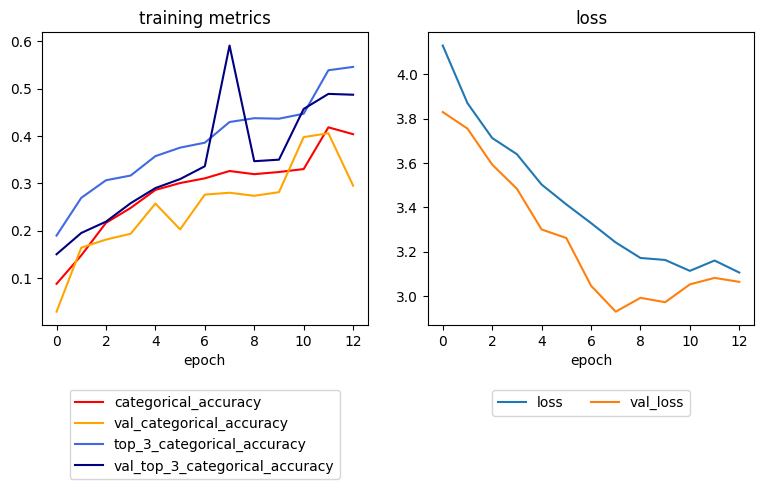

In [18]:
log = pd.read_csv(log_path)

fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, figsize=(20*cm, 15*cm))

ax1.plot(log['epoch'], log['categorical_accuracy'], label='categorical_accuracy', color='red')
ax1.plot(log['epoch'], log['val_categorical_accuracy'], label='val_categorical_accuracy', color='orange')
ax1.plot(log['epoch'], log[f'top_{top_k}_categorical_accuracy'], label=f'top_{top_k}_categorical_accuracy', color='royalblue')
ax1.plot(log['epoch'], log[f'val_top_{top_k}_categorical_accuracy'], label=f'val_top_{top_k}_categorical_accuracy', color='navy')
ax1.set_title('training metrics')
ax1.set_xlabel('epoch')
ax1.legend(loc='upper center', bbox_to_anchor=(0.5, -0.2), ncol=1)  # Legend below the plot

ax2.plot(log['epoch'], log['loss'], label='loss')
ax2.plot(log['epoch'], log['val_loss'], label='val_loss')
ax2.set_title('loss')
ax2.set_xlabel('epoch')
ax2.legend(loc='upper center', bbox_to_anchor=(0.5, -0.2), ncol=2)  # Legend below the plot

fig.tight_layout(rect=[0, 0.1, 1, 1])

plt.savefig(f'{checkpoint_path}/metrics_loss.svg')
plt.show()

In [19]:
# load old model, if needed
if model is None:
    model = load_model(model_path)

In [20]:
# evaluate model
score = model.evaluate(x=Generator(X_test, y_test, 128, max_sequence_length))
print(f'Test loss: {score[0]}')
print(f'Test accuracy: {score[1]}')

  1/407 ━━━━━━━━━━━━━━━━━━━━ 3:46 557ms/step - categorical_accuracy: 0.3203 - loss: 2.5530 - top_3_categorical_accuracy: 0.5234 - w_categorical_accuracy: 0.3203 - w_top_3_categorical_accuracy: 0.5234

  4/407 ━━━━━━━━━━━━━━━━━━━━ 7s 18ms/step - categorical_accuracy: 0.3177 - loss: 2.6772 - top_3_categorical_accuracy: 0.5116 - w_categorical_accuracy: 0.3177 - w_top_3_categorical_accuracy: 0.5116   

  7/407 ━━━━━━━━━━━━━━━━━━━━ 7s 18ms/step - categorical_accuracy: 0.3278 - loss: 2.6723 - top_3_categorical_accuracy: 0.5131 - w_categorical_accuracy: 0.3278 - w_top_3_categorical_accuracy: 0.5131

 10/407 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step - categorical_accuracy: 0.3348 - loss: 2.6533 - top_3_categorical_accuracy: 0.5159 - w_categorical_accuracy: 0.3348 - w_top_3_categorical_accuracy: 0.5159

 14/407 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step - categorical_accuracy: 0.3406 - loss: 2.6382 - top_3_categorical_accuracy: 0.5200 - w_categorical_accuracy: 0.3406 - w_top_3_categorical_accuracy: 0.5200

 17/407 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step - categorical_accuracy: 0.3437 - loss: 2.6309 - top_3_categorical_accuracy: 0.5231 - w_categorical_accuracy: 0.3437 - w_top_3_categorical_accuracy: 0.5231

 21/407 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step - categorical_accuracy: 0.3479 - loss: 2.6191 - top_3_categorical_accuracy: 0.5273 - w_categorical_accuracy: 0.3479 - w_top_3_categorical_accuracy: 0.5273

 24/407 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step - categorical_accuracy: 0.3504 - loss: 2.6126 - top_3_categorical_accuracy: 0.5298 - w_categorical_accuracy: 0.3504 - w_top_3_categorical_accuracy: 0.5298

 27/407 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step - categorical_accuracy: 0.3522 - loss: 2.6080 - top_3_categorical_accuracy: 0.5318 - w_categorical_accuracy: 0.3522 - w_top_3_categorical_accuracy: 0.5318

 30/407 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step - categorical_accuracy: 0.3537 - loss: 2.6041 - top_3_categorical_accuracy: 0.5337 - w_categorical_accuracy: 0.3537 - w_top_3_categorical_accuracy: 0.5337

 34/407 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step - categorical_accuracy: 0.3553 - loss: 2.6003 - top_3_categorical_accuracy: 0.5357 - w_categorical_accuracy: 0.3553 - w_top_3_categorical_accuracy: 0.5357

 37/407 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step - categorical_accuracy: 0.3561 - loss: 2.5984 - top_3_categorical_accuracy: 0.5367 - w_categorical_accuracy: 0.3561 - w_top_3_categorical_accuracy: 0.5367

 40/407 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step - categorical_accuracy: 0.3567 - loss: 2.5969 - top_3_categorical_accuracy: 0.5374 - w_categorical_accuracy: 0.3567 - w_top_3_categorical_accuracy: 0.5374

 43/407 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step - categorical_accuracy: 0.3574 - loss: 2.5953 - top_3_categorical_accuracy: 0.5380 - w_categorical_accuracy: 0.3574 - w_top_3_categorical_accuracy: 0.5380

 46/407 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step - categorical_accuracy: 0.3579 - loss: 2.5942 - top_3_categorical_accuracy: 0.5386 - w_categorical_accuracy: 0.3579 - w_top_3_categorical_accuracy: 0.5386

 50/407 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step - categorical_accuracy: 0.3583 - loss: 2.5936 - top_3_categorical_accuracy: 0.5392 - w_categorical_accuracy: 0.3583 - w_top_3_categorical_accuracy: 0.5392

 53/407 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step - categorical_accuracy: 0.3585 - loss: 2.5934 - top_3_categorical_accuracy: 0.5396 - w_categorical_accuracy: 0.3585 - w_top_3_categorical_accuracy: 0.5396

 56/407 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step - categorical_accuracy: 0.3589 - loss: 2.5929 - top_3_categorical_accuracy: 0.5401 - w_categorical_accuracy: 0.3589 - w_top_3_categorical_accuracy: 0.5401

 59/407 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step - categorical_accuracy: 0.3592 - loss: 2.5922 - top_3_categorical_accuracy: 0.5405 - w_categorical_accuracy: 0.3592 - w_top_3_categorical_accuracy: 0.5405

 62/407 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step - categorical_accuracy: 0.3596 - loss: 2.5915 - top_3_categorical_accuracy: 0.5410 - w_categorical_accuracy: 0.3596 - w_top_3_categorical_accuracy: 0.5410

 65/407 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step - categorical_accuracy: 0.3599 - loss: 2.5908 - top_3_categorical_accuracy: 0.5414 - w_categorical_accuracy: 0.3599 - w_top_3_categorical_accuracy: 0.5414

 68/407 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step - categorical_accuracy: 0.3603 - loss: 2.5900 - top_3_categorical_accuracy: 0.5419 - w_categorical_accuracy: 0.3603 - w_top_3_categorical_accuracy: 0.5419

 71/407 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step - categorical_accuracy: 0.3606 - loss: 2.5890 - top_3_categorical_accuracy: 0.5424 - w_categorical_accuracy: 0.3606 - w_top_3_categorical_accuracy: 0.5424

 74/407 ━━━━━━━━━━━━━━━━━━━━ 5s 18ms/step - categorical_accuracy: 0.3610 - loss: 2.5878 - top_3_categorical_accuracy: 0.5429 - w_categorical_accuracy: 0.3610 - w_top_3_categorical_accuracy: 0.5429

 77/407 ━━━━━━━━━━━━━━━━━━━━ 5s 18ms/step - categorical_accuracy: 0.3615 - loss: 2.5866 - top_3_categorical_accuracy: 0.5434 - w_categorical_accuracy: 0.3615 - w_top_3_categorical_accuracy: 0.5434

 80/407 ━━━━━━━━━━━━━━━━━━━━ 5s 18ms/step - categorical_accuracy: 0.3619 - loss: 2.5853 - top_3_categorical_accuracy: 0.5439 - w_categorical_accuracy: 0.3619 - w_top_3_categorical_accuracy: 0.5439

 83/407 ━━━━━━━━━━━━━━━━━━━━ 5s 18ms/step - categorical_accuracy: 0.3624 - loss: 2.5839 - top_3_categorical_accuracy: 0.5444 - w_categorical_accuracy: 0.3624 - w_top_3_categorical_accuracy: 0.5444

 86/407 ━━━━━━━━━━━━━━━━━━━━ 5s 18ms/step - categorical_accuracy: 0.3629 - loss: 2.5827 - top_3_categorical_accuracy: 0.5448 - w_categorical_accuracy: 0.3629 - w_top_3_categorical_accuracy: 0.5448

 89/407 ━━━━━━━━━━━━━━━━━━━━ 5s 18ms/step - categorical_accuracy: 0.3633 - loss: 2.5816 - top_3_categorical_accuracy: 0.5452 - w_categorical_accuracy: 0.3633 - w_top_3_categorical_accuracy: 0.5452

 92/407 ━━━━━━━━━━━━━━━━━━━━ 5s 18ms/step - categorical_accuracy: 0.3637 - loss: 2.5806 - top_3_categorical_accuracy: 0.5456 - w_categorical_accuracy: 0.3637 - w_top_3_categorical_accuracy: 0.5456

 95/407 ━━━━━━━━━━━━━━━━━━━━ 5s 18ms/step - categorical_accuracy: 0.3640 - loss: 2.5797 - top_3_categorical_accuracy: 0.5459 - w_categorical_accuracy: 0.3640 - w_top_3_categorical_accuracy: 0.5459

 98/407 ━━━━━━━━━━━━━━━━━━━━ 5s 18ms/step - categorical_accuracy: 0.3643 - loss: 2.5788 - top_3_categorical_accuracy: 0.5462 - w_categorical_accuracy: 0.3643 - w_top_3_categorical_accuracy: 0.5462

101/407 ━━━━━━━━━━━━━━━━━━━━ 5s 18ms/step - categorical_accuracy: 0.3646 - loss: 2.5780 - top_3_categorical_accuracy: 0.5465 - w_categorical_accuracy: 0.3646 - w_top_3_categorical_accuracy: 0.5465

104/407 ━━━━━━━━━━━━━━━━━━━━ 5s 18ms/step - categorical_accuracy: 0.3649 - loss: 2.5773 - top_3_categorical_accuracy: 0.5468 - w_categorical_accuracy: 0.3649 - w_top_3_categorical_accuracy: 0.5468

107/407 ━━━━━━━━━━━━━━━━━━━━ 5s 18ms/step - categorical_accuracy: 0.3651 - loss: 2.5768 - top_3_categorical_accuracy: 0.5470 - w_categorical_accuracy: 0.3651 - w_top_3_categorical_accuracy: 0.5470

110/407 ━━━━━━━━━━━━━━━━━━━━ 5s 18ms/step - categorical_accuracy: 0.3653 - loss: 2.5764 - top_3_categorical_accuracy: 0.5471 - w_categorical_accuracy: 0.3653 - w_top_3_categorical_accuracy: 0.5471

113/407 ━━━━━━━━━━━━━━━━━━━━ 5s 18ms/step - categorical_accuracy: 0.3655 - loss: 2.5761 - top_3_categorical_accuracy: 0.5473 - w_categorical_accuracy: 0.3655 - w_top_3_categorical_accuracy: 0.5473

116/407 ━━━━━━━━━━━━━━━━━━━━ 5s 18ms/step - categorical_accuracy: 0.3656 - loss: 2.5758 - top_3_categorical_accuracy: 0.5475 - w_categorical_accuracy: 0.3656 - w_top_3_categorical_accuracy: 0.5475

119/407 ━━━━━━━━━━━━━━━━━━━━ 5s 18ms/step - categorical_accuracy: 0.3658 - loss: 2.5755 - top_3_categorical_accuracy: 0.5476 - w_categorical_accuracy: 0.3658 - w_top_3_categorical_accuracy: 0.5476

122/407 ━━━━━━━━━━━━━━━━━━━━ 5s 18ms/step - categorical_accuracy: 0.3659 - loss: 2.5751 - top_3_categorical_accuracy: 0.5478 - w_categorical_accuracy: 0.3659 - w_top_3_categorical_accuracy: 0.5478

125/407 ━━━━━━━━━━━━━━━━━━━━ 5s 18ms/step - categorical_accuracy: 0.3661 - loss: 2.5748 - top_3_categorical_accuracy: 0.5479 - w_categorical_accuracy: 0.3661 - w_top_3_categorical_accuracy: 0.5479

128/407 ━━━━━━━━━━━━━━━━━━━━ 5s 18ms/step - categorical_accuracy: 0.3662 - loss: 2.5745 - top_3_categorical_accuracy: 0.5480 - w_categorical_accuracy: 0.3662 - w_top_3_categorical_accuracy: 0.5480

131/407 ━━━━━━━━━━━━━━━━━━━━ 5s 18ms/step - categorical_accuracy: 0.3663 - loss: 2.5744 - top_3_categorical_accuracy: 0.5481 - w_categorical_accuracy: 0.3663 - w_top_3_categorical_accuracy: 0.5481

134/407 ━━━━━━━━━━━━━━━━━━━━ 5s 18ms/step - categorical_accuracy: 0.3663 - loss: 2.5742 - top_3_categorical_accuracy: 0.5482 - w_categorical_accuracy: 0.3663 - w_top_3_categorical_accuracy: 0.5482

137/407 ━━━━━━━━━━━━━━━━━━━━ 4s 18ms/step - categorical_accuracy: 0.3664 - loss: 2.5742 - top_3_categorical_accuracy: 0.5483 - w_categorical_accuracy: 0.3664 - w_top_3_categorical_accuracy: 0.5483

140/407 ━━━━━━━━━━━━━━━━━━━━ 4s 18ms/step - categorical_accuracy: 0.3665 - loss: 2.5741 - top_3_categorical_accuracy: 0.5483 - w_categorical_accuracy: 0.3665 - w_top_3_categorical_accuracy: 0.5483

143/407 ━━━━━━━━━━━━━━━━━━━━ 4s 18ms/step - categorical_accuracy: 0.3665 - loss: 2.5740 - top_3_categorical_accuracy: 0.5484 - w_categorical_accuracy: 0.3665 - w_top_3_categorical_accuracy: 0.5484

146/407 ━━━━━━━━━━━━━━━━━━━━ 4s 18ms/step - categorical_accuracy: 0.3666 - loss: 2.5740 - top_3_categorical_accuracy: 0.5485 - w_categorical_accuracy: 0.3666 - w_top_3_categorical_accuracy: 0.5485

149/407 ━━━━━━━━━━━━━━━━━━━━ 4s 18ms/step - categorical_accuracy: 0.3666 - loss: 2.5740 - top_3_categorical_accuracy: 0.5485 - w_categorical_accuracy: 0.3666 - w_top_3_categorical_accuracy: 0.5485

153/407 ━━━━━━━━━━━━━━━━━━━━ 4s 18ms/step - categorical_accuracy: 0.3667 - loss: 2.5740 - top_3_categorical_accuracy: 0.5486 - w_categorical_accuracy: 0.3667 - w_top_3_categorical_accuracy: 0.5486

156/407 ━━━━━━━━━━━━━━━━━━━━ 4s 18ms/step - categorical_accuracy: 0.3667 - loss: 2.5740 - top_3_categorical_accuracy: 0.5487 - w_categorical_accuracy: 0.3667 - w_top_3_categorical_accuracy: 0.5487

159/407 ━━━━━━━━━━━━━━━━━━━━ 4s 18ms/step - categorical_accuracy: 0.3667 - loss: 2.5740 - top_3_categorical_accuracy: 0.5487 - w_categorical_accuracy: 0.3667 - w_top_3_categorical_accuracy: 0.5487

162/407 ━━━━━━━━━━━━━━━━━━━━ 4s 18ms/step - categorical_accuracy: 0.3668 - loss: 2.5740 - top_3_categorical_accuracy: 0.5488 - w_categorical_accuracy: 0.3668 - w_top_3_categorical_accuracy: 0.5488

165/407 ━━━━━━━━━━━━━━━━━━━━ 4s 18ms/step - categorical_accuracy: 0.3668 - loss: 2.5739 - top_3_categorical_accuracy: 0.5488 - w_categorical_accuracy: 0.3668 - w_top_3_categorical_accuracy: 0.5488

168/407 ━━━━━━━━━━━━━━━━━━━━ 4s 18ms/step - categorical_accuracy: 0.3669 - loss: 2.5739 - top_3_categorical_accuracy: 0.5489 - w_categorical_accuracy: 0.3669 - w_top_3_categorical_accuracy: 0.5489

171/407 ━━━━━━━━━━━━━━━━━━━━ 4s 18ms/step - categorical_accuracy: 0.3669 - loss: 2.5740 - top_3_categorical_accuracy: 0.5489 - w_categorical_accuracy: 0.3669 - w_top_3_categorical_accuracy: 0.5489

174/407 ━━━━━━━━━━━━━━━━━━━━ 4s 18ms/step - categorical_accuracy: 0.3669 - loss: 2.5740 - top_3_categorical_accuracy: 0.5490 - w_categorical_accuracy: 0.3669 - w_top_3_categorical_accuracy: 0.5490

177/407 ━━━━━━━━━━━━━━━━━━━━ 4s 18ms/step - categorical_accuracy: 0.3670 - loss: 2.5740 - top_3_categorical_accuracy: 0.5490 - w_categorical_accuracy: 0.3670 - w_top_3_categorical_accuracy: 0.5490

180/407 ━━━━━━━━━━━━━━━━━━━━ 4s 19ms/step - categorical_accuracy: 0.3670 - loss: 2.5740 - top_3_categorical_accuracy: 0.5491 - w_categorical_accuracy: 0.3670 - w_top_3_categorical_accuracy: 0.5491

183/407 ━━━━━━━━━━━━━━━━━━━━ 4s 19ms/step - categorical_accuracy: 0.3670 - loss: 2.5741 - top_3_categorical_accuracy: 0.5492 - w_categorical_accuracy: 0.3670 - w_top_3_categorical_accuracy: 0.5492

186/407 ━━━━━━━━━━━━━━━━━━━━ 4s 19ms/step - categorical_accuracy: 0.3671 - loss: 2.5741 - top_3_categorical_accuracy: 0.5492 - w_categorical_accuracy: 0.3671 - w_top_3_categorical_accuracy: 0.5492

189/407 ━━━━━━━━━━━━━━━━━━━━ 4s 19ms/step - categorical_accuracy: 0.3671 - loss: 2.5741 - top_3_categorical_accuracy: 0.5493 - w_categorical_accuracy: 0.3671 - w_top_3_categorical_accuracy: 0.5493

192/407 ━━━━━━━━━━━━━━━━━━━━ 3s 19ms/step - categorical_accuracy: 0.3671 - loss: 2.5741 - top_3_categorical_accuracy: 0.5493 - w_categorical_accuracy: 0.3671 - w_top_3_categorical_accuracy: 0.5493

195/407 ━━━━━━━━━━━━━━━━━━━━ 3s 18ms/step - categorical_accuracy: 0.3672 - loss: 2.5742 - top_3_categorical_accuracy: 0.5494 - w_categorical_accuracy: 0.3672 - w_top_3_categorical_accuracy: 0.5494

198/407 ━━━━━━━━━━━━━━━━━━━━ 3s 19ms/step - categorical_accuracy: 0.3672 - loss: 2.5742 - top_3_categorical_accuracy: 0.5494 - w_categorical_accuracy: 0.3672 - w_top_3_categorical_accuracy: 0.5494

201/407 ━━━━━━━━━━━━━━━━━━━━ 3s 18ms/step - categorical_accuracy: 0.3673 - loss: 2.5742 - top_3_categorical_accuracy: 0.5495 - w_categorical_accuracy: 0.3673 - w_top_3_categorical_accuracy: 0.5495

204/407 ━━━━━━━━━━━━━━━━━━━━ 3s 19ms/step - categorical_accuracy: 0.3673 - loss: 2.5743 - top_3_categorical_accuracy: 0.5495 - w_categorical_accuracy: 0.3673 - w_top_3_categorical_accuracy: 0.5495

207/407 ━━━━━━━━━━━━━━━━━━━━ 3s 19ms/step - categorical_accuracy: 0.3673 - loss: 2.5743 - top_3_categorical_accuracy: 0.5496 - w_categorical_accuracy: 0.3673 - w_top_3_categorical_accuracy: 0.5496

210/407 ━━━━━━━━━━━━━━━━━━━━ 3s 19ms/step - categorical_accuracy: 0.3673 - loss: 2.5743 - top_3_categorical_accuracy: 0.5497 - w_categorical_accuracy: 0.3673 - w_top_3_categorical_accuracy: 0.5497

213/407 ━━━━━━━━━━━━━━━━━━━━ 3s 19ms/step - categorical_accuracy: 0.3674 - loss: 2.5743 - top_3_categorical_accuracy: 0.5497 - w_categorical_accuracy: 0.3674 - w_top_3_categorical_accuracy: 0.5497

216/407 ━━━━━━━━━━━━━━━━━━━━ 3s 19ms/step - categorical_accuracy: 0.3674 - loss: 2.5743 - top_3_categorical_accuracy: 0.5498 - w_categorical_accuracy: 0.3674 - w_top_3_categorical_accuracy: 0.5498

219/407 ━━━━━━━━━━━━━━━━━━━━ 3s 19ms/step - categorical_accuracy: 0.3674 - loss: 2.5744 - top_3_categorical_accuracy: 0.5498 - w_categorical_accuracy: 0.3674 - w_top_3_categorical_accuracy: 0.5498

222/407 ━━━━━━━━━━━━━━━━━━━━ 3s 19ms/step - categorical_accuracy: 0.3675 - loss: 2.5744 - top_3_categorical_accuracy: 0.5498 - w_categorical_accuracy: 0.3675 - w_top_3_categorical_accuracy: 0.5498

225/407 ━━━━━━━━━━━━━━━━━━━━ 3s 19ms/step - categorical_accuracy: 0.3675 - loss: 2.5744 - top_3_categorical_accuracy: 0.5499 - w_categorical_accuracy: 0.3675 - w_top_3_categorical_accuracy: 0.5499

228/407 ━━━━━━━━━━━━━━━━━━━━ 3s 19ms/step - categorical_accuracy: 0.3675 - loss: 2.5744 - top_3_categorical_accuracy: 0.5499 - w_categorical_accuracy: 0.3675 - w_top_3_categorical_accuracy: 0.5499

231/407 ━━━━━━━━━━━━━━━━━━━━ 3s 19ms/step - categorical_accuracy: 0.3675 - loss: 2.5745 - top_3_categorical_accuracy: 0.5500 - w_categorical_accuracy: 0.3675 - w_top_3_categorical_accuracy: 0.5500

234/407 ━━━━━━━━━━━━━━━━━━━━ 3s 19ms/step - categorical_accuracy: 0.3675 - loss: 2.5745 - top_3_categorical_accuracy: 0.5500 - w_categorical_accuracy: 0.3675 - w_top_3_categorical_accuracy: 0.5500

237/407 ━━━━━━━━━━━━━━━━━━━━ 3s 19ms/step - categorical_accuracy: 0.3676 - loss: 2.5746 - top_3_categorical_accuracy: 0.5500 - w_categorical_accuracy: 0.3676 - w_top_3_categorical_accuracy: 0.5500

240/407 ━━━━━━━━━━━━━━━━━━━━ 3s 19ms/step - categorical_accuracy: 0.3676 - loss: 2.5747 - top_3_categorical_accuracy: 0.5501 - w_categorical_accuracy: 0.3676 - w_top_3_categorical_accuracy: 0.5501

243/407 ━━━━━━━━━━━━━━━━━━━━ 3s 19ms/step - categorical_accuracy: 0.3676 - loss: 2.5747 - top_3_categorical_accuracy: 0.5501 - w_categorical_accuracy: 0.3676 - w_top_3_categorical_accuracy: 0.5501

246/407 ━━━━━━━━━━━━━━━━━━━━ 2s 19ms/step - categorical_accuracy: 0.3676 - loss: 2.5748 - top_3_categorical_accuracy: 0.5501 - w_categorical_accuracy: 0.3676 - w_top_3_categorical_accuracy: 0.5501

249/407 ━━━━━━━━━━━━━━━━━━━━ 2s 19ms/step - categorical_accuracy: 0.3676 - loss: 2.5749 - top_3_categorical_accuracy: 0.5502 - w_categorical_accuracy: 0.3676 - w_top_3_categorical_accuracy: 0.5502

252/407 ━━━━━━━━━━━━━━━━━━━━ 2s 19ms/step - categorical_accuracy: 0.3677 - loss: 2.5750 - top_3_categorical_accuracy: 0.5502 - w_categorical_accuracy: 0.3677 - w_top_3_categorical_accuracy: 0.5502

255/407 ━━━━━━━━━━━━━━━━━━━━ 2s 19ms/step - categorical_accuracy: 0.3677 - loss: 2.5750 - top_3_categorical_accuracy: 0.5502 - w_categorical_accuracy: 0.3677 - w_top_3_categorical_accuracy: 0.5502

258/407 ━━━━━━━━━━━━━━━━━━━━ 2s 19ms/step - categorical_accuracy: 0.3677 - loss: 2.5751 - top_3_categorical_accuracy: 0.5503 - w_categorical_accuracy: 0.3677 - w_top_3_categorical_accuracy: 0.5503

261/407 ━━━━━━━━━━━━━━━━━━━━ 2s 19ms/step - categorical_accuracy: 0.3677 - loss: 2.5751 - top_3_categorical_accuracy: 0.5503 - w_categorical_accuracy: 0.3677 - w_top_3_categorical_accuracy: 0.5503

264/407 ━━━━━━━━━━━━━━━━━━━━ 2s 19ms/step - categorical_accuracy: 0.3678 - loss: 2.5751 - top_3_categorical_accuracy: 0.5503 - w_categorical_accuracy: 0.3678 - w_top_3_categorical_accuracy: 0.5503

267/407 ━━━━━━━━━━━━━━━━━━━━ 2s 19ms/step - categorical_accuracy: 0.3678 - loss: 2.5752 - top_3_categorical_accuracy: 0.5504 - w_categorical_accuracy: 0.3678 - w_top_3_categorical_accuracy: 0.5504

270/407 ━━━━━━━━━━━━━━━━━━━━ 2s 19ms/step - categorical_accuracy: 0.3678 - loss: 2.5751 - top_3_categorical_accuracy: 0.5504 - w_categorical_accuracy: 0.3678 - w_top_3_categorical_accuracy: 0.5504

273/407 ━━━━━━━━━━━━━━━━━━━━ 2s 19ms/step - categorical_accuracy: 0.3679 - loss: 2.5751 - top_3_categorical_accuracy: 0.5505 - w_categorical_accuracy: 0.3679 - w_top_3_categorical_accuracy: 0.5505

276/407 ━━━━━━━━━━━━━━━━━━━━ 2s 19ms/step - categorical_accuracy: 0.3679 - loss: 2.5751 - top_3_categorical_accuracy: 0.5505 - w_categorical_accuracy: 0.3679 - w_top_3_categorical_accuracy: 0.5505

279/407 ━━━━━━━━━━━━━━━━━━━━ 2s 19ms/step - categorical_accuracy: 0.3679 - loss: 2.5751 - top_3_categorical_accuracy: 0.5505 - w_categorical_accuracy: 0.3679 - w_top_3_categorical_accuracy: 0.5505

282/407 ━━━━━━━━━━━━━━━━━━━━ 2s 19ms/step - categorical_accuracy: 0.3680 - loss: 2.5751 - top_3_categorical_accuracy: 0.5506 - w_categorical_accuracy: 0.3680 - w_top_3_categorical_accuracy: 0.5506

285/407 ━━━━━━━━━━━━━━━━━━━━ 2s 19ms/step - categorical_accuracy: 0.3680 - loss: 2.5750 - top_3_categorical_accuracy: 0.5506 - w_categorical_accuracy: 0.3680 - w_top_3_categorical_accuracy: 0.5506

288/407 ━━━━━━━━━━━━━━━━━━━━ 2s 19ms/step - categorical_accuracy: 0.3680 - loss: 2.5750 - top_3_categorical_accuracy: 0.5506 - w_categorical_accuracy: 0.3680 - w_top_3_categorical_accuracy: 0.5506

291/407 ━━━━━━━━━━━━━━━━━━━━ 2s 19ms/step - categorical_accuracy: 0.3681 - loss: 2.5749 - top_3_categorical_accuracy: 0.5507 - w_categorical_accuracy: 0.3681 - w_top_3_categorical_accuracy: 0.5507

294/407 ━━━━━━━━━━━━━━━━━━━━ 2s 19ms/step - categorical_accuracy: 0.3681 - loss: 2.5749 - top_3_categorical_accuracy: 0.5507 - w_categorical_accuracy: 0.3681 - w_top_3_categorical_accuracy: 0.5507

297/407 ━━━━━━━━━━━━━━━━━━━━ 2s 19ms/step - categorical_accuracy: 0.3681 - loss: 2.5748 - top_3_categorical_accuracy: 0.5508 - w_categorical_accuracy: 0.3681 - w_top_3_categorical_accuracy: 0.5508

300/407 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - categorical_accuracy: 0.3682 - loss: 2.5748 - top_3_categorical_accuracy: 0.5508 - w_categorical_accuracy: 0.3682 - w_top_3_categorical_accuracy: 0.5508

303/407 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - categorical_accuracy: 0.3682 - loss: 2.5747 - top_3_categorical_accuracy: 0.5509 - w_categorical_accuracy: 0.3682 - w_top_3_categorical_accuracy: 0.5509

306/407 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - categorical_accuracy: 0.3682 - loss: 2.5747 - top_3_categorical_accuracy: 0.5509 - w_categorical_accuracy: 0.3682 - w_top_3_categorical_accuracy: 0.5509

309/407 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - categorical_accuracy: 0.3683 - loss: 2.5746 - top_3_categorical_accuracy: 0.5510 - w_categorical_accuracy: 0.3683 - w_top_3_categorical_accuracy: 0.5510

312/407 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - categorical_accuracy: 0.3683 - loss: 2.5745 - top_3_categorical_accuracy: 0.5510 - w_categorical_accuracy: 0.3683 - w_top_3_categorical_accuracy: 0.5510

315/407 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - categorical_accuracy: 0.3684 - loss: 2.5744 - top_3_categorical_accuracy: 0.5510 - w_categorical_accuracy: 0.3684 - w_top_3_categorical_accuracy: 0.5510

318/407 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - categorical_accuracy: 0.3684 - loss: 2.5743 - top_3_categorical_accuracy: 0.5511 - w_categorical_accuracy: 0.3684 - w_top_3_categorical_accuracy: 0.5511

321/407 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - categorical_accuracy: 0.3684 - loss: 2.5743 - top_3_categorical_accuracy: 0.5511 - w_categorical_accuracy: 0.3684 - w_top_3_categorical_accuracy: 0.5511

324/407 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - categorical_accuracy: 0.3685 - loss: 2.5742 - top_3_categorical_accuracy: 0.5512 - w_categorical_accuracy: 0.3685 - w_top_3_categorical_accuracy: 0.5512

327/407 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - categorical_accuracy: 0.3685 - loss: 2.5741 - top_3_categorical_accuracy: 0.5512 - w_categorical_accuracy: 0.3685 - w_top_3_categorical_accuracy: 0.5512

330/407 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - categorical_accuracy: 0.3685 - loss: 2.5741 - top_3_categorical_accuracy: 0.5513 - w_categorical_accuracy: 0.3685 - w_top_3_categorical_accuracy: 0.5513

333/407 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - categorical_accuracy: 0.3686 - loss: 2.5740 - top_3_categorical_accuracy: 0.5513 - w_categorical_accuracy: 0.3686 - w_top_3_categorical_accuracy: 0.5513

336/407 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - categorical_accuracy: 0.3686 - loss: 2.5740 - top_3_categorical_accuracy: 0.5513 - w_categorical_accuracy: 0.3686 - w_top_3_categorical_accuracy: 0.5513

339/407 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - categorical_accuracy: 0.3686 - loss: 2.5739 - top_3_categorical_accuracy: 0.5514 - w_categorical_accuracy: 0.3686 - w_top_3_categorical_accuracy: 0.5514

342/407 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - categorical_accuracy: 0.3686 - loss: 2.5739 - top_3_categorical_accuracy: 0.5514 - w_categorical_accuracy: 0.3686 - w_top_3_categorical_accuracy: 0.5514

345/407 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - categorical_accuracy: 0.3687 - loss: 2.5738 - top_3_categorical_accuracy: 0.5514 - w_categorical_accuracy: 0.3687 - w_top_3_categorical_accuracy: 0.5514

348/407 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - categorical_accuracy: 0.3687 - loss: 2.5738 - top_3_categorical_accuracy: 0.5515 - w_categorical_accuracy: 0.3687 - w_top_3_categorical_accuracy: 0.5515

351/407 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - categorical_accuracy: 0.3687 - loss: 2.5738 - top_3_categorical_accuracy: 0.5515 - w_categorical_accuracy: 0.3687 - w_top_3_categorical_accuracy: 0.5515

354/407 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - categorical_accuracy: 0.3687 - loss: 2.5737 - top_3_categorical_accuracy: 0.5515 - w_categorical_accuracy: 0.3687 - w_top_3_categorical_accuracy: 0.5515

357/407 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - categorical_accuracy: 0.3688 - loss: 2.5737 - top_3_categorical_accuracy: 0.5516 - w_categorical_accuracy: 0.3688 - w_top_3_categorical_accuracy: 0.5516

360/407 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - categorical_accuracy: 0.3688 - loss: 2.5737 - top_3_categorical_accuracy: 0.5516 - w_categorical_accuracy: 0.3688 - w_top_3_categorical_accuracy: 0.5516

363/407 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - categorical_accuracy: 0.3688 - loss: 2.5737 - top_3_categorical_accuracy: 0.5516 - w_categorical_accuracy: 0.3688 - w_top_3_categorical_accuracy: 0.5516

366/407 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - categorical_accuracy: 0.3688 - loss: 2.5736 - top_3_categorical_accuracy: 0.5516 - w_categorical_accuracy: 0.3688 - w_top_3_categorical_accuracy: 0.5516

369/407 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - categorical_accuracy: 0.3689 - loss: 2.5736 - top_3_categorical_accuracy: 0.5517 - w_categorical_accuracy: 0.3689 - w_top_3_categorical_accuracy: 0.5517

372/407 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - categorical_accuracy: 0.3689 - loss: 2.5736 - top_3_categorical_accuracy: 0.5517 - w_categorical_accuracy: 0.3689 - w_top_3_categorical_accuracy: 0.5517

375/407 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - categorical_accuracy: 0.3689 - loss: 2.5736 - top_3_categorical_accuracy: 0.5517 - w_categorical_accuracy: 0.3689 - w_top_3_categorical_accuracy: 0.5517

378/407 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - categorical_accuracy: 0.3689 - loss: 2.5736 - top_3_categorical_accuracy: 0.5517 - w_categorical_accuracy: 0.3689 - w_top_3_categorical_accuracy: 0.5517

381/407 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - categorical_accuracy: 0.3690 - loss: 2.5735 - top_3_categorical_accuracy: 0.5518 - w_categorical_accuracy: 0.3690 - w_top_3_categorical_accuracy: 0.5518

384/407 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - categorical_accuracy: 0.3690 - loss: 2.5735 - top_3_categorical_accuracy: 0.5518 - w_categorical_accuracy: 0.3690 - w_top_3_categorical_accuracy: 0.5518

387/407 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - categorical_accuracy: 0.3690 - loss: 2.5735 - top_3_categorical_accuracy: 0.5518 - w_categorical_accuracy: 0.3690 - w_top_3_categorical_accuracy: 0.5518

390/407 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - categorical_accuracy: 0.3690 - loss: 2.5734 - top_3_categorical_accuracy: 0.5518 - w_categorical_accuracy: 0.3690 - w_top_3_categorical_accuracy: 0.5518

393/407 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - categorical_accuracy: 0.3691 - loss: 2.5734 - top_3_categorical_accuracy: 0.5519 - w_categorical_accuracy: 0.3691 - w_top_3_categorical_accuracy: 0.5519

396/407 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - categorical_accuracy: 0.3691 - loss: 2.5734 - top_3_categorical_accuracy: 0.5519 - w_categorical_accuracy: 0.3691 - w_top_3_categorical_accuracy: 0.5519

399/407 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - categorical_accuracy: 0.3691 - loss: 2.5733 - top_3_categorical_accuracy: 0.5519 - w_categorical_accuracy: 0.3691 - w_top_3_categorical_accuracy: 0.5519

402/407 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - categorical_accuracy: 0.3691 - loss: 2.5733 - top_3_categorical_accuracy: 0.5519 - w_categorical_accuracy: 0.3691 - w_top_3_categorical_accuracy: 0.5519

405/407 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - categorical_accuracy: 0.3691 - loss: 2.5733 - top_3_categorical_accuracy: 0.5519 - w_categorical_accuracy: 0.3691 - w_top_3_categorical_accuracy: 0.5519

407/407 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - categorical_accuracy: 0.3692 - loss: 2.5732 - top_3_categorical_accuracy: 0.5520 - w_categorical_accuracy: 0.3692 - w_top_3_categorical_accuracy: 0.5520

407/407 ━━━━━━━━━━━━━━━━━━━━ 9s 20ms/step - categorical_accuracy: 0.3692 - loss: 2.5732 - top_3_categorical_accuracy: 0.5520 - w_categorical_accuracy: 0.3692 - w_top_3_categorical_accuracy: 0.5520


Test loss: 2.56728458404541
Test accuracy: 0.37232163548469543


In [21]:
# print classification report
y_pred = model.predict(x=Generator(X_test, y_test, 128, max_sequence_length))
y_pred = np.argmax(y_pred, axis=1)
y_true = np.argmax(y_test, axis=1)

distinct_labels = [labels_map[i] for i in range(labels_cardinality)]

report = classification_report(y_true, y_pred, target_names=distinct_labels, zero_division=np.nan)
report_dict = classification_report(y_true, y_pred, target_names=distinct_labels, zero_division=np.nan, output_dict=True)

print(report)

# save classification report to file
with open(f'{checkpoint_path}/classification_report.txt', 'w') as f:
    json.dump(report_dict, f)

  1/407 ━━━━━━━━━━━━━━━━━━━━ 5:01 742ms/step

  5/407 ━━━━━━━━━━━━━━━━━━━━ 7s 19ms/step   

  9/407 ━━━━━━━━━━━━━━━━━━━━ 7s 18ms/step

 13/407 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step

 17/407 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step

 20/407 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step

 23/407 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step

 26/407 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step

 29/407 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step

 32/407 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step

 36/407 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step

 39/407 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step

 43/407 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step

 46/407 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step

 49/407 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step

 53/407 ━━━━━━━━━━━━━━━━━━━━ 5s 17ms/step

 57/407 ━━━━━━━━━━━━━━━━━━━━ 5s 17ms/step

 60/407 ━━━━━━━━━━━━━━━━━━━━ 5s 17ms/step

 64/407 ━━━━━━━━━━━━━━━━━━━━ 5s 17ms/step

 68/407 ━━━━━━━━━━━━━━━━━━━━ 5s 17ms/step

 72/407 ━━━━━━━━━━━━━━━━━━━━ 5s 17ms/step

 76/407 ━━━━━━━━━━━━━━━━━━━━ 5s 17ms/step

 80/407 ━━━━━━━━━━━━━━━━━━━━ 5s 17ms/step

 84/407 ━━━━━━━━━━━━━━━━━━━━ 5s 17ms/step

 87/407 ━━━━━━━━━━━━━━━━━━━━ 5s 17ms/step

 91/407 ━━━━━━━━━━━━━━━━━━━━ 5s 16ms/step

 94/407 ━━━━━━━━━━━━━━━━━━━━ 5s 17ms/step

 98/407 ━━━━━━━━━━━━━━━━━━━━ 5s 16ms/step

102/407 ━━━━━━━━━━━━━━━━━━━━ 5s 16ms/step

106/407 ━━━━━━━━━━━━━━━━━━━━ 4s 16ms/step

110/407 ━━━━━━━━━━━━━━━━━━━━ 4s 16ms/step

114/407 ━━━━━━━━━━━━━━━━━━━━ 4s 16ms/step

117/407 ━━━━━━━━━━━━━━━━━━━━ 4s 16ms/step

120/407 ━━━━━━━━━━━━━━━━━━━━ 4s 16ms/step

123/407 ━━━━━━━━━━━━━━━━━━━━ 4s 16ms/step

126/407 ━━━━━━━━━━━━━━━━━━━━ 4s 16ms/step

130/407 ━━━━━━━━━━━━━━━━━━━━ 4s 16ms/step

134/407 ━━━━━━━━━━━━━━━━━━━━ 4s 16ms/step

137/407 ━━━━━━━━━━━━━━━━━━━━ 4s 16ms/step

140/407 ━━━━━━━━━━━━━━━━━━━━ 4s 16ms/step

143/407 ━━━━━━━━━━━━━━━━━━━━ 4s 16ms/step

146/407 ━━━━━━━━━━━━━━━━━━━━ 4s 17ms/step

150/407 ━━━━━━━━━━━━━━━━━━━━ 4s 17ms/step

153/407 ━━━━━━━━━━━━━━━━━━━━ 4s 17ms/step

157/407 ━━━━━━━━━━━━━━━━━━━━ 4s 17ms/step

161/407 ━━━━━━━━━━━━━━━━━━━━ 4s 17ms/step

164/407 ━━━━━━━━━━━━━━━━━━━━ 4s 17ms/step

168/407 ━━━━━━━━━━━━━━━━━━━━ 3s 17ms/step

172/407 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step

176/407 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step

179/407 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step

182/407 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step

186/407 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step

189/407 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step

193/407 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step

197/407 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step

201/407 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step

205/407 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step

209/407 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step

213/407 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step

217/407 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step

220/407 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step

223/407 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step

226/407 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step

230/407 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step

234/407 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step

238/407 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step

242/407 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step

246/407 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step

250/407 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step

254/407 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step

257/407 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step

261/407 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step

265/407 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step

269/407 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step

273/407 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step

277/407 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step

281/407 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step

285/407 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step

288/407 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step

291/407 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step

294/407 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step

297/407 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step

300/407 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step

303/407 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step

306/407 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step

309/407 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step

313/407 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step

317/407 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step

321/407 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step

325/407 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step

328/407 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step

331/407 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step

335/407 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step

339/407 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step

343/407 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step

346/407 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step

350/407 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step

354/407 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step

358/407 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step

362/407 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step

366/407 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step

370/407 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step

374/407 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step

378/407 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step

382/407 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step

386/407 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step

389/407 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step

393/407 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step

396/407 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step

399/407 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step

403/407 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step

407/407 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step

407/407 ━━━━━━━━━━━━━━━━━━━━ 8s 18ms/step


                 precision    recall  f1-score   support

      adjkerntz        nan      0.00      0.00        11
         alpine       0.58      0.68      0.63       560
          anvil       0.18      0.33      0.23       378
          atrun        nan      0.00      0.00       237
            awk        nan      0.00      0.00         5
       basename        nan      0.00      0.00         2
           bash        nan      0.00      0.00     12512
            cat        nan      0.00      0.00        26
        cleanup       0.29      0.34      0.31       276
            cmp        nan      0.00      0.00         5
             cp        nan      0.00      0.00        30
           cron        nan      0.00      0.00       624
           date        nan      0.00      0.00      1218
             dd        nan      0.00      0.00       125
       dhclient       0.00      0.00      0.00        17
          dmesg       0.00      0.00      0.00        15
          egrep        nan    

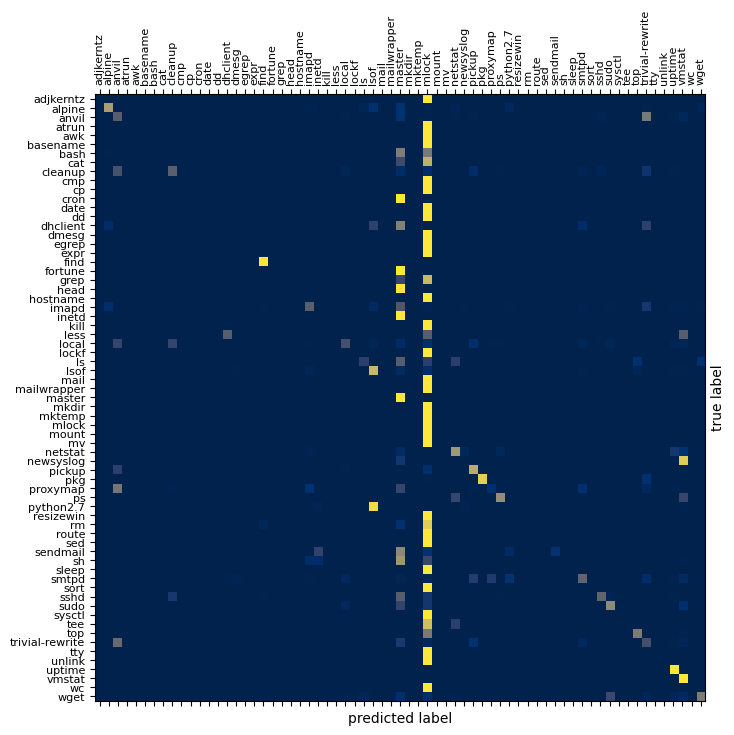

In [22]:
# print confusion matrix
# labels explicitly set, because current model may not predict all labels
conf_matrix = confusion_matrix(y_true, y_pred, labels=range(labels_cardinality), normalize='true')

# Replace all NaN values with 0
conf_matrix = np.nan_to_num(conf_matrix)

# Verify the distinct labels align correctly
distinct_labels = [labels_map[i] for i in range(labels_cardinality)]

# Plot the confusion matrix
fig, ax = plt.subplots(figsize=(20*cm, 20*cm))

ax.matshow(conf_matrix, cmap='cividis', aspect='auto')

# Set class names on axes
ax.set_xticks(range(len(distinct_labels)))
ax.set_yticks(range(len(distinct_labels)))
ax.set_xticklabels(distinct_labels, rotation=90, fontsize=8)
ax.set_yticklabels(distinct_labels, fontsize=8)

# Set axis labels "predicted" and "actual"
ax.set_xlabel('predicted label')
ax.set_ylabel('true label')
# y-axis label right side
ax.yaxis.set_label_position('right')

# set figsize
plt.savefig(f'{checkpoint_path}/confusion_matrix.svg')
plt.show()

In [23]:
unique_in_y_pred = [ labels_map[i] for i in np.unique(y_pred) ]
#print("Unique labels in y_pred:", unique_in_y_pred)

unique_not_in_y_pred = [ label for label in distinct_labels if label not in unique_in_y_pred ]
print("Unique labels not in y_pred:", unique_not_in_y_pred)

Unique labels not in y_pred: ['adjkerntz', 'atrun', 'awk', 'basename', 'bash', 'cat', 'cmp', 'cp', 'cron', 'date', 'dd', 'egrep', 'expr', 'fortune', 'grep', 'head', 'hostname', 'kill', 'less', 'lockf', 'mail', 'mailwrapper', 'mkdir', 'mktemp', 'mount', 'mv', 'resizewin', 'rm', 'route', 'sed', 'sh', 'sleep', 'sort', 'sysctl', 'tee', 'tty', 'unlink', 'wc']
